In [133]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
import xgboost as xgb
import catboost as cb
from sklearn.model_selection import train_test_split,cross_val_score
from sklearn.model_selection import RandomizedSearchCV , GridSearchCV
from sklearn.metrics import confusion_matrix , classification_report
from sklearn.metrics import precision_score,recall_score,f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve
import pickle
from sklearn.ensemble import VotingClassifier

In [2]:
## import data
df=pd.read_csv("heart-disease.csv")

In [3]:
df.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 303 entries, 0 to 302
Data columns (total 14 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   age       303 non-null    int64  
 1   sex       303 non-null    int64  
 2   cp        303 non-null    int64  
 3   trestbps  303 non-null    int64  
 4   chol      303 non-null    int64  
 5   fbs       303 non-null    int64  
 6   restecg   303 non-null    int64  
 7   thalach   303 non-null    int64  
 8   exang     303 non-null    int64  
 9   oldpeak   303 non-null    float64
 10  slope     303 non-null    int64  
 11  ca        303 non-null    int64  
 12  thal      303 non-null    int64  
 13  target    303 non-null    int64  
dtypes: float64(1), int64(13)
memory usage: 33.3 KB


In [4]:
df.isna().sum()

age         0
sex         0
cp          0
trestbps    0
chol        0
fbs         0
restecg     0
thalach     0
exang       0
oldpeak     0
slope       0
ca          0
thal        0
target      0
dtype: int64

<Axes: >

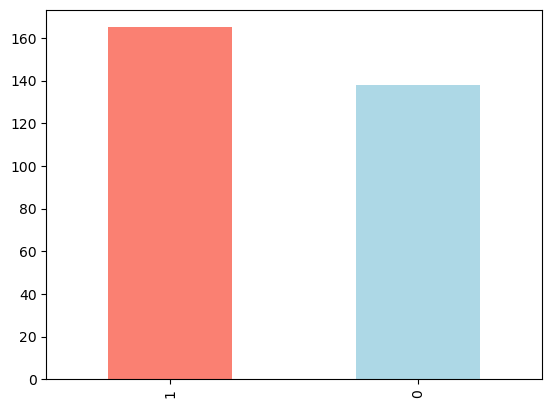

In [5]:
df.target.value_counts().plot(kind="bar",color=["salmon","lightblue"])

In [6]:
df.describe()

,age,sex,cp,trestbps,chol,fbs,restecg,thalach,exang,oldpeak,slope,ca,thal,target
count,303.000000,303.000000,303.000000,303.000000,303.000000,303.000000,303.000000,303.000000,303.000000,303.000000,303.000000,303.000000,303.000000,303.000000
mean,54.366337,0.683168,0.966997,131.623762,246.264026,0.148515,0.528053,149.646865,0.326733,1.039604,1.399340,0.729373,2.313531,0.544554
std,9.082101,0.466011,1.032052,17.538143,51.830751,0.356198,0.525860,22.905161,0.469794,1.161075,0.616226,1.022606,0.612277,0.498835
min,29.000000,0.000000,0.000000,94.000000,126.000000,0.000000,0.000000,71.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,47.500000,0.000000,0.000000,120.000000,211.000000,0.000000,0.000000,133.500000,0.000000,0.000000,1.000000,0.000000,2.000000,0.000000
50%,55.000000,1.000000,1.000000,130.000000,240.000000,0.000000,1.000000,153.000000,0.000000,0.800000,1.000000,0.000000,2.000000,1.000000
75%,61.000000,1.000000,2.000000,140.000000,274.500000,0.000000,1.000000,166.000000,1.000000,1.600000,2.000000,1.000000,3.000000,1.000000
max,77.000000,1.000000,3.000000,200.000000,564.000000,1.000000,2.000000,202.000000,1.000000,6.200000,2.000000,4.000000,3.000000,1.000000


<Axes: ylabel='Frequency'>

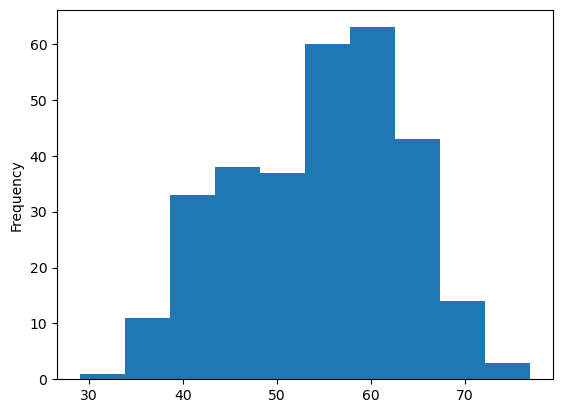

In [7]:
df.age.plot.hist()

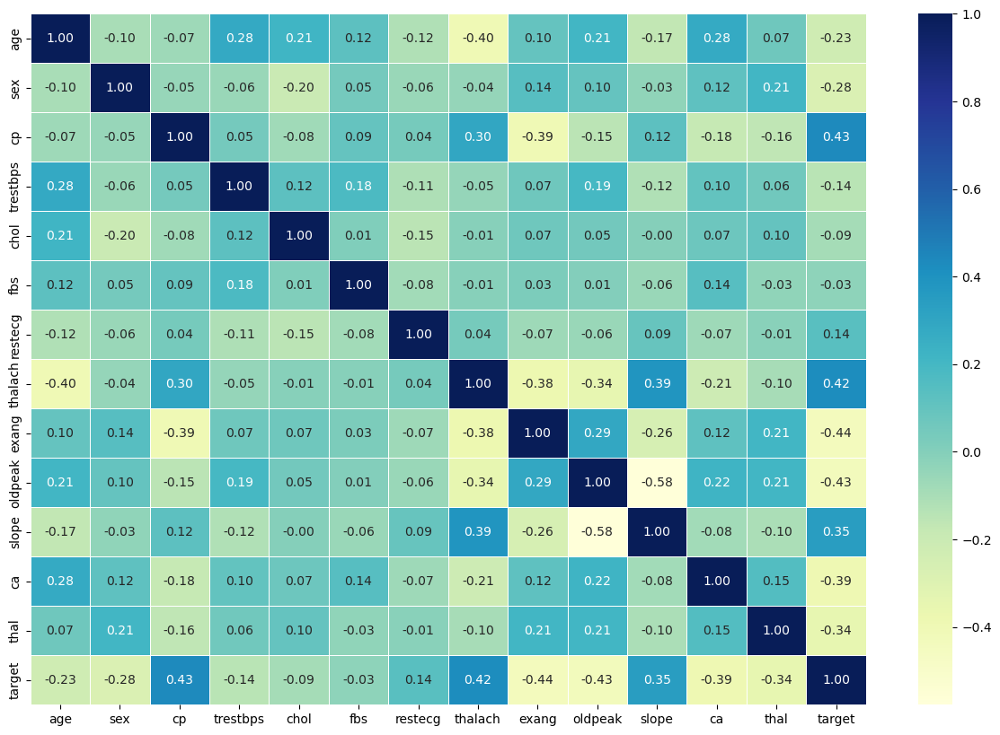

In [8]:
corr_matrix=df.corr()
fig, ax = plt.subplots(figsize=(15,10))
ax = sns.heatmap(corr_matrix,
              annot=True,
              linewidths=0.5,
              fmt=".2f",
              cmap="YlGnBu")

In [81]:
np.random.seed(42)
x=df.drop("target",axis=1)
y=df.target
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.2)

In [10]:
# put models in a dictionary
models={"Logistic Regression": LogisticRegression(),
       "KNN":KNeighborsClassifier(),
       "Random Forest":RandomForestClassifier(),
       "CatBoost":cb.CatBoostClassifier(),
       "XGBoost":xgb.XGBClassifier()}

#Create a function to fit and score models

def fit_and_score(models,x_train,x_test,y_train,y_test):
    """
   Fits and Evaluates given machine learning models.
   models: is a dictionary of differnet Scikit-learn Machine Leaning models
    """
    np.random.seed(42)
    # Make a dictionary to keep model scores
    models_scores={}
    #Loop through models
    for name, model in models.items():
        model.fit(x_train,y_train)
        models_scores[name]=model.score(x_test,y_test)
    return models_scores  

models_scores=fit_and_score(models=models,
                          x_train=x_train,
                          x_test=x_test,
                          y_train=y_train,
                          y_test=y_test)
models_scores

C:\Users\rover2023\Desktop\sample_project_1\env\Lib\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Learning rate set to 0.005621
0:	learn: 0.6884219	total: 162ms	remaining: 2m 42s
1:	learn: 0.6846994	total: 164ms	remaining: 1m 22s
2:	learn: 0.6804470	total: 166ms	remaining: 55.2s
3:	learn: 0.6762242	total: 168ms	remaining: 41.8s
4:	learn: 0.6716784	total: 170ms	remaining: 33.7s
5:	learn: 0.6672808	total: 171ms	remaining: 28.4s
6:	learn: 0.6639958	total: 173ms	remaining: 24.6s
7:	learn: 0.6601980	total: 175ms	remaining: 21.7s
8:	learn: 0.6563766	total: 177ms	remaining: 19.5s
9:	learn: 0.6525103	total: 179ms	remaining: 17.7s
10:	learn: 0.6483670	total: 180ms	remaining: 16.2s
11:	learn: 0.6448827	total: 182ms	remaining: 15s
12:	learn: 0.6412767	total: 184ms	remaining: 14s
13:	learn: 0.6374286	total: 186ms	remaining: 13.1s
14:	learn: 0.6335427	total: 188ms	remaining: 12.3s
15:	learn: 0.6288052	total: 189ms	remaining: 11.6s
16:	learn: 0.6250489	total: 191ms	remaining: 11.1s
17:	learn: 0.6209495	total: 193ms	remaining: 10.5s
18:	learn: 0.6181899	total: 195ms	remaining: 10.1s
19:	learn: 0.

227:	learn: 0.3043831	total: 584ms	remaining: 1.98s
228:	learn: 0.3036527	total: 586ms	remaining: 1.97s
229:	learn: 0.3029137	total: 588ms	remaining: 1.97s
230:	learn: 0.3023233	total: 589ms	remaining: 1.96s
231:	learn: 0.3019126	total: 591ms	remaining: 1.96s
232:	learn: 0.3011656	total: 593ms	remaining: 1.95s
233:	learn: 0.3004942	total: 595ms	remaining: 1.95s
234:	learn: 0.2999039	total: 597ms	remaining: 1.94s
235:	learn: 0.2989374	total: 599ms	remaining: 1.94s
236:	learn: 0.2983051	total: 602ms	remaining: 1.94s
237:	learn: 0.2973948	total: 605ms	remaining: 1.94s
238:	learn: 0.2966949	total: 608ms	remaining: 1.93s
239:	learn: 0.2958804	total: 610ms	remaining: 1.93s
240:	learn: 0.2953489	total: 612ms	remaining: 1.93s
241:	learn: 0.2947417	total: 613ms	remaining: 1.92s
242:	learn: 0.2940497	total: 615ms	remaining: 1.92s
243:	learn: 0.2932209	total: 617ms	remaining: 1.91s
244:	learn: 0.2924235	total: 619ms	remaining: 1.91s
245:	learn: 0.2919598	total: 621ms	remaining: 1.9s
246:	learn: 0

440:	learn: 0.2103009	total: 979ms	remaining: 1.24s
441:	learn: 0.2100871	total: 981ms	remaining: 1.24s
442:	learn: 0.2096908	total: 982ms	remaining: 1.24s
443:	learn: 0.2095228	total: 984ms	remaining: 1.23s
444:	learn: 0.2092186	total: 986ms	remaining: 1.23s
445:	learn: 0.2088236	total: 987ms	remaining: 1.23s
446:	learn: 0.2086837	total: 989ms	remaining: 1.22s
447:	learn: 0.2083093	total: 991ms	remaining: 1.22s
448:	learn: 0.2080790	total: 993ms	remaining: 1.22s
449:	learn: 0.2078829	total: 995ms	remaining: 1.22s
450:	learn: 0.2077081	total: 997ms	remaining: 1.21s
451:	learn: 0.2073887	total: 998ms	remaining: 1.21s
452:	learn: 0.2071469	total: 1s	remaining: 1.21s
453:	learn: 0.2068551	total: 1s	remaining: 1.2s
454:	learn: 0.2064547	total: 1s	remaining: 1.2s
455:	learn: 0.2062674	total: 1s	remaining: 1.2s
456:	learn: 0.2061274	total: 1.01s	remaining: 1.2s
457:	learn: 0.2057086	total: 1.01s	remaining: 1.19s
458:	learn: 0.2053246	total: 1.01s	remaining: 1.19s
459:	learn: 0.2049620	total:

658:	learn: 0.1570961	total: 1.36s	remaining: 706ms
659:	learn: 0.1567847	total: 1.36s	remaining: 704ms
660:	learn: 0.1566086	total: 1.37s	remaining: 701ms
661:	learn: 0.1564884	total: 1.37s	remaining: 699ms
662:	learn: 0.1563095	total: 1.37s	remaining: 697ms
663:	learn: 0.1560766	total: 1.37s	remaining: 695ms
664:	learn: 0.1558256	total: 1.38s	remaining: 693ms
665:	learn: 0.1556056	total: 1.38s	remaining: 690ms
666:	learn: 0.1554083	total: 1.38s	remaining: 688ms
667:	learn: 0.1552606	total: 1.38s	remaining: 686ms
668:	learn: 0.1551123	total: 1.38s	remaining: 684ms
669:	learn: 0.1550174	total: 1.38s	remaining: 682ms
670:	learn: 0.1547661	total: 1.39s	remaining: 680ms
671:	learn: 0.1546316	total: 1.39s	remaining: 677ms
672:	learn: 0.1543919	total: 1.39s	remaining: 675ms
673:	learn: 0.1542865	total: 1.39s	remaining: 673ms
674:	learn: 0.1541636	total: 1.39s	remaining: 671ms
675:	learn: 0.1540625	total: 1.39s	remaining: 669ms
676:	learn: 0.1538702	total: 1.4s	remaining: 666ms
677:	learn: 0

883:	learn: 0.1200906	total: 1.77s	remaining: 232ms
884:	learn: 0.1199352	total: 1.77s	remaining: 230ms
885:	learn: 0.1197389	total: 1.77s	remaining: 228ms
886:	learn: 0.1195640	total: 1.77s	remaining: 226ms
887:	learn: 0.1194203	total: 1.78s	remaining: 224ms
888:	learn: 0.1193073	total: 1.78s	remaining: 222ms
889:	learn: 0.1191582	total: 1.78s	remaining: 220ms
890:	learn: 0.1189901	total: 1.78s	remaining: 218ms
891:	learn: 0.1188384	total: 1.78s	remaining: 216ms
892:	learn: 0.1186287	total: 1.79s	remaining: 214ms
893:	learn: 0.1184102	total: 1.79s	remaining: 212ms
894:	learn: 0.1182496	total: 1.79s	remaining: 210ms
895:	learn: 0.1180809	total: 1.79s	remaining: 208ms
896:	learn: 0.1179469	total: 1.79s	remaining: 206ms
897:	learn: 0.1177292	total: 1.79s	remaining: 204ms
898:	learn: 0.1176395	total: 1.8s	remaining: 202ms
899:	learn: 0.1174623	total: 1.8s	remaining: 200ms
900:	learn: 0.1173363	total: 1.8s	remaining: 198ms
901:	learn: 0.1171877	total: 1.8s	remaining: 196ms
902:	learn: 0.11

{'Logistic Regression': 0.8852459016393442,
 'KNN': 0.6885245901639344,
 'Random Forest': 0.8360655737704918,
 'CatBoost': 0.8360655737704918,
 'XGBoost': 0.819672131147541}

<Axes: >

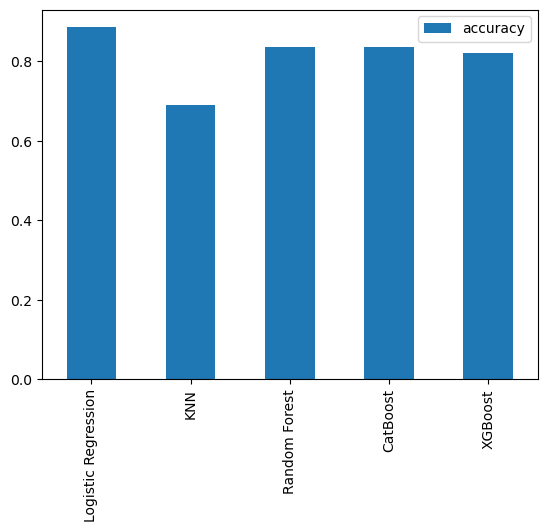

In [11]:
model_compare=pd.DataFrame(models_scores,index=["accuracy"])
model_compare.T.plot.bar()

In [12]:
models_scores=fit_and_score(models=models,
                          x_train=x_train,
                          x_test=x_test,
                          y_train=y_train,
                          y_test=y_test)
models_scores

C:\Users\rover2023\Desktop\sample_project_1\env\Lib\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Learning rate set to 0.005621
0:	learn: 0.6884219	total: 2.16ms	remaining: 2.15s
1:	learn: 0.6846994	total: 4.08ms	remaining: 2.03s
2:	learn: 0.6804470	total: 5.92ms	remaining: 1.97s
3:	learn: 0.6762242	total: 7.74ms	remaining: 1.93s
4:	learn: 0.6716784	total: 9.57ms	remaining: 1.91s
5:	learn: 0.6672808	total: 11.6ms	remaining: 1.92s
6:	learn: 0.6639958	total: 13.6ms	remaining: 1.92s
7:	learn: 0.6601980	total: 15.4ms	remaining: 1.91s
8:	learn: 0.6563766	total: 17.1ms	remaining: 1.89s
9:	learn: 0.6525103	total: 19ms	remaining: 1.88s
10:	learn: 0.6483670	total: 20.5ms	remaining: 1.85s
11:	learn: 0.6448827	total: 22.4ms	remaining: 1.84s
12:	learn: 0.6412767	total: 24.2ms	remaining: 1.84s
13:	learn: 0.6374286	total: 26ms	remaining: 1.83s
14:	learn: 0.6335427	total: 27.9ms	remaining: 1.83s
15:	learn: 0.6288052	total: 29.7ms	remaining: 1.82s
16:	learn: 0.6250489	total: 31.5ms	remaining: 1.82s
17:	learn: 0.6209495	total: 33.3ms	remaining: 1.82s
18:	learn: 0.6181899	total: 35.1ms	remaining: 1.

211:	learn: 0.3153324	total: 380ms	remaining: 1.41s
212:	learn: 0.3147977	total: 382ms	remaining: 1.41s
213:	learn: 0.3140384	total: 384ms	remaining: 1.41s
214:	learn: 0.3134157	total: 385ms	remaining: 1.41s
215:	learn: 0.3124251	total: 387ms	remaining: 1.41s
216:	learn: 0.3119032	total: 389ms	remaining: 1.4s
217:	learn: 0.3111628	total: 391ms	remaining: 1.4s
218:	learn: 0.3106289	total: 393ms	remaining: 1.4s
219:	learn: 0.3096439	total: 395ms	remaining: 1.4s
220:	learn: 0.3087572	total: 397ms	remaining: 1.4s
221:	learn: 0.3080645	total: 399ms	remaining: 1.4s
222:	learn: 0.3077284	total: 401ms	remaining: 1.4s
223:	learn: 0.3068238	total: 403ms	remaining: 1.4s
224:	learn: 0.3060865	total: 405ms	remaining: 1.39s
225:	learn: 0.3053261	total: 406ms	remaining: 1.39s
226:	learn: 0.3049830	total: 408ms	remaining: 1.39s
227:	learn: 0.3043831	total: 410ms	remaining: 1.39s
228:	learn: 0.3036527	total: 412ms	remaining: 1.39s
229:	learn: 0.3029137	total: 414ms	remaining: 1.38s
230:	learn: 0.302323

429:	learn: 0.2137315	total: 777ms	remaining: 1.03s
430:	learn: 0.2134406	total: 779ms	remaining: 1.03s
431:	learn: 0.2130804	total: 781ms	remaining: 1.03s
432:	learn: 0.2127306	total: 783ms	remaining: 1.02s
433:	learn: 0.2124362	total: 785ms	remaining: 1.02s
434:	learn: 0.2121918	total: 786ms	remaining: 1.02s
435:	learn: 0.2117953	total: 788ms	remaining: 1.02s
436:	learn: 0.2115265	total: 790ms	remaining: 1.02s
437:	learn: 0.2114720	total: 792ms	remaining: 1.01s
438:	learn: 0.2110566	total: 794ms	remaining: 1.01s
439:	learn: 0.2106894	total: 795ms	remaining: 1.01s
440:	learn: 0.2103009	total: 797ms	remaining: 1.01s
441:	learn: 0.2100871	total: 799ms	remaining: 1.01s
442:	learn: 0.2096908	total: 801ms	remaining: 1.01s
443:	learn: 0.2095228	total: 803ms	remaining: 1s
444:	learn: 0.2092186	total: 804ms	remaining: 1s
445:	learn: 0.2088236	total: 806ms	remaining: 1s
446:	learn: 0.2086837	total: 808ms	remaining: 1000ms
447:	learn: 0.2083093	total: 810ms	remaining: 998ms
448:	learn: 0.208079

643:	learn: 0.1600717	total: 1.16s	remaining: 643ms
644:	learn: 0.1598147	total: 1.17s	remaining: 642ms
645:	learn: 0.1596441	total: 1.17s	remaining: 640ms
646:	learn: 0.1595233	total: 1.17s	remaining: 638ms
647:	learn: 0.1593869	total: 1.17s	remaining: 636ms
648:	learn: 0.1592369	total: 1.17s	remaining: 634ms
649:	learn: 0.1589425	total: 1.17s	remaining: 633ms
650:	learn: 0.1587452	total: 1.18s	remaining: 631ms
651:	learn: 0.1585819	total: 1.18s	remaining: 629ms
652:	learn: 0.1583509	total: 1.18s	remaining: 627ms
653:	learn: 0.1581090	total: 1.18s	remaining: 626ms
654:	learn: 0.1579869	total: 1.18s	remaining: 624ms
655:	learn: 0.1577992	total: 1.19s	remaining: 622ms
656:	learn: 0.1575755	total: 1.19s	remaining: 620ms
657:	learn: 0.1572688	total: 1.19s	remaining: 618ms
658:	learn: 0.1570961	total: 1.19s	remaining: 617ms
659:	learn: 0.1567847	total: 1.19s	remaining: 615ms
660:	learn: 0.1566086	total: 1.2s	remaining: 613ms
661:	learn: 0.1564884	total: 1.2s	remaining: 611ms
662:	learn: 0.

856:	learn: 0.1240366	total: 1.55s	remaining: 259ms
857:	learn: 0.1238676	total: 1.55s	remaining: 257ms
858:	learn: 0.1237400	total: 1.56s	remaining: 256ms
859:	learn: 0.1235778	total: 1.56s	remaining: 254ms
860:	learn: 0.1234006	total: 1.56s	remaining: 252ms
861:	learn: 0.1231671	total: 1.56s	remaining: 250ms
862:	learn: 0.1229332	total: 1.56s	remaining: 248ms
863:	learn: 0.1227329	total: 1.57s	remaining: 247ms
864:	learn: 0.1226497	total: 1.57s	remaining: 245ms
865:	learn: 0.1223937	total: 1.57s	remaining: 243ms
866:	learn: 0.1222421	total: 1.57s	remaining: 241ms
867:	learn: 0.1220761	total: 1.57s	remaining: 240ms
868:	learn: 0.1219545	total: 1.58s	remaining: 238ms
869:	learn: 0.1217851	total: 1.58s	remaining: 236ms
870:	learn: 0.1215689	total: 1.58s	remaining: 234ms
871:	learn: 0.1214961	total: 1.58s	remaining: 232ms
872:	learn: 0.1213314	total: 1.58s	remaining: 230ms
873:	learn: 0.1211686	total: 1.58s	remaining: 229ms
874:	learn: 0.1210148	total: 1.59s	remaining: 227ms
875:	learn: 

{'Logistic Regression': 0.8852459016393442,
 'KNN': 0.6885245901639344,
 'Random Forest': 0.8360655737704918,
 'CatBoost': 0.8360655737704918,
 'XGBoost': 0.819672131147541}

## Hyperparameters tuning to increase the accuracy of baseline models using Randomized Searched CV

In [52]:
log_reg_grid = {"C":np.logspace(-4,4,20),
                "solver":["liblinear"]}

rf_grid={ 'n_estimators': np.arange(50, 500, 50),
          'max_depth': np.arange(1, 10)}

knn_grid={ 'n_neighbors': np.arange(1, 21),
           'weights': ['uniform', 'distance'],
           'p': [1, 2],
           'leaf_size': np.arange(10, 51, 10)}

cat_grid={'depth': np.arange(2, 10),
          'learning_rate': np.arange(0.05, 0.3, 0.05),
          'l2_leaf_reg': np.arange(1, 10),
          'bagging_temperature': np.arange(0, 1.5, 0.1),
          'random_strength': np.arange(0, 1.5, 0.1),
          'n_estimators': np.arange(50, 500, 50)}
xg_grid={'learning_rate': np.logspace(-4, 0, 100),
         'max_depth': np.arange(1, 10),
         'n_estimators': np.arange(50, 500, 50)}


In [40]:
# Tune LogisticRegression
np.random.seed(42)

rs_log_reg=RandomizedSearchCV(LogisticRegression(),
                             param_distributions=log_reg_grid,
                             cv=5,
                             n_iter=20,
                             verbose=True)
rs_log_reg.fit(x_train,y_train)

Fitting 5 folds for each of 20 candidates, totalling 100 fits


RandomizedSearchCV(cv=5, estimator=LogisticRegression(), n_iter=20,
                   param_distributions={'C': array([1.00000000e-04, 2.63665090e-04, 6.95192796e-04, 1.83298071e-03,
       4.83293024e-03, 1.27427499e-02, 3.35981829e-02, 8.85866790e-02,
       2.33572147e-01, 6.15848211e-01, 1.62377674e+00, 4.28133240e+00,
       1.12883789e+01, 2.97635144e+01, 7.84759970e+01, 2.06913808e+02,
       5.45559478e+02, 1.43844989e+03, 3.79269019e+03, 1.00000000e+04]),
                                        'solver': ['liblinear']},
                   verbose=True)

In [41]:
rs_log_reg.score(x_test,y_test)

0.8852459016393442

In [126]:
# Tune Random Forest
np.random.seed(42)

rs_rf=RandomizedSearchCV(RandomForestClassifier(),
                        param_distributions=rf_grid,
                        cv=5,
                        n_iter=20,
                        verbose=True)
rs_rf.fit(x_train,y_train)

Fitting 5 folds for each of 20 candidates, totalling 100 fits


RandomizedSearchCV(cv=5, estimator=RandomForestClassifier(), n_iter=20,
                   param_distributions={'max_depth': array([1, 2, 3, 4, 5, 6, 7, 8, 9]),
                                        'n_estimators': array([ 50, 100, 150, 200, 250, 300, 350, 400, 450])},
                   verbose=True)

In [127]:
rs_rf.score(x_test,y_test)

0.8688524590163934

## Increases with 3%

In [44]:
# Tune KNeighbours

np.random.seed(42)

rs_knn=RandomizedSearchCV(KNeighborsClassifier(),
                        param_distributions=knn_grid,
                        cv=5,
                        n_iter=20,
                        verbose=True)
rs_knn.fit(x_train,y_train)

Fitting 5 folds for each of 20 candidates, totalling 100 fits


RandomizedSearchCV(cv=5, estimator=KNeighborsClassifier(), n_iter=20,
                   param_distributions={'leaf_size': array([10, 20, 30, 40, 50]),
                                        'n_neighbors': array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
       18, 19, 20]),
                                        'p': [1, 2],
                                        'weights': ['uniform', 'distance']},
                   verbose=True)

In [45]:
rs_knn.score(x_test,y_test)

0.6885245901639344

In [27]:
# Tune XGBoost

np.random.seed(42)
xgb_model = xgb.XGBClassifier()
rs_xg=RandomizedSearchCV(xgb_model,
                         param_distributions=xg_grid, 
                         n_iter=20,
                         cv=5, 
                         verbose=2,
                         error_score='raise')
rs_xg.fit(x_train,y_train)

Fitting 5 folds for each of 20 candidates, totalling 100 fits
[CV] END colsample_bytree=0.7999999999999999, gamma=0.8302175681319752, learning_rate=0.0037649358067924714, max_depth=5, n_estimators=50, subsample=0.7999999999999999; total time=   0.0s
[CV] END colsample_bytree=0.7999999999999999, gamma=0.8302175681319752, learning_rate=0.0037649358067924714, max_depth=5, n_estimators=50, subsample=0.7999999999999999; total time=   0.0s
[CV] END colsample_bytree=0.7999999999999999, gamma=0.8302175681319752, learning_rate=0.0037649358067924714, max_depth=5, n_estimators=50, subsample=0.7999999999999999; total time=   0.0s
[CV] END colsample_bytree=0.7999999999999999, gamma=0.8302175681319752, learning_rate=0.0037649358067924714, max_depth=5, n_estimators=50, subsample=0.7999999999999999; total time=   0.0s
[CV] END colsample_bytree=0.7999999999999999, gamma=0.8302175681319752, learning_rate=0.0037649358067924714, max_depth=5, n_estimators=50, subsample=0.7999999999999999; total time=   0.0

[CV] END colsample_bytree=0.8999999999999999, gamma=0.02009233002565048, learning_rate=0.3274549162877732, max_depth=9, n_estimators=150, subsample=0.7; total time=   0.0s
[CV] END colsample_bytree=0.8999999999999999, gamma=0.02009233002565048, learning_rate=0.3274549162877732, max_depth=9, n_estimators=150, subsample=0.7; total time=   0.0s
[CV] END colsample_bytree=0.6, gamma=0.0002782559402207126, learning_rate=0.03511191734215135, max_depth=8, n_estimators=450, subsample=0.7999999999999999; total time=   0.1s
[CV] END colsample_bytree=0.6, gamma=0.0002782559402207126, learning_rate=0.03511191734215135, max_depth=8, n_estimators=450, subsample=0.7999999999999999; total time=   0.1s
[CV] END colsample_bytree=0.6, gamma=0.0002782559402207126, learning_rate=0.03511191734215135, max_depth=8, n_estimators=450, subsample=0.7999999999999999; total time=   0.1s
[CV] END colsample_bytree=0.6, gamma=0.0002782559402207126, learning_rate=0.03511191734215135, max_depth=8, n_estimators=450, subsa

[CV] END colsample_bytree=0.7, gamma=0.0037649358067924714, learning_rate=0.0041320124001153384, max_depth=7, n_estimators=100, subsample=0.8999999999999999; total time=   0.0s


RandomizedSearchCV(cv=5, error_score='raise',
                   estimator=XGBClassifier(base_score=None, booster=None,
                                           callbacks=None,
                                           colsample_bylevel=None,
                                           colsample_bynode=None,
                                           colsample_bytree=None,
                                           early_stopping_rounds=None,
                                           enable_categorical=False,
                                           eval_metric=None, feature_types=None,
                                           gamma=None, gpu_id=None,
                                           grow_policy=None,
                                           importance_type=None,
                                           interaction_constraint...
       2.47707636e-01, 2.71858824e-01, 2.98364724e-01, 3.27454916e-01,
       3.59381366e-01, 3.94420606e-01, 4.32876128e-01, 4.75081016e-01,
       5.21400829e-01, 5.72236766e-01, 6.28029144e-01, 6.89261210e-01,
       7.56463328e-01, 8.30217568e-01, 9.11162756e-01, 1.00000000e+00]),
                                        'max_depth': array([1, 2, 3, 4, 5, 6, 7, 8, 9]),
                                        'n_estimators': array([ 50, 100, 150, 200, 250, 300, 350, 400, 450]),
                                        'subsample': array([0.5, 0.6, 0.7, 0.8, 0.9])},
                   verbose=2)

In [28]:
rs_xg.score(x_test,y_test)

0.8524590163934426

## Increase with 5%

In [22]:
# Tune CatBoost

np.random.seed(42)
rs_cat=RandomizedSearchCV(cb.CatBoostClassifier(),
                         param_distributions=cat_grid, 
                         n_iter=20,
                         cv=5, 
                         verbose=2,
                         error_score='raise')
rs_cat.fit(x_train,y_train)

Fitting 5 folds for each of 20 candidates, totalling 100 fits
0:	learn: 0.5315822	total: 1.75ms	remaining: 349ms
1:	learn: 0.4100444	total: 3.62ms	remaining: 359ms
2:	learn: 0.3460788	total: 5.39ms	remaining: 354ms
3:	learn: 0.2975230	total: 7.25ms	remaining: 356ms
4:	learn: 0.2396196	total: 9.06ms	remaining: 353ms
5:	learn: 0.2092992	total: 10.8ms	remaining: 350ms
6:	learn: 0.1917648	total: 12.6ms	remaining: 349ms
7:	learn: 0.1729851	total: 14.4ms	remaining: 345ms
8:	learn: 0.1576042	total: 16.1ms	remaining: 343ms
9:	learn: 0.1456781	total: 18ms	remaining: 341ms
10:	learn: 0.1313590	total: 19.8ms	remaining: 339ms
11:	learn: 0.1141951	total: 21.5ms	remaining: 337ms
12:	learn: 0.1089455	total: 23.3ms	remaining: 336ms
13:	learn: 0.1018187	total: 25.1ms	remaining: 334ms
14:	learn: 0.0990499	total: 26.5ms	remaining: 327ms
15:	learn: 0.0931655	total: 28.3ms	remaining: 326ms
16:	learn: 0.0884228	total: 30.1ms	remaining: 324ms
17:	learn: 0.0818269	total: 31.9ms	remaining: 322ms
18:	learn: 0.0

173:	learn: 0.0021388	total: 303ms	remaining: 45.2ms
174:	learn: 0.0021108	total: 305ms	remaining: 43.5ms
175:	learn: 0.0021107	total: 306ms	remaining: 41.7ms
176:	learn: 0.0021107	total: 308ms	remaining: 40ms
177:	learn: 0.0021106	total: 309ms	remaining: 38.2ms
178:	learn: 0.0021017	total: 311ms	remaining: 36.5ms
179:	learn: 0.0021018	total: 312ms	remaining: 34.7ms
180:	learn: 0.0021015	total: 314ms	remaining: 32.9ms
181:	learn: 0.0020758	total: 316ms	remaining: 31.2ms
182:	learn: 0.0020575	total: 318ms	remaining: 29.5ms
183:	learn: 0.0020426	total: 320ms	remaining: 27.8ms
184:	learn: 0.0020282	total: 321ms	remaining: 26.1ms
185:	learn: 0.0020282	total: 323ms	remaining: 24.3ms
186:	learn: 0.0020276	total: 325ms	remaining: 22.6ms
187:	learn: 0.0020276	total: 327ms	remaining: 20.8ms
188:	learn: 0.0020276	total: 328ms	remaining: 19.1ms
189:	learn: 0.0020275	total: 330ms	remaining: 17.3ms
190:	learn: 0.0020270	total: 331ms	remaining: 15.6ms
191:	learn: 0.0020180	total: 333ms	remaining: 13

[CV] END bagging_temperature=0.2, depth=6, l2_leaf_reg=1, learning_rate=0.2, n_estimators=200, random_strength=0.8; total time=   0.4s
0:	learn: 0.5205683	total: 2.02ms	remaining: 403ms
1:	learn: 0.4315913	total: 3.78ms	remaining: 374ms
2:	learn: 0.3577286	total: 5.59ms	remaining: 367ms
3:	learn: 0.2982720	total: 7.38ms	remaining: 361ms
4:	learn: 0.2625460	total: 9.18ms	remaining: 358ms
5:	learn: 0.2360988	total: 11ms	remaining: 356ms
6:	learn: 0.2060119	total: 12.7ms	remaining: 351ms
7:	learn: 0.1885160	total: 14.5ms	remaining: 348ms
8:	learn: 0.1687904	total: 16.3ms	remaining: 345ms
9:	learn: 0.1619358	total: 18ms	remaining: 342ms
10:	learn: 0.1485203	total: 19.8ms	remaining: 340ms
11:	learn: 0.1407766	total: 21.5ms	remaining: 337ms
12:	learn: 0.1352358	total: 23.3ms	remaining: 336ms
13:	learn: 0.1231644	total: 25.1ms	remaining: 333ms
14:	learn: 0.1170196	total: 26.8ms	remaining: 331ms
15:	learn: 0.1080304	total: 28.5ms	remaining: 328ms
16:	learn: 0.0978955	total: 30.4ms	remaining: 3

183:	learn: 0.0023506	total: 319ms	remaining: 27.7ms
184:	learn: 0.0023501	total: 321ms	remaining: 26ms
185:	learn: 0.0023154	total: 322ms	remaining: 24.3ms
186:	learn: 0.0022864	total: 324ms	remaining: 22.5ms
187:	learn: 0.0022865	total: 326ms	remaining: 20.8ms
188:	learn: 0.0022864	total: 327ms	remaining: 19.1ms
189:	learn: 0.0022863	total: 329ms	remaining: 17.3ms
190:	learn: 0.0022864	total: 331ms	remaining: 15.6ms
191:	learn: 0.0022863	total: 332ms	remaining: 13.8ms
192:	learn: 0.0022858	total: 334ms	remaining: 12.1ms
193:	learn: 0.0022633	total: 336ms	remaining: 10.4ms
194:	learn: 0.0022628	total: 337ms	remaining: 8.64ms
195:	learn: 0.0022628	total: 338ms	remaining: 6.91ms
196:	learn: 0.0022628	total: 340ms	remaining: 5.18ms
197:	learn: 0.0022627	total: 341ms	remaining: 3.45ms
198:	learn: 0.0022628	total: 343ms	remaining: 1.72ms
199:	learn: 0.0022627	total: 344ms	remaining: 0us
[CV] END bagging_temperature=0.2, depth=6, l2_leaf_reg=1, learning_rate=0.2, n_estimators=200, random_st

[CV] END bagging_temperature=0.2, depth=6, l2_leaf_reg=1, learning_rate=0.2, n_estimators=200, random_strength=0.8; total time=   0.4s
0:	learn: 0.5240145	total: 2.05ms	remaining: 408ms
1:	learn: 0.4242889	total: 3.88ms	remaining: 384ms
2:	learn: 0.3638393	total: 5.63ms	remaining: 369ms
3:	learn: 0.3104961	total: 7.39ms	remaining: 362ms
4:	learn: 0.2739827	total: 9.11ms	remaining: 355ms
5:	learn: 0.2418166	total: 11.1ms	remaining: 358ms
6:	learn: 0.2304170	total: 13ms	remaining: 360ms
7:	learn: 0.2098567	total: 14.8ms	remaining: 356ms
8:	learn: 0.1861805	total: 16.7ms	remaining: 354ms
9:	learn: 0.1705644	total: 18.4ms	remaining: 350ms
10:	learn: 0.1554674	total: 20.2ms	remaining: 347ms
11:	learn: 0.1451047	total: 22ms	remaining: 345ms
12:	learn: 0.1359298	total: 23.7ms	remaining: 341ms
13:	learn: 0.1295533	total: 25.5ms	remaining: 339ms
14:	learn: 0.1192122	total: 27.7ms	remaining: 341ms
15:	learn: 0.1140997	total: 29.4ms	remaining: 338ms
16:	learn: 0.1073024	total: 31.3ms	remaining: 3

189:	learn: 0.0020953	total: 337ms	remaining: 17.8ms
190:	learn: 0.0020952	total: 339ms	remaining: 16ms
191:	learn: 0.0020950	total: 341ms	remaining: 14.2ms
192:	learn: 0.0020946	total: 342ms	remaining: 12.4ms
193:	learn: 0.0020945	total: 344ms	remaining: 10.6ms
194:	learn: 0.0020829	total: 346ms	remaining: 8.87ms
195:	learn: 0.0020664	total: 348ms	remaining: 7.1ms
196:	learn: 0.0020464	total: 350ms	remaining: 5.33ms
197:	learn: 0.0020460	total: 351ms	remaining: 3.55ms
198:	learn: 0.0020460	total: 353ms	remaining: 1.77ms
199:	learn: 0.0020460	total: 354ms	remaining: 0us
[CV] END bagging_temperature=0.2, depth=6, l2_leaf_reg=1, learning_rate=0.2, n_estimators=200, random_strength=0.8; total time=   0.4s
0:	learn: 0.6229974	total: 3.04ms	remaining: 758ms
1:	learn: 0.5607394	total: 5.7ms	remaining: 707ms
2:	learn: 0.5227164	total: 8.4ms	remaining: 692ms
3:	learn: 0.4770360	total: 11.7ms	remaining: 718ms
4:	learn: 0.4358859	total: 14.7ms	remaining: 721ms
5:	learn: 0.4053813	total: 16.2ms	r

151:	learn: 0.0214199	total: 423ms	remaining: 273ms
152:	learn: 0.0212570	total: 427ms	remaining: 271ms
153:	learn: 0.0210907	total: 430ms	remaining: 268ms
154:	learn: 0.0209075	total: 433ms	remaining: 266ms
155:	learn: 0.0207366	total: 436ms	remaining: 263ms
156:	learn: 0.0205842	total: 439ms	remaining: 260ms
157:	learn: 0.0204024	total: 442ms	remaining: 257ms
158:	learn: 0.0202410	total: 445ms	remaining: 255ms
159:	learn: 0.0200901	total: 448ms	remaining: 252ms
160:	learn: 0.0198378	total: 450ms	remaining: 249ms
161:	learn: 0.0196905	total: 454ms	remaining: 246ms
162:	learn: 0.0195488	total: 457ms	remaining: 244ms
163:	learn: 0.0194192	total: 460ms	remaining: 241ms
164:	learn: 0.0192918	total: 463ms	remaining: 238ms
165:	learn: 0.0191035	total: 465ms	remaining: 235ms
166:	learn: 0.0189537	total: 469ms	remaining: 233ms
167:	learn: 0.0188216	total: 472ms	remaining: 230ms
168:	learn: 0.0186470	total: 475ms	remaining: 227ms
169:	learn: 0.0185110	total: 477ms	remaining: 225ms
170:	learn: 

78:	learn: 0.0561033	total: 201ms	remaining: 435ms
79:	learn: 0.0549398	total: 204ms	remaining: 433ms
80:	learn: 0.0538906	total: 206ms	remaining: 431ms
81:	learn: 0.0529859	total: 209ms	remaining: 429ms
82:	learn: 0.0519631	total: 212ms	remaining: 427ms
83:	learn: 0.0510409	total: 215ms	remaining: 425ms
84:	learn: 0.0500969	total: 217ms	remaining: 422ms
85:	learn: 0.0493168	total: 220ms	remaining: 420ms
86:	learn: 0.0482775	total: 223ms	remaining: 417ms
87:	learn: 0.0476853	total: 225ms	remaining: 415ms
88:	learn: 0.0470614	total: 228ms	remaining: 412ms
89:	learn: 0.0462281	total: 230ms	remaining: 409ms
90:	learn: 0.0452873	total: 233ms	remaining: 407ms
91:	learn: 0.0447451	total: 235ms	remaining: 404ms
92:	learn: 0.0440117	total: 238ms	remaining: 402ms
93:	learn: 0.0434143	total: 241ms	remaining: 399ms
94:	learn: 0.0426157	total: 243ms	remaining: 397ms
95:	learn: 0.0420343	total: 246ms	remaining: 394ms
96:	learn: 0.0414390	total: 248ms	remaining: 392ms
97:	learn: 0.0409210	total: 251

0:	learn: 0.6288995	total: 3.18ms	remaining: 791ms
1:	learn: 0.5790365	total: 6.19ms	remaining: 767ms
2:	learn: 0.5411264	total: 9ms	remaining: 741ms
3:	learn: 0.4959455	total: 12ms	remaining: 736ms
4:	learn: 0.4555050	total: 14.9ms	remaining: 730ms
5:	learn: 0.4330269	total: 16.3ms	remaining: 663ms
6:	learn: 0.4086741	total: 19.3ms	remaining: 669ms
7:	learn: 0.3831099	total: 21.9ms	remaining: 663ms
8:	learn: 0.3646584	total: 24.6ms	remaining: 659ms
9:	learn: 0.3481582	total: 27.7ms	remaining: 664ms
10:	learn: 0.3267987	total: 30.6ms	remaining: 664ms
11:	learn: 0.3072753	total: 33.7ms	remaining: 668ms
12:	learn: 0.3011251	total: 35.1ms	remaining: 641ms
13:	learn: 0.2888480	total: 37.8ms	remaining: 637ms
14:	learn: 0.2780742	total: 40.6ms	remaining: 635ms
15:	learn: 0.2653564	total: 43.4ms	remaining: 635ms
16:	learn: 0.2548566	total: 46.4ms	remaining: 636ms
17:	learn: 0.2427224	total: 49.3ms	remaining: 636ms
18:	learn: 0.2343629	total: 52.1ms	remaining: 633ms
19:	learn: 0.2258034	total:

216:	learn: 0.0149896	total: 584ms	remaining: 88.9ms
217:	learn: 0.0149087	total: 587ms	remaining: 86.2ms
218:	learn: 0.0148273	total: 590ms	remaining: 83.5ms
219:	learn: 0.0147616	total: 593ms	remaining: 80.9ms
220:	learn: 0.0146791	total: 596ms	remaining: 78.2ms
221:	learn: 0.0146209	total: 599ms	remaining: 75.5ms
222:	learn: 0.0145616	total: 601ms	remaining: 72.8ms
223:	learn: 0.0144999	total: 604ms	remaining: 70.1ms
224:	learn: 0.0144262	total: 607ms	remaining: 67.5ms
225:	learn: 0.0143559	total: 610ms	remaining: 64.8ms
226:	learn: 0.0142793	total: 613ms	remaining: 62.1ms
227:	learn: 0.0142135	total: 617ms	remaining: 59.5ms
228:	learn: 0.0141321	total: 620ms	remaining: 56.8ms
229:	learn: 0.0140525	total: 623ms	remaining: 54.1ms
230:	learn: 0.0139860	total: 625ms	remaining: 51.4ms
231:	learn: 0.0139187	total: 628ms	remaining: 48.8ms
232:	learn: 0.0138475	total: 631ms	remaining: 46.1ms
233:	learn: 0.0137555	total: 634ms	remaining: 43.4ms
234:	learn: 0.0136878	total: 637ms	remaining: 

134:	learn: 0.0276651	total: 358ms	remaining: 305ms
135:	learn: 0.0273906	total: 361ms	remaining: 302ms
136:	learn: 0.0270950	total: 364ms	remaining: 300ms
137:	learn: 0.0268630	total: 366ms	remaining: 297ms
138:	learn: 0.0265701	total: 369ms	remaining: 295ms
139:	learn: 0.0263230	total: 372ms	remaining: 292ms
140:	learn: 0.0261018	total: 375ms	remaining: 290ms
141:	learn: 0.0258413	total: 378ms	remaining: 288ms
142:	learn: 0.0255381	total: 381ms	remaining: 285ms
143:	learn: 0.0253374	total: 383ms	remaining: 282ms
144:	learn: 0.0251448	total: 386ms	remaining: 280ms
145:	learn: 0.0249403	total: 389ms	remaining: 277ms
146:	learn: 0.0247240	total: 392ms	remaining: 274ms
147:	learn: 0.0245025	total: 394ms	remaining: 272ms
148:	learn: 0.0243093	total: 397ms	remaining: 269ms
149:	learn: 0.0240441	total: 400ms	remaining: 266ms
150:	learn: 0.0237887	total: 402ms	remaining: 264ms
151:	learn: 0.0235479	total: 405ms	remaining: 261ms
152:	learn: 0.0233468	total: 407ms	remaining: 258ms
153:	learn: 

53:	learn: 0.0953066	total: 138ms	remaining: 502ms
54:	learn: 0.0928507	total: 141ms	remaining: 500ms
55:	learn: 0.0905289	total: 144ms	remaining: 498ms
56:	learn: 0.0884248	total: 147ms	remaining: 496ms
57:	learn: 0.0864001	total: 149ms	remaining: 494ms
58:	learn: 0.0844773	total: 152ms	remaining: 492ms
59:	learn: 0.0823588	total: 155ms	remaining: 490ms
60:	learn: 0.0806623	total: 158ms	remaining: 489ms
61:	learn: 0.0791044	total: 160ms	remaining: 486ms
62:	learn: 0.0773423	total: 163ms	remaining: 484ms
63:	learn: 0.0757001	total: 166ms	remaining: 481ms
64:	learn: 0.0740436	total: 168ms	remaining: 479ms
65:	learn: 0.0722890	total: 171ms	remaining: 476ms
66:	learn: 0.0707244	total: 173ms	remaining: 473ms
67:	learn: 0.0693113	total: 176ms	remaining: 471ms
68:	learn: 0.0677317	total: 179ms	remaining: 468ms
69:	learn: 0.0661857	total: 181ms	remaining: 466ms
70:	learn: 0.0648747	total: 184ms	remaining: 463ms
71:	learn: 0.0636755	total: 186ms	remaining: 461ms
72:	learn: 0.0623476	total: 189

[CV] END bagging_temperature=1.3, depth=8, l2_leaf_reg=5, learning_rate=0.1, n_estimators=250, random_strength=1.0; total time=   0.8s
0:	learn: 0.6596792	total: 894us	remaining: 133ms
1:	learn: 0.6286091	total: 1.85ms	remaining: 137ms
2:	learn: 0.6091150	total: 3.1ms	remaining: 152ms
3:	learn: 0.5915710	total: 4.25ms	remaining: 155ms
4:	learn: 0.5792334	total: 5.44ms	remaining: 158ms
5:	learn: 0.5676808	total: 6.72ms	remaining: 161ms
6:	learn: 0.5580958	total: 7.92ms	remaining: 162ms
7:	learn: 0.5376794	total: 8.7ms	remaining: 154ms
8:	learn: 0.5268468	total: 9.99ms	remaining: 157ms
9:	learn: 0.5122470	total: 10.8ms	remaining: 152ms
10:	learn: 0.5030402	total: 12.1ms	remaining: 153ms
11:	learn: 0.4922082	total: 13.2ms	remaining: 152ms
12:	learn: 0.4828139	total: 14.5ms	remaining: 153ms
13:	learn: 0.4761963	total: 15.7ms	remaining: 153ms
14:	learn: 0.4663576	total: 17ms	remaining: 153ms
15:	learn: 0.4582426	total: 18.2ms	remaining: 153ms
16:	learn: 0.4492473	total: 19.4ms	remaining: 15

[CV] END bagging_temperature=0.2, depth=7, l2_leaf_reg=7, learning_rate=0.15000000000000002, n_estimators=150, random_strength=0.7000000000000001; total time=   0.2s
0:	learn: 0.6731306	total: 1.58ms	remaining: 235ms
1:	learn: 0.6575235	total: 2.79ms	remaining: 206ms
2:	learn: 0.6418711	total: 3.96ms	remaining: 194ms
3:	learn: 0.6298660	total: 5.17ms	remaining: 189ms
4:	learn: 0.6184646	total: 6.38ms	remaining: 185ms
5:	learn: 0.6009410	total: 7.6ms	remaining: 183ms
6:	learn: 0.5880776	total: 8.8ms	remaining: 180ms
7:	learn: 0.5769821	total: 10.2ms	remaining: 182ms
8:	learn: 0.5601760	total: 11.5ms	remaining: 180ms
9:	learn: 0.5442314	total: 12.7ms	remaining: 178ms
10:	learn: 0.5303446	total: 13.9ms	remaining: 175ms
11:	learn: 0.5190918	total: 15.2ms	remaining: 174ms
12:	learn: 0.5083705	total: 16.4ms	remaining: 173ms
13:	learn: 0.4991809	total: 17.5ms	remaining: 170ms
14:	learn: 0.4906756	total: 18.7ms	remaining: 168ms
15:	learn: 0.4840410	total: 19.9ms	remaining: 166ms
16:	learn: 0.4

[CV] END bagging_temperature=0.2, depth=7, l2_leaf_reg=7, learning_rate=0.15000000000000002, n_estimators=150, random_strength=0.7000000000000001; total time=   0.3s
0:	learn: 0.6717261	total: 1.38ms	remaining: 206ms
1:	learn: 0.6542143	total: 2.52ms	remaining: 186ms
2:	learn: 0.6405515	total: 3.63ms	remaining: 178ms
3:	learn: 0.6305108	total: 4.79ms	remaining: 175ms
4:	learn: 0.6051774	total: 5.55ms	remaining: 161ms
5:	learn: 0.5945359	total: 6.7ms	remaining: 161ms
6:	learn: 0.5840939	total: 7.81ms	remaining: 160ms
7:	learn: 0.5709908	total: 8.92ms	remaining: 158ms
8:	learn: 0.5628852	total: 10.1ms	remaining: 157ms
9:	learn: 0.5537254	total: 11.2ms	remaining: 156ms
10:	learn: 0.5386957	total: 12.2ms	remaining: 155ms
11:	learn: 0.5290625	total: 13.4ms	remaining: 154ms
12:	learn: 0.5203628	total: 14.6ms	remaining: 154ms
13:	learn: 0.5133243	total: 15.7ms	remaining: 153ms
14:	learn: 0.5033458	total: 16.8ms	remaining: 151ms
15:	learn: 0.4957234	total: 18ms	remaining: 151ms
16:	learn: 0.48

8:	learn: 0.1362153	total: 16.3ms	remaining: 797ms
9:	learn: 0.1189811	total: 18.5ms	remaining: 813ms
10:	learn: 0.1088802	total: 20.3ms	remaining: 810ms
11:	learn: 0.1019677	total: 22.2ms	remaining: 811ms
12:	learn: 0.0906286	total: 24ms	remaining: 807ms
13:	learn: 0.0819927	total: 25.9ms	remaining: 805ms
14:	learn: 0.0765726	total: 27.8ms	remaining: 805ms
15:	learn: 0.0695398	total: 29.7ms	remaining: 804ms
16:	learn: 0.0655406	total: 31.5ms	remaining: 801ms
17:	learn: 0.0596966	total: 33.2ms	remaining: 797ms
18:	learn: 0.0547241	total: 35.1ms	remaining: 797ms
19:	learn: 0.0510521	total: 36.9ms	remaining: 793ms
20:	learn: 0.0474218	total: 38.7ms	remaining: 790ms
21:	learn: 0.0450722	total: 40.4ms	remaining: 787ms
22:	learn: 0.0425782	total: 42.2ms	remaining: 783ms
23:	learn: 0.0413285	total: 43.9ms	remaining: 780ms
24:	learn: 0.0380143	total: 45.7ms	remaining: 777ms
25:	learn: 0.0362693	total: 47.5ms	remaining: 774ms
26:	learn: 0.0343066	total: 49.3ms	remaining: 772ms
27:	learn: 0.032

228:	learn: 0.0022882	total: 410ms	remaining: 396ms
229:	learn: 0.0022717	total: 412ms	remaining: 395ms
230:	learn: 0.0022634	total: 414ms	remaining: 393ms
231:	learn: 0.0022633	total: 416ms	remaining: 391ms
232:	learn: 0.0022627	total: 418ms	remaining: 389ms
233:	learn: 0.0022627	total: 419ms	remaining: 387ms
234:	learn: 0.0022589	total: 421ms	remaining: 385ms
235:	learn: 0.0022436	total: 423ms	remaining: 383ms
236:	learn: 0.0022287	total: 425ms	remaining: 382ms
237:	learn: 0.0022284	total: 426ms	remaining: 380ms
238:	learn: 0.0022284	total: 428ms	remaining: 378ms
239:	learn: 0.0022215	total: 430ms	remaining: 376ms
240:	learn: 0.0022214	total: 431ms	remaining: 374ms
241:	learn: 0.0022214	total: 433ms	remaining: 372ms
242:	learn: 0.0022207	total: 434ms	remaining: 370ms
243:	learn: 0.0022077	total: 436ms	remaining: 368ms
244:	learn: 0.0021985	total: 438ms	remaining: 366ms
245:	learn: 0.0021827	total: 440ms	remaining: 365ms
246:	learn: 0.0021706	total: 442ms	remaining: 363ms
247:	learn: 

[CV] END bagging_temperature=0.7000000000000001, depth=6, l2_leaf_reg=2, learning_rate=0.25, n_estimators=450, random_strength=0.30000000000000004; total time=   0.9s
0:	learn: 0.4817204	total: 2.1ms	remaining: 941ms
1:	learn: 0.3915343	total: 4.02ms	remaining: 900ms
2:	learn: 0.3104097	total: 5.86ms	remaining: 873ms
3:	learn: 0.2548513	total: 7.67ms	remaining: 856ms
4:	learn: 0.2281043	total: 9.52ms	remaining: 848ms
5:	learn: 0.2064688	total: 11.5ms	remaining: 848ms
6:	learn: 0.1773815	total: 13.3ms	remaining: 840ms
7:	learn: 0.1535921	total: 15.1ms	remaining: 832ms
8:	learn: 0.1400768	total: 16.8ms	remaining: 825ms
9:	learn: 0.1254772	total: 18.8ms	remaining: 828ms
10:	learn: 0.1203007	total: 20.9ms	remaining: 833ms
11:	learn: 0.1145794	total: 22.9ms	remaining: 835ms
12:	learn: 0.1038541	total: 24.7ms	remaining: 830ms
13:	learn: 0.0922709	total: 26.6ms	remaining: 828ms
14:	learn: 0.0841195	total: 28.4ms	remaining: 823ms
15:	learn: 0.0764900	total: 30.2ms	remaining: 818ms
16:	learn: 0

176:	learn: 0.0025363	total: 322ms	remaining: 497ms
177:	learn: 0.0025186	total: 324ms	remaining: 495ms
178:	learn: 0.0025002	total: 326ms	remaining: 493ms
179:	learn: 0.0024782	total: 327ms	remaining: 491ms
180:	learn: 0.0024621	total: 329ms	remaining: 489ms
181:	learn: 0.0024446	total: 331ms	remaining: 487ms
182:	learn: 0.0024275	total: 333ms	remaining: 486ms
183:	learn: 0.0024110	total: 335ms	remaining: 484ms
184:	learn: 0.0023994	total: 336ms	remaining: 482ms
185:	learn: 0.0023993	total: 338ms	remaining: 480ms
186:	learn: 0.0023810	total: 340ms	remaining: 478ms
187:	learn: 0.0023732	total: 341ms	remaining: 476ms
188:	learn: 0.0023405	total: 343ms	remaining: 474ms
189:	learn: 0.0023229	total: 345ms	remaining: 472ms
190:	learn: 0.0023109	total: 347ms	remaining: 470ms
191:	learn: 0.0023054	total: 348ms	remaining: 468ms
192:	learn: 0.0022847	total: 350ms	remaining: 466ms
193:	learn: 0.0022847	total: 352ms	remaining: 464ms
194:	learn: 0.0022846	total: 353ms	remaining: 462ms
195:	learn: 

415:	learn: 0.0017021	total: 712ms	remaining: 58.2ms
416:	learn: 0.0017020	total: 713ms	remaining: 56.4ms
417:	learn: 0.0017019	total: 715ms	remaining: 54.7ms
418:	learn: 0.0016967	total: 717ms	remaining: 53ms
419:	learn: 0.0016889	total: 718ms	remaining: 51.3ms
420:	learn: 0.0016887	total: 720ms	remaining: 49.6ms
421:	learn: 0.0016887	total: 721ms	remaining: 47.9ms
422:	learn: 0.0016886	total: 723ms	remaining: 46.1ms
423:	learn: 0.0016884	total: 724ms	remaining: 44.4ms
424:	learn: 0.0016883	total: 726ms	remaining: 42.7ms
425:	learn: 0.0016876	total: 727ms	remaining: 41ms
426:	learn: 0.0016876	total: 729ms	remaining: 39.3ms
427:	learn: 0.0016838	total: 731ms	remaining: 37.6ms
428:	learn: 0.0016838	total: 732ms	remaining: 35.8ms
429:	learn: 0.0016834	total: 734ms	remaining: 34.1ms
430:	learn: 0.0016803	total: 736ms	remaining: 32.4ms
431:	learn: 0.0016735	total: 737ms	remaining: 30.7ms
432:	learn: 0.0016735	total: 739ms	remaining: 29ms
433:	learn: 0.0016735	total: 740ms	remaining: 27.3ms

205:	learn: 0.0025878	total: 374ms	remaining: 443ms
206:	learn: 0.0025877	total: 376ms	remaining: 442ms
207:	learn: 0.0025877	total: 378ms	remaining: 439ms
208:	learn: 0.0025873	total: 379ms	remaining: 437ms
209:	learn: 0.0025836	total: 381ms	remaining: 435ms
210:	learn: 0.0025665	total: 383ms	remaining: 433ms
211:	learn: 0.0025665	total: 384ms	remaining: 431ms
212:	learn: 0.0025665	total: 386ms	remaining: 429ms
213:	learn: 0.0025643	total: 387ms	remaining: 427ms
214:	learn: 0.0025566	total: 389ms	remaining: 425ms
215:	learn: 0.0025376	total: 391ms	remaining: 423ms
216:	learn: 0.0025322	total: 393ms	remaining: 422ms
217:	learn: 0.0025277	total: 394ms	remaining: 420ms
218:	learn: 0.0025273	total: 396ms	remaining: 418ms
219:	learn: 0.0025067	total: 398ms	remaining: 416ms
220:	learn: 0.0025067	total: 399ms	remaining: 414ms
221:	learn: 0.0024986	total: 401ms	remaining: 412ms
222:	learn: 0.0024986	total: 403ms	remaining: 410ms
223:	learn: 0.0024824	total: 404ms	remaining: 408ms
224:	learn: 

[CV] END bagging_temperature=0.7000000000000001, depth=6, l2_leaf_reg=2, learning_rate=0.25, n_estimators=450, random_strength=0.30000000000000004; total time=   0.9s
0:	learn: 0.4941530	total: 2.06ms	remaining: 925ms
1:	learn: 0.3730429	total: 3.93ms	remaining: 881ms
2:	learn: 0.3125979	total: 5.71ms	remaining: 851ms
3:	learn: 0.2513493	total: 7.55ms	remaining: 842ms
4:	learn: 0.2150218	total: 9.3ms	remaining: 828ms
5:	learn: 0.1917264	total: 11.1ms	remaining: 822ms
6:	learn: 0.1677203	total: 12.8ms	remaining: 813ms
7:	learn: 0.1572223	total: 14.6ms	remaining: 806ms
8:	learn: 0.1399856	total: 16.3ms	remaining: 799ms
9:	learn: 0.1313863	total: 18.1ms	remaining: 797ms
10:	learn: 0.1238872	total: 19.9ms	remaining: 793ms
11:	learn: 0.1123324	total: 21.6ms	remaining: 790ms
12:	learn: 0.1088014	total: 23.4ms	remaining: 785ms
13:	learn: 0.0984665	total: 25.1ms	remaining: 782ms
14:	learn: 0.0907074	total: 26.9ms	remaining: 781ms
15:	learn: 0.0857076	total: 28.7ms	remaining: 778ms
16:	learn: 0

188:	learn: 0.0026562	total: 335ms	remaining: 463ms
189:	learn: 0.0026562	total: 337ms	remaining: 461ms
190:	learn: 0.0026562	total: 338ms	remaining: 459ms
191:	learn: 0.0026561	total: 340ms	remaining: 457ms
192:	learn: 0.0026308	total: 342ms	remaining: 455ms
193:	learn: 0.0026177	total: 344ms	remaining: 453ms
194:	learn: 0.0026063	total: 345ms	remaining: 452ms
195:	learn: 0.0025928	total: 347ms	remaining: 450ms
196:	learn: 0.0025745	total: 349ms	remaining: 448ms
197:	learn: 0.0025530	total: 351ms	remaining: 447ms
198:	learn: 0.0025326	total: 353ms	remaining: 445ms
199:	learn: 0.0025101	total: 355ms	remaining: 443ms
200:	learn: 0.0025046	total: 356ms	remaining: 441ms
201:	learn: 0.0024905	total: 358ms	remaining: 440ms
202:	learn: 0.0024774	total: 360ms	remaining: 438ms
203:	learn: 0.0024655	total: 361ms	remaining: 436ms
204:	learn: 0.0024652	total: 363ms	remaining: 434ms
205:	learn: 0.0024652	total: 364ms	remaining: 432ms
206:	learn: 0.0024648	total: 366ms	remaining: 430ms
207:	learn: 

432:	learn: 0.0018297	total: 717ms	remaining: 28.1ms
433:	learn: 0.0018295	total: 719ms	remaining: 26.5ms
434:	learn: 0.0018295	total: 720ms	remaining: 24.8ms
435:	learn: 0.0018294	total: 722ms	remaining: 23.2ms
436:	learn: 0.0018294	total: 723ms	remaining: 21.5ms
437:	learn: 0.0018293	total: 725ms	remaining: 19.9ms
438:	learn: 0.0018195	total: 727ms	remaining: 18.2ms
439:	learn: 0.0018195	total: 728ms	remaining: 16.5ms
440:	learn: 0.0018194	total: 730ms	remaining: 14.9ms
441:	learn: 0.0018194	total: 731ms	remaining: 13.2ms
442:	learn: 0.0018192	total: 733ms	remaining: 11.6ms
443:	learn: 0.0018192	total: 734ms	remaining: 9.92ms
444:	learn: 0.0018165	total: 736ms	remaining: 8.27ms
445:	learn: 0.0018165	total: 737ms	remaining: 6.61ms
446:	learn: 0.0018164	total: 739ms	remaining: 4.96ms
447:	learn: 0.0018162	total: 740ms	remaining: 3.31ms
448:	learn: 0.0018162	total: 742ms	remaining: 1.65ms
449:	learn: 0.0018161	total: 743ms	remaining: 0us
[CV] END bagging_temperature=0.7000000000000001, 

179:	learn: 0.0029323	total: 335ms	remaining: 502ms
180:	learn: 0.0029013	total: 337ms	remaining: 501ms
181:	learn: 0.0028709	total: 339ms	remaining: 499ms
182:	learn: 0.0028562	total: 341ms	remaining: 498ms
183:	learn: 0.0028561	total: 343ms	remaining: 495ms
184:	learn: 0.0028272	total: 345ms	remaining: 494ms
185:	learn: 0.0028079	total: 347ms	remaining: 492ms
186:	learn: 0.0027987	total: 348ms	remaining: 490ms
187:	learn: 0.0027717	total: 351ms	remaining: 488ms
188:	learn: 0.0027718	total: 352ms	remaining: 486ms
189:	learn: 0.0027716	total: 354ms	remaining: 484ms
190:	learn: 0.0027717	total: 356ms	remaining: 482ms
191:	learn: 0.0027522	total: 358ms	remaining: 480ms
192:	learn: 0.0027314	total: 359ms	remaining: 479ms
193:	learn: 0.0027313	total: 361ms	remaining: 476ms
194:	learn: 0.0027308	total: 363ms	remaining: 474ms
195:	learn: 0.0027185	total: 364ms	remaining: 472ms
196:	learn: 0.0027036	total: 366ms	remaining: 470ms
197:	learn: 0.0026854	total: 368ms	remaining: 468ms
198:	learn: 

410:	learn: 0.0019652	total: 720ms	remaining: 68.3ms
411:	learn: 0.0019653	total: 722ms	remaining: 66.6ms
412:	learn: 0.0019653	total: 723ms	remaining: 64.8ms
413:	learn: 0.0019651	total: 725ms	remaining: 63ms
414:	learn: 0.0019650	total: 727ms	remaining: 61.3ms
415:	learn: 0.0019650	total: 728ms	remaining: 59.5ms
416:	learn: 0.0019649	total: 730ms	remaining: 57.7ms
417:	learn: 0.0019618	total: 732ms	remaining: 56ms
418:	learn: 0.0019618	total: 733ms	remaining: 54.2ms
419:	learn: 0.0019617	total: 735ms	remaining: 52.5ms
420:	learn: 0.0019512	total: 737ms	remaining: 50.8ms
421:	learn: 0.0019511	total: 739ms	remaining: 49ms
422:	learn: 0.0019511	total: 740ms	remaining: 47.3ms
423:	learn: 0.0019509	total: 742ms	remaining: 45.5ms
424:	learn: 0.0019509	total: 743ms	remaining: 43.7ms
425:	learn: 0.0019509	total: 745ms	remaining: 42ms
426:	learn: 0.0019508	total: 746ms	remaining: 40.2ms
427:	learn: 0.0019506	total: 748ms	remaining: 38.4ms
428:	learn: 0.0019507	total: 749ms	remaining: 36.7ms
4

131:	learn: 0.0172037	total: 195ms	remaining: 397ms
132:	learn: 0.0169969	total: 197ms	remaining: 396ms
133:	learn: 0.0168099	total: 199ms	remaining: 395ms
134:	learn: 0.0167660	total: 200ms	remaining: 394ms
135:	learn: 0.0167320	total: 202ms	remaining: 392ms
136:	learn: 0.0166935	total: 203ms	remaining: 391ms
137:	learn: 0.0166591	total: 205ms	remaining: 389ms
138:	learn: 0.0165679	total: 206ms	remaining: 388ms
139:	learn: 0.0165125	total: 208ms	remaining: 386ms
140:	learn: 0.0164830	total: 209ms	remaining: 385ms
141:	learn: 0.0164313	total: 211ms	remaining: 384ms
142:	learn: 0.0161665	total: 213ms	remaining: 382ms
143:	learn: 0.0160838	total: 214ms	remaining: 380ms
144:	learn: 0.0158921	total: 215ms	remaining: 379ms
145:	learn: 0.0157049	total: 217ms	remaining: 377ms
146:	learn: 0.0154454	total: 218ms	remaining: 376ms
147:	learn: 0.0152563	total: 220ms	remaining: 374ms
148:	learn: 0.0150936	total: 221ms	remaining: 373ms
149:	learn: 0.0148740	total: 223ms	remaining: 371ms
150:	learn: 

[CV] END bagging_temperature=0.5, depth=4, l2_leaf_reg=6, learning_rate=0.25, n_estimators=400, random_strength=0.8; total time=   0.7s
0:	learn: 0.5644609	total: 1.55ms	remaining: 617ms
1:	learn: 0.4951664	total: 3ms	remaining: 597ms
2:	learn: 0.4560645	total: 4.34ms	remaining: 574ms
3:	learn: 0.4062216	total: 5.8ms	remaining: 575ms
4:	learn: 0.3814911	total: 7.23ms	remaining: 571ms
5:	learn: 0.3514131	total: 8.64ms	remaining: 568ms
6:	learn: 0.3294326	total: 10.1ms	remaining: 568ms
7:	learn: 0.3057163	total: 11.6ms	remaining: 568ms
8:	learn: 0.2935682	total: 13.1ms	remaining: 569ms
9:	learn: 0.2814897	total: 14.5ms	remaining: 566ms
10:	learn: 0.2682512	total: 16ms	remaining: 565ms
11:	learn: 0.2592979	total: 17.5ms	remaining: 566ms
12:	learn: 0.2475161	total: 18.9ms	remaining: 562ms
13:	learn: 0.2438452	total: 20.3ms	remaining: 559ms
14:	learn: 0.2239855	total: 21.8ms	remaining: 559ms
15:	learn: 0.2131177	total: 23.2ms	remaining: 557ms
16:	learn: 0.2005023	total: 24.7ms	remaining: 55

232:	learn: 0.0086107	total: 335ms	remaining: 240ms
233:	learn: 0.0086051	total: 336ms	remaining: 238ms
234:	learn: 0.0085307	total: 338ms	remaining: 237ms
235:	learn: 0.0084840	total: 339ms	remaining: 236ms
236:	learn: 0.0084149	total: 340ms	remaining: 234ms
237:	learn: 0.0083885	total: 342ms	remaining: 233ms
238:	learn: 0.0083401	total: 343ms	remaining: 231ms
239:	learn: 0.0082673	total: 345ms	remaining: 230ms
240:	learn: 0.0082470	total: 346ms	remaining: 228ms
241:	learn: 0.0082416	total: 348ms	remaining: 227ms
242:	learn: 0.0081992	total: 349ms	remaining: 226ms
243:	learn: 0.0081600	total: 351ms	remaining: 224ms
244:	learn: 0.0081016	total: 352ms	remaining: 223ms
245:	learn: 0.0080651	total: 353ms	remaining: 221ms
246:	learn: 0.0079977	total: 355ms	remaining: 220ms
247:	learn: 0.0079337	total: 356ms	remaining: 218ms
248:	learn: 0.0078878	total: 358ms	remaining: 217ms
249:	learn: 0.0078691	total: 359ms	remaining: 215ms
250:	learn: 0.0078282	total: 361ms	remaining: 214ms
251:	learn: 

0:	learn: 0.5672128	total: 1.53ms	remaining: 613ms
1:	learn: 0.4865718	total: 3.2ms	remaining: 637ms
2:	learn: 0.4294445	total: 4.7ms	remaining: 622ms
3:	learn: 0.3940375	total: 6.18ms	remaining: 612ms
4:	learn: 0.3685638	total: 7.63ms	remaining: 603ms
5:	learn: 0.3553567	total: 9.11ms	remaining: 598ms
6:	learn: 0.3372837	total: 10.6ms	remaining: 596ms
7:	learn: 0.3275771	total: 12.2ms	remaining: 596ms
8:	learn: 0.3092640	total: 13.7ms	remaining: 597ms
9:	learn: 0.2903085	total: 15.3ms	remaining: 596ms
10:	learn: 0.2793870	total: 16.7ms	remaining: 592ms
11:	learn: 0.2670541	total: 18.2ms	remaining: 587ms
12:	learn: 0.2613921	total: 19.6ms	remaining: 582ms
13:	learn: 0.2555835	total: 21ms	remaining: 578ms
14:	learn: 0.2502604	total: 22.4ms	remaining: 574ms
15:	learn: 0.2393948	total: 23.7ms	remaining: 570ms
16:	learn: 0.2268499	total: 25.1ms	remaining: 566ms
17:	learn: 0.2193316	total: 26.5ms	remaining: 562ms
18:	learn: 0.2061796	total: 27.9ms	remaining: 559ms
19:	learn: 0.1982496	total

280:	learn: 0.0086913	total: 396ms	remaining: 168ms
281:	learn: 0.0086586	total: 398ms	remaining: 167ms
282:	learn: 0.0086384	total: 399ms	remaining: 165ms
283:	learn: 0.0085784	total: 401ms	remaining: 164ms
284:	learn: 0.0084959	total: 402ms	remaining: 162ms
285:	learn: 0.0084961	total: 403ms	remaining: 161ms
286:	learn: 0.0084787	total: 405ms	remaining: 159ms
287:	learn: 0.0084557	total: 406ms	remaining: 158ms
288:	learn: 0.0084015	total: 408ms	remaining: 157ms
289:	learn: 0.0083881	total: 409ms	remaining: 155ms
290:	learn: 0.0083714	total: 411ms	remaining: 154ms
291:	learn: 0.0083713	total: 412ms	remaining: 152ms
292:	learn: 0.0083558	total: 413ms	remaining: 151ms
293:	learn: 0.0083102	total: 415ms	remaining: 149ms
294:	learn: 0.0082453	total: 416ms	remaining: 148ms
295:	learn: 0.0081711	total: 418ms	remaining: 147ms
296:	learn: 0.0081184	total: 419ms	remaining: 145ms
297:	learn: 0.0080649	total: 421ms	remaining: 144ms
298:	learn: 0.0080650	total: 422ms	remaining: 142ms
299:	learn: 

114:	learn: 0.0298021	total: 163ms	remaining: 403ms
115:	learn: 0.0297733	total: 164ms	remaining: 403ms
116:	learn: 0.0297317	total: 166ms	remaining: 401ms
117:	learn: 0.0292341	total: 167ms	remaining: 400ms
118:	learn: 0.0290156	total: 169ms	remaining: 398ms
119:	learn: 0.0289903	total: 170ms	remaining: 397ms
120:	learn: 0.0287585	total: 172ms	remaining: 396ms
121:	learn: 0.0286315	total: 173ms	remaining: 394ms
122:	learn: 0.0281844	total: 175ms	remaining: 393ms
123:	learn: 0.0276377	total: 176ms	remaining: 392ms
124:	learn: 0.0271257	total: 177ms	remaining: 390ms
125:	learn: 0.0268940	total: 179ms	remaining: 389ms
126:	learn: 0.0263800	total: 180ms	remaining: 388ms
127:	learn: 0.0258770	total: 182ms	remaining: 386ms
128:	learn: 0.0257143	total: 183ms	remaining: 385ms
129:	learn: 0.0256088	total: 185ms	remaining: 384ms
130:	learn: 0.0255791	total: 186ms	remaining: 382ms
131:	learn: 0.0254477	total: 188ms	remaining: 381ms
132:	learn: 0.0249196	total: 189ms	remaining: 380ms
133:	learn: 

384:	learn: 0.0065983	total: 545ms	remaining: 21.2ms
385:	learn: 0.0065628	total: 547ms	remaining: 19.8ms
386:	learn: 0.0065627	total: 548ms	remaining: 18.4ms
387:	learn: 0.0065625	total: 549ms	remaining: 17ms
388:	learn: 0.0065623	total: 550ms	remaining: 15.6ms
389:	learn: 0.0065624	total: 551ms	remaining: 14.1ms
390:	learn: 0.0065623	total: 552ms	remaining: 12.7ms
391:	learn: 0.0065617	total: 554ms	remaining: 11.3ms
392:	learn: 0.0065614	total: 555ms	remaining: 9.88ms
393:	learn: 0.0065611	total: 556ms	remaining: 8.47ms
394:	learn: 0.0065410	total: 558ms	remaining: 7.06ms
395:	learn: 0.0065061	total: 559ms	remaining: 5.65ms
396:	learn: 0.0064842	total: 560ms	remaining: 4.23ms
397:	learn: 0.0064627	total: 562ms	remaining: 2.82ms
398:	learn: 0.0064529	total: 563ms	remaining: 1.41ms
399:	learn: 0.0064385	total: 565ms	remaining: 0us
[CV] END bagging_temperature=0.5, depth=4, l2_leaf_reg=6, learning_rate=0.25, n_estimators=400, random_strength=0.8; total time=   0.7s
0:	learn: 0.5771117	t

152:	learn: 0.0208724	total: 224ms	remaining: 362ms
153:	learn: 0.0208558	total: 226ms	remaining: 360ms
154:	learn: 0.0208447	total: 227ms	remaining: 359ms
155:	learn: 0.0208448	total: 228ms	remaining: 357ms
156:	learn: 0.0205898	total: 230ms	remaining: 355ms
157:	learn: 0.0203188	total: 231ms	remaining: 354ms
158:	learn: 0.0203044	total: 233ms	remaining: 353ms
159:	learn: 0.0201619	total: 234ms	remaining: 351ms
160:	learn: 0.0200218	total: 236ms	remaining: 350ms
161:	learn: 0.0198077	total: 237ms	remaining: 348ms
162:	learn: 0.0195320	total: 238ms	remaining: 347ms
163:	learn: 0.0192908	total: 240ms	remaining: 345ms
164:	learn: 0.0189443	total: 241ms	remaining: 344ms
165:	learn: 0.0187831	total: 243ms	remaining: 342ms
166:	learn: 0.0185735	total: 244ms	remaining: 341ms
167:	learn: 0.0183604	total: 246ms	remaining: 340ms
168:	learn: 0.0182107	total: 247ms	remaining: 338ms
169:	learn: 0.0180472	total: 249ms	remaining: 337ms
170:	learn: 0.0177810	total: 250ms	remaining: 335ms
171:	learn: 

[CV] END bagging_temperature=0.5, depth=4, l2_leaf_reg=6, learning_rate=0.25, n_estimators=400, random_strength=0.8; total time=   0.8s
0:	learn: 0.6025798	total: 1.52ms	remaining: 455ms
1:	learn: 0.5627730	total: 2.94ms	remaining: 438ms
2:	learn: 0.5289042	total: 4.35ms	remaining: 431ms
3:	learn: 0.4854060	total: 5.76ms	remaining: 426ms
4:	learn: 0.4524660	total: 7.15ms	remaining: 422ms
5:	learn: 0.4139508	total: 8.58ms	remaining: 421ms
6:	learn: 0.3899731	total: 10ms	remaining: 418ms
7:	learn: 0.3657907	total: 11.4ms	remaining: 417ms
8:	learn: 0.3391788	total: 12.8ms	remaining: 415ms
9:	learn: 0.3278814	total: 14.3ms	remaining: 415ms
10:	learn: 0.3132659	total: 15.7ms	remaining: 414ms
11:	learn: 0.3028398	total: 17.1ms	remaining: 411ms
12:	learn: 0.2915031	total: 18.5ms	remaining: 409ms
13:	learn: 0.2801491	total: 20ms	remaining: 408ms
14:	learn: 0.2732201	total: 21.4ms	remaining: 406ms
15:	learn: 0.2677288	total: 22.8ms	remaining: 404ms
16:	learn: 0.2616587	total: 24.1ms	remaining: 

248:	learn: 0.0071209	total: 354ms	remaining: 72.4ms
249:	learn: 0.0070887	total: 356ms	remaining: 71.1ms
250:	learn: 0.0070379	total: 357ms	remaining: 69.7ms
251:	learn: 0.0070133	total: 358ms	remaining: 68.3ms
252:	learn: 0.0069424	total: 360ms	remaining: 66.9ms
253:	learn: 0.0069102	total: 361ms	remaining: 65.5ms
254:	learn: 0.0068803	total: 363ms	remaining: 64ms
255:	learn: 0.0068607	total: 364ms	remaining: 62.6ms
256:	learn: 0.0068137	total: 366ms	remaining: 61.2ms
257:	learn: 0.0067948	total: 367ms	remaining: 59.8ms
258:	learn: 0.0067590	total: 369ms	remaining: 58.4ms
259:	learn: 0.0067332	total: 370ms	remaining: 56.9ms
260:	learn: 0.0066772	total: 372ms	remaining: 55.5ms
261:	learn: 0.0066520	total: 373ms	remaining: 54.1ms
262:	learn: 0.0065998	total: 375ms	remaining: 52.7ms
263:	learn: 0.0065070	total: 376ms	remaining: 51.3ms
264:	learn: 0.0064816	total: 378ms	remaining: 49.9ms
265:	learn: 0.0064494	total: 379ms	remaining: 48.4ms
266:	learn: 0.0063641	total: 380ms	remaining: 47

133:	learn: 0.0270908	total: 189ms	remaining: 234ms
134:	learn: 0.0268517	total: 190ms	remaining: 233ms
135:	learn: 0.0266492	total: 192ms	remaining: 232ms
136:	learn: 0.0263880	total: 193ms	remaining: 230ms
137:	learn: 0.0256910	total: 195ms	remaining: 229ms
138:	learn: 0.0253936	total: 196ms	remaining: 227ms
139:	learn: 0.0249896	total: 198ms	remaining: 226ms
140:	learn: 0.0249193	total: 199ms	remaining: 225ms
141:	learn: 0.0246960	total: 201ms	remaining: 223ms
142:	learn: 0.0244472	total: 202ms	remaining: 222ms
143:	learn: 0.0241131	total: 204ms	remaining: 220ms
144:	learn: 0.0236907	total: 205ms	remaining: 219ms
145:	learn: 0.0232494	total: 207ms	remaining: 218ms
146:	learn: 0.0229527	total: 208ms	remaining: 217ms
147:	learn: 0.0225098	total: 209ms	remaining: 215ms
148:	learn: 0.0224006	total: 211ms	remaining: 214ms
149:	learn: 0.0222428	total: 212ms	remaining: 212ms
150:	learn: 0.0220708	total: 214ms	remaining: 211ms
151:	learn: 0.0217968	total: 215ms	remaining: 209ms
152:	learn: 

19:	learn: 0.2668194	total: 28.5ms	remaining: 399ms
20:	learn: 0.2602651	total: 30.2ms	remaining: 402ms
21:	learn: 0.2530309	total: 31.7ms	remaining: 401ms
22:	learn: 0.2455016	total: 33.2ms	remaining: 400ms
23:	learn: 0.2437524	total: 34.7ms	remaining: 399ms
24:	learn: 0.2402497	total: 36.2ms	remaining: 398ms
25:	learn: 0.2337927	total: 37.7ms	remaining: 397ms
26:	learn: 0.2317264	total: 39.1ms	remaining: 396ms
27:	learn: 0.2260318	total: 40.6ms	remaining: 395ms
28:	learn: 0.2170678	total: 42.1ms	remaining: 394ms
29:	learn: 0.2118119	total: 43.8ms	remaining: 394ms
30:	learn: 0.2083427	total: 45.3ms	remaining: 393ms
31:	learn: 0.2055643	total: 46.8ms	remaining: 392ms
32:	learn: 0.2005155	total: 48.2ms	remaining: 390ms
33:	learn: 0.1924599	total: 49.6ms	remaining: 388ms
34:	learn: 0.1895081	total: 51ms	remaining: 386ms
35:	learn: 0.1870553	total: 52.4ms	remaining: 385ms
36:	learn: 0.1826778	total: 53.9ms	remaining: 383ms
37:	learn: 0.1776449	total: 55.3ms	remaining: 381ms
38:	learn: 0.1

291:	learn: 0.0072443	total: 424ms	remaining: 11.6ms
292:	learn: 0.0071981	total: 425ms	remaining: 10.2ms
293:	learn: 0.0071686	total: 427ms	remaining: 8.71ms
294:	learn: 0.0071046	total: 428ms	remaining: 7.26ms
295:	learn: 0.0070806	total: 430ms	remaining: 5.81ms
296:	learn: 0.0070385	total: 431ms	remaining: 4.36ms
297:	learn: 0.0069995	total: 433ms	remaining: 2.9ms
298:	learn: 0.0069573	total: 434ms	remaining: 1.45ms
299:	learn: 0.0069188	total: 436ms	remaining: 0us
[CV] END bagging_temperature=1.3, depth=4, l2_leaf_reg=1, learning_rate=0.1, n_estimators=300, random_strength=0.7000000000000001; total time=   0.5s
0:	learn: 0.6363488	total: 1.55ms	remaining: 464ms
1:	learn: 0.5834638	total: 2.97ms	remaining: 443ms
2:	learn: 0.5386417	total: 4.39ms	remaining: 435ms
3:	learn: 0.4942955	total: 5.79ms	remaining: 429ms
4:	learn: 0.4704774	total: 7.25ms	remaining: 428ms
5:	learn: 0.4304095	total: 8.65ms	remaining: 424ms
6:	learn: 0.4120858	total: 10.1ms	remaining: 421ms
7:	learn: 0.3992186	

169:	learn: 0.0214658	total: 259ms	remaining: 198ms
170:	learn: 0.0212746	total: 261ms	remaining: 197ms
171:	learn: 0.0210553	total: 262ms	remaining: 195ms
172:	learn: 0.0208586	total: 264ms	remaining: 194ms
173:	learn: 0.0205591	total: 265ms	remaining: 192ms
174:	learn: 0.0203225	total: 267ms	remaining: 191ms
175:	learn: 0.0200923	total: 269ms	remaining: 189ms
176:	learn: 0.0197747	total: 270ms	remaining: 188ms
177:	learn: 0.0194845	total: 272ms	remaining: 186ms
178:	learn: 0.0193373	total: 274ms	remaining: 185ms
179:	learn: 0.0189642	total: 275ms	remaining: 184ms
180:	learn: 0.0187747	total: 277ms	remaining: 182ms
181:	learn: 0.0184905	total: 278ms	remaining: 180ms
182:	learn: 0.0182306	total: 280ms	remaining: 179ms
183:	learn: 0.0180022	total: 281ms	remaining: 177ms
184:	learn: 0.0177689	total: 283ms	remaining: 176ms
185:	learn: 0.0173545	total: 284ms	remaining: 174ms
186:	learn: 0.0171534	total: 287ms	remaining: 173ms
187:	learn: 0.0169504	total: 288ms	remaining: 172ms
188:	learn: 

36:	learn: 0.1883757	total: 52ms	remaining: 370ms
37:	learn: 0.1861108	total: 53.7ms	remaining: 370ms
38:	learn: 0.1823404	total: 55.2ms	remaining: 369ms
39:	learn: 0.1774489	total: 56.7ms	remaining: 368ms
40:	learn: 0.1755158	total: 58.1ms	remaining: 367ms
41:	learn: 0.1712745	total: 59.6ms	remaining: 366ms
42:	learn: 0.1692535	total: 61ms	remaining: 365ms
43:	learn: 0.1658357	total: 62.5ms	remaining: 363ms
44:	learn: 0.1636517	total: 63.9ms	remaining: 362ms
45:	learn: 0.1587083	total: 65.4ms	remaining: 361ms
46:	learn: 0.1564054	total: 67ms	remaining: 361ms
47:	learn: 0.1537546	total: 68.5ms	remaining: 360ms
48:	learn: 0.1510839	total: 70.1ms	remaining: 359ms
49:	learn: 0.1486257	total: 71.7ms	remaining: 358ms
50:	learn: 0.1457546	total: 73.1ms	remaining: 357ms
51:	learn: 0.1421740	total: 74.5ms	remaining: 356ms
52:	learn: 0.1379244	total: 76ms	remaining: 354ms
53:	learn: 0.1358768	total: 77.4ms	remaining: 353ms
54:	learn: 0.1348651	total: 78.8ms	remaining: 351ms
55:	learn: 0.1310946

[CV] END bagging_temperature=1.3, depth=4, l2_leaf_reg=1, learning_rate=0.1, n_estimators=300, random_strength=0.7000000000000001; total time=   0.5s
0:	learn: 0.5996230	total: 1.52ms	remaining: 608ms
1:	learn: 0.5318284	total: 2.93ms	remaining: 583ms
2:	learn: 0.4797397	total: 4.33ms	remaining: 573ms
3:	learn: 0.4305730	total: 5.74ms	remaining: 568ms
4:	learn: 0.4057242	total: 7.13ms	remaining: 563ms
5:	learn: 0.3761867	total: 8.52ms	remaining: 559ms
6:	learn: 0.3565711	total: 9.91ms	remaining: 557ms
7:	learn: 0.3403118	total: 11.3ms	remaining: 554ms
8:	learn: 0.3216777	total: 12.7ms	remaining: 551ms
9:	learn: 0.3119146	total: 14.1ms	remaining: 549ms
10:	learn: 0.3020051	total: 15.5ms	remaining: 548ms
11:	learn: 0.2918871	total: 16.9ms	remaining: 546ms
12:	learn: 0.2796163	total: 18.3ms	remaining: 544ms
13:	learn: 0.2686845	total: 19.6ms	remaining: 542ms
14:	learn: 0.2588821	total: 21ms	remaining: 540ms
15:	learn: 0.2505973	total: 22.4ms	remaining: 538ms
16:	learn: 0.2440391	total: 23

289:	learn: 0.0083146	total: 411ms	remaining: 156ms
290:	learn: 0.0082693	total: 412ms	remaining: 154ms
291:	learn: 0.0082506	total: 414ms	remaining: 153ms
292:	learn: 0.0082264	total: 415ms	remaining: 152ms
293:	learn: 0.0081858	total: 417ms	remaining: 150ms
294:	learn: 0.0081298	total: 418ms	remaining: 149ms
295:	learn: 0.0080870	total: 420ms	remaining: 147ms
296:	learn: 0.0080723	total: 421ms	remaining: 146ms
297:	learn: 0.0080390	total: 423ms	remaining: 145ms
298:	learn: 0.0079877	total: 424ms	remaining: 143ms
299:	learn: 0.0079703	total: 426ms	remaining: 142ms
300:	learn: 0.0079535	total: 427ms	remaining: 140ms
301:	learn: 0.0079253	total: 429ms	remaining: 139ms
302:	learn: 0.0079226	total: 430ms	remaining: 138ms
303:	learn: 0.0078491	total: 432ms	remaining: 136ms
304:	learn: 0.0078490	total: 433ms	remaining: 135ms
305:	learn: 0.0078052	total: 434ms	remaining: 133ms
306:	learn: 0.0077787	total: 436ms	remaining: 132ms
307:	learn: 0.0077482	total: 437ms	remaining: 131ms
308:	learn: 

120:	learn: 0.0371719	total: 174ms	remaining: 400ms
121:	learn: 0.0365153	total: 175ms	remaining: 399ms
122:	learn: 0.0361884	total: 177ms	remaining: 398ms
123:	learn: 0.0356851	total: 178ms	remaining: 397ms
124:	learn: 0.0352884	total: 180ms	remaining: 395ms
125:	learn: 0.0348515	total: 181ms	remaining: 394ms
126:	learn: 0.0344860	total: 182ms	remaining: 392ms
127:	learn: 0.0340724	total: 184ms	remaining: 391ms
128:	learn: 0.0338654	total: 185ms	remaining: 389ms
129:	learn: 0.0335274	total: 187ms	remaining: 388ms
130:	learn: 0.0332145	total: 188ms	remaining: 387ms
131:	learn: 0.0327061	total: 190ms	remaining: 385ms
132:	learn: 0.0323236	total: 191ms	remaining: 384ms
133:	learn: 0.0318484	total: 193ms	remaining: 382ms
134:	learn: 0.0312067	total: 194ms	remaining: 381ms
135:	learn: 0.0306289	total: 195ms	remaining: 379ms
136:	learn: 0.0302347	total: 197ms	remaining: 378ms
137:	learn: 0.0297991	total: 198ms	remaining: 376ms
138:	learn: 0.0293313	total: 200ms	remaining: 375ms
139:	learn: 

386:	learn: 0.0062020	total: 548ms	remaining: 18.4ms
387:	learn: 0.0061902	total: 550ms	remaining: 17ms
388:	learn: 0.0061721	total: 551ms	remaining: 15.6ms
389:	learn: 0.0061714	total: 553ms	remaining: 14.2ms
390:	learn: 0.0061713	total: 554ms	remaining: 12.7ms
391:	learn: 0.0061454	total: 555ms	remaining: 11.3ms
392:	learn: 0.0061160	total: 557ms	remaining: 9.92ms
393:	learn: 0.0060893	total: 558ms	remaining: 8.5ms
394:	learn: 0.0060799	total: 560ms	remaining: 7.08ms
395:	learn: 0.0060799	total: 561ms	remaining: 5.66ms
396:	learn: 0.0060703	total: 562ms	remaining: 4.25ms
397:	learn: 0.0060447	total: 564ms	remaining: 2.83ms
398:	learn: 0.0060447	total: 565ms	remaining: 1.42ms
399:	learn: 0.0060296	total: 566ms	remaining: 0us
[CV] END bagging_temperature=0.2, depth=4, l2_leaf_reg=2, learning_rate=0.1, n_estimators=400, random_strength=0.30000000000000004; total time=   0.6s
0:	learn: 0.6157678	total: 1.52ms	remaining: 608ms
1:	learn: 0.5544331	total: 2.94ms	remaining: 584ms
2:	learn: 0

174:	learn: 0.0259992	total: 255ms	remaining: 328ms
175:	learn: 0.0258120	total: 256ms	remaining: 326ms
176:	learn: 0.0254752	total: 258ms	remaining: 325ms
177:	learn: 0.0251181	total: 259ms	remaining: 323ms
178:	learn: 0.0248115	total: 261ms	remaining: 322ms
179:	learn: 0.0245285	total: 262ms	remaining: 320ms
180:	learn: 0.0242541	total: 264ms	remaining: 319ms
181:	learn: 0.0240553	total: 265ms	remaining: 317ms
182:	learn: 0.0238750	total: 266ms	remaining: 316ms
183:	learn: 0.0234721	total: 268ms	remaining: 314ms
184:	learn: 0.0232927	total: 269ms	remaining: 313ms
185:	learn: 0.0229908	total: 271ms	remaining: 312ms
186:	learn: 0.0226838	total: 272ms	remaining: 310ms
187:	learn: 0.0226122	total: 274ms	remaining: 309ms
188:	learn: 0.0223758	total: 275ms	remaining: 307ms
189:	learn: 0.0220565	total: 277ms	remaining: 306ms
190:	learn: 0.0217803	total: 278ms	remaining: 305ms
191:	learn: 0.0215681	total: 280ms	remaining: 303ms
192:	learn: 0.0213764	total: 281ms	remaining: 302ms
193:	learn: 

[CV] END bagging_temperature=0.2, depth=4, l2_leaf_reg=2, learning_rate=0.1, n_estimators=400, random_strength=0.30000000000000004; total time=   0.7s
0:	learn: 0.6284161	total: 1.54ms	remaining: 616ms
1:	learn: 0.5587962	total: 2.95ms	remaining: 588ms
2:	learn: 0.5109003	total: 4.34ms	remaining: 575ms
3:	learn: 0.4728523	total: 5.81ms	remaining: 575ms
4:	learn: 0.4386279	total: 7.18ms	remaining: 568ms
5:	learn: 0.4092289	total: 8.56ms	remaining: 562ms
6:	learn: 0.3899773	total: 9.94ms	remaining: 558ms
7:	learn: 0.3698882	total: 11.3ms	remaining: 555ms
8:	learn: 0.3498751	total: 12.7ms	remaining: 552ms
9:	learn: 0.3330973	total: 14.1ms	remaining: 549ms
10:	learn: 0.3242661	total: 15.5ms	remaining: 547ms
11:	learn: 0.3126897	total: 16.8ms	remaining: 544ms
12:	learn: 0.3002655	total: 18.2ms	remaining: 542ms
13:	learn: 0.2881874	total: 19.6ms	remaining: 541ms
14:	learn: 0.2798381	total: 21ms	remaining: 539ms
15:	learn: 0.2717790	total: 22.4ms	remaining: 537ms
16:	learn: 0.2667619	total: 2

247:	learn: 0.0147759	total: 363ms	remaining: 222ms
248:	learn: 0.0146344	total: 365ms	remaining: 221ms
249:	learn: 0.0144414	total: 366ms	remaining: 220ms
250:	learn: 0.0143055	total: 368ms	remaining: 218ms
251:	learn: 0.0142315	total: 369ms	remaining: 217ms
252:	learn: 0.0141543	total: 371ms	remaining: 215ms
253:	learn: 0.0140338	total: 372ms	remaining: 214ms
254:	learn: 0.0139244	total: 374ms	remaining: 212ms
255:	learn: 0.0138304	total: 375ms	remaining: 211ms
256:	learn: 0.0136632	total: 377ms	remaining: 210ms
257:	learn: 0.0135739	total: 379ms	remaining: 208ms
258:	learn: 0.0135130	total: 380ms	remaining: 207ms
259:	learn: 0.0134865	total: 381ms	remaining: 205ms
260:	learn: 0.0134860	total: 383ms	remaining: 204ms
261:	learn: 0.0134603	total: 384ms	remaining: 202ms
262:	learn: 0.0134602	total: 385ms	remaining: 201ms
263:	learn: 0.0134346	total: 387ms	remaining: 199ms
264:	learn: 0.0132969	total: 388ms	remaining: 198ms
265:	learn: 0.0132671	total: 390ms	remaining: 196ms
266:	learn: 

20:	learn: 0.2347560	total: 30.3ms	remaining: 547ms
21:	learn: 0.2274264	total: 31.8ms	remaining: 547ms
22:	learn: 0.2196265	total: 33.3ms	remaining: 546ms
23:	learn: 0.2152285	total: 34.8ms	remaining: 545ms
24:	learn: 0.2114674	total: 36.2ms	remaining: 543ms
25:	learn: 0.2084143	total: 37.6ms	remaining: 541ms
26:	learn: 0.2044461	total: 39.1ms	remaining: 540ms
27:	learn: 0.1979623	total: 40.6ms	remaining: 539ms
28:	learn: 0.1918651	total: 42.1ms	remaining: 538ms
29:	learn: 0.1866819	total: 43.5ms	remaining: 537ms
30:	learn: 0.1827265	total: 45.1ms	remaining: 537ms
31:	learn: 0.1801261	total: 46.6ms	remaining: 536ms
32:	learn: 0.1774959	total: 48ms	remaining: 534ms
33:	learn: 0.1751841	total: 49.4ms	remaining: 532ms
34:	learn: 0.1696190	total: 50.8ms	remaining: 530ms
35:	learn: 0.1679206	total: 52.2ms	remaining: 528ms
36:	learn: 0.1651832	total: 53.6ms	remaining: 526ms
37:	learn: 0.1630225	total: 55.1ms	remaining: 525ms
38:	learn: 0.1597840	total: 56.5ms	remaining: 523ms
39:	learn: 0.1

285:	learn: 0.0129925	total: 413ms	remaining: 165ms
286:	learn: 0.0129227	total: 415ms	remaining: 163ms
287:	learn: 0.0128916	total: 416ms	remaining: 162ms
288:	learn: 0.0128266	total: 418ms	remaining: 160ms
289:	learn: 0.0127533	total: 419ms	remaining: 159ms
290:	learn: 0.0127533	total: 420ms	remaining: 157ms
291:	learn: 0.0126955	total: 422ms	remaining: 156ms
292:	learn: 0.0126544	total: 423ms	remaining: 155ms
293:	learn: 0.0125877	total: 425ms	remaining: 153ms
294:	learn: 0.0124985	total: 426ms	remaining: 152ms
295:	learn: 0.0124983	total: 427ms	remaining: 150ms
296:	learn: 0.0123842	total: 429ms	remaining: 149ms
297:	learn: 0.0123342	total: 430ms	remaining: 147ms
298:	learn: 0.0122918	total: 432ms	remaining: 146ms
299:	learn: 0.0121879	total: 433ms	remaining: 144ms
300:	learn: 0.0121146	total: 435ms	remaining: 143ms
301:	learn: 0.0120363	total: 436ms	remaining: 141ms
302:	learn: 0.0119151	total: 437ms	remaining: 140ms
303:	learn: 0.0118844	total: 439ms	remaining: 139ms
304:	learn: 

119:	learn: 0.0632360	total: 158ms	remaining: 237ms
120:	learn: 0.0624297	total: 159ms	remaining: 236ms
121:	learn: 0.0619619	total: 161ms	remaining: 234ms
122:	learn: 0.0613440	total: 162ms	remaining: 233ms
123:	learn: 0.0602763	total: 163ms	remaining: 232ms
124:	learn: 0.0586321	total: 165ms	remaining: 231ms
125:	learn: 0.0582041	total: 166ms	remaining: 229ms
126:	learn: 0.0578055	total: 167ms	remaining: 228ms
127:	learn: 0.0572371	total: 169ms	remaining: 227ms
128:	learn: 0.0568548	total: 170ms	remaining: 226ms
129:	learn: 0.0559332	total: 172ms	remaining: 224ms
130:	learn: 0.0555823	total: 173ms	remaining: 223ms
131:	learn: 0.0547949	total: 174ms	remaining: 222ms
132:	learn: 0.0541419	total: 176ms	remaining: 221ms
133:	learn: 0.0530570	total: 177ms	remaining: 220ms
134:	learn: 0.0527302	total: 179ms	remaining: 218ms
135:	learn: 0.0523617	total: 180ms	remaining: 217ms
136:	learn: 0.0518172	total: 181ms	remaining: 216ms
137:	learn: 0.0512529	total: 183ms	remaining: 214ms
138:	learn: 

13:	learn: 0.3379222	total: 18.5ms	remaining: 379ms
14:	learn: 0.3247645	total: 20ms	remaining: 380ms
15:	learn: 0.3163967	total: 21.3ms	remaining: 378ms
16:	learn: 0.3073854	total: 22.7ms	remaining: 378ms
17:	learn: 0.2997007	total: 24.1ms	remaining: 377ms
18:	learn: 0.2940197	total: 25.4ms	remaining: 376ms
19:	learn: 0.2877376	total: 26.8ms	remaining: 375ms
20:	learn: 0.2820903	total: 28.2ms	remaining: 374ms
21:	learn: 0.2755228	total: 29.5ms	remaining: 373ms
22:	learn: 0.2720325	total: 30.9ms	remaining: 373ms
23:	learn: 0.2604039	total: 32.3ms	remaining: 372ms
24:	learn: 0.2560014	total: 33.7ms	remaining: 371ms
25:	learn: 0.2496535	total: 35.1ms	remaining: 370ms
26:	learn: 0.2457356	total: 36.6ms	remaining: 370ms
27:	learn: 0.2408404	total: 38ms	remaining: 369ms
28:	learn: 0.2380538	total: 39.4ms	remaining: 368ms
29:	learn: 0.2330887	total: 40.7ms	remaining: 366ms
30:	learn: 0.2265312	total: 42ms	remaining: 365ms
31:	learn: 0.2245381	total: 43.4ms	remaining: 364ms
32:	learn: 0.22142

296:	learn: 0.0153867	total: 406ms	remaining: 4.1ms
297:	learn: 0.0152581	total: 408ms	remaining: 2.74ms
298:	learn: 0.0152341	total: 410ms	remaining: 1.37ms
299:	learn: 0.0151465	total: 411ms	remaining: 0us
[CV] END bagging_temperature=0.1, depth=3, l2_leaf_reg=1, learning_rate=0.1, n_estimators=300, random_strength=0.1; total time=   0.5s
0:	learn: 0.6280279	total: 1.43ms	remaining: 428ms
1:	learn: 0.5785634	total: 2.73ms	remaining: 406ms
2:	learn: 0.5262792	total: 4.02ms	remaining: 398ms
3:	learn: 0.4885424	total: 5.31ms	remaining: 393ms
4:	learn: 0.4660095	total: 6.6ms	remaining: 390ms
5:	learn: 0.4403208	total: 7.93ms	remaining: 388ms
6:	learn: 0.4230608	total: 9.26ms	remaining: 388ms
7:	learn: 0.4067584	total: 10.6ms	remaining: 386ms
8:	learn: 0.3956844	total: 11.9ms	remaining: 385ms
9:	learn: 0.3844346	total: 13.2ms	remaining: 383ms
10:	learn: 0.3715881	total: 14.6ms	remaining: 383ms
11:	learn: 0.3587203	total: 15.9ms	remaining: 381ms
12:	learn: 0.3496286	total: 17.2ms	remaining

169:	learn: 0.0439326	total: 237ms	remaining: 182ms
170:	learn: 0.0436110	total: 240ms	remaining: 181ms
171:	learn: 0.0432486	total: 241ms	remaining: 180ms
172:	learn: 0.0428851	total: 243ms	remaining: 178ms
173:	learn: 0.0426366	total: 244ms	remaining: 177ms
174:	learn: 0.0423194	total: 246ms	remaining: 175ms
175:	learn: 0.0419255	total: 247ms	remaining: 174ms
176:	learn: 0.0414729	total: 248ms	remaining: 173ms
177:	learn: 0.0411249	total: 250ms	remaining: 171ms
178:	learn: 0.0407718	total: 251ms	remaining: 170ms
179:	learn: 0.0404985	total: 253ms	remaining: 169ms
180:	learn: 0.0402735	total: 254ms	remaining: 167ms
181:	learn: 0.0396703	total: 256ms	remaining: 166ms
182:	learn: 0.0392332	total: 257ms	remaining: 164ms
183:	learn: 0.0389945	total: 258ms	remaining: 163ms
184:	learn: 0.0385697	total: 260ms	remaining: 162ms
185:	learn: 0.0382864	total: 261ms	remaining: 160ms
186:	learn: 0.0380509	total: 263ms	remaining: 159ms
187:	learn: 0.0377770	total: 264ms	remaining: 157ms
188:	learn: 

122:	learn: 0.0719281	total: 170ms	remaining: 245ms
123:	learn: 0.0710100	total: 172ms	remaining: 244ms
124:	learn: 0.0701809	total: 173ms	remaining: 242ms
125:	learn: 0.0695111	total: 174ms	remaining: 241ms
126:	learn: 0.0684444	total: 176ms	remaining: 239ms
127:	learn: 0.0677266	total: 177ms	remaining: 238ms
128:	learn: 0.0671074	total: 178ms	remaining: 236ms
129:	learn: 0.0664296	total: 180ms	remaining: 235ms
130:	learn: 0.0655582	total: 181ms	remaining: 234ms
131:	learn: 0.0644056	total: 182ms	remaining: 232ms
132:	learn: 0.0640318	total: 184ms	remaining: 231ms
133:	learn: 0.0631978	total: 185ms	remaining: 230ms
134:	learn: 0.0627109	total: 187ms	remaining: 228ms
135:	learn: 0.0622337	total: 188ms	remaining: 227ms
136:	learn: 0.0615172	total: 189ms	remaining: 225ms
137:	learn: 0.0606827	total: 191ms	remaining: 224ms
138:	learn: 0.0601790	total: 192ms	remaining: 222ms
139:	learn: 0.0595461	total: 193ms	remaining: 221ms
140:	learn: 0.0588133	total: 195ms	remaining: 220ms
141:	learn: 

21:	learn: 0.2839457	total: 30.9ms	remaining: 390ms
22:	learn: 0.2787390	total: 32.5ms	remaining: 391ms
23:	learn: 0.2732518	total: 33.7ms	remaining: 388ms
24:	learn: 0.2683710	total: 35ms	remaining: 385ms
25:	learn: 0.2638911	total: 36.3ms	remaining: 383ms
26:	learn: 0.2619082	total: 37.7ms	remaining: 381ms
27:	learn: 0.2565159	total: 39ms	remaining: 379ms
28:	learn: 0.2502771	total: 40.3ms	remaining: 377ms
29:	learn: 0.2468961	total: 41.6ms	remaining: 374ms
30:	learn: 0.2401062	total: 42.8ms	remaining: 372ms
31:	learn: 0.2355135	total: 44.1ms	remaining: 369ms
32:	learn: 0.2328022	total: 45.6ms	remaining: 369ms
33:	learn: 0.2302656	total: 47.2ms	remaining: 369ms
34:	learn: 0.2278541	total: 48.6ms	remaining: 368ms
35:	learn: 0.2248998	total: 50ms	remaining: 367ms
36:	learn: 0.2217473	total: 51.4ms	remaining: 365ms
37:	learn: 0.2191469	total: 52.8ms	remaining: 364ms
38:	learn: 0.2170975	total: 54.2ms	remaining: 362ms
39:	learn: 0.2159258	total: 55.5ms	remaining: 361ms
40:	learn: 0.21340

[CV] END bagging_temperature=0.1, depth=3, l2_leaf_reg=1, learning_rate=0.1, n_estimators=300, random_strength=0.1; total time=   0.5s
0:	learn: 0.6658669	total: 2.01ms	remaining: 299ms
1:	learn: 0.6367939	total: 3.24ms	remaining: 240ms
2:	learn: 0.6173839	total: 4.96ms	remaining: 243ms
3:	learn: 0.6047246	total: 6.65ms	remaining: 243ms
4:	learn: 0.5934869	total: 8.4ms	remaining: 244ms
5:	learn: 0.5756381	total: 10.1ms	remaining: 243ms
6:	learn: 0.5592716	total: 11.3ms	remaining: 230ms
7:	learn: 0.5437101	total: 13ms	remaining: 230ms
8:	learn: 0.5327501	total: 14.6ms	remaining: 229ms
9:	learn: 0.5221690	total: 16.3ms	remaining: 229ms
10:	learn: 0.5100543	total: 18.1ms	remaining: 229ms
11:	learn: 0.4998519	total: 19.8ms	remaining: 228ms
12:	learn: 0.4918168	total: 21.5ms	remaining: 227ms
13:	learn: 0.4765518	total: 22.1ms	remaining: 215ms
14:	learn: 0.4674773	total: 23.4ms	remaining: 210ms
15:	learn: 0.4567101	total: 25.1ms	remaining: 210ms
16:	learn: 0.4470193	total: 26.8ms	remaining: 

104:	learn: 0.2013319	total: 172ms	remaining: 73.8ms
105:	learn: 0.1996876	total: 174ms	remaining: 72.4ms
106:	learn: 0.1985360	total: 176ms	remaining: 70.8ms
107:	learn: 0.1969376	total: 178ms	remaining: 69.2ms
108:	learn: 0.1957558	total: 180ms	remaining: 67.5ms
109:	learn: 0.1941745	total: 181ms	remaining: 65.9ms
110:	learn: 0.1929228	total: 183ms	remaining: 64.2ms
111:	learn: 0.1915649	total: 184ms	remaining: 62.5ms
112:	learn: 0.1901712	total: 186ms	remaining: 60.9ms
113:	learn: 0.1887090	total: 188ms	remaining: 59.2ms
114:	learn: 0.1874343	total: 189ms	remaining: 57.6ms
115:	learn: 0.1863014	total: 191ms	remaining: 56ms
116:	learn: 0.1850252	total: 193ms	remaining: 54.3ms
117:	learn: 0.1837306	total: 194ms	remaining: 52.7ms
118:	learn: 0.1826143	total: 196ms	remaining: 51ms
119:	learn: 0.1813744	total: 198ms	remaining: 49.4ms
120:	learn: 0.1800986	total: 199ms	remaining: 47.7ms
121:	learn: 0.1788946	total: 201ms	remaining: 46.1ms
122:	learn: 0.1775768	total: 203ms	remaining: 44.5

116:	learn: 0.1802566	total: 195ms	remaining: 55.1ms
117:	learn: 0.1792268	total: 197ms	remaining: 53.5ms
118:	learn: 0.1783176	total: 199ms	remaining: 51.8ms
119:	learn: 0.1769665	total: 201ms	remaining: 50.2ms
120:	learn: 0.1758537	total: 202ms	remaining: 48.5ms
121:	learn: 0.1749323	total: 204ms	remaining: 46.8ms
122:	learn: 0.1736962	total: 206ms	remaining: 45.1ms
123:	learn: 0.1725974	total: 207ms	remaining: 43.5ms
124:	learn: 0.1714530	total: 209ms	remaining: 41.8ms
125:	learn: 0.1704392	total: 211ms	remaining: 40.1ms
126:	learn: 0.1691487	total: 212ms	remaining: 38.5ms
127:	learn: 0.1677273	total: 214ms	remaining: 36.8ms
128:	learn: 0.1659929	total: 216ms	remaining: 35.1ms
129:	learn: 0.1646224	total: 218ms	remaining: 33.5ms
130:	learn: 0.1636761	total: 219ms	remaining: 31.8ms
131:	learn: 0.1625338	total: 221ms	remaining: 30.1ms
132:	learn: 0.1616807	total: 223ms	remaining: 28.5ms
133:	learn: 0.1607481	total: 224ms	remaining: 26.8ms
134:	learn: 0.1599100	total: 226ms	remaining: 

137:	learn: 0.1549319	total: 223ms	remaining: 19.4ms
138:	learn: 0.1531960	total: 225ms	remaining: 17.8ms
139:	learn: 0.1515486	total: 227ms	remaining: 16.2ms
140:	learn: 0.1505785	total: 228ms	remaining: 14.6ms
141:	learn: 0.1497933	total: 230ms	remaining: 12.9ms
142:	learn: 0.1488563	total: 231ms	remaining: 11.3ms
143:	learn: 0.1480555	total: 233ms	remaining: 9.71ms
144:	learn: 0.1468367	total: 235ms	remaining: 8.09ms
145:	learn: 0.1459327	total: 236ms	remaining: 6.47ms
146:	learn: 0.1451587	total: 238ms	remaining: 4.86ms
147:	learn: 0.1443301	total: 240ms	remaining: 3.24ms
148:	learn: 0.1435398	total: 241ms	remaining: 1.62ms
149:	learn: 0.1428203	total: 243ms	remaining: 0us
[CV] END bagging_temperature=0.2, depth=8, l2_leaf_reg=6, learning_rate=0.15000000000000002, n_estimators=150, random_strength=1.2000000000000002; total time=   0.3s
0:	learn: 0.6726785	total: 1.93ms	remaining: 288ms
1:	learn: 0.6449218	total: 3.11ms	remaining: 230ms
2:	learn: 0.6256269	total: 4.87ms	remaining: 2

17:	learn: 0.1774990	total: 40.6ms	remaining: 523ms
18:	learn: 0.1709887	total: 43ms	remaining: 523ms
19:	learn: 0.1627283	total: 45.3ms	remaining: 521ms
20:	learn: 0.1573991	total: 47.4ms	remaining: 517ms
21:	learn: 0.1491413	total: 49.5ms	remaining: 513ms
22:	learn: 0.1403746	total: 51.8ms	remaining: 512ms
23:	learn: 0.1358692	total: 54ms	remaining: 508ms
24:	learn: 0.1303057	total: 56.6ms	remaining: 509ms
25:	learn: 0.1255524	total: 58.7ms	remaining: 506ms
26:	learn: 0.1215611	total: 61.1ms	remaining: 505ms
27:	learn: 0.1177099	total: 63.2ms	remaining: 501ms
28:	learn: 0.1135231	total: 65.4ms	remaining: 498ms
29:	learn: 0.1105285	total: 67.7ms	remaining: 496ms
30:	learn: 0.1071351	total: 69.9ms	remaining: 494ms
31:	learn: 0.1035320	total: 72.4ms	remaining: 493ms
32:	learn: 0.1007712	total: 74.6ms	remaining: 491ms
33:	learn: 0.0981689	total: 76.9ms	remaining: 488ms
34:	learn: 0.0955399	total: 79ms	remaining: 485ms
35:	learn: 0.0927545	total: 81.1ms	remaining: 482ms
36:	learn: 0.09040

202:	learn: 0.0134539	total: 435ms	remaining: 101ms
203:	learn: 0.0133803	total: 437ms	remaining: 98.6ms
204:	learn: 0.0132799	total: 440ms	remaining: 96.5ms
205:	learn: 0.0132057	total: 442ms	remaining: 94.3ms
206:	learn: 0.0131449	total: 444ms	remaining: 92.2ms
207:	learn: 0.0130853	total: 446ms	remaining: 90ms
208:	learn: 0.0130170	total: 448ms	remaining: 87.9ms
209:	learn: 0.0129512	total: 450ms	remaining: 85.8ms
210:	learn: 0.0128854	total: 452ms	remaining: 83.6ms
211:	learn: 0.0128134	total: 454ms	remaining: 81.5ms
212:	learn: 0.0127477	total: 457ms	remaining: 79.3ms
213:	learn: 0.0126957	total: 459ms	remaining: 77.2ms
214:	learn: 0.0126311	total: 461ms	remaining: 75ms
215:	learn: 0.0125758	total: 463ms	remaining: 72.9ms
216:	learn: 0.0125126	total: 466ms	remaining: 70.8ms
217:	learn: 0.0124543	total: 468ms	remaining: 68.7ms
218:	learn: 0.0123649	total: 470ms	remaining: 66.5ms
219:	learn: 0.0122973	total: 472ms	remaining: 64.3ms
220:	learn: 0.0122538	total: 474ms	remaining: 62.2m

171:	learn: 0.0165806	total: 364ms	remaining: 165ms
172:	learn: 0.0164696	total: 366ms	remaining: 163ms
173:	learn: 0.0163601	total: 368ms	remaining: 161ms
174:	learn: 0.0162586	total: 371ms	remaining: 159ms
175:	learn: 0.0161650	total: 373ms	remaining: 157ms
176:	learn: 0.0160722	total: 375ms	remaining: 155ms
177:	learn: 0.0159824	total: 377ms	remaining: 153ms
178:	learn: 0.0158433	total: 379ms	remaining: 150ms
179:	learn: 0.0157425	total: 381ms	remaining: 148ms
180:	learn: 0.0156506	total: 384ms	remaining: 146ms
181:	learn: 0.0155605	total: 386ms	remaining: 144ms
182:	learn: 0.0154621	total: 388ms	remaining: 142ms
183:	learn: 0.0153754	total: 390ms	remaining: 140ms
184:	learn: 0.0152861	total: 392ms	remaining: 138ms
185:	learn: 0.0151800	total: 394ms	remaining: 136ms
186:	learn: 0.0150969	total: 396ms	remaining: 134ms
187:	learn: 0.0150289	total: 399ms	remaining: 131ms
188:	learn: 0.0149364	total: 401ms	remaining: 129ms
189:	learn: 0.0148501	total: 403ms	remaining: 127ms
190:	learn: 

77:	learn: 0.0440132	total: 171ms	remaining: 377ms
78:	learn: 0.0434840	total: 173ms	remaining: 375ms
79:	learn: 0.0427648	total: 176ms	remaining: 373ms
80:	learn: 0.0421477	total: 178ms	remaining: 371ms
81:	learn: 0.0417428	total: 180ms	remaining: 369ms
82:	learn: 0.0412761	total: 182ms	remaining: 366ms
83:	learn: 0.0407170	total: 184ms	remaining: 364ms
84:	learn: 0.0402214	total: 186ms	remaining: 362ms
85:	learn: 0.0397309	total: 189ms	remaining: 360ms
86:	learn: 0.0391707	total: 191ms	remaining: 358ms
87:	learn: 0.0385537	total: 193ms	remaining: 355ms
88:	learn: 0.0380246	total: 195ms	remaining: 353ms
89:	learn: 0.0375831	total: 197ms	remaining: 351ms
90:	learn: 0.0371473	total: 199ms	remaining: 348ms
91:	learn: 0.0367854	total: 201ms	remaining: 346ms
92:	learn: 0.0362398	total: 203ms	remaining: 344ms
93:	learn: 0.0357982	total: 206ms	remaining: 341ms
94:	learn: 0.0352920	total: 208ms	remaining: 339ms
95:	learn: 0.0348938	total: 210ms	remaining: 337ms
96:	learn: 0.0345973	total: 212

[CV] END bagging_temperature=1.0, depth=7, l2_leaf_reg=8, learning_rate=0.15000000000000002, n_estimators=250, random_strength=0.0; total time=   0.6s
0:	learn: 0.6185440	total: 2.45ms	remaining: 610ms
1:	learn: 0.5618995	total: 4.67ms	remaining: 579ms
2:	learn: 0.5122985	total: 6.82ms	remaining: 562ms
3:	learn: 0.4696777	total: 8.89ms	remaining: 547ms
4:	learn: 0.4289551	total: 11.1ms	remaining: 542ms
5:	learn: 0.3952222	total: 13.3ms	remaining: 539ms
6:	learn: 0.3674001	total: 15.4ms	remaining: 534ms
7:	learn: 0.3463506	total: 17.5ms	remaining: 531ms
8:	learn: 0.3247558	total: 19.7ms	remaining: 527ms
9:	learn: 0.3016107	total: 21.8ms	remaining: 523ms
10:	learn: 0.2811447	total: 23.9ms	remaining: 520ms
11:	learn: 0.2648308	total: 26ms	remaining: 517ms
12:	learn: 0.2490463	total: 28.3ms	remaining: 516ms
13:	learn: 0.2364647	total: 30.4ms	remaining: 513ms
14:	learn: 0.2242150	total: 32.6ms	remaining: 510ms
15:	learn: 0.2134572	total: 34.7ms	remaining: 507ms
16:	learn: 0.2033371	total: 3

157:	learn: 0.0194212	total: 340ms	remaining: 198ms
158:	learn: 0.0193126	total: 342ms	remaining: 196ms
159:	learn: 0.0191900	total: 345ms	remaining: 194ms
160:	learn: 0.0190629	total: 347ms	remaining: 192ms
161:	learn: 0.0189805	total: 349ms	remaining: 190ms
162:	learn: 0.0188437	total: 352ms	remaining: 188ms
163:	learn: 0.0186524	total: 354ms	remaining: 186ms
164:	learn: 0.0185325	total: 356ms	remaining: 183ms
165:	learn: 0.0183972	total: 359ms	remaining: 182ms
166:	learn: 0.0182870	total: 361ms	remaining: 179ms
167:	learn: 0.0181907	total: 363ms	remaining: 177ms
168:	learn: 0.0180779	total: 365ms	remaining: 175ms
169:	learn: 0.0179284	total: 368ms	remaining: 173ms
170:	learn: 0.0178138	total: 370ms	remaining: 171ms
171:	learn: 0.0177189	total: 372ms	remaining: 169ms
172:	learn: 0.0176241	total: 375ms	remaining: 167ms
173:	learn: 0.0174812	total: 377ms	remaining: 165ms
174:	learn: 0.0173136	total: 379ms	remaining: 162ms
175:	learn: 0.0171728	total: 381ms	remaining: 160ms
176:	learn: 

98:	learn: 0.0321856	total: 213ms	remaining: 325ms
99:	learn: 0.0318374	total: 215ms	remaining: 323ms
100:	learn: 0.0314278	total: 217ms	remaining: 321ms
101:	learn: 0.0311129	total: 220ms	remaining: 319ms
102:	learn: 0.0308351	total: 222ms	remaining: 316ms
103:	learn: 0.0303886	total: 224ms	remaining: 314ms
104:	learn: 0.0299627	total: 226ms	remaining: 312ms
105:	learn: 0.0296403	total: 228ms	remaining: 310ms
106:	learn: 0.0293157	total: 230ms	remaining: 308ms
107:	learn: 0.0290273	total: 233ms	remaining: 306ms
108:	learn: 0.0287321	total: 235ms	remaining: 304ms
109:	learn: 0.0284247	total: 237ms	remaining: 302ms
110:	learn: 0.0281788	total: 240ms	remaining: 300ms
111:	learn: 0.0279212	total: 242ms	remaining: 298ms
112:	learn: 0.0275994	total: 244ms	remaining: 295ms
113:	learn: 0.0273746	total: 246ms	remaining: 293ms
114:	learn: 0.0271210	total: 248ms	remaining: 291ms
115:	learn: 0.0268487	total: 250ms	remaining: 289ms
116:	learn: 0.0265599	total: 252ms	remaining: 287ms
117:	learn: 0.

[CV] END bagging_temperature=0.1, depth=8, l2_leaf_reg=4, learning_rate=0.2, n_estimators=100, random_strength=0.30000000000000004; total time=   0.2s
0:	learn: 0.6658051	total: 2ms	remaining: 198ms
1:	learn: 0.6429265	total: 3.58ms	remaining: 176ms
2:	learn: 0.6148894	total: 5.14ms	remaining: 166ms
3:	learn: 0.5905596	total: 6.73ms	remaining: 161ms
4:	learn: 0.5733871	total: 8.38ms	remaining: 159ms
5:	learn: 0.5516317	total: 10ms	remaining: 157ms
6:	learn: 0.5365762	total: 11.6ms	remaining: 154ms
7:	learn: 0.5207262	total: 13.3ms	remaining: 153ms
8:	learn: 0.5076467	total: 15ms	remaining: 151ms
9:	learn: 0.4935247	total: 16.6ms	remaining: 150ms
10:	learn: 0.4776930	total: 18.3ms	remaining: 148ms
11:	learn: 0.4659400	total: 19.9ms	remaining: 146ms
12:	learn: 0.4528019	total: 21.7ms	remaining: 145ms
13:	learn: 0.4421564	total: 23.3ms	remaining: 143ms
14:	learn: 0.4312834	total: 25ms	remaining: 142ms
15:	learn: 0.4207654	total: 26.6ms	remaining: 140ms
16:	learn: 0.4096959	total: 28.2ms	r

0:	learn: 0.6604401	total: 2.15ms	remaining: 212ms
1:	learn: 0.6350298	total: 3.88ms	remaining: 190ms
2:	learn: 0.6165413	total: 5.63ms	remaining: 182ms
3:	learn: 0.5972226	total: 7.47ms	remaining: 179ms
4:	learn: 0.5735711	total: 8.66ms	remaining: 165ms
5:	learn: 0.5569532	total: 10.3ms	remaining: 162ms
6:	learn: 0.5385887	total: 12.1ms	remaining: 160ms
7:	learn: 0.5243301	total: 13.8ms	remaining: 159ms
8:	learn: 0.5081265	total: 15.6ms	remaining: 157ms
9:	learn: 0.4933430	total: 17.2ms	remaining: 155ms
10:	learn: 0.4815430	total: 18.8ms	remaining: 152ms
11:	learn: 0.4679884	total: 20.5ms	remaining: 151ms
12:	learn: 0.4556366	total: 22.1ms	remaining: 148ms
13:	learn: 0.4426801	total: 23.7ms	remaining: 146ms
14:	learn: 0.4309639	total: 25.4ms	remaining: 144ms
15:	learn: 0.4212413	total: 26.9ms	remaining: 141ms
16:	learn: 0.4109604	total: 28.5ms	remaining: 139ms
17:	learn: 0.4005148	total: 30.1ms	remaining: 137ms
18:	learn: 0.3905180	total: 31.7ms	remaining: 135ms
19:	learn: 0.3823947	t

[CV] END bagging_temperature=0.1, depth=8, l2_leaf_reg=4, learning_rate=0.2, n_estimators=100, random_strength=0.30000000000000004; total time=   0.2s
0:	learn: 0.5850149	total: 2.05ms	remaining: 817ms
1:	learn: 0.5263922	total: 3.91ms	remaining: 778ms
2:	learn: 0.4703563	total: 5.75ms	remaining: 761ms
3:	learn: 0.4262213	total: 7.54ms	remaining: 747ms
4:	learn: 0.3869238	total: 9.27ms	remaining: 732ms
5:	learn: 0.3556044	total: 11.1ms	remaining: 726ms
6:	learn: 0.3303908	total: 12.8ms	remaining: 717ms
7:	learn: 0.3040523	total: 14.5ms	remaining: 710ms
8:	learn: 0.2849679	total: 16.3ms	remaining: 707ms
9:	learn: 0.2657549	total: 18.1ms	remaining: 706ms
10:	learn: 0.2530761	total: 19.9ms	remaining: 703ms
11:	learn: 0.2392457	total: 21.6ms	remaining: 700ms
12:	learn: 0.2296375	total: 23.4ms	remaining: 696ms
13:	learn: 0.2210705	total: 25.2ms	remaining: 694ms
14:	learn: 0.2100987	total: 26.9ms	remaining: 690ms
15:	learn: 0.2008843	total: 28.6ms	remaining: 687ms
16:	learn: 0.1910899	total:

193:	learn: 0.0152909	total: 346ms	remaining: 368ms
194:	learn: 0.0152066	total: 348ms	remaining: 366ms
195:	learn: 0.0151212	total: 350ms	remaining: 364ms
196:	learn: 0.0150338	total: 352ms	remaining: 363ms
197:	learn: 0.0149512	total: 354ms	remaining: 361ms
198:	learn: 0.0148633	total: 356ms	remaining: 359ms
199:	learn: 0.0147783	total: 358ms	remaining: 358ms
200:	learn: 0.0146798	total: 359ms	remaining: 356ms
201:	learn: 0.0145883	total: 361ms	remaining: 354ms
202:	learn: 0.0144698	total: 363ms	remaining: 352ms
203:	learn: 0.0144022	total: 365ms	remaining: 351ms
204:	learn: 0.0143231	total: 367ms	remaining: 349ms
205:	learn: 0.0142585	total: 369ms	remaining: 347ms
206:	learn: 0.0141262	total: 371ms	remaining: 346ms
207:	learn: 0.0140300	total: 373ms	remaining: 344ms
208:	learn: 0.0139389	total: 374ms	remaining: 342ms
209:	learn: 0.0138629	total: 376ms	remaining: 340ms
210:	learn: 0.0137941	total: 378ms	remaining: 339ms
211:	learn: 0.0137218	total: 380ms	remaining: 337ms
212:	learn: 

[CV] END bagging_temperature=0.30000000000000004, depth=6, l2_leaf_reg=8, learning_rate=0.15000000000000002, n_estimators=400, random_strength=0.30000000000000004; total time=   0.8s
0:	learn: 0.5935759	total: 1.98ms	remaining: 790ms
1:	learn: 0.5351847	total: 3.83ms	remaining: 762ms
2:	learn: 0.4805863	total: 5.58ms	remaining: 739ms
3:	learn: 0.4339285	total: 7.34ms	remaining: 727ms
4:	learn: 0.4055141	total: 9.12ms	remaining: 720ms
5:	learn: 0.3738793	total: 10.9ms	remaining: 719ms
6:	learn: 0.3511426	total: 12.7ms	remaining: 714ms
7:	learn: 0.3249140	total: 14.5ms	remaining: 708ms
8:	learn: 0.3017940	total: 16.2ms	remaining: 705ms
9:	learn: 0.2848218	total: 18ms	remaining: 701ms
10:	learn: 0.2706969	total: 19.8ms	remaining: 699ms
11:	learn: 0.2599560	total: 21.5ms	remaining: 696ms
12:	learn: 0.2470837	total: 23.3ms	remaining: 694ms
13:	learn: 0.2340943	total: 25.1ms	remaining: 692ms
14:	learn: 0.2239489	total: 26.9ms	remaining: 689ms
15:	learn: 0.2168776	total: 28.7ms	remaining: 688

199:	learn: 0.0143845	total: 361ms	remaining: 361ms
200:	learn: 0.0142728	total: 363ms	remaining: 359ms
201:	learn: 0.0141873	total: 365ms	remaining: 357ms
202:	learn: 0.0140733	total: 366ms	remaining: 356ms
203:	learn: 0.0140037	total: 368ms	remaining: 354ms
204:	learn: 0.0138786	total: 370ms	remaining: 352ms
205:	learn: 0.0138145	total: 372ms	remaining: 350ms
206:	learn: 0.0136802	total: 374ms	remaining: 349ms
207:	learn: 0.0136076	total: 376ms	remaining: 347ms
208:	learn: 0.0135348	total: 378ms	remaining: 345ms
209:	learn: 0.0134519	total: 380ms	remaining: 343ms
210:	learn: 0.0133729	total: 381ms	remaining: 342ms
211:	learn: 0.0132825	total: 383ms	remaining: 340ms
212:	learn: 0.0132055	total: 385ms	remaining: 338ms
213:	learn: 0.0130992	total: 387ms	remaining: 336ms
214:	learn: 0.0130350	total: 389ms	remaining: 334ms
215:	learn: 0.0129688	total: 390ms	remaining: 333ms
216:	learn: 0.0128894	total: 392ms	remaining: 331ms
217:	learn: 0.0128174	total: 394ms	remaining: 329ms
218:	learn: 

[CV] END bagging_temperature=0.30000000000000004, depth=6, l2_leaf_reg=8, learning_rate=0.15000000000000002, n_estimators=400, random_strength=0.30000000000000004; total time=   0.8s
0:	learn: 0.5929925	total: 2.03ms	remaining: 812ms
1:	learn: 0.5289858	total: 3.83ms	remaining: 763ms
2:	learn: 0.4754616	total: 5.69ms	remaining: 753ms
3:	learn: 0.4305857	total: 7.52ms	remaining: 745ms
4:	learn: 0.3947255	total: 9.39ms	remaining: 742ms
5:	learn: 0.3700363	total: 11.3ms	remaining: 739ms
6:	learn: 0.3484845	total: 13.1ms	remaining: 735ms
7:	learn: 0.3286689	total: 14.8ms	remaining: 728ms
8:	learn: 0.3095808	total: 16.6ms	remaining: 722ms
9:	learn: 0.2918696	total: 18.4ms	remaining: 719ms
10:	learn: 0.2785588	total: 20.2ms	remaining: 715ms
11:	learn: 0.2660414	total: 22ms	remaining: 711ms
12:	learn: 0.2529920	total: 23.8ms	remaining: 707ms
13:	learn: 0.2439852	total: 25.7ms	remaining: 710ms
14:	learn: 0.2351390	total: 27.6ms	remaining: 709ms
15:	learn: 0.2255093	total: 29.4ms	remaining: 706

199:	learn: 0.0165634	total: 368ms	remaining: 368ms
200:	learn: 0.0165043	total: 370ms	remaining: 367ms
201:	learn: 0.0163901	total: 372ms	remaining: 365ms
202:	learn: 0.0163032	total: 374ms	remaining: 363ms
203:	learn: 0.0162018	total: 376ms	remaining: 361ms
204:	learn: 0.0160607	total: 378ms	remaining: 359ms
205:	learn: 0.0159622	total: 379ms	remaining: 357ms
206:	learn: 0.0158789	total: 381ms	remaining: 355ms
207:	learn: 0.0157859	total: 383ms	remaining: 354ms
208:	learn: 0.0157378	total: 385ms	remaining: 352ms
209:	learn: 0.0156772	total: 387ms	remaining: 350ms
210:	learn: 0.0156305	total: 388ms	remaining: 348ms
211:	learn: 0.0155387	total: 390ms	remaining: 346ms
212:	learn: 0.0153894	total: 392ms	remaining: 344ms
213:	learn: 0.0153146	total: 394ms	remaining: 342ms
214:	learn: 0.0152574	total: 396ms	remaining: 340ms
215:	learn: 0.0152260	total: 397ms	remaining: 339ms
216:	learn: 0.0151809	total: 399ms	remaining: 337ms
217:	learn: 0.0150771	total: 401ms	remaining: 335ms
218:	learn: 

[CV] END bagging_temperature=0.30000000000000004, depth=6, l2_leaf_reg=8, learning_rate=0.15000000000000002, n_estimators=400, random_strength=0.30000000000000004; total time=   0.8s
0:	learn: 0.6127921	total: 2.21ms	remaining: 882ms
1:	learn: 0.5466501	total: 4.13ms	remaining: 823ms
2:	learn: 0.4904050	total: 5.95ms	remaining: 788ms
3:	learn: 0.4514181	total: 7.84ms	remaining: 776ms
4:	learn: 0.4116372	total: 10.4ms	remaining: 822ms
5:	learn: 0.3801254	total: 12.3ms	remaining: 808ms
6:	learn: 0.3559600	total: 14.1ms	remaining: 794ms
7:	learn: 0.3294722	total: 16ms	remaining: 786ms
8:	learn: 0.3124559	total: 17.9ms	remaining: 777ms
9:	learn: 0.2931808	total: 19.7ms	remaining: 769ms
10:	learn: 0.2779170	total: 21.5ms	remaining: 760ms
11:	learn: 0.2656750	total: 23.4ms	remaining: 756ms
12:	learn: 0.2508207	total: 25.8ms	remaining: 767ms
13:	learn: 0.2421597	total: 27.8ms	remaining: 767ms
14:	learn: 0.2298132	total: 29.7ms	remaining: 762ms
15:	learn: 0.2198748	total: 31.6ms	remaining: 757

183:	learn: 0.0191950	total: 356ms	remaining: 418ms
184:	learn: 0.0189740	total: 358ms	remaining: 417ms
185:	learn: 0.0188282	total: 360ms	remaining: 415ms
186:	learn: 0.0186509	total: 362ms	remaining: 413ms
187:	learn: 0.0185556	total: 364ms	remaining: 411ms
188:	learn: 0.0184141	total: 366ms	remaining: 409ms
189:	learn: 0.0183009	total: 368ms	remaining: 406ms
190:	learn: 0.0181916	total: 369ms	remaining: 404ms
191:	learn: 0.0180644	total: 371ms	remaining: 402ms
192:	learn: 0.0180562	total: 373ms	remaining: 400ms
193:	learn: 0.0179515	total: 375ms	remaining: 398ms
194:	learn: 0.0178737	total: 376ms	remaining: 396ms
195:	learn: 0.0177875	total: 378ms	remaining: 393ms
196:	learn: 0.0176446	total: 380ms	remaining: 391ms
197:	learn: 0.0175794	total: 382ms	remaining: 390ms
198:	learn: 0.0174720	total: 384ms	remaining: 387ms
199:	learn: 0.0173858	total: 385ms	remaining: 385ms
200:	learn: 0.0172435	total: 387ms	remaining: 383ms
201:	learn: 0.0171646	total: 389ms	remaining: 381ms
202:	learn: 

[CV] END bagging_temperature=0.30000000000000004, depth=6, l2_leaf_reg=8, learning_rate=0.15000000000000002, n_estimators=400, random_strength=0.30000000000000004; total time=   0.8s
0:	learn: 0.6020469	total: 2.01ms	remaining: 802ms
1:	learn: 0.5365075	total: 3.79ms	remaining: 754ms
2:	learn: 0.4798142	total: 5.56ms	remaining: 736ms
3:	learn: 0.4442333	total: 7.3ms	remaining: 723ms
4:	learn: 0.4085142	total: 9.05ms	remaining: 715ms
5:	learn: 0.3795014	total: 10.9ms	remaining: 713ms
6:	learn: 0.3561581	total: 12.6ms	remaining: 708ms
7:	learn: 0.3316330	total: 14.3ms	remaining: 703ms
8:	learn: 0.3122988	total: 16.1ms	remaining: 699ms
9:	learn: 0.2988955	total: 17.9ms	remaining: 698ms
10:	learn: 0.2862228	total: 19.6ms	remaining: 694ms
11:	learn: 0.2757065	total: 21.4ms	remaining: 691ms
12:	learn: 0.2624394	total: 23.1ms	remaining: 688ms
13:	learn: 0.2512675	total: 24.8ms	remaining: 685ms
14:	learn: 0.2396829	total: 26.6ms	remaining: 683ms
15:	learn: 0.2296150	total: 28.4ms	remaining: 68

203:	learn: 0.0152857	total: 360ms	remaining: 346ms
204:	learn: 0.0152098	total: 362ms	remaining: 345ms
205:	learn: 0.0151043	total: 364ms	remaining: 343ms
206:	learn: 0.0150100	total: 366ms	remaining: 341ms
207:	learn: 0.0149026	total: 368ms	remaining: 340ms
208:	learn: 0.0148220	total: 370ms	remaining: 338ms
209:	learn: 0.0147056	total: 372ms	remaining: 336ms
210:	learn: 0.0146725	total: 374ms	remaining: 335ms
211:	learn: 0.0146447	total: 375ms	remaining: 333ms
212:	learn: 0.0145315	total: 377ms	remaining: 331ms
213:	learn: 0.0144536	total: 379ms	remaining: 330ms
214:	learn: 0.0143956	total: 381ms	remaining: 328ms
215:	learn: 0.0143640	total: 383ms	remaining: 326ms
216:	learn: 0.0142666	total: 385ms	remaining: 325ms
217:	learn: 0.0142083	total: 387ms	remaining: 323ms
218:	learn: 0.0140948	total: 389ms	remaining: 321ms
219:	learn: 0.0140008	total: 390ms	remaining: 319ms
220:	learn: 0.0139773	total: 392ms	remaining: 318ms
221:	learn: 0.0139135	total: 394ms	remaining: 316ms
222:	learn: 

[CV] END bagging_temperature=0.30000000000000004, depth=6, l2_leaf_reg=8, learning_rate=0.15000000000000002, n_estimators=400, random_strength=0.30000000000000004; total time=   0.8s
0:	learn: 0.6673806	total: 3.09ms	remaining: 461ms
1:	learn: 0.6451738	total: 5.7ms	remaining: 422ms
2:	learn: 0.6340867	total: 8.52ms	remaining: 417ms
3:	learn: 0.6096872	total: 10.2ms	remaining: 374ms
4:	learn: 0.5757919	total: 10.7ms	remaining: 310ms
5:	learn: 0.5668139	total: 13.5ms	remaining: 324ms
6:	learn: 0.5384114	total: 14.7ms	remaining: 300ms
7:	learn: 0.5278718	total: 17.2ms	remaining: 306ms
8:	learn: 0.5207677	total: 19.8ms	remaining: 311ms
9:	learn: 0.5073483	total: 21.6ms	remaining: 302ms
10:	learn: 0.4898582	total: 22.2ms	remaining: 280ms
11:	learn: 0.4730484	total: 22.6ms	remaining: 260ms
12:	learn: 0.4658671	total: 25.2ms	remaining: 266ms
13:	learn: 0.4591115	total: 27.8ms	remaining: 270ms
14:	learn: 0.4529464	total: 30.5ms	remaining: 274ms
15:	learn: 0.4441122	total: 33.1ms	remaining: 27

12:	learn: 0.5065000	total: 34.7ms	remaining: 366ms
13:	learn: 0.4967739	total: 37.9ms	remaining: 368ms
14:	learn: 0.4802831	total: 38.7ms	remaining: 348ms
15:	learn: 0.4725574	total: 41.3ms	remaining: 346ms
16:	learn: 0.4656028	total: 43.9ms	remaining: 344ms
17:	learn: 0.4597085	total: 46.6ms	remaining: 342ms
18:	learn: 0.4484746	total: 47.2ms	remaining: 325ms
19:	learn: 0.4399351	total: 49.2ms	remaining: 320ms
20:	learn: 0.4335498	total: 52ms	remaining: 320ms
21:	learn: 0.4229496	total: 52.7ms	remaining: 307ms
22:	learn: 0.4173002	total: 55.6ms	remaining: 307ms
23:	learn: 0.4103993	total: 58.3ms	remaining: 306ms
24:	learn: 0.4052867	total: 61.3ms	remaining: 306ms
25:	learn: 0.4003483	total: 65ms	remaining: 310ms
26:	learn: 0.3938247	total: 67.6ms	remaining: 308ms
27:	learn: 0.3888939	total: 70.2ms	remaining: 306ms
28:	learn: 0.3828880	total: 72.7ms	remaining: 303ms
29:	learn: 0.3775145	total: 75.2ms	remaining: 301ms
30:	learn: 0.3734290	total: 77.8ms	remaining: 298ms
31:	learn: 0.369

68:	learn: 0.2483845	total: 170ms	remaining: 200ms
69:	learn: 0.2460314	total: 173ms	remaining: 198ms
70:	learn: 0.2439577	total: 176ms	remaining: 196ms
71:	learn: 0.2418490	total: 178ms	remaining: 193ms
72:	learn: 0.2396865	total: 181ms	remaining: 191ms
73:	learn: 0.2379324	total: 184ms	remaining: 189ms
74:	learn: 0.2357539	total: 186ms	remaining: 186ms
75:	learn: 0.2334533	total: 189ms	remaining: 184ms
76:	learn: 0.2316781	total: 192ms	remaining: 182ms
77:	learn: 0.2291566	total: 194ms	remaining: 179ms
78:	learn: 0.2272304	total: 197ms	remaining: 177ms
79:	learn: 0.2255805	total: 199ms	remaining: 174ms
80:	learn: 0.2236750	total: 202ms	remaining: 172ms
81:	learn: 0.2217464	total: 204ms	remaining: 169ms
82:	learn: 0.2195303	total: 207ms	remaining: 167ms
83:	learn: 0.2172884	total: 209ms	remaining: 164ms
84:	learn: 0.2155111	total: 212ms	remaining: 162ms
85:	learn: 0.2137558	total: 214ms	remaining: 160ms
86:	learn: 0.2114921	total: 217ms	remaining: 157ms
87:	learn: 0.2100384	total: 219

81:	learn: 0.2279407	total: 207ms	remaining: 171ms
82:	learn: 0.2259268	total: 210ms	remaining: 169ms
83:	learn: 0.2239573	total: 212ms	remaining: 167ms
84:	learn: 0.2213033	total: 215ms	remaining: 164ms
85:	learn: 0.2194887	total: 217ms	remaining: 162ms
86:	learn: 0.2179114	total: 220ms	remaining: 159ms
87:	learn: 0.2157409	total: 222ms	remaining: 156ms
88:	learn: 0.2140165	total: 225ms	remaining: 154ms
89:	learn: 0.2115613	total: 227ms	remaining: 152ms
90:	learn: 0.2090189	total: 230ms	remaining: 149ms
91:	learn: 0.2071425	total: 233ms	remaining: 147ms
92:	learn: 0.2048352	total: 236ms	remaining: 145ms
93:	learn: 0.2035815	total: 239ms	remaining: 143ms
94:	learn: 0.2015357	total: 242ms	remaining: 140ms
95:	learn: 0.1987875	total: 245ms	remaining: 138ms
96:	learn: 0.1968144	total: 247ms	remaining: 135ms
97:	learn: 0.1953574	total: 250ms	remaining: 133ms
98:	learn: 0.1940480	total: 252ms	remaining: 130ms
99:	learn: 0.1926258	total: 255ms	remaining: 128ms
100:	learn: 0.1911478	total: 25

143:	learn: 0.1462388	total: 366ms	remaining: 15.3ms
144:	learn: 0.1453262	total: 369ms	remaining: 12.7ms
145:	learn: 0.1444171	total: 371ms	remaining: 10.2ms
146:	learn: 0.1435981	total: 374ms	remaining: 7.63ms
147:	learn: 0.1427625	total: 376ms	remaining: 5.09ms
148:	learn: 0.1419845	total: 379ms	remaining: 2.54ms
149:	learn: 0.1412649	total: 382ms	remaining: 0us
[CV] END bagging_temperature=0.30000000000000004, depth=9, l2_leaf_reg=5, learning_rate=0.15000000000000002, n_estimators=150, random_strength=1.0; total time=   0.4s
0:	learn: 0.6576422	total: 1.75ms	remaining: 435ms
1:	learn: 0.6282497	total: 4.01ms	remaining: 497ms
2:	learn: 0.5976341	total: 5.78ms	remaining: 476ms
3:	learn: 0.5721415	total: 7.98ms	remaining: 491ms
4:	learn: 0.5499735	total: 10.3ms	remaining: 506ms
5:	learn: 0.5342473	total: 12.5ms	remaining: 510ms
6:	learn: 0.5149111	total: 14.7ms	remaining: 511ms
7:	learn: 0.4966455	total: 16.8ms	remaining: 509ms
8:	learn: 0.4799606	total: 18.6ms	remaining: 499ms
9:	lea

201:	learn: 0.0541909	total: 449ms	remaining: 107ms
202:	learn: 0.0537904	total: 452ms	remaining: 105ms
203:	learn: 0.0535036	total: 454ms	remaining: 102ms
204:	learn: 0.0531180	total: 457ms	remaining: 100ms
205:	learn: 0.0527934	total: 459ms	remaining: 98ms
206:	learn: 0.0526354	total: 461ms	remaining: 95.8ms
207:	learn: 0.0523373	total: 463ms	remaining: 93.6ms
208:	learn: 0.0520279	total: 466ms	remaining: 91.4ms
209:	learn: 0.0518073	total: 468ms	remaining: 89.1ms
210:	learn: 0.0514451	total: 470ms	remaining: 86.9ms
211:	learn: 0.0511543	total: 472ms	remaining: 84.7ms
212:	learn: 0.0507680	total: 475ms	remaining: 82.4ms
213:	learn: 0.0505148	total: 477ms	remaining: 80.2ms
214:	learn: 0.0502492	total: 479ms	remaining: 78ms
215:	learn: 0.0499982	total: 481ms	remaining: 75.8ms
216:	learn: 0.0497074	total: 484ms	remaining: 73.5ms
217:	learn: 0.0493541	total: 486ms	remaining: 71.3ms
218:	learn: 0.0490857	total: 488ms	remaining: 69.1ms
219:	learn: 0.0488251	total: 490ms	remaining: 66.8ms
2

171:	learn: 0.0667636	total: 367ms	remaining: 167ms
172:	learn: 0.0661987	total: 370ms	remaining: 165ms
173:	learn: 0.0657762	total: 372ms	remaining: 163ms
174:	learn: 0.0653272	total: 375ms	remaining: 161ms
175:	learn: 0.0647864	total: 377ms	remaining: 158ms
176:	learn: 0.0643501	total: 379ms	remaining: 156ms
177:	learn: 0.0638579	total: 382ms	remaining: 154ms
178:	learn: 0.0634559	total: 384ms	remaining: 152ms
179:	learn: 0.0630772	total: 386ms	remaining: 150ms
180:	learn: 0.0626911	total: 388ms	remaining: 148ms
181:	learn: 0.0623606	total: 391ms	remaining: 146ms
182:	learn: 0.0619536	total: 393ms	remaining: 144ms
183:	learn: 0.0615743	total: 395ms	remaining: 142ms
184:	learn: 0.0610381	total: 397ms	remaining: 140ms
185:	learn: 0.0605813	total: 400ms	remaining: 138ms
186:	learn: 0.0602191	total: 402ms	remaining: 135ms
187:	learn: 0.0598120	total: 404ms	remaining: 133ms
188:	learn: 0.0592184	total: 407ms	remaining: 131ms
189:	learn: 0.0587900	total: 409ms	remaining: 129ms
190:	learn: 

163:	learn: 0.0807534	total: 351ms	remaining: 184ms
164:	learn: 0.0802070	total: 354ms	remaining: 182ms
165:	learn: 0.0794794	total: 356ms	remaining: 180ms
166:	learn: 0.0786392	total: 358ms	remaining: 178ms
167:	learn: 0.0782737	total: 360ms	remaining: 176ms
168:	learn: 0.0775210	total: 362ms	remaining: 174ms
169:	learn: 0.0769360	total: 365ms	remaining: 172ms
170:	learn: 0.0765203	total: 367ms	remaining: 169ms
171:	learn: 0.0758707	total: 369ms	remaining: 167ms
172:	learn: 0.0754412	total: 371ms	remaining: 165ms
173:	learn: 0.0750437	total: 374ms	remaining: 163ms
174:	learn: 0.0744933	total: 376ms	remaining: 161ms
175:	learn: 0.0740015	total: 378ms	remaining: 159ms
176:	learn: 0.0731820	total: 380ms	remaining: 157ms
177:	learn: 0.0726763	total: 383ms	remaining: 155ms
178:	learn: 0.0722243	total: 385ms	remaining: 153ms
179:	learn: 0.0717412	total: 387ms	remaining: 150ms
180:	learn: 0.0711879	total: 389ms	remaining: 148ms
181:	learn: 0.0708599	total: 391ms	remaining: 146ms
182:	learn: 

81:	learn: 0.1612331	total: 172ms	remaining: 353ms
82:	learn: 0.1599028	total: 174ms	remaining: 351ms
83:	learn: 0.1583100	total: 177ms	remaining: 349ms
84:	learn: 0.1561495	total: 179ms	remaining: 347ms
85:	learn: 0.1548519	total: 181ms	remaining: 345ms
86:	learn: 0.1538191	total: 183ms	remaining: 343ms
87:	learn: 0.1522422	total: 185ms	remaining: 341ms
88:	learn: 0.1507310	total: 187ms	remaining: 339ms
89:	learn: 0.1489305	total: 190ms	remaining: 337ms
90:	learn: 0.1476202	total: 192ms	remaining: 336ms
91:	learn: 0.1459260	total: 194ms	remaining: 334ms
92:	learn: 0.1441605	total: 196ms	remaining: 331ms
93:	learn: 0.1425013	total: 198ms	remaining: 329ms
94:	learn: 0.1416063	total: 200ms	remaining: 327ms
95:	learn: 0.1400454	total: 202ms	remaining: 325ms
96:	learn: 0.1384191	total: 205ms	remaining: 323ms
97:	learn: 0.1367966	total: 207ms	remaining: 321ms
98:	learn: 0.1354692	total: 209ms	remaining: 319ms
99:	learn: 0.1338908	total: 211ms	remaining: 317ms
100:	learn: 0.1326200	total: 21

[CV] END bagging_temperature=0.5, depth=7, l2_leaf_reg=8, learning_rate=0.05, n_estimators=250, random_strength=0.7000000000000001; total time=   0.7s
0:	learn: 0.6639121	total: 2.45ms	remaining: 610ms
1:	learn: 0.6430574	total: 4.58ms	remaining: 568ms
2:	learn: 0.6251752	total: 6.89ms	remaining: 568ms
3:	learn: 0.6025138	total: 9.02ms	remaining: 555ms
4:	learn: 0.5838074	total: 11.2ms	remaining: 547ms
5:	learn: 0.5645153	total: 13.3ms	remaining: 539ms
6:	learn: 0.5442680	total: 15.3ms	remaining: 531ms
7:	learn: 0.5261871	total: 17.4ms	remaining: 525ms
8:	learn: 0.5094435	total: 19.4ms	remaining: 519ms
9:	learn: 0.4970661	total: 21.5ms	remaining: 517ms
10:	learn: 0.4840646	total: 23.7ms	remaining: 514ms
11:	learn: 0.4680807	total: 25.4ms	remaining: 505ms
12:	learn: 0.4551087	total: 27.6ms	remaining: 503ms
13:	learn: 0.4440196	total: 29.8ms	remaining: 502ms
14:	learn: 0.4351411	total: 31.9ms	remaining: 500ms
15:	learn: 0.4243449	total: 34.1ms	remaining: 499ms
16:	learn: 0.4146835	total:

169:	learn: 0.0737955	total: 359ms	remaining: 169ms
170:	learn: 0.0732612	total: 362ms	remaining: 167ms
171:	learn: 0.0726637	total: 364ms	remaining: 165ms
172:	learn: 0.0721636	total: 366ms	remaining: 163ms
173:	learn: 0.0716421	total: 368ms	remaining: 161ms
174:	learn: 0.0710402	total: 370ms	remaining: 159ms
175:	learn: 0.0705727	total: 372ms	remaining: 157ms
176:	learn: 0.0699970	total: 375ms	remaining: 155ms
177:	learn: 0.0695504	total: 377ms	remaining: 152ms
178:	learn: 0.0690254	total: 379ms	remaining: 150ms
179:	learn: 0.0685925	total: 382ms	remaining: 148ms
180:	learn: 0.0681154	total: 384ms	remaining: 146ms
181:	learn: 0.0675916	total: 386ms	remaining: 144ms
182:	learn: 0.0668891	total: 388ms	remaining: 142ms
183:	learn: 0.0665259	total: 390ms	remaining: 140ms
184:	learn: 0.0660716	total: 392ms	remaining: 138ms
185:	learn: 0.0656366	total: 395ms	remaining: 136ms
186:	learn: 0.0650056	total: 397ms	remaining: 134ms
187:	learn: 0.0645326	total: 399ms	remaining: 132ms
188:	learn: 

138:	learn: 0.0107787	total: 384ms	remaining: 169ms
139:	learn: 0.0106757	total: 387ms	remaining: 166ms
140:	learn: 0.0105762	total: 390ms	remaining: 163ms
141:	learn: 0.0104908	total: 393ms	remaining: 160ms
142:	learn: 0.0104222	total: 396ms	remaining: 158ms
143:	learn: 0.0103498	total: 398ms	remaining: 155ms
144:	learn: 0.0102795	total: 401ms	remaining: 152ms
145:	learn: 0.0102092	total: 404ms	remaining: 150ms
146:	learn: 0.0101442	total: 407ms	remaining: 147ms
147:	learn: 0.0100658	total: 410ms	remaining: 144ms
148:	learn: 0.0099826	total: 412ms	remaining: 141ms
149:	learn: 0.0099165	total: 415ms	remaining: 138ms
150:	learn: 0.0098238	total: 418ms	remaining: 136ms
151:	learn: 0.0097497	total: 420ms	remaining: 133ms
152:	learn: 0.0096902	total: 423ms	remaining: 130ms
153:	learn: 0.0096334	total: 426ms	remaining: 127ms
154:	learn: 0.0095619	total: 428ms	remaining: 124ms
155:	learn: 0.0094941	total: 431ms	remaining: 122ms
156:	learn: 0.0094327	total: 434ms	remaining: 119ms
157:	learn: 

126:	learn: 0.0125122	total: 369ms	remaining: 212ms
127:	learn: 0.0123963	total: 372ms	remaining: 209ms
128:	learn: 0.0122936	total: 374ms	remaining: 206ms
129:	learn: 0.0121974	total: 377ms	remaining: 203ms
130:	learn: 0.0120941	total: 380ms	remaining: 200ms
131:	learn: 0.0120052	total: 383ms	remaining: 197ms
132:	learn: 0.0119213	total: 386ms	remaining: 194ms
133:	learn: 0.0118068	total: 389ms	remaining: 192ms
134:	learn: 0.0117091	total: 392ms	remaining: 189ms
135:	learn: 0.0115956	total: 394ms	remaining: 186ms
136:	learn: 0.0114517	total: 397ms	remaining: 183ms
137:	learn: 0.0113385	total: 403ms	remaining: 181ms
138:	learn: 0.0112568	total: 408ms	remaining: 179ms
139:	learn: 0.0111832	total: 412ms	remaining: 177ms
140:	learn: 0.0110999	total: 416ms	remaining: 174ms
141:	learn: 0.0109969	total: 419ms	remaining: 171ms
142:	learn: 0.0109034	total: 422ms	remaining: 168ms
143:	learn: 0.0107666	total: 425ms	remaining: 165ms
144:	learn: 0.0106784	total: 427ms	remaining: 162ms
145:	learn: 

88:	learn: 0.0193079	total: 245ms	remaining: 306ms
89:	learn: 0.0190976	total: 249ms	remaining: 304ms
90:	learn: 0.0188423	total: 251ms	remaining: 301ms
91:	learn: 0.0186292	total: 254ms	remaining: 298ms
92:	learn: 0.0183735	total: 257ms	remaining: 296ms
93:	learn: 0.0181646	total: 260ms	remaining: 293ms
94:	learn: 0.0179477	total: 263ms	remaining: 290ms
95:	learn: 0.0177583	total: 266ms	remaining: 288ms
96:	learn: 0.0175347	total: 268ms	remaining: 285ms
97:	learn: 0.0172491	total: 271ms	remaining: 282ms
98:	learn: 0.0170104	total: 274ms	remaining: 279ms
99:	learn: 0.0167779	total: 276ms	remaining: 276ms
100:	learn: 0.0166201	total: 279ms	remaining: 274ms
101:	learn: 0.0164575	total: 282ms	remaining: 271ms
102:	learn: 0.0163137	total: 284ms	remaining: 268ms
103:	learn: 0.0161492	total: 287ms	remaining: 265ms
104:	learn: 0.0159631	total: 290ms	remaining: 262ms
105:	learn: 0.0157891	total: 292ms	remaining: 259ms
106:	learn: 0.0156267	total: 295ms	remaining: 257ms
107:	learn: 0.0154457	to

75:	learn: 0.0239025	total: 205ms	remaining: 334ms
76:	learn: 0.0236016	total: 208ms	remaining: 332ms
77:	learn: 0.0232810	total: 211ms	remaining: 329ms
78:	learn: 0.0229221	total: 214ms	remaining: 327ms
79:	learn: 0.0225992	total: 217ms	remaining: 325ms
80:	learn: 0.0222973	total: 219ms	remaining: 322ms
81:	learn: 0.0219928	total: 222ms	remaining: 320ms
82:	learn: 0.0216908	total: 225ms	remaining: 317ms
83:	learn: 0.0213593	total: 228ms	remaining: 315ms
84:	learn: 0.0211022	total: 231ms	remaining: 312ms
85:	learn: 0.0208189	total: 233ms	remaining: 309ms
86:	learn: 0.0205437	total: 236ms	remaining: 307ms
87:	learn: 0.0202795	total: 239ms	remaining: 304ms
88:	learn: 0.0200630	total: 241ms	remaining: 301ms
89:	learn: 0.0198026	total: 244ms	remaining: 298ms
90:	learn: 0.0194675	total: 247ms	remaining: 296ms
91:	learn: 0.0191814	total: 249ms	remaining: 293ms
92:	learn: 0.0189521	total: 252ms	remaining: 290ms
93:	learn: 0.0187159	total: 255ms	remaining: 287ms
94:	learn: 0.0184773	total: 257

66:	learn: 0.0279872	total: 179ms	remaining: 356ms
67:	learn: 0.0273090	total: 182ms	remaining: 354ms
68:	learn: 0.0268160	total: 185ms	remaining: 351ms
69:	learn: 0.0264126	total: 188ms	remaining: 349ms
70:	learn: 0.0259747	total: 190ms	remaining: 346ms
71:	learn: 0.0253973	total: 193ms	remaining: 343ms
72:	learn: 0.0250571	total: 196ms	remaining: 341ms
73:	learn: 0.0247020	total: 199ms	remaining: 338ms
74:	learn: 0.0243684	total: 201ms	remaining: 336ms
75:	learn: 0.0239961	total: 204ms	remaining: 333ms
76:	learn: 0.0235839	total: 207ms	remaining: 331ms
77:	learn: 0.0232742	total: 210ms	remaining: 328ms
78:	learn: 0.0228160	total: 212ms	remaining: 325ms
79:	learn: 0.0224581	total: 215ms	remaining: 322ms
80:	learn: 0.0221701	total: 217ms	remaining: 319ms
81:	learn: 0.0217565	total: 220ms	remaining: 317ms
82:	learn: 0.0215076	total: 223ms	remaining: 314ms
83:	learn: 0.0212561	total: 225ms	remaining: 311ms
84:	learn: 0.0209807	total: 228ms	remaining: 308ms
85:	learn: 0.0207219	total: 230

69:	learn: 0.0070797	total: 185ms	remaining: 738ms
70:	learn: 0.0069546	total: 187ms	remaining: 737ms
71:	learn: 0.0068454	total: 190ms	remaining: 735ms
72:	learn: 0.0067363	total: 193ms	remaining: 732ms
73:	learn: 0.0066475	total: 196ms	remaining: 730ms
74:	learn: 0.0065535	total: 199ms	remaining: 728ms
75:	learn: 0.0064349	total: 201ms	remaining: 726ms
76:	learn: 0.0063470	total: 204ms	remaining: 725ms
77:	learn: 0.0062528	total: 207ms	remaining: 722ms
78:	learn: 0.0061519	total: 210ms	remaining: 719ms
79:	learn: 0.0060475	total: 212ms	remaining: 716ms
80:	learn: 0.0059747	total: 215ms	remaining: 713ms
81:	learn: 0.0058558	total: 218ms	remaining: 711ms
82:	learn: 0.0057747	total: 220ms	remaining: 709ms
83:	learn: 0.0056885	total: 223ms	remaining: 706ms
84:	learn: 0.0056158	total: 225ms	remaining: 703ms
85:	learn: 0.0055521	total: 228ms	remaining: 700ms
86:	learn: 0.0054808	total: 231ms	remaining: 697ms
87:	learn: 0.0053857	total: 233ms	remaining: 695ms
88:	learn: 0.0053244	total: 236

295:	learn: 0.0014605	total: 792ms	remaining: 144ms
296:	learn: 0.0014554	total: 794ms	remaining: 142ms
297:	learn: 0.0014552	total: 797ms	remaining: 139ms
298:	learn: 0.0014535	total: 799ms	remaining: 136ms
299:	learn: 0.0014531	total: 802ms	remaining: 134ms
300:	learn: 0.0014531	total: 804ms	remaining: 131ms
301:	learn: 0.0014480	total: 807ms	remaining: 128ms
302:	learn: 0.0014480	total: 809ms	remaining: 125ms
303:	learn: 0.0014480	total: 811ms	remaining: 123ms
304:	learn: 0.0014479	total: 814ms	remaining: 120ms
305:	learn: 0.0014432	total: 816ms	remaining: 117ms
306:	learn: 0.0014362	total: 819ms	remaining: 115ms
307:	learn: 0.0014322	total: 822ms	remaining: 112ms
308:	learn: 0.0014291	total: 825ms	remaining: 109ms
309:	learn: 0.0014265	total: 827ms	remaining: 107ms
310:	learn: 0.0014263	total: 829ms	remaining: 104ms
311:	learn: 0.0014258	total: 832ms	remaining: 101ms
312:	learn: 0.0014196	total: 834ms	remaining: 98.6ms
313:	learn: 0.0014196	total: 837ms	remaining: 95.9ms
314:	learn

149:	learn: 0.0029415	total: 368ms	remaining: 491ms
150:	learn: 0.0029183	total: 371ms	remaining: 489ms
151:	learn: 0.0028975	total: 374ms	remaining: 487ms
152:	learn: 0.0028762	total: 376ms	remaining: 484ms
153:	learn: 0.0028585	total: 378ms	remaining: 482ms
154:	learn: 0.0028399	total: 381ms	remaining: 479ms
155:	learn: 0.0028217	total: 384ms	remaining: 477ms
156:	learn: 0.0028041	total: 386ms	remaining: 475ms
157:	learn: 0.0027851	total: 389ms	remaining: 472ms
158:	learn: 0.0027572	total: 391ms	remaining: 470ms
159:	learn: 0.0027404	total: 394ms	remaining: 468ms
160:	learn: 0.0027233	total: 396ms	remaining: 465ms
161:	learn: 0.0027013	total: 399ms	remaining: 463ms
162:	learn: 0.0026844	total: 401ms	remaining: 460ms
163:	learn: 0.0026667	total: 404ms	remaining: 458ms
164:	learn: 0.0026512	total: 406ms	remaining: 455ms
165:	learn: 0.0026313	total: 408ms	remaining: 453ms
166:	learn: 0.0026124	total: 411ms	remaining: 450ms
167:	learn: 0.0025952	total: 413ms	remaining: 448ms
168:	learn: 

311:	learn: 0.0014498	total: 768ms	remaining: 93.5ms
312:	learn: 0.0014436	total: 771ms	remaining: 91.1ms
313:	learn: 0.0014419	total: 773ms	remaining: 88.6ms
314:	learn: 0.0014368	total: 776ms	remaining: 86.2ms
315:	learn: 0.0014357	total: 778ms	remaining: 83.7ms
316:	learn: 0.0014356	total: 780ms	remaining: 81.2ms
317:	learn: 0.0014290	total: 783ms	remaining: 78.8ms
318:	learn: 0.0014289	total: 785ms	remaining: 76.3ms
319:	learn: 0.0014289	total: 787ms	remaining: 73.8ms
320:	learn: 0.0014239	total: 790ms	remaining: 71.4ms
321:	learn: 0.0014210	total: 792ms	remaining: 68.9ms
322:	learn: 0.0014161	total: 795ms	remaining: 66.4ms
323:	learn: 0.0014159	total: 797ms	remaining: 64ms
324:	learn: 0.0014159	total: 799ms	remaining: 61.5ms
325:	learn: 0.0014095	total: 802ms	remaining: 59ms
326:	learn: 0.0014094	total: 804ms	remaining: 56.5ms
327:	learn: 0.0014040	total: 806ms	remaining: 54.1ms
328:	learn: 0.0014041	total: 808ms	remaining: 51.6ms
329:	learn: 0.0014027	total: 811ms	remaining: 49.1

134:	learn: 0.0034458	total: 354ms	remaining: 564ms
135:	learn: 0.0034196	total: 357ms	remaining: 562ms
136:	learn: 0.0033791	total: 360ms	remaining: 560ms
137:	learn: 0.0033602	total: 363ms	remaining: 558ms
138:	learn: 0.0033348	total: 366ms	remaining: 556ms
139:	learn: 0.0033159	total: 369ms	remaining: 553ms
140:	learn: 0.0032942	total: 372ms	remaining: 551ms
141:	learn: 0.0032645	total: 375ms	remaining: 549ms
142:	learn: 0.0032625	total: 377ms	remaining: 546ms
143:	learn: 0.0032348	total: 380ms	remaining: 544ms
144:	learn: 0.0032157	total: 383ms	remaining: 541ms
145:	learn: 0.0031739	total: 386ms	remaining: 539ms
146:	learn: 0.0031563	total: 389ms	remaining: 537ms
147:	learn: 0.0031507	total: 391ms	remaining: 534ms
148:	learn: 0.0031273	total: 394ms	remaining: 531ms
149:	learn: 0.0031092	total: 397ms	remaining: 529ms
150:	learn: 0.0030867	total: 399ms	remaining: 526ms
151:	learn: 0.0030563	total: 402ms	remaining: 523ms
152:	learn: 0.0030282	total: 404ms	remaining: 521ms
153:	learn: 

[CV] END bagging_temperature=0.6000000000000001, depth=8, l2_leaf_reg=2, learning_rate=0.25, n_estimators=350, random_strength=1.0; total time=   1.1s
0:	learn: 0.5053029	total: 3.14ms	remaining: 1.1s
1:	learn: 0.4150234	total: 5.45ms	remaining: 949ms
2:	learn: 0.3669716	total: 8.23ms	remaining: 952ms
3:	learn: 0.2882116	total: 10.9ms	remaining: 942ms
4:	learn: 0.2416186	total: 13.6ms	remaining: 939ms
5:	learn: 0.2333772	total: 14.9ms	remaining: 857ms
6:	learn: 0.1940233	total: 17.6ms	remaining: 861ms
7:	learn: 0.1758516	total: 20.3ms	remaining: 868ms
8:	learn: 0.1530234	total: 23ms	remaining: 870ms
9:	learn: 0.1392442	total: 25.6ms	remaining: 871ms
10:	learn: 0.1253908	total: 28.4ms	remaining: 874ms
11:	learn: 0.1199922	total: 30.2ms	remaining: 851ms
12:	learn: 0.1058512	total: 32.9ms	remaining: 853ms
13:	learn: 0.0953271	total: 35.6ms	remaining: 855ms
14:	learn: 0.0848055	total: 38.6ms	remaining: 862ms
15:	learn: 0.0774595	total: 41.2ms	remaining: 860ms
16:	learn: 0.0753259	total: 43

206:	learn: 0.0025092	total: 547ms	remaining: 378ms
207:	learn: 0.0025092	total: 550ms	remaining: 375ms
208:	learn: 0.0024978	total: 552ms	remaining: 373ms
209:	learn: 0.0024825	total: 555ms	remaining: 370ms
210:	learn: 0.0024825	total: 557ms	remaining: 367ms
211:	learn: 0.0024823	total: 560ms	remaining: 364ms
212:	learn: 0.0024819	total: 562ms	remaining: 361ms
213:	learn: 0.0024818	total: 564ms	remaining: 359ms
214:	learn: 0.0024818	total: 567ms	remaining: 356ms
215:	learn: 0.0024817	total: 569ms	remaining: 353ms
216:	learn: 0.0024817	total: 572ms	remaining: 351ms
217:	learn: 0.0024645	total: 575ms	remaining: 348ms
218:	learn: 0.0024645	total: 577ms	remaining: 345ms
219:	learn: 0.0024597	total: 580ms	remaining: 342ms
220:	learn: 0.0024463	total: 582ms	remaining: 340ms
221:	learn: 0.0024293	total: 585ms	remaining: 337ms
222:	learn: 0.0024292	total: 588ms	remaining: 335ms
223:	learn: 0.0024288	total: 590ms	remaining: 332ms
224:	learn: 0.0024285	total: 592ms	remaining: 329ms
225:	learn: 

62:	learn: 0.0088373	total: 170ms	remaining: 774ms
63:	learn: 0.0086393	total: 173ms	remaining: 773ms
64:	learn: 0.0084842	total: 176ms	remaining: 771ms
65:	learn: 0.0083217	total: 179ms	remaining: 769ms
66:	learn: 0.0081056	total: 181ms	remaining: 766ms
67:	learn: 0.0079359	total: 184ms	remaining: 765ms
68:	learn: 0.0077993	total: 187ms	remaining: 763ms
69:	learn: 0.0076627	total: 190ms	remaining: 761ms
70:	learn: 0.0075409	total: 193ms	remaining: 760ms
71:	learn: 0.0074268	total: 196ms	remaining: 758ms
72:	learn: 0.0072850	total: 199ms	remaining: 756ms
73:	learn: 0.0071488	total: 202ms	remaining: 754ms
74:	learn: 0.0070268	total: 205ms	remaining: 751ms
75:	learn: 0.0069025	total: 208ms	remaining: 748ms
76:	learn: 0.0067855	total: 210ms	remaining: 745ms
77:	learn: 0.0066533	total: 213ms	remaining: 742ms
78:	learn: 0.0065687	total: 215ms	remaining: 739ms
79:	learn: 0.0064558	total: 218ms	remaining: 736ms
80:	learn: 0.0063675	total: 221ms	remaining: 733ms
81:	learn: 0.0062448	total: 223

283:	learn: 0.0015598	total: 749ms	remaining: 174ms
284:	learn: 0.0015553	total: 752ms	remaining: 172ms
285:	learn: 0.0015500	total: 755ms	remaining: 169ms
286:	learn: 0.0015439	total: 758ms	remaining: 166ms
287:	learn: 0.0015397	total: 760ms	remaining: 164ms
288:	learn: 0.0015334	total: 763ms	remaining: 161ms
289:	learn: 0.0015282	total: 766ms	remaining: 158ms
290:	learn: 0.0015228	total: 769ms	remaining: 156ms
291:	learn: 0.0015172	total: 771ms	remaining: 153ms
292:	learn: 0.0015171	total: 774ms	remaining: 150ms
293:	learn: 0.0015171	total: 776ms	remaining: 148ms
294:	learn: 0.0015118	total: 778ms	remaining: 145ms
295:	learn: 0.0015118	total: 781ms	remaining: 142ms
296:	learn: 0.0015118	total: 783ms	remaining: 140ms
297:	learn: 0.0015118	total: 785ms	remaining: 137ms
298:	learn: 0.0015118	total: 787ms	remaining: 134ms
299:	learn: 0.0015062	total: 790ms	remaining: 132ms
300:	learn: 0.0015008	total: 792ms	remaining: 129ms
301:	learn: 0.0014947	total: 795ms	remaining: 126ms
302:	learn: 

0:	learn: 0.6827347	total: 670us	remaining: 66.4ms
1:	learn: 0.6749320	total: 1.27ms	remaining: 62.2ms
2:	learn: 0.6655858	total: 1.75ms	remaining: 56.6ms
3:	learn: 0.6563900	total: 2.26ms	remaining: 54.2ms
4:	learn: 0.6487769	total: 2.76ms	remaining: 52.5ms
5:	learn: 0.6395577	total: 3.28ms	remaining: 51.4ms
6:	learn: 0.6300699	total: 3.76ms	remaining: 49.9ms
7:	learn: 0.6220658	total: 4.26ms	remaining: 49ms
8:	learn: 0.6151144	total: 4.77ms	remaining: 48.2ms
9:	learn: 0.6071488	total: 5.28ms	remaining: 47.5ms
10:	learn: 0.6000750	total: 5.76ms	remaining: 46.6ms
11:	learn: 0.5925902	total: 6.26ms	remaining: 45.9ms
12:	learn: 0.5854079	total: 6.77ms	remaining: 45.3ms
13:	learn: 0.5789556	total: 7.28ms	remaining: 44.7ms
14:	learn: 0.5717555	total: 7.78ms	remaining: 44.1ms
15:	learn: 0.5647688	total: 8.28ms	remaining: 43.5ms
16:	learn: 0.5611636	total: 8.79ms	remaining: 42.9ms
17:	learn: 0.5574501	total: 9.28ms	remaining: 42.3ms
18:	learn: 0.5507386	total: 9.78ms	remaining: 41.7ms
19:	le

[CV] END bagging_temperature=0.1, depth=4, l2_leaf_reg=7, learning_rate=0.05, n_estimators=100, random_strength=0.5; total time=   0.1s
0:	learn: 0.6831569	total: 606us	remaining: 60ms
1:	learn: 0.6750495	total: 1.11ms	remaining: 54.5ms
2:	learn: 0.6654189	total: 1.61ms	remaining: 51.9ms
3:	learn: 0.6559451	total: 2.11ms	remaining: 50.6ms
4:	learn: 0.6481716	total: 2.63ms	remaining: 50ms
5:	learn: 0.6390392	total: 3.2ms	remaining: 50.1ms
6:	learn: 0.6308048	total: 3.7ms	remaining: 49.2ms
7:	learn: 0.6224345	total: 4.22ms	remaining: 48.5ms
8:	learn: 0.6160313	total: 4.74ms	remaining: 48ms
9:	learn: 0.6082049	total: 5.24ms	remaining: 47.2ms
10:	learn: 0.6010280	total: 5.76ms	remaining: 46.6ms
11:	learn: 0.5954779	total: 6.24ms	remaining: 45.7ms
12:	learn: 0.5886105	total: 6.72ms	remaining: 45ms
13:	learn: 0.5818350	total: 7.19ms	remaining: 44.2ms
14:	learn: 0.5749139	total: 7.67ms	remaining: 43.5ms
15:	learn: 0.5696831	total: 8.15ms	remaining: 42.8ms
16:	learn: 0.5640452	total: 8.66ms	re

[CV] END bagging_temperature=0.1, depth=4, l2_leaf_reg=7, learning_rate=0.05, n_estimators=100, random_strength=0.5; total time=   0.1s
0:	learn: 0.6415957	total: 793us	remaining: 118ms
1:	learn: 0.6009746	total: 1.69ms	remaining: 125ms
2:	learn: 0.5747218	total: 2.62ms	remaining: 128ms
3:	learn: 0.5581345	total: 3.44ms	remaining: 125ms
4:	learn: 0.5353644	total: 4.3ms	remaining: 125ms
5:	learn: 0.5161883	total: 5.13ms	remaining: 123ms
6:	learn: 0.5005781	total: 5.95ms	remaining: 121ms
7:	learn: 0.4894561	total: 6.77ms	remaining: 120ms
8:	learn: 0.4722329	total: 7.58ms	remaining: 119ms
9:	learn: 0.4607805	total: 8.43ms	remaining: 118ms
10:	learn: 0.4496122	total: 9.25ms	remaining: 117ms
11:	learn: 0.4352727	total: 10.1ms	remaining: 116ms
12:	learn: 0.4257797	total: 10.9ms	remaining: 115ms
13:	learn: 0.4188134	total: 11.7ms	remaining: 114ms
14:	learn: 0.4092717	total: 12.6ms	remaining: 113ms
15:	learn: 0.3997405	total: 13.4ms	remaining: 112ms
16:	learn: 0.3920462	total: 14.2ms	remaining

[CV] END bagging_temperature=0.6000000000000001, depth=6, l2_leaf_reg=9, learning_rate=0.25, n_estimators=150, random_strength=0.9; total time=   0.2s
0:	learn: 0.6540252	total: 1.1ms	remaining: 163ms
1:	learn: 0.6192264	total: 1.92ms	remaining: 142ms
2:	learn: 0.5933703	total: 2.73ms	remaining: 134ms
3:	learn: 0.5703968	total: 3.55ms	remaining: 130ms
4:	learn: 0.5508953	total: 4.36ms	remaining: 127ms
5:	learn: 0.5334506	total: 5.18ms	remaining: 124ms
6:	learn: 0.5110703	total: 6ms	remaining: 123ms
7:	learn: 0.5004382	total: 6.81ms	remaining: 121ms
8:	learn: 0.4806785	total: 7.59ms	remaining: 119ms
9:	learn: 0.4686789	total: 8.42ms	remaining: 118ms
10:	learn: 0.4562698	total: 9.2ms	remaining: 116ms
11:	learn: 0.4448349	total: 9.97ms	remaining: 115ms
12:	learn: 0.4372976	total: 10.8ms	remaining: 114ms
13:	learn: 0.4291360	total: 11.6ms	remaining: 113ms
14:	learn: 0.4212164	total: 12.4ms	remaining: 112ms
15:	learn: 0.4137719	total: 13.2ms	remaining: 111ms
16:	learn: 0.4056500	total: 14ms

[CV] END bagging_temperature=0.6000000000000001, depth=6, l2_leaf_reg=9, learning_rate=0.25, n_estimators=150, random_strength=0.9; total time=   0.2s
0:	learn: 0.6547798	total: 1.1ms	remaining: 164ms
1:	learn: 0.6190072	total: 1.71ms	remaining: 126ms
2:	learn: 0.5994006	total: 2.55ms	remaining: 125ms
3:	learn: 0.5804673	total: 3.41ms	remaining: 124ms
4:	learn: 0.5645830	total: 4.18ms	remaining: 121ms
5:	learn: 0.5514418	total: 4.99ms	remaining: 120ms
6:	learn: 0.5383948	total: 5.82ms	remaining: 119ms
7:	learn: 0.5170731	total: 6.39ms	remaining: 113ms
8:	learn: 0.5050212	total: 7.18ms	remaining: 112ms
9:	learn: 0.4922907	total: 8ms	remaining: 112ms
10:	learn: 0.4768550	total: 8.81ms	remaining: 111ms
11:	learn: 0.4680351	total: 9.6ms	remaining: 110ms
12:	learn: 0.4574437	total: 10.4ms	remaining: 110ms
13:	learn: 0.4479739	total: 11.2ms	remaining: 109ms
14:	learn: 0.4396044	total: 12ms	remaining: 108ms
15:	learn: 0.4301674	total: 12.8ms	remaining: 107ms
16:	learn: 0.4214441	total: 13.6ms

16:	learn: 0.3149005	total: 42.7ms	remaining: 961ms
17:	learn: 0.3038562	total: 45.6ms	remaining: 967ms
18:	learn: 0.2935880	total: 48.2ms	remaining: 966ms
19:	learn: 0.2831668	total: 50.8ms	remaining: 965ms
20:	learn: 0.2744673	total: 53.4ms	remaining: 963ms
21:	learn: 0.2659670	total: 55.1ms	remaining: 946ms
22:	learn: 0.2591951	total: 57.9ms	remaining: 950ms
23:	learn: 0.2511363	total: 60.6ms	remaining: 949ms
24:	learn: 0.2486798	total: 61.8ms	remaining: 928ms
25:	learn: 0.2437083	total: 63.5ms	remaining: 913ms
26:	learn: 0.2380220	total: 66ms	remaining: 912ms
27:	learn: 0.2310955	total: 68.6ms	remaining: 912ms
28:	learn: 0.2254996	total: 71.1ms	remaining: 910ms
29:	learn: 0.2211965	total: 73.7ms	remaining: 909ms
30:	learn: 0.2150911	total: 76.2ms	remaining: 907ms
31:	learn: 0.2092995	total: 78.8ms	remaining: 906ms
32:	learn: 0.2036795	total: 81.3ms	remaining: 904ms
33:	learn: 0.1983975	total: 83.9ms	remaining: 903ms
34:	learn: 0.1929901	total: 86.3ms	remaining: 900ms
35:	learn: 0.1

245:	learn: 0.0176993	total: 617ms	remaining: 386ms
246:	learn: 0.0176001	total: 620ms	remaining: 384ms
247:	learn: 0.0174839	total: 623ms	remaining: 382ms
248:	learn: 0.0173709	total: 625ms	remaining: 379ms
249:	learn: 0.0172090	total: 628ms	remaining: 377ms
250:	learn: 0.0171006	total: 631ms	remaining: 374ms
251:	learn: 0.0170195	total: 633ms	remaining: 372ms
252:	learn: 0.0169396	total: 636ms	remaining: 370ms
253:	learn: 0.0168599	total: 639ms	remaining: 367ms
254:	learn: 0.0167879	total: 641ms	remaining: 365ms
255:	learn: 0.0167174	total: 644ms	remaining: 362ms
256:	learn: 0.0166359	total: 647ms	remaining: 360ms
257:	learn: 0.0165444	total: 649ms	remaining: 357ms
258:	learn: 0.0164691	total: 652ms	remaining: 355ms
259:	learn: 0.0163949	total: 654ms	remaining: 352ms
260:	learn: 0.0163079	total: 657ms	remaining: 350ms
261:	learn: 0.0161831	total: 659ms	remaining: 347ms
262:	learn: 0.0161087	total: 662ms	remaining: 345ms
263:	learn: 0.0160300	total: 665ms	remaining: 342ms
264:	learn: 

62:	learn: 0.1137921	total: 162ms	remaining: 867ms
63:	learn: 0.1112402	total: 165ms	remaining: 867ms
64:	learn: 0.1090720	total: 168ms	remaining: 866ms
65:	learn: 0.1065905	total: 171ms	remaining: 865ms
66:	learn: 0.1049463	total: 174ms	remaining: 863ms
67:	learn: 0.1029420	total: 177ms	remaining: 862ms
68:	learn: 0.1010949	total: 179ms	remaining: 860ms
69:	learn: 0.0998476	total: 182ms	remaining: 859ms
70:	learn: 0.0979674	total: 185ms	remaining: 857ms
71:	learn: 0.0964075	total: 188ms	remaining: 854ms
72:	learn: 0.0947864	total: 190ms	remaining: 852ms
73:	learn: 0.0932607	total: 193ms	remaining: 849ms
74:	learn: 0.0911606	total: 195ms	remaining: 847ms
75:	learn: 0.0897639	total: 198ms	remaining: 844ms
76:	learn: 0.0883581	total: 201ms	remaining: 842ms
77:	learn: 0.0869484	total: 203ms	remaining: 839ms
78:	learn: 0.0854304	total: 206ms	remaining: 837ms
79:	learn: 0.0839705	total: 208ms	remaining: 834ms
80:	learn: 0.0828615	total: 211ms	remaining: 832ms
81:	learn: 0.0816315	total: 214

281:	learn: 0.0149415	total: 743ms	remaining: 311ms
282:	learn: 0.0148630	total: 746ms	remaining: 308ms
283:	learn: 0.0147885	total: 748ms	remaining: 306ms
284:	learn: 0.0147214	total: 751ms	remaining: 303ms
285:	learn: 0.0146486	total: 754ms	remaining: 301ms
286:	learn: 0.0145686	total: 757ms	remaining: 298ms
287:	learn: 0.0144883	total: 759ms	remaining: 295ms
288:	learn: 0.0144218	total: 762ms	remaining: 293ms
289:	learn: 0.0143551	total: 765ms	remaining: 290ms
290:	learn: 0.0142840	total: 768ms	remaining: 288ms
291:	learn: 0.0142146	total: 770ms	remaining: 285ms
292:	learn: 0.0141529	total: 773ms	remaining: 282ms
293:	learn: 0.0140893	total: 776ms	remaining: 280ms
294:	learn: 0.0140267	total: 778ms	remaining: 277ms
295:	learn: 0.0139725	total: 781ms	remaining: 274ms
296:	learn: 0.0139055	total: 784ms	remaining: 272ms
297:	learn: 0.0138441	total: 786ms	remaining: 269ms
298:	learn: 0.0137846	total: 789ms	remaining: 266ms
299:	learn: 0.0136929	total: 791ms	remaining: 264ms
300:	learn: 

59:	learn: 0.1329102	total: 159ms	remaining: 899ms
60:	learn: 0.1315292	total: 161ms	remaining: 895ms
61:	learn: 0.1291994	total: 164ms	remaining: 893ms
62:	learn: 0.1268209	total: 166ms	remaining: 890ms
63:	learn: 0.1248869	total: 169ms	remaining: 888ms
64:	learn: 0.1225235	total: 172ms	remaining: 887ms
65:	learn: 0.1206537	total: 175ms	remaining: 885ms
66:	learn: 0.1188421	total: 178ms	remaining: 883ms
67:	learn: 0.1176862	total: 180ms	remaining: 881ms
68:	learn: 0.1156263	total: 183ms	remaining: 878ms
69:	learn: 0.1141108	total: 186ms	remaining: 875ms
70:	learn: 0.1121074	total: 188ms	remaining: 872ms
71:	learn: 0.1103240	total: 191ms	remaining: 869ms
72:	learn: 0.1087757	total: 194ms	remaining: 867ms
73:	learn: 0.1071042	total: 197ms	remaining: 866ms
74:	learn: 0.1048498	total: 199ms	remaining: 863ms
75:	learn: 0.1032811	total: 202ms	remaining: 861ms
76:	learn: 0.1017140	total: 205ms	remaining: 858ms
77:	learn: 0.1002424	total: 207ms	remaining: 856ms
78:	learn: 0.0991210	total: 210

278:	learn: 0.0163100	total: 751ms	remaining: 326ms
279:	learn: 0.0162309	total: 754ms	remaining: 323ms
280:	learn: 0.0161396	total: 756ms	remaining: 320ms
281:	learn: 0.0160759	total: 759ms	remaining: 318ms
282:	learn: 0.0159869	total: 762ms	remaining: 315ms
283:	learn: 0.0159016	total: 765ms	remaining: 312ms
284:	learn: 0.0158181	total: 768ms	remaining: 310ms
285:	learn: 0.0157320	total: 771ms	remaining: 307ms
286:	learn: 0.0156313	total: 774ms	remaining: 305ms
287:	learn: 0.0155591	total: 776ms	remaining: 302ms
288:	learn: 0.0154802	total: 779ms	remaining: 299ms
289:	learn: 0.0153843	total: 782ms	remaining: 296ms
290:	learn: 0.0152902	total: 784ms	remaining: 294ms
291:	learn: 0.0151989	total: 787ms	remaining: 291ms
292:	learn: 0.0151501	total: 790ms	remaining: 288ms
293:	learn: 0.0150785	total: 792ms	remaining: 286ms
294:	learn: 0.0150106	total: 795ms	remaining: 283ms
295:	learn: 0.0149302	total: 798ms	remaining: 280ms
296:	learn: 0.0148655	total: 800ms	remaining: 278ms
297:	learn: 

64:	learn: 0.1231999	total: 166ms	remaining: 856ms
65:	learn: 0.1207610	total: 169ms	remaining: 856ms
66:	learn: 0.1183360	total: 172ms	remaining: 854ms
67:	learn: 0.1160314	total: 175ms	remaining: 852ms
68:	learn: 0.1145765	total: 177ms	remaining: 851ms
69:	learn: 0.1138868	total: 179ms	remaining: 843ms
70:	learn: 0.1119023	total: 182ms	remaining: 842ms
71:	learn: 0.1106891	total: 184ms	remaining: 840ms
72:	learn: 0.1090032	total: 187ms	remaining: 839ms
73:	learn: 0.1070240	total: 190ms	remaining: 837ms
74:	learn: 0.1052482	total: 193ms	remaining: 835ms
75:	learn: 0.1033281	total: 195ms	remaining: 832ms
76:	learn: 0.1016933	total: 198ms	remaining: 830ms
77:	learn: 0.1004738	total: 201ms	remaining: 828ms
78:	learn: 0.0984432	total: 203ms	remaining: 826ms
79:	learn: 0.0967652	total: 206ms	remaining: 824ms
80:	learn: 0.0954838	total: 209ms	remaining: 821ms
81:	learn: 0.0937499	total: 211ms	remaining: 819ms
82:	learn: 0.0924563	total: 214ms	remaining: 817ms
83:	learn: 0.0910198	total: 216

284:	learn: 0.0156500	total: 768ms	remaining: 310ms
285:	learn: 0.0155653	total: 772ms	remaining: 308ms
286:	learn: 0.0154654	total: 775ms	remaining: 305ms
287:	learn: 0.0153973	total: 778ms	remaining: 303ms
288:	learn: 0.0153355	total: 781ms	remaining: 300ms
289:	learn: 0.0152863	total: 784ms	remaining: 297ms
290:	learn: 0.0152328	total: 787ms	remaining: 295ms
291:	learn: 0.0151666	total: 790ms	remaining: 292ms
292:	learn: 0.0151054	total: 793ms	remaining: 290ms
293:	learn: 0.0150514	total: 796ms	remaining: 287ms
294:	learn: 0.0149802	total: 799ms	remaining: 284ms
295:	learn: 0.0148994	total: 801ms	remaining: 282ms
296:	learn: 0.0148419	total: 804ms	remaining: 279ms
297:	learn: 0.0147746	total: 807ms	remaining: 276ms
298:	learn: 0.0147011	total: 811ms	remaining: 274ms
299:	learn: 0.0146394	total: 814ms	remaining: 271ms
300:	learn: 0.0145615	total: 817ms	remaining: 269ms
301:	learn: 0.0145121	total: 820ms	remaining: 266ms
302:	learn: 0.0144204	total: 823ms	remaining: 263ms
303:	learn: 

55:	learn: 0.1380227	total: 148ms	remaining: 908ms
56:	learn: 0.1361901	total: 151ms	remaining: 907ms
57:	learn: 0.1333050	total: 153ms	remaining: 904ms
58:	learn: 0.1325671	total: 155ms	remaining: 894ms
59:	learn: 0.1301084	total: 157ms	remaining: 892ms
60:	learn: 0.1273010	total: 160ms	remaining: 890ms
61:	learn: 0.1255233	total: 163ms	remaining: 888ms
62:	learn: 0.1237981	total: 166ms	remaining: 886ms
63:	learn: 0.1214623	total: 168ms	remaining: 884ms
64:	learn: 0.1193637	total: 171ms	remaining: 882ms
65:	learn: 0.1167367	total: 174ms	remaining: 881ms
66:	learn: 0.1144047	total: 177ms	remaining: 879ms
67:	learn: 0.1123145	total: 180ms	remaining: 878ms
68:	learn: 0.1103746	total: 182ms	remaining: 875ms
69:	learn: 0.1089126	total: 185ms	remaining: 872ms
70:	learn: 0.1072326	total: 188ms	remaining: 869ms
71:	learn: 0.1051779	total: 190ms	remaining: 867ms
72:	learn: 0.1034040	total: 193ms	remaining: 865ms
73:	learn: 0.1020039	total: 196ms	remaining: 863ms
74:	learn: 0.1007897	total: 198

276:	learn: 0.0159951	total: 739ms	remaining: 328ms
277:	learn: 0.0159313	total: 742ms	remaining: 326ms
278:	learn: 0.0158554	total: 745ms	remaining: 323ms
279:	learn: 0.0157676	total: 747ms	remaining: 320ms
280:	learn: 0.0157033	total: 750ms	remaining: 318ms
281:	learn: 0.0156318	total: 753ms	remaining: 315ms
282:	learn: 0.0155525	total: 756ms	remaining: 312ms
283:	learn: 0.0154734	total: 758ms	remaining: 310ms
284:	learn: 0.0153962	total: 761ms	remaining: 307ms
285:	learn: 0.0153310	total: 764ms	remaining: 304ms
286:	learn: 0.0152523	total: 767ms	remaining: 302ms
287:	learn: 0.0151874	total: 769ms	remaining: 299ms
288:	learn: 0.0151278	total: 772ms	remaining: 297ms
289:	learn: 0.0150642	total: 775ms	remaining: 294ms
290:	learn: 0.0149963	total: 778ms	remaining: 291ms
291:	learn: 0.0149252	total: 780ms	remaining: 289ms
292:	learn: 0.0148440	total: 783ms	remaining: 286ms
293:	learn: 0.0147649	total: 786ms	remaining: 283ms
294:	learn: 0.0147050	total: 788ms	remaining: 281ms
295:	learn: 

63:	learn: 0.0570299	total: 134ms	remaining: 598ms
64:	learn: 0.0562987	total: 136ms	remaining: 597ms
65:	learn: 0.0551188	total: 138ms	remaining: 596ms
66:	learn: 0.0540988	total: 141ms	remaining: 594ms
67:	learn: 0.0529756	total: 143ms	remaining: 593ms
68:	learn: 0.0520139	total: 145ms	remaining: 591ms
69:	learn: 0.0511150	total: 147ms	remaining: 589ms
70:	learn: 0.0503412	total: 149ms	remaining: 587ms
71:	learn: 0.0495251	total: 152ms	remaining: 585ms
72:	learn: 0.0487621	total: 154ms	remaining: 584ms
73:	learn: 0.0480009	total: 156ms	remaining: 583ms
74:	learn: 0.0473880	total: 158ms	remaining: 581ms
75:	learn: 0.0466412	total: 161ms	remaining: 579ms
76:	learn: 0.0459730	total: 163ms	remaining: 577ms
77:	learn: 0.0453033	total: 165ms	remaining: 575ms
78:	learn: 0.0446567	total: 167ms	remaining: 573ms
79:	learn: 0.0440265	total: 169ms	remaining: 571ms
80:	learn: 0.0433878	total: 171ms	remaining: 569ms
81:	learn: 0.0427050	total: 173ms	remaining: 567ms
82:	learn: 0.0421340	total: 175

247:	learn: 0.0112238	total: 534ms	remaining: 220ms
248:	learn: 0.0111666	total: 536ms	remaining: 218ms
249:	learn: 0.0111210	total: 539ms	remaining: 215ms
250:	learn: 0.0110704	total: 541ms	remaining: 213ms
251:	learn: 0.0110210	total: 543ms	remaining: 211ms
252:	learn: 0.0109712	total: 545ms	remaining: 209ms
253:	learn: 0.0109378	total: 547ms	remaining: 207ms
254:	learn: 0.0108946	total: 550ms	remaining: 205ms
255:	learn: 0.0108635	total: 552ms	remaining: 203ms
256:	learn: 0.0107980	total: 554ms	remaining: 200ms
257:	learn: 0.0107511	total: 557ms	remaining: 198ms
258:	learn: 0.0106879	total: 559ms	remaining: 196ms
259:	learn: 0.0106465	total: 561ms	remaining: 194ms
260:	learn: 0.0105928	total: 564ms	remaining: 192ms
261:	learn: 0.0105465	total: 566ms	remaining: 190ms
262:	learn: 0.0105031	total: 568ms	remaining: 188ms
263:	learn: 0.0104429	total: 570ms	remaining: 186ms
264:	learn: 0.0103962	total: 572ms	remaining: 184ms
265:	learn: 0.0103339	total: 575ms	remaining: 181ms
266:	learn: 

108:	learn: 0.0303257	total: 236ms	remaining: 522ms
109:	learn: 0.0299954	total: 238ms	remaining: 520ms
110:	learn: 0.0297121	total: 240ms	remaining: 518ms
111:	learn: 0.0293081	total: 243ms	remaining: 515ms
112:	learn: 0.0290381	total: 245ms	remaining: 513ms
113:	learn: 0.0287280	total: 247ms	remaining: 511ms
114:	learn: 0.0283273	total: 249ms	remaining: 509ms
115:	learn: 0.0280252	total: 251ms	remaining: 507ms
116:	learn: 0.0276881	total: 253ms	remaining: 504ms
117:	learn: 0.0273998	total: 255ms	remaining: 502ms
118:	learn: 0.0271314	total: 258ms	remaining: 500ms
119:	learn: 0.0268957	total: 260ms	remaining: 498ms
120:	learn: 0.0265725	total: 262ms	remaining: 496ms
121:	learn: 0.0263726	total: 264ms	remaining: 494ms
122:	learn: 0.0261827	total: 266ms	remaining: 492ms
123:	learn: 0.0259223	total: 268ms	remaining: 489ms
124:	learn: 0.0256386	total: 271ms	remaining: 487ms
125:	learn: 0.0253683	total: 273ms	remaining: 485ms
126:	learn: 0.0251505	total: 275ms	remaining: 483ms
127:	learn: 

294:	learn: 0.0092557	total: 634ms	remaining: 118ms
295:	learn: 0.0092211	total: 636ms	remaining: 116ms
296:	learn: 0.0091889	total: 638ms	remaining: 114ms
297:	learn: 0.0091640	total: 640ms	remaining: 112ms
298:	learn: 0.0091264	total: 642ms	remaining: 110ms
299:	learn: 0.0090951	total: 645ms	remaining: 107ms
300:	learn: 0.0090614	total: 647ms	remaining: 105ms
301:	learn: 0.0090317	total: 649ms	remaining: 103ms
302:	learn: 0.0089959	total: 651ms	remaining: 101ms
303:	learn: 0.0089659	total: 653ms	remaining: 98.8ms
304:	learn: 0.0089271	total: 655ms	remaining: 96.7ms
305:	learn: 0.0088965	total: 658ms	remaining: 94.5ms
306:	learn: 0.0088682	total: 660ms	remaining: 92.4ms
307:	learn: 0.0088373	total: 662ms	remaining: 90.2ms
308:	learn: 0.0088175	total: 664ms	remaining: 88.1ms
309:	learn: 0.0087768	total: 666ms	remaining: 85.9ms
310:	learn: 0.0087476	total: 668ms	remaining: 83.8ms
311:	learn: 0.0087170	total: 670ms	remaining: 81.6ms
312:	learn: 0.0086817	total: 672ms	remaining: 79.5ms
31

157:	learn: 0.0223360	total: 346ms	remaining: 421ms
158:	learn: 0.0221605	total: 349ms	remaining: 419ms
159:	learn: 0.0219882	total: 351ms	remaining: 417ms
160:	learn: 0.0218029	total: 353ms	remaining: 414ms
161:	learn: 0.0216376	total: 355ms	remaining: 412ms
162:	learn: 0.0214298	total: 358ms	remaining: 410ms
163:	learn: 0.0213049	total: 360ms	remaining: 408ms
164:	learn: 0.0211741	total: 362ms	remaining: 406ms
165:	learn: 0.0210141	total: 365ms	remaining: 404ms
166:	learn: 0.0208600	total: 367ms	remaining: 402ms
167:	learn: 0.0206768	total: 369ms	remaining: 400ms
168:	learn: 0.0204913	total: 371ms	remaining: 398ms
169:	learn: 0.0203393	total: 374ms	remaining: 396ms
170:	learn: 0.0201998	total: 376ms	remaining: 394ms
171:	learn: 0.0200903	total: 378ms	remaining: 391ms
172:	learn: 0.0199277	total: 380ms	remaining: 389ms
173:	learn: 0.0197916	total: 383ms	remaining: 387ms
174:	learn: 0.0196658	total: 385ms	remaining: 385ms
175:	learn: 0.0195181	total: 387ms	remaining: 383ms
176:	learn: 

332:	learn: 0.0092362	total: 726ms	remaining: 37.1ms
333:	learn: 0.0092000	total: 729ms	remaining: 34.9ms
334:	learn: 0.0091792	total: 731ms	remaining: 32.7ms
335:	learn: 0.0091460	total: 734ms	remaining: 30.6ms
336:	learn: 0.0091174	total: 736ms	remaining: 28.4ms
337:	learn: 0.0090922	total: 738ms	remaining: 26.2ms
338:	learn: 0.0090555	total: 741ms	remaining: 24ms
339:	learn: 0.0090402	total: 743ms	remaining: 21.8ms
340:	learn: 0.0090044	total: 745ms	remaining: 19.7ms
341:	learn: 0.0089770	total: 747ms	remaining: 17.5ms
342:	learn: 0.0089520	total: 749ms	remaining: 15.3ms
343:	learn: 0.0089255	total: 751ms	remaining: 13.1ms
344:	learn: 0.0088910	total: 754ms	remaining: 10.9ms
345:	learn: 0.0088468	total: 756ms	remaining: 8.74ms
346:	learn: 0.0088157	total: 759ms	remaining: 6.56ms
347:	learn: 0.0087838	total: 761ms	remaining: 4.37ms
348:	learn: 0.0087628	total: 763ms	remaining: 2.19ms
349:	learn: 0.0087323	total: 765ms	remaining: 0us
[CV] END bagging_temperature=0.6000000000000001, de

174:	learn: 0.0190220	total: 368ms	remaining: 368ms
175:	learn: 0.0189075	total: 370ms	remaining: 366ms
176:	learn: 0.0187900	total: 372ms	remaining: 364ms
177:	learn: 0.0186559	total: 374ms	remaining: 362ms
178:	learn: 0.0185410	total: 376ms	remaining: 360ms
179:	learn: 0.0183968	total: 379ms	remaining: 358ms
180:	learn: 0.0182760	total: 381ms	remaining: 356ms
181:	learn: 0.0181285	total: 383ms	remaining: 354ms
182:	learn: 0.0180212	total: 385ms	remaining: 352ms
183:	learn: 0.0178864	total: 388ms	remaining: 350ms
184:	learn: 0.0177772	total: 390ms	remaining: 348ms
185:	learn: 0.0175975	total: 392ms	remaining: 346ms
186:	learn: 0.0174701	total: 394ms	remaining: 344ms
187:	learn: 0.0173133	total: 396ms	remaining: 342ms
188:	learn: 0.0172247	total: 398ms	remaining: 339ms
189:	learn: 0.0171286	total: 401ms	remaining: 337ms
190:	learn: 0.0169541	total: 403ms	remaining: 335ms
191:	learn: 0.0168600	total: 405ms	remaining: 333ms
192:	learn: 0.0167166	total: 407ms	remaining: 331ms
193:	learn: 

[CV] END bagging_temperature=0.6000000000000001, depth=7, l2_leaf_reg=8, learning_rate=0.15000000000000002, n_estimators=350, random_strength=0.9; total time=   0.8s
0:	learn: 0.6103095	total: 2.4ms	remaining: 837ms
1:	learn: 0.5577114	total: 4.53ms	remaining: 788ms
2:	learn: 0.5195477	total: 6.63ms	remaining: 767ms
3:	learn: 0.4824557	total: 8.79ms	remaining: 761ms
4:	learn: 0.4480688	total: 10.9ms	remaining: 751ms
5:	learn: 0.4165835	total: 13ms	remaining: 744ms
6:	learn: 0.3855431	total: 15.1ms	remaining: 740ms
7:	learn: 0.3597891	total: 17.2ms	remaining: 735ms
8:	learn: 0.3361714	total: 19.3ms	remaining: 732ms
9:	learn: 0.3196139	total: 21.4ms	remaining: 728ms
10:	learn: 0.3057176	total: 23.6ms	remaining: 726ms
11:	learn: 0.2868308	total: 25.7ms	remaining: 723ms
12:	learn: 0.2730877	total: 27.8ms	remaining: 721ms
13:	learn: 0.2606435	total: 29.9ms	remaining: 717ms
14:	learn: 0.2515904	total: 32ms	remaining: 714ms
15:	learn: 0.2401564	total: 34ms	remaining: 710ms
16:	learn: 0.228828

172:	learn: 0.0182015	total: 373ms	remaining: 382ms
173:	learn: 0.0180532	total: 376ms	remaining: 380ms
174:	learn: 0.0179259	total: 378ms	remaining: 378ms
175:	learn: 0.0178013	total: 380ms	remaining: 376ms
176:	learn: 0.0176703	total: 382ms	remaining: 374ms
177:	learn: 0.0175407	total: 384ms	remaining: 372ms
178:	learn: 0.0173811	total: 387ms	remaining: 369ms
179:	learn: 0.0172909	total: 389ms	remaining: 367ms
180:	learn: 0.0171802	total: 391ms	remaining: 365ms
181:	learn: 0.0170639	total: 394ms	remaining: 363ms
182:	learn: 0.0169620	total: 396ms	remaining: 361ms
183:	learn: 0.0168316	total: 398ms	remaining: 359ms
184:	learn: 0.0166937	total: 400ms	remaining: 357ms
185:	learn: 0.0165750	total: 402ms	remaining: 355ms
186:	learn: 0.0164770	total: 404ms	remaining: 353ms
187:	learn: 0.0163758	total: 407ms	remaining: 351ms
188:	learn: 0.0162915	total: 409ms	remaining: 348ms
189:	learn: 0.0162031	total: 411ms	remaining: 346ms
190:	learn: 0.0161248	total: 413ms	remaining: 344ms
191:	learn: 

[CV] END bagging_temperature=0.6000000000000001, depth=7, l2_leaf_reg=8, learning_rate=0.15000000000000002, n_estimators=350, random_strength=0.9; total time=   0.8s
0:	learn: 0.6801549	total: 640us	remaining: 63.4ms
1:	learn: 0.6679501	total: 1.18ms	remaining: 57.9ms
2:	learn: 0.6564688	total: 1.76ms	remaining: 56.8ms
3:	learn: 0.6464736	total: 2.31ms	remaining: 55.4ms
4:	learn: 0.6365241	total: 2.85ms	remaining: 54.1ms
5:	learn: 0.6274097	total: 3.47ms	remaining: 54.4ms
6:	learn: 0.6193980	total: 3.97ms	remaining: 52.8ms
7:	learn: 0.6105778	total: 4.47ms	remaining: 51.4ms
8:	learn: 0.6014781	total: 4.99ms	remaining: 50.5ms
9:	learn: 0.5935806	total: 5.5ms	remaining: 49.5ms
10:	learn: 0.5864781	total: 6.03ms	remaining: 48.8ms
11:	learn: 0.5794052	total: 6.52ms	remaining: 47.8ms
12:	learn: 0.5721763	total: 7.03ms	remaining: 47.1ms
13:	learn: 0.5662492	total: 7.56ms	remaining: 46.4ms
14:	learn: 0.5597464	total: 8.09ms	remaining: 45.9ms
15:	learn: 0.5532342	total: 8.6ms	remaining: 45.2ms

RandomizedSearchCV(cv=5, error_score='raise',
                   estimator=<catboost.core.CatBoostClassifier object at 0x000002B1A86C7ED0>,
                   n_iter=20,
                   param_distributions={'bagging_temperature': array([0. , 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. , 1.1, 1.2,
       1.3, 1.4]),
                                        'depth': array([2, 3, 4, 5, 6, 7, 8, 9]),
                                        'l2_leaf_reg': array([1, 2, 3, 4, 5, 6, 7, 8, 9]),
                                        'learning_rate': array([0.05, 0.1 , 0.15, 0.2 , 0.25]),
                                        'n_estimators': array([ 50, 100, 150, 200, 250, 300, 350, 400, 450]),
                                        'random_strength': array([0. , 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. , 1.1, 1.2,
       1.3, 1.4])},
                   verbose=2)

In [46]:
rs_cat.score(x_test,y_test)

0.8524590163934426

## Increase with 3%

## Hyperparameters tuning to increase the accuracy of baseline models using Grid Searched CV 
We will use these methods on top 3 only:


1-Logistic Regression

2-Random Forest

3-XGBoost

In [98]:
gs_log_reg=GridSearchCV(LogisticRegression(),
                       param_grid=log_reg_grid,
                       cv=5,
                       verbose=True)
gs_log_reg.fit(x_train,y_train)
gs_log_reg.score(x_test,y_test)

Fitting 5 folds for each of 20 candidates, totalling 100 fits


0.8852459016393442

In [50]:
gs_rf=GridSearchCV(RandomForestClassifier(),
                       param_grid=rf_grid,
                       cv=5,
                       verbose=True)
gs_rf.fit(x_train,y_train)
gs_rf.score(x_test,y_test)

Fitting 5 folds for each of 81 candidates, totalling 405 fits


0.8524590163934426

In [53]:
gs_xg=GridSearchCV(xgb.XGBClassifier(),
                       param_grid=xg_grid,
                       cv=5,
                       verbose=True)
gs_xg.fit(x_train,y_train)
gs_xg.score(x_test,y_test)

Fitting 5 folds for each of 8100 candidates, totalling 40500 fits


0.8524590163934426

## The Heighest Score is logestic Regression Model = 88.52%
## We Will Make prediction Through Voting Method with 4 models (Logestic Regression,Random Forest,XGBoost,CatBoost)
## We Will perform Evaluation metrics on 4 Models
## Evaluating our tuned models with :
- Roc curve and AUC score
- Confusion matrix
- Classification Report


In [74]:
y_preds =gs_log_reg.predict(x_test)

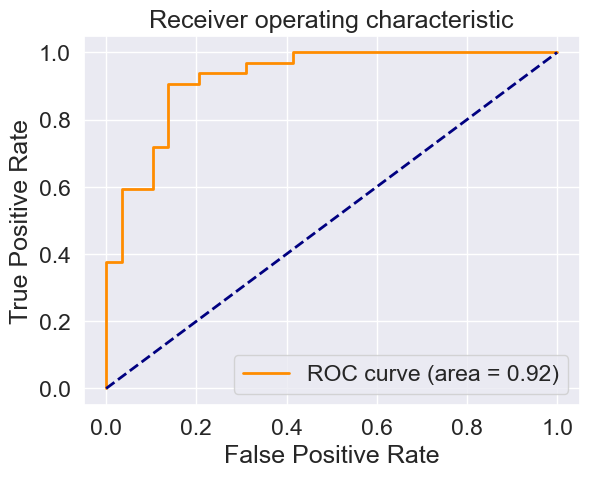

In [99]:
def plot_roc_curve(model):
    y_probs=model.predict_proba(x_test)
    y_probs[:10]
    y_probs_positive=y_probs[:, 1]
    fpr,tpr,threshold=roc_curve(y_test,y_probs_positive)
    plt.plot(fpr, tpr, color='darkorange', lw=2, label='ROC curve (area = %0.2f)' % roc_auc_score(y_test,y_probs_positive))
    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver operating characteristic')
    plt.legend(loc="lower right")
    plt.show()
    
plot_roc_curve(gs_log_reg)

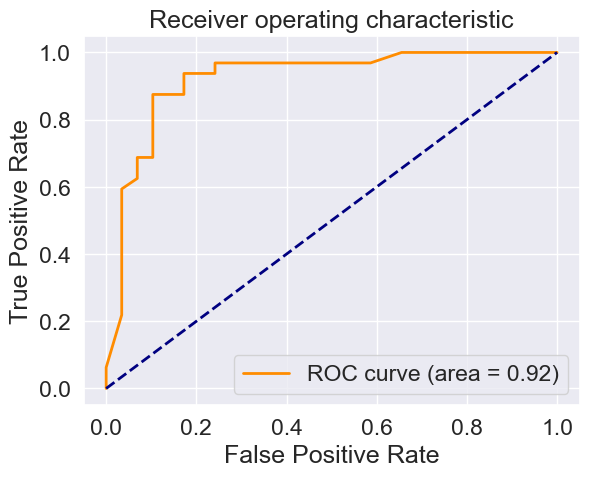

In [93]:
plot_roc_curve(gs_xg)

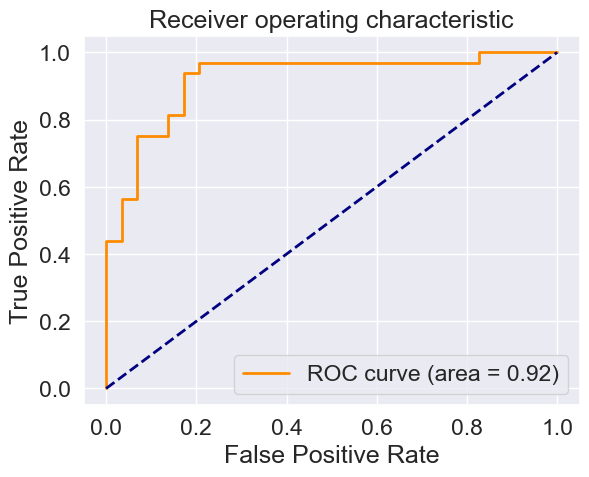

In [94]:
plot_roc_curve(gs_rf)

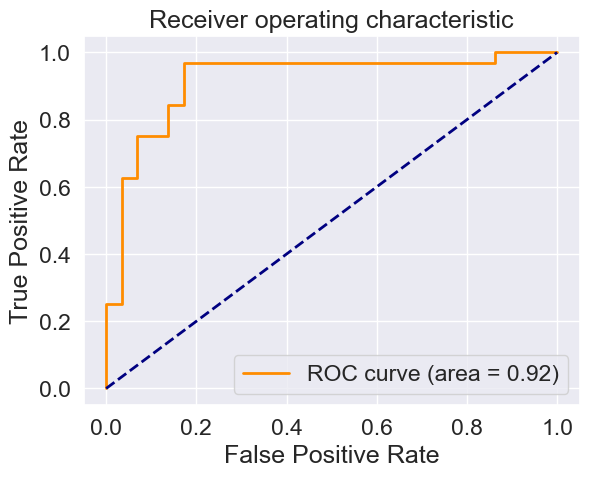

In [95]:
plot_roc_curve(rs_cat)

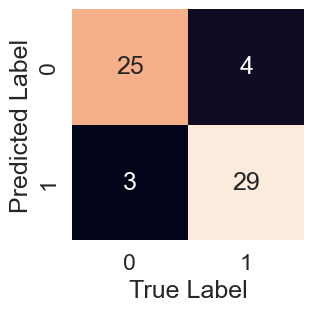

In [100]:
def plot_conf_mat(y_test,model):
    sns.set(font_scale=1.5)
    y_preds =model.predict(x_test)
    fig, ax= plt.subplots(figsize=(3,3))
    ax=sns.heatmap(confusion_matrix(y_test,y_preds),
                  annot=True,
                  cbar=False)
    plt.xlabel("True Label")
    plt.ylabel("Predicted Label")
    
plot_conf_mat(y_test,gs_log_reg)

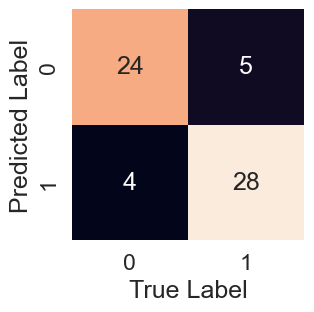

In [101]:
plot_conf_mat(y_test,gs_rf)

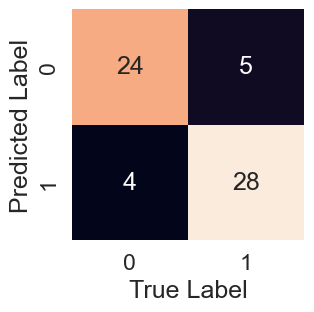

In [102]:
plot_conf_mat(y_test,gs_xg)

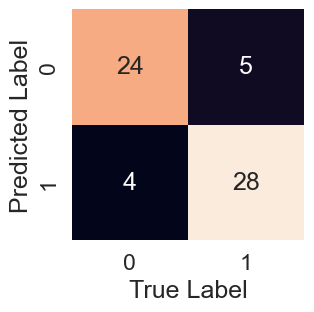

In [103]:
plot_conf_mat(y_test,rs_cat)

In [110]:
def cross_val_report(model):
   
    cv_acc = cross_val_score(model,
                        x,
                        y,
                        cv=5,
                        scoring="accuracy")
    cv_acc=np.mean(cv_acc)
    cv_precision = cross_val_score(model,
                        x,
                        y,
                        cv=5,
                        scoring="precision")
    cv_precision=np.mean(cv_precision)
    cv_recall = cross_val_score(model,
                        x,
                        y,
                        cv=5,
                        scoring="recall")
    cv_recall=np.mean(cv_recall)
    cv_f1 = cross_val_score(model,
                        x,
                        y,
                        cv=5,
                        scoring="f1")
    cv_f1=np.mean(cv_f1)
    cv_metrics={"Accuracy":cv_acc,
                        "Precision":cv_precision,
                       "Recall":cv_recall,
                       "F1":cv_f1}
                       
    print(cv_metrics)

Fitting 5 folds for each of 20 candidates, totalling 100 fits
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Fitting 

Fitting 5 folds for each of 20 candidates, totalling 100 fits
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Fitting 

<Axes: title={'center': 'Cross-validation classification report'}>

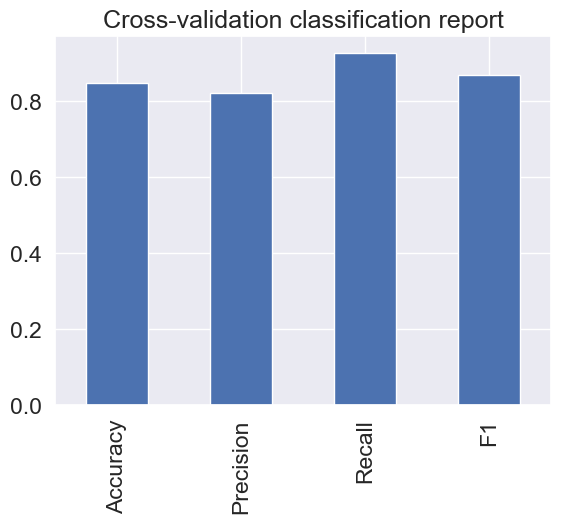

In [115]:
cross_val_report(gs_log_reg)
cv_metrics=pd.DataFrame(cv_metrics,
                       index=[0])
cv_metrics.T.plot.bar(title="Cross-validation classification report",
                      legend = False)

Fitting 5 folds for each of 81 candidates, totalling 405 fits
Fitting 5 folds for each of 81 candidates, totalling 405 fits
Fitting 5 folds for each of 81 candidates, totalling 405 fits
Fitting 5 folds for each of 81 candidates, totalling 405 fits
Fitting 5 folds for each of 81 candidates, totalling 405 fits
Fitting 5 folds for each of 81 candidates, totalling 405 fits
Fitting 5 folds for each of 81 candidates, totalling 405 fits
Fitting 5 folds for each of 81 candidates, totalling 405 fits
Fitting 5 folds for each of 81 candidates, totalling 405 fits
Fitting 5 folds for each of 81 candidates, totalling 405 fits
Fitting 5 folds for each of 81 candidates, totalling 405 fits
Fitting 5 folds for each of 81 candidates, totalling 405 fits
Fitting 5 folds for each of 81 candidates, totalling 405 fits
Fitting 5 folds for each of 81 candidates, totalling 405 fits
Fitting 5 folds for each of 81 candidates, totalling 405 fits
Fitting 5 folds for each of 81 candidates, totalling 405 fits
Fitting 

<Axes: title={'center': 'Cross-validation classification report'}>

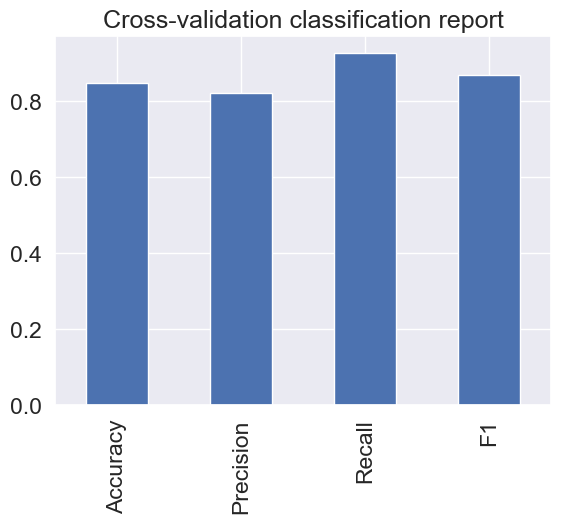

In [118]:
cross_val_report(gs_rf)
cv_metrics=pd.DataFrame(cv_metrics,
                       index=[0])
cv_metrics.T.plot.bar(title="Cross-validation classification report",
                      legend = False)

In [ ]:
cross_val_report(gs_xg)
cv_metrics=pd.DataFrame(cv_metrics,
                       index=[0])
cv_metrics.T.plot.bar(title="Cross-validation classification report",
                      legend = False)

Fitting 5 folds for each of 20 candidates, totalling 100 fits
0:	learn: 0.6402397	total: 52.6ms	remaining: 10.5s
1:	learn: 0.5771601	total: 54.3ms	remaining: 5.38s
2:	learn: 0.5523765	total: 55.7ms	remaining: 3.65s
3:	learn: 0.5180821	total: 56.9ms	remaining: 2.79s
4:	learn: 0.4821107	total: 58.3ms	remaining: 2.27s
5:	learn: 0.4682070	total: 59.5ms	remaining: 1.93s
6:	learn: 0.4490902	total: 60.8ms	remaining: 1.68s
7:	learn: 0.4376810	total: 62ms	remaining: 1.49s
8:	learn: 0.4276808	total: 63.3ms	remaining: 1.34s
9:	learn: 0.4165292	total: 64.5ms	remaining: 1.23s
10:	learn: 0.4008224	total: 65.8ms	remaining: 1.13s
11:	learn: 0.3962930	total: 67.1ms	remaining: 1.05s
12:	learn: 0.3899637	total: 68.3ms	remaining: 983ms
13:	learn: 0.3843294	total: 69.6ms	remaining: 924ms
14:	learn: 0.3784577	total: 70.8ms	remaining: 873ms
15:	learn: 0.3696224	total: 72ms	remaining: 829ms
16:	learn: 0.3645679	total: 73.3ms	remaining: 789ms
17:	learn: 0.3602022	total: 74.6ms	remaining: 754ms
18:	learn: 0.355

[CV] END bagging_temperature=1.2000000000000002, depth=2, l2_leaf_reg=3, learning_rate=0.15000000000000002, n_estimators=200, random_strength=0.7000000000000001; total time=   1.2s
0:	learn: 0.6484035	total: 1.41ms	remaining: 280ms
1:	learn: 0.6052176	total: 2.59ms	remaining: 256ms
2:	learn: 0.5532621	total: 3.89ms	remaining: 256ms
3:	learn: 0.5247623	total: 5.11ms	remaining: 251ms
4:	learn: 0.4929147	total: 6.37ms	remaining: 248ms
5:	learn: 0.4805672	total: 7.55ms	remaining: 244ms
6:	learn: 0.4635481	total: 8.82ms	remaining: 243ms
7:	learn: 0.4486169	total: 9.98ms	remaining: 240ms
8:	learn: 0.4382206	total: 11.2ms	remaining: 237ms
9:	learn: 0.4264718	total: 12.4ms	remaining: 236ms
10:	learn: 0.4128282	total: 13.7ms	remaining: 235ms
11:	learn: 0.4013510	total: 14.9ms	remaining: 234ms
12:	learn: 0.3922744	total: 16.1ms	remaining: 232ms
13:	learn: 0.3856967	total: 17.4ms	remaining: 231ms
14:	learn: 0.3784399	total: 18.6ms	remaining: 229ms
15:	learn: 0.3732064	total: 19.8ms	remaining: 228

[CV] END bagging_temperature=1.2000000000000002, depth=2, l2_leaf_reg=3, learning_rate=0.15000000000000002, n_estimators=200, random_strength=0.7000000000000001; total time=   0.4s
0:	learn: 0.6286180	total: 1.22ms	remaining: 243ms
1:	learn: 0.5676571	total: 2.38ms	remaining: 235ms
2:	learn: 0.5278352	total: 3.59ms	remaining: 235ms
3:	learn: 0.4969488	total: 4.66ms	remaining: 229ms
4:	learn: 0.4674951	total: 5.79ms	remaining: 226ms
5:	learn: 0.4397161	total: 6.83ms	remaining: 221ms
6:	learn: 0.4257557	total: 7.98ms	remaining: 220ms
7:	learn: 0.4090148	total: 9.08ms	remaining: 218ms
8:	learn: 0.3912642	total: 10.2ms	remaining: 216ms
9:	learn: 0.3774794	total: 11.2ms	remaining: 214ms
10:	learn: 0.3690086	total: 12.3ms	remaining: 212ms
11:	learn: 0.3603279	total: 13.6ms	remaining: 213ms
12:	learn: 0.3509080	total: 14.7ms	remaining: 211ms
13:	learn: 0.3394206	total: 15.8ms	remaining: 209ms
14:	learn: 0.3339967	total: 16.8ms	remaining: 208ms
15:	learn: 0.3284349	total: 17.9ms	remaining: 206

0:	learn: 0.6373442	total: 1.22ms	remaining: 243ms
1:	learn: 0.5838120	total: 2.46ms	remaining: 244ms
2:	learn: 0.5385628	total: 3.52ms	remaining: 231ms
3:	learn: 0.5111039	total: 4.58ms	remaining: 225ms
4:	learn: 0.4768006	total: 5.67ms	remaining: 221ms
5:	learn: 0.4551433	total: 6.78ms	remaining: 219ms
6:	learn: 0.4395550	total: 7.82ms	remaining: 216ms
7:	learn: 0.4320134	total: 8.91ms	remaining: 214ms
8:	learn: 0.4192388	total: 9.99ms	remaining: 212ms
9:	learn: 0.4031440	total: 11.1ms	remaining: 211ms
10:	learn: 0.3971203	total: 12.2ms	remaining: 209ms
11:	learn: 0.3906117	total: 13.3ms	remaining: 209ms
12:	learn: 0.3836397	total: 14.4ms	remaining: 207ms
13:	learn: 0.3746154	total: 15.5ms	remaining: 206ms
14:	learn: 0.3700305	total: 16.5ms	remaining: 204ms
15:	learn: 0.3614720	total: 17.6ms	remaining: 203ms
16:	learn: 0.3577497	total: 18.7ms	remaining: 202ms
17:	learn: 0.3500199	total: 19.8ms	remaining: 200ms
18:	learn: 0.3453160	total: 21ms	remaining: 200ms
19:	learn: 0.3410748	tot

172:	learn: 0.1028766	total: 190ms	remaining: 29.6ms
173:	learn: 0.1013039	total: 191ms	remaining: 28.5ms
174:	learn: 0.1010370	total: 192ms	remaining: 27.5ms
175:	learn: 0.1001269	total: 193ms	remaining: 26.4ms
176:	learn: 0.0994123	total: 194ms	remaining: 25.3ms
177:	learn: 0.0987127	total: 196ms	remaining: 24.2ms
178:	learn: 0.0981636	total: 197ms	remaining: 23.1ms
179:	learn: 0.0981007	total: 198ms	remaining: 22ms
180:	learn: 0.0980084	total: 199ms	remaining: 20.9ms
181:	learn: 0.0973128	total: 200ms	remaining: 19.8ms
182:	learn: 0.0967412	total: 201ms	remaining: 18.7ms
183:	learn: 0.0960693	total: 202ms	remaining: 17.6ms
184:	learn: 0.0948795	total: 204ms	remaining: 16.5ms
185:	learn: 0.0946640	total: 205ms	remaining: 15.4ms
186:	learn: 0.0942526	total: 206ms	remaining: 14.3ms
187:	learn: 0.0936059	total: 207ms	remaining: 13.2ms
188:	learn: 0.0930139	total: 209ms	remaining: 12.1ms
189:	learn: 0.0925794	total: 210ms	remaining: 11ms
190:	learn: 0.0920035	total: 211ms	remaining: 9.93

130:	learn: 0.1206568	total: 147ms	remaining: 77.4ms
131:	learn: 0.1197874	total: 148ms	remaining: 76.5ms
132:	learn: 0.1191789	total: 150ms	remaining: 75.4ms
133:	learn: 0.1189780	total: 151ms	remaining: 74.3ms
134:	learn: 0.1177649	total: 152ms	remaining: 73.2ms
135:	learn: 0.1164718	total: 153ms	remaining: 72.1ms
136:	learn: 0.1148905	total: 154ms	remaining: 70.9ms
137:	learn: 0.1137745	total: 155ms	remaining: 69.8ms
138:	learn: 0.1133003	total: 157ms	remaining: 68.7ms
139:	learn: 0.1127167	total: 158ms	remaining: 67.6ms
140:	learn: 0.1121521	total: 159ms	remaining: 66.6ms
141:	learn: 0.1113513	total: 160ms	remaining: 65.5ms
142:	learn: 0.1107150	total: 162ms	remaining: 64.4ms
143:	learn: 0.1092827	total: 163ms	remaining: 63.3ms
144:	learn: 0.1091551	total: 164ms	remaining: 62.2ms
145:	learn: 0.1089086	total: 165ms	remaining: 61.1ms
146:	learn: 0.1081580	total: 166ms	remaining: 60ms
147:	learn: 0.1079227	total: 168ms	remaining: 58.9ms
148:	learn: 0.1073478	total: 169ms	remaining: 57

150:	learn: 0.0093933	total: 189ms	remaining: 186ms
151:	learn: 0.0093932	total: 190ms	remaining: 185ms
152:	learn: 0.0093932	total: 191ms	remaining: 184ms
153:	learn: 0.0092854	total: 193ms	remaining: 183ms
154:	learn: 0.0092500	total: 194ms	remaining: 182ms
155:	learn: 0.0091980	total: 195ms	remaining: 180ms
156:	learn: 0.0091980	total: 197ms	remaining: 179ms
157:	learn: 0.0091976	total: 198ms	remaining: 178ms
158:	learn: 0.0091975	total: 199ms	remaining: 176ms
159:	learn: 0.0091974	total: 200ms	remaining: 175ms
160:	learn: 0.0091975	total: 201ms	remaining: 173ms
161:	learn: 0.0091975	total: 202ms	remaining: 172ms
162:	learn: 0.0091972	total: 203ms	remaining: 171ms
163:	learn: 0.0091973	total: 204ms	remaining: 169ms
164:	learn: 0.0091972	total: 205ms	remaining: 168ms
165:	learn: 0.0091972	total: 206ms	remaining: 166ms
166:	learn: 0.0091931	total: 207ms	remaining: 165ms
167:	learn: 0.0091931	total: 208ms	remaining: 164ms
168:	learn: 0.0091863	total: 210ms	remaining: 163ms
169:	learn: 

112:	learn: 0.0130729	total: 152ms	remaining: 251ms
113:	learn: 0.0129345	total: 153ms	remaining: 250ms
114:	learn: 0.0126674	total: 155ms	remaining: 249ms
115:	learn: 0.0125058	total: 156ms	remaining: 248ms
116:	learn: 0.0124762	total: 158ms	remaining: 247ms
117:	learn: 0.0124676	total: 159ms	remaining: 245ms
118:	learn: 0.0123008	total: 160ms	remaining: 244ms
119:	learn: 0.0119956	total: 162ms	remaining: 243ms
120:	learn: 0.0117785	total: 163ms	remaining: 241ms
121:	learn: 0.0114380	total: 165ms	remaining: 240ms
122:	learn: 0.0113157	total: 166ms	remaining: 239ms
123:	learn: 0.0110675	total: 167ms	remaining: 237ms
124:	learn: 0.0108554	total: 169ms	remaining: 236ms
125:	learn: 0.0107126	total: 170ms	remaining: 235ms
126:	learn: 0.0105879	total: 172ms	remaining: 234ms
127:	learn: 0.0103000	total: 173ms	remaining: 233ms
128:	learn: 0.0101377	total: 174ms	remaining: 231ms
129:	learn: 0.0100442	total: 176ms	remaining: 230ms
130:	learn: 0.0097959	total: 177ms	remaining: 228ms
131:	learn: 

[CV] END bagging_temperature=0.7000000000000001, depth=4, l2_leaf_reg=2, learning_rate=0.25, n_estimators=300, random_strength=0.8; total time=   0.5s
0:	learn: 0.5480389	total: 1.56ms	remaining: 467ms
1:	learn: 0.4516540	total: 3.34ms	remaining: 498ms
2:	learn: 0.3838894	total: 5.25ms	remaining: 519ms
3:	learn: 0.3517918	total: 6.93ms	remaining: 513ms
4:	learn: 0.3287680	total: 8.43ms	remaining: 498ms
5:	learn: 0.3106707	total: 10ms	remaining: 491ms
6:	learn: 0.2921540	total: 11.4ms	remaining: 479ms
7:	learn: 0.2832479	total: 12.9ms	remaining: 471ms
8:	learn: 0.2579997	total: 14.3ms	remaining: 464ms
9:	learn: 0.2493460	total: 15.8ms	remaining: 458ms
10:	learn: 0.2378330	total: 17.3ms	remaining: 454ms
11:	learn: 0.2264686	total: 18.7ms	remaining: 450ms
12:	learn: 0.2100102	total: 20.2ms	remaining: 445ms
13:	learn: 0.2047493	total: 21.5ms	remaining: 440ms
14:	learn: 0.1955151	total: 23ms	remaining: 437ms
15:	learn: 0.1840472	total: 24.4ms	remaining: 433ms
16:	learn: 0.1807806	total: 25.

257:	learn: 0.0040566	total: 356ms	remaining: 57.9ms
258:	learn: 0.0040567	total: 357ms	remaining: 56.5ms
259:	learn: 0.0040567	total: 358ms	remaining: 55.1ms
260:	learn: 0.0040567	total: 359ms	remaining: 53.7ms
261:	learn: 0.0040566	total: 360ms	remaining: 52.3ms
262:	learn: 0.0040565	total: 361ms	remaining: 50.8ms
263:	learn: 0.0040566	total: 363ms	remaining: 49.4ms
264:	learn: 0.0040562	total: 364ms	remaining: 48ms
265:	learn: 0.0040562	total: 365ms	remaining: 46.6ms
266:	learn: 0.0040434	total: 366ms	remaining: 45.2ms
267:	learn: 0.0040299	total: 367ms	remaining: 43.9ms
268:	learn: 0.0039869	total: 369ms	remaining: 42.5ms
269:	learn: 0.0039870	total: 370ms	remaining: 41.1ms
270:	learn: 0.0039868	total: 371ms	remaining: 39.7ms
271:	learn: 0.0039865	total: 372ms	remaining: 38.3ms
272:	learn: 0.0039865	total: 373ms	remaining: 36.9ms
273:	learn: 0.0039861	total: 375ms	remaining: 35.5ms
274:	learn: 0.0039861	total: 376ms	remaining: 34.1ms
275:	learn: 0.0039859	total: 377ms	remaining: 32

142:	learn: 0.0068011	total: 193ms	remaining: 212ms
143:	learn: 0.0067124	total: 195ms	remaining: 211ms
144:	learn: 0.0067123	total: 196ms	remaining: 209ms
145:	learn: 0.0066289	total: 197ms	remaining: 208ms
146:	learn: 0.0065444	total: 199ms	remaining: 207ms
147:	learn: 0.0064520	total: 200ms	remaining: 205ms
148:	learn: 0.0063677	total: 201ms	remaining: 204ms
149:	learn: 0.0063037	total: 203ms	remaining: 203ms
150:	learn: 0.0062711	total: 204ms	remaining: 201ms
151:	learn: 0.0061938	total: 205ms	remaining: 200ms
152:	learn: 0.0061440	total: 207ms	remaining: 199ms
153:	learn: 0.0060994	total: 209ms	remaining: 198ms
154:	learn: 0.0060480	total: 210ms	remaining: 196ms
155:	learn: 0.0060189	total: 211ms	remaining: 195ms
156:	learn: 0.0059496	total: 213ms	remaining: 194ms
157:	learn: 0.0059495	total: 214ms	remaining: 192ms
158:	learn: 0.0059120	total: 215ms	remaining: 191ms
159:	learn: 0.0058184	total: 217ms	remaining: 190ms
160:	learn: 0.0058183	total: 218ms	remaining: 188ms
161:	learn: 

28:	learn: 0.1028303	total: 39.9ms	remaining: 373ms
29:	learn: 0.1005509	total: 41.5ms	remaining: 374ms
30:	learn: 0.0979967	total: 43ms	remaining: 373ms
31:	learn: 0.0925885	total: 44.4ms	remaining: 372ms
32:	learn: 0.0880084	total: 45.9ms	remaining: 371ms
33:	learn: 0.0844649	total: 47.2ms	remaining: 370ms
34:	learn: 0.0816679	total: 48.6ms	remaining: 368ms
35:	learn: 0.0767138	total: 50ms	remaining: 367ms
36:	learn: 0.0753007	total: 51.4ms	remaining: 365ms
37:	learn: 0.0717473	total: 52.8ms	remaining: 364ms
38:	learn: 0.0681359	total: 54.3ms	remaining: 363ms
39:	learn: 0.0661949	total: 55.7ms	remaining: 362ms
40:	learn: 0.0644733	total: 57.1ms	remaining: 361ms
41:	learn: 0.0606955	total: 58.5ms	remaining: 360ms
42:	learn: 0.0589910	total: 59.8ms	remaining: 358ms
43:	learn: 0.0570109	total: 61.1ms	remaining: 356ms
44:	learn: 0.0553294	total: 62.6ms	remaining: 355ms
45:	learn: 0.0534450	total: 63.9ms	remaining: 353ms
46:	learn: 0.0528758	total: 65.2ms	remaining: 351ms
47:	learn: 0.049

[CV] END bagging_temperature=0.7000000000000001, depth=4, l2_leaf_reg=2, learning_rate=0.25, n_estimators=300, random_strength=0.8; total time=   0.5s
0:	learn: 0.6662876	total: 473us	remaining: 23.2ms
1:	learn: 0.6372383	total: 871us	remaining: 20.9ms
2:	learn: 0.6139689	total: 1.25ms	remaining: 19.6ms
3:	learn: 0.5916202	total: 1.65ms	remaining: 18.9ms
4:	learn: 0.5717388	total: 2.11ms	remaining: 19ms
5:	learn: 0.5560987	total: 2.52ms	remaining: 18.5ms
6:	learn: 0.5429588	total: 2.91ms	remaining: 17.9ms
7:	learn: 0.5288569	total: 3.28ms	remaining: 17.2ms
8:	learn: 0.5112675	total: 3.68ms	remaining: 16.8ms
9:	learn: 0.4965644	total: 4.06ms	remaining: 16.3ms
10:	learn: 0.4873259	total: 4.45ms	remaining: 15.8ms
11:	learn: 0.4810169	total: 4.87ms	remaining: 15.4ms
12:	learn: 0.4706002	total: 5.25ms	remaining: 14.9ms
13:	learn: 0.4608996	total: 5.64ms	remaining: 14.5ms
14:	learn: 0.4539489	total: 6.02ms	remaining: 14ms
15:	learn: 0.4487081	total: 6.41ms	remaining: 13.6ms
16:	learn: 0.4427

48:	learn: 0.3034612	total: 19.5ms	remaining: 398us
49:	learn: 0.3023982	total: 20ms	remaining: 0us
[CV] END bagging_temperature=1.4000000000000001, depth=3, l2_leaf_reg=7, learning_rate=0.15000000000000002, n_estimators=50, random_strength=1.2000000000000002; total time=   0.1s
0:	learn: 0.6566545	total: 541us	remaining: 26.5ms
1:	learn: 0.6292197	total: 980us	remaining: 23.5ms
2:	learn: 0.6001323	total: 1.38ms	remaining: 21.6ms
3:	learn: 0.5785684	total: 1.85ms	remaining: 21.3ms
4:	learn: 0.5576797	total: 2.27ms	remaining: 20.5ms
5:	learn: 0.5407916	total: 2.67ms	remaining: 19.6ms
6:	learn: 0.5275870	total: 3.1ms	remaining: 19ms
7:	learn: 0.5127953	total: 3.58ms	remaining: 18.8ms
8:	learn: 0.4995398	total: 4.01ms	remaining: 18.3ms
9:	learn: 0.4872354	total: 4.4ms	remaining: 17.6ms
10:	learn: 0.4790688	total: 4.81ms	remaining: 17.1ms
11:	learn: 0.4727796	total: 5.18ms	remaining: 16.4ms
12:	learn: 0.4611320	total: 5.58ms	remaining: 15.9ms
13:	learn: 0.4533994	total: 5.95ms	remaining: 1

128:	learn: 0.0409209	total: 191ms	remaining: 402ms
129:	learn: 0.0404227	total: 193ms	remaining: 400ms
130:	learn: 0.0400669	total: 194ms	remaining: 399ms
131:	learn: 0.0393048	total: 196ms	remaining: 398ms
132:	learn: 0.0387048	total: 197ms	remaining: 396ms
133:	learn: 0.0379552	total: 199ms	remaining: 394ms
134:	learn: 0.0375397	total: 200ms	remaining: 393ms
135:	learn: 0.0370247	total: 202ms	remaining: 392ms
136:	learn: 0.0364914	total: 203ms	remaining: 390ms
137:	learn: 0.0361615	total: 205ms	remaining: 388ms
138:	learn: 0.0353772	total: 206ms	remaining: 387ms
139:	learn: 0.0345639	total: 208ms	remaining: 386ms
140:	learn: 0.0340217	total: 209ms	remaining: 384ms
141:	learn: 0.0337015	total: 211ms	remaining: 383ms
142:	learn: 0.0331275	total: 212ms	remaining: 381ms
143:	learn: 0.0325637	total: 214ms	remaining: 380ms
144:	learn: 0.0320288	total: 215ms	remaining: 378ms
145:	learn: 0.0316431	total: 216ms	remaining: 376ms
146:	learn: 0.0310124	total: 218ms	remaining: 375ms
147:	learn: 

[CV] END bagging_temperature=1.0, depth=5, l2_leaf_reg=3, learning_rate=0.1, n_estimators=400, random_strength=1.4000000000000001; total time=   0.7s
0:	learn: 0.6184787	total: 1.6ms	remaining: 637ms
1:	learn: 0.5820049	total: 3.01ms	remaining: 600ms
2:	learn: 0.5381488	total: 4.57ms	remaining: 605ms
3:	learn: 0.5126989	total: 5.99ms	remaining: 593ms
4:	learn: 0.4819178	total: 7.45ms	remaining: 589ms
5:	learn: 0.4539978	total: 8.85ms	remaining: 581ms
6:	learn: 0.4359988	total: 10.3ms	remaining: 576ms
7:	learn: 0.4063561	total: 11.7ms	remaining: 573ms
8:	learn: 0.3834001	total: 13.2ms	remaining: 573ms
9:	learn: 0.3680154	total: 14.7ms	remaining: 572ms
10:	learn: 0.3553990	total: 16.1ms	remaining: 568ms
11:	learn: 0.3437240	total: 17.5ms	remaining: 564ms
12:	learn: 0.3354476	total: 18.8ms	remaining: 561ms
13:	learn: 0.3188807	total: 20.2ms	remaining: 558ms
14:	learn: 0.3043572	total: 21.6ms	remaining: 555ms
15:	learn: 0.2954636	total: 23.1ms	remaining: 555ms
16:	learn: 0.2911534	total: 2

201:	learn: 0.0221912	total: 303ms	remaining: 297ms
202:	learn: 0.0219477	total: 304ms	remaining: 295ms
203:	learn: 0.0219398	total: 306ms	remaining: 294ms
204:	learn: 0.0217129	total: 307ms	remaining: 292ms
205:	learn: 0.0214888	total: 309ms	remaining: 291ms
206:	learn: 0.0210579	total: 310ms	remaining: 289ms
207:	learn: 0.0209038	total: 312ms	remaining: 288ms
208:	learn: 0.0208156	total: 313ms	remaining: 286ms
209:	learn: 0.0206131	total: 315ms	remaining: 285ms
210:	learn: 0.0204033	total: 316ms	remaining: 283ms
211:	learn: 0.0203928	total: 318ms	remaining: 282ms
212:	learn: 0.0203121	total: 319ms	remaining: 280ms
213:	learn: 0.0201293	total: 321ms	remaining: 279ms
214:	learn: 0.0200192	total: 322ms	remaining: 277ms
215:	learn: 0.0198041	total: 324ms	remaining: 276ms
216:	learn: 0.0196253	total: 325ms	remaining: 274ms
217:	learn: 0.0194435	total: 327ms	remaining: 273ms
218:	learn: 0.0193518	total: 328ms	remaining: 271ms
219:	learn: 0.0192352	total: 329ms	remaining: 270ms
220:	learn: 

[CV] END bagging_temperature=1.0, depth=5, l2_leaf_reg=3, learning_rate=0.1, n_estimators=400, random_strength=1.4000000000000001; total time=   0.9s
0:	learn: 0.5994905	total: 1.57ms	remaining: 629ms
1:	learn: 0.5573111	total: 2.99ms	remaining: 595ms
2:	learn: 0.5117699	total: 4.43ms	remaining: 586ms
3:	learn: 0.4718534	total: 5.88ms	remaining: 582ms
4:	learn: 0.4413898	total: 7.3ms	remaining: 577ms
5:	learn: 0.4146006	total: 8.76ms	remaining: 576ms
6:	learn: 0.3981918	total: 10.2ms	remaining: 572ms
7:	learn: 0.3720470	total: 11.6ms	remaining: 567ms
8:	learn: 0.3529636	total: 13ms	remaining: 565ms
9:	learn: 0.3362991	total: 14.4ms	remaining: 562ms
10:	learn: 0.3213629	total: 15.8ms	remaining: 560ms
11:	learn: 0.3147811	total: 17.2ms	remaining: 557ms
12:	learn: 0.3051181	total: 18.8ms	remaining: 559ms
13:	learn: 0.2945442	total: 20.3ms	remaining: 560ms
14:	learn: 0.2798235	total: 21.7ms	remaining: 558ms
15:	learn: 0.2742022	total: 23.2ms	remaining: 556ms
16:	learn: 0.2662267	total: 24.

228:	learn: 0.0169206	total: 336ms	remaining: 251ms
229:	learn: 0.0168551	total: 338ms	remaining: 249ms
230:	learn: 0.0167509	total: 339ms	remaining: 248ms
231:	learn: 0.0166949	total: 341ms	remaining: 247ms
232:	learn: 0.0166589	total: 342ms	remaining: 245ms
233:	learn: 0.0165991	total: 344ms	remaining: 244ms
234:	learn: 0.0164345	total: 345ms	remaining: 242ms
235:	learn: 0.0163149	total: 347ms	remaining: 241ms
236:	learn: 0.0161976	total: 348ms	remaining: 239ms
237:	learn: 0.0161238	total: 349ms	remaining: 238ms
238:	learn: 0.0160784	total: 351ms	remaining: 236ms
239:	learn: 0.0160412	total: 352ms	remaining: 235ms
240:	learn: 0.0159224	total: 354ms	remaining: 233ms
241:	learn: 0.0158748	total: 355ms	remaining: 232ms
242:	learn: 0.0158304	total: 357ms	remaining: 231ms
243:	learn: 0.0156781	total: 358ms	remaining: 229ms
244:	learn: 0.0155707	total: 360ms	remaining: 228ms
245:	learn: 0.0154548	total: 361ms	remaining: 226ms
246:	learn: 0.0153165	total: 362ms	remaining: 225ms
247:	learn: 

[CV] END bagging_temperature=1.0, depth=5, l2_leaf_reg=3, learning_rate=0.1, n_estimators=400, random_strength=1.4000000000000001; total time=   0.8s
0:	learn: 0.6172024	total: 1.64ms	remaining: 654ms
1:	learn: 0.5863233	total: 3.16ms	remaining: 628ms
2:	learn: 0.5364326	total: 4.75ms	remaining: 629ms
3:	learn: 0.5038337	total: 6.24ms	remaining: 618ms
4:	learn: 0.4694078	total: 7.75ms	remaining: 612ms
5:	learn: 0.4394838	total: 9.21ms	remaining: 605ms
6:	learn: 0.4188215	total: 10.7ms	remaining: 599ms
7:	learn: 0.3919079	total: 12.2ms	remaining: 596ms
8:	learn: 0.3688321	total: 13.7ms	remaining: 595ms
9:	learn: 0.3525721	total: 15.3ms	remaining: 596ms
10:	learn: 0.3395087	total: 16.8ms	remaining: 593ms
11:	learn: 0.3257499	total: 18.3ms	remaining: 591ms
12:	learn: 0.3142048	total: 19.8ms	remaining: 588ms
13:	learn: 0.2973176	total: 21.2ms	remaining: 585ms
14:	learn: 0.2844164	total: 22.8ms	remaining: 585ms
15:	learn: 0.2773400	total: 24.3ms	remaining: 584ms
16:	learn: 0.2699389	total: 

232:	learn: 0.0141782	total: 349ms	remaining: 250ms
233:	learn: 0.0141108	total: 351ms	remaining: 249ms
234:	learn: 0.0140597	total: 353ms	remaining: 248ms
235:	learn: 0.0139677	total: 354ms	remaining: 246ms
236:	learn: 0.0138664	total: 356ms	remaining: 245ms
237:	learn: 0.0137784	total: 357ms	remaining: 243ms
238:	learn: 0.0136866	total: 359ms	remaining: 242ms
239:	learn: 0.0136208	total: 360ms	remaining: 240ms
240:	learn: 0.0135728	total: 361ms	remaining: 238ms
241:	learn: 0.0135571	total: 363ms	remaining: 237ms
242:	learn: 0.0135259	total: 364ms	remaining: 235ms
243:	learn: 0.0134129	total: 366ms	remaining: 234ms
244:	learn: 0.0133626	total: 367ms	remaining: 232ms
245:	learn: 0.0132563	total: 369ms	remaining: 231ms
246:	learn: 0.0131454	total: 370ms	remaining: 229ms
247:	learn: 0.0130192	total: 372ms	remaining: 228ms
248:	learn: 0.0129403	total: 373ms	remaining: 226ms
249:	learn: 0.0128642	total: 375ms	remaining: 225ms
250:	learn: 0.0127697	total: 376ms	remaining: 223ms
251:	learn: 

0:	learn: 0.6136586	total: 1.62ms	remaining: 646ms
1:	learn: 0.5676453	total: 3.27ms	remaining: 652ms
2:	learn: 0.5169513	total: 4.79ms	remaining: 634ms
3:	learn: 0.4803528	total: 6.21ms	remaining: 615ms
4:	learn: 0.4515082	total: 7.62ms	remaining: 602ms
5:	learn: 0.4177646	total: 9.03ms	remaining: 593ms
6:	learn: 0.3998032	total: 10.4ms	remaining: 587ms
7:	learn: 0.3737296	total: 11.9ms	remaining: 583ms
8:	learn: 0.3524021	total: 13.3ms	remaining: 579ms
9:	learn: 0.3362383	total: 14.8ms	remaining: 578ms
10:	learn: 0.3233851	total: 16.3ms	remaining: 576ms
11:	learn: 0.3132320	total: 17.8ms	remaining: 575ms
12:	learn: 0.3011467	total: 19.3ms	remaining: 575ms
13:	learn: 0.2874271	total: 20.8ms	remaining: 572ms
14:	learn: 0.2745234	total: 22.2ms	remaining: 569ms
15:	learn: 0.2659657	total: 23.6ms	remaining: 566ms
16:	learn: 0.2584400	total: 25ms	remaining: 563ms
17:	learn: 0.2512758	total: 26.4ms	remaining: 561ms
18:	learn: 0.2453970	total: 27.9ms	remaining: 559ms
19:	learn: 0.2375797	tot

268:	learn: 0.0100797	total: 387ms	remaining: 189ms
269:	learn: 0.0100251	total: 389ms	remaining: 187ms
270:	learn: 0.0099658	total: 390ms	remaining: 186ms
271:	learn: 0.0099065	total: 392ms	remaining: 184ms
272:	learn: 0.0098221	total: 393ms	remaining: 183ms
273:	learn: 0.0097411	total: 395ms	remaining: 181ms
274:	learn: 0.0096592	total: 396ms	remaining: 180ms
275:	learn: 0.0096139	total: 398ms	remaining: 179ms
276:	learn: 0.0096015	total: 399ms	remaining: 177ms
277:	learn: 0.0095278	total: 400ms	remaining: 176ms
278:	learn: 0.0094907	total: 402ms	remaining: 174ms
279:	learn: 0.0094606	total: 403ms	remaining: 173ms
280:	learn: 0.0094317	total: 405ms	remaining: 171ms
281:	learn: 0.0093943	total: 406ms	remaining: 170ms
282:	learn: 0.0093476	total: 408ms	remaining: 169ms
283:	learn: 0.0093049	total: 409ms	remaining: 167ms
284:	learn: 0.0092465	total: 411ms	remaining: 166ms
285:	learn: 0.0092019	total: 412ms	remaining: 164ms
286:	learn: 0.0091419	total: 413ms	remaining: 163ms
287:	learn: 

[CV] END bagging_temperature=0.9, depth=3, l2_leaf_reg=6, learning_rate=0.2, n_estimators=100, random_strength=0.4; total time=   0.1s
0:	learn: 0.6544659	total: 502us	remaining: 49.7ms
1:	learn: 0.6106180	total: 888us	remaining: 43.5ms
2:	learn: 0.5785599	total: 1.34ms	remaining: 43.5ms
3:	learn: 0.5516314	total: 1.79ms	remaining: 42.9ms
4:	learn: 0.5266994	total: 2.19ms	remaining: 41.6ms
5:	learn: 0.5035036	total: 2.56ms	remaining: 40.1ms
6:	learn: 0.4864948	total: 2.97ms	remaining: 39.5ms
7:	learn: 0.4707883	total: 3.35ms	remaining: 38.5ms
8:	learn: 0.4558553	total: 3.79ms	remaining: 38.3ms
9:	learn: 0.4433996	total: 4.16ms	remaining: 37.5ms
10:	learn: 0.4311486	total: 4.54ms	remaining: 36.7ms
11:	learn: 0.4240579	total: 4.93ms	remaining: 36.2ms
12:	learn: 0.4147237	total: 5.32ms	remaining: 35.6ms
13:	learn: 0.4081446	total: 5.73ms	remaining: 35.2ms
14:	learn: 0.4007519	total: 6.13ms	remaining: 34.7ms
15:	learn: 0.3932330	total: 6.5ms	remaining: 34.1ms
16:	learn: 0.3877956	total: 6.

0:	learn: 0.6423205	total: 481us	remaining: 47.7ms
1:	learn: 0.5989081	total: 1.01ms	remaining: 49.4ms
2:	learn: 0.5652169	total: 1.41ms	remaining: 45.5ms
3:	learn: 0.5358205	total: 1.8ms	remaining: 43.2ms
4:	learn: 0.5140562	total: 2.19ms	remaining: 41.6ms
5:	learn: 0.4929806	total: 2.62ms	remaining: 41ms
6:	learn: 0.4789963	total: 3.04ms	remaining: 40.4ms
7:	learn: 0.4592500	total: 3.45ms	remaining: 39.7ms
8:	learn: 0.4473187	total: 3.85ms	remaining: 38.9ms
9:	learn: 0.4356908	total: 4.28ms	remaining: 38.6ms
10:	learn: 0.4240687	total: 4.68ms	remaining: 37.8ms
11:	learn: 0.4148264	total: 5.08ms	remaining: 37.3ms
12:	learn: 0.4034138	total: 5.49ms	remaining: 36.7ms
13:	learn: 0.3950864	total: 5.87ms	remaining: 36.1ms
14:	learn: 0.3862875	total: 6.27ms	remaining: 35.5ms
15:	learn: 0.3812766	total: 6.68ms	remaining: 35ms
16:	learn: 0.3733035	total: 7.07ms	remaining: 34.5ms
17:	learn: 0.3669946	total: 7.45ms	remaining: 33.9ms
18:	learn: 0.3613410	total: 7.89ms	remaining: 33.6ms
19:	learn

0:	learn: 0.6842121	total: 730us	remaining: 35.8ms
1:	learn: 0.6743005	total: 1.52ms	remaining: 36.6ms
2:	learn: 0.6657019	total: 2.11ms	remaining: 33.1ms
3:	learn: 0.6561598	total: 2.71ms	remaining: 31.2ms
4:	learn: 0.6483011	total: 3.31ms	remaining: 29.8ms
5:	learn: 0.6386353	total: 3.92ms	remaining: 28.7ms
6:	learn: 0.6298695	total: 4.5ms	remaining: 27.7ms
7:	learn: 0.6235113	total: 5.1ms	remaining: 26.8ms
8:	learn: 0.6161672	total: 5.7ms	remaining: 25.9ms
9:	learn: 0.6106765	total: 6.35ms	remaining: 25.4ms
10:	learn: 0.6046451	total: 7ms	remaining: 24.8ms
11:	learn: 0.5997926	total: 7.59ms	remaining: 24.1ms
12:	learn: 0.5945067	total: 8.18ms	remaining: 23.3ms
13:	learn: 0.5888891	total: 8.79ms	remaining: 22.6ms
14:	learn: 0.5823667	total: 9.37ms	remaining: 21.9ms
15:	learn: 0.5769357	total: 9.98ms	remaining: 21.2ms
16:	learn: 0.5717075	total: 10.6ms	remaining: 20.6ms
17:	learn: 0.5653130	total: 11.2ms	remaining: 19.9ms
18:	learn: 0.5597113	total: 11.8ms	remaining: 19.2ms
19:	learn:

5:	learn: 0.6391938	total: 4.44ms	remaining: 32.5ms
6:	learn: 0.6304947	total: 5.44ms	remaining: 33.4ms
7:	learn: 0.6234513	total: 6.18ms	remaining: 32.4ms
8:	learn: 0.6156282	total: 6.87ms	remaining: 31.3ms
9:	learn: 0.6081271	total: 7.52ms	remaining: 30.1ms
10:	learn: 0.6008697	total: 8.18ms	remaining: 29ms
11:	learn: 0.5954718	total: 8.92ms	remaining: 28.3ms
12:	learn: 0.5901593	total: 9.6ms	remaining: 27.3ms
13:	learn: 0.5847623	total: 10.2ms	remaining: 26.3ms
14:	learn: 0.5782396	total: 10.8ms	remaining: 25.3ms
15:	learn: 0.5719993	total: 11.5ms	remaining: 24.4ms
16:	learn: 0.5644515	total: 12.2ms	remaining: 23.7ms
17:	learn: 0.5589303	total: 12.9ms	remaining: 22.9ms
18:	learn: 0.5533302	total: 13.5ms	remaining: 22.1ms
19:	learn: 0.5498493	total: 14.2ms	remaining: 21.3ms
20:	learn: 0.5443292	total: 14.9ms	remaining: 20.6ms
21:	learn: 0.5381737	total: 15.5ms	remaining: 19.8ms
22:	learn: 0.5330029	total: 16.2ms	remaining: 19ms
23:	learn: 0.5261988	total: 16.8ms	remaining: 18.2ms
24:

158:	learn: 0.0456051	total: 228ms	remaining: 346ms
159:	learn: 0.0451580	total: 230ms	remaining: 345ms
160:	learn: 0.0446325	total: 231ms	remaining: 343ms
161:	learn: 0.0441669	total: 233ms	remaining: 342ms
162:	learn: 0.0438099	total: 234ms	remaining: 341ms
163:	learn: 0.0433736	total: 236ms	remaining: 339ms
164:	learn: 0.0433501	total: 237ms	remaining: 338ms
165:	learn: 0.0433351	total: 239ms	remaining: 336ms
166:	learn: 0.0433173	total: 240ms	remaining: 335ms
167:	learn: 0.0430381	total: 242ms	remaining: 334ms
168:	learn: 0.0430218	total: 243ms	remaining: 332ms
169:	learn: 0.0426889	total: 245ms	remaining: 331ms
170:	learn: 0.0422756	total: 246ms	remaining: 329ms
171:	learn: 0.0422569	total: 247ms	remaining: 328ms
172:	learn: 0.0422408	total: 249ms	remaining: 327ms
173:	learn: 0.0416695	total: 250ms	remaining: 325ms
174:	learn: 0.0413713	total: 252ms	remaining: 324ms
175:	learn: 0.0412034	total: 253ms	remaining: 322ms
176:	learn: 0.0405904	total: 255ms	remaining: 321ms
177:	learn: 

[CV] END bagging_temperature=0.5, depth=5, l2_leaf_reg=7, learning_rate=0.1, n_estimators=400, random_strength=0.6000000000000001; total time=   0.7s
0:	learn: 0.6321122	total: 1.66ms	remaining: 664ms
1:	learn: 0.5900791	total: 3.23ms	remaining: 642ms
2:	learn: 0.5520835	total: 4.76ms	remaining: 630ms
3:	learn: 0.5243648	total: 6.28ms	remaining: 622ms
4:	learn: 0.4888639	total: 7.8ms	remaining: 617ms
5:	learn: 0.4612519	total: 9.36ms	remaining: 615ms
6:	learn: 0.4380783	total: 10.9ms	remaining: 611ms
7:	learn: 0.4164146	total: 12.4ms	remaining: 608ms
8:	learn: 0.3981634	total: 13.9ms	remaining: 605ms
9:	learn: 0.3818690	total: 15.4ms	remaining: 602ms
10:	learn: 0.3652575	total: 17ms	remaining: 600ms
11:	learn: 0.3558709	total: 18.7ms	remaining: 604ms
12:	learn: 0.3444371	total: 20.2ms	remaining: 601ms
13:	learn: 0.3307378	total: 21.7ms	remaining: 598ms
14:	learn: 0.3174319	total: 23.3ms	remaining: 597ms
15:	learn: 0.3076901	total: 24.8ms	remaining: 594ms
16:	learn: 0.3018017	total: 26.

220:	learn: 0.0337703	total: 345ms	remaining: 280ms
221:	learn: 0.0335397	total: 347ms	remaining: 278ms
222:	learn: 0.0335315	total: 349ms	remaining: 277ms
223:	learn: 0.0331133	total: 350ms	remaining: 275ms
224:	learn: 0.0329856	total: 352ms	remaining: 274ms
225:	learn: 0.0329785	total: 353ms	remaining: 272ms
226:	learn: 0.0327515	total: 355ms	remaining: 270ms
227:	learn: 0.0325110	total: 356ms	remaining: 269ms
228:	learn: 0.0325045	total: 358ms	remaining: 267ms
229:	learn: 0.0323149	total: 360ms	remaining: 266ms
230:	learn: 0.0321516	total: 361ms	remaining: 264ms
231:	learn: 0.0319639	total: 363ms	remaining: 263ms
232:	learn: 0.0316821	total: 365ms	remaining: 261ms
233:	learn: 0.0316116	total: 366ms	remaining: 260ms
234:	learn: 0.0313506	total: 368ms	remaining: 258ms
235:	learn: 0.0310966	total: 370ms	remaining: 257ms
236:	learn: 0.0308336	total: 371ms	remaining: 255ms
237:	learn: 0.0306556	total: 373ms	remaining: 254ms
238:	learn: 0.0304990	total: 374ms	remaining: 252ms
239:	learn: 

[CV] END bagging_temperature=0.5, depth=5, l2_leaf_reg=7, learning_rate=0.1, n_estimators=400, random_strength=0.6000000000000001; total time=   0.7s
0:	learn: 0.6207224	total: 1.71ms	remaining: 680ms
1:	learn: 0.5692438	total: 3.35ms	remaining: 666ms
2:	learn: 0.5220962	total: 4.9ms	remaining: 649ms
3:	learn: 0.4866061	total: 6.46ms	remaining: 640ms
4:	learn: 0.4570951	total: 8.1ms	remaining: 640ms
5:	learn: 0.4311059	total: 9.65ms	remaining: 634ms
6:	learn: 0.4081578	total: 11.2ms	remaining: 629ms
7:	learn: 0.3847095	total: 12.7ms	remaining: 625ms
8:	learn: 0.3661099	total: 14.3ms	remaining: 622ms
9:	learn: 0.3485671	total: 16ms	remaining: 624ms
10:	learn: 0.3322448	total: 17.6ms	remaining: 622ms
11:	learn: 0.3211022	total: 19.1ms	remaining: 619ms
12:	learn: 0.3124732	total: 20.9ms	remaining: 621ms
13:	learn: 0.3024415	total: 22.5ms	remaining: 621ms
14:	learn: 0.2912404	total: 24.1ms	remaining: 618ms
15:	learn: 0.2819046	total: 25.7ms	remaining: 617ms
16:	learn: 0.2749969	total: 27.2

184:	learn: 0.0399753	total: 297ms	remaining: 345ms
185:	learn: 0.0398644	total: 299ms	remaining: 343ms
186:	learn: 0.0397353	total: 300ms	remaining: 342ms
187:	learn: 0.0393863	total: 302ms	remaining: 340ms
188:	learn: 0.0390718	total: 303ms	remaining: 338ms
189:	learn: 0.0389356	total: 305ms	remaining: 337ms
190:	learn: 0.0389063	total: 306ms	remaining: 335ms
191:	learn: 0.0388793	total: 308ms	remaining: 333ms
192:	learn: 0.0385989	total: 309ms	remaining: 332ms
193:	learn: 0.0381543	total: 311ms	remaining: 330ms
194:	learn: 0.0381417	total: 312ms	remaining: 328ms
195:	learn: 0.0381187	total: 314ms	remaining: 326ms
196:	learn: 0.0376807	total: 315ms	remaining: 325ms
197:	learn: 0.0374830	total: 317ms	remaining: 323ms
198:	learn: 0.0372352	total: 318ms	remaining: 322ms
199:	learn: 0.0369722	total: 320ms	remaining: 320ms
200:	learn: 0.0367735	total: 321ms	remaining: 318ms
201:	learn: 0.0364602	total: 323ms	remaining: 317ms
202:	learn: 0.0364496	total: 325ms	remaining: 315ms
203:	learn: 

[CV] END bagging_temperature=0.5, depth=5, l2_leaf_reg=7, learning_rate=0.1, n_estimators=400, random_strength=0.6000000000000001; total time=   0.8s
0:	learn: 0.6295928	total: 1.8ms	remaining: 719ms
1:	learn: 0.5707986	total: 3.35ms	remaining: 667ms
2:	learn: 0.5306846	total: 5.04ms	remaining: 668ms
3:	learn: 0.4985436	total: 6.7ms	remaining: 664ms
4:	learn: 0.4694270	total: 8.25ms	remaining: 652ms
5:	learn: 0.4420359	total: 9.8ms	remaining: 644ms
6:	learn: 0.4218836	total: 11.3ms	remaining: 635ms
7:	learn: 0.3978165	total: 13ms	remaining: 635ms
8:	learn: 0.3771279	total: 14.5ms	remaining: 630ms
9:	learn: 0.3620423	total: 16.2ms	remaining: 630ms
10:	learn: 0.3471352	total: 17.7ms	remaining: 626ms
11:	learn: 0.3364861	total: 19.2ms	remaining: 622ms
12:	learn: 0.3228194	total: 20.8ms	remaining: 618ms
13:	learn: 0.3099854	total: 22.4ms	remaining: 617ms
14:	learn: 0.2993518	total: 24ms	remaining: 616ms
15:	learn: 0.2896585	total: 25.6ms	remaining: 614ms
16:	learn: 0.2817533	total: 27.2ms	

215:	learn: 0.0308003	total: 358ms	remaining: 305ms
216:	learn: 0.0306326	total: 361ms	remaining: 305ms
217:	learn: 0.0304866	total: 363ms	remaining: 303ms
218:	learn: 0.0304630	total: 365ms	remaining: 302ms
219:	learn: 0.0304346	total: 367ms	remaining: 300ms
220:	learn: 0.0301460	total: 368ms	remaining: 298ms
221:	learn: 0.0299524	total: 370ms	remaining: 297ms
222:	learn: 0.0299369	total: 372ms	remaining: 295ms
223:	learn: 0.0298395	total: 374ms	remaining: 294ms
224:	learn: 0.0297838	total: 376ms	remaining: 292ms
225:	learn: 0.0296628	total: 377ms	remaining: 290ms
226:	learn: 0.0295388	total: 379ms	remaining: 289ms
227:	learn: 0.0292934	total: 381ms	remaining: 287ms
228:	learn: 0.0291756	total: 382ms	remaining: 286ms
229:	learn: 0.0290302	total: 384ms	remaining: 284ms
230:	learn: 0.0290240	total: 386ms	remaining: 282ms
231:	learn: 0.0288046	total: 388ms	remaining: 281ms
232:	learn: 0.0285313	total: 390ms	remaining: 280ms
233:	learn: 0.0283442	total: 392ms	remaining: 278ms
234:	learn: 

[CV] END bagging_temperature=0.5, depth=5, l2_leaf_reg=7, learning_rate=0.1, n_estimators=400, random_strength=0.6000000000000001; total time=   0.8s
0:	learn: 0.6262569	total: 1.8ms	remaining: 720ms
1:	learn: 0.5717478	total: 3.5ms	remaining: 696ms
2:	learn: 0.5353431	total: 5.14ms	remaining: 681ms
3:	learn: 0.5011787	total: 6.75ms	remaining: 668ms
4:	learn: 0.4633589	total: 8.36ms	remaining: 661ms
5:	learn: 0.4358847	total: 9.91ms	remaining: 651ms
6:	learn: 0.4097874	total: 11.5ms	remaining: 644ms
7:	learn: 0.3897944	total: 13ms	remaining: 636ms
8:	learn: 0.3673079	total: 14.5ms	remaining: 630ms
9:	learn: 0.3519360	total: 16.1ms	remaining: 628ms
10:	learn: 0.3376323	total: 17.7ms	remaining: 626ms
11:	learn: 0.3238353	total: 19.2ms	remaining: 622ms
12:	learn: 0.3135336	total: 20.7ms	remaining: 618ms
13:	learn: 0.3024075	total: 22.3ms	remaining: 614ms
14:	learn: 0.2919394	total: 23.8ms	remaining: 611ms
15:	learn: 0.2815616	total: 25.4ms	remaining: 609ms
16:	learn: 0.2734932	total: 26.9

212:	learn: 0.0240114	total: 335ms	remaining: 294ms
213:	learn: 0.0238435	total: 337ms	remaining: 293ms
214:	learn: 0.0236674	total: 339ms	remaining: 292ms
215:	learn: 0.0234459	total: 341ms	remaining: 290ms
216:	learn: 0.0232733	total: 342ms	remaining: 289ms
217:	learn: 0.0230984	total: 344ms	remaining: 287ms
218:	learn: 0.0230234	total: 346ms	remaining: 286ms
219:	learn: 0.0228802	total: 347ms	remaining: 284ms
220:	learn: 0.0226859	total: 349ms	remaining: 283ms
221:	learn: 0.0225132	total: 350ms	remaining: 281ms
222:	learn: 0.0224430	total: 352ms	remaining: 279ms
223:	learn: 0.0223702	total: 354ms	remaining: 278ms
224:	learn: 0.0221537	total: 355ms	remaining: 276ms
225:	learn: 0.0220211	total: 357ms	remaining: 275ms
226:	learn: 0.0219103	total: 359ms	remaining: 274ms
227:	learn: 0.0216979	total: 361ms	remaining: 272ms
228:	learn: 0.0215797	total: 363ms	remaining: 271ms
229:	learn: 0.0214761	total: 364ms	remaining: 269ms
230:	learn: 0.0213724	total: 366ms	remaining: 268ms
231:	learn: 

[CV] END bagging_temperature=0.5, depth=5, l2_leaf_reg=7, learning_rate=0.1, n_estimators=400, random_strength=0.6000000000000001; total time=   0.7s
0:	learn: 0.6698553	total: 2.94ms	remaining: 144ms
1:	learn: 0.6476832	total: 5.48ms	remaining: 132ms
2:	learn: 0.6340795	total: 8.04ms	remaining: 126ms
3:	learn: 0.6043651	total: 9.69ms	remaining: 111ms
4:	learn: 0.5736620	total: 10.2ms	remaining: 91.6ms
5:	learn: 0.5610795	total: 12.7ms	remaining: 93.3ms
6:	learn: 0.5389344	total: 13.9ms	remaining: 85.3ms
7:	learn: 0.5287608	total: 15.5ms	remaining: 81.3ms
8:	learn: 0.5185410	total: 18.3ms	remaining: 83.3ms
9:	learn: 0.5065211	total: 20.8ms	remaining: 83.2ms
10:	learn: 0.4867666	total: 21.4ms	remaining: 75.8ms
11:	learn: 0.4803156	total: 23.9ms	remaining: 75.8ms
12:	learn: 0.4698939	total: 26.7ms	remaining: 75.9ms
13:	learn: 0.4625191	total: 29.2ms	remaining: 75.1ms
14:	learn: 0.4518582	total: 30.9ms	remaining: 72ms
15:	learn: 0.4372996	total: 31.2ms	remaining: 66.4ms
16:	learn: 0.43029

[CV] END bagging_temperature=0.2, depth=9, l2_leaf_reg=6, learning_rate=0.2, n_estimators=50, random_strength=1.3; total time=   0.2s
0:	learn: 0.6660627	total: 3.17ms	remaining: 156ms
1:	learn: 0.6439264	total: 6.26ms	remaining: 150ms
2:	learn: 0.6297135	total: 9.25ms	remaining: 145ms
3:	learn: 0.6044974	total: 11ms	remaining: 127ms
4:	learn: 0.5703696	total: 11.5ms	remaining: 104ms
5:	learn: 0.5510665	total: 14.1ms	remaining: 103ms
6:	learn: 0.5270979	total: 15.4ms	remaining: 94.3ms
7:	learn: 0.5170838	total: 17.9ms	remaining: 94.1ms
8:	learn: 0.5073367	total: 20.4ms	remaining: 92.8ms
9:	learn: 0.4953992	total: 22.1ms	remaining: 88.6ms
10:	learn: 0.4767606	total: 22.7ms	remaining: 80.6ms
11:	learn: 0.4698638	total: 25.3ms	remaining: 80.3ms
12:	learn: 0.4604708	total: 28ms	remaining: 79.7ms
13:	learn: 0.4529365	total: 30.7ms	remaining: 78.9ms
14:	learn: 0.4459351	total: 32.5ms	remaining: 75.8ms
15:	learn: 0.4345347	total: 35.1ms	remaining: 74.6ms
16:	learn: 0.4278176	total: 38.5ms	rem

0:	learn: 0.6587323	total: 509us	remaining: 25ms
1:	learn: 0.6203924	total: 1.18ms	remaining: 28.2ms
2:	learn: 0.5898169	total: 1.7ms	remaining: 26.6ms
3:	learn: 0.5652902	total: 2.15ms	remaining: 24.8ms
4:	learn: 0.5401083	total: 2.54ms	remaining: 22.9ms
5:	learn: 0.5201406	total: 2.94ms	remaining: 21.6ms
6:	learn: 0.5035873	total: 3.34ms	remaining: 20.5ms
7:	learn: 0.4888359	total: 3.74ms	remaining: 19.6ms
8:	learn: 0.4754227	total: 4.13ms	remaining: 18.8ms
9:	learn: 0.4654100	total: 4.52ms	remaining: 18.1ms
10:	learn: 0.4551618	total: 4.91ms	remaining: 17.4ms
11:	learn: 0.4456090	total: 5.3ms	remaining: 16.8ms
12:	learn: 0.4347230	total: 5.69ms	remaining: 16.2ms
13:	learn: 0.4272364	total: 6.08ms	remaining: 15.6ms
14:	learn: 0.4199824	total: 6.46ms	remaining: 15.1ms
15:	learn: 0.4150804	total: 6.86ms	remaining: 14.6ms
16:	learn: 0.4080868	total: 7.24ms	remaining: 14.1ms
17:	learn: 0.4032788	total: 7.69ms	remaining: 13.7ms
18:	learn: 0.3975258	total: 8.08ms	remaining: 13.2ms
19:	lear

0:	learn: 0.6427167	total: 741us	remaining: 36.3ms
1:	learn: 0.6032134	total: 1.39ms	remaining: 33.4ms
2:	learn: 0.5704124	total: 1.81ms	remaining: 28.4ms
3:	learn: 0.5465944	total: 2.28ms	remaining: 26.2ms
4:	learn: 0.5220734	total: 2.84ms	remaining: 25.6ms
5:	learn: 0.5052968	total: 3.26ms	remaining: 23.9ms
6:	learn: 0.4872388	total: 4.03ms	remaining: 24.8ms
7:	learn: 0.4723515	total: 4.45ms	remaining: 23.4ms
8:	learn: 0.4592034	total: 4.93ms	remaining: 22.5ms
9:	learn: 0.4439360	total: 5.39ms	remaining: 21.5ms
10:	learn: 0.4323437	total: 5.92ms	remaining: 21ms
11:	learn: 0.4199173	total: 6.57ms	remaining: 20.8ms
12:	learn: 0.4092445	total: 7.03ms	remaining: 20ms
13:	learn: 0.4012657	total: 7.45ms	remaining: 19.2ms
14:	learn: 0.3929161	total: 7.83ms	remaining: 18.3ms
15:	learn: 0.3867218	total: 8.24ms	remaining: 17.5ms
16:	learn: 0.3804888	total: 8.61ms	remaining: 16.7ms
17:	learn: 0.3726617	total: 9.03ms	remaining: 16ms
18:	learn: 0.3659373	total: 9.48ms	remaining: 15.5ms
19:	learn:

15:	learn: 0.4303303	total: 8.2ms	remaining: 43ms
16:	learn: 0.4253199	total: 8.99ms	remaining: 43.9ms
17:	learn: 0.4194970	total: 9.56ms	remaining: 43.5ms
18:	learn: 0.4123363	total: 10.1ms	remaining: 43ms
19:	learn: 0.4067994	total: 10.6ms	remaining: 42.3ms
20:	learn: 0.3998478	total: 11.1ms	remaining: 41.6ms
21:	learn: 0.3947182	total: 11.5ms	remaining: 40.9ms
22:	learn: 0.3891967	total: 12ms	remaining: 40.3ms
23:	learn: 0.3842543	total: 12.5ms	remaining: 39.7ms
24:	learn: 0.3783312	total: 13ms	remaining: 39ms
25:	learn: 0.3749593	total: 13.5ms	remaining: 38.3ms
26:	learn: 0.3697056	total: 14ms	remaining: 38ms
27:	learn: 0.3664621	total: 14.6ms	remaining: 37.5ms
28:	learn: 0.3637933	total: 15.2ms	remaining: 37.2ms
29:	learn: 0.3601393	total: 15.7ms	remaining: 36.6ms
30:	learn: 0.3557022	total: 16.2ms	remaining: 36.1ms
31:	learn: 0.3524135	total: 16.7ms	remaining: 35.6ms
32:	learn: 0.3487300	total: 17.3ms	remaining: 35.1ms
33:	learn: 0.3453527	total: 17.8ms	remaining: 34.6ms
34:	lear

[CV] END bagging_temperature=0.8, depth=4, l2_leaf_reg=5, learning_rate=0.15000000000000002, n_estimators=100, random_strength=1.1; total time=   0.3s
0:	learn: 0.6566797	total: 595us	remaining: 58.9ms
1:	learn: 0.6225841	total: 1.05ms	remaining: 51.5ms
2:	learn: 0.6011733	total: 1.56ms	remaining: 50.4ms
3:	learn: 0.5789445	total: 2.06ms	remaining: 49.6ms
4:	learn: 0.5627297	total: 2.53ms	remaining: 48ms
5:	learn: 0.5411868	total: 3.08ms	remaining: 48.3ms
6:	learn: 0.5217125	total: 3.63ms	remaining: 48.2ms
7:	learn: 0.5037066	total: 4.15ms	remaining: 47.8ms
8:	learn: 0.4900011	total: 4.64ms	remaining: 46.9ms
9:	learn: 0.4738527	total: 5.14ms	remaining: 46.3ms
10:	learn: 0.4635352	total: 5.64ms	remaining: 45.6ms
11:	learn: 0.4545777	total: 6.12ms	remaining: 44.9ms
12:	learn: 0.4454272	total: 6.62ms	remaining: 44.3ms
13:	learn: 0.4339523	total: 7.22ms	remaining: 44.4ms
14:	learn: 0.4256041	total: 7.72ms	remaining: 43.8ms
15:	learn: 0.4221533	total: 8.21ms	remaining: 43.1ms
16:	learn: 0.4

0:	learn: 0.5734522	total: 3.19ms	remaining: 1.27s
1:	learn: 0.4776202	total: 5.29ms	remaining: 1.05s
2:	learn: 0.4114935	total: 7.2ms	remaining: 953ms
3:	learn: 0.3525795	total: 9.05ms	remaining: 896ms
4:	learn: 0.3120227	total: 10.9ms	remaining: 861ms
5:	learn: 0.2715668	total: 12.7ms	remaining: 835ms
6:	learn: 0.2373972	total: 14.6ms	remaining: 819ms
7:	learn: 0.2153838	total: 16.5ms	remaining: 807ms
8:	learn: 0.2015014	total: 18.4ms	remaining: 800ms
9:	learn: 0.1905598	total: 20.4ms	remaining: 794ms
10:	learn: 0.1740282	total: 22.2ms	remaining: 786ms
11:	learn: 0.1582428	total: 24.1ms	remaining: 780ms
12:	learn: 0.1442901	total: 26ms	remaining: 773ms
13:	learn: 0.1336027	total: 27.8ms	remaining: 766ms
14:	learn: 0.1259736	total: 29.6ms	remaining: 760ms
15:	learn: 0.1181620	total: 31.4ms	remaining: 754ms
16:	learn: 0.1102995	total: 33.4ms	remaining: 753ms
17:	learn: 0.1032203	total: 35.3ms	remaining: 750ms
18:	learn: 0.0974603	total: 37.3ms	remaining: 748ms
19:	learn: 0.0909271	tota

216:	learn: 0.0039186	total: 394ms	remaining: 332ms
217:	learn: 0.0038923	total: 396ms	remaining: 331ms
218:	learn: 0.0038728	total: 398ms	remaining: 329ms
219:	learn: 0.0038558	total: 400ms	remaining: 327ms
220:	learn: 0.0038357	total: 401ms	remaining: 325ms
221:	learn: 0.0038122	total: 403ms	remaining: 323ms
222:	learn: 0.0037893	total: 405ms	remaining: 321ms
223:	learn: 0.0037762	total: 407ms	remaining: 320ms
224:	learn: 0.0037623	total: 409ms	remaining: 318ms
225:	learn: 0.0037402	total: 411ms	remaining: 316ms
226:	learn: 0.0037142	total: 412ms	remaining: 314ms
227:	learn: 0.0036883	total: 414ms	remaining: 312ms
228:	learn: 0.0036698	total: 416ms	remaining: 311ms
229:	learn: 0.0036470	total: 418ms	remaining: 309ms
230:	learn: 0.0036271	total: 420ms	remaining: 307ms
231:	learn: 0.0036066	total: 421ms	remaining: 305ms
232:	learn: 0.0035878	total: 424ms	remaining: 304ms
233:	learn: 0.0035651	total: 426ms	remaining: 302ms
234:	learn: 0.0035428	total: 428ms	remaining: 300ms
235:	learn: 

[CV] END bagging_temperature=0.6000000000000001, depth=6, l2_leaf_reg=2, learning_rate=0.15000000000000002, n_estimators=400, random_strength=0.30000000000000004; total time=   0.8s
0:	learn: 0.5689255	total: 2.12ms	remaining: 846ms
1:	learn: 0.4803073	total: 3.92ms	remaining: 780ms
2:	learn: 0.4030839	total: 5.71ms	remaining: 756ms
3:	learn: 0.3532342	total: 7.53ms	remaining: 745ms
4:	learn: 0.3182821	total: 9.45ms	remaining: 747ms
5:	learn: 0.2831882	total: 11.2ms	remaining: 738ms
6:	learn: 0.2527192	total: 13.1ms	remaining: 736ms
7:	learn: 0.2330883	total: 15ms	remaining: 734ms
8:	learn: 0.2178637	total: 16.8ms	remaining: 731ms
9:	learn: 0.2015802	total: 18.6ms	remaining: 724ms
10:	learn: 0.1925775	total: 20.3ms	remaining: 719ms
11:	learn: 0.1771406	total: 22.1ms	remaining: 716ms
12:	learn: 0.1672210	total: 24ms	remaining: 713ms
13:	learn: 0.1568565	total: 25.8ms	remaining: 710ms
14:	learn: 0.1491055	total: 27.5ms	remaining: 707ms
15:	learn: 0.1403337	total: 29.3ms	remaining: 703ms


193:	learn: 0.0045287	total: 348ms	remaining: 370ms
194:	learn: 0.0044943	total: 350ms	remaining: 368ms
195:	learn: 0.0044537	total: 352ms	remaining: 367ms
196:	learn: 0.0044271	total: 354ms	remaining: 365ms
197:	learn: 0.0044270	total: 356ms	remaining: 363ms
198:	learn: 0.0044093	total: 358ms	remaining: 361ms
199:	learn: 0.0043843	total: 360ms	remaining: 360ms
200:	learn: 0.0043587	total: 361ms	remaining: 358ms
201:	learn: 0.0043339	total: 363ms	remaining: 356ms
202:	learn: 0.0043074	total: 365ms	remaining: 354ms
203:	learn: 0.0042813	total: 367ms	remaining: 353ms
204:	learn: 0.0042555	total: 369ms	remaining: 351ms
205:	learn: 0.0042319	total: 371ms	remaining: 349ms
206:	learn: 0.0042091	total: 372ms	remaining: 347ms
207:	learn: 0.0042090	total: 374ms	remaining: 345ms
208:	learn: 0.0041813	total: 376ms	remaining: 343ms
209:	learn: 0.0041501	total: 378ms	remaining: 342ms
210:	learn: 0.0041270	total: 379ms	remaining: 340ms
211:	learn: 0.0041016	total: 381ms	remaining: 338ms
212:	learn: 

[CV] END bagging_temperature=0.6000000000000001, depth=6, l2_leaf_reg=2, learning_rate=0.15000000000000002, n_estimators=400, random_strength=0.30000000000000004; total time=   0.8s
0:	learn: 0.5658058	total: 2.01ms	remaining: 802ms
1:	learn: 0.4790429	total: 3.78ms	remaining: 753ms
2:	learn: 0.4045490	total: 5.53ms	remaining: 732ms
3:	learn: 0.3509127	total: 7.29ms	remaining: 722ms
4:	learn: 0.3144533	total: 9.09ms	remaining: 718ms
5:	learn: 0.2756245	total: 10.8ms	remaining: 712ms
6:	learn: 0.2389983	total: 12.7ms	remaining: 711ms
7:	learn: 0.2149242	total: 14.4ms	remaining: 706ms
8:	learn: 0.1999034	total: 16.2ms	remaining: 702ms
9:	learn: 0.1853739	total: 17.9ms	remaining: 698ms
10:	learn: 0.1746073	total: 19.6ms	remaining: 693ms
11:	learn: 0.1591725	total: 21.4ms	remaining: 691ms
12:	learn: 0.1449413	total: 23.2ms	remaining: 690ms
13:	learn: 0.1354801	total: 25ms	remaining: 688ms
14:	learn: 0.1269967	total: 26.7ms	remaining: 686ms
15:	learn: 0.1202016	total: 28.5ms	remaining: 683m

190:	learn: 0.0056088	total: 342ms	remaining: 374ms
191:	learn: 0.0055447	total: 344ms	remaining: 373ms
192:	learn: 0.0055000	total: 346ms	remaining: 371ms
193:	learn: 0.0054472	total: 348ms	remaining: 370ms
194:	learn: 0.0053992	total: 351ms	remaining: 369ms
195:	learn: 0.0053756	total: 353ms	remaining: 367ms
196:	learn: 0.0053397	total: 355ms	remaining: 366ms
197:	learn: 0.0053108	total: 357ms	remaining: 364ms
198:	learn: 0.0052768	total: 359ms	remaining: 363ms
199:	learn: 0.0052630	total: 362ms	remaining: 362ms
200:	learn: 0.0052457	total: 365ms	remaining: 361ms
201:	learn: 0.0052247	total: 367ms	remaining: 360ms
202:	learn: 0.0051855	total: 369ms	remaining: 358ms
203:	learn: 0.0051564	total: 371ms	remaining: 357ms
204:	learn: 0.0051364	total: 373ms	remaining: 355ms
205:	learn: 0.0051039	total: 375ms	remaining: 353ms
206:	learn: 0.0050777	total: 377ms	remaining: 352ms
207:	learn: 0.0050250	total: 379ms	remaining: 350ms
208:	learn: 0.0050048	total: 381ms	remaining: 348ms
209:	learn: 

[CV] END bagging_temperature=0.6000000000000001, depth=6, l2_leaf_reg=2, learning_rate=0.15000000000000002, n_estimators=400, random_strength=0.30000000000000004; total time=   0.8s
0:	learn: 0.5690400	total: 2.07ms	remaining: 827ms
1:	learn: 0.4884425	total: 3.83ms	remaining: 763ms
2:	learn: 0.4102631	total: 5.65ms	remaining: 748ms
3:	learn: 0.3592198	total: 7.43ms	remaining: 735ms
4:	learn: 0.3124208	total: 9.17ms	remaining: 724ms
5:	learn: 0.2789870	total: 10.9ms	remaining: 718ms
6:	learn: 0.2522232	total: 12.8ms	remaining: 716ms
7:	learn: 0.2330002	total: 14.6ms	remaining: 716ms
8:	learn: 0.2168283	total: 16.4ms	remaining: 713ms
9:	learn: 0.1967287	total: 18.2ms	remaining: 711ms
10:	learn: 0.1822570	total: 20.1ms	remaining: 711ms
11:	learn: 0.1682233	total: 21.9ms	remaining: 707ms
12:	learn: 0.1576107	total: 23.7ms	remaining: 704ms
13:	learn: 0.1483339	total: 25.4ms	remaining: 701ms
14:	learn: 0.1411212	total: 27.1ms	remaining: 697ms
15:	learn: 0.1365597	total: 28.9ms	remaining: 69

194:	learn: 0.0047747	total: 351ms	remaining: 369ms
195:	learn: 0.0047455	total: 353ms	remaining: 367ms
196:	learn: 0.0047065	total: 355ms	remaining: 366ms
197:	learn: 0.0047034	total: 356ms	remaining: 364ms
198:	learn: 0.0046839	total: 358ms	remaining: 362ms
199:	learn: 0.0046612	total: 360ms	remaining: 360ms
200:	learn: 0.0046403	total: 362ms	remaining: 358ms
201:	learn: 0.0046154	total: 364ms	remaining: 356ms
202:	learn: 0.0045900	total: 366ms	remaining: 355ms
203:	learn: 0.0045707	total: 367ms	remaining: 353ms
204:	learn: 0.0045416	total: 369ms	remaining: 351ms
205:	learn: 0.0044999	total: 371ms	remaining: 350ms
206:	learn: 0.0044725	total: 373ms	remaining: 348ms
207:	learn: 0.0044612	total: 375ms	remaining: 346ms
208:	learn: 0.0044426	total: 376ms	remaining: 344ms
209:	learn: 0.0044151	total: 378ms	remaining: 342ms
210:	learn: 0.0043956	total: 380ms	remaining: 340ms
211:	learn: 0.0043668	total: 382ms	remaining: 339ms
212:	learn: 0.0043460	total: 384ms	remaining: 337ms
213:	learn: 

[CV] END bagging_temperature=0.6000000000000001, depth=6, l2_leaf_reg=2, learning_rate=0.15000000000000002, n_estimators=400, random_strength=0.30000000000000004; total time=   0.8s
0:	learn: 0.5561003	total: 2.11ms	remaining: 840ms
1:	learn: 0.4650232	total: 3.89ms	remaining: 774ms
2:	learn: 0.3851615	total: 5.69ms	remaining: 753ms
3:	learn: 0.3291418	total: 7.48ms	remaining: 741ms
4:	learn: 0.2844626	total: 9.29ms	remaining: 734ms
5:	learn: 0.2557804	total: 11.1ms	remaining: 726ms
6:	learn: 0.2372138	total: 12.8ms	remaining: 721ms
7:	learn: 0.2163832	total: 14.6ms	remaining: 715ms
8:	learn: 0.1978679	total: 16.4ms	remaining: 711ms
9:	learn: 0.1836201	total: 18.2ms	remaining: 708ms
10:	learn: 0.1689602	total: 19.9ms	remaining: 705ms
11:	learn: 0.1549844	total: 21.7ms	remaining: 700ms
12:	learn: 0.1416229	total: 23.5ms	remaining: 698ms
13:	learn: 0.1346641	total: 25.3ms	remaining: 696ms
14:	learn: 0.1261997	total: 27.1ms	remaining: 695ms
15:	learn: 0.1200751	total: 28.8ms	remaining: 69

190:	learn: 0.0039974	total: 344ms	remaining: 377ms
191:	learn: 0.0039718	total: 346ms	remaining: 375ms
192:	learn: 0.0039408	total: 348ms	remaining: 373ms
193:	learn: 0.0038980	total: 350ms	remaining: 372ms
194:	learn: 0.0038698	total: 352ms	remaining: 370ms
195:	learn: 0.0038449	total: 354ms	remaining: 368ms
196:	learn: 0.0038190	total: 355ms	remaining: 366ms
197:	learn: 0.0038039	total: 357ms	remaining: 364ms
198:	learn: 0.0037785	total: 359ms	remaining: 363ms
199:	learn: 0.0037600	total: 361ms	remaining: 361ms
200:	learn: 0.0037366	total: 363ms	remaining: 359ms
201:	learn: 0.0037124	total: 365ms	remaining: 357ms
202:	learn: 0.0036941	total: 366ms	remaining: 355ms
203:	learn: 0.0036794	total: 368ms	remaining: 354ms
204:	learn: 0.0036653	total: 370ms	remaining: 352ms
205:	learn: 0.0036463	total: 372ms	remaining: 350ms
206:	learn: 0.0036314	total: 374ms	remaining: 348ms
207:	learn: 0.0036012	total: 375ms	remaining: 346ms
208:	learn: 0.0035865	total: 377ms	remaining: 345ms
209:	learn: 

[CV] END bagging_temperature=0.6000000000000001, depth=6, l2_leaf_reg=2, learning_rate=0.15000000000000002, n_estimators=400, random_strength=0.30000000000000004; total time=   0.8s
0:	learn: 0.6130190	total: 1.69ms	remaining: 590ms
1:	learn: 0.5406764	total: 3.23ms	remaining: 561ms
2:	learn: 0.4965361	total: 4.76ms	remaining: 550ms
3:	learn: 0.4584489	total: 6.3ms	remaining: 545ms
4:	learn: 0.4220149	total: 8ms	remaining: 552ms
5:	learn: 0.3996423	total: 9.55ms	remaining: 548ms
6:	learn: 0.3789458	total: 11.1ms	remaining: 544ms
7:	learn: 0.3512129	total: 12.6ms	remaining: 540ms
8:	learn: 0.3304271	total: 14.2ms	remaining: 536ms
9:	learn: 0.3103440	total: 15.7ms	remaining: 533ms
10:	learn: 0.2903007	total: 17.3ms	remaining: 533ms
11:	learn: 0.2826025	total: 18.8ms	remaining: 530ms
12:	learn: 0.2655834	total: 20.4ms	remaining: 528ms
13:	learn: 0.2515267	total: 21.9ms	remaining: 526ms
14:	learn: 0.2408367	total: 23.5ms	remaining: 524ms
15:	learn: 0.2288877	total: 25ms	remaining: 521ms
16

227:	learn: 0.0105606	total: 353ms	remaining: 189ms
228:	learn: 0.0105606	total: 354ms	remaining: 187ms
229:	learn: 0.0104865	total: 356ms	remaining: 186ms
230:	learn: 0.0103947	total: 357ms	remaining: 184ms
231:	learn: 0.0103066	total: 359ms	remaining: 183ms
232:	learn: 0.0102400	total: 361ms	remaining: 181ms
233:	learn: 0.0101377	total: 362ms	remaining: 180ms
234:	learn: 0.0100368	total: 364ms	remaining: 178ms
235:	learn: 0.0100326	total: 365ms	remaining: 176ms
236:	learn: 0.0099303	total: 367ms	remaining: 175ms
237:	learn: 0.0098737	total: 369ms	remaining: 173ms
238:	learn: 0.0098025	total: 370ms	remaining: 172ms
239:	learn: 0.0096617	total: 372ms	remaining: 170ms
240:	learn: 0.0095700	total: 374ms	remaining: 169ms
241:	learn: 0.0094942	total: 375ms	remaining: 167ms
242:	learn: 0.0094287	total: 377ms	remaining: 166ms
243:	learn: 0.0093895	total: 378ms	remaining: 164ms
244:	learn: 0.0093486	total: 380ms	remaining: 163ms
245:	learn: 0.0092809	total: 382ms	remaining: 161ms
246:	learn: 

97:	learn: 0.0478871	total: 151ms	remaining: 389ms
98:	learn: 0.0478114	total: 153ms	remaining: 388ms
99:	learn: 0.0471403	total: 155ms	remaining: 387ms
100:	learn: 0.0467337	total: 156ms	remaining: 385ms
101:	learn: 0.0455234	total: 158ms	remaining: 383ms
102:	learn: 0.0448183	total: 159ms	remaining: 382ms
103:	learn: 0.0441745	total: 161ms	remaining: 380ms
104:	learn: 0.0433513	total: 162ms	remaining: 379ms
105:	learn: 0.0430990	total: 164ms	remaining: 377ms
106:	learn: 0.0425189	total: 166ms	remaining: 376ms
107:	learn: 0.0415659	total: 167ms	remaining: 375ms
108:	learn: 0.0410661	total: 169ms	remaining: 374ms
109:	learn: 0.0401423	total: 171ms	remaining: 373ms
110:	learn: 0.0397165	total: 173ms	remaining: 372ms
111:	learn: 0.0393796	total: 174ms	remaining: 371ms
112:	learn: 0.0392613	total: 176ms	remaining: 369ms
113:	learn: 0.0383981	total: 178ms	remaining: 367ms
114:	learn: 0.0382570	total: 179ms	remaining: 366ms
115:	learn: 0.0376850	total: 181ms	remaining: 365ms
116:	learn: 0.0

342:	learn: 0.0071743	total: 541ms	remaining: 11.1ms
343:	learn: 0.0071275	total: 543ms	remaining: 9.48ms
344:	learn: 0.0071274	total: 545ms	remaining: 7.89ms
345:	learn: 0.0070861	total: 546ms	remaining: 6.31ms
346:	learn: 0.0070615	total: 548ms	remaining: 4.74ms
347:	learn: 0.0070612	total: 549ms	remaining: 3.15ms
348:	learn: 0.0070416	total: 551ms	remaining: 1.58ms
349:	learn: 0.0070389	total: 552ms	remaining: 0us
[CV] END bagging_temperature=0.0, depth=5, l2_leaf_reg=2, learning_rate=0.1, n_estimators=350, random_strength=0.7000000000000001; total time=   0.7s
0:	learn: 0.6034122	total: 1.75ms	remaining: 612ms
1:	learn: 0.5551442	total: 3.44ms	remaining: 598ms
2:	learn: 0.4993795	total: 4.96ms	remaining: 573ms
3:	learn: 0.4573549	total: 6.5ms	remaining: 562ms
4:	learn: 0.4212139	total: 8.14ms	remaining: 562ms
5:	learn: 0.3924682	total: 10.1ms	remaining: 581ms
6:	learn: 0.3676760	total: 11.7ms	remaining: 575ms
7:	learn: 0.3392768	total: 13.3ms	remaining: 570ms
8:	learn: 0.3280240	to

252:	learn: 0.0094171	total: 400ms	remaining: 153ms
253:	learn: 0.0093725	total: 401ms	remaining: 152ms
254:	learn: 0.0093164	total: 403ms	remaining: 150ms
255:	learn: 0.0092015	total: 405ms	remaining: 149ms
256:	learn: 0.0091704	total: 406ms	remaining: 147ms
257:	learn: 0.0091267	total: 408ms	remaining: 145ms
258:	learn: 0.0090737	total: 409ms	remaining: 144ms
259:	learn: 0.0090459	total: 411ms	remaining: 142ms
260:	learn: 0.0089805	total: 413ms	remaining: 141ms
261:	learn: 0.0088864	total: 414ms	remaining: 139ms
262:	learn: 0.0088038	total: 416ms	remaining: 138ms
263:	learn: 0.0087704	total: 418ms	remaining: 136ms
264:	learn: 0.0087279	total: 419ms	remaining: 134ms
265:	learn: 0.0086745	total: 421ms	remaining: 133ms
266:	learn: 0.0086537	total: 423ms	remaining: 131ms
267:	learn: 0.0086057	total: 424ms	remaining: 130ms
268:	learn: 0.0085757	total: 426ms	remaining: 128ms
269:	learn: 0.0085509	total: 427ms	remaining: 127ms
270:	learn: 0.0085243	total: 429ms	remaining: 125ms
271:	learn: 

98:	learn: 0.0380458	total: 153ms	remaining: 387ms
99:	learn: 0.0379931	total: 155ms	remaining: 387ms
100:	learn: 0.0375861	total: 156ms	remaining: 385ms
101:	learn: 0.0366174	total: 158ms	remaining: 384ms
102:	learn: 0.0363182	total: 159ms	remaining: 382ms
103:	learn: 0.0358044	total: 161ms	remaining: 381ms
104:	learn: 0.0350115	total: 163ms	remaining: 380ms
105:	learn: 0.0341443	total: 164ms	remaining: 378ms
106:	learn: 0.0335166	total: 166ms	remaining: 377ms
107:	learn: 0.0330212	total: 167ms	remaining: 375ms
108:	learn: 0.0324057	total: 169ms	remaining: 374ms
109:	learn: 0.0321741	total: 171ms	remaining: 372ms
110:	learn: 0.0316316	total: 172ms	remaining: 371ms
111:	learn: 0.0309971	total: 174ms	remaining: 369ms
112:	learn: 0.0304307	total: 175ms	remaining: 368ms
113:	learn: 0.0300031	total: 177ms	remaining: 366ms
114:	learn: 0.0293478	total: 178ms	remaining: 365ms
115:	learn: 0.0286675	total: 180ms	remaining: 363ms
116:	learn: 0.0281861	total: 182ms	remaining: 361ms
117:	learn: 0.

342:	learn: 0.0053793	total: 532ms	remaining: 10.9ms
343:	learn: 0.0053450	total: 534ms	remaining: 9.32ms
344:	learn: 0.0053154	total: 536ms	remaining: 7.77ms
345:	learn: 0.0052943	total: 538ms	remaining: 6.21ms
346:	learn: 0.0052676	total: 539ms	remaining: 4.66ms
347:	learn: 0.0052675	total: 540ms	remaining: 3.11ms
348:	learn: 0.0052662	total: 542ms	remaining: 1.55ms
349:	learn: 0.0052543	total: 544ms	remaining: 0us
[CV] END bagging_temperature=0.0, depth=5, l2_leaf_reg=2, learning_rate=0.1, n_estimators=350, random_strength=0.7000000000000001; total time=   0.7s
0:	learn: 0.6087937	total: 1.7ms	remaining: 592ms
1:	learn: 0.5303764	total: 3.38ms	remaining: 587ms
2:	learn: 0.4917110	total: 4.91ms	remaining: 568ms
3:	learn: 0.4609553	total: 6.53ms	remaining: 565ms
4:	learn: 0.4298343	total: 8.1ms	remaining: 559ms
5:	learn: 0.3943330	total: 9.7ms	remaining: 556ms
6:	learn: 0.3734525	total: 11.2ms	remaining: 550ms
7:	learn: 0.3467761	total: 12.8ms	remaining: 548ms
8:	learn: 0.3261987	tota

253:	learn: 0.0073337	total: 393ms	remaining: 149ms
254:	learn: 0.0072871	total: 395ms	remaining: 147ms
255:	learn: 0.0072421	total: 397ms	remaining: 146ms
256:	learn: 0.0071862	total: 399ms	remaining: 144ms
257:	learn: 0.0071483	total: 400ms	remaining: 143ms
258:	learn: 0.0071123	total: 402ms	remaining: 141ms
259:	learn: 0.0070556	total: 404ms	remaining: 140ms
260:	learn: 0.0070209	total: 405ms	remaining: 138ms
261:	learn: 0.0069884	total: 407ms	remaining: 137ms
262:	learn: 0.0069449	total: 408ms	remaining: 135ms
263:	learn: 0.0069011	total: 410ms	remaining: 134ms
264:	learn: 0.0068838	total: 412ms	remaining: 132ms
265:	learn: 0.0068573	total: 413ms	remaining: 131ms
266:	learn: 0.0067982	total: 415ms	remaining: 129ms
267:	learn: 0.0067684	total: 416ms	remaining: 127ms
268:	learn: 0.0067351	total: 418ms	remaining: 126ms
269:	learn: 0.0066819	total: 419ms	remaining: 124ms
270:	learn: 0.0066422	total: 421ms	remaining: 123ms
271:	learn: 0.0066249	total: 423ms	remaining: 121ms
272:	learn: 

60:	learn: 0.0088466	total: 161ms	remaining: 893ms
61:	learn: 0.0086482	total: 164ms	remaining: 892ms
62:	learn: 0.0084047	total: 166ms	remaining: 891ms
63:	learn: 0.0082211	total: 169ms	remaining: 889ms
64:	learn: 0.0080551	total: 172ms	remaining: 886ms
65:	learn: 0.0079273	total: 175ms	remaining: 884ms
66:	learn: 0.0077837	total: 178ms	remaining: 884ms
67:	learn: 0.0076273	total: 180ms	remaining: 881ms
68:	learn: 0.0074711	total: 183ms	remaining: 878ms
69:	learn: 0.0073763	total: 186ms	remaining: 875ms
70:	learn: 0.0072095	total: 188ms	remaining: 873ms
71:	learn: 0.0070590	total: 191ms	remaining: 870ms
72:	learn: 0.0069394	total: 194ms	remaining: 867ms
73:	learn: 0.0068231	total: 196ms	remaining: 864ms
74:	learn: 0.0067108	total: 199ms	remaining: 861ms
75:	learn: 0.0066050	total: 201ms	remaining: 858ms
76:	learn: 0.0065000	total: 204ms	remaining: 855ms
77:	learn: 0.0064087	total: 206ms	remaining: 852ms
78:	learn: 0.0063160	total: 209ms	remaining: 849ms
79:	learn: 0.0061992	total: 211

278:	learn: 0.0015989	total: 748ms	remaining: 324ms
279:	learn: 0.0015944	total: 751ms	remaining: 322ms
280:	learn: 0.0015885	total: 755ms	remaining: 320ms
281:	learn: 0.0015826	total: 758ms	remaining: 317ms
282:	learn: 0.0015762	total: 761ms	remaining: 315ms
283:	learn: 0.0015707	total: 765ms	remaining: 312ms
284:	learn: 0.0015668	total: 768ms	remaining: 310ms
285:	learn: 0.0015595	total: 772ms	remaining: 308ms
286:	learn: 0.0015594	total: 776ms	remaining: 305ms
287:	learn: 0.0015544	total: 779ms	remaining: 303ms
288:	learn: 0.0015484	total: 782ms	remaining: 301ms
289:	learn: 0.0015434	total: 786ms	remaining: 298ms
290:	learn: 0.0015382	total: 789ms	remaining: 295ms
291:	learn: 0.0015323	total: 792ms	remaining: 293ms
292:	learn: 0.0015254	total: 795ms	remaining: 290ms
293:	learn: 0.0015204	total: 798ms	remaining: 288ms
294:	learn: 0.0015204	total: 800ms	remaining: 285ms
295:	learn: 0.0015151	total: 804ms	remaining: 282ms
296:	learn: 0.0015097	total: 807ms	remaining: 280ms
297:	learn: 

56:	learn: 0.0098626	total: 150ms	remaining: 901ms
57:	learn: 0.0096465	total: 152ms	remaining: 899ms
58:	learn: 0.0094213	total: 155ms	remaining: 898ms
59:	learn: 0.0092273	total: 158ms	remaining: 895ms
60:	learn: 0.0090247	total: 161ms	remaining: 892ms
61:	learn: 0.0088668	total: 163ms	remaining: 890ms
62:	learn: 0.0086936	total: 166ms	remaining: 888ms
63:	learn: 0.0085294	total: 169ms	remaining: 887ms
64:	learn: 0.0083240	total: 172ms	remaining: 885ms
65:	learn: 0.0081898	total: 174ms	remaining: 882ms
66:	learn: 0.0080256	total: 177ms	remaining: 879ms
67:	learn: 0.0078599	total: 179ms	remaining: 876ms
68:	learn: 0.0077497	total: 182ms	remaining: 873ms
69:	learn: 0.0075924	total: 185ms	remaining: 870ms
70:	learn: 0.0074594	total: 187ms	remaining: 867ms
71:	learn: 0.0073182	total: 190ms	remaining: 864ms
72:	learn: 0.0071773	total: 192ms	remaining: 862ms
73:	learn: 0.0070816	total: 195ms	remaining: 860ms
74:	learn: 0.0069734	total: 198ms	remaining: 858ms
75:	learn: 0.0068744	total: 201

282:	learn: 0.0016382	total: 740ms	remaining: 306ms
283:	learn: 0.0016331	total: 743ms	remaining: 303ms
284:	learn: 0.0016250	total: 745ms	remaining: 301ms
285:	learn: 0.0016174	total: 748ms	remaining: 298ms
286:	learn: 0.0016116	total: 751ms	remaining: 296ms
287:	learn: 0.0016050	total: 753ms	remaining: 293ms
288:	learn: 0.0015989	total: 756ms	remaining: 290ms
289:	learn: 0.0015989	total: 758ms	remaining: 288ms
290:	learn: 0.0015915	total: 761ms	remaining: 285ms
291:	learn: 0.0015859	total: 764ms	remaining: 283ms
292:	learn: 0.0015859	total: 766ms	remaining: 280ms
293:	learn: 0.0015807	total: 769ms	remaining: 277ms
294:	learn: 0.0015744	total: 771ms	remaining: 275ms
295:	learn: 0.0015681	total: 774ms	remaining: 272ms
296:	learn: 0.0015615	total: 777ms	remaining: 269ms
297:	learn: 0.0015551	total: 779ms	remaining: 267ms
298:	learn: 0.0015482	total: 782ms	remaining: 264ms
299:	learn: 0.0015426	total: 785ms	remaining: 262ms
300:	learn: 0.0015367	total: 787ms	remaining: 259ms
301:	learn: 

46:	learn: 0.0119726	total: 130ms	remaining: 975ms
47:	learn: 0.0115764	total: 133ms	remaining: 973ms
48:	learn: 0.0112605	total: 135ms	remaining: 969ms
49:	learn: 0.0109414	total: 138ms	remaining: 968ms
50:	learn: 0.0106826	total: 141ms	remaining: 965ms
51:	learn: 0.0103906	total: 144ms	remaining: 963ms
52:	learn: 0.0101308	total: 147ms	remaining: 960ms
53:	learn: 0.0098995	total: 149ms	remaining: 956ms
54:	learn: 0.0096150	total: 152ms	remaining: 956ms
55:	learn: 0.0093909	total: 155ms	remaining: 953ms
56:	learn: 0.0091798	total: 158ms	remaining: 951ms
57:	learn: 0.0090073	total: 161ms	remaining: 949ms
58:	learn: 0.0087913	total: 164ms	remaining: 948ms
59:	learn: 0.0085014	total: 167ms	remaining: 946ms
60:	learn: 0.0083064	total: 170ms	remaining: 946ms
61:	learn: 0.0081647	total: 173ms	remaining: 945ms
62:	learn: 0.0080343	total: 176ms	remaining: 941ms
63:	learn: 0.0078789	total: 179ms	remaining: 938ms
64:	learn: 0.0077309	total: 181ms	remaining: 934ms
65:	learn: 0.0076125	total: 184

266:	learn: 0.0016649	total: 716ms	remaining: 357ms
267:	learn: 0.0016580	total: 720ms	remaining: 354ms
268:	learn: 0.0016533	total: 722ms	remaining: 352ms
269:	learn: 0.0016530	total: 724ms	remaining: 349ms
270:	learn: 0.0016457	total: 727ms	remaining: 346ms
271:	learn: 0.0016392	total: 729ms	remaining: 343ms
272:	learn: 0.0016383	total: 732ms	remaining: 340ms
273:	learn: 0.0016329	total: 734ms	remaining: 338ms
274:	learn: 0.0016276	total: 737ms	remaining: 335ms
275:	learn: 0.0016247	total: 740ms	remaining: 332ms
276:	learn: 0.0016178	total: 742ms	remaining: 330ms
277:	learn: 0.0016116	total: 745ms	remaining: 327ms
278:	learn: 0.0016113	total: 748ms	remaining: 324ms
279:	learn: 0.0016114	total: 750ms	remaining: 321ms
280:	learn: 0.0016112	total: 752ms	remaining: 319ms
281:	learn: 0.0016049	total: 755ms	remaining: 316ms
282:	learn: 0.0015992	total: 757ms	remaining: 313ms
283:	learn: 0.0015992	total: 760ms	remaining: 310ms
284:	learn: 0.0015991	total: 762ms	remaining: 307ms
285:	learn: 

61:	learn: 0.0081139	total: 163ms	remaining: 887ms
62:	learn: 0.0079503	total: 166ms	remaining: 886ms
63:	learn: 0.0078092	total: 168ms	remaining: 883ms
64:	learn: 0.0076162	total: 171ms	remaining: 881ms
65:	learn: 0.0074827	total: 174ms	remaining: 879ms
66:	learn: 0.0073488	total: 176ms	remaining: 876ms
67:	learn: 0.0071994	total: 179ms	remaining: 875ms
68:	learn: 0.0070877	total: 182ms	remaining: 873ms
69:	learn: 0.0069674	total: 185ms	remaining: 871ms
70:	learn: 0.0068545	total: 187ms	remaining: 868ms
71:	learn: 0.0067422	total: 190ms	remaining: 866ms
72:	learn: 0.0066544	total: 193ms	remaining: 864ms
73:	learn: 0.0065555	total: 196ms	remaining: 862ms
74:	learn: 0.0064596	total: 198ms	remaining: 859ms
75:	learn: 0.0063538	total: 201ms	remaining: 857ms
76:	learn: 0.0062542	total: 204ms	remaining: 855ms
77:	learn: 0.0061638	total: 207ms	remaining: 854ms
78:	learn: 0.0060859	total: 210ms	remaining: 852ms
79:	learn: 0.0060175	total: 212ms	remaining: 849ms
80:	learn: 0.0059038	total: 215

285:	learn: 0.0015725	total: 752ms	remaining: 300ms
286:	learn: 0.0015665	total: 755ms	remaining: 297ms
287:	learn: 0.0015608	total: 758ms	remaining: 295ms
288:	learn: 0.0015604	total: 761ms	remaining: 292ms
289:	learn: 0.0015557	total: 763ms	remaining: 290ms
290:	learn: 0.0015491	total: 766ms	remaining: 287ms
291:	learn: 0.0015490	total: 768ms	remaining: 284ms
292:	learn: 0.0015435	total: 771ms	remaining: 282ms
293:	learn: 0.0015433	total: 774ms	remaining: 279ms
294:	learn: 0.0015388	total: 776ms	remaining: 276ms
295:	learn: 0.0015340	total: 779ms	remaining: 274ms
296:	learn: 0.0015279	total: 782ms	remaining: 271ms
297:	learn: 0.0015208	total: 784ms	remaining: 268ms
298:	learn: 0.0015208	total: 787ms	remaining: 266ms
299:	learn: 0.0015208	total: 789ms	remaining: 263ms
300:	learn: 0.0015159	total: 791ms	remaining: 260ms
301:	learn: 0.0015158	total: 794ms	remaining: 258ms
302:	learn: 0.0015157	total: 796ms	remaining: 255ms
303:	learn: 0.0015103	total: 799ms	remaining: 252ms
304:	learn: 

64:	learn: 0.0074291	total: 172ms	remaining: 886ms
65:	learn: 0.0073009	total: 175ms	remaining: 884ms
66:	learn: 0.0071641	total: 177ms	remaining: 882ms
67:	learn: 0.0070444	total: 180ms	remaining: 879ms
68:	learn: 0.0069071	total: 183ms	remaining: 877ms
69:	learn: 0.0067912	total: 186ms	remaining: 875ms
70:	learn: 0.0066667	total: 188ms	remaining: 873ms
71:	learn: 0.0065491	total: 191ms	remaining: 871ms
72:	learn: 0.0064487	total: 194ms	remaining: 868ms
73:	learn: 0.0063425	total: 196ms	remaining: 865ms
74:	learn: 0.0062489	total: 199ms	remaining: 863ms
75:	learn: 0.0061503	total: 202ms	remaining: 860ms
76:	learn: 0.0060458	total: 204ms	remaining: 857ms
77:	learn: 0.0059637	total: 207ms	remaining: 854ms
78:	learn: 0.0058732	total: 209ms	remaining: 851ms
79:	learn: 0.0057987	total: 212ms	remaining: 848ms
80:	learn: 0.0057139	total: 215ms	remaining: 846ms
81:	learn: 0.0056405	total: 217ms	remaining: 843ms
82:	learn: 0.0055530	total: 220ms	remaining: 842ms
83:	learn: 0.0054939	total: 223

292:	learn: 0.0014900	total: 770ms	remaining: 281ms
293:	learn: 0.0014900	total: 772ms	remaining: 278ms
294:	learn: 0.0014833	total: 775ms	remaining: 276ms
295:	learn: 0.0014790	total: 778ms	remaining: 273ms
296:	learn: 0.0014790	total: 780ms	remaining: 271ms
297:	learn: 0.0014788	total: 783ms	remaining: 268ms
298:	learn: 0.0014728	total: 786ms	remaining: 265ms
299:	learn: 0.0014725	total: 788ms	remaining: 263ms
300:	learn: 0.0014685	total: 791ms	remaining: 260ms
301:	learn: 0.0014623	total: 794ms	remaining: 257ms
302:	learn: 0.0014585	total: 796ms	remaining: 255ms
303:	learn: 0.0014536	total: 799ms	remaining: 252ms
304:	learn: 0.0014490	total: 801ms	remaining: 250ms
305:	learn: 0.0014430	total: 804ms	remaining: 247ms
306:	learn: 0.0014363	total: 807ms	remaining: 244ms
307:	learn: 0.0014319	total: 809ms	remaining: 242ms
308:	learn: 0.0014267	total: 812ms	remaining: 239ms
309:	learn: 0.0014234	total: 815ms	remaining: 237ms
310:	learn: 0.0014233	total: 817ms	remaining: 234ms
311:	learn: 

137:	learn: 0.2049582	total: 166ms	remaining: 194ms
138:	learn: 0.2043809	total: 167ms	remaining: 193ms
139:	learn: 0.2030381	total: 168ms	remaining: 192ms
140:	learn: 0.2025662	total: 170ms	remaining: 191ms
141:	learn: 0.2012139	total: 171ms	remaining: 190ms
142:	learn: 0.2002016	total: 172ms	remaining: 189ms
143:	learn: 0.1994955	total: 173ms	remaining: 188ms
144:	learn: 0.1993365	total: 175ms	remaining: 187ms
145:	learn: 0.1977901	total: 176ms	remaining: 185ms
146:	learn: 0.1963888	total: 177ms	remaining: 184ms
147:	learn: 0.1949716	total: 178ms	remaining: 183ms
148:	learn: 0.1947952	total: 180ms	remaining: 182ms
149:	learn: 0.1933889	total: 181ms	remaining: 181ms
150:	learn: 0.1925201	total: 182ms	remaining: 180ms
151:	learn: 0.1923860	total: 183ms	remaining: 179ms
152:	learn: 0.1914217	total: 185ms	remaining: 177ms
153:	learn: 0.1909068	total: 186ms	remaining: 176ms
154:	learn: 0.1905565	total: 187ms	remaining: 175ms
155:	learn: 0.1903608	total: 189ms	remaining: 174ms
156:	learn: 

296:	learn: 0.1124553	total: 360ms	remaining: 3.64ms
297:	learn: 0.1120422	total: 362ms	remaining: 2.43ms
298:	learn: 0.1115740	total: 363ms	remaining: 1.21ms
299:	learn: 0.1109355	total: 364ms	remaining: 0us
[CV] END bagging_temperature=0.1, depth=2, l2_leaf_reg=2, learning_rate=0.1, n_estimators=300, random_strength=1.2000000000000002; total time=   0.4s
0:	learn: 0.6635669	total: 1.24ms	remaining: 370ms
1:	learn: 0.6201151	total: 2.57ms	remaining: 383ms
2:	learn: 0.5919990	total: 3.81ms	remaining: 377ms
3:	learn: 0.5758591	total: 4.95ms	remaining: 366ms
4:	learn: 0.5619778	total: 6.18ms	remaining: 365ms
5:	learn: 0.5419956	total: 7.4ms	remaining: 363ms
6:	learn: 0.5244559	total: 8.58ms	remaining: 359ms
7:	learn: 0.5074116	total: 9.89ms	remaining: 361ms
8:	learn: 0.4938269	total: 11.1ms	remaining: 360ms
9:	learn: 0.4851922	total: 12.3ms	remaining: 358ms
10:	learn: 0.4789323	total: 13.5ms	remaining: 356ms
11:	learn: 0.4698582	total: 14.8ms	remaining: 355ms
12:	learn: 0.4607764	total: 

208:	learn: 0.1576220	total: 257ms	remaining: 112ms
209:	learn: 0.1575687	total: 258ms	remaining: 111ms
210:	learn: 0.1565480	total: 260ms	remaining: 110ms
211:	learn: 0.1561686	total: 261ms	remaining: 108ms
212:	learn: 0.1542636	total: 262ms	remaining: 107ms
213:	learn: 0.1540501	total: 264ms	remaining: 106ms
214:	learn: 0.1530914	total: 265ms	remaining: 105ms
215:	learn: 0.1522628	total: 266ms	remaining: 104ms
216:	learn: 0.1518077	total: 268ms	remaining: 102ms
217:	learn: 0.1505469	total: 269ms	remaining: 101ms
218:	learn: 0.1496022	total: 270ms	remaining: 99.9ms
219:	learn: 0.1493753	total: 271ms	remaining: 98.7ms
220:	learn: 0.1483451	total: 273ms	remaining: 97.5ms
221:	learn: 0.1481087	total: 274ms	remaining: 96.2ms
222:	learn: 0.1477456	total: 275ms	remaining: 95.1ms
223:	learn: 0.1474799	total: 277ms	remaining: 93.9ms
224:	learn: 0.1467919	total: 278ms	remaining: 92.7ms
225:	learn: 0.1462826	total: 279ms	remaining: 91.4ms
226:	learn: 0.1460182	total: 281ms	remaining: 90.2ms
227

133:	learn: 0.1706494	total: 165ms	remaining: 205ms
134:	learn: 0.1705363	total: 167ms	remaining: 204ms
135:	learn: 0.1693041	total: 169ms	remaining: 203ms
136:	learn: 0.1682526	total: 170ms	remaining: 202ms
137:	learn: 0.1672270	total: 171ms	remaining: 201ms
138:	learn: 0.1669290	total: 172ms	remaining: 200ms
139:	learn: 0.1662452	total: 174ms	remaining: 198ms
140:	learn: 0.1660367	total: 175ms	remaining: 197ms
141:	learn: 0.1647443	total: 176ms	remaining: 196ms
142:	learn: 0.1627107	total: 178ms	remaining: 195ms
143:	learn: 0.1621210	total: 179ms	remaining: 194ms
144:	learn: 0.1607814	total: 180ms	remaining: 192ms
145:	learn: 0.1589190	total: 181ms	remaining: 191ms
146:	learn: 0.1581350	total: 183ms	remaining: 190ms
147:	learn: 0.1578540	total: 184ms	remaining: 189ms
148:	learn: 0.1567427	total: 185ms	remaining: 188ms
149:	learn: 0.1553544	total: 187ms	remaining: 187ms
150:	learn: 0.1530137	total: 188ms	remaining: 185ms
151:	learn: 0.1523242	total: 189ms	remaining: 184ms
152:	learn: 

33:	learn: 0.3271415	total: 43.3ms	remaining: 339ms
34:	learn: 0.3254912	total: 44.9ms	remaining: 340ms
35:	learn: 0.3224313	total: 46.3ms	remaining: 339ms
36:	learn: 0.3208153	total: 47.5ms	remaining: 338ms
37:	learn: 0.3160647	total: 48.8ms	remaining: 337ms
38:	learn: 0.3128924	total: 50.2ms	remaining: 336ms
39:	learn: 0.3110958	total: 51.4ms	remaining: 334ms
40:	learn: 0.3097782	total: 52.7ms	remaining: 333ms
41:	learn: 0.3082394	total: 53.9ms	remaining: 331ms
42:	learn: 0.3064163	total: 55.1ms	remaining: 330ms
43:	learn: 0.3047599	total: 56.4ms	remaining: 328ms
44:	learn: 0.3012027	total: 57.9ms	remaining: 328ms
45:	learn: 0.2999594	total: 59.2ms	remaining: 327ms
46:	learn: 0.2977636	total: 60.6ms	remaining: 326ms
47:	learn: 0.2953403	total: 62.1ms	remaining: 326ms
48:	learn: 0.2927714	total: 63.5ms	remaining: 325ms
49:	learn: 0.2909892	total: 64.8ms	remaining: 324ms
50:	learn: 0.2888027	total: 66ms	remaining: 322ms
51:	learn: 0.2854019	total: 67.2ms	remaining: 321ms
52:	learn: 0.2

[CV] END bagging_temperature=0.1, depth=2, l2_leaf_reg=2, learning_rate=0.1, n_estimators=300, random_strength=1.2000000000000002; total time=   0.5s
0:	learn: 0.6607848	total: 1.28ms	remaining: 384ms
1:	learn: 0.6326989	total: 2.51ms	remaining: 374ms
2:	learn: 0.6066119	total: 3.67ms	remaining: 363ms
3:	learn: 0.5825516	total: 4.84ms	remaining: 358ms
4:	learn: 0.5514043	total: 6.04ms	remaining: 356ms
5:	learn: 0.5370617	total: 7.16ms	remaining: 351ms
6:	learn: 0.5247477	total: 8.38ms	remaining: 351ms
7:	learn: 0.5119424	total: 9.55ms	remaining: 349ms
8:	learn: 0.4966187	total: 10.7ms	remaining: 346ms
9:	learn: 0.4768195	total: 11.9ms	remaining: 346ms
10:	learn: 0.4652029	total: 13.2ms	remaining: 346ms
11:	learn: 0.4513509	total: 14.3ms	remaining: 343ms
12:	learn: 0.4383822	total: 15.5ms	remaining: 343ms
13:	learn: 0.4327200	total: 16.8ms	remaining: 343ms
14:	learn: 0.4205058	total: 18ms	remaining: 342ms
15:	learn: 0.4133253	total: 19.2ms	remaining: 341ms
16:	learn: 0.4079529	total: 20

271:	learn: 0.0891851	total: 356ms	remaining: 36.7ms
272:	learn: 0.0884394	total: 358ms	remaining: 35.4ms
273:	learn: 0.0881238	total: 359ms	remaining: 34.1ms
274:	learn: 0.0873057	total: 360ms	remaining: 32.7ms
275:	learn: 0.0869725	total: 362ms	remaining: 31.4ms
276:	learn: 0.0867259	total: 363ms	remaining: 30.1ms
277:	learn: 0.0865202	total: 364ms	remaining: 28.8ms
278:	learn: 0.0863188	total: 365ms	remaining: 27.5ms
279:	learn: 0.0854480	total: 367ms	remaining: 26.2ms
280:	learn: 0.0850649	total: 368ms	remaining: 24.9ms
281:	learn: 0.0847829	total: 369ms	remaining: 23.6ms
282:	learn: 0.0846485	total: 370ms	remaining: 22.2ms
283:	learn: 0.0842520	total: 371ms	remaining: 20.9ms
284:	learn: 0.0835087	total: 373ms	remaining: 19.6ms
285:	learn: 0.0831126	total: 374ms	remaining: 18.3ms
286:	learn: 0.0824409	total: 375ms	remaining: 17ms
287:	learn: 0.0821593	total: 376ms	remaining: 15.7ms
288:	learn: 0.0819544	total: 378ms	remaining: 14.4ms
289:	learn: 0.0818733	total: 379ms	remaining: 13

150:	learn: 0.1236659	total: 200ms	remaining: 64.7ms
151:	learn: 0.1228302	total: 201ms	remaining: 63.5ms
152:	learn: 0.1218853	total: 202ms	remaining: 62.2ms
153:	learn: 0.1205853	total: 204ms	remaining: 60.9ms
154:	learn: 0.1199347	total: 205ms	remaining: 59.6ms
155:	learn: 0.1191197	total: 207ms	remaining: 58.3ms
156:	learn: 0.1190774	total: 208ms	remaining: 56.9ms
157:	learn: 0.1184993	total: 209ms	remaining: 55.6ms
158:	learn: 0.1171630	total: 211ms	remaining: 54.3ms
159:	learn: 0.1168262	total: 212ms	remaining: 53ms
160:	learn: 0.1166298	total: 213ms	remaining: 51.6ms
161:	learn: 0.1165239	total: 215ms	remaining: 50.3ms
162:	learn: 0.1164232	total: 216ms	remaining: 49ms
163:	learn: 0.1159072	total: 217ms	remaining: 47.7ms
164:	learn: 0.1158088	total: 218ms	remaining: 46.3ms
165:	learn: 0.1156823	total: 220ms	remaining: 45ms
166:	learn: 0.1155749	total: 221ms	remaining: 43.7ms
167:	learn: 0.1155430	total: 222ms	remaining: 42.3ms
168:	learn: 0.1143398	total: 224ms	remaining: 41ms
1

130:	learn: 0.1547641	total: 196ms	remaining: 103ms
131:	learn: 0.1543485	total: 197ms	remaining: 102ms
132:	learn: 0.1534609	total: 199ms	remaining: 100ms
133:	learn: 0.1528354	total: 200ms	remaining: 98.5ms
134:	learn: 0.1523185	total: 201ms	remaining: 97ms
135:	learn: 0.1515544	total: 203ms	remaining: 95.4ms
136:	learn: 0.1514341	total: 204ms	remaining: 93.9ms
137:	learn: 0.1503077	total: 206ms	remaining: 92.3ms
138:	learn: 0.1490084	total: 207ms	remaining: 90.8ms
139:	learn: 0.1485045	total: 208ms	remaining: 89.2ms
140:	learn: 0.1477526	total: 210ms	remaining: 87.7ms
141:	learn: 0.1466399	total: 211ms	remaining: 86.2ms
142:	learn: 0.1446199	total: 212ms	remaining: 84.6ms
143:	learn: 0.1445512	total: 214ms	remaining: 83ms
144:	learn: 0.1440464	total: 215ms	remaining: 81.5ms
145:	learn: 0.1432786	total: 216ms	remaining: 80ms
146:	learn: 0.1426462	total: 218ms	remaining: 78.4ms
147:	learn: 0.1425975	total: 219ms	remaining: 76.9ms
148:	learn: 0.1425339	total: 220ms	remaining: 75.3ms
14

93:	learn: 0.1570054	total: 153ms	remaining: 172ms
94:	learn: 0.1549235	total: 155ms	remaining: 171ms
95:	learn: 0.1547803	total: 156ms	remaining: 169ms
96:	learn: 0.1533229	total: 158ms	remaining: 168ms
97:	learn: 0.1522599	total: 160ms	remaining: 166ms
98:	learn: 0.1509490	total: 161ms	remaining: 164ms
99:	learn: 0.1507858	total: 162ms	remaining: 162ms
100:	learn: 0.1494196	total: 164ms	remaining: 161ms
101:	learn: 0.1492519	total: 166ms	remaining: 159ms
102:	learn: 0.1482980	total: 168ms	remaining: 159ms
103:	learn: 0.1481564	total: 171ms	remaining: 158ms
104:	learn: 0.1465974	total: 173ms	remaining: 157ms
105:	learn: 0.1464785	total: 174ms	remaining: 155ms
106:	learn: 0.1459162	total: 176ms	remaining: 153ms
107:	learn: 0.1458045	total: 177ms	remaining: 151ms
108:	learn: 0.1452719	total: 179ms	remaining: 149ms
109:	learn: 0.1451373	total: 180ms	remaining: 147ms
110:	learn: 0.1450090	total: 182ms	remaining: 146ms
111:	learn: 0.1449071	total: 183ms	remaining: 144ms
112:	learn: 0.14366

110:	learn: 0.1388013	total: 151ms	remaining: 121ms
111:	learn: 0.1370588	total: 153ms	remaining: 120ms
112:	learn: 0.1358208	total: 154ms	remaining: 119ms
113:	learn: 0.1357079	total: 155ms	remaining: 117ms
114:	learn: 0.1356419	total: 157ms	remaining: 116ms
115:	learn: 0.1340425	total: 158ms	remaining: 114ms
116:	learn: 0.1329711	total: 159ms	remaining: 113ms
117:	learn: 0.1314987	total: 161ms	remaining: 112ms
118:	learn: 0.1297226	total: 162ms	remaining: 110ms
119:	learn: 0.1288864	total: 163ms	remaining: 109ms
120:	learn: 0.1273989	total: 165ms	remaining: 108ms
121:	learn: 0.1264761	total: 166ms	remaining: 106ms
122:	learn: 0.1261004	total: 168ms	remaining: 105ms
123:	learn: 0.1250760	total: 169ms	remaining: 104ms
124:	learn: 0.1247389	total: 170ms	remaining: 102ms
125:	learn: 0.1237172	total: 172ms	remaining: 101ms
126:	learn: 0.1228557	total: 173ms	remaining: 99.4ms
127:	learn: 0.1221446	total: 174ms	remaining: 98ms
128:	learn: 0.1208926	total: 176ms	remaining: 96.6ms
129:	learn:

110:	learn: 0.1216264	total: 161ms	remaining: 129ms
111:	learn: 0.1204782	total: 163ms	remaining: 128ms
112:	learn: 0.1192509	total: 164ms	remaining: 126ms
113:	learn: 0.1181295	total: 165ms	remaining: 125ms
114:	learn: 0.1171429	total: 167ms	remaining: 123ms
115:	learn: 0.1162201	total: 168ms	remaining: 122ms
116:	learn: 0.1156544	total: 169ms	remaining: 120ms
117:	learn: 0.1152606	total: 171ms	remaining: 119ms
118:	learn: 0.1151387	total: 172ms	remaining: 117ms
119:	learn: 0.1143617	total: 173ms	remaining: 115ms
120:	learn: 0.1123720	total: 174ms	remaining: 114ms
121:	learn: 0.1104491	total: 176ms	remaining: 112ms
122:	learn: 0.1088443	total: 177ms	remaining: 111ms
123:	learn: 0.1080263	total: 178ms	remaining: 109ms
124:	learn: 0.1069174	total: 180ms	remaining: 108ms
125:	learn: 0.1052826	total: 181ms	remaining: 107ms
126:	learn: 0.1043805	total: 183ms	remaining: 105ms
127:	learn: 0.1039943	total: 184ms	remaining: 104ms
128:	learn: 0.1032424	total: 186ms	remaining: 102ms
129:	learn: 

123:	learn: 0.2212579	total: 153ms	remaining: 156ms
124:	learn: 0.2198051	total: 155ms	remaining: 155ms
125:	learn: 0.2196535	total: 156ms	remaining: 153ms
126:	learn: 0.2195140	total: 157ms	remaining: 152ms
127:	learn: 0.2183105	total: 158ms	remaining: 151ms
128:	learn: 0.2172369	total: 159ms	remaining: 150ms
129:	learn: 0.2157643	total: 161ms	remaining: 148ms
130:	learn: 0.2156196	total: 162ms	remaining: 147ms
131:	learn: 0.2154963	total: 163ms	remaining: 146ms
132:	learn: 0.2144235	total: 164ms	remaining: 145ms
133:	learn: 0.2142905	total: 166ms	remaining: 143ms
134:	learn: 0.2141772	total: 167ms	remaining: 142ms
135:	learn: 0.2140494	total: 168ms	remaining: 141ms
136:	learn: 0.2139366	total: 169ms	remaining: 140ms
137:	learn: 0.2138204	total: 171ms	remaining: 138ms
138:	learn: 0.2120977	total: 172ms	remaining: 137ms
139:	learn: 0.2114047	total: 173ms	remaining: 136ms
140:	learn: 0.2109581	total: 175ms	remaining: 135ms
141:	learn: 0.2098940	total: 176ms	remaining: 134ms
142:	learn: 

85:	learn: 0.2722775	total: 108ms	remaining: 205ms
86:	learn: 0.2720751	total: 109ms	remaining: 204ms
87:	learn: 0.2701826	total: 110ms	remaining: 203ms
88:	learn: 0.2699670	total: 112ms	remaining: 202ms
89:	learn: 0.2697498	total: 113ms	remaining: 200ms
90:	learn: 0.2687484	total: 114ms	remaining: 199ms
91:	learn: 0.2672779	total: 115ms	remaining: 198ms
92:	learn: 0.2663906	total: 117ms	remaining: 197ms
93:	learn: 0.2651230	total: 118ms	remaining: 195ms
94:	learn: 0.2639122	total: 119ms	remaining: 194ms
95:	learn: 0.2637506	total: 120ms	remaining: 193ms
96:	learn: 0.2632419	total: 121ms	remaining: 192ms
97:	learn: 0.2630259	total: 123ms	remaining: 190ms
98:	learn: 0.2620009	total: 124ms	remaining: 189ms
99:	learn: 0.2610440	total: 125ms	remaining: 188ms
100:	learn: 0.2591225	total: 126ms	remaining: 186ms
101:	learn: 0.2580810	total: 128ms	remaining: 185ms
102:	learn: 0.2578861	total: 129ms	remaining: 184ms
103:	learn: 0.2577194	total: 130ms	remaining: 183ms
104:	learn: 0.2575643	total

243:	learn: 0.1680001	total: 302ms	remaining: 7.42ms
244:	learn: 0.1670637	total: 303ms	remaining: 6.19ms
245:	learn: 0.1663966	total: 305ms	remaining: 4.95ms
246:	learn: 0.1663237	total: 306ms	remaining: 3.71ms
247:	learn: 0.1659915	total: 307ms	remaining: 2.48ms
248:	learn: 0.1653076	total: 308ms	remaining: 1.24ms
249:	learn: 0.1645574	total: 309ms	remaining: 0us
[CV] END bagging_temperature=0.5, depth=2, l2_leaf_reg=5, learning_rate=0.1, n_estimators=250, random_strength=1.1; total time=   0.5s
0:	learn: 0.6576878	total: 1.42ms	remaining: 353ms
1:	learn: 0.6218614	total: 2.85ms	remaining: 353ms
2:	learn: 0.5888602	total: 4.07ms	remaining: 335ms
3:	learn: 0.5501735	total: 5.28ms	remaining: 325ms
4:	learn: 0.5234980	total: 6.5ms	remaining: 319ms
5:	learn: 0.5025435	total: 7.7ms	remaining: 313ms
6:	learn: 0.4888181	total: 8.83ms	remaining: 307ms
7:	learn: 0.4749562	total: 10.1ms	remaining: 304ms
8:	learn: 0.4580697	total: 11.3ms	remaining: 302ms
9:	learn: 0.4438187	total: 12.5ms	remain

159:	learn: 0.1665417	total: 197ms	remaining: 111ms
160:	learn: 0.1663287	total: 198ms	remaining: 109ms
161:	learn: 0.1659022	total: 199ms	remaining: 108ms
162:	learn: 0.1654902	total: 201ms	remaining: 107ms
163:	learn: 0.1648707	total: 202ms	remaining: 106ms
164:	learn: 0.1637862	total: 203ms	remaining: 105ms
165:	learn: 0.1627760	total: 204ms	remaining: 103ms
166:	learn: 0.1626744	total: 206ms	remaining: 102ms
167:	learn: 0.1618319	total: 207ms	remaining: 101ms
168:	learn: 0.1610272	total: 208ms	remaining: 99.7ms
169:	learn: 0.1589232	total: 209ms	remaining: 98.5ms
170:	learn: 0.1588645	total: 211ms	remaining: 97.3ms
171:	learn: 0.1583307	total: 212ms	remaining: 96.1ms
172:	learn: 0.1582765	total: 213ms	remaining: 94.9ms
173:	learn: 0.1578349	total: 215ms	remaining: 93.7ms
174:	learn: 0.1577739	total: 216ms	remaining: 92.5ms
175:	learn: 0.1566738	total: 217ms	remaining: 91.3ms
176:	learn: 0.1561914	total: 218ms	remaining: 90.1ms
177:	learn: 0.1557670	total: 220ms	remaining: 88.9ms
17

132:	learn: 0.2050843	total: 163ms	remaining: 143ms
133:	learn: 0.2042139	total: 164ms	remaining: 142ms
134:	learn: 0.2031492	total: 165ms	remaining: 141ms
135:	learn: 0.2020852	total: 166ms	remaining: 140ms
136:	learn: 0.2005614	total: 168ms	remaining: 138ms
137:	learn: 0.1998040	total: 169ms	remaining: 137ms
138:	learn: 0.1996985	total: 170ms	remaining: 136ms
139:	learn: 0.1987185	total: 171ms	remaining: 135ms
140:	learn: 0.1977917	total: 173ms	remaining: 133ms
141:	learn: 0.1974720	total: 174ms	remaining: 132ms
142:	learn: 0.1964645	total: 175ms	remaining: 131ms
143:	learn: 0.1963660	total: 176ms	remaining: 130ms
144:	learn: 0.1962736	total: 178ms	remaining: 129ms
145:	learn: 0.1950458	total: 179ms	remaining: 127ms
146:	learn: 0.1941081	total: 180ms	remaining: 126ms
147:	learn: 0.1940274	total: 181ms	remaining: 125ms
148:	learn: 0.1938708	total: 183ms	remaining: 124ms
149:	learn: 0.1931055	total: 184ms	remaining: 123ms
150:	learn: 0.1923716	total: 185ms	remaining: 121ms
151:	learn: 

116:	learn: 0.1958230	total: 145ms	remaining: 164ms
117:	learn: 0.1943160	total: 146ms	remaining: 163ms
118:	learn: 0.1930459	total: 147ms	remaining: 162ms
119:	learn: 0.1927024	total: 148ms	remaining: 161ms
120:	learn: 0.1918135	total: 150ms	remaining: 159ms
121:	learn: 0.1906657	total: 151ms	remaining: 158ms
122:	learn: 0.1901012	total: 152ms	remaining: 157ms
123:	learn: 0.1893340	total: 153ms	remaining: 156ms
124:	learn: 0.1885527	total: 154ms	remaining: 154ms
125:	learn: 0.1876278	total: 156ms	remaining: 153ms
126:	learn: 0.1863437	total: 157ms	remaining: 152ms
127:	learn: 0.1861482	total: 158ms	remaining: 151ms
128:	learn: 0.1859829	total: 159ms	remaining: 149ms
129:	learn: 0.1857787	total: 161ms	remaining: 148ms
130:	learn: 0.1850256	total: 162ms	remaining: 147ms
131:	learn: 0.1843285	total: 163ms	remaining: 146ms
132:	learn: 0.1834179	total: 164ms	remaining: 144ms
133:	learn: 0.1827410	total: 165ms	remaining: 143ms
134:	learn: 0.1818936	total: 167ms	remaining: 142ms
135:	learn: 

103:	learn: 0.1668888	total: 161ms	remaining: 536ms
104:	learn: 0.1654303	total: 163ms	remaining: 535ms
105:	learn: 0.1654154	total: 164ms	remaining: 533ms
106:	learn: 0.1640803	total: 166ms	remaining: 531ms
107:	learn: 0.1629960	total: 167ms	remaining: 529ms
108:	learn: 0.1622492	total: 169ms	remaining: 528ms
109:	learn: 0.1609455	total: 170ms	remaining: 526ms
110:	learn: 0.1589303	total: 172ms	remaining: 525ms
111:	learn: 0.1578263	total: 173ms	remaining: 523ms
112:	learn: 0.1565582	total: 175ms	remaining: 522ms
113:	learn: 0.1549944	total: 176ms	remaining: 520ms
114:	learn: 0.1533511	total: 178ms	remaining: 518ms
115:	learn: 0.1519701	total: 179ms	remaining: 517ms
116:	learn: 0.1509443	total: 181ms	remaining: 515ms
117:	learn: 0.1494991	total: 182ms	remaining: 513ms
118:	learn: 0.1482646	total: 184ms	remaining: 512ms
119:	learn: 0.1476581	total: 186ms	remaining: 511ms
120:	learn: 0.1462271	total: 187ms	remaining: 509ms
121:	learn: 0.1448047	total: 189ms	remaining: 507ms
122:	learn: 

353:	learn: 0.0438292	total: 550ms	remaining: 149ms
354:	learn: 0.0436421	total: 552ms	remaining: 148ms
355:	learn: 0.0434154	total: 553ms	remaining: 146ms
356:	learn: 0.0431864	total: 555ms	remaining: 145ms
357:	learn: 0.0431780	total: 557ms	remaining: 143ms
358:	learn: 0.0430169	total: 558ms	remaining: 141ms
359:	learn: 0.0429033	total: 560ms	remaining: 140ms
360:	learn: 0.0426843	total: 561ms	remaining: 138ms
361:	learn: 0.0425497	total: 563ms	remaining: 137ms
362:	learn: 0.0425429	total: 564ms	remaining: 135ms
363:	learn: 0.0423284	total: 566ms	remaining: 134ms
364:	learn: 0.0422964	total: 567ms	remaining: 132ms
365:	learn: 0.0421535	total: 569ms	remaining: 131ms
366:	learn: 0.0419549	total: 570ms	remaining: 129ms
367:	learn: 0.0417511	total: 572ms	remaining: 127ms
368:	learn: 0.0416092	total: 573ms	remaining: 126ms
369:	learn: 0.0413733	total: 575ms	remaining: 124ms
370:	learn: 0.0412193	total: 576ms	remaining: 123ms
371:	learn: 0.0412108	total: 578ms	remaining: 121ms
372:	learn: 

99:	learn: 0.1837444	total: 156ms	remaining: 545ms
100:	learn: 0.1822264	total: 158ms	remaining: 545ms
101:	learn: 0.1808380	total: 159ms	remaining: 544ms
102:	learn: 0.1792559	total: 161ms	remaining: 543ms
103:	learn: 0.1771077	total: 163ms	remaining: 541ms
104:	learn: 0.1758890	total: 164ms	remaining: 540ms
105:	learn: 0.1756437	total: 166ms	remaining: 539ms
106:	learn: 0.1753673	total: 168ms	remaining: 538ms
107:	learn: 0.1734693	total: 170ms	remaining: 537ms
108:	learn: 0.1723534	total: 171ms	remaining: 535ms
109:	learn: 0.1710275	total: 173ms	remaining: 534ms
110:	learn: 0.1698638	total: 174ms	remaining: 532ms
111:	learn: 0.1679888	total: 176ms	remaining: 531ms
112:	learn: 0.1675124	total: 178ms	remaining: 529ms
113:	learn: 0.1656026	total: 179ms	remaining: 528ms
114:	learn: 0.1642519	total: 181ms	remaining: 526ms
115:	learn: 0.1622663	total: 182ms	remaining: 525ms
116:	learn: 0.1608498	total: 184ms	remaining: 523ms
117:	learn: 0.1599706	total: 185ms	remaining: 522ms
118:	learn: 0

343:	learn: 0.0544906	total: 537ms	remaining: 165ms
344:	learn: 0.0542198	total: 539ms	remaining: 164ms
345:	learn: 0.0540502	total: 540ms	remaining: 162ms
346:	learn: 0.0537716	total: 542ms	remaining: 161ms
347:	learn: 0.0534428	total: 543ms	remaining: 159ms
348:	learn: 0.0533012	total: 545ms	remaining: 158ms
349:	learn: 0.0532938	total: 546ms	remaining: 156ms
350:	learn: 0.0529806	total: 548ms	remaining: 155ms
351:	learn: 0.0529627	total: 549ms	remaining: 153ms
352:	learn: 0.0526690	total: 551ms	remaining: 151ms
353:	learn: 0.0524077	total: 553ms	remaining: 150ms
354:	learn: 0.0521580	total: 554ms	remaining: 148ms
355:	learn: 0.0518894	total: 556ms	remaining: 147ms
356:	learn: 0.0517168	total: 557ms	remaining: 145ms
357:	learn: 0.0514651	total: 559ms	remaining: 144ms
358:	learn: 0.0512210	total: 560ms	remaining: 142ms
359:	learn: 0.0511678	total: 562ms	remaining: 140ms
360:	learn: 0.0508662	total: 563ms	remaining: 139ms
361:	learn: 0.0506314	total: 565ms	remaining: 137ms
362:	learn: 

102:	learn: 0.1681642	total: 163ms	remaining: 550ms
103:	learn: 0.1677742	total: 165ms	remaining: 550ms
104:	learn: 0.1661007	total: 167ms	remaining: 548ms
105:	learn: 0.1654813	total: 169ms	remaining: 547ms
106:	learn: 0.1635050	total: 170ms	remaining: 546ms
107:	learn: 0.1620922	total: 173ms	remaining: 547ms
108:	learn: 0.1610207	total: 174ms	remaining: 546ms
109:	learn: 0.1603694	total: 176ms	remaining: 544ms
110:	learn: 0.1591710	total: 178ms	remaining: 543ms
111:	learn: 0.1577573	total: 180ms	remaining: 542ms
112:	learn: 0.1573409	total: 181ms	remaining: 541ms
113:	learn: 0.1554836	total: 183ms	remaining: 540ms
114:	learn: 0.1542199	total: 185ms	remaining: 539ms
115:	learn: 0.1533245	total: 187ms	remaining: 538ms
116:	learn: 0.1528889	total: 189ms	remaining: 537ms
117:	learn: 0.1514578	total: 190ms	remaining: 536ms
118:	learn: 0.1509148	total: 192ms	remaining: 535ms
119:	learn: 0.1500317	total: 194ms	remaining: 534ms
120:	learn: 0.1497569	total: 196ms	remaining: 533ms
121:	learn: 

346:	learn: 0.0488874	total: 552ms	remaining: 164ms
347:	learn: 0.0486630	total: 553ms	remaining: 162ms
348:	learn: 0.0486245	total: 555ms	remaining: 161ms
349:	learn: 0.0484555	total: 557ms	remaining: 159ms
350:	learn: 0.0481620	total: 558ms	remaining: 157ms
351:	learn: 0.0479758	total: 560ms	remaining: 156ms
352:	learn: 0.0477375	total: 561ms	remaining: 154ms
353:	learn: 0.0476047	total: 563ms	remaining: 153ms
354:	learn: 0.0473370	total: 564ms	remaining: 151ms
355:	learn: 0.0471750	total: 566ms	remaining: 149ms
356:	learn: 0.0469773	total: 567ms	remaining: 148ms
357:	learn: 0.0468375	total: 569ms	remaining: 146ms
358:	learn: 0.0466138	total: 571ms	remaining: 145ms
359:	learn: 0.0465574	total: 572ms	remaining: 143ms
360:	learn: 0.0463448	total: 574ms	remaining: 141ms
361:	learn: 0.0463101	total: 575ms	remaining: 140ms
362:	learn: 0.0462506	total: 577ms	remaining: 138ms
363:	learn: 0.0460468	total: 578ms	remaining: 137ms
364:	learn: 0.0458641	total: 580ms	remaining: 135ms
365:	learn: 

102:	learn: 0.1748996	total: 162ms	remaining: 547ms
103:	learn: 0.1722749	total: 164ms	remaining: 546ms
104:	learn: 0.1702333	total: 166ms	remaining: 545ms
105:	learn: 0.1688700	total: 167ms	remaining: 544ms
106:	learn: 0.1670139	total: 169ms	remaining: 542ms
107:	learn: 0.1654733	total: 171ms	remaining: 541ms
108:	learn: 0.1653857	total: 172ms	remaining: 539ms
109:	learn: 0.1647453	total: 174ms	remaining: 538ms
110:	learn: 0.1635151	total: 176ms	remaining: 536ms
111:	learn: 0.1628317	total: 177ms	remaining: 535ms
112:	learn: 0.1612636	total: 179ms	remaining: 533ms
113:	learn: 0.1598126	total: 180ms	remaining: 531ms
114:	learn: 0.1588547	total: 182ms	remaining: 530ms
115:	learn: 0.1571992	total: 184ms	remaining: 529ms
116:	learn: 0.1560797	total: 185ms	remaining: 527ms
117:	learn: 0.1545952	total: 187ms	remaining: 525ms
118:	learn: 0.1532209	total: 188ms	remaining: 524ms
119:	learn: 0.1518289	total: 190ms	remaining: 522ms
120:	learn: 0.1496955	total: 192ms	remaining: 521ms
121:	learn: 

360:	learn: 0.0446300	total: 563ms	remaining: 139ms
361:	learn: 0.0443009	total: 565ms	remaining: 137ms
362:	learn: 0.0441267	total: 567ms	remaining: 136ms
363:	learn: 0.0440430	total: 568ms	remaining: 134ms
364:	learn: 0.0438223	total: 570ms	remaining: 133ms
365:	learn: 0.0437114	total: 571ms	remaining: 131ms
366:	learn: 0.0435464	total: 573ms	remaining: 130ms
367:	learn: 0.0432525	total: 574ms	remaining: 128ms
368:	learn: 0.0430054	total: 576ms	remaining: 126ms
369:	learn: 0.0427724	total: 578ms	remaining: 125ms
370:	learn: 0.0427639	total: 580ms	remaining: 123ms
371:	learn: 0.0426725	total: 581ms	remaining: 122ms
372:	learn: 0.0425200	total: 583ms	remaining: 120ms
373:	learn: 0.0423104	total: 584ms	remaining: 119ms
374:	learn: 0.0422183	total: 586ms	remaining: 117ms
375:	learn: 0.0419900	total: 588ms	remaining: 116ms
376:	learn: 0.0418140	total: 589ms	remaining: 114ms
377:	learn: 0.0416249	total: 591ms	remaining: 113ms
378:	learn: 0.0414686	total: 592ms	remaining: 111ms
379:	learn: 

105:	learn: 0.1498028	total: 165ms	remaining: 534ms
106:	learn: 0.1483217	total: 166ms	remaining: 533ms
107:	learn: 0.1464266	total: 168ms	remaining: 531ms
108:	learn: 0.1455096	total: 169ms	remaining: 530ms
109:	learn: 0.1446726	total: 171ms	remaining: 528ms
110:	learn: 0.1431139	total: 172ms	remaining: 527ms
111:	learn: 0.1411001	total: 174ms	remaining: 525ms
112:	learn: 0.1397519	total: 176ms	remaining: 523ms
113:	learn: 0.1392284	total: 177ms	remaining: 522ms
114:	learn: 0.1381837	total: 179ms	remaining: 520ms
115:	learn: 0.1370612	total: 180ms	remaining: 519ms
116:	learn: 0.1358174	total: 182ms	remaining: 518ms
117:	learn: 0.1341877	total: 183ms	remaining: 516ms
118:	learn: 0.1325023	total: 185ms	remaining: 515ms
119:	learn: 0.1309220	total: 187ms	remaining: 513ms
120:	learn: 0.1303623	total: 189ms	remaining: 513ms
121:	learn: 0.1294513	total: 190ms	remaining: 511ms
122:	learn: 0.1286748	total: 192ms	remaining: 510ms
123:	learn: 0.1272937	total: 194ms	remaining: 509ms
124:	learn: 

352:	learn: 0.0364362	total: 557ms	remaining: 153ms
353:	learn: 0.0363073	total: 559ms	remaining: 152ms
354:	learn: 0.0361926	total: 561ms	remaining: 150ms
355:	learn: 0.0360715	total: 562ms	remaining: 148ms
356:	learn: 0.0359860	total: 564ms	remaining: 147ms
357:	learn: 0.0358665	total: 565ms	remaining: 145ms
358:	learn: 0.0357545	total: 567ms	remaining: 144ms
359:	learn: 0.0355437	total: 568ms	remaining: 142ms
360:	learn: 0.0354501	total: 570ms	remaining: 141ms
361:	learn: 0.0353240	total: 571ms	remaining: 139ms
362:	learn: 0.0351315	total: 573ms	remaining: 137ms
363:	learn: 0.0350448	total: 575ms	remaining: 136ms
364:	learn: 0.0349805	total: 576ms	remaining: 134ms
365:	learn: 0.0347971	total: 578ms	remaining: 133ms
366:	learn: 0.0347512	total: 579ms	remaining: 131ms
367:	learn: 0.0347310	total: 581ms	remaining: 129ms
368:	learn: 0.0346925	total: 582ms	remaining: 128ms
369:	learn: 0.0346316	total: 584ms	remaining: 126ms
370:	learn: 0.0344596	total: 585ms	remaining: 125ms
371:	learn: 

82:	learn: 0.0774769	total: 134ms	remaining: 189ms
83:	learn: 0.0761420	total: 136ms	remaining: 188ms
84:	learn: 0.0740275	total: 139ms	remaining: 187ms
85:	learn: 0.0737260	total: 140ms	remaining: 186ms
86:	learn: 0.0736654	total: 142ms	remaining: 184ms
87:	learn: 0.0733681	total: 144ms	remaining: 183ms
88:	learn: 0.0722262	total: 146ms	remaining: 182ms
89:	learn: 0.0713850	total: 147ms	remaining: 180ms
90:	learn: 0.0713333	total: 149ms	remaining: 179ms
91:	learn: 0.0699441	total: 151ms	remaining: 177ms
92:	learn: 0.0698604	total: 152ms	remaining: 175ms
93:	learn: 0.0682605	total: 154ms	remaining: 174ms
94:	learn: 0.0674537	total: 156ms	remaining: 172ms
95:	learn: 0.0674016	total: 157ms	remaining: 170ms
96:	learn: 0.0660093	total: 159ms	remaining: 169ms
97:	learn: 0.0651975	total: 160ms	remaining: 167ms
98:	learn: 0.0651459	total: 162ms	remaining: 165ms
99:	learn: 0.0635856	total: 164ms	remaining: 164ms
100:	learn: 0.0628783	total: 166ms	remaining: 163ms
101:	learn: 0.0618484	total: 1

71:	learn: 0.1071891	total: 115ms	remaining: 204ms
72:	learn: 0.1046721	total: 117ms	remaining: 203ms
73:	learn: 0.1024424	total: 118ms	remaining: 202ms
74:	learn: 0.1008990	total: 120ms	remaining: 200ms
75:	learn: 0.0992505	total: 121ms	remaining: 198ms
76:	learn: 0.0977031	total: 123ms	remaining: 197ms
77:	learn: 0.0956150	total: 125ms	remaining: 195ms
78:	learn: 0.0935813	total: 126ms	remaining: 194ms
79:	learn: 0.0917675	total: 128ms	remaining: 192ms
80:	learn: 0.0906025	total: 130ms	remaining: 191ms
81:	learn: 0.0893738	total: 131ms	remaining: 189ms
82:	learn: 0.0878712	total: 133ms	remaining: 187ms
83:	learn: 0.0872394	total: 134ms	remaining: 186ms
84:	learn: 0.0857886	total: 136ms	remaining: 184ms
85:	learn: 0.0857225	total: 138ms	remaining: 182ms
86:	learn: 0.0856528	total: 139ms	remaining: 181ms
87:	learn: 0.0855859	total: 141ms	remaining: 179ms
88:	learn: 0.0833152	total: 143ms	remaining: 178ms
89:	learn: 0.0828931	total: 144ms	remaining: 176ms
90:	learn: 0.0811959	total: 146

90:	learn: 0.0778437	total: 155ms	remaining: 186ms
91:	learn: 0.0776337	total: 157ms	remaining: 184ms
92:	learn: 0.0765624	total: 159ms	remaining: 183ms
93:	learn: 0.0754700	total: 161ms	remaining: 181ms
94:	learn: 0.0751129	total: 162ms	remaining: 180ms
95:	learn: 0.0749868	total: 164ms	remaining: 178ms
96:	learn: 0.0740414	total: 166ms	remaining: 176ms
97:	learn: 0.0731971	total: 168ms	remaining: 175ms
98:	learn: 0.0715906	total: 170ms	remaining: 173ms
99:	learn: 0.0706272	total: 171ms	remaining: 171ms
100:	learn: 0.0704256	total: 173ms	remaining: 170ms
101:	learn: 0.0691987	total: 175ms	remaining: 168ms
102:	learn: 0.0687350	total: 176ms	remaining: 166ms
103:	learn: 0.0681518	total: 178ms	remaining: 164ms
104:	learn: 0.0670298	total: 180ms	remaining: 163ms
105:	learn: 0.0666555	total: 182ms	remaining: 161ms
106:	learn: 0.0659896	total: 183ms	remaining: 159ms
107:	learn: 0.0648127	total: 185ms	remaining: 158ms
108:	learn: 0.0637845	total: 187ms	remaining: 156ms
109:	learn: 0.0625172	

109:	learn: 0.0630197	total: 173ms	remaining: 142ms
110:	learn: 0.0621216	total: 175ms	remaining: 140ms
111:	learn: 0.0614227	total: 177ms	remaining: 139ms
112:	learn: 0.0609344	total: 178ms	remaining: 137ms
113:	learn: 0.0597161	total: 180ms	remaining: 136ms
114:	learn: 0.0589622	total: 182ms	remaining: 134ms
115:	learn: 0.0579585	total: 183ms	remaining: 133ms
116:	learn: 0.0572306	total: 185ms	remaining: 131ms
117:	learn: 0.0567668	total: 186ms	remaining: 129ms
118:	learn: 0.0561760	total: 188ms	remaining: 128ms
119:	learn: 0.0556140	total: 189ms	remaining: 126ms
120:	learn: 0.0549206	total: 191ms	remaining: 125ms
121:	learn: 0.0542054	total: 193ms	remaining: 123ms
122:	learn: 0.0534185	total: 194ms	remaining: 121ms
123:	learn: 0.0526528	total: 196ms	remaining: 120ms
124:	learn: 0.0522953	total: 197ms	remaining: 118ms
125:	learn: 0.0516432	total: 199ms	remaining: 117ms
126:	learn: 0.0510372	total: 200ms	remaining: 115ms
127:	learn: 0.0502047	total: 202ms	remaining: 114ms
128:	learn: 

91:	learn: 0.0631527	total: 142ms	remaining: 167ms
92:	learn: 0.0629074	total: 144ms	remaining: 165ms
93:	learn: 0.0620276	total: 145ms	remaining: 164ms
94:	learn: 0.0617130	total: 147ms	remaining: 162ms
95:	learn: 0.0614074	total: 148ms	remaining: 161ms
96:	learn: 0.0602640	total: 150ms	remaining: 159ms
97:	learn: 0.0594614	total: 152ms	remaining: 158ms
98:	learn: 0.0586550	total: 153ms	remaining: 156ms
99:	learn: 0.0580448	total: 155ms	remaining: 155ms
100:	learn: 0.0572042	total: 156ms	remaining: 153ms
101:	learn: 0.0562511	total: 158ms	remaining: 151ms
102:	learn: 0.0560839	total: 159ms	remaining: 150ms
103:	learn: 0.0557465	total: 161ms	remaining: 148ms
104:	learn: 0.0550049	total: 162ms	remaining: 147ms
105:	learn: 0.0549019	total: 164ms	remaining: 145ms
106:	learn: 0.0542112	total: 165ms	remaining: 144ms
107:	learn: 0.0538972	total: 167ms	remaining: 142ms
108:	learn: 0.0532424	total: 168ms	remaining: 141ms
109:	learn: 0.0526472	total: 170ms	remaining: 139ms
110:	learn: 0.0518861

110:	learn: 0.0822242	total: 159ms	remaining: 199ms
111:	learn: 0.0821715	total: 161ms	remaining: 198ms
112:	learn: 0.0807412	total: 162ms	remaining: 197ms
113:	learn: 0.0794051	total: 164ms	remaining: 195ms
114:	learn: 0.0781571	total: 165ms	remaining: 194ms
115:	learn: 0.0770577	total: 167ms	remaining: 193ms
116:	learn: 0.0769281	total: 168ms	remaining: 191ms
117:	learn: 0.0758807	total: 170ms	remaining: 190ms
118:	learn: 0.0754258	total: 171ms	remaining: 188ms
119:	learn: 0.0742251	total: 173ms	remaining: 187ms
120:	learn: 0.0738059	total: 174ms	remaining: 186ms
121:	learn: 0.0729463	total: 176ms	remaining: 184ms
122:	learn: 0.0713971	total: 177ms	remaining: 183ms
123:	learn: 0.0704522	total: 179ms	remaining: 181ms
124:	learn: 0.0703683	total: 180ms	remaining: 180ms
125:	learn: 0.0696367	total: 181ms	remaining: 178ms
126:	learn: 0.0688152	total: 183ms	remaining: 177ms
127:	learn: 0.0677821	total: 184ms	remaining: 176ms
128:	learn: 0.0672493	total: 186ms	remaining: 174ms
129:	learn: 

49:	learn: 0.1569931	total: 72.7ms	remaining: 291ms
50:	learn: 0.1568266	total: 74.4ms	remaining: 290ms
51:	learn: 0.1566218	total: 75.8ms	remaining: 289ms
52:	learn: 0.1563726	total: 77.2ms	remaining: 287ms
53:	learn: 0.1561652	total: 78.8ms	remaining: 286ms
54:	learn: 0.1546293	total: 80.2ms	remaining: 284ms
55:	learn: 0.1514534	total: 81.7ms	remaining: 283ms
56:	learn: 0.1510850	total: 83.2ms	remaining: 282ms
57:	learn: 0.1474882	total: 84.7ms	remaining: 280ms
58:	learn: 0.1460618	total: 86.1ms	remaining: 279ms
59:	learn: 0.1426788	total: 87.6ms	remaining: 277ms
60:	learn: 0.1404593	total: 89.1ms	remaining: 276ms
61:	learn: 0.1402187	total: 90.5ms	remaining: 274ms
62:	learn: 0.1399325	total: 91.9ms	remaining: 273ms
63:	learn: 0.1386468	total: 93.4ms	remaining: 271ms
64:	learn: 0.1364275	total: 94.8ms	remaining: 270ms
65:	learn: 0.1330342	total: 96.2ms	remaining: 268ms
66:	learn: 0.1318214	total: 97.6ms	remaining: 267ms
67:	learn: 0.1301874	total: 99ms	remaining: 265ms
68:	learn: 0.1

[CV] END bagging_temperature=1.1, depth=4, l2_leaf_reg=7, learning_rate=0.15000000000000002, n_estimators=250, random_strength=1.0; total time=   0.5s
0:	learn: 0.6026433	total: 1.56ms	remaining: 389ms
1:	learn: 0.5381735	total: 3ms	remaining: 372ms
2:	learn: 0.4964727	total: 4.44ms	remaining: 365ms
3:	learn: 0.4521991	total: 5.87ms	remaining: 361ms
4:	learn: 0.4219219	total: 7.3ms	remaining: 358ms
5:	learn: 0.4041483	total: 8.69ms	remaining: 353ms
6:	learn: 0.3884376	total: 10.1ms	remaining: 351ms
7:	learn: 0.3697023	total: 11.5ms	remaining: 348ms
8:	learn: 0.3513019	total: 12.9ms	remaining: 346ms
9:	learn: 0.3351409	total: 14.3ms	remaining: 344ms
10:	learn: 0.3225274	total: 15.8ms	remaining: 342ms
11:	learn: 0.3101054	total: 17.2ms	remaining: 340ms
12:	learn: 0.2975270	total: 18.6ms	remaining: 339ms
13:	learn: 0.2896868	total: 20ms	remaining: 337ms
14:	learn: 0.2863620	total: 21.4ms	remaining: 336ms
15:	learn: 0.2800613	total: 22.8ms	remaining: 334ms
16:	learn: 0.2774897	total: 24.3m

229:	learn: 0.0252251	total: 343ms	remaining: 29.8ms
230:	learn: 0.0251170	total: 345ms	remaining: 28.4ms
231:	learn: 0.0250030	total: 346ms	remaining: 26.9ms
232:	learn: 0.0248744	total: 348ms	remaining: 25.4ms
233:	learn: 0.0244848	total: 349ms	remaining: 23.9ms
234:	learn: 0.0242825	total: 351ms	remaining: 22.4ms
235:	learn: 0.0240786	total: 352ms	remaining: 20.9ms
236:	learn: 0.0240118	total: 354ms	remaining: 19.4ms
237:	learn: 0.0239135	total: 355ms	remaining: 17.9ms
238:	learn: 0.0238435	total: 356ms	remaining: 16.4ms
239:	learn: 0.0238249	total: 358ms	remaining: 14.9ms
240:	learn: 0.0237724	total: 359ms	remaining: 13.4ms
241:	learn: 0.0235545	total: 361ms	remaining: 11.9ms
242:	learn: 0.0234761	total: 362ms	remaining: 10.4ms
243:	learn: 0.0233981	total: 364ms	remaining: 8.94ms
244:	learn: 0.0233272	total: 365ms	remaining: 7.45ms
245:	learn: 0.0232720	total: 367ms	remaining: 5.96ms
246:	learn: 0.0230526	total: 368ms	remaining: 4.47ms
247:	learn: 0.0230446	total: 370ms	remaining: 

148:	learn: 0.0450023	total: 218ms	remaining: 148ms
149:	learn: 0.0440719	total: 220ms	remaining: 146ms
150:	learn: 0.0432497	total: 221ms	remaining: 145ms
151:	learn: 0.0432275	total: 223ms	remaining: 144ms
152:	learn: 0.0426603	total: 224ms	remaining: 142ms
153:	learn: 0.0421441	total: 226ms	remaining: 141ms
154:	learn: 0.0414594	total: 227ms	remaining: 139ms
155:	learn: 0.0414144	total: 229ms	remaining: 138ms
156:	learn: 0.0413956	total: 230ms	remaining: 136ms
157:	learn: 0.0413748	total: 232ms	remaining: 135ms
158:	learn: 0.0411360	total: 233ms	remaining: 134ms
159:	learn: 0.0405078	total: 235ms	remaining: 132ms
160:	learn: 0.0399635	total: 237ms	remaining: 131ms
161:	learn: 0.0396444	total: 238ms	remaining: 129ms
162:	learn: 0.0395386	total: 240ms	remaining: 128ms
163:	learn: 0.0390040	total: 242ms	remaining: 127ms
164:	learn: 0.0387752	total: 243ms	remaining: 125ms
165:	learn: 0.0383936	total: 245ms	remaining: 124ms
166:	learn: 0.0383815	total: 246ms	remaining: 122ms
167:	learn: 

96:	learn: 0.0601916	total: 153ms	remaining: 242ms
97:	learn: 0.0596264	total: 155ms	remaining: 240ms
98:	learn: 0.0589208	total: 157ms	remaining: 239ms
99:	learn: 0.0580230	total: 158ms	remaining: 237ms
100:	learn: 0.0576769	total: 159ms	remaining: 235ms
101:	learn: 0.0569878	total: 161ms	remaining: 233ms
102:	learn: 0.0566894	total: 162ms	remaining: 232ms
103:	learn: 0.0557384	total: 164ms	remaining: 230ms
104:	learn: 0.0554057	total: 165ms	remaining: 228ms
105:	learn: 0.0540478	total: 167ms	remaining: 226ms
106:	learn: 0.0534150	total: 168ms	remaining: 224ms
107:	learn: 0.0524718	total: 169ms	remaining: 223ms
108:	learn: 0.0511989	total: 171ms	remaining: 221ms
109:	learn: 0.0506852	total: 172ms	remaining: 219ms
110:	learn: 0.0501272	total: 174ms	remaining: 217ms
111:	learn: 0.0494335	total: 175ms	remaining: 216ms
112:	learn: 0.0483199	total: 177ms	remaining: 214ms
113:	learn: 0.0481069	total: 178ms	remaining: 212ms
114:	learn: 0.0477561	total: 179ms	remaining: 211ms
115:	learn: 0.04

21:	learn: 0.2742652	total: 34.3ms	remaining: 278ms
22:	learn: 0.2695322	total: 36ms	remaining: 277ms
23:	learn: 0.2611193	total: 37.6ms	remaining: 276ms
24:	learn: 0.2551983	total: 39.2ms	remaining: 274ms
25:	learn: 0.2507959	total: 40.7ms	remaining: 272ms
26:	learn: 0.2446975	total: 42.2ms	remaining: 271ms
27:	learn: 0.2386811	total: 43.8ms	remaining: 269ms
28:	learn: 0.2344621	total: 45.3ms	remaining: 267ms
29:	learn: 0.2292503	total: 46.8ms	remaining: 265ms
30:	learn: 0.2239145	total: 48.3ms	remaining: 263ms
31:	learn: 0.2195353	total: 49.8ms	remaining: 262ms
32:	learn: 0.2142816	total: 51.3ms	remaining: 260ms
33:	learn: 0.2104347	total: 53.1ms	remaining: 259ms
34:	learn: 0.2070464	total: 54.6ms	remaining: 258ms
35:	learn: 0.2037151	total: 56.2ms	remaining: 256ms
36:	learn: 0.2005176	total: 57.8ms	remaining: 255ms
37:	learn: 0.1983138	total: 59.3ms	remaining: 253ms
38:	learn: 0.1963954	total: 60.8ms	remaining: 251ms
39:	learn: 0.1941322	total: 62.3ms	remaining: 249ms
40:	learn: 0.1

0:	learn: 0.6366685	total: 1.68ms	remaining: 335ms
1:	learn: 0.5961532	total: 3.43ms	remaining: 339ms
2:	learn: 0.5593860	total: 4.97ms	remaining: 327ms
3:	learn: 0.5330510	total: 6.5ms	remaining: 318ms
4:	learn: 0.4988501	total: 8.01ms	remaining: 313ms
5:	learn: 0.4727446	total: 9.53ms	remaining: 308ms
6:	learn: 0.4484555	total: 11ms	remaining: 305ms
7:	learn: 0.4280811	total: 12.6ms	remaining: 301ms
8:	learn: 0.4103702	total: 14.1ms	remaining: 300ms
9:	learn: 0.3974925	total: 15.6ms	remaining: 297ms
10:	learn: 0.3828363	total: 17.1ms	remaining: 294ms
11:	learn: 0.3727944	total: 18.6ms	remaining: 292ms
12:	learn: 0.3606489	total: 20.2ms	remaining: 291ms
13:	learn: 0.3501246	total: 21.7ms	remaining: 289ms
14:	learn: 0.3375024	total: 23.3ms	remaining: 287ms
15:	learn: 0.3278126	total: 24.9ms	remaining: 286ms
16:	learn: 0.3214951	total: 26.5ms	remaining: 285ms
17:	learn: 0.3151848	total: 28.1ms	remaining: 284ms
18:	learn: 0.3056487	total: 29.7ms	remaining: 283ms
19:	learn: 0.2964629	tota

[CV] END bagging_temperature=0.9, depth=5, l2_leaf_reg=9, learning_rate=0.1, n_estimators=200, random_strength=0.8; total time=   0.3s
0:	learn: 0.6253006	total: 1.68ms	remaining: 335ms
1:	learn: 0.5798992	total: 3.22ms	remaining: 319ms
2:	learn: 0.5340467	total: 4.77ms	remaining: 313ms
3:	learn: 0.5009254	total: 6.3ms	remaining: 309ms
4:	learn: 0.4699273	total: 7.88ms	remaining: 307ms
5:	learn: 0.4468547	total: 9.46ms	remaining: 306ms
6:	learn: 0.4243254	total: 11ms	remaining: 303ms
7:	learn: 0.4010531	total: 12.5ms	remaining: 301ms
8:	learn: 0.3829471	total: 14.2ms	remaining: 301ms
9:	learn: 0.3692843	total: 15.7ms	remaining: 299ms
10:	learn: 0.3534830	total: 17.3ms	remaining: 296ms
11:	learn: 0.3401870	total: 18.8ms	remaining: 294ms
12:	learn: 0.3308470	total: 20.3ms	remaining: 292ms
13:	learn: 0.3224270	total: 21.8ms	remaining: 290ms
14:	learn: 0.3112506	total: 23.5ms	remaining: 289ms
15:	learn: 0.3030639	total: 25ms	remaining: 287ms
16:	learn: 0.2961797	total: 26.5ms	remaining: 28

[CV] END bagging_temperature=0.9, depth=5, l2_leaf_reg=9, learning_rate=0.1, n_estimators=200, random_strength=0.8; total time=   0.4s
0:	learn: 0.6326015	total: 1.67ms	remaining: 332ms
1:	learn: 0.5878950	total: 3.27ms	remaining: 324ms
2:	learn: 0.5516110	total: 4.99ms	remaining: 328ms
3:	learn: 0.5233258	total: 6.76ms	remaining: 331ms
4:	learn: 0.4847082	total: 8.46ms	remaining: 330ms
5:	learn: 0.4611825	total: 10ms	remaining: 324ms
6:	learn: 0.4400711	total: 11.6ms	remaining: 319ms
7:	learn: 0.4171762	total: 13.2ms	remaining: 317ms
8:	learn: 0.3970307	total: 14.8ms	remaining: 315ms
9:	learn: 0.3807292	total: 16.5ms	remaining: 314ms
10:	learn: 0.3699676	total: 18.1ms	remaining: 311ms
11:	learn: 0.3591259	total: 19.8ms	remaining: 310ms
12:	learn: 0.3468924	total: 21.4ms	remaining: 307ms
13:	learn: 0.3347476	total: 23ms	remaining: 305ms
14:	learn: 0.3246657	total: 24.5ms	remaining: 303ms
15:	learn: 0.3147006	total: 26.1ms	remaining: 301ms
16:	learn: 0.3081734	total: 27.8ms	remaining: 2

[CV] END bagging_temperature=0.9, depth=5, l2_leaf_reg=9, learning_rate=0.1, n_estimators=200, random_strength=0.8; total time=   0.4s
0:	learn: 0.6307739	total: 1.65ms	remaining: 328ms
1:	learn: 0.5855937	total: 3.18ms	remaining: 315ms
2:	learn: 0.5489010	total: 4.79ms	remaining: 314ms
3:	learn: 0.5214621	total: 6.39ms	remaining: 313ms
4:	learn: 0.4878722	total: 7.97ms	remaining: 311ms
5:	learn: 0.4605648	total: 9.49ms	remaining: 307ms
6:	learn: 0.4402160	total: 11ms	remaining: 304ms
7:	learn: 0.4179591	total: 12.5ms	remaining: 301ms
8:	learn: 0.3984503	total: 14.1ms	remaining: 298ms
9:	learn: 0.3842434	total: 15.6ms	remaining: 296ms
10:	learn: 0.3692312	total: 17.1ms	remaining: 295ms
11:	learn: 0.3582412	total: 18.7ms	remaining: 292ms
12:	learn: 0.3455527	total: 20.3ms	remaining: 291ms
13:	learn: 0.3361073	total: 21.8ms	remaining: 290ms
14:	learn: 0.3242453	total: 23.4ms	remaining: 288ms
15:	learn: 0.3129442	total: 24.9ms	remaining: 286ms
16:	learn: 0.3040884	total: 26.4ms	remaining:

[CV] END bagging_temperature=0.9, depth=5, l2_leaf_reg=9, learning_rate=0.1, n_estimators=200, random_strength=0.8; total time=   0.4s
0:	learn: 0.6819631	total: 900us	remaining: 44.1ms
1:	learn: 0.6706763	total: 1.57ms	remaining: 37.7ms
2:	learn: 0.6598867	total: 2.3ms	remaining: 36.1ms
3:	learn: 0.6492148	total: 2.94ms	remaining: 33.8ms
4:	learn: 0.6416691	total: 3.61ms	remaining: 32.5ms
5:	learn: 0.6306591	total: 4.24ms	remaining: 31.1ms
6:	learn: 0.6209687	total: 4.86ms	remaining: 29.9ms
7:	learn: 0.6130589	total: 5.49ms	remaining: 28.8ms
8:	learn: 0.6055063	total: 6.14ms	remaining: 28ms
9:	learn: 0.5978118	total: 6.76ms	remaining: 27.1ms
10:	learn: 0.5902459	total: 7.39ms	remaining: 26.2ms
11:	learn: 0.5836926	total: 8.12ms	remaining: 25.7ms
12:	learn: 0.5787315	total: 8.73ms	remaining: 24.8ms
13:	learn: 0.5717643	total: 9.39ms	remaining: 24.2ms
14:	learn: 0.5655866	total: 10ms	remaining: 23.4ms
15:	learn: 0.5596568	total: 10.6ms	remaining: 22.5ms
16:	learn: 0.5534235	total: 11.2m

151:	learn: 0.0908853	total: 190ms	remaining: 372ms
152:	learn: 0.0894899	total: 191ms	remaining: 371ms
153:	learn: 0.0894090	total: 192ms	remaining: 370ms
154:	learn: 0.0893330	total: 194ms	remaining: 368ms
155:	learn: 0.0891284	total: 195ms	remaining: 367ms
156:	learn: 0.0890587	total: 196ms	remaining: 366ms
157:	learn: 0.0890108	total: 197ms	remaining: 364ms
158:	learn: 0.0886902	total: 198ms	remaining: 363ms
159:	learn: 0.0882141	total: 200ms	remaining: 362ms
160:	learn: 0.0876693	total: 201ms	remaining: 361ms
161:	learn: 0.0873862	total: 202ms	remaining: 359ms
162:	learn: 0.0870441	total: 203ms	remaining: 358ms
163:	learn: 0.0861473	total: 205ms	remaining: 357ms
164:	learn: 0.0858934	total: 206ms	remaining: 355ms
165:	learn: 0.0845569	total: 207ms	remaining: 354ms
166:	learn: 0.0838135	total: 208ms	remaining: 353ms
167:	learn: 0.0826116	total: 210ms	remaining: 352ms
168:	learn: 0.0817133	total: 211ms	remaining: 351ms
169:	learn: 0.0816217	total: 212ms	remaining: 349ms
170:	learn: 

447:	learn: 0.0291083	total: 572ms	remaining: 2.55ms
448:	learn: 0.0288282	total: 574ms	remaining: 1.28ms
449:	learn: 0.0286440	total: 575ms	remaining: 0us
[CV] END bagging_temperature=1.2000000000000002, depth=2, l2_leaf_reg=4, learning_rate=0.25, n_estimators=450, random_strength=0.30000000000000004; total time=   0.7s
0:	learn: 0.6341420	total: 1.52ms	remaining: 684ms
1:	learn: 0.5385208	total: 2.91ms	remaining: 651ms
2:	learn: 0.4922629	total: 4.23ms	remaining: 631ms
3:	learn: 0.4620397	total: 5.51ms	remaining: 614ms
4:	learn: 0.4379719	total: 6.76ms	remaining: 602ms
5:	learn: 0.4154152	total: 8.04ms	remaining: 595ms
6:	learn: 0.4048637	total: 9.25ms	remaining: 585ms
7:	learn: 0.3948849	total: 10.5ms	remaining: 581ms
8:	learn: 0.3821582	total: 11.8ms	remaining: 579ms
9:	learn: 0.3735232	total: 13.1ms	remaining: 576ms
10:	learn: 0.3604046	total: 14.4ms	remaining: 574ms
11:	learn: 0.3507134	total: 15.6ms	remaining: 570ms
12:	learn: 0.3392163	total: 16.9ms	remaining: 568ms
13:	learn: 

153:	learn: 0.0872767	total: 194ms	remaining: 373ms
154:	learn: 0.0871940	total: 196ms	remaining: 372ms
155:	learn: 0.0863837	total: 197ms	remaining: 371ms
156:	learn: 0.0863367	total: 198ms	remaining: 370ms
157:	learn: 0.0853561	total: 199ms	remaining: 368ms
158:	learn: 0.0846122	total: 200ms	remaining: 367ms
159:	learn: 0.0840098	total: 202ms	remaining: 365ms
160:	learn: 0.0839275	total: 203ms	remaining: 364ms
161:	learn: 0.0830980	total: 204ms	remaining: 363ms
162:	learn: 0.0824008	total: 205ms	remaining: 362ms
163:	learn: 0.0814127	total: 207ms	remaining: 360ms
164:	learn: 0.0812920	total: 208ms	remaining: 359ms
165:	learn: 0.0808971	total: 209ms	remaining: 358ms
166:	learn: 0.0806821	total: 210ms	remaining: 356ms
167:	learn: 0.0806121	total: 212ms	remaining: 355ms
168:	learn: 0.0796381	total: 213ms	remaining: 354ms
169:	learn: 0.0793908	total: 214ms	remaining: 352ms
170:	learn: 0.0793192	total: 215ms	remaining: 351ms
171:	learn: 0.0790676	total: 216ms	remaining: 350ms
172:	learn: 

[CV] END bagging_temperature=1.2000000000000002, depth=2, l2_leaf_reg=4, learning_rate=0.25, n_estimators=450, random_strength=0.30000000000000004; total time=   0.7s
0:	learn: 0.5854904	total: 1.37ms	remaining: 615ms
1:	learn: 0.5276022	total: 2.59ms	remaining: 580ms
2:	learn: 0.4654002	total: 3.85ms	remaining: 574ms
3:	learn: 0.4330314	total: 5.1ms	remaining: 568ms
4:	learn: 0.4106285	total: 6.3ms	remaining: 561ms
5:	learn: 0.3888340	total: 7.53ms	remaining: 557ms
6:	learn: 0.3753574	total: 8.78ms	remaining: 556ms
7:	learn: 0.3658720	total: 9.96ms	remaining: 550ms
8:	learn: 0.3484627	total: 11.2ms	remaining: 548ms
9:	learn: 0.3388053	total: 12.4ms	remaining: 546ms
10:	learn: 0.3279477	total: 13.6ms	remaining: 544ms
11:	learn: 0.3196803	total: 14.9ms	remaining: 542ms
12:	learn: 0.3140836	total: 16.1ms	remaining: 540ms
13:	learn: 0.3074096	total: 17.3ms	remaining: 538ms
14:	learn: 0.2972694	total: 18.5ms	remaining: 537ms
15:	learn: 0.2915301	total: 19.7ms	remaining: 536ms
16:	learn: 0.

288:	learn: 0.0340930	total: 359ms	remaining: 200ms
289:	learn: 0.0340750	total: 360ms	remaining: 199ms
290:	learn: 0.0339906	total: 361ms	remaining: 197ms
291:	learn: 0.0334346	total: 362ms	remaining: 196ms
292:	learn: 0.0331478	total: 364ms	remaining: 195ms
293:	learn: 0.0330283	total: 365ms	remaining: 194ms
294:	learn: 0.0330017	total: 366ms	remaining: 192ms
295:	learn: 0.0328274	total: 367ms	remaining: 191ms
296:	learn: 0.0327411	total: 369ms	remaining: 190ms
297:	learn: 0.0322747	total: 370ms	remaining: 189ms
298:	learn: 0.0321239	total: 371ms	remaining: 187ms
299:	learn: 0.0320804	total: 372ms	remaining: 186ms
300:	learn: 0.0320074	total: 373ms	remaining: 185ms
301:	learn: 0.0318799	total: 375ms	remaining: 184ms
302:	learn: 0.0317800	total: 376ms	remaining: 182ms
303:	learn: 0.0316526	total: 377ms	remaining: 181ms
304:	learn: 0.0311121	total: 378ms	remaining: 180ms
305:	learn: 0.0310879	total: 380ms	remaining: 179ms
306:	learn: 0.0309620	total: 381ms	remaining: 177ms
307:	learn: 

48:	learn: 0.1934741	total: 62.3ms	remaining: 510ms
49:	learn: 0.1918735	total: 63.8ms	remaining: 510ms
50:	learn: 0.1882804	total: 65.1ms	remaining: 509ms
51:	learn: 0.1879550	total: 66.3ms	remaining: 507ms
52:	learn: 0.1872102	total: 67.5ms	remaining: 506ms
53:	learn: 0.1845517	total: 68.7ms	remaining: 504ms
54:	learn: 0.1820780	total: 70ms	remaining: 502ms
55:	learn: 0.1786362	total: 71.2ms	remaining: 501ms
56:	learn: 0.1771664	total: 72.4ms	remaining: 499ms
57:	learn: 0.1756832	total: 73.7ms	remaining: 498ms
58:	learn: 0.1731221	total: 74.9ms	remaining: 496ms
59:	learn: 0.1701697	total: 76.2ms	remaining: 495ms
60:	learn: 0.1680689	total: 77.4ms	remaining: 493ms
61:	learn: 0.1662579	total: 78.6ms	remaining: 492ms
62:	learn: 0.1611034	total: 79.8ms	remaining: 490ms
63:	learn: 0.1592337	total: 81.1ms	remaining: 489ms
64:	learn: 0.1575493	total: 82.4ms	remaining: 488ms
65:	learn: 0.1545544	total: 83.6ms	remaining: 486ms
66:	learn: 0.1533809	total: 84.8ms	remaining: 485ms
67:	learn: 0.1

354:	learn: 0.0192783	total: 440ms	remaining: 118ms
355:	learn: 0.0192498	total: 441ms	remaining: 117ms
356:	learn: 0.0190770	total: 443ms	remaining: 115ms
357:	learn: 0.0190224	total: 444ms	remaining: 114ms
358:	learn: 0.0188327	total: 445ms	remaining: 113ms
359:	learn: 0.0186997	total: 446ms	remaining: 112ms
360:	learn: 0.0186969	total: 447ms	remaining: 110ms
361:	learn: 0.0186670	total: 449ms	remaining: 109ms
362:	learn: 0.0185729	total: 450ms	remaining: 108ms
363:	learn: 0.0185153	total: 451ms	remaining: 107ms
364:	learn: 0.0184745	total: 452ms	remaining: 105ms
365:	learn: 0.0184493	total: 454ms	remaining: 104ms
366:	learn: 0.0183759	total: 455ms	remaining: 103ms
367:	learn: 0.0183437	total: 456ms	remaining: 102ms
368:	learn: 0.0182726	total: 458ms	remaining: 100ms
369:	learn: 0.0182726	total: 458ms	remaining: 99.1ms
370:	learn: 0.0181235	total: 460ms	remaining: 97.9ms
371:	learn: 0.0180889	total: 461ms	remaining: 96.6ms
372:	learn: 0.0179484	total: 462ms	remaining: 95.4ms
373:	lea

119:	learn: 0.0868346	total: 155ms	remaining: 427ms
120:	learn: 0.0861847	total: 157ms	remaining: 426ms
121:	learn: 0.0852973	total: 158ms	remaining: 425ms
122:	learn: 0.0838074	total: 159ms	remaining: 423ms
123:	learn: 0.0835347	total: 160ms	remaining: 422ms
124:	learn: 0.0829070	total: 162ms	remaining: 421ms
125:	learn: 0.0821228	total: 163ms	remaining: 419ms
126:	learn: 0.0820387	total: 164ms	remaining: 418ms
127:	learn: 0.0816625	total: 165ms	remaining: 416ms
128:	learn: 0.0814191	total: 167ms	remaining: 415ms
129:	learn: 0.0804250	total: 168ms	remaining: 413ms
130:	learn: 0.0792918	total: 169ms	remaining: 412ms
131:	learn: 0.0777760	total: 170ms	remaining: 410ms
132:	learn: 0.0772763	total: 172ms	remaining: 409ms
133:	learn: 0.0763534	total: 173ms	remaining: 408ms
134:	learn: 0.0762810	total: 174ms	remaining: 406ms
135:	learn: 0.0754639	total: 175ms	remaining: 405ms
136:	learn: 0.0754002	total: 177ms	remaining: 403ms
137:	learn: 0.0750608	total: 178ms	remaining: 402ms
138:	learn: 

415:	learn: 0.0181716	total: 537ms	remaining: 43.9ms
416:	learn: 0.0181293	total: 539ms	remaining: 42.7ms
417:	learn: 0.0180868	total: 541ms	remaining: 41.4ms
418:	learn: 0.0180737	total: 543ms	remaining: 40.2ms
419:	learn: 0.0180737	total: 544ms	remaining: 38.9ms
420:	learn: 0.0180736	total: 546ms	remaining: 37.6ms
421:	learn: 0.0180734	total: 547ms	remaining: 36.3ms
422:	learn: 0.0180694	total: 548ms	remaining: 35ms
423:	learn: 0.0180689	total: 550ms	remaining: 33.7ms
424:	learn: 0.0180689	total: 551ms	remaining: 32.4ms
425:	learn: 0.0180633	total: 552ms	remaining: 31.1ms
426:	learn: 0.0180508	total: 553ms	remaining: 29.8ms
427:	learn: 0.0178720	total: 554ms	remaining: 28.5ms
428:	learn: 0.0178365	total: 556ms	remaining: 27.2ms
429:	learn: 0.0177978	total: 557ms	remaining: 25.9ms
430:	learn: 0.0177975	total: 558ms	remaining: 24.6ms
431:	learn: 0.0177946	total: 559ms	remaining: 23.3ms
432:	learn: 0.0177904	total: 560ms	remaining: 22ms
433:	learn: 0.0177500	total: 562ms	remaining: 20.7

96:	learn: 0.3367084	total: 150ms	remaining: 4.63ms
97:	learn: 0.3352909	total: 152ms	remaining: 3.1ms
98:	learn: 0.3339565	total: 153ms	remaining: 1.55ms
99:	learn: 0.3323203	total: 155ms	remaining: 0us
[CV] END bagging_temperature=1.2000000000000002, depth=8, l2_leaf_reg=9, learning_rate=0.1, n_estimators=100, random_strength=1.3; total time=   0.2s
0:	learn: 0.6802842	total: 1.97ms	remaining: 195ms
1:	learn: 0.6632750	total: 3.12ms	remaining: 153ms
2:	learn: 0.6535325	total: 4.75ms	remaining: 154ms
3:	learn: 0.6463585	total: 6.43ms	remaining: 154ms
4:	learn: 0.6377121	total: 7.62ms	remaining: 145ms
5:	learn: 0.6226632	total: 8.78ms	remaining: 137ms
6:	learn: 0.6125482	total: 10.6ms	remaining: 140ms
7:	learn: 0.6061169	total: 12.6ms	remaining: 145ms
8:	learn: 0.5972613	total: 14.6ms	remaining: 148ms
9:	learn: 0.5929451	total: 16.5ms	remaining: 148ms
10:	learn: 0.5878496	total: 18.3ms	remaining: 148ms
11:	learn: 0.5802678	total: 20ms	remaining: 147ms
12:	learn: 0.5677893	total: 20.6ms

95:	learn: 0.3370810	total: 158ms	remaining: 6.56ms
96:	learn: 0.3358796	total: 159ms	remaining: 4.93ms
97:	learn: 0.3341305	total: 161ms	remaining: 3.29ms
98:	learn: 0.3320447	total: 163ms	remaining: 1.64ms
99:	learn: 0.3304402	total: 164ms	remaining: 0us
[CV] END bagging_temperature=1.2000000000000002, depth=8, l2_leaf_reg=9, learning_rate=0.1, n_estimators=100, random_strength=1.3; total time=   0.2s
0:	learn: 0.6815997	total: 1.99ms	remaining: 197ms
1:	learn: 0.6681719	total: 3.24ms	remaining: 159ms
2:	learn: 0.6609782	total: 4.95ms	remaining: 160ms
3:	learn: 0.6527042	total: 6.7ms	remaining: 161ms
4:	learn: 0.6413115	total: 7.5ms	remaining: 142ms
5:	learn: 0.6346779	total: 9.33ms	remaining: 146ms
6:	learn: 0.6220684	total: 10.2ms	remaining: 135ms
7:	learn: 0.6181806	total: 11.9ms	remaining: 137ms
8:	learn: 0.6105488	total: 13.7ms	remaining: 138ms
9:	learn: 0.6007504	total: 15.3ms	remaining: 138ms
10:	learn: 0.5967851	total: 17ms	remaining: 138ms
11:	learn: 0.5814308	total: 17.6ms	

94:	learn: 0.0154395	total: 172ms	remaining: 462ms
95:	learn: 0.0152787	total: 174ms	remaining: 460ms
96:	learn: 0.0150480	total: 176ms	remaining: 458ms
97:	learn: 0.0149064	total: 177ms	remaining: 456ms
98:	learn: 0.0147148	total: 179ms	remaining: 454ms
99:	learn: 0.0145229	total: 181ms	remaining: 452ms
100:	learn: 0.0143497	total: 183ms	remaining: 450ms
101:	learn: 0.0141656	total: 184ms	remaining: 448ms
102:	learn: 0.0140287	total: 186ms	remaining: 446ms
103:	learn: 0.0138282	total: 188ms	remaining: 444ms
104:	learn: 0.0138156	total: 190ms	remaining: 443ms
105:	learn: 0.0137886	total: 191ms	remaining: 441ms
106:	learn: 0.0136327	total: 193ms	remaining: 439ms
107:	learn: 0.0134761	total: 195ms	remaining: 437ms
108:	learn: 0.0132465	total: 197ms	remaining: 435ms
109:	learn: 0.0131180	total: 198ms	remaining: 433ms
110:	learn: 0.0129450	total: 200ms	remaining: 431ms
111:	learn: 0.0127682	total: 202ms	remaining: 429ms
112:	learn: 0.0126052	total: 204ms	remaining: 428ms
113:	learn: 0.0124

315:	learn: 0.0039120	total: 563ms	remaining: 60.6ms
316:	learn: 0.0039119	total: 565ms	remaining: 58.8ms
317:	learn: 0.0038979	total: 567ms	remaining: 57ms
318:	learn: 0.0038770	total: 568ms	remaining: 55.2ms
319:	learn: 0.0038769	total: 570ms	remaining: 53.4ms
320:	learn: 0.0038620	total: 572ms	remaining: 51.6ms
321:	learn: 0.0038621	total: 573ms	remaining: 49.8ms
322:	learn: 0.0038447	total: 575ms	remaining: 48ms
323:	learn: 0.0038314	total: 576ms	remaining: 46.3ms
324:	learn: 0.0038156	total: 578ms	remaining: 44.5ms
325:	learn: 0.0038008	total: 580ms	remaining: 42.7ms
326:	learn: 0.0037883	total: 582ms	remaining: 40.9ms
327:	learn: 0.0037693	total: 584ms	remaining: 39.1ms
328:	learn: 0.0037581	total: 585ms	remaining: 37.4ms
329:	learn: 0.0037477	total: 587ms	remaining: 35.6ms
330:	learn: 0.0037303	total: 589ms	remaining: 33.8ms
331:	learn: 0.0037303	total: 590ms	remaining: 32ms
332:	learn: 0.0037186	total: 592ms	remaining: 30.2ms
333:	learn: 0.0037085	total: 594ms	remaining: 28.4ms

156:	learn: 0.0094357	total: 277ms	remaining: 341ms
157:	learn: 0.0093416	total: 279ms	remaining: 339ms
158:	learn: 0.0092749	total: 281ms	remaining: 337ms
159:	learn: 0.0091898	total: 283ms	remaining: 335ms
160:	learn: 0.0090865	total: 284ms	remaining: 334ms
161:	learn: 0.0090525	total: 286ms	remaining: 332ms
162:	learn: 0.0089656	total: 288ms	remaining: 330ms
163:	learn: 0.0089620	total: 290ms	remaining: 329ms
164:	learn: 0.0088834	total: 291ms	remaining: 327ms
165:	learn: 0.0088187	total: 293ms	remaining: 325ms
166:	learn: 0.0087308	total: 295ms	remaining: 323ms
167:	learn: 0.0086538	total: 297ms	remaining: 322ms
168:	learn: 0.0085927	total: 299ms	remaining: 320ms
169:	learn: 0.0084963	total: 300ms	remaining: 318ms
170:	learn: 0.0084200	total: 302ms	remaining: 316ms
171:	learn: 0.0083721	total: 304ms	remaining: 314ms
172:	learn: 0.0082950	total: 306ms	remaining: 313ms
173:	learn: 0.0082225	total: 307ms	remaining: 311ms
174:	learn: 0.0081945	total: 309ms	remaining: 309ms
175:	learn: 

[CV] END bagging_temperature=0.2, depth=6, l2_leaf_reg=4, learning_rate=0.2, n_estimators=350, random_strength=0.4; total time=   0.8s
0:	learn: 0.5591700	total: 2.12ms	remaining: 738ms
1:	learn: 0.4640685	total: 3.94ms	remaining: 686ms
2:	learn: 0.3860815	total: 5.77ms	remaining: 667ms
3:	learn: 0.3335453	total: 7.61ms	remaining: 658ms
4:	learn: 0.2969343	total: 9.42ms	remaining: 650ms
5:	learn: 0.2632488	total: 11.2ms	remaining: 639ms
6:	learn: 0.2442540	total: 13ms	remaining: 636ms
7:	learn: 0.2194272	total: 14.7ms	remaining: 631ms
8:	learn: 0.2031571	total: 16.5ms	remaining: 624ms
9:	learn: 0.1917291	total: 18.3ms	remaining: 624ms
10:	learn: 0.1780047	total: 20.1ms	remaining: 620ms
11:	learn: 0.1656370	total: 22ms	remaining: 619ms
12:	learn: 0.1567922	total: 23.7ms	remaining: 614ms
13:	learn: 0.1451041	total: 25.5ms	remaining: 611ms
14:	learn: 0.1417805	total: 27.2ms	remaining: 608ms
15:	learn: 0.1337139	total: 29ms	remaining: 605ms
16:	learn: 0.1246186	total: 30.8ms	remaining: 603

199:	learn: 0.0072706	total: 370ms	remaining: 278ms
200:	learn: 0.0072385	total: 372ms	remaining: 276ms
201:	learn: 0.0072385	total: 373ms	remaining: 274ms
202:	learn: 0.0072339	total: 375ms	remaining: 272ms
203:	learn: 0.0072033	total: 377ms	remaining: 270ms
204:	learn: 0.0071464	total: 379ms	remaining: 268ms
205:	learn: 0.0070864	total: 380ms	remaining: 266ms
206:	learn: 0.0070600	total: 382ms	remaining: 264ms
207:	learn: 0.0070062	total: 384ms	remaining: 262ms
208:	learn: 0.0069449	total: 386ms	remaining: 260ms
209:	learn: 0.0069085	total: 387ms	remaining: 258ms
210:	learn: 0.0068944	total: 389ms	remaining: 256ms
211:	learn: 0.0068442	total: 391ms	remaining: 254ms
212:	learn: 0.0067947	total: 393ms	remaining: 253ms
213:	learn: 0.0067463	total: 394ms	remaining: 251ms
214:	learn: 0.0067114	total: 396ms	remaining: 249ms
215:	learn: 0.0067018	total: 398ms	remaining: 247ms
216:	learn: 0.0066557	total: 400ms	remaining: 245ms
217:	learn: 0.0066059	total: 402ms	remaining: 243ms
218:	learn: 

111:	learn: 0.0122265	total: 200ms	remaining: 425ms
112:	learn: 0.0120266	total: 202ms	remaining: 424ms
113:	learn: 0.0118766	total: 204ms	remaining: 422ms
114:	learn: 0.0117538	total: 206ms	remaining: 421ms
115:	learn: 0.0117538	total: 207ms	remaining: 418ms
116:	learn: 0.0116627	total: 209ms	remaining: 416ms
117:	learn: 0.0115765	total: 211ms	remaining: 414ms
118:	learn: 0.0114263	total: 213ms	remaining: 413ms
119:	learn: 0.0112841	total: 214ms	remaining: 411ms
120:	learn: 0.0111648	total: 216ms	remaining: 409ms
121:	learn: 0.0110078	total: 218ms	remaining: 407ms
122:	learn: 0.0109133	total: 220ms	remaining: 406ms
123:	learn: 0.0108282	total: 222ms	remaining: 404ms
124:	learn: 0.0108162	total: 223ms	remaining: 402ms
125:	learn: 0.0107124	total: 225ms	remaining: 400ms
126:	learn: 0.0106275	total: 227ms	remaining: 398ms
127:	learn: 0.0104771	total: 229ms	remaining: 396ms
128:	learn: 0.0103808	total: 230ms	remaining: 395ms
129:	learn: 0.0102506	total: 232ms	remaining: 393ms
130:	learn: 

330:	learn: 0.0034594	total: 586ms	remaining: 33.6ms
331:	learn: 0.0034453	total: 588ms	remaining: 31.9ms
332:	learn: 0.0034287	total: 590ms	remaining: 30.1ms
333:	learn: 0.0034179	total: 592ms	remaining: 28.4ms
334:	learn: 0.0034033	total: 594ms	remaining: 26.6ms
335:	learn: 0.0034033	total: 595ms	remaining: 24.8ms
336:	learn: 0.0034033	total: 596ms	remaining: 23ms
337:	learn: 0.0034033	total: 598ms	remaining: 21.2ms
338:	learn: 0.0033878	total: 600ms	remaining: 19.5ms
339:	learn: 0.0033813	total: 602ms	remaining: 17.7ms
340:	learn: 0.0033812	total: 603ms	remaining: 15.9ms
341:	learn: 0.0033812	total: 605ms	remaining: 14.1ms
342:	learn: 0.0033811	total: 606ms	remaining: 12.4ms
343:	learn: 0.0033683	total: 608ms	remaining: 10.6ms
344:	learn: 0.0033478	total: 610ms	remaining: 8.83ms
345:	learn: 0.0033356	total: 611ms	remaining: 7.07ms
346:	learn: 0.0033196	total: 613ms	remaining: 5.3ms
347:	learn: 0.0033172	total: 615ms	remaining: 3.53ms
348:	learn: 0.0033172	total: 616ms	remaining: 1.7

206:	learn: 0.0066973	total: 394ms	remaining: 272ms
207:	learn: 0.0066311	total: 396ms	remaining: 271ms
208:	learn: 0.0066009	total: 398ms	remaining: 269ms
209:	learn: 0.0065649	total: 400ms	remaining: 267ms
210:	learn: 0.0065155	total: 402ms	remaining: 265ms
211:	learn: 0.0064568	total: 403ms	remaining: 263ms
212:	learn: 0.0064180	total: 405ms	remaining: 261ms
213:	learn: 0.0064118	total: 407ms	remaining: 259ms
214:	learn: 0.0063655	total: 409ms	remaining: 257ms
215:	learn: 0.0063122	total: 410ms	remaining: 255ms
216:	learn: 0.0062547	total: 412ms	remaining: 253ms
217:	learn: 0.0062091	total: 414ms	remaining: 251ms
218:	learn: 0.0061888	total: 416ms	remaining: 249ms
219:	learn: 0.0061567	total: 417ms	remaining: 247ms
220:	learn: 0.0061124	total: 419ms	remaining: 245ms
221:	learn: 0.0060777	total: 421ms	remaining: 243ms
222:	learn: 0.0060234	total: 423ms	remaining: 241ms
223:	learn: 0.0059852	total: 424ms	remaining: 239ms
224:	learn: 0.0059549	total: 426ms	remaining: 237ms
225:	learn: 

127:	learn: 0.0310110	total: 203ms	remaining: 510ms
128:	learn: 0.0306778	total: 204ms	remaining: 509ms
129:	learn: 0.0305076	total: 206ms	remaining: 507ms
130:	learn: 0.0302894	total: 208ms	remaining: 506ms
131:	learn: 0.0301228	total: 209ms	remaining: 504ms
132:	learn: 0.0298073	total: 211ms	remaining: 502ms
133:	learn: 0.0297866	total: 212ms	remaining: 500ms
134:	learn: 0.0291535	total: 214ms	remaining: 499ms
135:	learn: 0.0291331	total: 215ms	remaining: 497ms
136:	learn: 0.0289641	total: 217ms	remaining: 495ms
137:	learn: 0.0287038	total: 218ms	remaining: 494ms
138:	learn: 0.0286906	total: 220ms	remaining: 492ms
139:	learn: 0.0283267	total: 221ms	remaining: 490ms
140:	learn: 0.0280354	total: 223ms	remaining: 489ms
141:	learn: 0.0279201	total: 224ms	remaining: 487ms
142:	learn: 0.0276920	total: 226ms	remaining: 485ms
143:	learn: 0.0273692	total: 228ms	remaining: 484ms
144:	learn: 0.0273569	total: 229ms	remaining: 482ms
145:	learn: 0.0270317	total: 231ms	remaining: 480ms
146:	learn: 

382:	learn: 0.0108608	total: 591ms	remaining: 103ms
383:	learn: 0.0108120	total: 593ms	remaining: 102ms
384:	learn: 0.0107366	total: 595ms	remaining: 100ms
385:	learn: 0.0106927	total: 596ms	remaining: 98.8ms
386:	learn: 0.0106523	total: 598ms	remaining: 97.3ms
387:	learn: 0.0106130	total: 599ms	remaining: 95.8ms
388:	learn: 0.0106125	total: 601ms	remaining: 94.2ms
389:	learn: 0.0106123	total: 602ms	remaining: 92.6ms
390:	learn: 0.0106089	total: 603ms	remaining: 91ms
391:	learn: 0.0105957	total: 605ms	remaining: 89.5ms
392:	learn: 0.0105946	total: 606ms	remaining: 88ms
393:	learn: 0.0105580	total: 608ms	remaining: 86.4ms
394:	learn: 0.0105578	total: 609ms	remaining: 84.8ms
395:	learn: 0.0105575	total: 611ms	remaining: 83.3ms
396:	learn: 0.0105149	total: 612ms	remaining: 81.7ms
397:	learn: 0.0105149	total: 613ms	remaining: 80.1ms
398:	learn: 0.0105148	total: 615ms	remaining: 78.6ms
399:	learn: 0.0105135	total: 616ms	remaining: 77ms
400:	learn: 0.0104897	total: 618ms	remaining: 75.5ms
40

200:	learn: 0.0267608	total: 312ms	remaining: 387ms
201:	learn: 0.0265410	total: 314ms	remaining: 386ms
202:	learn: 0.0262868	total: 316ms	remaining: 384ms
203:	learn: 0.0261749	total: 317ms	remaining: 383ms
204:	learn: 0.0258929	total: 319ms	remaining: 381ms
205:	learn: 0.0257739	total: 321ms	remaining: 380ms
206:	learn: 0.0255029	total: 322ms	remaining: 378ms
207:	learn: 0.0253138	total: 324ms	remaining: 377ms
208:	learn: 0.0250958	total: 325ms	remaining: 375ms
209:	learn: 0.0250556	total: 327ms	remaining: 373ms
210:	learn: 0.0249308	total: 328ms	remaining: 372ms
211:	learn: 0.0248483	total: 330ms	remaining: 370ms
212:	learn: 0.0246616	total: 331ms	remaining: 369ms
213:	learn: 0.0244028	total: 333ms	remaining: 367ms
214:	learn: 0.0240724	total: 334ms	remaining: 366ms
215:	learn: 0.0238289	total: 336ms	remaining: 364ms
216:	learn: 0.0236307	total: 338ms	remaining: 362ms
217:	learn: 0.0234624	total: 339ms	remaining: 361ms
218:	learn: 0.0234465	total: 341ms	remaining: 359ms
219:	learn: 

448:	learn: 0.0101469	total: 698ms	remaining: 1.55ms
449:	learn: 0.0101141	total: 700ms	remaining: 0us
[CV] END bagging_temperature=0.1, depth=5, l2_leaf_reg=7, learning_rate=0.15000000000000002, n_estimators=450, random_strength=0.0; total time=   0.9s
0:	learn: 0.5947117	total: 1.81ms	remaining: 814ms
1:	learn: 0.5190274	total: 3.65ms	remaining: 817ms
2:	learn: 0.4559736	total: 5.24ms	remaining: 781ms
3:	learn: 0.4052785	total: 6.77ms	remaining: 755ms
4:	learn: 0.3737422	total: 8.35ms	remaining: 743ms
5:	learn: 0.3474522	total: 9.88ms	remaining: 731ms
6:	learn: 0.3238209	total: 11.4ms	remaining: 720ms
7:	learn: 0.3061767	total: 12.9ms	remaining: 712ms
8:	learn: 0.2843754	total: 14.4ms	remaining: 705ms
9:	learn: 0.2710743	total: 15.9ms	remaining: 699ms
10:	learn: 0.2572294	total: 18.2ms	remaining: 726ms
11:	learn: 0.2429646	total: 19.9ms	remaining: 728ms
12:	learn: 0.2296427	total: 21.5ms	remaining: 722ms
13:	learn: 0.2205797	total: 23ms	remaining: 717ms
14:	learn: 0.2131225	total: 24

251:	learn: 0.0201213	total: 408ms	remaining: 321ms
252:	learn: 0.0200861	total: 410ms	remaining: 319ms
253:	learn: 0.0198748	total: 412ms	remaining: 318ms
254:	learn: 0.0196844	total: 414ms	remaining: 316ms
255:	learn: 0.0196006	total: 415ms	remaining: 315ms
256:	learn: 0.0195806	total: 417ms	remaining: 313ms
257:	learn: 0.0195465	total: 418ms	remaining: 311ms
258:	learn: 0.0193734	total: 420ms	remaining: 310ms
259:	learn: 0.0192223	total: 422ms	remaining: 308ms
260:	learn: 0.0190468	total: 423ms	remaining: 307ms
261:	learn: 0.0189006	total: 425ms	remaining: 305ms
262:	learn: 0.0187526	total: 427ms	remaining: 303ms
263:	learn: 0.0185975	total: 428ms	remaining: 302ms
264:	learn: 0.0184187	total: 430ms	remaining: 300ms
265:	learn: 0.0182608	total: 431ms	remaining: 298ms
266:	learn: 0.0181074	total: 433ms	remaining: 297ms
267:	learn: 0.0179611	total: 435ms	remaining: 295ms
268:	learn: 0.0178832	total: 436ms	remaining: 293ms
269:	learn: 0.0177113	total: 438ms	remaining: 292ms
270:	learn: 

[CV] END bagging_temperature=0.1, depth=5, l2_leaf_reg=7, learning_rate=0.15000000000000002, n_estimators=450, random_strength=0.0; total time=   0.8s
0:	learn: 0.5969913	total: 1.74ms	remaining: 781ms
1:	learn: 0.5296176	total: 3.48ms	remaining: 779ms
2:	learn: 0.4770966	total: 5.16ms	remaining: 769ms
3:	learn: 0.4331719	total: 6.78ms	remaining: 756ms
4:	learn: 0.3980836	total: 8.39ms	remaining: 747ms
5:	learn: 0.3691699	total: 10ms	remaining: 740ms
6:	learn: 0.3425802	total: 11.5ms	remaining: 731ms
7:	learn: 0.3220027	total: 13.2ms	remaining: 729ms
8:	learn: 0.2948962	total: 14.9ms	remaining: 728ms
9:	learn: 0.2790548	total: 16.6ms	remaining: 729ms
10:	learn: 0.2650984	total: 18.2ms	remaining: 725ms
11:	learn: 0.2519054	total: 19.7ms	remaining: 721ms
12:	learn: 0.2349041	total: 21.3ms	remaining: 715ms
13:	learn: 0.2253785	total: 22.8ms	remaining: 710ms
14:	learn: 0.2142438	total: 24.3ms	remaining: 706ms
15:	learn: 0.2082511	total: 26ms	remaining: 706ms
16:	learn: 0.1970105	total: 27.

222:	learn: 0.0153669	total: 350ms	remaining: 356ms
223:	learn: 0.0152893	total: 352ms	remaining: 355ms
224:	learn: 0.0152122	total: 353ms	remaining: 353ms
225:	learn: 0.0151232	total: 355ms	remaining: 352ms
226:	learn: 0.0151075	total: 356ms	remaining: 350ms
227:	learn: 0.0150345	total: 358ms	remaining: 348ms
228:	learn: 0.0149693	total: 359ms	remaining: 347ms
229:	learn: 0.0148436	total: 361ms	remaining: 345ms
230:	learn: 0.0147348	total: 362ms	remaining: 343ms
231:	learn: 0.0147157	total: 364ms	remaining: 342ms
232:	learn: 0.0146333	total: 366ms	remaining: 340ms
233:	learn: 0.0145544	total: 367ms	remaining: 339ms
234:	learn: 0.0144381	total: 369ms	remaining: 337ms
235:	learn: 0.0144117	total: 370ms	remaining: 336ms
236:	learn: 0.0143009	total: 372ms	remaining: 334ms
237:	learn: 0.0142544	total: 374ms	remaining: 333ms
238:	learn: 0.0141461	total: 375ms	remaining: 331ms
239:	learn: 0.0140666	total: 377ms	remaining: 330ms
240:	learn: 0.0139613	total: 378ms	remaining: 328ms
241:	learn: 

[CV] END bagging_temperature=0.1, depth=5, l2_leaf_reg=7, learning_rate=0.15000000000000002, n_estimators=450, random_strength=0.0; total time=   0.8s
0:	learn: 0.5882000	total: 1.84ms	remaining: 826ms
1:	learn: 0.5242033	total: 3.41ms	remaining: 764ms
2:	learn: 0.4671175	total: 4.98ms	remaining: 742ms
3:	learn: 0.4260996	total: 6.54ms	remaining: 730ms
4:	learn: 0.3915945	total: 8.14ms	remaining: 724ms
5:	learn: 0.3646787	total: 9.73ms	remaining: 720ms
6:	learn: 0.3348555	total: 11.3ms	remaining: 714ms
7:	learn: 0.3105779	total: 12.8ms	remaining: 708ms
8:	learn: 0.2951873	total: 14.4ms	remaining: 704ms
9:	learn: 0.2798722	total: 15.9ms	remaining: 701ms
10:	learn: 0.2647484	total: 17.5ms	remaining: 698ms
11:	learn: 0.2491669	total: 19ms	remaining: 695ms
12:	learn: 0.2373112	total: 20.6ms	remaining: 691ms
13:	learn: 0.2227563	total: 22.1ms	remaining: 688ms
14:	learn: 0.2121344	total: 23.7ms	remaining: 689ms
15:	learn: 0.2032510	total: 25.3ms	remaining: 686ms
16:	learn: 0.1952685	total: 2

220:	learn: 0.0154867	total: 347ms	remaining: 359ms
221:	learn: 0.0154719	total: 349ms	remaining: 358ms
222:	learn: 0.0153810	total: 350ms	remaining: 357ms
223:	learn: 0.0152589	total: 352ms	remaining: 355ms
224:	learn: 0.0152363	total: 353ms	remaining: 353ms
225:	learn: 0.0151304	total: 355ms	remaining: 352ms
226:	learn: 0.0151201	total: 357ms	remaining: 350ms
227:	learn: 0.0150088	total: 358ms	remaining: 349ms
228:	learn: 0.0149614	total: 360ms	remaining: 347ms
229:	learn: 0.0149484	total: 362ms	remaining: 346ms
230:	learn: 0.0148583	total: 363ms	remaining: 345ms
231:	learn: 0.0148308	total: 365ms	remaining: 343ms
232:	learn: 0.0147639	total: 367ms	remaining: 341ms
233:	learn: 0.0147291	total: 368ms	remaining: 340ms
234:	learn: 0.0145874	total: 370ms	remaining: 338ms
235:	learn: 0.0145069	total: 371ms	remaining: 337ms
236:	learn: 0.0144256	total: 373ms	remaining: 335ms
237:	learn: 0.0144137	total: 375ms	remaining: 334ms
238:	learn: 0.0143991	total: 376ms	remaining: 332ms
239:	learn: 

[CV] END bagging_temperature=0.1, depth=5, l2_leaf_reg=7, learning_rate=0.15000000000000002, n_estimators=450, random_strength=0.0; total time=   0.8s
0:	learn: 0.6495200	total: 587us	remaining: 28.8ms
1:	learn: 0.6077476	total: 1.08ms	remaining: 26ms
2:	learn: 0.5765769	total: 1.59ms	remaining: 24.9ms
3:	learn: 0.5488550	total: 2.07ms	remaining: 23.9ms
4:	learn: 0.5223409	total: 2.58ms	remaining: 23.2ms
5:	learn: 0.5022302	total: 3.1ms	remaining: 22.8ms
6:	learn: 0.4876711	total: 3.58ms	remaining: 22ms
7:	learn: 0.4708246	total: 4.09ms	remaining: 21.5ms
8:	learn: 0.4545801	total: 4.57ms	remaining: 20.8ms
9:	learn: 0.4412771	total: 5.07ms	remaining: 20.3ms
10:	learn: 0.4297533	total: 5.54ms	remaining: 19.7ms
11:	learn: 0.4171040	total: 6.03ms	remaining: 19.1ms
12:	learn: 0.4059019	total: 6.52ms	remaining: 18.6ms
13:	learn: 0.3949390	total: 7ms	remaining: 18ms
14:	learn: 0.3862798	total: 7.57ms	remaining: 17.7ms
15:	learn: 0.3776928	total: 8.07ms	remaining: 17.1ms
16:	learn: 0.3698999	t

[CV] END bagging_temperature=1.4000000000000001, depth=4, l2_leaf_reg=5, learning_rate=0.2, n_estimators=50, random_strength=0.30000000000000004; total time=   0.1s
0:	learn: 0.6440603	total: 621us	remaining: 30.4ms
1:	learn: 0.6034912	total: 1.12ms	remaining: 26.8ms
2:	learn: 0.5737442	total: 1.65ms	remaining: 25.9ms
3:	learn: 0.5435828	total: 2.17ms	remaining: 25ms
4:	learn: 0.5248977	total: 2.66ms	remaining: 24ms
5:	learn: 0.5006176	total: 3.18ms	remaining: 23.4ms
6:	learn: 0.4802411	total: 3.66ms	remaining: 22.5ms
7:	learn: 0.4621050	total: 4.18ms	remaining: 22ms
8:	learn: 0.4450181	total: 4.66ms	remaining: 21.2ms
9:	learn: 0.4306374	total: 5.13ms	remaining: 20.5ms
10:	learn: 0.4193435	total: 5.63ms	remaining: 20ms
11:	learn: 0.4060599	total: 6.14ms	remaining: 19.4ms
12:	learn: 0.3957240	total: 6.64ms	remaining: 18.9ms
13:	learn: 0.3858233	total: 7.13ms	remaining: 18.3ms
14:	learn: 0.3763831	total: 7.58ms	remaining: 17.7ms
15:	learn: 0.3683181	total: 8.1ms	remaining: 17.2ms
16:	lea

165:	learn: 0.0696985	total: 242ms	remaining: 122ms
166:	learn: 0.0694208	total: 243ms	remaining: 121ms
167:	learn: 0.0689884	total: 245ms	remaining: 120ms
168:	learn: 0.0679017	total: 246ms	remaining: 118ms
169:	learn: 0.0670392	total: 248ms	remaining: 117ms
170:	learn: 0.0666969	total: 249ms	remaining: 115ms
171:	learn: 0.0662217	total: 251ms	remaining: 114ms
172:	learn: 0.0653152	total: 252ms	remaining: 112ms
173:	learn: 0.0642505	total: 253ms	remaining: 111ms
174:	learn: 0.0638472	total: 255ms	remaining: 109ms
175:	learn: 0.0633535	total: 256ms	remaining: 108ms
176:	learn: 0.0626308	total: 258ms	remaining: 106ms
177:	learn: 0.0618900	total: 259ms	remaining: 105ms
178:	learn: 0.0613036	total: 261ms	remaining: 103ms
179:	learn: 0.0606219	total: 262ms	remaining: 102ms
180:	learn: 0.0602344	total: 263ms	remaining: 100ms
181:	learn: 0.0598059	total: 265ms	remaining: 99ms
182:	learn: 0.0595581	total: 266ms	remaining: 97.5ms
183:	learn: 0.0588200	total: 268ms	remaining: 96ms
184:	learn: 0

111:	learn: 0.1324654	total: 161ms	remaining: 199ms
112:	learn: 0.1314382	total: 163ms	remaining: 198ms
113:	learn: 0.1300423	total: 165ms	remaining: 197ms
114:	learn: 0.1290130	total: 167ms	remaining: 196ms
115:	learn: 0.1286241	total: 168ms	remaining: 194ms
116:	learn: 0.1282289	total: 170ms	remaining: 193ms
117:	learn: 0.1269858	total: 171ms	remaining: 192ms
118:	learn: 0.1245319	total: 173ms	remaining: 190ms
119:	learn: 0.1231411	total: 175ms	remaining: 189ms
120:	learn: 0.1216860	total: 176ms	remaining: 188ms
121:	learn: 0.1209792	total: 178ms	remaining: 186ms
122:	learn: 0.1200055	total: 179ms	remaining: 185ms
123:	learn: 0.1184412	total: 181ms	remaining: 183ms
124:	learn: 0.1173403	total: 182ms	remaining: 182ms
125:	learn: 0.1165776	total: 184ms	remaining: 181ms
126:	learn: 0.1144500	total: 185ms	remaining: 179ms
127:	learn: 0.1126087	total: 187ms	remaining: 178ms
128:	learn: 0.1119529	total: 188ms	remaining: 177ms
129:	learn: 0.1113821	total: 190ms	remaining: 175ms
130:	learn: 

16:	learn: 0.3558106	total: 24.4ms	remaining: 335ms
17:	learn: 0.3484368	total: 26ms	remaining: 335ms
18:	learn: 0.3384442	total: 27.4ms	remaining: 334ms
19:	learn: 0.3233421	total: 28.9ms	remaining: 332ms
20:	learn: 0.3150650	total: 30.3ms	remaining: 330ms
21:	learn: 0.3098958	total: 31.7ms	remaining: 329ms
22:	learn: 0.3041537	total: 33.1ms	remaining: 327ms
23:	learn: 0.2991609	total: 34.6ms	remaining: 325ms
24:	learn: 0.2922365	total: 36ms	remaining: 324ms
25:	learn: 0.2873327	total: 37.4ms	remaining: 322ms
26:	learn: 0.2828295	total: 38.8ms	remaining: 321ms
27:	learn: 0.2795991	total: 40.3ms	remaining: 319ms
28:	learn: 0.2764983	total: 41.8ms	remaining: 319ms
29:	learn: 0.2720284	total: 43.3ms	remaining: 317ms
30:	learn: 0.2688320	total: 44.7ms	remaining: 316ms
31:	learn: 0.2638362	total: 46.2ms	remaining: 314ms
32:	learn: 0.2593089	total: 47.6ms	remaining: 313ms
33:	learn: 0.2541128	total: 49ms	remaining: 312ms
34:	learn: 0.2514729	total: 50.5ms	remaining: 310ms
35:	learn: 0.24492

[CV] END bagging_temperature=0.1, depth=4, l2_leaf_reg=1, learning_rate=0.05, n_estimators=250, random_strength=0.4; total time=   0.4s
0:	learn: 0.6535328	total: 1.54ms	remaining: 383ms
1:	learn: 0.6221321	total: 2.96ms	remaining: 367ms
2:	learn: 0.5900554	total: 4.39ms	remaining: 361ms
3:	learn: 0.5593074	total: 5.81ms	remaining: 357ms
4:	learn: 0.5330945	total: 7.26ms	remaining: 356ms
5:	learn: 0.5106110	total: 8.73ms	remaining: 355ms
6:	learn: 0.4961073	total: 10.2ms	remaining: 355ms
7:	learn: 0.4794019	total: 11.7ms	remaining: 353ms
8:	learn: 0.4621389	total: 13.1ms	remaining: 350ms
9:	learn: 0.4478037	total: 14.6ms	remaining: 351ms
10:	learn: 0.4393187	total: 16.1ms	remaining: 349ms
11:	learn: 0.4277448	total: 17.5ms	remaining: 347ms
12:	learn: 0.4119425	total: 18.9ms	remaining: 345ms
13:	learn: 0.3984360	total: 20.4ms	remaining: 344ms
14:	learn: 0.3877974	total: 21.8ms	remaining: 342ms
15:	learn: 0.3764133	total: 23.2ms	remaining: 340ms
16:	learn: 0.3675362	total: 24.7ms	remaini

241:	learn: 0.0330644	total: 351ms	remaining: 11.6ms
242:	learn: 0.0327641	total: 353ms	remaining: 10.2ms
243:	learn: 0.0325547	total: 354ms	remaining: 8.71ms
244:	learn: 0.0324173	total: 355ms	remaining: 7.25ms
245:	learn: 0.0322965	total: 357ms	remaining: 5.8ms
246:	learn: 0.0321150	total: 358ms	remaining: 4.35ms
247:	learn: 0.0320017	total: 360ms	remaining: 2.9ms
248:	learn: 0.0318724	total: 361ms	remaining: 1.45ms
249:	learn: 0.0317705	total: 363ms	remaining: 0us
[CV] END bagging_temperature=0.1, depth=4, l2_leaf_reg=1, learning_rate=0.05, n_estimators=250, random_strength=0.4; total time=   0.4s
0:	learn: 0.6501035	total: 1.56ms	remaining: 388ms
1:	learn: 0.6155592	total: 2.98ms	remaining: 370ms
2:	learn: 0.5782622	total: 4.42ms	remaining: 364ms
3:	learn: 0.5499863	total: 5.83ms	remaining: 358ms
4:	learn: 0.5322039	total: 7.36ms	remaining: 361ms
5:	learn: 0.5050428	total: 8.77ms	remaining: 357ms
6:	learn: 0.4860596	total: 10.2ms	remaining: 353ms
7:	learn: 0.4695523	total: 11.6ms	r

167:	learn: 0.0619528	total: 240ms	remaining: 117ms
168:	learn: 0.0614377	total: 242ms	remaining: 116ms
169:	learn: 0.0608900	total: 244ms	remaining: 115ms
170:	learn: 0.0607111	total: 245ms	remaining: 113ms
171:	learn: 0.0602016	total: 246ms	remaining: 112ms
172:	learn: 0.0598202	total: 248ms	remaining: 110ms
173:	learn: 0.0594266	total: 249ms	remaining: 109ms
174:	learn: 0.0586368	total: 251ms	remaining: 107ms
175:	learn: 0.0579591	total: 252ms	remaining: 106ms
176:	learn: 0.0574261	total: 254ms	remaining: 105ms
177:	learn: 0.0568817	total: 255ms	remaining: 103ms
178:	learn: 0.0565857	total: 257ms	remaining: 102ms
179:	learn: 0.0562759	total: 258ms	remaining: 100ms
180:	learn: 0.0558485	total: 259ms	remaining: 98.9ms
181:	learn: 0.0553797	total: 261ms	remaining: 97.5ms
182:	learn: 0.0551293	total: 262ms	remaining: 96ms
183:	learn: 0.0543261	total: 264ms	remaining: 94.6ms
184:	learn: 0.0539185	total: 265ms	remaining: 93.2ms
185:	learn: 0.0534783	total: 267ms	remaining: 91.8ms
186:	lea

97:	learn: 0.0221519	total: 356ms	remaining: 1.1s
98:	learn: 0.0218343	total: 360ms	remaining: 1.09s
99:	learn: 0.0215937	total: 363ms	remaining: 1.09s
100:	learn: 0.0213326	total: 367ms	remaining: 1.08s
101:	learn: 0.0210515	total: 371ms	remaining: 1.08s
102:	learn: 0.0208253	total: 374ms	remaining: 1.08s
103:	learn: 0.0206227	total: 377ms	remaining: 1.07s
104:	learn: 0.0204164	total: 381ms	remaining: 1.07s
105:	learn: 0.0201946	total: 384ms	remaining: 1.07s
106:	learn: 0.0199945	total: 388ms	remaining: 1.06s
107:	learn: 0.0197970	total: 392ms	remaining: 1.06s
108:	learn: 0.0195799	total: 395ms	remaining: 1.05s
109:	learn: 0.0194068	total: 399ms	remaining: 1.05s
110:	learn: 0.0192306	total: 403ms	remaining: 1.05s
111:	learn: 0.0189804	total: 406ms	remaining: 1.04s
112:	learn: 0.0187941	total: 410ms	remaining: 1.04s
113:	learn: 0.0186167	total: 413ms	remaining: 1.04s
114:	learn: 0.0184423	total: 417ms	remaining: 1.03s
115:	learn: 0.0182922	total: 421ms	remaining: 1.03s
116:	learn: 0.01

305:	learn: 0.0065963	total: 1.17s	remaining: 359ms
306:	learn: 0.0065732	total: 1.17s	remaining: 355ms
307:	learn: 0.0065472	total: 1.18s	remaining: 351ms
308:	learn: 0.0065221	total: 1.18s	remaining: 348ms
309:	learn: 0.0065003	total: 1.18s	remaining: 344ms
310:	learn: 0.0064804	total: 1.19s	remaining: 340ms
311:	learn: 0.0064526	total: 1.19s	remaining: 336ms
312:	learn: 0.0064317	total: 1.2s	remaining: 332ms
313:	learn: 0.0064129	total: 1.2s	remaining: 328ms
314:	learn: 0.0063925	total: 1.2s	remaining: 325ms
315:	learn: 0.0063711	total: 1.21s	remaining: 321ms
316:	learn: 0.0063502	total: 1.21s	remaining: 317ms
317:	learn: 0.0063295	total: 1.21s	remaining: 313ms
318:	learn: 0.0063074	total: 1.22s	remaining: 309ms
319:	learn: 0.0062853	total: 1.22s	remaining: 305ms
320:	learn: 0.0062661	total: 1.23s	remaining: 302ms
321:	learn: 0.0062453	total: 1.23s	remaining: 298ms
322:	learn: 0.0062244	total: 1.23s	remaining: 294ms
323:	learn: 0.0062068	total: 1.24s	remaining: 290ms
324:	learn: 0.0

94:	learn: 0.0227451	total: 352ms	remaining: 1.13s
95:	learn: 0.0224912	total: 356ms	remaining: 1.13s
96:	learn: 0.0222514	total: 360ms	remaining: 1.12s
97:	learn: 0.0220370	total: 364ms	remaining: 1.12s
98:	learn: 0.0218092	total: 368ms	remaining: 1.12s
99:	learn: 0.0215375	total: 371ms	remaining: 1.11s
100:	learn: 0.0213033	total: 375ms	remaining: 1.11s
101:	learn: 0.0210811	total: 379ms	remaining: 1.11s
102:	learn: 0.0208276	total: 382ms	remaining: 1.1s
103:	learn: 0.0206203	total: 386ms	remaining: 1.1s
104:	learn: 0.0203978	total: 390ms	remaining: 1.09s
105:	learn: 0.0202050	total: 393ms	remaining: 1.09s
106:	learn: 0.0199587	total: 397ms	remaining: 1.09s
107:	learn: 0.0197459	total: 401ms	remaining: 1.08s
108:	learn: 0.0195505	total: 404ms	remaining: 1.08s
109:	learn: 0.0193465	total: 408ms	remaining: 1.07s
110:	learn: 0.0191494	total: 411ms	remaining: 1.07s
111:	learn: 0.0189665	total: 415ms	remaining: 1.07s
112:	learn: 0.0187774	total: 418ms	remaining: 1.06s
113:	learn: 0.018592

252:	learn: 0.0079163	total: 945ms	remaining: 549ms
253:	learn: 0.0078831	total: 949ms	remaining: 545ms
254:	learn: 0.0078515	total: 952ms	remaining: 542ms
255:	learn: 0.0078207	total: 956ms	remaining: 538ms
256:	learn: 0.0077858	total: 959ms	remaining: 534ms
257:	learn: 0.0077504	total: 963ms	remaining: 530ms
258:	learn: 0.0077198	total: 966ms	remaining: 526ms
259:	learn: 0.0076891	total: 970ms	remaining: 522ms
260:	learn: 0.0076598	total: 974ms	remaining: 518ms
261:	learn: 0.0076278	total: 977ms	remaining: 515ms
262:	learn: 0.0076005	total: 981ms	remaining: 511ms
263:	learn: 0.0075715	total: 984ms	remaining: 507ms
264:	learn: 0.0075417	total: 988ms	remaining: 503ms
265:	learn: 0.0075111	total: 991ms	remaining: 499ms
266:	learn: 0.0074808	total: 995ms	remaining: 495ms
267:	learn: 0.0074519	total: 998ms	remaining: 492ms
268:	learn: 0.0074221	total: 1s	remaining: 488ms
269:	learn: 0.0073916	total: 1s	remaining: 484ms
270:	learn: 0.0073563	total: 1.01s	remaining: 480ms
271:	learn: 0.0073

46:	learn: 0.0489284	total: 164ms	remaining: 1.23s
47:	learn: 0.0477173	total: 167ms	remaining: 1.23s
48:	learn: 0.0465549	total: 171ms	remaining: 1.22s
49:	learn: 0.0455497	total: 174ms	remaining: 1.22s
50:	learn: 0.0445601	total: 178ms	remaining: 1.22s
51:	learn: 0.0434944	total: 181ms	remaining: 1.21s
52:	learn: 0.0425978	total: 185ms	remaining: 1.21s
53:	learn: 0.0417586	total: 189ms	remaining: 1.21s
54:	learn: 0.0409035	total: 192ms	remaining: 1.2s
55:	learn: 0.0398245	total: 196ms	remaining: 1.2s
56:	learn: 0.0390733	total: 199ms	remaining: 1.2s
57:	learn: 0.0382854	total: 203ms	remaining: 1.19s
58:	learn: 0.0374976	total: 206ms	remaining: 1.19s
59:	learn: 0.0367779	total: 209ms	remaining: 1.19s
60:	learn: 0.0360481	total: 213ms	remaining: 1.18s
61:	learn: 0.0353811	total: 216ms	remaining: 1.18s
62:	learn: 0.0347971	total: 220ms	remaining: 1.18s
63:	learn: 0.0342121	total: 223ms	remaining: 1.17s
64:	learn: 0.0335921	total: 227ms	remaining: 1.17s
65:	learn: 0.0331065	total: 230ms	

209:	learn: 0.0095462	total: 749ms	remaining: 677ms
210:	learn: 0.0095012	total: 752ms	remaining: 674ms
211:	learn: 0.0094554	total: 756ms	remaining: 670ms
212:	learn: 0.0094164	total: 759ms	remaining: 667ms
213:	learn: 0.0093745	total: 763ms	remaining: 663ms
214:	learn: 0.0093310	total: 766ms	remaining: 659ms
215:	learn: 0.0092843	total: 770ms	remaining: 656ms
216:	learn: 0.0092423	total: 773ms	remaining: 652ms
217:	learn: 0.0091905	total: 777ms	remaining: 649ms
218:	learn: 0.0091492	total: 780ms	remaining: 645ms
219:	learn: 0.0091082	total: 784ms	remaining: 641ms
220:	learn: 0.0090679	total: 787ms	remaining: 637ms
221:	learn: 0.0090260	total: 791ms	remaining: 634ms
222:	learn: 0.0089907	total: 794ms	remaining: 630ms
223:	learn: 0.0089514	total: 797ms	remaining: 627ms
224:	learn: 0.0089088	total: 801ms	remaining: 623ms
225:	learn: 0.0088706	total: 804ms	remaining: 619ms
226:	learn: 0.0088289	total: 808ms	remaining: 616ms
227:	learn: 0.0087895	total: 811ms	remaining: 612ms
228:	learn: 

378:	learn: 0.0051992	total: 1.34s	remaining: 74.5ms
379:	learn: 0.0051863	total: 1.35s	remaining: 71ms
380:	learn: 0.0051710	total: 1.35s	remaining: 67.5ms
381:	learn: 0.0051566	total: 1.36s	remaining: 63.9ms
382:	learn: 0.0051436	total: 1.36s	remaining: 60.4ms
383:	learn: 0.0051292	total: 1.36s	remaining: 56.8ms
384:	learn: 0.0051168	total: 1.37s	remaining: 53.3ms
385:	learn: 0.0050997	total: 1.37s	remaining: 49.7ms
386:	learn: 0.0050873	total: 1.37s	remaining: 46.2ms
387:	learn: 0.0050753	total: 1.38s	remaining: 42.6ms
388:	learn: 0.0050626	total: 1.38s	remaining: 39.1ms
389:	learn: 0.0050486	total: 1.39s	remaining: 35.5ms
390:	learn: 0.0050368	total: 1.39s	remaining: 32ms
391:	learn: 0.0050235	total: 1.39s	remaining: 28.4ms
392:	learn: 0.0050109	total: 1.4s	remaining: 24.9ms
393:	learn: 0.0049973	total: 1.4s	remaining: 21.3ms
394:	learn: 0.0049847	total: 1.4s	remaining: 17.8ms
395:	learn: 0.0049717	total: 1.41s	remaining: 14.2ms
396:	learn: 0.0049569	total: 1.41s	remaining: 10.7ms


153:	learn: 0.0132066	total: 565ms	remaining: 903ms
154:	learn: 0.0131179	total: 569ms	remaining: 899ms
155:	learn: 0.0130421	total: 572ms	remaining: 895ms
156:	learn: 0.0129513	total: 576ms	remaining: 892ms
157:	learn: 0.0128623	total: 580ms	remaining: 888ms
158:	learn: 0.0127711	total: 584ms	remaining: 885ms
159:	learn: 0.0126751	total: 587ms	remaining: 881ms
160:	learn: 0.0125834	total: 591ms	remaining: 877ms
161:	learn: 0.0124905	total: 595ms	remaining: 874ms
162:	learn: 0.0124202	total: 598ms	remaining: 870ms
163:	learn: 0.0123504	total: 602ms	remaining: 866ms
164:	learn: 0.0122578	total: 606ms	remaining: 863ms
165:	learn: 0.0121748	total: 609ms	remaining: 859ms
166:	learn: 0.0121079	total: 613ms	remaining: 855ms
167:	learn: 0.0120398	total: 616ms	remaining: 851ms
168:	learn: 0.0119675	total: 620ms	remaining: 848ms
169:	learn: 0.0118965	total: 624ms	remaining: 844ms
170:	learn: 0.0118207	total: 628ms	remaining: 840ms
171:	learn: 0.0117586	total: 632ms	remaining: 838ms
172:	learn: 

360:	learn: 0.0053504	total: 1.34s	remaining: 145ms
361:	learn: 0.0053364	total: 1.35s	remaining: 142ms
362:	learn: 0.0053203	total: 1.35s	remaining: 138ms
363:	learn: 0.0053064	total: 1.35s	remaining: 134ms
364:	learn: 0.0052914	total: 1.36s	remaining: 130ms
365:	learn: 0.0052747	total: 1.36s	remaining: 127ms
366:	learn: 0.0052584	total: 1.37s	remaining: 123ms
367:	learn: 0.0052432	total: 1.37s	remaining: 119ms
368:	learn: 0.0052291	total: 1.38s	remaining: 116ms
369:	learn: 0.0052133	total: 1.38s	remaining: 112ms
370:	learn: 0.0051989	total: 1.38s	remaining: 108ms
371:	learn: 0.0051849	total: 1.39s	remaining: 104ms
372:	learn: 0.0051673	total: 1.39s	remaining: 101ms
373:	learn: 0.0051537	total: 1.4s	remaining: 97ms
374:	learn: 0.0051416	total: 1.4s	remaining: 93.3ms
375:	learn: 0.0051283	total: 1.4s	remaining: 89.6ms
376:	learn: 0.0051143	total: 1.41s	remaining: 85.9ms
377:	learn: 0.0051002	total: 1.41s	remaining: 82.2ms
378:	learn: 0.0050857	total: 1.42s	remaining: 78.5ms
379:	learn:

155:	learn: 0.0134405	total: 578ms	remaining: 904ms
156:	learn: 0.0133498	total: 582ms	remaining: 901ms
157:	learn: 0.0132551	total: 586ms	remaining: 897ms
158:	learn: 0.0131739	total: 590ms	remaining: 894ms
159:	learn: 0.0130881	total: 594ms	remaining: 890ms
160:	learn: 0.0130021	total: 597ms	remaining: 887ms
161:	learn: 0.0129242	total: 601ms	remaining: 883ms
162:	learn: 0.0128417	total: 605ms	remaining: 879ms
163:	learn: 0.0127592	total: 609ms	remaining: 876ms
164:	learn: 0.0126848	total: 612ms	remaining: 872ms
165:	learn: 0.0126053	total: 616ms	remaining: 868ms
166:	learn: 0.0125321	total: 619ms	remaining: 864ms
167:	learn: 0.0124536	total: 623ms	remaining: 861ms
168:	learn: 0.0123802	total: 627ms	remaining: 857ms
169:	learn: 0.0123039	total: 631ms	remaining: 854ms
170:	learn: 0.0122283	total: 635ms	remaining: 850ms
171:	learn: 0.0121539	total: 639ms	remaining: 847ms
172:	learn: 0.0120853	total: 642ms	remaining: 843ms
173:	learn: 0.0120101	total: 646ms	remaining: 839ms
174:	learn: 

359:	learn: 0.0057027	total: 1.37s	remaining: 153ms
360:	learn: 0.0056862	total: 1.38s	remaining: 149ms
361:	learn: 0.0056717	total: 1.38s	remaining: 145ms
362:	learn: 0.0056547	total: 1.39s	remaining: 141ms
363:	learn: 0.0056385	total: 1.39s	remaining: 137ms
364:	learn: 0.0056225	total: 1.39s	remaining: 134ms
365:	learn: 0.0056065	total: 1.4s	remaining: 130ms
366:	learn: 0.0055924	total: 1.4s	remaining: 126ms
367:	learn: 0.0055761	total: 1.4s	remaining: 122ms
368:	learn: 0.0055593	total: 1.41s	remaining: 118ms
369:	learn: 0.0055437	total: 1.41s	remaining: 114ms
370:	learn: 0.0055289	total: 1.42s	remaining: 111ms
371:	learn: 0.0055138	total: 1.42s	remaining: 107ms
372:	learn: 0.0055001	total: 1.42s	remaining: 103ms
373:	learn: 0.0054866	total: 1.43s	remaining: 99.2ms
374:	learn: 0.0054715	total: 1.43s	remaining: 95.4ms
375:	learn: 0.0054562	total: 1.43s	remaining: 91.6ms
376:	learn: 0.0054421	total: 1.44s	remaining: 87.7ms
377:	learn: 0.0054271	total: 1.44s	remaining: 83.9ms
378:	learn

[CV] END bagging_temperature=0.9, depth=7, l2_leaf_reg=5, learning_rate=0.05, n_estimators=100, random_strength=0.30000000000000004; total time=   0.2s
0:	learn: 0.6820779	total: 1.32ms	remaining: 131ms
1:	learn: 0.6739122	total: 2.42ms	remaining: 119ms
2:	learn: 0.6667681	total: 3.5ms	remaining: 113ms
3:	learn: 0.6616304	total: 4.57ms	remaining: 110ms
4:	learn: 0.6564352	total: 5.68ms	remaining: 108ms
5:	learn: 0.6505358	total: 6.81ms	remaining: 107ms
6:	learn: 0.6443671	total: 7.92ms	remaining: 105ms
7:	learn: 0.6346100	total: 8.73ms	remaining: 100ms
8:	learn: 0.6276091	total: 9.87ms	remaining: 99.8ms
9:	learn: 0.6205663	total: 11.1ms	remaining: 100ms
10:	learn: 0.6119917	total: 12.4ms	remaining: 100ms
11:	learn: 0.6060111	total: 13.6ms	remaining: 99.5ms
12:	learn: 0.6005100	total: 14.7ms	remaining: 98.2ms
13:	learn: 0.5950674	total: 15.8ms	remaining: 96.9ms
14:	learn: 0.5890773	total: 16.9ms	remaining: 95.9ms
15:	learn: 0.5822035	total: 18.1ms	remaining: 95.1ms
16:	learn: 0.5780327	

[CV] END bagging_temperature=0.9, depth=7, l2_leaf_reg=5, learning_rate=0.05, n_estimators=100, random_strength=0.30000000000000004; total time=   0.2s
0:	learn: 0.6855539	total: 1.46ms	remaining: 144ms
1:	learn: 0.6789628	total: 2.73ms	remaining: 134ms
2:	learn: 0.6719951	total: 4.02ms	remaining: 130ms
3:	learn: 0.6635756	total: 5.23ms	remaining: 126ms
4:	learn: 0.6578829	total: 6.45ms	remaining: 123ms
5:	learn: 0.6519956	total: 7.7ms	remaining: 121ms
6:	learn: 0.6463342	total: 9.03ms	remaining: 120ms
7:	learn: 0.6359321	total: 10ms	remaining: 115ms
8:	learn: 0.6304339	total: 11.4ms	remaining: 115ms
9:	learn: 0.6254092	total: 12.6ms	remaining: 113ms
10:	learn: 0.6192795	total: 13.8ms	remaining: 112ms
11:	learn: 0.6146849	total: 15ms	remaining: 110ms
12:	learn: 0.6100508	total: 16.2ms	remaining: 109ms
13:	learn: 0.6051526	total: 17.4ms	remaining: 107ms
14:	learn: 0.6001687	total: 18.5ms	remaining: 105ms
15:	learn: 0.5957006	total: 19.7ms	remaining: 103ms
16:	learn: 0.5898741	total: 20.

62:	learn: 0.0457069	total: 165ms	remaining: 750ms
63:	learn: 0.0448699	total: 168ms	remaining: 750ms
64:	learn: 0.0440634	total: 171ms	remaining: 748ms
65:	learn: 0.0432269	total: 174ms	remaining: 747ms
66:	learn: 0.0424040	total: 176ms	remaining: 745ms
67:	learn: 0.0414997	total: 180ms	remaining: 744ms
68:	learn: 0.0408713	total: 182ms	remaining: 743ms
69:	learn: 0.0400963	total: 185ms	remaining: 741ms
70:	learn: 0.0394055	total: 188ms	remaining: 739ms
71:	learn: 0.0387202	total: 191ms	remaining: 737ms
72:	learn: 0.0381863	total: 194ms	remaining: 735ms
73:	learn: 0.0375768	total: 196ms	remaining: 733ms
74:	learn: 0.0369351	total: 199ms	remaining: 730ms
75:	learn: 0.0363542	total: 202ms	remaining: 727ms
76:	learn: 0.0358365	total: 205ms	remaining: 725ms
77:	learn: 0.0352442	total: 207ms	remaining: 723ms
78:	learn: 0.0347672	total: 210ms	remaining: 721ms
79:	learn: 0.0342711	total: 213ms	remaining: 718ms
80:	learn: 0.0338025	total: 215ms	remaining: 715ms
81:	learn: 0.0331410	total: 218

274:	learn: 0.0087063	total: 762ms	remaining: 208ms
275:	learn: 0.0086700	total: 765ms	remaining: 205ms
276:	learn: 0.0086338	total: 768ms	remaining: 202ms
277:	learn: 0.0086084	total: 770ms	remaining: 199ms
278:	learn: 0.0085742	total: 773ms	remaining: 197ms
279:	learn: 0.0085410	total: 776ms	remaining: 194ms
280:	learn: 0.0085099	total: 778ms	remaining: 191ms
281:	learn: 0.0084750	total: 781ms	remaining: 188ms
282:	learn: 0.0084396	total: 783ms	remaining: 185ms
283:	learn: 0.0084080	total: 786ms	remaining: 183ms
284:	learn: 0.0083769	total: 789ms	remaining: 180ms
285:	learn: 0.0083418	total: 792ms	remaining: 177ms
286:	learn: 0.0083024	total: 794ms	remaining: 174ms
287:	learn: 0.0082723	total: 797ms	remaining: 172ms
288:	learn: 0.0082413	total: 800ms	remaining: 169ms
289:	learn: 0.0082151	total: 803ms	remaining: 166ms
290:	learn: 0.0081880	total: 805ms	remaining: 163ms
291:	learn: 0.0081635	total: 808ms	remaining: 160ms
292:	learn: 0.0081194	total: 811ms	remaining: 158ms
293:	learn: 

152:	learn: 0.0165739	total: 409ms	remaining: 526ms
153:	learn: 0.0164693	total: 412ms	remaining: 524ms
154:	learn: 0.0163547	total: 414ms	remaining: 521ms
155:	learn: 0.0162438	total: 417ms	remaining: 518ms
156:	learn: 0.0161289	total: 419ms	remaining: 515ms
157:	learn: 0.0160199	total: 422ms	remaining: 513ms
158:	learn: 0.0159035	total: 424ms	remaining: 510ms
159:	learn: 0.0157975	total: 427ms	remaining: 507ms
160:	learn: 0.0157001	total: 430ms	remaining: 504ms
161:	learn: 0.0155979	total: 432ms	remaining: 502ms
162:	learn: 0.0155036	total: 435ms	remaining: 499ms
163:	learn: 0.0153764	total: 438ms	remaining: 496ms
164:	learn: 0.0152863	total: 440ms	remaining: 494ms
165:	learn: 0.0151975	total: 443ms	remaining: 491ms
166:	learn: 0.0151073	total: 445ms	remaining: 488ms
167:	learn: 0.0150131	total: 448ms	remaining: 485ms
168:	learn: 0.0149187	total: 451ms	remaining: 483ms
169:	learn: 0.0148306	total: 453ms	remaining: 480ms
170:	learn: 0.0147143	total: 456ms	remaining: 477ms
171:	learn: 

[CV] END bagging_temperature=0.7000000000000001, depth=8, l2_leaf_reg=8, learning_rate=0.2, n_estimators=350, random_strength=0.8; total time=   1.1s
0:	learn: 0.5904958	total: 3.11ms	remaining: 1.08s
1:	learn: 0.5175507	total: 5.98ms	remaining: 1.04s
2:	learn: 0.4648680	total: 8.7ms	remaining: 1.01s
3:	learn: 0.4118420	total: 11.3ms	remaining: 980ms
4:	learn: 0.3704384	total: 14.2ms	remaining: 980ms
5:	learn: 0.3510912	total: 15.5ms	remaining: 891ms
6:	learn: 0.3184184	total: 18.2ms	remaining: 892ms
7:	learn: 0.2957611	total: 20.9ms	remaining: 894ms
8:	learn: 0.2765028	total: 23.5ms	remaining: 890ms
9:	learn: 0.2622225	total: 26ms	remaining: 884ms
10:	learn: 0.2469741	total: 28.8ms	remaining: 889ms
11:	learn: 0.2310042	total: 31.4ms	remaining: 885ms
12:	learn: 0.2186559	total: 34.1ms	remaining: 883ms
13:	learn: 0.2080254	total: 36.8ms	remaining: 883ms
14:	learn: 0.1964649	total: 39.5ms	remaining: 882ms
15:	learn: 0.1873837	total: 42ms	remaining: 877ms
16:	learn: 0.1777622	total: 45ms	

205:	learn: 0.0117063	total: 567ms	remaining: 396ms
206:	learn: 0.0116322	total: 570ms	remaining: 394ms
207:	learn: 0.0115484	total: 572ms	remaining: 391ms
208:	learn: 0.0114943	total: 575ms	remaining: 388ms
209:	learn: 0.0114447	total: 577ms	remaining: 385ms
210:	learn: 0.0113927	total: 580ms	remaining: 382ms
211:	learn: 0.0113261	total: 583ms	remaining: 379ms
212:	learn: 0.0112744	total: 585ms	remaining: 376ms
213:	learn: 0.0112134	total: 588ms	remaining: 374ms
214:	learn: 0.0111637	total: 591ms	remaining: 371ms
215:	learn: 0.0110960	total: 593ms	remaining: 368ms
216:	learn: 0.0110467	total: 596ms	remaining: 365ms
217:	learn: 0.0110012	total: 598ms	remaining: 362ms
218:	learn: 0.0109501	total: 601ms	remaining: 360ms
219:	learn: 0.0108865	total: 604ms	remaining: 357ms
220:	learn: 0.0108261	total: 606ms	remaining: 354ms
221:	learn: 0.0107774	total: 609ms	remaining: 351ms
222:	learn: 0.0107278	total: 612ms	remaining: 348ms
223:	learn: 0.0106817	total: 614ms	remaining: 346ms
224:	learn: 

65:	learn: 0.0401395	total: 174ms	remaining: 748ms
66:	learn: 0.0395658	total: 177ms	remaining: 746ms
67:	learn: 0.0389134	total: 179ms	remaining: 743ms
68:	learn: 0.0383227	total: 182ms	remaining: 741ms
69:	learn: 0.0376691	total: 185ms	remaining: 739ms
70:	learn: 0.0371183	total: 187ms	remaining: 736ms
71:	learn: 0.0366039	total: 190ms	remaining: 733ms
72:	learn: 0.0361082	total: 193ms	remaining: 732ms
73:	learn: 0.0356659	total: 196ms	remaining: 730ms
74:	learn: 0.0351603	total: 198ms	remaining: 727ms
75:	learn: 0.0346129	total: 201ms	remaining: 724ms
76:	learn: 0.0340954	total: 203ms	remaining: 721ms
77:	learn: 0.0336361	total: 206ms	remaining: 718ms
78:	learn: 0.0331816	total: 209ms	remaining: 716ms
79:	learn: 0.0327719	total: 211ms	remaining: 713ms
80:	learn: 0.0323882	total: 214ms	remaining: 710ms
81:	learn: 0.0320221	total: 216ms	remaining: 707ms
82:	learn: 0.0315821	total: 219ms	remaining: 705ms
83:	learn: 0.0310626	total: 222ms	remaining: 702ms
84:	learn: 0.0306627	total: 224

281:	learn: 0.0080762	total: 762ms	remaining: 184ms
282:	learn: 0.0080480	total: 765ms	remaining: 181ms
283:	learn: 0.0080178	total: 768ms	remaining: 178ms
284:	learn: 0.0079804	total: 771ms	remaining: 176ms
285:	learn: 0.0079439	total: 773ms	remaining: 173ms
286:	learn: 0.0079107	total: 776ms	remaining: 170ms
287:	learn: 0.0078870	total: 778ms	remaining: 168ms
288:	learn: 0.0078531	total: 781ms	remaining: 165ms
289:	learn: 0.0078294	total: 784ms	remaining: 162ms
290:	learn: 0.0078031	total: 786ms	remaining: 159ms
291:	learn: 0.0077755	total: 789ms	remaining: 157ms
292:	learn: 0.0077530	total: 791ms	remaining: 154ms
293:	learn: 0.0077255	total: 794ms	remaining: 151ms
294:	learn: 0.0076981	total: 797ms	remaining: 149ms
295:	learn: 0.0076721	total: 799ms	remaining: 146ms
296:	learn: 0.0076462	total: 802ms	remaining: 143ms
297:	learn: 0.0076100	total: 805ms	remaining: 140ms
298:	learn: 0.0075885	total: 807ms	remaining: 138ms
299:	learn: 0.0075663	total: 810ms	remaining: 135ms
300:	learn: 

131:	learn: 0.0186522	total: 354ms	remaining: 584ms
132:	learn: 0.0184563	total: 357ms	remaining: 582ms
133:	learn: 0.0182773	total: 359ms	remaining: 579ms
134:	learn: 0.0181419	total: 362ms	remaining: 576ms
135:	learn: 0.0179901	total: 365ms	remaining: 574ms
136:	learn: 0.0178626	total: 367ms	remaining: 571ms
137:	learn: 0.0177194	total: 370ms	remaining: 568ms
138:	learn: 0.0175963	total: 373ms	remaining: 566ms
139:	learn: 0.0174743	total: 375ms	remaining: 563ms
140:	learn: 0.0173633	total: 378ms	remaining: 560ms
141:	learn: 0.0172370	total: 380ms	remaining: 557ms
142:	learn: 0.0171018	total: 383ms	remaining: 555ms
143:	learn: 0.0169706	total: 386ms	remaining: 552ms
144:	learn: 0.0168561	total: 388ms	remaining: 549ms
145:	learn: 0.0167226	total: 391ms	remaining: 546ms
146:	learn: 0.0166213	total: 394ms	remaining: 543ms
147:	learn: 0.0165051	total: 396ms	remaining: 541ms
148:	learn: 0.0163733	total: 399ms	remaining: 538ms
149:	learn: 0.0162639	total: 401ms	remaining: 535ms
150:	learn: 

342:	learn: 0.0067092	total: 945ms	remaining: 19.3ms
343:	learn: 0.0066873	total: 950ms	remaining: 16.6ms
344:	learn: 0.0066672	total: 954ms	remaining: 13.8ms
345:	learn: 0.0066474	total: 957ms	remaining: 11.1ms
346:	learn: 0.0066284	total: 961ms	remaining: 8.31ms
347:	learn: 0.0066117	total: 964ms	remaining: 5.54ms
348:	learn: 0.0065945	total: 967ms	remaining: 2.77ms
349:	learn: 0.0065734	total: 970ms	remaining: 0us
[CV] END bagging_temperature=0.7000000000000001, depth=8, l2_leaf_reg=8, learning_rate=0.2, n_estimators=350, random_strength=0.8; total time=   1.1s
0:	learn: 0.6853516	total: 1.17ms	remaining: 115ms
1:	learn: 0.6764539	total: 1.8ms	remaining: 88.1ms
2:	learn: 0.6699630	total: 2.8ms	remaining: 90.5ms
3:	learn: 0.6632207	total: 3.61ms	remaining: 86.7ms
4:	learn: 0.6545084	total: 4.49ms	remaining: 85.4ms
5:	learn: 0.6496904	total: 5.38ms	remaining: 84.3ms
6:	learn: 0.6435518	total: 6.26ms	remaining: 83.2ms
7:	learn: 0.6388723	total: 7.11ms	remaining: 81.8ms
8:	learn: 0.6305

[CV] END bagging_temperature=1.3, depth=6, l2_leaf_reg=7, learning_rate=0.05, n_estimators=100, random_strength=1.0; total time=   0.1s
0:	learn: 0.6832874	total: 1.04ms	remaining: 103ms
1:	learn: 0.6736718	total: 1.65ms	remaining: 80.6ms
2:	learn: 0.6668650	total: 2.43ms	remaining: 78.7ms
3:	learn: 0.6588942	total: 3.21ms	remaining: 77ms
4:	learn: 0.6517353	total: 4.08ms	remaining: 77.6ms
5:	learn: 0.6423996	total: 4.89ms	remaining: 76.7ms
6:	learn: 0.6360988	total: 5.71ms	remaining: 75.9ms
7:	learn: 0.6292929	total: 6.54ms	remaining: 75.2ms
8:	learn: 0.6196330	total: 7.38ms	remaining: 74.6ms
9:	learn: 0.6154787	total: 8.2ms	remaining: 73.8ms
10:	learn: 0.6083448	total: 9.08ms	remaining: 73.4ms
11:	learn: 0.6016077	total: 9.88ms	remaining: 72.4ms
12:	learn: 0.5966165	total: 10.7ms	remaining: 71.7ms
13:	learn: 0.5920421	total: 11.7ms	remaining: 71.9ms
14:	learn: 0.5862164	total: 12.5ms	remaining: 71ms
15:	learn: 0.5806371	total: 13.3ms	remaining: 69.9ms
16:	learn: 0.5752679	total: 14.1

[CV] END bagging_temperature=1.3, depth=6, l2_leaf_reg=7, learning_rate=0.05, n_estimators=100, random_strength=1.0; total time=   0.2s
0:	learn: 0.6844624	total: 1.11ms	remaining: 110ms
1:	learn: 0.6765718	total: 2.04ms	remaining: 99.8ms
2:	learn: 0.6700922	total: 2.94ms	remaining: 95ms
3:	learn: 0.6632308	total: 3.77ms	remaining: 90.4ms
4:	learn: 0.6565444	total: 4.61ms	remaining: 87.6ms
5:	learn: 0.6503988	total: 5.43ms	remaining: 85ms
6:	learn: 0.6422142	total: 6.22ms	remaining: 82.6ms
7:	learn: 0.6372474	total: 7.03ms	remaining: 80.8ms
8:	learn: 0.6293763	total: 7.94ms	remaining: 80.3ms
9:	learn: 0.6234488	total: 8.78ms	remaining: 79ms
10:	learn: 0.6164922	total: 9.63ms	remaining: 77.9ms
11:	learn: 0.6105908	total: 10.4ms	remaining: 76.6ms
12:	learn: 0.6061533	total: 11.3ms	remaining: 75.6ms
13:	learn: 0.6007743	total: 12.2ms	remaining: 74.9ms
14:	learn: 0.5940171	total: 13ms	remaining: 73.8ms
15:	learn: 0.5881528	total: 13.8ms	remaining: 72.7ms
16:	learn: 0.5834203	total: 14.6ms	

95:	learn: 0.0414089	total: 358ms	remaining: 1.13s
96:	learn: 0.0408972	total: 362ms	remaining: 1.13s
97:	learn: 0.0404312	total: 365ms	remaining: 1.13s
98:	learn: 0.0399617	total: 369ms	remaining: 1.12s
99:	learn: 0.0395880	total: 373ms	remaining: 1.12s
100:	learn: 0.0390346	total: 377ms	remaining: 1.11s
101:	learn: 0.0386142	total: 380ms	remaining: 1.11s
102:	learn: 0.0382564	total: 384ms	remaining: 1.11s
103:	learn: 0.0378894	total: 387ms	remaining: 1.1s
104:	learn: 0.0375181	total: 391ms	remaining: 1.1s
105:	learn: 0.0371733	total: 395ms	remaining: 1.09s
106:	learn: 0.0368151	total: 398ms	remaining: 1.09s
107:	learn: 0.0364598	total: 402ms	remaining: 1.09s
108:	learn: 0.0360447	total: 405ms	remaining: 1.08s
109:	learn: 0.0356768	total: 409ms	remaining: 1.08s
110:	learn: 0.0353619	total: 412ms	remaining: 1.07s
111:	learn: 0.0350434	total: 416ms	remaining: 1.07s
112:	learn: 0.0347131	total: 419ms	remaining: 1.06s
113:	learn: 0.0343814	total: 423ms	remaining: 1.06s
114:	learn: 0.03402

260:	learn: 0.0140701	total: 958ms	remaining: 510ms
261:	learn: 0.0140107	total: 961ms	remaining: 506ms
262:	learn: 0.0139532	total: 965ms	remaining: 503ms
263:	learn: 0.0138963	total: 968ms	remaining: 499ms
264:	learn: 0.0138484	total: 972ms	remaining: 495ms
265:	learn: 0.0137900	total: 975ms	remaining: 491ms
266:	learn: 0.0137376	total: 979ms	remaining: 488ms
267:	learn: 0.0136888	total: 982ms	remaining: 484ms
268:	learn: 0.0136395	total: 986ms	remaining: 480ms
269:	learn: 0.0135952	total: 990ms	remaining: 477ms
270:	learn: 0.0135409	total: 993ms	remaining: 473ms
271:	learn: 0.0134966	total: 997ms	remaining: 469ms
272:	learn: 0.0134412	total: 1s	remaining: 466ms
273:	learn: 0.0133919	total: 1s	remaining: 462ms
274:	learn: 0.0133425	total: 1.01s	remaining: 458ms
275:	learn: 0.0132905	total: 1.01s	remaining: 454ms
276:	learn: 0.0132390	total: 1.01s	remaining: 451ms
277:	learn: 0.0131869	total: 1.02s	remaining: 447ms
278:	learn: 0.0131339	total: 1.02s	remaining: 443ms
279:	learn: 0.0130

47:	learn: 0.0867094	total: 170ms	remaining: 1.24s
48:	learn: 0.0846834	total: 174ms	remaining: 1.24s
49:	learn: 0.0829616	total: 177ms	remaining: 1.24s
50:	learn: 0.0811337	total: 180ms	remaining: 1.23s
51:	learn: 0.0793777	total: 184ms	remaining: 1.23s
52:	learn: 0.0777802	total: 188ms	remaining: 1.23s
53:	learn: 0.0762439	total: 192ms	remaining: 1.23s
54:	learn: 0.0747007	total: 195ms	remaining: 1.22s
55:	learn: 0.0732424	total: 198ms	remaining: 1.22s
56:	learn: 0.0717791	total: 202ms	remaining: 1.21s
57:	learn: 0.0705359	total: 205ms	remaining: 1.21s
58:	learn: 0.0691665	total: 209ms	remaining: 1.21s
59:	learn: 0.0676835	total: 212ms	remaining: 1.2s
60:	learn: 0.0664443	total: 216ms	remaining: 1.2s
61:	learn: 0.0652598	total: 219ms	remaining: 1.2s
62:	learn: 0.0641994	total: 223ms	remaining: 1.19s
63:	learn: 0.0630825	total: 226ms	remaining: 1.19s
64:	learn: 0.0620845	total: 230ms	remaining: 1.19s
65:	learn: 0.0609669	total: 234ms	remaining: 1.18s
66:	learn: 0.0600094	total: 237ms	

212:	learn: 0.0173808	total: 778ms	remaining: 683ms
213:	learn: 0.0172828	total: 782ms	remaining: 679ms
214:	learn: 0.0172009	total: 785ms	remaining: 676ms
215:	learn: 0.0171050	total: 789ms	remaining: 672ms
216:	learn: 0.0170206	total: 793ms	remaining: 669ms
217:	learn: 0.0169393	total: 797ms	remaining: 665ms
218:	learn: 0.0168584	total: 800ms	remaining: 661ms
219:	learn: 0.0167680	total: 804ms	remaining: 658ms
220:	learn: 0.0166882	total: 808ms	remaining: 654ms
221:	learn: 0.0166134	total: 811ms	remaining: 651ms
222:	learn: 0.0165296	total: 815ms	remaining: 647ms
223:	learn: 0.0164284	total: 819ms	remaining: 643ms
224:	learn: 0.0163379	total: 823ms	remaining: 640ms
225:	learn: 0.0162687	total: 826ms	remaining: 636ms
226:	learn: 0.0162013	total: 830ms	remaining: 633ms
227:	learn: 0.0161077	total: 834ms	remaining: 629ms
228:	learn: 0.0160277	total: 837ms	remaining: 625ms
229:	learn: 0.0159549	total: 841ms	remaining: 621ms
230:	learn: 0.0158937	total: 844ms	remaining: 618ms
231:	learn: 

380:	learn: 0.0093629	total: 1.38s	remaining: 69ms
381:	learn: 0.0093369	total: 1.39s	remaining: 65.4ms
382:	learn: 0.0093109	total: 1.39s	remaining: 61.7ms
383:	learn: 0.0092827	total: 1.39s	remaining: 58.1ms
384:	learn: 0.0092597	total: 1.4s	remaining: 54.4ms
385:	learn: 0.0092302	total: 1.4s	remaining: 50.8ms
386:	learn: 0.0092078	total: 1.4s	remaining: 47.2ms
387:	learn: 0.0091818	total: 1.41s	remaining: 43.5ms
388:	learn: 0.0091577	total: 1.41s	remaining: 39.9ms
389:	learn: 0.0091300	total: 1.41s	remaining: 36.3ms
390:	learn: 0.0091060	total: 1.42s	remaining: 32.6ms
391:	learn: 0.0090818	total: 1.42s	remaining: 29ms
392:	learn: 0.0090595	total: 1.43s	remaining: 25.4ms
393:	learn: 0.0090361	total: 1.43s	remaining: 21.8ms
394:	learn: 0.0090144	total: 1.43s	remaining: 18.1ms
395:	learn: 0.0089873	total: 1.44s	remaining: 14.5ms
396:	learn: 0.0089646	total: 1.44s	remaining: 10.9ms
397:	learn: 0.0089376	total: 1.44s	remaining: 7.25ms
398:	learn: 0.0089138	total: 1.45s	remaining: 3.63ms


162:	learn: 0.0225871	total: 601ms	remaining: 874ms
163:	learn: 0.0224533	total: 605ms	remaining: 870ms
164:	learn: 0.0223125	total: 608ms	remaining: 867ms
165:	learn: 0.0221684	total: 612ms	remaining: 863ms
166:	learn: 0.0220057	total: 616ms	remaining: 859ms
167:	learn: 0.0218609	total: 619ms	remaining: 855ms
168:	learn: 0.0217081	total: 623ms	remaining: 851ms
169:	learn: 0.0215727	total: 626ms	remaining: 847ms
170:	learn: 0.0214485	total: 630ms	remaining: 843ms
171:	learn: 0.0213163	total: 633ms	remaining: 839ms
172:	learn: 0.0212011	total: 637ms	remaining: 836ms
173:	learn: 0.0210592	total: 640ms	remaining: 832ms
174:	learn: 0.0209411	total: 644ms	remaining: 828ms
175:	learn: 0.0208137	total: 647ms	remaining: 824ms
176:	learn: 0.0206866	total: 651ms	remaining: 820ms
177:	learn: 0.0205816	total: 655ms	remaining: 816ms
178:	learn: 0.0204586	total: 658ms	remaining: 813ms
179:	learn: 0.0203413	total: 662ms	remaining: 809ms
180:	learn: 0.0202216	total: 665ms	remaining: 805ms
181:	learn: 

328:	learn: 0.0108641	total: 1.2s	remaining: 259ms
329:	learn: 0.0108293	total: 1.21s	remaining: 256ms
330:	learn: 0.0107965	total: 1.21s	remaining: 252ms
331:	learn: 0.0107632	total: 1.22s	remaining: 249ms
332:	learn: 0.0107314	total: 1.22s	remaining: 245ms
333:	learn: 0.0106919	total: 1.22s	remaining: 241ms
334:	learn: 0.0106609	total: 1.23s	remaining: 238ms
335:	learn: 0.0106308	total: 1.23s	remaining: 234ms
336:	learn: 0.0106020	total: 1.23s	remaining: 230ms
337:	learn: 0.0105667	total: 1.24s	remaining: 227ms
338:	learn: 0.0105376	total: 1.24s	remaining: 223ms
339:	learn: 0.0105082	total: 1.24s	remaining: 219ms
340:	learn: 0.0104730	total: 1.25s	remaining: 216ms
341:	learn: 0.0104463	total: 1.25s	remaining: 212ms
342:	learn: 0.0104165	total: 1.25s	remaining: 209ms
343:	learn: 0.0103719	total: 1.26s	remaining: 205ms
344:	learn: 0.0103439	total: 1.26s	remaining: 201ms
345:	learn: 0.0103109	total: 1.27s	remaining: 198ms
346:	learn: 0.0102817	total: 1.27s	remaining: 194ms
347:	learn: 0

104:	learn: 0.0359042	total: 382ms	remaining: 1.07s
105:	learn: 0.0355260	total: 386ms	remaining: 1.07s
106:	learn: 0.0352149	total: 390ms	remaining: 1.07s
107:	learn: 0.0349222	total: 393ms	remaining: 1.06s
108:	learn: 0.0346150	total: 397ms	remaining: 1.06s
109:	learn: 0.0342242	total: 401ms	remaining: 1.05s
110:	learn: 0.0338821	total: 404ms	remaining: 1.05s
111:	learn: 0.0335057	total: 408ms	remaining: 1.05s
112:	learn: 0.0331871	total: 412ms	remaining: 1.04s
113:	learn: 0.0328139	total: 415ms	remaining: 1.04s
114:	learn: 0.0324606	total: 419ms	remaining: 1.04s
115:	learn: 0.0322105	total: 422ms	remaining: 1.03s
116:	learn: 0.0319448	total: 426ms	remaining: 1.03s
117:	learn: 0.0317000	total: 429ms	remaining: 1.03s
118:	learn: 0.0314113	total: 433ms	remaining: 1.02s
119:	learn: 0.0311101	total: 436ms	remaining: 1.02s
120:	learn: 0.0308264	total: 440ms	remaining: 1.01s
121:	learn: 0.0305530	total: 443ms	remaining: 1.01s
122:	learn: 0.0302773	total: 447ms	remaining: 1.01s
123:	learn: 

268:	learn: 0.0131440	total: 976ms	remaining: 476ms
269:	learn: 0.0130954	total: 980ms	remaining: 472ms
270:	learn: 0.0130495	total: 984ms	remaining: 468ms
271:	learn: 0.0129924	total: 987ms	remaining: 465ms
272:	learn: 0.0129453	total: 991ms	remaining: 461ms
273:	learn: 0.0128939	total: 994ms	remaining: 457ms
274:	learn: 0.0128425	total: 998ms	remaining: 453ms
275:	learn: 0.0128018	total: 1s	remaining: 450ms
276:	learn: 0.0127500	total: 1s	remaining: 446ms
277:	learn: 0.0127067	total: 1.01s	remaining: 442ms
278:	learn: 0.0126584	total: 1.01s	remaining: 439ms
279:	learn: 0.0126177	total: 1.01s	remaining: 435ms
280:	learn: 0.0125523	total: 1.02s	remaining: 432ms
281:	learn: 0.0125041	total: 1.02s	remaining: 428ms
282:	learn: 0.0124578	total: 1.03s	remaining: 425ms
283:	learn: 0.0124098	total: 1.03s	remaining: 421ms
284:	learn: 0.0123651	total: 1.03s	remaining: 418ms
285:	learn: 0.0123244	total: 1.04s	remaining: 414ms
286:	learn: 0.0122764	total: 1.04s	remaining: 411ms
287:	learn: 0.0122

55:	learn: 0.0721996	total: 204ms	remaining: 1.25s
56:	learn: 0.0707679	total: 208ms	remaining: 1.25s
57:	learn: 0.0690399	total: 211ms	remaining: 1.25s
58:	learn: 0.0677883	total: 215ms	remaining: 1.24s
59:	learn: 0.0665619	total: 219ms	remaining: 1.24s
60:	learn: 0.0654318	total: 223ms	remaining: 1.24s
61:	learn: 0.0643123	total: 226ms	remaining: 1.23s
62:	learn: 0.0632447	total: 230ms	remaining: 1.23s
63:	learn: 0.0621820	total: 233ms	remaining: 1.23s
64:	learn: 0.0612847	total: 237ms	remaining: 1.22s
65:	learn: 0.0603304	total: 241ms	remaining: 1.22s
66:	learn: 0.0594237	total: 245ms	remaining: 1.22s
67:	learn: 0.0584041	total: 248ms	remaining: 1.21s
68:	learn: 0.0574311	total: 252ms	remaining: 1.21s
69:	learn: 0.0566563	total: 255ms	remaining: 1.2s
70:	learn: 0.0557445	total: 259ms	remaining: 1.2s
71:	learn: 0.0548884	total: 263ms	remaining: 1.2s
72:	learn: 0.0540238	total: 266ms	remaining: 1.19s
73:	learn: 0.0532457	total: 270ms	remaining: 1.19s
74:	learn: 0.0525201	total: 273ms	

217:	learn: 0.0168875	total: 807ms	remaining: 674ms
218:	learn: 0.0168072	total: 812ms	remaining: 671ms
219:	learn: 0.0167258	total: 816ms	remaining: 667ms
220:	learn: 0.0166451	total: 819ms	remaining: 664ms
221:	learn: 0.0165671	total: 823ms	remaining: 660ms
222:	learn: 0.0164902	total: 827ms	remaining: 656ms
223:	learn: 0.0164125	total: 830ms	remaining: 652ms
224:	learn: 0.0163410	total: 834ms	remaining: 648ms
225:	learn: 0.0162597	total: 837ms	remaining: 645ms
226:	learn: 0.0161900	total: 841ms	remaining: 641ms
227:	learn: 0.0161169	total: 844ms	remaining: 637ms
228:	learn: 0.0160280	total: 848ms	remaining: 633ms
229:	learn: 0.0159555	total: 852ms	remaining: 630ms
230:	learn: 0.0158814	total: 855ms	remaining: 626ms
231:	learn: 0.0158151	total: 859ms	remaining: 622ms
232:	learn: 0.0157434	total: 863ms	remaining: 619ms
233:	learn: 0.0156707	total: 867ms	remaining: 615ms
234:	learn: 0.0156057	total: 870ms	remaining: 611ms
235:	learn: 0.0155371	total: 874ms	remaining: 607ms
236:	learn: 

385:	learn: 0.0093516	total: 1.42s	remaining: 51.5ms
386:	learn: 0.0093289	total: 1.42s	remaining: 47.8ms
387:	learn: 0.0093038	total: 1.43s	remaining: 44.1ms
388:	learn: 0.0092792	total: 1.43s	remaining: 40.4ms
389:	learn: 0.0092520	total: 1.43s	remaining: 36.8ms
390:	learn: 0.0092296	total: 1.44s	remaining: 33.1ms
391:	learn: 0.0092058	total: 1.44s	remaining: 29.4ms
392:	learn: 0.0091794	total: 1.44s	remaining: 25.7ms
393:	learn: 0.0091557	total: 1.45s	remaining: 22ms
394:	learn: 0.0091322	total: 1.45s	remaining: 18.4ms
395:	learn: 0.0091084	total: 1.45s	remaining: 14.7ms
396:	learn: 0.0090853	total: 1.46s	remaining: 11ms
397:	learn: 0.0090602	total: 1.46s	remaining: 7.35ms
398:	learn: 0.0090376	total: 1.47s	remaining: 3.67ms
399:	learn: 0.0090119	total: 1.47s	remaining: 0us
[CV] END bagging_temperature=0.7000000000000001, depth=9, l2_leaf_reg=8, learning_rate=0.15000000000000002, n_estimators=400, random_strength=0.5; total time=   1.6s
0:	learn: 0.6028484	total: 1.34ms	remaining: 4

153:	learn: 0.1160262	total: 197ms	remaining: 251ms
154:	learn: 0.1157488	total: 199ms	remaining: 250ms
155:	learn: 0.1141008	total: 200ms	remaining: 248ms
156:	learn: 0.1124237	total: 201ms	remaining: 247ms
157:	learn: 0.1119682	total: 202ms	remaining: 246ms
158:	learn: 0.1107906	total: 204ms	remaining: 245ms
159:	learn: 0.1100982	total: 205ms	remaining: 243ms
160:	learn: 0.1098761	total: 206ms	remaining: 242ms
161:	learn: 0.1097708	total: 207ms	remaining: 241ms
162:	learn: 0.1091622	total: 209ms	remaining: 239ms
163:	learn: 0.1090712	total: 210ms	remaining: 238ms
164:	learn: 0.1089825	total: 211ms	remaining: 237ms
165:	learn: 0.1082585	total: 212ms	remaining: 235ms
166:	learn: 0.1067239	total: 214ms	remaining: 234ms
167:	learn: 0.1063882	total: 215ms	remaining: 233ms
168:	learn: 0.1055663	total: 216ms	remaining: 232ms
169:	learn: 0.1054783	total: 218ms	remaining: 230ms
170:	learn: 0.1042065	total: 219ms	remaining: 229ms
171:	learn: 0.1039835	total: 220ms	remaining: 228ms
172:	learn: 

0:	learn: 0.6008744	total: 1.38ms	remaining: 482ms
1:	learn: 0.5621412	total: 2.79ms	remaining: 486ms
2:	learn: 0.5237662	total: 4.03ms	remaining: 466ms
3:	learn: 0.4845541	total: 5.19ms	remaining: 449ms
4:	learn: 0.4583508	total: 6.37ms	remaining: 439ms
5:	learn: 0.4386593	total: 7.58ms	remaining: 435ms
6:	learn: 0.4202064	total: 8.79ms	remaining: 431ms
7:	learn: 0.4061004	total: 9.97ms	remaining: 426ms
8:	learn: 0.3963474	total: 11.2ms	remaining: 426ms
9:	learn: 0.3869918	total: 12.4ms	remaining: 423ms
10:	learn: 0.3771226	total: 13.7ms	remaining: 422ms
11:	learn: 0.3653552	total: 14.9ms	remaining: 421ms
12:	learn: 0.3561973	total: 16.1ms	remaining: 417ms
13:	learn: 0.3499522	total: 17.3ms	remaining: 416ms
14:	learn: 0.3425788	total: 18.5ms	remaining: 414ms
15:	learn: 0.3355664	total: 19.7ms	remaining: 412ms
16:	learn: 0.3291641	total: 21ms	remaining: 410ms
17:	learn: 0.3221043	total: 22.1ms	remaining: 408ms
18:	learn: 0.3178762	total: 23.3ms	remaining: 406ms
19:	learn: 0.3142758	tot

302:	learn: 0.0456124	total: 377ms	remaining: 58.5ms
303:	learn: 0.0455499	total: 378ms	remaining: 57.3ms
304:	learn: 0.0454347	total: 380ms	remaining: 56ms
305:	learn: 0.0454099	total: 381ms	remaining: 54.8ms
306:	learn: 0.0453863	total: 382ms	remaining: 53.5ms
307:	learn: 0.0452150	total: 383ms	remaining: 52.3ms
308:	learn: 0.0451151	total: 385ms	remaining: 51ms
309:	learn: 0.0445781	total: 386ms	remaining: 49.8ms
310:	learn: 0.0445644	total: 387ms	remaining: 48.6ms
311:	learn: 0.0443448	total: 388ms	remaining: 47.3ms
312:	learn: 0.0443188	total: 390ms	remaining: 46.1ms
313:	learn: 0.0442976	total: 391ms	remaining: 44.8ms
314:	learn: 0.0442505	total: 392ms	remaining: 43.6ms
315:	learn: 0.0439476	total: 393ms	remaining: 42.3ms
316:	learn: 0.0438756	total: 395ms	remaining: 41.1ms
317:	learn: 0.0437792	total: 396ms	remaining: 39.8ms
318:	learn: 0.0436080	total: 397ms	remaining: 38.6ms
319:	learn: 0.0435845	total: 398ms	remaining: 37.3ms
320:	learn: 0.0435631	total: 400ms	remaining: 36.1

151:	learn: 0.0851166	total: 191ms	remaining: 249ms
152:	learn: 0.0850075	total: 193ms	remaining: 248ms
153:	learn: 0.0834664	total: 194ms	remaining: 247ms
154:	learn: 0.0827008	total: 195ms	remaining: 246ms
155:	learn: 0.0813396	total: 196ms	remaining: 244ms
156:	learn: 0.0808426	total: 198ms	remaining: 243ms
157:	learn: 0.0805156	total: 199ms	remaining: 242ms
158:	learn: 0.0799399	total: 200ms	remaining: 240ms
159:	learn: 0.0787911	total: 201ms	remaining: 239ms
160:	learn: 0.0782037	total: 203ms	remaining: 238ms
161:	learn: 0.0772308	total: 204ms	remaining: 236ms
162:	learn: 0.0768128	total: 205ms	remaining: 235ms
163:	learn: 0.0764194	total: 206ms	remaining: 234ms
164:	learn: 0.0763384	total: 207ms	remaining: 233ms
165:	learn: 0.0753254	total: 209ms	remaining: 231ms
166:	learn: 0.0750379	total: 210ms	remaining: 230ms
167:	learn: 0.0744091	total: 211ms	remaining: 229ms
168:	learn: 0.0743265	total: 212ms	remaining: 228ms
169:	learn: 0.0742422	total: 214ms	remaining: 227ms
170:	learn: 

[CV] END bagging_temperature=0.30000000000000004, depth=2, l2_leaf_reg=3, learning_rate=0.2, n_estimators=350, random_strength=0.2; total time=   0.6s
0:	learn: 0.5990071	total: 1.5ms	remaining: 522ms
1:	learn: 0.5524624	total: 2.82ms	remaining: 491ms
2:	learn: 0.5126119	total: 5.21ms	remaining: 602ms
3:	learn: 0.4865696	total: 6.42ms	remaining: 556ms
4:	learn: 0.4625987	total: 7.71ms	remaining: 532ms
5:	learn: 0.4371927	total: 9.37ms	remaining: 537ms
6:	learn: 0.4132888	total: 10.8ms	remaining: 532ms
7:	learn: 0.3952805	total: 12.1ms	remaining: 518ms
8:	learn: 0.3788068	total: 13.5ms	remaining: 510ms
9:	learn: 0.3671493	total: 14.8ms	remaining: 503ms
10:	learn: 0.3599994	total: 16.2ms	remaining: 499ms
11:	learn: 0.3534939	total: 17.6ms	remaining: 496ms
12:	learn: 0.3474698	total: 19.1ms	remaining: 496ms
13:	learn: 0.3424658	total: 20.5ms	remaining: 493ms
14:	learn: 0.3322983	total: 21.9ms	remaining: 488ms
15:	learn: 0.3225847	total: 23.1ms	remaining: 483ms
16:	learn: 0.3171782	total: 

224:	learn: 0.0503779	total: 309ms	remaining: 172ms
225:	learn: 0.0499996	total: 311ms	remaining: 170ms
226:	learn: 0.0494829	total: 312ms	remaining: 169ms
227:	learn: 0.0494585	total: 313ms	remaining: 168ms
228:	learn: 0.0493448	total: 315ms	remaining: 166ms
229:	learn: 0.0491900	total: 316ms	remaining: 165ms
230:	learn: 0.0487603	total: 317ms	remaining: 163ms
231:	learn: 0.0481393	total: 319ms	remaining: 162ms
232:	learn: 0.0477945	total: 320ms	remaining: 161ms
233:	learn: 0.0475435	total: 321ms	remaining: 159ms
234:	learn: 0.0471866	total: 323ms	remaining: 158ms
235:	learn: 0.0466620	total: 324ms	remaining: 157ms
236:	learn: 0.0464887	total: 326ms	remaining: 155ms
237:	learn: 0.0462632	total: 327ms	remaining: 154ms
238:	learn: 0.0460766	total: 328ms	remaining: 152ms
239:	learn: 0.0457799	total: 330ms	remaining: 151ms
240:	learn: 0.0457037	total: 331ms	remaining: 150ms
241:	learn: 0.0450273	total: 332ms	remaining: 148ms
242:	learn: 0.0448481	total: 334ms	remaining: 147ms
243:	learn: 

39:	learn: 0.2140903	total: 53.8ms	remaining: 417ms
40:	learn: 0.2118497	total: 55.4ms	remaining: 417ms
41:	learn: 0.2084939	total: 56.7ms	remaining: 416ms
42:	learn: 0.2063130	total: 58.2ms	remaining: 416ms
43:	learn: 0.2046947	total: 59.5ms	remaining: 414ms
44:	learn: 0.2014794	total: 60.9ms	remaining: 413ms
45:	learn: 0.2000724	total: 62.2ms	remaining: 411ms
46:	learn: 0.1989066	total: 63.5ms	remaining: 410ms
47:	learn: 0.1955813	total: 64.9ms	remaining: 408ms
48:	learn: 0.1925666	total: 66.1ms	remaining: 406ms
49:	learn: 0.1889841	total: 67.4ms	remaining: 404ms
50:	learn: 0.1877998	total: 68.6ms	remaining: 402ms
51:	learn: 0.1850394	total: 70ms	remaining: 401ms
52:	learn: 0.1818543	total: 71.2ms	remaining: 399ms
53:	learn: 0.1802521	total: 72.5ms	remaining: 398ms
54:	learn: 0.1788954	total: 73.9ms	remaining: 396ms
55:	learn: 0.1760464	total: 75.2ms	remaining: 395ms
56:	learn: 0.1737184	total: 76.5ms	remaining: 393ms
57:	learn: 0.1713186	total: 77.8ms	remaining: 392ms
58:	learn: 0.1

300:	learn: 0.0327258	total: 431ms	remaining: 70.1ms
301:	learn: 0.0326052	total: 432ms	remaining: 68.7ms
302:	learn: 0.0324056	total: 434ms	remaining: 67.2ms
303:	learn: 0.0322682	total: 435ms	remaining: 65.8ms
304:	learn: 0.0322267	total: 436ms	remaining: 64.3ms
305:	learn: 0.0318704	total: 437ms	remaining: 62.9ms
306:	learn: 0.0318564	total: 439ms	remaining: 61.4ms
307:	learn: 0.0316095	total: 440ms	remaining: 60ms
308:	learn: 0.0312699	total: 441ms	remaining: 58.5ms
309:	learn: 0.0311647	total: 443ms	remaining: 57.1ms
310:	learn: 0.0311497	total: 444ms	remaining: 55.7ms
311:	learn: 0.0310398	total: 445ms	remaining: 54.2ms
312:	learn: 0.0306351	total: 447ms	remaining: 52.8ms
313:	learn: 0.0303734	total: 448ms	remaining: 51.4ms
314:	learn: 0.0302929	total: 450ms	remaining: 50ms
315:	learn: 0.0300765	total: 451ms	remaining: 48.5ms
316:	learn: 0.0300047	total: 452ms	remaining: 47.1ms
317:	learn: 0.0299330	total: 454ms	remaining: 45.6ms
318:	learn: 0.0297718	total: 455ms	remaining: 44.2

132:	learn: 0.0105250	total: 557ms	remaining: 699ms
133:	learn: 0.0104177	total: 561ms	remaining: 695ms
134:	learn: 0.0103311	total: 565ms	remaining: 690ms
135:	learn: 0.0102546	total: 569ms	remaining: 686ms
136:	learn: 0.0101786	total: 573ms	remaining: 682ms
137:	learn: 0.0101088	total: 577ms	remaining: 677ms
138:	learn: 0.0100425	total: 581ms	remaining: 673ms
139:	learn: 0.0099680	total: 585ms	remaining: 668ms
140:	learn: 0.0098953	total: 589ms	remaining: 664ms
141:	learn: 0.0098227	total: 593ms	remaining: 660ms
142:	learn: 0.0097546	total: 597ms	remaining: 655ms
143:	learn: 0.0096841	total: 601ms	remaining: 651ms
144:	learn: 0.0096002	total: 605ms	remaining: 647ms
145:	learn: 0.0095339	total: 610ms	remaining: 643ms
146:	learn: 0.0094431	total: 614ms	remaining: 639ms
147:	learn: 0.0093758	total: 618ms	remaining: 634ms
148:	learn: 0.0093017	total: 622ms	remaining: 630ms
149:	learn: 0.0092385	total: 626ms	remaining: 626ms
150:	learn: 0.0091730	total: 631ms	remaining: 622ms
151:	learn: 

[CV] END bagging_temperature=1.4000000000000001, depth=9, l2_leaf_reg=5, learning_rate=0.25, n_estimators=300, random_strength=1.3; total time=   1.4s
0:	learn: 0.5616469	total: 2.07ms	remaining: 620ms
1:	learn: 0.4728782	total: 4.8ms	remaining: 715ms
2:	learn: 0.4158810	total: 8.7ms	remaining: 862ms
3:	learn: 0.3693651	total: 12.4ms	remaining: 915ms
4:	learn: 0.3277008	total: 14.5ms	remaining: 857ms
5:	learn: 0.2917538	total: 18.4ms	remaining: 902ms
6:	learn: 0.2621388	total: 22ms	remaining: 922ms
7:	learn: 0.2566404	total: 23.4ms	remaining: 855ms
8:	learn: 0.2323905	total: 27.1ms	remaining: 878ms
9:	learn: 0.2061774	total: 30.9ms	remaining: 897ms
10:	learn: 0.2005323	total: 32.4ms	remaining: 853ms
11:	learn: 0.1791293	total: 36.4ms	remaining: 873ms
12:	learn: 0.1674845	total: 39.6ms	remaining: 875ms
13:	learn: 0.1564719	total: 43.7ms	remaining: 893ms
14:	learn: 0.1458952	total: 47.8ms	remaining: 908ms
15:	learn: 0.1393703	total: 50.1ms	remaining: 889ms
16:	learn: 0.1368708	total: 51.

201:	learn: 0.0066593	total: 772ms	remaining: 375ms
202:	learn: 0.0066255	total: 776ms	remaining: 371ms
203:	learn: 0.0065834	total: 780ms	remaining: 367ms
204:	learn: 0.0065505	total: 785ms	remaining: 364ms
205:	learn: 0.0065184	total: 789ms	remaining: 360ms
206:	learn: 0.0064870	total: 792ms	remaining: 356ms
207:	learn: 0.0064566	total: 796ms	remaining: 352ms
208:	learn: 0.0064197	total: 800ms	remaining: 348ms
209:	learn: 0.0063864	total: 803ms	remaining: 344ms
210:	learn: 0.0063542	total: 807ms	remaining: 340ms
211:	learn: 0.0063225	total: 811ms	remaining: 337ms
212:	learn: 0.0062909	total: 814ms	remaining: 333ms
213:	learn: 0.0062635	total: 818ms	remaining: 329ms
214:	learn: 0.0062234	total: 822ms	remaining: 325ms
215:	learn: 0.0061931	total: 826ms	remaining: 321ms
216:	learn: 0.0061648	total: 830ms	remaining: 318ms
217:	learn: 0.0061372	total: 834ms	remaining: 314ms
218:	learn: 0.0061086	total: 838ms	remaining: 310ms
219:	learn: 0.0060812	total: 841ms	remaining: 306ms
220:	learn: 

99:	learn: 0.0140772	total: 359ms	remaining: 717ms
100:	learn: 0.0139329	total: 363ms	remaining: 715ms
101:	learn: 0.0137845	total: 366ms	remaining: 711ms
102:	learn: 0.0136368	total: 370ms	remaining: 707ms
103:	learn: 0.0135047	total: 374ms	remaining: 705ms
104:	learn: 0.0133730	total: 378ms	remaining: 703ms
105:	learn: 0.0132369	total: 383ms	remaining: 700ms
106:	learn: 0.0131172	total: 386ms	remaining: 697ms
107:	learn: 0.0129925	total: 390ms	remaining: 694ms
108:	learn: 0.0128570	total: 394ms	remaining: 691ms
109:	learn: 0.0126809	total: 398ms	remaining: 687ms
110:	learn: 0.0125657	total: 402ms	remaining: 684ms
111:	learn: 0.0124560	total: 405ms	remaining: 680ms
112:	learn: 0.0123337	total: 409ms	remaining: 677ms
113:	learn: 0.0122061	total: 413ms	remaining: 674ms
114:	learn: 0.0120851	total: 418ms	remaining: 672ms
115:	learn: 0.0119678	total: 422ms	remaining: 669ms
116:	learn: 0.0118504	total: 426ms	remaining: 666ms
117:	learn: 0.0117355	total: 429ms	remaining: 662ms
118:	learn: 0

262:	learn: 0.0050214	total: 967ms	remaining: 136ms
263:	learn: 0.0049997	total: 971ms	remaining: 132ms
264:	learn: 0.0049745	total: 974ms	remaining: 129ms
265:	learn: 0.0049580	total: 978ms	remaining: 125ms
266:	learn: 0.0049369	total: 982ms	remaining: 121ms
267:	learn: 0.0049168	total: 986ms	remaining: 118ms
268:	learn: 0.0048983	total: 989ms	remaining: 114ms
269:	learn: 0.0048815	total: 993ms	remaining: 110ms
270:	learn: 0.0048637	total: 997ms	remaining: 107ms
271:	learn: 0.0048472	total: 1s	remaining: 103ms
272:	learn: 0.0048286	total: 1s	remaining: 99.4ms
273:	learn: 0.0048099	total: 1.01s	remaining: 95.8ms
274:	learn: 0.0047936	total: 1.01s	remaining: 92.1ms
275:	learn: 0.0047743	total: 1.02s	remaining: 88.6ms
276:	learn: 0.0047561	total: 1.02s	remaining: 84.9ms
277:	learn: 0.0047388	total: 1.02s	remaining: 81.2ms
278:	learn: 0.0047197	total: 1.03s	remaining: 77.5ms
279:	learn: 0.0047020	total: 1.03s	remaining: 73.8ms
280:	learn: 0.0046822	total: 1.04s	remaining: 70.1ms
281:	lear

149:	learn: 0.0088572	total: 558ms	remaining: 558ms
150:	learn: 0.0087930	total: 562ms	remaining: 555ms
151:	learn: 0.0087376	total: 566ms	remaining: 551ms
152:	learn: 0.0086847	total: 570ms	remaining: 547ms
153:	learn: 0.0086305	total: 573ms	remaining: 544ms
154:	learn: 0.0085694	total: 577ms	remaining: 540ms
155:	learn: 0.0085034	total: 581ms	remaining: 536ms
156:	learn: 0.0084392	total: 585ms	remaining: 532ms
157:	learn: 0.0083761	total: 588ms	remaining: 529ms
158:	learn: 0.0083187	total: 592ms	remaining: 525ms
159:	learn: 0.0082569	total: 596ms	remaining: 521ms
160:	learn: 0.0082103	total: 600ms	remaining: 518ms
161:	learn: 0.0081548	total: 604ms	remaining: 514ms
162:	learn: 0.0081070	total: 607ms	remaining: 511ms
163:	learn: 0.0080467	total: 612ms	remaining: 507ms
164:	learn: 0.0079981	total: 615ms	remaining: 503ms
165:	learn: 0.0079535	total: 619ms	remaining: 499ms
166:	learn: 0.0078996	total: 622ms	remaining: 495ms
167:	learn: 0.0078569	total: 626ms	remaining: 492ms
168:	learn: 

42:	learn: 0.0376941	total: 154ms	remaining: 919ms
43:	learn: 0.0367991	total: 158ms	remaining: 920ms
44:	learn: 0.0358711	total: 162ms	remaining: 917ms
45:	learn: 0.0348771	total: 166ms	remaining: 914ms
46:	learn: 0.0339737	total: 169ms	remaining: 911ms
47:	learn: 0.0330858	total: 173ms	remaining: 908ms
48:	learn: 0.0321382	total: 176ms	remaining: 904ms
49:	learn: 0.0312651	total: 180ms	remaining: 901ms
50:	learn: 0.0305851	total: 184ms	remaining: 898ms
51:	learn: 0.0297668	total: 188ms	remaining: 894ms
52:	learn: 0.0289896	total: 191ms	remaining: 892ms
53:	learn: 0.0284081	total: 195ms	remaining: 888ms
54:	learn: 0.0278283	total: 199ms	remaining: 885ms
55:	learn: 0.0272360	total: 202ms	remaining: 881ms
56:	learn: 0.0266670	total: 206ms	remaining: 877ms
57:	learn: 0.0260674	total: 209ms	remaining: 874ms
58:	learn: 0.0256045	total: 213ms	remaining: 870ms
59:	learn: 0.0250633	total: 217ms	remaining: 867ms
60:	learn: 0.0246595	total: 220ms	remaining: 864ms
61:	learn: 0.0242749	total: 224

202:	learn: 0.0065542	total: 755ms	remaining: 361ms
203:	learn: 0.0065242	total: 759ms	remaining: 357ms
204:	learn: 0.0064946	total: 763ms	remaining: 354ms
205:	learn: 0.0064628	total: 767ms	remaining: 350ms
206:	learn: 0.0064307	total: 770ms	remaining: 346ms
207:	learn: 0.0063991	total: 774ms	remaining: 342ms
208:	learn: 0.0063677	total: 778ms	remaining: 339ms
209:	learn: 0.0063361	total: 781ms	remaining: 335ms
210:	learn: 0.0063050	total: 785ms	remaining: 331ms
211:	learn: 0.0062758	total: 789ms	remaining: 327ms
212:	learn: 0.0062466	total: 792ms	remaining: 324ms
213:	learn: 0.0062109	total: 796ms	remaining: 320ms
214:	learn: 0.0061818	total: 800ms	remaining: 316ms
215:	learn: 0.0061489	total: 804ms	remaining: 313ms
216:	learn: 0.0061211	total: 808ms	remaining: 309ms
217:	learn: 0.0060928	total: 813ms	remaining: 306ms
218:	learn: 0.0060666	total: 816ms	remaining: 302ms
219:	learn: 0.0060388	total: 820ms	remaining: 298ms
220:	learn: 0.0060110	total: 825ms	remaining: 295ms
221:	learn: 

[CV] END bagging_temperature=0.0, depth=2, l2_leaf_reg=9, learning_rate=0.15000000000000002, n_estimators=50, random_strength=0.30000000000000004; total time=   0.1s
0:	learn: 0.6575567	total: 449us	remaining: 22ms
1:	learn: 0.6254304	total: 754us	remaining: 18.1ms
2:	learn: 0.5989022	total: 1.06ms	remaining: 16.7ms
3:	learn: 0.5756478	total: 1.36ms	remaining: 15.7ms
4:	learn: 0.5563142	total: 1.66ms	remaining: 15ms
5:	learn: 0.5440861	total: 1.96ms	remaining: 14.3ms
6:	learn: 0.5273760	total: 2.25ms	remaining: 13.8ms
7:	learn: 0.5110621	total: 2.54ms	remaining: 13.3ms
8:	learn: 0.5020480	total: 2.83ms	remaining: 12.9ms
9:	learn: 0.4921180	total: 3.12ms	remaining: 12.5ms
10:	learn: 0.4815022	total: 3.41ms	remaining: 12.1ms
11:	learn: 0.4726263	total: 3.71ms	remaining: 11.8ms
12:	learn: 0.4609633	total: 4.02ms	remaining: 11.4ms
13:	learn: 0.4532064	total: 4.3ms	remaining: 11.1ms
14:	learn: 0.4440783	total: 4.59ms	remaining: 10.7ms
15:	learn: 0.4363108	total: 4.99ms	remaining: 10.6ms
16:

[CV] END bagging_temperature=0.0, depth=2, l2_leaf_reg=9, learning_rate=0.15000000000000002, n_estimators=50, random_strength=0.30000000000000004; total time=   0.1s
0:	learn: 0.6471152	total: 3.67ms	remaining: 1.47s
1:	learn: 0.5951526	total: 6.59ms	remaining: 1.31s
2:	learn: 0.5644782	total: 9.83ms	remaining: 1.3s
3:	learn: 0.5230633	total: 12.6ms	remaining: 1.25s
4:	learn: 0.4923779	total: 15.5ms	remaining: 1.22s
5:	learn: 0.4665523	total: 18.6ms	remaining: 1.22s
6:	learn: 0.4454605	total: 21.6ms	remaining: 1.21s
7:	learn: 0.4266586	total: 24.4ms	remaining: 1.2s
8:	learn: 0.4110535	total: 27.2ms	remaining: 1.18s
9:	learn: 0.3948005	total: 29.9ms	remaining: 1.17s
10:	learn: 0.3764730	total: 32.9ms	remaining: 1.16s
11:	learn: 0.3627758	total: 35.6ms	remaining: 1.15s
12:	learn: 0.3491691	total: 38.3ms	remaining: 1.14s
13:	learn: 0.3333091	total: 40.1ms	remaining: 1.1s
14:	learn: 0.3222044	total: 42.8ms	remaining: 1.1s
15:	learn: 0.3121754	total: 45.6ms	remaining: 1.09s
16:	learn: 0.301

202:	learn: 0.0296273	total: 549ms	remaining: 533ms
203:	learn: 0.0294782	total: 552ms	remaining: 530ms
204:	learn: 0.0293337	total: 555ms	remaining: 528ms
205:	learn: 0.0291869	total: 558ms	remaining: 525ms
206:	learn: 0.0290588	total: 561ms	remaining: 523ms
207:	learn: 0.0288960	total: 564ms	remaining: 521ms
208:	learn: 0.0287043	total: 567ms	remaining: 518ms
209:	learn: 0.0285581	total: 569ms	remaining: 515ms
210:	learn: 0.0284084	total: 572ms	remaining: 513ms
211:	learn: 0.0282774	total: 575ms	remaining: 510ms
212:	learn: 0.0281340	total: 578ms	remaining: 507ms
213:	learn: 0.0280031	total: 581ms	remaining: 505ms
214:	learn: 0.0278353	total: 583ms	remaining: 502ms
215:	learn: 0.0277079	total: 586ms	remaining: 499ms
216:	learn: 0.0275667	total: 588ms	remaining: 496ms
217:	learn: 0.0274272	total: 591ms	remaining: 493ms
218:	learn: 0.0273032	total: 594ms	remaining: 491ms
219:	learn: 0.0271767	total: 597ms	remaining: 488ms
220:	learn: 0.0270234	total: 599ms	remaining: 485ms
221:	learn: 

[CV] END bagging_temperature=0.1, depth=8, l2_leaf_reg=9, learning_rate=0.1, n_estimators=400, random_strength=0.8; total time=   1.2s
0:	learn: 0.6471825	total: 3.01ms	remaining: 1.2s
1:	learn: 0.6061185	total: 5.95ms	remaining: 1.18s
2:	learn: 0.5741462	total: 8.71ms	remaining: 1.15s
3:	learn: 0.5411919	total: 11.4ms	remaining: 1.13s
4:	learn: 0.5049852	total: 13.1ms	remaining: 1.04s
5:	learn: 0.4833577	total: 15.8ms	remaining: 1.04s
6:	learn: 0.4584717	total: 17.3ms	remaining: 971ms
7:	learn: 0.4390297	total: 20.4ms	remaining: 997ms
8:	learn: 0.4237403	total: 23ms	remaining: 999ms
9:	learn: 0.4077915	total: 25.7ms	remaining: 1s
10:	learn: 0.3920238	total: 28.6ms	remaining: 1.01s
11:	learn: 0.3753186	total: 31.4ms	remaining: 1.01s
12:	learn: 0.3616714	total: 34.3ms	remaining: 1.02s
13:	learn: 0.3486701	total: 37ms	remaining: 1.02s
14:	learn: 0.3379675	total: 39.6ms	remaining: 1.02s
15:	learn: 0.3274279	total: 42.2ms	remaining: 1.01s
16:	learn: 0.3178753	total: 44.8ms	remaining: 1.01s

212:	learn: 0.0279389	total: 564ms	remaining: 496ms
213:	learn: 0.0277975	total: 568ms	remaining: 493ms
214:	learn: 0.0276607	total: 570ms	remaining: 491ms
215:	learn: 0.0275177	total: 573ms	remaining: 489ms
216:	learn: 0.0273846	total: 577ms	remaining: 486ms
217:	learn: 0.0272318	total: 579ms	remaining: 484ms
218:	learn: 0.0271070	total: 582ms	remaining: 481ms
219:	learn: 0.0269790	total: 585ms	remaining: 479ms
220:	learn: 0.0268586	total: 589ms	remaining: 477ms
221:	learn: 0.0267283	total: 592ms	remaining: 474ms
222:	learn: 0.0265964	total: 594ms	remaining: 472ms
223:	learn: 0.0264753	total: 597ms	remaining: 469ms
224:	learn: 0.0263512	total: 600ms	remaining: 466ms
225:	learn: 0.0261721	total: 602ms	remaining: 464ms
226:	learn: 0.0260398	total: 605ms	remaining: 461ms
227:	learn: 0.0259072	total: 608ms	remaining: 458ms
228:	learn: 0.0257825	total: 611ms	remaining: 456ms
229:	learn: 0.0256489	total: 613ms	remaining: 453ms
230:	learn: 0.0255205	total: 616ms	remaining: 451ms
231:	learn: 

[CV] END bagging_temperature=0.1, depth=8, l2_leaf_reg=9, learning_rate=0.1, n_estimators=400, random_strength=0.8; total time=   1.2s
0:	learn: 0.6277020	total: 3.15ms	remaining: 1.25s
1:	learn: 0.5872104	total: 5.88ms	remaining: 1.17s
2:	learn: 0.5441373	total: 7.67ms	remaining: 1.01s
3:	learn: 0.5156839	total: 10.4ms	remaining: 1.03s
4:	learn: 0.4846400	total: 13.1ms	remaining: 1.03s
5:	learn: 0.4583034	total: 15.7ms	remaining: 1.03s
6:	learn: 0.4270275	total: 17.2ms	remaining: 968ms
7:	learn: 0.4046436	total: 20ms	remaining: 978ms
8:	learn: 0.3867419	total: 22.6ms	remaining: 980ms
9:	learn: 0.3737390	total: 25.2ms	remaining: 985ms
10:	learn: 0.3552456	total: 27.9ms	remaining: 987ms
11:	learn: 0.3434299	total: 30.8ms	remaining: 996ms
12:	learn: 0.3299332	total: 33ms	remaining: 982ms
13:	learn: 0.3207353	total: 35.9ms	remaining: 989ms
14:	learn: 0.3117984	total: 39ms	remaining: 1s
15:	learn: 0.3005140	total: 41.7ms	remaining: 1000ms
16:	learn: 0.2914381	total: 44.6ms	remaining: 1s
17

203:	learn: 0.0284480	total: 558ms	remaining: 536ms
204:	learn: 0.0282763	total: 561ms	remaining: 534ms
205:	learn: 0.0281072	total: 564ms	remaining: 531ms
206:	learn: 0.0279729	total: 566ms	remaining: 528ms
207:	learn: 0.0278379	total: 569ms	remaining: 525ms
208:	learn: 0.0276947	total: 572ms	remaining: 522ms
209:	learn: 0.0275605	total: 574ms	remaining: 520ms
210:	learn: 0.0273856	total: 577ms	remaining: 517ms
211:	learn: 0.0272230	total: 580ms	remaining: 514ms
212:	learn: 0.0270984	total: 582ms	remaining: 511ms
213:	learn: 0.0269648	total: 585ms	remaining: 508ms
214:	learn: 0.0268461	total: 587ms	remaining: 505ms
215:	learn: 0.0267174	total: 590ms	remaining: 503ms
216:	learn: 0.0265809	total: 593ms	remaining: 500ms
217:	learn: 0.0264257	total: 595ms	remaining: 497ms
218:	learn: 0.0263033	total: 598ms	remaining: 494ms
219:	learn: 0.0261654	total: 600ms	remaining: 491ms
220:	learn: 0.0260535	total: 603ms	remaining: 488ms
221:	learn: 0.0259077	total: 606ms	remaining: 486ms
222:	learn: 

[CV] END bagging_temperature=0.1, depth=8, l2_leaf_reg=9, learning_rate=0.1, n_estimators=400, random_strength=0.8; total time=   1.2s
0:	learn: 0.6493404	total: 3.04ms	remaining: 1.21s
1:	learn: 0.6087439	total: 5.79ms	remaining: 1.15s
2:	learn: 0.5778435	total: 8.57ms	remaining: 1.13s
3:	learn: 0.5408633	total: 11.3ms	remaining: 1.12s
4:	learn: 0.5101909	total: 13.9ms	remaining: 1.1s
5:	learn: 0.4813164	total: 15.3ms	remaining: 1.01s
6:	learn: 0.4600949	total: 18ms	remaining: 1.01s
7:	learn: 0.4411692	total: 20.8ms	remaining: 1.02s
8:	learn: 0.4188476	total: 23.4ms	remaining: 1.02s
9:	learn: 0.4049830	total: 26ms	remaining: 1.01s
10:	learn: 0.3887019	total: 28.9ms	remaining: 1.02s
11:	learn: 0.3735515	total: 31.7ms	remaining: 1.02s
12:	learn: 0.3609402	total: 34.3ms	remaining: 1.02s
13:	learn: 0.3484331	total: 36.9ms	remaining: 1.02s
14:	learn: 0.3332151	total: 39.6ms	remaining: 1.01s
15:	learn: 0.3206416	total: 42.3ms	remaining: 1.01s
16:	learn: 0.3093142	total: 44.1ms	remaining: 99

210:	learn: 0.0269197	total: 566ms	remaining: 507ms
211:	learn: 0.0267702	total: 569ms	remaining: 505ms
212:	learn: 0.0266134	total: 572ms	remaining: 502ms
213:	learn: 0.0265011	total: 575ms	remaining: 500ms
214:	learn: 0.0263945	total: 577ms	remaining: 497ms
215:	learn: 0.0262551	total: 580ms	remaining: 494ms
216:	learn: 0.0261097	total: 583ms	remaining: 491ms
217:	learn: 0.0259612	total: 585ms	remaining: 489ms
218:	learn: 0.0258313	total: 588ms	remaining: 486ms
219:	learn: 0.0257034	total: 591ms	remaining: 483ms
220:	learn: 0.0255622	total: 593ms	remaining: 481ms
221:	learn: 0.0254446	total: 596ms	remaining: 478ms
222:	learn: 0.0253055	total: 599ms	remaining: 475ms
223:	learn: 0.0251585	total: 601ms	remaining: 473ms
224:	learn: 0.0250452	total: 604ms	remaining: 470ms
225:	learn: 0.0249118	total: 607ms	remaining: 467ms
226:	learn: 0.0247559	total: 609ms	remaining: 464ms
227:	learn: 0.0246368	total: 612ms	remaining: 462ms
228:	learn: 0.0245181	total: 615ms	remaining: 459ms
229:	learn: 

[CV] END bagging_temperature=0.1, depth=8, l2_leaf_reg=9, learning_rate=0.1, n_estimators=400, random_strength=0.8; total time=   1.2s
0:	learn: 0.6350921	total: 2.97ms	remaining: 1.18s
1:	learn: 0.5909296	total: 5.7ms	remaining: 1.13s
2:	learn: 0.5480274	total: 7.54ms	remaining: 998ms
3:	learn: 0.5225511	total: 10.5ms	remaining: 1.04s
4:	learn: 0.4940445	total: 12ms	remaining: 949ms
5:	learn: 0.4699251	total: 14.8ms	remaining: 970ms
6:	learn: 0.4509987	total: 17.6ms	remaining: 988ms
7:	learn: 0.4308464	total: 20.3ms	remaining: 995ms
8:	learn: 0.4110959	total: 23.1ms	remaining: 1s
9:	learn: 0.3953671	total: 25.9ms	remaining: 1.01s
10:	learn: 0.3784703	total: 28.4ms	remaining: 1s
11:	learn: 0.3628827	total: 31ms	remaining: 1s
12:	learn: 0.3490921	total: 33.7ms	remaining: 1s
13:	learn: 0.3375279	total: 36.4ms	remaining: 1s
14:	learn: 0.3213034	total: 38ms	remaining: 975ms
15:	learn: 0.3090582	total: 40.7ms	remaining: 978ms
16:	learn: 0.2994270	total: 43.7ms	remaining: 984ms
17:	learn: 0.

196:	learn: 0.0292793	total: 544ms	remaining: 561ms
197:	learn: 0.0291261	total: 547ms	remaining: 558ms
198:	learn: 0.0289538	total: 550ms	remaining: 556ms
199:	learn: 0.0287780	total: 553ms	remaining: 553ms
200:	learn: 0.0286055	total: 556ms	remaining: 550ms
201:	learn: 0.0284490	total: 558ms	remaining: 547ms
202:	learn: 0.0283026	total: 561ms	remaining: 545ms
203:	learn: 0.0281580	total: 564ms	remaining: 542ms
204:	learn: 0.0280356	total: 567ms	remaining: 539ms
205:	learn: 0.0278717	total: 570ms	remaining: 536ms
206:	learn: 0.0277109	total: 572ms	remaining: 533ms
207:	learn: 0.0275451	total: 575ms	remaining: 531ms
208:	learn: 0.0274150	total: 578ms	remaining: 528ms
209:	learn: 0.0272810	total: 580ms	remaining: 525ms
210:	learn: 0.0271376	total: 583ms	remaining: 522ms
211:	learn: 0.0269973	total: 586ms	remaining: 519ms
212:	learn: 0.0268520	total: 588ms	remaining: 516ms
213:	learn: 0.0267254	total: 591ms	remaining: 514ms
214:	learn: 0.0266029	total: 594ms	remaining: 511ms
215:	learn: 

[CV] END bagging_temperature=0.1, depth=8, l2_leaf_reg=9, learning_rate=0.1, n_estimators=400, random_strength=0.8; total time=   1.2s
0:	learn: 0.6469312	total: 517us	remaining: 77.1ms
1:	learn: 0.6027672	total: 934us	remaining: 69.2ms
2:	learn: 0.5706215	total: 1.31ms	remaining: 64.3ms
3:	learn: 0.5391026	total: 1.7ms	remaining: 62ms
4:	learn: 0.5165117	total: 2.12ms	remaining: 61.3ms
5:	learn: 0.4984116	total: 2.5ms	remaining: 59.9ms
6:	learn: 0.4905205	total: 2.9ms	remaining: 59.2ms
7:	learn: 0.4788346	total: 3.27ms	remaining: 58.1ms
8:	learn: 0.4589262	total: 3.67ms	remaining: 57.5ms
9:	learn: 0.4432670	total: 4.05ms	remaining: 56.7ms
10:	learn: 0.4333077	total: 4.45ms	remaining: 56.2ms
11:	learn: 0.4249860	total: 4.84ms	remaining: 55.6ms
12:	learn: 0.4137356	total: 5.2ms	remaining: 54.8ms
13:	learn: 0.4062046	total: 5.6ms	remaining: 54.4ms
14:	learn: 0.4008983	total: 6.02ms	remaining: 54.2ms
15:	learn: 0.3955331	total: 6.4ms	remaining: 53.6ms
16:	learn: 0.3904915	total: 6.78ms	re

[CV] END bagging_temperature=1.0, depth=3, l2_leaf_reg=6, learning_rate=0.25, n_estimators=150, random_strength=1.0; total time=   0.1s
0:	learn: 0.6347065	total: 583us	remaining: 86.9ms
1:	learn: 0.5835293	total: 976us	remaining: 72.3ms
2:	learn: 0.5520683	total: 1.38ms	remaining: 67.5ms
3:	learn: 0.5288550	total: 1.74ms	remaining: 63.5ms
4:	learn: 0.4975633	total: 2.11ms	remaining: 61.3ms
5:	learn: 0.4739045	total: 2.48ms	remaining: 59.6ms
6:	learn: 0.4603231	total: 2.86ms	remaining: 58.5ms
7:	learn: 0.4480743	total: 3.23ms	remaining: 57.4ms
8:	learn: 0.4313436	total: 3.66ms	remaining: 57.3ms
9:	learn: 0.4221665	total: 4.08ms	remaining: 57.2ms
10:	learn: 0.4134902	total: 4.48ms	remaining: 56.6ms
11:	learn: 0.4058048	total: 4.88ms	remaining: 56.1ms
12:	learn: 0.3961223	total: 5.27ms	remaining: 55.5ms
13:	learn: 0.3903253	total: 5.67ms	remaining: 55.1ms
14:	learn: 0.3825995	total: 6.03ms	remaining: 54.3ms
15:	learn: 0.3770356	total: 6.4ms	remaining: 53.6ms
16:	learn: 0.3716048	total: 6

[CV] END bagging_temperature=1.0, depth=3, l2_leaf_reg=6, learning_rate=0.25, n_estimators=150, random_strength=1.0; total time=   0.1s
0:	learn: 0.6401542	total: 606us	remaining: 90.4ms
1:	learn: 0.5875411	total: 1.02ms	remaining: 75.3ms
2:	learn: 0.5554145	total: 1.41ms	remaining: 68.9ms
3:	learn: 0.5328456	total: 1.77ms	remaining: 64.7ms
4:	learn: 0.5011653	total: 2.18ms	remaining: 63.3ms
5:	learn: 0.4825874	total: 2.61ms	remaining: 62.7ms
6:	learn: 0.4652022	total: 3.01ms	remaining: 61.4ms
7:	learn: 0.4484311	total: 3.42ms	remaining: 60.7ms
8:	learn: 0.4319324	total: 3.8ms	remaining: 59.5ms
9:	learn: 0.4213874	total: 4.19ms	remaining: 58.6ms
10:	learn: 0.4152274	total: 4.58ms	remaining: 57.9ms
11:	learn: 0.4073651	total: 4.96ms	remaining: 57ms
12:	learn: 0.3953001	total: 5.35ms	remaining: 56.4ms
13:	learn: 0.3887240	total: 5.72ms	remaining: 55.6ms
14:	learn: 0.3824024	total: 6.13ms	remaining: 55.2ms
15:	learn: 0.3758178	total: 6.49ms	remaining: 54.4ms
16:	learn: 0.3703063	total: 6.

100:	learn: 0.0260483	total: 162ms	remaining: 559ms
101:	learn: 0.0260276	total: 163ms	remaining: 558ms
102:	learn: 0.0260048	total: 165ms	remaining: 556ms
103:	learn: 0.0259833	total: 167ms	remaining: 554ms
104:	learn: 0.0259643	total: 168ms	remaining: 553ms
105:	learn: 0.0256354	total: 170ms	remaining: 551ms
106:	learn: 0.0255811	total: 171ms	remaining: 549ms
107:	learn: 0.0255614	total: 173ms	remaining: 547ms
108:	learn: 0.0253739	total: 174ms	remaining: 545ms
109:	learn: 0.0253581	total: 176ms	remaining: 544ms
110:	learn: 0.0253423	total: 178ms	remaining: 542ms
111:	learn: 0.0248848	total: 179ms	remaining: 541ms
112:	learn: 0.0248701	total: 181ms	remaining: 539ms
113:	learn: 0.0244098	total: 183ms	remaining: 538ms
114:	learn: 0.0239630	total: 184ms	remaining: 537ms
115:	learn: 0.0235534	total: 186ms	remaining: 536ms
116:	learn: 0.0232180	total: 188ms	remaining: 534ms
117:	learn: 0.0230034	total: 189ms	remaining: 532ms
118:	learn: 0.0229883	total: 191ms	remaining: 531ms
119:	learn: 

338:	learn: 0.0079207	total: 543ms	remaining: 178ms
339:	learn: 0.0079205	total: 545ms	remaining: 176ms
340:	learn: 0.0079194	total: 547ms	remaining: 175ms
341:	learn: 0.0079188	total: 548ms	remaining: 173ms
342:	learn: 0.0079186	total: 549ms	remaining: 171ms
343:	learn: 0.0079187	total: 551ms	remaining: 170ms
344:	learn: 0.0078739	total: 552ms	remaining: 168ms
345:	learn: 0.0078360	total: 554ms	remaining: 166ms
346:	learn: 0.0077872	total: 555ms	remaining: 165ms
347:	learn: 0.0077866	total: 557ms	remaining: 163ms
348:	learn: 0.0077865	total: 558ms	remaining: 162ms
349:	learn: 0.0077747	total: 560ms	remaining: 160ms
350:	learn: 0.0077581	total: 561ms	remaining: 158ms
351:	learn: 0.0077277	total: 563ms	remaining: 157ms
352:	learn: 0.0077277	total: 564ms	remaining: 155ms
353:	learn: 0.0076898	total: 566ms	remaining: 153ms
354:	learn: 0.0076294	total: 567ms	remaining: 152ms
355:	learn: 0.0076042	total: 569ms	remaining: 150ms
356:	learn: 0.0075697	total: 571ms	remaining: 149ms
357:	learn: 

108:	learn: 0.0344112	total: 173ms	remaining: 542ms
109:	learn: 0.0343885	total: 175ms	remaining: 541ms
110:	learn: 0.0337883	total: 176ms	remaining: 539ms
111:	learn: 0.0336535	total: 178ms	remaining: 538ms
112:	learn: 0.0329499	total: 180ms	remaining: 536ms
113:	learn: 0.0323221	total: 181ms	remaining: 534ms
114:	learn: 0.0320165	total: 183ms	remaining: 532ms
115:	learn: 0.0313623	total: 184ms	remaining: 531ms
116:	learn: 0.0309189	total: 186ms	remaining: 529ms
117:	learn: 0.0308980	total: 188ms	remaining: 528ms
118:	learn: 0.0308783	total: 189ms	remaining: 527ms
119:	learn: 0.0308218	total: 191ms	remaining: 525ms
120:	learn: 0.0306715	total: 192ms	remaining: 523ms
121:	learn: 0.0306518	total: 194ms	remaining: 522ms
122:	learn: 0.0306318	total: 196ms	remaining: 520ms
123:	learn: 0.0300802	total: 197ms	remaining: 518ms
124:	learn: 0.0294793	total: 199ms	remaining: 517ms
125:	learn: 0.0288562	total: 200ms	remaining: 515ms
126:	learn: 0.0281619	total: 202ms	remaining: 513ms
127:	learn: 

332:	learn: 0.0082825	total: 560ms	remaining: 197ms
333:	learn: 0.0082194	total: 561ms	remaining: 195ms
334:	learn: 0.0082136	total: 563ms	remaining: 193ms
335:	learn: 0.0082134	total: 565ms	remaining: 192ms
336:	learn: 0.0081926	total: 566ms	remaining: 190ms
337:	learn: 0.0081752	total: 568ms	remaining: 188ms
338:	learn: 0.0081298	total: 570ms	remaining: 187ms
339:	learn: 0.0080784	total: 571ms	remaining: 185ms
340:	learn: 0.0080453	total: 573ms	remaining: 183ms
341:	learn: 0.0079990	total: 575ms	remaining: 182ms
342:	learn: 0.0079579	total: 577ms	remaining: 180ms
343:	learn: 0.0079161	total: 578ms	remaining: 178ms
344:	learn: 0.0078664	total: 580ms	remaining: 176ms
345:	learn: 0.0078535	total: 581ms	remaining: 175ms
346:	learn: 0.0078165	total: 583ms	remaining: 173ms
347:	learn: 0.0077875	total: 585ms	remaining: 171ms
348:	learn: 0.0077872	total: 586ms	remaining: 170ms
349:	learn: 0.0077867	total: 587ms	remaining: 168ms
350:	learn: 0.0077866	total: 588ms	remaining: 166ms
351:	learn: 

104:	learn: 0.0347672	total: 175ms	remaining: 575ms
105:	learn: 0.0347424	total: 178ms	remaining: 576ms
106:	learn: 0.0345858	total: 180ms	remaining: 575ms
107:	learn: 0.0342917	total: 181ms	remaining: 574ms
108:	learn: 0.0336066	total: 183ms	remaining: 572ms
109:	learn: 0.0335371	total: 185ms	remaining: 571ms
110:	learn: 0.0327733	total: 186ms	remaining: 569ms
111:	learn: 0.0319188	total: 188ms	remaining: 569ms
112:	learn: 0.0318745	total: 190ms	remaining: 567ms
113:	learn: 0.0315053	total: 192ms	remaining: 567ms
114:	learn: 0.0309621	total: 194ms	remaining: 565ms
115:	learn: 0.0307169	total: 196ms	remaining: 563ms
116:	learn: 0.0305771	total: 197ms	remaining: 562ms
117:	learn: 0.0303055	total: 199ms	remaining: 560ms
118:	learn: 0.0290540	total: 201ms	remaining: 558ms
119:	learn: 0.0284392	total: 202ms	remaining: 556ms
120:	learn: 0.0282469	total: 204ms	remaining: 555ms
121:	learn: 0.0281456	total: 206ms	remaining: 554ms
122:	learn: 0.0279513	total: 208ms	remaining: 552ms
123:	learn: 

350:	learn: 0.0091863	total: 558ms	remaining: 157ms
351:	learn: 0.0091729	total: 561ms	remaining: 156ms
352:	learn: 0.0091724	total: 562ms	remaining: 154ms
353:	learn: 0.0091721	total: 563ms	remaining: 153ms
354:	learn: 0.0091475	total: 565ms	remaining: 151ms
355:	learn: 0.0091406	total: 567ms	remaining: 150ms
356:	learn: 0.0091404	total: 568ms	remaining: 148ms
357:	learn: 0.0091403	total: 569ms	remaining: 146ms
358:	learn: 0.0091401	total: 570ms	remaining: 145ms
359:	learn: 0.0091401	total: 572ms	remaining: 143ms
360:	learn: 0.0091400	total: 573ms	remaining: 141ms
361:	learn: 0.0091400	total: 574ms	remaining: 140ms
362:	learn: 0.0091396	total: 576ms	remaining: 138ms
363:	learn: 0.0091390	total: 577ms	remaining: 136ms
364:	learn: 0.0091388	total: 578ms	remaining: 135ms
365:	learn: 0.0091388	total: 580ms	remaining: 133ms
366:	learn: 0.0091387	total: 581ms	remaining: 131ms
367:	learn: 0.0091386	total: 582ms	remaining: 130ms
368:	learn: 0.0091369	total: 584ms	remaining: 128ms
369:	learn: 

108:	learn: 0.0224709	total: 171ms	remaining: 535ms
109:	learn: 0.0224365	total: 173ms	remaining: 535ms
110:	learn: 0.0221890	total: 175ms	remaining: 533ms
111:	learn: 0.0217488	total: 176ms	remaining: 531ms
112:	learn: 0.0213425	total: 178ms	remaining: 530ms
113:	learn: 0.0209938	total: 179ms	remaining: 528ms
114:	learn: 0.0207187	total: 181ms	remaining: 527ms
115:	learn: 0.0203803	total: 182ms	remaining: 525ms
116:	learn: 0.0200471	total: 184ms	remaining: 524ms
117:	learn: 0.0199860	total: 186ms	remaining: 522ms
118:	learn: 0.0195526	total: 187ms	remaining: 521ms
119:	learn: 0.0192896	total: 189ms	remaining: 519ms
120:	learn: 0.0190487	total: 190ms	remaining: 517ms
121:	learn: 0.0187610	total: 192ms	remaining: 516ms
122:	learn: 0.0186072	total: 193ms	remaining: 514ms
123:	learn: 0.0183771	total: 195ms	remaining: 513ms
124:	learn: 0.0180920	total: 197ms	remaining: 511ms
125:	learn: 0.0180208	total: 198ms	remaining: 510ms
126:	learn: 0.0177445	total: 200ms	remaining: 508ms
127:	learn: 

326:	learn: 0.0056314	total: 516ms	remaining: 194ms
327:	learn: 0.0056143	total: 518ms	remaining: 193ms
328:	learn: 0.0055819	total: 519ms	remaining: 191ms
329:	learn: 0.0055610	total: 521ms	remaining: 189ms
330:	learn: 0.0055367	total: 522ms	remaining: 188ms
331:	learn: 0.0055203	total: 524ms	remaining: 186ms
332:	learn: 0.0054814	total: 525ms	remaining: 185ms
333:	learn: 0.0054688	total: 527ms	remaining: 183ms
334:	learn: 0.0054667	total: 528ms	remaining: 181ms
335:	learn: 0.0054306	total: 530ms	remaining: 180ms
336:	learn: 0.0054105	total: 531ms	remaining: 178ms
337:	learn: 0.0053900	total: 533ms	remaining: 177ms
338:	learn: 0.0053861	total: 534ms	remaining: 175ms
339:	learn: 0.0053459	total: 536ms	remaining: 173ms
340:	learn: 0.0053299	total: 538ms	remaining: 172ms
341:	learn: 0.0052930	total: 539ms	remaining: 170ms
342:	learn: 0.0052927	total: 540ms	remaining: 169ms
343:	learn: 0.0052908	total: 542ms	remaining: 167ms
344:	learn: 0.0052656	total: 543ms	remaining: 165ms
345:	learn: 

118:	learn: 0.0207892	total: 189ms	remaining: 525ms
119:	learn: 0.0204798	total: 191ms	remaining: 524ms
120:	learn: 0.0203112	total: 192ms	remaining: 522ms
121:	learn: 0.0199704	total: 194ms	remaining: 521ms
122:	learn: 0.0197041	total: 195ms	remaining: 519ms
123:	learn: 0.0195151	total: 197ms	remaining: 517ms
124:	learn: 0.0194482	total: 198ms	remaining: 516ms
125:	learn: 0.0193128	total: 200ms	remaining: 514ms
126:	learn: 0.0189350	total: 201ms	remaining: 512ms
127:	learn: 0.0188452	total: 203ms	remaining: 510ms
128:	learn: 0.0185688	total: 205ms	remaining: 509ms
129:	learn: 0.0183551	total: 206ms	remaining: 507ms
130:	learn: 0.0181153	total: 208ms	remaining: 506ms
131:	learn: 0.0181002	total: 209ms	remaining: 504ms
132:	learn: 0.0179983	total: 211ms	remaining: 502ms
133:	learn: 0.0179869	total: 212ms	remaining: 501ms
134:	learn: 0.0177993	total: 214ms	remaining: 499ms
135:	learn: 0.0176115	total: 216ms	remaining: 498ms
136:	learn: 0.0175788	total: 217ms	remaining: 496ms
137:	learn: 

357:	learn: 0.0052211	total: 578ms	remaining: 149ms
358:	learn: 0.0052181	total: 580ms	remaining: 147ms
359:	learn: 0.0052178	total: 582ms	remaining: 145ms
360:	learn: 0.0051965	total: 583ms	remaining: 144ms
361:	learn: 0.0051594	total: 585ms	remaining: 142ms
362:	learn: 0.0051369	total: 587ms	remaining: 141ms
363:	learn: 0.0051134	total: 589ms	remaining: 139ms
364:	learn: 0.0050927	total: 590ms	remaining: 137ms
365:	learn: 0.0050693	total: 592ms	remaining: 136ms
366:	learn: 0.0050468	total: 594ms	remaining: 134ms
367:	learn: 0.0050269	total: 595ms	remaining: 133ms
368:	learn: 0.0050120	total: 597ms	remaining: 131ms
369:	learn: 0.0050004	total: 599ms	remaining: 129ms
370:	learn: 0.0049924	total: 601ms	remaining: 128ms
371:	learn: 0.0049922	total: 602ms	remaining: 126ms
372:	learn: 0.0049870	total: 604ms	remaining: 125ms
373:	learn: 0.0049719	total: 606ms	remaining: 123ms
374:	learn: 0.0049511	total: 607ms	remaining: 121ms
375:	learn: 0.0049442	total: 609ms	remaining: 120ms
376:	learn: 

127:	learn: 0.0136294	total: 355ms	remaining: 755ms
128:	learn: 0.0135153	total: 358ms	remaining: 753ms
129:	learn: 0.0134006	total: 361ms	remaining: 750ms
130:	learn: 0.0132962	total: 364ms	remaining: 747ms
131:	learn: 0.0131829	total: 366ms	remaining: 744ms
132:	learn: 0.0130530	total: 369ms	remaining: 741ms
133:	learn: 0.0129461	total: 373ms	remaining: 740ms
134:	learn: 0.0128498	total: 375ms	remaining: 737ms
135:	learn: 0.0127553	total: 378ms	remaining: 734ms
136:	learn: 0.0126395	total: 381ms	remaining: 731ms
137:	learn: 0.0125191	total: 384ms	remaining: 728ms
138:	learn: 0.0124038	total: 386ms	remaining: 725ms
139:	learn: 0.0122976	total: 389ms	remaining: 723ms
140:	learn: 0.0122086	total: 392ms	remaining: 720ms
141:	learn: 0.0121120	total: 395ms	remaining: 717ms
142:	learn: 0.0120265	total: 398ms	remaining: 714ms
143:	learn: 0.0119131	total: 400ms	remaining: 712ms
144:	learn: 0.0118288	total: 403ms	remaining: 709ms
145:	learn: 0.0117320	total: 406ms	remaining: 707ms
146:	learn: 

345:	learn: 0.0046858	total: 955ms	remaining: 149ms
346:	learn: 0.0046716	total: 958ms	remaining: 146ms
347:	learn: 0.0046557	total: 961ms	remaining: 144ms
348:	learn: 0.0046420	total: 964ms	remaining: 141ms
349:	learn: 0.0046270	total: 966ms	remaining: 138ms
350:	learn: 0.0046130	total: 969ms	remaining: 135ms
351:	learn: 0.0045997	total: 972ms	remaining: 133ms
352:	learn: 0.0045874	total: 974ms	remaining: 130ms
353:	learn: 0.0045748	total: 977ms	remaining: 127ms
354:	learn: 0.0045616	total: 980ms	remaining: 124ms
355:	learn: 0.0045476	total: 982ms	remaining: 121ms
356:	learn: 0.0045334	total: 985ms	remaining: 119ms
357:	learn: 0.0045219	total: 988ms	remaining: 116ms
358:	learn: 0.0045090	total: 990ms	remaining: 113ms
359:	learn: 0.0044963	total: 993ms	remaining: 110ms
360:	learn: 0.0044841	total: 996ms	remaining: 108ms
361:	learn: 0.0044687	total: 998ms	remaining: 105ms
362:	learn: 0.0044531	total: 1s	remaining: 102ms
363:	learn: 0.0044409	total: 1s	remaining: 99.3ms
364:	learn: 0.004

137:	learn: 0.0125237	total: 382ms	remaining: 726ms
138:	learn: 0.0124191	total: 385ms	remaining: 724ms
139:	learn: 0.0123230	total: 388ms	remaining: 721ms
140:	learn: 0.0122314	total: 391ms	remaining: 718ms
141:	learn: 0.0121230	total: 393ms	remaining: 714ms
142:	learn: 0.0120393	total: 396ms	remaining: 711ms
143:	learn: 0.0119315	total: 399ms	remaining: 709ms
144:	learn: 0.0118277	total: 401ms	remaining: 705ms
145:	learn: 0.0117246	total: 404ms	remaining: 702ms
146:	learn: 0.0116404	total: 406ms	remaining: 699ms
147:	learn: 0.0115537	total: 409ms	remaining: 696ms
148:	learn: 0.0114745	total: 412ms	remaining: 693ms
149:	learn: 0.0113996	total: 415ms	remaining: 691ms
150:	learn: 0.0112862	total: 417ms	remaining: 688ms
151:	learn: 0.0111805	total: 420ms	remaining: 685ms
152:	learn: 0.0110981	total: 422ms	remaining: 682ms
153:	learn: 0.0110296	total: 425ms	remaining: 679ms
154:	learn: 0.0109507	total: 427ms	remaining: 676ms
155:	learn: 0.0108675	total: 430ms	remaining: 673ms
156:	learn: 

361:	learn: 0.0044913	total: 976ms	remaining: 102ms
362:	learn: 0.0044790	total: 979ms	remaining: 99.8ms
363:	learn: 0.0044660	total: 982ms	remaining: 97.1ms
364:	learn: 0.0044509	total: 984ms	remaining: 94.4ms
365:	learn: 0.0044378	total: 987ms	remaining: 91.7ms
366:	learn: 0.0044218	total: 989ms	remaining: 89ms
367:	learn: 0.0044060	total: 992ms	remaining: 86.3ms
368:	learn: 0.0043949	total: 995ms	remaining: 83.6ms
369:	learn: 0.0043837	total: 998ms	remaining: 80.9ms
370:	learn: 0.0043693	total: 1s	remaining: 78.2ms
371:	learn: 0.0043559	total: 1s	remaining: 75.5ms
372:	learn: 0.0043436	total: 1.01s	remaining: 72.8ms
373:	learn: 0.0043330	total: 1.01s	remaining: 70.1ms
374:	learn: 0.0043209	total: 1.01s	remaining: 67.4ms
375:	learn: 0.0043084	total: 1.01s	remaining: 64.7ms
376:	learn: 0.0042982	total: 1.02s	remaining: 62ms
377:	learn: 0.0042846	total: 1.02s	remaining: 59.3ms
378:	learn: 0.0042723	total: 1.02s	remaining: 56.6ms
379:	learn: 0.0042615	total: 1.02s	remaining: 53.9ms
380:

133:	learn: 0.0127365	total: 371ms	remaining: 737ms
134:	learn: 0.0126462	total: 375ms	remaining: 735ms
135:	learn: 0.0125584	total: 377ms	remaining: 733ms
136:	learn: 0.0124502	total: 380ms	remaining: 730ms
137:	learn: 0.0123669	total: 383ms	remaining: 728ms
138:	learn: 0.0122767	total: 386ms	remaining: 725ms
139:	learn: 0.0121875	total: 389ms	remaining: 722ms
140:	learn: 0.0120931	total: 392ms	remaining: 719ms
141:	learn: 0.0119844	total: 394ms	remaining: 716ms
142:	learn: 0.0118909	total: 397ms	remaining: 713ms
143:	learn: 0.0118089	total: 399ms	remaining: 710ms
144:	learn: 0.0117299	total: 402ms	remaining: 707ms
145:	learn: 0.0116504	total: 405ms	remaining: 704ms
146:	learn: 0.0115695	total: 407ms	remaining: 701ms
147:	learn: 0.0114739	total: 410ms	remaining: 698ms
148:	learn: 0.0114026	total: 413ms	remaining: 695ms
149:	learn: 0.0113162	total: 415ms	remaining: 692ms
150:	learn: 0.0112404	total: 418ms	remaining: 690ms
151:	learn: 0.0111601	total: 421ms	remaining: 687ms
152:	learn: 

358:	learn: 0.0044625	total: 979ms	remaining: 112ms
359:	learn: 0.0044463	total: 983ms	remaining: 109ms
360:	learn: 0.0044332	total: 985ms	remaining: 106ms
361:	learn: 0.0044218	total: 988ms	remaining: 104ms
362:	learn: 0.0044098	total: 991ms	remaining: 101ms
363:	learn: 0.0043965	total: 993ms	remaining: 98.3ms
364:	learn: 0.0043855	total: 996ms	remaining: 95.5ms
365:	learn: 0.0043756	total: 999ms	remaining: 92.8ms
366:	learn: 0.0043605	total: 1s	remaining: 90ms
367:	learn: 0.0043470	total: 1s	remaining: 87.3ms
368:	learn: 0.0043328	total: 1.01s	remaining: 84.6ms
369:	learn: 0.0043208	total: 1.01s	remaining: 81.8ms
370:	learn: 0.0043100	total: 1.01s	remaining: 79.1ms
371:	learn: 0.0042992	total: 1.01s	remaining: 76.4ms
372:	learn: 0.0042881	total: 1.02s	remaining: 73.6ms
373:	learn: 0.0042748	total: 1.02s	remaining: 70.9ms
374:	learn: 0.0042627	total: 1.02s	remaining: 68.2ms
375:	learn: 0.0042505	total: 1.02s	remaining: 65.4ms
376:	learn: 0.0042389	total: 1.03s	remaining: 62.7ms
377:	l

134:	learn: 0.0123280	total: 370ms	remaining: 726ms
135:	learn: 0.0122327	total: 373ms	remaining: 723ms
136:	learn: 0.0120948	total: 375ms	remaining: 720ms
137:	learn: 0.0120110	total: 378ms	remaining: 718ms
138:	learn: 0.0119080	total: 381ms	remaining: 715ms
139:	learn: 0.0118191	total: 384ms	remaining: 713ms
140:	learn: 0.0117248	total: 387ms	remaining: 711ms
141:	learn: 0.0116525	total: 390ms	remaining: 708ms
142:	learn: 0.0115523	total: 392ms	remaining: 705ms
143:	learn: 0.0114709	total: 395ms	remaining: 703ms
144:	learn: 0.0113723	total: 398ms	remaining: 700ms
145:	learn: 0.0112987	total: 401ms	remaining: 698ms
146:	learn: 0.0112125	total: 404ms	remaining: 695ms
147:	learn: 0.0111281	total: 406ms	remaining: 692ms
148:	learn: 0.0110457	total: 409ms	remaining: 689ms
149:	learn: 0.0109526	total: 412ms	remaining: 686ms
150:	learn: 0.0108714	total: 415ms	remaining: 684ms
151:	learn: 0.0108012	total: 417ms	remaining: 681ms
152:	learn: 0.0107069	total: 420ms	remaining: 678ms
153:	learn: 

350:	learn: 0.0044623	total: 964ms	remaining: 135ms
351:	learn: 0.0044488	total: 967ms	remaining: 132ms
352:	learn: 0.0044365	total: 969ms	remaining: 129ms
353:	learn: 0.0044251	total: 972ms	remaining: 126ms
354:	learn: 0.0044116	total: 975ms	remaining: 124ms
355:	learn: 0.0043983	total: 977ms	remaining: 121ms
356:	learn: 0.0043854	total: 980ms	remaining: 118ms
357:	learn: 0.0043728	total: 983ms	remaining: 115ms
358:	learn: 0.0043601	total: 985ms	remaining: 113ms
359:	learn: 0.0043489	total: 988ms	remaining: 110ms
360:	learn: 0.0043377	total: 991ms	remaining: 107ms
361:	learn: 0.0043273	total: 993ms	remaining: 104ms
362:	learn: 0.0043156	total: 996ms	remaining: 102ms
363:	learn: 0.0043009	total: 999ms	remaining: 98.8ms
364:	learn: 0.0042892	total: 1s	remaining: 96ms
365:	learn: 0.0042761	total: 1s	remaining: 93.3ms
366:	learn: 0.0042639	total: 1.01s	remaining: 90.5ms
367:	learn: 0.0042528	total: 1.01s	remaining: 87.8ms
368:	learn: 0.0042414	total: 1.01s	remaining: 85ms
369:	learn: 0.00

139:	learn: 0.0120953	total: 379ms	remaining: 704ms
140:	learn: 0.0119987	total: 382ms	remaining: 702ms
141:	learn: 0.0119094	total: 385ms	remaining: 700ms
142:	learn: 0.0118240	total: 388ms	remaining: 697ms
143:	learn: 0.0117348	total: 391ms	remaining: 695ms
144:	learn: 0.0116463	total: 394ms	remaining: 692ms
145:	learn: 0.0115575	total: 396ms	remaining: 689ms
146:	learn: 0.0114729	total: 399ms	remaining: 687ms
147:	learn: 0.0113842	total: 402ms	remaining: 684ms
148:	learn: 0.0112974	total: 404ms	remaining: 681ms
149:	learn: 0.0112216	total: 407ms	remaining: 678ms
150:	learn: 0.0111377	total: 410ms	remaining: 676ms
151:	learn: 0.0110607	total: 412ms	remaining: 673ms
152:	learn: 0.0109823	total: 415ms	remaining: 670ms
153:	learn: 0.0108954	total: 418ms	remaining: 667ms
154:	learn: 0.0108187	total: 420ms	remaining: 664ms
155:	learn: 0.0107393	total: 423ms	remaining: 662ms
156:	learn: 0.0106653	total: 426ms	remaining: 660ms
157:	learn: 0.0105969	total: 429ms	remaining: 657ms
158:	learn: 

355:	learn: 0.0044481	total: 969ms	remaining: 120ms
356:	learn: 0.0044352	total: 971ms	remaining: 117ms
357:	learn: 0.0044247	total: 974ms	remaining: 114ms
358:	learn: 0.0044065	total: 977ms	remaining: 112ms
359:	learn: 0.0043923	total: 979ms	remaining: 109ms
360:	learn: 0.0043793	total: 982ms	remaining: 106ms
361:	learn: 0.0043659	total: 985ms	remaining: 103ms
362:	learn: 0.0043548	total: 987ms	remaining: 101ms
363:	learn: 0.0043408	total: 990ms	remaining: 97.9ms
364:	learn: 0.0043302	total: 993ms	remaining: 95.2ms
365:	learn: 0.0043175	total: 995ms	remaining: 92.5ms
366:	learn: 0.0043069	total: 998ms	remaining: 89.7ms
367:	learn: 0.0042946	total: 1s	remaining: 87ms
368:	learn: 0.0042825	total: 1s	remaining: 84.3ms
369:	learn: 0.0042660	total: 1s	remaining: 81.6ms
370:	learn: 0.0042558	total: 1.01s	remaining: 78.9ms
371:	learn: 0.0042458	total: 1.01s	remaining: 76.2ms
372:	learn: 0.0042337	total: 1.01s	remaining: 73.5ms
373:	learn: 0.0042206	total: 1.02s	remaining: 70.7ms
374:	learn: 

134:	learn: 0.0498689	total: 179ms	remaining: 285ms
135:	learn: 0.0495454	total: 180ms	remaining: 284ms
136:	learn: 0.0491006	total: 182ms	remaining: 283ms
137:	learn: 0.0480940	total: 183ms	remaining: 281ms
138:	learn: 0.0474691	total: 184ms	remaining: 280ms
139:	learn: 0.0472455	total: 186ms	remaining: 279ms
140:	learn: 0.0470265	total: 187ms	remaining: 277ms
141:	learn: 0.0459721	total: 188ms	remaining: 276ms
142:	learn: 0.0445612	total: 190ms	remaining: 274ms
143:	learn: 0.0441119	total: 191ms	remaining: 273ms
144:	learn: 0.0435711	total: 192ms	remaining: 272ms
145:	learn: 0.0432003	total: 194ms	remaining: 271ms
146:	learn: 0.0428011	total: 195ms	remaining: 269ms
147:	learn: 0.0424426	total: 196ms	remaining: 268ms
148:	learn: 0.0419945	total: 198ms	remaining: 266ms
149:	learn: 0.0416945	total: 199ms	remaining: 265ms
150:	learn: 0.0409108	total: 200ms	remaining: 264ms
151:	learn: 0.0406315	total: 201ms	remaining: 262ms
152:	learn: 0.0403456	total: 203ms	remaining: 261ms
153:	learn: 

[CV] END bagging_temperature=1.3, depth=3, l2_leaf_reg=1, learning_rate=0.15000000000000002, n_estimators=350, random_strength=1.4000000000000001; total time=   0.5s
0:	learn: 0.6416534	total: 1.43ms	remaining: 497ms
1:	learn: 0.5875533	total: 2.73ms	remaining: 475ms
2:	learn: 0.5421875	total: 4.02ms	remaining: 465ms
3:	learn: 0.5030057	total: 5.36ms	remaining: 463ms
4:	learn: 0.4646485	total: 6.81ms	remaining: 470ms
5:	learn: 0.4462115	total: 8.06ms	remaining: 462ms
6:	learn: 0.4320555	total: 9.41ms	remaining: 461ms
7:	learn: 0.4158400	total: 10.7ms	remaining: 458ms
8:	learn: 0.4114849	total: 12ms	remaining: 456ms
9:	learn: 0.3986299	total: 13.4ms	remaining: 455ms
10:	learn: 0.3863771	total: 14.7ms	remaining: 453ms
11:	learn: 0.3773889	total: 16ms	remaining: 450ms
12:	learn: 0.3673665	total: 17.3ms	remaining: 448ms
13:	learn: 0.3583003	total: 18.6ms	remaining: 446ms
14:	learn: 0.3539993	total: 19.8ms	remaining: 443ms
15:	learn: 0.3429150	total: 21.2ms	remaining: 442ms
16:	learn: 0.339

240:	learn: 0.0171763	total: 383ms	remaining: 173ms
241:	learn: 0.0168600	total: 384ms	remaining: 171ms
242:	learn: 0.0164957	total: 386ms	remaining: 170ms
243:	learn: 0.0164375	total: 387ms	remaining: 168ms
244:	learn: 0.0162968	total: 388ms	remaining: 166ms
245:	learn: 0.0161969	total: 390ms	remaining: 165ms
246:	learn: 0.0159651	total: 391ms	remaining: 163ms
247:	learn: 0.0157320	total: 392ms	remaining: 161ms
248:	learn: 0.0156454	total: 394ms	remaining: 160ms
249:	learn: 0.0155161	total: 395ms	remaining: 158ms
250:	learn: 0.0153584	total: 396ms	remaining: 156ms
251:	learn: 0.0153060	total: 398ms	remaining: 155ms
252:	learn: 0.0152533	total: 399ms	remaining: 153ms
253:	learn: 0.0150499	total: 400ms	remaining: 151ms
254:	learn: 0.0149522	total: 402ms	remaining: 150ms
255:	learn: 0.0148181	total: 403ms	remaining: 148ms
256:	learn: 0.0147588	total: 404ms	remaining: 146ms
257:	learn: 0.0145950	total: 406ms	remaining: 145ms
258:	learn: 0.0145525	total: 407ms	remaining: 143ms
259:	learn: 

120:	learn: 0.0540926	total: 162ms	remaining: 306ms
121:	learn: 0.0532555	total: 163ms	remaining: 305ms
122:	learn: 0.0520853	total: 165ms	remaining: 304ms
123:	learn: 0.0515050	total: 166ms	remaining: 302ms
124:	learn: 0.0507235	total: 167ms	remaining: 301ms
125:	learn: 0.0503197	total: 168ms	remaining: 300ms
126:	learn: 0.0495478	total: 170ms	remaining: 298ms
127:	learn: 0.0484803	total: 171ms	remaining: 297ms
128:	learn: 0.0481164	total: 172ms	remaining: 295ms
129:	learn: 0.0480183	total: 174ms	remaining: 294ms
130:	learn: 0.0472525	total: 175ms	remaining: 292ms
131:	learn: 0.0465778	total: 176ms	remaining: 291ms
132:	learn: 0.0460410	total: 178ms	remaining: 290ms
133:	learn: 0.0457692	total: 179ms	remaining: 289ms
134:	learn: 0.0456258	total: 180ms	remaining: 287ms
135:	learn: 0.0452334	total: 182ms	remaining: 286ms
136:	learn: 0.0450506	total: 183ms	remaining: 285ms
137:	learn: 0.0448578	total: 184ms	remaining: 283ms
138:	learn: 0.0444425	total: 186ms	remaining: 282ms
139:	learn: 

[CV] END bagging_temperature=1.3, depth=3, l2_leaf_reg=1, learning_rate=0.15000000000000002, n_estimators=350, random_strength=1.4000000000000001; total time=   0.7s
0:	learn: 0.6123359	total: 1.46ms	remaining: 510ms
1:	learn: 0.5485236	total: 2.83ms	remaining: 493ms
2:	learn: 0.5040701	total: 4.21ms	remaining: 487ms
3:	learn: 0.4812018	total: 5.6ms	remaining: 485ms
4:	learn: 0.4448593	total: 7ms	remaining: 483ms
5:	learn: 0.4276292	total: 8.48ms	remaining: 486ms
6:	learn: 0.4137815	total: 9.88ms	remaining: 484ms
7:	learn: 0.3984110	total: 11.3ms	remaining: 482ms
8:	learn: 0.3885725	total: 12.6ms	remaining: 478ms
9:	learn: 0.3759791	total: 14ms	remaining: 477ms
10:	learn: 0.3638682	total: 15.4ms	remaining: 475ms
11:	learn: 0.3540109	total: 16.7ms	remaining: 471ms
12:	learn: 0.3378743	total: 18.1ms	remaining: 469ms
13:	learn: 0.3284449	total: 19.4ms	remaining: 466ms
14:	learn: 0.3240431	total: 20.7ms	remaining: 462ms
15:	learn: 0.3165303	total: 22.1ms	remaining: 461ms
16:	learn: 0.31168

272:	learn: 0.0099129	total: 362ms	remaining: 102ms
273:	learn: 0.0098492	total: 364ms	remaining: 101ms
274:	learn: 0.0098069	total: 365ms	remaining: 99.6ms
275:	learn: 0.0097616	total: 366ms	remaining: 98.3ms
276:	learn: 0.0097615	total: 367ms	remaining: 96.8ms
277:	learn: 0.0097313	total: 369ms	remaining: 95.5ms
278:	learn: 0.0097122	total: 370ms	remaining: 94.2ms
279:	learn: 0.0095489	total: 371ms	remaining: 92.9ms
280:	learn: 0.0094606	total: 373ms	remaining: 91.5ms
281:	learn: 0.0093862	total: 374ms	remaining: 90.2ms
282:	learn: 0.0092633	total: 375ms	remaining: 88.9ms
283:	learn: 0.0091639	total: 377ms	remaining: 87.6ms
284:	learn: 0.0090657	total: 378ms	remaining: 86.2ms
285:	learn: 0.0090417	total: 379ms	remaining: 84.9ms
286:	learn: 0.0090022	total: 381ms	remaining: 83.6ms
287:	learn: 0.0089421	total: 382ms	remaining: 82.2ms
288:	learn: 0.0089163	total: 383ms	remaining: 80.9ms
289:	learn: 0.0088766	total: 385ms	remaining: 79.6ms
290:	learn: 0.0088495	total: 386ms	remaining: 78

143:	learn: 0.0380281	total: 191ms	remaining: 273ms
144:	learn: 0.0373573	total: 193ms	remaining: 272ms
145:	learn: 0.0370452	total: 194ms	remaining: 271ms
146:	learn: 0.0366626	total: 195ms	remaining: 269ms
147:	learn: 0.0365493	total: 197ms	remaining: 268ms
148:	learn: 0.0361814	total: 198ms	remaining: 267ms
149:	learn: 0.0356778	total: 199ms	remaining: 266ms
150:	learn: 0.0350703	total: 200ms	remaining: 264ms
151:	learn: 0.0342001	total: 202ms	remaining: 263ms
152:	learn: 0.0340495	total: 203ms	remaining: 261ms
153:	learn: 0.0340107	total: 204ms	remaining: 260ms
154:	learn: 0.0338503	total: 206ms	remaining: 259ms
155:	learn: 0.0333822	total: 207ms	remaining: 257ms
156:	learn: 0.0327381	total: 208ms	remaining: 256ms
157:	learn: 0.0326319	total: 210ms	remaining: 255ms
158:	learn: 0.0322916	total: 211ms	remaining: 253ms
159:	learn: 0.0317341	total: 212ms	remaining: 252ms
160:	learn: 0.0311786	total: 214ms	remaining: 251ms
161:	learn: 0.0306555	total: 215ms	remaining: 249ms
162:	learn: 

0:	learn: 0.6528082	total: 1.31ms	remaining: 327ms
1:	learn: 0.6141486	total: 2.7ms	remaining: 335ms
2:	learn: 0.5762357	total: 3.94ms	remaining: 324ms
3:	learn: 0.5538276	total: 5.15ms	remaining: 317ms
4:	learn: 0.5349061	total: 6.41ms	remaining: 314ms
5:	learn: 0.5207661	total: 7.63ms	remaining: 310ms
6:	learn: 0.5060336	total: 8.79ms	remaining: 305ms
7:	learn: 0.4879646	total: 10ms	remaining: 303ms
8:	learn: 0.4729099	total: 11.2ms	remaining: 301ms
9:	learn: 0.4578074	total: 12.5ms	remaining: 299ms
10:	learn: 0.4380994	total: 13.7ms	remaining: 297ms
11:	learn: 0.4236894	total: 14.9ms	remaining: 295ms
12:	learn: 0.4188381	total: 16ms	remaining: 292ms
13:	learn: 0.4102525	total: 17.3ms	remaining: 291ms
14:	learn: 0.4020916	total: 18.5ms	remaining: 290ms
15:	learn: 0.3977249	total: 19.8ms	remaining: 289ms
16:	learn: 0.3904711	total: 20.9ms	remaining: 287ms
17:	learn: 0.3886880	total: 22.2ms	remaining: 286ms
18:	learn: 0.3816613	total: 23.4ms	remaining: 284ms
19:	learn: 0.3744461	total:

[CV] END bagging_temperature=0.1, depth=2, l2_leaf_reg=5, learning_rate=0.15000000000000002, n_estimators=250, random_strength=1.3; total time=   0.4s
0:	learn: 0.6693464	total: 1.35ms	remaining: 337ms
1:	learn: 0.6254009	total: 2.63ms	remaining: 326ms
2:	learn: 0.5864690	total: 3.86ms	remaining: 318ms
3:	learn: 0.5375949	total: 5.08ms	remaining: 312ms
4:	learn: 0.5115296	total: 6.37ms	remaining: 312ms
5:	learn: 0.5032260	total: 7.58ms	remaining: 308ms
6:	learn: 0.4875912	total: 8.8ms	remaining: 305ms
7:	learn: 0.4713658	total: 9.98ms	remaining: 302ms
8:	learn: 0.4621465	total: 11.2ms	remaining: 300ms
9:	learn: 0.4530399	total: 12.4ms	remaining: 298ms
10:	learn: 0.4445281	total: 13.7ms	remaining: 297ms
11:	learn: 0.4341699	total: 14.9ms	remaining: 295ms
12:	learn: 0.4274946	total: 16.1ms	remaining: 293ms
13:	learn: 0.4132084	total: 17.4ms	remaining: 294ms
14:	learn: 0.4057427	total: 18.7ms	remaining: 294ms
15:	learn: 0.3978059	total: 20ms	remaining: 293ms
16:	learn: 0.3927202	total: 21

[CV] END bagging_temperature=0.1, depth=2, l2_leaf_reg=5, learning_rate=0.15000000000000002, n_estimators=250, random_strength=1.3; total time=   0.4s
0:	learn: 0.6375765	total: 1.39ms	remaining: 345ms
1:	learn: 0.6005821	total: 2.65ms	remaining: 328ms
2:	learn: 0.5618951	total: 3.84ms	remaining: 316ms
3:	learn: 0.5322303	total: 5.05ms	remaining: 311ms
4:	learn: 0.5061753	total: 6.27ms	remaining: 307ms
5:	learn: 0.4917339	total: 7.48ms	remaining: 304ms
6:	learn: 0.4642923	total: 8.7ms	remaining: 302ms
7:	learn: 0.4509853	total: 9.93ms	remaining: 300ms
8:	learn: 0.4427991	total: 11.3ms	remaining: 302ms
9:	learn: 0.4304686	total: 12.6ms	remaining: 302ms
10:	learn: 0.4226466	total: 13.8ms	remaining: 300ms
11:	learn: 0.4153206	total: 15ms	remaining: 298ms
12:	learn: 0.4054403	total: 16.4ms	remaining: 298ms
13:	learn: 0.3944087	total: 17.7ms	remaining: 299ms
14:	learn: 0.3895197	total: 19ms	remaining: 298ms
15:	learn: 0.3838951	total: 20.2ms	remaining: 296ms
16:	learn: 0.3776269	total: 21.5

[CV] END bagging_temperature=0.1, depth=2, l2_leaf_reg=5, learning_rate=0.15000000000000002, n_estimators=250, random_strength=1.3; total time=   0.4s
0:	learn: 0.6462956	total: 1.31ms	remaining: 326ms
1:	learn: 0.6196528	total: 2.58ms	remaining: 320ms
2:	learn: 0.5738278	total: 3.83ms	remaining: 315ms
3:	learn: 0.5486125	total: 5.05ms	remaining: 310ms
4:	learn: 0.5289749	total: 6.27ms	remaining: 307ms
5:	learn: 0.5130774	total: 7.49ms	remaining: 304ms
6:	learn: 0.4996756	total: 8.7ms	remaining: 302ms
7:	learn: 0.4896436	total: 9.86ms	remaining: 298ms
8:	learn: 0.4754376	total: 11.1ms	remaining: 298ms
9:	learn: 0.4654195	total: 12.3ms	remaining: 296ms
10:	learn: 0.4501805	total: 13.6ms	remaining: 295ms
11:	learn: 0.4303808	total: 14.8ms	remaining: 294ms
12:	learn: 0.4201656	total: 16.1ms	remaining: 294ms
13:	learn: 0.4134632	total: 17.5ms	remaining: 294ms
14:	learn: 0.4065606	total: 18.7ms	remaining: 293ms
15:	learn: 0.3977246	total: 20.3ms	remaining: 297ms
16:	learn: 0.3913318	total: 

[CV] END bagging_temperature=0.1, depth=2, l2_leaf_reg=5, learning_rate=0.15000000000000002, n_estimators=250, random_strength=1.3; total time=   0.4s
0:	learn: 0.6533010	total: 1.44ms	remaining: 358ms
1:	learn: 0.6149878	total: 2.74ms	remaining: 340ms
2:	learn: 0.5721891	total: 4ms	remaining: 329ms
3:	learn: 0.5503469	total: 5.2ms	remaining: 320ms
4:	learn: 0.5257420	total: 6.42ms	remaining: 314ms
5:	learn: 0.5115914	total: 7.62ms	remaining: 310ms
6:	learn: 0.4953229	total: 8.81ms	remaining: 306ms
7:	learn: 0.4719943	total: 10.1ms	remaining: 305ms
8:	learn: 0.4576298	total: 11.3ms	remaining: 304ms
9:	learn: 0.4433394	total: 12.6ms	remaining: 302ms
10:	learn: 0.4195588	total: 13.8ms	remaining: 301ms
11:	learn: 0.4036771	total: 15.1ms	remaining: 300ms
12:	learn: 0.3996168	total: 16.3ms	remaining: 298ms
13:	learn: 0.3889124	total: 17.5ms	remaining: 295ms
14:	learn: 0.3805924	total: 18.7ms	remaining: 294ms
15:	learn: 0.3689395	total: 20ms	remaining: 292ms
16:	learn: 0.3656055	total: 21.2m

[CV] END bagging_temperature=0.1, depth=2, l2_leaf_reg=5, learning_rate=0.15000000000000002, n_estimators=250, random_strength=1.3; total time=   0.4s
0:	learn: 0.6819631	total: 2.12ms	remaining: 210ms
1:	learn: 0.6658410	total: 3.46ms	remaining: 170ms
2:	learn: 0.6561077	total: 5.25ms	remaining: 170ms
3:	learn: 0.6480065	total: 7.26ms	remaining: 174ms
4:	learn: 0.6391453	total: 8.48ms	remaining: 161ms
5:	learn: 0.6296856	total: 10.3ms	remaining: 162ms
6:	learn: 0.6199618	total: 12.2ms	remaining: 162ms
7:	learn: 0.6123057	total: 13.9ms	remaining: 160ms
8:	learn: 0.6064284	total: 15.9ms	remaining: 161ms
9:	learn: 0.5978625	total: 17.9ms	remaining: 161ms
10:	learn: 0.5896249	total: 20.3ms	remaining: 164ms
11:	learn: 0.5842967	total: 22.1ms	remaining: 162ms
12:	learn: 0.5767797	total: 23.9ms	remaining: 160ms
13:	learn: 0.5705800	total: 25.8ms	remaining: 158ms
14:	learn: 0.5633479	total: 27.6ms	remaining: 157ms
15:	learn: 0.5585772	total: 29.4ms	remaining: 154ms
16:	learn: 0.5506669	total:

73:	learn: 0.1026011	total: 206ms	remaining: 212ms
74:	learn: 0.1012457	total: 209ms	remaining: 209ms
75:	learn: 0.0997714	total: 213ms	remaining: 207ms
76:	learn: 0.0983978	total: 216ms	remaining: 205ms
77:	learn: 0.0972527	total: 220ms	remaining: 203ms
78:	learn: 0.0960603	total: 223ms	remaining: 200ms
79:	learn: 0.0949365	total: 226ms	remaining: 198ms
80:	learn: 0.0935044	total: 229ms	remaining: 195ms
81:	learn: 0.0924402	total: 231ms	remaining: 192ms
82:	learn: 0.0914439	total: 234ms	remaining: 189ms
83:	learn: 0.0902280	total: 236ms	remaining: 186ms
84:	learn: 0.0891150	total: 239ms	remaining: 183ms
85:	learn: 0.0879371	total: 242ms	remaining: 180ms
86:	learn: 0.0867445	total: 245ms	remaining: 177ms
87:	learn: 0.0858322	total: 247ms	remaining: 174ms
88:	learn: 0.0849100	total: 250ms	remaining: 171ms
89:	learn: 0.0839286	total: 253ms	remaining: 169ms
90:	learn: 0.0828974	total: 256ms	remaining: 166ms
91:	learn: 0.0818305	total: 258ms	remaining: 163ms
92:	learn: 0.0810611	total: 261

128:	learn: 0.0617178	total: 419ms	remaining: 68.1ms
129:	learn: 0.0612413	total: 422ms	remaining: 64.9ms
130:	learn: 0.0608128	total: 424ms	remaining: 61.6ms
131:	learn: 0.0603855	total: 427ms	remaining: 58.3ms
132:	learn: 0.0599649	total: 430ms	remaining: 55ms
133:	learn: 0.0593276	total: 433ms	remaining: 51.7ms
134:	learn: 0.0589409	total: 436ms	remaining: 48.5ms
135:	learn: 0.0584756	total: 439ms	remaining: 45.2ms
136:	learn: 0.0580483	total: 442ms	remaining: 41.9ms
137:	learn: 0.0576310	total: 445ms	remaining: 38.7ms
138:	learn: 0.0572514	total: 448ms	remaining: 35.4ms
139:	learn: 0.0568780	total: 451ms	remaining: 32.2ms
140:	learn: 0.0564541	total: 453ms	remaining: 28.9ms
141:	learn: 0.0560875	total: 456ms	remaining: 25.7ms
142:	learn: 0.0556823	total: 459ms	remaining: 22.5ms
143:	learn: 0.0553034	total: 462ms	remaining: 19.2ms
144:	learn: 0.0549524	total: 465ms	remaining: 16ms
145:	learn: 0.0546001	total: 468ms	remaining: 12.8ms
146:	learn: 0.0542555	total: 471ms	remaining: 9.6m

1:	learn: 0.6157177	total: 8.51ms	remaining: 629ms
2:	learn: 0.5803745	total: 11.9ms	remaining: 583ms
3:	learn: 0.5582849	total: 14.7ms	remaining: 536ms
4:	learn: 0.5354428	total: 17.4ms	remaining: 506ms
5:	learn: 0.5116404	total: 20.3ms	remaining: 488ms
6:	learn: 0.4863877	total: 23.2ms	remaining: 473ms
7:	learn: 0.4688611	total: 26ms	remaining: 461ms
8:	learn: 0.4542456	total: 29ms	remaining: 454ms
9:	learn: 0.4380253	total: 32ms	remaining: 448ms
10:	learn: 0.4228226	total: 34.9ms	remaining: 441ms
11:	learn: 0.4084081	total: 37.7ms	remaining: 433ms
12:	learn: 0.3961881	total: 40.9ms	remaining: 431ms
13:	learn: 0.3819664	total: 45.3ms	remaining: 440ms
14:	learn: 0.3688266	total: 48.3ms	remaining: 434ms
15:	learn: 0.3551736	total: 51ms	remaining: 427ms
16:	learn: 0.3415810	total: 54.2ms	remaining: 424ms
17:	learn: 0.3299019	total: 57ms	remaining: 418ms
18:	learn: 0.3191205	total: 59.8ms	remaining: 412ms
19:	learn: 0.3099600	total: 62.5ms	remaining: 406ms
20:	learn: 0.3009850	total: 65.

59:	learn: 0.1250669	total: 177ms	remaining: 266ms
60:	learn: 0.1230728	total: 181ms	remaining: 264ms
61:	learn: 0.1212748	total: 184ms	remaining: 261ms
62:	learn: 0.1194222	total: 186ms	remaining: 257ms
63:	learn: 0.1179015	total: 189ms	remaining: 254ms
64:	learn: 0.1163171	total: 192ms	remaining: 251ms
65:	learn: 0.1144841	total: 195ms	remaining: 248ms
66:	learn: 0.1128989	total: 197ms	remaining: 244ms
67:	learn: 0.1106214	total: 200ms	remaining: 241ms
68:	learn: 0.1092959	total: 203ms	remaining: 238ms
69:	learn: 0.1078913	total: 206ms	remaining: 235ms
70:	learn: 0.1063001	total: 209ms	remaining: 232ms
71:	learn: 0.1050021	total: 212ms	remaining: 229ms
72:	learn: 0.1038212	total: 214ms	remaining: 226ms
73:	learn: 0.1022860	total: 217ms	remaining: 223ms
74:	learn: 0.1006707	total: 220ms	remaining: 220ms
75:	learn: 0.0994281	total: 223ms	remaining: 217ms
76:	learn: 0.0981234	total: 225ms	remaining: 214ms
77:	learn: 0.0968571	total: 229ms	remaining: 211ms
78:	learn: 0.0957677	total: 234

120:	learn: 0.2014032	total: 163ms	remaining: 106ms
121:	learn: 0.1993017	total: 164ms	remaining: 105ms
122:	learn: 0.1982767	total: 165ms	remaining: 104ms
123:	learn: 0.1968101	total: 167ms	remaining: 102ms
124:	learn: 0.1955203	total: 168ms	remaining: 101ms
125:	learn: 0.1952859	total: 169ms	remaining: 99.5ms
126:	learn: 0.1951178	total: 171ms	remaining: 98.1ms
127:	learn: 0.1949879	total: 172ms	remaining: 96.7ms
128:	learn: 0.1943604	total: 173ms	remaining: 95.5ms
129:	learn: 0.1931003	total: 175ms	remaining: 94.2ms
130:	learn: 0.1929761	total: 176ms	remaining: 92.9ms
131:	learn: 0.1916922	total: 178ms	remaining: 91.5ms
132:	learn: 0.1915437	total: 179ms	remaining: 90.2ms
133:	learn: 0.1914313	total: 180ms	remaining: 88.8ms
134:	learn: 0.1912560	total: 182ms	remaining: 87.5ms
135:	learn: 0.1907112	total: 183ms	remaining: 86.2ms
136:	learn: 0.1898062	total: 185ms	remaining: 84.8ms
137:	learn: 0.1877049	total: 186ms	remaining: 83.5ms
138:	learn: 0.1860819	total: 187ms	remaining: 82.1m

143:	learn: 0.1869758	total: 189ms	remaining: 73.5ms
144:	learn: 0.1868349	total: 190ms	remaining: 72.3ms
145:	learn: 0.1857849	total: 192ms	remaining: 70.9ms
146:	learn: 0.1844065	total: 193ms	remaining: 69.6ms
147:	learn: 0.1834889	total: 194ms	remaining: 68.2ms
148:	learn: 0.1829423	total: 195ms	remaining: 66.9ms
149:	learn: 0.1816404	total: 197ms	remaining: 65.5ms
150:	learn: 0.1815034	total: 198ms	remaining: 64.2ms
151:	learn: 0.1803917	total: 199ms	remaining: 62.8ms
152:	learn: 0.1796606	total: 200ms	remaining: 61.5ms
153:	learn: 0.1795242	total: 201ms	remaining: 60.2ms
154:	learn: 0.1785408	total: 203ms	remaining: 58.9ms
155:	learn: 0.1775374	total: 204ms	remaining: 57.5ms
156:	learn: 0.1767431	total: 205ms	remaining: 56.2ms
157:	learn: 0.1766022	total: 206ms	remaining: 54.9ms
158:	learn: 0.1754140	total: 208ms	remaining: 53.6ms
159:	learn: 0.1752774	total: 209ms	remaining: 52.2ms
160:	learn: 0.1751400	total: 210ms	remaining: 50.9ms
161:	learn: 0.1738585	total: 211ms	remaining: 

168:	learn: 0.1546650	total: 213ms	remaining: 39ms
169:	learn: 0.1539170	total: 214ms	remaining: 37.8ms
170:	learn: 0.1537787	total: 215ms	remaining: 36.5ms
171:	learn: 0.1524611	total: 217ms	remaining: 35.3ms
172:	learn: 0.1514586	total: 218ms	remaining: 34ms
173:	learn: 0.1511090	total: 219ms	remaining: 32.8ms
174:	learn: 0.1509719	total: 220ms	remaining: 31.5ms
175:	learn: 0.1499955	total: 222ms	remaining: 30.2ms
176:	learn: 0.1496985	total: 223ms	remaining: 29ms
177:	learn: 0.1492244	total: 224ms	remaining: 27.7ms
178:	learn: 0.1477613	total: 225ms	remaining: 26.4ms
179:	learn: 0.1475249	total: 227ms	remaining: 25.2ms
180:	learn: 0.1466940	total: 228ms	remaining: 23.9ms
181:	learn: 0.1460875	total: 229ms	remaining: 22.7ms
182:	learn: 0.1447091	total: 231ms	remaining: 21.4ms
183:	learn: 0.1444130	total: 232ms	remaining: 20.2ms
184:	learn: 0.1432874	total: 233ms	remaining: 18.9ms
185:	learn: 0.1428126	total: 234ms	remaining: 17.6ms
186:	learn: 0.1420207	total: 236ms	remaining: 16.4ms

193:	learn: 0.1367107	total: 243ms	remaining: 7.53ms
194:	learn: 0.1362637	total: 245ms	remaining: 6.28ms
195:	learn: 0.1353790	total: 246ms	remaining: 5.02ms
196:	learn: 0.1351753	total: 247ms	remaining: 3.76ms
197:	learn: 0.1344380	total: 248ms	remaining: 2.51ms
198:	learn: 0.1343869	total: 250ms	remaining: 1.25ms
199:	learn: 0.1334036	total: 251ms	remaining: 0us
[CV] END bagging_temperature=0.6000000000000001, depth=2, l2_leaf_reg=4, learning_rate=0.1, n_estimators=200, random_strength=0.7000000000000001; total time=   0.3s
0:	learn: 0.6461234	total: 1.4ms	remaining: 278ms
1:	learn: 0.5969850	total: 2.7ms	remaining: 267ms
2:	learn: 0.5558873	total: 3.96ms	remaining: 260ms
3:	learn: 0.5162415	total: 5.21ms	remaining: 255ms
4:	learn: 0.4919723	total: 6.43ms	remaining: 251ms
5:	learn: 0.4755967	total: 7.63ms	remaining: 247ms
6:	learn: 0.4629318	total: 8.79ms	remaining: 242ms
7:	learn: 0.4443543	total: 10.1ms	remaining: 241ms
8:	learn: 0.4303084	total: 11.3ms	remaining: 240ms
9:	learn: 

[CV] END bagging_temperature=0.6000000000000001, depth=2, l2_leaf_reg=4, learning_rate=0.1, n_estimators=200, random_strength=0.7000000000000001; total time=   0.3s
0:	learn: 0.6671512	total: 1.51ms	remaining: 678ms
1:	learn: 0.6397469	total: 2.83ms	remaining: 633ms
2:	learn: 0.6161531	total: 4.14ms	remaining: 618ms
3:	learn: 0.5959072	total: 5.47ms	remaining: 609ms
4:	learn: 0.5754337	total: 6.76ms	remaining: 602ms
5:	learn: 0.5513193	total: 8.09ms	remaining: 599ms
6:	learn: 0.5347984	total: 9.42ms	remaining: 596ms
7:	learn: 0.5169335	total: 10.7ms	remaining: 592ms
8:	learn: 0.5005243	total: 12ms	remaining: 589ms
9:	learn: 0.4883385	total: 13.3ms	remaining: 587ms
10:	learn: 0.4785065	total: 14.6ms	remaining: 584ms
11:	learn: 0.4674696	total: 15.9ms	remaining: 582ms
12:	learn: 0.4538780	total: 17.2ms	remaining: 579ms
13:	learn: 0.4481147	total: 18.5ms	remaining: 577ms
14:	learn: 0.4361996	total: 19.9ms	remaining: 576ms
15:	learn: 0.4278687	total: 21.2ms	remaining: 574ms
16:	learn: 0.41

270:	learn: 0.1178188	total: 361ms	remaining: 238ms
271:	learn: 0.1177807	total: 362ms	remaining: 237ms
272:	learn: 0.1177219	total: 364ms	remaining: 236ms
273:	learn: 0.1175424	total: 365ms	remaining: 235ms
274:	learn: 0.1168771	total: 367ms	remaining: 233ms
275:	learn: 0.1168198	total: 368ms	remaining: 232ms
276:	learn: 0.1167696	total: 369ms	remaining: 231ms
277:	learn: 0.1159028	total: 371ms	remaining: 229ms
278:	learn: 0.1149213	total: 372ms	remaining: 228ms
279:	learn: 0.1142278	total: 373ms	remaining: 227ms
280:	learn: 0.1140383	total: 374ms	remaining: 225ms
281:	learn: 0.1139007	total: 376ms	remaining: 224ms
282:	learn: 0.1138521	total: 377ms	remaining: 223ms
283:	learn: 0.1138023	total: 378ms	remaining: 221ms
284:	learn: 0.1132985	total: 380ms	remaining: 220ms
285:	learn: 0.1125753	total: 381ms	remaining: 219ms
286:	learn: 0.1116971	total: 382ms	remaining: 217ms
287:	learn: 0.1113995	total: 384ms	remaining: 216ms
288:	learn: 0.1107393	total: 385ms	remaining: 215ms
289:	learn: 

[CV] END bagging_temperature=1.2000000000000002, depth=3, l2_leaf_reg=4, learning_rate=0.05, n_estimators=450, random_strength=1.0; total time=   0.8s
0:	learn: 0.6625512	total: 1.45ms	remaining: 652ms
1:	learn: 0.6384788	total: 2.93ms	remaining: 657ms
2:	learn: 0.6145654	total: 4.3ms	remaining: 641ms
3:	learn: 0.5965116	total: 5.64ms	remaining: 629ms
4:	learn: 0.5773760	total: 6.98ms	remaining: 621ms
5:	learn: 0.5583810	total: 8.28ms	remaining: 613ms
6:	learn: 0.5414293	total: 9.58ms	remaining: 606ms
7:	learn: 0.5244494	total: 10.9ms	remaining: 602ms
8:	learn: 0.5071443	total: 12.2ms	remaining: 598ms
9:	learn: 0.4977765	total: 13.5ms	remaining: 595ms
10:	learn: 0.4857157	total: 14.8ms	remaining: 591ms
11:	learn: 0.4778788	total: 16.1ms	remaining: 588ms
12:	learn: 0.4703189	total: 17.5ms	remaining: 588ms
13:	learn: 0.4647170	total: 18.8ms	remaining: 586ms
14:	learn: 0.4545232	total: 20.2ms	remaining: 586ms
15:	learn: 0.4449349	total: 21.5ms	remaining: 583ms
16:	learn: 0.4341619	total: 

274:	learn: 0.1221619	total: 371ms	remaining: 236ms
275:	learn: 0.1221121	total: 372ms	remaining: 235ms
276:	learn: 0.1212936	total: 374ms	remaining: 233ms
277:	learn: 0.1212098	total: 375ms	remaining: 232ms
278:	learn: 0.1206944	total: 377ms	remaining: 231ms
279:	learn: 0.1202269	total: 378ms	remaining: 230ms
280:	learn: 0.1201797	total: 379ms	remaining: 228ms
281:	learn: 0.1194310	total: 381ms	remaining: 227ms
282:	learn: 0.1187465	total: 382ms	remaining: 226ms
283:	learn: 0.1184575	total: 384ms	remaining: 224ms
284:	learn: 0.1182297	total: 385ms	remaining: 223ms
285:	learn: 0.1176485	total: 386ms	remaining: 222ms
286:	learn: 0.1168026	total: 388ms	remaining: 220ms
287:	learn: 0.1165091	total: 389ms	remaining: 219ms
288:	learn: 0.1158036	total: 390ms	remaining: 217ms
289:	learn: 0.1153454	total: 392ms	remaining: 216ms
290:	learn: 0.1145357	total: 393ms	remaining: 215ms
291:	learn: 0.1144859	total: 395ms	remaining: 213ms
292:	learn: 0.1144379	total: 396ms	remaining: 212ms
293:	learn: 

8:	learn: 0.5077301	total: 12.6ms	remaining: 617ms
9:	learn: 0.4958568	total: 14.1ms	remaining: 620ms
10:	learn: 0.4860480	total: 15.4ms	remaining: 615ms
11:	learn: 0.4764413	total: 16.8ms	remaining: 612ms
12:	learn: 0.4624222	total: 18.1ms	remaining: 608ms
13:	learn: 0.4555061	total: 19.5ms	remaining: 606ms
14:	learn: 0.4492405	total: 20.8ms	remaining: 602ms
15:	learn: 0.4432710	total: 22.1ms	remaining: 598ms
16:	learn: 0.4334996	total: 23.3ms	remaining: 595ms
17:	learn: 0.4271840	total: 24.7ms	remaining: 592ms
18:	learn: 0.4248773	total: 26ms	remaining: 589ms
19:	learn: 0.4186060	total: 27.3ms	remaining: 586ms
20:	learn: 0.4099765	total: 28.6ms	remaining: 584ms
21:	learn: 0.4048584	total: 29.9ms	remaining: 582ms
22:	learn: 0.4007213	total: 31.2ms	remaining: 580ms
23:	learn: 0.3953852	total: 32.5ms	remaining: 577ms
24:	learn: 0.3904916	total: 33.9ms	remaining: 576ms
25:	learn: 0.3864797	total: 35.2ms	remaining: 574ms
26:	learn: 0.3819418	total: 36.5ms	remaining: 572ms
27:	learn: 0.377

295:	learn: 0.1096283	total: 397ms	remaining: 207ms
296:	learn: 0.1092579	total: 399ms	remaining: 205ms
297:	learn: 0.1091939	total: 400ms	remaining: 204ms
298:	learn: 0.1089065	total: 401ms	remaining: 203ms
299:	learn: 0.1085221	total: 403ms	remaining: 201ms
300:	learn: 0.1081804	total: 404ms	remaining: 200ms
301:	learn: 0.1079067	total: 405ms	remaining: 199ms
302:	learn: 0.1078491	total: 407ms	remaining: 197ms
303:	learn: 0.1070270	total: 408ms	remaining: 196ms
304:	learn: 0.1064434	total: 409ms	remaining: 195ms
305:	learn: 0.1059210	total: 411ms	remaining: 193ms
306:	learn: 0.1055473	total: 412ms	remaining: 192ms
307:	learn: 0.1054093	total: 413ms	remaining: 191ms
308:	learn: 0.1050149	total: 415ms	remaining: 189ms
309:	learn: 0.1042502	total: 416ms	remaining: 188ms
310:	learn: 0.1032226	total: 417ms	remaining: 187ms
311:	learn: 0.1025163	total: 419ms	remaining: 185ms
312:	learn: 0.1024568	total: 420ms	remaining: 184ms
313:	learn: 0.1015885	total: 421ms	remaining: 183ms
314:	learn: 

35:	learn: 0.3358576	total: 49.8ms	remaining: 572ms
36:	learn: 0.3337130	total: 51.6ms	remaining: 576ms
37:	learn: 0.3307366	total: 53ms	remaining: 575ms
38:	learn: 0.3291030	total: 54.3ms	remaining: 572ms
39:	learn: 0.3263911	total: 55.6ms	remaining: 570ms
40:	learn: 0.3242753	total: 56.9ms	remaining: 568ms
41:	learn: 0.3223420	total: 58.2ms	remaining: 566ms
42:	learn: 0.3198395	total: 59.6ms	remaining: 564ms
43:	learn: 0.3179776	total: 60.9ms	remaining: 562ms
44:	learn: 0.3154533	total: 62.2ms	remaining: 560ms
45:	learn: 0.3128366	total: 63.5ms	remaining: 557ms
46:	learn: 0.3106792	total: 64.8ms	remaining: 556ms
47:	learn: 0.3095379	total: 66.2ms	remaining: 554ms
48:	learn: 0.3081764	total: 67.5ms	remaining: 552ms
49:	learn: 0.3051807	total: 68.8ms	remaining: 550ms
50:	learn: 0.3030517	total: 70.1ms	remaining: 548ms
51:	learn: 0.3020848	total: 71.4ms	remaining: 547ms
52:	learn: 0.3008754	total: 72.7ms	remaining: 545ms
53:	learn: 0.2993554	total: 74ms	remaining: 543ms
54:	learn: 0.298

331:	learn: 0.0909968	total: 443ms	remaining: 157ms
332:	learn: 0.0909559	total: 444ms	remaining: 156ms
333:	learn: 0.0904614	total: 446ms	remaining: 155ms
334:	learn: 0.0904305	total: 447ms	remaining: 153ms
335:	learn: 0.0899948	total: 448ms	remaining: 152ms
336:	learn: 0.0897283	total: 450ms	remaining: 151ms
337:	learn: 0.0894620	total: 451ms	remaining: 149ms
338:	learn: 0.0894081	total: 452ms	remaining: 148ms
339:	learn: 0.0893461	total: 454ms	remaining: 147ms
340:	learn: 0.0889052	total: 455ms	remaining: 145ms
341:	learn: 0.0886013	total: 456ms	remaining: 144ms
342:	learn: 0.0884279	total: 458ms	remaining: 143ms
343:	learn: 0.0883621	total: 459ms	remaining: 141ms
344:	learn: 0.0878385	total: 460ms	remaining: 140ms
345:	learn: 0.0875839	total: 462ms	remaining: 139ms
346:	learn: 0.0872542	total: 463ms	remaining: 137ms
347:	learn: 0.0870099	total: 464ms	remaining: 136ms
348:	learn: 0.0869604	total: 465ms	remaining: 135ms
349:	learn: 0.0865155	total: 467ms	remaining: 133ms
350:	learn: 

131:	learn: 0.1786933	total: 176ms	remaining: 424ms
132:	learn: 0.1772922	total: 177ms	remaining: 423ms
133:	learn: 0.1771913	total: 179ms	remaining: 421ms
134:	learn: 0.1762697	total: 180ms	remaining: 420ms
135:	learn: 0.1750578	total: 181ms	remaining: 419ms
136:	learn: 0.1741708	total: 183ms	remaining: 417ms
137:	learn: 0.1736456	total: 184ms	remaining: 416ms
138:	learn: 0.1731640	total: 185ms	remaining: 415ms
139:	learn: 0.1728564	total: 187ms	remaining: 413ms
140:	learn: 0.1716220	total: 188ms	remaining: 412ms
141:	learn: 0.1705306	total: 189ms	remaining: 410ms
142:	learn: 0.1697304	total: 191ms	remaining: 409ms
143:	learn: 0.1683322	total: 192ms	remaining: 408ms
144:	learn: 0.1664197	total: 193ms	remaining: 406ms
145:	learn: 0.1652242	total: 195ms	remaining: 405ms
146:	learn: 0.1642731	total: 196ms	remaining: 404ms
147:	learn: 0.1634174	total: 197ms	remaining: 402ms
148:	learn: 0.1629715	total: 199ms	remaining: 401ms
149:	learn: 0.1625199	total: 200ms	remaining: 400ms
150:	learn: 

412:	learn: 0.0539403	total: 550ms	remaining: 49.3ms
413:	learn: 0.0539226	total: 552ms	remaining: 48ms
414:	learn: 0.0539102	total: 553ms	remaining: 46.7ms
415:	learn: 0.0538929	total: 555ms	remaining: 45.3ms
416:	learn: 0.0536733	total: 556ms	remaining: 44ms
417:	learn: 0.0534718	total: 557ms	remaining: 42.7ms
418:	learn: 0.0534257	total: 559ms	remaining: 41.3ms
419:	learn: 0.0531016	total: 560ms	remaining: 40ms
420:	learn: 0.0528828	total: 561ms	remaining: 38.7ms
421:	learn: 0.0526439	total: 563ms	remaining: 37.3ms
422:	learn: 0.0523017	total: 564ms	remaining: 36ms
423:	learn: 0.0522902	total: 565ms	remaining: 34.7ms
424:	learn: 0.0520708	total: 567ms	remaining: 33.3ms
425:	learn: 0.0517956	total: 568ms	remaining: 32ms
426:	learn: 0.0517730	total: 569ms	remaining: 30.7ms
427:	learn: 0.0517612	total: 571ms	remaining: 29.3ms
428:	learn: 0.0515376	total: 572ms	remaining: 28ms
429:	learn: 0.0515233	total: 573ms	remaining: 26.7ms
430:	learn: 0.0513456	total: 574ms	remaining: 25.3ms
431:	

147:	learn: 0.1353866	total: 193ms	remaining: 329ms
148:	learn: 0.1342329	total: 195ms	remaining: 328ms
149:	learn: 0.1341514	total: 196ms	remaining: 327ms
150:	learn: 0.1329469	total: 197ms	remaining: 326ms
151:	learn: 0.1328595	total: 199ms	remaining: 324ms
152:	learn: 0.1312726	total: 200ms	remaining: 323ms
153:	learn: 0.1311993	total: 201ms	remaining: 321ms
154:	learn: 0.1302391	total: 202ms	remaining: 320ms
155:	learn: 0.1300260	total: 204ms	remaining: 319ms
156:	learn: 0.1294833	total: 205ms	remaining: 317ms
157:	learn: 0.1285316	total: 206ms	remaining: 316ms
158:	learn: 0.1280569	total: 207ms	remaining: 314ms
159:	learn: 0.1262923	total: 209ms	remaining: 313ms
160:	learn: 0.1259357	total: 210ms	remaining: 312ms
161:	learn: 0.1248902	total: 211ms	remaining: 310ms
162:	learn: 0.1247933	total: 212ms	remaining: 309ms
163:	learn: 0.1245088	total: 214ms	remaining: 307ms
164:	learn: 0.1231031	total: 215ms	remaining: 306ms
165:	learn: 0.1230060	total: 216ms	remaining: 305ms
166:	learn: 

306:	learn: 0.0697343	total: 393ms	remaining: 119ms
307:	learn: 0.0695499	total: 394ms	remaining: 118ms
308:	learn: 0.0689525	total: 395ms	remaining: 116ms
309:	learn: 0.0688965	total: 397ms	remaining: 115ms
310:	learn: 0.0687910	total: 398ms	remaining: 114ms
311:	learn: 0.0683145	total: 399ms	remaining: 113ms
312:	learn: 0.0676587	total: 400ms	remaining: 111ms
313:	learn: 0.0673289	total: 401ms	remaining: 110ms
314:	learn: 0.0673053	total: 403ms	remaining: 109ms
315:	learn: 0.0667293	total: 404ms	remaining: 107ms
316:	learn: 0.0665762	total: 405ms	remaining: 106ms
317:	learn: 0.0659729	total: 406ms	remaining: 105ms
318:	learn: 0.0659397	total: 408ms	remaining: 104ms
319:	learn: 0.0652747	total: 409ms	remaining: 102ms
320:	learn: 0.0652471	total: 410ms	remaining: 101ms
321:	learn: 0.0652113	total: 411ms	remaining: 99.7ms
322:	learn: 0.0651860	total: 413ms	remaining: 98.4ms
323:	learn: 0.0651615	total: 414ms	remaining: 97.1ms
324:	learn: 0.0651387	total: 415ms	remaining: 95.8ms
325:	lea

134:	learn: 0.1447059	total: 167ms	remaining: 327ms
135:	learn: 0.1428530	total: 168ms	remaining: 326ms
136:	learn: 0.1427418	total: 169ms	remaining: 325ms
137:	learn: 0.1409893	total: 170ms	remaining: 324ms
138:	learn: 0.1403586	total: 172ms	remaining: 322ms
139:	learn: 0.1386836	total: 173ms	remaining: 321ms
140:	learn: 0.1385595	total: 174ms	remaining: 320ms
141:	learn: 0.1384471	total: 175ms	remaining: 319ms
142:	learn: 0.1383485	total: 177ms	remaining: 317ms
143:	learn: 0.1374031	total: 178ms	remaining: 316ms
144:	learn: 0.1373067	total: 179ms	remaining: 315ms
145:	learn: 0.1372154	total: 180ms	remaining: 314ms
146:	learn: 0.1371257	total: 182ms	remaining: 312ms
147:	learn: 0.1367548	total: 183ms	remaining: 311ms
148:	learn: 0.1366467	total: 184ms	remaining: 310ms
149:	learn: 0.1351558	total: 185ms	remaining: 309ms
150:	learn: 0.1350593	total: 186ms	remaining: 307ms
151:	learn: 0.1338410	total: 188ms	remaining: 306ms
152:	learn: 0.1336918	total: 189ms	remaining: 305ms
153:	learn: 

293:	learn: 0.0702256	total: 365ms	remaining: 131ms
294:	learn: 0.0699653	total: 366ms	remaining: 130ms
295:	learn: 0.0699234	total: 367ms	remaining: 129ms
296:	learn: 0.0698745	total: 368ms	remaining: 128ms
297:	learn: 0.0698219	total: 370ms	remaining: 127ms
298:	learn: 0.0695994	total: 371ms	remaining: 125ms
299:	learn: 0.0695797	total: 372ms	remaining: 124ms
300:	learn: 0.0694304	total: 373ms	remaining: 123ms
301:	learn: 0.0694085	total: 375ms	remaining: 122ms
302:	learn: 0.0689103	total: 376ms	remaining: 120ms
303:	learn: 0.0683905	total: 377ms	remaining: 119ms
304:	learn: 0.0680366	total: 378ms	remaining: 118ms
305:	learn: 0.0678684	total: 379ms	remaining: 117ms
306:	learn: 0.0674734	total: 381ms	remaining: 115ms
307:	learn: 0.0672307	total: 382ms	remaining: 114ms
308:	learn: 0.0667028	total: 383ms	remaining: 113ms
309:	learn: 0.0666801	total: 384ms	remaining: 112ms
310:	learn: 0.0666330	total: 386ms	remaining: 110ms
311:	learn: 0.0664807	total: 387ms	remaining: 109ms
312:	learn: 

135:	learn: 0.1379928	total: 173ms	remaining: 335ms
136:	learn: 0.1373374	total: 174ms	remaining: 334ms
137:	learn: 0.1367676	total: 175ms	remaining: 333ms
138:	learn: 0.1359501	total: 177ms	remaining: 332ms
139:	learn: 0.1354659	total: 178ms	remaining: 330ms
140:	learn: 0.1354000	total: 179ms	remaining: 329ms
141:	learn: 0.1352699	total: 180ms	remaining: 328ms
142:	learn: 0.1344584	total: 182ms	remaining: 326ms
143:	learn: 0.1343064	total: 183ms	remaining: 325ms
144:	learn: 0.1338534	total: 184ms	remaining: 324ms
145:	learn: 0.1326515	total: 185ms	remaining: 322ms
146:	learn: 0.1318524	total: 187ms	remaining: 321ms
147:	learn: 0.1305144	total: 188ms	remaining: 320ms
148:	learn: 0.1299328	total: 189ms	remaining: 319ms
149:	learn: 0.1287009	total: 190ms	remaining: 317ms
150:	learn: 0.1254334	total: 192ms	remaining: 316ms
151:	learn: 0.1240819	total: 193ms	remaining: 315ms
152:	learn: 0.1225099	total: 194ms	remaining: 313ms
153:	learn: 0.1212092	total: 195ms	remaining: 312ms
154:	learn: 

[CV] END bagging_temperature=1.0, depth=2, l2_leaf_reg=8, learning_rate=0.2, n_estimators=400, random_strength=1.2000000000000002; total time=   0.6s
0:	learn: 0.6148758	total: 1.38ms	remaining: 552ms
1:	learn: 0.5520773	total: 2.63ms	remaining: 523ms
2:	learn: 0.4969230	total: 3.85ms	remaining: 509ms
3:	learn: 0.4475994	total: 5.13ms	remaining: 508ms
4:	learn: 0.4224632	total: 6.37ms	remaining: 503ms
5:	learn: 0.4059767	total: 7.6ms	remaining: 499ms
6:	learn: 0.3971216	total: 8.82ms	remaining: 495ms
7:	learn: 0.3896233	total: 10ms	remaining: 491ms
8:	learn: 0.3815631	total: 11.3ms	remaining: 489ms
9:	learn: 0.3726883	total: 12.5ms	remaining: 486ms
10:	learn: 0.3687602	total: 13.7ms	remaining: 484ms
11:	learn: 0.3604039	total: 14.9ms	remaining: 482ms
12:	learn: 0.3538684	total: 16.2ms	remaining: 481ms
13:	learn: 0.3474772	total: 17.4ms	remaining: 479ms
14:	learn: 0.3385442	total: 18.6ms	remaining: 477ms
15:	learn: 0.3327603	total: 19.8ms	remaining: 476ms
16:	learn: 0.3294474	total: 21.

280:	learn: 0.0668109	total: 354ms	remaining: 150ms
281:	learn: 0.0667106	total: 355ms	remaining: 149ms
282:	learn: 0.0665466	total: 357ms	remaining: 147ms
283:	learn: 0.0664236	total: 358ms	remaining: 146ms
284:	learn: 0.0664011	total: 359ms	remaining: 145ms
285:	learn: 0.0656836	total: 361ms	remaining: 144ms
286:	learn: 0.0655776	total: 362ms	remaining: 142ms
287:	learn: 0.0655543	total: 363ms	remaining: 141ms
288:	learn: 0.0650080	total: 364ms	remaining: 140ms
289:	learn: 0.0642974	total: 365ms	remaining: 139ms
290:	learn: 0.0640517	total: 367ms	remaining: 137ms
291:	learn: 0.0638813	total: 368ms	remaining: 136ms
292:	learn: 0.0638054	total: 369ms	remaining: 135ms
293:	learn: 0.0631378	total: 371ms	remaining: 134ms
294:	learn: 0.0631096	total: 372ms	remaining: 132ms
295:	learn: 0.0630332	total: 373ms	remaining: 131ms
296:	learn: 0.0628769	total: 374ms	remaining: 130ms
297:	learn: 0.0626964	total: 376ms	remaining: 129ms
298:	learn: 0.0620379	total: 377ms	remaining: 127ms
299:	learn: 

134:	learn: 0.1089438	total: 173ms	remaining: 339ms
135:	learn: 0.1075761	total: 174ms	remaining: 338ms
136:	learn: 0.1064682	total: 176ms	remaining: 337ms
137:	learn: 0.1053875	total: 177ms	remaining: 336ms
138:	learn: 0.1051646	total: 178ms	remaining: 334ms
139:	learn: 0.1050772	total: 179ms	remaining: 333ms
140:	learn: 0.1043758	total: 181ms	remaining: 332ms
141:	learn: 0.1038519	total: 182ms	remaining: 330ms
142:	learn: 0.1034480	total: 183ms	remaining: 329ms
143:	learn: 0.1033984	total: 184ms	remaining: 328ms
144:	learn: 0.1033053	total: 186ms	remaining: 326ms
145:	learn: 0.1027981	total: 187ms	remaining: 325ms
146:	learn: 0.1022951	total: 188ms	remaining: 324ms
147:	learn: 0.1015045	total: 190ms	remaining: 323ms
148:	learn: 0.1003790	total: 191ms	remaining: 321ms
149:	learn: 0.1000375	total: 192ms	remaining: 320ms
150:	learn: 0.0999474	total: 193ms	remaining: 319ms
151:	learn: 0.0999000	total: 195ms	remaining: 318ms
152:	learn: 0.0979107	total: 196ms	remaining: 316ms
153:	learn: 

[CV] END bagging_temperature=1.0, depth=2, l2_leaf_reg=8, learning_rate=0.2, n_estimators=400, random_strength=1.2000000000000002; total time=   0.6s
0:	learn: 0.5793009	total: 4.17ms	remaining: 1.25s
1:	learn: 0.4865807	total: 7.88ms	remaining: 1.17s
2:	learn: 0.4309366	total: 11.6ms	remaining: 1.15s
3:	learn: 0.3848234	total: 15.3ms	remaining: 1.13s
4:	learn: 0.3447629	total: 17.5ms	remaining: 1.03s
5:	learn: 0.3201888	total: 21.3ms	remaining: 1.05s
6:	learn: 0.2951527	total: 25.1ms	remaining: 1.05s
7:	learn: 0.2728423	total: 28.8ms	remaining: 1.05s
8:	learn: 0.2551057	total: 32.5ms	remaining: 1.05s
9:	learn: 0.2390652	total: 36.4ms	remaining: 1.06s
10:	learn: 0.2215569	total: 40.1ms	remaining: 1.05s
11:	learn: 0.2097859	total: 43.8ms	remaining: 1.05s
12:	learn: 0.1916811	total: 47.7ms	remaining: 1.05s
13:	learn: 0.1810849	total: 51.3ms	remaining: 1.05s
14:	learn: 0.1720573	total: 55ms	remaining: 1.04s
15:	learn: 0.1631299	total: 58.7ms	remaining: 1.04s
16:	learn: 0.1547633	total: 62

202:	learn: 0.0108913	total: 781ms	remaining: 373ms
203:	learn: 0.0108332	total: 785ms	remaining: 369ms
204:	learn: 0.0107626	total: 789ms	remaining: 365ms
205:	learn: 0.0107082	total: 793ms	remaining: 362ms
206:	learn: 0.0106534	total: 796ms	remaining: 358ms
207:	learn: 0.0106011	total: 800ms	remaining: 354ms
208:	learn: 0.0105440	total: 803ms	remaining: 350ms
209:	learn: 0.0104840	total: 807ms	remaining: 346ms
210:	learn: 0.0104261	total: 811ms	remaining: 342ms
211:	learn: 0.0103751	total: 815ms	remaining: 338ms
212:	learn: 0.0103250	total: 819ms	remaining: 334ms
213:	learn: 0.0102682	total: 823ms	remaining: 331ms
214:	learn: 0.0102149	total: 826ms	remaining: 327ms
215:	learn: 0.0101680	total: 830ms	remaining: 323ms
216:	learn: 0.0101188	total: 834ms	remaining: 319ms
217:	learn: 0.0100625	total: 837ms	remaining: 315ms
218:	learn: 0.0100060	total: 841ms	remaining: 311ms
219:	learn: 0.0099489	total: 845ms	remaining: 307ms
220:	learn: 0.0099021	total: 849ms	remaining: 303ms
221:	learn: 

101:	learn: 0.0232158	total: 372ms	remaining: 723ms
102:	learn: 0.0229854	total: 376ms	remaining: 720ms
103:	learn: 0.0227521	total: 380ms	remaining: 716ms
104:	learn: 0.0225009	total: 383ms	remaining: 712ms
105:	learn: 0.0222835	total: 387ms	remaining: 708ms
106:	learn: 0.0220617	total: 391ms	remaining: 705ms
107:	learn: 0.0218492	total: 395ms	remaining: 702ms
108:	learn: 0.0216451	total: 399ms	remaining: 699ms
109:	learn: 0.0213859	total: 402ms	remaining: 695ms
110:	learn: 0.0211880	total: 406ms	remaining: 691ms
111:	learn: 0.0210141	total: 410ms	remaining: 688ms
112:	learn: 0.0208119	total: 414ms	remaining: 684ms
113:	learn: 0.0206382	total: 417ms	remaining: 681ms
114:	learn: 0.0204209	total: 421ms	remaining: 678ms
115:	learn: 0.0202335	total: 425ms	remaining: 674ms
116:	learn: 0.0200546	total: 429ms	remaining: 670ms
117:	learn: 0.0199041	total: 432ms	remaining: 667ms
118:	learn: 0.0197303	total: 436ms	remaining: 663ms
119:	learn: 0.0195644	total: 440ms	remaining: 660ms
120:	learn: 

264:	learn: 0.0084335	total: 967ms	remaining: 128ms
265:	learn: 0.0083964	total: 971ms	remaining: 124ms
266:	learn: 0.0083667	total: 975ms	remaining: 121ms
267:	learn: 0.0083394	total: 979ms	remaining: 117ms
268:	learn: 0.0083102	total: 982ms	remaining: 113ms
269:	learn: 0.0082714	total: 986ms	remaining: 110ms
270:	learn: 0.0082429	total: 989ms	remaining: 106ms
271:	learn: 0.0082145	total: 993ms	remaining: 102ms
272:	learn: 0.0081848	total: 997ms	remaining: 98.6ms
273:	learn: 0.0081575	total: 1s	remaining: 94.9ms
274:	learn: 0.0081242	total: 1s	remaining: 91.3ms
275:	learn: 0.0080921	total: 1.01s	remaining: 87.6ms
276:	learn: 0.0080665	total: 1.01s	remaining: 83.9ms
277:	learn: 0.0080346	total: 1.01s	remaining: 80.3ms
278:	learn: 0.0080042	total: 1.02s	remaining: 76.6ms
279:	learn: 0.0079738	total: 1.02s	remaining: 73ms
280:	learn: 0.0079441	total: 1.02s	remaining: 69.3ms
281:	learn: 0.0079193	total: 1.03s	remaining: 65.7ms
282:	learn: 0.0078943	total: 1.03s	remaining: 62.1ms
283:	lear

155:	learn: 0.0145872	total: 565ms	remaining: 522ms
156:	learn: 0.0144820	total: 569ms	remaining: 519ms
157:	learn: 0.0143972	total: 574ms	remaining: 516ms
158:	learn: 0.0143013	total: 579ms	remaining: 513ms
159:	learn: 0.0141988	total: 583ms	remaining: 510ms
160:	learn: 0.0141047	total: 587ms	remaining: 507ms
161:	learn: 0.0140155	total: 591ms	remaining: 504ms
162:	learn: 0.0138997	total: 595ms	remaining: 500ms
163:	learn: 0.0138270	total: 599ms	remaining: 497ms
164:	learn: 0.0137404	total: 603ms	remaining: 493ms
165:	learn: 0.0136527	total: 607ms	remaining: 490ms
166:	learn: 0.0135435	total: 611ms	remaining: 486ms
167:	learn: 0.0134517	total: 615ms	remaining: 483ms
168:	learn: 0.0133692	total: 619ms	remaining: 480ms
169:	learn: 0.0132791	total: 623ms	remaining: 476ms
170:	learn: 0.0131980	total: 626ms	remaining: 473ms
171:	learn: 0.0131086	total: 630ms	remaining: 469ms
172:	learn: 0.0130382	total: 635ms	remaining: 466ms
173:	learn: 0.0129550	total: 639ms	remaining: 462ms
174:	learn: 

41:	learn: 0.0606285	total: 175ms	remaining: 1.07s
42:	learn: 0.0589548	total: 179ms	remaining: 1.07s
43:	learn: 0.0573201	total: 183ms	remaining: 1.07s
44:	learn: 0.0559411	total: 187ms	remaining: 1.06s
45:	learn: 0.0544811	total: 192ms	remaining: 1.06s
46:	learn: 0.0532577	total: 196ms	remaining: 1.05s
47:	learn: 0.0521147	total: 200ms	remaining: 1.05s
48:	learn: 0.0508989	total: 204ms	remaining: 1.05s
49:	learn: 0.0498346	total: 208ms	remaining: 1.04s
50:	learn: 0.0487711	total: 213ms	remaining: 1.04s
51:	learn: 0.0475809	total: 217ms	remaining: 1.03s
52:	learn: 0.0466684	total: 221ms	remaining: 1.03s
53:	learn: 0.0456937	total: 226ms	remaining: 1.03s
54:	learn: 0.0446572	total: 229ms	remaining: 1.02s
55:	learn: 0.0437958	total: 233ms	remaining: 1.02s
56:	learn: 0.0430150	total: 237ms	remaining: 1.01s
57:	learn: 0.0422231	total: 241ms	remaining: 1s
58:	learn: 0.0410057	total: 244ms	remaining: 999ms
59:	learn: 0.0402438	total: 248ms	remaining: 992ms
60:	learn: 0.0393329	total: 252ms	

245:	learn: 0.0088480	total: 977ms	remaining: 214ms
246:	learn: 0.0088125	total: 981ms	remaining: 210ms
247:	learn: 0.0087739	total: 984ms	remaining: 206ms
248:	learn: 0.0087186	total: 988ms	remaining: 202ms
249:	learn: 0.0086829	total: 992ms	remaining: 198ms
250:	learn: 0.0086482	total: 996ms	remaining: 194ms
251:	learn: 0.0086148	total: 999ms	remaining: 190ms
252:	learn: 0.0085817	total: 1s	remaining: 186ms
253:	learn: 0.0085395	total: 1.01s	remaining: 182ms
254:	learn: 0.0085044	total: 1.01s	remaining: 178ms
255:	learn: 0.0084723	total: 1.01s	remaining: 174ms
256:	learn: 0.0084437	total: 1.02s	remaining: 170ms
257:	learn: 0.0084128	total: 1.02s	remaining: 166ms
258:	learn: 0.0083653	total: 1.02s	remaining: 162ms
259:	learn: 0.0083334	total: 1.03s	remaining: 158ms
260:	learn: 0.0082992	total: 1.03s	remaining: 154ms
261:	learn: 0.0082663	total: 1.04s	remaining: 150ms
262:	learn: 0.0082377	total: 1.04s	remaining: 146ms
263:	learn: 0.0082074	total: 1.04s	remaining: 142ms
264:	learn: 0.0

116:	learn: 0.0188966	total: 448ms	remaining: 701ms
117:	learn: 0.0187292	total: 452ms	remaining: 698ms
118:	learn: 0.0185869	total: 456ms	remaining: 693ms
119:	learn: 0.0184220	total: 459ms	remaining: 689ms
120:	learn: 0.0182447	total: 463ms	remaining: 685ms
121:	learn: 0.0180720	total: 467ms	remaining: 681ms
122:	learn: 0.0179355	total: 470ms	remaining: 677ms
123:	learn: 0.0177688	total: 474ms	remaining: 672ms
124:	learn: 0.0176366	total: 477ms	remaining: 668ms
125:	learn: 0.0174912	total: 481ms	remaining: 664ms
126:	learn: 0.0173225	total: 484ms	remaining: 660ms
127:	learn: 0.0171846	total: 488ms	remaining: 656ms
128:	learn: 0.0170627	total: 492ms	remaining: 652ms
129:	learn: 0.0169125	total: 495ms	remaining: 648ms
130:	learn: 0.0167899	total: 499ms	remaining: 644ms
131:	learn: 0.0165263	total: 503ms	remaining: 640ms
132:	learn: 0.0164011	total: 506ms	remaining: 635ms
133:	learn: 0.0162809	total: 510ms	remaining: 632ms
134:	learn: 0.0161555	total: 513ms	remaining: 628ms
135:	learn: 

278:	learn: 0.0076669	total: 1.05s	remaining: 79.1ms
279:	learn: 0.0076415	total: 1.06s	remaining: 75.5ms
280:	learn: 0.0076114	total: 1.06s	remaining: 71.8ms
281:	learn: 0.0075872	total: 1.07s	remaining: 68ms
282:	learn: 0.0075631	total: 1.07s	remaining: 64.3ms
283:	learn: 0.0075363	total: 1.07s	remaining: 60.6ms
284:	learn: 0.0075126	total: 1.08s	remaining: 56.8ms
285:	learn: 0.0074883	total: 1.08s	remaining: 53.1ms
286:	learn: 0.0074626	total: 1.09s	remaining: 49.3ms
287:	learn: 0.0074386	total: 1.09s	remaining: 45.5ms
288:	learn: 0.0074126	total: 1.09s	remaining: 41.7ms
289:	learn: 0.0073862	total: 1.1s	remaining: 37.9ms
290:	learn: 0.0073610	total: 1.1s	remaining: 34.1ms
291:	learn: 0.0073377	total: 1.11s	remaining: 30.3ms
292:	learn: 0.0073095	total: 1.11s	remaining: 26.5ms
293:	learn: 0.0072849	total: 1.11s	remaining: 22.7ms
294:	learn: 0.0072594	total: 1.12s	remaining: 18.9ms
295:	learn: 0.0072342	total: 1.12s	remaining: 15.2ms
296:	learn: 0.0072031	total: 1.13s	remaining: 11.4

284:	learn: 0.1196098	total: 356ms	remaining: 18.7ms
285:	learn: 0.1192452	total: 357ms	remaining: 17.5ms
286:	learn: 0.1190655	total: 359ms	remaining: 16.3ms
287:	learn: 0.1190240	total: 360ms	remaining: 15ms
288:	learn: 0.1189809	total: 361ms	remaining: 13.8ms
289:	learn: 0.1188656	total: 363ms	remaining: 12.5ms
290:	learn: 0.1188024	total: 364ms	remaining: 11.3ms
291:	learn: 0.1183235	total: 365ms	remaining: 10ms
292:	learn: 0.1177315	total: 366ms	remaining: 8.75ms
293:	learn: 0.1176954	total: 368ms	remaining: 7.5ms
294:	learn: 0.1176201	total: 369ms	remaining: 6.25ms
295:	learn: 0.1168633	total: 370ms	remaining: 5ms
296:	learn: 0.1164524	total: 371ms	remaining: 3.75ms
297:	learn: 0.1159865	total: 373ms	remaining: 2.5ms
298:	learn: 0.1157998	total: 374ms	remaining: 1.25ms
299:	learn: 0.1152489	total: 375ms	remaining: 0us
[CV] END bagging_temperature=0.6000000000000001, depth=2, l2_leaf_reg=5, learning_rate=0.1, n_estimators=300, random_strength=0.4; total time=   0.4s
0:	learn: 0.66

173:	learn: 0.1674365	total: 230ms	remaining: 167ms
174:	learn: 0.1664817	total: 232ms	remaining: 166ms
175:	learn: 0.1658754	total: 233ms	remaining: 164ms
176:	learn: 0.1648275	total: 234ms	remaining: 163ms
177:	learn: 0.1647479	total: 236ms	remaining: 162ms
178:	learn: 0.1635869	total: 237ms	remaining: 160ms
179:	learn: 0.1625351	total: 238ms	remaining: 159ms
180:	learn: 0.1619468	total: 239ms	remaining: 157ms
181:	learn: 0.1608307	total: 241ms	remaining: 156ms
182:	learn: 0.1607572	total: 242ms	remaining: 155ms
183:	learn: 0.1606803	total: 243ms	remaining: 153ms
184:	learn: 0.1605072	total: 245ms	remaining: 152ms
185:	learn: 0.1598995	total: 246ms	remaining: 151ms
186:	learn: 0.1591681	total: 247ms	remaining: 149ms
187:	learn: 0.1581802	total: 248ms	remaining: 148ms
188:	learn: 0.1580862	total: 250ms	remaining: 147ms
189:	learn: 0.1565898	total: 251ms	remaining: 145ms
190:	learn: 0.1560920	total: 252ms	remaining: 144ms
191:	learn: 0.1555717	total: 253ms	remaining: 142ms
192:	learn: 

127:	learn: 0.1975423	total: 163ms	remaining: 219ms
128:	learn: 0.1965746	total: 165ms	remaining: 218ms
129:	learn: 0.1958233	total: 166ms	remaining: 217ms
130:	learn: 0.1954345	total: 167ms	remaining: 216ms
131:	learn: 0.1949364	total: 168ms	remaining: 214ms
132:	learn: 0.1943075	total: 170ms	remaining: 213ms
133:	learn: 0.1932101	total: 171ms	remaining: 212ms
134:	learn: 0.1930798	total: 172ms	remaining: 210ms
135:	learn: 0.1911930	total: 173ms	remaining: 209ms
136:	learn: 0.1910462	total: 175ms	remaining: 208ms
137:	learn: 0.1906101	total: 176ms	remaining: 206ms
138:	learn: 0.1899101	total: 177ms	remaining: 205ms
139:	learn: 0.1897947	total: 178ms	remaining: 204ms
140:	learn: 0.1879197	total: 180ms	remaining: 203ms
141:	learn: 0.1859832	total: 181ms	remaining: 201ms
142:	learn: 0.1848186	total: 182ms	remaining: 200ms
143:	learn: 0.1842855	total: 183ms	remaining: 199ms
144:	learn: 0.1827012	total: 185ms	remaining: 197ms
145:	learn: 0.1810934	total: 186ms	remaining: 196ms
146:	learn: 

42:	learn: 0.2887753	total: 56.1ms	remaining: 335ms
43:	learn: 0.2866168	total: 57.7ms	remaining: 335ms
44:	learn: 0.2842122	total: 58.9ms	remaining: 334ms
45:	learn: 0.2835621	total: 60.2ms	remaining: 332ms
46:	learn: 0.2808143	total: 61.4ms	remaining: 330ms
47:	learn: 0.2782842	total: 62.6ms	remaining: 329ms
48:	learn: 0.2779274	total: 63.9ms	remaining: 327ms
49:	learn: 0.2747018	total: 65.1ms	remaining: 325ms
50:	learn: 0.2723352	total: 66.3ms	remaining: 324ms
51:	learn: 0.2703143	total: 67.6ms	remaining: 322ms
52:	learn: 0.2695582	total: 68.8ms	remaining: 321ms
53:	learn: 0.2667508	total: 70.1ms	remaining: 319ms
54:	learn: 0.2658713	total: 71.4ms	remaining: 318ms
55:	learn: 0.2649020	total: 72.6ms	remaining: 317ms
56:	learn: 0.2632684	total: 73.9ms	remaining: 315ms
57:	learn: 0.2618522	total: 75.2ms	remaining: 314ms
58:	learn: 0.2595822	total: 76.4ms	remaining: 312ms
59:	learn: 0.2564924	total: 77.6ms	remaining: 311ms
60:	learn: 0.2560392	total: 78.9ms	remaining: 309ms
61:	learn: 0

[CV] END bagging_temperature=0.6000000000000001, depth=2, l2_leaf_reg=5, learning_rate=0.1, n_estimators=300, random_strength=0.4; total time=   0.4s
0:	learn: 0.6344236	total: 1.38ms	remaining: 412ms
1:	learn: 0.5906944	total: 2.63ms	remaining: 391ms
2:	learn: 0.5504982	total: 3.87ms	remaining: 383ms
3:	learn: 0.5138957	total: 5.15ms	remaining: 381ms
4:	learn: 0.4882262	total: 6.4ms	remaining: 378ms
5:	learn: 0.4715748	total: 7.63ms	remaining: 374ms
6:	learn: 0.4500434	total: 8.87ms	remaining: 371ms
7:	learn: 0.4350801	total: 10.1ms	remaining: 369ms
8:	learn: 0.4218609	total: 11.3ms	remaining: 365ms
9:	learn: 0.4152723	total: 12.5ms	remaining: 363ms
10:	learn: 0.4054122	total: 13.7ms	remaining: 361ms
11:	learn: 0.3956690	total: 14.9ms	remaining: 359ms
12:	learn: 0.3852025	total: 16.2ms	remaining: 357ms
13:	learn: 0.3775328	total: 17.4ms	remaining: 356ms
14:	learn: 0.3712638	total: 18.6ms	remaining: 354ms
15:	learn: 0.3645717	total: 19.9ms	remaining: 353ms
16:	learn: 0.3607128	total: 2

286:	learn: 0.0828728	total: 358ms	remaining: 16.2ms
287:	learn: 0.0828471	total: 359ms	remaining: 15ms
288:	learn: 0.0828222	total: 360ms	remaining: 13.7ms
289:	learn: 0.0826830	total: 362ms	remaining: 12.5ms
290:	learn: 0.0825738	total: 363ms	remaining: 11.2ms
291:	learn: 0.0825493	total: 364ms	remaining: 9.98ms
292:	learn: 0.0823384	total: 365ms	remaining: 8.73ms
293:	learn: 0.0820255	total: 367ms	remaining: 7.48ms
294:	learn: 0.0815476	total: 368ms	remaining: 6.24ms
295:	learn: 0.0813560	total: 369ms	remaining: 4.99ms
296:	learn: 0.0810897	total: 370ms	remaining: 3.74ms
297:	learn: 0.0806201	total: 372ms	remaining: 2.5ms
298:	learn: 0.0805943	total: 373ms	remaining: 1.25ms
299:	learn: 0.0801784	total: 374ms	remaining: 0us
[CV] END bagging_temperature=0.6000000000000001, depth=2, l2_leaf_reg=5, learning_rate=0.1, n_estimators=300, random_strength=0.4; total time=   0.5s
0:	learn: 0.6131397	total: 1.52ms	remaining: 606ms
1:	learn: 0.5397118	total: 2.85ms	remaining: 566ms
2:	learn: 0.

164:	learn: 0.0289123	total: 221ms	remaining: 315ms
165:	learn: 0.0287966	total: 223ms	remaining: 314ms
166:	learn: 0.0287644	total: 224ms	remaining: 313ms
167:	learn: 0.0283689	total: 226ms	remaining: 311ms
168:	learn: 0.0278346	total: 227ms	remaining: 310ms
169:	learn: 0.0275603	total: 228ms	remaining: 309ms
170:	learn: 0.0269944	total: 229ms	remaining: 307ms
171:	learn: 0.0269086	total: 231ms	remaining: 306ms
172:	learn: 0.0265891	total: 232ms	remaining: 304ms
173:	learn: 0.0261519	total: 233ms	remaining: 303ms
174:	learn: 0.0259611	total: 235ms	remaining: 302ms
175:	learn: 0.0256263	total: 236ms	remaining: 300ms
176:	learn: 0.0251467	total: 237ms	remaining: 299ms
177:	learn: 0.0248636	total: 239ms	remaining: 298ms
178:	learn: 0.0244342	total: 240ms	remaining: 296ms
179:	learn: 0.0240450	total: 241ms	remaining: 295ms
180:	learn: 0.0237549	total: 243ms	remaining: 294ms
181:	learn: 0.0235617	total: 244ms	remaining: 292ms
182:	learn: 0.0229278	total: 245ms	remaining: 291ms
183:	learn: 

[CV] END bagging_temperature=0.5, depth=3, l2_leaf_reg=1, learning_rate=0.15000000000000002, n_estimators=400, random_strength=0.6000000000000001; total time=   0.7s
0:	learn: 0.6060052	total: 1.49ms	remaining: 594ms
1:	learn: 0.5402700	total: 2.84ms	remaining: 565ms
2:	learn: 0.4925385	total: 4.3ms	remaining: 569ms
3:	learn: 0.4603659	total: 5.68ms	remaining: 563ms
4:	learn: 0.4298134	total: 7ms	remaining: 553ms
5:	learn: 0.4154428	total: 8.44ms	remaining: 554ms
6:	learn: 0.3985959	total: 9.75ms	remaining: 547ms
7:	learn: 0.3789565	total: 11.1ms	remaining: 544ms
8:	learn: 0.3642484	total: 12.4ms	remaining: 540ms
9:	learn: 0.3484553	total: 13.7ms	remaining: 534ms
10:	learn: 0.3357657	total: 15ms	remaining: 530ms
11:	learn: 0.3247532	total: 16.3ms	remaining: 527ms
12:	learn: 0.3141452	total: 17.6ms	remaining: 524ms
13:	learn: 0.3072548	total: 18.9ms	remaining: 520ms
14:	learn: 0.2982725	total: 20.2ms	remaining: 518ms
15:	learn: 0.2927137	total: 21.5ms	remaining: 516ms
16:	learn: 0.28535

250:	learn: 0.0102549	total: 337ms	remaining: 200ms
251:	learn: 0.0101987	total: 338ms	remaining: 199ms
252:	learn: 0.0101500	total: 340ms	remaining: 197ms
253:	learn: 0.0099828	total: 341ms	remaining: 196ms
254:	learn: 0.0098708	total: 342ms	remaining: 195ms
255:	learn: 0.0098141	total: 344ms	remaining: 193ms
256:	learn: 0.0097282	total: 345ms	remaining: 192ms
257:	learn: 0.0096151	total: 346ms	remaining: 191ms
258:	learn: 0.0095242	total: 348ms	remaining: 189ms
259:	learn: 0.0094841	total: 349ms	remaining: 188ms
260:	learn: 0.0094526	total: 350ms	remaining: 186ms
261:	learn: 0.0094202	total: 351ms	remaining: 185ms
262:	learn: 0.0093473	total: 353ms	remaining: 184ms
263:	learn: 0.0092588	total: 354ms	remaining: 182ms
264:	learn: 0.0091984	total: 355ms	remaining: 181ms
265:	learn: 0.0091982	total: 356ms	remaining: 180ms
266:	learn: 0.0091805	total: 358ms	remaining: 178ms
267:	learn: 0.0090517	total: 359ms	remaining: 177ms
268:	learn: 0.0089993	total: 360ms	remaining: 176ms
269:	learn: 

126:	learn: 0.0399932	total: 170ms	remaining: 366ms
127:	learn: 0.0395273	total: 172ms	remaining: 365ms
128:	learn: 0.0385980	total: 173ms	remaining: 363ms
129:	learn: 0.0383664	total: 174ms	remaining: 362ms
130:	learn: 0.0377567	total: 176ms	remaining: 361ms
131:	learn: 0.0373233	total: 177ms	remaining: 359ms
132:	learn: 0.0365394	total: 178ms	remaining: 358ms
133:	learn: 0.0359729	total: 180ms	remaining: 357ms
134:	learn: 0.0355914	total: 181ms	remaining: 356ms
135:	learn: 0.0352674	total: 183ms	remaining: 354ms
136:	learn: 0.0348972	total: 184ms	remaining: 353ms
137:	learn: 0.0345903	total: 185ms	remaining: 352ms
138:	learn: 0.0344662	total: 187ms	remaining: 351ms
139:	learn: 0.0343456	total: 188ms	remaining: 349ms
140:	learn: 0.0342341	total: 189ms	remaining: 348ms
141:	learn: 0.0336928	total: 191ms	remaining: 347ms
142:	learn: 0.0333814	total: 192ms	remaining: 346ms
143:	learn: 0.0331731	total: 194ms	remaining: 344ms
144:	learn: 0.0324870	total: 195ms	remaining: 343ms
145:	learn: 

[CV] END bagging_temperature=0.5, depth=3, l2_leaf_reg=1, learning_rate=0.15000000000000002, n_estimators=400, random_strength=0.6000000000000001; total time=   0.6s
0:	learn: 0.5849966	total: 1.45ms	remaining: 578ms
1:	learn: 0.5087455	total: 2.72ms	remaining: 541ms
2:	learn: 0.4771182	total: 4.03ms	remaining: 533ms
3:	learn: 0.4484638	total: 5.33ms	remaining: 528ms
4:	learn: 0.4180544	total: 6.56ms	remaining: 518ms
5:	learn: 0.3926588	total: 7.92ms	remaining: 520ms
6:	learn: 0.3686852	total: 9.25ms	remaining: 519ms
7:	learn: 0.3563443	total: 10.5ms	remaining: 517ms
8:	learn: 0.3385441	total: 11.9ms	remaining: 515ms
9:	learn: 0.3271959	total: 13.2ms	remaining: 513ms
10:	learn: 0.3177309	total: 14.5ms	remaining: 511ms
11:	learn: 0.3082584	total: 15.8ms	remaining: 510ms
12:	learn: 0.3050094	total: 17.1ms	remaining: 508ms
13:	learn: 0.3025508	total: 18.4ms	remaining: 507ms
14:	learn: 0.2932660	total: 19.7ms	remaining: 506ms
15:	learn: 0.2860360	total: 21ms	remaining: 504ms
16:	learn: 0.2

282:	learn: 0.0091780	total: 377ms	remaining: 156ms
283:	learn: 0.0091475	total: 379ms	remaining: 155ms
284:	learn: 0.0090453	total: 380ms	remaining: 153ms
285:	learn: 0.0089617	total: 382ms	remaining: 152ms
286:	learn: 0.0089616	total: 383ms	remaining: 151ms
287:	learn: 0.0089499	total: 384ms	remaining: 149ms
288:	learn: 0.0089303	total: 386ms	remaining: 148ms
289:	learn: 0.0088304	total: 387ms	remaining: 147ms
290:	learn: 0.0088296	total: 388ms	remaining: 145ms
291:	learn: 0.0087796	total: 390ms	remaining: 144ms
292:	learn: 0.0087796	total: 391ms	remaining: 143ms
293:	learn: 0.0087796	total: 392ms	remaining: 141ms
294:	learn: 0.0087543	total: 393ms	remaining: 140ms
295:	learn: 0.0087314	total: 395ms	remaining: 139ms
296:	learn: 0.0087101	total: 396ms	remaining: 137ms
297:	learn: 0.0087015	total: 398ms	remaining: 136ms
298:	learn: 0.0086453	total: 399ms	remaining: 135ms
299:	learn: 0.0086452	total: 400ms	remaining: 133ms
300:	learn: 0.0086450	total: 401ms	remaining: 132ms
301:	learn: 

134:	learn: 0.0279921	total: 180ms	remaining: 353ms
135:	learn: 0.0276381	total: 181ms	remaining: 352ms
136:	learn: 0.0272703	total: 183ms	remaining: 351ms
137:	learn: 0.0269611	total: 184ms	remaining: 350ms
138:	learn: 0.0266452	total: 186ms	remaining: 348ms
139:	learn: 0.0263738	total: 187ms	remaining: 347ms
140:	learn: 0.0262136	total: 188ms	remaining: 346ms
141:	learn: 0.0259191	total: 189ms	remaining: 344ms
142:	learn: 0.0257232	total: 191ms	remaining: 343ms
143:	learn: 0.0255957	total: 192ms	remaining: 341ms
144:	learn: 0.0249808	total: 193ms	remaining: 340ms
145:	learn: 0.0244718	total: 195ms	remaining: 339ms
146:	learn: 0.0243076	total: 196ms	remaining: 337ms
147:	learn: 0.0241429	total: 197ms	remaining: 336ms
148:	learn: 0.0239873	total: 199ms	remaining: 335ms
149:	learn: 0.0235633	total: 200ms	remaining: 333ms
150:	learn: 0.0234722	total: 201ms	remaining: 332ms
151:	learn: 0.0231605	total: 203ms	remaining: 331ms
152:	learn: 0.0230513	total: 204ms	remaining: 329ms
153:	learn: 

[CV] END bagging_temperature=0.5, depth=3, l2_leaf_reg=1, learning_rate=0.15000000000000002, n_estimators=400, random_strength=0.6000000000000001; total time=   0.6s
0:	learn: 0.6549567	total: 1.35ms	remaining: 337ms
1:	learn: 0.6110132	total: 2.69ms	remaining: 334ms
2:	learn: 0.5681325	total: 3.99ms	remaining: 329ms
3:	learn: 0.5349495	total: 5.44ms	remaining: 335ms
4:	learn: 0.5106319	total: 6.76ms	remaining: 331ms
5:	learn: 0.4886356	total: 8.05ms	remaining: 327ms
6:	learn: 0.4668960	total: 9.36ms	remaining: 325ms
7:	learn: 0.4534793	total: 10.6ms	remaining: 321ms
8:	learn: 0.4396472	total: 11.8ms	remaining: 317ms
9:	learn: 0.4248442	total: 13.1ms	remaining: 314ms
10:	learn: 0.4135927	total: 14.3ms	remaining: 310ms
11:	learn: 0.4036854	total: 15.5ms	remaining: 307ms
12:	learn: 0.3939218	total: 16.7ms	remaining: 305ms
13:	learn: 0.3853300	total: 17.9ms	remaining: 302ms
14:	learn: 0.3779157	total: 19.2ms	remaining: 301ms
15:	learn: 0.3695530	total: 20.5ms	remaining: 300ms
16:	learn: 0

[CV] END bagging_temperature=0.1, depth=2, l2_leaf_reg=6, learning_rate=0.1, n_estimators=250, random_strength=0.30000000000000004; total time=   0.4s
0:	learn: 0.6500307	total: 1.37ms	remaining: 342ms
1:	learn: 0.6075731	total: 2.63ms	remaining: 326ms
2:	learn: 0.5684615	total: 3.87ms	remaining: 319ms
3:	learn: 0.5382272	total: 5.1ms	remaining: 314ms
4:	learn: 0.5143088	total: 6.37ms	remaining: 312ms
5:	learn: 0.4948332	total: 7.59ms	remaining: 309ms
6:	learn: 0.4748632	total: 8.81ms	remaining: 306ms
7:	learn: 0.4626453	total: 10ms	remaining: 304ms
8:	learn: 0.4538426	total: 11.3ms	remaining: 304ms
9:	learn: 0.4432527	total: 12.6ms	remaining: 303ms
10:	learn: 0.4311498	total: 13.9ms	remaining: 301ms
11:	learn: 0.4210704	total: 15.1ms	remaining: 299ms
12:	learn: 0.4104070	total: 16.3ms	remaining: 296ms
13:	learn: 0.4018796	total: 17.7ms	remaining: 298ms
14:	learn: 0.3910011	total: 18.9ms	remaining: 297ms
15:	learn: 0.3840168	total: 20.2ms	remaining: 296ms
16:	learn: 0.3754473	total: 21

[CV] END bagging_temperature=0.1, depth=2, l2_leaf_reg=6, learning_rate=0.1, n_estimators=250, random_strength=0.30000000000000004; total time=   0.3s
0:	learn: 0.6416787	total: 1.44ms	remaining: 358ms
1:	learn: 0.6109522	total: 2.65ms	remaining: 329ms
2:	learn: 0.5688091	total: 3.88ms	remaining: 320ms
3:	learn: 0.5414230	total: 5.14ms	remaining: 316ms
4:	learn: 0.5197479	total: 6.37ms	remaining: 312ms
5:	learn: 0.4998537	total: 7.62ms	remaining: 310ms
6:	learn: 0.4802525	total: 8.85ms	remaining: 307ms
7:	learn: 0.4699237	total: 10.1ms	remaining: 305ms
8:	learn: 0.4537286	total: 11.3ms	remaining: 302ms
9:	learn: 0.4402791	total: 12.5ms	remaining: 300ms
10:	learn: 0.4287936	total: 13.7ms	remaining: 298ms
11:	learn: 0.4169077	total: 14.9ms	remaining: 296ms
12:	learn: 0.4058822	total: 16.1ms	remaining: 294ms
13:	learn: 0.3973795	total: 17.5ms	remaining: 294ms
14:	learn: 0.3910206	total: 18.7ms	remaining: 293ms
15:	learn: 0.3849373	total: 19.9ms	remaining: 292ms
16:	learn: 0.3792190	total:

[CV] END bagging_temperature=0.1, depth=2, l2_leaf_reg=6, learning_rate=0.1, n_estimators=250, random_strength=0.30000000000000004; total time=   0.4s
0:	learn: 0.6343484	total: 1.47ms	remaining: 365ms
1:	learn: 0.5976318	total: 2.86ms	remaining: 355ms
2:	learn: 0.5621020	total: 4.35ms	remaining: 358ms
3:	learn: 0.5268813	total: 5.7ms	remaining: 350ms
4:	learn: 0.5028406	total: 6.98ms	remaining: 342ms
5:	learn: 0.4816508	total: 8.36ms	remaining: 340ms
6:	learn: 0.4659740	total: 9.71ms	remaining: 337ms
7:	learn: 0.4540216	total: 11ms	remaining: 333ms
8:	learn: 0.4396595	total: 12.4ms	remaining: 331ms
9:	learn: 0.4276589	total: 13.7ms	remaining: 329ms
10:	learn: 0.4138841	total: 15.1ms	remaining: 328ms
11:	learn: 0.4044075	total: 16.5ms	remaining: 327ms
12:	learn: 0.3962881	total: 17.8ms	remaining: 325ms
13:	learn: 0.3881113	total: 19.1ms	remaining: 323ms
14:	learn: 0.3807812	total: 20.6ms	remaining: 323ms
15:	learn: 0.3759857	total: 22ms	remaining: 322ms
16:	learn: 0.3704920	total: 23.4

[CV] END bagging_temperature=0.1, depth=2, l2_leaf_reg=6, learning_rate=0.1, n_estimators=250, random_strength=0.30000000000000004; total time=   0.4s
0:	learn: 0.6345801	total: 1.33ms	remaining: 331ms
1:	learn: 0.5909031	total: 2.58ms	remaining: 320ms
2:	learn: 0.5508825	total: 3.81ms	remaining: 314ms
3:	learn: 0.5144584	total: 5.06ms	remaining: 311ms
4:	learn: 0.4888307	total: 6.27ms	remaining: 307ms
5:	learn: 0.4721312	total: 7.51ms	remaining: 305ms
6:	learn: 0.4564740	total: 8.77ms	remaining: 305ms
7:	learn: 0.4433665	total: 10ms	remaining: 304ms
8:	learn: 0.4324659	total: 11.3ms	remaining: 303ms
9:	learn: 0.4216065	total: 12.6ms	remaining: 302ms
10:	learn: 0.4049297	total: 13.9ms	remaining: 301ms
11:	learn: 0.3908119	total: 15.1ms	remaining: 300ms
12:	learn: 0.3805305	total: 16.4ms	remaining: 300ms
13:	learn: 0.3698624	total: 17.7ms	remaining: 299ms
14:	learn: 0.3615327	total: 19ms	remaining: 298ms
15:	learn: 0.3556322	total: 20.3ms	remaining: 297ms
16:	learn: 0.3498139	total: 21.

[CV] END bagging_temperature=0.1, depth=2, l2_leaf_reg=6, learning_rate=0.1, n_estimators=250, random_strength=0.30000000000000004; total time=   0.4s
0:	learn: 0.6557789	total: 3.12ms	remaining: 1.25s
1:	learn: 0.6256341	total: 6.06ms	remaining: 1.21s
2:	learn: 0.5971642	total: 8.81ms	remaining: 1.17s
3:	learn: 0.5623442	total: 11.6ms	remaining: 1.15s
4:	learn: 0.5303242	total: 14.4ms	remaining: 1.14s
5:	learn: 0.5178879	total: 15.8ms	remaining: 1.04s
6:	learn: 0.4897409	total: 18.5ms	remaining: 1.04s
7:	learn: 0.4741245	total: 21.2ms	remaining: 1.04s
8:	learn: 0.4608090	total: 22.5ms	remaining: 977ms
9:	learn: 0.4434622	total: 25.3ms	remaining: 986ms
10:	learn: 0.4203325	total: 28ms	remaining: 989ms
11:	learn: 0.4063864	total: 31.7ms	remaining: 1.02s
12:	learn: 0.3887210	total: 34.5ms	remaining: 1.03s
13:	learn: 0.3766101	total: 37.3ms	remaining: 1.03s
14:	learn: 0.3628970	total: 39.9ms	remaining: 1.02s
15:	learn: 0.3488016	total: 42.6ms	remaining: 1.02s
16:	learn: 0.3390621	total: 4

209:	learn: 0.0240231	total: 565ms	remaining: 511ms
210:	learn: 0.0238330	total: 568ms	remaining: 509ms
211:	learn: 0.0236349	total: 571ms	remaining: 506ms
212:	learn: 0.0234534	total: 573ms	remaining: 503ms
213:	learn: 0.0232762	total: 576ms	remaining: 501ms
214:	learn: 0.0231074	total: 579ms	remaining: 498ms
215:	learn: 0.0229789	total: 581ms	remaining: 495ms
216:	learn: 0.0228143	total: 584ms	remaining: 493ms
217:	learn: 0.0226387	total: 587ms	remaining: 490ms
218:	learn: 0.0224783	total: 590ms	remaining: 487ms
219:	learn: 0.0223250	total: 593ms	remaining: 485ms
220:	learn: 0.0221597	total: 596ms	remaining: 483ms
221:	learn: 0.0220197	total: 599ms	remaining: 480ms
222:	learn: 0.0218677	total: 601ms	remaining: 477ms
223:	learn: 0.0217173	total: 604ms	remaining: 475ms
224:	learn: 0.0215903	total: 607ms	remaining: 472ms
225:	learn: 0.0214375	total: 609ms	remaining: 469ms
226:	learn: 0.0213277	total: 612ms	remaining: 466ms
227:	learn: 0.0212165	total: 615ms	remaining: 464ms
228:	learn: 

[CV] END bagging_temperature=1.4000000000000001, depth=8, l2_leaf_reg=3, learning_rate=0.05, n_estimators=400, random_strength=1.2000000000000002; total time=   1.2s
0:	learn: 0.6548179	total: 3.03ms	remaining: 1.21s
1:	learn: 0.6264029	total: 5.77ms	remaining: 1.15s
2:	learn: 0.5949108	total: 8.45ms	remaining: 1.12s
3:	learn: 0.5623623	total: 11.1ms	remaining: 1.09s
4:	learn: 0.5308642	total: 13.8ms	remaining: 1.09s
5:	learn: 0.5193816	total: 15.4ms	remaining: 1.01s
6:	learn: 0.4952339	total: 18.1ms	remaining: 1.02s
7:	learn: 0.4801134	total: 20.7ms	remaining: 1.01s
8:	learn: 0.4615550	total: 23.4ms	remaining: 1.02s
9:	learn: 0.4447945	total: 26ms	remaining: 1.01s
10:	learn: 0.4245140	total: 28.7ms	remaining: 1.01s
11:	learn: 0.4060438	total: 31.4ms	remaining: 1.01s
12:	learn: 0.3897089	total: 34ms	remaining: 1.01s
13:	learn: 0.3754764	total: 36.7ms	remaining: 1.01s
14:	learn: 0.3600916	total: 39.4ms	remaining: 1.01s
15:	learn: 0.3466692	total: 42.1ms	remaining: 1.01s
16:	learn: 0.335

221:	learn: 0.0212476	total: 577ms	remaining: 463ms
222:	learn: 0.0211049	total: 581ms	remaining: 461ms
223:	learn: 0.0209792	total: 583ms	remaining: 458ms
224:	learn: 0.0208438	total: 586ms	remaining: 456ms
225:	learn: 0.0207049	total: 588ms	remaining: 453ms
226:	learn: 0.0205456	total: 591ms	remaining: 450ms
227:	learn: 0.0204160	total: 594ms	remaining: 448ms
228:	learn: 0.0202975	total: 596ms	remaining: 445ms
229:	learn: 0.0201794	total: 599ms	remaining: 443ms
230:	learn: 0.0200702	total: 602ms	remaining: 440ms
231:	learn: 0.0199752	total: 604ms	remaining: 438ms
232:	learn: 0.0198632	total: 607ms	remaining: 435ms
233:	learn: 0.0197349	total: 610ms	remaining: 432ms
234:	learn: 0.0196070	total: 612ms	remaining: 430ms
235:	learn: 0.0195020	total: 615ms	remaining: 427ms
236:	learn: 0.0193807	total: 617ms	remaining: 424ms
237:	learn: 0.0192586	total: 620ms	remaining: 422ms
238:	learn: 0.0191697	total: 622ms	remaining: 419ms
239:	learn: 0.0190509	total: 625ms	remaining: 417ms
240:	learn: 

3:	learn: 0.5577378	total: 11.1ms	remaining: 1.1s
4:	learn: 0.5265520	total: 14.1ms	remaining: 1.11s
5:	learn: 0.5134507	total: 15.4ms	remaining: 1.01s
6:	learn: 0.4895025	total: 18ms	remaining: 1.01s
7:	learn: 0.4677472	total: 20.6ms	remaining: 1.01s
8:	learn: 0.4490215	total: 23.2ms	remaining: 1.01s
9:	learn: 0.4319761	total: 25.8ms	remaining: 1s
10:	learn: 0.4148997	total: 28.4ms	remaining: 1s
11:	learn: 0.3975140	total: 31.1ms	remaining: 1s
12:	learn: 0.3845228	total: 33.8ms	remaining: 1s
13:	learn: 0.3716771	total: 36.6ms	remaining: 1.01s
14:	learn: 0.3576292	total: 39.3ms	remaining: 1.01s
15:	learn: 0.3443644	total: 41.9ms	remaining: 1s
16:	learn: 0.3312633	total: 44.6ms	remaining: 1s
17:	learn: 0.3198554	total: 48.2ms	remaining: 1.02s
18:	learn: 0.3105730	total: 51.2ms	remaining: 1.03s
19:	learn: 0.3006098	total: 54.1ms	remaining: 1.03s
20:	learn: 0.2915848	total: 56.9ms	remaining: 1.03s
21:	learn: 0.2834066	total: 59.6ms	remaining: 1.02s
22:	learn: 0.2759272	total: 62.4ms	remai

225:	learn: 0.0230319	total: 610ms	remaining: 469ms
226:	learn: 0.0228626	total: 613ms	remaining: 467ms
227:	learn: 0.0227269	total: 615ms	remaining: 464ms
228:	learn: 0.0225990	total: 618ms	remaining: 461ms
229:	learn: 0.0224871	total: 620ms	remaining: 459ms
230:	learn: 0.0224372	total: 623ms	remaining: 456ms
231:	learn: 0.0223795	total: 626ms	remaining: 453ms
232:	learn: 0.0222440	total: 628ms	remaining: 450ms
233:	learn: 0.0220526	total: 631ms	remaining: 448ms
234:	learn: 0.0219564	total: 633ms	remaining: 445ms
235:	learn: 0.0218172	total: 636ms	remaining: 442ms
236:	learn: 0.0216617	total: 639ms	remaining: 439ms
237:	learn: 0.0215392	total: 641ms	remaining: 437ms
238:	learn: 0.0214119	total: 644ms	remaining: 434ms
239:	learn: 0.0213624	total: 647ms	remaining: 431ms
240:	learn: 0.0212394	total: 649ms	remaining: 428ms
241:	learn: 0.0210807	total: 652ms	remaining: 426ms
242:	learn: 0.0209618	total: 654ms	remaining: 423ms
243:	learn: 0.0208319	total: 657ms	remaining: 420ms
244:	learn: 

4:	learn: 0.5215390	total: 14.7ms	remaining: 1.16s
5:	learn: 0.5076041	total: 16.2ms	remaining: 1.06s
6:	learn: 0.4851085	total: 18.8ms	remaining: 1.05s
7:	learn: 0.4600839	total: 21.3ms	remaining: 1.04s
8:	learn: 0.4409601	total: 24.1ms	remaining: 1.05s
9:	learn: 0.4242603	total: 26.7ms	remaining: 1.04s
10:	learn: 0.4083112	total: 29.4ms	remaining: 1.04s
11:	learn: 0.3901394	total: 32ms	remaining: 1.03s
12:	learn: 0.3732556	total: 34.7ms	remaining: 1.03s
13:	learn: 0.3607859	total: 37.3ms	remaining: 1.03s
14:	learn: 0.3494466	total: 40.1ms	remaining: 1.03s
15:	learn: 0.3367019	total: 42.2ms	remaining: 1.01s
16:	learn: 0.3299438	total: 44.9ms	remaining: 1.01s
17:	learn: 0.3179120	total: 47.8ms	remaining: 1.01s
18:	learn: 0.3076100	total: 50.6ms	remaining: 1.01s
19:	learn: 0.2979681	total: 53.9ms	remaining: 1.02s
20:	learn: 0.2886717	total: 56.7ms	remaining: 1.02s
21:	learn: 0.2803255	total: 59.3ms	remaining: 1.02s
22:	learn: 0.2718212	total: 61.9ms	remaining: 1.01s
23:	learn: 0.2674774

224:	learn: 0.0208529	total: 606ms	remaining: 471ms
225:	learn: 0.0207184	total: 609ms	remaining: 469ms
226:	learn: 0.0205759	total: 612ms	remaining: 466ms
227:	learn: 0.0203911	total: 614ms	remaining: 463ms
228:	learn: 0.0202749	total: 617ms	remaining: 461ms
229:	learn: 0.0201607	total: 620ms	remaining: 458ms
230:	learn: 0.0200288	total: 622ms	remaining: 455ms
231:	learn: 0.0199006	total: 625ms	remaining: 452ms
232:	learn: 0.0197910	total: 628ms	remaining: 450ms
233:	learn: 0.0196797	total: 630ms	remaining: 447ms
234:	learn: 0.0195267	total: 633ms	remaining: 445ms
235:	learn: 0.0194177	total: 636ms	remaining: 442ms
236:	learn: 0.0193032	total: 639ms	remaining: 439ms
237:	learn: 0.0191844	total: 641ms	remaining: 437ms
238:	learn: 0.0190611	total: 644ms	remaining: 434ms
239:	learn: 0.0189175	total: 647ms	remaining: 431ms
240:	learn: 0.0187883	total: 649ms	remaining: 428ms
241:	learn: 0.0186811	total: 652ms	remaining: 426ms
242:	learn: 0.0185686	total: 655ms	remaining: 423ms
243:	learn: 

[CV] END bagging_temperature=1.4000000000000001, depth=8, l2_leaf_reg=3, learning_rate=0.05, n_estimators=400, random_strength=1.2000000000000002; total time=   1.2s
0:	learn: 0.6451151	total: 3.5ms	remaining: 1.4s
1:	learn: 0.6149100	total: 6.68ms	remaining: 1.33s
2:	learn: 0.5796869	total: 9.49ms	remaining: 1.26s
3:	learn: 0.5472049	total: 12.2ms	remaining: 1.2s
4:	learn: 0.5176158	total: 13.7ms	remaining: 1.08s
5:	learn: 0.5010185	total: 16.4ms	remaining: 1.07s
6:	learn: 0.4733272	total: 18.2ms	remaining: 1.02s
7:	learn: 0.4560789	total: 20.7ms	remaining: 1.02s
8:	learn: 0.4328900	total: 23.3ms	remaining: 1.01s
9:	learn: 0.4144101	total: 26.1ms	remaining: 1.02s
10:	learn: 0.3963711	total: 28.8ms	remaining: 1.02s
11:	learn: 0.3846248	total: 30.7ms	remaining: 991ms
12:	learn: 0.3672282	total: 33.2ms	remaining: 989ms
13:	learn: 0.3558861	total: 35.8ms	remaining: 988ms
14:	learn: 0.3433869	total: 38.6ms	remaining: 990ms
15:	learn: 0.3326136	total: 41.3ms	remaining: 991ms
16:	learn: 0.32

217:	learn: 0.0203879	total: 568ms	remaining: 474ms
218:	learn: 0.0202469	total: 571ms	remaining: 472ms
219:	learn: 0.0201087	total: 573ms	remaining: 469ms
220:	learn: 0.0199720	total: 576ms	remaining: 467ms
221:	learn: 0.0198440	total: 579ms	remaining: 464ms
222:	learn: 0.0196921	total: 581ms	remaining: 461ms
223:	learn: 0.0195840	total: 584ms	remaining: 459ms
224:	learn: 0.0194536	total: 587ms	remaining: 456ms
225:	learn: 0.0193425	total: 589ms	remaining: 454ms
226:	learn: 0.0192185	total: 592ms	remaining: 451ms
227:	learn: 0.0190871	total: 595ms	remaining: 449ms
228:	learn: 0.0189603	total: 597ms	remaining: 446ms
229:	learn: 0.0188482	total: 600ms	remaining: 444ms
230:	learn: 0.0187149	total: 603ms	remaining: 441ms
231:	learn: 0.0186146	total: 605ms	remaining: 438ms
232:	learn: 0.0185070	total: 608ms	remaining: 436ms
233:	learn: 0.0183683	total: 611ms	remaining: 433ms
234:	learn: 0.0182420	total: 613ms	remaining: 431ms
235:	learn: 0.0181402	total: 616ms	remaining: 428ms
236:	learn: 

[CV] END bagging_temperature=1.4000000000000001, depth=8, l2_leaf_reg=3, learning_rate=0.05, n_estimators=400, random_strength=1.2000000000000002; total time=   1.2s
0:	learn: 0.6746143	total: 1.32ms	remaining: 394ms
1:	learn: 0.6531124	total: 2.5ms	remaining: 373ms
2:	learn: 0.6287262	total: 3.75ms	remaining: 372ms
3:	learn: 0.6113246	total: 4.97ms	remaining: 368ms
4:	learn: 0.6006161	total: 6.21ms	remaining: 367ms
5:	learn: 0.5903698	total: 7.41ms	remaining: 363ms
6:	learn: 0.5734160	total: 8.63ms	remaining: 361ms
7:	learn: 0.5612797	total: 9.79ms	remaining: 357ms
8:	learn: 0.5497239	total: 11ms	remaining: 357ms
9:	learn: 0.5383883	total: 12.2ms	remaining: 353ms
10:	learn: 0.5249546	total: 13.4ms	remaining: 352ms
11:	learn: 0.5118763	total: 14.6ms	remaining: 351ms
12:	learn: 0.5063153	total: 15.9ms	remaining: 350ms
13:	learn: 0.4973239	total: 17.1ms	remaining: 349ms
14:	learn: 0.4878947	total: 18.3ms	remaining: 348ms
15:	learn: 0.4774587	total: 19.6ms	remaining: 347ms
16:	learn: 0.47

289:	learn: 0.1823226	total: 359ms	remaining: 12.4ms
290:	learn: 0.1815065	total: 360ms	remaining: 11.1ms
291:	learn: 0.1813055	total: 362ms	remaining: 9.91ms
292:	learn: 0.1809018	total: 363ms	remaining: 8.67ms
293:	learn: 0.1804343	total: 364ms	remaining: 7.43ms
294:	learn: 0.1800804	total: 366ms	remaining: 6.2ms
295:	learn: 0.1797373	total: 367ms	remaining: 4.96ms
296:	learn: 0.1796367	total: 368ms	remaining: 3.72ms
297:	learn: 0.1787676	total: 369ms	remaining: 2.48ms
298:	learn: 0.1786901	total: 370ms	remaining: 1.24ms
299:	learn: 0.1786234	total: 372ms	remaining: 0us
[CV] END bagging_temperature=0.4, depth=2, l2_leaf_reg=3, learning_rate=0.05, n_estimators=300, random_strength=1.0; total time=   0.4s
0:	learn: 0.6762725	total: 1.36ms	remaining: 408ms
1:	learn: 0.6574259	total: 2.58ms	remaining: 384ms
2:	learn: 0.6329775	total: 3.81ms	remaining: 377ms
3:	learn: 0.6114167	total: 5.03ms	remaining: 372ms
4:	learn: 0.5970720	total: 6.33ms	remaining: 373ms
5:	learn: 0.5874577	total: 7.6

189:	learn: 0.2323802	total: 240ms	remaining: 139ms
190:	learn: 0.2322355	total: 241ms	remaining: 138ms
191:	learn: 0.2307893	total: 243ms	remaining: 136ms
192:	learn: 0.2306518	total: 244ms	remaining: 135ms
193:	learn: 0.2293849	total: 245ms	remaining: 134ms
194:	learn: 0.2286598	total: 247ms	remaining: 133ms
195:	learn: 0.2277905	total: 248ms	remaining: 131ms
196:	learn: 0.2276527	total: 249ms	remaining: 130ms
197:	learn: 0.2275302	total: 250ms	remaining: 129ms
198:	learn: 0.2263434	total: 251ms	remaining: 128ms
199:	learn: 0.2252748	total: 253ms	remaining: 126ms
200:	learn: 0.2248040	total: 254ms	remaining: 125ms
201:	learn: 0.2246608	total: 255ms	remaining: 124ms
202:	learn: 0.2234597	total: 257ms	remaining: 123ms
203:	learn: 0.2233357	total: 259ms	remaining: 122ms
204:	learn: 0.2232269	total: 261ms	remaining: 121ms
205:	learn: 0.2224332	total: 263ms	remaining: 120ms
206:	learn: 0.2223173	total: 264ms	remaining: 119ms
207:	learn: 0.2222050	total: 265ms	remaining: 117ms
208:	learn: 

116:	learn: 0.2860598	total: 145ms	remaining: 227ms
117:	learn: 0.2852814	total: 147ms	remaining: 226ms
118:	learn: 0.2831343	total: 148ms	remaining: 225ms
119:	learn: 0.2824640	total: 149ms	remaining: 224ms
120:	learn: 0.2817093	total: 150ms	remaining: 223ms
121:	learn: 0.2810288	total: 152ms	remaining: 221ms
122:	learn: 0.2803989	total: 153ms	remaining: 220ms
123:	learn: 0.2788807	total: 154ms	remaining: 219ms
124:	learn: 0.2771154	total: 155ms	remaining: 218ms
125:	learn: 0.2758063	total: 157ms	remaining: 216ms
126:	learn: 0.2753167	total: 158ms	remaining: 215ms
127:	learn: 0.2745026	total: 159ms	remaining: 214ms
128:	learn: 0.2734611	total: 160ms	remaining: 213ms
129:	learn: 0.2718701	total: 162ms	remaining: 211ms
130:	learn: 0.2716061	total: 163ms	remaining: 210ms
131:	learn: 0.2711479	total: 164ms	remaining: 209ms
132:	learn: 0.2709022	total: 165ms	remaining: 208ms
133:	learn: 0.2692729	total: 167ms	remaining: 206ms
134:	learn: 0.2687302	total: 168ms	remaining: 205ms
135:	learn: 

7:	learn: 0.5505284	total: 10.6ms	remaining: 388ms
8:	learn: 0.5398338	total: 12.2ms	remaining: 395ms
9:	learn: 0.5309547	total: 13.5ms	remaining: 393ms
10:	learn: 0.5231609	total: 14.9ms	remaining: 391ms
11:	learn: 0.5115811	total: 16.2ms	remaining: 388ms
12:	learn: 0.4998926	total: 17.5ms	remaining: 386ms
13:	learn: 0.4924825	total: 18.9ms	remaining: 385ms
14:	learn: 0.4810621	total: 20.2ms	remaining: 384ms
15:	learn: 0.4715245	total: 21.6ms	remaining: 384ms
16:	learn: 0.4647561	total: 23ms	remaining: 382ms
17:	learn: 0.4595902	total: 24.2ms	remaining: 379ms
18:	learn: 0.4528716	total: 25.6ms	remaining: 379ms
19:	learn: 0.4474597	total: 27ms	remaining: 378ms
20:	learn: 0.4405044	total: 28.2ms	remaining: 375ms
21:	learn: 0.4338138	total: 29.5ms	remaining: 373ms
22:	learn: 0.4293997	total: 30.8ms	remaining: 371ms
23:	learn: 0.4255280	total: 32.1ms	remaining: 369ms
24:	learn: 0.4225956	total: 33.3ms	remaining: 366ms
25:	learn: 0.4176191	total: 34.6ms	remaining: 364ms
26:	learn: 0.414926

295:	learn: 0.1635623	total: 389ms	remaining: 5.26ms
296:	learn: 0.1633991	total: 391ms	remaining: 3.94ms
297:	learn: 0.1632801	total: 392ms	remaining: 2.63ms
298:	learn: 0.1631268	total: 393ms	remaining: 1.31ms
299:	learn: 0.1626533	total: 394ms	remaining: 0us
[CV] END bagging_temperature=0.4, depth=2, l2_leaf_reg=3, learning_rate=0.05, n_estimators=300, random_strength=1.0; total time=   0.7s
0:	learn: 0.6741417	total: 1.37ms	remaining: 410ms
1:	learn: 0.6431990	total: 2.77ms	remaining: 413ms
2:	learn: 0.6222346	total: 4.22ms	remaining: 418ms
3:	learn: 0.6022526	total: 5.73ms	remaining: 424ms
4:	learn: 0.5906533	total: 7.1ms	remaining: 419ms
5:	learn: 0.5778969	total: 8.39ms	remaining: 411ms
6:	learn: 0.5600349	total: 9.76ms	remaining: 408ms
7:	learn: 0.5529959	total: 11ms	remaining: 403ms
8:	learn: 0.5422380	total: 12.4ms	remaining: 401ms
9:	learn: 0.5252849	total: 13.6ms	remaining: 394ms
10:	learn: 0.5150404	total: 14.8ms	remaining: 388ms
11:	learn: 0.5025526	total: 16ms	remaining:

251:	learn: 0.1615015	total: 323ms	remaining: 61.6ms
252:	learn: 0.1611172	total: 325ms	remaining: 60.3ms
253:	learn: 0.1605636	total: 326ms	remaining: 59ms
254:	learn: 0.1604878	total: 327ms	remaining: 57.7ms
255:	learn: 0.1596650	total: 328ms	remaining: 56.4ms
256:	learn: 0.1590206	total: 330ms	remaining: 55.2ms
257:	learn: 0.1583732	total: 331ms	remaining: 53.9ms
258:	learn: 0.1582892	total: 332ms	remaining: 52.6ms
259:	learn: 0.1582186	total: 334ms	remaining: 51.3ms
260:	learn: 0.1581424	total: 335ms	remaining: 50ms
261:	learn: 0.1579259	total: 336ms	remaining: 48.8ms
262:	learn: 0.1576578	total: 337ms	remaining: 47.5ms
263:	learn: 0.1573306	total: 339ms	remaining: 46.2ms
264:	learn: 0.1567707	total: 340ms	remaining: 44.9ms
265:	learn: 0.1566981	total: 341ms	remaining: 43.6ms
266:	learn: 0.1563050	total: 343ms	remaining: 42.3ms
267:	learn: 0.1556678	total: 344ms	remaining: 41.1ms
268:	learn: 0.1556102	total: 345ms	remaining: 39.8ms
269:	learn: 0.1550217	total: 346ms	remaining: 38.5

0:	learn: 0.6531983	total: 1.18ms	remaining: 117ms
1:	learn: 0.6174176	total: 2.24ms	remaining: 110ms
2:	learn: 0.5855706	total: 3.04ms	remaining: 98.2ms
3:	learn: 0.5536786	total: 3.9ms	remaining: 93.7ms
4:	learn: 0.5289523	total: 4.71ms	remaining: 89.5ms
5:	learn: 0.5052420	total: 5.53ms	remaining: 86.6ms
6:	learn: 0.4822574	total: 6.33ms	remaining: 84.1ms
7:	learn: 0.4626124	total: 7.15ms	remaining: 82.2ms
8:	learn: 0.4444099	total: 7.97ms	remaining: 80.6ms
9:	learn: 0.4297478	total: 8.74ms	remaining: 78.7ms
10:	learn: 0.4147066	total: 9.55ms	remaining: 77.3ms
11:	learn: 0.4017728	total: 10.4ms	remaining: 76.2ms
12:	learn: 0.3877854	total: 11.2ms	remaining: 75.2ms
13:	learn: 0.3721561	total: 12ms	remaining: 73.9ms
14:	learn: 0.3603044	total: 12.9ms	remaining: 72.8ms
15:	learn: 0.3492456	total: 13.8ms	remaining: 72.3ms
16:	learn: 0.3405075	total: 14.6ms	remaining: 71.3ms
17:	learn: 0.3319652	total: 15.4ms	remaining: 70.2ms
18:	learn: 0.3221789	total: 16.2ms	remaining: 69.2ms
19:	lear

0:	learn: 0.6482284	total: 1.07ms	remaining: 106ms
1:	learn: 0.6111716	total: 2.09ms	remaining: 102ms
2:	learn: 0.5803133	total: 2.98ms	remaining: 96.5ms
3:	learn: 0.5482950	total: 3.8ms	remaining: 91.1ms
4:	learn: 0.5212913	total: 4.67ms	remaining: 88.7ms
5:	learn: 0.4970648	total: 5.47ms	remaining: 85.7ms
6:	learn: 0.4741320	total: 6.28ms	remaining: 83.4ms
7:	learn: 0.4540894	total: 7.14ms	remaining: 82.1ms
8:	learn: 0.4385982	total: 7.96ms	remaining: 80.5ms
9:	learn: 0.4218874	total: 8.77ms	remaining: 78.9ms
10:	learn: 0.4037910	total: 9.6ms	remaining: 77.7ms
11:	learn: 0.3892952	total: 10.4ms	remaining: 76.5ms
12:	learn: 0.3764302	total: 11.4ms	remaining: 76.3ms
13:	learn: 0.3623749	total: 12.4ms	remaining: 76.3ms
14:	learn: 0.3486148	total: 13.4ms	remaining: 76ms
15:	learn: 0.3366179	total: 14.3ms	remaining: 75.2ms
16:	learn: 0.3258624	total: 15.3ms	remaining: 74.8ms
17:	learn: 0.3168892	total: 16.1ms	remaining: 73.5ms
18:	learn: 0.3083088	total: 17.1ms	remaining: 72.8ms
19:	learn

115:	learn: 0.2068954	total: 162ms	remaining: 257ms
116:	learn: 0.2057469	total: 163ms	remaining: 255ms
117:	learn: 0.2043191	total: 165ms	remaining: 254ms
118:	learn: 0.2025186	total: 166ms	remaining: 253ms
119:	learn: 0.2010692	total: 168ms	remaining: 251ms
120:	learn: 0.2001577	total: 169ms	remaining: 250ms
121:	learn: 0.1973900	total: 170ms	remaining: 248ms
122:	learn: 0.1959225	total: 172ms	remaining: 247ms
123:	learn: 0.1949314	total: 173ms	remaining: 246ms
124:	learn: 0.1927280	total: 175ms	remaining: 244ms
125:	learn: 0.1919581	total: 176ms	remaining: 243ms
126:	learn: 0.1908605	total: 177ms	remaining: 241ms
127:	learn: 0.1896128	total: 179ms	remaining: 240ms
128:	learn: 0.1881201	total: 180ms	remaining: 239ms
129:	learn: 0.1871011	total: 181ms	remaining: 237ms
130:	learn: 0.1858085	total: 183ms	remaining: 236ms
131:	learn: 0.1844732	total: 184ms	remaining: 234ms
132:	learn: 0.1835729	total: 185ms	remaining: 233ms
133:	learn: 0.1820391	total: 187ms	remaining: 231ms
134:	learn: 

0:	learn: 0.6615049	total: 1.69ms	remaining: 504ms
1:	learn: 0.6376168	total: 3.22ms	remaining: 480ms
2:	learn: 0.6098866	total: 4.52ms	remaining: 448ms
3:	learn: 0.5959517	total: 5.84ms	remaining: 432ms
4:	learn: 0.5739453	total: 7.26ms	remaining: 429ms
5:	learn: 0.5583773	total: 8.57ms	remaining: 420ms
6:	learn: 0.5453705	total: 9.8ms	remaining: 410ms
7:	learn: 0.5318588	total: 11ms	remaining: 402ms
8:	learn: 0.5171014	total: 12.3ms	remaining: 397ms
9:	learn: 0.5070723	total: 13.6ms	remaining: 394ms
10:	learn: 0.4936591	total: 14.9ms	remaining: 391ms
11:	learn: 0.4838904	total: 16.3ms	remaining: 390ms
12:	learn: 0.4680202	total: 17.6ms	remaining: 389ms
13:	learn: 0.4576402	total: 19ms	remaining: 388ms
14:	learn: 0.4479844	total: 20.4ms	remaining: 388ms
15:	learn: 0.4372358	total: 21.8ms	remaining: 387ms
16:	learn: 0.4336762	total: 23.1ms	remaining: 385ms
17:	learn: 0.4253338	total: 24.4ms	remaining: 382ms
18:	learn: 0.4190928	total: 25.7ms	remaining: 380ms
19:	learn: 0.4088067	total:

283:	learn: 0.0765172	total: 386ms	remaining: 21.7ms
284:	learn: 0.0758937	total: 387ms	remaining: 20.4ms
285:	learn: 0.0754993	total: 389ms	remaining: 19ms
286:	learn: 0.0751276	total: 390ms	remaining: 17.7ms
287:	learn: 0.0746234	total: 391ms	remaining: 16.3ms
288:	learn: 0.0745532	total: 393ms	remaining: 14.9ms
289:	learn: 0.0740884	total: 394ms	remaining: 13.6ms
290:	learn: 0.0735694	total: 395ms	remaining: 12.2ms
291:	learn: 0.0731518	total: 397ms	remaining: 10.9ms
292:	learn: 0.0728539	total: 398ms	remaining: 9.51ms
293:	learn: 0.0723443	total: 400ms	remaining: 8.16ms
294:	learn: 0.0722699	total: 401ms	remaining: 6.8ms
295:	learn: 0.0718269	total: 402ms	remaining: 5.44ms
296:	learn: 0.0714721	total: 404ms	remaining: 4.08ms
297:	learn: 0.0711980	total: 405ms	remaining: 2.72ms
298:	learn: 0.0708035	total: 407ms	remaining: 1.36ms
299:	learn: 0.0701677	total: 408ms	remaining: 0us
[CV] END bagging_temperature=0.30000000000000004, depth=3, l2_leaf_reg=1, learning_rate=0.05, n_estimator

177:	learn: 0.1429652	total: 242ms	remaining: 166ms
178:	learn: 0.1424297	total: 243ms	remaining: 164ms
179:	learn: 0.1417834	total: 244ms	remaining: 163ms
180:	learn: 0.1415073	total: 246ms	remaining: 162ms
181:	learn: 0.1409231	total: 247ms	remaining: 160ms
182:	learn: 0.1406622	total: 249ms	remaining: 159ms
183:	learn: 0.1399400	total: 250ms	remaining: 158ms
184:	learn: 0.1389575	total: 251ms	remaining: 156ms
185:	learn: 0.1382326	total: 253ms	remaining: 155ms
186:	learn: 0.1373298	total: 254ms	remaining: 154ms
187:	learn: 0.1358207	total: 255ms	remaining: 152ms
188:	learn: 0.1348839	total: 257ms	remaining: 151ms
189:	learn: 0.1346873	total: 258ms	remaining: 149ms
190:	learn: 0.1337269	total: 260ms	remaining: 148ms
191:	learn: 0.1334059	total: 261ms	remaining: 147ms
192:	learn: 0.1323239	total: 262ms	remaining: 145ms
193:	learn: 0.1313807	total: 264ms	remaining: 144ms
194:	learn: 0.1312200	total: 265ms	remaining: 143ms
195:	learn: 0.1306164	total: 266ms	remaining: 141ms
196:	learn: 

125:	learn: 0.1847775	total: 170ms	remaining: 235ms
126:	learn: 0.1837594	total: 172ms	remaining: 234ms
127:	learn: 0.1824844	total: 173ms	remaining: 233ms
128:	learn: 0.1808605	total: 175ms	remaining: 231ms
129:	learn: 0.1795229	total: 176ms	remaining: 230ms
130:	learn: 0.1783575	total: 177ms	remaining: 229ms
131:	learn: 0.1770922	total: 179ms	remaining: 227ms
132:	learn: 0.1764310	total: 180ms	remaining: 226ms
133:	learn: 0.1755492	total: 182ms	remaining: 225ms
134:	learn: 0.1748332	total: 183ms	remaining: 224ms
135:	learn: 0.1731596	total: 184ms	remaining: 222ms
136:	learn: 0.1722125	total: 186ms	remaining: 221ms
137:	learn: 0.1705695	total: 187ms	remaining: 219ms
138:	learn: 0.1699426	total: 188ms	remaining: 218ms
139:	learn: 0.1682199	total: 190ms	remaining: 217ms
140:	learn: 0.1678430	total: 191ms	remaining: 215ms
141:	learn: 0.1671706	total: 192ms	remaining: 214ms
142:	learn: 0.1662347	total: 194ms	remaining: 213ms
143:	learn: 0.1657329	total: 195ms	remaining: 211ms
144:	learn: 

27:	learn: 0.3393312	total: 39.8ms	remaining: 386ms
28:	learn: 0.3330124	total: 41.7ms	remaining: 390ms
29:	learn: 0.3245524	total: 43.2ms	remaining: 389ms
30:	learn: 0.3221374	total: 44.7ms	remaining: 388ms
31:	learn: 0.3194457	total: 46ms	remaining: 385ms
32:	learn: 0.3173972	total: 47.3ms	remaining: 383ms
33:	learn: 0.3148316	total: 48.6ms	remaining: 380ms
34:	learn: 0.3122684	total: 49.9ms	remaining: 378ms
35:	learn: 0.3096092	total: 51.1ms	remaining: 375ms
36:	learn: 0.3074629	total: 52.5ms	remaining: 373ms
37:	learn: 0.3039112	total: 54ms	remaining: 372ms
38:	learn: 0.3017527	total: 55.5ms	remaining: 371ms
39:	learn: 0.2999203	total: 56.9ms	remaining: 370ms
40:	learn: 0.2982402	total: 58.3ms	remaining: 368ms
41:	learn: 0.2960516	total: 59.6ms	remaining: 366ms
42:	learn: 0.2931191	total: 61ms	remaining: 365ms
43:	learn: 0.2912810	total: 62.4ms	remaining: 363ms
44:	learn: 0.2894698	total: 63.7ms	remaining: 361ms
45:	learn: 0.2872774	total: 65.1ms	remaining: 360ms
46:	learn: 0.28561

[CV] END bagging_temperature=0.30000000000000004, depth=3, l2_leaf_reg=1, learning_rate=0.05, n_estimators=300, random_strength=1.2000000000000002; total time=   0.5s
0:	learn: 0.6383988	total: 2.46ms	remaining: 983ms
1:	learn: 0.5949218	total: 4.7ms	remaining: 936ms
2:	learn: 0.5681442	total: 6.92ms	remaining: 916ms
3:	learn: 0.5370846	total: 9.33ms	remaining: 924ms
4:	learn: 0.5035544	total: 11.5ms	remaining: 911ms
5:	learn: 0.4756096	total: 13.7ms	remaining: 903ms
6:	learn: 0.4500780	total: 15.9ms	remaining: 894ms
7:	learn: 0.4297757	total: 18.1ms	remaining: 889ms
8:	learn: 0.4114685	total: 20.5ms	remaining: 889ms
9:	learn: 0.3974251	total: 22.6ms	remaining: 881ms
10:	learn: 0.3795032	total: 24.9ms	remaining: 879ms
11:	learn: 0.3637648	total: 27ms	remaining: 873ms
12:	learn: 0.3480557	total: 29.3ms	remaining: 871ms
13:	learn: 0.3383583	total: 31.1ms	remaining: 857ms
14:	learn: 0.3296640	total: 33.2ms	remaining: 852ms
15:	learn: 0.3159732	total: 35.5ms	remaining: 852ms
16:	learn: 0.3

167:	learn: 0.0350094	total: 369ms	remaining: 509ms
168:	learn: 0.0347393	total: 371ms	remaining: 507ms
169:	learn: 0.0344850	total: 373ms	remaining: 505ms
170:	learn: 0.0342674	total: 376ms	remaining: 503ms
171:	learn: 0.0339313	total: 378ms	remaining: 501ms
172:	learn: 0.0337138	total: 380ms	remaining: 499ms
173:	learn: 0.0333969	total: 382ms	remaining: 497ms
174:	learn: 0.0331478	total: 385ms	remaining: 495ms
175:	learn: 0.0329015	total: 387ms	remaining: 493ms
176:	learn: 0.0327369	total: 390ms	remaining: 491ms
177:	learn: 0.0325436	total: 392ms	remaining: 489ms
178:	learn: 0.0322851	total: 394ms	remaining: 487ms
179:	learn: 0.0321182	total: 397ms	remaining: 485ms
180:	learn: 0.0318670	total: 399ms	remaining: 483ms
181:	learn: 0.0316865	total: 402ms	remaining: 482ms
182:	learn: 0.0313486	total: 406ms	remaining: 482ms
183:	learn: 0.0311652	total: 409ms	remaining: 480ms
184:	learn: 0.0308917	total: 411ms	remaining: 478ms
185:	learn: 0.0306722	total: 414ms	remaining: 476ms
186:	learn: 

343:	learn: 0.0149278	total: 772ms	remaining: 126ms
344:	learn: 0.0148929	total: 775ms	remaining: 123ms
345:	learn: 0.0148465	total: 777ms	remaining: 121ms
346:	learn: 0.0147910	total: 779ms	remaining: 119ms
347:	learn: 0.0147558	total: 781ms	remaining: 117ms
348:	learn: 0.0147224	total: 783ms	remaining: 114ms
349:	learn: 0.0146782	total: 786ms	remaining: 112ms
350:	learn: 0.0146296	total: 788ms	remaining: 110ms
351:	learn: 0.0145794	total: 790ms	remaining: 108ms
352:	learn: 0.0145181	total: 792ms	remaining: 106ms
353:	learn: 0.0144700	total: 795ms	remaining: 103ms
354:	learn: 0.0144246	total: 797ms	remaining: 101ms
355:	learn: 0.0143861	total: 799ms	remaining: 98.8ms
356:	learn: 0.0143361	total: 801ms	remaining: 96.5ms
357:	learn: 0.0142938	total: 804ms	remaining: 94.3ms
358:	learn: 0.0142504	total: 806ms	remaining: 92ms
359:	learn: 0.0142100	total: 808ms	remaining: 89.8ms
360:	learn: 0.0141656	total: 811ms	remaining: 87.6ms
361:	learn: 0.0141257	total: 813ms	remaining: 85.3ms
362:	le

157:	learn: 0.0363674	total: 362ms	remaining: 555ms
158:	learn: 0.0360332	total: 365ms	remaining: 553ms
159:	learn: 0.0357799	total: 367ms	remaining: 551ms
160:	learn: 0.0355197	total: 369ms	remaining: 548ms
161:	learn: 0.0352781	total: 372ms	remaining: 546ms
162:	learn: 0.0350232	total: 374ms	remaining: 543ms
163:	learn: 0.0347885	total: 376ms	remaining: 541ms
164:	learn: 0.0345272	total: 378ms	remaining: 539ms
165:	learn: 0.0343137	total: 380ms	remaining: 536ms
166:	learn: 0.0340390	total: 383ms	remaining: 534ms
167:	learn: 0.0336582	total: 385ms	remaining: 531ms
168:	learn: 0.0334693	total: 387ms	remaining: 529ms
169:	learn: 0.0332469	total: 389ms	remaining: 526ms
170:	learn: 0.0328862	total: 391ms	remaining: 524ms
171:	learn: 0.0326399	total: 394ms	remaining: 522ms
172:	learn: 0.0324717	total: 396ms	remaining: 519ms
173:	learn: 0.0322750	total: 398ms	remaining: 517ms
174:	learn: 0.0320184	total: 400ms	remaining: 515ms
175:	learn: 0.0317961	total: 402ms	remaining: 512ms
176:	learn: 

332:	learn: 0.0152760	total: 757ms	remaining: 152ms
333:	learn: 0.0152273	total: 760ms	remaining: 150ms
334:	learn: 0.0151773	total: 762ms	remaining: 148ms
335:	learn: 0.0151331	total: 764ms	remaining: 146ms
336:	learn: 0.0150772	total: 766ms	remaining: 143ms
337:	learn: 0.0150296	total: 768ms	remaining: 141ms
338:	learn: 0.0149854	total: 771ms	remaining: 139ms
339:	learn: 0.0149554	total: 773ms	remaining: 136ms
340:	learn: 0.0149070	total: 775ms	remaining: 134ms
341:	learn: 0.0148608	total: 778ms	remaining: 132ms
342:	learn: 0.0148210	total: 780ms	remaining: 130ms
343:	learn: 0.0147662	total: 782ms	remaining: 127ms
344:	learn: 0.0147177	total: 784ms	remaining: 125ms
345:	learn: 0.0146566	total: 787ms	remaining: 123ms
346:	learn: 0.0146152	total: 789ms	remaining: 121ms
347:	learn: 0.0145715	total: 791ms	remaining: 118ms
348:	learn: 0.0145246	total: 793ms	remaining: 116ms
349:	learn: 0.0144721	total: 796ms	remaining: 114ms
350:	learn: 0.0144382	total: 798ms	remaining: 111ms
351:	learn: 

170:	learn: 0.0350931	total: 372ms	remaining: 499ms
171:	learn: 0.0348286	total: 375ms	remaining: 497ms
172:	learn: 0.0346930	total: 377ms	remaining: 495ms
173:	learn: 0.0344090	total: 379ms	remaining: 493ms
174:	learn: 0.0341735	total: 381ms	remaining: 490ms
175:	learn: 0.0339378	total: 383ms	remaining: 488ms
176:	learn: 0.0337144	total: 386ms	remaining: 486ms
177:	learn: 0.0334832	total: 388ms	remaining: 484ms
178:	learn: 0.0332652	total: 390ms	remaining: 482ms
179:	learn: 0.0330745	total: 392ms	remaining: 479ms
180:	learn: 0.0328272	total: 394ms	remaining: 477ms
181:	learn: 0.0326208	total: 396ms	remaining: 475ms
182:	learn: 0.0324199	total: 399ms	remaining: 473ms
183:	learn: 0.0322166	total: 401ms	remaining: 471ms
184:	learn: 0.0320383	total: 403ms	remaining: 468ms
185:	learn: 0.0317678	total: 405ms	remaining: 466ms
186:	learn: 0.0315852	total: 407ms	remaining: 464ms
187:	learn: 0.0313382	total: 410ms	remaining: 462ms
188:	learn: 0.0311794	total: 412ms	remaining: 460ms
189:	learn: 

355:	learn: 0.0146687	total: 774ms	remaining: 95.7ms
356:	learn: 0.0146229	total: 777ms	remaining: 93.5ms
357:	learn: 0.0145967	total: 779ms	remaining: 91.4ms
358:	learn: 0.0145359	total: 781ms	remaining: 89.2ms
359:	learn: 0.0144676	total: 783ms	remaining: 87ms
360:	learn: 0.0144094	total: 785ms	remaining: 84.8ms
361:	learn: 0.0143656	total: 787ms	remaining: 82.7ms
362:	learn: 0.0143007	total: 790ms	remaining: 80.5ms
363:	learn: 0.0142516	total: 792ms	remaining: 78.3ms
364:	learn: 0.0142098	total: 794ms	remaining: 76.1ms
365:	learn: 0.0141758	total: 796ms	remaining: 74ms
366:	learn: 0.0141390	total: 798ms	remaining: 71.8ms
367:	learn: 0.0140955	total: 801ms	remaining: 69.6ms
368:	learn: 0.0140411	total: 803ms	remaining: 67.4ms
369:	learn: 0.0139942	total: 805ms	remaining: 65.3ms
370:	learn: 0.0139591	total: 807ms	remaining: 63.1ms
371:	learn: 0.0139199	total: 810ms	remaining: 60.9ms
372:	learn: 0.0138783	total: 812ms	remaining: 58.8ms
373:	learn: 0.0138385	total: 814ms	remaining: 56.6

167:	learn: 0.0334436	total: 361ms	remaining: 499ms
168:	learn: 0.0331505	total: 363ms	remaining: 497ms
169:	learn: 0.0329193	total: 366ms	remaining: 495ms
170:	learn: 0.0326790	total: 368ms	remaining: 493ms
171:	learn: 0.0324517	total: 370ms	remaining: 490ms
172:	learn: 0.0323015	total: 372ms	remaining: 488ms
173:	learn: 0.0320779	total: 374ms	remaining: 486ms
174:	learn: 0.0318121	total: 377ms	remaining: 484ms
175:	learn: 0.0315810	total: 379ms	remaining: 482ms
176:	learn: 0.0313440	total: 381ms	remaining: 480ms
177:	learn: 0.0311328	total: 383ms	remaining: 478ms
178:	learn: 0.0309206	total: 385ms	remaining: 476ms
179:	learn: 0.0307839	total: 388ms	remaining: 474ms
180:	learn: 0.0305962	total: 390ms	remaining: 472ms
181:	learn: 0.0303725	total: 392ms	remaining: 469ms
182:	learn: 0.0301732	total: 394ms	remaining: 467ms
183:	learn: 0.0300234	total: 397ms	remaining: 465ms
184:	learn: 0.0298588	total: 399ms	remaining: 463ms
185:	learn: 0.0297068	total: 401ms	remaining: 461ms
186:	learn: 

352:	learn: 0.0140638	total: 762ms	remaining: 101ms
353:	learn: 0.0140235	total: 764ms	remaining: 99.3ms
354:	learn: 0.0139802	total: 766ms	remaining: 97.1ms
355:	learn: 0.0139249	total: 768ms	remaining: 95ms
356:	learn: 0.0138738	total: 771ms	remaining: 92.8ms
357:	learn: 0.0138091	total: 773ms	remaining: 90.6ms
358:	learn: 0.0137674	total: 775ms	remaining: 88.5ms
359:	learn: 0.0136951	total: 777ms	remaining: 86.4ms
360:	learn: 0.0136360	total: 779ms	remaining: 84.2ms
361:	learn: 0.0135799	total: 782ms	remaining: 82ms
362:	learn: 0.0135408	total: 784ms	remaining: 79.9ms
363:	learn: 0.0135085	total: 786ms	remaining: 77.7ms
364:	learn: 0.0134491	total: 788ms	remaining: 75.6ms
365:	learn: 0.0133885	total: 790ms	remaining: 73.4ms
366:	learn: 0.0133447	total: 793ms	remaining: 71.3ms
367:	learn: 0.0133136	total: 795ms	remaining: 69.1ms
368:	learn: 0.0132796	total: 797ms	remaining: 66.9ms
369:	learn: 0.0132266	total: 800ms	remaining: 64.8ms
370:	learn: 0.0132027	total: 802ms	remaining: 62.7m

159:	learn: 0.0343331	total: 361ms	remaining: 542ms
160:	learn: 0.0341029	total: 364ms	remaining: 540ms
161:	learn: 0.0338266	total: 366ms	remaining: 538ms
162:	learn: 0.0335202	total: 368ms	remaining: 535ms
163:	learn: 0.0332388	total: 370ms	remaining: 533ms
164:	learn: 0.0329487	total: 373ms	remaining: 531ms
165:	learn: 0.0326348	total: 375ms	remaining: 528ms
166:	learn: 0.0323971	total: 377ms	remaining: 526ms
167:	learn: 0.0320318	total: 379ms	remaining: 524ms
168:	learn: 0.0318205	total: 381ms	remaining: 521ms
169:	learn: 0.0315746	total: 383ms	remaining: 519ms
170:	learn: 0.0313481	total: 386ms	remaining: 516ms
171:	learn: 0.0310976	total: 388ms	remaining: 514ms
172:	learn: 0.0308400	total: 390ms	remaining: 512ms
173:	learn: 0.0305760	total: 392ms	remaining: 509ms
174:	learn: 0.0303490	total: 394ms	remaining: 507ms
175:	learn: 0.0299989	total: 396ms	remaining: 505ms
176:	learn: 0.0298151	total: 399ms	remaining: 502ms
177:	learn: 0.0296310	total: 401ms	remaining: 500ms
178:	learn: 

327:	learn: 0.0137020	total: 749ms	remaining: 164ms
328:	learn: 0.0136088	total: 751ms	remaining: 162ms
329:	learn: 0.0135557	total: 753ms	remaining: 160ms
330:	learn: 0.0135047	total: 756ms	remaining: 158ms
331:	learn: 0.0134588	total: 758ms	remaining: 155ms
332:	learn: 0.0134176	total: 760ms	remaining: 153ms
333:	learn: 0.0133728	total: 762ms	remaining: 151ms
334:	learn: 0.0133155	total: 764ms	remaining: 148ms
335:	learn: 0.0132577	total: 766ms	remaining: 146ms
336:	learn: 0.0132127	total: 769ms	remaining: 144ms
337:	learn: 0.0131690	total: 771ms	remaining: 141ms
338:	learn: 0.0131350	total: 773ms	remaining: 139ms
339:	learn: 0.0130943	total: 775ms	remaining: 137ms
340:	learn: 0.0130368	total: 777ms	remaining: 135ms
341:	learn: 0.0129991	total: 780ms	remaining: 132ms
342:	learn: 0.0129492	total: 782ms	remaining: 130ms
343:	learn: 0.0129067	total: 784ms	remaining: 128ms
344:	learn: 0.0128689	total: 786ms	remaining: 125ms
345:	learn: 0.0128312	total: 788ms	remaining: 123ms
346:	learn: 

41:	learn: 0.2829048	total: 13.4ms	remaining: 34.5ms
42:	learn: 0.2780207	total: 13.8ms	remaining: 34.4ms
43:	learn: 0.2766619	total: 14.1ms	remaining: 34ms
44:	learn: 0.2760920	total: 14.4ms	remaining: 33.6ms
45:	learn: 0.2750533	total: 14.7ms	remaining: 33.2ms
46:	learn: 0.2729441	total: 15ms	remaining: 32.9ms
47:	learn: 0.2727843	total: 15.3ms	remaining: 32.5ms
48:	learn: 0.2726341	total: 15.6ms	remaining: 32.2ms
49:	learn: 0.2725086	total: 15.9ms	remaining: 31.9ms
50:	learn: 0.2723452	total: 16.2ms	remaining: 31.5ms
51:	learn: 0.2711154	total: 16.5ms	remaining: 31.1ms
52:	learn: 0.2709662	total: 16.8ms	remaining: 30.8ms
53:	learn: 0.2691066	total: 17.1ms	remaining: 30.4ms
54:	learn: 0.2679240	total: 17.4ms	remaining: 30ms
55:	learn: 0.2677876	total: 17.7ms	remaining: 29.7ms
56:	learn: 0.2676730	total: 18ms	remaining: 29.3ms
57:	learn: 0.2653422	total: 18.3ms	remaining: 29ms
58:	learn: 0.2650145	total: 18.6ms	remaining: 28.6ms
59:	learn: 0.2638302	total: 18.8ms	remaining: 28.3ms
60:

114:	learn: 0.2386001	total: 33.1ms	remaining: 10.1ms
115:	learn: 0.2383171	total: 33.8ms	remaining: 9.91ms
116:	learn: 0.2378737	total: 34.1ms	remaining: 9.61ms
117:	learn: 0.2377846	total: 34.4ms	remaining: 9.32ms
118:	learn: 0.2376459	total: 34.7ms	remaining: 9.03ms
119:	learn: 0.2374275	total: 35ms	remaining: 8.74ms
120:	learn: 0.2373474	total: 35.3ms	remaining: 8.46ms
121:	learn: 0.2344372	total: 35.6ms	remaining: 8.17ms
122:	learn: 0.2303033	total: 35.9ms	remaining: 7.89ms
123:	learn: 0.2302161	total: 36.2ms	remaining: 7.6ms
124:	learn: 0.2300701	total: 36.5ms	remaining: 7.3ms
125:	learn: 0.2296534	total: 36.8ms	remaining: 7.01ms
126:	learn: 0.2295137	total: 37.1ms	remaining: 6.72ms
127:	learn: 0.2292589	total: 37.4ms	remaining: 6.43ms
128:	learn: 0.2290419	total: 37.7ms	remaining: 6.14ms
129:	learn: 0.2288351	total: 38ms	remaining: 5.85ms
130:	learn: 0.2281564	total: 38.3ms	remaining: 5.56ms
131:	learn: 0.2280340	total: 38.6ms	remaining: 5.27ms
132:	learn: 0.2279067	total: 38.9m

[CV] END bagging_temperature=1.4000000000000001, depth=2, l2_leaf_reg=4, learning_rate=0.25, n_estimators=150, random_strength=0.5; total time=   0.1s
0:	learn: 0.6240422	total: 422us	remaining: 62.9ms
1:	learn: 0.5681910	total: 726us	remaining: 53.7ms
2:	learn: 0.5211918	total: 1.03ms	remaining: 50.7ms
3:	learn: 0.4831944	total: 1.34ms	remaining: 49.1ms
4:	learn: 0.4527022	total: 1.64ms	remaining: 47.7ms
5:	learn: 0.4380680	total: 1.95ms	remaining: 46.8ms
6:	learn: 0.4210585	total: 2.24ms	remaining: 45.9ms
7:	learn: 0.4023857	total: 2.53ms	remaining: 44.9ms
8:	learn: 0.3932426	total: 2.82ms	remaining: 44.2ms
9:	learn: 0.3820781	total: 3.12ms	remaining: 43.6ms
10:	learn: 0.3690718	total: 3.4ms	remaining: 43ms
11:	learn: 0.3581919	total: 3.7ms	remaining: 42.6ms
12:	learn: 0.3506037	total: 4.01ms	remaining: 42.3ms
13:	learn: 0.3437517	total: 4.32ms	remaining: 41.9ms
14:	learn: 0.3332318	total: 4.61ms	remaining: 41.5ms
15:	learn: 0.3272912	total: 4.91ms	remaining: 41.1ms
16:	learn: 0.3247

38:	learn: 0.3017839	total: 12.3ms	remaining: 35ms
39:	learn: 0.3001649	total: 12.8ms	remaining: 35.2ms
40:	learn: 0.2999583	total: 13.2ms	remaining: 35ms
41:	learn: 0.2998857	total: 13.5ms	remaining: 34.7ms
42:	learn: 0.2998144	total: 13.8ms	remaining: 34.4ms
43:	learn: 0.2997576	total: 14.1ms	remaining: 34.1ms
44:	learn: 0.2984140	total: 14.4ms	remaining: 33.6ms
45:	learn: 0.2983341	total: 14.7ms	remaining: 33.3ms
46:	learn: 0.2952876	total: 15.1ms	remaining: 33ms
47:	learn: 0.2943440	total: 15.4ms	remaining: 32.7ms
48:	learn: 0.2942663	total: 15.7ms	remaining: 32.4ms
49:	learn: 0.2928094	total: 16.1ms	remaining: 32.1ms
50:	learn: 0.2927324	total: 16.4ms	remaining: 31.8ms
51:	learn: 0.2925062	total: 16.7ms	remaining: 31.4ms
52:	learn: 0.2923143	total: 17ms	remaining: 31.1ms
53:	learn: 0.2922453	total: 17.3ms	remaining: 30.8ms
54:	learn: 0.2914063	total: 17.6ms	remaining: 30.4ms
55:	learn: 0.2913302	total: 17.9ms	remaining: 30.1ms
56:	learn: 0.2912534	total: 18.2ms	remaining: 29.7ms
5

103:	learn: 0.2726672	total: 33.1ms	remaining: 14.6ms
104:	learn: 0.2718747	total: 33.5ms	remaining: 14.4ms
105:	learn: 0.2692931	total: 33.8ms	remaining: 14ms
106:	learn: 0.2692052	total: 34.1ms	remaining: 13.7ms
107:	learn: 0.2690542	total: 34.4ms	remaining: 13.4ms
108:	learn: 0.2688660	total: 34.8ms	remaining: 13.1ms
109:	learn: 0.2688035	total: 35.1ms	remaining: 12.7ms
110:	learn: 0.2686549	total: 35.4ms	remaining: 12.4ms
111:	learn: 0.2681735	total: 35.7ms	remaining: 12.1ms
112:	learn: 0.2681236	total: 36ms	remaining: 11.8ms
113:	learn: 0.2680408	total: 36.3ms	remaining: 11.5ms
114:	learn: 0.2672695	total: 36.5ms	remaining: 11.1ms
115:	learn: 0.2670733	total: 36.8ms	remaining: 10.8ms
116:	learn: 0.2669923	total: 37.1ms	remaining: 10.5ms
117:	learn: 0.2662716	total: 37.3ms	remaining: 10.1ms
118:	learn: 0.2661357	total: 37.6ms	remaining: 9.79ms
119:	learn: 0.2659486	total: 37.9ms	remaining: 9.47ms
120:	learn: 0.2631169	total: 38.2ms	remaining: 9.15ms
121:	learn: 0.2630646	total: 38.

[CV] END bagging_temperature=1.2000000000000002, depth=2, l2_leaf_reg=9, learning_rate=0.25, n_estimators=150, random_strength=0.7000000000000001; total time=   0.1s
0:	learn: 0.6400878	total: 390us	remaining: 58.2ms
1:	learn: 0.6079711	total: 686us	remaining: 50.8ms
2:	learn: 0.5686681	total: 986us	remaining: 48.3ms
3:	learn: 0.5302650	total: 1.28ms	remaining: 46.7ms
4:	learn: 0.5003876	total: 1.58ms	remaining: 45.8ms
5:	learn: 0.4827143	total: 1.87ms	remaining: 44.8ms
6:	learn: 0.4630325	total: 2.2ms	remaining: 45ms
7:	learn: 0.4477004	total: 2.49ms	remaining: 44.2ms
8:	learn: 0.4294013	total: 2.79ms	remaining: 43.8ms
9:	learn: 0.4201262	total: 3.12ms	remaining: 43.6ms
10:	learn: 0.4085982	total: 3.4ms	remaining: 43ms
11:	learn: 0.3961931	total: 3.69ms	remaining: 42.5ms
12:	learn: 0.3872056	total: 3.98ms	remaining: 42ms
13:	learn: 0.3795042	total: 4.28ms	remaining: 41.5ms
14:	learn: 0.3687530	total: 4.56ms	remaining: 41.1ms
15:	learn: 0.3630207	total: 4.87ms	remaining: 40.8ms
16:	lea

[CV] END bagging_temperature=1.0, depth=4, l2_leaf_reg=5, learning_rate=0.15000000000000002, n_estimators=150, random_strength=0.2; total time=   0.2s
0:	learn: 0.6534123	total: 606us	remaining: 90.3ms
1:	learn: 0.6190729	total: 1.11ms	remaining: 82.3ms
2:	learn: 0.5888891	total: 1.6ms	remaining: 78.5ms
3:	learn: 0.5630369	total: 2.07ms	remaining: 75.7ms
4:	learn: 0.5410356	total: 2.61ms	remaining: 75.7ms
5:	learn: 0.5232045	total: 3.07ms	remaining: 73.8ms
6:	learn: 0.5032354	total: 3.58ms	remaining: 73.2ms
7:	learn: 0.4874616	total: 4.05ms	remaining: 71.8ms
8:	learn: 0.4740885	total: 4.53ms	remaining: 71ms
9:	learn: 0.4626195	total: 5.03ms	remaining: 70.4ms
10:	learn: 0.4505212	total: 5.51ms	remaining: 69.7ms
11:	learn: 0.4356330	total: 6.05ms	remaining: 69.5ms
12:	learn: 0.4242514	total: 6.53ms	remaining: 68.8ms
13:	learn: 0.4155027	total: 7.09ms	remaining: 68.9ms
14:	learn: 0.4075752	total: 7.64ms	remaining: 68.8ms
15:	learn: 0.3982712	total: 8.16ms	remaining: 68.3ms
16:	learn: 0.39

0:	learn: 0.6530490	total: 682us	remaining: 102ms
1:	learn: 0.6193667	total: 1.36ms	remaining: 100ms
2:	learn: 0.5857085	total: 1.85ms	remaining: 90.5ms
3:	learn: 0.5597010	total: 2.36ms	remaining: 86.1ms
4:	learn: 0.5362381	total: 2.85ms	remaining: 82.5ms
5:	learn: 0.5167214	total: 3.32ms	remaining: 79.6ms
6:	learn: 0.4988138	total: 3.79ms	remaining: 77.4ms
7:	learn: 0.4826540	total: 4.3ms	remaining: 76.3ms
8:	learn: 0.4675927	total: 4.78ms	remaining: 74.9ms
9:	learn: 0.4571144	total: 5.27ms	remaining: 73.8ms
10:	learn: 0.4455444	total: 5.76ms	remaining: 72.8ms
11:	learn: 0.4367192	total: 6.23ms	remaining: 71.7ms
12:	learn: 0.4261978	total: 6.71ms	remaining: 70.8ms
13:	learn: 0.4171844	total: 7.21ms	remaining: 70.1ms
14:	learn: 0.4074974	total: 7.7ms	remaining: 69.3ms
15:	learn: 0.3996211	total: 8.17ms	remaining: 68.4ms
16:	learn: 0.3931442	total: 8.65ms	remaining: 67.7ms
17:	learn: 0.3875292	total: 9.15ms	remaining: 67.1ms
18:	learn: 0.3792980	total: 9.63ms	remaining: 66.4ms
19:	lear

34:	learn: 0.2925145	total: 17.5ms	remaining: 57.7ms
35:	learn: 0.2886754	total: 18.2ms	remaining: 57.7ms
36:	learn: 0.2863274	total: 18.7ms	remaining: 57.2ms
37:	learn: 0.2833222	total: 19.2ms	remaining: 56.7ms
38:	learn: 0.2806579	total: 19.7ms	remaining: 56ms
39:	learn: 0.2775397	total: 20.1ms	remaining: 55.4ms
40:	learn: 0.2749496	total: 20.7ms	remaining: 55ms
41:	learn: 0.2708338	total: 21.5ms	remaining: 55.3ms
42:	learn: 0.2686274	total: 22.3ms	remaining: 55.4ms
43:	learn: 0.2647876	total: 22.8ms	remaining: 54.9ms
44:	learn: 0.2613740	total: 23.3ms	remaining: 54.4ms
45:	learn: 0.2587632	total: 23.8ms	remaining: 53.8ms
46:	learn: 0.2562824	total: 24.3ms	remaining: 53.3ms
47:	learn: 0.2547127	total: 24.9ms	remaining: 52.8ms
48:	learn: 0.2524435	total: 25.4ms	remaining: 52.3ms
49:	learn: 0.2495614	total: 25.9ms	remaining: 51.7ms
50:	learn: 0.2473148	total: 26.4ms	remaining: 51.2ms
51:	learn: 0.2452191	total: 26.9ms	remaining: 50.6ms
52:	learn: 0.2437038	total: 27.4ms	remaining: 50.1

5:	learn: 0.3265108	total: 9.12ms	remaining: 675ms
6:	learn: 0.3019302	total: 11ms	remaining: 697ms
7:	learn: 0.2841791	total: 12.6ms	remaining: 693ms
8:	learn: 0.2650654	total: 14.1ms	remaining: 690ms
9:	learn: 0.2485608	total: 15.9ms	remaining: 701ms
10:	learn: 0.2331731	total: 17.5ms	remaining: 697ms
11:	learn: 0.2223488	total: 19ms	remaining: 694ms
12:	learn: 0.2122867	total: 20.6ms	remaining: 692ms
13:	learn: 0.2027060	total: 22.2ms	remaining: 691ms
14:	learn: 0.1965690	total: 23.7ms	remaining: 688ms
15:	learn: 0.1896940	total: 25.3ms	remaining: 688ms
16:	learn: 0.1889266	total: 26.9ms	remaining: 685ms
17:	learn: 0.1841054	total: 28.5ms	remaining: 684ms
18:	learn: 0.1779660	total: 30ms	remaining: 681ms
19:	learn: 0.1725581	total: 31.6ms	remaining: 679ms
20:	learn: 0.1721726	total: 33.2ms	remaining: 678ms
21:	learn: 0.1684606	total: 34.7ms	remaining: 676ms
22:	learn: 0.1635519	total: 36.4ms	remaining: 675ms
23:	learn: 0.1574940	total: 38ms	remaining: 674ms
24:	learn: 0.1559217	tota

257:	learn: 0.0175213	total: 384ms	remaining: 286ms
258:	learn: 0.0175075	total: 386ms	remaining: 284ms
259:	learn: 0.0175004	total: 387ms	remaining: 283ms
260:	learn: 0.0174703	total: 389ms	remaining: 281ms
261:	learn: 0.0173998	total: 390ms	remaining: 280ms
262:	learn: 0.0173878	total: 391ms	remaining: 278ms
263:	learn: 0.0172714	total: 393ms	remaining: 277ms
264:	learn: 0.0171522	total: 395ms	remaining: 275ms
265:	learn: 0.0170702	total: 396ms	remaining: 274ms
266:	learn: 0.0170353	total: 398ms	remaining: 272ms
267:	learn: 0.0169945	total: 399ms	remaining: 271ms
268:	learn: 0.0169877	total: 401ms	remaining: 270ms
269:	learn: 0.0169775	total: 402ms	remaining: 268ms
270:	learn: 0.0169144	total: 403ms	remaining: 266ms
271:	learn: 0.0169111	total: 405ms	remaining: 265ms
272:	learn: 0.0168797	total: 406ms	remaining: 263ms
273:	learn: 0.0168380	total: 408ms	remaining: 262ms
274:	learn: 0.0168378	total: 409ms	remaining: 260ms
275:	learn: 0.0167606	total: 410ms	remaining: 259ms
276:	learn: 

[CV] END bagging_temperature=1.4000000000000001, depth=4, l2_leaf_reg=8, learning_rate=0.2, n_estimators=450, random_strength=0.0; total time=   0.8s
0:	learn: 0.5649062	total: 1.67ms	remaining: 750ms
1:	learn: 0.4840181	total: 3.1ms	remaining: 695ms
2:	learn: 0.4310700	total: 4.56ms	remaining: 680ms
3:	learn: 0.3932280	total: 6.03ms	remaining: 673ms
4:	learn: 0.3642064	total: 7.47ms	remaining: 665ms
5:	learn: 0.3365666	total: 8.88ms	remaining: 657ms
6:	learn: 0.3095342	total: 10.3ms	remaining: 649ms
7:	learn: 0.2927792	total: 11.7ms	remaining: 646ms
8:	learn: 0.2756864	total: 13.3ms	remaining: 650ms
9:	learn: 0.2626541	total: 14.7ms	remaining: 646ms
10:	learn: 0.2484260	total: 16.1ms	remaining: 643ms
11:	learn: 0.2372682	total: 17.6ms	remaining: 643ms
12:	learn: 0.2273421	total: 19ms	remaining: 639ms
13:	learn: 0.2186422	total: 20.5ms	remaining: 637ms
14:	learn: 0.2106872	total: 21.9ms	remaining: 635ms
15:	learn: 0.2034510	total: 23.3ms	remaining: 632ms
16:	learn: 0.2025476	total: 24.

244:	learn: 0.0219540	total: 356ms	remaining: 298ms
245:	learn: 0.0218490	total: 358ms	remaining: 297ms
246:	learn: 0.0216707	total: 360ms	remaining: 296ms
247:	learn: 0.0215780	total: 361ms	remaining: 294ms
248:	learn: 0.0213420	total: 363ms	remaining: 293ms
249:	learn: 0.0213087	total: 364ms	remaining: 291ms
250:	learn: 0.0212032	total: 365ms	remaining: 290ms
251:	learn: 0.0209235	total: 367ms	remaining: 288ms
252:	learn: 0.0206219	total: 368ms	remaining: 287ms
253:	learn: 0.0202161	total: 370ms	remaining: 285ms
254:	learn: 0.0200373	total: 371ms	remaining: 284ms
255:	learn: 0.0198826	total: 373ms	remaining: 283ms
256:	learn: 0.0196138	total: 374ms	remaining: 281ms
257:	learn: 0.0196083	total: 376ms	remaining: 280ms
258:	learn: 0.0194979	total: 377ms	remaining: 278ms
259:	learn: 0.0193016	total: 379ms	remaining: 277ms
260:	learn: 0.0190292	total: 380ms	remaining: 275ms
261:	learn: 0.0188906	total: 382ms	remaining: 274ms
262:	learn: 0.0188874	total: 383ms	remaining: 272ms
263:	learn: 

[CV] END bagging_temperature=1.4000000000000001, depth=4, l2_leaf_reg=8, learning_rate=0.2, n_estimators=450, random_strength=0.0; total time=   0.9s
0:	learn: 0.5628928	total: 1.9ms	remaining: 853ms
1:	learn: 0.4849103	total: 3.5ms	remaining: 785ms
2:	learn: 0.4286579	total: 5.11ms	remaining: 761ms
3:	learn: 0.3950383	total: 6.66ms	remaining: 743ms
4:	learn: 0.3576290	total: 8.09ms	remaining: 720ms
5:	learn: 0.3376158	total: 9.49ms	remaining: 702ms
6:	learn: 0.3167406	total: 10.9ms	remaining: 690ms
7:	learn: 0.3007051	total: 12.3ms	remaining: 679ms
8:	learn: 0.2910237	total: 13.8ms	remaining: 676ms
9:	learn: 0.2798262	total: 15.3ms	remaining: 672ms
10:	learn: 0.2675669	total: 16.9ms	remaining: 675ms
11:	learn: 0.2530750	total: 18.5ms	remaining: 675ms
12:	learn: 0.2419391	total: 20ms	remaining: 672ms
13:	learn: 0.2315150	total: 21.6ms	remaining: 674ms
14:	learn: 0.2231254	total: 23.1ms	remaining: 669ms
15:	learn: 0.2159063	total: 24.6ms	remaining: 667ms
16:	learn: 0.2110901	total: 26.1

227:	learn: 0.0251882	total: 345ms	remaining: 336ms
228:	learn: 0.0250405	total: 347ms	remaining: 334ms
229:	learn: 0.0248887	total: 348ms	remaining: 333ms
230:	learn: 0.0248690	total: 350ms	remaining: 331ms
231:	learn: 0.0248587	total: 351ms	remaining: 330ms
232:	learn: 0.0245888	total: 352ms	remaining: 328ms
233:	learn: 0.0245712	total: 354ms	remaining: 327ms
234:	learn: 0.0244380	total: 355ms	remaining: 325ms
235:	learn: 0.0244288	total: 357ms	remaining: 323ms
236:	learn: 0.0241445	total: 358ms	remaining: 322ms
237:	learn: 0.0241267	total: 360ms	remaining: 320ms
238:	learn: 0.0240102	total: 361ms	remaining: 319ms
239:	learn: 0.0237740	total: 363ms	remaining: 317ms
240:	learn: 0.0237617	total: 364ms	remaining: 316ms
241:	learn: 0.0235272	total: 366ms	remaining: 314ms
242:	learn: 0.0233130	total: 367ms	remaining: 313ms
243:	learn: 0.0232509	total: 369ms	remaining: 311ms
244:	learn: 0.0230176	total: 370ms	remaining: 310ms
245:	learn: 0.0230098	total: 372ms	remaining: 308ms
246:	learn: 

[CV] END bagging_temperature=1.4000000000000001, depth=4, l2_leaf_reg=8, learning_rate=0.2, n_estimators=450, random_strength=0.0; total time=   0.8s
0:	learn: 0.5633524	total: 1.89ms	remaining: 847ms
1:	learn: 0.4853670	total: 3.41ms	remaining: 763ms
2:	learn: 0.4234282	total: 4.83ms	remaining: 720ms
3:	learn: 0.3850091	total: 6.24ms	remaining: 695ms
4:	learn: 0.3529942	total: 7.63ms	remaining: 680ms
5:	learn: 0.3321635	total: 9.04ms	remaining: 669ms
6:	learn: 0.3106976	total: 10.5ms	remaining: 662ms
7:	learn: 0.2928588	total: 11.9ms	remaining: 656ms
8:	learn: 0.2801703	total: 13.3ms	remaining: 651ms
9:	learn: 0.2655336	total: 14.7ms	remaining: 646ms
10:	learn: 0.2527454	total: 16.2ms	remaining: 645ms
11:	learn: 0.2454254	total: 17.6ms	remaining: 643ms
12:	learn: 0.2365619	total: 19.1ms	remaining: 643ms
13:	learn: 0.2244248	total: 20.5ms	remaining: 639ms
14:	learn: 0.2167119	total: 21.9ms	remaining: 636ms
15:	learn: 0.2046213	total: 23.3ms	remaining: 632ms
16:	learn: 0.1979718	total: 

240:	learn: 0.0233432	total: 358ms	remaining: 311ms
241:	learn: 0.0233310	total: 360ms	remaining: 309ms
242:	learn: 0.0233195	total: 362ms	remaining: 308ms
243:	learn: 0.0232045	total: 363ms	remaining: 307ms
244:	learn: 0.0231926	total: 365ms	remaining: 305ms
245:	learn: 0.0230729	total: 366ms	remaining: 304ms
246:	learn: 0.0229027	total: 368ms	remaining: 302ms
247:	learn: 0.0228920	total: 369ms	remaining: 301ms
248:	learn: 0.0228273	total: 371ms	remaining: 299ms
249:	learn: 0.0226496	total: 372ms	remaining: 298ms
250:	learn: 0.0224856	total: 374ms	remaining: 296ms
251:	learn: 0.0224773	total: 375ms	remaining: 295ms
252:	learn: 0.0223075	total: 377ms	remaining: 294ms
253:	learn: 0.0220205	total: 379ms	remaining: 292ms
254:	learn: 0.0219373	total: 380ms	remaining: 291ms
255:	learn: 0.0217962	total: 382ms	remaining: 289ms
256:	learn: 0.0217881	total: 383ms	remaining: 288ms
257:	learn: 0.0217817	total: 385ms	remaining: 286ms
258:	learn: 0.0216684	total: 386ms	remaining: 285ms
259:	learn: 

[CV] END bagging_temperature=1.4000000000000001, depth=4, l2_leaf_reg=8, learning_rate=0.2, n_estimators=450, random_strength=0.0; total time=   0.8s
0:	learn: 0.5511607	total: 1.67ms	remaining: 750ms
1:	learn: 0.4601949	total: 3.24ms	remaining: 726ms
2:	learn: 0.4026697	total: 4.7ms	remaining: 700ms
3:	learn: 0.3581227	total: 6.17ms	remaining: 689ms
4:	learn: 0.3271694	total: 7.66ms	remaining: 682ms
5:	learn: 0.2966270	total: 9.18ms	remaining: 680ms
6:	learn: 0.2779578	total: 10.6ms	remaining: 672ms
7:	learn: 0.2646254	total: 12.1ms	remaining: 668ms
8:	learn: 0.2515708	total: 13.6ms	remaining: 665ms
9:	learn: 0.2382792	total: 15.1ms	remaining: 662ms
10:	learn: 0.2251007	total: 16.4ms	remaining: 656ms
11:	learn: 0.2137322	total: 17.9ms	remaining: 655ms
12:	learn: 0.2055347	total: 19.3ms	remaining: 650ms
13:	learn: 0.1992861	total: 20.8ms	remaining: 647ms
14:	learn: 0.1901853	total: 22.2ms	remaining: 643ms
15:	learn: 0.1809830	total: 23.6ms	remaining: 639ms
16:	learn: 0.1783074	total: 2

263:	learn: 0.0146765	total: 374ms	remaining: 263ms
264:	learn: 0.0146658	total: 375ms	remaining: 262ms
265:	learn: 0.0145712	total: 377ms	remaining: 261ms
266:	learn: 0.0145630	total: 378ms	remaining: 259ms
267:	learn: 0.0145627	total: 379ms	remaining: 258ms
268:	learn: 0.0145606	total: 381ms	remaining: 256ms
269:	learn: 0.0145454	total: 382ms	remaining: 255ms
270:	learn: 0.0144092	total: 384ms	remaining: 253ms
271:	learn: 0.0143471	total: 385ms	remaining: 252ms
272:	learn: 0.0141700	total: 387ms	remaining: 251ms
273:	learn: 0.0140952	total: 388ms	remaining: 249ms
274:	learn: 0.0140091	total: 390ms	remaining: 248ms
275:	learn: 0.0138809	total: 392ms	remaining: 247ms
276:	learn: 0.0138751	total: 393ms	remaining: 245ms
277:	learn: 0.0138012	total: 395ms	remaining: 244ms
278:	learn: 0.0137120	total: 396ms	remaining: 243ms
279:	learn: 0.0135875	total: 398ms	remaining: 241ms
280:	learn: 0.0135166	total: 399ms	remaining: 240ms
281:	learn: 0.0134579	total: 401ms	remaining: 239ms
282:	learn: 

9:	learn: 0.2980046	total: 13.8ms	remaining: 607ms
10:	learn: 0.2929257	total: 15.3ms	remaining: 611ms
11:	learn: 0.2843806	total: 16.7ms	remaining: 609ms
12:	learn: 0.2777955	total: 18ms	remaining: 606ms
13:	learn: 0.2724259	total: 19.4ms	remaining: 605ms
14:	learn: 0.2681754	total: 20.8ms	remaining: 602ms
15:	learn: 0.2602334	total: 22.1ms	remaining: 599ms
16:	learn: 0.2543785	total: 23.5ms	remaining: 598ms
17:	learn: 0.2532858	total: 24.8ms	remaining: 596ms
18:	learn: 0.2515637	total: 26.2ms	remaining: 595ms
19:	learn: 0.2453750	total: 27.6ms	remaining: 594ms
20:	learn: 0.2423957	total: 29ms	remaining: 592ms
21:	learn: 0.2359526	total: 30.4ms	remaining: 591ms
22:	learn: 0.2287653	total: 31.8ms	remaining: 590ms
23:	learn: 0.2280379	total: 33.1ms	remaining: 588ms
24:	learn: 0.2249424	total: 34.5ms	remaining: 586ms
25:	learn: 0.2222771	total: 35.8ms	remaining: 585ms
26:	learn: 0.2198485	total: 37.2ms	remaining: 583ms
27:	learn: 0.2184368	total: 38.6ms	remaining: 581ms
28:	learn: 0.2131

292:	learn: 0.0254977	total: 391ms	remaining: 209ms
293:	learn: 0.0254160	total: 392ms	remaining: 208ms
294:	learn: 0.0252891	total: 394ms	remaining: 207ms
295:	learn: 0.0252888	total: 395ms	remaining: 206ms
296:	learn: 0.0251031	total: 396ms	remaining: 204ms
297:	learn: 0.0250721	total: 398ms	remaining: 203ms
298:	learn: 0.0245791	total: 399ms	remaining: 202ms
299:	learn: 0.0245512	total: 400ms	remaining: 200ms
300:	learn: 0.0242887	total: 402ms	remaining: 199ms
301:	learn: 0.0242681	total: 403ms	remaining: 198ms
302:	learn: 0.0242094	total: 404ms	remaining: 196ms
303:	learn: 0.0241391	total: 406ms	remaining: 195ms
304:	learn: 0.0241390	total: 407ms	remaining: 193ms
305:	learn: 0.0240764	total: 408ms	remaining: 192ms
306:	learn: 0.0240275	total: 410ms	remaining: 191ms
307:	learn: 0.0240200	total: 411ms	remaining: 189ms
308:	learn: 0.0239960	total: 412ms	remaining: 188ms
309:	learn: 0.0238833	total: 414ms	remaining: 187ms
310:	learn: 0.0236456	total: 415ms	remaining: 185ms
311:	learn: 

45:	learn: 0.1630611	total: 61.8ms	remaining: 543ms
46:	learn: 0.1627589	total: 63.5ms	remaining: 544ms
47:	learn: 0.1624973	total: 64.8ms	remaining: 543ms
48:	learn: 0.1587720	total: 66.1ms	remaining: 541ms
49:	learn: 0.1569699	total: 67.4ms	remaining: 539ms
50:	learn: 0.1567525	total: 68.7ms	remaining: 538ms
51:	learn: 0.1529983	total: 70.1ms	remaining: 536ms
52:	learn: 0.1507790	total: 71.4ms	remaining: 534ms
53:	learn: 0.1504108	total: 72.6ms	remaining: 533ms
54:	learn: 0.1479046	total: 73.9ms	remaining: 531ms
55:	learn: 0.1464318	total: 75.2ms	remaining: 529ms
56:	learn: 0.1462101	total: 76.7ms	remaining: 529ms
57:	learn: 0.1425801	total: 78.1ms	remaining: 528ms
58:	learn: 0.1397214	total: 79.6ms	remaining: 528ms
59:	learn: 0.1395165	total: 81ms	remaining: 527ms
60:	learn: 0.1381991	total: 82.5ms	remaining: 526ms
61:	learn: 0.1369431	total: 83.9ms	remaining: 525ms
62:	learn: 0.1356537	total: 85.2ms	remaining: 523ms
63:	learn: 0.1335565	total: 86.5ms	remaining: 522ms
64:	learn: 0.1

335:	learn: 0.0230818	total: 448ms	remaining: 152ms
336:	learn: 0.0228769	total: 450ms	remaining: 151ms
337:	learn: 0.0227486	total: 451ms	remaining: 150ms
338:	learn: 0.0225491	total: 453ms	remaining: 148ms
339:	learn: 0.0225424	total: 454ms	remaining: 147ms
340:	learn: 0.0222314	total: 456ms	remaining: 146ms
341:	learn: 0.0221267	total: 457ms	remaining: 144ms
342:	learn: 0.0220204	total: 458ms	remaining: 143ms
343:	learn: 0.0218375	total: 460ms	remaining: 142ms
344:	learn: 0.0216724	total: 461ms	remaining: 140ms
345:	learn: 0.0215873	total: 462ms	remaining: 139ms
346:	learn: 0.0214450	total: 464ms	remaining: 138ms
347:	learn: 0.0214069	total: 465ms	remaining: 136ms
348:	learn: 0.0214030	total: 467ms	remaining: 135ms
349:	learn: 0.0212959	total: 468ms	remaining: 134ms
350:	learn: 0.0211058	total: 469ms	remaining: 132ms
351:	learn: 0.0210035	total: 471ms	remaining: 131ms
352:	learn: 0.0209618	total: 472ms	remaining: 130ms
353:	learn: 0.0209553	total: 473ms	remaining: 128ms
354:	learn: 

119:	learn: 0.0756297	total: 160ms	remaining: 440ms
120:	learn: 0.0749360	total: 162ms	remaining: 439ms
121:	learn: 0.0746525	total: 163ms	remaining: 438ms
122:	learn: 0.0745984	total: 164ms	remaining: 437ms
123:	learn: 0.0740680	total: 166ms	remaining: 435ms
124:	learn: 0.0733051	total: 167ms	remaining: 434ms
125:	learn: 0.0728182	total: 168ms	remaining: 433ms
126:	learn: 0.0719304	total: 170ms	remaining: 432ms
127:	learn: 0.0706079	total: 171ms	remaining: 430ms
128:	learn: 0.0688943	total: 172ms	remaining: 429ms
129:	learn: 0.0688375	total: 174ms	remaining: 428ms
130:	learn: 0.0678608	total: 175ms	remaining: 427ms
131:	learn: 0.0665545	total: 177ms	remaining: 426ms
132:	learn: 0.0662350	total: 178ms	remaining: 424ms
133:	learn: 0.0658227	total: 179ms	remaining: 423ms
134:	learn: 0.0648748	total: 181ms	remaining: 422ms
135:	learn: 0.0639161	total: 182ms	remaining: 421ms
136:	learn: 0.0638676	total: 184ms	remaining: 420ms
137:	learn: 0.0629788	total: 185ms	remaining: 419ms
138:	learn: 

399:	learn: 0.0178800	total: 541ms	remaining: 67.6ms
400:	learn: 0.0178767	total: 543ms	remaining: 66.3ms
401:	learn: 0.0178687	total: 545ms	remaining: 65ms
402:	learn: 0.0178659	total: 546ms	remaining: 63.7ms
403:	learn: 0.0177629	total: 548ms	remaining: 62.4ms
404:	learn: 0.0177608	total: 549ms	remaining: 61ms
405:	learn: 0.0177606	total: 550ms	remaining: 59.6ms
406:	learn: 0.0177547	total: 552ms	remaining: 58.3ms
407:	learn: 0.0177494	total: 553ms	remaining: 56.9ms
408:	learn: 0.0177494	total: 554ms	remaining: 55.5ms
409:	learn: 0.0176344	total: 555ms	remaining: 54.2ms
410:	learn: 0.0175761	total: 557ms	remaining: 52.8ms
411:	learn: 0.0175758	total: 558ms	remaining: 51.5ms
412:	learn: 0.0175757	total: 559ms	remaining: 50.1ms
413:	learn: 0.0175483	total: 561ms	remaining: 48.7ms
414:	learn: 0.0174643	total: 562ms	remaining: 47.4ms
415:	learn: 0.0174046	total: 563ms	remaining: 46ms
416:	learn: 0.0173835	total: 565ms	remaining: 44.7ms
417:	learn: 0.0172754	total: 566ms	remaining: 43.3ms

139:	learn: 0.0610826	total: 193ms	remaining: 428ms
140:	learn: 0.0610346	total: 195ms	remaining: 427ms
141:	learn: 0.0609372	total: 196ms	remaining: 426ms
142:	learn: 0.0608931	total: 198ms	remaining: 424ms
143:	learn: 0.0608518	total: 199ms	remaining: 423ms
144:	learn: 0.0597347	total: 200ms	remaining: 421ms
145:	learn: 0.0583850	total: 202ms	remaining: 420ms
146:	learn: 0.0575137	total: 203ms	remaining: 419ms
147:	learn: 0.0574800	total: 205ms	remaining: 418ms
148:	learn: 0.0573471	total: 206ms	remaining: 416ms
149:	learn: 0.0572531	total: 207ms	remaining: 415ms
150:	learn: 0.0567073	total: 209ms	remaining: 413ms
151:	learn: 0.0566003	total: 210ms	remaining: 412ms
152:	learn: 0.0565523	total: 212ms	remaining: 411ms
153:	learn: 0.0565070	total: 213ms	remaining: 409ms
154:	learn: 0.0564570	total: 214ms	remaining: 408ms
155:	learn: 0.0563993	total: 216ms	remaining: 406ms
156:	learn: 0.0563486	total: 217ms	remaining: 405ms
157:	learn: 0.0563083	total: 219ms	remaining: 404ms
158:	learn: 

420:	learn: 0.0184248	total: 580ms	remaining: 40ms
421:	learn: 0.0184198	total: 582ms	remaining: 38.6ms
422:	learn: 0.0184178	total: 583ms	remaining: 37.2ms
423:	learn: 0.0184127	total: 584ms	remaining: 35.8ms
424:	learn: 0.0183115	total: 586ms	remaining: 34.5ms
425:	learn: 0.0183064	total: 587ms	remaining: 33.1ms
426:	learn: 0.0181968	total: 588ms	remaining: 31.7ms
427:	learn: 0.0180413	total: 590ms	remaining: 30.3ms
428:	learn: 0.0179725	total: 591ms	remaining: 28.9ms
429:	learn: 0.0179723	total: 592ms	remaining: 27.5ms
430:	learn: 0.0179663	total: 594ms	remaining: 26.2ms
431:	learn: 0.0178722	total: 595ms	remaining: 24.8ms
432:	learn: 0.0178140	total: 596ms	remaining: 23.4ms
433:	learn: 0.0176956	total: 598ms	remaining: 22ms
434:	learn: 0.0176918	total: 599ms	remaining: 20.7ms
435:	learn: 0.0175209	total: 600ms	remaining: 19.3ms
436:	learn: 0.0173475	total: 602ms	remaining: 17.9ms
437:	learn: 0.0173163	total: 603ms	remaining: 16.5ms
438:	learn: 0.0171724	total: 604ms	remaining: 15.1

162:	learn: 0.0378079	total: 220ms	remaining: 387ms
163:	learn: 0.0375038	total: 221ms	remaining: 386ms
164:	learn: 0.0372989	total: 223ms	remaining: 385ms
165:	learn: 0.0368324	total: 224ms	remaining: 383ms
166:	learn: 0.0358176	total: 226ms	remaining: 382ms
167:	learn: 0.0355273	total: 227ms	remaining: 381ms
168:	learn: 0.0350431	total: 228ms	remaining: 380ms
169:	learn: 0.0345771	total: 230ms	remaining: 378ms
170:	learn: 0.0345604	total: 231ms	remaining: 377ms
171:	learn: 0.0345448	total: 232ms	remaining: 376ms
172:	learn: 0.0344247	total: 234ms	remaining: 374ms
173:	learn: 0.0343942	total: 235ms	remaining: 373ms
174:	learn: 0.0339620	total: 237ms	remaining: 372ms
175:	learn: 0.0339444	total: 238ms	remaining: 370ms
176:	learn: 0.0338204	total: 239ms	remaining: 369ms
177:	learn: 0.0333235	total: 241ms	remaining: 368ms
178:	learn: 0.0332770	total: 242ms	remaining: 366ms
179:	learn: 0.0332272	total: 243ms	remaining: 365ms
180:	learn: 0.0331797	total: 245ms	remaining: 364ms
181:	learn: 

[CV] END bagging_temperature=1.0, depth=3, l2_leaf_reg=7, learning_rate=0.2, n_estimators=450, random_strength=0.30000000000000004; total time=   0.7s
0:	learn: 0.6258103	total: 1.3ms	remaining: 258ms
1:	learn: 0.5576076	total: 2.48ms	remaining: 246ms
2:	learn: 0.4970944	total: 3.66ms	remaining: 241ms
3:	learn: 0.4620350	total: 4.84ms	remaining: 237ms
4:	learn: 0.4358544	total: 6.09ms	remaining: 238ms
5:	learn: 0.4227873	total: 7.33ms	remaining: 237ms
6:	learn: 0.4046318	total: 8.53ms	remaining: 235ms
7:	learn: 0.3866003	total: 9.94ms	remaining: 238ms
8:	learn: 0.3683781	total: 11.2ms	remaining: 237ms
9:	learn: 0.3528309	total: 12.4ms	remaining: 235ms
10:	learn: 0.3452272	total: 13.6ms	remaining: 233ms
11:	learn: 0.3347507	total: 14.8ms	remaining: 232ms
12:	learn: 0.3277919	total: 16.1ms	remaining: 231ms
13:	learn: 0.3198157	total: 17.4ms	remaining: 231ms
14:	learn: 0.3184387	total: 18.6ms	remaining: 230ms
15:	learn: 0.3120965	total: 19.8ms	remaining: 228ms
16:	learn: 0.3088215	total: 

0:	learn: 0.6321791	total: 1.32ms	remaining: 263ms
1:	learn: 0.5715337	total: 2.69ms	remaining: 266ms
2:	learn: 0.5284597	total: 3.94ms	remaining: 258ms
3:	learn: 0.4916669	total: 5.18ms	remaining: 254ms
4:	learn: 0.4733819	total: 6.51ms	remaining: 254ms
5:	learn: 0.4431552	total: 7.83ms	remaining: 253ms
6:	learn: 0.4269305	total: 9.13ms	remaining: 252ms
7:	learn: 0.4083190	total: 10.5ms	remaining: 251ms
8:	learn: 0.3929684	total: 11.8ms	remaining: 250ms
9:	learn: 0.3790843	total: 13ms	remaining: 248ms
10:	learn: 0.3670032	total: 14.3ms	remaining: 246ms
11:	learn: 0.3564235	total: 15.7ms	remaining: 246ms
12:	learn: 0.3548118	total: 17.1ms	remaining: 246ms
13:	learn: 0.3457910	total: 18.4ms	remaining: 245ms
14:	learn: 0.3400285	total: 19.7ms	remaining: 243ms
15:	learn: 0.3292977	total: 21ms	remaining: 241ms
16:	learn: 0.3228385	total: 22.2ms	remaining: 239ms
17:	learn: 0.3187808	total: 23.4ms	remaining: 237ms
18:	learn: 0.3110973	total: 24.7ms	remaining: 235ms
19:	learn: 0.3101004	total

0:	learn: 0.6304834	total: 1.23ms	remaining: 245ms
1:	learn: 0.5445879	total: 2.59ms	remaining: 256ms
2:	learn: 0.5055014	total: 3.83ms	remaining: 251ms
3:	learn: 0.4692758	total: 4.99ms	remaining: 244ms
4:	learn: 0.4390433	total: 6.23ms	remaining: 243ms
5:	learn: 0.4174073	total: 7.47ms	remaining: 241ms
6:	learn: 0.4000318	total: 8.75ms	remaining: 241ms
7:	learn: 0.3892030	total: 10.1ms	remaining: 242ms
8:	learn: 0.3830608	total: 11.2ms	remaining: 238ms
9:	learn: 0.3722847	total: 12.5ms	remaining: 237ms
10:	learn: 0.3618632	total: 13.7ms	remaining: 235ms
11:	learn: 0.3570272	total: 14.9ms	remaining: 234ms
12:	learn: 0.3522883	total: 16.2ms	remaining: 233ms
13:	learn: 0.3471601	total: 17.3ms	remaining: 230ms
14:	learn: 0.3424670	total: 18.6ms	remaining: 229ms
15:	learn: 0.3377177	total: 19.8ms	remaining: 227ms
16:	learn: 0.3315109	total: 21ms	remaining: 226ms
17:	learn: 0.3280407	total: 22.1ms	remaining: 224ms
18:	learn: 0.3256607	total: 23.4ms	remaining: 223ms
19:	learn: 0.3214169	tot

0:	learn: 0.6149209	total: 1.29ms	remaining: 258ms
1:	learn: 0.5301677	total: 2.62ms	remaining: 259ms
2:	learn: 0.4828344	total: 3.85ms	remaining: 253ms
3:	learn: 0.4456516	total: 5.05ms	remaining: 247ms
4:	learn: 0.4279766	total: 6.26ms	remaining: 244ms
5:	learn: 0.4078281	total: 7.47ms	remaining: 242ms
6:	learn: 0.3934638	total: 8.63ms	remaining: 238ms
7:	learn: 0.3854449	total: 9.71ms	remaining: 233ms
8:	learn: 0.3759528	total: 10.9ms	remaining: 232ms
9:	learn: 0.3669813	total: 12.1ms	remaining: 229ms
10:	learn: 0.3610135	total: 13.1ms	remaining: 226ms
11:	learn: 0.3517099	total: 14.4ms	remaining: 225ms
12:	learn: 0.3436972	total: 15.6ms	remaining: 224ms
13:	learn: 0.3399617	total: 16.8ms	remaining: 223ms
14:	learn: 0.3344245	total: 18ms	remaining: 222ms
15:	learn: 0.3291619	total: 19.2ms	remaining: 220ms
16:	learn: 0.3224322	total: 20.4ms	remaining: 220ms
17:	learn: 0.3187988	total: 21.6ms	remaining: 219ms
18:	learn: 0.3142974	total: 22.8ms	remaining: 218ms
19:	learn: 0.3112032	tot

158:	learn: 0.0821276	total: 195ms	remaining: 50.2ms
159:	learn: 0.0820730	total: 196ms	remaining: 49.1ms
160:	learn: 0.0815885	total: 198ms	remaining: 47.8ms
161:	learn: 0.0813933	total: 199ms	remaining: 46.6ms
162:	learn: 0.0801714	total: 200ms	remaining: 45.4ms
163:	learn: 0.0796006	total: 201ms	remaining: 44.2ms
164:	learn: 0.0789171	total: 202ms	remaining: 42.9ms
165:	learn: 0.0779948	total: 204ms	remaining: 41.7ms
166:	learn: 0.0778348	total: 205ms	remaining: 40.5ms
167:	learn: 0.0776991	total: 206ms	remaining: 39.3ms
168:	learn: 0.0774595	total: 207ms	remaining: 38ms
169:	learn: 0.0766806	total: 209ms	remaining: 36.8ms
170:	learn: 0.0757013	total: 210ms	remaining: 35.6ms
171:	learn: 0.0747987	total: 211ms	remaining: 34.3ms
172:	learn: 0.0742858	total: 212ms	remaining: 33.1ms
173:	learn: 0.0736836	total: 213ms	remaining: 31.9ms
174:	learn: 0.0732998	total: 215ms	remaining: 30.7ms
175:	learn: 0.0729613	total: 216ms	remaining: 29.4ms
176:	learn: 0.0725819	total: 217ms	remaining: 28

191:	learn: 0.0492310	total: 241ms	remaining: 10ms
192:	learn: 0.0489354	total: 242ms	remaining: 8.78ms
193:	learn: 0.0484867	total: 244ms	remaining: 7.54ms
194:	learn: 0.0481281	total: 245ms	remaining: 6.28ms
195:	learn: 0.0479433	total: 247ms	remaining: 5.03ms
196:	learn: 0.0474020	total: 248ms	remaining: 3.77ms
197:	learn: 0.0473463	total: 249ms	remaining: 2.52ms
198:	learn: 0.0471943	total: 251ms	remaining: 1.26ms
199:	learn: 0.0471650	total: 252ms	remaining: 0us
[CV] END bagging_temperature=0.0, depth=2, l2_leaf_reg=3, learning_rate=0.2, n_estimators=200, random_strength=0.9; total time=   0.4s
0:	learn: 0.4030230	total: 3.04ms	remaining: 1.21s
1:	learn: 0.2722393	total: 6.42ms	remaining: 1.28s
2:	learn: 0.2042315	total: 9.44ms	remaining: 1.25s
3:	learn: 0.1519978	total: 12.3ms	remaining: 1.21s
4:	learn: 0.1218424	total: 15ms	remaining: 1.19s
5:	learn: 0.0968782	total: 17.7ms	remaining: 1.16s
6:	learn: 0.0801749	total: 20.4ms	remaining: 1.15s
7:	learn: 0.0680094	total: 23.2ms	rema

223:	learn: 0.0012117	total: 606ms	remaining: 476ms
224:	learn: 0.0012116	total: 609ms	remaining: 473ms
225:	learn: 0.0012116	total: 611ms	remaining: 470ms
226:	learn: 0.0012116	total: 613ms	remaining: 467ms
227:	learn: 0.0012067	total: 616ms	remaining: 465ms
228:	learn: 0.0011989	total: 618ms	remaining: 462ms
229:	learn: 0.0011927	total: 621ms	remaining: 459ms
230:	learn: 0.0011864	total: 624ms	remaining: 456ms
231:	learn: 0.0011799	total: 627ms	remaining: 454ms
232:	learn: 0.0011747	total: 629ms	remaining: 451ms
233:	learn: 0.0011672	total: 632ms	remaining: 448ms
234:	learn: 0.0011598	total: 635ms	remaining: 446ms
235:	learn: 0.0011598	total: 637ms	remaining: 443ms
236:	learn: 0.0011598	total: 639ms	remaining: 440ms
237:	learn: 0.0011597	total: 641ms	remaining: 437ms
238:	learn: 0.0011597	total: 644ms	remaining: 434ms
239:	learn: 0.0011597	total: 646ms	remaining: 431ms
240:	learn: 0.0011597	total: 648ms	remaining: 428ms
241:	learn: 0.0011596	total: 650ms	remaining: 425ms
242:	learn: 

382:	learn: 0.0010316	total: 987ms	remaining: 43.8ms
383:	learn: 0.0010315	total: 989ms	remaining: 41.2ms
384:	learn: 0.0010315	total: 992ms	remaining: 38.6ms
385:	learn: 0.0010315	total: 994ms	remaining: 36ms
386:	learn: 0.0010314	total: 996ms	remaining: 33.5ms
387:	learn: 0.0010314	total: 999ms	remaining: 30.9ms
388:	learn: 0.0010312	total: 1s	remaining: 28.3ms
389:	learn: 0.0010313	total: 1s	remaining: 25.7ms
390:	learn: 0.0010313	total: 1s	remaining: 23.1ms
391:	learn: 0.0010312	total: 1.01s	remaining: 20.6ms
392:	learn: 0.0010310	total: 1.01s	remaining: 18ms
393:	learn: 0.0010311	total: 1.01s	remaining: 15.4ms
394:	learn: 0.0010310	total: 1.01s	remaining: 12.8ms
395:	learn: 0.0010310	total: 1.02s	remaining: 10.3ms
396:	learn: 0.0010266	total: 1.02s	remaining: 7.71ms
397:	learn: 0.0010266	total: 1.02s	remaining: 5.14ms
398:	learn: 0.0010241	total: 1.02s	remaining: 2.57ms
399:	learn: 0.0010240	total: 1.03s	remaining: 0us
[CV] END bagging_temperature=0.7000000000000001, depth=8, l2_l

163:	learn: 0.0014537	total: 422ms	remaining: 608ms
164:	learn: 0.0014537	total: 425ms	remaining: 605ms
165:	learn: 0.0014417	total: 428ms	remaining: 603ms
166:	learn: 0.0014358	total: 430ms	remaining: 600ms
167:	learn: 0.0014358	total: 432ms	remaining: 597ms
168:	learn: 0.0014359	total: 435ms	remaining: 594ms
169:	learn: 0.0014247	total: 437ms	remaining: 592ms
170:	learn: 0.0014127	total: 440ms	remaining: 589ms
171:	learn: 0.0014124	total: 442ms	remaining: 586ms
172:	learn: 0.0014018	total: 445ms	remaining: 584ms
173:	learn: 0.0013876	total: 448ms	remaining: 582ms
174:	learn: 0.0013794	total: 450ms	remaining: 579ms
175:	learn: 0.0013767	total: 453ms	remaining: 577ms
176:	learn: 0.0013714	total: 456ms	remaining: 574ms
177:	learn: 0.0013636	total: 458ms	remaining: 572ms
178:	learn: 0.0013635	total: 461ms	remaining: 569ms
179:	learn: 0.0013630	total: 463ms	remaining: 566ms
180:	learn: 0.0013629	total: 465ms	remaining: 563ms
181:	learn: 0.0013531	total: 468ms	remaining: 560ms
182:	learn: 

330:	learn: 0.0010484	total: 820ms	remaining: 171ms
331:	learn: 0.0010484	total: 822ms	remaining: 168ms
332:	learn: 0.0010484	total: 825ms	remaining: 166ms
333:	learn: 0.0010484	total: 827ms	remaining: 163ms
334:	learn: 0.0010434	total: 829ms	remaining: 161ms
335:	learn: 0.0010432	total: 832ms	remaining: 158ms
336:	learn: 0.0010432	total: 834ms	remaining: 156ms
337:	learn: 0.0010431	total: 836ms	remaining: 153ms
338:	learn: 0.0010430	total: 838ms	remaining: 151ms
339:	learn: 0.0010430	total: 841ms	remaining: 148ms
340:	learn: 0.0010430	total: 843ms	remaining: 146ms
341:	learn: 0.0010429	total: 845ms	remaining: 143ms
342:	learn: 0.0010428	total: 847ms	remaining: 141ms
343:	learn: 0.0010428	total: 850ms	remaining: 138ms
344:	learn: 0.0010428	total: 852ms	remaining: 136ms
345:	learn: 0.0010381	total: 854ms	remaining: 133ms
346:	learn: 0.0010382	total: 856ms	remaining: 131ms
347:	learn: 0.0010380	total: 859ms	remaining: 128ms
348:	learn: 0.0010381	total: 861ms	remaining: 126ms
349:	learn: 

141:	learn: 0.0018405	total: 370ms	remaining: 672ms
142:	learn: 0.0018405	total: 373ms	remaining: 670ms
143:	learn: 0.0018213	total: 375ms	remaining: 667ms
144:	learn: 0.0018212	total: 378ms	remaining: 664ms
145:	learn: 0.0018026	total: 380ms	remaining: 662ms
146:	learn: 0.0018024	total: 383ms	remaining: 659ms
147:	learn: 0.0018023	total: 385ms	remaining: 656ms
148:	learn: 0.0017750	total: 388ms	remaining: 653ms
149:	learn: 0.0017657	total: 390ms	remaining: 651ms
150:	learn: 0.0017657	total: 393ms	remaining: 647ms
151:	learn: 0.0017657	total: 395ms	remaining: 644ms
152:	learn: 0.0017657	total: 397ms	remaining: 641ms
153:	learn: 0.0017656	total: 399ms	remaining: 638ms
154:	learn: 0.0017656	total: 401ms	remaining: 634ms
155:	learn: 0.0017656	total: 404ms	remaining: 631ms
156:	learn: 0.0017654	total: 406ms	remaining: 628ms
157:	learn: 0.0017654	total: 408ms	remaining: 625ms
158:	learn: 0.0017652	total: 411ms	remaining: 622ms
159:	learn: 0.0017652	total: 413ms	remaining: 619ms
160:	learn: 

308:	learn: 0.0013451	total: 760ms	remaining: 224ms
309:	learn: 0.0013433	total: 763ms	remaining: 222ms
310:	learn: 0.0013432	total: 765ms	remaining: 219ms
311:	learn: 0.0013432	total: 768ms	remaining: 217ms
312:	learn: 0.0013431	total: 770ms	remaining: 214ms
313:	learn: 0.0013430	total: 772ms	remaining: 212ms
314:	learn: 0.0013398	total: 775ms	remaining: 209ms
315:	learn: 0.0013394	total: 777ms	remaining: 207ms
316:	learn: 0.0013394	total: 779ms	remaining: 204ms
317:	learn: 0.0013394	total: 782ms	remaining: 202ms
318:	learn: 0.0013393	total: 784ms	remaining: 199ms
319:	learn: 0.0013393	total: 786ms	remaining: 196ms
320:	learn: 0.0013393	total: 788ms	remaining: 194ms
321:	learn: 0.0013370	total: 791ms	remaining: 191ms
322:	learn: 0.0013282	total: 793ms	remaining: 189ms
323:	learn: 0.0013281	total: 795ms	remaining: 187ms
324:	learn: 0.0013280	total: 798ms	remaining: 184ms
325:	learn: 0.0013280	total: 800ms	remaining: 182ms
326:	learn: 0.0013280	total: 802ms	remaining: 179ms
327:	learn: 

80:	learn: 0.0028145	total: 224ms	remaining: 882ms
81:	learn: 0.0027646	total: 227ms	remaining: 879ms
82:	learn: 0.0027073	total: 229ms	remaining: 875ms
83:	learn: 0.0026697	total: 232ms	remaining: 872ms
84:	learn: 0.0026341	total: 235ms	remaining: 869ms
85:	learn: 0.0025992	total: 237ms	remaining: 867ms
86:	learn: 0.0025651	total: 240ms	remaining: 863ms
87:	learn: 0.0025409	total: 243ms	remaining: 860ms
88:	learn: 0.0024933	total: 245ms	remaining: 857ms
89:	learn: 0.0024607	total: 248ms	remaining: 854ms
90:	learn: 0.0024334	total: 250ms	remaining: 850ms
91:	learn: 0.0023957	total: 253ms	remaining: 847ms
92:	learn: 0.0023719	total: 256ms	remaining: 844ms
93:	learn: 0.0023438	total: 258ms	remaining: 841ms
94:	learn: 0.0023163	total: 261ms	remaining: 838ms
95:	learn: 0.0022917	total: 264ms	remaining: 835ms
96:	learn: 0.0022565	total: 266ms	remaining: 832ms
97:	learn: 0.0022333	total: 269ms	remaining: 828ms
98:	learn: 0.0022034	total: 271ms	remaining: 825ms
99:	learn: 0.0021803	total: 274

311:	learn: 0.0011316	total: 800ms	remaining: 226ms
312:	learn: 0.0011315	total: 803ms	remaining: 223ms
313:	learn: 0.0011314	total: 805ms	remaining: 221ms
314:	learn: 0.0011313	total: 808ms	remaining: 218ms
315:	learn: 0.0011312	total: 810ms	remaining: 215ms
316:	learn: 0.0011289	total: 812ms	remaining: 213ms
317:	learn: 0.0011288	total: 815ms	remaining: 210ms
318:	learn: 0.0011288	total: 817ms	remaining: 207ms
319:	learn: 0.0011287	total: 820ms	remaining: 205ms
320:	learn: 0.0011255	total: 822ms	remaining: 202ms
321:	learn: 0.0011222	total: 825ms	remaining: 200ms
322:	learn: 0.0011222	total: 827ms	remaining: 197ms
323:	learn: 0.0011222	total: 829ms	remaining: 195ms
324:	learn: 0.0011200	total: 832ms	remaining: 192ms
325:	learn: 0.0011200	total: 834ms	remaining: 189ms
326:	learn: 0.0011200	total: 836ms	remaining: 187ms
327:	learn: 0.0011200	total: 839ms	remaining: 184ms
328:	learn: 0.0011200	total: 841ms	remaining: 182ms
329:	learn: 0.0011200	total: 843ms	remaining: 179ms
330:	learn: 

136:	learn: 0.0015497	total: 366ms	remaining: 702ms
137:	learn: 0.0015359	total: 368ms	remaining: 699ms
138:	learn: 0.0015251	total: 371ms	remaining: 697ms
139:	learn: 0.0015118	total: 373ms	remaining: 694ms
140:	learn: 0.0015000	total: 376ms	remaining: 691ms
141:	learn: 0.0015000	total: 378ms	remaining: 687ms
142:	learn: 0.0015000	total: 380ms	remaining: 684ms
143:	learn: 0.0015000	total: 383ms	remaining: 680ms
144:	learn: 0.0015000	total: 385ms	remaining: 677ms
145:	learn: 0.0015000	total: 387ms	remaining: 673ms
146:	learn: 0.0015000	total: 389ms	remaining: 670ms
147:	learn: 0.0015000	total: 391ms	remaining: 666ms
148:	learn: 0.0015000	total: 393ms	remaining: 663ms
149:	learn: 0.0015001	total: 396ms	remaining: 659ms
150:	learn: 0.0015000	total: 398ms	remaining: 656ms
151:	learn: 0.0014803	total: 400ms	remaining: 653ms
152:	learn: 0.0014675	total: 403ms	remaining: 651ms
153:	learn: 0.0014674	total: 405ms	remaining: 647ms
154:	learn: 0.0014673	total: 407ms	remaining: 644ms
155:	learn: 

307:	learn: 0.0012444	total: 755ms	remaining: 226ms
308:	learn: 0.0012442	total: 758ms	remaining: 223ms
309:	learn: 0.0012442	total: 760ms	remaining: 221ms
310:	learn: 0.0012442	total: 763ms	remaining: 218ms
311:	learn: 0.0012370	total: 765ms	remaining: 216ms
312:	learn: 0.0012370	total: 768ms	remaining: 213ms
313:	learn: 0.0012370	total: 770ms	remaining: 211ms
314:	learn: 0.0012368	total: 772ms	remaining: 208ms
315:	learn: 0.0012359	total: 775ms	remaining: 206ms
316:	learn: 0.0012359	total: 777ms	remaining: 203ms
317:	learn: 0.0012357	total: 779ms	remaining: 201ms
318:	learn: 0.0012357	total: 781ms	remaining: 198ms
319:	learn: 0.0012356	total: 784ms	remaining: 196ms
320:	learn: 0.0012284	total: 786ms	remaining: 193ms
321:	learn: 0.0012283	total: 789ms	remaining: 191ms
322:	learn: 0.0012279	total: 791ms	remaining: 189ms
323:	learn: 0.0012280	total: 793ms	remaining: 186ms
324:	learn: 0.0012234	total: 796ms	remaining: 184ms
325:	learn: 0.0012232	total: 798ms	remaining: 181ms
326:	learn: 

0:	learn: 0.5930159	total: 3.59ms	remaining: 1.25s
1:	learn: 0.5029394	total: 6.67ms	remaining: 1.16s
2:	learn: 0.4366909	total: 9.41ms	remaining: 1.09s
3:	learn: 0.3813468	total: 12.2ms	remaining: 1.05s
4:	learn: 0.3298312	total: 15ms	remaining: 1.03s
5:	learn: 0.2936251	total: 17.9ms	remaining: 1.02s
6:	learn: 0.2637357	total: 20.6ms	remaining: 1.01s
7:	learn: 0.2374103	total: 23.2ms	remaining: 992ms
8:	learn: 0.2172465	total: 26.1ms	remaining: 990ms
9:	learn: 0.1998442	total: 29ms	remaining: 985ms
10:	learn: 0.1819486	total: 31.7ms	remaining: 976ms
11:	learn: 0.1695162	total: 34.3ms	remaining: 967ms
12:	learn: 0.1580633	total: 37ms	remaining: 960ms
13:	learn: 0.1475364	total: 39.7ms	remaining: 954ms
14:	learn: 0.1406496	total: 42.3ms	remaining: 946ms
15:	learn: 0.1356235	total: 45ms	remaining: 940ms
16:	learn: 0.1287671	total: 47.6ms	remaining: 932ms
17:	learn: 0.1225540	total: 50.3ms	remaining: 928ms
18:	learn: 0.1148360	total: 53ms	remaining: 923ms
19:	learn: 0.1091653	total: 55.6

223:	learn: 0.0045407	total: 602ms	remaining: 339ms
224:	learn: 0.0045257	total: 605ms	remaining: 336ms
225:	learn: 0.0045023	total: 608ms	remaining: 334ms
226:	learn: 0.0044807	total: 611ms	remaining: 331ms
227:	learn: 0.0044560	total: 613ms	remaining: 328ms
228:	learn: 0.0044268	total: 616ms	remaining: 325ms
229:	learn: 0.0044053	total: 619ms	remaining: 323ms
230:	learn: 0.0043836	total: 621ms	remaining: 320ms
231:	learn: 0.0043640	total: 624ms	remaining: 317ms
232:	learn: 0.0043449	total: 626ms	remaining: 315ms
233:	learn: 0.0043257	total: 629ms	remaining: 312ms
234:	learn: 0.0043071	total: 632ms	remaining: 309ms
235:	learn: 0.0042892	total: 634ms	remaining: 306ms
236:	learn: 0.0042718	total: 637ms	remaining: 304ms
237:	learn: 0.0042509	total: 640ms	remaining: 301ms
238:	learn: 0.0042322	total: 642ms	remaining: 298ms
239:	learn: 0.0042124	total: 645ms	remaining: 296ms
240:	learn: 0.0041928	total: 648ms	remaining: 293ms
241:	learn: 0.0041742	total: 650ms	remaining: 290ms
242:	learn: 

66:	learn: 0.0231283	total: 178ms	remaining: 752ms
67:	learn: 0.0226431	total: 181ms	remaining: 751ms
68:	learn: 0.0222324	total: 184ms	remaining: 748ms
69:	learn: 0.0217629	total: 186ms	remaining: 745ms
70:	learn: 0.0213511	total: 189ms	remaining: 742ms
71:	learn: 0.0209626	total: 191ms	remaining: 739ms
72:	learn: 0.0205555	total: 194ms	remaining: 737ms
73:	learn: 0.0201338	total: 197ms	remaining: 734ms
74:	learn: 0.0197537	total: 199ms	remaining: 731ms
75:	learn: 0.0194287	total: 202ms	remaining: 728ms
76:	learn: 0.0191480	total: 204ms	remaining: 725ms
77:	learn: 0.0188284	total: 207ms	remaining: 722ms
78:	learn: 0.0185399	total: 210ms	remaining: 720ms
79:	learn: 0.0181997	total: 212ms	remaining: 717ms
80:	learn: 0.0179429	total: 215ms	remaining: 714ms
81:	learn: 0.0177010	total: 218ms	remaining: 711ms
82:	learn: 0.0174290	total: 220ms	remaining: 708ms
83:	learn: 0.0171826	total: 223ms	remaining: 705ms
84:	learn: 0.0169467	total: 225ms	remaining: 702ms
85:	learn: 0.0166602	total: 228

281:	learn: 0.0037712	total: 771ms	remaining: 186ms
282:	learn: 0.0037575	total: 774ms	remaining: 183ms
283:	learn: 0.0037321	total: 777ms	remaining: 181ms
284:	learn: 0.0037282	total: 780ms	remaining: 178ms
285:	learn: 0.0037224	total: 783ms	remaining: 175ms
286:	learn: 0.0037154	total: 785ms	remaining: 172ms
287:	learn: 0.0037047	total: 788ms	remaining: 170ms
288:	learn: 0.0036813	total: 791ms	remaining: 167ms
289:	learn: 0.0036571	total: 794ms	remaining: 164ms
290:	learn: 0.0036437	total: 797ms	remaining: 162ms
291:	learn: 0.0036373	total: 799ms	remaining: 159ms
292:	learn: 0.0036246	total: 802ms	remaining: 156ms
293:	learn: 0.0036144	total: 805ms	remaining: 153ms
294:	learn: 0.0036144	total: 807ms	remaining: 150ms
295:	learn: 0.0036014	total: 809ms	remaining: 148ms
296:	learn: 0.0036014	total: 812ms	remaining: 145ms
297:	learn: 0.0035928	total: 814ms	remaining: 142ms
298:	learn: 0.0035837	total: 817ms	remaining: 139ms
299:	learn: 0.0035671	total: 820ms	remaining: 137ms
300:	learn: 

138:	learn: 0.0086458	total: 371ms	remaining: 563ms
139:	learn: 0.0085506	total: 374ms	remaining: 561ms
140:	learn: 0.0084558	total: 377ms	remaining: 558ms
141:	learn: 0.0083944	total: 379ms	remaining: 556ms
142:	learn: 0.0083289	total: 382ms	remaining: 553ms
143:	learn: 0.0082657	total: 385ms	remaining: 551ms
144:	learn: 0.0081997	total: 388ms	remaining: 548ms
145:	learn: 0.0081344	total: 390ms	remaining: 545ms
146:	learn: 0.0080742	total: 393ms	remaining: 543ms
147:	learn: 0.0080152	total: 396ms	remaining: 540ms
148:	learn: 0.0079528	total: 399ms	remaining: 538ms
149:	learn: 0.0079084	total: 401ms	remaining: 535ms
150:	learn: 0.0078420	total: 404ms	remaining: 532ms
151:	learn: 0.0077905	total: 407ms	remaining: 530ms
152:	learn: 0.0077172	total: 409ms	remaining: 527ms
153:	learn: 0.0076529	total: 412ms	remaining: 524ms
154:	learn: 0.0075913	total: 415ms	remaining: 522ms
155:	learn: 0.0075328	total: 418ms	remaining: 519ms
156:	learn: 0.0074734	total: 421ms	remaining: 517ms
157:	learn: 

[CV] END bagging_temperature=0.9, depth=8, l2_leaf_reg=3, learning_rate=0.15000000000000002, n_estimators=350, random_strength=0.9; total time=   1.0s
0:	learn: 0.5761858	total: 2.99ms	remaining: 1.04s
1:	learn: 0.4947251	total: 5.8ms	remaining: 1.01s
2:	learn: 0.4245065	total: 8.7ms	remaining: 1.01s
3:	learn: 0.3751288	total: 11.5ms	remaining: 995ms
4:	learn: 0.3444504	total: 14.3ms	remaining: 988ms
5:	learn: 0.3032816	total: 17.1ms	remaining: 979ms
6:	learn: 0.2736511	total: 19.8ms	remaining: 969ms
7:	learn: 0.2522990	total: 22.4ms	remaining: 956ms
8:	learn: 0.2307850	total: 25.2ms	remaining: 954ms
9:	learn: 0.2126281	total: 27.9ms	remaining: 949ms
10:	learn: 0.1956632	total: 30.5ms	remaining: 941ms
11:	learn: 0.1813241	total: 33.2ms	remaining: 934ms
12:	learn: 0.1673004	total: 35.9ms	remaining: 932ms
13:	learn: 0.1550192	total: 38.6ms	remaining: 927ms
14:	learn: 0.1487141	total: 41.3ms	remaining: 922ms
15:	learn: 0.1418904	total: 44.1ms	remaining: 921ms
16:	learn: 0.1323512	total: 4

209:	learn: 0.0052445	total: 568ms	remaining: 379ms
210:	learn: 0.0052149	total: 571ms	remaining: 376ms
211:	learn: 0.0051932	total: 574ms	remaining: 374ms
212:	learn: 0.0051698	total: 577ms	remaining: 371ms
213:	learn: 0.0051413	total: 579ms	remaining: 368ms
214:	learn: 0.0051121	total: 582ms	remaining: 365ms
215:	learn: 0.0050897	total: 584ms	remaining: 363ms
216:	learn: 0.0050594	total: 587ms	remaining: 360ms
217:	learn: 0.0050442	total: 590ms	remaining: 357ms
218:	learn: 0.0050181	total: 592ms	remaining: 354ms
219:	learn: 0.0049931	total: 595ms	remaining: 352ms
220:	learn: 0.0049772	total: 598ms	remaining: 349ms
221:	learn: 0.0049538	total: 601ms	remaining: 346ms
222:	learn: 0.0049199	total: 603ms	remaining: 344ms
223:	learn: 0.0048929	total: 606ms	remaining: 341ms
224:	learn: 0.0048605	total: 608ms	remaining: 338ms
225:	learn: 0.0048270	total: 611ms	remaining: 335ms
226:	learn: 0.0047963	total: 614ms	remaining: 333ms
227:	learn: 0.0047705	total: 617ms	remaining: 330ms
228:	learn: 

64:	learn: 0.0219817	total: 172ms	remaining: 756ms
65:	learn: 0.0215011	total: 175ms	remaining: 754ms
66:	learn: 0.0210547	total: 178ms	remaining: 752ms
67:	learn: 0.0205282	total: 181ms	remaining: 749ms
68:	learn: 0.0201653	total: 183ms	remaining: 747ms
69:	learn: 0.0196724	total: 186ms	remaining: 744ms
70:	learn: 0.0193205	total: 189ms	remaining: 741ms
71:	learn: 0.0190280	total: 191ms	remaining: 738ms
72:	learn: 0.0186884	total: 194ms	remaining: 736ms
73:	learn: 0.0182644	total: 197ms	remaining: 733ms
74:	learn: 0.0178923	total: 199ms	remaining: 730ms
75:	learn: 0.0176537	total: 202ms	remaining: 728ms
76:	learn: 0.0173150	total: 204ms	remaining: 725ms
77:	learn: 0.0169627	total: 207ms	remaining: 722ms
78:	learn: 0.0166752	total: 210ms	remaining: 720ms
79:	learn: 0.0164846	total: 213ms	remaining: 718ms
80:	learn: 0.0162377	total: 215ms	remaining: 715ms
81:	learn: 0.0158926	total: 218ms	remaining: 713ms
82:	learn: 0.0156382	total: 221ms	remaining: 710ms
83:	learn: 0.0153582	total: 223

282:	learn: 0.0033865	total: 762ms	remaining: 180ms
283:	learn: 0.0033743	total: 765ms	remaining: 178ms
284:	learn: 0.0033586	total: 768ms	remaining: 175ms
285:	learn: 0.0033455	total: 770ms	remaining: 172ms
286:	learn: 0.0033317	total: 773ms	remaining: 170ms
287:	learn: 0.0033093	total: 776ms	remaining: 167ms
288:	learn: 0.0032979	total: 778ms	remaining: 164ms
289:	learn: 0.0032810	total: 781ms	remaining: 162ms
290:	learn: 0.0032697	total: 784ms	remaining: 159ms
291:	learn: 0.0032585	total: 786ms	remaining: 156ms
292:	learn: 0.0032475	total: 789ms	remaining: 154ms
293:	learn: 0.0032353	total: 792ms	remaining: 151ms
294:	learn: 0.0032140	total: 795ms	remaining: 148ms
295:	learn: 0.0032026	total: 797ms	remaining: 145ms
296:	learn: 0.0031936	total: 800ms	remaining: 143ms
297:	learn: 0.0031796	total: 803ms	remaining: 140ms
298:	learn: 0.0031654	total: 805ms	remaining: 137ms
299:	learn: 0.0031561	total: 808ms	remaining: 135ms
300:	learn: 0.0031444	total: 811ms	remaining: 132ms
301:	learn: 

166:	learn: 0.0177207	total: 237ms	remaining: 331ms
167:	learn: 0.0174502	total: 239ms	remaining: 330ms
168:	learn: 0.0174456	total: 240ms	remaining: 328ms
169:	learn: 0.0172842	total: 242ms	remaining: 327ms
170:	learn: 0.0171523	total: 243ms	remaining: 326ms
171:	learn: 0.0169632	total: 245ms	remaining: 324ms
172:	learn: 0.0167593	total: 246ms	remaining: 323ms
173:	learn: 0.0165894	total: 248ms	remaining: 322ms
174:	learn: 0.0163453	total: 249ms	remaining: 320ms
175:	learn: 0.0161627	total: 251ms	remaining: 319ms
176:	learn: 0.0161579	total: 252ms	remaining: 317ms
177:	learn: 0.0160734	total: 253ms	remaining: 316ms
178:	learn: 0.0159741	total: 255ms	remaining: 315ms
179:	learn: 0.0159659	total: 256ms	remaining: 313ms
180:	learn: 0.0159622	total: 258ms	remaining: 312ms
181:	learn: 0.0159512	total: 259ms	remaining: 310ms
182:	learn: 0.0159205	total: 260ms	remaining: 309ms
183:	learn: 0.0158992	total: 262ms	remaining: 307ms
184:	learn: 0.0157943	total: 263ms	remaining: 306ms
185:	learn: 

[CV] END bagging_temperature=0.9, depth=4, l2_leaf_reg=6, learning_rate=0.25, n_estimators=400, random_strength=0.6000000000000001; total time=   0.8s
0:	learn: 0.5615095	total: 1.54ms	remaining: 613ms
1:	learn: 0.4859682	total: 2.98ms	remaining: 593ms
2:	learn: 0.4345894	total: 4.39ms	remaining: 582ms
3:	learn: 0.3848964	total: 5.8ms	remaining: 575ms
4:	learn: 0.3635446	total: 7.2ms	remaining: 569ms
5:	learn: 0.3383734	total: 8.6ms	remaining: 565ms
6:	learn: 0.3216129	total: 10ms	remaining: 561ms
7:	learn: 0.3015485	total: 11.4ms	remaining: 558ms
8:	learn: 0.2839513	total: 12.8ms	remaining: 557ms
9:	learn: 0.2728524	total: 14.2ms	remaining: 555ms
10:	learn: 0.2642302	total: 15.6ms	remaining: 553ms
11:	learn: 0.2562380	total: 17ms	remaining: 550ms
12:	learn: 0.2406571	total: 18.4ms	remaining: 549ms
13:	learn: 0.2382526	total: 19.9ms	remaining: 547ms
14:	learn: 0.2310510	total: 21.3ms	remaining: 547ms
15:	learn: 0.2301753	total: 22.7ms	remaining: 544ms
16:	learn: 0.2202970	total: 24.1ms

266:	learn: 0.0121387	total: 373ms	remaining: 186ms
267:	learn: 0.0121374	total: 374ms	remaining: 184ms
268:	learn: 0.0121328	total: 376ms	remaining: 183ms
269:	learn: 0.0121291	total: 377ms	remaining: 182ms
270:	learn: 0.0120887	total: 378ms	remaining: 180ms
271:	learn: 0.0120886	total: 380ms	remaining: 179ms
272:	learn: 0.0120886	total: 381ms	remaining: 177ms
273:	learn: 0.0120872	total: 382ms	remaining: 176ms
274:	learn: 0.0120872	total: 383ms	remaining: 174ms
275:	learn: 0.0120852	total: 384ms	remaining: 173ms
276:	learn: 0.0120849	total: 386ms	remaining: 171ms
277:	learn: 0.0120850	total: 387ms	remaining: 170ms
278:	learn: 0.0120848	total: 388ms	remaining: 168ms
279:	learn: 0.0120822	total: 389ms	remaining: 167ms
280:	learn: 0.0120797	total: 391ms	remaining: 165ms
281:	learn: 0.0119507	total: 392ms	remaining: 164ms
282:	learn: 0.0119098	total: 393ms	remaining: 163ms
283:	learn: 0.0118845	total: 395ms	remaining: 161ms
284:	learn: 0.0117647	total: 396ms	remaining: 160ms
285:	learn: 

122:	learn: 0.0248844	total: 176ms	remaining: 396ms
123:	learn: 0.0242639	total: 177ms	remaining: 395ms
124:	learn: 0.0240600	total: 179ms	remaining: 393ms
125:	learn: 0.0239458	total: 180ms	remaining: 392ms
126:	learn: 0.0238991	total: 182ms	remaining: 390ms
127:	learn: 0.0237729	total: 183ms	remaining: 389ms
128:	learn: 0.0234575	total: 184ms	remaining: 388ms
129:	learn: 0.0230174	total: 186ms	remaining: 386ms
130:	learn: 0.0226088	total: 187ms	remaining: 385ms
131:	learn: 0.0224164	total: 189ms	remaining: 383ms
132:	learn: 0.0223348	total: 190ms	remaining: 382ms
133:	learn: 0.0218645	total: 192ms	remaining: 381ms
134:	learn: 0.0218479	total: 193ms	remaining: 379ms
135:	learn: 0.0218116	total: 195ms	remaining: 378ms
136:	learn: 0.0214577	total: 196ms	remaining: 377ms
137:	learn: 0.0213645	total: 198ms	remaining: 375ms
138:	learn: 0.0213466	total: 199ms	remaining: 374ms
139:	learn: 0.0213189	total: 201ms	remaining: 373ms
140:	learn: 0.0212892	total: 202ms	remaining: 371ms
141:	learn: 

395:	learn: 0.0066909	total: 555ms	remaining: 5.61ms
396:	learn: 0.0066548	total: 557ms	remaining: 4.21ms
397:	learn: 0.0066547	total: 558ms	remaining: 2.8ms
398:	learn: 0.0066347	total: 560ms	remaining: 1.4ms
399:	learn: 0.0066341	total: 561ms	remaining: 0us
[CV] END bagging_temperature=0.9, depth=4, l2_leaf_reg=6, learning_rate=0.25, n_estimators=400, random_strength=0.6000000000000001; total time=   0.7s
0:	learn: 0.5386505	total: 1.53ms	remaining: 610ms
1:	learn: 0.4785146	total: 2.95ms	remaining: 587ms
2:	learn: 0.4224819	total: 4.42ms	remaining: 585ms
3:	learn: 0.3786166	total: 5.83ms	remaining: 578ms
4:	learn: 0.3396474	total: 7.22ms	remaining: 570ms
5:	learn: 0.3240424	total: 8.6ms	remaining: 565ms
6:	learn: 0.3037445	total: 10ms	remaining: 564ms
7:	learn: 0.2789162	total: 11.5ms	remaining: 562ms
8:	learn: 0.2618786	total: 12.9ms	remaining: 560ms
9:	learn: 0.2504981	total: 14.3ms	remaining: 557ms
10:	learn: 0.2444991	total: 15.7ms	remaining: 554ms
11:	learn: 0.2387883	total: 17

157:	learn: 0.0199283	total: 227ms	remaining: 348ms
158:	learn: 0.0196707	total: 229ms	remaining: 347ms
159:	learn: 0.0196633	total: 230ms	remaining: 345ms
160:	learn: 0.0195413	total: 232ms	remaining: 344ms
161:	learn: 0.0193315	total: 233ms	remaining: 342ms
162:	learn: 0.0190176	total: 234ms	remaining: 341ms
163:	learn: 0.0189451	total: 236ms	remaining: 339ms
164:	learn: 0.0188804	total: 237ms	remaining: 338ms
165:	learn: 0.0188499	total: 239ms	remaining: 336ms
166:	learn: 0.0186495	total: 240ms	remaining: 335ms
167:	learn: 0.0185158	total: 242ms	remaining: 334ms
168:	learn: 0.0183083	total: 243ms	remaining: 332ms
169:	learn: 0.0180273	total: 244ms	remaining: 331ms
170:	learn: 0.0178651	total: 246ms	remaining: 329ms
171:	learn: 0.0178646	total: 247ms	remaining: 327ms
172:	learn: 0.0177832	total: 248ms	remaining: 326ms
173:	learn: 0.0176312	total: 250ms	remaining: 324ms
174:	learn: 0.0175710	total: 251ms	remaining: 323ms
175:	learn: 0.0175527	total: 253ms	remaining: 321ms
176:	learn: 

[CV] END bagging_temperature=0.9, depth=4, l2_leaf_reg=6, learning_rate=0.25, n_estimators=400, random_strength=0.6000000000000001; total time=   0.7s
0:	learn: 0.5256599	total: 1.56ms	remaining: 623ms
1:	learn: 0.4505011	total: 2.98ms	remaining: 594ms
2:	learn: 0.3959491	total: 4.46ms	remaining: 590ms
3:	learn: 0.3446318	total: 5.87ms	remaining: 581ms
4:	learn: 0.3185517	total: 7.28ms	remaining: 575ms
5:	learn: 0.2948465	total: 8.69ms	remaining: 571ms
6:	learn: 0.2717267	total: 10.1ms	remaining: 567ms
7:	learn: 0.2534168	total: 11.5ms	remaining: 566ms
8:	learn: 0.2386775	total: 13ms	remaining: 564ms
9:	learn: 0.2341047	total: 14.4ms	remaining: 561ms
10:	learn: 0.2242348	total: 15.8ms	remaining: 558ms
11:	learn: 0.2194770	total: 17.2ms	remaining: 556ms
12:	learn: 0.2128415	total: 18.6ms	remaining: 554ms
13:	learn: 0.2020439	total: 20.1ms	remaining: 554ms
14:	learn: 0.1895323	total: 21.7ms	remaining: 556ms
15:	learn: 0.1801287	total: 23.1ms	remaining: 555ms
16:	learn: 0.1761484	total: 2

223:	learn: 0.0077147	total: 356ms	remaining: 280ms
224:	learn: 0.0076675	total: 358ms	remaining: 278ms
225:	learn: 0.0076114	total: 359ms	remaining: 276ms
226:	learn: 0.0075784	total: 361ms	remaining: 275ms
227:	learn: 0.0075496	total: 362ms	remaining: 273ms
228:	learn: 0.0074761	total: 364ms	remaining: 272ms
229:	learn: 0.0074696	total: 365ms	remaining: 270ms
230:	learn: 0.0074605	total: 367ms	remaining: 268ms
231:	learn: 0.0074290	total: 369ms	remaining: 267ms
232:	learn: 0.0074290	total: 370ms	remaining: 265ms
233:	learn: 0.0074197	total: 372ms	remaining: 264ms
234:	learn: 0.0074095	total: 373ms	remaining: 262ms
235:	learn: 0.0073862	total: 375ms	remaining: 261ms
236:	learn: 0.0073404	total: 377ms	remaining: 259ms
237:	learn: 0.0072968	total: 378ms	remaining: 257ms
238:	learn: 0.0072488	total: 380ms	remaining: 256ms
239:	learn: 0.0072201	total: 381ms	remaining: 254ms
240:	learn: 0.0072071	total: 383ms	remaining: 253ms
241:	learn: 0.0071979	total: 385ms	remaining: 251ms
242:	learn: 

0:	learn: 0.6602350	total: 1.6ms	remaining: 239ms
1:	learn: 0.6321483	total: 2.9ms	remaining: 214ms
2:	learn: 0.6127774	total: 4.06ms	remaining: 199ms
3:	learn: 0.5773331	total: 4.59ms	remaining: 168ms
4:	learn: 0.5566792	total: 5.86ms	remaining: 170ms
5:	learn: 0.5345390	total: 7.22ms	remaining: 173ms
6:	learn: 0.5112990	total: 8.49ms	remaining: 174ms
7:	learn: 0.4865588	total: 9.05ms	remaining: 161ms
8:	learn: 0.4756205	total: 10.4ms	remaining: 162ms
9:	learn: 0.4658431	total: 11.6ms	remaining: 162ms
10:	learn: 0.4571295	total: 12.8ms	remaining: 161ms
11:	learn: 0.4481397	total: 14ms	remaining: 161ms
12:	learn: 0.4400674	total: 15.3ms	remaining: 161ms
13:	learn: 0.4314867	total: 16.4ms	remaining: 160ms
14:	learn: 0.4212376	total: 17.6ms	remaining: 159ms
15:	learn: 0.4144027	total: 18.8ms	remaining: 157ms
16:	learn: 0.4054788	total: 20ms	remaining: 156ms
17:	learn: 0.3969728	total: 21.2ms	remaining: 156ms
18:	learn: 0.3897453	total: 22.5ms	remaining: 155ms
19:	learn: 0.3830573	total: 

[CV] END bagging_temperature=0.30000000000000004, depth=7, l2_leaf_reg=8, learning_rate=0.25, n_estimators=150, random_strength=1.2000000000000002; total time=   0.2s
0:	learn: 0.6592423	total: 1.53ms	remaining: 228ms
1:	learn: 0.6324525	total: 2.65ms	remaining: 196ms
2:	learn: 0.6148083	total: 3.85ms	remaining: 188ms
3:	learn: 0.5767542	total: 4.31ms	remaining: 157ms
4:	learn: 0.5576464	total: 5.53ms	remaining: 160ms
5:	learn: 0.5396487	total: 6.67ms	remaining: 160ms
6:	learn: 0.5239898	total: 7.8ms	remaining: 159ms
7:	learn: 0.4983437	total: 8.31ms	remaining: 147ms
8:	learn: 0.4877331	total: 9.45ms	remaining: 148ms
9:	learn: 0.4793906	total: 10.6ms	remaining: 148ms
10:	learn: 0.4716105	total: 11.7ms	remaining: 148ms
11:	learn: 0.4621375	total: 12.9ms	remaining: 148ms
12:	learn: 0.4538907	total: 14ms	remaining: 147ms
13:	learn: 0.4454382	total: 14.3ms	remaining: 139ms
14:	learn: 0.4380529	total: 15.5ms	remaining: 140ms
15:	learn: 0.4284060	total: 16.6ms	remaining: 139ms
16:	learn: 0.4

50:	learn: 0.2322656	total: 58.9ms	remaining: 114ms
51:	learn: 0.2291437	total: 60.3ms	remaining: 114ms
52:	learn: 0.2260778	total: 61.4ms	remaining: 112ms
53:	learn: 0.2230338	total: 62.7ms	remaining: 111ms
54:	learn: 0.2203054	total: 64.1ms	remaining: 111ms
55:	learn: 0.2175683	total: 65.6ms	remaining: 110ms
56:	learn: 0.2148848	total: 67ms	remaining: 109ms
57:	learn: 0.2125562	total: 68.4ms	remaining: 109ms
58:	learn: 0.2103751	total: 69.9ms	remaining: 108ms
59:	learn: 0.2087468	total: 71.4ms	remaining: 107ms
60:	learn: 0.2059496	total: 72.7ms	remaining: 106ms
61:	learn: 0.2035853	total: 74.1ms	remaining: 105ms
62:	learn: 0.2016687	total: 76.4ms	remaining: 106ms
63:	learn: 0.1998943	total: 77.9ms	remaining: 105ms
64:	learn: 0.1977175	total: 79.3ms	remaining: 104ms
65:	learn: 0.1961304	total: 80.5ms	remaining: 102ms
66:	learn: 0.1947020	total: 81.7ms	remaining: 101ms
67:	learn: 0.1930175	total: 82.9ms	remaining: 100ms
68:	learn: 0.1914648	total: 84.1ms	remaining: 98.7ms
69:	learn: 0.

149:	learn: 0.1016804	total: 174ms	remaining: 0us
[CV] END bagging_temperature=0.30000000000000004, depth=7, l2_leaf_reg=8, learning_rate=0.25, n_estimators=150, random_strength=1.2000000000000002; total time=   0.2s
0:	learn: 0.5700363	total: 1.43ms	remaining: 570ms
1:	learn: 0.4978445	total: 2.76ms	remaining: 550ms
2:	learn: 0.4440582	total: 4.07ms	remaining: 538ms
3:	learn: 0.4278583	total: 5.29ms	remaining: 523ms
4:	learn: 0.4090755	total: 6.59ms	remaining: 521ms
5:	learn: 0.3826397	total: 7.98ms	remaining: 524ms
6:	learn: 0.3684810	total: 9.38ms	remaining: 527ms
7:	learn: 0.3542911	total: 10.7ms	remaining: 525ms
8:	learn: 0.3410407	total: 12ms	remaining: 523ms
9:	learn: 0.3325433	total: 13.3ms	remaining: 520ms
10:	learn: 0.3263535	total: 14.6ms	remaining: 517ms
11:	learn: 0.3132112	total: 15.9ms	remaining: 515ms
12:	learn: 0.3037362	total: 17.2ms	remaining: 512ms
13:	learn: 0.2961116	total: 18.5ms	remaining: 511ms
14:	learn: 0.2861367	total: 19.9ms	remaining: 510ms
15:	learn: 0.28

202:	learn: 0.0356239	total: 269ms	remaining: 261ms
203:	learn: 0.0351260	total: 271ms	remaining: 260ms
204:	learn: 0.0349940	total: 272ms	remaining: 259ms
205:	learn: 0.0344780	total: 274ms	remaining: 258ms
206:	learn: 0.0344717	total: 275ms	remaining: 256ms
207:	learn: 0.0341280	total: 276ms	remaining: 255ms
208:	learn: 0.0341187	total: 278ms	remaining: 254ms
209:	learn: 0.0339184	total: 279ms	remaining: 252ms
210:	learn: 0.0339052	total: 280ms	remaining: 251ms
211:	learn: 0.0331958	total: 282ms	remaining: 250ms
212:	learn: 0.0331360	total: 283ms	remaining: 248ms
213:	learn: 0.0330375	total: 284ms	remaining: 247ms
214:	learn: 0.0330211	total: 286ms	remaining: 246ms
215:	learn: 0.0330096	total: 287ms	remaining: 244ms
216:	learn: 0.0329872	total: 288ms	remaining: 243ms
217:	learn: 0.0326123	total: 290ms	remaining: 242ms
218:	learn: 0.0325090	total: 291ms	remaining: 240ms
219:	learn: 0.0321260	total: 292ms	remaining: 239ms
220:	learn: 0.0319013	total: 294ms	remaining: 238ms
221:	learn: 

[CV] END bagging_temperature=0.4, depth=3, l2_leaf_reg=9, learning_rate=0.25, n_estimators=400, random_strength=1.4000000000000001; total time=   0.7s
0:	learn: 0.5815121	total: 1.45ms	remaining: 578ms
1:	learn: 0.5284360	total: 2.78ms	remaining: 553ms
2:	learn: 0.4721142	total: 4.13ms	remaining: 547ms
3:	learn: 0.4566497	total: 5.29ms	remaining: 523ms
4:	learn: 0.4206558	total: 6.62ms	remaining: 523ms
5:	learn: 0.4029999	total: 7.91ms	remaining: 519ms
6:	learn: 0.3860342	total: 9.2ms	remaining: 517ms
7:	learn: 0.3630868	total: 10.5ms	remaining: 514ms
8:	learn: 0.3494250	total: 11.8ms	remaining: 513ms
9:	learn: 0.3409482	total: 13.1ms	remaining: 512ms
10:	learn: 0.3311433	total: 14.4ms	remaining: 511ms
11:	learn: 0.3182708	total: 15.8ms	remaining: 510ms
12:	learn: 0.3107892	total: 17ms	remaining: 507ms
13:	learn: 0.3046318	total: 18.3ms	remaining: 506ms
14:	learn: 0.2956713	total: 19.7ms	remaining: 507ms
15:	learn: 0.2908327	total: 21.2ms	remaining: 510ms
16:	learn: 0.2878134	total: 22

276:	learn: 0.0238241	total: 371ms	remaining: 165ms
277:	learn: 0.0236877	total: 372ms	remaining: 163ms
278:	learn: 0.0236300	total: 374ms	remaining: 162ms
279:	learn: 0.0236206	total: 375ms	remaining: 161ms
280:	learn: 0.0235403	total: 376ms	remaining: 159ms
281:	learn: 0.0234959	total: 378ms	remaining: 158ms
282:	learn: 0.0232385	total: 379ms	remaining: 157ms
283:	learn: 0.0232257	total: 380ms	remaining: 155ms
284:	learn: 0.0230841	total: 382ms	remaining: 154ms
285:	learn: 0.0228465	total: 383ms	remaining: 153ms
286:	learn: 0.0227529	total: 384ms	remaining: 151ms
287:	learn: 0.0226584	total: 386ms	remaining: 150ms
288:	learn: 0.0226230	total: 387ms	remaining: 149ms
289:	learn: 0.0225806	total: 388ms	remaining: 147ms
290:	learn: 0.0223259	total: 390ms	remaining: 146ms
291:	learn: 0.0222678	total: 391ms	remaining: 145ms
292:	learn: 0.0222643	total: 392ms	remaining: 143ms
293:	learn: 0.0222448	total: 394ms	remaining: 142ms
294:	learn: 0.0222375	total: 395ms	remaining: 141ms
295:	learn: 

125:	learn: 0.0615979	total: 175ms	remaining: 380ms
126:	learn: 0.0599957	total: 176ms	remaining: 379ms
127:	learn: 0.0590467	total: 178ms	remaining: 378ms
128:	learn: 0.0579073	total: 179ms	remaining: 376ms
129:	learn: 0.0563780	total: 180ms	remaining: 375ms
130:	learn: 0.0563593	total: 182ms	remaining: 373ms
131:	learn: 0.0563043	total: 183ms	remaining: 372ms
132:	learn: 0.0546432	total: 184ms	remaining: 370ms
133:	learn: 0.0545632	total: 186ms	remaining: 369ms
134:	learn: 0.0537322	total: 187ms	remaining: 367ms
135:	learn: 0.0536981	total: 188ms	remaining: 366ms
136:	learn: 0.0535960	total: 190ms	remaining: 364ms
137:	learn: 0.0533292	total: 191ms	remaining: 363ms
138:	learn: 0.0527325	total: 192ms	remaining: 361ms
139:	learn: 0.0526809	total: 194ms	remaining: 360ms
140:	learn: 0.0522979	total: 195ms	remaining: 358ms
141:	learn: 0.0518669	total: 196ms	remaining: 357ms
142:	learn: 0.0512794	total: 198ms	remaining: 355ms
143:	learn: 0.0511031	total: 199ms	remaining: 354ms
144:	learn: 

[CV] END bagging_temperature=0.4, depth=3, l2_leaf_reg=9, learning_rate=0.25, n_estimators=400, random_strength=1.4000000000000001; total time=   0.7s
0:	learn: 0.5586667	total: 1.45ms	remaining: 577ms
1:	learn: 0.4841057	total: 2.76ms	remaining: 550ms
2:	learn: 0.4326050	total: 4.07ms	remaining: 539ms
3:	learn: 0.4164241	total: 5.24ms	remaining: 519ms
4:	learn: 0.3942463	total: 6.57ms	remaining: 519ms
5:	learn: 0.3862125	total: 7.78ms	remaining: 511ms
6:	learn: 0.3706642	total: 9.11ms	remaining: 511ms
7:	learn: 0.3643540	total: 10.4ms	remaining: 511ms
8:	learn: 0.3447646	total: 11.7ms	remaining: 510ms
9:	learn: 0.3277964	total: 13ms	remaining: 508ms
10:	learn: 0.3190635	total: 14.3ms	remaining: 506ms
11:	learn: 0.3120821	total: 15.6ms	remaining: 505ms
12:	learn: 0.2996719	total: 17ms	remaining: 505ms
13:	learn: 0.2929640	total: 18.3ms	remaining: 504ms
14:	learn: 0.2902876	total: 19.6ms	remaining: 503ms
15:	learn: 0.2825244	total: 20.9ms	remaining: 502ms
16:	learn: 0.2780124	total: 22.

275:	learn: 0.0223061	total: 363ms	remaining: 163ms
276:	learn: 0.0222066	total: 364ms	remaining: 162ms
277:	learn: 0.0221220	total: 366ms	remaining: 160ms
278:	learn: 0.0219099	total: 367ms	remaining: 159ms
279:	learn: 0.0219100	total: 368ms	remaining: 158ms
280:	learn: 0.0218784	total: 369ms	remaining: 156ms
281:	learn: 0.0218303	total: 370ms	remaining: 155ms
282:	learn: 0.0217868	total: 372ms	remaining: 154ms
283:	learn: 0.0217709	total: 373ms	remaining: 152ms
284:	learn: 0.0217300	total: 374ms	remaining: 151ms
285:	learn: 0.0216946	total: 376ms	remaining: 150ms
286:	learn: 0.0216797	total: 377ms	remaining: 148ms
287:	learn: 0.0216750	total: 378ms	remaining: 147ms
288:	learn: 0.0216545	total: 380ms	remaining: 146ms
289:	learn: 0.0216386	total: 381ms	remaining: 145ms
290:	learn: 0.0215300	total: 382ms	remaining: 143ms
291:	learn: 0.0215229	total: 384ms	remaining: 142ms
292:	learn: 0.0212236	total: 385ms	remaining: 141ms
293:	learn: 0.0211513	total: 386ms	remaining: 139ms
294:	learn: 

122:	learn: 0.0420986	total: 165ms	remaining: 371ms
123:	learn: 0.0414493	total: 166ms	remaining: 370ms
124:	learn: 0.0406648	total: 168ms	remaining: 369ms
125:	learn: 0.0404344	total: 169ms	remaining: 367ms
126:	learn: 0.0395558	total: 170ms	remaining: 366ms
127:	learn: 0.0394314	total: 172ms	remaining: 365ms
128:	learn: 0.0393891	total: 173ms	remaining: 363ms
129:	learn: 0.0390572	total: 174ms	remaining: 362ms
130:	learn: 0.0387888	total: 176ms	remaining: 361ms
131:	learn: 0.0381990	total: 177ms	remaining: 359ms
132:	learn: 0.0376790	total: 178ms	remaining: 358ms
133:	learn: 0.0371419	total: 180ms	remaining: 357ms
134:	learn: 0.0370683	total: 181ms	remaining: 355ms
135:	learn: 0.0368967	total: 182ms	remaining: 354ms
136:	learn: 0.0366216	total: 184ms	remaining: 353ms
137:	learn: 0.0359966	total: 185ms	remaining: 351ms
138:	learn: 0.0358538	total: 186ms	remaining: 350ms
139:	learn: 0.0353342	total: 188ms	remaining: 349ms
140:	learn: 0.0349941	total: 189ms	remaining: 347ms
141:	learn: 

[CV] END bagging_temperature=0.4, depth=3, l2_leaf_reg=9, learning_rate=0.25, n_estimators=400, random_strength=1.4000000000000001; total time=   0.6s
0:	learn: 0.6863389	total: 2.03ms	remaining: 99.5ms
1:	learn: 0.6804674	total: 3.74ms	remaining: 89.8ms
2:	learn: 0.6737328	total: 5.46ms	remaining: 85.6ms
3:	learn: 0.6687463	total: 7.19ms	remaining: 82.7ms
4:	learn: 0.6627391	total: 8.84ms	remaining: 79.5ms
5:	learn: 0.6579493	total: 10.5ms	remaining: 76.9ms
6:	learn: 0.6509965	total: 11.7ms	remaining: 71.9ms
7:	learn: 0.6462341	total: 13.3ms	remaining: 70.1ms
8:	learn: 0.6424670	total: 15.1ms	remaining: 68.6ms
9:	learn: 0.6376514	total: 16.8ms	remaining: 67.2ms
10:	learn: 0.6315139	total: 18.5ms	remaining: 65.5ms
11:	learn: 0.6275577	total: 20.2ms	remaining: 64ms
12:	learn: 0.6225015	total: 21.9ms	remaining: 62.3ms
13:	learn: 0.6130452	total: 22.3ms	remaining: 57.5ms
14:	learn: 0.6090622	total: 24ms	remaining: 56ms
15:	learn: 0.6017361	total: 25.8ms	remaining: 54.8ms
16:	learn: 0.5985

0:	learn: 0.6867520	total: 1.92ms	remaining: 94.2ms
1:	learn: 0.6750964	total: 3.2ms	remaining: 76.8ms
2:	learn: 0.6677061	total: 4.89ms	remaining: 76.7ms
3:	learn: 0.6598862	total: 6.15ms	remaining: 70.8ms
4:	learn: 0.6541260	total: 7.94ms	remaining: 71.4ms
5:	learn: 0.6466488	total: 9.64ms	remaining: 70.7ms
6:	learn: 0.6423376	total: 11.3ms	remaining: 69.6ms
7:	learn: 0.6349286	total: 13.1ms	remaining: 68.6ms
8:	learn: 0.6305196	total: 14.9ms	remaining: 68ms
9:	learn: 0.6229680	total: 16.1ms	remaining: 64.4ms
10:	learn: 0.6189623	total: 17.8ms	remaining: 63.2ms
11:	learn: 0.6149552	total: 19.5ms	remaining: 61.7ms
12:	learn: 0.6046966	total: 20.1ms	remaining: 57.3ms
13:	learn: 0.5992289	total: 21.9ms	remaining: 56.2ms
14:	learn: 0.5904823	total: 22.4ms	remaining: 52.2ms
15:	learn: 0.5850857	total: 24.1ms	remaining: 51.2ms
16:	learn: 0.5761264	total: 24.7ms	remaining: 48ms
17:	learn: 0.5722954	total: 26.4ms	remaining: 47ms
18:	learn: 0.5643157	total: 26.9ms	remaining: 43.9ms
19:	learn:

0:	learn: 0.6677599	total: 820us	remaining: 122ms
1:	learn: 0.6430747	total: 1.6ms	remaining: 118ms
2:	learn: 0.6202390	total: 2.21ms	remaining: 108ms
3:	learn: 0.5988030	total: 2.82ms	remaining: 103ms
4:	learn: 0.5818856	total: 3.5ms	remaining: 101ms
5:	learn: 0.5637414	total: 4.16ms	remaining: 99.8ms
6:	learn: 0.5451065	total: 4.78ms	remaining: 97.6ms
7:	learn: 0.5325243	total: 5.43ms	remaining: 96.4ms
8:	learn: 0.5189233	total: 6.04ms	remaining: 94.6ms
9:	learn: 0.5042610	total: 6.63ms	remaining: 92.9ms
10:	learn: 0.4953770	total: 7.3ms	remaining: 92.3ms
11:	learn: 0.4837035	total: 7.94ms	remaining: 91.3ms
12:	learn: 0.4761032	total: 8.52ms	remaining: 89.8ms
13:	learn: 0.4641460	total: 9.09ms	remaining: 88.3ms
14:	learn: 0.4556888	total: 9.67ms	remaining: 87ms
15:	learn: 0.4475225	total: 10.3ms	remaining: 85.8ms
16:	learn: 0.4382693	total: 10.8ms	remaining: 84.8ms
17:	learn: 0.4295999	total: 11.4ms	remaining: 83.8ms
18:	learn: 0.4236193	total: 12ms	remaining: 82.8ms
19:	learn: 0.417

[CV] END bagging_temperature=1.0, depth=5, l2_leaf_reg=7, learning_rate=0.15000000000000002, n_estimators=150, random_strength=1.0; total time=   0.2s
0:	learn: 0.6657386	total: 720us	remaining: 107ms
1:	learn: 0.6341489	total: 1.38ms	remaining: 102ms
2:	learn: 0.6125945	total: 1.99ms	remaining: 97.7ms
3:	learn: 0.5907431	total: 2.58ms	remaining: 94.4ms
4:	learn: 0.5739252	total: 3.19ms	remaining: 92.4ms
5:	learn: 0.5519499	total: 4.05ms	remaining: 97.3ms
6:	learn: 0.5309295	total: 4.66ms	remaining: 95.2ms
7:	learn: 0.5158806	total: 5.08ms	remaining: 90.2ms
8:	learn: 0.5050223	total: 5.75ms	remaining: 90.1ms
9:	learn: 0.4953393	total: 6.44ms	remaining: 90.1ms
10:	learn: 0.4832951	total: 7.05ms	remaining: 89.1ms
11:	learn: 0.4732719	total: 7.64ms	remaining: 87.9ms
12:	learn: 0.4622614	total: 8.01ms	remaining: 84.5ms
13:	learn: 0.4515059	total: 8.61ms	remaining: 83.6ms
14:	learn: 0.4421143	total: 9.21ms	remaining: 82.9ms
15:	learn: 0.4335631	total: 9.82ms	remaining: 82.2ms
16:	learn: 0.4

[CV] END bagging_temperature=1.0, depth=5, l2_leaf_reg=7, learning_rate=0.15000000000000002, n_estimators=150, random_strength=1.0; total time=   0.1s
0:	learn: 0.6559561	total: 1.68ms	remaining: 503ms
1:	learn: 0.6359122	total: 3.23ms	remaining: 481ms
2:	learn: 0.6173619	total: 5.02ms	remaining: 497ms
3:	learn: 0.5930946	total: 6.88ms	remaining: 510ms
4:	learn: 0.5618846	total: 8.7ms	remaining: 513ms
5:	learn: 0.5408348	total: 10.5ms	remaining: 514ms
6:	learn: 0.5277919	total: 12.1ms	remaining: 505ms
7:	learn: 0.5099607	total: 13.6ms	remaining: 498ms
8:	learn: 0.4941417	total: 15.2ms	remaining: 492ms
9:	learn: 0.4765226	total: 16.8ms	remaining: 488ms
10:	learn: 0.4637872	total: 18.4ms	remaining: 483ms
11:	learn: 0.4532849	total: 20ms	remaining: 480ms
12:	learn: 0.4412377	total: 21.8ms	remaining: 481ms
13:	learn: 0.4299264	total: 23.7ms	remaining: 484ms
14:	learn: 0.4150554	total: 25.3ms	remaining: 480ms
15:	learn: 0.4052658	total: 26.9ms	remaining: 477ms
16:	learn: 0.3948857	total: 28

216:	learn: 0.0604871	total: 356ms	remaining: 136ms
217:	learn: 0.0603601	total: 358ms	remaining: 135ms
218:	learn: 0.0598558	total: 360ms	remaining: 133ms
219:	learn: 0.0592244	total: 361ms	remaining: 131ms
220:	learn: 0.0588991	total: 363ms	remaining: 130ms
221:	learn: 0.0587603	total: 365ms	remaining: 128ms
222:	learn: 0.0580535	total: 366ms	remaining: 126ms
223:	learn: 0.0574782	total: 368ms	remaining: 125ms
224:	learn: 0.0570179	total: 369ms	remaining: 123ms
225:	learn: 0.0569003	total: 371ms	remaining: 121ms
226:	learn: 0.0565333	total: 372ms	remaining: 120ms
227:	learn: 0.0561095	total: 374ms	remaining: 118ms
228:	learn: 0.0560219	total: 375ms	remaining: 116ms
229:	learn: 0.0559053	total: 377ms	remaining: 115ms
230:	learn: 0.0557393	total: 379ms	remaining: 113ms
231:	learn: 0.0556771	total: 380ms	remaining: 111ms
232:	learn: 0.0554390	total: 382ms	remaining: 110ms
233:	learn: 0.0553498	total: 384ms	remaining: 108ms
234:	learn: 0.0548690	total: 385ms	remaining: 107ms
235:	learn: 

107:	learn: 0.1418790	total: 173ms	remaining: 307ms
108:	learn: 0.1407259	total: 174ms	remaining: 306ms
109:	learn: 0.1387117	total: 176ms	remaining: 304ms
110:	learn: 0.1366786	total: 178ms	remaining: 302ms
111:	learn: 0.1343096	total: 179ms	remaining: 301ms
112:	learn: 0.1336748	total: 181ms	remaining: 299ms
113:	learn: 0.1323723	total: 182ms	remaining: 297ms
114:	learn: 0.1313325	total: 184ms	remaining: 295ms
115:	learn: 0.1306547	total: 185ms	remaining: 294ms
116:	learn: 0.1293117	total: 187ms	remaining: 292ms
117:	learn: 0.1287157	total: 188ms	remaining: 290ms
118:	learn: 0.1280981	total: 190ms	remaining: 289ms
119:	learn: 0.1264976	total: 191ms	remaining: 287ms
120:	learn: 0.1258778	total: 193ms	remaining: 285ms
121:	learn: 0.1252906	total: 194ms	remaining: 284ms
122:	learn: 0.1245863	total: 196ms	remaining: 282ms
123:	learn: 0.1234712	total: 198ms	remaining: 281ms
124:	learn: 0.1219247	total: 199ms	remaining: 279ms
125:	learn: 0.1209979	total: 201ms	remaining: 277ms
126:	learn: 

[CV] END bagging_temperature=0.2, depth=5, l2_leaf_reg=4, learning_rate=0.05, n_estimators=300, random_strength=1.1; total time=   0.6s
0:	learn: 0.6536520	total: 1.98ms	remaining: 592ms
1:	learn: 0.6301488	total: 3.85ms	remaining: 573ms
2:	learn: 0.6001952	total: 6.02ms	remaining: 596ms
3:	learn: 0.5794277	total: 7.64ms	remaining: 566ms
4:	learn: 0.5587187	total: 9.31ms	remaining: 549ms
5:	learn: 0.5370169	total: 11ms	remaining: 540ms
6:	learn: 0.5237275	total: 12.9ms	remaining: 539ms
7:	learn: 0.5080545	total: 14.7ms	remaining: 536ms
8:	learn: 0.4907895	total: 16.6ms	remaining: 537ms
9:	learn: 0.4766401	total: 18.4ms	remaining: 535ms
10:	learn: 0.4636080	total: 20.2ms	remaining: 530ms
11:	learn: 0.4522709	total: 22ms	remaining: 527ms
12:	learn: 0.4424800	total: 23.8ms	remaining: 525ms
13:	learn: 0.4331414	total: 25.6ms	remaining: 523ms
14:	learn: 0.4197995	total: 27.6ms	remaining: 524ms
15:	learn: 0.4079110	total: 30.1ms	remaining: 535ms
16:	learn: 0.3994646	total: 32.3ms	remaining: 

213:	learn: 0.0682000	total: 353ms	remaining: 142ms
214:	learn: 0.0679853	total: 355ms	remaining: 140ms
215:	learn: 0.0673185	total: 356ms	remaining: 139ms
216:	learn: 0.0664842	total: 358ms	remaining: 137ms
217:	learn: 0.0661139	total: 359ms	remaining: 135ms
218:	learn: 0.0660754	total: 361ms	remaining: 133ms
219:	learn: 0.0653446	total: 362ms	remaining: 132ms
220:	learn: 0.0645175	total: 364ms	remaining: 130ms
221:	learn: 0.0642901	total: 365ms	remaining: 128ms
222:	learn: 0.0638046	total: 367ms	remaining: 127ms
223:	learn: 0.0628453	total: 369ms	remaining: 125ms
224:	learn: 0.0625637	total: 370ms	remaining: 123ms
225:	learn: 0.0620147	total: 372ms	remaining: 122ms
226:	learn: 0.0616116	total: 373ms	remaining: 120ms
227:	learn: 0.0613477	total: 375ms	remaining: 118ms
228:	learn: 0.0608826	total: 377ms	remaining: 117ms
229:	learn: 0.0603870	total: 378ms	remaining: 115ms
230:	learn: 0.0602837	total: 380ms	remaining: 114ms
231:	learn: 0.0597585	total: 382ms	remaining: 112ms
232:	learn: 

86:	learn: 0.1702733	total: 143ms	remaining: 349ms
87:	learn: 0.1683692	total: 144ms	remaining: 348ms
88:	learn: 0.1658558	total: 146ms	remaining: 346ms
89:	learn: 0.1634794	total: 148ms	remaining: 345ms
90:	learn: 0.1628063	total: 149ms	remaining: 343ms
91:	learn: 0.1598588	total: 151ms	remaining: 341ms
92:	learn: 0.1580423	total: 153ms	remaining: 340ms
93:	learn: 0.1558847	total: 154ms	remaining: 338ms
94:	learn: 0.1551235	total: 156ms	remaining: 336ms
95:	learn: 0.1537733	total: 157ms	remaining: 335ms
96:	learn: 0.1530059	total: 159ms	remaining: 333ms
97:	learn: 0.1516898	total: 161ms	remaining: 331ms
98:	learn: 0.1508665	total: 162ms	remaining: 330ms
99:	learn: 0.1487094	total: 164ms	remaining: 328ms
100:	learn: 0.1476767	total: 166ms	remaining: 327ms
101:	learn: 0.1467589	total: 167ms	remaining: 325ms
102:	learn: 0.1460445	total: 169ms	remaining: 323ms
103:	learn: 0.1436793	total: 171ms	remaining: 322ms
104:	learn: 0.1430034	total: 172ms	remaining: 320ms
105:	learn: 0.1418890	tota

[CV] END bagging_temperature=0.2, depth=5, l2_leaf_reg=4, learning_rate=0.05, n_estimators=300, random_strength=1.1; total time=   0.6s
0:	learn: 0.6517490	total: 1.9ms	remaining: 567ms
1:	learn: 0.6157588	total: 3.54ms	remaining: 528ms
2:	learn: 0.5869144	total: 5.24ms	remaining: 519ms
3:	learn: 0.5619880	total: 6.99ms	remaining: 517ms
4:	learn: 0.5404556	total: 8.71ms	remaining: 514ms
5:	learn: 0.5173608	total: 10.5ms	remaining: 514ms
6:	learn: 0.4988143	total: 12.2ms	remaining: 511ms
7:	learn: 0.4788969	total: 14ms	remaining: 512ms
8:	learn: 0.4579622	total: 15.6ms	remaining: 505ms
9:	learn: 0.4454922	total: 17.3ms	remaining: 502ms
10:	learn: 0.4340018	total: 19.1ms	remaining: 502ms
11:	learn: 0.4171293	total: 20.8ms	remaining: 500ms
12:	learn: 0.4077580	total: 22.6ms	remaining: 500ms
13:	learn: 0.3953653	total: 24.3ms	remaining: 497ms
14:	learn: 0.3865234	total: 26ms	remaining: 495ms
15:	learn: 0.3737351	total: 27.9ms	remaining: 495ms
16:	learn: 0.3651434	total: 29.6ms	remaining: 4

215:	learn: 0.0529980	total: 357ms	remaining: 139ms
216:	learn: 0.0526751	total: 359ms	remaining: 137ms
217:	learn: 0.0521215	total: 360ms	remaining: 136ms
218:	learn: 0.0518478	total: 362ms	remaining: 134ms
219:	learn: 0.0513946	total: 363ms	remaining: 132ms
220:	learn: 0.0511951	total: 365ms	remaining: 130ms
221:	learn: 0.0508492	total: 367ms	remaining: 129ms
222:	learn: 0.0505878	total: 368ms	remaining: 127ms
223:	learn: 0.0504166	total: 370ms	remaining: 125ms
224:	learn: 0.0502534	total: 372ms	remaining: 124ms
225:	learn: 0.0496740	total: 373ms	remaining: 122ms
226:	learn: 0.0492356	total: 375ms	remaining: 120ms
227:	learn: 0.0488213	total: 376ms	remaining: 119ms
228:	learn: 0.0485827	total: 378ms	remaining: 117ms
229:	learn: 0.0481206	total: 379ms	remaining: 115ms
230:	learn: 0.0476301	total: 381ms	remaining: 114ms
231:	learn: 0.0471843	total: 382ms	remaining: 112ms
232:	learn: 0.0467465	total: 384ms	remaining: 110ms
233:	learn: 0.0463911	total: 386ms	remaining: 109ms
234:	learn: 

84:	learn: 0.1052270	total: 155ms	remaining: 301ms
85:	learn: 0.1034808	total: 157ms	remaining: 300ms
86:	learn: 0.1024988	total: 159ms	remaining: 298ms
87:	learn: 0.1017554	total: 161ms	remaining: 297ms
88:	learn: 0.0997340	total: 163ms	remaining: 295ms
89:	learn: 0.0986934	total: 165ms	remaining: 293ms
90:	learn: 0.0968972	total: 167ms	remaining: 291ms
91:	learn: 0.0955799	total: 169ms	remaining: 290ms
92:	learn: 0.0950969	total: 171ms	remaining: 289ms
93:	learn: 0.0945818	total: 173ms	remaining: 287ms
94:	learn: 0.0937074	total: 175ms	remaining: 285ms
95:	learn: 0.0927738	total: 176ms	remaining: 283ms
96:	learn: 0.0923793	total: 178ms	remaining: 280ms
97:	learn: 0.0916472	total: 180ms	remaining: 278ms
98:	learn: 0.0908656	total: 181ms	remaining: 277ms
99:	learn: 0.0896337	total: 183ms	remaining: 275ms
100:	learn: 0.0880616	total: 185ms	remaining: 273ms
101:	learn: 0.0867565	total: 187ms	remaining: 272ms
102:	learn: 0.0856566	total: 189ms	remaining: 270ms
103:	learn: 0.0847564	total:

[CV] END bagging_temperature=1.0, depth=6, l2_leaf_reg=3, learning_rate=0.05, n_estimators=250, random_strength=0.8; total time=   0.5s
0:	learn: 0.6542513	total: 2.17ms	remaining: 540ms
1:	learn: 0.6209493	total: 4.06ms	remaining: 503ms
2:	learn: 0.5934369	total: 5.87ms	remaining: 483ms
3:	learn: 0.5657967	total: 7.75ms	remaining: 477ms
4:	learn: 0.5422846	total: 9.49ms	remaining: 465ms
5:	learn: 0.5178027	total: 11.3ms	remaining: 459ms
6:	learn: 0.4925987	total: 13.3ms	remaining: 460ms
7:	learn: 0.4716974	total: 15.2ms	remaining: 461ms
8:	learn: 0.4499898	total: 17.1ms	remaining: 459ms
9:	learn: 0.4349290	total: 18.9ms	remaining: 454ms
10:	learn: 0.4224931	total: 20.8ms	remaining: 451ms
11:	learn: 0.4092298	total: 22.5ms	remaining: 447ms
12:	learn: 0.3988796	total: 24.3ms	remaining: 443ms
13:	learn: 0.3819948	total: 26.1ms	remaining: 440ms
14:	learn: 0.3705529	total: 27.9ms	remaining: 437ms
15:	learn: 0.3578988	total: 29.8ms	remaining: 436ms
16:	learn: 0.3464255	total: 31.6ms	remaini

188:	learn: 0.0427825	total: 363ms	remaining: 117ms
189:	learn: 0.0422594	total: 365ms	remaining: 115ms
190:	learn: 0.0422221	total: 367ms	remaining: 113ms
191:	learn: 0.0415925	total: 368ms	remaining: 111ms
192:	learn: 0.0412873	total: 370ms	remaining: 109ms
193:	learn: 0.0407319	total: 372ms	remaining: 107ms
194:	learn: 0.0407014	total: 374ms	remaining: 105ms
195:	learn: 0.0405452	total: 376ms	remaining: 104ms
196:	learn: 0.0401831	total: 378ms	remaining: 102ms
197:	learn: 0.0400280	total: 379ms	remaining: 99.6ms
198:	learn: 0.0398178	total: 381ms	remaining: 97.7ms
199:	learn: 0.0396524	total: 383ms	remaining: 95.8ms
200:	learn: 0.0390382	total: 385ms	remaining: 93.8ms
201:	learn: 0.0385915	total: 387ms	remaining: 91.9ms
202:	learn: 0.0381913	total: 389ms	remaining: 90ms
203:	learn: 0.0381629	total: 390ms	remaining: 88ms
204:	learn: 0.0381341	total: 392ms	remaining: 86.1ms
205:	learn: 0.0377907	total: 394ms	remaining: 84.1ms
206:	learn: 0.0373084	total: 396ms	remaining: 82.2ms
207:	l

190:	learn: 0.0418477	total: 365ms	remaining: 113ms
191:	learn: 0.0414542	total: 367ms	remaining: 111ms
192:	learn: 0.0411411	total: 369ms	remaining: 109ms
193:	learn: 0.0407343	total: 371ms	remaining: 107ms
194:	learn: 0.0403174	total: 373ms	remaining: 105ms
195:	learn: 0.0401204	total: 374ms	remaining: 103ms
196:	learn: 0.0397324	total: 376ms	remaining: 101ms
197:	learn: 0.0395714	total: 378ms	remaining: 99.3ms
198:	learn: 0.0391770	total: 380ms	remaining: 97.4ms
199:	learn: 0.0389196	total: 382ms	remaining: 95.5ms
200:	learn: 0.0386771	total: 384ms	remaining: 93.6ms
201:	learn: 0.0384079	total: 386ms	remaining: 91.6ms
202:	learn: 0.0381713	total: 387ms	remaining: 89.7ms
203:	learn: 0.0380553	total: 389ms	remaining: 87.8ms
204:	learn: 0.0378070	total: 391ms	remaining: 85.8ms
205:	learn: 0.0376084	total: 393ms	remaining: 83.9ms
206:	learn: 0.0373088	total: 395ms	remaining: 82ms
207:	learn: 0.0370436	total: 397ms	remaining: 80.1ms
208:	learn: 0.0368051	total: 399ms	remaining: 78.2ms
20

193:	learn: 0.0378164	total: 363ms	remaining: 105ms
194:	learn: 0.0374800	total: 365ms	remaining: 103ms
195:	learn: 0.0371499	total: 367ms	remaining: 101ms
196:	learn: 0.0369494	total: 369ms	remaining: 99.3ms
197:	learn: 0.0369241	total: 371ms	remaining: 97.4ms
198:	learn: 0.0366147	total: 373ms	remaining: 95.5ms
199:	learn: 0.0362404	total: 375ms	remaining: 93.7ms
200:	learn: 0.0358003	total: 377ms	remaining: 91.8ms
201:	learn: 0.0355628	total: 378ms	remaining: 89.9ms
202:	learn: 0.0352982	total: 380ms	remaining: 88ms
203:	learn: 0.0349308	total: 382ms	remaining: 86.2ms
204:	learn: 0.0348289	total: 384ms	remaining: 84.3ms
205:	learn: 0.0346190	total: 386ms	remaining: 82.4ms
206:	learn: 0.0344903	total: 387ms	remaining: 80.5ms
207:	learn: 0.0342129	total: 389ms	remaining: 78.6ms
208:	learn: 0.0339350	total: 391ms	remaining: 76.7ms
209:	learn: 0.0336818	total: 393ms	remaining: 74.8ms
210:	learn: 0.0335138	total: 395ms	remaining: 72.9ms
211:	learn: 0.0332667	total: 397ms	remaining: 71.1m

183:	learn: 0.0363770	total: 365ms	remaining: 131ms
184:	learn: 0.0359837	total: 367ms	remaining: 129ms
185:	learn: 0.0357864	total: 369ms	remaining: 127ms
186:	learn: 0.0355978	total: 371ms	remaining: 125ms
187:	learn: 0.0352938	total: 373ms	remaining: 123ms
188:	learn: 0.0351094	total: 374ms	remaining: 121ms
189:	learn: 0.0349177	total: 376ms	remaining: 119ms
190:	learn: 0.0347377	total: 378ms	remaining: 117ms
191:	learn: 0.0344416	total: 380ms	remaining: 115ms
192:	learn: 0.0341163	total: 382ms	remaining: 113ms
193:	learn: 0.0338745	total: 384ms	remaining: 111ms
194:	learn: 0.0336369	total: 385ms	remaining: 109ms
195:	learn: 0.0333105	total: 387ms	remaining: 107ms
196:	learn: 0.0330132	total: 389ms	remaining: 105ms
197:	learn: 0.0327190	total: 391ms	remaining: 103ms
198:	learn: 0.0324299	total: 393ms	remaining: 101ms
199:	learn: 0.0322744	total: 395ms	remaining: 98.6ms
200:	learn: 0.0320644	total: 397ms	remaining: 96.7ms
201:	learn: 0.0319295	total: 398ms	remaining: 94.7ms
202:	lear

5:	learn: 0.5019873	total: 8.22ms	remaining: 60.3ms
6:	learn: 0.4796479	total: 9.64ms	remaining: 59.2ms
7:	learn: 0.4555311	total: 10.8ms	remaining: 56.9ms
8:	learn: 0.4372017	total: 12.3ms	remaining: 56.2ms
9:	learn: 0.4159519	total: 13.6ms	remaining: 54.4ms
10:	learn: 0.3993880	total: 14.9ms	remaining: 52.7ms
11:	learn: 0.3854098	total: 16.1ms	remaining: 50.9ms
12:	learn: 0.3729279	total: 17.2ms	remaining: 49ms
13:	learn: 0.3622407	total: 18.4ms	remaining: 47.2ms
14:	learn: 0.3488043	total: 19.6ms	remaining: 45.6ms
15:	learn: 0.3351597	total: 20.7ms	remaining: 44.1ms
16:	learn: 0.3229253	total: 22ms	remaining: 42.8ms
17:	learn: 0.3123206	total: 23.3ms	remaining: 41.4ms
18:	learn: 0.2989852	total: 24.6ms	remaining: 40.1ms
19:	learn: 0.2910279	total: 25.8ms	remaining: 38.8ms
20:	learn: 0.2835588	total: 27.1ms	remaining: 37.5ms
21:	learn: 0.2768017	total: 28.5ms	remaining: 36.3ms
22:	learn: 0.2701254	total: 29.9ms	remaining: 35ms
23:	learn: 0.2626302	total: 31.1ms	remaining: 33.7ms
24:	

19:	learn: 0.2742259	total: 35.5ms	remaining: 142ms
20:	learn: 0.2670917	total: 37.4ms	remaining: 141ms
21:	learn: 0.2580277	total: 39.2ms	remaining: 139ms
22:	learn: 0.2509235	total: 41ms	remaining: 137ms
23:	learn: 0.2444069	total: 42.8ms	remaining: 136ms
24:	learn: 0.2388654	total: 44.8ms	remaining: 134ms
25:	learn: 0.2320868	total: 46.6ms	remaining: 133ms
26:	learn: 0.2271876	total: 48.4ms	remaining: 131ms
27:	learn: 0.2204210	total: 50.2ms	remaining: 129ms
28:	learn: 0.2153873	total: 51.8ms	remaining: 127ms
29:	learn: 0.2103327	total: 53.4ms	remaining: 124ms
30:	learn: 0.2029436	total: 55ms	remaining: 122ms
31:	learn: 0.1979126	total: 56.6ms	remaining: 120ms
32:	learn: 0.1926264	total: 58.4ms	remaining: 119ms
33:	learn: 0.1878660	total: 60.2ms	remaining: 117ms
34:	learn: 0.1834194	total: 62ms	remaining: 115ms
35:	learn: 0.1784613	total: 63.6ms	remaining: 113ms
36:	learn: 0.1734081	total: 65.4ms	remaining: 111ms
37:	learn: 0.1697045	total: 67.1ms	remaining: 109ms
38:	learn: 0.16583

98:	learn: 0.0616623	total: 167ms	remaining: 1.69ms
99:	learn: 0.0609292	total: 169ms	remaining: 0us
[CV] END bagging_temperature=1.1, depth=8, l2_leaf_reg=2, learning_rate=0.2, n_estimators=100, random_strength=0.8; total time=   0.2s
0:	learn: 0.6357436	total: 2.06ms	remaining: 204ms
1:	learn: 0.5986212	total: 4.01ms	remaining: 196ms
2:	learn: 0.5701097	total: 5.74ms	remaining: 186ms
3:	learn: 0.5384160	total: 7.47ms	remaining: 179ms
4:	learn: 0.5094300	total: 7.85ms	remaining: 149ms
5:	learn: 0.4866859	total: 9.56ms	remaining: 150ms
6:	learn: 0.4594739	total: 11.3ms	remaining: 150ms
7:	learn: 0.4391513	total: 13ms	remaining: 149ms
8:	learn: 0.4200752	total: 15.1ms	remaining: 152ms
9:	learn: 0.4035879	total: 16.9ms	remaining: 152ms
10:	learn: 0.3835599	total: 18.7ms	remaining: 152ms
11:	learn: 0.3689150	total: 20.5ms	remaining: 151ms
12:	learn: 0.3529859	total: 22.2ms	remaining: 149ms
13:	learn: 0.3389748	total: 23.9ms	remaining: 147ms
14:	learn: 0.3279968	total: 25.6ms	remaining: 14

[CV] END bagging_temperature=1.1, depth=8, l2_leaf_reg=2, learning_rate=0.2, n_estimators=100, random_strength=0.8; total time=   0.2s
0:	learn: 0.6473631	total: 2.09ms	remaining: 207ms
1:	learn: 0.5997500	total: 3.88ms	remaining: 190ms
2:	learn: 0.5456859	total: 5.1ms	remaining: 165ms
3:	learn: 0.5205932	total: 7.09ms	remaining: 170ms
4:	learn: 0.4838187	total: 7.47ms	remaining: 142ms
5:	learn: 0.4626370	total: 9.16ms	remaining: 143ms
6:	learn: 0.4422157	total: 10.8ms	remaining: 143ms
7:	learn: 0.4201171	total: 12.5ms	remaining: 143ms
8:	learn: 0.4011764	total: 14.1ms	remaining: 143ms
9:	learn: 0.3864574	total: 15.8ms	remaining: 142ms
10:	learn: 0.3689098	total: 17.6ms	remaining: 142ms
11:	learn: 0.3553035	total: 19.2ms	remaining: 141ms
12:	learn: 0.3435625	total: 20.9ms	remaining: 140ms
13:	learn: 0.3333062	total: 22.7ms	remaining: 140ms
14:	learn: 0.3229744	total: 24.4ms	remaining: 138ms
15:	learn: 0.3072638	total: 25.3ms	remaining: 133ms
16:	learn: 0.2984152	total: 26.9ms	remaining

0:	learn: 0.6828087	total: 406us	remaining: 40.3ms
1:	learn: 0.6738285	total: 901us	remaining: 44.2ms
2:	learn: 0.6661073	total: 1.22ms	remaining: 39.4ms
3:	learn: 0.6541121	total: 1.53ms	remaining: 36.7ms
4:	learn: 0.6429354	total: 1.94ms	remaining: 36.8ms
5:	learn: 0.6349115	total: 2.23ms	remaining: 35ms
6:	learn: 0.6257002	total: 2.55ms	remaining: 33.9ms
7:	learn: 0.6169756	total: 2.87ms	remaining: 33ms
8:	learn: 0.6094511	total: 3.18ms	remaining: 32.2ms
9:	learn: 0.6026482	total: 3.5ms	remaining: 31.5ms
10:	learn: 0.5954623	total: 3.84ms	remaining: 31ms
11:	learn: 0.5871241	total: 4.14ms	remaining: 30.4ms
12:	learn: 0.5781562	total: 4.5ms	remaining: 30.1ms
13:	learn: 0.5712874	total: 4.83ms	remaining: 29.7ms
14:	learn: 0.5632097	total: 5.15ms	remaining: 29.2ms
15:	learn: 0.5585799	total: 5.47ms	remaining: 28.7ms
16:	learn: 0.5529671	total: 5.79ms	remaining: 28.3ms
17:	learn: 0.5466730	total: 6.14ms	remaining: 28ms
18:	learn: 0.5426795	total: 6.43ms	remaining: 27.4ms
19:	learn: 0.53

[CV] END bagging_temperature=1.3, depth=2, l2_leaf_reg=6, learning_rate=0.05, n_estimators=100, random_strength=1.0; total time=   0.1s
0:	learn: 0.6779414	total: 447us	remaining: 44.3ms
1:	learn: 0.6655313	total: 765us	remaining: 37.5ms
2:	learn: 0.6523323	total: 1.07ms	remaining: 34.5ms
3:	learn: 0.6436413	total: 1.38ms	remaining: 33.1ms
4:	learn: 0.6305701	total: 1.68ms	remaining: 31.9ms
5:	learn: 0.6224000	total: 1.99ms	remaining: 31.2ms
6:	learn: 0.6135700	total: 2.3ms	remaining: 30.5ms
7:	learn: 0.6047405	total: 2.59ms	remaining: 29.8ms
8:	learn: 0.5966918	total: 2.9ms	remaining: 29.3ms
9:	learn: 0.5881159	total: 3.2ms	remaining: 28.8ms
10:	learn: 0.5783765	total: 3.5ms	remaining: 28.3ms
11:	learn: 0.5699749	total: 3.81ms	remaining: 27.9ms
12:	learn: 0.5610718	total: 4.13ms	remaining: 27.6ms
13:	learn: 0.5545187	total: 4.42ms	remaining: 27.1ms
14:	learn: 0.5466967	total: 4.71ms	remaining: 26.7ms
15:	learn: 0.5414851	total: 5ms	remaining: 26.2ms
16:	learn: 0.5338023	total: 5.28ms	

[CV] END bagging_temperature=0.6000000000000001, depth=7, l2_leaf_reg=8, learning_rate=0.25, n_estimators=100, random_strength=0.2; total time=   0.2s
0:	learn: 0.6728615	total: 1.51ms	remaining: 150ms
1:	learn: 0.6501823	total: 2.74ms	remaining: 134ms
2:	learn: 0.6232951	total: 3.9ms	remaining: 126ms
3:	learn: 0.6002608	total: 5.1ms	remaining: 122ms
4:	learn: 0.5841549	total: 6.47ms	remaining: 123ms
5:	learn: 0.5667862	total: 7.65ms	remaining: 120ms
6:	learn: 0.5559402	total: 8.84ms	remaining: 117ms
7:	learn: 0.5416906	total: 10.1ms	remaining: 117ms
8:	learn: 0.5280577	total: 11.3ms	remaining: 114ms
9:	learn: 0.5151408	total: 12.6ms	remaining: 113ms
10:	learn: 0.5034708	total: 13.7ms	remaining: 111ms
11:	learn: 0.4917757	total: 14.9ms	remaining: 109ms
12:	learn: 0.4818627	total: 16.1ms	remaining: 107ms
13:	learn: 0.4720368	total: 17.2ms	remaining: 106ms
14:	learn: 0.4583219	total: 18.4ms	remaining: 104ms
15:	learn: 0.4453971	total: 19.6ms	remaining: 103ms
16:	learn: 0.4368443	total: 2

[CV] END bagging_temperature=0.6000000000000001, depth=7, l2_leaf_reg=8, learning_rate=0.25, n_estimators=100, random_strength=0.2; total time=   0.2s
0:	learn: 0.6590545	total: 1.41ms	remaining: 140ms
1:	learn: 0.6360487	total: 2.57ms	remaining: 126ms
2:	learn: 0.6118395	total: 3.72ms	remaining: 120ms
3:	learn: 0.5893877	total: 4.9ms	remaining: 118ms
4:	learn: 0.5715871	total: 6.41ms	remaining: 122ms
5:	learn: 0.5560178	total: 7.59ms	remaining: 119ms
6:	learn: 0.5413511	total: 8.81ms	remaining: 117ms
7:	learn: 0.5165383	total: 9.71ms	remaining: 112ms
8:	learn: 0.5021768	total: 11ms	remaining: 111ms
9:	learn: 0.4903249	total: 12.2ms	remaining: 110ms
10:	learn: 0.4764941	total: 13.3ms	remaining: 108ms
11:	learn: 0.4649333	total: 14.5ms	remaining: 107ms
12:	learn: 0.4518645	total: 15.7ms	remaining: 105ms
13:	learn: 0.4437618	total: 16.8ms	remaining: 103ms
14:	learn: 0.4340041	total: 17.9ms	remaining: 101ms
15:	learn: 0.4244600	total: 19.1ms	remaining: 100ms
16:	learn: 0.4169064	total: 20

[CV] END bagging_temperature=0.6000000000000001, depth=7, l2_leaf_reg=8, learning_rate=0.25, n_estimators=100, random_strength=0.2; total time=   0.1s
0:	learn: 0.6708045	total: 2.13ms	remaining: 318ms
1:	learn: 0.6552020	total: 3.95ms	remaining: 292ms
2:	learn: 0.6379718	total: 5.79ms	remaining: 284ms
3:	learn: 0.6170833	total: 7.72ms	remaining: 282ms
4:	learn: 0.5940858	total: 9.62ms	remaining: 279ms
5:	learn: 0.5786801	total: 11.4ms	remaining: 274ms
6:	learn: 0.5643018	total: 13.3ms	remaining: 271ms
7:	learn: 0.5495414	total: 15.3ms	remaining: 272ms
8:	learn: 0.5356009	total: 17.1ms	remaining: 268ms
9:	learn: 0.5181525	total: 18.8ms	remaining: 264ms
10:	learn: 0.5093930	total: 20.6ms	remaining: 260ms
11:	learn: 0.4951693	total: 22.3ms	remaining: 256ms
12:	learn: 0.4865047	total: 24ms	remaining: 253ms
13:	learn: 0.4777699	total: 25.7ms	remaining: 250ms
14:	learn: 0.4675522	total: 27.4ms	remaining: 246ms
15:	learn: 0.4547118	total: 29.2ms	remaining: 245ms
16:	learn: 0.4423155	total: 3

7:	learn: 0.5575881	total: 14.5ms	remaining: 257ms
8:	learn: 0.5467063	total: 16.5ms	remaining: 259ms
9:	learn: 0.5318625	total: 18.4ms	remaining: 258ms
10:	learn: 0.5224472	total: 20ms	remaining: 253ms
11:	learn: 0.5037620	total: 21.8ms	remaining: 251ms
12:	learn: 0.4948929	total: 23.5ms	remaining: 247ms
13:	learn: 0.4854559	total: 25.2ms	remaining: 245ms
14:	learn: 0.4749736	total: 26.8ms	remaining: 241ms
15:	learn: 0.4659815	total: 28.4ms	remaining: 238ms
16:	learn: 0.4506447	total: 30.2ms	remaining: 236ms
17:	learn: 0.4434871	total: 32ms	remaining: 234ms
18:	learn: 0.4360917	total: 33.6ms	remaining: 232ms
19:	learn: 0.4237545	total: 35.3ms	remaining: 229ms
20:	learn: 0.4163599	total: 36.9ms	remaining: 227ms
21:	learn: 0.4102650	total: 38.6ms	remaining: 225ms
22:	learn: 0.4030673	total: 40.3ms	remaining: 222ms
23:	learn: 0.3945424	total: 41.9ms	remaining: 220ms
24:	learn: 0.3878931	total: 43.6ms	remaining: 218ms
25:	learn: 0.3812716	total: 60.2ms	remaining: 287ms
26:	learn: 0.375527

115:	learn: 0.1318345	total: 205ms	remaining: 60ms
116:	learn: 0.1309298	total: 207ms	remaining: 58.3ms
117:	learn: 0.1301081	total: 208ms	remaining: 56.5ms
118:	learn: 0.1287207	total: 210ms	remaining: 54.7ms
119:	learn: 0.1276613	total: 212ms	remaining: 53ms
120:	learn: 0.1267952	total: 214ms	remaining: 51.2ms
121:	learn: 0.1255306	total: 215ms	remaining: 49.4ms
122:	learn: 0.1247392	total: 217ms	remaining: 47.6ms
123:	learn: 0.1238803	total: 219ms	remaining: 45.8ms
124:	learn: 0.1230863	total: 221ms	remaining: 44.1ms
125:	learn: 0.1219604	total: 222ms	remaining: 42.3ms
126:	learn: 0.1211922	total: 224ms	remaining: 40.5ms
127:	learn: 0.1204086	total: 226ms	remaining: 38.8ms
128:	learn: 0.1196394	total: 227ms	remaining: 37ms
129:	learn: 0.1188467	total: 229ms	remaining: 35.2ms
130:	learn: 0.1181672	total: 231ms	remaining: 33.5ms
131:	learn: 0.1174073	total: 232ms	remaining: 31.7ms
132:	learn: 0.1166815	total: 234ms	remaining: 29.9ms
133:	learn: 0.1158939	total: 236ms	remaining: 28.1ms

0:	learn: 0.6720942	total: 2.57ms	remaining: 382ms
1:	learn: 0.6522155	total: 5.27ms	remaining: 390ms
2:	learn: 0.6244557	total: 7.91ms	remaining: 388ms
3:	learn: 0.6098089	total: 10.1ms	remaining: 368ms
4:	learn: 0.5931840	total: 12.3ms	remaining: 357ms
5:	learn: 0.5770732	total: 14.7ms	remaining: 352ms
6:	learn: 0.5651114	total: 16.7ms	remaining: 342ms
7:	learn: 0.5540053	total: 19.1ms	remaining: 340ms
8:	learn: 0.5412781	total: 22.4ms	remaining: 351ms
9:	learn: 0.5269954	total: 24.6ms	remaining: 344ms
10:	learn: 0.5165036	total: 26.7ms	remaining: 337ms
11:	learn: 0.5067233	total: 28.9ms	remaining: 332ms
12:	learn: 0.4959170	total: 31.6ms	remaining: 333ms
13:	learn: 0.4794632	total: 34.1ms	remaining: 331ms
14:	learn: 0.4683196	total: 36.2ms	remaining: 326ms
15:	learn: 0.4588870	total: 39ms	remaining: 327ms
16:	learn: 0.4481618	total: 41.3ms	remaining: 323ms
17:	learn: 0.4394218	total: 43.3ms	remaining: 317ms
18:	learn: 0.4314210	total: 45.3ms	remaining: 312ms
19:	learn: 0.4246376	tot

[CV] END bagging_temperature=0.6000000000000001, depth=7, l2_leaf_reg=3, learning_rate=0.2, n_estimators=100, random_strength=0.0; total time=   0.2s
0:	learn: 0.6471250	total: 1.54ms	remaining: 153ms
1:	learn: 0.6157646	total: 2.88ms	remaining: 141ms
2:	learn: 0.5839582	total: 4.06ms	remaining: 131ms
3:	learn: 0.5551349	total: 5.28ms	remaining: 127ms
4:	learn: 0.5284508	total: 6.45ms	remaining: 123ms
5:	learn: 0.5006931	total: 7.68ms	remaining: 120ms
6:	learn: 0.4791062	total: 9.09ms	remaining: 121ms
7:	learn: 0.4618747	total: 10.4ms	remaining: 119ms
8:	learn: 0.4457082	total: 11.6ms	remaining: 117ms
9:	learn: 0.4288800	total: 12.8ms	remaining: 115ms
10:	learn: 0.4126495	total: 14.2ms	remaining: 115ms
11:	learn: 0.3972492	total: 15.7ms	remaining: 115ms
12:	learn: 0.3841825	total: 17.1ms	remaining: 114ms
13:	learn: 0.3701492	total: 18.3ms	remaining: 113ms
14:	learn: 0.3565934	total: 19.5ms	remaining: 111ms
15:	learn: 0.3423201	total: 20.7ms	remaining: 109ms
16:	learn: 0.3334894	total: 

[CV] END bagging_temperature=0.6000000000000001, depth=7, l2_leaf_reg=3, learning_rate=0.2, n_estimators=100, random_strength=0.0; total time=   0.2s
0:	learn: 0.6479225	total: 1.52ms	remaining: 151ms
1:	learn: 0.6106526	total: 2.76ms	remaining: 135ms
2:	learn: 0.5786770	total: 3.89ms	remaining: 126ms
3:	learn: 0.5518775	total: 5.06ms	remaining: 122ms
4:	learn: 0.5283439	total: 6.23ms	remaining: 118ms
5:	learn: 0.5040090	total: 7.35ms	remaining: 115ms
6:	learn: 0.4805491	total: 8.44ms	remaining: 112ms
7:	learn: 0.4608438	total: 9.58ms	remaining: 110ms
8:	learn: 0.4422678	total: 10.7ms	remaining: 108ms
9:	learn: 0.4256998	total: 11.9ms	remaining: 107ms
10:	learn: 0.4073023	total: 13ms	remaining: 105ms
11:	learn: 0.3884343	total: 14.2ms	remaining: 104ms
12:	learn: 0.3713785	total: 15.4ms	remaining: 103ms
13:	learn: 0.3598781	total: 16.7ms	remaining: 102ms
14:	learn: 0.3464831	total: 17.8ms	remaining: 101ms
15:	learn: 0.3349224	total: 19ms	remaining: 99.7ms
16:	learn: 0.3245259	total: 20.

[CV] END bagging_temperature=0.6000000000000001, depth=7, l2_leaf_reg=3, learning_rate=0.2, n_estimators=100, random_strength=0.0; total time=   0.2s
0:	learn: 0.6191287	total: 2.17ms	remaining: 758ms
1:	learn: 0.5536009	total: 4.04ms	remaining: 703ms
2:	learn: 0.4899248	total: 5.81ms	remaining: 672ms
3:	learn: 0.4449088	total: 7.71ms	remaining: 667ms
4:	learn: 0.4065275	total: 9.44ms	remaining: 651ms
5:	learn: 0.3721789	total: 11.3ms	remaining: 646ms
6:	learn: 0.3452968	total: 13.1ms	remaining: 642ms
7:	learn: 0.3173074	total: 14.9ms	remaining: 637ms
8:	learn: 0.2982720	total: 16.7ms	remaining: 633ms
9:	learn: 0.2778395	total: 18.5ms	remaining: 628ms
10:	learn: 0.2661451	total: 20.2ms	remaining: 624ms
11:	learn: 0.2472799	total: 22.2ms	remaining: 624ms
12:	learn: 0.2350178	total: 24ms	remaining: 621ms
13:	learn: 0.2225014	total: 25.7ms	remaining: 617ms
14:	learn: 0.2147840	total: 27.5ms	remaining: 614ms
15:	learn: 0.2047786	total: 29.3ms	remaining: 611ms
16:	learn: 0.1975394	total: 31

191:	learn: 0.0144172	total: 359ms	remaining: 296ms
192:	learn: 0.0143036	total: 361ms	remaining: 294ms
193:	learn: 0.0142450	total: 363ms	remaining: 292ms
194:	learn: 0.0141746	total: 365ms	remaining: 290ms
195:	learn: 0.0140772	total: 367ms	remaining: 289ms
196:	learn: 0.0139770	total: 369ms	remaining: 287ms
197:	learn: 0.0138363	total: 371ms	remaining: 285ms
198:	learn: 0.0137831	total: 373ms	remaining: 283ms
199:	learn: 0.0136967	total: 374ms	remaining: 281ms
200:	learn: 0.0135889	total: 376ms	remaining: 279ms
201:	learn: 0.0134434	total: 378ms	remaining: 277ms
202:	learn: 0.0133567	total: 380ms	remaining: 275ms
203:	learn: 0.0132987	total: 381ms	remaining: 273ms
204:	learn: 0.0132038	total: 383ms	remaining: 271ms
205:	learn: 0.0131154	total: 385ms	remaining: 269ms
206:	learn: 0.0130576	total: 387ms	remaining: 267ms
207:	learn: 0.0129830	total: 389ms	remaining: 266ms
208:	learn: 0.0128870	total: 391ms	remaining: 264ms
209:	learn: 0.0127864	total: 393ms	remaining: 262ms
210:	learn: 

[CV] END bagging_temperature=0.30000000000000004, depth=6, l2_leaf_reg=4, learning_rate=0.1, n_estimators=350, random_strength=0.1; total time=   0.8s
0:	learn: 0.6142989	total: 2.11ms	remaining: 737ms
1:	learn: 0.5539105	total: 3.94ms	remaining: 686ms
2:	learn: 0.4926876	total: 5.73ms	remaining: 663ms
3:	learn: 0.4447978	total: 7.5ms	remaining: 649ms
4:	learn: 0.4120958	total: 9.29ms	remaining: 641ms
5:	learn: 0.3780769	total: 11.1ms	remaining: 635ms
6:	learn: 0.3477892	total: 12.9ms	remaining: 633ms
7:	learn: 0.3233338	total: 14.7ms	remaining: 629ms
8:	learn: 0.3008997	total: 16.6ms	remaining: 627ms
9:	learn: 0.2824427	total: 18.3ms	remaining: 624ms
10:	learn: 0.2654948	total: 20.1ms	remaining: 620ms
11:	learn: 0.2518598	total: 21.9ms	remaining: 618ms
12:	learn: 0.2385150	total: 23.7ms	remaining: 615ms
13:	learn: 0.2279127	total: 25.5ms	remaining: 612ms
14:	learn: 0.2153255	total: 27.2ms	remaining: 609ms
15:	learn: 0.2050166	total: 29.1ms	remaining: 606ms
16:	learn: 0.1963728	total: 

195:	learn: 0.0152927	total: 371ms	remaining: 291ms
196:	learn: 0.0152029	total: 374ms	remaining: 290ms
197:	learn: 0.0151945	total: 376ms	remaining: 289ms
198:	learn: 0.0150840	total: 378ms	remaining: 287ms
199:	learn: 0.0150357	total: 380ms	remaining: 285ms
200:	learn: 0.0149449	total: 382ms	remaining: 283ms
201:	learn: 0.0147880	total: 384ms	remaining: 281ms
202:	learn: 0.0146906	total: 386ms	remaining: 279ms
203:	learn: 0.0145392	total: 388ms	remaining: 278ms
204:	learn: 0.0145320	total: 390ms	remaining: 276ms
205:	learn: 0.0144498	total: 392ms	remaining: 274ms
206:	learn: 0.0143980	total: 394ms	remaining: 272ms
207:	learn: 0.0143332	total: 396ms	remaining: 270ms
208:	learn: 0.0142959	total: 398ms	remaining: 268ms
209:	learn: 0.0142204	total: 400ms	remaining: 266ms
210:	learn: 0.0141181	total: 401ms	remaining: 264ms
211:	learn: 0.0140214	total: 403ms	remaining: 263ms
212:	learn: 0.0139203	total: 406ms	remaining: 261ms
213:	learn: 0.0137973	total: 408ms	remaining: 259ms
214:	learn: 

93:	learn: 0.0435876	total: 178ms	remaining: 484ms
94:	learn: 0.0428000	total: 180ms	remaining: 482ms
95:	learn: 0.0421610	total: 182ms	remaining: 480ms
96:	learn: 0.0415486	total: 183ms	remaining: 478ms
97:	learn: 0.0408435	total: 185ms	remaining: 476ms
98:	learn: 0.0402180	total: 187ms	remaining: 474ms
99:	learn: 0.0398566	total: 189ms	remaining: 472ms
100:	learn: 0.0392504	total: 190ms	remaining: 470ms
101:	learn: 0.0386035	total: 192ms	remaining: 467ms
102:	learn: 0.0380183	total: 194ms	remaining: 465ms
103:	learn: 0.0373252	total: 196ms	remaining: 463ms
104:	learn: 0.0367682	total: 198ms	remaining: 461ms
105:	learn: 0.0362346	total: 199ms	remaining: 459ms
106:	learn: 0.0359755	total: 201ms	remaining: 457ms
107:	learn: 0.0352721	total: 203ms	remaining: 455ms
108:	learn: 0.0349942	total: 205ms	remaining: 453ms
109:	learn: 0.0343808	total: 207ms	remaining: 451ms
110:	learn: 0.0338758	total: 208ms	remaining: 449ms
111:	learn: 0.0334246	total: 210ms	remaining: 447ms
112:	learn: 0.03294

306:	learn: 0.0095958	total: 571ms	remaining: 80ms
307:	learn: 0.0095354	total: 573ms	remaining: 78.2ms
308:	learn: 0.0094942	total: 575ms	remaining: 76.3ms
309:	learn: 0.0094699	total: 577ms	remaining: 74.5ms
310:	learn: 0.0094541	total: 579ms	remaining: 72.6ms
311:	learn: 0.0094173	total: 581ms	remaining: 70.7ms
312:	learn: 0.0094111	total: 582ms	remaining: 68.8ms
313:	learn: 0.0093551	total: 584ms	remaining: 67ms
314:	learn: 0.0093459	total: 586ms	remaining: 65.2ms
315:	learn: 0.0092950	total: 588ms	remaining: 63.3ms
316:	learn: 0.0092483	total: 591ms	remaining: 61.5ms
317:	learn: 0.0092262	total: 592ms	remaining: 59.6ms
318:	learn: 0.0092137	total: 594ms	remaining: 57.8ms
319:	learn: 0.0091503	total: 596ms	remaining: 55.9ms
320:	learn: 0.0091059	total: 598ms	remaining: 54.1ms
321:	learn: 0.0090608	total: 600ms	remaining: 52.2ms
322:	learn: 0.0090008	total: 602ms	remaining: 50.3ms
323:	learn: 0.0089944	total: 604ms	remaining: 48.5ms
324:	learn: 0.0089664	total: 608ms	remaining: 46.8

193:	learn: 0.0153435	total: 384ms	remaining: 309ms
194:	learn: 0.0152613	total: 386ms	remaining: 307ms
195:	learn: 0.0151201	total: 388ms	remaining: 305ms
196:	learn: 0.0149610	total: 390ms	remaining: 303ms
197:	learn: 0.0149328	total: 391ms	remaining: 300ms
198:	learn: 0.0148360	total: 393ms	remaining: 298ms
199:	learn: 0.0147616	total: 395ms	remaining: 296ms
200:	learn: 0.0147081	total: 396ms	remaining: 294ms
201:	learn: 0.0146140	total: 398ms	remaining: 292ms
202:	learn: 0.0144698	total: 400ms	remaining: 290ms
203:	learn: 0.0143115	total: 402ms	remaining: 288ms
204:	learn: 0.0142205	total: 404ms	remaining: 286ms
205:	learn: 0.0141558	total: 406ms	remaining: 284ms
206:	learn: 0.0139910	total: 408ms	remaining: 282ms
207:	learn: 0.0139353	total: 410ms	remaining: 280ms
208:	learn: 0.0138700	total: 412ms	remaining: 278ms
209:	learn: 0.0137654	total: 414ms	remaining: 276ms
210:	learn: 0.0136419	total: 415ms	remaining: 274ms
211:	learn: 0.0135466	total: 417ms	remaining: 272ms
212:	learn: 

[CV] END bagging_temperature=0.30000000000000004, depth=6, l2_leaf_reg=4, learning_rate=0.1, n_estimators=350, random_strength=0.1; total time=   0.8s
0:	learn: 0.6041271	total: 2.21ms	remaining: 772ms
1:	learn: 0.5345423	total: 4.13ms	remaining: 718ms
2:	learn: 0.4787235	total: 6.06ms	remaining: 701ms
3:	learn: 0.4312403	total: 8.01ms	remaining: 693ms
4:	learn: 0.3919179	total: 9.82ms	remaining: 678ms
5:	learn: 0.3512124	total: 11.6ms	remaining: 667ms
6:	learn: 0.3252950	total: 13.5ms	remaining: 661ms
7:	learn: 0.3008035	total: 15.4ms	remaining: 659ms
8:	learn: 0.2833126	total: 17.4ms	remaining: 658ms
9:	learn: 0.2669431	total: 19.2ms	remaining: 653ms
10:	learn: 0.2528953	total: 21.1ms	remaining: 650ms
11:	learn: 0.2370768	total: 23ms	remaining: 648ms
12:	learn: 0.2280797	total: 24.9ms	remaining: 645ms
13:	learn: 0.2158926	total: 26.9ms	remaining: 645ms
14:	learn: 0.2066255	total: 28.8ms	remaining: 644ms
15:	learn: 0.1977402	total: 31ms	remaining: 647ms
16:	learn: 0.1883076	total: 32.

193:	learn: 0.0126924	total: 361ms	remaining: 291ms
194:	learn: 0.0125976	total: 364ms	remaining: 289ms
195:	learn: 0.0125483	total: 366ms	remaining: 287ms
196:	learn: 0.0124894	total: 368ms	remaining: 286ms
197:	learn: 0.0124483	total: 370ms	remaining: 284ms
198:	learn: 0.0123961	total: 372ms	remaining: 282ms
199:	learn: 0.0123572	total: 374ms	remaining: 280ms
200:	learn: 0.0123257	total: 376ms	remaining: 279ms
201:	learn: 0.0122378	total: 378ms	remaining: 277ms
202:	learn: 0.0121266	total: 380ms	remaining: 275ms
203:	learn: 0.0120303	total: 382ms	remaining: 273ms
204:	learn: 0.0119826	total: 383ms	remaining: 271ms
205:	learn: 0.0119196	total: 385ms	remaining: 269ms
206:	learn: 0.0118487	total: 387ms	remaining: 267ms
207:	learn: 0.0117574	total: 389ms	remaining: 265ms
208:	learn: 0.0117139	total: 392ms	remaining: 264ms
209:	learn: 0.0116665	total: 394ms	remaining: 263ms
210:	learn: 0.0116231	total: 396ms	remaining: 261ms
211:	learn: 0.0115549	total: 398ms	remaining: 259ms
212:	learn: 

0:	learn: 0.6610396	total: 437us	remaining: 65.1ms
1:	learn: 0.6349309	total: 926us	remaining: 68.5ms
2:	learn: 0.6102484	total: 1.23ms	remaining: 60.2ms
3:	learn: 0.5869987	total: 1.54ms	remaining: 56.2ms
4:	learn: 0.5675968	total: 1.84ms	remaining: 53.3ms
5:	learn: 0.5484390	total: 2.13ms	remaining: 51.2ms
6:	learn: 0.5324221	total: 2.44ms	remaining: 49.8ms
7:	learn: 0.5186383	total: 2.76ms	remaining: 49ms
8:	learn: 0.5050726	total: 3.06ms	remaining: 47.9ms
9:	learn: 0.4926493	total: 3.35ms	remaining: 46.9ms
10:	learn: 0.4814003	total: 3.67ms	remaining: 46.4ms
11:	learn: 0.4725521	total: 3.97ms	remaining: 45.6ms
12:	learn: 0.4628804	total: 4.28ms	remaining: 45.1ms
13:	learn: 0.4540042	total: 4.57ms	remaining: 44.4ms
14:	learn: 0.4460107	total: 4.86ms	remaining: 43.8ms
15:	learn: 0.4396015	total: 5.16ms	remaining: 43.2ms
16:	learn: 0.4321251	total: 5.45ms	remaining: 42.6ms
17:	learn: 0.4255643	total: 5.74ms	remaining: 42.1ms
18:	learn: 0.4203892	total: 6.06ms	remaining: 41.8ms
19:	lea

58:	learn: 0.3187062	total: 18ms	remaining: 27.8ms
59:	learn: 0.3171129	total: 18.6ms	remaining: 27.9ms
60:	learn: 0.3153436	total: 18.9ms	remaining: 27.5ms
61:	learn: 0.3136887	total: 19.2ms	remaining: 27.2ms
62:	learn: 0.3126414	total: 19.5ms	remaining: 26.9ms
63:	learn: 0.3117598	total: 19.7ms	remaining: 26.5ms
64:	learn: 0.3111829	total: 20ms	remaining: 26.2ms
65:	learn: 0.3099975	total: 20.3ms	remaining: 25.9ms
66:	learn: 0.3081394	total: 20.6ms	remaining: 25.6ms
67:	learn: 0.3078616	total: 20.9ms	remaining: 25.2ms
68:	learn: 0.3068117	total: 21.2ms	remaining: 24.9ms
69:	learn: 0.3055460	total: 21.5ms	remaining: 24.6ms
70:	learn: 0.3045608	total: 21.8ms	remaining: 24.3ms
71:	learn: 0.3042947	total: 22.1ms	remaining: 23.9ms
72:	learn: 0.3034419	total: 22.4ms	remaining: 23.6ms
73:	learn: 0.3031857	total: 22.6ms	remaining: 23.3ms
74:	learn: 0.3029371	total: 22.9ms	remaining: 22.9ms
75:	learn: 0.3021403	total: 23.2ms	remaining: 22.6ms
76:	learn: 0.3013259	total: 23.5ms	remaining: 22.3

139:	learn: 0.2661893	total: 43.3ms	remaining: 3.09ms
140:	learn: 0.2649775	total: 43.6ms	remaining: 2.79ms
141:	learn: 0.2648435	total: 43.9ms	remaining: 2.48ms
142:	learn: 0.2647463	total: 44.2ms	remaining: 2.17ms
143:	learn: 0.2636321	total: 44.5ms	remaining: 1.86ms
144:	learn: 0.2624589	total: 44.8ms	remaining: 1.55ms
145:	learn: 0.2620513	total: 45.1ms	remaining: 1.24ms
146:	learn: 0.2619238	total: 45.4ms	remaining: 927us
147:	learn: 0.2618288	total: 45.7ms	remaining: 617us
148:	learn: 0.2617031	total: 46ms	remaining: 308us
149:	learn: 0.2611367	total: 46.3ms	remaining: 0us
[CV] END bagging_temperature=1.0, depth=2, l2_leaf_reg=3, learning_rate=0.1, n_estimators=150, random_strength=0.1; total time=   0.1s
0:	learn: 0.6587615	total: 393us	remaining: 58.6ms
1:	learn: 0.6296305	total: 693us	remaining: 51.3ms
2:	learn: 0.6011299	total: 1.01ms	remaining: 49.4ms
3:	learn: 0.5762559	total: 1.31ms	remaining: 47.7ms
4:	learn: 0.5548367	total: 1.58ms	remaining: 46ms
5:	learn: 0.5378213	tot

[CV] END bagging_temperature=1.0, depth=2, l2_leaf_reg=3, learning_rate=0.1, n_estimators=150, random_strength=0.1; total time=   0.1s
0:	learn: 0.6578734	total: 418us	remaining: 62.3ms
1:	learn: 0.6278227	total: 717us	remaining: 53.1ms
2:	learn: 0.6020570	total: 1.04ms	remaining: 50.8ms
3:	learn: 0.5795237	total: 1.34ms	remaining: 48.8ms
4:	learn: 0.5583809	total: 1.65ms	remaining: 47.7ms
5:	learn: 0.5400210	total: 1.93ms	remaining: 46.3ms
6:	learn: 0.5229265	total: 2.22ms	remaining: 45.4ms
7:	learn: 0.5086984	total: 2.53ms	remaining: 44.9ms
8:	learn: 0.4941149	total: 2.87ms	remaining: 45ms
9:	learn: 0.4818715	total: 3.16ms	remaining: 44.2ms
10:	learn: 0.4702690	total: 3.46ms	remaining: 43.7ms
11:	learn: 0.4595976	total: 3.74ms	remaining: 43ms
12:	learn: 0.4500084	total: 4.04ms	remaining: 42.5ms
13:	learn: 0.4417356	total: 4.33ms	remaining: 42.1ms
14:	learn: 0.4329274	total: 4.63ms	remaining: 41.7ms
15:	learn: 0.4256161	total: 4.93ms	remaining: 41.3ms
16:	learn: 0.4180615	total: 5.24m

0:	learn: 0.6116071	total: 5.41ms	remaining: 1.89s
1:	learn: 0.5272847	total: 10ms	remaining: 1.75s
2:	learn: 0.4807013	total: 14.8ms	remaining: 1.71s
3:	learn: 0.4474081	total: 19.8ms	remaining: 1.72s
4:	learn: 0.4095897	total: 22.1ms	remaining: 1.52s
5:	learn: 0.3794258	total: 27ms	remaining: 1.55s
6:	learn: 0.3545213	total: 31.5ms	remaining: 1.54s
7:	learn: 0.3297292	total: 35.6ms	remaining: 1.52s
8:	learn: 0.3082949	total: 39.9ms	remaining: 1.51s
9:	learn: 0.2906320	total: 44ms	remaining: 1.5s
10:	learn: 0.2732180	total: 48.7ms	remaining: 1.5s
11:	learn: 0.2591903	total: 52.9ms	remaining: 1.49s
12:	learn: 0.2466890	total: 56.7ms	remaining: 1.47s
13:	learn: 0.2307187	total: 60.4ms	remaining: 1.45s
14:	learn: 0.2211655	total: 65ms	remaining: 1.45s
15:	learn: 0.2100051	total: 68.7ms	remaining: 1.44s
16:	learn: 0.1998152	total: 72.5ms	remaining: 1.42s
17:	learn: 0.1920346	total: 76.2ms	remaining: 1.4s
18:	learn: 0.1831815	total: 78.5ms	remaining: 1.37s
19:	learn: 0.1755295	total: 82.3m

164:	learn: 0.0153505	total: 618ms	remaining: 693ms
165:	learn: 0.0152652	total: 623ms	remaining: 690ms
166:	learn: 0.0151319	total: 627ms	remaining: 687ms
167:	learn: 0.0150375	total: 630ms	remaining: 683ms
168:	learn: 0.0149556	total: 634ms	remaining: 679ms
169:	learn: 0.0148751	total: 638ms	remaining: 675ms
170:	learn: 0.0147438	total: 641ms	remaining: 671ms
171:	learn: 0.0146407	total: 645ms	remaining: 668ms
172:	learn: 0.0145556	total: 649ms	remaining: 664ms
173:	learn: 0.0144763	total: 653ms	remaining: 661ms
174:	learn: 0.0143796	total: 657ms	remaining: 657ms
175:	learn: 0.0143160	total: 661ms	remaining: 654ms
176:	learn: 0.0142057	total: 665ms	remaining: 650ms
177:	learn: 0.0141329	total: 669ms	remaining: 647ms
178:	learn: 0.0140533	total: 673ms	remaining: 643ms
179:	learn: 0.0139283	total: 677ms	remaining: 640ms
180:	learn: 0.0138603	total: 681ms	remaining: 636ms
181:	learn: 0.0137452	total: 685ms	remaining: 632ms
182:	learn: 0.0136530	total: 688ms	remaining: 628ms
183:	learn: 

326:	learn: 0.0072389	total: 1.23s	remaining: 86.6ms
327:	learn: 0.0072072	total: 1.24s	remaining: 82.9ms
328:	learn: 0.0071793	total: 1.24s	remaining: 79.1ms
329:	learn: 0.0071578	total: 1.24s	remaining: 75.3ms
330:	learn: 0.0071321	total: 1.25s	remaining: 71.5ms
331:	learn: 0.0071186	total: 1.25s	remaining: 67.8ms
332:	learn: 0.0070903	total: 1.25s	remaining: 64ms
333:	learn: 0.0070574	total: 1.26s	remaining: 60.3ms
334:	learn: 0.0070303	total: 1.26s	remaining: 56.5ms
335:	learn: 0.0070084	total: 1.26s	remaining: 52.7ms
336:	learn: 0.0069863	total: 1.27s	remaining: 48.9ms
337:	learn: 0.0069734	total: 1.27s	remaining: 45.2ms
338:	learn: 0.0069573	total: 1.27s	remaining: 41.4ms
339:	learn: 0.0069370	total: 1.28s	remaining: 37.6ms
340:	learn: 0.0069172	total: 1.28s	remaining: 33.9ms
341:	learn: 0.0068895	total: 1.29s	remaining: 30.1ms
342:	learn: 0.0068695	total: 1.29s	remaining: 26.3ms
343:	learn: 0.0068522	total: 1.29s	remaining: 22.6ms
344:	learn: 0.0068325	total: 1.3s	remaining: 18.

160:	learn: 0.0182714	total: 591ms	remaining: 694ms
161:	learn: 0.0181257	total: 595ms	remaining: 691ms
162:	learn: 0.0180036	total: 599ms	remaining: 687ms
163:	learn: 0.0178895	total: 603ms	remaining: 684ms
164:	learn: 0.0177932	total: 607ms	remaining: 680ms
165:	learn: 0.0176855	total: 610ms	remaining: 676ms
166:	learn: 0.0175579	total: 614ms	remaining: 673ms
167:	learn: 0.0174295	total: 618ms	remaining: 669ms
168:	learn: 0.0173219	total: 621ms	remaining: 666ms
169:	learn: 0.0172065	total: 625ms	remaining: 662ms
170:	learn: 0.0170971	total: 629ms	remaining: 658ms
171:	learn: 0.0169856	total: 633ms	remaining: 655ms
172:	learn: 0.0168810	total: 637ms	remaining: 652ms
173:	learn: 0.0167778	total: 641ms	remaining: 649ms
174:	learn: 0.0166806	total: 645ms	remaining: 645ms
175:	learn: 0.0165779	total: 652ms	remaining: 645ms
176:	learn: 0.0164888	total: 657ms	remaining: 642ms
177:	learn: 0.0163942	total: 661ms	remaining: 638ms
178:	learn: 0.0162857	total: 665ms	remaining: 635ms
179:	learn: 

[CV] END bagging_temperature=1.1, depth=9, l2_leaf_reg=9, learning_rate=0.2, n_estimators=350, random_strength=1.3; total time=   1.4s
0:	learn: 0.6029246	total: 4.15ms	remaining: 1.45s
1:	learn: 0.5401883	total: 8.04ms	remaining: 1.4s
2:	learn: 0.4905694	total: 11.8ms	remaining: 1.37s
3:	learn: 0.4564200	total: 15.4ms	remaining: 1.33s
4:	learn: 0.4244826	total: 17.6ms	remaining: 1.22s
5:	learn: 0.3922126	total: 21.2ms	remaining: 1.22s
6:	learn: 0.3649070	total: 25.2ms	remaining: 1.24s
7:	learn: 0.3380311	total: 29ms	remaining: 1.24s
8:	learn: 0.3149506	total: 32.6ms	remaining: 1.24s
9:	learn: 0.2936222	total: 35.3ms	remaining: 1.2s
10:	learn: 0.2752100	total: 39.1ms	remaining: 1.2s
11:	learn: 0.2616350	total: 42.9ms	remaining: 1.21s
12:	learn: 0.2470954	total: 46.6ms	remaining: 1.21s
13:	learn: 0.2365089	total: 50.2ms	remaining: 1.2s
14:	learn: 0.2263896	total: 53.8ms	remaining: 1.2s
15:	learn: 0.2154266	total: 58ms	remaining: 1.21s
16:	learn: 0.2061594	total: 61.6ms	remaining: 1.21s


208:	learn: 0.0135151	total: 792ms	remaining: 534ms
209:	learn: 0.0134525	total: 796ms	remaining: 531ms
210:	learn: 0.0133868	total: 801ms	remaining: 528ms
211:	learn: 0.0133149	total: 806ms	remaining: 525ms
212:	learn: 0.0132375	total: 810ms	remaining: 521ms
213:	learn: 0.0131558	total: 815ms	remaining: 518ms
214:	learn: 0.0130983	total: 819ms	remaining: 514ms
215:	learn: 0.0130449	total: 824ms	remaining: 511ms
216:	learn: 0.0129820	total: 828ms	remaining: 508ms
217:	learn: 0.0129190	total: 832ms	remaining: 504ms
218:	learn: 0.0128617	total: 835ms	remaining: 500ms
219:	learn: 0.0128051	total: 839ms	remaining: 496ms
220:	learn: 0.0127513	total: 843ms	remaining: 492ms
221:	learn: 0.0126979	total: 847ms	remaining: 488ms
222:	learn: 0.0126292	total: 851ms	remaining: 485ms
223:	learn: 0.0125690	total: 855ms	remaining: 481ms
224:	learn: 0.0125116	total: 860ms	remaining: 478ms
225:	learn: 0.0124443	total: 864ms	remaining: 474ms
226:	learn: 0.0123906	total: 867ms	remaining: 470ms
227:	learn: 

39:	learn: 0.0849784	total: 179ms	remaining: 1.39s
40:	learn: 0.0828283	total: 183ms	remaining: 1.38s
41:	learn: 0.0814181	total: 188ms	remaining: 1.38s
42:	learn: 0.0787129	total: 192ms	remaining: 1.37s
43:	learn: 0.0766901	total: 197ms	remaining: 1.37s
44:	learn: 0.0745624	total: 201ms	remaining: 1.36s
45:	learn: 0.0728087	total: 205ms	remaining: 1.36s
46:	learn: 0.0708399	total: 210ms	remaining: 1.35s
47:	learn: 0.0691116	total: 213ms	remaining: 1.34s
48:	learn: 0.0671849	total: 219ms	remaining: 1.34s
49:	learn: 0.0662780	total: 223ms	remaining: 1.34s
50:	learn: 0.0647651	total: 227ms	remaining: 1.33s
51:	learn: 0.0637008	total: 231ms	remaining: 1.32s
52:	learn: 0.0622933	total: 235ms	remaining: 1.32s
53:	learn: 0.0608682	total: 239ms	remaining: 1.31s
54:	learn: 0.0597520	total: 242ms	remaining: 1.3s
55:	learn: 0.0584746	total: 246ms	remaining: 1.29s
56:	learn: 0.0573297	total: 250ms	remaining: 1.28s
57:	learn: 0.0561600	total: 254ms	remaining: 1.28s
58:	learn: 0.0551191	total: 258m

220:	learn: 0.0127360	total: 970ms	remaining: 566ms
221:	learn: 0.0126672	total: 974ms	remaining: 562ms
222:	learn: 0.0126025	total: 978ms	remaining: 557ms
223:	learn: 0.0125351	total: 982ms	remaining: 553ms
224:	learn: 0.0124831	total: 987ms	remaining: 548ms
225:	learn: 0.0124216	total: 991ms	remaining: 544ms
226:	learn: 0.0123715	total: 995ms	remaining: 539ms
227:	learn: 0.0123108	total: 1000ms	remaining: 535ms
228:	learn: 0.0122617	total: 1s	remaining: 530ms
229:	learn: 0.0122121	total: 1.01s	remaining: 526ms
230:	learn: 0.0121535	total: 1.01s	remaining: 522ms
231:	learn: 0.0120840	total: 1.02s	remaining: 518ms
232:	learn: 0.0120221	total: 1.02s	remaining: 513ms
233:	learn: 0.0119606	total: 1.02s	remaining: 509ms
234:	learn: 0.0119140	total: 1.03s	remaining: 504ms
235:	learn: 0.0118676	total: 1.03s	remaining: 499ms
236:	learn: 0.0118216	total: 1.04s	remaining: 495ms
237:	learn: 0.0117715	total: 1.04s	remaining: 490ms
238:	learn: 0.0117134	total: 1.05s	remaining: 486ms
239:	learn: 0.

45:	learn: 0.0719542	total: 155ms	remaining: 1.02s
46:	learn: 0.0703073	total: 158ms	remaining: 1.02s
47:	learn: 0.0687451	total: 162ms	remaining: 1.02s
48:	learn: 0.0670755	total: 166ms	remaining: 1.02s
49:	learn: 0.0652995	total: 169ms	remaining: 1.02s
50:	learn: 0.0637595	total: 173ms	remaining: 1.01s
51:	learn: 0.0625694	total: 177ms	remaining: 1.01s
52:	learn: 0.0609716	total: 181ms	remaining: 1.01s
53:	learn: 0.0596847	total: 184ms	remaining: 1.01s
54:	learn: 0.0584064	total: 188ms	remaining: 1.01s
55:	learn: 0.0571312	total: 192ms	remaining: 1.01s
56:	learn: 0.0559496	total: 196ms	remaining: 1s
57:	learn: 0.0546945	total: 199ms	remaining: 1s
58:	learn: 0.0536403	total: 203ms	remaining: 1s
59:	learn: 0.0524736	total: 207ms	remaining: 999ms
60:	learn: 0.0515033	total: 210ms	remaining: 997ms
61:	learn: 0.0506703	total: 214ms	remaining: 994ms
62:	learn: 0.0497285	total: 218ms	remaining: 992ms
63:	learn: 0.0487073	total: 221ms	remaining: 989ms
64:	learn: 0.0478583	total: 226ms	remain

249:	learn: 0.0103824	total: 949ms	remaining: 380ms
250:	learn: 0.0103423	total: 954ms	remaining: 376ms
251:	learn: 0.0102995	total: 957ms	remaining: 372ms
252:	learn: 0.0102544	total: 961ms	remaining: 369ms
253:	learn: 0.0102077	total: 965ms	remaining: 365ms
254:	learn: 0.0101725	total: 969ms	remaining: 361ms
255:	learn: 0.0101351	total: 972ms	remaining: 357ms
256:	learn: 0.0100852	total: 976ms	remaining: 353ms
257:	learn: 0.0100417	total: 980ms	remaining: 349ms
258:	learn: 0.0100019	total: 984ms	remaining: 346ms
259:	learn: 0.0099559	total: 988ms	remaining: 342ms
260:	learn: 0.0099119	total: 992ms	remaining: 338ms
261:	learn: 0.0098662	total: 996ms	remaining: 335ms
262:	learn: 0.0098249	total: 1s	remaining: 331ms
263:	learn: 0.0097854	total: 1s	remaining: 327ms
264:	learn: 0.0097446	total: 1.01s	remaining: 323ms
265:	learn: 0.0097104	total: 1.01s	remaining: 320ms
266:	learn: 0.0096685	total: 1.01s	remaining: 316ms
267:	learn: 0.0096285	total: 1.02s	remaining: 312ms
268:	learn: 0.0095

112:	learn: 0.0195574	total: 178ms	remaining: 294ms
113:	learn: 0.0195311	total: 180ms	remaining: 293ms
114:	learn: 0.0192168	total: 181ms	remaining: 291ms
115:	learn: 0.0191783	total: 183ms	remaining: 290ms
116:	learn: 0.0189461	total: 184ms	remaining: 288ms
117:	learn: 0.0189024	total: 186ms	remaining: 286ms
118:	learn: 0.0186278	total: 187ms	remaining: 285ms
119:	learn: 0.0184556	total: 189ms	remaining: 283ms
120:	learn: 0.0181547	total: 190ms	remaining: 282ms
121:	learn: 0.0180045	total: 192ms	remaining: 280ms
122:	learn: 0.0177356	total: 193ms	remaining: 278ms
123:	learn: 0.0174012	total: 195ms	remaining: 277ms
124:	learn: 0.0170499	total: 196ms	remaining: 275ms
125:	learn: 0.0170141	total: 198ms	remaining: 273ms
126:	learn: 0.0167420	total: 200ms	remaining: 272ms
127:	learn: 0.0165962	total: 201ms	remaining: 270ms
128:	learn: 0.0165532	total: 203ms	remaining: 269ms
129:	learn: 0.0163094	total: 204ms	remaining: 267ms
130:	learn: 0.0160471	total: 206ms	remaining: 265ms
131:	learn: 

[CV] END bagging_temperature=0.2, depth=5, l2_leaf_reg=5, learning_rate=0.25, n_estimators=300, random_strength=1.4000000000000001; total time=   0.7s
0:	learn: 0.5398074	total: 1.69ms	remaining: 505ms
1:	learn: 0.4756139	total: 3.25ms	remaining: 484ms
2:	learn: 0.4327032	total: 4.81ms	remaining: 477ms
3:	learn: 0.3895372	total: 6.35ms	remaining: 470ms
4:	learn: 0.3544116	total: 7.92ms	remaining: 468ms
5:	learn: 0.3384639	total: 9.45ms	remaining: 463ms
6:	learn: 0.3231882	total: 11ms	remaining: 460ms
7:	learn: 0.3028091	total: 12.5ms	remaining: 456ms
8:	learn: 0.2862941	total: 14.1ms	remaining: 455ms
9:	learn: 0.2720902	total: 15.6ms	remaining: 452ms
10:	learn: 0.2567050	total: 17.1ms	remaining: 450ms
11:	learn: 0.2441243	total: 18.7ms	remaining: 448ms
12:	learn: 0.2364661	total: 20.2ms	remaining: 445ms
13:	learn: 0.2355624	total: 21.3ms	remaining: 436ms
14:	learn: 0.2243329	total: 22.9ms	remaining: 435ms
15:	learn: 0.2177989	total: 24.5ms	remaining: 435ms
16:	learn: 0.2127776	total: 2

236:	learn: 0.0078046	total: 369ms	remaining: 98.2ms
237:	learn: 0.0077357	total: 371ms	remaining: 96.7ms
238:	learn: 0.0076620	total: 373ms	remaining: 95.2ms
239:	learn: 0.0075551	total: 374ms	remaining: 93.6ms
240:	learn: 0.0074885	total: 376ms	remaining: 92.1ms
241:	learn: 0.0074365	total: 378ms	remaining: 90.5ms
242:	learn: 0.0073539	total: 379ms	remaining: 89ms
243:	learn: 0.0073253	total: 381ms	remaining: 87.4ms
244:	learn: 0.0072806	total: 382ms	remaining: 85.8ms
245:	learn: 0.0072538	total: 384ms	remaining: 84.3ms
246:	learn: 0.0071802	total: 386ms	remaining: 82.7ms
247:	learn: 0.0071569	total: 387ms	remaining: 81.2ms
248:	learn: 0.0071181	total: 389ms	remaining: 79.6ms
249:	learn: 0.0071181	total: 390ms	remaining: 78ms
250:	learn: 0.0071049	total: 392ms	remaining: 76.4ms
251:	learn: 0.0071026	total: 393ms	remaining: 74.9ms
252:	learn: 0.0070763	total: 395ms	remaining: 73.3ms
253:	learn: 0.0070485	total: 396ms	remaining: 71.8ms
254:	learn: 0.0069931	total: 398ms	remaining: 70.2

123:	learn: 0.0177919	total: 196ms	remaining: 278ms
124:	learn: 0.0174697	total: 198ms	remaining: 278ms
125:	learn: 0.0171483	total: 200ms	remaining: 276ms
126:	learn: 0.0169376	total: 202ms	remaining: 275ms
127:	learn: 0.0166210	total: 205ms	remaining: 276ms
128:	learn: 0.0163221	total: 207ms	remaining: 274ms
129:	learn: 0.0160998	total: 209ms	remaining: 273ms
130:	learn: 0.0157570	total: 210ms	remaining: 271ms
131:	learn: 0.0155045	total: 212ms	remaining: 270ms
132:	learn: 0.0154886	total: 214ms	remaining: 269ms
133:	learn: 0.0153460	total: 215ms	remaining: 267ms
134:	learn: 0.0150258	total: 217ms	remaining: 265ms
135:	learn: 0.0146208	total: 219ms	remaining: 264ms
136:	learn: 0.0145151	total: 220ms	remaining: 262ms
137:	learn: 0.0144282	total: 222ms	remaining: 261ms
138:	learn: 0.0143135	total: 224ms	remaining: 259ms
139:	learn: 0.0140839	total: 226ms	remaining: 258ms
140:	learn: 0.0140267	total: 227ms	remaining: 256ms
141:	learn: 0.0139527	total: 229ms	remaining: 255ms
142:	learn: 

[CV] END bagging_temperature=0.2, depth=5, l2_leaf_reg=5, learning_rate=0.25, n_estimators=300, random_strength=1.4000000000000001; total time=   0.7s
0:	learn: 0.5208266	total: 1.67ms	remaining: 501ms
1:	learn: 0.4752405	total: 3.25ms	remaining: 484ms
2:	learn: 0.4071282	total: 4.79ms	remaining: 474ms
3:	learn: 0.3705440	total: 6.34ms	remaining: 469ms
4:	learn: 0.3265515	total: 7.96ms	remaining: 469ms
5:	learn: 0.2987554	total: 9.47ms	remaining: 464ms
6:	learn: 0.2835642	total: 11ms	remaining: 460ms
7:	learn: 0.2661098	total: 12.6ms	remaining: 459ms
8:	learn: 0.2520051	total: 14.2ms	remaining: 459ms
9:	learn: 0.2444144	total: 16ms	remaining: 465ms
10:	learn: 0.2333787	total: 17.6ms	remaining: 463ms
11:	learn: 0.2271763	total: 19.2ms	remaining: 462ms
12:	learn: 0.2177836	total: 20.9ms	remaining: 463ms
13:	learn: 0.2045799	total: 22.6ms	remaining: 461ms
14:	learn: 0.1997360	total: 24.3ms	remaining: 462ms
15:	learn: 0.1914919	total: 26ms	remaining: 461ms
16:	learn: 0.1838968	total: 27.6m

238:	learn: 0.0072371	total: 370ms	remaining: 94.4ms
239:	learn: 0.0072094	total: 372ms	remaining: 92.9ms
240:	learn: 0.0072062	total: 373ms	remaining: 91.3ms
241:	learn: 0.0071771	total: 375ms	remaining: 89.8ms
242:	learn: 0.0071728	total: 376ms	remaining: 88.3ms
243:	learn: 0.0071587	total: 378ms	remaining: 86.7ms
244:	learn: 0.0071586	total: 379ms	remaining: 85.1ms
245:	learn: 0.0071585	total: 380ms	remaining: 83.5ms
246:	learn: 0.0071585	total: 382ms	remaining: 81.9ms
247:	learn: 0.0071281	total: 383ms	remaining: 80.3ms
248:	learn: 0.0071281	total: 384ms	remaining: 78.7ms
249:	learn: 0.0070697	total: 386ms	remaining: 77.2ms
250:	learn: 0.0070663	total: 388ms	remaining: 75.7ms
251:	learn: 0.0070542	total: 389ms	remaining: 74.1ms
252:	learn: 0.0070530	total: 391ms	remaining: 72.6ms
253:	learn: 0.0070529	total: 392ms	remaining: 71ms
254:	learn: 0.0070170	total: 394ms	remaining: 69.5ms
255:	learn: 0.0069951	total: 395ms	remaining: 68ms
256:	learn: 0.0069950	total: 397ms	remaining: 66.4

127:	learn: 0.0110338	total: 201ms	remaining: 270ms
128:	learn: 0.0109934	total: 203ms	remaining: 269ms
129:	learn: 0.0109251	total: 204ms	remaining: 267ms
130:	learn: 0.0108745	total: 206ms	remaining: 266ms
131:	learn: 0.0107862	total: 207ms	remaining: 264ms
132:	learn: 0.0106986	total: 209ms	remaining: 262ms
133:	learn: 0.0105958	total: 211ms	remaining: 261ms
134:	learn: 0.0105507	total: 212ms	remaining: 259ms
135:	learn: 0.0104437	total: 214ms	remaining: 258ms
136:	learn: 0.0104084	total: 215ms	remaining: 256ms
137:	learn: 0.0104042	total: 217ms	remaining: 254ms
138:	learn: 0.0102733	total: 218ms	remaining: 253ms
139:	learn: 0.0102712	total: 220ms	remaining: 251ms
140:	learn: 0.0101617	total: 221ms	remaining: 249ms
141:	learn: 0.0100716	total: 223ms	remaining: 248ms
142:	learn: 0.0099724	total: 224ms	remaining: 246ms
143:	learn: 0.0098893	total: 226ms	remaining: 245ms
144:	learn: 0.0098326	total: 227ms	remaining: 243ms
145:	learn: 0.0097122	total: 229ms	remaining: 242ms
146:	learn: 

[CV] END bagging_temperature=0.2, depth=5, l2_leaf_reg=5, learning_rate=0.25, n_estimators=300, random_strength=1.4000000000000001; total time=   0.7s
0:	learn: 0.6595661	total: 2.19ms	remaining: 763ms
1:	learn: 0.6303013	total: 4.02ms	remaining: 700ms
2:	learn: 0.6090968	total: 5.83ms	remaining: 674ms
3:	learn: 0.5828510	total: 7.61ms	remaining: 658ms
4:	learn: 0.5571203	total: 9.39ms	remaining: 648ms
5:	learn: 0.5381175	total: 11.1ms	remaining: 637ms
6:	learn: 0.5251998	total: 12.6ms	remaining: 616ms
7:	learn: 0.5094599	total: 14.4ms	remaining: 617ms
8:	learn: 0.4877241	total: 16.2ms	remaining: 615ms
9:	learn: 0.4744587	total: 18ms	remaining: 611ms
10:	learn: 0.4631145	total: 19.8ms	remaining: 611ms
11:	learn: 0.4485589	total: 21.8ms	remaining: 614ms
12:	learn: 0.4341702	total: 23.6ms	remaining: 613ms
13:	learn: 0.4223585	total: 25.5ms	remaining: 612ms
14:	learn: 0.4160552	total: 27.3ms	remaining: 609ms
15:	learn: 0.4037676	total: 29ms	remaining: 605ms
16:	learn: 0.3906009	total: 30.

206:	learn: 0.0537049	total: 369ms	remaining: 255ms
207:	learn: 0.0533489	total: 371ms	remaining: 253ms
208:	learn: 0.0528418	total: 373ms	remaining: 252ms
209:	learn: 0.0525526	total: 375ms	remaining: 250ms
210:	learn: 0.0522948	total: 377ms	remaining: 248ms
211:	learn: 0.0519617	total: 378ms	remaining: 246ms
212:	learn: 0.0516895	total: 380ms	remaining: 245ms
213:	learn: 0.0512847	total: 382ms	remaining: 243ms
214:	learn: 0.0510937	total: 384ms	remaining: 241ms
215:	learn: 0.0509825	total: 386ms	remaining: 239ms
216:	learn: 0.0506584	total: 387ms	remaining: 237ms
217:	learn: 0.0503448	total: 389ms	remaining: 236ms
218:	learn: 0.0501179	total: 391ms	remaining: 234ms
219:	learn: 0.0500309	total: 393ms	remaining: 232ms
220:	learn: 0.0499198	total: 395ms	remaining: 231ms
221:	learn: 0.0493706	total: 397ms	remaining: 229ms
222:	learn: 0.0491777	total: 399ms	remaining: 227ms
223:	learn: 0.0488062	total: 400ms	remaining: 225ms
224:	learn: 0.0484746	total: 402ms	remaining: 223ms
225:	learn: 

109:	learn: 0.1268290	total: 195ms	remaining: 426ms
110:	learn: 0.1265198	total: 197ms	remaining: 425ms
111:	learn: 0.1249118	total: 199ms	remaining: 423ms
112:	learn: 0.1239354	total: 201ms	remaining: 422ms
113:	learn: 0.1227167	total: 203ms	remaining: 420ms
114:	learn: 0.1218513	total: 205ms	remaining: 418ms
115:	learn: 0.1209398	total: 206ms	remaining: 416ms
116:	learn: 0.1200149	total: 208ms	remaining: 415ms
117:	learn: 0.1190214	total: 210ms	remaining: 413ms
118:	learn: 0.1184873	total: 212ms	remaining: 412ms
119:	learn: 0.1177242	total: 214ms	remaining: 411ms
120:	learn: 0.1174241	total: 216ms	remaining: 409ms
121:	learn: 0.1157769	total: 218ms	remaining: 407ms
122:	learn: 0.1143041	total: 220ms	remaining: 406ms
123:	learn: 0.1140813	total: 222ms	remaining: 404ms
124:	learn: 0.1124283	total: 224ms	remaining: 402ms
125:	learn: 0.1117105	total: 225ms	remaining: 401ms
126:	learn: 0.1113232	total: 227ms	remaining: 399ms
127:	learn: 0.1108310	total: 229ms	remaining: 397ms
128:	learn: 

330:	learn: 0.0350320	total: 593ms	remaining: 34ms
331:	learn: 0.0348291	total: 595ms	remaining: 32.2ms
332:	learn: 0.0346344	total: 597ms	remaining: 30.5ms
333:	learn: 0.0344580	total: 598ms	remaining: 28.7ms
334:	learn: 0.0342819	total: 600ms	remaining: 26.9ms
335:	learn: 0.0342229	total: 602ms	remaining: 25.1ms
336:	learn: 0.0340413	total: 604ms	remaining: 23.3ms
337:	learn: 0.0340250	total: 605ms	remaining: 21.5ms
338:	learn: 0.0337864	total: 607ms	remaining: 19.7ms
339:	learn: 0.0336038	total: 609ms	remaining: 17.9ms
340:	learn: 0.0334004	total: 611ms	remaining: 16.1ms
341:	learn: 0.0332204	total: 613ms	remaining: 14.3ms
342:	learn: 0.0330701	total: 614ms	remaining: 12.5ms
343:	learn: 0.0329031	total: 616ms	remaining: 10.7ms
344:	learn: 0.0327263	total: 618ms	remaining: 8.95ms
345:	learn: 0.0325530	total: 620ms	remaining: 7.16ms
346:	learn: 0.0324227	total: 621ms	remaining: 5.37ms
347:	learn: 0.0322485	total: 623ms	remaining: 3.58ms
348:	learn: 0.0320311	total: 625ms	remaining: 1.

229:	learn: 0.0557461	total: 421ms	remaining: 220ms
230:	learn: 0.0554440	total: 423ms	remaining: 218ms
231:	learn: 0.0551020	total: 425ms	remaining: 216ms
232:	learn: 0.0546024	total: 427ms	remaining: 214ms
233:	learn: 0.0541591	total: 429ms	remaining: 213ms
234:	learn: 0.0537983	total: 431ms	remaining: 211ms
235:	learn: 0.0534773	total: 432ms	remaining: 209ms
236:	learn: 0.0532388	total: 434ms	remaining: 207ms
237:	learn: 0.0528167	total: 436ms	remaining: 205ms
238:	learn: 0.0526669	total: 438ms	remaining: 203ms
239:	learn: 0.0524827	total: 440ms	remaining: 202ms
240:	learn: 0.0523678	total: 441ms	remaining: 200ms
241:	learn: 0.0521863	total: 443ms	remaining: 198ms
242:	learn: 0.0517639	total: 445ms	remaining: 196ms
243:	learn: 0.0512512	total: 447ms	remaining: 194ms
244:	learn: 0.0509975	total: 449ms	remaining: 192ms
245:	learn: 0.0507007	total: 450ms	remaining: 190ms
246:	learn: 0.0502464	total: 452ms	remaining: 189ms
247:	learn: 0.0501083	total: 454ms	remaining: 187ms
248:	learn: 

40:	learn: 0.2540508	total: 72.6ms	remaining: 548ms
41:	learn: 0.2498741	total: 74.7ms	remaining: 548ms
42:	learn: 0.2475315	total: 76.4ms	remaining: 545ms
43:	learn: 0.2447661	total: 78.2ms	remaining: 544ms
44:	learn: 0.2425487	total: 80ms	remaining: 542ms
45:	learn: 0.2401672	total: 81.8ms	remaining: 540ms
46:	learn: 0.2377578	total: 83.6ms	remaining: 539ms
47:	learn: 0.2354310	total: 85.4ms	remaining: 537ms
48:	learn: 0.2335561	total: 87.3ms	remaining: 536ms
49:	learn: 0.2320273	total: 89.4ms	remaining: 537ms
50:	learn: 0.2277681	total: 91.2ms	remaining: 535ms
51:	learn: 0.2242469	total: 93.2ms	remaining: 534ms
52:	learn: 0.2224241	total: 95.2ms	remaining: 533ms
53:	learn: 0.2204323	total: 97ms	remaining: 532ms
54:	learn: 0.2193966	total: 99ms	remaining: 531ms
55:	learn: 0.2186570	total: 101ms	remaining: 529ms
56:	learn: 0.2184084	total: 102ms	remaining: 525ms
57:	learn: 0.2168700	total: 104ms	remaining: 523ms
58:	learn: 0.2147071	total: 106ms	remaining: 521ms
59:	learn: 0.2109854	t

259:	learn: 0.0436829	total: 468ms	remaining: 162ms
260:	learn: 0.0435236	total: 470ms	remaining: 160ms
261:	learn: 0.0434114	total: 472ms	remaining: 159ms
262:	learn: 0.0431140	total: 474ms	remaining: 157ms
263:	learn: 0.0429688	total: 476ms	remaining: 155ms
264:	learn: 0.0427624	total: 478ms	remaining: 153ms
265:	learn: 0.0427424	total: 480ms	remaining: 152ms
266:	learn: 0.0424605	total: 482ms	remaining: 150ms
267:	learn: 0.0424373	total: 483ms	remaining: 148ms
268:	learn: 0.0421630	total: 485ms	remaining: 146ms
269:	learn: 0.0419166	total: 487ms	remaining: 144ms
270:	learn: 0.0415548	total: 489ms	remaining: 143ms
271:	learn: 0.0413130	total: 491ms	remaining: 141ms
272:	learn: 0.0411070	total: 493ms	remaining: 139ms
273:	learn: 0.0410909	total: 494ms	remaining: 137ms
274:	learn: 0.0408152	total: 496ms	remaining: 135ms
275:	learn: 0.0405296	total: 498ms	remaining: 134ms
276:	learn: 0.0403405	total: 500ms	remaining: 132ms
277:	learn: 0.0401008	total: 502ms	remaining: 130ms
278:	learn: 

93:	learn: 0.1305005	total: 168ms	remaining: 459ms
94:	learn: 0.1287638	total: 170ms	remaining: 457ms
95:	learn: 0.1273558	total: 172ms	remaining: 455ms
96:	learn: 0.1259714	total: 174ms	remaining: 454ms
97:	learn: 0.1251786	total: 176ms	remaining: 452ms
98:	learn: 0.1244328	total: 177ms	remaining: 450ms
99:	learn: 0.1231206	total: 179ms	remaining: 448ms
100:	learn: 0.1215394	total: 181ms	remaining: 447ms
101:	learn: 0.1201408	total: 183ms	remaining: 445ms
102:	learn: 0.1187827	total: 185ms	remaining: 443ms
103:	learn: 0.1180286	total: 187ms	remaining: 441ms
104:	learn: 0.1169923	total: 188ms	remaining: 439ms
105:	learn: 0.1151866	total: 190ms	remaining: 438ms
106:	learn: 0.1143498	total: 192ms	remaining: 436ms
107:	learn: 0.1128028	total: 194ms	remaining: 434ms
108:	learn: 0.1112531	total: 196ms	remaining: 432ms
109:	learn: 0.1100663	total: 197ms	remaining: 430ms
110:	learn: 0.1090176	total: 199ms	remaining: 429ms
111:	learn: 0.1082873	total: 201ms	remaining: 427ms
112:	learn: 0.10766

308:	learn: 0.0297382	total: 559ms	remaining: 74.1ms
309:	learn: 0.0296152	total: 561ms	remaining: 72.4ms
310:	learn: 0.0294341	total: 563ms	remaining: 70.6ms
311:	learn: 0.0292709	total: 565ms	remaining: 68.8ms
312:	learn: 0.0291111	total: 566ms	remaining: 67ms
313:	learn: 0.0289977	total: 568ms	remaining: 65.1ms
314:	learn: 0.0288599	total: 570ms	remaining: 63.3ms
315:	learn: 0.0287739	total: 572ms	remaining: 61.5ms
316:	learn: 0.0286728	total: 574ms	remaining: 59.7ms
317:	learn: 0.0285365	total: 575ms	remaining: 57.9ms
318:	learn: 0.0284072	total: 577ms	remaining: 56.1ms
319:	learn: 0.0283011	total: 579ms	remaining: 54.3ms
320:	learn: 0.0281916	total: 581ms	remaining: 52.5ms
321:	learn: 0.0280565	total: 583ms	remaining: 50.7ms
322:	learn: 0.0278880	total: 584ms	remaining: 48.8ms
323:	learn: 0.0277505	total: 586ms	remaining: 47ms
324:	learn: 0.0276905	total: 588ms	remaining: 45.2ms
325:	learn: 0.0275396	total: 590ms	remaining: 43.4ms
326:	learn: 0.0274264	total: 592ms	remaining: 41.6

21:	learn: 0.5351768	total: 11.5ms	remaining: 40.8ms
22:	learn: 0.5297946	total: 12.1ms	remaining: 40.5ms
23:	learn: 0.5260841	total: 12.7ms	remaining: 40.1ms
24:	learn: 0.5205165	total: 13.2ms	remaining: 39.6ms
25:	learn: 0.5173072	total: 13.7ms	remaining: 39.1ms
26:	learn: 0.5121433	total: 14.3ms	remaining: 38.6ms
27:	learn: 0.5083462	total: 14.8ms	remaining: 38.1ms
28:	learn: 0.5047150	total: 15.3ms	remaining: 37.5ms
29:	learn: 0.5005861	total: 15.8ms	remaining: 36.8ms
30:	learn: 0.4962701	total: 16.3ms	remaining: 36.3ms
31:	learn: 0.4933006	total: 16.8ms	remaining: 35.7ms
32:	learn: 0.4890557	total: 17.3ms	remaining: 35.1ms
33:	learn: 0.4848391	total: 17.8ms	remaining: 34.5ms
34:	learn: 0.4805986	total: 18.3ms	remaining: 34ms
35:	learn: 0.4773010	total: 18.8ms	remaining: 33.4ms
36:	learn: 0.4734138	total: 19.3ms	remaining: 32.8ms
37:	learn: 0.4695731	total: 19.8ms	remaining: 32.2ms
38:	learn: 0.4663983	total: 20.2ms	remaining: 31.6ms
39:	learn: 0.4642045	total: 20.7ms	remaining: 31

0:	learn: 0.6818056	total: 631us	remaining: 62.5ms
1:	learn: 0.6699669	total: 1.42ms	remaining: 69.6ms
2:	learn: 0.6605753	total: 1.99ms	remaining: 64.2ms
3:	learn: 0.6494511	total: 2.53ms	remaining: 60.8ms
4:	learn: 0.6401325	total: 3.09ms	remaining: 58.7ms
5:	learn: 0.6305357	total: 3.6ms	remaining: 56.5ms
6:	learn: 0.6217561	total: 4.13ms	remaining: 54.9ms
7:	learn: 0.6142838	total: 4.65ms	remaining: 53.5ms
8:	learn: 0.6059237	total: 5.15ms	remaining: 52.1ms
9:	learn: 0.5948160	total: 5.56ms	remaining: 50.1ms
10:	learn: 0.5894502	total: 6.08ms	remaining: 49.2ms
11:	learn: 0.5818274	total: 6.61ms	remaining: 48.5ms
12:	learn: 0.5741720	total: 7.11ms	remaining: 47.6ms
13:	learn: 0.5681466	total: 7.6ms	remaining: 46.7ms
14:	learn: 0.5608867	total: 8.12ms	remaining: 46ms
15:	learn: 0.5547491	total: 8.63ms	remaining: 45.3ms
16:	learn: 0.5484285	total: 9.12ms	remaining: 44.5ms
17:	learn: 0.5412564	total: 9.63ms	remaining: 43.9ms
18:	learn: 0.5335482	total: 10.1ms	remaining: 43.2ms
19:	lear

60:	learn: 0.3913285	total: 31.9ms	remaining: 20.4ms
61:	learn: 0.3891199	total: 32.5ms	remaining: 19.9ms
62:	learn: 0.3874330	total: 33ms	remaining: 19.4ms
63:	learn: 0.3859165	total: 33.6ms	remaining: 18.9ms
64:	learn: 0.3842512	total: 34.1ms	remaining: 18.4ms
65:	learn: 0.3827156	total: 34.7ms	remaining: 17.9ms
66:	learn: 0.3812414	total: 35.1ms	remaining: 17.3ms
67:	learn: 0.3789864	total: 35.6ms	remaining: 16.7ms
68:	learn: 0.3770075	total: 36.1ms	remaining: 16.2ms
69:	learn: 0.3759470	total: 36.6ms	remaining: 15.7ms
70:	learn: 0.3744578	total: 37.1ms	remaining: 15.2ms
71:	learn: 0.3731691	total: 37.6ms	remaining: 14.6ms
72:	learn: 0.3722517	total: 38.1ms	remaining: 14.1ms
73:	learn: 0.3707615	total: 38.6ms	remaining: 13.6ms
74:	learn: 0.3691453	total: 39.1ms	remaining: 13ms
75:	learn: 0.3679271	total: 39.6ms	remaining: 12.5ms
76:	learn: 0.3666933	total: 40.1ms	remaining: 12ms
77:	learn: 0.3650985	total: 40.6ms	remaining: 11.5ms
78:	learn: 0.3635705	total: 41.1ms	remaining: 10.9ms

120:	learn: 0.0127744	total: 262ms	remaining: 280ms
121:	learn: 0.0126448	total: 264ms	remaining: 277ms
122:	learn: 0.0125350	total: 267ms	remaining: 275ms
123:	learn: 0.0124275	total: 269ms	remaining: 273ms
124:	learn: 0.0123005	total: 271ms	remaining: 271ms
125:	learn: 0.0121741	total: 273ms	remaining: 269ms
126:	learn: 0.0120262	total: 275ms	remaining: 267ms
127:	learn: 0.0118791	total: 277ms	remaining: 264ms
128:	learn: 0.0117745	total: 279ms	remaining: 262ms
129:	learn: 0.0116811	total: 282ms	remaining: 260ms
130:	learn: 0.0115027	total: 284ms	remaining: 258ms
131:	learn: 0.0113702	total: 286ms	remaining: 255ms
132:	learn: 0.0112834	total: 288ms	remaining: 253ms
133:	learn: 0.0111963	total: 290ms	remaining: 251ms
134:	learn: 0.0111150	total: 292ms	remaining: 249ms
135:	learn: 0.0110192	total: 294ms	remaining: 247ms
136:	learn: 0.0109359	total: 296ms	remaining: 244ms
137:	learn: 0.0108628	total: 298ms	remaining: 242ms
138:	learn: 0.0107648	total: 301ms	remaining: 240ms
139:	learn: 

81:	learn: 0.0193962	total: 172ms	remaining: 352ms
82:	learn: 0.0191402	total: 174ms	remaining: 351ms
83:	learn: 0.0187218	total: 176ms	remaining: 349ms
84:	learn: 0.0183610	total: 178ms	remaining: 346ms
85:	learn: 0.0181314	total: 180ms	remaining: 344ms
86:	learn: 0.0178928	total: 183ms	remaining: 342ms
87:	learn: 0.0176104	total: 185ms	remaining: 340ms
88:	learn: 0.0174223	total: 187ms	remaining: 338ms
89:	learn: 0.0171424	total: 189ms	remaining: 336ms
90:	learn: 0.0168864	total: 191ms	remaining: 334ms
91:	learn: 0.0166845	total: 193ms	remaining: 331ms
92:	learn: 0.0164784	total: 195ms	remaining: 329ms
93:	learn: 0.0162843	total: 197ms	remaining: 327ms
94:	learn: 0.0161046	total: 199ms	remaining: 325ms
95:	learn: 0.0159091	total: 201ms	remaining: 323ms
96:	learn: 0.0157425	total: 203ms	remaining: 321ms
97:	learn: 0.0155756	total: 206ms	remaining: 319ms
98:	learn: 0.0153889	total: 208ms	remaining: 317ms
99:	learn: 0.0151972	total: 210ms	remaining: 315ms
100:	learn: 0.0150083	total: 21

[CV] END bagging_temperature=0.9, depth=7, l2_leaf_reg=7, learning_rate=0.25, n_estimators=250, random_strength=1.0; total time=   0.7s
0:	learn: 0.5525531	total: 2.42ms	remaining: 603ms
1:	learn: 0.4750510	total: 4.53ms	remaining: 562ms
2:	learn: 0.4196804	total: 6.62ms	remaining: 545ms
3:	learn: 0.3733761	total: 8.76ms	remaining: 539ms
4:	learn: 0.3343708	total: 10.9ms	remaining: 533ms
5:	learn: 0.3019876	total: 13ms	remaining: 529ms
6:	learn: 0.2659389	total: 14.8ms	remaining: 513ms
7:	learn: 0.2520415	total: 16.3ms	remaining: 493ms
8:	learn: 0.2341560	total: 18.3ms	remaining: 491ms
9:	learn: 0.2164946	total: 20.4ms	remaining: 490ms
10:	learn: 0.2029224	total: 22.5ms	remaining: 489ms
11:	learn: 0.1888105	total: 24.6ms	remaining: 488ms
12:	learn: 0.1761944	total: 26.7ms	remaining: 486ms
13:	learn: 0.1713522	total: 28.5ms	remaining: 480ms
14:	learn: 0.1640169	total: 30.5ms	remaining: 478ms
15:	learn: 0.1551192	total: 32.6ms	remaining: 477ms
16:	learn: 0.1486008	total: 34.6ms	remaining

161:	learn: 0.0097467	total: 347ms	remaining: 189ms
162:	learn: 0.0096663	total: 349ms	remaining: 187ms
163:	learn: 0.0096091	total: 352ms	remaining: 184ms
164:	learn: 0.0095547	total: 354ms	remaining: 182ms
165:	learn: 0.0094817	total: 356ms	remaining: 180ms
166:	learn: 0.0094262	total: 358ms	remaining: 178ms
167:	learn: 0.0093516	total: 360ms	remaining: 176ms
168:	learn: 0.0092920	total: 362ms	remaining: 174ms
169:	learn: 0.0092198	total: 364ms	remaining: 171ms
170:	learn: 0.0091540	total: 366ms	remaining: 169ms
171:	learn: 0.0090989	total: 368ms	remaining: 167ms
172:	learn: 0.0090380	total: 370ms	remaining: 165ms
173:	learn: 0.0089827	total: 372ms	remaining: 163ms
174:	learn: 0.0089323	total: 374ms	remaining: 160ms
175:	learn: 0.0088838	total: 376ms	remaining: 158ms
176:	learn: 0.0088187	total: 379ms	remaining: 156ms
177:	learn: 0.0087610	total: 381ms	remaining: 154ms
178:	learn: 0.0086974	total: 383ms	remaining: 152ms
179:	learn: 0.0086344	total: 385ms	remaining: 150ms
180:	learn: 

74:	learn: 0.0212972	total: 173ms	remaining: 403ms
75:	learn: 0.0209430	total: 175ms	remaining: 402ms
76:	learn: 0.0205889	total: 178ms	remaining: 399ms
77:	learn: 0.0202834	total: 180ms	remaining: 397ms
78:	learn: 0.0199990	total: 182ms	remaining: 394ms
79:	learn: 0.0196952	total: 184ms	remaining: 391ms
80:	learn: 0.0194151	total: 186ms	remaining: 389ms
81:	learn: 0.0190450	total: 189ms	remaining: 386ms
82:	learn: 0.0187822	total: 191ms	remaining: 384ms
83:	learn: 0.0185433	total: 193ms	remaining: 382ms
84:	learn: 0.0182881	total: 195ms	remaining: 379ms
85:	learn: 0.0180014	total: 197ms	remaining: 377ms
86:	learn: 0.0177550	total: 200ms	remaining: 374ms
87:	learn: 0.0175302	total: 202ms	remaining: 372ms
88:	learn: 0.0173297	total: 204ms	remaining: 369ms
89:	learn: 0.0170948	total: 206ms	remaining: 367ms
90:	learn: 0.0169063	total: 209ms	remaining: 365ms
91:	learn: 0.0167056	total: 211ms	remaining: 362ms
92:	learn: 0.0164631	total: 213ms	remaining: 360ms
93:	learn: 0.0162625	total: 215

[CV] END bagging_temperature=0.9, depth=7, l2_leaf_reg=7, learning_rate=0.25, n_estimators=250, random_strength=1.0; total time=   0.6s
0:	learn: 0.5360152	total: 2.43ms	remaining: 605ms
1:	learn: 0.4494966	total: 4.88ms	remaining: 605ms
2:	learn: 0.3848245	total: 7.38ms	remaining: 608ms
3:	learn: 0.3336323	total: 9.54ms	remaining: 587ms
4:	learn: 0.2943021	total: 11.8ms	remaining: 576ms
5:	learn: 0.2606942	total: 13.6ms	remaining: 554ms
6:	learn: 0.2322104	total: 16ms	remaining: 554ms
7:	learn: 0.2189592	total: 17.7ms	remaining: 535ms
8:	learn: 0.2024931	total: 20.1ms	remaining: 538ms
9:	learn: 0.1874734	total: 22.2ms	remaining: 534ms
10:	learn: 0.1727628	total: 24.4ms	remaining: 529ms
11:	learn: 0.1613074	total: 26.5ms	remaining: 526ms
12:	learn: 0.1533571	total: 28.7ms	remaining: 523ms
13:	learn: 0.1413577	total: 30.9ms	remaining: 520ms
14:	learn: 0.1338531	total: 32.7ms	remaining: 512ms
15:	learn: 0.1262548	total: 34.5ms	remaining: 504ms
16:	learn: 0.1217136	total: 36.7ms	remaining

236:	learn: 0.0055261	total: 556ms	remaining: 30.5ms
237:	learn: 0.0055086	total: 558ms	remaining: 28.2ms
238:	learn: 0.0054855	total: 561ms	remaining: 25.8ms
239:	learn: 0.0054700	total: 563ms	remaining: 23.4ms
240:	learn: 0.0054433	total: 565ms	remaining: 21.1ms
241:	learn: 0.0054133	total: 567ms	remaining: 18.7ms
242:	learn: 0.0053765	total: 569ms	remaining: 16.4ms
243:	learn: 0.0053538	total: 571ms	remaining: 14ms
244:	learn: 0.0053320	total: 573ms	remaining: 11.7ms
245:	learn: 0.0053088	total: 576ms	remaining: 9.36ms
246:	learn: 0.0052866	total: 578ms	remaining: 7.02ms
247:	learn: 0.0052654	total: 580ms	remaining: 4.67ms
248:	learn: 0.0052364	total: 582ms	remaining: 2.34ms
249:	learn: 0.0052149	total: 584ms	remaining: 0us
[CV] END bagging_temperature=0.9, depth=7, l2_leaf_reg=7, learning_rate=0.25, n_estimators=250, random_strength=1.0; total time=   0.6s
0:	learn: 0.6588978	total: 1.58ms	remaining: 395ms
1:	learn: 0.6376814	total: 3.12ms	remaining: 386ms
2:	learn: 0.6169977	total

[CV] END bagging_temperature=1.3, depth=4, l2_leaf_reg=8, learning_rate=0.05, n_estimators=250, random_strength=1.4000000000000001; total time=   0.5s
0:	learn: 0.6629975	total: 1.56ms	remaining: 388ms
1:	learn: 0.6410762	total: 2.98ms	remaining: 369ms
2:	learn: 0.6225943	total: 4.29ms	remaining: 353ms
3:	learn: 0.6075923	total: 5.68ms	remaining: 350ms
4:	learn: 0.5837579	total: 7.08ms	remaining: 347ms
5:	learn: 0.5638101	total: 8.45ms	remaining: 344ms
6:	learn: 0.5441766	total: 9.84ms	remaining: 342ms
7:	learn: 0.5289783	total: 11.2ms	remaining: 340ms
8:	learn: 0.5196823	total: 12.6ms	remaining: 338ms
9:	learn: 0.5093191	total: 14ms	remaining: 336ms
10:	learn: 0.4924254	total: 15.4ms	remaining: 334ms
11:	learn: 0.4803063	total: 16.8ms	remaining: 333ms
12:	learn: 0.4669392	total: 18.2ms	remaining: 332ms
13:	learn: 0.4544700	total: 19.6ms	remaining: 331ms
14:	learn: 0.4405739	total: 21ms	remaining: 329ms
15:	learn: 0.4322844	total: 22.4ms	remaining: 327ms
16:	learn: 0.4215354	total: 23.

[CV] END bagging_temperature=1.3, depth=4, l2_leaf_reg=8, learning_rate=0.05, n_estimators=250, random_strength=1.4000000000000001; total time=   0.4s
0:	learn: 0.6641751	total: 1.54ms	remaining: 384ms
1:	learn: 0.6369076	total: 3.02ms	remaining: 375ms
2:	learn: 0.6139242	total: 4.4ms	remaining: 362ms
3:	learn: 0.5910485	total: 5.82ms	remaining: 358ms
4:	learn: 0.5679622	total: 7.21ms	remaining: 353ms
5:	learn: 0.5474616	total: 8.6ms	remaining: 350ms
6:	learn: 0.5306143	total: 10ms	remaining: 347ms
7:	learn: 0.5183971	total: 11.4ms	remaining: 344ms
8:	learn: 0.5094534	total: 12.9ms	remaining: 345ms
9:	learn: 0.4994532	total: 14.3ms	remaining: 344ms
10:	learn: 0.4871703	total: 15.8ms	remaining: 343ms
11:	learn: 0.4747268	total: 17.2ms	remaining: 341ms
12:	learn: 0.4635213	total: 18.6ms	remaining: 339ms
13:	learn: 0.4549271	total: 20.1ms	remaining: 339ms
14:	learn: 0.4432870	total: 21.5ms	remaining: 337ms
15:	learn: 0.4346644	total: 22.9ms	remaining: 336ms
16:	learn: 0.4233468	total: 24.

[CV] END bagging_temperature=1.3, depth=4, l2_leaf_reg=8, learning_rate=0.05, n_estimators=250, random_strength=1.4000000000000001; total time=   0.4s
0:	learn: 0.6592661	total: 1.59ms	remaining: 396ms
1:	learn: 0.6364164	total: 3ms	remaining: 372ms
2:	learn: 0.6166909	total: 4.29ms	remaining: 353ms
3:	learn: 0.5938172	total: 5.68ms	remaining: 350ms
4:	learn: 0.5700147	total: 7.13ms	remaining: 349ms
5:	learn: 0.5481179	total: 8.65ms	remaining: 352ms
6:	learn: 0.5301813	total: 10.2ms	remaining: 353ms
7:	learn: 0.5124829	total: 11.6ms	remaining: 351ms
8:	learn: 0.5028747	total: 13.1ms	remaining: 352ms
9:	learn: 0.4911995	total: 14.5ms	remaining: 349ms
10:	learn: 0.4761027	total: 15.9ms	remaining: 346ms
11:	learn: 0.4651922	total: 17.3ms	remaining: 344ms
12:	learn: 0.4550487	total: 18.7ms	remaining: 342ms
13:	learn: 0.4416518	total: 20.1ms	remaining: 339ms
14:	learn: 0.4293331	total: 21.5ms	remaining: 337ms
15:	learn: 0.4218323	total: 22.9ms	remaining: 335ms
16:	learn: 0.4104443	total: 24

[CV] END bagging_temperature=1.3, depth=4, l2_leaf_reg=8, learning_rate=0.05, n_estimators=250, random_strength=1.4000000000000001; total time=   0.4s
0:	learn: 0.6621545	total: 1.57ms	remaining: 390ms
1:	learn: 0.6314880	total: 2.98ms	remaining: 369ms
2:	learn: 0.6113793	total: 4.38ms	remaining: 361ms
3:	learn: 0.5822408	total: 5.76ms	remaining: 354ms
4:	learn: 0.5694640	total: 7.07ms	remaining: 346ms
5:	learn: 0.5470823	total: 8.47ms	remaining: 345ms
6:	learn: 0.5216103	total: 9.88ms	remaining: 343ms
7:	learn: 0.5086413	total: 11.2ms	remaining: 338ms
8:	learn: 0.4973418	total: 12.6ms	remaining: 337ms
9:	learn: 0.4826237	total: 14ms	remaining: 336ms
10:	learn: 0.4620531	total: 15.4ms	remaining: 334ms
11:	learn: 0.4499182	total: 16.9ms	remaining: 335ms
12:	learn: 0.4393655	total: 18.3ms	remaining: 333ms
13:	learn: 0.4274700	total: 19.7ms	remaining: 332ms
14:	learn: 0.4176638	total: 21.1ms	remaining: 330ms
15:	learn: 0.4072815	total: 22.5ms	remaining: 329ms
16:	learn: 0.4011032	total: 2

[CV] END bagging_temperature=1.3, depth=4, l2_leaf_reg=8, learning_rate=0.05, n_estimators=250, random_strength=1.4000000000000001; total time=   0.4s
0:	learn: 0.6382020	total: 4.74ms	remaining: 1.42s
1:	learn: 0.5986317	total: 6.28ms	remaining: 936ms
2:	learn: 0.5548765	total: 10.7ms	remaining: 1.06s
3:	learn: 0.5126333	total: 14.7ms	remaining: 1.09s
4:	learn: 0.4803525	total: 18.7ms	remaining: 1.11s
5:	learn: 0.4467311	total: 22.8ms	remaining: 1.12s
6:	learn: 0.4149596	total: 27.3ms	remaining: 1.14s
7:	learn: 0.3863908	total: 30.4ms	remaining: 1.11s
8:	learn: 0.3610305	total: 34.4ms	remaining: 1.11s
9:	learn: 0.3401135	total: 38.7ms	remaining: 1.12s
10:	learn: 0.3174382	total: 42.9ms	remaining: 1.13s
11:	learn: 0.2967924	total: 47ms	remaining: 1.13s
12:	learn: 0.2781285	total: 51.3ms	remaining: 1.13s
13:	learn: 0.2616083	total: 53.4ms	remaining: 1.09s
14:	learn: 0.2461143	total: 57.5ms	remaining: 1.09s
15:	learn: 0.2361504	total: 61.5ms	remaining: 1.09s
16:	learn: 0.2252834	total: 6

161:	learn: 0.0106000	total: 581ms	remaining: 495ms
162:	learn: 0.0105019	total: 585ms	remaining: 491ms
163:	learn: 0.0104086	total: 588ms	remaining: 488ms
164:	learn: 0.0103132	total: 591ms	remaining: 484ms
165:	learn: 0.0102345	total: 595ms	remaining: 480ms
166:	learn: 0.0101506	total: 598ms	remaining: 477ms
167:	learn: 0.0100552	total: 602ms	remaining: 473ms
168:	learn: 0.0099713	total: 605ms	remaining: 469ms
169:	learn: 0.0098831	total: 609ms	remaining: 466ms
170:	learn: 0.0098007	total: 613ms	remaining: 462ms
171:	learn: 0.0096920	total: 616ms	remaining: 458ms
172:	learn: 0.0096037	total: 619ms	remaining: 455ms
173:	learn: 0.0095220	total: 623ms	remaining: 451ms
174:	learn: 0.0094297	total: 627ms	remaining: 448ms
175:	learn: 0.0093468	total: 630ms	remaining: 444ms
176:	learn: 0.0092764	total: 634ms	remaining: 440ms
177:	learn: 0.0092003	total: 637ms	remaining: 437ms
178:	learn: 0.0091242	total: 641ms	remaining: 433ms
179:	learn: 0.0090500	total: 644ms	remaining: 430ms
180:	learn: 

41:	learn: 0.0854328	total: 133ms	remaining: 819ms
42:	learn: 0.0830556	total: 137ms	remaining: 820ms
43:	learn: 0.0806788	total: 141ms	remaining: 819ms
44:	learn: 0.0785538	total: 144ms	remaining: 817ms
45:	learn: 0.0759714	total: 148ms	remaining: 816ms
46:	learn: 0.0732924	total: 154ms	remaining: 827ms
47:	learn: 0.0709580	total: 157ms	remaining: 826ms
48:	learn: 0.0687700	total: 161ms	remaining: 824ms
49:	learn: 0.0663775	total: 164ms	remaining: 821ms
50:	learn: 0.0645829	total: 168ms	remaining: 818ms
51:	learn: 0.0631321	total: 171ms	remaining: 816ms
52:	learn: 0.0615729	total: 174ms	remaining: 813ms
53:	learn: 0.0595632	total: 178ms	remaining: 809ms
54:	learn: 0.0594503	total: 179ms	remaining: 796ms
55:	learn: 0.0578567	total: 182ms	remaining: 795ms
56:	learn: 0.0561756	total: 186ms	remaining: 793ms
57:	learn: 0.0550804	total: 190ms	remaining: 792ms
58:	learn: 0.0534798	total: 194ms	remaining: 793ms
59:	learn: 0.0525597	total: 198ms	remaining: 792ms
60:	learn: 0.0512016	total: 202

211:	learn: 0.0078432	total: 747ms	remaining: 310ms
212:	learn: 0.0077827	total: 750ms	remaining: 306ms
213:	learn: 0.0077362	total: 754ms	remaining: 303ms
214:	learn: 0.0076877	total: 757ms	remaining: 299ms
215:	learn: 0.0076389	total: 761ms	remaining: 296ms
216:	learn: 0.0075956	total: 764ms	remaining: 292ms
217:	learn: 0.0075541	total: 767ms	remaining: 289ms
218:	learn: 0.0075129	total: 771ms	remaining: 285ms
219:	learn: 0.0074716	total: 774ms	remaining: 281ms
220:	learn: 0.0074303	total: 778ms	remaining: 278ms
221:	learn: 0.0073858	total: 781ms	remaining: 275ms
222:	learn: 0.0073410	total: 785ms	remaining: 271ms
223:	learn: 0.0072921	total: 788ms	remaining: 267ms
224:	learn: 0.0072509	total: 792ms	remaining: 264ms
225:	learn: 0.0072049	total: 795ms	remaining: 260ms
226:	learn: 0.0071669	total: 799ms	remaining: 257ms
227:	learn: 0.0071291	total: 802ms	remaining: 253ms
228:	learn: 0.0070842	total: 806ms	remaining: 250ms
229:	learn: 0.0070470	total: 809ms	remaining: 246ms
230:	learn: 

116:	learn: 0.0197627	total: 387ms	remaining: 605ms
117:	learn: 0.0194516	total: 391ms	remaining: 603ms
118:	learn: 0.0191464	total: 393ms	remaining: 598ms
119:	learn: 0.0189278	total: 397ms	remaining: 595ms
120:	learn: 0.0186894	total: 400ms	remaining: 592ms
121:	learn: 0.0184284	total: 403ms	remaining: 588ms
122:	learn: 0.0182015	total: 407ms	remaining: 585ms
123:	learn: 0.0179695	total: 410ms	remaining: 582ms
124:	learn: 0.0177303	total: 413ms	remaining: 579ms
125:	learn: 0.0174608	total: 417ms	remaining: 576ms
126:	learn: 0.0172326	total: 421ms	remaining: 573ms
127:	learn: 0.0170333	total: 425ms	remaining: 571ms
128:	learn: 0.0168233	total: 428ms	remaining: 568ms
129:	learn: 0.0166264	total: 432ms	remaining: 565ms
130:	learn: 0.0164411	total: 435ms	remaining: 561ms
131:	learn: 0.0162372	total: 439ms	remaining: 558ms
132:	learn: 0.0160494	total: 442ms	remaining: 555ms
133:	learn: 0.0158433	total: 445ms	remaining: 552ms
134:	learn: 0.0156477	total: 449ms	remaining: 549ms
135:	learn: 

279:	learn: 0.0051701	total: 990ms	remaining: 70.7ms
280:	learn: 0.0051449	total: 994ms	remaining: 67.2ms
281:	learn: 0.0051240	total: 997ms	remaining: 63.7ms
282:	learn: 0.0050965	total: 1s	remaining: 60.1ms
283:	learn: 0.0050683	total: 1s	remaining: 56.6ms
284:	learn: 0.0050431	total: 1.01s	remaining: 53.1ms
285:	learn: 0.0050220	total: 1.01s	remaining: 49.6ms
286:	learn: 0.0049980	total: 1.01s	remaining: 46ms
287:	learn: 0.0049706	total: 1.02s	remaining: 42.5ms
288:	learn: 0.0049447	total: 1.02s	remaining: 38.9ms
289:	learn: 0.0049235	total: 1.03s	remaining: 35.4ms
290:	learn: 0.0049017	total: 1.03s	remaining: 31.9ms
291:	learn: 0.0048787	total: 1.03s	remaining: 28.3ms
292:	learn: 0.0048580	total: 1.04s	remaining: 24.8ms
293:	learn: 0.0048331	total: 1.04s	remaining: 21.2ms
294:	learn: 0.0048096	total: 1.04s	remaining: 17.7ms
295:	learn: 0.0047900	total: 1.05s	remaining: 14.2ms
296:	learn: 0.0047656	total: 1.05s	remaining: 10.6ms
297:	learn: 0.0047444	total: 1.05s	remaining: 7.08ms
2

177:	learn: 0.0093152	total: 606ms	remaining: 415ms
178:	learn: 0.0092369	total: 610ms	remaining: 412ms
179:	learn: 0.0091619	total: 613ms	remaining: 409ms
180:	learn: 0.0090879	total: 617ms	remaining: 405ms
181:	learn: 0.0089900	total: 620ms	remaining: 402ms
182:	learn: 0.0089135	total: 624ms	remaining: 399ms
183:	learn: 0.0088411	total: 627ms	remaining: 395ms
184:	learn: 0.0087662	total: 631ms	remaining: 392ms
185:	learn: 0.0086884	total: 634ms	remaining: 389ms
186:	learn: 0.0086187	total: 638ms	remaining: 385ms
187:	learn: 0.0085474	total: 641ms	remaining: 382ms
188:	learn: 0.0084601	total: 645ms	remaining: 379ms
189:	learn: 0.0083962	total: 648ms	remaining: 375ms
190:	learn: 0.0083311	total: 652ms	remaining: 372ms
191:	learn: 0.0082612	total: 655ms	remaining: 368ms
192:	learn: 0.0081969	total: 658ms	remaining: 365ms
193:	learn: 0.0081148	total: 662ms	remaining: 362ms
194:	learn: 0.0080309	total: 665ms	remaining: 358ms
195:	learn: 0.0079769	total: 669ms	remaining: 355ms
196:	learn: 

63:	learn: 0.0461325	total: 209ms	remaining: 769ms
64:	learn: 0.0450152	total: 212ms	remaining: 767ms
65:	learn: 0.0439206	total: 215ms	remaining: 764ms
66:	learn: 0.0430524	total: 219ms	remaining: 761ms
67:	learn: 0.0419734	total: 222ms	remaining: 758ms
68:	learn: 0.0410240	total: 226ms	remaining: 755ms
69:	learn: 0.0403856	total: 229ms	remaining: 752ms
70:	learn: 0.0394202	total: 232ms	remaining: 749ms
71:	learn: 0.0385798	total: 236ms	remaining: 748ms
72:	learn: 0.0376453	total: 239ms	remaining: 745ms
73:	learn: 0.0368711	total: 243ms	remaining: 742ms
74:	learn: 0.0363707	total: 246ms	remaining: 739ms
75:	learn: 0.0356283	total: 250ms	remaining: 736ms
76:	learn: 0.0348177	total: 253ms	remaining: 733ms
77:	learn: 0.0342624	total: 257ms	remaining: 730ms
78:	learn: 0.0335652	total: 260ms	remaining: 727ms
79:	learn: 0.0331404	total: 262ms	remaining: 720ms
80:	learn: 0.0324880	total: 265ms	remaining: 718ms
81:	learn: 0.0318182	total: 269ms	remaining: 715ms
82:	learn: 0.0311355	total: 272

238:	learn: 0.0064200	total: 818ms	remaining: 209ms
239:	learn: 0.0063879	total: 821ms	remaining: 205ms
240:	learn: 0.0063560	total: 825ms	remaining: 202ms
241:	learn: 0.0063244	total: 828ms	remaining: 198ms
242:	learn: 0.0062910	total: 832ms	remaining: 195ms
243:	learn: 0.0062598	total: 835ms	remaining: 192ms
244:	learn: 0.0062278	total: 839ms	remaining: 188ms
245:	learn: 0.0061970	total: 842ms	remaining: 185ms
246:	learn: 0.0061675	total: 845ms	remaining: 181ms
247:	learn: 0.0061390	total: 849ms	remaining: 178ms
248:	learn: 0.0060782	total: 853ms	remaining: 175ms
249:	learn: 0.0060445	total: 856ms	remaining: 171ms
250:	learn: 0.0060160	total: 859ms	remaining: 168ms
251:	learn: 0.0059892	total: 863ms	remaining: 164ms
252:	learn: 0.0059591	total: 866ms	remaining: 161ms
253:	learn: 0.0059319	total: 870ms	remaining: 158ms
254:	learn: 0.0059043	total: 874ms	remaining: 154ms
255:	learn: 0.0058773	total: 877ms	remaining: 151ms
256:	learn: 0.0058509	total: 881ms	remaining: 147ms
257:	learn: 

130:	learn: 0.0741829	total: 235ms	remaining: 124ms
131:	learn: 0.0734379	total: 237ms	remaining: 122ms
132:	learn: 0.0727381	total: 239ms	remaining: 120ms
133:	learn: 0.0722483	total: 241ms	remaining: 119ms
134:	learn: 0.0718770	total: 243ms	remaining: 117ms
135:	learn: 0.0709455	total: 244ms	remaining: 115ms
136:	learn: 0.0700866	total: 246ms	remaining: 113ms
137:	learn: 0.0695403	total: 248ms	remaining: 111ms
138:	learn: 0.0690501	total: 250ms	remaining: 110ms
139:	learn: 0.0682862	total: 251ms	remaining: 108ms
140:	learn: 0.0676148	total: 253ms	remaining: 106ms
141:	learn: 0.0671280	total: 255ms	remaining: 104ms
142:	learn: 0.0665274	total: 257ms	remaining: 102ms
143:	learn: 0.0658997	total: 259ms	remaining: 101ms
144:	learn: 0.0653359	total: 260ms	remaining: 98.7ms
145:	learn: 0.0650018	total: 262ms	remaining: 96.9ms
146:	learn: 0.0647021	total: 264ms	remaining: 95.1ms
147:	learn: 0.0641017	total: 266ms	remaining: 93.3ms
148:	learn: 0.0635001	total: 267ms	remaining: 91.5ms
149:	le

96:	learn: 0.1064525	total: 176ms	remaining: 186ms
97:	learn: 0.1050498	total: 178ms	remaining: 185ms
98:	learn: 0.1040243	total: 180ms	remaining: 184ms
99:	learn: 0.1024127	total: 182ms	remaining: 182ms
100:	learn: 0.1015814	total: 184ms	remaining: 181ms
101:	learn: 0.1002745	total: 186ms	remaining: 179ms
102:	learn: 0.0987024	total: 188ms	remaining: 177ms
103:	learn: 0.0978542	total: 190ms	remaining: 175ms
104:	learn: 0.0967569	total: 192ms	remaining: 174ms
105:	learn: 0.0958314	total: 194ms	remaining: 172ms
106:	learn: 0.0953426	total: 196ms	remaining: 170ms
107:	learn: 0.0940973	total: 198ms	remaining: 168ms
108:	learn: 0.0936352	total: 200ms	remaining: 167ms
109:	learn: 0.0925924	total: 202ms	remaining: 165ms
110:	learn: 0.0916589	total: 204ms	remaining: 163ms
111:	learn: 0.0910893	total: 206ms	remaining: 162ms
112:	learn: 0.0904314	total: 208ms	remaining: 160ms
113:	learn: 0.0899190	total: 210ms	remaining: 158ms
114:	learn: 0.0893923	total: 212ms	remaining: 156ms
115:	learn: 0.08

76:	learn: 0.1385804	total: 141ms	remaining: 225ms
77:	learn: 0.1378387	total: 143ms	remaining: 223ms
78:	learn: 0.1364382	total: 144ms	remaining: 221ms
79:	learn: 0.1339393	total: 146ms	remaining: 219ms
80:	learn: 0.1326960	total: 148ms	remaining: 218ms
81:	learn: 0.1315372	total: 150ms	remaining: 216ms
82:	learn: 0.1300721	total: 152ms	remaining: 214ms
83:	learn: 0.1279935	total: 154ms	remaining: 212ms
84:	learn: 0.1263717	total: 155ms	remaining: 210ms
85:	learn: 0.1251762	total: 157ms	remaining: 208ms
86:	learn: 0.1236699	total: 159ms	remaining: 206ms
87:	learn: 0.1228010	total: 161ms	remaining: 204ms
88:	learn: 0.1217706	total: 162ms	remaining: 203ms
89:	learn: 0.1200319	total: 164ms	remaining: 201ms
90:	learn: 0.1185601	total: 166ms	remaining: 199ms
91:	learn: 0.1173809	total: 168ms	remaining: 197ms
92:	learn: 0.1172303	total: 170ms	remaining: 195ms
93:	learn: 0.1157219	total: 171ms	remaining: 193ms
94:	learn: 0.1146886	total: 173ms	remaining: 191ms
95:	learn: 0.1138243	total: 175

114:	learn: 0.0935682	total: 232ms	remaining: 172ms
115:	learn: 0.0930253	total: 234ms	remaining: 170ms
116:	learn: 0.0920093	total: 236ms	remaining: 168ms
117:	learn: 0.0907255	total: 238ms	remaining: 165ms
118:	learn: 0.0902988	total: 240ms	remaining: 163ms
119:	learn: 0.0894297	total: 242ms	remaining: 161ms
120:	learn: 0.0887147	total: 243ms	remaining: 159ms
121:	learn: 0.0879761	total: 245ms	remaining: 157ms
122:	learn: 0.0867706	total: 247ms	remaining: 155ms
123:	learn: 0.0863071	total: 249ms	remaining: 152ms
124:	learn: 0.0852794	total: 251ms	remaining: 150ms
125:	learn: 0.0843826	total: 252ms	remaining: 148ms
126:	learn: 0.0837957	total: 254ms	remaining: 146ms
127:	learn: 0.0829125	total: 256ms	remaining: 144ms
128:	learn: 0.0820662	total: 258ms	remaining: 142ms
129:	learn: 0.0809248	total: 260ms	remaining: 140ms
130:	learn: 0.0799061	total: 262ms	remaining: 138ms
131:	learn: 0.0795973	total: 263ms	remaining: 136ms
132:	learn: 0.0785733	total: 265ms	remaining: 134ms
133:	learn: 

99:	learn: 0.1066148	total: 180ms	remaining: 180ms
100:	learn: 0.1051380	total: 182ms	remaining: 178ms
101:	learn: 0.1043085	total: 184ms	remaining: 176ms
102:	learn: 0.1037517	total: 185ms	remaining: 175ms
103:	learn: 0.1032827	total: 187ms	remaining: 173ms
104:	learn: 0.1018938	total: 189ms	remaining: 171ms
105:	learn: 0.1005534	total: 191ms	remaining: 169ms
106:	learn: 0.0995118	total: 193ms	remaining: 167ms
107:	learn: 0.0988334	total: 194ms	remaining: 166ms
108:	learn: 0.0976324	total: 196ms	remaining: 164ms
109:	learn: 0.0967785	total: 198ms	remaining: 162ms
110:	learn: 0.0957672	total: 200ms	remaining: 160ms
111:	learn: 0.0947431	total: 201ms	remaining: 158ms
112:	learn: 0.0935767	total: 203ms	remaining: 157ms
113:	learn: 0.0920343	total: 205ms	remaining: 155ms
114:	learn: 0.0907857	total: 207ms	remaining: 153ms
115:	learn: 0.0904301	total: 209ms	remaining: 151ms
116:	learn: 0.0895345	total: 211ms	remaining: 149ms
117:	learn: 0.0880546	total: 213ms	remaining: 148ms
118:	learn: 0

95:	learn: 0.0258177	total: 170ms	remaining: 362ms
96:	learn: 0.0253758	total: 173ms	remaining: 361ms
97:	learn: 0.0248124	total: 174ms	remaining: 360ms
98:	learn: 0.0244782	total: 176ms	remaining: 358ms
99:	learn: 0.0236925	total: 178ms	remaining: 356ms
100:	learn: 0.0231684	total: 180ms	remaining: 354ms
101:	learn: 0.0228764	total: 182ms	remaining: 353ms
102:	learn: 0.0223899	total: 183ms	remaining: 351ms
103:	learn: 0.0219519	total: 185ms	remaining: 349ms
104:	learn: 0.0214899	total: 187ms	remaining: 348ms
105:	learn: 0.0210775	total: 189ms	remaining: 346ms
106:	learn: 0.0206723	total: 191ms	remaining: 344ms
107:	learn: 0.0202272	total: 193ms	remaining: 342ms
108:	learn: 0.0198502	total: 194ms	remaining: 341ms
109:	learn: 0.0194797	total: 196ms	remaining: 339ms
110:	learn: 0.0192419	total: 198ms	remaining: 337ms
111:	learn: 0.0189767	total: 200ms	remaining: 335ms
112:	learn: 0.0186960	total: 201ms	remaining: 333ms
113:	learn: 0.0185346	total: 203ms	remaining: 331ms
114:	learn: 0.018

[CV] END bagging_temperature=1.0, depth=6, l2_leaf_reg=2, learning_rate=0.1, n_estimators=300, random_strength=0.9; total time=   0.6s
0:	learn: 0.6123904	total: 2.08ms	remaining: 623ms
1:	learn: 0.5376952	total: 3.91ms	remaining: 583ms
2:	learn: 0.4846566	total: 5.64ms	remaining: 559ms
3:	learn: 0.4319876	total: 7.43ms	remaining: 550ms
4:	learn: 0.3990370	total: 9.14ms	remaining: 540ms
5:	learn: 0.3622722	total: 10.9ms	remaining: 534ms
6:	learn: 0.3472265	total: 12.7ms	remaining: 530ms
7:	learn: 0.3127217	total: 14.4ms	remaining: 527ms
8:	learn: 0.2905324	total: 16.2ms	remaining: 522ms
9:	learn: 0.2714816	total: 17.9ms	remaining: 518ms
10:	learn: 0.2594194	total: 19.6ms	remaining: 515ms
11:	learn: 0.2411265	total: 21.4ms	remaining: 513ms
12:	learn: 0.2343495	total: 23.2ms	remaining: 512ms
13:	learn: 0.2233496	total: 24.9ms	remaining: 508ms
14:	learn: 0.2144060	total: 26.6ms	remaining: 505ms
15:	learn: 0.2073459	total: 28.3ms	remaining: 503ms
16:	learn: 0.1962926	total: 30ms	remaining:

205:	learn: 0.0068884	total: 363ms	remaining: 166ms
206:	learn: 0.0068499	total: 365ms	remaining: 164ms
207:	learn: 0.0068180	total: 367ms	remaining: 162ms
208:	learn: 0.0067664	total: 369ms	remaining: 161ms
209:	learn: 0.0067154	total: 371ms	remaining: 159ms
210:	learn: 0.0066791	total: 373ms	remaining: 157ms
211:	learn: 0.0066383	total: 374ms	remaining: 155ms
212:	learn: 0.0065883	total: 376ms	remaining: 154ms
213:	learn: 0.0065516	total: 378ms	remaining: 152ms
214:	learn: 0.0065148	total: 380ms	remaining: 150ms
215:	learn: 0.0064833	total: 381ms	remaining: 148ms
216:	learn: 0.0064185	total: 383ms	remaining: 147ms
217:	learn: 0.0063757	total: 385ms	remaining: 145ms
218:	learn: 0.0063286	total: 387ms	remaining: 143ms
219:	learn: 0.0062771	total: 388ms	remaining: 141ms
220:	learn: 0.0062401	total: 390ms	remaining: 139ms
221:	learn: 0.0062072	total: 392ms	remaining: 138ms
222:	learn: 0.0061820	total: 393ms	remaining: 136ms
223:	learn: 0.0061353	total: 395ms	remaining: 134ms
224:	learn: 

122:	learn: 0.0187778	total: 215ms	remaining: 309ms
123:	learn: 0.0184844	total: 217ms	remaining: 307ms
124:	learn: 0.0183363	total: 218ms	remaining: 306ms
125:	learn: 0.0180658	total: 220ms	remaining: 304ms
126:	learn: 0.0178898	total: 222ms	remaining: 302ms
127:	learn: 0.0177053	total: 224ms	remaining: 300ms
128:	learn: 0.0173543	total: 225ms	remaining: 299ms
129:	learn: 0.0170136	total: 227ms	remaining: 297ms
130:	learn: 0.0167381	total: 229ms	remaining: 295ms
131:	learn: 0.0165025	total: 231ms	remaining: 294ms
132:	learn: 0.0163072	total: 232ms	remaining: 292ms
133:	learn: 0.0161514	total: 234ms	remaining: 290ms
134:	learn: 0.0159941	total: 236ms	remaining: 288ms
135:	learn: 0.0157926	total: 238ms	remaining: 287ms
136:	learn: 0.0155698	total: 240ms	remaining: 285ms
137:	learn: 0.0154530	total: 241ms	remaining: 283ms
138:	learn: 0.0152356	total: 243ms	remaining: 281ms
139:	learn: 0.0150302	total: 245ms	remaining: 280ms
140:	learn: 0.0149003	total: 247ms	remaining: 278ms
141:	learn: 

[CV] END bagging_temperature=1.0, depth=6, l2_leaf_reg=2, learning_rate=0.1, n_estimators=300, random_strength=0.9; total time=   0.8s
0:	learn: 0.5966453	total: 2.06ms	remaining: 616ms
1:	learn: 0.5313525	total: 3.81ms	remaining: 568ms
2:	learn: 0.4725156	total: 5.54ms	remaining: 549ms
3:	learn: 0.4263440	total: 7.31ms	remaining: 541ms
4:	learn: 0.3912019	total: 9.08ms	remaining: 536ms
5:	learn: 0.3584322	total: 10.9ms	remaining: 533ms
6:	learn: 0.3397122	total: 12.7ms	remaining: 532ms
7:	learn: 0.3193607	total: 14.4ms	remaining: 527ms
8:	learn: 0.2923710	total: 16.2ms	remaining: 523ms
9:	learn: 0.2808912	total: 17.9ms	remaining: 520ms
10:	learn: 0.2692227	total: 19.6ms	remaining: 516ms
11:	learn: 0.2489555	total: 21.4ms	remaining: 514ms
12:	learn: 0.2394966	total: 23.1ms	remaining: 511ms
13:	learn: 0.2304085	total: 24.8ms	remaining: 507ms
14:	learn: 0.2172078	total: 26.6ms	remaining: 505ms
15:	learn: 0.2071051	total: 28.3ms	remaining: 503ms
16:	learn: 0.2007884	total: 30.1ms	remainin

205:	learn: 0.0079391	total: 365ms	remaining: 167ms
206:	learn: 0.0078635	total: 367ms	remaining: 165ms
207:	learn: 0.0077994	total: 369ms	remaining: 163ms
208:	learn: 0.0077390	total: 371ms	remaining: 161ms
209:	learn: 0.0076848	total: 373ms	remaining: 160ms
210:	learn: 0.0076423	total: 374ms	remaining: 158ms
211:	learn: 0.0075675	total: 376ms	remaining: 156ms
212:	learn: 0.0075113	total: 378ms	remaining: 154ms
213:	learn: 0.0074384	total: 380ms	remaining: 153ms
214:	learn: 0.0073654	total: 381ms	remaining: 151ms
215:	learn: 0.0073203	total: 383ms	remaining: 149ms
216:	learn: 0.0073032	total: 385ms	remaining: 147ms
217:	learn: 0.0072149	total: 387ms	remaining: 145ms
218:	learn: 0.0071650	total: 388ms	remaining: 144ms
219:	learn: 0.0071261	total: 390ms	remaining: 142ms
220:	learn: 0.0071002	total: 392ms	remaining: 140ms
221:	learn: 0.0070689	total: 394ms	remaining: 138ms
222:	learn: 0.0069886	total: 395ms	remaining: 136ms
223:	learn: 0.0069517	total: 397ms	remaining: 135ms
224:	learn: 

95:	learn: 0.0228995	total: 168ms	remaining: 356ms
96:	learn: 0.0225673	total: 170ms	remaining: 355ms
97:	learn: 0.0221641	total: 171ms	remaining: 353ms
98:	learn: 0.0219794	total: 173ms	remaining: 352ms
99:	learn: 0.0214288	total: 175ms	remaining: 350ms
100:	learn: 0.0211229	total: 177ms	remaining: 348ms
101:	learn: 0.0206976	total: 178ms	remaining: 346ms
102:	learn: 0.0205966	total: 180ms	remaining: 345ms
103:	learn: 0.0203257	total: 182ms	remaining: 343ms
104:	learn: 0.0199467	total: 184ms	remaining: 341ms
105:	learn: 0.0195281	total: 185ms	remaining: 339ms
106:	learn: 0.0192722	total: 187ms	remaining: 338ms
107:	learn: 0.0189886	total: 189ms	remaining: 336ms
108:	learn: 0.0185902	total: 191ms	remaining: 334ms
109:	learn: 0.0182203	total: 193ms	remaining: 333ms
110:	learn: 0.0179659	total: 194ms	remaining: 331ms
111:	learn: 0.0176345	total: 196ms	remaining: 329ms
112:	learn: 0.0172915	total: 198ms	remaining: 328ms
113:	learn: 0.0170775	total: 200ms	remaining: 326ms
114:	learn: 0.016

[CV] END bagging_temperature=1.0, depth=6, l2_leaf_reg=2, learning_rate=0.1, n_estimators=300, random_strength=0.9; total time=   0.7s
0:	learn: 0.6599326	total: 2.39ms	remaining: 476ms
1:	learn: 0.6360921	total: 4.54ms	remaining: 450ms
2:	learn: 0.6160105	total: 6.76ms	remaining: 444ms
3:	learn: 0.5883263	total: 8.91ms	remaining: 437ms
4:	learn: 0.5689543	total: 11ms	remaining: 430ms
5:	learn: 0.5506778	total: 13.2ms	remaining: 428ms
6:	learn: 0.5294026	total: 15.3ms	remaining: 422ms
7:	learn: 0.5096473	total: 17.4ms	remaining: 417ms
8:	learn: 0.4913887	total: 19.5ms	remaining: 414ms
9:	learn: 0.4775557	total: 21.6ms	remaining: 411ms
10:	learn: 0.4649267	total: 23.7ms	remaining: 408ms
11:	learn: 0.4513573	total: 25.9ms	remaining: 405ms
12:	learn: 0.4387208	total: 28ms	remaining: 403ms
13:	learn: 0.4257172	total: 30.2ms	remaining: 401ms
14:	learn: 0.4143800	total: 32.3ms	remaining: 399ms
15:	learn: 0.4021742	total: 34.4ms	remaining: 396ms
16:	learn: 0.3926804	total: 36.6ms	remaining: 3

173:	learn: 0.0598978	total: 367ms	remaining: 54.9ms
174:	learn: 0.0594871	total: 370ms	remaining: 52.8ms
175:	learn: 0.0591252	total: 372ms	remaining: 50.7ms
176:	learn: 0.0587673	total: 374ms	remaining: 48.6ms
177:	learn: 0.0583426	total: 376ms	remaining: 46.5ms
178:	learn: 0.0579794	total: 378ms	remaining: 44.4ms
179:	learn: 0.0575707	total: 380ms	remaining: 42.3ms
180:	learn: 0.0572112	total: 382ms	remaining: 40.2ms
181:	learn: 0.0567801	total: 385ms	remaining: 38ms
182:	learn: 0.0564817	total: 387ms	remaining: 35.9ms
183:	learn: 0.0561022	total: 389ms	remaining: 33.8ms
184:	learn: 0.0556549	total: 391ms	remaining: 31.7ms
185:	learn: 0.0551906	total: 393ms	remaining: 29.6ms
186:	learn: 0.0548899	total: 395ms	remaining: 27.5ms
187:	learn: 0.0544950	total: 397ms	remaining: 25.3ms
188:	learn: 0.0542125	total: 399ms	remaining: 23.2ms
189:	learn: 0.0538467	total: 401ms	remaining: 21.1ms
190:	learn: 0.0535474	total: 403ms	remaining: 19ms
191:	learn: 0.0531393	total: 406ms	remaining: 16.9

[CV] END bagging_temperature=0.1, depth=7, l2_leaf_reg=8, learning_rate=0.05, n_estimators=200, random_strength=0.6000000000000001; total time=   0.5s
0:	learn: 0.6606851	total: 2.32ms	remaining: 461ms
1:	learn: 0.6374130	total: 4.62ms	remaining: 458ms
2:	learn: 0.6174455	total: 6.75ms	remaining: 444ms
3:	learn: 0.5939596	total: 8.87ms	remaining: 434ms
4:	learn: 0.5747117	total: 10.9ms	remaining: 427ms
5:	learn: 0.5540276	total: 13.1ms	remaining: 422ms
6:	learn: 0.5306284	total: 14.8ms	remaining: 408ms
7:	learn: 0.5129150	total: 16.3ms	remaining: 392ms
8:	learn: 0.4940566	total: 18.4ms	remaining: 390ms
9:	learn: 0.4819071	total: 20ms	remaining: 381ms
10:	learn: 0.4672652	total: 22.2ms	remaining: 381ms
11:	learn: 0.4515638	total: 23.6ms	remaining: 369ms
12:	learn: 0.4366596	total: 25.6ms	remaining: 369ms
13:	learn: 0.4239339	total: 27.8ms	remaining: 369ms
14:	learn: 0.4127028	total: 29.9ms	remaining: 369ms
15:	learn: 0.4035533	total: 32ms	remaining: 368ms
16:	learn: 0.3947984	total: 34.

181:	learn: 0.0610293	total: 376ms	remaining: 37.2ms
182:	learn: 0.0606057	total: 379ms	remaining: 35.2ms
183:	learn: 0.0601531	total: 381ms	remaining: 33.1ms
184:	learn: 0.0597787	total: 383ms	remaining: 31ms
185:	learn: 0.0594533	total: 385ms	remaining: 29ms
186:	learn: 0.0590918	total: 387ms	remaining: 26.9ms
187:	learn: 0.0585875	total: 389ms	remaining: 24.8ms
188:	learn: 0.0582755	total: 391ms	remaining: 22.8ms
189:	learn: 0.0578151	total: 394ms	remaining: 20.7ms
190:	learn: 0.0574576	total: 396ms	remaining: 18.6ms
191:	learn: 0.0571170	total: 398ms	remaining: 16.6ms
192:	learn: 0.0567133	total: 400ms	remaining: 14.5ms
193:	learn: 0.0563254	total: 402ms	remaining: 12.4ms
194:	learn: 0.0560435	total: 404ms	remaining: 10.4ms
195:	learn: 0.0556370	total: 406ms	remaining: 8.29ms
196:	learn: 0.0553244	total: 408ms	remaining: 6.22ms
197:	learn: 0.0549816	total: 411ms	remaining: 4.15ms
198:	learn: 0.0545421	total: 413ms	remaining: 2.07ms
199:	learn: 0.0542739	total: 415ms	remaining: 0us


[CV] END bagging_temperature=0.1, depth=7, l2_leaf_reg=8, learning_rate=0.05, n_estimators=200, random_strength=0.6000000000000001; total time=   0.5s
0:	learn: 0.6594865	total: 2.35ms	remaining: 467ms
1:	learn: 0.6232573	total: 4.52ms	remaining: 448ms
2:	learn: 0.5955623	total: 6.31ms	remaining: 414ms
3:	learn: 0.5733132	total: 8.41ms	remaining: 412ms
4:	learn: 0.5496864	total: 10.3ms	remaining: 401ms
5:	learn: 0.5251633	total: 12ms	remaining: 389ms
6:	learn: 0.5080280	total: 14.1ms	remaining: 390ms
7:	learn: 0.4941207	total: 16.3ms	remaining: 392ms
8:	learn: 0.4758073	total: 18.4ms	remaining: 391ms
9:	learn: 0.4625735	total: 20.5ms	remaining: 390ms
10:	learn: 0.4459395	total: 22.6ms	remaining: 389ms
11:	learn: 0.4281357	total: 24.4ms	remaining: 383ms
12:	learn: 0.4156498	total: 26.5ms	remaining: 381ms
13:	learn: 0.4062618	total: 28.7ms	remaining: 382ms
14:	learn: 0.3921063	total: 30.5ms	remaining: 376ms
15:	learn: 0.3796231	total: 32.3ms	remaining: 371ms
16:	learn: 0.3715084	total: 3

175:	learn: 0.0574851	total: 367ms	remaining: 50.1ms
176:	learn: 0.0571235	total: 370ms	remaining: 48ms
177:	learn: 0.0566954	total: 372ms	remaining: 46ms
178:	learn: 0.0563061	total: 374ms	remaining: 43.9ms
179:	learn: 0.0558644	total: 376ms	remaining: 41.8ms
180:	learn: 0.0554614	total: 378ms	remaining: 39.7ms
181:	learn: 0.0551218	total: 380ms	remaining: 37.6ms
182:	learn: 0.0545893	total: 382ms	remaining: 35.5ms
183:	learn: 0.0542294	total: 384ms	remaining: 33.4ms
184:	learn: 0.0538456	total: 386ms	remaining: 31.3ms
185:	learn: 0.0535161	total: 388ms	remaining: 29.2ms
186:	learn: 0.0531781	total: 390ms	remaining: 27.1ms
187:	learn: 0.0528273	total: 393ms	remaining: 25.1ms
188:	learn: 0.0525943	total: 395ms	remaining: 23ms
189:	learn: 0.0522126	total: 397ms	remaining: 20.9ms
190:	learn: 0.0518410	total: 399ms	remaining: 18.8ms
191:	learn: 0.0515436	total: 401ms	remaining: 16.7ms
192:	learn: 0.0512221	total: 403ms	remaining: 14.6ms
193:	learn: 0.0508609	total: 405ms	remaining: 12.5ms

187:	learn: 0.0706269	total: 234ms	remaining: 140ms
188:	learn: 0.0703510	total: 236ms	remaining: 138ms
189:	learn: 0.0698589	total: 237ms	remaining: 137ms
190:	learn: 0.0690320	total: 238ms	remaining: 136ms
191:	learn: 0.0685966	total: 239ms	remaining: 135ms
192:	learn: 0.0681737	total: 241ms	remaining: 133ms
193:	learn: 0.0676429	total: 242ms	remaining: 132ms
194:	learn: 0.0675092	total: 243ms	remaining: 131ms
195:	learn: 0.0670837	total: 244ms	remaining: 130ms
196:	learn: 0.0670198	total: 245ms	remaining: 128ms
197:	learn: 0.0656057	total: 247ms	remaining: 127ms
198:	learn: 0.0648555	total: 248ms	remaining: 126ms
199:	learn: 0.0645854	total: 249ms	remaining: 125ms
200:	learn: 0.0641325	total: 250ms	remaining: 123ms
201:	learn: 0.0632291	total: 252ms	remaining: 122ms
202:	learn: 0.0624789	total: 253ms	remaining: 121ms
203:	learn: 0.0623427	total: 254ms	remaining: 120ms
204:	learn: 0.0620452	total: 255ms	remaining: 118ms
205:	learn: 0.0620220	total: 257ms	remaining: 117ms
206:	learn: 

145:	learn: 0.0873466	total: 178ms	remaining: 187ms
146:	learn: 0.0871863	total: 179ms	remaining: 186ms
147:	learn: 0.0871416	total: 180ms	remaining: 185ms
148:	learn: 0.0868326	total: 182ms	remaining: 184ms
149:	learn: 0.0866577	total: 183ms	remaining: 183ms
150:	learn: 0.0863198	total: 184ms	remaining: 182ms
151:	learn: 0.0844402	total: 185ms	remaining: 180ms
152:	learn: 0.0843523	total: 187ms	remaining: 179ms
153:	learn: 0.0840616	total: 188ms	remaining: 178ms
154:	learn: 0.0837570	total: 189ms	remaining: 177ms
155:	learn: 0.0826840	total: 190ms	remaining: 176ms
156:	learn: 0.0822687	total: 191ms	remaining: 174ms
157:	learn: 0.0816181	total: 193ms	remaining: 173ms
158:	learn: 0.0815636	total: 194ms	remaining: 172ms
159:	learn: 0.0814057	total: 195ms	remaining: 171ms
160:	learn: 0.0809037	total: 196ms	remaining: 169ms
161:	learn: 0.0804165	total: 198ms	remaining: 168ms
162:	learn: 0.0798532	total: 199ms	remaining: 167ms
163:	learn: 0.0795860	total: 200ms	remaining: 166ms
164:	learn: 

70:	learn: 0.1697186	total: 87.5ms	remaining: 282ms
71:	learn: 0.1684308	total: 88.7ms	remaining: 281ms
72:	learn: 0.1656582	total: 90ms	remaining: 280ms
73:	learn: 0.1620558	total: 91.2ms	remaining: 279ms
74:	learn: 0.1604516	total: 92.4ms	remaining: 277ms
75:	learn: 0.1593414	total: 93.6ms	remaining: 276ms
76:	learn: 0.1583092	total: 94.9ms	remaining: 275ms
77:	learn: 0.1562094	total: 96.1ms	remaining: 274ms
78:	learn: 0.1552398	total: 97.3ms	remaining: 272ms
79:	learn: 0.1533718	total: 98.5ms	remaining: 271ms
80:	learn: 0.1525443	total: 99.8ms	remaining: 270ms
81:	learn: 0.1512929	total: 101ms	remaining: 268ms
82:	learn: 0.1494493	total: 102ms	remaining: 267ms
83:	learn: 0.1476639	total: 103ms	remaining: 266ms
84:	learn: 0.1465951	total: 105ms	remaining: 265ms
85:	learn: 0.1463826	total: 106ms	remaining: 263ms
86:	learn: 0.1454562	total: 107ms	remaining: 262ms
87:	learn: 0.1452691	total: 108ms	remaining: 261ms
88:	learn: 0.1427635	total: 109ms	remaining: 260ms
89:	learn: 0.1411901	t

[CV] END bagging_temperature=0.0, depth=2, l2_leaf_reg=5, learning_rate=0.2, n_estimators=300, random_strength=1.4000000000000001; total time=   0.4s
0:	learn: 0.6023755	total: 1.38ms	remaining: 414ms
1:	learn: 0.5488624	total: 2.62ms	remaining: 390ms
2:	learn: 0.4995136	total: 3.84ms	remaining: 380ms
3:	learn: 0.4455708	total: 5.05ms	remaining: 373ms
4:	learn: 0.4235266	total: 6.26ms	remaining: 369ms
5:	learn: 0.4107513	total: 7.43ms	remaining: 364ms
6:	learn: 0.3969666	total: 8.63ms	remaining: 361ms
7:	learn: 0.3861232	total: 9.84ms	remaining: 359ms
8:	learn: 0.3720105	total: 11ms	remaining: 357ms
9:	learn: 0.3622381	total: 12.2ms	remaining: 355ms
10:	learn: 0.3538706	total: 13.4ms	remaining: 353ms
11:	learn: 0.3459461	total: 14.6ms	remaining: 351ms
12:	learn: 0.3390146	total: 15.9ms	remaining: 351ms
13:	learn: 0.3311918	total: 17.1ms	remaining: 349ms
14:	learn: 0.3225177	total: 18.3ms	remaining: 348ms
15:	learn: 0.3167593	total: 19.5ms	remaining: 346ms
16:	learn: 0.3090324	total: 20

288:	learn: 0.0358598	total: 366ms	remaining: 13.9ms
289:	learn: 0.0355845	total: 368ms	remaining: 12.7ms
290:	learn: 0.0354772	total: 369ms	remaining: 11.4ms
291:	learn: 0.0353908	total: 370ms	remaining: 10.1ms
292:	learn: 0.0353430	total: 371ms	remaining: 8.87ms
293:	learn: 0.0352922	total: 373ms	remaining: 7.6ms
294:	learn: 0.0351829	total: 374ms	remaining: 6.33ms
295:	learn: 0.0350520	total: 375ms	remaining: 5.07ms
296:	learn: 0.0349458	total: 376ms	remaining: 3.8ms
297:	learn: 0.0347990	total: 377ms	remaining: 2.53ms
298:	learn: 0.0344329	total: 379ms	remaining: 1.27ms
299:	learn: 0.0343490	total: 380ms	remaining: 0us
[CV] END bagging_temperature=0.0, depth=2, l2_leaf_reg=5, learning_rate=0.2, n_estimators=300, random_strength=1.4000000000000001; total time=   0.4s
0:	learn: 0.6168890	total: 1.35ms	remaining: 404ms
1:	learn: 0.5620922	total: 2.58ms	remaining: 384ms
2:	learn: 0.5185307	total: 3.78ms	remaining: 374ms
3:	learn: 0.4633208	total: 4.99ms	remaining: 369ms
4:	learn: 0.444

202:	learn: 0.0437751	total: 253ms	remaining: 121ms
203:	learn: 0.0437350	total: 254ms	remaining: 120ms
204:	learn: 0.0433809	total: 255ms	remaining: 118ms
205:	learn: 0.0430759	total: 257ms	remaining: 117ms
206:	learn: 0.0427367	total: 258ms	remaining: 116ms
207:	learn: 0.0426595	total: 259ms	remaining: 115ms
208:	learn: 0.0426416	total: 260ms	remaining: 113ms
209:	learn: 0.0426001	total: 262ms	remaining: 112ms
210:	learn: 0.0425696	total: 263ms	remaining: 111ms
211:	learn: 0.0424846	total: 264ms	remaining: 110ms
212:	learn: 0.0421315	total: 265ms	remaining: 108ms
213:	learn: 0.0418313	total: 266ms	remaining: 107ms
214:	learn: 0.0416480	total: 268ms	remaining: 106ms
215:	learn: 0.0414464	total: 269ms	remaining: 105ms
216:	learn: 0.0409808	total: 270ms	remaining: 103ms
217:	learn: 0.0404681	total: 271ms	remaining: 102ms
218:	learn: 0.0404185	total: 273ms	remaining: 101ms
219:	learn: 0.0402307	total: 274ms	remaining: 99.6ms
220:	learn: 0.0397238	total: 275ms	remaining: 98.4ms
221:	learn

96:	learn: 0.0054817	total: 177ms	remaining: 644ms
97:	learn: 0.0054268	total: 179ms	remaining: 643ms
98:	learn: 0.0053446	total: 181ms	remaining: 641ms
99:	learn: 0.0052722	total: 183ms	remaining: 639ms
100:	learn: 0.0051933	total: 184ms	remaining: 637ms
101:	learn: 0.0051264	total: 186ms	remaining: 635ms
102:	learn: 0.0050244	total: 188ms	remaining: 633ms
103:	learn: 0.0049783	total: 190ms	remaining: 631ms
104:	learn: 0.0048930	total: 192ms	remaining: 630ms
105:	learn: 0.0048307	total: 193ms	remaining: 628ms
106:	learn: 0.0047696	total: 195ms	remaining: 626ms
107:	learn: 0.0047382	total: 197ms	remaining: 624ms
108:	learn: 0.0046797	total: 199ms	remaining: 622ms
109:	learn: 0.0046463	total: 201ms	remaining: 620ms
110:	learn: 0.0045776	total: 202ms	remaining: 618ms
111:	learn: 0.0045234	total: 204ms	remaining: 616ms
112:	learn: 0.0044663	total: 206ms	remaining: 614ms
113:	learn: 0.0044151	total: 208ms	remaining: 612ms
114:	learn: 0.0043820	total: 209ms	remaining: 610ms
115:	learn: 0.00

331:	learn: 0.0018415	total: 571ms	remaining: 203ms
332:	learn: 0.0018413	total: 572ms	remaining: 201ms
333:	learn: 0.0018413	total: 574ms	remaining: 199ms
334:	learn: 0.0018413	total: 575ms	remaining: 198ms
335:	learn: 0.0018369	total: 577ms	remaining: 196ms
336:	learn: 0.0018343	total: 579ms	remaining: 194ms
337:	learn: 0.0018236	total: 580ms	remaining: 192ms
338:	learn: 0.0018235	total: 582ms	remaining: 191ms
339:	learn: 0.0018143	total: 584ms	remaining: 189ms
340:	learn: 0.0018140	total: 585ms	remaining: 187ms
341:	learn: 0.0018064	total: 587ms	remaining: 185ms
342:	learn: 0.0018022	total: 588ms	remaining: 184ms
343:	learn: 0.0017947	total: 590ms	remaining: 182ms
344:	learn: 0.0017947	total: 592ms	remaining: 180ms
345:	learn: 0.0017947	total: 593ms	remaining: 178ms
346:	learn: 0.0017873	total: 595ms	remaining: 177ms
347:	learn: 0.0017873	total: 596ms	remaining: 175ms
348:	learn: 0.0017873	total: 598ms	remaining: 173ms
349:	learn: 0.0017815	total: 599ms	remaining: 171ms
350:	learn: 

78:	learn: 0.0065444	total: 143ms	remaining: 672ms
79:	learn: 0.0064422	total: 145ms	remaining: 672ms
80:	learn: 0.0063612	total: 147ms	remaining: 670ms
81:	learn: 0.0062758	total: 149ms	remaining: 669ms
82:	learn: 0.0061430	total: 151ms	remaining: 667ms
83:	learn: 0.0060389	total: 153ms	remaining: 665ms
84:	learn: 0.0059635	total: 154ms	remaining: 663ms
85:	learn: 0.0058102	total: 156ms	remaining: 661ms
86:	learn: 0.0057310	total: 158ms	remaining: 659ms
87:	learn: 0.0056243	total: 160ms	remaining: 657ms
88:	learn: 0.0055404	total: 162ms	remaining: 655ms
89:	learn: 0.0054132	total: 163ms	remaining: 653ms
90:	learn: 0.0053537	total: 165ms	remaining: 651ms
91:	learn: 0.0052497	total: 167ms	remaining: 649ms
92:	learn: 0.0051606	total: 169ms	remaining: 648ms
93:	learn: 0.0050881	total: 170ms	remaining: 646ms
94:	learn: 0.0050445	total: 172ms	remaining: 644ms
95:	learn: 0.0049654	total: 174ms	remaining: 642ms
96:	learn: 0.0048825	total: 176ms	remaining: 640ms
97:	learn: 0.0048182	total: 178

322:	learn: 0.0021713	total: 541ms	remaining: 213ms
323:	learn: 0.0021712	total: 543ms	remaining: 211ms
324:	learn: 0.0021710	total: 544ms	remaining: 209ms
325:	learn: 0.0021709	total: 546ms	remaining: 208ms
326:	learn: 0.0021707	total: 547ms	remaining: 206ms
327:	learn: 0.0021559	total: 549ms	remaining: 204ms
328:	learn: 0.0021559	total: 550ms	remaining: 202ms
329:	learn: 0.0021559	total: 552ms	remaining: 201ms
330:	learn: 0.0021557	total: 553ms	remaining: 199ms
331:	learn: 0.0021557	total: 555ms	remaining: 197ms
332:	learn: 0.0021557	total: 556ms	remaining: 195ms
333:	learn: 0.0021557	total: 558ms	remaining: 194ms
334:	learn: 0.0021556	total: 559ms	remaining: 192ms
335:	learn: 0.0021535	total: 561ms	remaining: 190ms
336:	learn: 0.0021535	total: 562ms	remaining: 189ms
337:	learn: 0.0021535	total: 564ms	remaining: 187ms
338:	learn: 0.0021531	total: 565ms	remaining: 185ms
339:	learn: 0.0021532	total: 567ms	remaining: 183ms
340:	learn: 0.0021532	total: 568ms	remaining: 182ms
341:	learn: 

80:	learn: 0.0071921	total: 143ms	remaining: 652ms
81:	learn: 0.0070267	total: 145ms	remaining: 651ms
82:	learn: 0.0069155	total: 147ms	remaining: 649ms
83:	learn: 0.0067581	total: 149ms	remaining: 648ms
84:	learn: 0.0066868	total: 150ms	remaining: 646ms
85:	learn: 0.0065819	total: 152ms	remaining: 644ms
86:	learn: 0.0064784	total: 154ms	remaining: 642ms
87:	learn: 0.0063512	total: 156ms	remaining: 640ms
88:	learn: 0.0062642	total: 157ms	remaining: 638ms
89:	learn: 0.0061986	total: 159ms	remaining: 636ms
90:	learn: 0.0060830	total: 161ms	remaining: 635ms
91:	learn: 0.0060208	total: 163ms	remaining: 633ms
92:	learn: 0.0059454	total: 164ms	remaining: 631ms
93:	learn: 0.0058535	total: 166ms	remaining: 629ms
94:	learn: 0.0057811	total: 168ms	remaining: 627ms
95:	learn: 0.0057039	total: 170ms	remaining: 626ms
96:	learn: 0.0056073	total: 171ms	remaining: 624ms
97:	learn: 0.0055340	total: 173ms	remaining: 622ms
98:	learn: 0.0054831	total: 175ms	remaining: 620ms
99:	learn: 0.0054207	total: 177

314:	learn: 0.0020659	total: 526ms	remaining: 225ms
315:	learn: 0.0020658	total: 527ms	remaining: 224ms
316:	learn: 0.0020541	total: 529ms	remaining: 222ms
317:	learn: 0.0020419	total: 531ms	remaining: 220ms
318:	learn: 0.0020408	total: 532ms	remaining: 219ms
319:	learn: 0.0020408	total: 534ms	remaining: 217ms
320:	learn: 0.0020408	total: 535ms	remaining: 215ms
321:	learn: 0.0020408	total: 537ms	remaining: 213ms
322:	learn: 0.0020407	total: 538ms	remaining: 212ms
323:	learn: 0.0020403	total: 540ms	remaining: 210ms
324:	learn: 0.0020402	total: 541ms	remaining: 208ms
325:	learn: 0.0020402	total: 543ms	remaining: 206ms
326:	learn: 0.0020403	total: 544ms	remaining: 205ms
327:	learn: 0.0020403	total: 546ms	remaining: 203ms
328:	learn: 0.0020403	total: 547ms	remaining: 201ms
329:	learn: 0.0020401	total: 549ms	remaining: 200ms
330:	learn: 0.0020401	total: 550ms	remaining: 198ms
331:	learn: 0.0020400	total: 552ms	remaining: 196ms
332:	learn: 0.0020401	total: 553ms	remaining: 194ms
333:	learn: 

125:	learn: 0.0039491	total: 223ms	remaining: 572ms
126:	learn: 0.0039076	total: 225ms	remaining: 571ms
127:	learn: 0.0038941	total: 226ms	remaining: 569ms
128:	learn: 0.0038941	total: 228ms	remaining: 567ms
129:	learn: 0.0038856	total: 230ms	remaining: 565ms
130:	learn: 0.0038750	total: 231ms	remaining: 563ms
131:	learn: 0.0038162	total: 233ms	remaining: 561ms
132:	learn: 0.0037725	total: 235ms	remaining: 560ms
133:	learn: 0.0037724	total: 236ms	remaining: 557ms
134:	learn: 0.0037519	total: 238ms	remaining: 555ms
135:	learn: 0.0037520	total: 240ms	remaining: 553ms
136:	learn: 0.0037519	total: 241ms	remaining: 551ms
137:	learn: 0.0037518	total: 242ms	remaining: 548ms
138:	learn: 0.0037518	total: 244ms	remaining: 546ms
139:	learn: 0.0037068	total: 246ms	remaining: 544ms
140:	learn: 0.0036514	total: 248ms	remaining: 543ms
141:	learn: 0.0036080	total: 249ms	remaining: 541ms
142:	learn: 0.0035908	total: 251ms	remaining: 539ms
143:	learn: 0.0035511	total: 253ms	remaining: 538ms
144:	learn: 

371:	learn: 0.0020443	total: 617ms	remaining: 129ms
372:	learn: 0.0020334	total: 619ms	remaining: 128ms
373:	learn: 0.0020334	total: 620ms	remaining: 126ms
374:	learn: 0.0020207	total: 622ms	remaining: 124ms
375:	learn: 0.0020207	total: 623ms	remaining: 123ms
376:	learn: 0.0020207	total: 625ms	remaining: 121ms
377:	learn: 0.0020206	total: 626ms	remaining: 119ms
378:	learn: 0.0020205	total: 628ms	remaining: 118ms
379:	learn: 0.0020205	total: 629ms	remaining: 116ms
380:	learn: 0.0020205	total: 631ms	remaining: 114ms
381:	learn: 0.0020205	total: 632ms	remaining: 113ms
382:	learn: 0.0020205	total: 634ms	remaining: 111ms
383:	learn: 0.0020204	total: 635ms	remaining: 109ms
384:	learn: 0.0020204	total: 636ms	remaining: 107ms
385:	learn: 0.0020204	total: 638ms	remaining: 106ms
386:	learn: 0.0020204	total: 639ms	remaining: 104ms
387:	learn: 0.0020204	total: 641ms	remaining: 102ms
388:	learn: 0.0020203	total: 642ms	remaining: 101ms
389:	learn: 0.0020204	total: 644ms	remaining: 99ms
390:	learn: 0

92:	learn: 0.0046349	total: 166ms	remaining: 636ms
93:	learn: 0.0045596	total: 168ms	remaining: 634ms
94:	learn: 0.0044573	total: 169ms	remaining: 633ms
95:	learn: 0.0044573	total: 171ms	remaining: 630ms
96:	learn: 0.0044089	total: 173ms	remaining: 628ms
97:	learn: 0.0043539	total: 175ms	remaining: 627ms
98:	learn: 0.0042960	total: 176ms	remaining: 625ms
99:	learn: 0.0042957	total: 178ms	remaining: 622ms
100:	learn: 0.0042423	total: 180ms	remaining: 621ms
101:	learn: 0.0042019	total: 181ms	remaining: 619ms
102:	learn: 0.0041554	total: 183ms	remaining: 617ms
103:	learn: 0.0041352	total: 185ms	remaining: 616ms
104:	learn: 0.0041079	total: 187ms	remaining: 614ms
105:	learn: 0.0040568	total: 189ms	remaining: 612ms
106:	learn: 0.0039971	total: 190ms	remaining: 610ms
107:	learn: 0.0039543	total: 192ms	remaining: 608ms
108:	learn: 0.0039543	total: 193ms	remaining: 605ms
109:	learn: 0.0038767	total: 195ms	remaining: 603ms
110:	learn: 0.0038767	total: 196ms	remaining: 600ms
111:	learn: 0.003859

343:	learn: 0.0018623	total: 564ms	remaining: 174ms
344:	learn: 0.0018623	total: 566ms	remaining: 172ms
345:	learn: 0.0018623	total: 568ms	remaining: 171ms
346:	learn: 0.0018623	total: 569ms	remaining: 169ms
347:	learn: 0.0018494	total: 571ms	remaining: 167ms
348:	learn: 0.0018493	total: 572ms	remaining: 166ms
349:	learn: 0.0018493	total: 573ms	remaining: 164ms
350:	learn: 0.0018493	total: 575ms	remaining: 162ms
351:	learn: 0.0018410	total: 576ms	remaining: 160ms
352:	learn: 0.0018410	total: 577ms	remaining: 159ms
353:	learn: 0.0018410	total: 579ms	remaining: 157ms
354:	learn: 0.0018337	total: 580ms	remaining: 155ms
355:	learn: 0.0018234	total: 582ms	remaining: 154ms
356:	learn: 0.0018233	total: 584ms	remaining: 152ms
357:	learn: 0.0018234	total: 585ms	remaining: 150ms
358:	learn: 0.0018233	total: 586ms	remaining: 149ms
359:	learn: 0.0018233	total: 588ms	remaining: 147ms
360:	learn: 0.0018233	total: 589ms	remaining: 145ms
361:	learn: 0.0018232	total: 591ms	remaining: 144ms
362:	learn: 

56:	learn: 0.1428392	total: 177ms	remaining: 600ms
57:	learn: 0.1404360	total: 181ms	remaining: 599ms
58:	learn: 0.1382907	total: 184ms	remaining: 597ms
59:	learn: 0.1375358	total: 186ms	remaining: 589ms
60:	learn: 0.1350860	total: 190ms	remaining: 588ms
61:	learn: 0.1323301	total: 193ms	remaining: 586ms
62:	learn: 0.1305536	total: 197ms	remaining: 583ms
63:	learn: 0.1281713	total: 200ms	remaining: 582ms
64:	learn: 0.1257544	total: 204ms	remaining: 581ms
65:	learn: 0.1237698	total: 207ms	remaining: 578ms
66:	learn: 0.1216406	total: 211ms	remaining: 576ms
67:	learn: 0.1193246	total: 214ms	remaining: 573ms
68:	learn: 0.1172419	total: 218ms	remaining: 571ms
69:	learn: 0.1153554	total: 221ms	remaining: 568ms
70:	learn: 0.1138068	total: 224ms	remaining: 566ms
71:	learn: 0.1118617	total: 228ms	remaining: 563ms
72:	learn: 0.1104558	total: 231ms	remaining: 561ms
73:	learn: 0.1088156	total: 235ms	remaining: 558ms
74:	learn: 0.1080487	total: 237ms	remaining: 552ms
75:	learn: 0.1065225	total: 240

225:	learn: 0.0264420	total: 766ms	remaining: 81.3ms
226:	learn: 0.0262945	total: 770ms	remaining: 78ms
227:	learn: 0.0261341	total: 773ms	remaining: 74.6ms
228:	learn: 0.0259960	total: 777ms	remaining: 71.2ms
229:	learn: 0.0258608	total: 780ms	remaining: 67.8ms
230:	learn: 0.0256963	total: 784ms	remaining: 64.5ms
231:	learn: 0.0255753	total: 787ms	remaining: 61.1ms
232:	learn: 0.0254290	total: 790ms	remaining: 57.7ms
233:	learn: 0.0252418	total: 794ms	remaining: 54.3ms
234:	learn: 0.0250999	total: 797ms	remaining: 50.9ms
235:	learn: 0.0249729	total: 801ms	remaining: 47.5ms
236:	learn: 0.0248391	total: 804ms	remaining: 44.1ms
237:	learn: 0.0247144	total: 808ms	remaining: 40.7ms
238:	learn: 0.0245911	total: 811ms	remaining: 37.3ms
239:	learn: 0.0244856	total: 815ms	remaining: 34ms
240:	learn: 0.0243706	total: 819ms	remaining: 30.6ms
241:	learn: 0.0242583	total: 822ms	remaining: 27.2ms
242:	learn: 0.0241399	total: 826ms	remaining: 23.8ms
243:	learn: 0.0240146	total: 829ms	remaining: 20.4

162:	learn: 0.0403900	total: 575ms	remaining: 307ms
163:	learn: 0.0400915	total: 579ms	remaining: 304ms
164:	learn: 0.0398334	total: 583ms	remaining: 300ms
165:	learn: 0.0395632	total: 586ms	remaining: 297ms
166:	learn: 0.0392420	total: 590ms	remaining: 293ms
167:	learn: 0.0389239	total: 593ms	remaining: 289ms
168:	learn: 0.0386501	total: 596ms	remaining: 286ms
169:	learn: 0.0384059	total: 600ms	remaining: 282ms
170:	learn: 0.0381323	total: 603ms	remaining: 279ms
171:	learn: 0.0378673	total: 607ms	remaining: 275ms
172:	learn: 0.0376047	total: 610ms	remaining: 272ms
173:	learn: 0.0373435	total: 614ms	remaining: 268ms
174:	learn: 0.0371079	total: 617ms	remaining: 265ms
175:	learn: 0.0368524	total: 621ms	remaining: 261ms
176:	learn: 0.0366055	total: 624ms	remaining: 258ms
177:	learn: 0.0363585	total: 628ms	remaining: 254ms
178:	learn: 0.0361429	total: 631ms	remaining: 250ms
179:	learn: 0.0359064	total: 635ms	remaining: 247ms
180:	learn: 0.0356715	total: 638ms	remaining: 243ms
181:	learn: 

113:	learn: 0.0638470	total: 379ms	remaining: 452ms
114:	learn: 0.0630990	total: 382ms	remaining: 449ms
115:	learn: 0.0624017	total: 386ms	remaining: 446ms
116:	learn: 0.0617840	total: 389ms	remaining: 443ms
117:	learn: 0.0610780	total: 393ms	remaining: 439ms
118:	learn: 0.0604758	total: 397ms	remaining: 437ms
119:	learn: 0.0599067	total: 401ms	remaining: 434ms
120:	learn: 0.0592117	total: 404ms	remaining: 431ms
121:	learn: 0.0586261	total: 407ms	remaining: 428ms
122:	learn: 0.0579417	total: 411ms	remaining: 424ms
123:	learn: 0.0574196	total: 414ms	remaining: 421ms
124:	learn: 0.0568783	total: 418ms	remaining: 418ms
125:	learn: 0.0562743	total: 421ms	remaining: 415ms
126:	learn: 0.0557337	total: 425ms	remaining: 411ms
127:	learn: 0.0551893	total: 428ms	remaining: 408ms
128:	learn: 0.0546597	total: 432ms	remaining: 405ms
129:	learn: 0.0540510	total: 435ms	remaining: 402ms
130:	learn: 0.0536065	total: 439ms	remaining: 398ms
131:	learn: 0.0530712	total: 442ms	remaining: 395ms
132:	learn: 

66:	learn: 0.1239599	total: 202ms	remaining: 552ms
67:	learn: 0.1216256	total: 206ms	remaining: 550ms
68:	learn: 0.1198607	total: 209ms	remaining: 548ms
69:	learn: 0.1179401	total: 212ms	remaining: 546ms
70:	learn: 0.1162871	total: 216ms	remaining: 544ms
71:	learn: 0.1143927	total: 219ms	remaining: 542ms
72:	learn: 0.1124202	total: 223ms	remaining: 541ms
73:	learn: 0.1104320	total: 226ms	remaining: 539ms
74:	learn: 0.1088303	total: 230ms	remaining: 537ms
75:	learn: 0.1071035	total: 233ms	remaining: 534ms
76:	learn: 0.1056590	total: 237ms	remaining: 533ms
77:	learn: 0.1040167	total: 241ms	remaining: 531ms
78:	learn: 0.1026376	total: 244ms	remaining: 529ms
79:	learn: 0.1011230	total: 248ms	remaining: 526ms
80:	learn: 0.0999638	total: 251ms	remaining: 524ms
81:	learn: 0.0985566	total: 254ms	remaining: 521ms
82:	learn: 0.0970853	total: 258ms	remaining: 519ms
83:	learn: 0.0957377	total: 261ms	remaining: 517ms
84:	learn: 0.0943865	total: 265ms	remaining: 515ms
85:	learn: 0.0934452	total: 269

233:	learn: 0.0246390	total: 796ms	remaining: 54.4ms
234:	learn: 0.0244675	total: 799ms	remaining: 51ms
235:	learn: 0.0243336	total: 803ms	remaining: 47.6ms
236:	learn: 0.0242034	total: 806ms	remaining: 44.2ms
237:	learn: 0.0240812	total: 810ms	remaining: 40.8ms
238:	learn: 0.0239410	total: 814ms	remaining: 37.4ms
239:	learn: 0.0238034	total: 817ms	remaining: 34ms
240:	learn: 0.0236206	total: 820ms	remaining: 30.6ms
241:	learn: 0.0235129	total: 824ms	remaining: 27.2ms
242:	learn: 0.0233847	total: 827ms	remaining: 23.8ms
243:	learn: 0.0232774	total: 831ms	remaining: 20.4ms
244:	learn: 0.0231356	total: 834ms	remaining: 17ms
245:	learn: 0.0229952	total: 838ms	remaining: 13.6ms
246:	learn: 0.0228566	total: 841ms	remaining: 10.2ms
247:	learn: 0.0227598	total: 845ms	remaining: 6.81ms
248:	learn: 0.0226211	total: 849ms	remaining: 3.41ms
249:	learn: 0.0225249	total: 852ms	remaining: 0us
[CV] END bagging_temperature=0.4, depth=9, l2_leaf_reg=4, learning_rate=0.05, n_estimators=250, random_stren

180:	learn: 0.0332171	total: 623ms	remaining: 237ms
181:	learn: 0.0330010	total: 627ms	remaining: 234ms
182:	learn: 0.0328002	total: 630ms	remaining: 231ms
183:	learn: 0.0325798	total: 634ms	remaining: 227ms
184:	learn: 0.0323173	total: 637ms	remaining: 224ms
185:	learn: 0.0321041	total: 641ms	remaining: 220ms
186:	learn: 0.0318939	total: 644ms	remaining: 217ms
187:	learn: 0.0317079	total: 648ms	remaining: 214ms
188:	learn: 0.0315091	total: 651ms	remaining: 210ms
189:	learn: 0.0313390	total: 655ms	remaining: 207ms
190:	learn: 0.0311449	total: 658ms	remaining: 203ms
191:	learn: 0.0309451	total: 662ms	remaining: 200ms
192:	learn: 0.0306889	total: 665ms	remaining: 197ms
193:	learn: 0.0305172	total: 669ms	remaining: 193ms
194:	learn: 0.0303355	total: 673ms	remaining: 190ms
195:	learn: 0.0300913	total: 676ms	remaining: 186ms
196:	learn: 0.0298438	total: 679ms	remaining: 183ms
197:	learn: 0.0296251	total: 683ms	remaining: 179ms
198:	learn: 0.0294635	total: 686ms	remaining: 176ms
199:	learn: 

[CV] END bagging_temperature=1.0, depth=9, l2_leaf_reg=1, learning_rate=0.05, n_estimators=100, random_strength=1.2000000000000002; total time=   0.3s
0:	learn: 0.6738642	total: 2.82ms	remaining: 280ms
1:	learn: 0.6570026	total: 5.24ms	remaining: 257ms
2:	learn: 0.6427931	total: 7.71ms	remaining: 249ms
3:	learn: 0.6256915	total: 9.29ms	remaining: 223ms
4:	learn: 0.6080744	total: 9.76ms	remaining: 185ms
5:	learn: 0.5964633	total: 12.2ms	remaining: 191ms
6:	learn: 0.5816536	total: 13.4ms	remaining: 178ms
7:	learn: 0.5679674	total: 15.9ms	remaining: 183ms
8:	learn: 0.5530171	total: 17.1ms	remaining: 172ms
9:	learn: 0.5418941	total: 19.6ms	remaining: 177ms
10:	learn: 0.5314540	total: 22.1ms	remaining: 179ms
11:	learn: 0.5208815	total: 24.6ms	remaining: 181ms
12:	learn: 0.5109684	total: 27.1ms	remaining: 181ms
13:	learn: 0.4992676	total: 28.7ms	remaining: 176ms
14:	learn: 0.4906132	total: 31.2ms	remaining: 177ms
15:	learn: 0.4821629	total: 33.6ms	remaining: 176ms
16:	learn: 0.4734534	total:

97:	learn: 0.1808416	total: 223ms	remaining: 4.54ms
98:	learn: 0.1791477	total: 226ms	remaining: 2.28ms
99:	learn: 0.1775396	total: 228ms	remaining: 0us
[CV] END bagging_temperature=1.0, depth=9, l2_leaf_reg=1, learning_rate=0.05, n_estimators=100, random_strength=1.2000000000000002; total time=   0.3s
0:	learn: 0.6726819	total: 2.92ms	remaining: 289ms
1:	learn: 0.6538192	total: 5.57ms	remaining: 273ms
2:	learn: 0.6406623	total: 8.14ms	remaining: 263ms
3:	learn: 0.6213739	total: 9.74ms	remaining: 234ms
4:	learn: 0.6030540	total: 10.2ms	remaining: 194ms
5:	learn: 0.5914727	total: 12.7ms	remaining: 199ms
6:	learn: 0.5758841	total: 13.8ms	remaining: 184ms
7:	learn: 0.5631471	total: 16.4ms	remaining: 188ms
8:	learn: 0.5500125	total: 17.5ms	remaining: 177ms
9:	learn: 0.5370970	total: 19.9ms	remaining: 179ms
10:	learn: 0.5260931	total: 22.5ms	remaining: 182ms
11:	learn: 0.5148666	total: 25.1ms	remaining: 184ms
12:	learn: 0.5054414	total: 27.7ms	remaining: 185ms
13:	learn: 0.4935599	total: 29

81:	learn: 0.1991307	total: 178ms	remaining: 39ms
82:	learn: 0.1972926	total: 181ms	remaining: 37ms
83:	learn: 0.1957744	total: 181ms	remaining: 34.5ms
84:	learn: 0.1940737	total: 184ms	remaining: 32.4ms
85:	learn: 0.1922878	total: 186ms	remaining: 30.3ms
86:	learn: 0.1902595	total: 189ms	remaining: 28.2ms
87:	learn: 0.1883445	total: 191ms	remaining: 26ms
88:	learn: 0.1867423	total: 193ms	remaining: 23.9ms
89:	learn: 0.1852002	total: 196ms	remaining: 21.8ms
90:	learn: 0.1833046	total: 199ms	remaining: 19.6ms
91:	learn: 0.1816001	total: 201ms	remaining: 17.5ms
92:	learn: 0.1796125	total: 203ms	remaining: 15.3ms
93:	learn: 0.1778720	total: 206ms	remaining: 13.1ms
94:	learn: 0.1765021	total: 208ms	remaining: 10.9ms
95:	learn: 0.1744621	total: 210ms	remaining: 8.77ms
96:	learn: 0.1728831	total: 213ms	remaining: 6.58ms
97:	learn: 0.1712465	total: 215ms	remaining: 4.39ms
98:	learn: 0.1697090	total: 218ms	remaining: 2.2ms
99:	learn: 0.1677282	total: 220ms	remaining: 0us
[CV] END bagging_tempe

143:	learn: 0.0576059	total: 223ms	remaining: 474ms
144:	learn: 0.0570912	total: 225ms	remaining: 473ms
145:	learn: 0.0562068	total: 226ms	remaining: 471ms
146:	learn: 0.0556008	total: 228ms	remaining: 470ms
147:	learn: 0.0551073	total: 229ms	remaining: 468ms
148:	learn: 0.0545211	total: 231ms	remaining: 466ms
149:	learn: 0.0540269	total: 232ms	remaining: 465ms
150:	learn: 0.0536949	total: 234ms	remaining: 463ms
151:	learn: 0.0531292	total: 235ms	remaining: 461ms
152:	learn: 0.0525650	total: 237ms	remaining: 460ms
153:	learn: 0.0520825	total: 239ms	remaining: 458ms
154:	learn: 0.0515149	total: 240ms	remaining: 457ms
155:	learn: 0.0512113	total: 242ms	remaining: 455ms
156:	learn: 0.0511873	total: 243ms	remaining: 454ms
157:	learn: 0.0508456	total: 245ms	remaining: 452ms
158:	learn: 0.0507013	total: 246ms	remaining: 450ms
159:	learn: 0.0502544	total: 248ms	remaining: 449ms
160:	learn: 0.0498058	total: 249ms	remaining: 447ms
161:	learn: 0.0491293	total: 251ms	remaining: 446ms
162:	learn: 

391:	learn: 0.0147559	total: 607ms	remaining: 89.8ms
392:	learn: 0.0146970	total: 609ms	remaining: 88.3ms
393:	learn: 0.0146664	total: 611ms	remaining: 86.8ms
394:	learn: 0.0145987	total: 612ms	remaining: 85.2ms
395:	learn: 0.0145203	total: 614ms	remaining: 83.7ms
396:	learn: 0.0144544	total: 615ms	remaining: 82.1ms
397:	learn: 0.0143962	total: 617ms	remaining: 80.6ms
398:	learn: 0.0143860	total: 618ms	remaining: 79ms
399:	learn: 0.0143582	total: 620ms	remaining: 77.5ms
400:	learn: 0.0143328	total: 621ms	remaining: 75.9ms
401:	learn: 0.0143262	total: 623ms	remaining: 74.4ms
402:	learn: 0.0143076	total: 625ms	remaining: 72.8ms
403:	learn: 0.0142879	total: 626ms	remaining: 71.3ms
404:	learn: 0.0142383	total: 628ms	remaining: 69.7ms
405:	learn: 0.0141786	total: 629ms	remaining: 68.2ms
406:	learn: 0.0141321	total: 631ms	remaining: 66.6ms
407:	learn: 0.0140853	total: 632ms	remaining: 65.1ms
408:	learn: 0.0140610	total: 634ms	remaining: 63.5ms
409:	learn: 0.0140054	total: 635ms	remaining: 62

122:	learn: 0.0683667	total: 191ms	remaining: 507ms
123:	learn: 0.0681161	total: 193ms	remaining: 506ms
124:	learn: 0.0671904	total: 194ms	remaining: 505ms
125:	learn: 0.0669556	total: 196ms	remaining: 503ms
126:	learn: 0.0668415	total: 197ms	remaining: 502ms
127:	learn: 0.0661018	total: 199ms	remaining: 500ms
128:	learn: 0.0653151	total: 200ms	remaining: 498ms
129:	learn: 0.0648165	total: 202ms	remaining: 497ms
130:	learn: 0.0638604	total: 203ms	remaining: 495ms
131:	learn: 0.0630822	total: 205ms	remaining: 494ms
132:	learn: 0.0625228	total: 206ms	remaining: 492ms
133:	learn: 0.0616292	total: 208ms	remaining: 491ms
134:	learn: 0.0616030	total: 210ms	remaining: 489ms
135:	learn: 0.0613283	total: 211ms	remaining: 488ms
136:	learn: 0.0605832	total: 213ms	remaining: 486ms
137:	learn: 0.0597835	total: 214ms	remaining: 484ms
138:	learn: 0.0596029	total: 216ms	remaining: 483ms
139:	learn: 0.0593499	total: 217ms	remaining: 482ms
140:	learn: 0.0590664	total: 219ms	remaining: 480ms
141:	learn: 

371:	learn: 0.0169286	total: 580ms	remaining: 122ms
372:	learn: 0.0168452	total: 581ms	remaining: 120ms
373:	learn: 0.0167745	total: 583ms	remaining: 118ms
374:	learn: 0.0167030	total: 585ms	remaining: 117ms
375:	learn: 0.0166150	total: 586ms	remaining: 115ms
376:	learn: 0.0165567	total: 588ms	remaining: 114ms
377:	learn: 0.0165330	total: 589ms	remaining: 112ms
378:	learn: 0.0164903	total: 591ms	remaining: 111ms
379:	learn: 0.0164461	total: 592ms	remaining: 109ms
380:	learn: 0.0163670	total: 594ms	remaining: 108ms
381:	learn: 0.0163040	total: 595ms	remaining: 106ms
382:	learn: 0.0162428	total: 597ms	remaining: 104ms
383:	learn: 0.0161710	total: 598ms	remaining: 103ms
384:	learn: 0.0161683	total: 600ms	remaining: 101ms
385:	learn: 0.0160964	total: 601ms	remaining: 99.7ms
386:	learn: 0.0159879	total: 603ms	remaining: 98.1ms
387:	learn: 0.0159259	total: 604ms	remaining: 96.6ms
388:	learn: 0.0158733	total: 606ms	remaining: 95ms
389:	learn: 0.0158719	total: 607ms	remaining: 93.5ms
390:	lear

85:	learn: 0.1172898	total: 130ms	remaining: 552ms
86:	learn: 0.1159220	total: 132ms	remaining: 552ms
87:	learn: 0.1157973	total: 134ms	remaining: 550ms
88:	learn: 0.1147055	total: 135ms	remaining: 549ms
89:	learn: 0.1140799	total: 137ms	remaining: 547ms
90:	learn: 0.1117428	total: 138ms	remaining: 546ms
91:	learn: 0.1095957	total: 140ms	remaining: 545ms
92:	learn: 0.1089281	total: 142ms	remaining: 544ms
93:	learn: 0.1065196	total: 143ms	remaining: 542ms
94:	learn: 0.1064302	total: 145ms	remaining: 541ms
95:	learn: 0.1051969	total: 146ms	remaining: 540ms
96:	learn: 0.1035228	total: 148ms	remaining: 538ms
97:	learn: 0.1034261	total: 149ms	remaining: 537ms
98:	learn: 0.1033476	total: 151ms	remaining: 535ms
99:	learn: 0.1028208	total: 152ms	remaining: 534ms
100:	learn: 0.1009647	total: 154ms	remaining: 532ms
101:	learn: 0.0995086	total: 156ms	remaining: 531ms
102:	learn: 0.0978088	total: 157ms	remaining: 529ms
103:	learn: 0.0972872	total: 159ms	remaining: 528ms
104:	learn: 0.0958407	total

336:	learn: 0.0242707	total: 521ms	remaining: 175ms
337:	learn: 0.0241184	total: 523ms	remaining: 173ms
338:	learn: 0.0241140	total: 524ms	remaining: 172ms
339:	learn: 0.0239862	total: 526ms	remaining: 170ms
340:	learn: 0.0238115	total: 527ms	remaining: 168ms
341:	learn: 0.0237627	total: 529ms	remaining: 167ms
342:	learn: 0.0236728	total: 530ms	remaining: 165ms
343:	learn: 0.0234931	total: 532ms	remaining: 164ms
344:	learn: 0.0233644	total: 533ms	remaining: 162ms
345:	learn: 0.0232385	total: 535ms	remaining: 161ms
346:	learn: 0.0230971	total: 536ms	remaining: 159ms
347:	learn: 0.0229708	total: 538ms	remaining: 158ms
348:	learn: 0.0229667	total: 539ms	remaining: 156ms
349:	learn: 0.0228599	total: 541ms	remaining: 155ms
350:	learn: 0.0227434	total: 543ms	remaining: 153ms
351:	learn: 0.0227278	total: 544ms	remaining: 151ms
352:	learn: 0.0225978	total: 546ms	remaining: 150ms
353:	learn: 0.0224594	total: 547ms	remaining: 148ms
354:	learn: 0.0223768	total: 549ms	remaining: 147ms
355:	learn: 

107:	learn: 0.0914975	total: 168ms	remaining: 531ms
108:	learn: 0.0900828	total: 170ms	remaining: 533ms
109:	learn: 0.0887171	total: 172ms	remaining: 531ms
110:	learn: 0.0878238	total: 173ms	remaining: 530ms
111:	learn: 0.0866433	total: 175ms	remaining: 528ms
112:	learn: 0.0863896	total: 177ms	remaining: 527ms
113:	learn: 0.0849629	total: 178ms	remaining: 525ms
114:	learn: 0.0847638	total: 180ms	remaining: 524ms
115:	learn: 0.0835875	total: 181ms	remaining: 522ms
116:	learn: 0.0832973	total: 183ms	remaining: 521ms
117:	learn: 0.0825169	total: 185ms	remaining: 519ms
118:	learn: 0.0815788	total: 186ms	remaining: 518ms
119:	learn: 0.0804347	total: 188ms	remaining: 516ms
120:	learn: 0.0802368	total: 189ms	remaining: 515ms
121:	learn: 0.0790992	total: 191ms	remaining: 513ms
122:	learn: 0.0789470	total: 193ms	remaining: 512ms
123:	learn: 0.0779645	total: 194ms	remaining: 510ms
124:	learn: 0.0769179	total: 196ms	remaining: 509ms
125:	learn: 0.0757465	total: 197ms	remaining: 507ms
126:	learn: 

353:	learn: 0.0187166	total: 553ms	remaining: 150ms
354:	learn: 0.0186234	total: 554ms	remaining: 148ms
355:	learn: 0.0185170	total: 556ms	remaining: 147ms
356:	learn: 0.0184194	total: 558ms	remaining: 145ms
357:	learn: 0.0183000	total: 559ms	remaining: 144ms
358:	learn: 0.0182908	total: 561ms	remaining: 142ms
359:	learn: 0.0182004	total: 562ms	remaining: 141ms
360:	learn: 0.0181142	total: 564ms	remaining: 139ms
361:	learn: 0.0180736	total: 565ms	remaining: 137ms
362:	learn: 0.0180195	total: 567ms	remaining: 136ms
363:	learn: 0.0179685	total: 569ms	remaining: 134ms
364:	learn: 0.0178493	total: 570ms	remaining: 133ms
365:	learn: 0.0177954	total: 572ms	remaining: 131ms
366:	learn: 0.0177841	total: 574ms	remaining: 130ms
367:	learn: 0.0177243	total: 575ms	remaining: 128ms
368:	learn: 0.0177135	total: 577ms	remaining: 127ms
369:	learn: 0.0176453	total: 578ms	remaining: 125ms
370:	learn: 0.0175649	total: 580ms	remaining: 124ms
371:	learn: 0.0174846	total: 582ms	remaining: 122ms
372:	learn: 

106:	learn: 0.0852803	total: 165ms	remaining: 529ms
107:	learn: 0.0838045	total: 167ms	remaining: 528ms
108:	learn: 0.0825382	total: 168ms	remaining: 526ms
109:	learn: 0.0817641	total: 170ms	remaining: 525ms
110:	learn: 0.0813407	total: 171ms	remaining: 523ms
111:	learn: 0.0800253	total: 173ms	remaining: 522ms
112:	learn: 0.0786190	total: 175ms	remaining: 520ms
113:	learn: 0.0776591	total: 176ms	remaining: 519ms
114:	learn: 0.0766100	total: 178ms	remaining: 517ms
115:	learn: 0.0762481	total: 179ms	remaining: 516ms
116:	learn: 0.0751804	total: 181ms	remaining: 514ms
117:	learn: 0.0744567	total: 182ms	remaining: 513ms
118:	learn: 0.0735238	total: 184ms	remaining: 511ms
119:	learn: 0.0726242	total: 185ms	remaining: 510ms
120:	learn: 0.0722992	total: 187ms	remaining: 508ms
121:	learn: 0.0712977	total: 188ms	remaining: 507ms
122:	learn: 0.0704117	total: 190ms	remaining: 505ms
123:	learn: 0.0692103	total: 192ms	remaining: 503ms
124:	learn: 0.0682363	total: 193ms	remaining: 502ms
125:	learn: 

338:	learn: 0.0207004	total: 545ms	remaining: 178ms
339:	learn: 0.0206040	total: 547ms	remaining: 177ms
340:	learn: 0.0204906	total: 548ms	remaining: 175ms
341:	learn: 0.0203977	total: 550ms	remaining: 174ms
342:	learn: 0.0203310	total: 551ms	remaining: 172ms
343:	learn: 0.0203254	total: 553ms	remaining: 170ms
344:	learn: 0.0201375	total: 555ms	remaining: 169ms
345:	learn: 0.0200506	total: 556ms	remaining: 167ms
346:	learn: 0.0199660	total: 558ms	remaining: 166ms
347:	learn: 0.0198844	total: 559ms	remaining: 164ms
348:	learn: 0.0198081	total: 561ms	remaining: 162ms
349:	learn: 0.0196736	total: 562ms	remaining: 161ms
350:	learn: 0.0195220	total: 564ms	remaining: 159ms
351:	learn: 0.0194541	total: 565ms	remaining: 157ms
352:	learn: 0.0193096	total: 567ms	remaining: 156ms
353:	learn: 0.0192759	total: 569ms	remaining: 154ms
354:	learn: 0.0192302	total: 571ms	remaining: 153ms
355:	learn: 0.0192041	total: 573ms	remaining: 151ms
356:	learn: 0.0191791	total: 574ms	remaining: 150ms
357:	learn: 

81:	learn: 0.0427690	total: 174ms	remaining: 251ms
82:	learn: 0.0420418	total: 177ms	remaining: 249ms
83:	learn: 0.0413836	total: 179ms	remaining: 247ms
84:	learn: 0.0406898	total: 181ms	remaining: 244ms
85:	learn: 0.0400193	total: 183ms	remaining: 242ms
86:	learn: 0.0394319	total: 185ms	remaining: 240ms
87:	learn: 0.0387643	total: 187ms	remaining: 238ms
88:	learn: 0.0382979	total: 189ms	remaining: 236ms
89:	learn: 0.0376991	total: 191ms	remaining: 234ms
90:	learn: 0.0370877	total: 193ms	remaining: 231ms
91:	learn: 0.0367072	total: 195ms	remaining: 229ms
92:	learn: 0.0360211	total: 197ms	remaining: 227ms
93:	learn: 0.0354647	total: 199ms	remaining: 225ms
94:	learn: 0.0349518	total: 201ms	remaining: 223ms
95:	learn: 0.0345452	total: 204ms	remaining: 221ms
96:	learn: 0.0340407	total: 206ms	remaining: 219ms
97:	learn: 0.0338912	total: 208ms	remaining: 217ms
98:	learn: 0.0334899	total: 210ms	remaining: 214ms
99:	learn: 0.0328740	total: 212ms	remaining: 212ms
100:	learn: 0.0324870	total: 21

113:	learn: 0.0250468	total: 239ms	remaining: 180ms
114:	learn: 0.0247774	total: 241ms	remaining: 178ms
115:	learn: 0.0245437	total: 243ms	remaining: 176ms
116:	learn: 0.0243522	total: 245ms	remaining: 174ms
117:	learn: 0.0240473	total: 247ms	remaining: 172ms
118:	learn: 0.0237435	total: 250ms	remaining: 170ms
119:	learn: 0.0234840	total: 252ms	remaining: 168ms
120:	learn: 0.0233121	total: 254ms	remaining: 166ms
121:	learn: 0.0231052	total: 256ms	remaining: 164ms
122:	learn: 0.0228962	total: 258ms	remaining: 162ms
123:	learn: 0.0227166	total: 261ms	remaining: 160ms
124:	learn: 0.0224691	total: 263ms	remaining: 158ms
125:	learn: 0.0222313	total: 265ms	remaining: 156ms
126:	learn: 0.0220433	total: 267ms	remaining: 153ms
127:	learn: 0.0218600	total: 269ms	remaining: 151ms
128:	learn: 0.0216611	total: 271ms	remaining: 149ms
129:	learn: 0.0213954	total: 273ms	remaining: 147ms
130:	learn: 0.0212253	total: 276ms	remaining: 145ms
131:	learn: 0.0210662	total: 278ms	remaining: 143ms
132:	learn: 

84:	learn: 0.0419955	total: 176ms	remaining: 238ms
85:	learn: 0.0411984	total: 178ms	remaining: 236ms
86:	learn: 0.0405305	total: 180ms	remaining: 234ms
87:	learn: 0.0399710	total: 182ms	remaining: 232ms
88:	learn: 0.0393159	total: 184ms	remaining: 230ms
89:	learn: 0.0387769	total: 186ms	remaining: 228ms
90:	learn: 0.0382041	total: 188ms	remaining: 226ms
91:	learn: 0.0375520	total: 191ms	remaining: 224ms
92:	learn: 0.0369675	total: 193ms	remaining: 222ms
93:	learn: 0.0362582	total: 195ms	remaining: 220ms
94:	learn: 0.0357942	total: 197ms	remaining: 217ms
95:	learn: 0.0353176	total: 199ms	remaining: 215ms
96:	learn: 0.0348738	total: 201ms	remaining: 213ms
97:	learn: 0.0344370	total: 203ms	remaining: 211ms
98:	learn: 0.0340071	total: 205ms	remaining: 209ms
99:	learn: 0.0336115	total: 207ms	remaining: 207ms
100:	learn: 0.0331197	total: 209ms	remaining: 205ms
101:	learn: 0.0325577	total: 211ms	remaining: 203ms
102:	learn: 0.0319748	total: 214ms	remaining: 201ms
103:	learn: 0.0314723	total:

109:	learn: 0.0272204	total: 232ms	remaining: 190ms
110:	learn: 0.0269323	total: 234ms	remaining: 188ms
111:	learn: 0.0266562	total: 236ms	remaining: 186ms
112:	learn: 0.0263110	total: 239ms	remaining: 184ms
113:	learn: 0.0259872	total: 241ms	remaining: 182ms
114:	learn: 0.0257269	total: 243ms	remaining: 179ms
115:	learn: 0.0254782	total: 245ms	remaining: 177ms
116:	learn: 0.0251784	total: 247ms	remaining: 175ms
117:	learn: 0.0249418	total: 249ms	remaining: 173ms
118:	learn: 0.0246681	total: 251ms	remaining: 171ms
119:	learn: 0.0241923	total: 254ms	remaining: 169ms
120:	learn: 0.0239655	total: 256ms	remaining: 167ms
121:	learn: 0.0236495	total: 258ms	remaining: 165ms
122:	learn: 0.0233278	total: 260ms	remaining: 163ms
123:	learn: 0.0230793	total: 262ms	remaining: 161ms
124:	learn: 0.0228662	total: 265ms	remaining: 159ms
125:	learn: 0.0226389	total: 267ms	remaining: 157ms
126:	learn: 0.0224439	total: 269ms	remaining: 155ms
127:	learn: 0.0222178	total: 271ms	remaining: 152ms
128:	learn: 

78:	learn: 0.0395333	total: 166ms	remaining: 254ms
79:	learn: 0.0387500	total: 168ms	remaining: 252ms
80:	learn: 0.0379887	total: 170ms	remaining: 250ms
81:	learn: 0.0374535	total: 172ms	remaining: 248ms
82:	learn: 0.0368118	total: 174ms	remaining: 246ms
83:	learn: 0.0363060	total: 177ms	remaining: 244ms
84:	learn: 0.0358048	total: 179ms	remaining: 242ms
85:	learn: 0.0351735	total: 181ms	remaining: 240ms
86:	learn: 0.0345150	total: 183ms	remaining: 238ms
87:	learn: 0.0339603	total: 185ms	remaining: 236ms
88:	learn: 0.0334789	total: 187ms	remaining: 233ms
89:	learn: 0.0327353	total: 189ms	remaining: 231ms
90:	learn: 0.0322912	total: 191ms	remaining: 229ms
91:	learn: 0.0318217	total: 193ms	remaining: 227ms
92:	learn: 0.0314408	total: 195ms	remaining: 225ms
93:	learn: 0.0311505	total: 198ms	remaining: 223ms
94:	learn: 0.0306526	total: 200ms	remaining: 221ms
95:	learn: 0.0302363	total: 202ms	remaining: 219ms
96:	learn: 0.0298667	total: 204ms	remaining: 216ms
97:	learn: 0.0295071	total: 206

89:	learn: 0.0161206	total: 239ms	remaining: 822ms
90:	learn: 0.0159030	total: 242ms	remaining: 820ms
91:	learn: 0.0156466	total: 244ms	remaining: 818ms
92:	learn: 0.0154512	total: 247ms	remaining: 815ms
93:	learn: 0.0152312	total: 250ms	remaining: 812ms
94:	learn: 0.0150214	total: 252ms	remaining: 810ms
95:	learn: 0.0148084	total: 255ms	remaining: 807ms
96:	learn: 0.0145735	total: 258ms	remaining: 805ms
97:	learn: 0.0143926	total: 260ms	remaining: 803ms
98:	learn: 0.0141918	total: 263ms	remaining: 800ms
99:	learn: 0.0140633	total: 266ms	remaining: 797ms
100:	learn: 0.0138744	total: 268ms	remaining: 794ms
101:	learn: 0.0137169	total: 271ms	remaining: 792ms
102:	learn: 0.0135083	total: 274ms	remaining: 789ms
103:	learn: 0.0133147	total: 276ms	remaining: 786ms
104:	learn: 0.0131803	total: 279ms	remaining: 783ms
105:	learn: 0.0130452	total: 282ms	remaining: 781ms
106:	learn: 0.0128882	total: 284ms	remaining: 778ms
107:	learn: 0.0127566	total: 287ms	remaining: 776ms
108:	learn: 0.0126064	t

312:	learn: 0.0039569	total: 833ms	remaining: 231ms
313:	learn: 0.0039452	total: 835ms	remaining: 229ms
314:	learn: 0.0039333	total: 838ms	remaining: 226ms
315:	learn: 0.0039208	total: 841ms	remaining: 223ms
316:	learn: 0.0039099	total: 843ms	remaining: 221ms
317:	learn: 0.0038974	total: 846ms	remaining: 218ms
318:	learn: 0.0038796	total: 849ms	remaining: 215ms
319:	learn: 0.0038676	total: 851ms	remaining: 213ms
320:	learn: 0.0038557	total: 854ms	remaining: 210ms
321:	learn: 0.0038442	total: 856ms	remaining: 207ms
322:	learn: 0.0038256	total: 859ms	remaining: 205ms
323:	learn: 0.0038130	total: 862ms	remaining: 202ms
324:	learn: 0.0037996	total: 864ms	remaining: 199ms
325:	learn: 0.0037888	total: 867ms	remaining: 197ms
326:	learn: 0.0037790	total: 870ms	remaining: 194ms
327:	learn: 0.0037656	total: 872ms	remaining: 191ms
328:	learn: 0.0037548	total: 875ms	remaining: 189ms
329:	learn: 0.0037395	total: 878ms	remaining: 186ms
330:	learn: 0.0037287	total: 880ms	remaining: 184ms
331:	learn: 

84:	learn: 0.0171759	total: 220ms	remaining: 817ms
85:	learn: 0.0169770	total: 223ms	remaining: 815ms
86:	learn: 0.0167568	total: 226ms	remaining: 813ms
87:	learn: 0.0165295	total: 229ms	remaining: 810ms
88:	learn: 0.0162757	total: 231ms	remaining: 808ms
89:	learn: 0.0160832	total: 234ms	remaining: 805ms
90:	learn: 0.0159006	total: 236ms	remaining: 802ms
91:	learn: 0.0157399	total: 239ms	remaining: 800ms
92:	learn: 0.0155532	total: 241ms	remaining: 797ms
93:	learn: 0.0153470	total: 244ms	remaining: 794ms
94:	learn: 0.0151798	total: 247ms	remaining: 792ms
95:	learn: 0.0150105	total: 249ms	remaining: 789ms
96:	learn: 0.0148693	total: 252ms	remaining: 787ms
97:	learn: 0.0146714	total: 254ms	remaining: 784ms
98:	learn: 0.0145311	total: 257ms	remaining: 781ms
99:	learn: 0.0143113	total: 260ms	remaining: 779ms
100:	learn: 0.0141725	total: 262ms	remaining: 776ms
101:	learn: 0.0140075	total: 265ms	remaining: 773ms
102:	learn: 0.0138749	total: 267ms	remaining: 771ms
103:	learn: 0.0137527	total:

242:	learn: 0.0055920	total: 629ms	remaining: 407ms
243:	learn: 0.0055690	total: 632ms	remaining: 404ms
244:	learn: 0.0055441	total: 635ms	remaining: 402ms
245:	learn: 0.0055251	total: 638ms	remaining: 399ms
246:	learn: 0.0055029	total: 640ms	remaining: 397ms
247:	learn: 0.0054769	total: 643ms	remaining: 394ms
248:	learn: 0.0054545	total: 646ms	remaining: 391ms
249:	learn: 0.0054345	total: 648ms	remaining: 389ms
250:	learn: 0.0054135	total: 651ms	remaining: 386ms
251:	learn: 0.0053875	total: 653ms	remaining: 384ms
252:	learn: 0.0053614	total: 656ms	remaining: 381ms
253:	learn: 0.0053424	total: 659ms	remaining: 379ms
254:	learn: 0.0053194	total: 661ms	remaining: 376ms
255:	learn: 0.0052972	total: 664ms	remaining: 373ms
256:	learn: 0.0052707	total: 666ms	remaining: 371ms
257:	learn: 0.0052482	total: 669ms	remaining: 368ms
258:	learn: 0.0052279	total: 672ms	remaining: 366ms
259:	learn: 0.0052057	total: 674ms	remaining: 363ms
260:	learn: 0.0051849	total: 677ms	remaining: 360ms
261:	learn: 

6:	learn: 0.2458535	total: 17.1ms	remaining: 961ms
7:	learn: 0.2242919	total: 20ms	remaining: 982ms
8:	learn: 0.2051613	total: 22.7ms	remaining: 988ms
9:	learn: 0.1912052	total: 25.3ms	remaining: 988ms
10:	learn: 0.1795596	total: 28ms	remaining: 990ms
11:	learn: 0.1633203	total: 30.6ms	remaining: 990ms
12:	learn: 0.1601019	total: 32.2ms	remaining: 958ms
13:	learn: 0.1535156	total: 34.9ms	remaining: 962ms
14:	learn: 0.1444508	total: 37.5ms	remaining: 963ms
15:	learn: 0.1366776	total: 40.2ms	remaining: 964ms
16:	learn: 0.1274501	total: 42.8ms	remaining: 964ms
17:	learn: 0.1218875	total: 44.3ms	remaining: 940ms
18:	learn: 0.1154986	total: 46.9ms	remaining: 941ms
19:	learn: 0.1095503	total: 49.6ms	remaining: 943ms
20:	learn: 0.1049930	total: 52.2ms	remaining: 943ms
21:	learn: 0.0990008	total: 54.9ms	remaining: 943ms
22:	learn: 0.0928389	total: 57.5ms	remaining: 942ms
23:	learn: 0.0870159	total: 60.1ms	remaining: 942ms
24:	learn: 0.0828516	total: 62.7ms	remaining: 941ms
25:	learn: 0.0788483

234:	learn: 0.0056112	total: 622ms	remaining: 437ms
235:	learn: 0.0055881	total: 625ms	remaining: 434ms
236:	learn: 0.0055588	total: 628ms	remaining: 432ms
237:	learn: 0.0055388	total: 630ms	remaining: 429ms
238:	learn: 0.0055149	total: 633ms	remaining: 426ms
239:	learn: 0.0054932	total: 635ms	remaining: 424ms
240:	learn: 0.0054696	total: 638ms	remaining: 421ms
241:	learn: 0.0054464	total: 641ms	remaining: 419ms
242:	learn: 0.0054256	total: 644ms	remaining: 416ms
243:	learn: 0.0053974	total: 646ms	remaining: 413ms
244:	learn: 0.0053743	total: 649ms	remaining: 410ms
245:	learn: 0.0053536	total: 651ms	remaining: 408ms
246:	learn: 0.0053348	total: 654ms	remaining: 405ms
247:	learn: 0.0053149	total: 657ms	remaining: 402ms
248:	learn: 0.0052885	total: 659ms	remaining: 400ms
249:	learn: 0.0052667	total: 662ms	remaining: 397ms
250:	learn: 0.0052451	total: 664ms	remaining: 394ms
251:	learn: 0.0052204	total: 667ms	remaining: 392ms
252:	learn: 0.0052028	total: 670ms	remaining: 389ms
253:	learn: 

0:	learn: 0.5276993	total: 2.9ms	remaining: 1.16s
1:	learn: 0.4416805	total: 5.73ms	remaining: 1.14s
2:	learn: 0.3885917	total: 8.4ms	remaining: 1.11s
3:	learn: 0.3449090	total: 11.1ms	remaining: 1.1s
4:	learn: 0.3063058	total: 13.8ms	remaining: 1.09s
5:	learn: 0.2930093	total: 15.2ms	remaining: 998ms
6:	learn: 0.2610182	total: 17.7ms	remaining: 996ms
7:	learn: 0.2436145	total: 20.4ms	remaining: 1s
8:	learn: 0.2243698	total: 22.6ms	remaining: 984ms
9:	learn: 0.2115268	total: 25.4ms	remaining: 990ms
10:	learn: 0.1933159	total: 27.9ms	remaining: 988ms
11:	learn: 0.1763946	total: 30.5ms	remaining: 986ms
12:	learn: 0.1674251	total: 33.1ms	remaining: 985ms
13:	learn: 0.1570857	total: 35.8ms	remaining: 988ms
14:	learn: 0.1471265	total: 38.5ms	remaining: 988ms
15:	learn: 0.1409194	total: 40.2ms	remaining: 966ms
16:	learn: 0.1333136	total: 42.9ms	remaining: 966ms
17:	learn: 0.1239984	total: 45.4ms	remaining: 965ms
18:	learn: 0.1216953	total: 46.8ms	remaining: 939ms
19:	learn: 0.1152076	total: 

227:	learn: 0.0053833	total: 601ms	remaining: 454ms
228:	learn: 0.0053584	total: 604ms	remaining: 451ms
229:	learn: 0.0053318	total: 607ms	remaining: 448ms
230:	learn: 0.0053099	total: 609ms	remaining: 446ms
231:	learn: 0.0052869	total: 612ms	remaining: 443ms
232:	learn: 0.0052600	total: 614ms	remaining: 440ms
233:	learn: 0.0052393	total: 617ms	remaining: 438ms
234:	learn: 0.0052168	total: 620ms	remaining: 435ms
235:	learn: 0.0051964	total: 622ms	remaining: 432ms
236:	learn: 0.0051755	total: 625ms	remaining: 430ms
237:	learn: 0.0051549	total: 628ms	remaining: 427ms
238:	learn: 0.0051281	total: 630ms	remaining: 425ms
239:	learn: 0.0051066	total: 633ms	remaining: 422ms
240:	learn: 0.0050792	total: 636ms	remaining: 419ms
241:	learn: 0.0050567	total: 638ms	remaining: 417ms
242:	learn: 0.0050307	total: 641ms	remaining: 414ms
243:	learn: 0.0050070	total: 643ms	remaining: 411ms
244:	learn: 0.0049862	total: 646ms	remaining: 409ms
245:	learn: 0.0049658	total: 649ms	remaining: 406ms
246:	learn: 

[CV] END bagging_temperature=0.6000000000000001, depth=8, l2_leaf_reg=6, learning_rate=0.25, n_estimators=400, random_strength=1.3; total time=   1.3s
0:	learn: 0.5597673	total: 3.04ms	remaining: 1.21s
1:	learn: 0.4792428	total: 4.45ms	remaining: 885ms
2:	learn: 0.4170139	total: 6.29ms	remaining: 833ms
3:	learn: 0.3505215	total: 9.05ms	remaining: 896ms
4:	learn: 0.3122321	total: 11.9ms	remaining: 938ms
5:	learn: 0.2929005	total: 13.4ms	remaining: 880ms
6:	learn: 0.2716003	total: 16.1ms	remaining: 906ms
7:	learn: 0.2448707	total: 18.8ms	remaining: 921ms
8:	learn: 0.2232460	total: 21.5ms	remaining: 935ms
9:	learn: 0.2064442	total: 24.3ms	remaining: 948ms
10:	learn: 0.1941537	total: 27.1ms	remaining: 960ms
11:	learn: 0.1786719	total: 29.9ms	remaining: 966ms
12:	learn: 0.1658586	total: 32.5ms	remaining: 968ms
13:	learn: 0.1548134	total: 35.1ms	remaining: 968ms
14:	learn: 0.1463070	total: 37.2ms	remaining: 954ms
15:	learn: 0.1393044	total: 39.8ms	remaining: 956ms
16:	learn: 0.1320934	total:

213:	learn: 0.0058760	total: 584ms	remaining: 508ms
214:	learn: 0.0058503	total: 587ms	remaining: 505ms
215:	learn: 0.0058250	total: 590ms	remaining: 502ms
216:	learn: 0.0057984	total: 592ms	remaining: 500ms
217:	learn: 0.0057734	total: 595ms	remaining: 497ms
218:	learn: 0.0057511	total: 598ms	remaining: 494ms
219:	learn: 0.0057238	total: 600ms	remaining: 491ms
220:	learn: 0.0057006	total: 603ms	remaining: 488ms
221:	learn: 0.0056654	total: 606ms	remaining: 486ms
222:	learn: 0.0056323	total: 608ms	remaining: 483ms
223:	learn: 0.0056097	total: 611ms	remaining: 480ms
224:	learn: 0.0055873	total: 614ms	remaining: 477ms
225:	learn: 0.0055511	total: 616ms	remaining: 474ms
226:	learn: 0.0055278	total: 619ms	remaining: 472ms
227:	learn: 0.0055046	total: 622ms	remaining: 469ms
228:	learn: 0.0054771	total: 624ms	remaining: 466ms
229:	learn: 0.0054526	total: 627ms	remaining: 463ms
230:	learn: 0.0054295	total: 629ms	remaining: 460ms
231:	learn: 0.0054072	total: 632ms	remaining: 458ms
232:	learn: 

[CV] END bagging_temperature=0.6000000000000001, depth=8, l2_leaf_reg=6, learning_rate=0.25, n_estimators=400, random_strength=1.3; total time=   1.2s
0:	learn: 0.6379623	total: 487us	remaining: 72.6ms
1:	learn: 0.6027957	total: 873us	remaining: 64.6ms
2:	learn: 0.5655073	total: 1.27ms	remaining: 62.1ms
3:	learn: 0.5346612	total: 1.66ms	remaining: 60.5ms
4:	learn: 0.5076037	total: 2.05ms	remaining: 59.5ms
5:	learn: 0.4888429	total: 2.45ms	remaining: 58.8ms
6:	learn: 0.4753068	total: 2.83ms	remaining: 57.9ms
7:	learn: 0.4551531	total: 3.21ms	remaining: 57ms
8:	learn: 0.4365305	total: 3.6ms	remaining: 56.4ms
9:	learn: 0.4232137	total: 3.97ms	remaining: 55.6ms
10:	learn: 0.4098190	total: 4.34ms	remaining: 54.9ms
11:	learn: 0.4027532	total: 4.71ms	remaining: 54.2ms
12:	learn: 0.3912341	total: 5.11ms	remaining: 53.8ms
13:	learn: 0.3797985	total: 5.49ms	remaining: 53.4ms
14:	learn: 0.3724395	total: 5.87ms	remaining: 52.8ms
15:	learn: 0.3647722	total: 6.25ms	remaining: 52.3ms
16:	learn: 0.358

0:	learn: 0.6402503	total: 490us	remaining: 73.1ms
1:	learn: 0.5982982	total: 982us	remaining: 72.7ms
2:	learn: 0.5668923	total: 1.35ms	remaining: 66.2ms
3:	learn: 0.5430940	total: 1.72ms	remaining: 62.7ms
4:	learn: 0.5161871	total: 2.08ms	remaining: 60.2ms
5:	learn: 0.4971000	total: 2.46ms	remaining: 59ms
6:	learn: 0.4857851	total: 2.86ms	remaining: 58.5ms
7:	learn: 0.4698073	total: 3.23ms	remaining: 57.4ms
8:	learn: 0.4521947	total: 3.61ms	remaining: 56.5ms
9:	learn: 0.4401371	total: 4ms	remaining: 56ms
10:	learn: 0.4289842	total: 4.37ms	remaining: 55.2ms
11:	learn: 0.4210752	total: 4.78ms	remaining: 54.9ms
12:	learn: 0.4141349	total: 5.08ms	remaining: 53.6ms
13:	learn: 0.4042108	total: 5.58ms	remaining: 54.2ms
14:	learn: 0.3933210	total: 5.98ms	remaining: 53.8ms
15:	learn: 0.3818127	total: 6.36ms	remaining: 53.3ms
16:	learn: 0.3728914	total: 6.74ms	remaining: 52.7ms
17:	learn: 0.3654756	total: 7.14ms	remaining: 52.4ms
18:	learn: 0.3605448	total: 7.52ms	remaining: 51.8ms
19:	learn: 0

[CV] END bagging_temperature=0.2, depth=3, l2_leaf_reg=2, learning_rate=0.15000000000000002, n_estimators=150, random_strength=0.9; total time=   0.1s
0:	learn: 0.6408114	total: 490us	remaining: 73.1ms
1:	learn: 0.5943725	total: 1.11ms	remaining: 82.4ms
2:	learn: 0.5580490	total: 1.49ms	remaining: 72.9ms
3:	learn: 0.5308347	total: 1.89ms	remaining: 68.8ms
4:	learn: 0.5093340	total: 2.33ms	remaining: 67.7ms
5:	learn: 0.4852270	total: 2.72ms	remaining: 65.3ms
6:	learn: 0.4644165	total: 3.11ms	remaining: 63.5ms
7:	learn: 0.4483164	total: 3.49ms	remaining: 61.9ms
8:	learn: 0.4296520	total: 3.88ms	remaining: 60.7ms
9:	learn: 0.4170340	total: 4.26ms	remaining: 59.6ms
10:	learn: 0.4096701	total: 4.66ms	remaining: 58.9ms
11:	learn: 0.4011780	total: 5.04ms	remaining: 57.9ms
12:	learn: 0.3942986	total: 5.33ms	remaining: 56.2ms
13:	learn: 0.3851618	total: 5.72ms	remaining: 55.5ms
14:	learn: 0.3772225	total: 6.09ms	remaining: 54.9ms
15:	learn: 0.3685657	total: 6.48ms	remaining: 54.2ms
16:	learn: 0

0:	learn: 0.6265840	total: 494us	remaining: 73.7ms
1:	learn: 0.5744077	total: 1.03ms	remaining: 76.1ms
2:	learn: 0.5429221	total: 1.49ms	remaining: 72.9ms
3:	learn: 0.5144398	total: 1.91ms	remaining: 69.6ms
4:	learn: 0.4934108	total: 2.28ms	remaining: 66.2ms
5:	learn: 0.4706416	total: 2.67ms	remaining: 64.1ms
6:	learn: 0.4531356	total: 3.05ms	remaining: 62.4ms
7:	learn: 0.4395492	total: 3.44ms	remaining: 61ms
8:	learn: 0.4263835	total: 3.82ms	remaining: 59.9ms
9:	learn: 0.4120201	total: 4.22ms	remaining: 59ms
10:	learn: 0.3991501	total: 4.59ms	remaining: 58.1ms
11:	learn: 0.3867635	total: 4.98ms	remaining: 57.3ms
12:	learn: 0.3740553	total: 5.36ms	remaining: 56.5ms
13:	learn: 0.3618528	total: 5.81ms	remaining: 56.4ms
14:	learn: 0.3527128	total: 6.18ms	remaining: 55.7ms
15:	learn: 0.3446849	total: 6.56ms	remaining: 54.9ms
16:	learn: 0.3375294	total: 6.93ms	remaining: 54.2ms
17:	learn: 0.3290183	total: 7.3ms	remaining: 53.6ms
18:	learn: 0.3239044	total: 7.68ms	remaining: 53ms
19:	learn: 

92:	learn: 0.0185168	total: 200ms	remaining: 445ms
93:	learn: 0.0182659	total: 202ms	remaining: 444ms
94:	learn: 0.0180275	total: 204ms	remaining: 441ms
95:	learn: 0.0177965	total: 207ms	remaining: 439ms
96:	learn: 0.0175670	total: 209ms	remaining: 437ms
97:	learn: 0.0174918	total: 211ms	remaining: 434ms
98:	learn: 0.0173122	total: 213ms	remaining: 432ms
99:	learn: 0.0171296	total: 215ms	remaining: 430ms
100:	learn: 0.0169525	total: 217ms	remaining: 428ms
101:	learn: 0.0167686	total: 219ms	remaining: 425ms
102:	learn: 0.0165461	total: 221ms	remaining: 423ms
103:	learn: 0.0163858	total: 223ms	remaining: 421ms
104:	learn: 0.0162070	total: 225ms	remaining: 419ms
105:	learn: 0.0160549	total: 228ms	remaining: 416ms
106:	learn: 0.0159325	total: 230ms	remaining: 414ms
107:	learn: 0.0157421	total: 232ms	remaining: 412ms
108:	learn: 0.0156197	total: 234ms	remaining: 410ms
109:	learn: 0.0154613	total: 236ms	remaining: 407ms
110:	learn: 0.0153187	total: 238ms	remaining: 405ms
111:	learn: 0.015135

280:	learn: 0.0053959	total: 600ms	remaining: 40.5ms
281:	learn: 0.0053760	total: 602ms	remaining: 38.4ms
282:	learn: 0.0053551	total: 604ms	remaining: 36.3ms
283:	learn: 0.0053299	total: 606ms	remaining: 34.2ms
284:	learn: 0.0053121	total: 608ms	remaining: 32ms
285:	learn: 0.0052941	total: 611ms	remaining: 29.9ms
286:	learn: 0.0052677	total: 613ms	remaining: 27.8ms
287:	learn: 0.0052430	total: 615ms	remaining: 25.6ms
288:	learn: 0.0052191	total: 617ms	remaining: 23.5ms
289:	learn: 0.0051996	total: 619ms	remaining: 21.3ms
290:	learn: 0.0051772	total: 621ms	remaining: 19.2ms
291:	learn: 0.0051614	total: 623ms	remaining: 17.1ms
292:	learn: 0.0051468	total: 625ms	remaining: 14.9ms
293:	learn: 0.0051294	total: 628ms	remaining: 12.8ms
294:	learn: 0.0051079	total: 630ms	remaining: 10.7ms
295:	learn: 0.0050963	total: 632ms	remaining: 8.54ms
296:	learn: 0.0050750	total: 634ms	remaining: 6.4ms
297:	learn: 0.0050559	total: 636ms	remaining: 4.27ms
298:	learn: 0.0050385	total: 638ms	remaining: 2.1

192:	learn: 0.0081320	total: 412ms	remaining: 228ms
193:	learn: 0.0080961	total: 414ms	remaining: 226ms
194:	learn: 0.0080424	total: 416ms	remaining: 224ms
195:	learn: 0.0079888	total: 418ms	remaining: 222ms
196:	learn: 0.0079467	total: 420ms	remaining: 220ms
197:	learn: 0.0079115	total: 423ms	remaining: 218ms
198:	learn: 0.0078703	total: 425ms	remaining: 216ms
199:	learn: 0.0078183	total: 427ms	remaining: 213ms
200:	learn: 0.0077754	total: 429ms	remaining: 211ms
201:	learn: 0.0077393	total: 431ms	remaining: 209ms
202:	learn: 0.0077047	total: 433ms	remaining: 207ms
203:	learn: 0.0076544	total: 435ms	remaining: 205ms
204:	learn: 0.0076249	total: 437ms	remaining: 203ms
205:	learn: 0.0075898	total: 439ms	remaining: 200ms
206:	learn: 0.0075584	total: 441ms	remaining: 198ms
207:	learn: 0.0075082	total: 443ms	remaining: 196ms
208:	learn: 0.0074689	total: 445ms	remaining: 194ms
209:	learn: 0.0074281	total: 447ms	remaining: 192ms
210:	learn: 0.0073939	total: 450ms	remaining: 190ms
211:	learn: 

116:	learn: 0.0146958	total: 244ms	remaining: 381ms
117:	learn: 0.0145543	total: 246ms	remaining: 379ms
118:	learn: 0.0144330	total: 248ms	remaining: 377ms
119:	learn: 0.0143095	total: 250ms	remaining: 375ms
120:	learn: 0.0141875	total: 252ms	remaining: 373ms
121:	learn: 0.0140603	total: 254ms	remaining: 371ms
122:	learn: 0.0139319	total: 256ms	remaining: 369ms
123:	learn: 0.0137730	total: 258ms	remaining: 367ms
124:	learn: 0.0136486	total: 260ms	remaining: 365ms
125:	learn: 0.0135356	total: 262ms	remaining: 362ms
126:	learn: 0.0134016	total: 265ms	remaining: 360ms
127:	learn: 0.0132978	total: 267ms	remaining: 358ms
128:	learn: 0.0131454	total: 269ms	remaining: 356ms
129:	learn: 0.0130327	total: 271ms	remaining: 354ms
130:	learn: 0.0128893	total: 273ms	remaining: 352ms
131:	learn: 0.0128281	total: 275ms	remaining: 350ms
132:	learn: 0.0127025	total: 277ms	remaining: 348ms
133:	learn: 0.0125933	total: 279ms	remaining: 346ms
134:	learn: 0.0125092	total: 281ms	remaining: 344ms
135:	learn: 

298:	learn: 0.0053083	total: 639ms	remaining: 2.14ms
299:	learn: 0.0052918	total: 642ms	remaining: 0us
[CV] END bagging_temperature=1.3, depth=7, l2_leaf_reg=8, learning_rate=0.25, n_estimators=300, random_strength=0.6000000000000001; total time=   0.8s
0:	learn: 0.5397315	total: 2.4ms	remaining: 718ms
1:	learn: 0.4539962	total: 4.51ms	remaining: 671ms
2:	learn: 0.3940294	total: 6.62ms	remaining: 655ms
3:	learn: 0.3523177	total: 9.48ms	remaining: 702ms
4:	learn: 0.3198114	total: 11.8ms	remaining: 696ms
5:	learn: 0.2817809	total: 13.8ms	remaining: 678ms
6:	learn: 0.2564065	total: 15.9ms	remaining: 666ms
7:	learn: 0.2329882	total: 18ms	remaining: 656ms
8:	learn: 0.2164128	total: 20ms	remaining: 647ms
9:	learn: 0.2006600	total: 22.1ms	remaining: 641ms
10:	learn: 0.1881922	total: 24.2ms	remaining: 635ms
11:	learn: 0.1756880	total: 26.2ms	remaining: 629ms
12:	learn: 0.1597130	total: 28.3ms	remaining: 625ms
13:	learn: 0.1499463	total: 30.4ms	remaining: 622ms
14:	learn: 0.1410670	total: 32.5m

191:	learn: 0.0081249	total: 407ms	remaining: 229ms
192:	learn: 0.0080524	total: 410ms	remaining: 227ms
193:	learn: 0.0080118	total: 412ms	remaining: 225ms
194:	learn: 0.0079746	total: 414ms	remaining: 223ms
195:	learn: 0.0079292	total: 416ms	remaining: 221ms
196:	learn: 0.0078832	total: 418ms	remaining: 218ms
197:	learn: 0.0078474	total: 420ms	remaining: 216ms
198:	learn: 0.0078019	total: 422ms	remaining: 214ms
199:	learn: 0.0077573	total: 424ms	remaining: 212ms
200:	learn: 0.0077050	total: 426ms	remaining: 210ms
201:	learn: 0.0076614	total: 428ms	remaining: 208ms
202:	learn: 0.0076261	total: 430ms	remaining: 206ms
203:	learn: 0.0075836	total: 432ms	remaining: 204ms
204:	learn: 0.0075366	total: 434ms	remaining: 201ms
205:	learn: 0.0075033	total: 437ms	remaining: 199ms
206:	learn: 0.0074707	total: 439ms	remaining: 197ms
207:	learn: 0.0074313	total: 441ms	remaining: 195ms
208:	learn: 0.0073981	total: 443ms	remaining: 193ms
209:	learn: 0.0073603	total: 445ms	remaining: 191ms
210:	learn: 

106:	learn: 0.0148712	total: 227ms	remaining: 409ms
107:	learn: 0.0147092	total: 229ms	remaining: 407ms
108:	learn: 0.0145703	total: 231ms	remaining: 405ms
109:	learn: 0.0144373	total: 233ms	remaining: 403ms
110:	learn: 0.0143017	total: 235ms	remaining: 401ms
111:	learn: 0.0142015	total: 237ms	remaining: 399ms
112:	learn: 0.0140311	total: 239ms	remaining: 396ms
113:	learn: 0.0139111	total: 242ms	remaining: 394ms
114:	learn: 0.0137365	total: 244ms	remaining: 392ms
115:	learn: 0.0136021	total: 246ms	remaining: 390ms
116:	learn: 0.0134753	total: 248ms	remaining: 388ms
117:	learn: 0.0133242	total: 250ms	remaining: 386ms
118:	learn: 0.0132166	total: 252ms	remaining: 384ms
119:	learn: 0.0131308	total: 254ms	remaining: 382ms
120:	learn: 0.0130221	total: 256ms	remaining: 379ms
121:	learn: 0.0129184	total: 259ms	remaining: 377ms
122:	learn: 0.0128158	total: 261ms	remaining: 375ms
123:	learn: 0.0126736	total: 263ms	remaining: 373ms
124:	learn: 0.0125632	total: 265ms	remaining: 371ms
125:	learn: 

293:	learn: 0.0049076	total: 620ms	remaining: 12.7ms
294:	learn: 0.0048861	total: 623ms	remaining: 10.6ms
295:	learn: 0.0048674	total: 625ms	remaining: 8.44ms
296:	learn: 0.0048490	total: 627ms	remaining: 6.33ms
297:	learn: 0.0048273	total: 629ms	remaining: 4.22ms
298:	learn: 0.0048099	total: 631ms	remaining: 2.11ms
299:	learn: 0.0047903	total: 633ms	remaining: 0us
[CV] END bagging_temperature=1.3, depth=7, l2_leaf_reg=8, learning_rate=0.25, n_estimators=300, random_strength=0.6000000000000001; total time=   0.7s
0:	learn: 0.5404293	total: 2.91ms	remaining: 1.16s
1:	learn: 0.4229538	total: 5.69ms	remaining: 1.13s
2:	learn: 0.3429874	total: 8.32ms	remaining: 1.1s
3:	learn: 0.2831597	total: 11ms	remaining: 1.09s
4:	learn: 0.2424357	total: 13.7ms	remaining: 1.08s
5:	learn: 0.2052659	total: 16.4ms	remaining: 1.07s
6:	learn: 0.1795318	total: 19ms	remaining: 1.07s
7:	learn: 0.1578546	total: 21.6ms	remaining: 1.06s
8:	learn: 0.1388526	total: 24.3ms	remaining: 1.06s
9:	learn: 0.1245882	total: 

175:	learn: 0.0048039	total: 464ms	remaining: 590ms
176:	learn: 0.0047771	total: 466ms	remaining: 587ms
177:	learn: 0.0047442	total: 469ms	remaining: 585ms
178:	learn: 0.0047164	total: 472ms	remaining: 582ms
179:	learn: 0.0046935	total: 474ms	remaining: 579ms
180:	learn: 0.0046712	total: 477ms	remaining: 577ms
181:	learn: 0.0046417	total: 479ms	remaining: 574ms
182:	learn: 0.0046201	total: 482ms	remaining: 571ms
183:	learn: 0.0045916	total: 484ms	remaining: 569ms
184:	learn: 0.0045642	total: 487ms	remaining: 566ms
185:	learn: 0.0045396	total: 490ms	remaining: 564ms
186:	learn: 0.0045159	total: 492ms	remaining: 561ms
187:	learn: 0.0044888	total: 495ms	remaining: 558ms
188:	learn: 0.0044634	total: 498ms	remaining: 555ms
189:	learn: 0.0044356	total: 500ms	remaining: 553ms
190:	learn: 0.0044096	total: 503ms	remaining: 550ms
191:	learn: 0.0043905	total: 505ms	remaining: 547ms
192:	learn: 0.0043650	total: 508ms	remaining: 545ms
193:	learn: 0.0043343	total: 510ms	remaining: 542ms
194:	learn: 

[CV] END bagging_temperature=0.8, depth=8, l2_leaf_reg=4, learning_rate=0.25, n_estimators=400, random_strength=0.2; total time=   1.1s
0:	learn: 0.5474359	total: 2.94ms	remaining: 1.17s
1:	learn: 0.4299772	total: 5.6ms	remaining: 1.11s
2:	learn: 0.3534653	total: 8.31ms	remaining: 1.1s
3:	learn: 0.2986053	total: 11ms	remaining: 1.09s
4:	learn: 0.2558084	total: 13.6ms	remaining: 1.07s
5:	learn: 0.2213618	total: 16.2ms	remaining: 1.07s
6:	learn: 0.1925682	total: 18.9ms	remaining: 1.06s
7:	learn: 0.1703043	total: 21.7ms	remaining: 1.06s
8:	learn: 0.1496258	total: 24.3ms	remaining: 1.05s
9:	learn: 0.1357731	total: 26.9ms	remaining: 1.05s
10:	learn: 0.1214253	total: 29.4ms	remaining: 1.04s
11:	learn: 0.1097048	total: 32ms	remaining: 1.04s
12:	learn: 0.1005004	total: 34.6ms	remaining: 1.03s
13:	learn: 0.0919740	total: 37.2ms	remaining: 1.03s
14:	learn: 0.0848953	total: 39.9ms	remaining: 1.02s
15:	learn: 0.0782095	total: 42.6ms	remaining: 1.02s
16:	learn: 0.0726579	total: 45.2ms	remaining: 1.

212:	learn: 0.0042465	total: 573ms	remaining: 503ms
213:	learn: 0.0042215	total: 576ms	remaining: 500ms
214:	learn: 0.0042025	total: 578ms	remaining: 498ms
215:	learn: 0.0041823	total: 581ms	remaining: 495ms
216:	learn: 0.0041604	total: 583ms	remaining: 492ms
217:	learn: 0.0041426	total: 586ms	remaining: 489ms
218:	learn: 0.0041252	total: 589ms	remaining: 487ms
219:	learn: 0.0041089	total: 591ms	remaining: 484ms
220:	learn: 0.0040901	total: 594ms	remaining: 481ms
221:	learn: 0.0040543	total: 596ms	remaining: 478ms
222:	learn: 0.0040322	total: 599ms	remaining: 475ms
223:	learn: 0.0040098	total: 602ms	remaining: 473ms
224:	learn: 0.0039930	total: 604ms	remaining: 470ms
225:	learn: 0.0039736	total: 607ms	remaining: 467ms
226:	learn: 0.0039539	total: 609ms	remaining: 464ms
227:	learn: 0.0039372	total: 612ms	remaining: 462ms
228:	learn: 0.0039142	total: 614ms	remaining: 459ms
229:	learn: 0.0038967	total: 617ms	remaining: 456ms
230:	learn: 0.0038817	total: 619ms	remaining: 453ms
231:	learn: 

[CV] END bagging_temperature=0.8, depth=8, l2_leaf_reg=4, learning_rate=0.25, n_estimators=400, random_strength=0.2; total time=   1.3s
0:	learn: 0.5413792	total: 3.13ms	remaining: 1.25s
1:	learn: 0.4234673	total: 6.11ms	remaining: 1.22s
2:	learn: 0.3389676	total: 8.96ms	remaining: 1.19s
3:	learn: 0.2819777	total: 12ms	remaining: 1.19s
4:	learn: 0.2402609	total: 15ms	remaining: 1.18s
5:	learn: 0.2123303	total: 18.1ms	remaining: 1.19s
6:	learn: 0.1882529	total: 21.1ms	remaining: 1.19s
7:	learn: 0.1695385	total: 24.2ms	remaining: 1.19s
8:	learn: 0.1511558	total: 27ms	remaining: 1.17s
9:	learn: 0.1362512	total: 29.8ms	remaining: 1.16s
10:	learn: 0.1231906	total: 33ms	remaining: 1.17s
11:	learn: 0.1111757	total: 35.8ms	remaining: 1.16s
12:	learn: 0.1014199	total: 38.6ms	remaining: 1.15s
13:	learn: 0.0930125	total: 41.4ms	remaining: 1.14s
14:	learn: 0.0863564	total: 44.2ms	remaining: 1.14s
15:	learn: 0.0800222	total: 47ms	remaining: 1.13s
16:	learn: 0.0750665	total: 49.9ms	remaining: 1.13s


184:	learn: 0.0045642	total: 522ms	remaining: 607ms
185:	learn: 0.0045264	total: 525ms	remaining: 604ms
186:	learn: 0.0044895	total: 527ms	remaining: 600ms
187:	learn: 0.0044705	total: 530ms	remaining: 597ms
188:	learn: 0.0044343	total: 532ms	remaining: 594ms
189:	learn: 0.0044070	total: 535ms	remaining: 591ms
190:	learn: 0.0043836	total: 537ms	remaining: 588ms
191:	learn: 0.0043565	total: 540ms	remaining: 585ms
192:	learn: 0.0043295	total: 543ms	remaining: 582ms
193:	learn: 0.0042978	total: 545ms	remaining: 579ms
194:	learn: 0.0042764	total: 548ms	remaining: 576ms
195:	learn: 0.0042472	total: 550ms	remaining: 573ms
196:	learn: 0.0042079	total: 553ms	remaining: 570ms
197:	learn: 0.0041867	total: 555ms	remaining: 567ms
198:	learn: 0.0041680	total: 558ms	remaining: 563ms
199:	learn: 0.0041480	total: 560ms	remaining: 560ms
200:	learn: 0.0041286	total: 563ms	remaining: 557ms
201:	learn: 0.0041095	total: 565ms	remaining: 554ms
202:	learn: 0.0040911	total: 568ms	remaining: 551ms
203:	learn: 

[CV] END bagging_temperature=0.8, depth=8, l2_leaf_reg=4, learning_rate=0.25, n_estimators=400, random_strength=0.2; total time=   1.4s
0:	learn: 0.5225742	total: 3.09ms	remaining: 1.23s
1:	learn: 0.4024534	total: 5.68ms	remaining: 1.13s
2:	learn: 0.3249693	total: 8.45ms	remaining: 1.12s
3:	learn: 0.2761355	total: 11.1ms	remaining: 1.1s
4:	learn: 0.2361093	total: 13.8ms	remaining: 1.09s
5:	learn: 0.2070481	total: 16.6ms	remaining: 1.09s
6:	learn: 0.1787428	total: 19.2ms	remaining: 1.07s
7:	learn: 0.1604077	total: 21.8ms	remaining: 1.07s
8:	learn: 0.1434343	total: 24.4ms	remaining: 1.06s
9:	learn: 0.1290832	total: 27.1ms	remaining: 1.06s
10:	learn: 0.1158746	total: 29.7ms	remaining: 1.05s
11:	learn: 0.1052196	total: 32.3ms	remaining: 1.04s
12:	learn: 0.0956978	total: 34.9ms	remaining: 1.04s
13:	learn: 0.0863177	total: 37.5ms	remaining: 1.03s
14:	learn: 0.0793900	total: 40.1ms	remaining: 1.03s
15:	learn: 0.0731553	total: 42.8ms	remaining: 1.03s
16:	learn: 0.0674319	total: 45.5ms	remainin

212:	learn: 0.0034062	total: 574ms	remaining: 504ms
213:	learn: 0.0033909	total: 577ms	remaining: 501ms
214:	learn: 0.0033767	total: 579ms	remaining: 498ms
215:	learn: 0.0033605	total: 582ms	remaining: 496ms
216:	learn: 0.0033426	total: 585ms	remaining: 493ms
217:	learn: 0.0033299	total: 587ms	remaining: 490ms
218:	learn: 0.0033120	total: 590ms	remaining: 488ms
219:	learn: 0.0032947	total: 593ms	remaining: 485ms
220:	learn: 0.0032812	total: 596ms	remaining: 482ms
221:	learn: 0.0032678	total: 598ms	remaining: 480ms
222:	learn: 0.0032552	total: 601ms	remaining: 477ms
223:	learn: 0.0032373	total: 604ms	remaining: 474ms
224:	learn: 0.0032268	total: 607ms	remaining: 472ms
225:	learn: 0.0032125	total: 609ms	remaining: 469ms
226:	learn: 0.0031961	total: 612ms	remaining: 467ms
227:	learn: 0.0031743	total: 615ms	remaining: 464ms
228:	learn: 0.0031583	total: 618ms	remaining: 461ms
229:	learn: 0.0031447	total: 620ms	remaining: 459ms
230:	learn: 0.0031317	total: 623ms	remaining: 456ms
231:	learn: 

382:	learn: 0.0019299	total: 1.03s	remaining: 45.6ms
383:	learn: 0.0019247	total: 1.03s	remaining: 43ms
384:	learn: 0.0019248	total: 1.03s	remaining: 40.3ms
385:	learn: 0.0019210	total: 1.04s	remaining: 37.6ms
386:	learn: 0.0019162	total: 1.04s	remaining: 34.9ms
387:	learn: 0.0019116	total: 1.04s	remaining: 32.2ms
388:	learn: 0.0019074	total: 1.04s	remaining: 29.5ms
389:	learn: 0.0019024	total: 1.05s	remaining: 26.9ms
390:	learn: 0.0019024	total: 1.05s	remaining: 24.2ms
391:	learn: 0.0018969	total: 1.05s	remaining: 21.5ms
392:	learn: 0.0018921	total: 1.05s	remaining: 18.8ms
393:	learn: 0.0018868	total: 1.06s	remaining: 16.1ms
394:	learn: 0.0018823	total: 1.06s	remaining: 13.4ms
395:	learn: 0.0018776	total: 1.06s	remaining: 10.7ms
396:	learn: 0.0018730	total: 1.07s	remaining: 8.06ms
397:	learn: 0.0018683	total: 1.07s	remaining: 5.37ms
398:	learn: 0.0018639	total: 1.07s	remaining: 2.69ms
399:	learn: 0.0018592	total: 1.07s	remaining: 0us
[CV] END bagging_temperature=0.8, depth=8, l2_leaf_

150:	learn: 0.0058595	total: 413ms	remaining: 680ms
151:	learn: 0.0057836	total: 415ms	remaining: 678ms
152:	learn: 0.0057439	total: 418ms	remaining: 675ms
153:	learn: 0.0057027	total: 421ms	remaining: 672ms
154:	learn: 0.0056674	total: 423ms	remaining: 669ms
155:	learn: 0.0056028	total: 426ms	remaining: 666ms
156:	learn: 0.0055684	total: 429ms	remaining: 664ms
157:	learn: 0.0055221	total: 431ms	remaining: 661ms
158:	learn: 0.0054859	total: 434ms	remaining: 658ms
159:	learn: 0.0054554	total: 437ms	remaining: 655ms
160:	learn: 0.0054192	total: 439ms	remaining: 652ms
161:	learn: 0.0053895	total: 442ms	remaining: 650ms
162:	learn: 0.0053597	total: 445ms	remaining: 647ms
163:	learn: 0.0053269	total: 447ms	remaining: 644ms
164:	learn: 0.0052983	total: 450ms	remaining: 641ms
165:	learn: 0.0052697	total: 453ms	remaining: 638ms
166:	learn: 0.0052409	total: 455ms	remaining: 635ms
167:	learn: 0.0052131	total: 458ms	remaining: 633ms
168:	learn: 0.0051813	total: 461ms	remaining: 630ms
169:	learn: 

358:	learn: 0.0024405	total: 1s	remaining: 114ms
359:	learn: 0.0024327	total: 1s	remaining: 112ms
360:	learn: 0.0024240	total: 1.01s	remaining: 109ms
361:	learn: 0.0024096	total: 1.01s	remaining: 106ms
362:	learn: 0.0024028	total: 1.01s	remaining: 103ms
363:	learn: 0.0023969	total: 1.01s	remaining: 100ms
364:	learn: 0.0023877	total: 1.02s	remaining: 97.6ms
365:	learn: 0.0023804	total: 1.02s	remaining: 94.8ms
366:	learn: 0.0023727	total: 1.02s	remaining: 92ms
367:	learn: 0.0023673	total: 1.03s	remaining: 89.2ms
368:	learn: 0.0023577	total: 1.03s	remaining: 86.4ms
369:	learn: 0.0023502	total: 1.03s	remaining: 83.6ms
370:	learn: 0.0023450	total: 1.03s	remaining: 80.8ms
371:	learn: 0.0023397	total: 1.04s	remaining: 78ms
372:	learn: 0.0023329	total: 1.04s	remaining: 75.2ms
373:	learn: 0.0023275	total: 1.04s	remaining: 72.4ms
374:	learn: 0.0023209	total: 1.04s	remaining: 69.6ms
375:	learn: 0.0023156	total: 1.05s	remaining: 66.9ms
376:	learn: 0.0023096	total: 1.05s	remaining: 64.1ms
377:	lear

[CV] END bagging_temperature=0.5, depth=8, l2_leaf_reg=4, learning_rate=0.15000000000000002, n_estimators=150, random_strength=0.6000000000000001; total time=   0.3s
0:	learn: 0.6619074	total: 1.88ms	remaining: 280ms
1:	learn: 0.6358746	total: 3.07ms	remaining: 227ms
2:	learn: 0.6154413	total: 4.66ms	remaining: 229ms
3:	learn: 0.5950010	total: 5.89ms	remaining: 215ms
4:	learn: 0.5803891	total: 7.64ms	remaining: 222ms
5:	learn: 0.5634416	total: 9.45ms	remaining: 227ms
6:	learn: 0.5507206	total: 11.2ms	remaining: 228ms
7:	learn: 0.5354751	total: 12.8ms	remaining: 227ms
8:	learn: 0.5220650	total: 14.5ms	remaining: 227ms
9:	learn: 0.5092931	total: 16.2ms	remaining: 227ms
10:	learn: 0.4956731	total: 18ms	remaining: 227ms
11:	learn: 0.4844868	total: 19.7ms	remaining: 226ms
12:	learn: 0.4748712	total: 21.3ms	remaining: 225ms
13:	learn: 0.4649632	total: 23.1ms	remaining: 225ms
14:	learn: 0.4444467	total: 23.8ms	remaining: 215ms
15:	learn: 0.4335479	total: 25.5ms	remaining: 214ms
16:	learn: 0.4

125:	learn: 0.1180465	total: 202ms	remaining: 38.4ms
126:	learn: 0.1167873	total: 203ms	remaining: 36.8ms
127:	learn: 0.1158057	total: 205ms	remaining: 35.2ms
128:	learn: 0.1148842	total: 207ms	remaining: 33.6ms
129:	learn: 0.1142505	total: 208ms	remaining: 32ms
130:	learn: 0.1133272	total: 210ms	remaining: 30.4ms
131:	learn: 0.1126229	total: 211ms	remaining: 28.8ms
132:	learn: 0.1119144	total: 213ms	remaining: 27.2ms
133:	learn: 0.1112183	total: 215ms	remaining: 25.6ms
134:	learn: 0.1103619	total: 216ms	remaining: 24ms
135:	learn: 0.1096886	total: 218ms	remaining: 22.4ms
136:	learn: 0.1089871	total: 219ms	remaining: 20.8ms
137:	learn: 0.1083465	total: 221ms	remaining: 19.2ms
138:	learn: 0.1074636	total: 222ms	remaining: 17.6ms
139:	learn: 0.1067784	total: 224ms	remaining: 16ms
140:	learn: 0.1061004	total: 225ms	remaining: 14.4ms
141:	learn: 0.1055025	total: 227ms	remaining: 12.8ms
142:	learn: 0.1048261	total: 229ms	remaining: 11.2ms
143:	learn: 0.1041764	total: 230ms	remaining: 9.59ms

144:	learn: 0.0962910	total: 232ms	remaining: 8ms
145:	learn: 0.0954409	total: 234ms	remaining: 6.4ms
146:	learn: 0.0948918	total: 235ms	remaining: 4.8ms
147:	learn: 0.0943689	total: 237ms	remaining: 3.2ms
148:	learn: 0.0937946	total: 238ms	remaining: 1.6ms
149:	learn: 0.0930867	total: 240ms	remaining: 0us
[CV] END bagging_temperature=0.5, depth=8, l2_leaf_reg=4, learning_rate=0.15000000000000002, n_estimators=150, random_strength=0.6000000000000001; total time=   0.3s
0:	learn: 0.6661615	total: 2.1ms	remaining: 313ms
1:	learn: 0.6413726	total: 3.73ms	remaining: 276ms
2:	learn: 0.6068816	total: 4.86ms	remaining: 238ms
3:	learn: 0.5847811	total: 6.55ms	remaining: 239ms
4:	learn: 0.5609603	total: 8.28ms	remaining: 240ms
5:	learn: 0.5481490	total: 9.94ms	remaining: 239ms
6:	learn: 0.5314814	total: 11.5ms	remaining: 236ms
7:	learn: 0.5070406	total: 12.4ms	remaining: 220ms
8:	learn: 0.4937505	total: 14.1ms	remaining: 220ms
9:	learn: 0.4786342	total: 15.9ms	remaining: 222ms
10:	learn: 0.4684

[CV] END bagging_temperature=0.5, depth=8, l2_leaf_reg=4, learning_rate=0.15000000000000002, n_estimators=150, random_strength=0.6000000000000001; total time=   0.4s
0:	learn: 0.6557246	total: 508us	remaining: 50.3ms
1:	learn: 0.6208317	total: 805us	remaining: 39.5ms
2:	learn: 0.5966541	total: 1.1ms	remaining: 35.5ms
3:	learn: 0.5726068	total: 1.4ms	remaining: 33.5ms
4:	learn: 0.5467068	total: 1.71ms	remaining: 32.5ms
5:	learn: 0.5365794	total: 2.01ms	remaining: 31.5ms
6:	learn: 0.5171495	total: 2.31ms	remaining: 30.7ms
7:	learn: 0.5011824	total: 2.59ms	remaining: 29.8ms
8:	learn: 0.4829573	total: 2.89ms	remaining: 29.2ms
9:	learn: 0.4719896	total: 3.15ms	remaining: 28.4ms
10:	learn: 0.4600214	total: 3.47ms	remaining: 28.1ms
11:	learn: 0.4467899	total: 3.76ms	remaining: 27.6ms
12:	learn: 0.4346625	total: 4.06ms	remaining: 27.2ms
13:	learn: 0.4256406	total: 4.33ms	remaining: 26.6ms
14:	learn: 0.4164676	total: 4.62ms	remaining: 26.2ms
15:	learn: 0.4100055	total: 4.95ms	remaining: 26ms
16

[CV] END bagging_temperature=1.3, depth=2, l2_leaf_reg=6, learning_rate=0.15000000000000002, n_estimators=100, random_strength=0.7000000000000001; total time=   0.1s
0:	learn: 0.6579031	total: 421us	remaining: 41.7ms
1:	learn: 0.6291122	total: 721us	remaining: 35.3ms
2:	learn: 0.6058523	total: 1.02ms	remaining: 32.9ms
3:	learn: 0.5796570	total: 1.34ms	remaining: 32.1ms
4:	learn: 0.5526919	total: 1.64ms	remaining: 31.1ms
5:	learn: 0.5371010	total: 1.94ms	remaining: 30.4ms
6:	learn: 0.5237201	total: 2.24ms	remaining: 29.8ms
7:	learn: 0.5097214	total: 2.52ms	remaining: 29ms
8:	learn: 0.4956453	total: 2.84ms	remaining: 28.7ms
9:	learn: 0.4839962	total: 3.12ms	remaining: 28.1ms
10:	learn: 0.4701478	total: 3.43ms	remaining: 27.8ms
11:	learn: 0.4564604	total: 3.74ms	remaining: 27.4ms
12:	learn: 0.4458941	total: 4.03ms	remaining: 27ms
13:	learn: 0.4368472	total: 4.34ms	remaining: 26.7ms
14:	learn: 0.4284104	total: 4.63ms	remaining: 26.2ms
15:	learn: 0.4216572	total: 4.93ms	remaining: 25.9ms
16

81:	learn: 0.2546763	total: 25.7ms	remaining: 5.63ms
82:	learn: 0.2543725	total: 26.1ms	remaining: 5.35ms
83:	learn: 0.2535999	total: 26.4ms	remaining: 5.03ms
84:	learn: 0.2531493	total: 26.7ms	remaining: 4.72ms
85:	learn: 0.2527107	total: 27ms	remaining: 4.4ms
86:	learn: 0.2502866	total: 27.3ms	remaining: 4.08ms
87:	learn: 0.2495335	total: 27.7ms	remaining: 3.77ms
88:	learn: 0.2491724	total: 28ms	remaining: 3.46ms
89:	learn: 0.2471118	total: 28.3ms	remaining: 3.14ms
90:	learn: 0.2468413	total: 28.6ms	remaining: 2.83ms
91:	learn: 0.2462903	total: 28.9ms	remaining: 2.51ms
92:	learn: 0.2460243	total: 29.1ms	remaining: 2.19ms
93:	learn: 0.2454275	total: 29.4ms	remaining: 1.88ms
94:	learn: 0.2450473	total: 29.7ms	remaining: 1.56ms
95:	learn: 0.2448224	total: 30ms	remaining: 1.25ms
96:	learn: 0.2444469	total: 30.3ms	remaining: 936us
97:	learn: 0.2441707	total: 30.6ms	remaining: 623us
98:	learn: 0.2429833	total: 30.8ms	remaining: 311us
99:	learn: 0.2421026	total: 31.1ms	remaining: 0us
[CV] E

47:	learn: 0.1836270	total: 176ms	remaining: 1.48s
48:	learn: 0.1797745	total: 180ms	remaining: 1.47s
49:	learn: 0.1767072	total: 184ms	remaining: 1.47s
50:	learn: 0.1758571	total: 185ms	remaining: 1.45s
51:	learn: 0.1723192	total: 188ms	remaining: 1.44s
52:	learn: 0.1700518	total: 191ms	remaining: 1.43s
53:	learn: 0.1666070	total: 196ms	remaining: 1.44s
54:	learn: 0.1637793	total: 200ms	remaining: 1.43s
55:	learn: 0.1627354	total: 201ms	remaining: 1.41s
56:	learn: 0.1604373	total: 205ms	remaining: 1.41s
57:	learn: 0.1579581	total: 207ms	remaining: 1.4s
58:	learn: 0.1557775	total: 211ms	remaining: 1.4s
59:	learn: 0.1547260	total: 213ms	remaining: 1.39s
60:	learn: 0.1533961	total: 215ms	remaining: 1.37s
61:	learn: 0.1502651	total: 219ms	remaining: 1.37s
62:	learn: 0.1478275	total: 222ms	remaining: 1.36s
63:	learn: 0.1453593	total: 226ms	remaining: 1.36s
64:	learn: 0.1435972	total: 229ms	remaining: 1.36s
65:	learn: 0.1415661	total: 233ms	remaining: 1.36s
66:	learn: 0.1390476	total: 237ms

218:	learn: 0.0339449	total: 799ms	remaining: 843ms
219:	learn: 0.0336873	total: 803ms	remaining: 840ms
220:	learn: 0.0335268	total: 808ms	remaining: 837ms
221:	learn: 0.0333679	total: 813ms	remaining: 835ms
222:	learn: 0.0331840	total: 818ms	remaining: 833ms
223:	learn: 0.0330179	total: 824ms	remaining: 831ms
224:	learn: 0.0328230	total: 828ms	remaining: 828ms
225:	learn: 0.0326180	total: 833ms	remaining: 826ms
226:	learn: 0.0324449	total: 838ms	remaining: 823ms
227:	learn: 0.0322453	total: 842ms	remaining: 820ms
228:	learn: 0.0320862	total: 847ms	remaining: 817ms
229:	learn: 0.0319377	total: 850ms	remaining: 813ms
230:	learn: 0.0317765	total: 854ms	remaining: 810ms
231:	learn: 0.0315638	total: 858ms	remaining: 807ms
232:	learn: 0.0314081	total: 862ms	remaining: 803ms
233:	learn: 0.0312342	total: 866ms	remaining: 800ms
234:	learn: 0.0310513	total: 870ms	remaining: 796ms
235:	learn: 0.0309117	total: 875ms	remaining: 793ms
236:	learn: 0.0307727	total: 879ms	remaining: 790ms
237:	learn: 

425:	learn: 0.0158473	total: 1.59s	remaining: 89.8ms
426:	learn: 0.0157979	total: 1.6s	remaining: 86.1ms
427:	learn: 0.0157562	total: 1.6s	remaining: 82.3ms
428:	learn: 0.0157170	total: 1.6s	remaining: 78.6ms
429:	learn: 0.0156719	total: 1.61s	remaining: 74.9ms
430:	learn: 0.0156361	total: 1.61s	remaining: 71.1ms
431:	learn: 0.0156018	total: 1.62s	remaining: 67.3ms
432:	learn: 0.0155569	total: 1.62s	remaining: 63.6ms
433:	learn: 0.0155159	total: 1.62s	remaining: 59.9ms
434:	learn: 0.0154748	total: 1.63s	remaining: 56.1ms
435:	learn: 0.0154375	total: 1.63s	remaining: 52.4ms
436:	learn: 0.0154006	total: 1.63s	remaining: 48.6ms
437:	learn: 0.0153577	total: 1.64s	remaining: 44.9ms
438:	learn: 0.0153188	total: 1.64s	remaining: 41.1ms
439:	learn: 0.0152638	total: 1.65s	remaining: 37.4ms
440:	learn: 0.0152277	total: 1.65s	remaining: 33.6ms
441:	learn: 0.0151835	total: 1.65s	remaining: 29.9ms
442:	learn: 0.0151443	total: 1.66s	remaining: 26.2ms
443:	learn: 0.0150987	total: 1.66s	remaining: 22.

171:	learn: 0.0456502	total: 579ms	remaining: 936ms
172:	learn: 0.0453459	total: 583ms	remaining: 933ms
173:	learn: 0.0450203	total: 586ms	remaining: 930ms
174:	learn: 0.0447026	total: 590ms	remaining: 927ms
175:	learn: 0.0443725	total: 593ms	remaining: 924ms
176:	learn: 0.0440790	total: 597ms	remaining: 921ms
177:	learn: 0.0437929	total: 601ms	remaining: 918ms
178:	learn: 0.0435114	total: 605ms	remaining: 915ms
179:	learn: 0.0431825	total: 609ms	remaining: 913ms
180:	learn: 0.0428988	total: 613ms	remaining: 910ms
181:	learn: 0.0426297	total: 617ms	remaining: 908ms
182:	learn: 0.0423623	total: 620ms	remaining: 905ms
183:	learn: 0.0420988	total: 624ms	remaining: 902ms
184:	learn: 0.0418532	total: 627ms	remaining: 899ms
185:	learn: 0.0415724	total: 631ms	remaining: 895ms
186:	learn: 0.0413064	total: 634ms	remaining: 892ms
187:	learn: 0.0410499	total: 638ms	remaining: 889ms
188:	learn: 0.0407945	total: 641ms	remaining: 886ms
189:	learn: 0.0405370	total: 645ms	remaining: 882ms
190:	learn: 

339:	learn: 0.0208867	total: 1.19s	remaining: 385ms
340:	learn: 0.0208190	total: 1.19s	remaining: 382ms
341:	learn: 0.0207478	total: 1.2s	remaining: 378ms
342:	learn: 0.0206676	total: 1.2s	remaining: 375ms
343:	learn: 0.0206010	total: 1.2s	remaining: 371ms
344:	learn: 0.0205366	total: 1.21s	remaining: 368ms
345:	learn: 0.0204746	total: 1.21s	remaining: 364ms
346:	learn: 0.0204094	total: 1.22s	remaining: 361ms
347:	learn: 0.0203420	total: 1.22s	remaining: 357ms
348:	learn: 0.0202784	total: 1.22s	remaining: 354ms
349:	learn: 0.0202110	total: 1.23s	remaining: 350ms
350:	learn: 0.0201536	total: 1.23s	remaining: 347ms
351:	learn: 0.0200876	total: 1.23s	remaining: 343ms
352:	learn: 0.0200280	total: 1.24s	remaining: 340ms
353:	learn: 0.0199655	total: 1.24s	remaining: 336ms
354:	learn: 0.0199017	total: 1.24s	remaining: 333ms
355:	learn: 0.0198400	total: 1.25s	remaining: 329ms
356:	learn: 0.0197752	total: 1.25s	remaining: 326ms
357:	learn: 0.0197110	total: 1.25s	remaining: 322ms
358:	learn: 0.0

79:	learn: 0.1226461	total: 255ms	remaining: 1.18s
80:	learn: 0.1211067	total: 259ms	remaining: 1.18s
81:	learn: 0.1194779	total: 263ms	remaining: 1.18s
82:	learn: 0.1177469	total: 268ms	remaining: 1.18s
83:	learn: 0.1164266	total: 272ms	remaining: 1.18s
84:	learn: 0.1147468	total: 275ms	remaining: 1.18s
85:	learn: 0.1131168	total: 279ms	remaining: 1.18s
86:	learn: 0.1115144	total: 284ms	remaining: 1.18s
87:	learn: 0.1104282	total: 288ms	remaining: 1.19s
88:	learn: 0.1091825	total: 293ms	remaining: 1.19s
89:	learn: 0.1087787	total: 294ms	remaining: 1.18s
90:	learn: 0.1073948	total: 300ms	remaining: 1.19s
91:	learn: 0.1058946	total: 309ms	remaining: 1.2s
92:	learn: 0.1047452	total: 316ms	remaining: 1.21s
93:	learn: 0.1031474	total: 323ms	remaining: 1.22s
94:	learn: 0.1018799	total: 327ms	remaining: 1.22s
95:	learn: 0.1005595	total: 331ms	remaining: 1.22s
96:	learn: 0.0991557	total: 334ms	remaining: 1.21s
97:	learn: 0.0974548	total: 337ms	remaining: 1.21s
98:	learn: 0.0962197	total: 341m

238:	learn: 0.0320713	total: 850ms	remaining: 750ms
239:	learn: 0.0319376	total: 854ms	remaining: 747ms
240:	learn: 0.0317635	total: 858ms	remaining: 744ms
241:	learn: 0.0316069	total: 861ms	remaining: 740ms
242:	learn: 0.0314646	total: 865ms	remaining: 736ms
243:	learn: 0.0313186	total: 868ms	remaining: 733ms
244:	learn: 0.0311493	total: 871ms	remaining: 729ms
245:	learn: 0.0310061	total: 875ms	remaining: 726ms
246:	learn: 0.0308428	total: 879ms	remaining: 722ms
247:	learn: 0.0306904	total: 882ms	remaining: 719ms
248:	learn: 0.0305560	total: 886ms	remaining: 715ms
249:	learn: 0.0304089	total: 889ms	remaining: 711ms
250:	learn: 0.0302787	total: 893ms	remaining: 708ms
251:	learn: 0.0301159	total: 896ms	remaining: 704ms
252:	learn: 0.0299618	total: 900ms	remaining: 701ms
253:	learn: 0.0298220	total: 903ms	remaining: 697ms
254:	learn: 0.0296883	total: 907ms	remaining: 694ms
255:	learn: 0.0295374	total: 911ms	remaining: 690ms
256:	learn: 0.0294034	total: 914ms	remaining: 687ms
257:	learn: 

409:	learn: 0.0171727	total: 1.46s	remaining: 142ms
410:	learn: 0.0171254	total: 1.46s	remaining: 139ms
411:	learn: 0.0170819	total: 1.47s	remaining: 135ms
412:	learn: 0.0170354	total: 1.47s	remaining: 132ms
413:	learn: 0.0169867	total: 1.47s	remaining: 128ms
414:	learn: 0.0169415	total: 1.48s	remaining: 125ms
415:	learn: 0.0168932	total: 1.48s	remaining: 121ms
416:	learn: 0.0168488	total: 1.49s	remaining: 118ms
417:	learn: 0.0168013	total: 1.49s	remaining: 114ms
418:	learn: 0.0167558	total: 1.49s	remaining: 110ms
419:	learn: 0.0167148	total: 1.5s	remaining: 107ms
420:	learn: 0.0166713	total: 1.5s	remaining: 103ms
421:	learn: 0.0166266	total: 1.5s	remaining: 99.7ms
422:	learn: 0.0165875	total: 1.51s	remaining: 96.2ms
423:	learn: 0.0165422	total: 1.51s	remaining: 92.6ms
424:	learn: 0.0164953	total: 1.51s	remaining: 89ms
425:	learn: 0.0164580	total: 1.52s	remaining: 85.5ms
426:	learn: 0.0164090	total: 1.52s	remaining: 81.9ms
427:	learn: 0.0163658	total: 1.52s	remaining: 78.3ms
428:	learn

166:	learn: 0.0476257	total: 584ms	remaining: 990ms
167:	learn: 0.0471844	total: 588ms	remaining: 987ms
168:	learn: 0.0468242	total: 591ms	remaining: 983ms
169:	learn: 0.0463985	total: 595ms	remaining: 980ms
170:	learn: 0.0460459	total: 598ms	remaining: 976ms
171:	learn: 0.0456965	total: 602ms	remaining: 973ms
172:	learn: 0.0453854	total: 606ms	remaining: 970ms
173:	learn: 0.0450907	total: 609ms	remaining: 966ms
174:	learn: 0.0445986	total: 613ms	remaining: 963ms
175:	learn: 0.0442911	total: 616ms	remaining: 959ms
176:	learn: 0.0439621	total: 620ms	remaining: 956ms
177:	learn: 0.0434898	total: 623ms	remaining: 953ms
178:	learn: 0.0431980	total: 627ms	remaining: 949ms
179:	learn: 0.0428006	total: 631ms	remaining: 946ms
180:	learn: 0.0425162	total: 634ms	remaining: 943ms
181:	learn: 0.0422273	total: 638ms	remaining: 939ms
182:	learn: 0.0419208	total: 641ms	remaining: 936ms
183:	learn: 0.0416283	total: 645ms	remaining: 932ms
184:	learn: 0.0413332	total: 649ms	remaining: 929ms
185:	learn: 

332:	learn: 0.0207578	total: 1.18s	remaining: 416ms
333:	learn: 0.0206844	total: 1.19s	remaining: 412ms
334:	learn: 0.0206184	total: 1.19s	remaining: 409ms
335:	learn: 0.0205407	total: 1.19s	remaining: 405ms
336:	learn: 0.0204753	total: 1.2s	remaining: 402ms
337:	learn: 0.0203888	total: 1.2s	remaining: 398ms
338:	learn: 0.0203189	total: 1.21s	remaining: 395ms
339:	learn: 0.0202549	total: 1.21s	remaining: 391ms
340:	learn: 0.0201961	total: 1.21s	remaining: 388ms
341:	learn: 0.0201353	total: 1.22s	remaining: 384ms
342:	learn: 0.0200760	total: 1.22s	remaining: 381ms
343:	learn: 0.0200100	total: 1.22s	remaining: 377ms
344:	learn: 0.0199502	total: 1.23s	remaining: 373ms
345:	learn: 0.0198843	total: 1.23s	remaining: 370ms
346:	learn: 0.0198278	total: 1.23s	remaining: 366ms
347:	learn: 0.0197574	total: 1.24s	remaining: 363ms
348:	learn: 0.0197004	total: 1.24s	remaining: 359ms
349:	learn: 0.0196361	total: 1.24s	remaining: 356ms
350:	learn: 0.0195829	total: 1.25s	remaining: 352ms
351:	learn: 0.

50:	learn: 0.1734128	total: 205ms	remaining: 1.61s
51:	learn: 0.1703459	total: 209ms	remaining: 1.6s
52:	learn: 0.1670832	total: 213ms	remaining: 1.59s
53:	learn: 0.1640154	total: 217ms	remaining: 1.59s
54:	learn: 0.1610551	total: 221ms	remaining: 1.59s
55:	learn: 0.1581501	total: 225ms	remaining: 1.58s
56:	learn: 0.1552318	total: 228ms	remaining: 1.57s
57:	learn: 0.1530597	total: 232ms	remaining: 1.57s
58:	learn: 0.1511314	total: 234ms	remaining: 1.55s
59:	learn: 0.1488933	total: 238ms	remaining: 1.55s
60:	learn: 0.1465549	total: 242ms	remaining: 1.54s
61:	learn: 0.1440143	total: 245ms	remaining: 1.53s
62:	learn: 0.1413867	total: 250ms	remaining: 1.53s
63:	learn: 0.1395246	total: 254ms	remaining: 1.53s
64:	learn: 0.1377326	total: 258ms	remaining: 1.53s
65:	learn: 0.1352306	total: 262ms	remaining: 1.52s
66:	learn: 0.1328715	total: 266ms	remaining: 1.52s
67:	learn: 0.1310854	total: 267ms	remaining: 1.5s
68:	learn: 0.1292329	total: 271ms	remaining: 1.5s
69:	learn: 0.1275948	total: 275ms	

211:	learn: 0.0341283	total: 804ms	remaining: 903ms
212:	learn: 0.0337911	total: 808ms	remaining: 900ms
213:	learn: 0.0336187	total: 812ms	remaining: 895ms
214:	learn: 0.0334159	total: 815ms	remaining: 891ms
215:	learn: 0.0332564	total: 819ms	remaining: 887ms
216:	learn: 0.0330983	total: 823ms	remaining: 883ms
217:	learn: 0.0328968	total: 826ms	remaining: 880ms
218:	learn: 0.0327330	total: 830ms	remaining: 876ms
219:	learn: 0.0325553	total: 834ms	remaining: 872ms
220:	learn: 0.0324010	total: 838ms	remaining: 868ms
221:	learn: 0.0322512	total: 841ms	remaining: 864ms
222:	learn: 0.0321003	total: 845ms	remaining: 860ms
223:	learn: 0.0319295	total: 848ms	remaining: 856ms
224:	learn: 0.0317754	total: 852ms	remaining: 852ms
225:	learn: 0.0316311	total: 856ms	remaining: 848ms
226:	learn: 0.0314719	total: 860ms	remaining: 845ms
227:	learn: 0.0313340	total: 863ms	remaining: 841ms
228:	learn: 0.0311915	total: 867ms	remaining: 837ms
229:	learn: 0.0310558	total: 871ms	remaining: 833ms
230:	learn: 

372:	learn: 0.0181584	total: 1.4s	remaining: 289ms
373:	learn: 0.0181100	total: 1.41s	remaining: 286ms
374:	learn: 0.0180580	total: 1.41s	remaining: 282ms
375:	learn: 0.0180023	total: 1.41s	remaining: 278ms
376:	learn: 0.0179520	total: 1.42s	remaining: 274ms
377:	learn: 0.0179027	total: 1.42s	remaining: 270ms
378:	learn: 0.0178465	total: 1.42s	remaining: 267ms
379:	learn: 0.0177977	total: 1.43s	remaining: 263ms
380:	learn: 0.0177489	total: 1.43s	remaining: 259ms
381:	learn: 0.0176981	total: 1.43s	remaining: 255ms
382:	learn: 0.0176496	total: 1.44s	remaining: 251ms
383:	learn: 0.0176056	total: 1.44s	remaining: 248ms
384:	learn: 0.0175569	total: 1.44s	remaining: 244ms
385:	learn: 0.0175088	total: 1.45s	remaining: 240ms
386:	learn: 0.0174641	total: 1.45s	remaining: 236ms
387:	learn: 0.0174126	total: 1.46s	remaining: 233ms
388:	learn: 0.0173656	total: 1.46s	remaining: 229ms
389:	learn: 0.0173198	total: 1.46s	remaining: 225ms
390:	learn: 0.0172740	total: 1.47s	remaining: 221ms
391:	learn: 0

126:	learn: 0.0890070	total: 169ms	remaining: 298ms
127:	learn: 0.0881156	total: 171ms	remaining: 296ms
128:	learn: 0.0869291	total: 172ms	remaining: 295ms
129:	learn: 0.0860134	total: 174ms	remaining: 294ms
130:	learn: 0.0859626	total: 175ms	remaining: 293ms
131:	learn: 0.0854724	total: 176ms	remaining: 291ms
132:	learn: 0.0853804	total: 178ms	remaining: 290ms
133:	learn: 0.0848928	total: 179ms	remaining: 289ms
134:	learn: 0.0844508	total: 180ms	remaining: 287ms
135:	learn: 0.0835435	total: 182ms	remaining: 286ms
136:	learn: 0.0827180	total: 183ms	remaining: 285ms
137:	learn: 0.0812441	total: 184ms	remaining: 283ms
138:	learn: 0.0804687	total: 186ms	remaining: 282ms
139:	learn: 0.0804385	total: 187ms	remaining: 280ms
140:	learn: 0.0797142	total: 188ms	remaining: 279ms
141:	learn: 0.0793527	total: 190ms	remaining: 278ms
142:	learn: 0.0789692	total: 191ms	remaining: 276ms
143:	learn: 0.0786295	total: 192ms	remaining: 275ms
144:	learn: 0.0785574	total: 194ms	remaining: 274ms
145:	learn: 

[CV] END bagging_temperature=0.1, depth=3, l2_leaf_reg=8, learning_rate=0.15000000000000002, n_estimators=350, random_strength=1.3; total time=   0.6s
0:	learn: 0.6065119	total: 1.48ms	remaining: 515ms
1:	learn: 0.5651309	total: 2.81ms	remaining: 490ms
2:	learn: 0.5171548	total: 4.21ms	remaining: 487ms
3:	learn: 0.5018185	total: 5.47ms	remaining: 473ms
4:	learn: 0.4709633	total: 6.89ms	remaining: 475ms
5:	learn: 0.4502126	total: 8.25ms	remaining: 473ms
6:	learn: 0.4148345	total: 9.68ms	remaining: 475ms
7:	learn: 0.3949452	total: 11ms	remaining: 470ms
8:	learn: 0.3850618	total: 12.3ms	remaining: 467ms
9:	learn: 0.3745265	total: 13.6ms	remaining: 464ms
10:	learn: 0.3667451	total: 15ms	remaining: 461ms
11:	learn: 0.3569746	total: 16.3ms	remaining: 459ms
12:	learn: 0.3462028	total: 17.6ms	remaining: 456ms
13:	learn: 0.3333994	total: 18.9ms	remaining: 454ms
14:	learn: 0.3250352	total: 20.2ms	remaining: 451ms
15:	learn: 0.3202484	total: 21.5ms	remaining: 449ms
16:	learn: 0.3099067	total: 22.

272:	learn: 0.0353780	total: 364ms	remaining: 103ms
273:	learn: 0.0352809	total: 366ms	remaining: 101ms
274:	learn: 0.0351274	total: 367ms	remaining: 100ms
275:	learn: 0.0348623	total: 368ms	remaining: 98.8ms
276:	learn: 0.0346755	total: 370ms	remaining: 97.4ms
277:	learn: 0.0344259	total: 371ms	remaining: 96.1ms
278:	learn: 0.0340839	total: 372ms	remaining: 94.8ms
279:	learn: 0.0340691	total: 374ms	remaining: 93.4ms
280:	learn: 0.0340022	total: 375ms	remaining: 92.1ms
281:	learn: 0.0339942	total: 376ms	remaining: 90.8ms
282:	learn: 0.0339861	total: 378ms	remaining: 89.4ms
283:	learn: 0.0338245	total: 379ms	remaining: 88.1ms
284:	learn: 0.0336088	total: 380ms	remaining: 86.8ms
285:	learn: 0.0333410	total: 382ms	remaining: 85.4ms
286:	learn: 0.0332946	total: 383ms	remaining: 84.1ms
287:	learn: 0.0330341	total: 384ms	remaining: 82.8ms
288:	learn: 0.0329902	total: 386ms	remaining: 81.4ms
289:	learn: 0.0329825	total: 387ms	remaining: 80.1ms
290:	learn: 0.0329745	total: 388ms	remaining: 78.

132:	learn: 0.0871747	total: 176ms	remaining: 287ms
133:	learn: 0.0849391	total: 178ms	remaining: 286ms
134:	learn: 0.0844959	total: 179ms	remaining: 285ms
135:	learn: 0.0830725	total: 180ms	remaining: 284ms
136:	learn: 0.0827113	total: 182ms	remaining: 283ms
137:	learn: 0.0822149	total: 183ms	remaining: 281ms
138:	learn: 0.0821499	total: 184ms	remaining: 280ms
139:	learn: 0.0820904	total: 186ms	remaining: 278ms
140:	learn: 0.0816830	total: 187ms	remaining: 277ms
141:	learn: 0.0803562	total: 188ms	remaining: 276ms
142:	learn: 0.0796188	total: 190ms	remaining: 274ms
143:	learn: 0.0779978	total: 191ms	remaining: 273ms
144:	learn: 0.0769259	total: 192ms	remaining: 272ms
145:	learn: 0.0759143	total: 193ms	remaining: 270ms
146:	learn: 0.0754581	total: 195ms	remaining: 269ms
147:	learn: 0.0743078	total: 196ms	remaining: 268ms
148:	learn: 0.0742623	total: 197ms	remaining: 266ms
149:	learn: 0.0742003	total: 199ms	remaining: 265ms
150:	learn: 0.0734554	total: 200ms	remaining: 264ms
151:	learn: 

[CV] END bagging_temperature=0.1, depth=3, l2_leaf_reg=8, learning_rate=0.15000000000000002, n_estimators=350, random_strength=1.3; total time=   0.5s
0:	learn: 0.6078980	total: 1.47ms	remaining: 514ms
1:	learn: 0.5476940	total: 2.81ms	remaining: 489ms
2:	learn: 0.4968505	total: 4.13ms	remaining: 477ms
3:	learn: 0.4697241	total: 5.46ms	remaining: 473ms
4:	learn: 0.4319712	total: 6.75ms	remaining: 466ms
5:	learn: 0.3990173	total: 8.04ms	remaining: 461ms
6:	learn: 0.3776161	total: 9.35ms	remaining: 458ms
7:	learn: 0.3615629	total: 10.7ms	remaining: 457ms
8:	learn: 0.3438834	total: 12ms	remaining: 456ms
9:	learn: 0.3363245	total: 13.4ms	remaining: 454ms
10:	learn: 0.3302277	total: 14.7ms	remaining: 452ms
11:	learn: 0.3195578	total: 16ms	remaining: 450ms
12:	learn: 0.3120379	total: 17.4ms	remaining: 450ms
13:	learn: 0.3039363	total: 18.8ms	remaining: 450ms
14:	learn: 0.2968182	total: 20.1ms	remaining: 449ms
15:	learn: 0.2881142	total: 21.4ms	remaining: 447ms
16:	learn: 0.2836771	total: 22.

263:	learn: 0.0351751	total: 354ms	remaining: 115ms
264:	learn: 0.0348143	total: 356ms	remaining: 114ms
265:	learn: 0.0346946	total: 357ms	remaining: 113ms
266:	learn: 0.0346041	total: 359ms	remaining: 111ms
267:	learn: 0.0345293	total: 360ms	remaining: 110ms
268:	learn: 0.0344426	total: 361ms	remaining: 109ms
269:	learn: 0.0343301	total: 363ms	remaining: 107ms
270:	learn: 0.0343213	total: 364ms	remaining: 106ms
271:	learn: 0.0342963	total: 365ms	remaining: 105ms
272:	learn: 0.0342882	total: 367ms	remaining: 103ms
273:	learn: 0.0342753	total: 368ms	remaining: 102ms
274:	learn: 0.0342649	total: 369ms	remaining: 101ms
275:	learn: 0.0341453	total: 371ms	remaining: 99.3ms
276:	learn: 0.0340493	total: 372ms	remaining: 98ms
277:	learn: 0.0339422	total: 373ms	remaining: 96.7ms
278:	learn: 0.0339336	total: 375ms	remaining: 95.3ms
279:	learn: 0.0336490	total: 376ms	remaining: 94ms
280:	learn: 0.0336215	total: 377ms	remaining: 92.6ms
281:	learn: 0.0335741	total: 378ms	remaining: 91.3ms
282:	lear

130:	learn: 0.0723466	total: 177ms	remaining: 295ms
131:	learn: 0.0722838	total: 178ms	remaining: 294ms
132:	learn: 0.0720257	total: 180ms	remaining: 293ms
133:	learn: 0.0709571	total: 181ms	remaining: 292ms
134:	learn: 0.0706973	total: 182ms	remaining: 290ms
135:	learn: 0.0706431	total: 184ms	remaining: 289ms
136:	learn: 0.0703393	total: 185ms	remaining: 288ms
137:	learn: 0.0691405	total: 186ms	remaining: 286ms
138:	learn: 0.0690776	total: 188ms	remaining: 285ms
139:	learn: 0.0687550	total: 189ms	remaining: 283ms
140:	learn: 0.0676813	total: 190ms	remaining: 282ms
141:	learn: 0.0669008	total: 192ms	remaining: 281ms
142:	learn: 0.0661642	total: 193ms	remaining: 279ms
143:	learn: 0.0658690	total: 194ms	remaining: 278ms
144:	learn: 0.0653799	total: 196ms	remaining: 276ms
145:	learn: 0.0645072	total: 197ms	remaining: 275ms
146:	learn: 0.0639403	total: 198ms	remaining: 274ms
147:	learn: 0.0633522	total: 200ms	remaining: 273ms
148:	learn: 0.0624551	total: 201ms	remaining: 271ms
149:	learn: 

0:	learn: 0.6602355	total: 514us	remaining: 50.9ms
1:	learn: 0.6231618	total: 981us	remaining: 48.1ms
2:	learn: 0.5925957	total: 1.36ms	remaining: 43.9ms
3:	learn: 0.5617418	total: 1.69ms	remaining: 40.5ms
4:	learn: 0.5367971	total: 2.02ms	remaining: 38.4ms
5:	learn: 0.5204923	total: 2.36ms	remaining: 36.9ms
6:	learn: 0.5039492	total: 2.66ms	remaining: 35.4ms
7:	learn: 0.4865837	total: 3.01ms	remaining: 34.6ms
8:	learn: 0.4720789	total: 3.34ms	remaining: 33.8ms
9:	learn: 0.4567158	total: 3.68ms	remaining: 33.2ms
10:	learn: 0.4458383	total: 4.02ms	remaining: 32.5ms
11:	learn: 0.4346503	total: 4.38ms	remaining: 32.1ms
12:	learn: 0.4273640	total: 4.75ms	remaining: 31.8ms
13:	learn: 0.4180036	total: 5.1ms	remaining: 31.3ms
14:	learn: 0.4100622	total: 5.41ms	remaining: 30.7ms
15:	learn: 0.4052511	total: 5.78ms	remaining: 30.3ms
16:	learn: 0.4012546	total: 6.13ms	remaining: 29.9ms
17:	learn: 0.3946072	total: 6.45ms	remaining: 29.4ms
18:	learn: 0.3878192	total: 6.76ms	remaining: 28.8ms
19:	le

68:	learn: 0.0377631	total: 245ms	remaining: 998ms
69:	learn: 0.0369696	total: 249ms	remaining: 996ms
70:	learn: 0.0363079	total: 252ms	remaining: 992ms
71:	learn: 0.0355196	total: 256ms	remaining: 988ms
72:	learn: 0.0347450	total: 259ms	remaining: 984ms
73:	learn: 0.0339442	total: 263ms	remaining: 981ms
74:	learn: 0.0333404	total: 267ms	remaining: 977ms
75:	learn: 0.0327577	total: 270ms	remaining: 973ms
76:	learn: 0.0322610	total: 273ms	remaining: 970ms
77:	learn: 0.0316270	total: 277ms	remaining: 966ms
78:	learn: 0.0310239	total: 281ms	remaining: 963ms
79:	learn: 0.0304849	total: 284ms	remaining: 959ms
80:	learn: 0.0299053	total: 288ms	remaining: 955ms
81:	learn: 0.0293027	total: 291ms	remaining: 952ms
82:	learn: 0.0287919	total: 295ms	remaining: 948ms
83:	learn: 0.0283239	total: 298ms	remaining: 945ms
84:	learn: 0.0278159	total: 302ms	remaining: 941ms
85:	learn: 0.0273995	total: 305ms	remaining: 937ms
86:	learn: 0.0269488	total: 309ms	remaining: 933ms
87:	learn: 0.0264668	total: 312

238:	learn: 0.0066170	total: 852ms	remaining: 396ms
239:	learn: 0.0065789	total: 857ms	remaining: 393ms
240:	learn: 0.0065463	total: 860ms	remaining: 389ms
241:	learn: 0.0065114	total: 864ms	remaining: 385ms
242:	learn: 0.0064816	total: 867ms	remaining: 382ms
243:	learn: 0.0064501	total: 871ms	remaining: 378ms
244:	learn: 0.0064184	total: 874ms	remaining: 375ms
245:	learn: 0.0063847	total: 878ms	remaining: 371ms
246:	learn: 0.0063535	total: 881ms	remaining: 367ms
247:	learn: 0.0063245	total: 885ms	remaining: 364ms
248:	learn: 0.0062955	total: 888ms	remaining: 360ms
249:	learn: 0.0062626	total: 892ms	remaining: 357ms
250:	learn: 0.0062289	total: 895ms	remaining: 353ms
251:	learn: 0.0062034	total: 899ms	remaining: 349ms
252:	learn: 0.0061739	total: 902ms	remaining: 346ms
253:	learn: 0.0061455	total: 905ms	remaining: 342ms
254:	learn: 0.0061177	total: 909ms	remaining: 339ms
255:	learn: 0.0060897	total: 912ms	remaining: 335ms
256:	learn: 0.0060634	total: 916ms	remaining: 331ms
257:	learn: 

101:	learn: 0.0213499	total: 360ms	remaining: 875ms
102:	learn: 0.0210690	total: 363ms	remaining: 872ms
103:	learn: 0.0208119	total: 366ms	remaining: 865ms
104:	learn: 0.0204767	total: 369ms	remaining: 862ms
105:	learn: 0.0201735	total: 373ms	remaining: 858ms
106:	learn: 0.0199140	total: 376ms	remaining: 855ms
107:	learn: 0.0196651	total: 380ms	remaining: 851ms
108:	learn: 0.0193850	total: 383ms	remaining: 847ms
109:	learn: 0.0191581	total: 386ms	remaining: 843ms
110:	learn: 0.0189051	total: 390ms	remaining: 839ms
111:	learn: 0.0186297	total: 393ms	remaining: 836ms
112:	learn: 0.0183854	total: 397ms	remaining: 832ms
113:	learn: 0.0181453	total: 400ms	remaining: 828ms
114:	learn: 0.0179088	total: 404ms	remaining: 825ms
115:	learn: 0.0176794	total: 407ms	remaining: 822ms
116:	learn: 0.0174775	total: 411ms	remaining: 818ms
117:	learn: 0.0172365	total: 414ms	remaining: 815ms
118:	learn: 0.0170465	total: 418ms	remaining: 812ms
119:	learn: 0.0168570	total: 422ms	remaining: 809ms
120:	learn: 

269:	learn: 0.0056132	total: 962ms	remaining: 285ms
270:	learn: 0.0055866	total: 966ms	remaining: 282ms
271:	learn: 0.0055624	total: 971ms	remaining: 278ms
272:	learn: 0.0055343	total: 975ms	remaining: 275ms
273:	learn: 0.0055080	total: 978ms	remaining: 271ms
274:	learn: 0.0054860	total: 982ms	remaining: 268ms
275:	learn: 0.0054614	total: 986ms	remaining: 264ms
276:	learn: 0.0054402	total: 990ms	remaining: 261ms
277:	learn: 0.0054170	total: 993ms	remaining: 257ms
278:	learn: 0.0053909	total: 997ms	remaining: 254ms
279:	learn: 0.0053655	total: 1s	remaining: 250ms
280:	learn: 0.0053428	total: 1s	remaining: 247ms
281:	learn: 0.0053172	total: 1.01s	remaining: 243ms
282:	learn: 0.0052984	total: 1.01s	remaining: 239ms
283:	learn: 0.0052784	total: 1.01s	remaining: 236ms
284:	learn: 0.0052572	total: 1.02s	remaining: 232ms
285:	learn: 0.0052326	total: 1.02s	remaining: 229ms
286:	learn: 0.0052130	total: 1.02s	remaining: 225ms
287:	learn: 0.0051887	total: 1.03s	remaining: 221ms
288:	learn: 0.0051

105:	learn: 0.0189753	total: 374ms	remaining: 860ms
106:	learn: 0.0187162	total: 377ms	remaining: 857ms
107:	learn: 0.0184720	total: 381ms	remaining: 854ms
108:	learn: 0.0182264	total: 384ms	remaining: 850ms
109:	learn: 0.0179707	total: 388ms	remaining: 847ms
110:	learn: 0.0177113	total: 392ms	remaining: 843ms
111:	learn: 0.0174907	total: 395ms	remaining: 840ms
112:	learn: 0.0172572	total: 399ms	remaining: 836ms
113:	learn: 0.0170219	total: 402ms	remaining: 832ms
114:	learn: 0.0168458	total: 406ms	remaining: 829ms
115:	learn: 0.0166297	total: 409ms	remaining: 825ms
116:	learn: 0.0163986	total: 413ms	remaining: 822ms
117:	learn: 0.0162115	total: 416ms	remaining: 818ms
118:	learn: 0.0160502	total: 420ms	remaining: 815ms
119:	learn: 0.0158654	total: 423ms	remaining: 811ms
120:	learn: 0.0156313	total: 426ms	remaining: 807ms
121:	learn: 0.0154060	total: 430ms	remaining: 804ms
122:	learn: 0.0152096	total: 434ms	remaining: 800ms
123:	learn: 0.0150096	total: 437ms	remaining: 797ms
124:	learn: 

278:	learn: 0.0047695	total: 985ms	remaining: 251ms
279:	learn: 0.0047445	total: 988ms	remaining: 247ms
280:	learn: 0.0047234	total: 992ms	remaining: 244ms
281:	learn: 0.0047018	total: 995ms	remaining: 240ms
282:	learn: 0.0046804	total: 999ms	remaining: 237ms
283:	learn: 0.0046606	total: 1s	remaining: 233ms
284:	learn: 0.0046416	total: 1.01s	remaining: 229ms
285:	learn: 0.0046181	total: 1.01s	remaining: 226ms
286:	learn: 0.0045969	total: 1.01s	remaining: 222ms
287:	learn: 0.0045786	total: 1.02s	remaining: 219ms
288:	learn: 0.0045594	total: 1.02s	remaining: 215ms
289:	learn: 0.0045398	total: 1.02s	remaining: 212ms
290:	learn: 0.0045190	total: 1.03s	remaining: 208ms
291:	learn: 0.0045001	total: 1.03s	remaining: 205ms
292:	learn: 0.0044782	total: 1.03s	remaining: 201ms
293:	learn: 0.0044590	total: 1.04s	remaining: 198ms
294:	learn: 0.0044395	total: 1.04s	remaining: 194ms
295:	learn: 0.0044171	total: 1.04s	remaining: 190ms
296:	learn: 0.0044000	total: 1.05s	remaining: 187ms
297:	learn: 0.0

103:	learn: 0.0197503	total: 417ms	remaining: 987ms
104:	learn: 0.0194496	total: 421ms	remaining: 982ms
105:	learn: 0.0192267	total: 424ms	remaining: 977ms
106:	learn: 0.0189992	total: 428ms	remaining: 973ms
107:	learn: 0.0187612	total: 432ms	remaining: 968ms
108:	learn: 0.0185641	total: 436ms	remaining: 963ms
109:	learn: 0.0183173	total: 439ms	remaining: 958ms
110:	learn: 0.0180662	total: 443ms	remaining: 953ms
111:	learn: 0.0178538	total: 447ms	remaining: 949ms
112:	learn: 0.0176196	total: 450ms	remaining: 944ms
113:	learn: 0.0173639	total: 454ms	remaining: 939ms
114:	learn: 0.0171069	total: 457ms	remaining: 934ms
115:	learn: 0.0169207	total: 461ms	remaining: 929ms
116:	learn: 0.0166994	total: 464ms	remaining: 925ms
117:	learn: 0.0164782	total: 468ms	remaining: 920ms
118:	learn: 0.0162893	total: 472ms	remaining: 915ms
119:	learn: 0.0161067	total: 475ms	remaining: 911ms
120:	learn: 0.0159291	total: 479ms	remaining: 906ms
121:	learn: 0.0157709	total: 483ms	remaining: 903ms
122:	learn: 

272:	learn: 0.0051581	total: 1.03s	remaining: 290ms
273:	learn: 0.0051371	total: 1.03s	remaining: 287ms
274:	learn: 0.0051120	total: 1.04s	remaining: 283ms
275:	learn: 0.0050879	total: 1.04s	remaining: 279ms
276:	learn: 0.0050608	total: 1.04s	remaining: 275ms
277:	learn: 0.0050394	total: 1.05s	remaining: 271ms
278:	learn: 0.0050181	total: 1.05s	remaining: 267ms
279:	learn: 0.0049865	total: 1.05s	remaining: 263ms
280:	learn: 0.0049556	total: 1.06s	remaining: 260ms
281:	learn: 0.0049340	total: 1.06s	remaining: 256ms
282:	learn: 0.0049151	total: 1.06s	remaining: 252ms
283:	learn: 0.0048952	total: 1.07s	remaining: 248ms
284:	learn: 0.0048744	total: 1.07s	remaining: 244ms
285:	learn: 0.0048554	total: 1.07s	remaining: 241ms
286:	learn: 0.0048392	total: 1.08s	remaining: 237ms
287:	learn: 0.0048125	total: 1.08s	remaining: 233ms
288:	learn: 0.0047907	total: 1.08s	remaining: 229ms
289:	learn: 0.0047717	total: 1.09s	remaining: 225ms
290:	learn: 0.0047495	total: 1.09s	remaining: 221ms
291:	learn: 

111:	learn: 0.0170597	total: 397ms	remaining: 843ms
112:	learn: 0.0168251	total: 401ms	remaining: 841ms
113:	learn: 0.0166335	total: 405ms	remaining: 838ms
114:	learn: 0.0164009	total: 409ms	remaining: 835ms
115:	learn: 0.0161611	total: 412ms	remaining: 831ms
116:	learn: 0.0159630	total: 416ms	remaining: 828ms
117:	learn: 0.0157435	total: 419ms	remaining: 824ms
118:	learn: 0.0155659	total: 423ms	remaining: 822ms
119:	learn: 0.0153914	total: 427ms	remaining: 819ms
120:	learn: 0.0152170	total: 431ms	remaining: 816ms
121:	learn: 0.0150523	total: 435ms	remaining: 813ms
122:	learn: 0.0148283	total: 439ms	remaining: 810ms
123:	learn: 0.0146406	total: 442ms	remaining: 806ms
124:	learn: 0.0144854	total: 447ms	remaining: 804ms
125:	learn: 0.0143419	total: 450ms	remaining: 800ms
126:	learn: 0.0141596	total: 454ms	remaining: 797ms
127:	learn: 0.0140262	total: 458ms	remaining: 794ms
128:	learn: 0.0138873	total: 462ms	remaining: 791ms
129:	learn: 0.0137465	total: 465ms	remaining: 787ms
130:	learn: 

278:	learn: 0.0048851	total: 1s	remaining: 256ms
279:	learn: 0.0048647	total: 1.01s	remaining: 252ms
280:	learn: 0.0048419	total: 1.01s	remaining: 249ms
281:	learn: 0.0048220	total: 1.01s	remaining: 245ms
282:	learn: 0.0048004	total: 1.02s	remaining: 241ms
283:	learn: 0.0047813	total: 1.02s	remaining: 238ms
284:	learn: 0.0047609	total: 1.03s	remaining: 234ms
285:	learn: 0.0047432	total: 1.03s	remaining: 230ms
286:	learn: 0.0047168	total: 1.03s	remaining: 227ms
287:	learn: 0.0046980	total: 1.04s	remaining: 223ms
288:	learn: 0.0046805	total: 1.04s	remaining: 220ms
289:	learn: 0.0046595	total: 1.04s	remaining: 216ms
290:	learn: 0.0046389	total: 1.05s	remaining: 213ms
291:	learn: 0.0046194	total: 1.05s	remaining: 209ms
292:	learn: 0.0046010	total: 1.06s	remaining: 205ms
293:	learn: 0.0045831	total: 1.06s	remaining: 202ms
294:	learn: 0.0045642	total: 1.06s	remaining: 198ms
295:	learn: 0.0045472	total: 1.07s	remaining: 195ms
296:	learn: 0.0045298	total: 1.07s	remaining: 191ms
297:	learn: 0.0

105:	learn: 0.0298140	total: 191ms	remaining: 619ms
106:	learn: 0.0294509	total: 193ms	remaining: 618ms
107:	learn: 0.0290683	total: 195ms	remaining: 618ms
108:	learn: 0.0286879	total: 197ms	remaining: 616ms
109:	learn: 0.0282861	total: 199ms	remaining: 614ms
110:	learn: 0.0279617	total: 200ms	remaining: 612ms
111:	learn: 0.0275970	total: 202ms	remaining: 610ms
112:	learn: 0.0273586	total: 204ms	remaining: 609ms
113:	learn: 0.0271094	total: 206ms	remaining: 607ms
114:	learn: 0.0267915	total: 208ms	remaining: 605ms
115:	learn: 0.0264903	total: 210ms	remaining: 604ms
116:	learn: 0.0260789	total: 211ms	remaining: 602ms
117:	learn: 0.0258965	total: 213ms	remaining: 600ms
118:	learn: 0.0256193	total: 215ms	remaining: 598ms
119:	learn: 0.0253822	total: 217ms	remaining: 596ms
120:	learn: 0.0251687	total: 219ms	remaining: 594ms
121:	learn: 0.0249288	total: 220ms	remaining: 592ms
122:	learn: 0.0247466	total: 222ms	remaining: 591ms
123:	learn: 0.0243890	total: 224ms	remaining: 589ms
124:	learn: 

320:	learn: 0.0082962	total: 578ms	remaining: 232ms
321:	learn: 0.0082726	total: 580ms	remaining: 231ms
322:	learn: 0.0082372	total: 582ms	remaining: 229ms
323:	learn: 0.0082099	total: 584ms	remaining: 227ms
324:	learn: 0.0081908	total: 585ms	remaining: 225ms
325:	learn: 0.0081662	total: 587ms	remaining: 223ms
326:	learn: 0.0081394	total: 589ms	remaining: 222ms
327:	learn: 0.0081141	total: 591ms	remaining: 220ms
328:	learn: 0.0080921	total: 593ms	remaining: 218ms
329:	learn: 0.0080543	total: 595ms	remaining: 216ms
330:	learn: 0.0080362	total: 596ms	remaining: 214ms
331:	learn: 0.0080183	total: 598ms	remaining: 213ms
332:	learn: 0.0079875	total: 600ms	remaining: 211ms
333:	learn: 0.0079601	total: 602ms	remaining: 209ms
334:	learn: 0.0079428	total: 604ms	remaining: 207ms
335:	learn: 0.0079259	total: 605ms	remaining: 205ms
336:	learn: 0.0078971	total: 607ms	remaining: 204ms
337:	learn: 0.0078802	total: 609ms	remaining: 202ms
338:	learn: 0.0078505	total: 611ms	remaining: 200ms
339:	learn: 

124:	learn: 0.0270120	total: 227ms	remaining: 590ms
125:	learn: 0.0268269	total: 229ms	remaining: 589ms
126:	learn: 0.0266084	total: 231ms	remaining: 587ms
127:	learn: 0.0263805	total: 233ms	remaining: 585ms
128:	learn: 0.0261528	total: 235ms	remaining: 584ms
129:	learn: 0.0259353	total: 236ms	remaining: 582ms
130:	learn: 0.0257158	total: 238ms	remaining: 580ms
131:	learn: 0.0255258	total: 240ms	remaining: 578ms
132:	learn: 0.0253220	total: 242ms	remaining: 576ms
133:	learn: 0.0250903	total: 244ms	remaining: 574ms
134:	learn: 0.0248498	total: 245ms	remaining: 573ms
135:	learn: 0.0248409	total: 247ms	remaining: 571ms
136:	learn: 0.0246396	total: 249ms	remaining: 569ms
137:	learn: 0.0245367	total: 251ms	remaining: 567ms
138:	learn: 0.0243222	total: 253ms	remaining: 565ms
139:	learn: 0.0240708	total: 254ms	remaining: 563ms
140:	learn: 0.0238857	total: 256ms	remaining: 561ms
141:	learn: 0.0236715	total: 258ms	remaining: 560ms
142:	learn: 0.0234922	total: 260ms	remaining: 558ms
143:	learn: 

337:	learn: 0.0089670	total: 614ms	remaining: 204ms
338:	learn: 0.0089472	total: 616ms	remaining: 202ms
339:	learn: 0.0089207	total: 618ms	remaining: 200ms
340:	learn: 0.0088899	total: 620ms	remaining: 198ms
341:	learn: 0.0088654	total: 622ms	remaining: 196ms
342:	learn: 0.0088401	total: 624ms	remaining: 195ms
343:	learn: 0.0088070	total: 626ms	remaining: 193ms
344:	learn: 0.0087809	total: 627ms	remaining: 191ms
345:	learn: 0.0087510	total: 629ms	remaining: 189ms
346:	learn: 0.0087312	total: 631ms	remaining: 187ms
347:	learn: 0.0087014	total: 633ms	remaining: 186ms
348:	learn: 0.0086721	total: 635ms	remaining: 184ms
349:	learn: 0.0086448	total: 637ms	remaining: 182ms
350:	learn: 0.0086113	total: 638ms	remaining: 180ms
351:	learn: 0.0085838	total: 640ms	remaining: 178ms
352:	learn: 0.0085491	total: 642ms	remaining: 176ms
353:	learn: 0.0085256	total: 644ms	remaining: 175ms
354:	learn: 0.0085020	total: 646ms	remaining: 173ms
355:	learn: 0.0084720	total: 648ms	remaining: 171ms
356:	learn: 

139:	learn: 0.0214489	total: 252ms	remaining: 559ms
140:	learn: 0.0212936	total: 254ms	remaining: 557ms
141:	learn: 0.0211050	total: 256ms	remaining: 556ms
142:	learn: 0.0208345	total: 258ms	remaining: 554ms
143:	learn: 0.0207123	total: 260ms	remaining: 552ms
144:	learn: 0.0205525	total: 262ms	remaining: 550ms
145:	learn: 0.0204087	total: 263ms	remaining: 548ms
146:	learn: 0.0202748	total: 265ms	remaining: 546ms
147:	learn: 0.0201593	total: 267ms	remaining: 545ms
148:	learn: 0.0200537	total: 269ms	remaining: 543ms
149:	learn: 0.0198777	total: 270ms	remaining: 541ms
150:	learn: 0.0196951	total: 272ms	remaining: 539ms
151:	learn: 0.0195716	total: 274ms	remaining: 537ms
152:	learn: 0.0193640	total: 276ms	remaining: 535ms
153:	learn: 0.0192030	total: 278ms	remaining: 534ms
154:	learn: 0.0190458	total: 279ms	remaining: 532ms
155:	learn: 0.0188827	total: 281ms	remaining: 530ms
156:	learn: 0.0187487	total: 283ms	remaining: 528ms
157:	learn: 0.0185792	total: 285ms	remaining: 526ms
158:	learn: 

349:	learn: 0.0079233	total: 647ms	remaining: 185ms
350:	learn: 0.0078936	total: 649ms	remaining: 183ms
351:	learn: 0.0078817	total: 651ms	remaining: 181ms
352:	learn: 0.0078612	total: 653ms	remaining: 179ms
353:	learn: 0.0078257	total: 655ms	remaining: 178ms
354:	learn: 0.0077956	total: 657ms	remaining: 176ms
355:	learn: 0.0077718	total: 658ms	remaining: 174ms
356:	learn: 0.0077507	total: 660ms	remaining: 172ms
357:	learn: 0.0077226	total: 662ms	remaining: 170ms
358:	learn: 0.0076980	total: 664ms	remaining: 168ms
359:	learn: 0.0076695	total: 666ms	remaining: 166ms
360:	learn: 0.0076464	total: 667ms	remaining: 165ms
361:	learn: 0.0076254	total: 669ms	remaining: 163ms
362:	learn: 0.0075983	total: 671ms	remaining: 161ms
363:	learn: 0.0075777	total: 673ms	remaining: 159ms
364:	learn: 0.0075614	total: 675ms	remaining: 157ms
365:	learn: 0.0075387	total: 676ms	remaining: 155ms
366:	learn: 0.0075147	total: 678ms	remaining: 153ms
367:	learn: 0.0074827	total: 680ms	remaining: 152ms
368:	learn: 

90:	learn: 0.0394133	total: 163ms	remaining: 641ms
91:	learn: 0.0388473	total: 165ms	remaining: 640ms
92:	learn: 0.0383043	total: 166ms	remaining: 639ms
93:	learn: 0.0378297	total: 168ms	remaining: 638ms
94:	learn: 0.0372864	total: 170ms	remaining: 636ms
95:	learn: 0.0368177	total: 172ms	remaining: 635ms
96:	learn: 0.0367777	total: 174ms	remaining: 635ms
97:	learn: 0.0366563	total: 176ms	remaining: 633ms
98:	learn: 0.0362507	total: 178ms	remaining: 632ms
99:	learn: 0.0358266	total: 180ms	remaining: 630ms
100:	learn: 0.0355770	total: 182ms	remaining: 628ms
101:	learn: 0.0350332	total: 184ms	remaining: 627ms
102:	learn: 0.0346491	total: 186ms	remaining: 625ms
103:	learn: 0.0342762	total: 187ms	remaining: 623ms
104:	learn: 0.0339031	total: 189ms	remaining: 621ms
105:	learn: 0.0336570	total: 191ms	remaining: 620ms
106:	learn: 0.0334383	total: 193ms	remaining: 618ms
107:	learn: 0.0330932	total: 195ms	remaining: 616ms
108:	learn: 0.0327733	total: 196ms	remaining: 614ms
109:	learn: 0.0322854	

306:	learn: 0.0097153	total: 556ms	remaining: 259ms
307:	learn: 0.0096882	total: 558ms	remaining: 257ms
308:	learn: 0.0096530	total: 559ms	remaining: 255ms
309:	learn: 0.0096219	total: 561ms	remaining: 253ms
310:	learn: 0.0095944	total: 563ms	remaining: 252ms
311:	learn: 0.0095597	total: 565ms	remaining: 250ms
312:	learn: 0.0095190	total: 566ms	remaining: 248ms
313:	learn: 0.0094685	total: 568ms	remaining: 246ms
314:	learn: 0.0094265	total: 570ms	remaining: 244ms
315:	learn: 0.0093992	total: 572ms	remaining: 242ms
316:	learn: 0.0093727	total: 573ms	remaining: 241ms
317:	learn: 0.0093437	total: 575ms	remaining: 239ms
318:	learn: 0.0092904	total: 577ms	remaining: 237ms
319:	learn: 0.0092620	total: 579ms	remaining: 235ms
320:	learn: 0.0092245	total: 580ms	remaining: 233ms
321:	learn: 0.0091999	total: 582ms	remaining: 231ms
322:	learn: 0.0091638	total: 584ms	remaining: 230ms
323:	learn: 0.0091404	total: 586ms	remaining: 228ms
324:	learn: 0.0091215	total: 587ms	remaining: 226ms
325:	learn: 

113:	learn: 0.0257693	total: 206ms	remaining: 607ms
114:	learn: 0.0254812	total: 208ms	remaining: 606ms
115:	learn: 0.0252382	total: 210ms	remaining: 604ms
116:	learn: 0.0248820	total: 212ms	remaining: 602ms
117:	learn: 0.0246524	total: 213ms	remaining: 600ms
118:	learn: 0.0244857	total: 215ms	remaining: 599ms
119:	learn: 0.0241354	total: 217ms	remaining: 597ms
120:	learn: 0.0238911	total: 219ms	remaining: 595ms
121:	learn: 0.0236614	total: 221ms	remaining: 593ms
122:	learn: 0.0233972	total: 223ms	remaining: 592ms
123:	learn: 0.0231950	total: 224ms	remaining: 590ms
124:	learn: 0.0230875	total: 226ms	remaining: 588ms
125:	learn: 0.0228430	total: 228ms	remaining: 586ms
126:	learn: 0.0226232	total: 230ms	remaining: 585ms
127:	learn: 0.0224278	total: 232ms	remaining: 583ms
128:	learn: 0.0222189	total: 233ms	remaining: 581ms
129:	learn: 0.0220690	total: 235ms	remaining: 579ms
130:	learn: 0.0218533	total: 237ms	remaining: 578ms
131:	learn: 0.0217267	total: 239ms	remaining: 576ms
132:	learn: 

329:	learn: 0.0077107	total: 593ms	remaining: 216ms
330:	learn: 0.0076906	total: 595ms	remaining: 214ms
331:	learn: 0.0076582	total: 597ms	remaining: 212ms
332:	learn: 0.0076422	total: 599ms	remaining: 210ms
333:	learn: 0.0076157	total: 601ms	remaining: 209ms
334:	learn: 0.0075915	total: 602ms	remaining: 207ms
335:	learn: 0.0075733	total: 604ms	remaining: 205ms
336:	learn: 0.0075505	total: 606ms	remaining: 203ms
337:	learn: 0.0075224	total: 608ms	remaining: 201ms
338:	learn: 0.0075002	total: 609ms	remaining: 200ms
339:	learn: 0.0074759	total: 611ms	remaining: 198ms
340:	learn: 0.0074448	total: 613ms	remaining: 196ms
341:	learn: 0.0074247	total: 615ms	remaining: 194ms
342:	learn: 0.0073908	total: 617ms	remaining: 192ms
343:	learn: 0.0073696	total: 618ms	remaining: 191ms
344:	learn: 0.0073481	total: 620ms	remaining: 189ms
345:	learn: 0.0073271	total: 622ms	remaining: 187ms
346:	learn: 0.0073037	total: 624ms	remaining: 185ms
347:	learn: 0.0072828	total: 625ms	remaining: 183ms
348:	learn: 

109:	learn: 0.0079887	total: 236ms	remaining: 407ms
110:	learn: 0.0078750	total: 238ms	remaining: 405ms
111:	learn: 0.0077651	total: 240ms	remaining: 403ms
112:	learn: 0.0076608	total: 242ms	remaining: 401ms
113:	learn: 0.0075751	total: 244ms	remaining: 399ms
114:	learn: 0.0075032	total: 246ms	remaining: 396ms
115:	learn: 0.0074220	total: 248ms	remaining: 394ms
116:	learn: 0.0073416	total: 251ms	remaining: 392ms
117:	learn: 0.0072632	total: 253ms	remaining: 390ms
118:	learn: 0.0071931	total: 255ms	remaining: 387ms
119:	learn: 0.0071196	total: 257ms	remaining: 385ms
120:	learn: 0.0070412	total: 259ms	remaining: 383ms
121:	learn: 0.0069615	total: 261ms	remaining: 381ms
122:	learn: 0.0068866	total: 263ms	remaining: 379ms
123:	learn: 0.0068237	total: 265ms	remaining: 376ms
124:	learn: 0.0067625	total: 267ms	remaining: 374ms
125:	learn: 0.0066849	total: 269ms	remaining: 372ms
126:	learn: 0.0066281	total: 271ms	remaining: 370ms
127:	learn: 0.0065694	total: 274ms	remaining: 368ms
128:	learn: 

297:	learn: 0.0023243	total: 632ms	remaining: 4.24ms
298:	learn: 0.0023165	total: 634ms	remaining: 2.12ms
299:	learn: 0.0023033	total: 637ms	remaining: 0us
[CV] END bagging_temperature=1.2000000000000002, depth=7, l2_leaf_reg=2, learning_rate=0.15000000000000002, n_estimators=300, random_strength=0.6000000000000001; total time=   0.9s
0:	learn: 0.5688073	total: 2.41ms	remaining: 721ms
1:	learn: 0.4811181	total: 4.66ms	remaining: 694ms
2:	learn: 0.4108576	total: 6.89ms	remaining: 682ms
3:	learn: 0.3798748	total: 9.03ms	remaining: 668ms
4:	learn: 0.3386491	total: 11.1ms	remaining: 657ms
5:	learn: 0.3043223	total: 13.2ms	remaining: 649ms
6:	learn: 0.2740715	total: 15.3ms	remaining: 640ms
7:	learn: 0.2488700	total: 17.4ms	remaining: 637ms
8:	learn: 0.2263755	total: 19.5ms	remaining: 632ms
9:	learn: 0.2057438	total: 21.6ms	remaining: 627ms
10:	learn: 0.1830839	total: 23.7ms	remaining: 623ms
11:	learn: 0.1713034	total: 25.8ms	remaining: 619ms
12:	learn: 0.1592497	total: 27.9ms	remaining: 616

170:	learn: 0.0048607	total: 372ms	remaining: 281ms
171:	learn: 0.0048265	total: 374ms	remaining: 279ms
172:	learn: 0.0047728	total: 377ms	remaining: 277ms
173:	learn: 0.0047401	total: 379ms	remaining: 275ms
174:	learn: 0.0046986	total: 382ms	remaining: 273ms
175:	learn: 0.0046703	total: 385ms	remaining: 271ms
176:	learn: 0.0046417	total: 389ms	remaining: 270ms
177:	learn: 0.0046106	total: 392ms	remaining: 268ms
178:	learn: 0.0045878	total: 394ms	remaining: 266ms
179:	learn: 0.0045542	total: 397ms	remaining: 264ms
180:	learn: 0.0045289	total: 399ms	remaining: 263ms
181:	learn: 0.0044991	total: 402ms	remaining: 261ms
182:	learn: 0.0044668	total: 404ms	remaining: 258ms
183:	learn: 0.0044413	total: 407ms	remaining: 257ms
184:	learn: 0.0044148	total: 409ms	remaining: 255ms
185:	learn: 0.0043761	total: 412ms	remaining: 252ms
186:	learn: 0.0043480	total: 414ms	remaining: 250ms
187:	learn: 0.0043128	total: 416ms	remaining: 248ms
188:	learn: 0.0042829	total: 419ms	remaining: 246ms
189:	learn: 

67:	learn: 0.0165216	total: 148ms	remaining: 504ms
68:	learn: 0.0161445	total: 150ms	remaining: 502ms
69:	learn: 0.0158759	total: 152ms	remaining: 500ms
70:	learn: 0.0155072	total: 154ms	remaining: 498ms
71:	learn: 0.0152312	total: 156ms	remaining: 496ms
72:	learn: 0.0148326	total: 159ms	remaining: 493ms
73:	learn: 0.0145372	total: 161ms	remaining: 491ms
74:	learn: 0.0142014	total: 163ms	remaining: 488ms
75:	learn: 0.0139100	total: 165ms	remaining: 486ms
76:	learn: 0.0136378	total: 167ms	remaining: 484ms
77:	learn: 0.0133967	total: 169ms	remaining: 482ms
78:	learn: 0.0131507	total: 171ms	remaining: 479ms
79:	learn: 0.0128473	total: 174ms	remaining: 477ms
80:	learn: 0.0126074	total: 176ms	remaining: 475ms
81:	learn: 0.0123958	total: 178ms	remaining: 473ms
82:	learn: 0.0121473	total: 180ms	remaining: 471ms
83:	learn: 0.0119365	total: 182ms	remaining: 469ms
84:	learn: 0.0117084	total: 184ms	remaining: 466ms
85:	learn: 0.0115046	total: 186ms	remaining: 464ms
86:	learn: 0.0113295	total: 189

253:	learn: 0.0029196	total: 543ms	remaining: 98.3ms
254:	learn: 0.0029084	total: 545ms	remaining: 96.1ms
255:	learn: 0.0028965	total: 547ms	remaining: 94ms
256:	learn: 0.0028857	total: 549ms	remaining: 91.9ms
257:	learn: 0.0028724	total: 551ms	remaining: 89.7ms
258:	learn: 0.0028576	total: 553ms	remaining: 87.6ms
259:	learn: 0.0028463	total: 556ms	remaining: 85.5ms
260:	learn: 0.0028356	total: 558ms	remaining: 83.3ms
261:	learn: 0.0028205	total: 560ms	remaining: 81.2ms
262:	learn: 0.0028101	total: 562ms	remaining: 79.1ms
263:	learn: 0.0027976	total: 564ms	remaining: 76.9ms
264:	learn: 0.0027846	total: 566ms	remaining: 74.8ms
265:	learn: 0.0027750	total: 568ms	remaining: 72.6ms
266:	learn: 0.0027635	total: 570ms	remaining: 70.5ms
267:	learn: 0.0027549	total: 573ms	remaining: 68.4ms
268:	learn: 0.0027467	total: 575ms	remaining: 66.2ms
269:	learn: 0.0027416	total: 577ms	remaining: 64.1ms
270:	learn: 0.0027299	total: 579ms	remaining: 61.9ms
271:	learn: 0.0027299	total: 581ms	remaining: 59

171:	learn: 0.0046372	total: 365ms	remaining: 271ms
172:	learn: 0.0046096	total: 367ms	remaining: 269ms
173:	learn: 0.0045603	total: 369ms	remaining: 267ms
174:	learn: 0.0045334	total: 371ms	remaining: 265ms
175:	learn: 0.0044974	total: 373ms	remaining: 263ms
176:	learn: 0.0044542	total: 375ms	remaining: 261ms
177:	learn: 0.0044316	total: 377ms	remaining: 259ms
178:	learn: 0.0043923	total: 379ms	remaining: 257ms
179:	learn: 0.0043520	total: 382ms	remaining: 254ms
180:	learn: 0.0043202	total: 384ms	remaining: 252ms
181:	learn: 0.0042938	total: 386ms	remaining: 250ms
182:	learn: 0.0042501	total: 388ms	remaining: 248ms
183:	learn: 0.0042290	total: 390ms	remaining: 246ms
184:	learn: 0.0041941	total: 392ms	remaining: 244ms
185:	learn: 0.0041676	total: 394ms	remaining: 242ms
186:	learn: 0.0041466	total: 396ms	remaining: 240ms
187:	learn: 0.0041204	total: 399ms	remaining: 237ms
188:	learn: 0.0040828	total: 401ms	remaining: 235ms
189:	learn: 0.0040507	total: 403ms	remaining: 233ms
190:	learn: 

92:	learn: 0.0099212	total: 198ms	remaining: 441ms
93:	learn: 0.0097329	total: 201ms	remaining: 440ms
94:	learn: 0.0096016	total: 203ms	remaining: 438ms
95:	learn: 0.0094673	total: 205ms	remaining: 436ms
96:	learn: 0.0093302	total: 207ms	remaining: 433ms
97:	learn: 0.0092295	total: 209ms	remaining: 431ms
98:	learn: 0.0091351	total: 211ms	remaining: 429ms
99:	learn: 0.0089924	total: 213ms	remaining: 427ms
100:	learn: 0.0088499	total: 216ms	remaining: 425ms
101:	learn: 0.0087252	total: 218ms	remaining: 423ms
102:	learn: 0.0085847	total: 220ms	remaining: 421ms
103:	learn: 0.0085152	total: 222ms	remaining: 419ms
104:	learn: 0.0083859	total: 224ms	remaining: 417ms
105:	learn: 0.0082495	total: 227ms	remaining: 415ms
106:	learn: 0.0081512	total: 229ms	remaining: 412ms
107:	learn: 0.0080663	total: 231ms	remaining: 410ms
108:	learn: 0.0079660	total: 233ms	remaining: 408ms
109:	learn: 0.0078496	total: 235ms	remaining: 406ms
110:	learn: 0.0077317	total: 237ms	remaining: 404ms
111:	learn: 0.007637

276:	learn: 0.0024513	total: 591ms	remaining: 49.1ms
277:	learn: 0.0024445	total: 593ms	remaining: 46.9ms
278:	learn: 0.0024316	total: 595ms	remaining: 44.8ms
279:	learn: 0.0024216	total: 597ms	remaining: 42.7ms
280:	learn: 0.0024216	total: 599ms	remaining: 40.5ms
281:	learn: 0.0024121	total: 601ms	remaining: 38.4ms
282:	learn: 0.0024029	total: 604ms	remaining: 36.3ms
283:	learn: 0.0023945	total: 606ms	remaining: 34.1ms
284:	learn: 0.0023946	total: 607ms	remaining: 32ms
285:	learn: 0.0023834	total: 609ms	remaining: 29.8ms
286:	learn: 0.0023763	total: 612ms	remaining: 27.7ms
287:	learn: 0.0023700	total: 614ms	remaining: 25.6ms
288:	learn: 0.0023701	total: 616ms	remaining: 23.4ms
289:	learn: 0.0023628	total: 618ms	remaining: 21.3ms
290:	learn: 0.0023627	total: 620ms	remaining: 19.2ms
291:	learn: 0.0023509	total: 622ms	remaining: 17ms
292:	learn: 0.0023412	total: 624ms	remaining: 14.9ms
293:	learn: 0.0023311	total: 626ms	remaining: 12.8ms
294:	learn: 0.0023308	total: 628ms	remaining: 10.6

141:	learn: 0.0857898	total: 188ms	remaining: 276ms
142:	learn: 0.0849140	total: 190ms	remaining: 275ms
143:	learn: 0.0842962	total: 191ms	remaining: 274ms
144:	learn: 0.0838515	total: 193ms	remaining: 272ms
145:	learn: 0.0837910	total: 194ms	remaining: 271ms
146:	learn: 0.0830117	total: 195ms	remaining: 270ms
147:	learn: 0.0824877	total: 197ms	remaining: 268ms
148:	learn: 0.0824260	total: 198ms	remaining: 267ms
149:	learn: 0.0823605	total: 199ms	remaining: 266ms
150:	learn: 0.0818335	total: 201ms	remaining: 264ms
151:	learn: 0.0817797	total: 202ms	remaining: 263ms
152:	learn: 0.0808401	total: 203ms	remaining: 262ms
153:	learn: 0.0805011	total: 205ms	remaining: 260ms
154:	learn: 0.0804484	total: 206ms	remaining: 259ms
155:	learn: 0.0803975	total: 207ms	remaining: 258ms
156:	learn: 0.0795403	total: 208ms	remaining: 256ms
157:	learn: 0.0789547	total: 210ms	remaining: 255ms
158:	learn: 0.0788516	total: 211ms	remaining: 253ms
159:	learn: 0.0784911	total: 212ms	remaining: 252ms
160:	learn: 

[CV] END bagging_temperature=0.2, depth=3, l2_leaf_reg=3, learning_rate=0.1, n_estimators=350, random_strength=0.1; total time=   0.6s
0:	learn: 0.6315030	total: 1.46ms	remaining: 511ms
1:	learn: 0.5914070	total: 2.79ms	remaining: 485ms
2:	learn: 0.5503171	total: 4.08ms	remaining: 472ms
3:	learn: 0.5144172	total: 5.4ms	remaining: 467ms
4:	learn: 0.4887877	total: 6.71ms	remaining: 463ms
5:	learn: 0.4671470	total: 8.01ms	remaining: 459ms
6:	learn: 0.4485033	total: 9.31ms	remaining: 456ms
7:	learn: 0.4317316	total: 10.6ms	remaining: 453ms
8:	learn: 0.4192692	total: 11.9ms	remaining: 451ms
9:	learn: 0.4057811	total: 13.2ms	remaining: 449ms
10:	learn: 0.3934446	total: 14.5ms	remaining: 446ms
11:	learn: 0.3812299	total: 15.8ms	remaining: 444ms
12:	learn: 0.3750191	total: 17.1ms	remaining: 445ms
13:	learn: 0.3661983	total: 18.5ms	remaining: 443ms
14:	learn: 0.3575560	total: 19.8ms	remaining: 442ms
15:	learn: 0.3501680	total: 21.1ms	remaining: 440ms
16:	learn: 0.3425744	total: 22.4ms	remaining

273:	learn: 0.0435524	total: 366ms	remaining: 102ms
274:	learn: 0.0433958	total: 368ms	remaining: 100ms
275:	learn: 0.0431631	total: 369ms	remaining: 99ms
276:	learn: 0.0426684	total: 370ms	remaining: 97.6ms
277:	learn: 0.0426447	total: 372ms	remaining: 96.3ms
278:	learn: 0.0424095	total: 373ms	remaining: 94.9ms
279:	learn: 0.0420731	total: 374ms	remaining: 93.6ms
280:	learn: 0.0419300	total: 376ms	remaining: 92.2ms
281:	learn: 0.0417784	total: 377ms	remaining: 90.9ms
282:	learn: 0.0417605	total: 378ms	remaining: 89.6ms
283:	learn: 0.0414286	total: 380ms	remaining: 88.2ms
284:	learn: 0.0412372	total: 381ms	remaining: 86.9ms
285:	learn: 0.0410301	total: 382ms	remaining: 85.5ms
286:	learn: 0.0410133	total: 384ms	remaining: 84.2ms
287:	learn: 0.0408019	total: 385ms	remaining: 82.8ms
288:	learn: 0.0406172	total: 386ms	remaining: 81.5ms
289:	learn: 0.0406014	total: 387ms	remaining: 80.2ms
290:	learn: 0.0405760	total: 389ms	remaining: 78.8ms
291:	learn: 0.0405532	total: 390ms	remaining: 77.5

149:	learn: 0.0803685	total: 199ms	remaining: 265ms
150:	learn: 0.0796542	total: 201ms	remaining: 264ms
151:	learn: 0.0796078	total: 202ms	remaining: 263ms
152:	learn: 0.0789147	total: 203ms	remaining: 262ms
153:	learn: 0.0787075	total: 205ms	remaining: 261ms
154:	learn: 0.0778472	total: 206ms	remaining: 259ms
155:	learn: 0.0774634	total: 207ms	remaining: 258ms
156:	learn: 0.0772698	total: 209ms	remaining: 256ms
157:	learn: 0.0763909	total: 210ms	remaining: 255ms
158:	learn: 0.0755002	total: 211ms	remaining: 254ms
159:	learn: 0.0754399	total: 213ms	remaining: 252ms
160:	learn: 0.0750303	total: 214ms	remaining: 251ms
161:	learn: 0.0743430	total: 215ms	remaining: 250ms
162:	learn: 0.0731717	total: 217ms	remaining: 248ms
163:	learn: 0.0726145	total: 218ms	remaining: 247ms
164:	learn: 0.0720407	total: 219ms	remaining: 246ms
165:	learn: 0.0702036	total: 221ms	remaining: 245ms
166:	learn: 0.0699642	total: 222ms	remaining: 243ms
167:	learn: 0.0684353	total: 223ms	remaining: 242ms
168:	learn: 

2:	learn: 0.5419036	total: 4.77ms	remaining: 552ms
3:	learn: 0.5129395	total: 6.26ms	remaining: 542ms
4:	learn: 0.4836671	total: 7.59ms	remaining: 524ms
5:	learn: 0.4582817	total: 8.9ms	remaining: 510ms
6:	learn: 0.4371256	total: 10.2ms	remaining: 500ms
7:	learn: 0.4169864	total: 11.5ms	remaining: 492ms
8:	learn: 0.3996345	total: 12.8ms	remaining: 486ms
9:	learn: 0.3887434	total: 14.1ms	remaining: 479ms
10:	learn: 0.3748024	total: 15.4ms	remaining: 474ms
11:	learn: 0.3630467	total: 16.7ms	remaining: 470ms
12:	learn: 0.3513246	total: 18ms	remaining: 467ms
13:	learn: 0.3422814	total: 19.3ms	remaining: 464ms
14:	learn: 0.3339502	total: 20.6ms	remaining: 461ms
15:	learn: 0.3263685	total: 21.9ms	remaining: 458ms
16:	learn: 0.3195538	total: 23.3ms	remaining: 455ms
17:	learn: 0.3133649	total: 24.6ms	remaining: 453ms
18:	learn: 0.3069866	total: 25.9ms	remaining: 451ms
19:	learn: 0.3009263	total: 27.2ms	remaining: 449ms
20:	learn: 0.2932544	total: 28.5ms	remaining: 446ms
21:	learn: 0.2869804	to

289:	learn: 0.0286503	total: 384ms	remaining: 79.3ms
290:	learn: 0.0284630	total: 385ms	remaining: 78ms
291:	learn: 0.0282744	total: 386ms	remaining: 76.7ms
292:	learn: 0.0280623	total: 388ms	remaining: 75.4ms
293:	learn: 0.0279563	total: 389ms	remaining: 74.1ms
294:	learn: 0.0278587	total: 390ms	remaining: 72.7ms
295:	learn: 0.0276445	total: 391ms	remaining: 71.4ms
296:	learn: 0.0273923	total: 393ms	remaining: 70.1ms
297:	learn: 0.0273844	total: 394ms	remaining: 68.8ms
298:	learn: 0.0272631	total: 395ms	remaining: 67.5ms
299:	learn: 0.0271922	total: 397ms	remaining: 66.1ms
300:	learn: 0.0269850	total: 398ms	remaining: 64.8ms
301:	learn: 0.0268642	total: 400ms	remaining: 63.5ms
302:	learn: 0.0267919	total: 401ms	remaining: 62.2ms
303:	learn: 0.0266777	total: 402ms	remaining: 60.9ms
304:	learn: 0.0265267	total: 404ms	remaining: 59.6ms
305:	learn: 0.0262946	total: 406ms	remaining: 58.3ms
306:	learn: 0.0262156	total: 407ms	remaining: 57ms
307:	learn: 0.0260525	total: 409ms	remaining: 55.7

129:	learn: 0.0783233	total: 174ms	remaining: 294ms
130:	learn: 0.0777956	total: 175ms	remaining: 293ms
131:	learn: 0.0774268	total: 177ms	remaining: 292ms
132:	learn: 0.0771040	total: 178ms	remaining: 291ms
133:	learn: 0.0762582	total: 179ms	remaining: 289ms
134:	learn: 0.0761903	total: 181ms	remaining: 288ms
135:	learn: 0.0754934	total: 182ms	remaining: 287ms
136:	learn: 0.0752896	total: 183ms	remaining: 285ms
137:	learn: 0.0749174	total: 185ms	remaining: 284ms
138:	learn: 0.0742612	total: 186ms	remaining: 282ms
139:	learn: 0.0728976	total: 187ms	remaining: 281ms
140:	learn: 0.0717230	total: 189ms	remaining: 280ms
141:	learn: 0.0713825	total: 190ms	remaining: 278ms
142:	learn: 0.0709664	total: 191ms	remaining: 277ms
143:	learn: 0.0704818	total: 193ms	remaining: 276ms
144:	learn: 0.0696476	total: 194ms	remaining: 274ms
145:	learn: 0.0690492	total: 195ms	remaining: 273ms
146:	learn: 0.0684960	total: 197ms	remaining: 272ms
147:	learn: 0.0673865	total: 198ms	remaining: 270ms
148:	learn: 

0:	learn: 0.6021704	total: 3.17ms	remaining: 790ms
1:	learn: 0.5633954	total: 6.15ms	remaining: 763ms
2:	learn: 0.4956142	total: 9.06ms	remaining: 746ms
3:	learn: 0.4345788	total: 11.8ms	remaining: 723ms
4:	learn: 0.4061707	total: 13.6ms	remaining: 667ms
5:	learn: 0.3727147	total: 16.2ms	remaining: 659ms
6:	learn: 0.3542796	total: 17.6ms	remaining: 611ms
7:	learn: 0.3212159	total: 20.2ms	remaining: 611ms
8:	learn: 0.3094990	total: 22.8ms	remaining: 612ms
9:	learn: 0.2730430	total: 25.4ms	remaining: 610ms
10:	learn: 0.2592499	total: 28ms	remaining: 608ms
11:	learn: 0.2420830	total: 30.6ms	remaining: 607ms
12:	learn: 0.2211679	total: 33.1ms	remaining: 604ms
13:	learn: 0.2173480	total: 34.6ms	remaining: 583ms
14:	learn: 0.2042959	total: 37.2ms	remaining: 582ms
15:	learn: 0.1906041	total: 39.9ms	remaining: 583ms
16:	learn: 0.1746524	total: 42.5ms	remaining: 583ms
17:	learn: 0.1584541	total: 45.2ms	remaining: 582ms
18:	learn: 0.1467911	total: 47.8ms	remaining: 581ms
19:	learn: 0.1371472	tot

224:	learn: 0.0030001	total: 588ms	remaining: 65.3ms
225:	learn: 0.0029838	total: 590ms	remaining: 62.7ms
226:	learn: 0.0029694	total: 593ms	remaining: 60.1ms
227:	learn: 0.0029535	total: 596ms	remaining: 57.5ms
228:	learn: 0.0029393	total: 598ms	remaining: 54.9ms
229:	learn: 0.0029225	total: 601ms	remaining: 52.3ms
230:	learn: 0.0029076	total: 604ms	remaining: 49.6ms
231:	learn: 0.0028890	total: 606ms	remaining: 47ms
232:	learn: 0.0028695	total: 609ms	remaining: 44.4ms
233:	learn: 0.0028545	total: 611ms	remaining: 41.8ms
234:	learn: 0.0028373	total: 614ms	remaining: 39.2ms
235:	learn: 0.0028215	total: 617ms	remaining: 36.6ms
236:	learn: 0.0028087	total: 620ms	remaining: 34ms
237:	learn: 0.0027925	total: 623ms	remaining: 31.4ms
238:	learn: 0.0027742	total: 626ms	remaining: 28.8ms
239:	learn: 0.0027586	total: 628ms	remaining: 26.2ms
240:	learn: 0.0027396	total: 631ms	remaining: 23.6ms
241:	learn: 0.0027276	total: 634ms	remaining: 21ms
242:	learn: 0.0027154	total: 637ms	remaining: 18.3ms

156:	learn: 0.0049024	total: 417ms	remaining: 247ms
157:	learn: 0.0048672	total: 420ms	remaining: 244ms
158:	learn: 0.0048241	total: 423ms	remaining: 242ms
159:	learn: 0.0047803	total: 426ms	remaining: 239ms
160:	learn: 0.0047399	total: 428ms	remaining: 237ms
161:	learn: 0.0046952	total: 431ms	remaining: 234ms
162:	learn: 0.0046516	total: 433ms	remaining: 231ms
163:	learn: 0.0046118	total: 436ms	remaining: 229ms
164:	learn: 0.0045764	total: 438ms	remaining: 226ms
165:	learn: 0.0045426	total: 441ms	remaining: 223ms
166:	learn: 0.0045081	total: 444ms	remaining: 221ms
167:	learn: 0.0044736	total: 446ms	remaining: 218ms
168:	learn: 0.0044319	total: 449ms	remaining: 215ms
169:	learn: 0.0043892	total: 452ms	remaining: 213ms
170:	learn: 0.0043614	total: 454ms	remaining: 210ms
171:	learn: 0.0043256	total: 457ms	remaining: 207ms
172:	learn: 0.0042900	total: 460ms	remaining: 205ms
173:	learn: 0.0042604	total: 462ms	remaining: 202ms
174:	learn: 0.0042304	total: 465ms	remaining: 199ms
175:	learn: 

66:	learn: 0.0212127	total: 175ms	remaining: 478ms
67:	learn: 0.0205553	total: 178ms	remaining: 476ms
68:	learn: 0.0198978	total: 180ms	remaining: 473ms
69:	learn: 0.0193508	total: 183ms	remaining: 470ms
70:	learn: 0.0188854	total: 186ms	remaining: 468ms
71:	learn: 0.0182831	total: 188ms	remaining: 465ms
72:	learn: 0.0177197	total: 191ms	remaining: 462ms
73:	learn: 0.0171877	total: 193ms	remaining: 460ms
74:	learn: 0.0167335	total: 196ms	remaining: 457ms
75:	learn: 0.0162323	total: 198ms	remaining: 454ms
76:	learn: 0.0160502	total: 201ms	remaining: 452ms
77:	learn: 0.0157168	total: 204ms	remaining: 449ms
78:	learn: 0.0152766	total: 206ms	remaining: 446ms
79:	learn: 0.0149063	total: 209ms	remaining: 444ms
80:	learn: 0.0145541	total: 211ms	remaining: 441ms
81:	learn: 0.0142103	total: 214ms	remaining: 438ms
82:	learn: 0.0138970	total: 217ms	remaining: 436ms
83:	learn: 0.0136252	total: 219ms	remaining: 433ms
84:	learn: 0.0134248	total: 222ms	remaining: 430ms
85:	learn: 0.0131496	total: 224

0:	learn: 0.6021958	total: 2.95ms	remaining: 734ms
1:	learn: 0.5129390	total: 5.84ms	remaining: 725ms
2:	learn: 0.4484841	total: 8.59ms	remaining: 707ms
3:	learn: 0.3996252	total: 11.3ms	remaining: 696ms
4:	learn: 0.3692115	total: 13.2ms	remaining: 646ms
5:	learn: 0.3434166	total: 15.7ms	remaining: 640ms
6:	learn: 0.3302153	total: 17.2ms	remaining: 596ms
7:	learn: 0.2958542	total: 19.9ms	remaining: 601ms
8:	learn: 0.2681823	total: 22.5ms	remaining: 604ms
9:	learn: 0.2470200	total: 25.3ms	remaining: 606ms
10:	learn: 0.2182132	total: 27.9ms	remaining: 606ms
11:	learn: 0.2042105	total: 30.5ms	remaining: 604ms
12:	learn: 0.1993891	total: 32ms	remaining: 583ms
13:	learn: 0.1885594	total: 34.6ms	remaining: 583ms
14:	learn: 0.1777779	total: 37.2ms	remaining: 584ms
15:	learn: 0.1638051	total: 39.9ms	remaining: 584ms
16:	learn: 0.1537146	total: 42.5ms	remaining: 582ms
17:	learn: 0.1434059	total: 45.1ms	remaining: 581ms
18:	learn: 0.1333342	total: 47.7ms	remaining: 580ms
19:	learn: 0.1254444	tot

224:	learn: 0.0029149	total: 590ms	remaining: 65.6ms
225:	learn: 0.0029002	total: 594ms	remaining: 63ms
226:	learn: 0.0028853	total: 596ms	remaining: 60.4ms
227:	learn: 0.0028699	total: 599ms	remaining: 57.8ms
228:	learn: 0.0028529	total: 601ms	remaining: 55.1ms
229:	learn: 0.0028350	total: 604ms	remaining: 52.5ms
230:	learn: 0.0028226	total: 607ms	remaining: 49.9ms
231:	learn: 0.0028060	total: 609ms	remaining: 47.3ms
232:	learn: 0.0027942	total: 612ms	remaining: 44.6ms
233:	learn: 0.0027768	total: 615ms	remaining: 42ms
234:	learn: 0.0027659	total: 617ms	remaining: 39.4ms
235:	learn: 0.0027563	total: 620ms	remaining: 36.8ms
236:	learn: 0.0027454	total: 623ms	remaining: 34.2ms
237:	learn: 0.0027327	total: 625ms	remaining: 31.5ms
238:	learn: 0.0027179	total: 628ms	remaining: 28.9ms
239:	learn: 0.0027049	total: 631ms	remaining: 26.3ms
240:	learn: 0.0026944	total: 633ms	remaining: 23.6ms
241:	learn: 0.0026842	total: 636ms	remaining: 21ms
242:	learn: 0.0026691	total: 639ms	remaining: 18.4ms

132:	learn: 0.0055357	total: 343ms	remaining: 302ms
133:	learn: 0.0054791	total: 346ms	remaining: 299ms
134:	learn: 0.0054201	total: 348ms	remaining: 297ms
135:	learn: 0.0053584	total: 351ms	remaining: 294ms
136:	learn: 0.0052999	total: 354ms	remaining: 292ms
137:	learn: 0.0052477	total: 357ms	remaining: 290ms
138:	learn: 0.0051959	total: 360ms	remaining: 287ms
139:	learn: 0.0051377	total: 362ms	remaining: 285ms
140:	learn: 0.0050740	total: 365ms	remaining: 282ms
141:	learn: 0.0050228	total: 368ms	remaining: 280ms
142:	learn: 0.0049720	total: 370ms	remaining: 277ms
143:	learn: 0.0049231	total: 373ms	remaining: 274ms
144:	learn: 0.0048702	total: 376ms	remaining: 272ms
145:	learn: 0.0048239	total: 378ms	remaining: 269ms
146:	learn: 0.0047785	total: 381ms	remaining: 267ms
147:	learn: 0.0047310	total: 383ms	remaining: 264ms
148:	learn: 0.0046918	total: 386ms	remaining: 262ms
149:	learn: 0.0046503	total: 389ms	remaining: 259ms
150:	learn: 0.0046039	total: 391ms	remaining: 257ms
151:	learn: 

106:	learn: 0.0102932	total: 168ms	remaining: 146ms
107:	learn: 0.0100998	total: 169ms	remaining: 144ms
108:	learn: 0.0099470	total: 171ms	remaining: 143ms
109:	learn: 0.0097955	total: 173ms	remaining: 141ms
110:	learn: 0.0097138	total: 174ms	remaining: 140ms
111:	learn: 0.0096264	total: 176ms	remaining: 138ms
112:	learn: 0.0095457	total: 177ms	remaining: 137ms
113:	learn: 0.0093619	total: 179ms	remaining: 135ms
114:	learn: 0.0091750	total: 181ms	remaining: 133ms
115:	learn: 0.0089582	total: 182ms	remaining: 132ms
116:	learn: 0.0088323	total: 184ms	remaining: 130ms
117:	learn: 0.0087269	total: 185ms	remaining: 129ms
118:	learn: 0.0087166	total: 187ms	remaining: 127ms
119:	learn: 0.0086843	total: 188ms	remaining: 126ms
120:	learn: 0.0085205	total: 190ms	remaining: 124ms
121:	learn: 0.0084659	total: 192ms	remaining: 122ms
122:	learn: 0.0083311	total: 193ms	remaining: 121ms
123:	learn: 0.0082466	total: 195ms	remaining: 119ms
124:	learn: 0.0080309	total: 196ms	remaining: 118ms
125:	learn: 

116:	learn: 0.0080557	total: 183ms	remaining: 130ms
117:	learn: 0.0079467	total: 185ms	remaining: 128ms
118:	learn: 0.0077861	total: 186ms	remaining: 127ms
119:	learn: 0.0076805	total: 188ms	remaining: 125ms
120:	learn: 0.0076065	total: 189ms	remaining: 124ms
121:	learn: 0.0075008	total: 191ms	remaining: 122ms
122:	learn: 0.0074435	total: 193ms	remaining: 121ms
123:	learn: 0.0073838	total: 194ms	remaining: 119ms
124:	learn: 0.0073559	total: 196ms	remaining: 117ms
125:	learn: 0.0072332	total: 197ms	remaining: 116ms
126:	learn: 0.0071404	total: 199ms	remaining: 114ms
127:	learn: 0.0070748	total: 200ms	remaining: 113ms
128:	learn: 0.0069440	total: 202ms	remaining: 111ms
129:	learn: 0.0068714	total: 203ms	remaining: 110ms
130:	learn: 0.0067994	total: 205ms	remaining: 108ms
131:	learn: 0.0067477	total: 207ms	remaining: 106ms
132:	learn: 0.0066518	total: 208ms	remaining: 105ms
133:	learn: 0.0065764	total: 210ms	remaining: 103ms
134:	learn: 0.0065366	total: 211ms	remaining: 102ms
135:	learn: 

112:	learn: 0.0081367	total: 178ms	remaining: 137ms
113:	learn: 0.0078948	total: 180ms	remaining: 135ms
114:	learn: 0.0078068	total: 181ms	remaining: 134ms
115:	learn: 0.0075916	total: 183ms	remaining: 132ms
116:	learn: 0.0075311	total: 185ms	remaining: 131ms
117:	learn: 0.0074437	total: 186ms	remaining: 129ms
118:	learn: 0.0072999	total: 188ms	remaining: 128ms
119:	learn: 0.0072221	total: 190ms	remaining: 126ms
120:	learn: 0.0070900	total: 191ms	remaining: 125ms
121:	learn: 0.0070366	total: 193ms	remaining: 124ms
122:	learn: 0.0069340	total: 195ms	remaining: 122ms
123:	learn: 0.0068624	total: 197ms	remaining: 121ms
124:	learn: 0.0068051	total: 200ms	remaining: 120ms
125:	learn: 0.0067286	total: 201ms	remaining: 118ms
126:	learn: 0.0065972	total: 203ms	remaining: 117ms
127:	learn: 0.0065343	total: 205ms	remaining: 115ms
128:	learn: 0.0064118	total: 207ms	remaining: 114ms
129:	learn: 0.0063399	total: 209ms	remaining: 112ms
130:	learn: 0.0062863	total: 210ms	remaining: 111ms
131:	learn: 

114:	learn: 0.0073647	total: 182ms	remaining: 134ms
115:	learn: 0.0073006	total: 184ms	remaining: 133ms
116:	learn: 0.0072056	total: 185ms	remaining: 131ms
117:	learn: 0.0070344	total: 187ms	remaining: 130ms
118:	learn: 0.0069168	total: 188ms	remaining: 128ms
119:	learn: 0.0068242	total: 190ms	remaining: 127ms
120:	learn: 0.0066276	total: 192ms	remaining: 125ms
121:	learn: 0.0064780	total: 193ms	remaining: 123ms
122:	learn: 0.0063770	total: 195ms	remaining: 122ms
123:	learn: 0.0062879	total: 196ms	remaining: 120ms
124:	learn: 0.0061956	total: 198ms	remaining: 119ms
125:	learn: 0.0061155	total: 199ms	remaining: 117ms
126:	learn: 0.0060268	total: 201ms	remaining: 116ms
127:	learn: 0.0059526	total: 202ms	remaining: 114ms
128:	learn: 0.0058946	total: 204ms	remaining: 112ms
129:	learn: 0.0058181	total: 206ms	remaining: 111ms
130:	learn: 0.0057516	total: 207ms	remaining: 109ms
131:	learn: 0.0057022	total: 209ms	remaining: 107ms
132:	learn: 0.0056362	total: 210ms	remaining: 106ms
133:	learn: 

119:	learn: 0.0054484	total: 190ms	remaining: 126ms
120:	learn: 0.0053901	total: 191ms	remaining: 125ms
121:	learn: 0.0053216	total: 193ms	remaining: 123ms
122:	learn: 0.0052708	total: 195ms	remaining: 122ms
123:	learn: 0.0052337	total: 196ms	remaining: 120ms
124:	learn: 0.0051697	total: 198ms	remaining: 119ms
125:	learn: 0.0050952	total: 199ms	remaining: 117ms
126:	learn: 0.0050498	total: 201ms	remaining: 115ms
127:	learn: 0.0049911	total: 202ms	remaining: 114ms
128:	learn: 0.0048822	total: 204ms	remaining: 112ms
129:	learn: 0.0048131	total: 205ms	remaining: 111ms
130:	learn: 0.0047799	total: 207ms	remaining: 109ms
131:	learn: 0.0047420	total: 208ms	remaining: 107ms
132:	learn: 0.0047076	total: 210ms	remaining: 106ms
133:	learn: 0.0046499	total: 212ms	remaining: 104ms
134:	learn: 0.0046140	total: 213ms	remaining: 103ms
135:	learn: 0.0045532	total: 215ms	remaining: 101ms
136:	learn: 0.0045107	total: 216ms	remaining: 99.4ms
137:	learn: 0.0044393	total: 218ms	remaining: 97.8ms
138:	learn

114:	learn: 0.0581738	total: 178ms	remaining: 364ms
115:	learn: 0.0574337	total: 180ms	remaining: 363ms
116:	learn: 0.0573856	total: 182ms	remaining: 362ms
117:	learn: 0.0561401	total: 183ms	remaining: 360ms
118:	learn: 0.0547466	total: 185ms	remaining: 359ms
119:	learn: 0.0546989	total: 186ms	remaining: 357ms
120:	learn: 0.0540892	total: 188ms	remaining: 355ms
121:	learn: 0.0532711	total: 189ms	remaining: 354ms
122:	learn: 0.0524775	total: 191ms	remaining: 352ms
123:	learn: 0.0517514	total: 192ms	remaining: 351ms
124:	learn: 0.0511377	total: 194ms	remaining: 349ms
125:	learn: 0.0510765	total: 195ms	remaining: 348ms
126:	learn: 0.0502857	total: 197ms	remaining: 346ms
127:	learn: 0.0494122	total: 199ms	remaining: 344ms
128:	learn: 0.0490062	total: 200ms	remaining: 343ms
129:	learn: 0.0489749	total: 202ms	remaining: 341ms
130:	learn: 0.0480897	total: 203ms	remaining: 340ms
131:	learn: 0.0479620	total: 205ms	remaining: 338ms
132:	learn: 0.0471113	total: 206ms	remaining: 337ms
133:	learn: 

[CV] END bagging_temperature=0.6000000000000001, depth=5, l2_leaf_reg=4, learning_rate=0.1, n_estimators=350, random_strength=1.2000000000000002; total time=   0.7s
0:	learn: 0.6223724	total: 1.71ms	remaining: 598ms
1:	learn: 0.5857585	total: 3.27ms	remaining: 568ms
2:	learn: 0.5488847	total: 4.82ms	remaining: 558ms
3:	learn: 0.5179397	total: 6.34ms	remaining: 549ms
4:	learn: 0.4860785	total: 7.88ms	remaining: 544ms
5:	learn: 0.4595326	total: 9.42ms	remaining: 540ms
6:	learn: 0.4421001	total: 10.9ms	remaining: 536ms
7:	learn: 0.4158649	total: 12.5ms	remaining: 533ms
8:	learn: 0.3942091	total: 14.1ms	remaining: 534ms
9:	learn: 0.3789824	total: 15.6ms	remaining: 531ms
10:	learn: 0.3656613	total: 17.2ms	remaining: 529ms
11:	learn: 0.3537153	total: 18.7ms	remaining: 527ms
12:	learn: 0.3451188	total: 20.3ms	remaining: 525ms
13:	learn: 0.3326145	total: 21.8ms	remaining: 524ms
14:	learn: 0.3186073	total: 23.4ms	remaining: 523ms
15:	learn: 0.3096222	total: 25ms	remaining: 521ms
16:	learn: 0.30

230:	learn: 0.0226355	total: 369ms	remaining: 190ms
231:	learn: 0.0224729	total: 371ms	remaining: 189ms
232:	learn: 0.0222223	total: 374ms	remaining: 188ms
233:	learn: 0.0220418	total: 376ms	remaining: 186ms
234:	learn: 0.0217425	total: 378ms	remaining: 185ms
235:	learn: 0.0214871	total: 380ms	remaining: 183ms
236:	learn: 0.0213040	total: 382ms	remaining: 182ms
237:	learn: 0.0210775	total: 384ms	remaining: 181ms
238:	learn: 0.0209394	total: 386ms	remaining: 179ms
239:	learn: 0.0207463	total: 388ms	remaining: 178ms
240:	learn: 0.0206364	total: 413ms	remaining: 187ms
241:	learn: 0.0205746	total: 415ms	remaining: 185ms
242:	learn: 0.0203818	total: 417ms	remaining: 184ms
243:	learn: 0.0202468	total: 419ms	remaining: 182ms
244:	learn: 0.0200913	total: 422ms	remaining: 181ms
245:	learn: 0.0198945	total: 423ms	remaining: 179ms
246:	learn: 0.0198887	total: 425ms	remaining: 177ms
247:	learn: 0.0198121	total: 427ms	remaining: 176ms
248:	learn: 0.0196365	total: 429ms	remaining: 174ms
249:	learn: 

142:	learn: 0.0408926	total: 233ms	remaining: 338ms
143:	learn: 0.0408138	total: 235ms	remaining: 336ms
144:	learn: 0.0402831	total: 237ms	remaining: 335ms
145:	learn: 0.0398828	total: 238ms	remaining: 333ms
146:	learn: 0.0392902	total: 240ms	remaining: 331ms
147:	learn: 0.0387916	total: 241ms	remaining: 330ms
148:	learn: 0.0386751	total: 243ms	remaining: 328ms
149:	learn: 0.0382913	total: 244ms	remaining: 326ms
150:	learn: 0.0381775	total: 246ms	remaining: 324ms
151:	learn: 0.0374896	total: 248ms	remaining: 323ms
152:	learn: 0.0374216	total: 249ms	remaining: 321ms
153:	learn: 0.0372982	total: 251ms	remaining: 319ms
154:	learn: 0.0367945	total: 252ms	remaining: 317ms
155:	learn: 0.0364362	total: 254ms	remaining: 316ms
156:	learn: 0.0363449	total: 255ms	remaining: 314ms
157:	learn: 0.0362314	total: 257ms	remaining: 312ms
158:	learn: 0.0361507	total: 259ms	remaining: 311ms
159:	learn: 0.0357660	total: 260ms	remaining: 309ms
160:	learn: 0.0353432	total: 262ms	remaining: 307ms
161:	learn: 

[CV] END bagging_temperature=0.6000000000000001, depth=5, l2_leaf_reg=4, learning_rate=0.1, n_estimators=350, random_strength=1.2000000000000002; total time=   0.7s
0:	learn: 0.6204812	total: 1.71ms	remaining: 596ms
1:	learn: 0.5776611	total: 3.27ms	remaining: 570ms
2:	learn: 0.5308402	total: 4.84ms	remaining: 560ms
3:	learn: 0.5001951	total: 6.38ms	remaining: 552ms
4:	learn: 0.4676928	total: 7.91ms	remaining: 546ms
5:	learn: 0.4417693	total: 9.45ms	remaining: 542ms
6:	learn: 0.4217084	total: 11ms	remaining: 539ms
7:	learn: 0.3975008	total: 12.5ms	remaining: 535ms
8:	learn: 0.3787192	total: 14.1ms	remaining: 532ms
9:	learn: 0.3627563	total: 15.6ms	remaining: 529ms
10:	learn: 0.3473211	total: 17.1ms	remaining: 527ms
11:	learn: 0.3339913	total: 18.6ms	remaining: 525ms
12:	learn: 0.3230749	total: 20.3ms	remaining: 525ms
13:	learn: 0.3081533	total: 21.8ms	remaining: 523ms
14:	learn: 0.2960294	total: 23.4ms	remaining: 522ms
15:	learn: 0.2858758	total: 24.9ms	remaining: 521ms
16:	learn: 0.27

237:	learn: 0.0175425	total: 373ms	remaining: 175ms
238:	learn: 0.0175306	total: 374ms	remaining: 174ms
239:	learn: 0.0174240	total: 376ms	remaining: 172ms
240:	learn: 0.0172883	total: 378ms	remaining: 171ms
241:	learn: 0.0171631	total: 379ms	remaining: 169ms
242:	learn: 0.0170584	total: 381ms	remaining: 168ms
243:	learn: 0.0169177	total: 382ms	remaining: 166ms
244:	learn: 0.0168087	total: 384ms	remaining: 164ms
245:	learn: 0.0167491	total: 385ms	remaining: 163ms
246:	learn: 0.0167328	total: 387ms	remaining: 161ms
247:	learn: 0.0166303	total: 388ms	remaining: 160ms
248:	learn: 0.0166165	total: 390ms	remaining: 158ms
249:	learn: 0.0166010	total: 392ms	remaining: 157ms
250:	learn: 0.0164912	total: 393ms	remaining: 155ms
251:	learn: 0.0163750	total: 395ms	remaining: 153ms
252:	learn: 0.0163642	total: 396ms	remaining: 152ms
253:	learn: 0.0162386	total: 398ms	remaining: 150ms
254:	learn: 0.0161098	total: 399ms	remaining: 149ms
255:	learn: 0.0159859	total: 401ms	remaining: 147ms
256:	learn: 

102:	learn: 0.0514707	total: 164ms	remaining: 393ms
103:	learn: 0.0510526	total: 166ms	remaining: 392ms
104:	learn: 0.0504863	total: 167ms	remaining: 390ms
105:	learn: 0.0498655	total: 169ms	remaining: 389ms
106:	learn: 0.0495163	total: 170ms	remaining: 387ms
107:	learn: 0.0488158	total: 172ms	remaining: 385ms
108:	learn: 0.0479279	total: 173ms	remaining: 384ms
109:	learn: 0.0469914	total: 175ms	remaining: 382ms
110:	learn: 0.0464451	total: 176ms	remaining: 380ms
111:	learn: 0.0458750	total: 178ms	remaining: 378ms
112:	learn: 0.0455206	total: 180ms	remaining: 377ms
113:	learn: 0.0452223	total: 181ms	remaining: 375ms
114:	learn: 0.0447199	total: 183ms	remaining: 373ms
115:	learn: 0.0441647	total: 184ms	remaining: 372ms
116:	learn: 0.0433539	total: 186ms	remaining: 370ms
117:	learn: 0.0428682	total: 187ms	remaining: 368ms
118:	learn: 0.0421449	total: 189ms	remaining: 367ms
119:	learn: 0.0417764	total: 190ms	remaining: 365ms
120:	learn: 0.0413952	total: 192ms	remaining: 363ms
121:	learn: 

[CV] END bagging_temperature=0.6000000000000001, depth=5, l2_leaf_reg=4, learning_rate=0.1, n_estimators=350, random_strength=1.2000000000000002; total time=   0.7s
0:	learn: 0.6445296	total: 2ms	remaining: 198ms
1:	learn: 0.6051014	total: 3.61ms	remaining: 177ms
2:	learn: 0.5699247	total: 5.47ms	remaining: 177ms
3:	learn: 0.5422892	total: 7.2ms	remaining: 173ms
4:	learn: 0.5131685	total: 8.85ms	remaining: 168ms
5:	learn: 0.4902614	total: 10.6ms	remaining: 165ms
6:	learn: 0.4673935	total: 12.4ms	remaining: 165ms
7:	learn: 0.4452391	total: 14.1ms	remaining: 162ms
8:	learn: 0.4275701	total: 15.7ms	remaining: 159ms
9:	learn: 0.4089078	total: 17.3ms	remaining: 155ms
10:	learn: 0.3928242	total: 18.9ms	remaining: 153ms
11:	learn: 0.3788142	total: 20.6ms	remaining: 151ms
12:	learn: 0.3657443	total: 22.4ms	remaining: 150ms
13:	learn: 0.3514943	total: 24ms	remaining: 147ms
14:	learn: 0.3400731	total: 25.6ms	remaining: 145ms
15:	learn: 0.3284474	total: 27.3ms	remaining: 143ms
16:	learn: 0.316101

[CV] END bagging_temperature=1.1, depth=8, l2_leaf_reg=2, learning_rate=0.2, n_estimators=100, random_strength=0.4; total time=   0.2s
0:	learn: 0.6360496	total: 2.13ms	remaining: 211ms
1:	learn: 0.5972389	total: 3.85ms	remaining: 188ms
2:	learn: 0.5653311	total: 5.59ms	remaining: 181ms
3:	learn: 0.5358804	total: 7.33ms	remaining: 176ms
4:	learn: 0.5043606	total: 9.01ms	remaining: 171ms
5:	learn: 0.4756632	total: 10.8ms	remaining: 169ms
6:	learn: 0.4532199	total: 12.4ms	remaining: 165ms
7:	learn: 0.4340992	total: 14.1ms	remaining: 162ms
8:	learn: 0.4153423	total: 15.9ms	remaining: 161ms
9:	learn: 0.3959121	total: 17.6ms	remaining: 158ms
10:	learn: 0.3786114	total: 19.3ms	remaining: 156ms
11:	learn: 0.3657756	total: 21ms	remaining: 154ms
12:	learn: 0.3521983	total: 22.7ms	remaining: 152ms
13:	learn: 0.3383336	total: 24.4ms	remaining: 150ms
14:	learn: 0.3253287	total: 26ms	remaining: 148ms
15:	learn: 0.3107971	total: 27.7ms	remaining: 145ms
16:	learn: 0.2982788	total: 29.4ms	remaining: 1

[CV] END bagging_temperature=1.1, depth=8, l2_leaf_reg=2, learning_rate=0.2, n_estimators=100, random_strength=0.4; total time=   0.2s
0:	learn: 0.6371065	total: 2.03ms	remaining: 201ms
1:	learn: 0.5906653	total: 3.67ms	remaining: 180ms
2:	learn: 0.5620436	total: 5.34ms	remaining: 173ms
3:	learn: 0.5307575	total: 7.13ms	remaining: 171ms
4:	learn: 0.5025301	total: 8.98ms	remaining: 171ms
5:	learn: 0.4764518	total: 10.8ms	remaining: 170ms
6:	learn: 0.4569670	total: 12.7ms	remaining: 169ms
7:	learn: 0.4377511	total: 14.4ms	remaining: 166ms
8:	learn: 0.4188316	total: 16.2ms	remaining: 163ms
9:	learn: 0.3994693	total: 17.9ms	remaining: 161ms
10:	learn: 0.3853476	total: 19.6ms	remaining: 159ms
11:	learn: 0.3712026	total: 21.5ms	remaining: 157ms
12:	learn: 0.3557224	total: 23.1ms	remaining: 155ms
13:	learn: 0.3432710	total: 24.8ms	remaining: 153ms
14:	learn: 0.3262483	total: 25.3ms	remaining: 143ms
15:	learn: 0.3139244	total: 26.9ms	remaining: 141ms
16:	learn: 0.3041705	total: 28.7ms	remainin

67:	learn: 0.1057696	total: 241ms	remaining: 1.35s
68:	learn: 0.1042787	total: 245ms	remaining: 1.35s
69:	learn: 0.1026969	total: 248ms	remaining: 1.35s
70:	learn: 0.1010965	total: 252ms	remaining: 1.34s
71:	learn: 0.0996241	total: 256ms	remaining: 1.34s
72:	learn: 0.0979601	total: 259ms	remaining: 1.34s
73:	learn: 0.0965685	total: 263ms	remaining: 1.33s
74:	learn: 0.0950568	total: 266ms	remaining: 1.33s
75:	learn: 0.0934731	total: 270ms	remaining: 1.33s
76:	learn: 0.0921944	total: 273ms	remaining: 1.32s
77:	learn: 0.0910061	total: 277ms	remaining: 1.32s
78:	learn: 0.0898438	total: 281ms	remaining: 1.32s
79:	learn: 0.0883505	total: 284ms	remaining: 1.31s
80:	learn: 0.0872012	total: 288ms	remaining: 1.31s
81:	learn: 0.0860246	total: 291ms	remaining: 1.31s
82:	learn: 0.0849524	total: 295ms	remaining: 1.3s
83:	learn: 0.0839489	total: 298ms	remaining: 1.3s
84:	learn: 0.0827491	total: 302ms	remaining: 1.3s
85:	learn: 0.0817106	total: 307ms	remaining: 1.3s
86:	learn: 0.0807419	total: 311ms	r

233:	learn: 0.0270548	total: 846ms	remaining: 781ms
234:	learn: 0.0269176	total: 850ms	remaining: 778ms
235:	learn: 0.0268050	total: 853ms	remaining: 774ms
236:	learn: 0.0266637	total: 857ms	remaining: 770ms
237:	learn: 0.0265218	total: 861ms	remaining: 767ms
238:	learn: 0.0263987	total: 864ms	remaining: 763ms
239:	learn: 0.0262845	total: 868ms	remaining: 759ms
240:	learn: 0.0261647	total: 872ms	remaining: 756ms
241:	learn: 0.0260395	total: 875ms	remaining: 752ms
242:	learn: 0.0259271	total: 879ms	remaining: 749ms
243:	learn: 0.0258207	total: 883ms	remaining: 745ms
244:	learn: 0.0257233	total: 886ms	remaining: 742ms
245:	learn: 0.0256250	total: 890ms	remaining: 738ms
246:	learn: 0.0255157	total: 893ms	remaining: 734ms
247:	learn: 0.0254025	total: 897ms	remaining: 731ms
248:	learn: 0.0253077	total: 901ms	remaining: 727ms
249:	learn: 0.0251970	total: 904ms	remaining: 724ms
250:	learn: 0.0251016	total: 908ms	remaining: 720ms
251:	learn: 0.0250042	total: 912ms	remaining: 716ms
252:	learn: 

399:	learn: 0.0151591	total: 1.46s	remaining: 182ms
400:	learn: 0.0151210	total: 1.46s	remaining: 178ms
401:	learn: 0.0150829	total: 1.46s	remaining: 175ms
402:	learn: 0.0150485	total: 1.47s	remaining: 171ms
403:	learn: 0.0150003	total: 1.47s	remaining: 167ms
404:	learn: 0.0149633	total: 1.47s	remaining: 164ms
405:	learn: 0.0149252	total: 1.48s	remaining: 160ms
406:	learn: 0.0148794	total: 1.48s	remaining: 157ms
407:	learn: 0.0148434	total: 1.49s	remaining: 153ms
408:	learn: 0.0148076	total: 1.49s	remaining: 149ms
409:	learn: 0.0147633	total: 1.49s	remaining: 146ms
410:	learn: 0.0147297	total: 1.5s	remaining: 142ms
411:	learn: 0.0146911	total: 1.5s	remaining: 138ms
412:	learn: 0.0146495	total: 1.5s	remaining: 135ms
413:	learn: 0.0146131	total: 1.51s	remaining: 131ms
414:	learn: 0.0145809	total: 1.51s	remaining: 127ms
415:	learn: 0.0145459	total: 1.51s	remaining: 124ms
416:	learn: 0.0145101	total: 1.52s	remaining: 120ms
417:	learn: 0.0144746	total: 1.52s	remaining: 116ms
418:	learn: 0.0

106:	learn: 0.0656113	total: 375ms	remaining: 1.2s
107:	learn: 0.0649490	total: 379ms	remaining: 1.2s
108:	learn: 0.0643360	total: 383ms	remaining: 1.2s
109:	learn: 0.0636963	total: 386ms	remaining: 1.19s
110:	learn: 0.0631087	total: 390ms	remaining: 1.19s
111:	learn: 0.0624715	total: 394ms	remaining: 1.19s
112:	learn: 0.0618411	total: 397ms	remaining: 1.19s
113:	learn: 0.0612443	total: 401ms	remaining: 1.18s
114:	learn: 0.0606031	total: 404ms	remaining: 1.18s
115:	learn: 0.0600117	total: 408ms	remaining: 1.17s
116:	learn: 0.0594133	total: 412ms	remaining: 1.17s
117:	learn: 0.0587980	total: 415ms	remaining: 1.17s
118:	learn: 0.0579580	total: 419ms	remaining: 1.16s
119:	learn: 0.0573812	total: 422ms	remaining: 1.16s
120:	learn: 0.0568217	total: 426ms	remaining: 1.16s
121:	learn: 0.0562868	total: 429ms	remaining: 1.15s
122:	learn: 0.0557404	total: 433ms	remaining: 1.15s
123:	learn: 0.0552992	total: 436ms	remaining: 1.15s
124:	learn: 0.0547941	total: 440ms	remaining: 1.14s
125:	learn: 0.0

315:	learn: 0.0194411	total: 1.19s	remaining: 506ms
316:	learn: 0.0193796	total: 1.2s	remaining: 503ms
317:	learn: 0.0193204	total: 1.2s	remaining: 499ms
318:	learn: 0.0192558	total: 1.2s	remaining: 495ms
319:	learn: 0.0191881	total: 1.21s	remaining: 491ms
320:	learn: 0.0191094	total: 1.21s	remaining: 488ms
321:	learn: 0.0190504	total: 1.22s	remaining: 484ms
322:	learn: 0.0189837	total: 1.22s	remaining: 480ms
323:	learn: 0.0189068	total: 1.22s	remaining: 476ms
324:	learn: 0.0188319	total: 1.23s	remaining: 472ms
325:	learn: 0.0187681	total: 1.23s	remaining: 468ms
326:	learn: 0.0186944	total: 1.24s	remaining: 465ms
327:	learn: 0.0186280	total: 1.24s	remaining: 461ms
328:	learn: 0.0185667	total: 1.24s	remaining: 457ms
329:	learn: 0.0185077	total: 1.25s	remaining: 453ms
330:	learn: 0.0184335	total: 1.25s	remaining: 449ms
331:	learn: 0.0183791	total: 1.25s	remaining: 446ms
332:	learn: 0.0183213	total: 1.26s	remaining: 442ms
333:	learn: 0.0182699	total: 1.26s	remaining: 438ms
334:	learn: 0.0

52:	learn: 0.1294466	total: 185ms	remaining: 1.38s
53:	learn: 0.1272558	total: 189ms	remaining: 1.38s
54:	learn: 0.1250461	total: 192ms	remaining: 1.38s
55:	learn: 0.1225447	total: 196ms	remaining: 1.38s
56:	learn: 0.1208581	total: 199ms	remaining: 1.38s
57:	learn: 0.1192121	total: 203ms	remaining: 1.37s
58:	learn: 0.1173826	total: 207ms	remaining: 1.37s
59:	learn: 0.1153689	total: 210ms	remaining: 1.37s
60:	learn: 0.1133014	total: 214ms	remaining: 1.36s
61:	learn: 0.1118113	total: 218ms	remaining: 1.36s
62:	learn: 0.1095825	total: 221ms	remaining: 1.36s
63:	learn: 0.1080887	total: 225ms	remaining: 1.36s
64:	learn: 0.1061819	total: 229ms	remaining: 1.35s
65:	learn: 0.1042624	total: 232ms	remaining: 1.35s
66:	learn: 0.1024507	total: 236ms	remaining: 1.35s
67:	learn: 0.1008104	total: 240ms	remaining: 1.34s
68:	learn: 0.0991219	total: 243ms	remaining: 1.34s
69:	learn: 0.0975214	total: 247ms	remaining: 1.34s
70:	learn: 0.0960011	total: 250ms	remaining: 1.34s
71:	learn: 0.0944930	total: 254

216:	learn: 0.0267432	total: 794ms	remaining: 853ms
217:	learn: 0.0266227	total: 799ms	remaining: 850ms
218:	learn: 0.0264854	total: 802ms	remaining: 846ms
219:	learn: 0.0263838	total: 806ms	remaining: 843ms
220:	learn: 0.0262463	total: 810ms	remaining: 840ms
221:	learn: 0.0260996	total: 814ms	remaining: 836ms
222:	learn: 0.0259632	total: 818ms	remaining: 833ms
223:	learn: 0.0258324	total: 822ms	remaining: 829ms
224:	learn: 0.0257046	total: 826ms	remaining: 826ms
225:	learn: 0.0255803	total: 830ms	remaining: 822ms
226:	learn: 0.0254608	total: 833ms	remaining: 819ms
227:	learn: 0.0253315	total: 837ms	remaining: 815ms
228:	learn: 0.0252220	total: 841ms	remaining: 812ms
229:	learn: 0.0251177	total: 845ms	remaining: 809ms
230:	learn: 0.0250133	total: 850ms	remaining: 806ms
231:	learn: 0.0248897	total: 854ms	remaining: 803ms
232:	learn: 0.0247687	total: 858ms	remaining: 799ms
233:	learn: 0.0246405	total: 862ms	remaining: 796ms
234:	learn: 0.0245064	total: 866ms	remaining: 792ms
235:	learn: 

376:	learn: 0.0146136	total: 1.39s	remaining: 270ms
377:	learn: 0.0145727	total: 1.4s	remaining: 266ms
378:	learn: 0.0145336	total: 1.4s	remaining: 263ms
379:	learn: 0.0144863	total: 1.41s	remaining: 259ms
380:	learn: 0.0144420	total: 1.41s	remaining: 255ms
381:	learn: 0.0144067	total: 1.41s	remaining: 252ms
382:	learn: 0.0143643	total: 1.42s	remaining: 248ms
383:	learn: 0.0143288	total: 1.42s	remaining: 244ms
384:	learn: 0.0142894	total: 1.42s	remaining: 241ms
385:	learn: 0.0142500	total: 1.43s	remaining: 237ms
386:	learn: 0.0142034	total: 1.43s	remaining: 233ms
387:	learn: 0.0141680	total: 1.44s	remaining: 229ms
388:	learn: 0.0141249	total: 1.44s	remaining: 226ms
389:	learn: 0.0140867	total: 1.44s	remaining: 222ms
390:	learn: 0.0140482	total: 1.45s	remaining: 218ms
391:	learn: 0.0140131	total: 1.45s	remaining: 215ms
392:	learn: 0.0139712	total: 1.45s	remaining: 211ms
393:	learn: 0.0139348	total: 1.46s	remaining: 207ms
394:	learn: 0.0138993	total: 1.46s	remaining: 204ms
395:	learn: 0.

102:	learn: 0.0656236	total: 392ms	remaining: 1.32s
103:	learn: 0.0647927	total: 396ms	remaining: 1.31s
104:	learn: 0.0640593	total: 399ms	remaining: 1.31s
105:	learn: 0.0635192	total: 403ms	remaining: 1.31s
106:	learn: 0.0629378	total: 407ms	remaining: 1.3s
107:	learn: 0.0623984	total: 411ms	remaining: 1.3s
108:	learn: 0.0617786	total: 415ms	remaining: 1.3s
109:	learn: 0.0611221	total: 418ms	remaining: 1.29s
110:	learn: 0.0605734	total: 422ms	remaining: 1.29s
111:	learn: 0.0599509	total: 426ms	remaining: 1.28s
112:	learn: 0.0593184	total: 429ms	remaining: 1.28s
113:	learn: 0.0587195	total: 433ms	remaining: 1.27s
114:	learn: 0.0582262	total: 437ms	remaining: 1.27s
115:	learn: 0.0576811	total: 440ms	remaining: 1.27s
116:	learn: 0.0571826	total: 444ms	remaining: 1.26s
117:	learn: 0.0566120	total: 447ms	remaining: 1.26s
118:	learn: 0.0559854	total: 451ms	remaining: 1.25s
119:	learn: 0.0554545	total: 455ms	remaining: 1.25s
120:	learn: 0.0549911	total: 459ms	remaining: 1.25s
121:	learn: 0.0

263:	learn: 0.0240781	total: 990ms	remaining: 697ms
264:	learn: 0.0239803	total: 993ms	remaining: 694ms
265:	learn: 0.0238944	total: 997ms	remaining: 690ms
266:	learn: 0.0238065	total: 1s	remaining: 686ms
267:	learn: 0.0237117	total: 1s	remaining: 682ms
268:	learn: 0.0236147	total: 1.01s	remaining: 679ms
269:	learn: 0.0235158	total: 1.01s	remaining: 675ms
270:	learn: 0.0234131	total: 1.02s	remaining: 672ms
271:	learn: 0.0233290	total: 1.02s	remaining: 668ms
272:	learn: 0.0232333	total: 1.02s	remaining: 664ms
273:	learn: 0.0231558	total: 1.03s	remaining: 660ms
274:	learn: 0.0230696	total: 1.03s	remaining: 657ms
275:	learn: 0.0229893	total: 1.03s	remaining: 653ms
276:	learn: 0.0228926	total: 1.04s	remaining: 649ms
277:	learn: 0.0227808	total: 1.04s	remaining: 645ms
278:	learn: 0.0226924	total: 1.05s	remaining: 642ms
279:	learn: 0.0226097	total: 1.05s	remaining: 638ms
280:	learn: 0.0225137	total: 1.05s	remaining: 634ms
281:	learn: 0.0224275	total: 1.06s	remaining: 630ms
282:	learn: 0.0223

424:	learn: 0.0146454	total: 1.59s	remaining: 93.4ms
425:	learn: 0.0146089	total: 1.59s	remaining: 89.7ms
426:	learn: 0.0145731	total: 1.59s	remaining: 85.9ms
427:	learn: 0.0145375	total: 1.6s	remaining: 82.2ms
428:	learn: 0.0145032	total: 1.6s	remaining: 78.4ms
429:	learn: 0.0144702	total: 1.6s	remaining: 74.7ms
430:	learn: 0.0144378	total: 1.61s	remaining: 70.9ms
431:	learn: 0.0144040	total: 1.61s	remaining: 67.2ms
432:	learn: 0.0143734	total: 1.62s	remaining: 63.5ms
433:	learn: 0.0143384	total: 1.62s	remaining: 59.7ms
434:	learn: 0.0143067	total: 1.62s	remaining: 56ms
435:	learn: 0.0142759	total: 1.63s	remaining: 52.3ms
436:	learn: 0.0142437	total: 1.63s	remaining: 48.5ms
437:	learn: 0.0142092	total: 1.64s	remaining: 44.8ms
438:	learn: 0.0141641	total: 1.64s	remaining: 41.1ms
439:	learn: 0.0141343	total: 1.64s	remaining: 37.3ms
440:	learn: 0.0141053	total: 1.65s	remaining: 33.6ms
441:	learn: 0.0140732	total: 1.65s	remaining: 29.9ms
442:	learn: 0.0140436	total: 1.65s	remaining: 26.1m

153:	learn: 0.0405877	total: 577ms	remaining: 1.11s
154:	learn: 0.0403331	total: 582ms	remaining: 1.11s
155:	learn: 0.0400693	total: 585ms	remaining: 1.1s
156:	learn: 0.0398288	total: 589ms	remaining: 1.1s
157:	learn: 0.0395900	total: 593ms	remaining: 1.09s
158:	learn: 0.0393516	total: 597ms	remaining: 1.09s
159:	learn: 0.0391134	total: 600ms	remaining: 1.09s
160:	learn: 0.0388782	total: 604ms	remaining: 1.08s
161:	learn: 0.0386209	total: 607ms	remaining: 1.08s
162:	learn: 0.0383774	total: 611ms	remaining: 1.07s
163:	learn: 0.0381117	total: 615ms	remaining: 1.07s
164:	learn: 0.0378556	total: 618ms	remaining: 1.07s
165:	learn: 0.0375918	total: 622ms	remaining: 1.06s
166:	learn: 0.0373403	total: 626ms	remaining: 1.06s
167:	learn: 0.0370887	total: 629ms	remaining: 1.06s
168:	learn: 0.0368761	total: 633ms	remaining: 1.05s
169:	learn: 0.0366624	total: 636ms	remaining: 1.05s
170:	learn: 0.0364531	total: 640ms	remaining: 1.04s
171:	learn: 0.0361831	total: 643ms	remaining: 1.04s
172:	learn: 0.

318:	learn: 0.0189494	total: 1.19s	remaining: 487ms
319:	learn: 0.0188959	total: 1.19s	remaining: 483ms
320:	learn: 0.0188479	total: 1.19s	remaining: 479ms
321:	learn: 0.0187933	total: 1.2s	remaining: 476ms
322:	learn: 0.0187257	total: 1.2s	remaining: 472ms
323:	learn: 0.0186660	total: 1.2s	remaining: 468ms
324:	learn: 0.0186111	total: 1.21s	remaining: 464ms
325:	learn: 0.0185495	total: 1.21s	remaining: 461ms
326:	learn: 0.0184963	total: 1.21s	remaining: 457ms
327:	learn: 0.0184380	total: 1.22s	remaining: 453ms
328:	learn: 0.0183850	total: 1.22s	remaining: 450ms
329:	learn: 0.0183259	total: 1.23s	remaining: 446ms
330:	learn: 0.0182737	total: 1.23s	remaining: 442ms
331:	learn: 0.0182174	total: 1.23s	remaining: 438ms
332:	learn: 0.0181615	total: 1.24s	remaining: 435ms
333:	learn: 0.0181061	total: 1.24s	remaining: 431ms
334:	learn: 0.0180351	total: 1.24s	remaining: 427ms
335:	learn: 0.0179756	total: 1.25s	remaining: 423ms
336:	learn: 0.0179044	total: 1.25s	remaining: 419ms
337:	learn: 0.0

76:	learn: 0.0158198	total: 168ms	remaining: 487ms
77:	learn: 0.0154382	total: 170ms	remaining: 485ms
78:	learn: 0.0150208	total: 173ms	remaining: 483ms
79:	learn: 0.0146483	total: 175ms	remaining: 480ms
80:	learn: 0.0143703	total: 177ms	remaining: 478ms
81:	learn: 0.0140593	total: 179ms	remaining: 476ms
82:	learn: 0.0138483	total: 181ms	remaining: 474ms
83:	learn: 0.0135767	total: 183ms	remaining: 471ms
84:	learn: 0.0133285	total: 185ms	remaining: 469ms
85:	learn: 0.0130043	total: 188ms	remaining: 467ms
86:	learn: 0.0127879	total: 190ms	remaining: 464ms
87:	learn: 0.0125664	total: 192ms	remaining: 462ms
88:	learn: 0.0122596	total: 194ms	remaining: 460ms
89:	learn: 0.0119692	total: 196ms	remaining: 458ms
90:	learn: 0.0117306	total: 198ms	remaining: 455ms
91:	learn: 0.0114945	total: 200ms	remaining: 453ms
92:	learn: 0.0113079	total: 202ms	remaining: 451ms
93:	learn: 0.0111287	total: 205ms	remaining: 448ms
94:	learn: 0.0109813	total: 207ms	remaining: 446ms
95:	learn: 0.0108135	total: 209

261:	learn: 0.0028323	total: 567ms	remaining: 82.2ms
262:	learn: 0.0028175	total: 569ms	remaining: 80.1ms
263:	learn: 0.0028054	total: 572ms	remaining: 77.9ms
264:	learn: 0.0027954	total: 574ms	remaining: 75.8ms
265:	learn: 0.0027880	total: 576ms	remaining: 73.6ms
266:	learn: 0.0027729	total: 578ms	remaining: 71.4ms
267:	learn: 0.0027610	total: 580ms	remaining: 69.3ms
268:	learn: 0.0027498	total: 582ms	remaining: 67.1ms
269:	learn: 0.0027365	total: 584ms	remaining: 64.9ms
270:	learn: 0.0027214	total: 586ms	remaining: 62.8ms
271:	learn: 0.0027105	total: 588ms	remaining: 60.6ms
272:	learn: 0.0026988	total: 591ms	remaining: 58.4ms
273:	learn: 0.0026846	total: 593ms	remaining: 56.2ms
274:	learn: 0.0026711	total: 595ms	remaining: 54.1ms
275:	learn: 0.0026583	total: 597ms	remaining: 51.9ms
276:	learn: 0.0026472	total: 599ms	remaining: 49.7ms
277:	learn: 0.0026340	total: 601ms	remaining: 47.6ms
278:	learn: 0.0026213	total: 603ms	remaining: 45.4ms
279:	learn: 0.0026106	total: 606ms	remaining: 

191:	learn: 0.0044273	total: 409ms	remaining: 230ms
192:	learn: 0.0044036	total: 411ms	remaining: 228ms
193:	learn: 0.0043772	total: 413ms	remaining: 226ms
194:	learn: 0.0043501	total: 415ms	remaining: 224ms
195:	learn: 0.0043192	total: 417ms	remaining: 221ms
196:	learn: 0.0042930	total: 420ms	remaining: 219ms
197:	learn: 0.0042570	total: 422ms	remaining: 217ms
198:	learn: 0.0042355	total: 424ms	remaining: 215ms
199:	learn: 0.0042054	total: 426ms	remaining: 213ms
200:	learn: 0.0041718	total: 428ms	remaining: 211ms
201:	learn: 0.0041509	total: 430ms	remaining: 209ms
202:	learn: 0.0041300	total: 432ms	remaining: 207ms
203:	learn: 0.0041059	total: 434ms	remaining: 204ms
204:	learn: 0.0040719	total: 437ms	remaining: 202ms
205:	learn: 0.0040435	total: 439ms	remaining: 200ms
206:	learn: 0.0040208	total: 441ms	remaining: 198ms
207:	learn: 0.0040021	total: 443ms	remaining: 196ms
208:	learn: 0.0039751	total: 445ms	remaining: 194ms
209:	learn: 0.0039526	total: 447ms	remaining: 192ms
210:	learn: 

99:	learn: 0.0106585	total: 212ms	remaining: 425ms
100:	learn: 0.0105328	total: 215ms	remaining: 423ms
101:	learn: 0.0103651	total: 217ms	remaining: 421ms
102:	learn: 0.0102085	total: 219ms	remaining: 418ms
103:	learn: 0.0100735	total: 221ms	remaining: 416ms
104:	learn: 0.0099395	total: 223ms	remaining: 414ms
105:	learn: 0.0097712	total: 225ms	remaining: 412ms
106:	learn: 0.0096416	total: 227ms	remaining: 410ms
107:	learn: 0.0095029	total: 229ms	remaining: 408ms
108:	learn: 0.0093974	total: 231ms	remaining: 405ms
109:	learn: 0.0092515	total: 233ms	remaining: 403ms
110:	learn: 0.0091620	total: 236ms	remaining: 401ms
111:	learn: 0.0090209	total: 238ms	remaining: 399ms
112:	learn: 0.0089135	total: 240ms	remaining: 397ms
113:	learn: 0.0087486	total: 242ms	remaining: 394ms
114:	learn: 0.0085929	total: 244ms	remaining: 392ms
115:	learn: 0.0084902	total: 246ms	remaining: 390ms
116:	learn: 0.0084015	total: 248ms	remaining: 388ms
117:	learn: 0.0082862	total: 250ms	remaining: 386ms
118:	learn: 0

284:	learn: 0.0026845	total: 603ms	remaining: 31.7ms
285:	learn: 0.0026844	total: 605ms	remaining: 29.6ms
286:	learn: 0.0026842	total: 607ms	remaining: 27.5ms
287:	learn: 0.0026574	total: 609ms	remaining: 25.4ms
288:	learn: 0.0026496	total: 611ms	remaining: 23.3ms
289:	learn: 0.0026358	total: 613ms	remaining: 21.1ms
290:	learn: 0.0026253	total: 615ms	remaining: 19ms
291:	learn: 0.0026103	total: 617ms	remaining: 16.9ms
292:	learn: 0.0025979	total: 619ms	remaining: 14.8ms
293:	learn: 0.0025820	total: 621ms	remaining: 12.7ms
294:	learn: 0.0025709	total: 624ms	remaining: 10.6ms
295:	learn: 0.0025627	total: 626ms	remaining: 8.45ms
296:	learn: 0.0025605	total: 628ms	remaining: 6.34ms
297:	learn: 0.0025581	total: 630ms	remaining: 4.23ms
298:	learn: 0.0025581	total: 632ms	remaining: 2.11ms
299:	learn: 0.0025479	total: 634ms	remaining: 0us
[CV] END bagging_temperature=0.8, depth=7, l2_leaf_reg=2, learning_rate=0.15000000000000002, n_estimators=300, random_strength=1.4000000000000001; total time

207:	learn: 0.0038548	total: 441ms	remaining: 195ms
208:	learn: 0.0038368	total: 443ms	remaining: 193ms
209:	learn: 0.0038192	total: 445ms	remaining: 191ms
210:	learn: 0.0038005	total: 447ms	remaining: 189ms
211:	learn: 0.0037829	total: 449ms	remaining: 187ms
212:	learn: 0.0037646	total: 451ms	remaining: 184ms
213:	learn: 0.0037512	total: 454ms	remaining: 182ms
214:	learn: 0.0037339	total: 456ms	remaining: 180ms
215:	learn: 0.0037103	total: 458ms	remaining: 178ms
216:	learn: 0.0036806	total: 460ms	remaining: 176ms
217:	learn: 0.0036634	total: 462ms	remaining: 174ms
218:	learn: 0.0036446	total: 464ms	remaining: 172ms
219:	learn: 0.0036224	total: 466ms	remaining: 170ms
220:	learn: 0.0035985	total: 468ms	remaining: 167ms
221:	learn: 0.0035798	total: 470ms	remaining: 165ms
222:	learn: 0.0035559	total: 473ms	remaining: 163ms
223:	learn: 0.0035357	total: 475ms	remaining: 161ms
224:	learn: 0.0035172	total: 477ms	remaining: 159ms
225:	learn: 0.0034982	total: 479ms	remaining: 157ms
226:	learn: 

125:	learn: 0.0067377	total: 267ms	remaining: 369ms
126:	learn: 0.0066743	total: 270ms	remaining: 367ms
127:	learn: 0.0065943	total: 272ms	remaining: 365ms
128:	learn: 0.0065287	total: 274ms	remaining: 363ms
129:	learn: 0.0064538	total: 276ms	remaining: 361ms
130:	learn: 0.0063801	total: 278ms	remaining: 359ms
131:	learn: 0.0063189	total: 280ms	remaining: 357ms
132:	learn: 0.0062432	total: 283ms	remaining: 355ms
133:	learn: 0.0061994	total: 285ms	remaining: 353ms
134:	learn: 0.0061284	total: 287ms	remaining: 351ms
135:	learn: 0.0060730	total: 289ms	remaining: 349ms
136:	learn: 0.0060137	total: 291ms	remaining: 347ms
137:	learn: 0.0059554	total: 293ms	remaining: 345ms
138:	learn: 0.0058939	total: 296ms	remaining: 343ms
139:	learn: 0.0058357	total: 298ms	remaining: 341ms
140:	learn: 0.0057835	total: 300ms	remaining: 338ms
141:	learn: 0.0057311	total: 302ms	remaining: 336ms
142:	learn: 0.0056809	total: 305ms	remaining: 334ms
143:	learn: 0.0056339	total: 307ms	remaining: 332ms
144:	learn: 

[CV] END bagging_temperature=0.8, depth=7, l2_leaf_reg=2, learning_rate=0.15000000000000002, n_estimators=300, random_strength=1.4000000000000001; total time=   0.8s
0:	learn: 0.6618782	total: 2.11ms	remaining: 842ms
1:	learn: 0.6338718	total: 3.98ms	remaining: 792ms
2:	learn: 0.6103868	total: 5.79ms	remaining: 766ms
3:	learn: 0.5874350	total: 7.63ms	remaining: 756ms
4:	learn: 0.5615445	total: 9.38ms	remaining: 741ms
5:	learn: 0.5367206	total: 11.2ms	remaining: 737ms
6:	learn: 0.5182064	total: 13ms	remaining: 730ms
7:	learn: 0.4976783	total: 14.8ms	remaining: 724ms
8:	learn: 0.4815413	total: 16.6ms	remaining: 721ms
9:	learn: 0.4674565	total: 18.4ms	remaining: 717ms
10:	learn: 0.4533330	total: 20.2ms	remaining: 715ms
11:	learn: 0.4384758	total: 22.1ms	remaining: 714ms
12:	learn: 0.4260841	total: 24ms	remaining: 713ms
13:	learn: 0.4128605	total: 25.7ms	remaining: 709ms
14:	learn: 0.4023757	total: 27.6ms	remaining: 709ms
15:	learn: 0.3917556	total: 29.5ms	remaining: 708ms
16:	learn: 0.381

205:	learn: 0.0513147	total: 376ms	remaining: 354ms
206:	learn: 0.0510565	total: 378ms	remaining: 352ms
207:	learn: 0.0507411	total: 380ms	remaining: 351ms
208:	learn: 0.0505245	total: 382ms	remaining: 349ms
209:	learn: 0.0502333	total: 383ms	remaining: 347ms
210:	learn: 0.0500150	total: 385ms	remaining: 345ms
211:	learn: 0.0497077	total: 387ms	remaining: 343ms
212:	learn: 0.0494671	total: 389ms	remaining: 341ms
213:	learn: 0.0492480	total: 391ms	remaining: 339ms
214:	learn: 0.0490262	total: 392ms	remaining: 338ms
215:	learn: 0.0487881	total: 394ms	remaining: 336ms
216:	learn: 0.0486019	total: 396ms	remaining: 334ms
217:	learn: 0.0483959	total: 398ms	remaining: 332ms
218:	learn: 0.0480765	total: 399ms	remaining: 330ms
219:	learn: 0.0478468	total: 401ms	remaining: 328ms
220:	learn: 0.0477064	total: 403ms	remaining: 326ms
221:	learn: 0.0474042	total: 405ms	remaining: 325ms
222:	learn: 0.0472144	total: 407ms	remaining: 323ms
223:	learn: 0.0470226	total: 408ms	remaining: 321ms
224:	learn: 

[CV] END bagging_temperature=0.8, depth=6, l2_leaf_reg=8, learning_rate=0.05, n_estimators=400, random_strength=0.1; total time=   0.8s
0:	learn: 0.6636843	total: 2.01ms	remaining: 801ms
1:	learn: 0.6372400	total: 3.86ms	remaining: 768ms
2:	learn: 0.6091682	total: 5.65ms	remaining: 748ms
3:	learn: 0.5828803	total: 7.59ms	remaining: 751ms
4:	learn: 0.5576138	total: 9.44ms	remaining: 746ms
5:	learn: 0.5376295	total: 11.2ms	remaining: 735ms
6:	learn: 0.5213116	total: 13ms	remaining: 728ms
7:	learn: 0.5023038	total: 14.9ms	remaining: 729ms
8:	learn: 0.4860290	total: 16.8ms	remaining: 731ms
9:	learn: 0.4705276	total: 18.8ms	remaining: 735ms
10:	learn: 0.4557533	total: 20.9ms	remaining: 740ms
11:	learn: 0.4427788	total: 22.8ms	remaining: 736ms
12:	learn: 0.4294577	total: 24.6ms	remaining: 732ms
13:	learn: 0.4182201	total: 26.5ms	remaining: 731ms
14:	learn: 0.4052625	total: 28.3ms	remaining: 727ms
15:	learn: 0.3950645	total: 30.3ms	remaining: 727ms
16:	learn: 0.3846215	total: 32.1ms	remaining

189:	learn: 0.0601909	total: 345ms	remaining: 382ms
190:	learn: 0.0596088	total: 347ms	remaining: 380ms
191:	learn: 0.0591818	total: 349ms	remaining: 378ms
192:	learn: 0.0587281	total: 351ms	remaining: 376ms
193:	learn: 0.0583374	total: 353ms	remaining: 375ms
194:	learn: 0.0580756	total: 354ms	remaining: 373ms
195:	learn: 0.0577590	total: 356ms	remaining: 371ms
196:	learn: 0.0573024	total: 358ms	remaining: 369ms
197:	learn: 0.0569691	total: 360ms	remaining: 367ms
198:	learn: 0.0566999	total: 362ms	remaining: 365ms
199:	learn: 0.0563431	total: 363ms	remaining: 363ms
200:	learn: 0.0561144	total: 365ms	remaining: 361ms
201:	learn: 0.0558693	total: 367ms	remaining: 360ms
202:	learn: 0.0555894	total: 369ms	remaining: 358ms
203:	learn: 0.0552765	total: 370ms	remaining: 356ms
204:	learn: 0.0549794	total: 372ms	remaining: 354ms
205:	learn: 0.0546700	total: 374ms	remaining: 352ms
206:	learn: 0.0543807	total: 376ms	remaining: 350ms
207:	learn: 0.0541255	total: 378ms	remaining: 349ms
208:	learn: 

[CV] END bagging_temperature=0.8, depth=6, l2_leaf_reg=8, learning_rate=0.05, n_estimators=400, random_strength=0.1; total time=   0.9s
0:	learn: 0.6583897	total: 2.07ms	remaining: 826ms
1:	learn: 0.6264265	total: 3.91ms	remaining: 779ms
2:	learn: 0.6007532	total: 5.77ms	remaining: 764ms
3:	learn: 0.5742908	total: 7.65ms	remaining: 757ms
4:	learn: 0.5477034	total: 9.43ms	remaining: 745ms
5:	learn: 0.5232555	total: 11.4ms	remaining: 746ms
6:	learn: 0.5005440	total: 13.1ms	remaining: 736ms
7:	learn: 0.4798922	total: 14.9ms	remaining: 731ms
8:	learn: 0.4632137	total: 16.8ms	remaining: 728ms
9:	learn: 0.4467861	total: 18.5ms	remaining: 722ms
10:	learn: 0.4331534	total: 20.4ms	remaining: 720ms
11:	learn: 0.4202866	total: 22.2ms	remaining: 719ms
12:	learn: 0.4042873	total: 24ms	remaining: 714ms
13:	learn: 0.3917531	total: 25.8ms	remaining: 712ms
14:	learn: 0.3784450	total: 27.7ms	remaining: 710ms
15:	learn: 0.3677571	total: 29.4ms	remaining: 707ms
16:	learn: 0.3586715	total: 31.2ms	remaining

202:	learn: 0.0536214	total: 364ms	remaining: 353ms
203:	learn: 0.0533558	total: 366ms	remaining: 352ms
204:	learn: 0.0531055	total: 368ms	remaining: 350ms
205:	learn: 0.0528446	total: 370ms	remaining: 348ms
206:	learn: 0.0525579	total: 372ms	remaining: 347ms
207:	learn: 0.0522451	total: 374ms	remaining: 345ms
208:	learn: 0.0519398	total: 375ms	remaining: 343ms
209:	learn: 0.0516985	total: 377ms	remaining: 341ms
210:	learn: 0.0514641	total: 379ms	remaining: 340ms
211:	learn: 0.0511581	total: 381ms	remaining: 338ms
212:	learn: 0.0509238	total: 383ms	remaining: 336ms
213:	learn: 0.0507424	total: 385ms	remaining: 334ms
214:	learn: 0.0506816	total: 386ms	remaining: 333ms
215:	learn: 0.0505379	total: 388ms	remaining: 331ms
216:	learn: 0.0503094	total: 390ms	remaining: 329ms
217:	learn: 0.0500571	total: 392ms	remaining: 327ms
218:	learn: 0.0498103	total: 394ms	remaining: 326ms
219:	learn: 0.0496406	total: 396ms	remaining: 324ms
220:	learn: 0.0495836	total: 397ms	remaining: 322ms
221:	learn: 

399:	learn: 0.0251754	total: 729ms	remaining: 0us
[CV] END bagging_temperature=0.8, depth=6, l2_leaf_reg=8, learning_rate=0.05, n_estimators=400, random_strength=0.1; total time=   0.8s
0:	learn: 0.6617994	total: 2.11ms	remaining: 842ms
1:	learn: 0.6347631	total: 3.97ms	remaining: 790ms
2:	learn: 0.6031973	total: 5.77ms	remaining: 764ms
3:	learn: 0.5794241	total: 7.68ms	remaining: 761ms
4:	learn: 0.5565945	total: 9.46ms	remaining: 747ms
5:	learn: 0.5359060	total: 11.3ms	remaining: 739ms
6:	learn: 0.5176288	total: 13ms	remaining: 732ms
7:	learn: 0.4978858	total: 14.8ms	remaining: 727ms
8:	learn: 0.4817392	total: 16.6ms	remaining: 721ms
9:	learn: 0.4652530	total: 18.3ms	remaining: 714ms
10:	learn: 0.4498927	total: 20.1ms	remaining: 711ms
11:	learn: 0.4356018	total: 22ms	remaining: 711ms
12:	learn: 0.4229033	total: 23.8ms	remaining: 708ms
13:	learn: 0.4105161	total: 25.6ms	remaining: 705ms
14:	learn: 0.3994024	total: 27.4ms	remaining: 703ms
15:	learn: 0.3889285	total: 29.2ms	remaining: 70

260:	learn: 0.0419689	total: 478ms	remaining: 255ms
261:	learn: 0.0417443	total: 480ms	remaining: 253ms
262:	learn: 0.0415484	total: 482ms	remaining: 251ms
263:	learn: 0.0413438	total: 484ms	remaining: 249ms
264:	learn: 0.0411307	total: 485ms	remaining: 247ms
265:	learn: 0.0409799	total: 487ms	remaining: 245ms
266:	learn: 0.0407826	total: 489ms	remaining: 244ms
267:	learn: 0.0405927	total: 491ms	remaining: 242ms
268:	learn: 0.0404645	total: 493ms	remaining: 240ms
269:	learn: 0.0402568	total: 495ms	remaining: 238ms
270:	learn: 0.0400477	total: 496ms	remaining: 236ms
271:	learn: 0.0398925	total: 498ms	remaining: 234ms
272:	learn: 0.0397244	total: 500ms	remaining: 233ms
273:	learn: 0.0395593	total: 502ms	remaining: 231ms
274:	learn: 0.0393995	total: 503ms	remaining: 229ms
275:	learn: 0.0392270	total: 505ms	remaining: 227ms
276:	learn: 0.0390285	total: 507ms	remaining: 225ms
277:	learn: 0.0388332	total: 509ms	remaining: 223ms
278:	learn: 0.0386402	total: 511ms	remaining: 221ms
279:	learn: 

121:	learn: 0.0826646	total: 221ms	remaining: 503ms
122:	learn: 0.0819113	total: 223ms	remaining: 502ms
123:	learn: 0.0811903	total: 225ms	remaining: 500ms
124:	learn: 0.0803660	total: 226ms	remaining: 498ms
125:	learn: 0.0797614	total: 228ms	remaining: 496ms
126:	learn: 0.0791220	total: 230ms	remaining: 495ms
127:	learn: 0.0783446	total: 232ms	remaining: 493ms
128:	learn: 0.0776871	total: 234ms	remaining: 491ms
129:	learn: 0.0769942	total: 236ms	remaining: 489ms
130:	learn: 0.0762932	total: 237ms	remaining: 487ms
131:	learn: 0.0758302	total: 239ms	remaining: 485ms
132:	learn: 0.0752547	total: 241ms	remaining: 484ms
133:	learn: 0.0746309	total: 243ms	remaining: 482ms
134:	learn: 0.0741925	total: 244ms	remaining: 480ms
135:	learn: 0.0736981	total: 246ms	remaining: 478ms
136:	learn: 0.0730577	total: 248ms	remaining: 476ms
137:	learn: 0.0726313	total: 250ms	remaining: 474ms
138:	learn: 0.0720097	total: 252ms	remaining: 473ms
139:	learn: 0.0716017	total: 253ms	remaining: 471ms
140:	learn: 

331:	learn: 0.0272275	total: 600ms	remaining: 123ms
332:	learn: 0.0271254	total: 602ms	remaining: 121ms
333:	learn: 0.0270498	total: 604ms	remaining: 119ms
334:	learn: 0.0269761	total: 606ms	remaining: 118ms
335:	learn: 0.0268818	total: 607ms	remaining: 116ms
336:	learn: 0.0267945	total: 609ms	remaining: 114ms
337:	learn: 0.0267271	total: 611ms	remaining: 112ms
338:	learn: 0.0266334	total: 613ms	remaining: 110ms
339:	learn: 0.0265319	total: 614ms	remaining: 108ms
340:	learn: 0.0264139	total: 616ms	remaining: 107ms
341:	learn: 0.0263310	total: 618ms	remaining: 105ms
342:	learn: 0.0262298	total: 620ms	remaining: 103ms
343:	learn: 0.0261700	total: 622ms	remaining: 101ms
344:	learn: 0.0260788	total: 623ms	remaining: 99.4ms
345:	learn: 0.0260036	total: 625ms	remaining: 97.6ms
346:	learn: 0.0258996	total: 627ms	remaining: 95.8ms
347:	learn: 0.0258119	total: 629ms	remaining: 93.9ms
348:	learn: 0.0257301	total: 630ms	remaining: 92.1ms
349:	learn: 0.0256436	total: 632ms	remaining: 90.3ms
350:	l

0:	learn: 0.6676326	total: 631us	remaining: 62.5ms
1:	learn: 0.6447090	total: 1.29ms	remaining: 63.5ms
2:	learn: 0.6246921	total: 1.81ms	remaining: 58.7ms
3:	learn: 0.6054696	total: 2.32ms	remaining: 55.8ms
4:	learn: 0.5884561	total: 2.79ms	remaining: 52.9ms
5:	learn: 0.5701155	total: 3.26ms	remaining: 51.1ms
6:	learn: 0.5542804	total: 3.76ms	remaining: 49.9ms
7:	learn: 0.5404127	total: 4.25ms	remaining: 48.8ms
8:	learn: 0.5255592	total: 4.71ms	remaining: 47.6ms
9:	learn: 0.5143494	total: 5.21ms	remaining: 46.9ms
10:	learn: 0.5041298	total: 5.7ms	remaining: 46.1ms
11:	learn: 0.4930423	total: 6.17ms	remaining: 45.3ms
12:	learn: 0.4833512	total: 6.66ms	remaining: 44.5ms
13:	learn: 0.4734952	total: 7.16ms	remaining: 44ms
14:	learn: 0.4636301	total: 7.61ms	remaining: 43.1ms
15:	learn: 0.4567246	total: 8.1ms	remaining: 42.5ms
16:	learn: 0.4486707	total: 8.58ms	remaining: 41.9ms
17:	learn: 0.4399531	total: 9.1ms	remaining: 41.5ms
18:	learn: 0.4331325	total: 9.6ms	remaining: 40.9ms
19:	learn:

[CV] END bagging_temperature=0.9, depth=4, l2_leaf_reg=9, learning_rate=0.15000000000000002, n_estimators=100, random_strength=0.0; total time=   0.1s
0:	learn: 0.6637014	total: 601us	remaining: 59.5ms
1:	learn: 0.6393127	total: 1.09ms	remaining: 53.6ms
2:	learn: 0.6169534	total: 1.56ms	remaining: 50.6ms
3:	learn: 0.5949946	total: 2.04ms	remaining: 49.1ms
4:	learn: 0.5750072	total: 2.53ms	remaining: 48ms
5:	learn: 0.5581920	total: 3.04ms	remaining: 47.6ms
6:	learn: 0.5399439	total: 3.51ms	remaining: 46.7ms
7:	learn: 0.5239627	total: 4.02ms	remaining: 46.2ms
8:	learn: 0.5104694	total: 4.54ms	remaining: 45.9ms
9:	learn: 0.4954798	total: 5.09ms	remaining: 45.8ms
10:	learn: 0.4849375	total: 5.55ms	remaining: 44.9ms
11:	learn: 0.4720899	total: 6.03ms	remaining: 44.2ms
12:	learn: 0.4620159	total: 6.53ms	remaining: 43.7ms
13:	learn: 0.4523935	total: 7.02ms	remaining: 43.1ms
14:	learn: 0.4417068	total: 7.47ms	remaining: 42.4ms
15:	learn: 0.4333892	total: 7.96ms	remaining: 41.8ms
16:	learn: 0.4

[CV] END bagging_temperature=1.0, depth=6, l2_leaf_reg=5, learning_rate=0.05, n_estimators=50, random_strength=0.1; total time=   0.1s
0:	learn: 0.6830486	total: 1.29ms	remaining: 63.5ms
1:	learn: 0.6725507	total: 2.2ms	remaining: 52.9ms
2:	learn: 0.6611748	total: 3.1ms	remaining: 48.5ms
3:	learn: 0.6517239	total: 4.18ms	remaining: 48.1ms
4:	learn: 0.6440697	total: 19ms	remaining: 171ms
5:	learn: 0.6335435	total: 20.4ms	remaining: 150ms
6:	learn: 0.6262414	total: 21.9ms	remaining: 134ms
7:	learn: 0.6176878	total: 23.5ms	remaining: 123ms
8:	learn: 0.6077101	total: 24.9ms	remaining: 114ms
9:	learn: 0.6014259	total: 26ms	remaining: 104ms
10:	learn: 0.5936764	total: 26.8ms	remaining: 94.9ms
11:	learn: 0.5864226	total: 27.6ms	remaining: 87.4ms
12:	learn: 0.5803573	total: 28.4ms	remaining: 80.9ms
13:	learn: 0.5735592	total: 29.3ms	remaining: 75.3ms
14:	learn: 0.5666003	total: 30.2ms	remaining: 70.5ms
15:	learn: 0.5599641	total: 31ms	remaining: 65.9ms
16:	learn: 0.5530309	total: 31.9ms	remain

[CV] END bagging_temperature=1.0, depth=6, l2_leaf_reg=5, learning_rate=0.05, n_estimators=50, random_strength=0.1; total time=   0.1s
0:	learn: 0.4222806	total: 3.01ms	remaining: 1.35s
1:	learn: 0.2808680	total: 5.72ms	remaining: 1.28s
2:	learn: 0.1946048	total: 8.39ms	remaining: 1.25s
3:	learn: 0.1482272	total: 11.2ms	remaining: 1.25s
4:	learn: 0.1203718	total: 14.2ms	remaining: 1.27s
5:	learn: 0.0950961	total: 16.9ms	remaining: 1.25s
6:	learn: 0.0765021	total: 19.7ms	remaining: 1.24s
7:	learn: 0.0631786	total: 22.4ms	remaining: 1.24s
8:	learn: 0.0541650	total: 25.1ms	remaining: 1.23s
9:	learn: 0.0466614	total: 27.8ms	remaining: 1.22s
10:	learn: 0.0407157	total: 30.4ms	remaining: 1.21s
11:	learn: 0.0364997	total: 33ms	remaining: 1.2s
12:	learn: 0.0329258	total: 35.8ms	remaining: 1.2s
13:	learn: 0.0296934	total: 38.8ms	remaining: 1.21s
14:	learn: 0.0269906	total: 41.6ms	remaining: 1.21s
15:	learn: 0.0246379	total: 44.2ms	remaining: 1.2s
16:	learn: 0.0228738	total: 46.9ms	remaining: 1.

205:	learn: 0.0012337	total: 559ms	remaining: 662ms
206:	learn: 0.0012335	total: 562ms	remaining: 659ms
207:	learn: 0.0012335	total: 564ms	remaining: 656ms
208:	learn: 0.0012336	total: 566ms	remaining: 653ms
209:	learn: 0.0012335	total: 569ms	remaining: 650ms
210:	learn: 0.0012336	total: 571ms	remaining: 647ms
211:	learn: 0.0012335	total: 573ms	remaining: 643ms
212:	learn: 0.0012334	total: 576ms	remaining: 640ms
213:	learn: 0.0012333	total: 578ms	remaining: 637ms
214:	learn: 0.0012331	total: 580ms	remaining: 634ms
215:	learn: 0.0012332	total: 582ms	remaining: 631ms
216:	learn: 0.0012268	total: 585ms	remaining: 628ms
217:	learn: 0.0012267	total: 587ms	remaining: 625ms
218:	learn: 0.0012267	total: 590ms	remaining: 622ms
219:	learn: 0.0012187	total: 592ms	remaining: 619ms
220:	learn: 0.0012150	total: 595ms	remaining: 617ms
221:	learn: 0.0012103	total: 597ms	remaining: 614ms
222:	learn: 0.0012103	total: 599ms	remaining: 610ms
223:	learn: 0.0012104	total: 602ms	remaining: 607ms
224:	learn: 

446:	learn: 0.0009421	total: 1.14s	remaining: 7.67ms
447:	learn: 0.0009420	total: 1.15s	remaining: 5.11ms
448:	learn: 0.0009420	total: 1.15s	remaining: 2.56ms
449:	learn: 0.0009420	total: 1.15s	remaining: 0us
[CV] END bagging_temperature=1.0, depth=8, l2_leaf_reg=1, learning_rate=0.25, n_estimators=450, random_strength=0.1; total time=   1.2s
0:	learn: 0.4511148	total: 3.03ms	remaining: 1.36s
1:	learn: 0.3038114	total: 5.7ms	remaining: 1.27s
2:	learn: 0.2107551	total: 8.38ms	remaining: 1.25s
3:	learn: 0.1643705	total: 11ms	remaining: 1.23s
4:	learn: 0.1325111	total: 13.6ms	remaining: 1.21s
5:	learn: 0.1087476	total: 16.2ms	remaining: 1.2s
6:	learn: 0.0894110	total: 18.8ms	remaining: 1.19s
7:	learn: 0.0739948	total: 21.5ms	remaining: 1.19s
8:	learn: 0.0638464	total: 24.1ms	remaining: 1.18s
9:	learn: 0.0548603	total: 26.7ms	remaining: 1.17s
10:	learn: 0.0480413	total: 29.5ms	remaining: 1.18s
11:	learn: 0.0426861	total: 32ms	remaining: 1.17s
12:	learn: 0.0387846	total: 34.6ms	remaining: 1

165:	learn: 0.0014220	total: 443ms	remaining: 757ms
166:	learn: 0.0014220	total: 445ms	remaining: 755ms
167:	learn: 0.0014220	total: 447ms	remaining: 751ms
168:	learn: 0.0014220	total: 450ms	remaining: 748ms
169:	learn: 0.0014220	total: 452ms	remaining: 744ms
170:	learn: 0.0014100	total: 454ms	remaining: 741ms
171:	learn: 0.0014100	total: 457ms	remaining: 738ms
172:	learn: 0.0014072	total: 459ms	remaining: 735ms
173:	learn: 0.0014072	total: 461ms	remaining: 732ms
174:	learn: 0.0014070	total: 464ms	remaining: 729ms
175:	learn: 0.0013962	total: 466ms	remaining: 726ms
176:	learn: 0.0013911	total: 469ms	remaining: 723ms
177:	learn: 0.0013911	total: 471ms	remaining: 720ms
178:	learn: 0.0013910	total: 473ms	remaining: 717ms
179:	learn: 0.0013862	total: 476ms	remaining: 714ms
180:	learn: 0.0013781	total: 478ms	remaining: 711ms
181:	learn: 0.0013700	total: 481ms	remaining: 708ms
182:	learn: 0.0013670	total: 484ms	remaining: 705ms
183:	learn: 0.0013648	total: 486ms	remaining: 702ms
184:	learn: 

328:	learn: 0.0010990	total: 837ms	remaining: 308ms
329:	learn: 0.0010990	total: 840ms	remaining: 305ms
330:	learn: 0.0010988	total: 842ms	remaining: 303ms
331:	learn: 0.0010988	total: 844ms	remaining: 300ms
332:	learn: 0.0010988	total: 847ms	remaining: 297ms
333:	learn: 0.0010988	total: 849ms	remaining: 295ms
334:	learn: 0.0010987	total: 851ms	remaining: 292ms
335:	learn: 0.0010945	total: 854ms	remaining: 290ms
336:	learn: 0.0010945	total: 856ms	remaining: 287ms
337:	learn: 0.0010943	total: 858ms	remaining: 284ms
338:	learn: 0.0010943	total: 861ms	remaining: 282ms
339:	learn: 0.0010943	total: 863ms	remaining: 279ms
340:	learn: 0.0010943	total: 865ms	remaining: 277ms
341:	learn: 0.0010942	total: 868ms	remaining: 274ms
342:	learn: 0.0010942	total: 870ms	remaining: 271ms
343:	learn: 0.0010884	total: 873ms	remaining: 269ms
344:	learn: 0.0010884	total: 875ms	remaining: 266ms
345:	learn: 0.0010884	total: 877ms	remaining: 264ms
346:	learn: 0.0010885	total: 879ms	remaining: 261ms
347:	learn: 

64:	learn: 0.0035914	total: 174ms	remaining: 1.03s
65:	learn: 0.0035343	total: 178ms	remaining: 1.03s
66:	learn: 0.0034776	total: 180ms	remaining: 1.03s
67:	learn: 0.0034229	total: 183ms	remaining: 1.03s
68:	learn: 0.0033601	total: 185ms	remaining: 1.02s
69:	learn: 0.0033084	total: 188ms	remaining: 1.02s
70:	learn: 0.0032505	total: 191ms	remaining: 1.02s
71:	learn: 0.0032063	total: 193ms	remaining: 1.01s
72:	learn: 0.0031532	total: 196ms	remaining: 1.01s
73:	learn: 0.0030880	total: 199ms	remaining: 1.01s
74:	learn: 0.0030407	total: 201ms	remaining: 1.01s
75:	learn: 0.0029942	total: 204ms	remaining: 1s
76:	learn: 0.0029461	total: 207ms	remaining: 1s
77:	learn: 0.0028984	total: 209ms	remaining: 998ms
78:	learn: 0.0028470	total: 212ms	remaining: 995ms
79:	learn: 0.0027955	total: 215ms	remaining: 992ms
80:	learn: 0.0027497	total: 217ms	remaining: 989ms
81:	learn: 0.0027152	total: 220ms	remaining: 987ms
82:	learn: 0.0026786	total: 222ms	remaining: 984ms
83:	learn: 0.0026384	total: 225ms	rem

297:	learn: 0.0011807	total: 765ms	remaining: 390ms
298:	learn: 0.0011729	total: 767ms	remaining: 388ms
299:	learn: 0.0011728	total: 770ms	remaining: 385ms
300:	learn: 0.0011679	total: 772ms	remaining: 382ms
301:	learn: 0.0011609	total: 775ms	remaining: 380ms
302:	learn: 0.0011606	total: 777ms	remaining: 377ms
303:	learn: 0.0011606	total: 780ms	remaining: 374ms
304:	learn: 0.0011606	total: 782ms	remaining: 372ms
305:	learn: 0.0011606	total: 784ms	remaining: 369ms
306:	learn: 0.0011606	total: 786ms	remaining: 366ms
307:	learn: 0.0011606	total: 789ms	remaining: 364ms
308:	learn: 0.0011606	total: 791ms	remaining: 361ms
309:	learn: 0.0011605	total: 793ms	remaining: 358ms
310:	learn: 0.0011562	total: 796ms	remaining: 356ms
311:	learn: 0.0011561	total: 798ms	remaining: 353ms
312:	learn: 0.0011561	total: 801ms	remaining: 350ms
313:	learn: 0.0011561	total: 803ms	remaining: 348ms
314:	learn: 0.0011561	total: 805ms	remaining: 345ms
315:	learn: 0.0011562	total: 807ms	remaining: 342ms
316:	learn: 

65:	learn: 0.0037458	total: 175ms	remaining: 1.02s
66:	learn: 0.0036719	total: 178ms	remaining: 1.01s
67:	learn: 0.0036096	total: 180ms	remaining: 1.01s
68:	learn: 0.0035417	total: 183ms	remaining: 1.01s
69:	learn: 0.0034804	total: 186ms	remaining: 1.01s
70:	learn: 0.0034132	total: 189ms	remaining: 1.01s
71:	learn: 0.0033442	total: 192ms	remaining: 1.01s
72:	learn: 0.0032832	total: 195ms	remaining: 1s
73:	learn: 0.0032217	total: 197ms	remaining: 1s
74:	learn: 0.0031546	total: 200ms	remaining: 1s
75:	learn: 0.0030902	total: 203ms	remaining: 999ms
76:	learn: 0.0030510	total: 206ms	remaining: 996ms
77:	learn: 0.0030138	total: 208ms	remaining: 993ms
78:	learn: 0.0029643	total: 211ms	remaining: 990ms
79:	learn: 0.0029102	total: 213ms	remaining: 987ms
80:	learn: 0.0028537	total: 216ms	remaining: 984ms
81:	learn: 0.0028195	total: 219ms	remaining: 982ms
82:	learn: 0.0027765	total: 221ms	remaining: 979ms
83:	learn: 0.0027450	total: 224ms	remaining: 976ms
84:	learn: 0.0027091	total: 227ms	remain

303:	learn: 0.0012215	total: 765ms	remaining: 368ms
304:	learn: 0.0012215	total: 768ms	remaining: 365ms
305:	learn: 0.0012215	total: 770ms	remaining: 362ms
306:	learn: 0.0012215	total: 772ms	remaining: 360ms
307:	learn: 0.0012151	total: 775ms	remaining: 357ms
308:	learn: 0.0012088	total: 778ms	remaining: 355ms
309:	learn: 0.0012035	total: 781ms	remaining: 353ms
310:	learn: 0.0012033	total: 783ms	remaining: 350ms
311:	learn: 0.0012033	total: 786ms	remaining: 348ms
312:	learn: 0.0012033	total: 788ms	remaining: 345ms
313:	learn: 0.0011975	total: 791ms	remaining: 342ms
314:	learn: 0.0011974	total: 793ms	remaining: 340ms
315:	learn: 0.0011974	total: 795ms	remaining: 337ms
316:	learn: 0.0011971	total: 798ms	remaining: 335ms
317:	learn: 0.0011971	total: 800ms	remaining: 332ms
318:	learn: 0.0011919	total: 802ms	remaining: 330ms
319:	learn: 0.0011855	total: 805ms	remaining: 327ms
320:	learn: 0.0011854	total: 807ms	remaining: 324ms
321:	learn: 0.0011854	total: 809ms	remaining: 322ms
322:	learn: 

66:	learn: 0.0035287	total: 177ms	remaining: 1.01s
67:	learn: 0.0034682	total: 180ms	remaining: 1.01s
68:	learn: 0.0034002	total: 182ms	remaining: 1.01s
69:	learn: 0.0033466	total: 185ms	remaining: 1s
70:	learn: 0.0032904	total: 188ms	remaining: 1s
71:	learn: 0.0032387	total: 190ms	remaining: 999ms
72:	learn: 0.0031866	total: 193ms	remaining: 996ms
73:	learn: 0.0031440	total: 196ms	remaining: 994ms
74:	learn: 0.0031019	total: 198ms	remaining: 992ms
75:	learn: 0.0030525	total: 201ms	remaining: 989ms
76:	learn: 0.0030154	total: 204ms	remaining: 986ms
77:	learn: 0.0029569	total: 206ms	remaining: 983ms
78:	learn: 0.0029218	total: 209ms	remaining: 980ms
79:	learn: 0.0028809	total: 211ms	remaining: 977ms
80:	learn: 0.0028350	total: 214ms	remaining: 975ms
81:	learn: 0.0027939	total: 217ms	remaining: 972ms
82:	learn: 0.0027545	total: 219ms	remaining: 969ms
83:	learn: 0.0027181	total: 222ms	remaining: 966ms
84:	learn: 0.0026824	total: 225ms	remaining: 964ms
85:	learn: 0.0026472	total: 227ms	rem

308:	learn: 0.0011699	total: 774ms	remaining: 353ms
309:	learn: 0.0011699	total: 776ms	remaining: 351ms
310:	learn: 0.0011699	total: 779ms	remaining: 348ms
311:	learn: 0.0011698	total: 781ms	remaining: 345ms
312:	learn: 0.0011699	total: 783ms	remaining: 343ms
313:	learn: 0.0011698	total: 785ms	remaining: 340ms
314:	learn: 0.0011699	total: 788ms	remaining: 338ms
315:	learn: 0.0011698	total: 790ms	remaining: 335ms
316:	learn: 0.0011697	total: 792ms	remaining: 332ms
317:	learn: 0.0011697	total: 794ms	remaining: 330ms
318:	learn: 0.0011697	total: 797ms	remaining: 327ms
319:	learn: 0.0011697	total: 799ms	remaining: 324ms
320:	learn: 0.0011698	total: 801ms	remaining: 322ms
321:	learn: 0.0011698	total: 803ms	remaining: 319ms
322:	learn: 0.0011697	total: 806ms	remaining: 317ms
323:	learn: 0.0011694	total: 808ms	remaining: 314ms
324:	learn: 0.0011656	total: 810ms	remaining: 312ms
325:	learn: 0.0011656	total: 813ms	remaining: 309ms
326:	learn: 0.0011655	total: 815ms	remaining: 307ms
327:	learn: 

[CV] END bagging_temperature=0.2, depth=6, l2_leaf_reg=1, learning_rate=0.05, n_estimators=150, random_strength=0.2; total time=   0.2s
0:	learn: 0.6745752	total: 1.07ms	remaining: 159ms
1:	learn: 0.6558327	total: 1.86ms	remaining: 138ms
2:	learn: 0.6395229	total: 2.66ms	remaining: 131ms
3:	learn: 0.6230424	total: 3.47ms	remaining: 127ms
4:	learn: 0.6063545	total: 4.36ms	remaining: 126ms
5:	learn: 0.5918539	total: 5.13ms	remaining: 123ms
6:	learn: 0.5780492	total: 5.92ms	remaining: 121ms
7:	learn: 0.5636500	total: 6.72ms	remaining: 119ms
8:	learn: 0.5509666	total: 7.49ms	remaining: 117ms
9:	learn: 0.5390224	total: 8.27ms	remaining: 116ms
10:	learn: 0.5275830	total: 9.06ms	remaining: 114ms
11:	learn: 0.5168798	total: 9.87ms	remaining: 113ms
12:	learn: 0.5054152	total: 10.7ms	remaining: 112ms
13:	learn: 0.4948599	total: 11.5ms	remaining: 111ms
14:	learn: 0.4855642	total: 12.3ms	remaining: 110ms
15:	learn: 0.4756877	total: 13ms	remaining: 109ms
16:	learn: 0.4676622	total: 13.8ms	remaining

[CV] END bagging_temperature=0.2, depth=6, l2_leaf_reg=1, learning_rate=0.05, n_estimators=150, random_strength=0.2; total time=   0.1s
0:	learn: 0.6736565	total: 1.13ms	remaining: 168ms
1:	learn: 0.6543981	total: 1.96ms	remaining: 145ms
2:	learn: 0.6354762	total: 2.91ms	remaining: 143ms
3:	learn: 0.6193067	total: 3.75ms	remaining: 137ms
4:	learn: 0.6025512	total: 4.56ms	remaining: 132ms
5:	learn: 0.5863537	total: 5.34ms	remaining: 128ms
6:	learn: 0.5714360	total: 6.14ms	remaining: 125ms
7:	learn: 0.5586303	total: 7.01ms	remaining: 125ms
8:	learn: 0.5465384	total: 7.81ms	remaining: 122ms
9:	learn: 0.5348119	total: 8.72ms	remaining: 122ms
10:	learn: 0.5219204	total: 9.53ms	remaining: 120ms
11:	learn: 0.5093387	total: 10.3ms	remaining: 118ms
12:	learn: 0.4979694	total: 11.1ms	remaining: 117ms
13:	learn: 0.4876781	total: 12ms	remaining: 116ms
14:	learn: 0.4778930	total: 12.8ms	remaining: 115ms
15:	learn: 0.4677789	total: 13.6ms	remaining: 114ms
16:	learn: 0.4577656	total: 14.4ms	remaining

[CV] END bagging_temperature=0.2, depth=6, l2_leaf_reg=1, learning_rate=0.05, n_estimators=150, random_strength=0.2; total time=   0.2s
0:	learn: 0.6116936	total: 1.78ms	remaining: 710ms
1:	learn: 0.5465360	total: 3.37ms	remaining: 670ms
2:	learn: 0.5001284	total: 4.9ms	remaining: 648ms
3:	learn: 0.4639333	total: 6.44ms	remaining: 638ms
4:	learn: 0.4302785	total: 8.02ms	remaining: 633ms
5:	learn: 0.4046544	total: 9.55ms	remaining: 627ms
6:	learn: 0.3862715	total: 11.1ms	remaining: 622ms
7:	learn: 0.3566599	total: 12.6ms	remaining: 618ms
8:	learn: 0.3366852	total: 14.1ms	remaining: 614ms
9:	learn: 0.3247015	total: 15.7ms	remaining: 611ms
10:	learn: 0.3150609	total: 17.4ms	remaining: 614ms
11:	learn: 0.3043971	total: 18.9ms	remaining: 611ms
12:	learn: 0.2929945	total: 20.4ms	remaining: 608ms
13:	learn: 0.2796739	total: 22ms	remaining: 606ms
14:	learn: 0.2660842	total: 23.5ms	remaining: 604ms
15:	learn: 0.2577678	total: 25.1ms	remaining: 602ms
16:	learn: 0.2539401	total: 26.6ms	remaining:

232:	learn: 0.0173228	total: 369ms	remaining: 265ms
233:	learn: 0.0173227	total: 371ms	remaining: 263ms
234:	learn: 0.0172730	total: 373ms	remaining: 262ms
235:	learn: 0.0172086	total: 374ms	remaining: 260ms
236:	learn: 0.0171467	total: 376ms	remaining: 259ms
237:	learn: 0.0170630	total: 378ms	remaining: 257ms
238:	learn: 0.0169980	total: 379ms	remaining: 255ms
239:	learn: 0.0168433	total: 381ms	remaining: 254ms
240:	learn: 0.0167561	total: 382ms	remaining: 252ms
241:	learn: 0.0166270	total: 384ms	remaining: 251ms
242:	learn: 0.0165469	total: 385ms	remaining: 249ms
243:	learn: 0.0164306	total: 387ms	remaining: 247ms
244:	learn: 0.0162657	total: 389ms	remaining: 246ms
245:	learn: 0.0161792	total: 390ms	remaining: 244ms
246:	learn: 0.0161755	total: 392ms	remaining: 243ms
247:	learn: 0.0161725	total: 393ms	remaining: 241ms
248:	learn: 0.0160496	total: 395ms	remaining: 239ms
249:	learn: 0.0159164	total: 396ms	remaining: 238ms
250:	learn: 0.0158400	total: 398ms	remaining: 236ms
251:	learn: 

8:	learn: 0.3548994	total: 14.2ms	remaining: 618ms
9:	learn: 0.3371224	total: 16.1ms	remaining: 629ms
10:	learn: 0.3185058	total: 17.8ms	remaining: 628ms
11:	learn: 0.3081911	total: 19.3ms	remaining: 625ms
12:	learn: 0.2975538	total: 20.9ms	remaining: 622ms
13:	learn: 0.2877236	total: 22.4ms	remaining: 619ms
14:	learn: 0.2744613	total: 24ms	remaining: 616ms
15:	learn: 0.2670754	total: 25.6ms	remaining: 615ms
16:	learn: 0.2616849	total: 27.2ms	remaining: 612ms
17:	learn: 0.2539821	total: 28.7ms	remaining: 609ms
18:	learn: 0.2469150	total: 30.3ms	remaining: 607ms
19:	learn: 0.2427569	total: 31.8ms	remaining: 604ms
20:	learn: 0.2369918	total: 33.3ms	remaining: 602ms
21:	learn: 0.2306220	total: 35ms	remaining: 602ms
22:	learn: 0.2273566	total: 36.6ms	remaining: 599ms
23:	learn: 0.2201660	total: 38.1ms	remaining: 597ms
24:	learn: 0.2152020	total: 39.7ms	remaining: 595ms
25:	learn: 0.2093279	total: 41.3ms	remaining: 594ms
26:	learn: 0.2059340	total: 42.8ms	remaining: 592ms
27:	learn: 0.19933

253:	learn: 0.0183426	total: 403ms	remaining: 231ms
254:	learn: 0.0182702	total: 404ms	remaining: 230ms
255:	learn: 0.0181987	total: 406ms	remaining: 228ms
256:	learn: 0.0180654	total: 408ms	remaining: 227ms
257:	learn: 0.0179826	total: 409ms	remaining: 225ms
258:	learn: 0.0179113	total: 411ms	remaining: 224ms
259:	learn: 0.0178173	total: 413ms	remaining: 222ms
260:	learn: 0.0177382	total: 415ms	remaining: 221ms
261:	learn: 0.0177154	total: 416ms	remaining: 219ms
262:	learn: 0.0177149	total: 418ms	remaining: 218ms
263:	learn: 0.0175970	total: 419ms	remaining: 216ms
264:	learn: 0.0174962	total: 421ms	remaining: 214ms
265:	learn: 0.0174536	total: 422ms	remaining: 213ms
266:	learn: 0.0173423	total: 424ms	remaining: 211ms
267:	learn: 0.0172995	total: 426ms	remaining: 210ms
268:	learn: 0.0172971	total: 427ms	remaining: 208ms
269:	learn: 0.0172252	total: 429ms	remaining: 206ms
270:	learn: 0.0171496	total: 430ms	remaining: 205ms
271:	learn: 0.0170589	total: 432ms	remaining: 203ms
272:	learn: 

25:	learn: 0.2002376	total: 41.8ms	remaining: 601ms
26:	learn: 0.1959202	total: 43.7ms	remaining: 603ms
27:	learn: 0.1935638	total: 45.2ms	remaining: 601ms
28:	learn: 0.1890204	total: 46.8ms	remaining: 599ms
29:	learn: 0.1841604	total: 48.3ms	remaining: 596ms
30:	learn: 0.1782900	total: 49.9ms	remaining: 594ms
31:	learn: 0.1749042	total: 51.4ms	remaining: 591ms
32:	learn: 0.1684689	total: 53ms	remaining: 589ms
33:	learn: 0.1626441	total: 54.6ms	remaining: 588ms
34:	learn: 0.1608098	total: 56.3ms	remaining: 587ms
35:	learn: 0.1564900	total: 58ms	remaining: 586ms
36:	learn: 0.1552726	total: 59.6ms	remaining: 585ms
37:	learn: 0.1514337	total: 61.4ms	remaining: 585ms
38:	learn: 0.1491895	total: 63ms	remaining: 583ms
39:	learn: 0.1487497	total: 64.6ms	remaining: 581ms
40:	learn: 0.1458772	total: 66.2ms	remaining: 579ms
41:	learn: 0.1406851	total: 67.7ms	remaining: 577ms
42:	learn: 0.1401021	total: 69.4ms	remaining: 576ms
43:	learn: 0.1388673	total: 71.1ms	remaining: 575ms
44:	learn: 0.13793

263:	learn: 0.0148463	total: 429ms	remaining: 221ms
264:	learn: 0.0147822	total: 431ms	remaining: 219ms
265:	learn: 0.0146946	total: 432ms	remaining: 218ms
266:	learn: 0.0146219	total: 434ms	remaining: 216ms
267:	learn: 0.0145816	total: 435ms	remaining: 214ms
268:	learn: 0.0145496	total: 437ms	remaining: 213ms
269:	learn: 0.0144986	total: 438ms	remaining: 211ms
270:	learn: 0.0144610	total: 440ms	remaining: 209ms
271:	learn: 0.0143991	total: 442ms	remaining: 208ms
272:	learn: 0.0143609	total: 443ms	remaining: 206ms
273:	learn: 0.0142970	total: 445ms	remaining: 205ms
274:	learn: 0.0142695	total: 447ms	remaining: 203ms
275:	learn: 0.0142146	total: 448ms	remaining: 201ms
276:	learn: 0.0141357	total: 450ms	remaining: 200ms
277:	learn: 0.0140805	total: 451ms	remaining: 198ms
278:	learn: 0.0140148	total: 453ms	remaining: 196ms
279:	learn: 0.0139988	total: 455ms	remaining: 195ms
280:	learn: 0.0139829	total: 456ms	remaining: 193ms
281:	learn: 0.0139680	total: 458ms	remaining: 192ms
282:	learn: 

114:	learn: 0.0464231	total: 179ms	remaining: 443ms
115:	learn: 0.0456418	total: 180ms	remaining: 442ms
116:	learn: 0.0450895	total: 182ms	remaining: 440ms
117:	learn: 0.0450598	total: 184ms	remaining: 439ms
118:	learn: 0.0448417	total: 185ms	remaining: 437ms
119:	learn: 0.0441083	total: 187ms	remaining: 435ms
120:	learn: 0.0433458	total: 188ms	remaining: 434ms
121:	learn: 0.0427343	total: 190ms	remaining: 432ms
122:	learn: 0.0420475	total: 191ms	remaining: 431ms
123:	learn: 0.0419756	total: 193ms	remaining: 429ms
124:	learn: 0.0418326	total: 194ms	remaining: 428ms
125:	learn: 0.0412254	total: 196ms	remaining: 426ms
126:	learn: 0.0408054	total: 198ms	remaining: 425ms
127:	learn: 0.0404122	total: 199ms	remaining: 423ms
128:	learn: 0.0397852	total: 201ms	remaining: 422ms
129:	learn: 0.0393404	total: 202ms	remaining: 420ms
130:	learn: 0.0388210	total: 204ms	remaining: 419ms
131:	learn: 0.0385220	total: 205ms	remaining: 417ms
132:	learn: 0.0377394	total: 207ms	remaining: 416ms
133:	learn: 

354:	learn: 0.0109927	total: 557ms	remaining: 70.6ms
355:	learn: 0.0109454	total: 559ms	remaining: 69.1ms
356:	learn: 0.0109255	total: 561ms	remaining: 67.5ms
357:	learn: 0.0108773	total: 562ms	remaining: 66ms
358:	learn: 0.0108354	total: 564ms	remaining: 64.4ms
359:	learn: 0.0107900	total: 565ms	remaining: 62.8ms
360:	learn: 0.0107514	total: 567ms	remaining: 61.2ms
361:	learn: 0.0107500	total: 568ms	remaining: 59.7ms
362:	learn: 0.0107469	total: 570ms	remaining: 58.1ms
363:	learn: 0.0107430	total: 572ms	remaining: 56.5ms
364:	learn: 0.0107369	total: 573ms	remaining: 55ms
365:	learn: 0.0106982	total: 575ms	remaining: 53.4ms
366:	learn: 0.0106489	total: 576ms	remaining: 51.8ms
367:	learn: 0.0106080	total: 578ms	remaining: 50.3ms
368:	learn: 0.0105640	total: 580ms	remaining: 48.7ms
369:	learn: 0.0105391	total: 581ms	remaining: 47.1ms
370:	learn: 0.0105381	total: 583ms	remaining: 45.5ms
371:	learn: 0.0105178	total: 584ms	remaining: 44ms
372:	learn: 0.0104767	total: 586ms	remaining: 42.4ms

125:	learn: 0.0333459	total: 198ms	remaining: 431ms
126:	learn: 0.0329046	total: 200ms	remaining: 429ms
127:	learn: 0.0325174	total: 201ms	remaining: 428ms
128:	learn: 0.0319285	total: 203ms	remaining: 426ms
129:	learn: 0.0318583	total: 204ms	remaining: 425ms
130:	learn: 0.0315110	total: 206ms	remaining: 423ms
131:	learn: 0.0311611	total: 208ms	remaining: 422ms
132:	learn: 0.0306679	total: 209ms	remaining: 420ms
133:	learn: 0.0304523	total: 211ms	remaining: 418ms
134:	learn: 0.0300976	total: 212ms	remaining: 417ms
135:	learn: 0.0296124	total: 214ms	remaining: 415ms
136:	learn: 0.0294586	total: 215ms	remaining: 413ms
137:	learn: 0.0290276	total: 217ms	remaining: 412ms
138:	learn: 0.0288973	total: 218ms	remaining: 410ms
139:	learn: 0.0287002	total: 220ms	remaining: 409ms
140:	learn: 0.0284194	total: 222ms	remaining: 407ms
141:	learn: 0.0281907	total: 223ms	remaining: 405ms
142:	learn: 0.0281103	total: 225ms	remaining: 404ms
143:	learn: 0.0277231	total: 226ms	remaining: 402ms
144:	learn: 

366:	learn: 0.0084103	total: 584ms	remaining: 52.5ms
367:	learn: 0.0084013	total: 585ms	remaining: 50.9ms
368:	learn: 0.0083871	total: 587ms	remaining: 49.3ms
369:	learn: 0.0083673	total: 589ms	remaining: 47.7ms
370:	learn: 0.0083450	total: 590ms	remaining: 46.1ms
371:	learn: 0.0083174	total: 592ms	remaining: 44.5ms
372:	learn: 0.0082964	total: 593ms	remaining: 42.9ms
373:	learn: 0.0082647	total: 595ms	remaining: 41.4ms
374:	learn: 0.0082318	total: 596ms	remaining: 39.8ms
375:	learn: 0.0082155	total: 598ms	remaining: 38.2ms
376:	learn: 0.0081959	total: 600ms	remaining: 36.6ms
377:	learn: 0.0081646	total: 601ms	remaining: 35ms
378:	learn: 0.0081540	total: 603ms	remaining: 33.4ms
379:	learn: 0.0081232	total: 604ms	remaining: 31.8ms
380:	learn: 0.0080860	total: 606ms	remaining: 30.2ms
381:	learn: 0.0080429	total: 607ms	remaining: 28.6ms
382:	learn: 0.0080285	total: 609ms	remaining: 27ms
383:	learn: 0.0080102	total: 610ms	remaining: 25.4ms
384:	learn: 0.0079741	total: 612ms	remaining: 23.8

[CV] END bagging_temperature=1.4000000000000001, depth=5, l2_leaf_reg=1, learning_rate=0.05, n_estimators=150, random_strength=1.2000000000000002; total time=   0.1s
0:	learn: 0.6739074	total: 764us	remaining: 114ms
1:	learn: 0.6584511	total: 1.37ms	remaining: 101ms
2:	learn: 0.6452554	total: 2.04ms	remaining: 100ms
3:	learn: 0.6297875	total: 2.71ms	remaining: 98.9ms
4:	learn: 0.6164106	total: 3.35ms	remaining: 97.1ms
5:	learn: 0.6054330	total: 3.92ms	remaining: 94.1ms
6:	learn: 0.5922939	total: 4.49ms	remaining: 91.8ms
7:	learn: 0.5805034	total: 5.06ms	remaining: 89.8ms
8:	learn: 0.5698025	total: 5.62ms	remaining: 88ms
9:	learn: 0.5604404	total: 6.23ms	remaining: 87.2ms
10:	learn: 0.5501199	total: 6.82ms	remaining: 86.2ms
11:	learn: 0.5400585	total: 7.4ms	remaining: 85.1ms
12:	learn: 0.5296508	total: 7.98ms	remaining: 84.1ms
13:	learn: 0.5207504	total: 8.6ms	remaining: 83.6ms
14:	learn: 0.5132771	total: 9.22ms	remaining: 83ms
15:	learn: 0.5051623	total: 9.8ms	remaining: 82.1ms
16:	lea

[CV] END bagging_temperature=1.4000000000000001, depth=5, l2_leaf_reg=1, learning_rate=0.05, n_estimators=150, random_strength=1.2000000000000002; total time=   0.1s
0:	learn: 0.6727154	total: 716us	remaining: 107ms
1:	learn: 0.6552770	total: 1.31ms	remaining: 96.9ms
2:	learn: 0.6415767	total: 1.93ms	remaining: 94.5ms
3:	learn: 0.6277219	total: 2.51ms	remaining: 91.6ms
4:	learn: 0.6134963	total: 3.1ms	remaining: 90ms
5:	learn: 0.6018030	total: 3.7ms	remaining: 88.8ms
6:	learn: 0.5886422	total: 4.31ms	remaining: 88.1ms
7:	learn: 0.5759763	total: 4.91ms	remaining: 87.1ms
8:	learn: 0.5637498	total: 5.49ms	remaining: 86ms
9:	learn: 0.5512177	total: 6.07ms	remaining: 85ms
10:	learn: 0.5409705	total: 6.66ms	remaining: 84.1ms
11:	learn: 0.5320476	total: 7.23ms	remaining: 83.2ms
12:	learn: 0.5238096	total: 7.83ms	remaining: 82.5ms
13:	learn: 0.5141970	total: 8.47ms	remaining: 82.3ms
14:	learn: 0.5067287	total: 9.05ms	remaining: 81.4ms
15:	learn: 0.4973301	total: 9.65ms	remaining: 80.8ms
16:	le

[CV] END bagging_temperature=1.4000000000000001, depth=5, l2_leaf_reg=1, learning_rate=0.05, n_estimators=150, random_strength=1.2000000000000002; total time=   0.1s
0:	learn: 0.6367414	total: 1.29ms	remaining: 256ms
1:	learn: 0.5800761	total: 2.53ms	remaining: 251ms
2:	learn: 0.5367034	total: 3.8ms	remaining: 250ms
3:	learn: 0.5064763	total: 5.08ms	remaining: 249ms
4:	learn: 0.4818157	total: 6.29ms	remaining: 245ms
5:	learn: 0.4615392	total: 8.66ms	remaining: 280ms
6:	learn: 0.4388071	total: 10.2ms	remaining: 280ms
7:	learn: 0.4240206	total: 11.6ms	remaining: 278ms
8:	learn: 0.4153623	total: 13ms	remaining: 275ms
9:	learn: 0.4047653	total: 14.3ms	remaining: 271ms
10:	learn: 0.3941450	total: 15.6ms	remaining: 268ms
11:	learn: 0.3852069	total: 17.1ms	remaining: 268ms
12:	learn: 0.3788489	total: 18.6ms	remaining: 268ms
13:	learn: 0.3710108	total: 20.4ms	remaining: 271ms
14:	learn: 0.3644169	total: 21.9ms	remaining: 270ms
15:	learn: 0.3566881	total: 23.5ms	remaining: 270ms
16:	learn: 0.35

[CV] END bagging_temperature=0.5, depth=2, l2_leaf_reg=3, learning_rate=0.15000000000000002, n_estimators=200, random_strength=0.30000000000000004; total time=   0.3s
0:	learn: 0.6484035	total: 1.37ms	remaining: 273ms
1:	learn: 0.5930080	total: 2.63ms	remaining: 261ms
2:	learn: 0.5465285	total: 3.82ms	remaining: 251ms
3:	learn: 0.5153589	total: 4.99ms	remaining: 245ms
4:	learn: 0.4880126	total: 6.21ms	remaining: 242ms
5:	learn: 0.4717864	total: 7.36ms	remaining: 238ms
6:	learn: 0.4509461	total: 8.53ms	remaining: 235ms
7:	learn: 0.4357022	total: 9.78ms	remaining: 235ms
8:	learn: 0.4182379	total: 11ms	remaining: 232ms
9:	learn: 0.4025981	total: 12.2ms	remaining: 232ms
10:	learn: 0.3944870	total: 13.4ms	remaining: 230ms
11:	learn: 0.3861871	total: 14.6ms	remaining: 229ms
12:	learn: 0.3778967	total: 15.9ms	remaining: 228ms
13:	learn: 0.3721583	total: 17.1ms	remaining: 227ms
14:	learn: 0.3679014	total: 18.3ms	remaining: 226ms
15:	learn: 0.3608941	total: 19.5ms	remaining: 224ms
16:	learn: 0.

[CV] END bagging_temperature=0.5, depth=2, l2_leaf_reg=3, learning_rate=0.15000000000000002, n_estimators=200, random_strength=0.30000000000000004; total time=   0.3s
0:	learn: 0.6106934	total: 1.33ms	remaining: 265ms
1:	learn: 0.5655207	total: 2.56ms	remaining: 254ms
2:	learn: 0.5199104	total: 3.79ms	remaining: 249ms
3:	learn: 0.4966286	total: 4.93ms	remaining: 242ms
4:	learn: 0.4633622	total: 6.12ms	remaining: 239ms
5:	learn: 0.4387574	total: 7.34ms	remaining: 237ms
6:	learn: 0.4153354	total: 8.58ms	remaining: 236ms
7:	learn: 0.4007188	total: 9.82ms	remaining: 236ms
8:	learn: 0.3875839	total: 11ms	remaining: 234ms
9:	learn: 0.3746721	total: 12.2ms	remaining: 232ms
10:	learn: 0.3629560	total: 13.4ms	remaining: 231ms
11:	learn: 0.3506154	total: 14.7ms	remaining: 230ms
12:	learn: 0.3411738	total: 15.9ms	remaining: 228ms
13:	learn: 0.3346412	total: 17.1ms	remaining: 228ms
14:	learn: 0.3277951	total: 18.4ms	remaining: 227ms
15:	learn: 0.3219664	total: 19.6ms	remaining: 226ms
16:	learn: 0.

1:	learn: 0.5838120	total: 2.63ms	remaining: 260ms
2:	learn: 0.5367141	total: 4.08ms	remaining: 268ms
3:	learn: 0.5027322	total: 5.41ms	remaining: 265ms
4:	learn: 0.4709467	total: 6.59ms	remaining: 257ms
5:	learn: 0.4560903	total: 7.81ms	remaining: 253ms
6:	learn: 0.4459445	total: 9.05ms	remaining: 250ms
7:	learn: 0.4257377	total: 10.3ms	remaining: 246ms
8:	learn: 0.4116684	total: 11.5ms	remaining: 244ms
9:	learn: 0.3996183	total: 12.7ms	remaining: 242ms
10:	learn: 0.3887203	total: 13.9ms	remaining: 239ms
11:	learn: 0.3786976	total: 15.1ms	remaining: 237ms
12:	learn: 0.3694303	total: 16.4ms	remaining: 236ms
13:	learn: 0.3619034	total: 17.6ms	remaining: 234ms
14:	learn: 0.3550311	total: 18.9ms	remaining: 233ms
15:	learn: 0.3508513	total: 20.1ms	remaining: 231ms
16:	learn: 0.3468886	total: 21.3ms	remaining: 230ms
17:	learn: 0.3413806	total: 22.5ms	remaining: 228ms
18:	learn: 0.3348020	total: 23.7ms	remaining: 226ms
19:	learn: 0.3298740	total: 25ms	remaining: 225ms
20:	learn: 0.3225229	to

14:	learn: 0.3451363	total: 19.1ms	remaining: 235ms
15:	learn: 0.3387912	total: 20.4ms	remaining: 235ms
16:	learn: 0.3315731	total: 21.7ms	remaining: 234ms
17:	learn: 0.3249862	total: 22.9ms	remaining: 231ms
18:	learn: 0.3202797	total: 24.1ms	remaining: 230ms
19:	learn: 0.3118824	total: 25.4ms	remaining: 229ms
20:	learn: 0.3082383	total: 26.6ms	remaining: 227ms
21:	learn: 0.3035731	total: 27.9ms	remaining: 225ms
22:	learn: 0.2978794	total: 29.1ms	remaining: 224ms
23:	learn: 0.2914821	total: 30.3ms	remaining: 222ms
24:	learn: 0.2876144	total: 31.5ms	remaining: 221ms
25:	learn: 0.2847511	total: 32.8ms	remaining: 220ms
26:	learn: 0.2795222	total: 34ms	remaining: 218ms
27:	learn: 0.2761069	total: 35.3ms	remaining: 217ms
28:	learn: 0.2721074	total: 36.5ms	remaining: 215ms
29:	learn: 0.2696170	total: 37.7ms	remaining: 214ms
30:	learn: 0.2650837	total: 38.9ms	remaining: 212ms
31:	learn: 0.2624793	total: 40.2ms	remaining: 211ms
32:	learn: 0.2599712	total: 41.4ms	remaining: 210ms
33:	learn: 0.2

[CV] END bagging_temperature=0.5, depth=3, l2_leaf_reg=3, learning_rate=0.05, n_estimators=50, random_strength=0.7000000000000001; total time=   0.1s
0:	learn: 0.6804692	total: 503us	remaining: 24.7ms
1:	learn: 0.6661612	total: 892us	remaining: 21.4ms
2:	learn: 0.6528009	total: 1.28ms	remaining: 20ms
3:	learn: 0.6407415	total: 1.66ms	remaining: 19ms
4:	learn: 0.6296816	total: 2.06ms	remaining: 18.5ms
5:	learn: 0.6174708	total: 2.44ms	remaining: 17.9ms
6:	learn: 0.6112337	total: 2.82ms	remaining: 17.3ms
7:	learn: 0.6017638	total: 3.17ms	remaining: 16.6ms
8:	learn: 0.5914708	total: 3.55ms	remaining: 16.2ms
9:	learn: 0.5823106	total: 3.95ms	remaining: 15.8ms
10:	learn: 0.5732665	total: 4.34ms	remaining: 15.4ms
11:	learn: 0.5651432	total: 4.71ms	remaining: 14.9ms
12:	learn: 0.5561495	total: 5.09ms	remaining: 14.5ms
13:	learn: 0.5490729	total: 5.47ms	remaining: 14.1ms
14:	learn: 0.5418548	total: 5.86ms	remaining: 13.7ms
15:	learn: 0.5367431	total: 6.25ms	remaining: 13.3ms
16:	learn: 0.53118

[CV] END bagging_temperature=0.5, depth=3, l2_leaf_reg=3, learning_rate=0.05, n_estimators=50, random_strength=0.7000000000000001; total time=   0.1s
0:	learn: 0.5485470	total: 2.09ms	remaining: 624ms
1:	learn: 0.4937277	total: 3.87ms	remaining: 577ms
2:	learn: 0.4405371	total: 5.63ms	remaining: 557ms
3:	learn: 0.3843771	total: 7.38ms	remaining: 546ms
4:	learn: 0.3335642	total: 9.23ms	remaining: 545ms
5:	learn: 0.2938963	total: 11ms	remaining: 541ms
6:	learn: 0.2607776	total: 12.9ms	remaining: 540ms
7:	learn: 0.2245185	total: 14.7ms	remaining: 535ms
8:	learn: 0.1989096	total: 16.4ms	remaining: 531ms
9:	learn: 0.1832204	total: 18.2ms	remaining: 528ms
10:	learn: 0.1688525	total: 20.1ms	remaining: 527ms
11:	learn: 0.1540399	total: 21.9ms	remaining: 525ms
12:	learn: 0.1448450	total: 23.6ms	remaining: 522ms
13:	learn: 0.1291520	total: 25.4ms	remaining: 520ms
14:	learn: 0.1159632	total: 27.2ms	remaining: 516ms
15:	learn: 0.1017854	total: 29ms	remaining: 515ms
16:	learn: 0.0914337	total: 30.8

202:	learn: 0.0018053	total: 356ms	remaining: 170ms
203:	learn: 0.0017906	total: 358ms	remaining: 168ms
204:	learn: 0.0017837	total: 360ms	remaining: 167ms
205:	learn: 0.0017835	total: 361ms	remaining: 165ms
206:	learn: 0.0017835	total: 363ms	remaining: 163ms
207:	learn: 0.0017835	total: 364ms	remaining: 161ms
208:	learn: 0.0017835	total: 366ms	remaining: 159ms
209:	learn: 0.0017705	total: 367ms	remaining: 157ms
210:	learn: 0.0017668	total: 369ms	remaining: 156ms
211:	learn: 0.0017577	total: 371ms	remaining: 154ms
212:	learn: 0.0017577	total: 372ms	remaining: 152ms
213:	learn: 0.0017576	total: 374ms	remaining: 150ms
214:	learn: 0.0017576	total: 375ms	remaining: 148ms
215:	learn: 0.0017576	total: 377ms	remaining: 146ms
216:	learn: 0.0017437	total: 378ms	remaining: 145ms
217:	learn: 0.0017275	total: 380ms	remaining: 143ms
218:	learn: 0.0017185	total: 382ms	remaining: 141ms
219:	learn: 0.0017184	total: 383ms	remaining: 139ms
220:	learn: 0.0017184	total: 385ms	remaining: 138ms
221:	learn: 

92:	learn: 0.0052922	total: 167ms	remaining: 372ms
93:	learn: 0.0052252	total: 169ms	remaining: 370ms
94:	learn: 0.0051295	total: 171ms	remaining: 369ms
95:	learn: 0.0050210	total: 173ms	remaining: 367ms
96:	learn: 0.0049412	total: 174ms	remaining: 365ms
97:	learn: 0.0048712	total: 176ms	remaining: 363ms
98:	learn: 0.0047907	total: 178ms	remaining: 361ms
99:	learn: 0.0047232	total: 180ms	remaining: 360ms
100:	learn: 0.0046465	total: 182ms	remaining: 358ms
101:	learn: 0.0045650	total: 183ms	remaining: 356ms
102:	learn: 0.0044996	total: 185ms	remaining: 354ms
103:	learn: 0.0044496	total: 187ms	remaining: 352ms
104:	learn: 0.0043270	total: 189ms	remaining: 350ms
105:	learn: 0.0042688	total: 190ms	remaining: 349ms
106:	learn: 0.0042107	total: 192ms	remaining: 347ms
107:	learn: 0.0041418	total: 194ms	remaining: 345ms
108:	learn: 0.0040923	total: 196ms	remaining: 343ms
109:	learn: 0.0040306	total: 198ms	remaining: 341ms
110:	learn: 0.0039710	total: 199ms	remaining: 339ms
111:	learn: 0.003921

[CV] END bagging_temperature=1.3, depth=6, l2_leaf_reg=1, learning_rate=0.2, n_estimators=300, random_strength=1.0; total time=   0.7s
0:	learn: 0.5237281	total: 2.05ms	remaining: 612ms
1:	learn: 0.4140473	total: 3.9ms	remaining: 581ms
2:	learn: 0.3495790	total: 5.81ms	remaining: 575ms
3:	learn: 0.3009847	total: 7.64ms	remaining: 565ms
4:	learn: 0.2777833	total: 9.47ms	remaining: 559ms
5:	learn: 0.2391450	total: 11.3ms	remaining: 552ms
6:	learn: 0.2279524	total: 13ms	remaining: 545ms
7:	learn: 0.1962900	total: 14.8ms	remaining: 539ms
8:	learn: 0.1612723	total: 16.5ms	remaining: 534ms
9:	learn: 0.1508182	total: 18.3ms	remaining: 532ms
10:	learn: 0.1416631	total: 20.2ms	remaining: 530ms
11:	learn: 0.1352802	total: 21.9ms	remaining: 527ms
12:	learn: 0.1312626	total: 23.7ms	remaining: 523ms
13:	learn: 0.1178269	total: 25.5ms	remaining: 520ms
14:	learn: 0.1068084	total: 27.2ms	remaining: 518ms
15:	learn: 0.0987991	total: 29ms	remaining: 516ms
16:	learn: 0.0959230	total: 30.9ms	remaining: 51

213:	learn: 0.0020633	total: 369ms	remaining: 148ms
214:	learn: 0.0020631	total: 371ms	remaining: 147ms
215:	learn: 0.0020493	total: 373ms	remaining: 145ms
216:	learn: 0.0020493	total: 374ms	remaining: 143ms
217:	learn: 0.0020492	total: 376ms	remaining: 141ms
218:	learn: 0.0020491	total: 377ms	remaining: 140ms
219:	learn: 0.0020491	total: 379ms	remaining: 138ms
220:	learn: 0.0020324	total: 380ms	remaining: 136ms
221:	learn: 0.0020168	total: 382ms	remaining: 134ms
222:	learn: 0.0020168	total: 384ms	remaining: 132ms
223:	learn: 0.0020164	total: 385ms	remaining: 131ms
224:	learn: 0.0020082	total: 387ms	remaining: 129ms
225:	learn: 0.0020083	total: 389ms	remaining: 127ms
226:	learn: 0.0020082	total: 390ms	remaining: 125ms
227:	learn: 0.0020081	total: 392ms	remaining: 124ms
228:	learn: 0.0019980	total: 393ms	remaining: 122ms
229:	learn: 0.0019908	total: 395ms	remaining: 120ms
230:	learn: 0.0019908	total: 396ms	remaining: 118ms
231:	learn: 0.0019904	total: 398ms	remaining: 117ms
232:	learn: 

93:	learn: 0.0045894	total: 171ms	remaining: 376ms
94:	learn: 0.0045122	total: 173ms	remaining: 374ms
95:	learn: 0.0044374	total: 175ms	remaining: 372ms
96:	learn: 0.0043736	total: 177ms	remaining: 370ms
97:	learn: 0.0042962	total: 179ms	remaining: 368ms
98:	learn: 0.0042215	total: 180ms	remaining: 366ms
99:	learn: 0.0041631	total: 182ms	remaining: 365ms
100:	learn: 0.0040988	total: 184ms	remaining: 363ms
101:	learn: 0.0040512	total: 186ms	remaining: 361ms
102:	learn: 0.0039864	total: 188ms	remaining: 359ms
103:	learn: 0.0039352	total: 190ms	remaining: 357ms
104:	learn: 0.0038760	total: 191ms	remaining: 355ms
105:	learn: 0.0038402	total: 193ms	remaining: 353ms
106:	learn: 0.0037893	total: 195ms	remaining: 351ms
107:	learn: 0.0037404	total: 197ms	remaining: 349ms
108:	learn: 0.0036899	total: 198ms	remaining: 348ms
109:	learn: 0.0036234	total: 200ms	remaining: 346ms
110:	learn: 0.0035799	total: 202ms	remaining: 344ms
111:	learn: 0.0035227	total: 204ms	remaining: 342ms
112:	learn: 0.00348

[CV] END bagging_temperature=1.3, depth=6, l2_leaf_reg=1, learning_rate=0.2, n_estimators=300, random_strength=1.0; total time=   0.7s
0:	learn: 0.5263675	total: 2.1ms	remaining: 629ms
1:	learn: 0.4348891	total: 3.99ms	remaining: 594ms
2:	learn: 0.3769407	total: 5.76ms	remaining: 571ms
3:	learn: 0.3010091	total: 7.58ms	remaining: 561ms
4:	learn: 0.2714418	total: 9.45ms	remaining: 558ms
5:	learn: 0.2342071	total: 11.2ms	remaining: 549ms
6:	learn: 0.2114791	total: 13ms	remaining: 543ms
7:	learn: 0.1861180	total: 14.8ms	remaining: 541ms
8:	learn: 0.1676755	total: 16.6ms	remaining: 538ms
9:	learn: 0.1588334	total: 18.5ms	remaining: 537ms
10:	learn: 0.1420440	total: 20.3ms	remaining: 533ms
11:	learn: 0.1344882	total: 22ms	remaining: 529ms
12:	learn: 0.1259911	total: 23.8ms	remaining: 525ms
13:	learn: 0.1155672	total: 25.5ms	remaining: 521ms
14:	learn: 0.1112826	total: 27.7ms	remaining: 526ms
15:	learn: 0.1000822	total: 29.5ms	remaining: 524ms
16:	learn: 0.0909303	total: 31.4ms	remaining: 52

207:	learn: 0.0018317	total: 361ms	remaining: 160ms
208:	learn: 0.0018317	total: 363ms	remaining: 158ms
209:	learn: 0.0018315	total: 364ms	remaining: 156ms
210:	learn: 0.0018315	total: 366ms	remaining: 154ms
211:	learn: 0.0018313	total: 367ms	remaining: 152ms
212:	learn: 0.0018313	total: 369ms	remaining: 151ms
213:	learn: 0.0018138	total: 370ms	remaining: 149ms
214:	learn: 0.0018122	total: 372ms	remaining: 147ms
215:	learn: 0.0018021	total: 374ms	remaining: 145ms
216:	learn: 0.0017927	total: 375ms	remaining: 144ms
217:	learn: 0.0017926	total: 377ms	remaining: 142ms
218:	learn: 0.0017926	total: 378ms	remaining: 140ms
219:	learn: 0.0017925	total: 380ms	remaining: 138ms
220:	learn: 0.0017751	total: 382ms	remaining: 136ms
221:	learn: 0.0017749	total: 383ms	remaining: 135ms
222:	learn: 0.0017749	total: 385ms	remaining: 133ms
223:	learn: 0.0017607	total: 386ms	remaining: 131ms
224:	learn: 0.0017607	total: 388ms	remaining: 129ms
225:	learn: 0.0017607	total: 389ms	remaining: 127ms
226:	learn: 

[CV] END bagging_temperature=0.8, depth=4, l2_leaf_reg=8, learning_rate=0.2, n_estimators=50, random_strength=1.2000000000000002; total time=   0.0s
0:	learn: 0.6657542	total: 579us	remaining: 28.4ms
1:	learn: 0.6407203	total: 1.04ms	remaining: 24.9ms
2:	learn: 0.6163117	total: 1.54ms	remaining: 24.1ms
3:	learn: 0.5871460	total: 2.02ms	remaining: 23.3ms
4:	learn: 0.5737973	total: 2.53ms	remaining: 22.7ms
5:	learn: 0.5533372	total: 3.01ms	remaining: 22.1ms
6:	learn: 0.5331980	total: 3.49ms	remaining: 21.4ms
7:	learn: 0.5184899	total: 3.96ms	remaining: 20.8ms
8:	learn: 0.5099207	total: 4.46ms	remaining: 20.3ms
9:	learn: 0.4980506	total: 4.98ms	remaining: 19.9ms
10:	learn: 0.4886336	total: 5.46ms	remaining: 19.4ms
11:	learn: 0.4782203	total: 5.92ms	remaining: 18.7ms
12:	learn: 0.4675156	total: 6.4ms	remaining: 18.2ms
13:	learn: 0.4569157	total: 6.89ms	remaining: 17.7ms
14:	learn: 0.4494163	total: 7.36ms	remaining: 17.2ms
15:	learn: 0.4459392	total: 7.83ms	remaining: 16.6ms
16:	learn: 0.44

[CV] END bagging_temperature=0.8, depth=4, l2_leaf_reg=8, learning_rate=0.2, n_estimators=50, random_strength=1.2000000000000002; total time=   0.0s
0:	learn: 0.6764129	total: 683us	remaining: 67.6ms
1:	learn: 0.6613786	total: 1.16ms	remaining: 56.9ms
2:	learn: 0.6464095	total: 1.66ms	remaining: 53.7ms
3:	learn: 0.6319545	total: 2.18ms	remaining: 52.3ms
4:	learn: 0.6203354	total: 2.66ms	remaining: 50.5ms
5:	learn: 0.6049451	total: 3.13ms	remaining: 49ms
6:	learn: 0.5952339	total: 3.62ms	remaining: 48ms
7:	learn: 0.5835631	total: 4.1ms	remaining: 47.1ms
8:	learn: 0.5759904	total: 4.59ms	remaining: 46.4ms
9:	learn: 0.5660599	total: 5.07ms	remaining: 45.6ms
10:	learn: 0.5566364	total: 5.64ms	remaining: 45.7ms
11:	learn: 0.5488026	total: 6.15ms	remaining: 45.1ms
12:	learn: 0.5382649	total: 6.61ms	remaining: 44.3ms
13:	learn: 0.5286332	total: 7.1ms	remaining: 43.6ms
14:	learn: 0.5223387	total: 7.63ms	remaining: 43.2ms
15:	learn: 0.5186094	total: 8.15ms	remaining: 42.8ms
16:	learn: 0.5113638

29:	learn: 0.4172221	total: 16ms	remaining: 37.4ms
30:	learn: 0.4133775	total: 16.7ms	remaining: 37.1ms
31:	learn: 0.4107502	total: 17.2ms	remaining: 36.6ms
32:	learn: 0.4059287	total: 17.8ms	remaining: 36.1ms
33:	learn: 0.4010774	total: 18.3ms	remaining: 35.5ms
34:	learn: 0.3966490	total: 18.7ms	remaining: 34.8ms
35:	learn: 0.3933248	total: 19.3ms	remaining: 34.3ms
36:	learn: 0.3888901	total: 19.8ms	remaining: 33.7ms
37:	learn: 0.3852781	total: 20.3ms	remaining: 33ms
38:	learn: 0.3830840	total: 20.7ms	remaining: 32.4ms
39:	learn: 0.3811902	total: 21.2ms	remaining: 31.8ms
40:	learn: 0.3780303	total: 21.7ms	remaining: 31.2ms
41:	learn: 0.3755088	total: 22.2ms	remaining: 30.6ms
42:	learn: 0.3706667	total: 22.7ms	remaining: 30.1ms
43:	learn: 0.3678366	total: 23.3ms	remaining: 29.6ms
44:	learn: 0.3640442	total: 23.8ms	remaining: 29.1ms
45:	learn: 0.3618665	total: 24.3ms	remaining: 28.5ms
46:	learn: 0.3602788	total: 24.8ms	remaining: 27.9ms
47:	learn: 0.3568661	total: 25.3ms	remaining: 27.4

[CV] END bagging_temperature=0.8, depth=4, l2_leaf_reg=1, learning_rate=0.05, n_estimators=100, random_strength=1.2000000000000002; total time=   0.1s
0:	learn: 0.6765102	total: 614us	remaining: 60.9ms
1:	learn: 0.6607776	total: 1.1ms	remaining: 53.8ms
2:	learn: 0.6449801	total: 1.62ms	remaining: 52.4ms
3:	learn: 0.6275034	total: 2.12ms	remaining: 50.8ms
4:	learn: 0.6211077	total: 2.61ms	remaining: 49.7ms
5:	learn: 0.6056806	total: 3.09ms	remaining: 48.5ms
6:	learn: 0.5904898	total: 3.55ms	remaining: 47.2ms
7:	learn: 0.5747539	total: 4.14ms	remaining: 47.6ms
8:	learn: 0.5667491	total: 4.65ms	remaining: 47.1ms
9:	learn: 0.5571911	total: 5.17ms	remaining: 46.5ms
10:	learn: 0.5484904	total: 5.65ms	remaining: 45.7ms
11:	learn: 0.5414639	total: 6.19ms	remaining: 45.4ms
12:	learn: 0.5301584	total: 6.67ms	remaining: 44.7ms
13:	learn: 0.5203773	total: 7.17ms	remaining: 44ms
14:	learn: 0.5104105	total: 7.64ms	remaining: 43.3ms
15:	learn: 0.5063897	total: 8.15ms	remaining: 42.8ms
16:	learn: 0.49

67:	learn: 0.0452121	total: 207ms	remaining: 402ms
68:	learn: 0.0442820	total: 210ms	remaining: 400ms
69:	learn: 0.0433674	total: 213ms	remaining: 396ms
70:	learn: 0.0423623	total: 216ms	remaining: 392ms
71:	learn: 0.0414574	total: 218ms	remaining: 388ms
72:	learn: 0.0406427	total: 221ms	remaining: 385ms
73:	learn: 0.0397822	total: 224ms	remaining: 381ms
74:	learn: 0.0389368	total: 227ms	remaining: 378ms
75:	learn: 0.0381733	total: 229ms	remaining: 374ms
76:	learn: 0.0374402	total: 232ms	remaining: 370ms
77:	learn: 0.0367264	total: 235ms	remaining: 367ms
78:	learn: 0.0359609	total: 237ms	remaining: 363ms
79:	learn: 0.0353060	total: 240ms	remaining: 360ms
80:	learn: 0.0346618	total: 242ms	remaining: 356ms
81:	learn: 0.0340947	total: 246ms	remaining: 354ms
82:	learn: 0.0334633	total: 249ms	remaining: 351ms
83:	learn: 0.0327788	total: 252ms	remaining: 348ms
84:	learn: 0.0322079	total: 255ms	remaining: 345ms
85:	learn: 0.0316819	total: 258ms	remaining: 342ms
86:	learn: 0.0311878	total: 261

63:	learn: 0.0510478	total: 169ms	remaining: 360ms
64:	learn: 0.0499940	total: 173ms	remaining: 358ms
65:	learn: 0.0487384	total: 176ms	remaining: 357ms
66:	learn: 0.0473745	total: 178ms	remaining: 354ms
67:	learn: 0.0461520	total: 181ms	remaining: 352ms
68:	learn: 0.0451989	total: 184ms	remaining: 350ms
69:	learn: 0.0440760	total: 187ms	remaining: 348ms
70:	learn: 0.0431696	total: 190ms	remaining: 346ms
71:	learn: 0.0422656	total: 193ms	remaining: 344ms
72:	learn: 0.0414539	total: 196ms	remaining: 341ms
73:	learn: 0.0404748	total: 199ms	remaining: 339ms
74:	learn: 0.0396080	total: 202ms	remaining: 336ms
75:	learn: 0.0389136	total: 204ms	remaining: 334ms
76:	learn: 0.0381656	total: 207ms	remaining: 331ms
77:	learn: 0.0373388	total: 210ms	remaining: 329ms
78:	learn: 0.0367100	total: 213ms	remaining: 326ms
79:	learn: 0.0360113	total: 216ms	remaining: 324ms
80:	learn: 0.0353695	total: 219ms	remaining: 322ms
81:	learn: 0.0347892	total: 222ms	remaining: 319ms
82:	learn: 0.0342028	total: 225

65:	learn: 0.0510311	total: 171ms	remaining: 348ms
66:	learn: 0.0501647	total: 175ms	remaining: 347ms
67:	learn: 0.0492412	total: 177ms	remaining: 344ms
68:	learn: 0.0479801	total: 180ms	remaining: 342ms
69:	learn: 0.0468674	total: 183ms	remaining: 339ms
70:	learn: 0.0457032	total: 185ms	remaining: 336ms
71:	learn: 0.0444996	total: 188ms	remaining: 334ms
72:	learn: 0.0434964	total: 190ms	remaining: 331ms
73:	learn: 0.0426194	total: 193ms	remaining: 329ms
74:	learn: 0.0419788	total: 196ms	remaining: 326ms
75:	learn: 0.0409071	total: 198ms	remaining: 324ms
76:	learn: 0.0399501	total: 201ms	remaining: 321ms
77:	learn: 0.0397585	total: 204ms	remaining: 318ms
78:	learn: 0.0389261	total: 206ms	remaining: 316ms
79:	learn: 0.0380663	total: 209ms	remaining: 313ms
80:	learn: 0.0373560	total: 211ms	remaining: 311ms
81:	learn: 0.0365454	total: 214ms	remaining: 308ms
82:	learn: 0.0357298	total: 217ms	remaining: 305ms
83:	learn: 0.0349648	total: 219ms	remaining: 303ms
84:	learn: 0.0342014	total: 222

64:	learn: 0.0487528	total: 168ms	remaining: 349ms
65:	learn: 0.0476016	total: 171ms	remaining: 347ms
66:	learn: 0.0465159	total: 174ms	remaining: 344ms
67:	learn: 0.0454984	total: 176ms	remaining: 342ms
68:	learn: 0.0449563	total: 178ms	remaining: 338ms
69:	learn: 0.0438223	total: 181ms	remaining: 336ms
70:	learn: 0.0430490	total: 184ms	remaining: 333ms
71:	learn: 0.0418342	total: 186ms	remaining: 331ms
72:	learn: 0.0409098	total: 189ms	remaining: 329ms
73:	learn: 0.0399523	total: 192ms	remaining: 326ms
74:	learn: 0.0392904	total: 194ms	remaining: 324ms
75:	learn: 0.0383534	total: 197ms	remaining: 321ms
76:	learn: 0.0376656	total: 200ms	remaining: 319ms
77:	learn: 0.0367485	total: 202ms	remaining: 316ms
78:	learn: 0.0360349	total: 204ms	remaining: 313ms
79:	learn: 0.0354307	total: 207ms	remaining: 310ms
80:	learn: 0.0348537	total: 209ms	remaining: 307ms
81:	learn: 0.0341520	total: 211ms	remaining: 304ms
82:	learn: 0.0333376	total: 214ms	remaining: 302ms
83:	learn: 0.0327852	total: 217

64:	learn: 0.0441374	total: 175ms	remaining: 364ms
65:	learn: 0.0433673	total: 178ms	remaining: 361ms
66:	learn: 0.0425006	total: 181ms	remaining: 358ms
67:	learn: 0.0417337	total: 183ms	remaining: 355ms
68:	learn: 0.0408762	total: 186ms	remaining: 353ms
69:	learn: 0.0401451	total: 188ms	remaining: 350ms
70:	learn: 0.0392763	total: 191ms	remaining: 347ms
71:	learn: 0.0385959	total: 194ms	remaining: 345ms
72:	learn: 0.0378701	total: 197ms	remaining: 342ms
73:	learn: 0.0370703	total: 199ms	remaining: 340ms
74:	learn: 0.0362372	total: 202ms	remaining: 337ms
75:	learn: 0.0356284	total: 205ms	remaining: 334ms
76:	learn: 0.0351129	total: 207ms	remaining: 331ms
77:	learn: 0.0343940	total: 210ms	remaining: 329ms
78:	learn: 0.0335256	total: 213ms	remaining: 326ms
79:	learn: 0.0329623	total: 215ms	remaining: 323ms
80:	learn: 0.0323458	total: 218ms	remaining: 320ms
81:	learn: 0.0315100	total: 221ms	remaining: 318ms
82:	learn: 0.0309427	total: 223ms	remaining: 315ms
83:	learn: 0.0304687	total: 226

124:	learn: 0.1178076	total: 172ms	remaining: 309ms
125:	learn: 0.1175981	total: 173ms	remaining: 308ms
126:	learn: 0.1158219	total: 174ms	remaining: 306ms
127:	learn: 0.1132397	total: 176ms	remaining: 305ms
128:	learn: 0.1123093	total: 177ms	remaining: 303ms
129:	learn: 0.1121040	total: 178ms	remaining: 302ms
130:	learn: 0.1120054	total: 180ms	remaining: 301ms
131:	learn: 0.1116096	total: 181ms	remaining: 299ms
132:	learn: 0.1115171	total: 183ms	remaining: 298ms
133:	learn: 0.1108645	total: 184ms	remaining: 297ms
134:	learn: 0.1097882	total: 186ms	remaining: 296ms
135:	learn: 0.1097025	total: 187ms	remaining: 294ms
136:	learn: 0.1095070	total: 189ms	remaining: 293ms
137:	learn: 0.1084720	total: 190ms	remaining: 292ms
138:	learn: 0.1075824	total: 191ms	remaining: 290ms
139:	learn: 0.1075010	total: 193ms	remaining: 289ms
140:	learn: 0.1073232	total: 194ms	remaining: 288ms
141:	learn: 0.1065757	total: 196ms	remaining: 287ms
142:	learn: 0.1050073	total: 197ms	remaining: 285ms
143:	learn: 

[CV] END bagging_temperature=1.4000000000000001, depth=3, l2_leaf_reg=3, learning_rate=0.1, n_estimators=350, random_strength=0.30000000000000004; total time=   0.5s
0:	learn: 0.6444496	total: 1.45ms	remaining: 505ms
1:	learn: 0.5963642	total: 2.86ms	remaining: 497ms
2:	learn: 0.5573723	total: 4.22ms	remaining: 488ms
3:	learn: 0.5309938	total: 5.53ms	remaining: 478ms
4:	learn: 0.4983530	total: 6.83ms	remaining: 471ms
5:	learn: 0.4791603	total: 8.12ms	remaining: 466ms
6:	learn: 0.4543979	total: 9.4ms	remaining: 461ms
7:	learn: 0.4402793	total: 10.7ms	remaining: 457ms
8:	learn: 0.4232646	total: 12.1ms	remaining: 458ms
9:	learn: 0.4112333	total: 13.4ms	remaining: 456ms
10:	learn: 0.3995944	total: 14.7ms	remaining: 454ms
11:	learn: 0.3907865	total: 16ms	remaining: 452ms
12:	learn: 0.3816971	total: 17.3ms	remaining: 449ms
13:	learn: 0.3724460	total: 18.6ms	remaining: 447ms
14:	learn: 0.3648748	total: 19.9ms	remaining: 445ms
15:	learn: 0.3555228	total: 21.2ms	remaining: 443ms
16:	learn: 0.34

282:	learn: 0.0437172	total: 379ms	remaining: 89.8ms
283:	learn: 0.0434836	total: 381ms	remaining: 88.5ms
284:	learn: 0.0432816	total: 382ms	remaining: 87.2ms
285:	learn: 0.0431354	total: 384ms	remaining: 85.9ms
286:	learn: 0.0428814	total: 385ms	remaining: 84.5ms
287:	learn: 0.0427396	total: 386ms	remaining: 83.2ms
288:	learn: 0.0423394	total: 388ms	remaining: 81.8ms
289:	learn: 0.0422495	total: 389ms	remaining: 80.5ms
290:	learn: 0.0420916	total: 390ms	remaining: 79.1ms
291:	learn: 0.0420733	total: 392ms	remaining: 77.8ms
292:	learn: 0.0420560	total: 393ms	remaining: 76.5ms
293:	learn: 0.0420387	total: 394ms	remaining: 75.1ms
294:	learn: 0.0420236	total: 396ms	remaining: 73.8ms
295:	learn: 0.0420092	total: 397ms	remaining: 72.4ms
296:	learn: 0.0418690	total: 398ms	remaining: 71.1ms
297:	learn: 0.0417019	total: 400ms	remaining: 69.7ms
298:	learn: 0.0415799	total: 401ms	remaining: 68.4ms
299:	learn: 0.0412192	total: 402ms	remaining: 67ms
300:	learn: 0.0408412	total: 404ms	remaining: 65

147:	learn: 0.0901997	total: 200ms	remaining: 273ms
148:	learn: 0.0888482	total: 201ms	remaining: 272ms
149:	learn: 0.0876459	total: 203ms	remaining: 270ms
150:	learn: 0.0870607	total: 204ms	remaining: 269ms
151:	learn: 0.0869821	total: 205ms	remaining: 267ms
152:	learn: 0.0861262	total: 207ms	remaining: 266ms
153:	learn: 0.0853066	total: 208ms	remaining: 265ms
154:	learn: 0.0852301	total: 209ms	remaining: 263ms
155:	learn: 0.0848004	total: 211ms	remaining: 262ms
156:	learn: 0.0846970	total: 212ms	remaining: 261ms
157:	learn: 0.0842075	total: 213ms	remaining: 259ms
158:	learn: 0.0836921	total: 215ms	remaining: 258ms
159:	learn: 0.0828524	total: 216ms	remaining: 257ms
160:	learn: 0.0822348	total: 217ms	remaining: 255ms
161:	learn: 0.0816151	total: 219ms	remaining: 254ms
162:	learn: 0.0815164	total: 220ms	remaining: 252ms
163:	learn: 0.0814486	total: 221ms	remaining: 251ms
164:	learn: 0.0809782	total: 223ms	remaining: 250ms
165:	learn: 0.0798218	total: 224ms	remaining: 248ms
166:	learn: 

[CV] END bagging_temperature=1.4000000000000001, depth=3, l2_leaf_reg=3, learning_rate=0.1, n_estimators=350, random_strength=0.30000000000000004; total time=   0.7s
0:	learn: 0.6286281	total: 1.46ms	remaining: 509ms
1:	learn: 0.5789179	total: 2.77ms	remaining: 483ms
2:	learn: 0.5442681	total: 4.1ms	remaining: 474ms
3:	learn: 0.5102319	total: 5.4ms	remaining: 467ms
4:	learn: 0.4839442	total: 6.68ms	remaining: 461ms
5:	learn: 0.4659248	total: 7.97ms	remaining: 457ms
6:	learn: 0.4510700	total: 9.27ms	remaining: 454ms
7:	learn: 0.4357615	total: 10.6ms	remaining: 453ms
8:	learn: 0.4199600	total: 12.1ms	remaining: 459ms
9:	learn: 0.4062165	total: 13.5ms	remaining: 460ms
10:	learn: 0.3915299	total: 15ms	remaining: 462ms
11:	learn: 0.3839723	total: 16.4ms	remaining: 461ms
12:	learn: 0.3715667	total: 17.8ms	remaining: 460ms
13:	learn: 0.3662602	total: 19.1ms	remaining: 458ms
14:	learn: 0.3537368	total: 20.4ms	remaining: 456ms
15:	learn: 0.3431169	total: 21.7ms	remaining: 454ms
16:	learn: 0.332

253:	learn: 0.0386382	total: 343ms	remaining: 130ms
254:	learn: 0.0386213	total: 345ms	remaining: 128ms
255:	learn: 0.0385965	total: 346ms	remaining: 127ms
256:	learn: 0.0384112	total: 348ms	remaining: 126ms
257:	learn: 0.0383150	total: 349ms	remaining: 124ms
258:	learn: 0.0381976	total: 350ms	remaining: 123ms
259:	learn: 0.0379910	total: 352ms	remaining: 122ms
260:	learn: 0.0375192	total: 353ms	remaining: 120ms
261:	learn: 0.0374847	total: 354ms	remaining: 119ms
262:	learn: 0.0370719	total: 356ms	remaining: 118ms
263:	learn: 0.0368788	total: 357ms	remaining: 116ms
264:	learn: 0.0364530	total: 358ms	remaining: 115ms
265:	learn: 0.0363224	total: 360ms	remaining: 114ms
266:	learn: 0.0361259	total: 361ms	remaining: 112ms
267:	learn: 0.0358831	total: 362ms	remaining: 111ms
268:	learn: 0.0354698	total: 364ms	remaining: 109ms
269:	learn: 0.0352997	total: 365ms	remaining: 108ms
270:	learn: 0.0347533	total: 366ms	remaining: 107ms
271:	learn: 0.0343909	total: 368ms	remaining: 105ms
272:	learn: 

134:	learn: 0.0878844	total: 182ms	remaining: 289ms
135:	learn: 0.0868384	total: 183ms	remaining: 288ms
136:	learn: 0.0856840	total: 185ms	remaining: 287ms
137:	learn: 0.0849670	total: 186ms	remaining: 286ms
138:	learn: 0.0843563	total: 187ms	remaining: 284ms
139:	learn: 0.0826148	total: 189ms	remaining: 283ms
140:	learn: 0.0825420	total: 190ms	remaining: 281ms
141:	learn: 0.0815901	total: 191ms	remaining: 280ms
142:	learn: 0.0815204	total: 193ms	remaining: 279ms
143:	learn: 0.0814513	total: 194ms	remaining: 277ms
144:	learn: 0.0813877	total: 195ms	remaining: 276ms
145:	learn: 0.0807561	total: 196ms	remaining: 274ms
146:	learn: 0.0800808	total: 198ms	remaining: 273ms
147:	learn: 0.0793351	total: 199ms	remaining: 272ms
148:	learn: 0.0783719	total: 200ms	remaining: 270ms
149:	learn: 0.0774671	total: 202ms	remaining: 269ms
150:	learn: 0.0769127	total: 203ms	remaining: 268ms
151:	learn: 0.0765485	total: 204ms	remaining: 266ms
152:	learn: 0.0755572	total: 206ms	remaining: 265ms
153:	learn: 

[CV] END bagging_temperature=1.4000000000000001, depth=3, l2_leaf_reg=3, learning_rate=0.1, n_estimators=350, random_strength=0.30000000000000004; total time=   0.7s
0:	learn: 0.6701858	total: 1.02ms	remaining: 50.1ms
1:	learn: 0.6457448	total: 1.63ms	remaining: 39ms
2:	learn: 0.6250675	total: 2.45ms	remaining: 38.4ms
3:	learn: 0.6087215	total: 3.29ms	remaining: 37.8ms
4:	learn: 0.5907229	total: 4.14ms	remaining: 37.2ms
5:	learn: 0.5772381	total: 4.99ms	remaining: 36.6ms
6:	learn: 0.5638536	total: 5.78ms	remaining: 35.5ms
7:	learn: 0.5540351	total: 6.58ms	remaining: 34.5ms
8:	learn: 0.5396894	total: 7.42ms	remaining: 33.8ms
9:	learn: 0.5315680	total: 8.26ms	remaining: 33.1ms
10:	learn: 0.5185888	total: 9.07ms	remaining: 32.2ms
11:	learn: 0.5068717	total: 9.92ms	remaining: 31.4ms
12:	learn: 0.4969717	total: 10.8ms	remaining: 30.8ms
13:	learn: 0.4885638	total: 11.6ms	remaining: 29.9ms
14:	learn: 0.4778510	total: 12.5ms	remaining: 29.1ms
15:	learn: 0.4702130	total: 13.3ms	remaining: 28.2m

42:	learn: 0.3421697	total: 36.1ms	remaining: 5.88ms
43:	learn: 0.3386967	total: 37.2ms	remaining: 5.07ms
44:	learn: 0.3352789	total: 38.1ms	remaining: 4.23ms
45:	learn: 0.3321195	total: 38.9ms	remaining: 3.38ms
46:	learn: 0.3284169	total: 39.7ms	remaining: 2.54ms
47:	learn: 0.3218366	total: 40.6ms	remaining: 1.69ms
48:	learn: 0.3179169	total: 41.4ms	remaining: 845us
49:	learn: 0.3142298	total: 42.2ms	remaining: 0us
[CV] END bagging_temperature=0.9, depth=6, l2_leaf_reg=7, learning_rate=0.15000000000000002, n_estimators=50, random_strength=1.0; total time=   0.1s
0:	learn: 0.6675321	total: 1.05ms	remaining: 51.3ms
1:	learn: 0.6452900	total: 1.65ms	remaining: 39.6ms
2:	learn: 0.6252995	total: 2.51ms	remaining: 39.4ms
3:	learn: 0.6081645	total: 3.35ms	remaining: 38.6ms
4:	learn: 0.5940784	total: 4.17ms	remaining: 37.5ms
5:	learn: 0.5819746	total: 5.04ms	remaining: 37ms
6:	learn: 0.5710538	total: 5.9ms	remaining: 36.2ms
7:	learn: 0.5576961	total: 6.76ms	remaining: 35.5ms
8:	learn: 0.54530

100:	learn: 0.0051651	total: 374ms	remaining: 1.11s
101:	learn: 0.0051035	total: 378ms	remaining: 1.1s
102:	learn: 0.0050405	total: 382ms	remaining: 1.1s
103:	learn: 0.0049799	total: 386ms	remaining: 1.1s
104:	learn: 0.0049199	total: 389ms	remaining: 1.09s
105:	learn: 0.0048653	total: 393ms	remaining: 1.09s
106:	learn: 0.0048057	total: 396ms	remaining: 1.08s
107:	learn: 0.0047514	total: 400ms	remaining: 1.08s
108:	learn: 0.0046942	total: 403ms	remaining: 1.08s
109:	learn: 0.0046390	total: 407ms	remaining: 1.07s
110:	learn: 0.0045838	total: 411ms	remaining: 1.07s
111:	learn: 0.0045352	total: 414ms	remaining: 1.06s
112:	learn: 0.0044838	total: 418ms	remaining: 1.06s
113:	learn: 0.0044329	total: 422ms	remaining: 1.06s
114:	learn: 0.0043870	total: 425ms	remaining: 1.05s
115:	learn: 0.0043372	total: 428ms	remaining: 1.05s
116:	learn: 0.0042891	total: 432ms	remaining: 1.04s
117:	learn: 0.0042453	total: 436ms	remaining: 1.04s
118:	learn: 0.0042035	total: 439ms	remaining: 1.04s
119:	learn: 0.0

272:	learn: 0.0016031	total: 992ms	remaining: 461ms
273:	learn: 0.0015950	total: 995ms	remaining: 458ms
274:	learn: 0.0015893	total: 999ms	remaining: 454ms
275:	learn: 0.0015828	total: 1s	remaining: 450ms
276:	learn: 0.0015765	total: 1.01s	remaining: 447ms
277:	learn: 0.0015699	total: 1.01s	remaining: 443ms
278:	learn: 0.0015628	total: 1.01s	remaining: 439ms
279:	learn: 0.0015568	total: 1.02s	remaining: 436ms
280:	learn: 0.0015507	total: 1.02s	remaining: 432ms
281:	learn: 0.0015450	total: 1.02s	remaining: 428ms
282:	learn: 0.0015396	total: 1.03s	remaining: 425ms
283:	learn: 0.0015341	total: 1.03s	remaining: 421ms
284:	learn: 0.0015282	total: 1.03s	remaining: 417ms
285:	learn: 0.0015214	total: 1.04s	remaining: 414ms
286:	learn: 0.0015165	total: 1.04s	remaining: 410ms
287:	learn: 0.0015105	total: 1.04s	remaining: 406ms
288:	learn: 0.0015043	total: 1.05s	remaining: 403ms
289:	learn: 0.0014979	total: 1.05s	remaining: 399ms
290:	learn: 0.0014912	total: 1.05s	remaining: 395ms
291:	learn: 0.0

59:	learn: 0.0121974	total: 201ms	remaining: 1.14s
60:	learn: 0.0118404	total: 205ms	remaining: 1.14s
61:	learn: 0.0115304	total: 209ms	remaining: 1.14s
62:	learn: 0.0111973	total: 212ms	remaining: 1.13s
63:	learn: 0.0108146	total: 215ms	remaining: 1.13s
64:	learn: 0.0105328	total: 219ms	remaining: 1.13s
65:	learn: 0.0102075	total: 222ms	remaining: 1.13s
66:	learn: 0.0099882	total: 226ms	remaining: 1.12s
67:	learn: 0.0098076	total: 229ms	remaining: 1.12s
68:	learn: 0.0096045	total: 233ms	remaining: 1.12s
69:	learn: 0.0093524	total: 236ms	remaining: 1.11s
70:	learn: 0.0091508	total: 240ms	remaining: 1.11s
71:	learn: 0.0089725	total: 243ms	remaining: 1.11s
72:	learn: 0.0087502	total: 247ms	remaining: 1.1s
73:	learn: 0.0085607	total: 251ms	remaining: 1.1s
74:	learn: 0.0083862	total: 254ms	remaining: 1.1s
75:	learn: 0.0082367	total: 258ms	remaining: 1.1s
76:	learn: 0.0081017	total: 261ms	remaining: 1.09s
77:	learn: 0.0079538	total: 264ms	remaining: 1.09s
78:	learn: 0.0077945	total: 268ms	r

226:	learn: 0.0019769	total: 788ms	remaining: 601ms
227:	learn: 0.0019671	total: 792ms	remaining: 598ms
228:	learn: 0.0019588	total: 796ms	remaining: 594ms
229:	learn: 0.0019484	total: 799ms	remaining: 591ms
230:	learn: 0.0019404	total: 803ms	remaining: 587ms
231:	learn: 0.0019312	total: 806ms	remaining: 584ms
232:	learn: 0.0019180	total: 810ms	remaining: 580ms
233:	learn: 0.0019093	total: 813ms	remaining: 577ms
234:	learn: 0.0018971	total: 817ms	remaining: 574ms
235:	learn: 0.0018883	total: 820ms	remaining: 570ms
236:	learn: 0.0018767	total: 824ms	remaining: 567ms
237:	learn: 0.0018682	total: 827ms	remaining: 563ms
238:	learn: 0.0018597	total: 831ms	remaining: 560ms
239:	learn: 0.0018489	total: 834ms	remaining: 556ms
240:	learn: 0.0018416	total: 838ms	remaining: 553ms
241:	learn: 0.0018318	total: 841ms	remaining: 549ms
242:	learn: 0.0018215	total: 845ms	remaining: 546ms
243:	learn: 0.0018136	total: 848ms	remaining: 542ms
244:	learn: 0.0018055	total: 852ms	remaining: 539ms
245:	learn: 

397:	learn: 0.0011783	total: 1.4s	remaining: 7.01ms
398:	learn: 0.0011783	total: 1.4s	remaining: 3.51ms
399:	learn: 0.0011754	total: 1.4s	remaining: 0us
[CV] END bagging_temperature=0.9, depth=9, l2_leaf_reg=1, learning_rate=0.15000000000000002, n_estimators=400, random_strength=1.3; total time=   1.5s
0:	learn: 0.5284954	total: 3.96ms	remaining: 1.58s
1:	learn: 0.4500154	total: 7.52ms	remaining: 1.5s
2:	learn: 0.3555013	total: 11.4ms	remaining: 1.5s
3:	learn: 0.3200685	total: 15ms	remaining: 1.49s
4:	learn: 0.2961642	total: 17.2ms	remaining: 1.36s
5:	learn: 0.2581698	total: 20.8ms	remaining: 1.36s
6:	learn: 0.2505445	total: 22.1ms	remaining: 1.24s
7:	learn: 0.2135336	total: 25.6ms	remaining: 1.26s
8:	learn: 0.1889750	total: 29.3ms	remaining: 1.27s
9:	learn: 0.1781983	total: 31.8ms	remaining: 1.24s
10:	learn: 0.1530928	total: 35.2ms	remaining: 1.25s
11:	learn: 0.1467575	total: 36.8ms	remaining: 1.19s
12:	learn: 0.1312909	total: 40.5ms	remaining: 1.21s
13:	learn: 0.1156511	total: 43.9ms

184:	learn: 0.0023343	total: 662ms	remaining: 769ms
185:	learn: 0.0023197	total: 666ms	remaining: 766ms
186:	learn: 0.0023062	total: 669ms	remaining: 762ms
187:	learn: 0.0022907	total: 673ms	remaining: 759ms
188:	learn: 0.0022777	total: 676ms	remaining: 755ms
189:	learn: 0.0022640	total: 680ms	remaining: 751ms
190:	learn: 0.0022510	total: 683ms	remaining: 748ms
191:	learn: 0.0022387	total: 687ms	remaining: 744ms
192:	learn: 0.0022262	total: 690ms	remaining: 740ms
193:	learn: 0.0022100	total: 694ms	remaining: 737ms
194:	learn: 0.0021972	total: 697ms	remaining: 733ms
195:	learn: 0.0021840	total: 701ms	remaining: 730ms
196:	learn: 0.0021696	total: 704ms	remaining: 726ms
197:	learn: 0.0021542	total: 708ms	remaining: 722ms
198:	learn: 0.0021412	total: 711ms	remaining: 718ms
199:	learn: 0.0021281	total: 715ms	remaining: 715ms
200:	learn: 0.0021123	total: 718ms	remaining: 711ms
201:	learn: 0.0021004	total: 721ms	remaining: 707ms
202:	learn: 0.0020911	total: 725ms	remaining: 704ms
203:	learn: 

359:	learn: 0.0012608	total: 1.26s	remaining: 140ms
360:	learn: 0.0012608	total: 1.27s	remaining: 137ms
361:	learn: 0.0012568	total: 1.27s	remaining: 133ms
362:	learn: 0.0012565	total: 1.27s	remaining: 130ms
363:	learn: 0.0012524	total: 1.28s	remaining: 126ms
364:	learn: 0.0012509	total: 1.28s	remaining: 123ms
365:	learn: 0.0012509	total: 1.28s	remaining: 119ms
366:	learn: 0.0012509	total: 1.29s	remaining: 116ms
367:	learn: 0.0012508	total: 1.29s	remaining: 112ms
368:	learn: 0.0012470	total: 1.29s	remaining: 109ms
369:	learn: 0.0012434	total: 1.3s	remaining: 105ms
370:	learn: 0.0012394	total: 1.3s	remaining: 102ms
371:	learn: 0.0012357	total: 1.3s	remaining: 98.2ms
372:	learn: 0.0012320	total: 1.31s	remaining: 94.7ms
373:	learn: 0.0012278	total: 1.31s	remaining: 91.2ms
374:	learn: 0.0012278	total: 1.31s	remaining: 87.7ms
375:	learn: 0.0012239	total: 1.32s	remaining: 84.2ms
376:	learn: 0.0012239	total: 1.32s	remaining: 80.6ms
377:	learn: 0.0012200	total: 1.32s	remaining: 77.1ms
378:	lea

163:	learn: 0.0026580	total: 567ms	remaining: 815ms
164:	learn: 0.0026383	total: 570ms	remaining: 812ms
165:	learn: 0.0026162	total: 574ms	remaining: 809ms
166:	learn: 0.0025975	total: 578ms	remaining: 806ms
167:	learn: 0.0025699	total: 581ms	remaining: 803ms
168:	learn: 0.0025501	total: 584ms	remaining: 799ms
169:	learn: 0.0025326	total: 588ms	remaining: 795ms
170:	learn: 0.0025176	total: 591ms	remaining: 792ms
171:	learn: 0.0025002	total: 595ms	remaining: 789ms
172:	learn: 0.0024862	total: 598ms	remaining: 785ms
173:	learn: 0.0024630	total: 602ms	remaining: 782ms
174:	learn: 0.0024463	total: 605ms	remaining: 778ms
175:	learn: 0.0024254	total: 609ms	remaining: 775ms
176:	learn: 0.0024117	total: 612ms	remaining: 772ms
177:	learn: 0.0023944	total: 615ms	remaining: 767ms
178:	learn: 0.0023719	total: 618ms	remaining: 762ms
179:	learn: 0.0023570	total: 621ms	remaining: 759ms
180:	learn: 0.0023425	total: 624ms	remaining: 756ms
181:	learn: 0.0023250	total: 628ms	remaining: 752ms
182:	learn: 

337:	learn: 0.0012502	total: 1.17s	remaining: 215ms
338:	learn: 0.0012473	total: 1.17s	remaining: 211ms
339:	learn: 0.0012436	total: 1.18s	remaining: 208ms
340:	learn: 0.0012435	total: 1.18s	remaining: 204ms
341:	learn: 0.0012436	total: 1.18s	remaining: 200ms
342:	learn: 0.0012392	total: 1.19s	remaining: 197ms
343:	learn: 0.0012359	total: 1.19s	remaining: 194ms
344:	learn: 0.0012313	total: 1.19s	remaining: 190ms
345:	learn: 0.0012278	total: 1.2s	remaining: 187ms
346:	learn: 0.0012278	total: 1.2s	remaining: 183ms
347:	learn: 0.0012278	total: 1.2s	remaining: 180ms
348:	learn: 0.0012278	total: 1.21s	remaining: 176ms
349:	learn: 0.0012278	total: 1.21s	remaining: 173ms
350:	learn: 0.0012278	total: 1.21s	remaining: 169ms
351:	learn: 0.0012278	total: 1.21s	remaining: 166ms
352:	learn: 0.0012278	total: 1.22s	remaining: 162ms
353:	learn: 0.0012277	total: 1.22s	remaining: 159ms
354:	learn: 0.0012252	total: 1.22s	remaining: 155ms
355:	learn: 0.0012210	total: 1.23s	remaining: 152ms
356:	learn: 0.0

101:	learn: 0.0051238	total: 379ms	remaining: 1.11s
102:	learn: 0.0050544	total: 383ms	remaining: 1.1s
103:	learn: 0.0049912	total: 387ms	remaining: 1.1s
104:	learn: 0.0049318	total: 391ms	remaining: 1.1s
105:	learn: 0.0048672	total: 395ms	remaining: 1.09s
106:	learn: 0.0048054	total: 398ms	remaining: 1.09s
107:	learn: 0.0047511	total: 402ms	remaining: 1.08s
108:	learn: 0.0046979	total: 405ms	remaining: 1.08s
109:	learn: 0.0046410	total: 409ms	remaining: 1.08s
110:	learn: 0.0045876	total: 412ms	remaining: 1.07s
111:	learn: 0.0045383	total: 416ms	remaining: 1.07s
112:	learn: 0.0044889	total: 419ms	remaining: 1.06s
113:	learn: 0.0044381	total: 423ms	remaining: 1.06s
114:	learn: 0.0043782	total: 426ms	remaining: 1.06s
115:	learn: 0.0043330	total: 430ms	remaining: 1.05s
116:	learn: 0.0042889	total: 433ms	remaining: 1.05s
117:	learn: 0.0042455	total: 437ms	remaining: 1.04s
118:	learn: 0.0042032	total: 441ms	remaining: 1.04s
119:	learn: 0.0041616	total: 444ms	remaining: 1.04s
120:	learn: 0.0

266:	learn: 0.0016613	total: 979ms	remaining: 488ms
267:	learn: 0.0016548	total: 983ms	remaining: 484ms
268:	learn: 0.0016484	total: 987ms	remaining: 481ms
269:	learn: 0.0016416	total: 990ms	remaining: 477ms
270:	learn: 0.0016354	total: 994ms	remaining: 473ms
271:	learn: 0.0016286	total: 999ms	remaining: 470ms
272:	learn: 0.0016224	total: 1s	remaining: 466ms
273:	learn: 0.0016158	total: 1.01s	remaining: 463ms
274:	learn: 0.0016095	total: 1.01s	remaining: 459ms
275:	learn: 0.0016029	total: 1.01s	remaining: 456ms
276:	learn: 0.0015963	total: 1.02s	remaining: 452ms
277:	learn: 0.0015887	total: 1.02s	remaining: 448ms
278:	learn: 0.0015830	total: 1.02s	remaining: 444ms
279:	learn: 0.0015775	total: 1.03s	remaining: 441ms
280:	learn: 0.0015715	total: 1.03s	remaining: 437ms
281:	learn: 0.0015655	total: 1.03s	remaining: 433ms
282:	learn: 0.0015591	total: 1.04s	remaining: 430ms
283:	learn: 0.0015529	total: 1.04s	remaining: 426ms
284:	learn: 0.0015469	total: 1.05s	remaining: 422ms
285:	learn: 0.0

96:	learn: 0.1150930	total: 207ms	remaining: 326ms
97:	learn: 0.1138363	total: 209ms	remaining: 324ms
98:	learn: 0.1123618	total: 211ms	remaining: 322ms
99:	learn: 0.1108023	total: 213ms	remaining: 320ms
100:	learn: 0.1092417	total: 215ms	remaining: 318ms
101:	learn: 0.1078154	total: 218ms	remaining: 316ms
102:	learn: 0.1066160	total: 220ms	remaining: 314ms
103:	learn: 0.1050461	total: 222ms	remaining: 311ms
104:	learn: 0.1038711	total: 224ms	remaining: 309ms
105:	learn: 0.1029532	total: 226ms	remaining: 307ms
106:	learn: 0.1018252	total: 228ms	remaining: 305ms
107:	learn: 0.1005240	total: 230ms	remaining: 303ms
108:	learn: 0.0995891	total: 232ms	remaining: 301ms
109:	learn: 0.0987613	total: 235ms	remaining: 299ms
110:	learn: 0.0976790	total: 237ms	remaining: 296ms
111:	learn: 0.0966506	total: 239ms	remaining: 294ms
112:	learn: 0.0958013	total: 241ms	remaining: 292ms
113:	learn: 0.0949028	total: 243ms	remaining: 290ms
114:	learn: 0.0938951	total: 245ms	remaining: 288ms
115:	learn: 0.09

67:	learn: 0.1628057	total: 173ms	remaining: 462ms
68:	learn: 0.1609497	total: 175ms	remaining: 460ms
69:	learn: 0.1588473	total: 178ms	remaining: 458ms
70:	learn: 0.1571370	total: 181ms	remaining: 455ms
71:	learn: 0.1553636	total: 183ms	remaining: 453ms
72:	learn: 0.1530104	total: 188ms	remaining: 456ms
73:	learn: 0.1514153	total: 191ms	remaining: 455ms
74:	learn: 0.1490644	total: 194ms	remaining: 452ms
75:	learn: 0.1463732	total: 196ms	remaining: 449ms
76:	learn: 0.1445416	total: 198ms	remaining: 445ms
77:	learn: 0.1427766	total: 200ms	remaining: 442ms
78:	learn: 0.1415084	total: 203ms	remaining: 439ms
79:	learn: 0.1394420	total: 205ms	remaining: 435ms
80:	learn: 0.1380084	total: 207ms	remaining: 432ms
81:	learn: 0.1366289	total: 209ms	remaining: 428ms
82:	learn: 0.1348868	total: 211ms	remaining: 425ms
83:	learn: 0.1332022	total: 214ms	remaining: 422ms
84:	learn: 0.1318317	total: 216ms	remaining: 419ms
85:	learn: 0.1308555	total: 218ms	remaining: 416ms
86:	learn: 0.1288549	total: 220

244:	learn: 0.0382410	total: 567ms	remaining: 11.6ms
245:	learn: 0.0380159	total: 569ms	remaining: 9.26ms
246:	learn: 0.0378679	total: 571ms	remaining: 6.94ms
247:	learn: 0.0376416	total: 574ms	remaining: 4.63ms
248:	learn: 0.0373479	total: 576ms	remaining: 2.31ms
249:	learn: 0.0371258	total: 578ms	remaining: 0us
[CV] END bagging_temperature=0.9, depth=7, l2_leaf_reg=6, learning_rate=0.05, n_estimators=250, random_strength=0.7000000000000001; total time=   0.7s
0:	learn: 0.6572564	total: 2.42ms	remaining: 602ms
1:	learn: 0.6291749	total: 4.62ms	remaining: 573ms
2:	learn: 0.6033412	total: 6.91ms	remaining: 569ms
3:	learn: 0.5763438	total: 8.48ms	remaining: 522ms
4:	learn: 0.5531073	total: 10.6ms	remaining: 522ms
5:	learn: 0.5294624	total: 12.9ms	remaining: 524ms
6:	learn: 0.5098568	total: 15ms	remaining: 522ms
7:	learn: 0.4938206	total: 17.2ms	remaining: 520ms
8:	learn: 0.4792364	total: 19.3ms	remaining: 518ms
9:	learn: 0.4630221	total: 21.5ms	remaining: 517ms
10:	learn: 0.4442906	total

167:	learn: 0.0635802	total: 366ms	remaining: 179ms
168:	learn: 0.0629730	total: 368ms	remaining: 177ms
169:	learn: 0.0625159	total: 371ms	remaining: 174ms
170:	learn: 0.0620139	total: 373ms	remaining: 172ms
171:	learn: 0.0614356	total: 375ms	remaining: 170ms
172:	learn: 0.0611726	total: 377ms	remaining: 168ms
173:	learn: 0.0604623	total: 380ms	remaining: 166ms
174:	learn: 0.0600146	total: 382ms	remaining: 164ms
175:	learn: 0.0595118	total: 384ms	remaining: 161ms
176:	learn: 0.0594641	total: 386ms	remaining: 159ms
177:	learn: 0.0589980	total: 388ms	remaining: 157ms
178:	learn: 0.0587672	total: 391ms	remaining: 155ms
179:	learn: 0.0584475	total: 393ms	remaining: 153ms
180:	learn: 0.0578338	total: 395ms	remaining: 151ms
181:	learn: 0.0574868	total: 397ms	remaining: 148ms
182:	learn: 0.0569747	total: 399ms	remaining: 146ms
183:	learn: 0.0565193	total: 401ms	remaining: 144ms
184:	learn: 0.0560254	total: 403ms	remaining: 142ms
185:	learn: 0.0555744	total: 406ms	remaining: 140ms
186:	learn: 

80:	learn: 0.1288385	total: 172ms	remaining: 359ms
81:	learn: 0.1273387	total: 174ms	remaining: 357ms
82:	learn: 0.1257225	total: 176ms	remaining: 355ms
83:	learn: 0.1241148	total: 178ms	remaining: 353ms
84:	learn: 0.1227974	total: 181ms	remaining: 351ms
85:	learn: 0.1216620	total: 183ms	remaining: 348ms
86:	learn: 0.1201468	total: 185ms	remaining: 346ms
87:	learn: 0.1187637	total: 187ms	remaining: 344ms
88:	learn: 0.1176472	total: 189ms	remaining: 342ms
89:	learn: 0.1163844	total: 192ms	remaining: 341ms
90:	learn: 0.1148274	total: 194ms	remaining: 338ms
91:	learn: 0.1135724	total: 196ms	remaining: 336ms
92:	learn: 0.1121785	total: 198ms	remaining: 334ms
93:	learn: 0.1113419	total: 200ms	remaining: 332ms
94:	learn: 0.1099806	total: 202ms	remaining: 330ms
95:	learn: 0.1089317	total: 204ms	remaining: 328ms
96:	learn: 0.1078304	total: 206ms	remaining: 326ms
97:	learn: 0.1064182	total: 208ms	remaining: 323ms
98:	learn: 0.1051265	total: 211ms	remaining: 321ms
99:	learn: 0.1041913	total: 213

[CV] END bagging_temperature=0.9, depth=7, l2_leaf_reg=6, learning_rate=0.05, n_estimators=250, random_strength=0.7000000000000001; total time=   0.6s
0:	learn: 0.6595916	total: 2.43ms	remaining: 605ms
1:	learn: 0.6307045	total: 4.65ms	remaining: 577ms
2:	learn: 0.6055870	total: 6.85ms	remaining: 564ms
3:	learn: 0.5801383	total: 9.05ms	remaining: 557ms
4:	learn: 0.5610841	total: 11.3ms	remaining: 554ms
5:	learn: 0.5453069	total: 13.5ms	remaining: 548ms
6:	learn: 0.5255212	total: 15.5ms	remaining: 540ms
7:	learn: 0.5081072	total: 17.7ms	remaining: 534ms
8:	learn: 0.4901764	total: 19.8ms	remaining: 530ms
9:	learn: 0.4742180	total: 22ms	remaining: 529ms
10:	learn: 0.4602486	total: 24.2ms	remaining: 527ms
11:	learn: 0.4426481	total: 26.3ms	remaining: 522ms
12:	learn: 0.4277886	total: 28.5ms	remaining: 520ms
13:	learn: 0.4140079	total: 30.6ms	remaining: 517ms
14:	learn: 0.4043524	total: 32.9ms	remaining: 516ms
15:	learn: 0.3933805	total: 35.1ms	remaining: 513ms
16:	learn: 0.3792831	total: 3

173:	learn: 0.0513693	total: 370ms	remaining: 162ms
174:	learn: 0.0508857	total: 372ms	remaining: 159ms
175:	learn: 0.0504672	total: 374ms	remaining: 157ms
176:	learn: 0.0500625	total: 377ms	remaining: 155ms
177:	learn: 0.0497239	total: 379ms	remaining: 153ms
178:	learn: 0.0494016	total: 381ms	remaining: 151ms
179:	learn: 0.0491506	total: 383ms	remaining: 149ms
180:	learn: 0.0487032	total: 385ms	remaining: 147ms
181:	learn: 0.0483572	total: 387ms	remaining: 145ms
182:	learn: 0.0480443	total: 389ms	remaining: 143ms
183:	learn: 0.0476505	total: 391ms	remaining: 140ms
184:	learn: 0.0473342	total: 394ms	remaining: 138ms
185:	learn: 0.0470526	total: 396ms	remaining: 136ms
186:	learn: 0.0465966	total: 398ms	remaining: 134ms
187:	learn: 0.0463260	total: 400ms	remaining: 132ms
188:	learn: 0.0459775	total: 402ms	remaining: 130ms
189:	learn: 0.0456624	total: 404ms	remaining: 128ms
190:	learn: 0.0452758	total: 406ms	remaining: 126ms
191:	learn: 0.0449471	total: 409ms	remaining: 123ms
192:	learn: 

97:	learn: 0.0743251	total: 374ms	remaining: 580ms
98:	learn: 0.0734900	total: 378ms	remaining: 576ms
99:	learn: 0.0724165	total: 381ms	remaining: 572ms
100:	learn: 0.0715588	total: 385ms	remaining: 568ms
101:	learn: 0.0706940	total: 389ms	remaining: 564ms
102:	learn: 0.0699644	total: 392ms	remaining: 560ms
103:	learn: 0.0690232	total: 396ms	remaining: 556ms
104:	learn: 0.0682489	total: 399ms	remaining: 551ms
105:	learn: 0.0675166	total: 403ms	remaining: 547ms
106:	learn: 0.0667389	total: 407ms	remaining: 543ms
107:	learn: 0.0659698	total: 410ms	remaining: 539ms
108:	learn: 0.0653197	total: 414ms	remaining: 535ms
109:	learn: 0.0646165	total: 417ms	remaining: 531ms
110:	learn: 0.0640284	total: 421ms	remaining: 527ms
111:	learn: 0.0632687	total: 425ms	remaining: 523ms
112:	learn: 0.0626085	total: 428ms	remaining: 519ms
113:	learn: 0.0620084	total: 432ms	remaining: 515ms
114:	learn: 0.0613792	total: 435ms	remaining: 511ms
115:	learn: 0.0607041	total: 439ms	remaining: 507ms
116:	learn: 0.0

48:	learn: 0.1520822	total: 172ms	remaining: 707ms
49:	learn: 0.1491801	total: 176ms	remaining: 705ms
50:	learn: 0.1463999	total: 180ms	remaining: 702ms
51:	learn: 0.1435725	total: 184ms	remaining: 700ms
52:	learn: 0.1408775	total: 187ms	remaining: 696ms
53:	learn: 0.1384306	total: 191ms	remaining: 692ms
54:	learn: 0.1357986	total: 194ms	remaining: 688ms
55:	learn: 0.1331698	total: 198ms	remaining: 685ms
56:	learn: 0.1308568	total: 201ms	remaining: 682ms
57:	learn: 0.1285134	total: 205ms	remaining: 678ms
58:	learn: 0.1263358	total: 208ms	remaining: 674ms
59:	learn: 0.1242242	total: 212ms	remaining: 670ms
60:	learn: 0.1222524	total: 216ms	remaining: 669ms
61:	learn: 0.1203502	total: 219ms	remaining: 665ms
62:	learn: 0.1182874	total: 223ms	remaining: 662ms
63:	learn: 0.1163234	total: 226ms	remaining: 658ms
64:	learn: 0.1144496	total: 230ms	remaining: 655ms
65:	learn: 0.1125827	total: 233ms	remaining: 651ms
66:	learn: 0.1105911	total: 237ms	remaining: 647ms
67:	learn: 0.1089036	total: 240

215:	learn: 0.0291588	total: 767ms	remaining: 121ms
216:	learn: 0.0290101	total: 771ms	remaining: 117ms
217:	learn: 0.0288510	total: 775ms	remaining: 114ms
218:	learn: 0.0285962	total: 778ms	remaining: 110ms
219:	learn: 0.0284608	total: 781ms	remaining: 107ms
220:	learn: 0.0282875	total: 785ms	remaining: 103ms
221:	learn: 0.0281109	total: 788ms	remaining: 99.4ms
222:	learn: 0.0279674	total: 792ms	remaining: 95.9ms
223:	learn: 0.0278236	total: 795ms	remaining: 92.3ms
224:	learn: 0.0276718	total: 799ms	remaining: 88.7ms
225:	learn: 0.0275328	total: 802ms	remaining: 85.2ms
226:	learn: 0.0273992	total: 806ms	remaining: 81.7ms
227:	learn: 0.0272662	total: 809ms	remaining: 78.1ms
228:	learn: 0.0271291	total: 813ms	remaining: 74.5ms
229:	learn: 0.0269994	total: 816ms	remaining: 71ms
230:	learn: 0.0268660	total: 820ms	remaining: 67.4ms
231:	learn: 0.0267387	total: 824ms	remaining: 63.9ms
232:	learn: 0.0265942	total: 827ms	remaining: 60.3ms
233:	learn: 0.0264721	total: 831ms	remaining: 56.8ms
2

146:	learn: 0.0440645	total: 560ms	remaining: 392ms
147:	learn: 0.0435528	total: 564ms	remaining: 388ms
148:	learn: 0.0432136	total: 567ms	remaining: 384ms
149:	learn: 0.0428562	total: 571ms	remaining: 381ms
150:	learn: 0.0424819	total: 575ms	remaining: 377ms
151:	learn: 0.0422199	total: 579ms	remaining: 373ms
152:	learn: 0.0419308	total: 583ms	remaining: 369ms
153:	learn: 0.0416100	total: 586ms	remaining: 365ms
154:	learn: 0.0413328	total: 590ms	remaining: 362ms
155:	learn: 0.0409743	total: 594ms	remaining: 358ms
156:	learn: 0.0406377	total: 598ms	remaining: 354ms
157:	learn: 0.0403199	total: 601ms	remaining: 350ms
158:	learn: 0.0400305	total: 605ms	remaining: 346ms
159:	learn: 0.0397750	total: 609ms	remaining: 343ms
160:	learn: 0.0394846	total: 613ms	remaining: 339ms
161:	learn: 0.0392010	total: 617ms	remaining: 335ms
162:	learn: 0.0389039	total: 621ms	remaining: 331ms
163:	learn: 0.0386312	total: 625ms	remaining: 328ms
164:	learn: 0.0383445	total: 629ms	remaining: 324ms
165:	learn: 

102:	learn: 0.0659808	total: 396ms	remaining: 565ms
103:	learn: 0.0652036	total: 400ms	remaining: 562ms
104:	learn: 0.0646051	total: 404ms	remaining: 558ms
105:	learn: 0.0638939	total: 408ms	remaining: 554ms
106:	learn: 0.0631603	total: 412ms	remaining: 550ms
107:	learn: 0.0624653	total: 415ms	remaining: 546ms
108:	learn: 0.0618154	total: 419ms	remaining: 542ms
109:	learn: 0.0611186	total: 423ms	remaining: 538ms
110:	learn: 0.0604672	total: 426ms	remaining: 534ms
111:	learn: 0.0598398	total: 430ms	remaining: 530ms
112:	learn: 0.0591782	total: 434ms	remaining: 526ms
113:	learn: 0.0585467	total: 438ms	remaining: 522ms
114:	learn: 0.0579997	total: 441ms	remaining: 518ms
115:	learn: 0.0575125	total: 445ms	remaining: 514ms
116:	learn: 0.0569794	total: 449ms	remaining: 510ms
117:	learn: 0.0564810	total: 453ms	remaining: 506ms
118:	learn: 0.0559039	total: 456ms	remaining: 503ms
119:	learn: 0.0553309	total: 460ms	remaining: 499ms
120:	learn: 0.0547945	total: 464ms	remaining: 495ms
121:	learn: 

40:	learn: 0.1786009	total: 148ms	remaining: 754ms
41:	learn: 0.1745708	total: 152ms	remaining: 753ms
42:	learn: 0.1708343	total: 156ms	remaining: 749ms
43:	learn: 0.1671350	total: 160ms	remaining: 747ms
44:	learn: 0.1631109	total: 163ms	remaining: 745ms
45:	learn: 0.1600003	total: 167ms	remaining: 743ms
46:	learn: 0.1565039	total: 171ms	remaining: 739ms
47:	learn: 0.1534651	total: 175ms	remaining: 737ms
48:	learn: 0.1504054	total: 179ms	remaining: 734ms
49:	learn: 0.1467703	total: 183ms	remaining: 731ms
50:	learn: 0.1436728	total: 186ms	remaining: 727ms
51:	learn: 0.1408101	total: 190ms	remaining: 725ms
52:	learn: 0.1383001	total: 194ms	remaining: 722ms
53:	learn: 0.1359019	total: 198ms	remaining: 718ms
54:	learn: 0.1336603	total: 202ms	remaining: 716ms
55:	learn: 0.1314218	total: 207ms	remaining: 716ms
56:	learn: 0.1288841	total: 210ms	remaining: 713ms
57:	learn: 0.1265305	total: 214ms	remaining: 709ms
58:	learn: 0.1239247	total: 218ms	remaining: 704ms
59:	learn: 0.1219839	total: 221

203:	learn: 0.0305977	total: 743ms	remaining: 168ms
204:	learn: 0.0304251	total: 747ms	remaining: 164ms
205:	learn: 0.0302400	total: 751ms	remaining: 160ms
206:	learn: 0.0300748	total: 755ms	remaining: 157ms
207:	learn: 0.0299244	total: 759ms	remaining: 153ms
208:	learn: 0.0297588	total: 762ms	remaining: 150ms
209:	learn: 0.0295643	total: 766ms	remaining: 146ms
210:	learn: 0.0293942	total: 770ms	remaining: 142ms
211:	learn: 0.0292421	total: 773ms	remaining: 139ms
212:	learn: 0.0290891	total: 777ms	remaining: 135ms
213:	learn: 0.0289381	total: 781ms	remaining: 131ms
214:	learn: 0.0287889	total: 785ms	remaining: 128ms
215:	learn: 0.0286436	total: 788ms	remaining: 124ms
216:	learn: 0.0284984	total: 792ms	remaining: 120ms
217:	learn: 0.0283674	total: 796ms	remaining: 117ms
218:	learn: 0.0282248	total: 800ms	remaining: 113ms
219:	learn: 0.0280834	total: 804ms	remaining: 110ms
220:	learn: 0.0279481	total: 807ms	remaining: 106ms
221:	learn: 0.0278094	total: 811ms	remaining: 102ms
222:	learn: 

137:	learn: 0.2718777	total: 160ms	remaining: 13.9ms
138:	learn: 0.2706223	total: 162ms	remaining: 12.8ms
139:	learn: 0.2692475	total: 163ms	remaining: 11.6ms
140:	learn: 0.2681154	total: 164ms	remaining: 10.5ms
141:	learn: 0.2668468	total: 165ms	remaining: 9.31ms
142:	learn: 0.2657958	total: 167ms	remaining: 8.15ms
143:	learn: 0.2645138	total: 168ms	remaining: 6.98ms
144:	learn: 0.2635413	total: 169ms	remaining: 5.82ms
145:	learn: 0.2620373	total: 170ms	remaining: 4.66ms
146:	learn: 0.2610772	total: 171ms	remaining: 3.5ms
147:	learn: 0.2600863	total: 172ms	remaining: 2.33ms
148:	learn: 0.2591492	total: 174ms	remaining: 1.17ms
149:	learn: 0.2575540	total: 175ms	remaining: 0us
[CV] END bagging_temperature=0.9, depth=7, l2_leaf_reg=4, learning_rate=0.05, n_estimators=150, random_strength=0.4; total time=   0.2s
0:	learn: 0.6840680	total: 1.39ms	remaining: 208ms
1:	learn: 0.6775514	total: 2.59ms	remaining: 192ms
2:	learn: 0.6708044	total: 3.74ms	remaining: 183ms
3:	learn: 0.6625893	total:

[CV] END bagging_temperature=0.9, depth=7, l2_leaf_reg=4, learning_rate=0.05, n_estimators=150, random_strength=0.4; total time=   0.2s
0:	learn: 0.6811361	total: 1.4ms	remaining: 209ms
1:	learn: 0.6707554	total: 2.6ms	remaining: 193ms
2:	learn: 0.6625606	total: 3.73ms	remaining: 183ms
3:	learn: 0.6543294	total: 4.89ms	remaining: 178ms
4:	learn: 0.6460288	total: 6.07ms	remaining: 176ms
5:	learn: 0.6385098	total: 7.15ms	remaining: 172ms
6:	learn: 0.6321695	total: 8.33ms	remaining: 170ms
7:	learn: 0.6209855	total: 9.25ms	remaining: 164ms
8:	learn: 0.6141156	total: 10.4ms	remaining: 164ms
9:	learn: 0.6063353	total: 11.7ms	remaining: 164ms
10:	learn: 0.5972407	total: 12.8ms	remaining: 162ms
11:	learn: 0.5910358	total: 13.9ms	remaining: 160ms
12:	learn: 0.5835668	total: 15.1ms	remaining: 159ms
13:	learn: 0.5779998	total: 16.2ms	remaining: 158ms
14:	learn: 0.5711220	total: 17.4ms	remaining: 156ms
15:	learn: 0.5636737	total: 18.5ms	remaining: 155ms
16:	learn: 0.5581939	total: 19.8ms	remaining

2:	learn: 0.6673068	total: 4.92ms	remaining: 241ms
3:	learn: 0.6553983	total: 5.97ms	remaining: 218ms
4:	learn: 0.6463638	total: 7.44ms	remaining: 216ms
5:	learn: 0.6403269	total: 8.65ms	remaining: 208ms
6:	learn: 0.6300684	total: 9.05ms	remaining: 185ms
7:	learn: 0.6244644	total: 10.3ms	remaining: 183ms
8:	learn: 0.6158942	total: 11.7ms	remaining: 183ms
9:	learn: 0.6086580	total: 13.2ms	remaining: 184ms
10:	learn: 0.6014924	total: 14.4ms	remaining: 182ms
11:	learn: 0.5955294	total: 15.7ms	remaining: 181ms
12:	learn: 0.5905550	total: 17.2ms	remaining: 181ms
13:	learn: 0.5844438	total: 18.6ms	remaining: 181ms
14:	learn: 0.5783130	total: 20ms	remaining: 180ms
15:	learn: 0.5739057	total: 21.3ms	remaining: 178ms
16:	learn: 0.5675577	total: 22.6ms	remaining: 177ms
17:	learn: 0.5616485	total: 23.8ms	remaining: 175ms
18:	learn: 0.5566318	total: 25.2ms	remaining: 174ms
19:	learn: 0.5515918	total: 26.5ms	remaining: 172ms
20:	learn: 0.5463933	total: 28ms	remaining: 172ms
21:	learn: 0.5416624	tot

[CV] END bagging_temperature=0.9, depth=7, l2_leaf_reg=4, learning_rate=0.05, n_estimators=150, random_strength=0.4; total time=   0.2s
0:	learn: 0.5938584	total: 1.57ms	remaining: 313ms
1:	learn: 0.5086791	total: 3.04ms	remaining: 301ms
2:	learn: 0.4514238	total: 4.47ms	remaining: 294ms
3:	learn: 0.4219104	total: 5.92ms	remaining: 290ms
4:	learn: 0.3956899	total: 7.34ms	remaining: 286ms
5:	learn: 0.3715402	total: 8.78ms	remaining: 284ms
6:	learn: 0.3550878	total: 10.2ms	remaining: 282ms
7:	learn: 0.3365284	total: 11.7ms	remaining: 280ms
8:	learn: 0.3191596	total: 13.1ms	remaining: 278ms
9:	learn: 0.3005707	total: 14.7ms	remaining: 279ms
10:	learn: 0.2903261	total: 16.2ms	remaining: 278ms
11:	learn: 0.2765489	total: 17.6ms	remaining: 275ms
12:	learn: 0.2681350	total: 19ms	remaining: 273ms
13:	learn: 0.2568066	total: 20.4ms	remaining: 271ms
14:	learn: 0.2453462	total: 21.8ms	remaining: 269ms
15:	learn: 0.2386513	total: 23.2ms	remaining: 267ms
16:	learn: 0.2300658	total: 24.7ms	remaining

[CV] END bagging_temperature=0.30000000000000004, depth=4, l2_leaf_reg=4, learning_rate=0.2, n_estimators=200, random_strength=0.8; total time=   0.5s
0:	learn: 0.6078339	total: 1.77ms	remaining: 353ms
1:	learn: 0.5180321	total: 3.36ms	remaining: 333ms
2:	learn: 0.4590009	total: 4.97ms	remaining: 327ms
3:	learn: 0.4336816	total: 6.43ms	remaining: 315ms
4:	learn: 0.4034913	total: 7.95ms	remaining: 310ms
5:	learn: 0.3797776	total: 9.42ms	remaining: 305ms
6:	learn: 0.3660268	total: 10.9ms	remaining: 300ms
7:	learn: 0.3501858	total: 12.3ms	remaining: 296ms
8:	learn: 0.3257162	total: 13.8ms	remaining: 293ms
9:	learn: 0.3135547	total: 15.4ms	remaining: 293ms
10:	learn: 0.3043724	total: 17ms	remaining: 292ms
11:	learn: 0.2952438	total: 18.5ms	remaining: 290ms
12:	learn: 0.2849246	total: 20.2ms	remaining: 291ms
13:	learn: 0.2800648	total: 21.9ms	remaining: 291ms
14:	learn: 0.2718089	total: 23.5ms	remaining: 289ms
15:	learn: 0.2691387	total: 25ms	remaining: 288ms
16:	learn: 0.2612024	total: 26.

[CV] END bagging_temperature=0.30000000000000004, depth=4, l2_leaf_reg=4, learning_rate=0.2, n_estimators=200, random_strength=0.8; total time=   0.4s
0:	learn: 0.5971753	total: 1.57ms	remaining: 313ms
1:	learn: 0.5223540	total: 3.01ms	remaining: 298ms
2:	learn: 0.4825970	total: 4.32ms	remaining: 284ms
3:	learn: 0.4415638	total: 5.82ms	remaining: 285ms
4:	learn: 0.3914045	total: 7.33ms	remaining: 286ms
5:	learn: 0.3637057	total: 8.82ms	remaining: 285ms
6:	learn: 0.3422652	total: 10.3ms	remaining: 285ms
7:	learn: 0.3353846	total: 11.8ms	remaining: 284ms
8:	learn: 0.3222734	total: 13.3ms	remaining: 282ms
9:	learn: 0.3090282	total: 14.8ms	remaining: 281ms
10:	learn: 0.2988576	total: 16.2ms	remaining: 279ms
11:	learn: 0.2858917	total: 17.7ms	remaining: 278ms
12:	learn: 0.2747683	total: 19.2ms	remaining: 276ms
13:	learn: 0.2619755	total: 20.7ms	remaining: 275ms
14:	learn: 0.2505903	total: 22.3ms	remaining: 274ms
15:	learn: 0.2475689	total: 23.7ms	remaining: 273ms
16:	learn: 0.2423068	total:

[CV] END bagging_temperature=0.30000000000000004, depth=4, l2_leaf_reg=4, learning_rate=0.2, n_estimators=200, random_strength=0.8; total time=   0.3s
0:	learn: 0.5807914	total: 1.58ms	remaining: 314ms
1:	learn: 0.4925348	total: 3.01ms	remaining: 298ms
2:	learn: 0.4328760	total: 4.51ms	remaining: 296ms
3:	learn: 0.3918883	total: 6ms	remaining: 294ms
4:	learn: 0.3640643	total: 7.43ms	remaining: 290ms
5:	learn: 0.3445155	total: 8.85ms	remaining: 286ms
6:	learn: 0.3232994	total: 10.3ms	remaining: 283ms
7:	learn: 0.3115577	total: 11.7ms	remaining: 282ms
8:	learn: 0.2972527	total: 13.2ms	remaining: 280ms
9:	learn: 0.2774570	total: 14.6ms	remaining: 277ms
10:	learn: 0.2682021	total: 16ms	remaining: 276ms
11:	learn: 0.2559632	total: 17.4ms	remaining: 273ms
12:	learn: 0.2394018	total: 18.8ms	remaining: 271ms
13:	learn: 0.2363449	total: 20.2ms	remaining: 269ms
14:	learn: 0.2311772	total: 21.8ms	remaining: 269ms
15:	learn: 0.2297965	total: 23.2ms	remaining: 267ms
16:	learn: 0.2202370	total: 24.7

0:	learn: 0.5919694	total: 1.56ms	remaining: 311ms
1:	learn: 0.5145580	total: 3.26ms	remaining: 323ms
2:	learn: 0.4392534	total: 4.7ms	remaining: 308ms
3:	learn: 0.4045045	total: 6.12ms	remaining: 300ms
4:	learn: 0.3774358	total: 7.57ms	remaining: 295ms
5:	learn: 0.3417624	total: 8.99ms	remaining: 291ms
6:	learn: 0.3220046	total: 10.4ms	remaining: 287ms
7:	learn: 0.2961467	total: 11.8ms	remaining: 284ms
8:	learn: 0.2812348	total: 13.3ms	remaining: 282ms
9:	learn: 0.2584432	total: 14.7ms	remaining: 279ms
10:	learn: 0.2498477	total: 16.2ms	remaining: 278ms
11:	learn: 0.2388630	total: 17.6ms	remaining: 276ms
12:	learn: 0.2294436	total: 19.1ms	remaining: 274ms
13:	learn: 0.2175018	total: 20.5ms	remaining: 272ms
14:	learn: 0.2070215	total: 21.9ms	remaining: 271ms
15:	learn: 0.2007402	total: 23.3ms	remaining: 269ms
16:	learn: 0.1926889	total: 24.8ms	remaining: 267ms
17:	learn: 0.1874202	total: 26.2ms	remaining: 265ms
18:	learn: 0.1808785	total: 27.6ms	remaining: 263ms
19:	learn: 0.1755056	to

1:	learn: 0.6044205	total: 1.87ms	remaining: 138ms
2:	learn: 0.5689567	total: 2.6ms	remaining: 127ms
3:	learn: 0.5375618	total: 3.15ms	remaining: 115ms
4:	learn: 0.5100142	total: 3.64ms	remaining: 106ms
5:	learn: 0.4876926	total: 4.14ms	remaining: 99.3ms
6:	learn: 0.4690339	total: 4.64ms	remaining: 94.8ms
7:	learn: 0.4493295	total: 5.1ms	remaining: 90.6ms
8:	learn: 0.4370229	total: 5.59ms	remaining: 87.6ms
9:	learn: 0.4241626	total: 6.07ms	remaining: 85ms
10:	learn: 0.4131633	total: 6.54ms	remaining: 82.6ms
11:	learn: 0.4006320	total: 7.05ms	remaining: 81.1ms
12:	learn: 0.3917613	total: 7.52ms	remaining: 79.3ms
13:	learn: 0.3801890	total: 8ms	remaining: 77.7ms
14:	learn: 0.3716921	total: 8.48ms	remaining: 76.3ms
15:	learn: 0.3680904	total: 8.96ms	remaining: 75ms
16:	learn: 0.3601206	total: 9.46ms	remaining: 74ms
17:	learn: 0.3545556	total: 9.96ms	remaining: 73ms
18:	learn: 0.3478625	total: 10.4ms	remaining: 72ms
19:	learn: 0.3428229	total: 10.9ms	remaining: 71ms
20:	learn: 0.3371198	to

32:	learn: 0.2675972	total: 17ms	remaining: 60.4ms
33:	learn: 0.2649347	total: 17.6ms	remaining: 60.1ms
34:	learn: 0.2594455	total: 18.1ms	remaining: 59.4ms
35:	learn: 0.2576058	total: 18.6ms	remaining: 58.8ms
36:	learn: 0.2558183	total: 19ms	remaining: 58.1ms
37:	learn: 0.2528983	total: 19.6ms	remaining: 57.6ms
38:	learn: 0.2510370	total: 20.1ms	remaining: 57.1ms
39:	learn: 0.2472009	total: 20.6ms	remaining: 56.6ms
40:	learn: 0.2438031	total: 21.1ms	remaining: 56ms
41:	learn: 0.2413375	total: 21.5ms	remaining: 55.3ms
42:	learn: 0.2389468	total: 22ms	remaining: 54.8ms
43:	learn: 0.2362647	total: 22.5ms	remaining: 54.3ms
44:	learn: 0.2349650	total: 23ms	remaining: 53.7ms
45:	learn: 0.2332828	total: 23.5ms	remaining: 53.1ms
46:	learn: 0.2321483	total: 24ms	remaining: 52.5ms
47:	learn: 0.2307828	total: 24.4ms	remaining: 51.9ms
48:	learn: 0.2303947	total: 24.9ms	remaining: 51.3ms
49:	learn: 0.2300396	total: 25.4ms	remaining: 50.7ms
50:	learn: 0.2268622	total: 25.8ms	remaining: 50.2ms
51:	l

42:	learn: 0.2267857	total: 21.7ms	remaining: 54ms
43:	learn: 0.2243983	total: 22.4ms	remaining: 53.9ms
44:	learn: 0.2234857	total: 22.9ms	remaining: 53.5ms
45:	learn: 0.2218072	total: 23.4ms	remaining: 52.9ms
46:	learn: 0.2196520	total: 23.9ms	remaining: 52.5ms
47:	learn: 0.2176860	total: 24.4ms	remaining: 51.9ms
48:	learn: 0.2143136	total: 24.9ms	remaining: 51.3ms
49:	learn: 0.2123984	total: 25.4ms	remaining: 50.8ms
50:	learn: 0.2105949	total: 25.9ms	remaining: 50.2ms
51:	learn: 0.2076117	total: 26.3ms	remaining: 49.6ms
52:	learn: 0.2070382	total: 26.8ms	remaining: 49.1ms
53:	learn: 0.2057229	total: 27.3ms	remaining: 48.5ms
54:	learn: 0.2045754	total: 27.7ms	remaining: 47.9ms
55:	learn: 0.2015090	total: 28.2ms	remaining: 47.3ms
56:	learn: 0.2009268	total: 28.7ms	remaining: 46.7ms
57:	learn: 0.2003478	total: 29.1ms	remaining: 46.2ms
58:	learn: 0.1977603	total: 29.6ms	remaining: 45.6ms
59:	learn: 0.1967754	total: 30ms	remaining: 45ms
60:	learn: 0.1948539	total: 30.5ms	remaining: 44.5ms

133:	learn: 0.0101954	total: 192ms	remaining: 381ms
134:	learn: 0.0100805	total: 194ms	remaining: 381ms
135:	learn: 0.0099863	total: 195ms	remaining: 379ms
136:	learn: 0.0099297	total: 197ms	remaining: 378ms
137:	learn: 0.0097550	total: 198ms	remaining: 377ms
138:	learn: 0.0095685	total: 200ms	remaining: 375ms
139:	learn: 0.0093964	total: 201ms	remaining: 374ms
140:	learn: 0.0092951	total: 203ms	remaining: 372ms
141:	learn: 0.0091381	total: 204ms	remaining: 371ms
142:	learn: 0.0089028	total: 205ms	remaining: 369ms
143:	learn: 0.0087246	total: 207ms	remaining: 368ms
144:	learn: 0.0085750	total: 208ms	remaining: 366ms
145:	learn: 0.0084486	total: 210ms	remaining: 365ms
146:	learn: 0.0083284	total: 211ms	remaining: 363ms
147:	learn: 0.0082094	total: 213ms	remaining: 362ms
148:	learn: 0.0081132	total: 214ms	remaining: 360ms
149:	learn: 0.0080570	total: 215ms	remaining: 359ms
150:	learn: 0.0079428	total: 217ms	remaining: 357ms
151:	learn: 0.0079148	total: 218ms	remaining: 356ms
152:	learn: 

[CV] END bagging_temperature=1.0, depth=4, l2_leaf_reg=1, learning_rate=0.2, n_estimators=400, random_strength=1.4000000000000001; total time=   0.6s
0:	learn: 0.6262695	total: 1.57ms	remaining: 626ms
1:	learn: 0.5435182	total: 2.96ms	remaining: 590ms
2:	learn: 0.5093843	total: 4.23ms	remaining: 559ms
3:	learn: 0.4593667	total: 5.65ms	remaining: 559ms
4:	learn: 0.4195441	total: 7.08ms	remaining: 560ms
5:	learn: 0.3983516	total: 8.66ms	remaining: 569ms
6:	learn: 0.3827323	total: 10.2ms	remaining: 575ms
7:	learn: 0.3700753	total: 12.2ms	remaining: 599ms
8:	learn: 0.3499333	total: 13.8ms	remaining: 600ms
9:	learn: 0.3399154	total: 15.4ms	remaining: 600ms
10:	learn: 0.3201150	total: 16.9ms	remaining: 598ms
11:	learn: 0.3005116	total: 18.4ms	remaining: 595ms
12:	learn: 0.2863956	total: 19.9ms	remaining: 593ms
13:	learn: 0.2725079	total: 21.5ms	remaining: 592ms
14:	learn: 0.2646628	total: 23ms	remaining: 590ms
15:	learn: 0.2506803	total: 24.5ms	remaining: 587ms
16:	learn: 0.2438120	total: 25

247:	learn: 0.0048179	total: 360ms	remaining: 221ms
248:	learn: 0.0048179	total: 361ms	remaining: 219ms
249:	learn: 0.0048179	total: 363ms	remaining: 218ms
250:	learn: 0.0048177	total: 364ms	remaining: 216ms
251:	learn: 0.0048177	total: 365ms	remaining: 214ms
252:	learn: 0.0048177	total: 366ms	remaining: 213ms
253:	learn: 0.0048177	total: 367ms	remaining: 211ms
254:	learn: 0.0048177	total: 368ms	remaining: 209ms
255:	learn: 0.0048176	total: 369ms	remaining: 208ms
256:	learn: 0.0048158	total: 371ms	remaining: 206ms
257:	learn: 0.0048157	total: 372ms	remaining: 205ms
258:	learn: 0.0048157	total: 373ms	remaining: 203ms
259:	learn: 0.0048152	total: 374ms	remaining: 201ms
260:	learn: 0.0048139	total: 375ms	remaining: 200ms
261:	learn: 0.0047677	total: 377ms	remaining: 199ms
262:	learn: 0.0047353	total: 378ms	remaining: 197ms
263:	learn: 0.0046767	total: 380ms	remaining: 196ms
264:	learn: 0.0046413	total: 381ms	remaining: 194ms
265:	learn: 0.0046000	total: 383ms	remaining: 193ms
266:	learn: 

117:	learn: 0.0146645	total: 168ms	remaining: 402ms
118:	learn: 0.0144120	total: 170ms	remaining: 401ms
119:	learn: 0.0142511	total: 171ms	remaining: 400ms
120:	learn: 0.0138427	total: 173ms	remaining: 399ms
121:	learn: 0.0136008	total: 174ms	remaining: 397ms
122:	learn: 0.0133422	total: 176ms	remaining: 396ms
123:	learn: 0.0129222	total: 177ms	remaining: 394ms
124:	learn: 0.0126875	total: 179ms	remaining: 393ms
125:	learn: 0.0124192	total: 180ms	remaining: 392ms
126:	learn: 0.0120208	total: 182ms	remaining: 390ms
127:	learn: 0.0117901	total: 183ms	remaining: 389ms
128:	learn: 0.0113115	total: 185ms	remaining: 388ms
129:	learn: 0.0111757	total: 186ms	remaining: 387ms
130:	learn: 0.0108635	total: 188ms	remaining: 385ms
131:	learn: 0.0104563	total: 189ms	remaining: 384ms
132:	learn: 0.0103339	total: 191ms	remaining: 383ms
133:	learn: 0.0102030	total: 192ms	remaining: 381ms
134:	learn: 0.0099712	total: 193ms	remaining: 380ms
135:	learn: 0.0096413	total: 195ms	remaining: 378ms
136:	learn: 

[CV] END bagging_temperature=1.0, depth=4, l2_leaf_reg=1, learning_rate=0.2, n_estimators=400, random_strength=1.4000000000000001; total time=   0.6s
0:	learn: 0.5703738	total: 1.58ms	remaining: 631ms
1:	learn: 0.5001547	total: 3.02ms	remaining: 602ms
2:	learn: 0.4588984	total: 4.37ms	remaining: 579ms
3:	learn: 0.3975550	total: 5.8ms	remaining: 574ms
4:	learn: 0.3752610	total: 7.28ms	remaining: 575ms
5:	learn: 0.3549063	total: 8.69ms	remaining: 571ms
6:	learn: 0.3345915	total: 10.1ms	remaining: 567ms
7:	learn: 0.3277047	total: 11.5ms	remaining: 565ms
8:	learn: 0.3163131	total: 13ms	remaining: 564ms
9:	learn: 0.3092673	total: 14.4ms	remaining: 563ms
10:	learn: 0.2949373	total: 15.9ms	remaining: 561ms
11:	learn: 0.2858584	total: 17.3ms	remaining: 559ms
12:	learn: 0.2745074	total: 18.7ms	remaining: 557ms
13:	learn: 0.2675628	total: 20.1ms	remaining: 555ms
14:	learn: 0.2585563	total: 21.6ms	remaining: 555ms
15:	learn: 0.2471938	total: 23.1ms	remaining: 554ms
16:	learn: 0.2385756	total: 24.

254:	learn: 0.0031505	total: 354ms	remaining: 201ms
255:	learn: 0.0031505	total: 355ms	remaining: 200ms
256:	learn: 0.0031504	total: 356ms	remaining: 198ms
257:	learn: 0.0031403	total: 358ms	remaining: 197ms
258:	learn: 0.0031238	total: 359ms	remaining: 195ms
259:	learn: 0.0031238	total: 360ms	remaining: 194ms
260:	learn: 0.0031127	total: 361ms	remaining: 192ms
261:	learn: 0.0030953	total: 363ms	remaining: 191ms
262:	learn: 0.0030953	total: 364ms	remaining: 190ms
263:	learn: 0.0030950	total: 365ms	remaining: 188ms
264:	learn: 0.0030949	total: 366ms	remaining: 187ms
265:	learn: 0.0030722	total: 367ms	remaining: 185ms
266:	learn: 0.0030722	total: 368ms	remaining: 184ms
267:	learn: 0.0030721	total: 370ms	remaining: 182ms
268:	learn: 0.0030720	total: 371ms	remaining: 181ms
269:	learn: 0.0030719	total: 372ms	remaining: 179ms
270:	learn: 0.0030719	total: 373ms	remaining: 178ms
271:	learn: 0.0030264	total: 375ms	remaining: 176ms
272:	learn: 0.0030257	total: 376ms	remaining: 175ms
273:	learn: 

123:	learn: 0.0098169	total: 177ms	remaining: 393ms
124:	learn: 0.0097212	total: 178ms	remaining: 392ms
125:	learn: 0.0094996	total: 180ms	remaining: 391ms
126:	learn: 0.0093386	total: 181ms	remaining: 389ms
127:	learn: 0.0091910	total: 183ms	remaining: 388ms
128:	learn: 0.0089778	total: 184ms	remaining: 386ms
129:	learn: 0.0089275	total: 185ms	remaining: 385ms
130:	learn: 0.0088742	total: 187ms	remaining: 383ms
131:	learn: 0.0087956	total: 188ms	remaining: 382ms
132:	learn: 0.0086611	total: 190ms	remaining: 381ms
133:	learn: 0.0085241	total: 191ms	remaining: 379ms
134:	learn: 0.0084319	total: 192ms	remaining: 378ms
135:	learn: 0.0082931	total: 194ms	remaining: 376ms
136:	learn: 0.0081341	total: 195ms	remaining: 375ms
137:	learn: 0.0079992	total: 197ms	remaining: 373ms
138:	learn: 0.0079425	total: 198ms	remaining: 372ms
139:	learn: 0.0077747	total: 200ms	remaining: 371ms
140:	learn: 0.0076300	total: 201ms	remaining: 369ms
141:	learn: 0.0075314	total: 202ms	remaining: 368ms
142:	learn: 

[CV] END bagging_temperature=1.0, depth=4, l2_leaf_reg=1, learning_rate=0.2, n_estimators=400, random_strength=1.4000000000000001; total time=   0.6s
0:	learn: 0.6714322	total: 1.12ms	remaining: 54.8ms
1:	learn: 0.6474479	total: 1.96ms	remaining: 47.1ms
2:	learn: 0.6304288	total: 2.8ms	remaining: 43.9ms
3:	learn: 0.6140117	total: 3.6ms	remaining: 41.4ms
4:	learn: 0.5971478	total: 4.5ms	remaining: 40.5ms
5:	learn: 0.5819419	total: 5.29ms	remaining: 38.8ms
6:	learn: 0.5693729	total: 6.1ms	remaining: 37.5ms
7:	learn: 0.5551146	total: 6.89ms	remaining: 36.2ms
8:	learn: 0.5431606	total: 7.75ms	remaining: 35.3ms
9:	learn: 0.5320045	total: 8.59ms	remaining: 34.4ms
10:	learn: 0.5227921	total: 9.39ms	remaining: 33.3ms
11:	learn: 0.5130769	total: 10.2ms	remaining: 32.3ms
12:	learn: 0.5028017	total: 11ms	remaining: 31.2ms
13:	learn: 0.4940478	total: 11.8ms	remaining: 30.3ms
14:	learn: 0.4846969	total: 12.6ms	remaining: 29.3ms
15:	learn: 0.4747470	total: 13.4ms	remaining: 28.5ms
16:	learn: 0.46509

[CV] END bagging_temperature=0.4, depth=6, l2_leaf_reg=9, learning_rate=0.2, n_estimators=50, random_strength=0.2; total time=   0.1s
0:	learn: 0.6716959	total: 1.05ms	remaining: 51.3ms
1:	learn: 0.6518388	total: 1.91ms	remaining: 45.8ms
2:	learn: 0.6340370	total: 2.7ms	remaining: 42.2ms
3:	learn: 0.6133358	total: 3.49ms	remaining: 40.2ms
4:	learn: 0.5972877	total: 4.27ms	remaining: 38.5ms
5:	learn: 0.5818943	total: 5.07ms	remaining: 37.2ms
6:	learn: 0.5679891	total: 5.89ms	remaining: 36.2ms
7:	learn: 0.5565283	total: 6.74ms	remaining: 35.4ms
8:	learn: 0.5454229	total: 7.54ms	remaining: 34.4ms
9:	learn: 0.5342153	total: 8.42ms	remaining: 33.7ms
10:	learn: 0.5242601	total: 9.21ms	remaining: 32.7ms
11:	learn: 0.5123875	total: 10ms	remaining: 31.7ms
12:	learn: 0.5007257	total: 10.9ms	remaining: 30.9ms
13:	learn: 0.4900867	total: 11.6ms	remaining: 29.9ms
14:	learn: 0.4794009	total: 12.5ms	remaining: 29.1ms
15:	learn: 0.4707813	total: 13.3ms	remaining: 28.4ms
16:	learn: 0.4607962	total: 14.

75:	learn: 0.0118785	total: 266ms	remaining: 957ms
76:	learn: 0.0116500	total: 270ms	remaining: 956ms
77:	learn: 0.0114534	total: 273ms	remaining: 953ms
78:	learn: 0.0112341	total: 277ms	remaining: 949ms
79:	learn: 0.0110590	total: 280ms	remaining: 946ms
80:	learn: 0.0108700	total: 284ms	remaining: 943ms
81:	learn: 0.0107022	total: 287ms	remaining: 939ms
82:	learn: 0.0105211	total: 291ms	remaining: 935ms
83:	learn: 0.0103742	total: 294ms	remaining: 932ms
84:	learn: 0.0102197	total: 298ms	remaining: 928ms
85:	learn: 0.0100634	total: 301ms	remaining: 924ms
86:	learn: 0.0099333	total: 305ms	remaining: 921ms
87:	learn: 0.0097767	total: 308ms	remaining: 917ms
88:	learn: 0.0096257	total: 312ms	remaining: 914ms
89:	learn: 0.0094936	total: 315ms	remaining: 910ms
90:	learn: 0.0093651	total: 319ms	remaining: 907ms
91:	learn: 0.0092074	total: 322ms	remaining: 903ms
92:	learn: 0.0090922	total: 326ms	remaining: 902ms
93:	learn: 0.0089816	total: 331ms	remaining: 901ms
94:	learn: 0.0088671	total: 335

246:	learn: 0.0028143	total: 875ms	remaining: 365ms
247:	learn: 0.0027999	total: 878ms	remaining: 361ms
248:	learn: 0.0027875	total: 882ms	remaining: 358ms
249:	learn: 0.0027743	total: 885ms	remaining: 354ms
250:	learn: 0.0027604	total: 889ms	remaining: 351ms
251:	learn: 0.0027483	total: 892ms	remaining: 347ms
252:	learn: 0.0027384	total: 896ms	remaining: 343ms
253:	learn: 0.0027272	total: 899ms	remaining: 340ms
254:	learn: 0.0027157	total: 902ms	remaining: 336ms
255:	learn: 0.0027040	total: 906ms	remaining: 333ms
256:	learn: 0.0026918	total: 909ms	remaining: 329ms
257:	learn: 0.0026820	total: 913ms	remaining: 325ms
258:	learn: 0.0026708	total: 916ms	remaining: 322ms
259:	learn: 0.0026606	total: 920ms	remaining: 318ms
260:	learn: 0.0026476	total: 923ms	remaining: 315ms
261:	learn: 0.0026375	total: 927ms	remaining: 311ms
262:	learn: 0.0026246	total: 930ms	remaining: 308ms
263:	learn: 0.0026136	total: 933ms	remaining: 304ms
264:	learn: 0.0026009	total: 937ms	remaining: 301ms
265:	learn: 

108:	learn: 0.0073320	total: 382ms	remaining: 845ms
109:	learn: 0.0072470	total: 386ms	remaining: 842ms
110:	learn: 0.0071700	total: 389ms	remaining: 838ms
111:	learn: 0.0070950	total: 393ms	remaining: 835ms
112:	learn: 0.0070098	total: 397ms	remaining: 832ms
113:	learn: 0.0069369	total: 400ms	remaining: 828ms
114:	learn: 0.0068601	total: 404ms	remaining: 825ms
115:	learn: 0.0067888	total: 407ms	remaining: 821ms
116:	learn: 0.0067123	total: 410ms	remaining: 817ms
117:	learn: 0.0066380	total: 414ms	remaining: 814ms
118:	learn: 0.0065786	total: 417ms	remaining: 810ms
119:	learn: 0.0065092	total: 421ms	remaining: 807ms
120:	learn: 0.0064389	total: 424ms	remaining: 803ms
121:	learn: 0.0063804	total: 428ms	remaining: 800ms
122:	learn: 0.0063131	total: 431ms	remaining: 796ms
123:	learn: 0.0062550	total: 435ms	remaining: 793ms
124:	learn: 0.0061911	total: 438ms	remaining: 789ms
125:	learn: 0.0061335	total: 442ms	remaining: 785ms
126:	learn: 0.0060796	total: 445ms	remaining: 782ms
127:	learn: 

276:	learn: 0.0024686	total: 997ms	remaining: 263ms
277:	learn: 0.0024591	total: 1s	remaining: 259ms
278:	learn: 0.0024497	total: 1s	remaining: 256ms
279:	learn: 0.0024400	total: 1.01s	remaining: 252ms
280:	learn: 0.0024307	total: 1.01s	remaining: 248ms
281:	learn: 0.0024215	total: 1.01s	remaining: 245ms
282:	learn: 0.0024121	total: 1.02s	remaining: 241ms
283:	learn: 0.0024023	total: 1.02s	remaining: 238ms
284:	learn: 0.0023939	total: 1.03s	remaining: 234ms
285:	learn: 0.0023841	total: 1.03s	remaining: 230ms
286:	learn: 0.0023756	total: 1.03s	remaining: 227ms
287:	learn: 0.0023666	total: 1.04s	remaining: 223ms
288:	learn: 0.0023572	total: 1.04s	remaining: 220ms
289:	learn: 0.0023480	total: 1.04s	remaining: 216ms
290:	learn: 0.0023395	total: 1.05s	remaining: 212ms
291:	learn: 0.0023309	total: 1.05s	remaining: 209ms
292:	learn: 0.0023224	total: 1.05s	remaining: 205ms
293:	learn: 0.0023142	total: 1.06s	remaining: 202ms
294:	learn: 0.0023045	total: 1.06s	remaining: 198ms
295:	learn: 0.0022

104:	learn: 0.0073058	total: 373ms	remaining: 869ms
105:	learn: 0.0072181	total: 376ms	remaining: 866ms
106:	learn: 0.0071377	total: 380ms	remaining: 862ms
107:	learn: 0.0070538	total: 383ms	remaining: 858ms
108:	learn: 0.0069799	total: 386ms	remaining: 854ms
109:	learn: 0.0068948	total: 390ms	remaining: 850ms
110:	learn: 0.0068179	total: 393ms	remaining: 846ms
111:	learn: 0.0067408	total: 397ms	remaining: 843ms
112:	learn: 0.0066784	total: 400ms	remaining: 839ms
113:	learn: 0.0066161	total: 403ms	remaining: 835ms
114:	learn: 0.0065481	total: 407ms	remaining: 831ms
115:	learn: 0.0064773	total: 410ms	remaining: 828ms
116:	learn: 0.0064060	total: 414ms	remaining: 824ms
117:	learn: 0.0063369	total: 418ms	remaining: 822ms
118:	learn: 0.0062761	total: 422ms	remaining: 819ms
119:	learn: 0.0061998	total: 425ms	remaining: 815ms
120:	learn: 0.0061411	total: 429ms	remaining: 812ms
121:	learn: 0.0060812	total: 432ms	remaining: 808ms
122:	learn: 0.0060193	total: 436ms	remaining: 805ms
123:	learn: 

272:	learn: 0.0023855	total: 961ms	remaining: 271ms
273:	learn: 0.0023767	total: 965ms	remaining: 268ms
274:	learn: 0.0023677	total: 969ms	remaining: 264ms
275:	learn: 0.0023577	total: 972ms	remaining: 261ms
276:	learn: 0.0023494	total: 976ms	remaining: 257ms
277:	learn: 0.0023406	total: 979ms	remaining: 254ms
278:	learn: 0.0023301	total: 983ms	remaining: 250ms
279:	learn: 0.0023204	total: 986ms	remaining: 246ms
280:	learn: 0.0023124	total: 989ms	remaining: 243ms
281:	learn: 0.0023035	total: 993ms	remaining: 239ms
282:	learn: 0.0022950	total: 996ms	remaining: 236ms
283:	learn: 0.0022867	total: 1000ms	remaining: 232ms
284:	learn: 0.0022774	total: 1s	remaining: 229ms
285:	learn: 0.0022670	total: 1.01s	remaining: 225ms
286:	learn: 0.0022584	total: 1.01s	remaining: 222ms
287:	learn: 0.0022502	total: 1.01s	remaining: 218ms
288:	learn: 0.0022410	total: 1.02s	remaining: 215ms
289:	learn: 0.0022309	total: 1.02s	remaining: 211ms
290:	learn: 0.0022234	total: 1.02s	remaining: 208ms
291:	learn: 0.

106:	learn: 0.0070294	total: 381ms	remaining: 864ms
107:	learn: 0.0069413	total: 384ms	remaining: 861ms
108:	learn: 0.0068694	total: 388ms	remaining: 857ms
109:	learn: 0.0067921	total: 391ms	remaining: 854ms
110:	learn: 0.0067107	total: 395ms	remaining: 851ms
111:	learn: 0.0066246	total: 399ms	remaining: 848ms
112:	learn: 0.0065532	total: 402ms	remaining: 844ms
113:	learn: 0.0064885	total: 406ms	remaining: 840ms
114:	learn: 0.0064136	total: 409ms	remaining: 836ms
115:	learn: 0.0063477	total: 413ms	remaining: 833ms
116:	learn: 0.0062828	total: 417ms	remaining: 830ms
117:	learn: 0.0062168	total: 420ms	remaining: 826ms
118:	learn: 0.0061519	total: 424ms	remaining: 823ms
119:	learn: 0.0060938	total: 427ms	remaining: 819ms
120:	learn: 0.0060272	total: 431ms	remaining: 816ms
121:	learn: 0.0059665	total: 434ms	remaining: 812ms
122:	learn: 0.0058978	total: 438ms	remaining: 808ms
123:	learn: 0.0058402	total: 442ms	remaining: 805ms
124:	learn: 0.0057919	total: 445ms	remaining: 801ms
125:	learn: 

274:	learn: 0.0023320	total: 983ms	remaining: 268ms
275:	learn: 0.0023231	total: 988ms	remaining: 265ms
276:	learn: 0.0023141	total: 993ms	remaining: 262ms
277:	learn: 0.0023043	total: 997ms	remaining: 258ms
278:	learn: 0.0022955	total: 1s	remaining: 255ms
279:	learn: 0.0022873	total: 1s	remaining: 251ms
280:	learn: 0.0022791	total: 1.01s	remaining: 248ms
281:	learn: 0.0022704	total: 1.01s	remaining: 245ms
282:	learn: 0.0022598	total: 1.02s	remaining: 241ms
283:	learn: 0.0022520	total: 1.02s	remaining: 238ms
284:	learn: 0.0022446	total: 1.03s	remaining: 234ms
285:	learn: 0.0022337	total: 1.03s	remaining: 231ms
286:	learn: 0.0022221	total: 1.03s	remaining: 227ms
287:	learn: 0.0022133	total: 1.04s	remaining: 224ms
288:	learn: 0.0021991	total: 1.04s	remaining: 220ms
289:	learn: 0.0021915	total: 1.05s	remaining: 217ms
290:	learn: 0.0021826	total: 1.05s	remaining: 213ms
291:	learn: 0.0021753	total: 1.05s	remaining: 209ms
292:	learn: 0.0021674	total: 1.06s	remaining: 206ms
293:	learn: 0.0021

98:	learn: 0.0080986	total: 368ms	remaining: 933ms
99:	learn: 0.0080026	total: 372ms	remaining: 930ms
100:	learn: 0.0079089	total: 376ms	remaining: 926ms
101:	learn: 0.0078135	total: 379ms	remaining: 923ms
102:	learn: 0.0077232	total: 383ms	remaining: 919ms
103:	learn: 0.0076128	total: 387ms	remaining: 915ms
104:	learn: 0.0075128	total: 390ms	remaining: 911ms
105:	learn: 0.0074350	total: 394ms	remaining: 907ms
106:	learn: 0.0073453	total: 397ms	remaining: 903ms
107:	learn: 0.0072677	total: 401ms	remaining: 899ms
108:	learn: 0.0071903	total: 405ms	remaining: 895ms
109:	learn: 0.0071142	total: 408ms	remaining: 891ms
110:	learn: 0.0070363	total: 412ms	remaining: 887ms
111:	learn: 0.0069641	total: 416ms	remaining: 883ms
112:	learn: 0.0068928	total: 419ms	remaining: 879ms
113:	learn: 0.0068233	total: 423ms	remaining: 875ms
114:	learn: 0.0067503	total: 426ms	remaining: 871ms
115:	learn: 0.0066834	total: 431ms	remaining: 868ms
116:	learn: 0.0066181	total: 434ms	remaining: 865ms
117:	learn: 0.

261:	learn: 0.0026755	total: 961ms	remaining: 323ms
262:	learn: 0.0026649	total: 965ms	remaining: 319ms
263:	learn: 0.0026526	total: 968ms	remaining: 315ms
264:	learn: 0.0026430	total: 972ms	remaining: 312ms
265:	learn: 0.0026326	total: 975ms	remaining: 308ms
266:	learn: 0.0026223	total: 979ms	remaining: 304ms
267:	learn: 0.0026093	total: 983ms	remaining: 301ms
268:	learn: 0.0025993	total: 987ms	remaining: 297ms
269:	learn: 0.0025895	total: 991ms	remaining: 294ms
270:	learn: 0.0025795	total: 994ms	remaining: 290ms
271:	learn: 0.0025680	total: 998ms	remaining: 286ms
272:	learn: 0.0025582	total: 1s	remaining: 283ms
273:	learn: 0.0025475	total: 1s	remaining: 279ms
274:	learn: 0.0025374	total: 1.01s	remaining: 275ms
275:	learn: 0.0025248	total: 1.01s	remaining: 271ms
276:	learn: 0.0025153	total: 1.01s	remaining: 268ms
277:	learn: 0.0025060	total: 1.02s	remaining: 264ms
278:	learn: 0.0024955	total: 1.02s	remaining: 260ms
279:	learn: 0.0024861	total: 1.03s	remaining: 257ms
280:	learn: 0.0024

74:	learn: 0.0496558	total: 163ms	remaining: 381ms
75:	learn: 0.0488098	total: 166ms	remaining: 379ms
76:	learn: 0.0479347	total: 168ms	remaining: 377ms
77:	learn: 0.0470880	total: 170ms	remaining: 375ms
78:	learn: 0.0462485	total: 172ms	remaining: 372ms
79:	learn: 0.0455420	total: 174ms	remaining: 370ms
80:	learn: 0.0448940	total: 176ms	remaining: 368ms
81:	learn: 0.0439775	total: 179ms	remaining: 366ms
82:	learn: 0.0432853	total: 181ms	remaining: 364ms
83:	learn: 0.0425783	total: 183ms	remaining: 361ms
84:	learn: 0.0421374	total: 185ms	remaining: 359ms
85:	learn: 0.0416072	total: 187ms	remaining: 357ms
86:	learn: 0.0409881	total: 189ms	remaining: 354ms
87:	learn: 0.0405681	total: 191ms	remaining: 352ms
88:	learn: 0.0400311	total: 193ms	remaining: 350ms
89:	learn: 0.0395486	total: 196ms	remaining: 348ms
90:	learn: 0.0390174	total: 198ms	remaining: 345ms
91:	learn: 0.0385360	total: 200ms	remaining: 343ms
92:	learn: 0.0379975	total: 202ms	remaining: 341ms
93:	learn: 0.0374992	total: 204

[CV] END bagging_temperature=0.1, depth=7, l2_leaf_reg=5, learning_rate=0.1, n_estimators=250, random_strength=0.2; total time=   0.6s
0:	learn: 0.6315351	total: 2.44ms	remaining: 606ms
1:	learn: 0.5784568	total: 4.68ms	remaining: 580ms
2:	learn: 0.5305010	total: 6.83ms	remaining: 563ms
3:	learn: 0.4932326	total: 8.97ms	remaining: 552ms
4:	learn: 0.4573484	total: 11.1ms	remaining: 544ms
5:	learn: 0.4242309	total: 13.3ms	remaining: 541ms
6:	learn: 0.3941722	total: 15.5ms	remaining: 539ms
7:	learn: 0.3684059	total: 17.7ms	remaining: 534ms
8:	learn: 0.3465096	total: 19.8ms	remaining: 530ms
9:	learn: 0.3256040	total: 21.9ms	remaining: 525ms
10:	learn: 0.3072347	total: 24ms	remaining: 522ms
11:	learn: 0.2907717	total: 26.1ms	remaining: 518ms
12:	learn: 0.2778591	total: 28.3ms	remaining: 516ms
13:	learn: 0.2639831	total: 30.5ms	remaining: 514ms
14:	learn: 0.2508327	total: 32.8ms	remaining: 514ms
15:	learn: 0.2389797	total: 35.1ms	remaining: 514ms
16:	learn: 0.2268148	total: 37.4ms	remaining:

177:	learn: 0.0179768	total: 380ms	remaining: 154ms
178:	learn: 0.0178750	total: 382ms	remaining: 152ms
179:	learn: 0.0177762	total: 385ms	remaining: 150ms
180:	learn: 0.0177177	total: 387ms	remaining: 147ms
181:	learn: 0.0176138	total: 389ms	remaining: 145ms
182:	learn: 0.0176083	total: 391ms	remaining: 143ms
183:	learn: 0.0174826	total: 393ms	remaining: 141ms
184:	learn: 0.0173898	total: 395ms	remaining: 139ms
185:	learn: 0.0172040	total: 397ms	remaining: 137ms
186:	learn: 0.0170925	total: 399ms	remaining: 135ms
187:	learn: 0.0169572	total: 401ms	remaining: 132ms
188:	learn: 0.0168148	total: 404ms	remaining: 130ms
189:	learn: 0.0167277	total: 406ms	remaining: 128ms
190:	learn: 0.0166522	total: 408ms	remaining: 126ms
191:	learn: 0.0165273	total: 410ms	remaining: 124ms
192:	learn: 0.0164161	total: 412ms	remaining: 122ms
193:	learn: 0.0163142	total: 414ms	remaining: 120ms
194:	learn: 0.0161958	total: 416ms	remaining: 117ms
195:	learn: 0.0161028	total: 418ms	remaining: 115ms
196:	learn: 

161:	learn: 0.0199106	total: 366ms	remaining: 199ms
162:	learn: 0.0198209	total: 368ms	remaining: 197ms
163:	learn: 0.0196793	total: 370ms	remaining: 194ms
164:	learn: 0.0195504	total: 372ms	remaining: 192ms
165:	learn: 0.0194014	total: 375ms	remaining: 190ms
166:	learn: 0.0192806	total: 377ms	remaining: 187ms
167:	learn: 0.0191179	total: 379ms	remaining: 185ms
168:	learn: 0.0189859	total: 381ms	remaining: 183ms
169:	learn: 0.0188356	total: 384ms	remaining: 181ms
170:	learn: 0.0187003	total: 386ms	remaining: 178ms
171:	learn: 0.0185739	total: 388ms	remaining: 176ms
172:	learn: 0.0184630	total: 390ms	remaining: 174ms
173:	learn: 0.0183287	total: 392ms	remaining: 171ms
174:	learn: 0.0182031	total: 394ms	remaining: 169ms
175:	learn: 0.0180715	total: 397ms	remaining: 167ms
176:	learn: 0.0179835	total: 399ms	remaining: 164ms
177:	learn: 0.0178652	total: 401ms	remaining: 162ms
178:	learn: 0.0177439	total: 403ms	remaining: 160ms
179:	learn: 0.0176013	total: 405ms	remaining: 158ms
180:	learn: 

77:	learn: 0.0439636	total: 168ms	remaining: 370ms
78:	learn: 0.0433102	total: 170ms	remaining: 368ms
79:	learn: 0.0427446	total: 172ms	remaining: 366ms
80:	learn: 0.0419502	total: 175ms	remaining: 364ms
81:	learn: 0.0412770	total: 177ms	remaining: 362ms
82:	learn: 0.0407239	total: 179ms	remaining: 360ms
83:	learn: 0.0401962	total: 181ms	remaining: 358ms
84:	learn: 0.0396987	total: 183ms	remaining: 355ms
85:	learn: 0.0391860	total: 185ms	remaining: 353ms
86:	learn: 0.0386431	total: 187ms	remaining: 351ms
87:	learn: 0.0380263	total: 190ms	remaining: 349ms
88:	learn: 0.0375640	total: 192ms	remaining: 347ms
89:	learn: 0.0371203	total: 194ms	remaining: 345ms
90:	learn: 0.0366359	total: 196ms	remaining: 343ms
91:	learn: 0.0361367	total: 198ms	remaining: 341ms
92:	learn: 0.0356850	total: 200ms	remaining: 338ms
93:	learn: 0.0353319	total: 203ms	remaining: 336ms
94:	learn: 0.0348322	total: 205ms	remaining: 334ms
95:	learn: 0.0343321	total: 207ms	remaining: 332ms
96:	learn: 0.0338852	total: 209

[CV] END bagging_temperature=0.1, depth=7, l2_leaf_reg=5, learning_rate=0.1, n_estimators=250, random_strength=0.2; total time=   0.6s
0:	learn: 0.6303470	total: 2.48ms	remaining: 617ms
1:	learn: 0.5710748	total: 4.72ms	remaining: 585ms
2:	learn: 0.5244299	total: 6.94ms	remaining: 571ms
3:	learn: 0.4830068	total: 9.18ms	remaining: 565ms
4:	learn: 0.4481978	total: 11.4ms	remaining: 556ms
5:	learn: 0.4136670	total: 13.5ms	remaining: 550ms
6:	learn: 0.3869824	total: 15.7ms	remaining: 545ms
7:	learn: 0.3639923	total: 17.9ms	remaining: 542ms
8:	learn: 0.3407870	total: 20.1ms	remaining: 537ms
9:	learn: 0.3185515	total: 22.2ms	remaining: 534ms
10:	learn: 0.3016194	total: 24.5ms	remaining: 532ms
11:	learn: 0.2808084	total: 26.5ms	remaining: 526ms
12:	learn: 0.2661541	total: 28.6ms	remaining: 522ms
13:	learn: 0.2522412	total: 30.9ms	remaining: 521ms
14:	learn: 0.2418077	total: 33ms	remaining: 517ms
15:	learn: 0.2292755	total: 35.1ms	remaining: 514ms
16:	learn: 0.2171201	total: 37.4ms	remaining:

172:	learn: 0.0172237	total: 373ms	remaining: 166ms
173:	learn: 0.0171147	total: 375ms	remaining: 164ms
174:	learn: 0.0169831	total: 378ms	remaining: 162ms
175:	learn: 0.0168845	total: 380ms	remaining: 160ms
176:	learn: 0.0167898	total: 382ms	remaining: 158ms
177:	learn: 0.0166534	total: 385ms	remaining: 156ms
178:	learn: 0.0165452	total: 387ms	remaining: 154ms
179:	learn: 0.0164470	total: 389ms	remaining: 151ms
180:	learn: 0.0163591	total: 392ms	remaining: 149ms
181:	learn: 0.0162500	total: 394ms	remaining: 147ms
182:	learn: 0.0161434	total: 396ms	remaining: 145ms
183:	learn: 0.0160142	total: 398ms	remaining: 143ms
184:	learn: 0.0159052	total: 401ms	remaining: 141ms
185:	learn: 0.0158059	total: 403ms	remaining: 139ms
186:	learn: 0.0157081	total: 405ms	remaining: 136ms
187:	learn: 0.0156063	total: 407ms	remaining: 134ms
188:	learn: 0.0155116	total: 409ms	remaining: 132ms
189:	learn: 0.0153692	total: 411ms	remaining: 130ms
190:	learn: 0.0152727	total: 413ms	remaining: 128ms
191:	learn: 

134:	learn: 0.0062097	total: 364ms	remaining: 715ms
135:	learn: 0.0061572	total: 367ms	remaining: 713ms
136:	learn: 0.0061069	total: 370ms	remaining: 710ms
137:	learn: 0.0060522	total: 373ms	remaining: 708ms
138:	learn: 0.0060053	total: 376ms	remaining: 706ms
139:	learn: 0.0059546	total: 379ms	remaining: 703ms
140:	learn: 0.0059055	total: 381ms	remaining: 700ms
141:	learn: 0.0058561	total: 384ms	remaining: 697ms
142:	learn: 0.0058070	total: 387ms	remaining: 695ms
143:	learn: 0.0057620	total: 389ms	remaining: 692ms
144:	learn: 0.0057123	total: 392ms	remaining: 689ms
145:	learn: 0.0056693	total: 394ms	remaining: 686ms
146:	learn: 0.0056248	total: 397ms	remaining: 683ms
147:	learn: 0.0055793	total: 400ms	remaining: 681ms
148:	learn: 0.0055360	total: 402ms	remaining: 678ms
149:	learn: 0.0054973	total: 405ms	remaining: 675ms
150:	learn: 0.0054544	total: 408ms	remaining: 672ms
151:	learn: 0.0054152	total: 410ms	remaining: 669ms
152:	learn: 0.0053810	total: 413ms	remaining: 667ms
153:	learn: 

358:	learn: 0.0020802	total: 961ms	remaining: 110ms
359:	learn: 0.0020745	total: 964ms	remaining: 107ms
360:	learn: 0.0020689	total: 966ms	remaining: 104ms
361:	learn: 0.0020628	total: 969ms	remaining: 102ms
362:	learn: 0.0020552	total: 972ms	remaining: 99ms
363:	learn: 0.0020488	total: 974ms	remaining: 96.4ms
364:	learn: 0.0020428	total: 977ms	remaining: 93.7ms
365:	learn: 0.0020370	total: 980ms	remaining: 91ms
366:	learn: 0.0020306	total: 983ms	remaining: 88.4ms
367:	learn: 0.0020250	total: 985ms	remaining: 85.7ms
368:	learn: 0.0020187	total: 988ms	remaining: 83ms
369:	learn: 0.0020135	total: 991ms	remaining: 80.3ms
370:	learn: 0.0020071	total: 994ms	remaining: 77.7ms
371:	learn: 0.0020022	total: 996ms	remaining: 75ms
372:	learn: 0.0019964	total: 999ms	remaining: 72.3ms
373:	learn: 0.0019914	total: 1s	remaining: 69.6ms
374:	learn: 0.0019858	total: 1s	remaining: 66.9ms
375:	learn: 0.0019797	total: 1.01s	remaining: 64.3ms
376:	learn: 0.0019742	total: 1.01s	remaining: 61.6ms
377:	learn:

117:	learn: 0.0071823	total: 311ms	remaining: 744ms
118:	learn: 0.0071100	total: 314ms	remaining: 742ms
119:	learn: 0.0070545	total: 317ms	remaining: 739ms
120:	learn: 0.0069940	total: 319ms	remaining: 736ms
121:	learn: 0.0069210	total: 322ms	remaining: 733ms
122:	learn: 0.0068596	total: 325ms	remaining: 731ms
123:	learn: 0.0067933	total: 327ms	remaining: 728ms
124:	learn: 0.0067295	total: 330ms	remaining: 726ms
125:	learn: 0.0066734	total: 332ms	remaining: 723ms
126:	learn: 0.0066081	total: 335ms	remaining: 720ms
127:	learn: 0.0065253	total: 338ms	remaining: 717ms
128:	learn: 0.0064672	total: 340ms	remaining: 715ms
129:	learn: 0.0064016	total: 343ms	remaining: 712ms
130:	learn: 0.0063400	total: 345ms	remaining: 709ms
131:	learn: 0.0062653	total: 348ms	remaining: 706ms
132:	learn: 0.0062018	total: 350ms	remaining: 703ms
133:	learn: 0.0061451	total: 353ms	remaining: 701ms
134:	learn: 0.0060798	total: 356ms	remaining: 698ms
135:	learn: 0.0060342	total: 358ms	remaining: 695ms
136:	learn: 

333:	learn: 0.0022143	total: 903ms	remaining: 178ms
334:	learn: 0.0022068	total: 906ms	remaining: 176ms
335:	learn: 0.0021988	total: 909ms	remaining: 173ms
336:	learn: 0.0021927	total: 911ms	remaining: 170ms
337:	learn: 0.0021846	total: 914ms	remaining: 168ms
338:	learn: 0.0021773	total: 917ms	remaining: 165ms
339:	learn: 0.0021713	total: 919ms	remaining: 162ms
340:	learn: 0.0021651	total: 922ms	remaining: 160ms
341:	learn: 0.0021584	total: 925ms	remaining: 157ms
342:	learn: 0.0021519	total: 927ms	remaining: 154ms
343:	learn: 0.0021439	total: 930ms	remaining: 151ms
344:	learn: 0.0021361	total: 933ms	remaining: 149ms
345:	learn: 0.0021286	total: 935ms	remaining: 146ms
346:	learn: 0.0021229	total: 938ms	remaining: 143ms
347:	learn: 0.0021159	total: 941ms	remaining: 141ms
348:	learn: 0.0021089	total: 943ms	remaining: 138ms
349:	learn: 0.0021015	total: 946ms	remaining: 135ms
350:	learn: 0.0021015	total: 948ms	remaining: 132ms
351:	learn: 0.0020962	total: 951ms	remaining: 130ms
352:	learn: 

142:	learn: 0.0055166	total: 374ms	remaining: 672ms
143:	learn: 0.0054738	total: 377ms	remaining: 670ms
144:	learn: 0.0054270	total: 380ms	remaining: 667ms
145:	learn: 0.0053904	total: 382ms	remaining: 665ms
146:	learn: 0.0053588	total: 385ms	remaining: 662ms
147:	learn: 0.0053149	total: 387ms	remaining: 659ms
148:	learn: 0.0052759	total: 390ms	remaining: 657ms
149:	learn: 0.0052410	total: 393ms	remaining: 654ms
150:	learn: 0.0052044	total: 395ms	remaining: 651ms
151:	learn: 0.0051542	total: 398ms	remaining: 649ms
152:	learn: 0.0051111	total: 400ms	remaining: 646ms
153:	learn: 0.0050711	total: 403ms	remaining: 644ms
154:	learn: 0.0050335	total: 406ms	remaining: 641ms
155:	learn: 0.0049996	total: 408ms	remaining: 638ms
156:	learn: 0.0049569	total: 411ms	remaining: 636ms
157:	learn: 0.0049203	total: 413ms	remaining: 633ms
158:	learn: 0.0048862	total: 416ms	remaining: 630ms
159:	learn: 0.0048496	total: 419ms	remaining: 628ms
160:	learn: 0.0048156	total: 421ms	remaining: 625ms
161:	learn: 

371:	learn: 0.0019457	total: 978ms	remaining: 73.6ms
372:	learn: 0.0019377	total: 981ms	remaining: 71ms
373:	learn: 0.0019323	total: 984ms	remaining: 68.4ms
374:	learn: 0.0019323	total: 986ms	remaining: 65.7ms
375:	learn: 0.0019284	total: 988ms	remaining: 63.1ms
376:	learn: 0.0019241	total: 991ms	remaining: 60.5ms
377:	learn: 0.0019186	total: 993ms	remaining: 57.8ms
378:	learn: 0.0019185	total: 996ms	remaining: 55.2ms
379:	learn: 0.0019120	total: 998ms	remaining: 52.5ms
380:	learn: 0.0019058	total: 1s	remaining: 49.9ms
381:	learn: 0.0019016	total: 1s	remaining: 47.3ms
382:	learn: 0.0018959	total: 1s	remaining: 44.6ms
383:	learn: 0.0018917	total: 1.01s	remaining: 42ms
384:	learn: 0.0018870	total: 1.01s	remaining: 39.4ms
385:	learn: 0.0018818	total: 1.01s	remaining: 36.8ms
386:	learn: 0.0018770	total: 1.02s	remaining: 34.1ms
387:	learn: 0.0018771	total: 1.02s	remaining: 31.5ms
388:	learn: 0.0018715	total: 1.02s	remaining: 28.9ms
389:	learn: 0.0018656	total: 1.02s	remaining: 26.2ms
390:	l

151:	learn: 0.0051517	total: 400ms	remaining: 653ms
152:	learn: 0.0051092	total: 403ms	remaining: 651ms
153:	learn: 0.0050636	total: 406ms	remaining: 648ms
154:	learn: 0.0050332	total: 408ms	remaining: 646ms
155:	learn: 0.0050007	total: 411ms	remaining: 643ms
156:	learn: 0.0049662	total: 414ms	remaining: 640ms
157:	learn: 0.0049230	total: 416ms	remaining: 638ms
158:	learn: 0.0048893	total: 419ms	remaining: 635ms
159:	learn: 0.0048602	total: 422ms	remaining: 632ms
160:	learn: 0.0048272	total: 424ms	remaining: 630ms
161:	learn: 0.0047932	total: 427ms	remaining: 627ms
162:	learn: 0.0047518	total: 430ms	remaining: 625ms
163:	learn: 0.0047198	total: 432ms	remaining: 622ms
164:	learn: 0.0046838	total: 435ms	remaining: 619ms
165:	learn: 0.0046486	total: 437ms	remaining: 617ms
166:	learn: 0.0046205	total: 440ms	remaining: 614ms
167:	learn: 0.0045885	total: 443ms	remaining: 612ms
168:	learn: 0.0045523	total: 445ms	remaining: 609ms
169:	learn: 0.0045162	total: 448ms	remaining: 606ms
170:	learn: 

376:	learn: 0.0019210	total: 993ms	remaining: 60.6ms
377:	learn: 0.0019158	total: 995ms	remaining: 57.9ms
378:	learn: 0.0019107	total: 998ms	remaining: 55.3ms
379:	learn: 0.0019068	total: 1s	remaining: 52.7ms
380:	learn: 0.0019021	total: 1s	remaining: 50ms
381:	learn: 0.0019021	total: 1s	remaining: 47.4ms
382:	learn: 0.0018959	total: 1.01s	remaining: 44.7ms
383:	learn: 0.0018909	total: 1.01s	remaining: 42.1ms
384:	learn: 0.0018866	total: 1.01s	remaining: 39.5ms
385:	learn: 0.0018815	total: 1.01s	remaining: 36.8ms
386:	learn: 0.0018765	total: 1.02s	remaining: 34.2ms
387:	learn: 0.0018712	total: 1.02s	remaining: 31.6ms
388:	learn: 0.0018667	total: 1.02s	remaining: 28.9ms
389:	learn: 0.0018623	total: 1.03s	remaining: 26.3ms
390:	learn: 0.0018570	total: 1.03s	remaining: 23.7ms
391:	learn: 0.0018528	total: 1.03s	remaining: 21.1ms
392:	learn: 0.0018475	total: 1.03s	remaining: 18.4ms
393:	learn: 0.0018428	total: 1.04s	remaining: 15.8ms
394:	learn: 0.0018377	total: 1.04s	remaining: 13.2ms
395:

150:	learn: 0.0054634	total: 406ms	remaining: 670ms
151:	learn: 0.0054236	total: 409ms	remaining: 667ms
152:	learn: 0.0053863	total: 412ms	remaining: 665ms
153:	learn: 0.0053460	total: 415ms	remaining: 662ms
154:	learn: 0.0053075	total: 417ms	remaining: 659ms
155:	learn: 0.0052633	total: 420ms	remaining: 657ms
156:	learn: 0.0052269	total: 422ms	remaining: 654ms
157:	learn: 0.0051861	total: 425ms	remaining: 651ms
158:	learn: 0.0051508	total: 428ms	remaining: 648ms
159:	learn: 0.0051163	total: 430ms	remaining: 646ms
160:	learn: 0.0050824	total: 433ms	remaining: 643ms
161:	learn: 0.0050465	total: 436ms	remaining: 640ms
162:	learn: 0.0050152	total: 438ms	remaining: 637ms
163:	learn: 0.0049769	total: 441ms	remaining: 634ms
164:	learn: 0.0049446	total: 443ms	remaining: 632ms
165:	learn: 0.0049057	total: 446ms	remaining: 629ms
166:	learn: 0.0048766	total: 449ms	remaining: 626ms
167:	learn: 0.0048469	total: 451ms	remaining: 623ms
168:	learn: 0.0048180	total: 454ms	remaining: 621ms
169:	learn: 

375:	learn: 0.0020312	total: 1s	remaining: 64ms
376:	learn: 0.0020254	total: 1.01s	remaining: 61.4ms
377:	learn: 0.0020188	total: 1.01s	remaining: 58.7ms
378:	learn: 0.0020140	total: 1.01s	remaining: 56.1ms
379:	learn: 0.0020080	total: 1.01s	remaining: 53.4ms
380:	learn: 0.0020036	total: 1.02s	remaining: 50.7ms
381:	learn: 0.0019985	total: 1.02s	remaining: 48.1ms
382:	learn: 0.0019920	total: 1.02s	remaining: 45.4ms
383:	learn: 0.0019859	total: 1.02s	remaining: 42.7ms
384:	learn: 0.0019814	total: 1.03s	remaining: 40ms
385:	learn: 0.0019766	total: 1.03s	remaining: 37.4ms
386:	learn: 0.0019717	total: 1.03s	remaining: 34.7ms
387:	learn: 0.0019663	total: 1.03s	remaining: 32ms
388:	learn: 0.0019602	total: 1.04s	remaining: 29.4ms
389:	learn: 0.0019554	total: 1.04s	remaining: 26.7ms
390:	learn: 0.0019507	total: 1.04s	remaining: 24ms
391:	learn: 0.0019447	total: 1.05s	remaining: 21.3ms
392:	learn: 0.0019387	total: 1.05s	remaining: 18.7ms
393:	learn: 0.0019331	total: 1.05s	remaining: 16ms
394:	l

32:	learn: 0.2994340	total: 23.4ms	remaining: 47.6ms
33:	learn: 0.2955720	total: 24.6ms	remaining: 47.7ms
34:	learn: 0.2931601	total: 25.6ms	remaining: 47.5ms
35:	learn: 0.2881478	total: 26.4ms	remaining: 47ms
36:	learn: 0.2836571	total: 27.2ms	remaining: 46.3ms
37:	learn: 0.2823480	total: 27.6ms	remaining: 45.1ms
38:	learn: 0.2793287	total: 28.4ms	remaining: 44.4ms
39:	learn: 0.2747051	total: 29ms	remaining: 43.6ms
40:	learn: 0.2717968	total: 29.9ms	remaining: 43ms
41:	learn: 0.2667996	total: 30.6ms	remaining: 42.3ms
42:	learn: 0.2617335	total: 31.4ms	remaining: 41.6ms
43:	learn: 0.2586938	total: 32ms	remaining: 40.7ms
44:	learn: 0.2552978	total: 32.8ms	remaining: 40.1ms
45:	learn: 0.2527904	total: 33.5ms	remaining: 39.3ms
46:	learn: 0.2493814	total: 34.3ms	remaining: 38.6ms
47:	learn: 0.2468409	total: 34.9ms	remaining: 37.8ms
48:	learn: 0.2414559	total: 35.5ms	remaining: 37ms
49:	learn: 0.2391968	total: 36.4ms	remaining: 36.4ms
50:	learn: 0.2369962	total: 37ms	remaining: 35.5ms
51:	l

18:	learn: 0.3678241	total: 12.4ms	remaining: 53ms
19:	learn: 0.3591575	total: 13.2ms	remaining: 52.8ms
20:	learn: 0.3517965	total: 13.8ms	remaining: 52.1ms
21:	learn: 0.3456329	total: 14.6ms	remaining: 51.6ms
22:	learn: 0.3365541	total: 15.3ms	remaining: 51.1ms
23:	learn: 0.3292297	total: 16ms	remaining: 50.5ms
24:	learn: 0.3229471	total: 16.6ms	remaining: 49.7ms
25:	learn: 0.3186907	total: 17.2ms	remaining: 49ms
26:	learn: 0.3137621	total: 17.9ms	remaining: 48.3ms
27:	learn: 0.3070851	total: 18.5ms	remaining: 47.6ms
28:	learn: 0.3043224	total: 19.2ms	remaining: 46.9ms
29:	learn: 0.2990721	total: 19.8ms	remaining: 46.2ms
30:	learn: 0.2951649	total: 20.5ms	remaining: 45.5ms
31:	learn: 0.2901444	total: 21.1ms	remaining: 44.8ms
32:	learn: 0.2847167	total: 21.7ms	remaining: 44.1ms
33:	learn: 0.2803406	total: 22.3ms	remaining: 43.3ms
34:	learn: 0.2749173	total: 23ms	remaining: 42.6ms
35:	learn: 0.2691544	total: 23.6ms	remaining: 42ms
36:	learn: 0.2652899	total: 24.2ms	remaining: 41.3ms
37:

14:	learn: 0.3022723	total: 38.5ms	remaining: 475ms
15:	learn: 0.2866205	total: 41.5ms	remaining: 477ms
16:	learn: 0.2720438	total: 44.2ms	remaining: 476ms
17:	learn: 0.2595253	total: 46.8ms	remaining: 473ms
18:	learn: 0.2493865	total: 49.5ms	remaining: 471ms
19:	learn: 0.2412711	total: 52.1ms	remaining: 469ms
20:	learn: 0.2332005	total: 54.8ms	remaining: 467ms
21:	learn: 0.2190441	total: 57.6ms	remaining: 466ms
22:	learn: 0.2112184	total: 60.2ms	remaining: 463ms
23:	learn: 0.2037876	total: 62.9ms	remaining: 461ms
24:	learn: 0.1953394	total: 65.6ms	remaining: 459ms
25:	learn: 0.1885135	total: 68.2ms	remaining: 457ms
26:	learn: 0.1800317	total: 70.8ms	remaining: 454ms
27:	learn: 0.1724831	total: 73.5ms	remaining: 451ms
28:	learn: 0.1687147	total: 75.6ms	remaining: 446ms
29:	learn: 0.1633379	total: 78.1ms	remaining: 443ms
30:	learn: 0.1600929	total: 80.7ms	remaining: 440ms
31:	learn: 0.1534512	total: 83.3ms	remaining: 437ms
32:	learn: 0.1464108	total: 86ms	remaining: 435ms
33:	learn: 0.1

[CV] END bagging_temperature=1.3, depth=8, l2_leaf_reg=1, learning_rate=0.05, n_estimators=200, random_strength=1.1; total time=   0.7s
0:	learn: 0.6477511	total: 2.94ms	remaining: 585ms
1:	learn: 0.6093562	total: 5.66ms	remaining: 560ms
2:	learn: 0.5640629	total: 8.33ms	remaining: 547ms
3:	learn: 0.5275140	total: 11ms	remaining: 539ms
4:	learn: 0.4910326	total: 13.6ms	remaining: 529ms
5:	learn: 0.4832554	total: 15ms	remaining: 485ms
6:	learn: 0.4522862	total: 17.7ms	remaining: 488ms
7:	learn: 0.4297550	total: 20.2ms	remaining: 484ms
8:	learn: 0.4053745	total: 22.8ms	remaining: 484ms
9:	learn: 0.3821230	total: 25.3ms	remaining: 481ms
10:	learn: 0.3590992	total: 27.9ms	remaining: 479ms
11:	learn: 0.3364528	total: 30.5ms	remaining: 478ms
12:	learn: 0.3229833	total: 33.2ms	remaining: 478ms
13:	learn: 0.3054214	total: 36.1ms	remaining: 479ms
14:	learn: 0.2889251	total: 38.8ms	remaining: 479ms
15:	learn: 0.2767379	total: 41.4ms	remaining: 476ms
16:	learn: 0.2724632	total: 43.2ms	remaining: 

[CV] END bagging_temperature=1.3, depth=8, l2_leaf_reg=1, learning_rate=0.05, n_estimators=200, random_strength=1.1; total time=   0.6s
0:	learn: 0.6459679	total: 2.99ms	remaining: 595ms
1:	learn: 0.6018221	total: 5.73ms	remaining: 567ms
2:	learn: 0.5520094	total: 8.49ms	remaining: 557ms
3:	learn: 0.5123968	total: 11.1ms	remaining: 542ms
4:	learn: 0.4836391	total: 12.9ms	remaining: 502ms
5:	learn: 0.4520023	total: 15.4ms	remaining: 499ms
6:	learn: 0.4371207	total: 16.9ms	remaining: 466ms
7:	learn: 0.4170051	total: 19ms	remaining: 456ms
8:	learn: 0.3938483	total: 21.7ms	remaining: 461ms
9:	learn: 0.3709401	total: 24.4ms	remaining: 464ms
10:	learn: 0.3481466	total: 27.2ms	remaining: 467ms
11:	learn: 0.3329769	total: 29.7ms	remaining: 466ms
12:	learn: 0.3127507	total: 32.4ms	remaining: 466ms
13:	learn: 0.2952534	total: 35ms	remaining: 465ms
14:	learn: 0.2796214	total: 37.6ms	remaining: 464ms
15:	learn: 0.2660267	total: 40.3ms	remaining: 464ms
16:	learn: 0.2570642	total: 42.9ms	remaining: 

[CV] END bagging_temperature=1.3, depth=8, l2_leaf_reg=1, learning_rate=0.05, n_estimators=200, random_strength=1.1; total time=   0.6s
0:	learn: 0.6475056	total: 3.05ms	remaining: 606ms
1:	learn: 0.6002699	total: 5.79ms	remaining: 573ms
2:	learn: 0.5578317	total: 8.59ms	remaining: 564ms
3:	learn: 0.5275373	total: 11.3ms	remaining: 554ms
4:	learn: 0.4958181	total: 13.2ms	remaining: 513ms
5:	learn: 0.4701200	total: 15.8ms	remaining: 512ms
6:	learn: 0.4566946	total: 17.3ms	remaining: 476ms
7:	learn: 0.4291965	total: 19.9ms	remaining: 477ms
8:	learn: 0.4065518	total: 22.5ms	remaining: 477ms
9:	learn: 0.3893536	total: 25.2ms	remaining: 479ms
10:	learn: 0.3682178	total: 27.8ms	remaining: 478ms
11:	learn: 0.3485750	total: 30.3ms	remaining: 475ms
12:	learn: 0.3394395	total: 31.9ms	remaining: 459ms
13:	learn: 0.3184826	total: 34.5ms	remaining: 458ms
14:	learn: 0.3056439	total: 37.2ms	remaining: 459ms
15:	learn: 0.2889510	total: 40ms	remaining: 459ms
16:	learn: 0.2716786	total: 42.6ms	remaining

[CV] END bagging_temperature=1.3, depth=8, l2_leaf_reg=1, learning_rate=0.05, n_estimators=200, random_strength=1.1; total time=   0.6s
0:	learn: 0.6374500	total: 3.7ms	remaining: 736ms
1:	learn: 0.5911175	total: 6.91ms	remaining: 684ms
2:	learn: 0.5532138	total: 9.86ms	remaining: 648ms
3:	learn: 0.5197254	total: 12.8ms	remaining: 630ms
4:	learn: 0.4962705	total: 14.9ms	remaining: 582ms
5:	learn: 0.4720316	total: 18.2ms	remaining: 587ms
6:	learn: 0.4526557	total: 19.8ms	remaining: 546ms
7:	learn: 0.4269357	total: 22.9ms	remaining: 549ms
8:	learn: 0.4022422	total: 26.3ms	remaining: 558ms
9:	learn: 0.3841449	total: 30ms	remaining: 571ms
10:	learn: 0.3634495	total: 33.9ms	remaining: 582ms
11:	learn: 0.3436618	total: 37ms	remaining: 580ms
12:	learn: 0.3253525	total: 40ms	remaining: 576ms
13:	learn: 0.3092305	total: 42.7ms	remaining: 567ms
14:	learn: 0.2895520	total: 45.4ms	remaining: 561ms
15:	learn: 0.2781497	total: 48.3ms	remaining: 555ms
16:	learn: 0.2643483	total: 51.3ms	remaining: 552

[CV] END bagging_temperature=1.3, depth=8, l2_leaf_reg=1, learning_rate=0.05, n_estimators=200, random_strength=1.1; total time=   0.7s
0:	learn: 0.5754356	total: 4.03ms	remaining: 1.41s
1:	learn: 0.4885393	total: 7.83ms	remaining: 1.36s
2:	learn: 0.4167807	total: 11.6ms	remaining: 1.34s
3:	learn: 0.3640582	total: 15.3ms	remaining: 1.33s
4:	learn: 0.3220575	total: 19.1ms	remaining: 1.32s
5:	learn: 0.2891759	total: 22.6ms	remaining: 1.3s
6:	learn: 0.2586438	total: 26.5ms	remaining: 1.3s
7:	learn: 0.2317473	total: 30.1ms	remaining: 1.29s
8:	learn: 0.2111051	total: 33.8ms	remaining: 1.28s
9:	learn: 0.1935562	total: 37.6ms	remaining: 1.28s
10:	learn: 0.1766694	total: 41.4ms	remaining: 1.27s
11:	learn: 0.1642300	total: 45ms	remaining: 1.27s
12:	learn: 0.1534537	total: 48.6ms	remaining: 1.26s
13:	learn: 0.1427436	total: 52.2ms	remaining: 1.25s
14:	learn: 0.1325136	total: 55.8ms	remaining: 1.25s
15:	learn: 0.1224767	total: 59.6ms	remaining: 1.24s
16:	learn: 0.1145020	total: 63.1ms	remaining: 

212:	learn: 0.0075591	total: 785ms	remaining: 505ms
213:	learn: 0.0075252	total: 789ms	remaining: 502ms
214:	learn: 0.0074898	total: 793ms	remaining: 498ms
215:	learn: 0.0074563	total: 796ms	remaining: 494ms
216:	learn: 0.0074139	total: 800ms	remaining: 491ms
217:	learn: 0.0073729	total: 804ms	remaining: 487ms
218:	learn: 0.0073364	total: 808ms	remaining: 483ms
219:	learn: 0.0072975	total: 811ms	remaining: 479ms
220:	learn: 0.0072574	total: 815ms	remaining: 476ms
221:	learn: 0.0072117	total: 818ms	remaining: 472ms
222:	learn: 0.0071794	total: 822ms	remaining: 468ms
223:	learn: 0.0071482	total: 826ms	remaining: 464ms
224:	learn: 0.0071160	total: 829ms	remaining: 461ms
225:	learn: 0.0070781	total: 833ms	remaining: 457ms
226:	learn: 0.0070475	total: 836ms	remaining: 453ms
227:	learn: 0.0070173	total: 840ms	remaining: 450ms
228:	learn: 0.0069830	total: 844ms	remaining: 446ms
229:	learn: 0.0069459	total: 847ms	remaining: 442ms
230:	learn: 0.0069114	total: 851ms	remaining: 438ms
231:	learn: 

44:	learn: 0.0415629	total: 170ms	remaining: 1.15s
45:	learn: 0.0407113	total: 174ms	remaining: 1.15s
46:	learn: 0.0397802	total: 178ms	remaining: 1.15s
47:	learn: 0.0389276	total: 182ms	remaining: 1.14s
48:	learn: 0.0380513	total: 186ms	remaining: 1.14s
49:	learn: 0.0370736	total: 189ms	remaining: 1.14s
50:	learn: 0.0362845	total: 193ms	remaining: 1.13s
51:	learn: 0.0355426	total: 197ms	remaining: 1.13s
52:	learn: 0.0348634	total: 200ms	remaining: 1.12s
53:	learn: 0.0341231	total: 204ms	remaining: 1.12s
54:	learn: 0.0334453	total: 208ms	remaining: 1.11s
55:	learn: 0.0328220	total: 211ms	remaining: 1.11s
56:	learn: 0.0322300	total: 215ms	remaining: 1.1s
57:	learn: 0.0315697	total: 218ms	remaining: 1.1s
58:	learn: 0.0310045	total: 222ms	remaining: 1.09s
59:	learn: 0.0303951	total: 226ms	remaining: 1.09s
60:	learn: 0.0298317	total: 229ms	remaining: 1.09s
61:	learn: 0.0292542	total: 233ms	remaining: 1.08s
62:	learn: 0.0286980	total: 237ms	remaining: 1.08s
63:	learn: 0.0281891	total: 240ms

208:	learn: 0.0076816	total: 784ms	remaining: 529ms
209:	learn: 0.0076495	total: 788ms	remaining: 526ms
210:	learn: 0.0076118	total: 792ms	remaining: 522ms
211:	learn: 0.0075770	total: 796ms	remaining: 518ms
212:	learn: 0.0075408	total: 800ms	remaining: 515ms
213:	learn: 0.0075033	total: 804ms	remaining: 511ms
214:	learn: 0.0074617	total: 807ms	remaining: 507ms
215:	learn: 0.0074254	total: 811ms	remaining: 503ms
216:	learn: 0.0073881	total: 815ms	remaining: 499ms
217:	learn: 0.0073539	total: 818ms	remaining: 496ms
218:	learn: 0.0073090	total: 822ms	remaining: 492ms
219:	learn: 0.0072748	total: 826ms	remaining: 488ms
220:	learn: 0.0072364	total: 830ms	remaining: 484ms
221:	learn: 0.0072018	total: 833ms	remaining: 480ms
222:	learn: 0.0071629	total: 837ms	remaining: 477ms
223:	learn: 0.0071281	total: 840ms	remaining: 473ms
224:	learn: 0.0070972	total: 844ms	remaining: 469ms
225:	learn: 0.0070635	total: 848ms	remaining: 465ms
226:	learn: 0.0070286	total: 852ms	remaining: 461ms
227:	learn: 

47:	learn: 0.0377506	total: 175ms	remaining: 1.1s
48:	learn: 0.0367634	total: 179ms	remaining: 1.1s
49:	learn: 0.0359622	total: 182ms	remaining: 1.09s
50:	learn: 0.0352908	total: 186ms	remaining: 1.09s
51:	learn: 0.0346185	total: 189ms	remaining: 1.08s
52:	learn: 0.0339937	total: 193ms	remaining: 1.08s
53:	learn: 0.0332942	total: 197ms	remaining: 1.08s
54:	learn: 0.0325355	total: 201ms	remaining: 1.07s
55:	learn: 0.0319563	total: 204ms	remaining: 1.07s
56:	learn: 0.0313036	total: 208ms	remaining: 1.07s
57:	learn: 0.0307046	total: 212ms	remaining: 1.07s
58:	learn: 0.0301874	total: 216ms	remaining: 1.06s
59:	learn: 0.0297215	total: 219ms	remaining: 1.06s
60:	learn: 0.0291793	total: 223ms	remaining: 1.06s
61:	learn: 0.0285122	total: 227ms	remaining: 1.05s
62:	learn: 0.0279735	total: 231ms	remaining: 1.05s
63:	learn: 0.0275366	total: 235ms	remaining: 1.05s
64:	learn: 0.0270968	total: 239ms	remaining: 1.05s
65:	learn: 0.0266192	total: 243ms	remaining: 1.04s
66:	learn: 0.0261455	total: 247ms

214:	learn: 0.0075260	total: 789ms	remaining: 495ms
215:	learn: 0.0074881	total: 793ms	remaining: 492ms
216:	learn: 0.0074569	total: 796ms	remaining: 488ms
217:	learn: 0.0074232	total: 800ms	remaining: 484ms
218:	learn: 0.0073787	total: 804ms	remaining: 481ms
219:	learn: 0.0073470	total: 807ms	remaining: 477ms
220:	learn: 0.0073129	total: 811ms	remaining: 473ms
221:	learn: 0.0072823	total: 814ms	remaining: 470ms
222:	learn: 0.0072484	total: 818ms	remaining: 466ms
223:	learn: 0.0072145	total: 821ms	remaining: 462ms
224:	learn: 0.0071832	total: 825ms	remaining: 458ms
225:	learn: 0.0071505	total: 829ms	remaining: 455ms
226:	learn: 0.0071163	total: 832ms	remaining: 451ms
227:	learn: 0.0070839	total: 836ms	remaining: 447ms
228:	learn: 0.0070518	total: 840ms	remaining: 444ms
229:	learn: 0.0070204	total: 843ms	remaining: 440ms
230:	learn: 0.0069907	total: 847ms	remaining: 436ms
231:	learn: 0.0069522	total: 851ms	remaining: 433ms
232:	learn: 0.0069212	total: 854ms	remaining: 429ms
233:	learn: 

41:	learn: 0.0421510	total: 153ms	remaining: 1.12s
42:	learn: 0.0411491	total: 157ms	remaining: 1.12s
43:	learn: 0.0401123	total: 161ms	remaining: 1.12s
44:	learn: 0.0390881	total: 165ms	remaining: 1.12s
45:	learn: 0.0381800	total: 169ms	remaining: 1.11s
46:	learn: 0.0373670	total: 173ms	remaining: 1.11s
47:	learn: 0.0364664	total: 176ms	remaining: 1.11s
48:	learn: 0.0358054	total: 180ms	remaining: 1.11s
49:	learn: 0.0348329	total: 184ms	remaining: 1.1s
50:	learn: 0.0341120	total: 187ms	remaining: 1.1s
51:	learn: 0.0333767	total: 191ms	remaining: 1.09s
52:	learn: 0.0326496	total: 194ms	remaining: 1.09s
53:	learn: 0.0320708	total: 198ms	remaining: 1.08s
54:	learn: 0.0314681	total: 201ms	remaining: 1.08s
55:	learn: 0.0308610	total: 205ms	remaining: 1.07s
56:	learn: 0.0303332	total: 208ms	remaining: 1.07s
57:	learn: 0.0297418	total: 212ms	remaining: 1.07s
58:	learn: 0.0292178	total: 216ms	remaining: 1.06s
59:	learn: 0.0286643	total: 219ms	remaining: 1.06s
60:	learn: 0.0280853	total: 223ms

200:	learn: 0.0078289	total: 750ms	remaining: 556ms
201:	learn: 0.0077843	total: 753ms	remaining: 552ms
202:	learn: 0.0077486	total: 757ms	remaining: 548ms
203:	learn: 0.0077122	total: 760ms	remaining: 544ms
204:	learn: 0.0076676	total: 763ms	remaining: 540ms
205:	learn: 0.0076340	total: 767ms	remaining: 536ms
206:	learn: 0.0075869	total: 770ms	remaining: 532ms
207:	learn: 0.0075437	total: 774ms	remaining: 528ms
208:	learn: 0.0075042	total: 778ms	remaining: 525ms
209:	learn: 0.0074664	total: 782ms	remaining: 521ms
210:	learn: 0.0074250	total: 785ms	remaining: 517ms
211:	learn: 0.0073729	total: 789ms	remaining: 514ms
212:	learn: 0.0073377	total: 794ms	remaining: 510ms
213:	learn: 0.0073036	total: 798ms	remaining: 507ms
214:	learn: 0.0072709	total: 802ms	remaining: 503ms
215:	learn: 0.0072387	total: 806ms	remaining: 500ms
216:	learn: 0.0071918	total: 809ms	remaining: 496ms
217:	learn: 0.0071603	total: 814ms	remaining: 493ms
218:	learn: 0.0071311	total: 818ms	remaining: 489ms
219:	learn: 

34:	learn: 0.0551658	total: 165ms	remaining: 1.49s
35:	learn: 0.0535339	total: 171ms	remaining: 1.49s
36:	learn: 0.0519350	total: 176ms	remaining: 1.49s
37:	learn: 0.0504117	total: 180ms	remaining: 1.48s
38:	learn: 0.0490035	total: 185ms	remaining: 1.48s
39:	learn: 0.0476716	total: 190ms	remaining: 1.47s
40:	learn: 0.0463847	total: 195ms	remaining: 1.47s
41:	learn: 0.0452937	total: 200ms	remaining: 1.46s
42:	learn: 0.0442475	total: 204ms	remaining: 1.46s
43:	learn: 0.0431292	total: 209ms	remaining: 1.45s
44:	learn: 0.0420568	total: 214ms	remaining: 1.45s
45:	learn: 0.0410451	total: 219ms	remaining: 1.45s
46:	learn: 0.0400933	total: 223ms	remaining: 1.44s
47:	learn: 0.0391822	total: 228ms	remaining: 1.43s
48:	learn: 0.0382891	total: 232ms	remaining: 1.42s
49:	learn: 0.0374318	total: 236ms	remaining: 1.42s
50:	learn: 0.0366253	total: 241ms	remaining: 1.41s
51:	learn: 0.0358600	total: 245ms	remaining: 1.4s
52:	learn: 0.0351817	total: 249ms	remaining: 1.4s
53:	learn: 0.0344713	total: 254ms

243:	learn: 0.0068996	total: 962ms	remaining: 418ms
244:	learn: 0.0068734	total: 966ms	remaining: 414ms
245:	learn: 0.0068426	total: 970ms	remaining: 410ms
246:	learn: 0.0068130	total: 974ms	remaining: 406ms
247:	learn: 0.0067849	total: 978ms	remaining: 402ms
248:	learn: 0.0067563	total: 981ms	remaining: 398ms
249:	learn: 0.0067283	total: 985ms	remaining: 394ms
250:	learn: 0.0067014	total: 988ms	remaining: 390ms
251:	learn: 0.0066732	total: 992ms	remaining: 386ms
252:	learn: 0.0066478	total: 996ms	remaining: 382ms
253:	learn: 0.0066231	total: 999ms	remaining: 378ms
254:	learn: 0.0065962	total: 1s	remaining: 374ms
255:	learn: 0.0065719	total: 1.01s	remaining: 370ms
256:	learn: 0.0065450	total: 1.01s	remaining: 366ms
257:	learn: 0.0065187	total: 1.01s	remaining: 362ms
258:	learn: 0.0064919	total: 1.02s	remaining: 358ms
259:	learn: 0.0064592	total: 1.02s	remaining: 354ms
260:	learn: 0.0064352	total: 1.02s	remaining: 350ms
261:	learn: 0.0064095	total: 1.03s	remaining: 346ms
262:	learn: 0.0

71:	learn: 0.2510675	total: 174ms	remaining: 67.8ms
72:	learn: 0.2491243	total: 177ms	remaining: 65.5ms
73:	learn: 0.2464485	total: 180ms	remaining: 63.2ms
74:	learn: 0.2443959	total: 182ms	remaining: 60.8ms
75:	learn: 0.2423843	total: 185ms	remaining: 58.4ms
76:	learn: 0.2393577	total: 187ms	remaining: 56ms
77:	learn: 0.2373065	total: 190ms	remaining: 53.5ms
78:	learn: 0.2353281	total: 193ms	remaining: 51.2ms
79:	learn: 0.2333374	total: 195ms	remaining: 48.8ms
80:	learn: 0.2308334	total: 198ms	remaining: 46.3ms
81:	learn: 0.2284133	total: 200ms	remaining: 43.9ms
82:	learn: 0.2265888	total: 203ms	remaining: 41.5ms
83:	learn: 0.2247051	total: 205ms	remaining: 39.1ms
84:	learn: 0.2217927	total: 208ms	remaining: 36.7ms
85:	learn: 0.2200192	total: 210ms	remaining: 34.2ms
86:	learn: 0.2180108	total: 213ms	remaining: 31.8ms
87:	learn: 0.2157780	total: 215ms	remaining: 29.4ms
88:	learn: 0.2136920	total: 218ms	remaining: 26.9ms
89:	learn: 0.2120541	total: 220ms	remaining: 24.5ms
90:	learn: 0.2

84:	learn: 0.2195377	total: 216ms	remaining: 38.1ms
85:	learn: 0.2176403	total: 220ms	remaining: 35.7ms
86:	learn: 0.2157264	total: 223ms	remaining: 33.3ms
87:	learn: 0.2136966	total: 227ms	remaining: 30.9ms
88:	learn: 0.2119562	total: 230ms	remaining: 28.4ms
89:	learn: 0.2101293	total: 233ms	remaining: 25.9ms
90:	learn: 0.2075733	total: 237ms	remaining: 23.4ms
91:	learn: 0.2058080	total: 240ms	remaining: 20.9ms
92:	learn: 0.2042159	total: 243ms	remaining: 18.3ms
93:	learn: 0.2022285	total: 246ms	remaining: 15.7ms
94:	learn: 0.2004049	total: 249ms	remaining: 13.1ms
95:	learn: 0.1988811	total: 252ms	remaining: 10.5ms
96:	learn: 0.1970702	total: 255ms	remaining: 7.9ms
97:	learn: 0.1954046	total: 259ms	remaining: 5.28ms
98:	learn: 0.1939009	total: 262ms	remaining: 2.64ms
99:	learn: 0.1924792	total: 265ms	remaining: 0us
[CV] END bagging_temperature=0.4, depth=9, l2_leaf_reg=3, learning_rate=0.1, n_estimators=100, random_strength=1.1; total time=   0.3s
0:	learn: 0.6743442	total: 2.94ms	rem

[CV] END bagging_temperature=0.4, depth=9, l2_leaf_reg=3, learning_rate=0.1, n_estimators=100, random_strength=1.1; total time=   0.3s
0:	learn: 0.6756620	total: 618us	remaining: 61.3ms
1:	learn: 0.6629476	total: 1.14ms	remaining: 55.8ms
2:	learn: 0.6469113	total: 1.66ms	remaining: 53.8ms
3:	learn: 0.6299085	total: 2.17ms	remaining: 52ms
4:	learn: 0.6184613	total: 2.66ms	remaining: 50.5ms
5:	learn: 0.6029273	total: 3.14ms	remaining: 49.2ms
6:	learn: 0.5904369	total: 3.63ms	remaining: 48.2ms
7:	learn: 0.5783624	total: 4.15ms	remaining: 47.8ms
8:	learn: 0.5711304	total: 4.64ms	remaining: 47ms
9:	learn: 0.5602623	total: 5.16ms	remaining: 46.4ms
10:	learn: 0.5515801	total: 5.64ms	remaining: 45.7ms
11:	learn: 0.5443468	total: 6.14ms	remaining: 45ms
12:	learn: 0.5343059	total: 6.72ms	remaining: 45ms
13:	learn: 0.5232895	total: 7.22ms	remaining: 44.3ms
14:	learn: 0.5137458	total: 7.69ms	remaining: 43.6ms
15:	learn: 0.5081105	total: 8.19ms	remaining: 43ms
16:	learn: 0.5016472	total: 8.69ms	rem

146:	learn: 0.1020946	total: 200ms	remaining: 276ms
147:	learn: 0.1007993	total: 202ms	remaining: 275ms
148:	learn: 0.0983652	total: 203ms	remaining: 274ms
149:	learn: 0.0981285	total: 204ms	remaining: 272ms
150:	learn: 0.0972946	total: 206ms	remaining: 271ms
151:	learn: 0.0955305	total: 207ms	remaining: 270ms
152:	learn: 0.0937559	total: 208ms	remaining: 268ms
153:	learn: 0.0936658	total: 210ms	remaining: 267ms
154:	learn: 0.0935814	total: 211ms	remaining: 266ms
155:	learn: 0.0919153	total: 212ms	remaining: 264ms
156:	learn: 0.0908213	total: 214ms	remaining: 263ms
157:	learn: 0.0898211	total: 215ms	remaining: 261ms
158:	learn: 0.0890933	total: 217ms	remaining: 260ms
159:	learn: 0.0888072	total: 218ms	remaining: 259ms
160:	learn: 0.0887297	total: 219ms	remaining: 257ms
161:	learn: 0.0886500	total: 221ms	remaining: 256ms
162:	learn: 0.0871731	total: 222ms	remaining: 255ms
163:	learn: 0.0860849	total: 223ms	remaining: 253ms
164:	learn: 0.0860068	total: 225ms	remaining: 252ms
165:	learn: 

0:	learn: 0.6111775	total: 1.68ms	remaining: 586ms
1:	learn: 0.5435013	total: 3.38ms	remaining: 588ms
2:	learn: 0.4997422	total: 4.92ms	remaining: 569ms
3:	learn: 0.4894436	total: 6.29ms	remaining: 545ms
4:	learn: 0.4673730	total: 7.79ms	remaining: 538ms
5:	learn: 0.4505625	total: 9.27ms	remaining: 532ms
6:	learn: 0.4340426	total: 10.9ms	remaining: 533ms
7:	learn: 0.4067254	total: 12.3ms	remaining: 528ms
8:	learn: 0.3980481	total: 13.7ms	remaining: 521ms
9:	learn: 0.3796486	total: 15.2ms	remaining: 516ms
10:	learn: 0.3708782	total: 16.9ms	remaining: 521ms
11:	learn: 0.3629481	total: 18.5ms	remaining: 520ms
12:	learn: 0.3471613	total: 19.9ms	remaining: 517ms
13:	learn: 0.3389984	total: 21.5ms	remaining: 516ms
14:	learn: 0.3303497	total: 23ms	remaining: 514ms
15:	learn: 0.3137362	total: 24.5ms	remaining: 512ms
16:	learn: 0.3058928	total: 26.1ms	remaining: 512ms
17:	learn: 0.3016736	total: 27.6ms	remaining: 509ms
18:	learn: 0.2978220	total: 29ms	remaining: 505ms
19:	learn: 0.2925171	total

272:	learn: 0.0377525	total: 383ms	remaining: 108ms
273:	learn: 0.0373626	total: 385ms	remaining: 107ms
274:	learn: 0.0369322	total: 386ms	remaining: 105ms
275:	learn: 0.0366808	total: 388ms	remaining: 104ms
276:	learn: 0.0366064	total: 389ms	remaining: 102ms
277:	learn: 0.0365249	total: 390ms	remaining: 101ms
278:	learn: 0.0364489	total: 392ms	remaining: 99.6ms
279:	learn: 0.0361092	total: 393ms	remaining: 98.2ms
280:	learn: 0.0360958	total: 394ms	remaining: 96.8ms
281:	learn: 0.0360834	total: 396ms	remaining: 95.4ms
282:	learn: 0.0360699	total: 397ms	remaining: 94ms
283:	learn: 0.0360146	total: 398ms	remaining: 92.5ms
284:	learn: 0.0356602	total: 400ms	remaining: 91.1ms
285:	learn: 0.0351328	total: 401ms	remaining: 89.7ms
286:	learn: 0.0349250	total: 402ms	remaining: 88.3ms
287:	learn: 0.0345236	total: 404ms	remaining: 86.9ms
288:	learn: 0.0342771	total: 405ms	remaining: 85.5ms
289:	learn: 0.0340562	total: 406ms	remaining: 84.1ms
290:	learn: 0.0340445	total: 408ms	remaining: 82.6ms
2

126:	learn: 0.1007635	total: 174ms	remaining: 305ms
127:	learn: 0.0989780	total: 175ms	remaining: 304ms
128:	learn: 0.0976699	total: 177ms	remaining: 303ms
129:	learn: 0.0975805	total: 178ms	remaining: 301ms
130:	learn: 0.0968512	total: 179ms	remaining: 300ms
131:	learn: 0.0953074	total: 181ms	remaining: 299ms
132:	learn: 0.0939018	total: 182ms	remaining: 297ms
133:	learn: 0.0932477	total: 183ms	remaining: 296ms
134:	learn: 0.0920255	total: 185ms	remaining: 294ms
135:	learn: 0.0910888	total: 186ms	remaining: 293ms
136:	learn: 0.0910034	total: 188ms	remaining: 292ms
137:	learn: 0.0889181	total: 189ms	remaining: 290ms
138:	learn: 0.0871344	total: 190ms	remaining: 289ms
139:	learn: 0.0864735	total: 192ms	remaining: 288ms
140:	learn: 0.0850503	total: 193ms	remaining: 286ms
141:	learn: 0.0849213	total: 195ms	remaining: 285ms
142:	learn: 0.0836824	total: 196ms	remaining: 284ms
143:	learn: 0.0831303	total: 197ms	remaining: 282ms
144:	learn: 0.0825128	total: 199ms	remaining: 281ms
145:	learn: 

[CV] END bagging_temperature=1.1, depth=3, l2_leaf_reg=6, learning_rate=0.15000000000000002, n_estimators=350, random_strength=1.1; total time=   0.5s
0:	learn: 0.5957879	total: 1.49ms	remaining: 520ms
1:	learn: 0.5342831	total: 2.87ms	remaining: 500ms
2:	learn: 0.4919562	total: 4.21ms	remaining: 487ms
3:	learn: 0.4543893	total: 5.57ms	remaining: 482ms
4:	learn: 0.4295878	total: 6.89ms	remaining: 476ms
5:	learn: 0.4078336	total: 8.21ms	remaining: 471ms
6:	learn: 0.3889690	total: 9.53ms	remaining: 467ms
7:	learn: 0.3789784	total: 10.9ms	remaining: 465ms
8:	learn: 0.3627964	total: 12.2ms	remaining: 462ms
9:	learn: 0.3567880	total: 13.5ms	remaining: 460ms
10:	learn: 0.3483951	total: 14.9ms	remaining: 458ms
11:	learn: 0.3364853	total: 16.2ms	remaining: 456ms
12:	learn: 0.3338808	total: 17.5ms	remaining: 455ms
13:	learn: 0.3321884	total: 18.8ms	remaining: 452ms
14:	learn: 0.3245889	total: 20.2ms	remaining: 451ms
15:	learn: 0.3146079	total: 21.5ms	remaining: 449ms
16:	learn: 0.3085013	total:

250:	learn: 0.0420643	total: 364ms	remaining: 144ms
251:	learn: 0.0420288	total: 366ms	remaining: 142ms
252:	learn: 0.0414793	total: 368ms	remaining: 141ms
253:	learn: 0.0414584	total: 369ms	remaining: 140ms
254:	learn: 0.0414279	total: 371ms	remaining: 138ms
255:	learn: 0.0413895	total: 372ms	remaining: 137ms
256:	learn: 0.0408668	total: 373ms	remaining: 135ms
257:	learn: 0.0405760	total: 375ms	remaining: 134ms
258:	learn: 0.0401471	total: 376ms	remaining: 132ms
259:	learn: 0.0394856	total: 377ms	remaining: 131ms
260:	learn: 0.0393988	total: 379ms	remaining: 129ms
261:	learn: 0.0391781	total: 380ms	remaining: 128ms
262:	learn: 0.0389421	total: 382ms	remaining: 126ms
263:	learn: 0.0388519	total: 383ms	remaining: 125ms
264:	learn: 0.0384508	total: 385ms	remaining: 123ms
265:	learn: 0.0384377	total: 387ms	remaining: 122ms
266:	learn: 0.0384104	total: 388ms	remaining: 121ms
267:	learn: 0.0383842	total: 389ms	remaining: 119ms
268:	learn: 0.0383674	total: 391ms	remaining: 118ms
269:	learn: 

79:	learn: 0.1227014	total: 116ms	remaining: 390ms
80:	learn: 0.1225282	total: 117ms	remaining: 389ms
81:	learn: 0.1204473	total: 119ms	remaining: 388ms
82:	learn: 0.1159950	total: 120ms	remaining: 386ms
83:	learn: 0.1141413	total: 121ms	remaining: 384ms
84:	learn: 0.1125355	total: 123ms	remaining: 383ms
85:	learn: 0.1113146	total: 124ms	remaining: 381ms
86:	learn: 0.1096893	total: 126ms	remaining: 380ms
87:	learn: 0.1095617	total: 127ms	remaining: 379ms
88:	learn: 0.1094639	total: 129ms	remaining: 377ms
89:	learn: 0.1092084	total: 130ms	remaining: 376ms
90:	learn: 0.1091078	total: 132ms	remaining: 375ms
91:	learn: 0.1078471	total: 133ms	remaining: 373ms
92:	learn: 0.1070875	total: 135ms	remaining: 372ms
93:	learn: 0.1037478	total: 136ms	remaining: 370ms
94:	learn: 0.1033017	total: 137ms	remaining: 369ms
95:	learn: 0.1029249	total: 139ms	remaining: 367ms
96:	learn: 0.1013630	total: 140ms	remaining: 365ms
97:	learn: 0.0991328	total: 141ms	remaining: 364ms
98:	learn: 0.0974521	total: 143

[CV] END bagging_temperature=1.1, depth=3, l2_leaf_reg=6, learning_rate=0.15000000000000002, n_estimators=350, random_strength=1.1; total time=   0.8s
0:	learn: 0.6740546	total: 2.08ms	remaining: 206ms
1:	learn: 0.6474495	total: 3.74ms	remaining: 183ms
2:	learn: 0.6363042	total: 5.47ms	remaining: 177ms
3:	learn: 0.6139099	total: 7.26ms	remaining: 174ms
4:	learn: 0.5958191	total: 8.47ms	remaining: 161ms
5:	learn: 0.5713766	total: 9.65ms	remaining: 151ms
6:	learn: 0.5567937	total: 10.3ms	remaining: 137ms
7:	learn: 0.5401878	total: 11.3ms	remaining: 129ms
8:	learn: 0.5255456	total: 12.9ms	remaining: 131ms
9:	learn: 0.5129784	total: 14.7ms	remaining: 132ms
10:	learn: 0.4966712	total: 15.3ms	remaining: 124ms
11:	learn: 0.4798604	total: 16.1ms	remaining: 118ms
12:	learn: 0.4729518	total: 17.8ms	remaining: 119ms
13:	learn: 0.4653669	total: 19.6ms	remaining: 120ms
14:	learn: 0.4556286	total: 20.8ms	remaining: 118ms
15:	learn: 0.4463755	total: 22.4ms	remaining: 118ms
16:	learn: 0.4368769	total:

[CV] END bagging_temperature=1.4000000000000001, depth=8, l2_leaf_reg=8, learning_rate=0.2, n_estimators=100, random_strength=1.2000000000000002; total time=   0.6s
0:	learn: 0.6642029	total: 2.2ms	remaining: 218ms
1:	learn: 0.6371819	total: 3.5ms	remaining: 172ms
2:	learn: 0.6201714	total: 5.4ms	remaining: 175ms
3:	learn: 0.6062032	total: 7.19ms	remaining: 172ms
4:	learn: 0.5922043	total: 8.95ms	remaining: 170ms
5:	learn: 0.5785635	total: 10.7ms	remaining: 168ms
6:	learn: 0.5635367	total: 12.4ms	remaining: 165ms
7:	learn: 0.5459574	total: 14.1ms	remaining: 162ms
8:	learn: 0.5375217	total: 15.8ms	remaining: 160ms
9:	learn: 0.5266212	total: 17.4ms	remaining: 157ms
10:	learn: 0.5132649	total: 19ms	remaining: 154ms
11:	learn: 0.5032432	total: 20.6ms	remaining: 151ms
12:	learn: 0.4957821	total: 22.2ms	remaining: 148ms
13:	learn: 0.4867975	total: 23.8ms	remaining: 146ms
14:	learn: 0.4780245	total: 25.4ms	remaining: 144ms
15:	learn: 0.4622702	total: 26.2ms	remaining: 138ms
16:	learn: 0.45183

[CV] END bagging_temperature=1.4000000000000001, depth=8, l2_leaf_reg=8, learning_rate=0.2, n_estimators=100, random_strength=1.2000000000000002; total time=   0.2s
0:	learn: 0.6602979	total: 1.86ms	remaining: 184ms
1:	learn: 0.6285771	total: 2.98ms	remaining: 146ms
2:	learn: 0.6154831	total: 4.58ms	remaining: 148ms
3:	learn: 0.6027597	total: 6.26ms	remaining: 150ms
4:	learn: 0.5876631	total: 7.9ms	remaining: 150ms
5:	learn: 0.5742658	total: 9.58ms	remaining: 150ms
6:	learn: 0.5625101	total: 11.2ms	remaining: 149ms
7:	learn: 0.5422463	total: 12.8ms	remaining: 147ms
8:	learn: 0.5311643	total: 14.4ms	remaining: 146ms
9:	learn: 0.5135187	total: 16ms	remaining: 144ms
10:	learn: 0.5041501	total: 17.6ms	remaining: 143ms
11:	learn: 0.4933134	total: 19.3ms	remaining: 142ms
12:	learn: 0.4856968	total: 20.9ms	remaining: 140ms
13:	learn: 0.4789961	total: 22.6ms	remaining: 139ms
14:	learn: 0.4694569	total: 24.2ms	remaining: 137ms
15:	learn: 0.4569242	total: 25.9ms	remaining: 136ms
16:	learn: 0.448

103:	learn: 0.0631099	total: 382ms	remaining: 1.09s
104:	learn: 0.0624951	total: 387ms	remaining: 1.09s
105:	learn: 0.0618179	total: 391ms	remaining: 1.08s
106:	learn: 0.0612513	total: 395ms	remaining: 1.08s
107:	learn: 0.0604703	total: 399ms	remaining: 1.08s
108:	learn: 0.0598320	total: 403ms	remaining: 1.07s
109:	learn: 0.0591247	total: 406ms	remaining: 1.07s
110:	learn: 0.0585296	total: 410ms	remaining: 1.07s
111:	learn: 0.0579713	total: 414ms	remaining: 1.06s
112:	learn: 0.0572352	total: 419ms	remaining: 1.06s
113:	learn: 0.0567515	total: 423ms	remaining: 1.06s
114:	learn: 0.0562675	total: 426ms	remaining: 1.06s
115:	learn: 0.0555850	total: 430ms	remaining: 1.05s
116:	learn: 0.0550511	total: 434ms	remaining: 1.05s
117:	learn: 0.0544773	total: 438ms	remaining: 1.05s
118:	learn: 0.0540036	total: 442ms	remaining: 1.04s
119:	learn: 0.0535062	total: 447ms	remaining: 1.04s
120:	learn: 0.0530199	total: 451ms	remaining: 1.04s
121:	learn: 0.0524570	total: 455ms	remaining: 1.04s
122:	learn: 

308:	learn: 0.0186242	total: 1.19s	remaining: 350ms
309:	learn: 0.0185643	total: 1.19s	remaining: 346ms
310:	learn: 0.0184960	total: 1.2s	remaining: 343ms
311:	learn: 0.0184308	total: 1.2s	remaining: 339ms
312:	learn: 0.0183666	total: 1.21s	remaining: 335ms
313:	learn: 0.0183017	total: 1.21s	remaining: 331ms
314:	learn: 0.0182326	total: 1.21s	remaining: 327ms
315:	learn: 0.0181731	total: 1.22s	remaining: 324ms
316:	learn: 0.0181118	total: 1.22s	remaining: 320ms
317:	learn: 0.0180572	total: 1.23s	remaining: 316ms
318:	learn: 0.0179737	total: 1.23s	remaining: 312ms
319:	learn: 0.0179116	total: 1.23s	remaining: 308ms
320:	learn: 0.0178519	total: 1.24s	remaining: 305ms
321:	learn: 0.0177952	total: 1.24s	remaining: 301ms
322:	learn: 0.0177446	total: 1.25s	remaining: 297ms
323:	learn: 0.0176968	total: 1.25s	remaining: 293ms
324:	learn: 0.0176404	total: 1.25s	remaining: 289ms
325:	learn: 0.0175888	total: 1.26s	remaining: 286ms
326:	learn: 0.0175266	total: 1.26s	remaining: 282ms
327:	learn: 0.

107:	learn: 0.0623306	total: 381ms	remaining: 1.03s
108:	learn: 0.0616544	total: 385ms	remaining: 1.03s
109:	learn: 0.0610357	total: 388ms	remaining: 1.02s
110:	learn: 0.0604077	total: 392ms	remaining: 1.02s
111:	learn: 0.0597360	total: 396ms	remaining: 1.02s
112:	learn: 0.0591362	total: 399ms	remaining: 1.01s
113:	learn: 0.0585110	total: 403ms	remaining: 1.01s
114:	learn: 0.0579488	total: 407ms	remaining: 1.01s
115:	learn: 0.0573763	total: 411ms	remaining: 1.01s
116:	learn: 0.0568380	total: 415ms	remaining: 1s
117:	learn: 0.0562049	total: 419ms	remaining: 1s
118:	learn: 0.0556157	total: 423ms	remaining: 998ms
119:	learn: 0.0550924	total: 427ms	remaining: 996ms
120:	learn: 0.0545803	total: 431ms	remaining: 993ms
121:	learn: 0.0540338	total: 434ms	remaining: 990ms
122:	learn: 0.0534743	total: 438ms	remaining: 987ms
123:	learn: 0.0530069	total: 442ms	remaining: 985ms
124:	learn: 0.0524074	total: 446ms	remaining: 982ms
125:	learn: 0.0519611	total: 451ms	remaining: 980ms
126:	learn: 0.0515

309:	learn: 0.0191053	total: 1.17s	remaining: 339ms
310:	learn: 0.0190413	total: 1.17s	remaining: 335ms
311:	learn: 0.0189623	total: 1.17s	remaining: 331ms
312:	learn: 0.0188978	total: 1.18s	remaining: 327ms
313:	learn: 0.0188263	total: 1.18s	remaining: 324ms
314:	learn: 0.0187633	total: 1.19s	remaining: 320ms
315:	learn: 0.0187090	total: 1.19s	remaining: 316ms
316:	learn: 0.0186414	total: 1.19s	remaining: 313ms
317:	learn: 0.0185812	total: 1.2s	remaining: 309ms
318:	learn: 0.0185148	total: 1.2s	remaining: 305ms
319:	learn: 0.0184551	total: 1.21s	remaining: 302ms
320:	learn: 0.0183885	total: 1.21s	remaining: 298ms
321:	learn: 0.0183315	total: 1.21s	remaining: 294ms
322:	learn: 0.0182763	total: 1.22s	remaining: 290ms
323:	learn: 0.0182051	total: 1.22s	remaining: 287ms
324:	learn: 0.0181507	total: 1.23s	remaining: 283ms
325:	learn: 0.0180943	total: 1.23s	remaining: 279ms
326:	learn: 0.0180334	total: 1.23s	remaining: 275ms
327:	learn: 0.0179745	total: 1.24s	remaining: 272ms
328:	learn: 0.

82:	learn: 0.0850645	total: 292ms	remaining: 1.12s
83:	learn: 0.0838110	total: 296ms	remaining: 1.11s
84:	learn: 0.0825009	total: 300ms	remaining: 1.11s
85:	learn: 0.0814496	total: 304ms	remaining: 1.11s
86:	learn: 0.0803351	total: 308ms	remaining: 1.11s
87:	learn: 0.0790712	total: 311ms	remaining: 1.1s
88:	learn: 0.0779530	total: 315ms	remaining: 1.1s
89:	learn: 0.0770303	total: 319ms	remaining: 1.1s
90:	learn: 0.0760372	total: 323ms	remaining: 1.1s
91:	learn: 0.0749782	total: 327ms	remaining: 1.09s
92:	learn: 0.0740504	total: 331ms	remaining: 1.09s
93:	learn: 0.0730617	total: 335ms	remaining: 1.09s
94:	learn: 0.0720362	total: 339ms	remaining: 1.09s
95:	learn: 0.0712122	total: 343ms	remaining: 1.09s
96:	learn: 0.0703629	total: 347ms	remaining: 1.08s
97:	learn: 0.0694706	total: 351ms	remaining: 1.08s
98:	learn: 0.0686109	total: 356ms	remaining: 1.08s
99:	learn: 0.0679262	total: 360ms	remaining: 1.08s
100:	learn: 0.0670662	total: 364ms	remaining: 1.08s
101:	learn: 0.0661883	total: 367ms

293:	learn: 0.0196466	total: 1.1s	remaining: 397ms
294:	learn: 0.0195769	total: 1.1s	remaining: 393ms
295:	learn: 0.0195123	total: 1.11s	remaining: 390ms
296:	learn: 0.0194497	total: 1.11s	remaining: 386ms
297:	learn: 0.0193846	total: 1.12s	remaining: 382ms
298:	learn: 0.0193125	total: 1.12s	remaining: 379ms
299:	learn: 0.0192442	total: 1.12s	remaining: 375ms
300:	learn: 0.0191815	total: 1.13s	remaining: 371ms
301:	learn: 0.0191147	total: 1.13s	remaining: 368ms
302:	learn: 0.0190552	total: 1.14s	remaining: 364ms
303:	learn: 0.0189805	total: 1.14s	remaining: 360ms
304:	learn: 0.0189112	total: 1.14s	remaining: 357ms
305:	learn: 0.0188429	total: 1.15s	remaining: 353ms
306:	learn: 0.0187671	total: 1.15s	remaining: 349ms
307:	learn: 0.0187051	total: 1.16s	remaining: 345ms
308:	learn: 0.0186464	total: 1.16s	remaining: 342ms
309:	learn: 0.0185775	total: 1.16s	remaining: 338ms
310:	learn: 0.0185086	total: 1.17s	remaining: 334ms
311:	learn: 0.0184405	total: 1.17s	remaining: 331ms
312:	learn: 0.

52:	learn: 0.1356901	total: 183ms	remaining: 1.2s
53:	learn: 0.1328048	total: 187ms	remaining: 1.2s
54:	learn: 0.1320630	total: 188ms	remaining: 1.18s
55:	learn: 0.1297746	total: 192ms	remaining: 1.18s
56:	learn: 0.1273219	total: 196ms	remaining: 1.18s
57:	learn: 0.1249556	total: 200ms	remaining: 1.18s
58:	learn: 0.1223855	total: 204ms	remaining: 1.18s
59:	learn: 0.1200213	total: 208ms	remaining: 1.18s
60:	learn: 0.1178588	total: 213ms	remaining: 1.18s
61:	learn: 0.1159820	total: 217ms	remaining: 1.18s
62:	learn: 0.1139463	total: 221ms	remaining: 1.18s
63:	learn: 0.1120816	total: 225ms	remaining: 1.18s
64:	learn: 0.1101796	total: 229ms	remaining: 1.18s
65:	learn: 0.1083958	total: 233ms	remaining: 1.18s
66:	learn: 0.1062873	total: 237ms	remaining: 1.18s
67:	learn: 0.1045273	total: 241ms	remaining: 1.17s
68:	learn: 0.1027298	total: 245ms	remaining: 1.18s
69:	learn: 0.1009463	total: 250ms	remaining: 1.18s
70:	learn: 0.0992026	total: 254ms	remaining: 1.18s
71:	learn: 0.0974645	total: 257ms

260:	learn: 0.0223579	total: 995ms	remaining: 530ms
261:	learn: 0.0222712	total: 999ms	remaining: 526ms
262:	learn: 0.0221817	total: 1s	remaining: 522ms
263:	learn: 0.0220721	total: 1.01s	remaining: 518ms
264:	learn: 0.0219920	total: 1.01s	remaining: 514ms
265:	learn: 0.0219127	total: 1.01s	remaining: 511ms
266:	learn: 0.0217961	total: 1.02s	remaining: 507ms
267:	learn: 0.0217120	total: 1.02s	remaining: 503ms
268:	learn: 0.0216394	total: 1.02s	remaining: 499ms
269:	learn: 0.0215182	total: 1.03s	remaining: 495ms
270:	learn: 0.0214344	total: 1.03s	remaining: 491ms
271:	learn: 0.0213324	total: 1.03s	remaining: 487ms
272:	learn: 0.0212575	total: 1.04s	remaining: 484ms
273:	learn: 0.0211792	total: 1.04s	remaining: 480ms
274:	learn: 0.0211027	total: 1.05s	remaining: 476ms
275:	learn: 0.0210180	total: 1.05s	remaining: 472ms
276:	learn: 0.0209366	total: 1.05s	remaining: 468ms
277:	learn: 0.0208646	total: 1.06s	remaining: 464ms
278:	learn: 0.0207919	total: 1.06s	remaining: 461ms
279:	learn: 0.0

53:	learn: 0.1327000	total: 172ms	remaining: 1.1s
54:	learn: 0.1301345	total: 176ms	remaining: 1.1s
55:	learn: 0.1273013	total: 179ms	remaining: 1.1s
56:	learn: 0.1251764	total: 183ms	remaining: 1.1s
57:	learn: 0.1228255	total: 186ms	remaining: 1.1s
58:	learn: 0.1206652	total: 190ms	remaining: 1.1s
59:	learn: 0.1182630	total: 194ms	remaining: 1.1s
60:	learn: 0.1164391	total: 197ms	remaining: 1.1s
61:	learn: 0.1145040	total: 201ms	remaining: 1.09s
62:	learn: 0.1123899	total: 204ms	remaining: 1.09s
63:	learn: 0.1103981	total: 208ms	remaining: 1.09s
64:	learn: 0.1078724	total: 212ms	remaining: 1.09s
65:	learn: 0.1060615	total: 215ms	remaining: 1.09s
66:	learn: 0.1042092	total: 219ms	remaining: 1.09s
67:	learn: 0.1024013	total: 222ms	remaining: 1.08s
68:	learn: 0.1004528	total: 226ms	remaining: 1.08s
69:	learn: 0.0988913	total: 230ms	remaining: 1.08s
70:	learn: 0.0973272	total: 233ms	remaining: 1.08s
71:	learn: 0.0958394	total: 237ms	remaining: 1.08s
72:	learn: 0.0943526	total: 240ms	remai

219:	learn: 0.0267280	total: 783ms	remaining: 640ms
220:	learn: 0.0266029	total: 786ms	remaining: 637ms
221:	learn: 0.0264862	total: 790ms	remaining: 633ms
222:	learn: 0.0263678	total: 794ms	remaining: 630ms
223:	learn: 0.0262322	total: 797ms	remaining: 627ms
224:	learn: 0.0261170	total: 801ms	remaining: 623ms
225:	learn: 0.0259852	total: 805ms	remaining: 619ms
226:	learn: 0.0258453	total: 808ms	remaining: 616ms
227:	learn: 0.0257201	total: 812ms	remaining: 612ms
228:	learn: 0.0256108	total: 816ms	remaining: 609ms
229:	learn: 0.0254895	total: 819ms	remaining: 606ms
230:	learn: 0.0253792	total: 823ms	remaining: 602ms
231:	learn: 0.0252483	total: 826ms	remaining: 598ms
232:	learn: 0.0251188	total: 830ms	remaining: 595ms
233:	learn: 0.0249941	total: 833ms	remaining: 591ms
234:	learn: 0.0248786	total: 837ms	remaining: 588ms
235:	learn: 0.0247672	total: 841ms	remaining: 584ms
236:	learn: 0.0246427	total: 845ms	remaining: 581ms
237:	learn: 0.0245430	total: 848ms	remaining: 577ms
238:	learn: 

384:	learn: 0.0146419	total: 1.39s	remaining: 54.1ms
385:	learn: 0.0145997	total: 1.39s	remaining: 50.5ms
386:	learn: 0.0145573	total: 1.4s	remaining: 46.9ms
387:	learn: 0.0145137	total: 1.4s	remaining: 43.4ms
388:	learn: 0.0144784	total: 1.41s	remaining: 39.8ms
389:	learn: 0.0144440	total: 1.41s	remaining: 36.2ms
390:	learn: 0.0143984	total: 1.42s	remaining: 32.6ms
391:	learn: 0.0143590	total: 1.42s	remaining: 29ms
392:	learn: 0.0143132	total: 1.43s	remaining: 25.4ms
393:	learn: 0.0142769	total: 1.43s	remaining: 21.8ms
394:	learn: 0.0142396	total: 1.43s	remaining: 18.2ms
395:	learn: 0.0142018	total: 1.44s	remaining: 14.5ms
396:	learn: 0.0141683	total: 1.44s	remaining: 10.9ms
397:	learn: 0.0141230	total: 1.45s	remaining: 7.27ms
398:	learn: 0.0140860	total: 1.45s	remaining: 3.64ms
399:	learn: 0.0140522	total: 1.45s	remaining: 0us
[CV] END bagging_temperature=0.5, depth=9, l2_leaf_reg=9, learning_rate=0.1, n_estimators=400, random_strength=1.2000000000000002; total time=   1.6s
0:	learn:

155:	learn: 0.1348629	total: 194ms	remaining: 179ms
156:	learn: 0.1339137	total: 195ms	remaining: 178ms
157:	learn: 0.1331420	total: 196ms	remaining: 177ms
158:	learn: 0.1318568	total: 198ms	remaining: 175ms
159:	learn: 0.1316721	total: 199ms	remaining: 174ms
160:	learn: 0.1312937	total: 200ms	remaining: 173ms
161:	learn: 0.1310269	total: 201ms	remaining: 172ms
162:	learn: 0.1303122	total: 203ms	remaining: 170ms
163:	learn: 0.1300699	total: 204ms	remaining: 169ms
164:	learn: 0.1290330	total: 205ms	remaining: 168ms
165:	learn: 0.1287528	total: 207ms	remaining: 167ms
166:	learn: 0.1280483	total: 208ms	remaining: 166ms
167:	learn: 0.1269363	total: 209ms	remaining: 164ms
168:	learn: 0.1265842	total: 210ms	remaining: 163ms
169:	learn: 0.1262695	total: 212ms	remaining: 162ms
170:	learn: 0.1250281	total: 213ms	remaining: 161ms
171:	learn: 0.1244916	total: 214ms	remaining: 159ms
172:	learn: 0.1242490	total: 216ms	remaining: 158ms
173:	learn: 0.1240912	total: 217ms	remaining: 157ms
174:	learn: 

137:	learn: 0.1481732	total: 170ms	remaining: 199ms
138:	learn: 0.1471859	total: 171ms	remaining: 198ms
139:	learn: 0.1468859	total: 172ms	remaining: 197ms
140:	learn: 0.1460814	total: 173ms	remaining: 196ms
141:	learn: 0.1444234	total: 175ms	remaining: 194ms
142:	learn: 0.1441523	total: 176ms	remaining: 193ms
143:	learn: 0.1431248	total: 177ms	remaining: 192ms
144:	learn: 0.1428461	total: 178ms	remaining: 191ms
145:	learn: 0.1419668	total: 180ms	remaining: 190ms
146:	learn: 0.1414353	total: 181ms	remaining: 188ms
147:	learn: 0.1406297	total: 182ms	remaining: 187ms
148:	learn: 0.1395886	total: 183ms	remaining: 186ms
149:	learn: 0.1391327	total: 185ms	remaining: 185ms
150:	learn: 0.1384278	total: 186ms	remaining: 184ms
151:	learn: 0.1375985	total: 187ms	remaining: 182ms
152:	learn: 0.1366234	total: 188ms	remaining: 181ms
153:	learn: 0.1357528	total: 190ms	remaining: 180ms
154:	learn: 0.1348333	total: 191ms	remaining: 179ms
155:	learn: 0.1339173	total: 192ms	remaining: 177ms
156:	learn: 

296:	learn: 0.0644439	total: 368ms	remaining: 3.71ms
297:	learn: 0.0640539	total: 369ms	remaining: 2.48ms
298:	learn: 0.0639880	total: 371ms	remaining: 1.24ms
299:	learn: 0.0636548	total: 372ms	remaining: 0us
[CV] END bagging_temperature=0.30000000000000004, depth=2, l2_leaf_reg=1, learning_rate=0.1, n_estimators=300, random_strength=0.0; total time=   0.4s
0:	learn: 0.6385156	total: 1.32ms	remaining: 395ms
1:	learn: 0.5956334	total: 2.47ms	remaining: 368ms
2:	learn: 0.5637440	total: 3.72ms	remaining: 369ms
3:	learn: 0.5387398	total: 4.83ms	remaining: 358ms
4:	learn: 0.5111896	total: 6.03ms	remaining: 356ms
5:	learn: 0.4978216	total: 7.15ms	remaining: 350ms
6:	learn: 0.4767083	total: 8.4ms	remaining: 352ms
7:	learn: 0.4621399	total: 9.65ms	remaining: 352ms
8:	learn: 0.4486001	total: 10.8ms	remaining: 350ms
9:	learn: 0.4350019	total: 12ms	remaining: 348ms
10:	learn: 0.4236170	total: 13.1ms	remaining: 345ms
11:	learn: 0.4136209	total: 14.3ms	remaining: 344ms
12:	learn: 0.4051252	total: 1

211:	learn: 0.0947176	total: 264ms	remaining: 110ms
212:	learn: 0.0937605	total: 266ms	remaining: 109ms
213:	learn: 0.0933423	total: 267ms	remaining: 107ms
214:	learn: 0.0925027	total: 268ms	remaining: 106ms
215:	learn: 0.0918429	total: 269ms	remaining: 105ms
216:	learn: 0.0910600	total: 271ms	remaining: 103ms
217:	learn: 0.0904765	total: 272ms	remaining: 102ms
218:	learn: 0.0903487	total: 273ms	remaining: 101ms
219:	learn: 0.0901576	total: 274ms	remaining: 99.7ms
220:	learn: 0.0897187	total: 275ms	remaining: 98.5ms
221:	learn: 0.0895924	total: 277ms	remaining: 97.2ms
222:	learn: 0.0890826	total: 278ms	remaining: 96ms
223:	learn: 0.0882813	total: 279ms	remaining: 94.7ms
224:	learn: 0.0877719	total: 281ms	remaining: 93.5ms
225:	learn: 0.0870181	total: 282ms	remaining: 92.3ms
226:	learn: 0.0865307	total: 283ms	remaining: 91ms
227:	learn: 0.0859185	total: 284ms	remaining: 89.8ms
228:	learn: 0.0854284	total: 286ms	remaining: 88.5ms
229:	learn: 0.0847581	total: 287ms	remaining: 87.3ms
230:	

135:	learn: 0.1458828	total: 173ms	remaining: 209ms
136:	learn: 0.1452468	total: 175ms	remaining: 208ms
137:	learn: 0.1448901	total: 176ms	remaining: 207ms
138:	learn: 0.1446325	total: 178ms	remaining: 206ms
139:	learn: 0.1437606	total: 179ms	remaining: 205ms
140:	learn: 0.1427180	total: 180ms	remaining: 203ms
141:	learn: 0.1421638	total: 182ms	remaining: 202ms
142:	learn: 0.1412127	total: 183ms	remaining: 201ms
143:	learn: 0.1409352	total: 185ms	remaining: 200ms
144:	learn: 0.1403784	total: 186ms	remaining: 199ms
145:	learn: 0.1392381	total: 187ms	remaining: 198ms
146:	learn: 0.1386219	total: 189ms	remaining: 196ms
147:	learn: 0.1372760	total: 190ms	remaining: 195ms
148:	learn: 0.1369613	total: 191ms	remaining: 194ms
149:	learn: 0.1356934	total: 193ms	remaining: 193ms
150:	learn: 0.1346764	total: 194ms	remaining: 191ms
151:	learn: 0.1339646	total: 195ms	remaining: 190ms
152:	learn: 0.1324406	total: 197ms	remaining: 189ms
153:	learn: 0.1317301	total: 198ms	remaining: 188ms
154:	learn: 

44:	learn: 0.2480105	total: 56.5ms	remaining: 320ms
45:	learn: 0.2459039	total: 57.8ms	remaining: 319ms
46:	learn: 0.2434525	total: 59ms	remaining: 318ms
47:	learn: 0.2412482	total: 60.2ms	remaining: 316ms
48:	learn: 0.2383098	total: 61.5ms	remaining: 315ms
49:	learn: 0.2345040	total: 62.8ms	remaining: 314ms
50:	learn: 0.2328061	total: 64ms	remaining: 312ms
51:	learn: 0.2301707	total: 65.2ms	remaining: 311ms
52:	learn: 0.2283431	total: 66.5ms	remaining: 310ms
53:	learn: 0.2259489	total: 67.7ms	remaining: 308ms
54:	learn: 0.2241680	total: 68.9ms	remaining: 307ms
55:	learn: 0.2221453	total: 70ms	remaining: 305ms
56:	learn: 0.2208498	total: 71.2ms	remaining: 304ms
57:	learn: 0.2191964	total: 72.4ms	remaining: 302ms
58:	learn: 0.2179714	total: 73.6ms	remaining: 301ms
59:	learn: 0.2151838	total: 74.9ms	remaining: 300ms
60:	learn: 0.2143235	total: 76.1ms	remaining: 298ms
61:	learn: 0.2129084	total: 77.4ms	remaining: 297ms
62:	learn: 0.2106736	total: 78.6ms	remaining: 296ms
63:	learn: 0.20919

[CV] END bagging_temperature=0.30000000000000004, depth=2, l2_leaf_reg=1, learning_rate=0.1, n_estimators=300, random_strength=0.0; total time=   0.5s
0:	learn: 0.6066949	total: 1.43ms	remaining: 284ms
1:	learn: 0.5191301	total: 2.62ms	remaining: 259ms
2:	learn: 0.4577585	total: 3.83ms	remaining: 252ms
3:	learn: 0.4193586	total: 5.08ms	remaining: 249ms
4:	learn: 0.4001706	total: 6.25ms	remaining: 244ms
5:	learn: 0.3796303	total: 7.56ms	remaining: 245ms
6:	learn: 0.3626011	total: 8.81ms	remaining: 243ms
7:	learn: 0.3510287	total: 10.1ms	remaining: 241ms
8:	learn: 0.3407893	total: 11.3ms	remaining: 240ms
9:	learn: 0.3298428	total: 12.6ms	remaining: 239ms
10:	learn: 0.3238953	total: 13.7ms	remaining: 236ms
11:	learn: 0.3133214	total: 15ms	remaining: 235ms
12:	learn: 0.3017077	total: 16.2ms	remaining: 234ms
13:	learn: 0.2949451	total: 17.4ms	remaining: 231ms
14:	learn: 0.2889213	total: 18.7ms	remaining: 230ms
15:	learn: 0.2832949	total: 19.9ms	remaining: 229ms
16:	learn: 0.2822733	total: 2

0:	learn: 0.6196539	total: 1.3ms	remaining: 259ms
1:	learn: 0.5206520	total: 2.7ms	remaining: 268ms
2:	learn: 0.4716061	total: 3.96ms	remaining: 260ms
3:	learn: 0.4449003	total: 5.19ms	remaining: 254ms
4:	learn: 0.4148715	total: 6.43ms	remaining: 251ms
5:	learn: 0.3955102	total: 7.6ms	remaining: 246ms
6:	learn: 0.3754725	total: 8.85ms	remaining: 244ms
7:	learn: 0.3653323	total: 10.1ms	remaining: 243ms
8:	learn: 0.3542756	total: 11.4ms	remaining: 241ms
9:	learn: 0.3476077	total: 12.7ms	remaining: 242ms
10:	learn: 0.3385167	total: 14ms	remaining: 240ms
11:	learn: 0.3283058	total: 15.4ms	remaining: 241ms
12:	learn: 0.3199633	total: 16.7ms	remaining: 240ms
13:	learn: 0.3126369	total: 18.1ms	remaining: 241ms
14:	learn: 0.3052432	total: 19.5ms	remaining: 240ms
15:	learn: 0.2948535	total: 20.9ms	remaining: 240ms
16:	learn: 0.2895207	total: 22.2ms	remaining: 239ms
17:	learn: 0.2861599	total: 23.5ms	remaining: 238ms
18:	learn: 0.2760907	total: 24.9ms	remaining: 237ms
19:	learn: 0.2716489	total:

0:	learn: 0.5998021	total: 1.53ms	remaining: 305ms
1:	learn: 0.5506761	total: 2.99ms	remaining: 296ms
2:	learn: 0.4692712	total: 4.23ms	remaining: 278ms
3:	learn: 0.4291982	total: 5.45ms	remaining: 267ms
4:	learn: 0.4060103	total: 6.68ms	remaining: 260ms
5:	learn: 0.3870148	total: 8.07ms	remaining: 261ms
6:	learn: 0.3708970	total: 9.42ms	remaining: 260ms
7:	learn: 0.3600493	total: 10.7ms	remaining: 258ms
8:	learn: 0.3527097	total: 12ms	remaining: 256ms
9:	learn: 0.3439267	total: 13.3ms	remaining: 253ms
10:	learn: 0.3396414	total: 14.6ms	remaining: 251ms
11:	learn: 0.3322663	total: 15.9ms	remaining: 249ms
12:	learn: 0.3290957	total: 17.2ms	remaining: 247ms
13:	learn: 0.3200503	total: 18.3ms	remaining: 244ms
14:	learn: 0.3112919	total: 19.6ms	remaining: 242ms
15:	learn: 0.3049057	total: 20.9ms	remaining: 240ms
16:	learn: 0.2982362	total: 22.1ms	remaining: 238ms
17:	learn: 0.2942625	total: 23.3ms	remaining: 236ms
18:	learn: 0.2898265	total: 24.5ms	remaining: 234ms
19:	learn: 0.2871752	tot

19:	learn: 0.2807216	total: 25.4ms	remaining: 229ms
20:	learn: 0.2756501	total: 26.8ms	remaining: 229ms
21:	learn: 0.2701687	total: 28.1ms	remaining: 227ms
22:	learn: 0.2659074	total: 29.4ms	remaining: 226ms
23:	learn: 0.2595555	total: 30.6ms	remaining: 225ms
24:	learn: 0.2515010	total: 31.9ms	remaining: 223ms
25:	learn: 0.2493201	total: 33.1ms	remaining: 221ms
26:	learn: 0.2470420	total: 34.3ms	remaining: 220ms
27:	learn: 0.2455922	total: 35.6ms	remaining: 218ms
28:	learn: 0.2403423	total: 36.8ms	remaining: 217ms
29:	learn: 0.2391425	total: 38.1ms	remaining: 216ms
30:	learn: 0.2369778	total: 39.3ms	remaining: 214ms
31:	learn: 0.2300809	total: 40.6ms	remaining: 213ms
32:	learn: 0.2245116	total: 41.8ms	remaining: 212ms
33:	learn: 0.2232436	total: 43ms	remaining: 210ms
34:	learn: 0.2216072	total: 44.3ms	remaining: 209ms
35:	learn: 0.2184603	total: 45.5ms	remaining: 207ms
36:	learn: 0.2161340	total: 46.8ms	remaining: 206ms
37:	learn: 0.2102441	total: 48ms	remaining: 205ms
38:	learn: 0.207

[CV] END bagging_temperature=0.0, depth=2, l2_leaf_reg=3, learning_rate=0.25, n_estimators=200, random_strength=0.5; total time=   0.5s
0:	learn: 0.5774930	total: 1.41ms	remaining: 281ms
1:	learn: 0.4936128	total: 2.61ms	remaining: 259ms
2:	learn: 0.4255071	total: 3.88ms	remaining: 255ms
3:	learn: 0.3969346	total: 5.14ms	remaining: 252ms
4:	learn: 0.3723546	total: 6.39ms	remaining: 249ms
5:	learn: 0.3595428	total: 7.62ms	remaining: 246ms
6:	learn: 0.3406006	total: 8.87ms	remaining: 244ms
7:	learn: 0.3288551	total: 10.1ms	remaining: 242ms
8:	learn: 0.3195856	total: 11.4ms	remaining: 243ms
9:	learn: 0.3078374	total: 12.7ms	remaining: 241ms
10:	learn: 0.2993656	total: 13.9ms	remaining: 240ms
11:	learn: 0.2903109	total: 15.2ms	remaining: 238ms
12:	learn: 0.2849150	total: 16.5ms	remaining: 237ms
13:	learn: 0.2770791	total: 17.6ms	remaining: 234ms
14:	learn: 0.2713335	total: 18.9ms	remaining: 233ms
15:	learn: 0.2665446	total: 20.1ms	remaining: 232ms
16:	learn: 0.2619248	total: 21.4ms	remaini

[CV] END bagging_temperature=0.0, depth=2, l2_leaf_reg=3, learning_rate=0.25, n_estimators=200, random_strength=0.5; total time=   0.3s
0:	learn: 0.6027231	total: 1.48ms	remaining: 592ms
1:	learn: 0.5416744	total: 2.85ms	remaining: 568ms
2:	learn: 0.5023919	total: 4.19ms	remaining: 554ms
3:	learn: 0.4629497	total: 5.52ms	remaining: 547ms
4:	learn: 0.4275582	total: 6.87ms	remaining: 543ms
5:	learn: 0.3983233	total: 8.2ms	remaining: 539ms
6:	learn: 0.3804083	total: 9.51ms	remaining: 534ms
7:	learn: 0.3573754	total: 10.8ms	remaining: 532ms
8:	learn: 0.3424704	total: 12.2ms	remaining: 530ms
9:	learn: 0.3338629	total: 13.5ms	remaining: 528ms
10:	learn: 0.3249361	total: 14.9ms	remaining: 528ms
11:	learn: 0.3151835	total: 16.2ms	remaining: 525ms
12:	learn: 0.3124823	total: 17.6ms	remaining: 524ms
13:	learn: 0.3074705	total: 18.9ms	remaining: 522ms
14:	learn: 0.2986104	total: 20.3ms	remaining: 521ms
15:	learn: 0.2879730	total: 21.6ms	remaining: 518ms
16:	learn: 0.2831659	total: 22.9ms	remainin

272:	learn: 0.0357369	total: 372ms	remaining: 173ms
273:	learn: 0.0357243	total: 374ms	remaining: 172ms
274:	learn: 0.0356132	total: 376ms	remaining: 171ms
275:	learn: 0.0355960	total: 377ms	remaining: 170ms
276:	learn: 0.0355027	total: 379ms	remaining: 168ms
277:	learn: 0.0354814	total: 380ms	remaining: 167ms
278:	learn: 0.0350645	total: 382ms	remaining: 166ms
279:	learn: 0.0350434	total: 384ms	remaining: 164ms
280:	learn: 0.0350330	total: 385ms	remaining: 163ms
281:	learn: 0.0350227	total: 386ms	remaining: 162ms
282:	learn: 0.0348326	total: 388ms	remaining: 160ms
283:	learn: 0.0348211	total: 390ms	remaining: 159ms
284:	learn: 0.0345948	total: 391ms	remaining: 158ms
285:	learn: 0.0345855	total: 393ms	remaining: 157ms
286:	learn: 0.0345464	total: 394ms	remaining: 155ms
287:	learn: 0.0345300	total: 396ms	remaining: 154ms
288:	learn: 0.0344292	total: 397ms	remaining: 153ms
289:	learn: 0.0343696	total: 399ms	remaining: 151ms
290:	learn: 0.0341178	total: 400ms	remaining: 150ms
291:	learn: 

118:	learn: 0.0867931	total: 163ms	remaining: 385ms
119:	learn: 0.0853893	total: 164ms	remaining: 384ms
120:	learn: 0.0850716	total: 166ms	remaining: 383ms
121:	learn: 0.0840716	total: 167ms	remaining: 381ms
122:	learn: 0.0840106	total: 169ms	remaining: 380ms
123:	learn: 0.0839467	total: 170ms	remaining: 379ms
124:	learn: 0.0823664	total: 172ms	remaining: 377ms
125:	learn: 0.0822930	total: 173ms	remaining: 376ms
126:	learn: 0.0822240	total: 174ms	remaining: 375ms
127:	learn: 0.0821705	total: 176ms	remaining: 374ms
128:	learn: 0.0821180	total: 177ms	remaining: 373ms
129:	learn: 0.0820692	total: 179ms	remaining: 371ms
130:	learn: 0.0806893	total: 180ms	remaining: 370ms
131:	learn: 0.0800674	total: 182ms	remaining: 369ms
132:	learn: 0.0785966	total: 183ms	remaining: 367ms
133:	learn: 0.0772089	total: 184ms	remaining: 366ms
134:	learn: 0.0770043	total: 186ms	remaining: 365ms
135:	learn: 0.0769308	total: 187ms	remaining: 364ms
136:	learn: 0.0754605	total: 189ms	remaining: 362ms
137:	learn: 

389:	learn: 0.0214147	total: 539ms	remaining: 13.8ms
390:	learn: 0.0213900	total: 540ms	remaining: 12.4ms
391:	learn: 0.0212337	total: 542ms	remaining: 11.1ms
392:	learn: 0.0210842	total: 543ms	remaining: 9.68ms
393:	learn: 0.0210780	total: 545ms	remaining: 8.29ms
394:	learn: 0.0210736	total: 546ms	remaining: 6.91ms
395:	learn: 0.0210697	total: 547ms	remaining: 5.53ms
396:	learn: 0.0209433	total: 549ms	remaining: 4.14ms
397:	learn: 0.0208505	total: 550ms	remaining: 2.76ms
398:	learn: 0.0206568	total: 551ms	remaining: 1.38ms
399:	learn: 0.0205882	total: 553ms	remaining: 0us
[CV] END bagging_temperature=0.0, depth=3, l2_leaf_reg=9, learning_rate=0.2, n_estimators=400, random_strength=1.0; total time=   0.7s
0:	learn: 0.5911267	total: 1.53ms	remaining: 611ms
1:	learn: 0.5205271	total: 2.9ms	remaining: 576ms
2:	learn: 0.4691240	total: 4.27ms	remaining: 565ms
3:	learn: 0.4331362	total: 5.63ms	remaining: 557ms
4:	learn: 0.4170934	total: 6.96ms	remaining: 550ms
5:	learn: 0.3989595	total: 8.28

170:	learn: 0.0655138	total: 232ms	remaining: 311ms
171:	learn: 0.0654260	total: 234ms	remaining: 310ms
172:	learn: 0.0652322	total: 235ms	remaining: 308ms
173:	learn: 0.0651972	total: 236ms	remaining: 307ms
174:	learn: 0.0648174	total: 238ms	remaining: 306ms
175:	learn: 0.0642498	total: 239ms	remaining: 304ms
176:	learn: 0.0636957	total: 240ms	remaining: 303ms
177:	learn: 0.0636570	total: 242ms	remaining: 302ms
178:	learn: 0.0633331	total: 243ms	remaining: 300ms
179:	learn: 0.0630799	total: 244ms	remaining: 299ms
180:	learn: 0.0627886	total: 246ms	remaining: 297ms
181:	learn: 0.0627601	total: 247ms	remaining: 296ms
182:	learn: 0.0619806	total: 248ms	remaining: 295ms
183:	learn: 0.0619557	total: 250ms	remaining: 293ms
184:	learn: 0.0618583	total: 251ms	remaining: 292ms
185:	learn: 0.0615406	total: 253ms	remaining: 291ms
186:	learn: 0.0615085	total: 254ms	remaining: 289ms
187:	learn: 0.0611938	total: 255ms	remaining: 288ms
188:	learn: 0.0602593	total: 257ms	remaining: 286ms
189:	learn: 

[CV] END bagging_temperature=0.0, depth=3, l2_leaf_reg=9, learning_rate=0.2, n_estimators=400, random_strength=1.0; total time=   0.6s
0:	learn: 0.5743229	total: 1.51ms	remaining: 603ms
1:	learn: 0.5071418	total: 2.88ms	remaining: 574ms
2:	learn: 0.4615616	total: 4.38ms	remaining: 580ms
3:	learn: 0.4236505	total: 5.92ms	remaining: 586ms
4:	learn: 0.3997749	total: 7.34ms	remaining: 580ms
5:	learn: 0.3800994	total: 8.72ms	remaining: 573ms
6:	learn: 0.3623284	total: 10.1ms	remaining: 568ms
7:	learn: 0.3437801	total: 11.5ms	remaining: 564ms
8:	learn: 0.3306332	total: 12.9ms	remaining: 562ms
9:	learn: 0.3256737	total: 14.3ms	remaining: 559ms
10:	learn: 0.3182953	total: 15.7ms	remaining: 555ms
11:	learn: 0.3095249	total: 17.1ms	remaining: 552ms
12:	learn: 0.3075980	total: 18.5ms	remaining: 551ms
13:	learn: 0.3033408	total: 19.9ms	remaining: 547ms
14:	learn: 0.2978182	total: 21.2ms	remaining: 544ms
15:	learn: 0.2870461	total: 22.6ms	remaining: 541ms
16:	learn: 0.2814713	total: 24ms	remaining:

253:	learn: 0.0434390	total: 355ms	remaining: 204ms
254:	learn: 0.0433407	total: 357ms	remaining: 203ms
255:	learn: 0.0433135	total: 359ms	remaining: 202ms
256:	learn: 0.0432873	total: 360ms	remaining: 200ms
257:	learn: 0.0431895	total: 362ms	remaining: 199ms
258:	learn: 0.0431611	total: 363ms	remaining: 198ms
259:	learn: 0.0427986	total: 365ms	remaining: 196ms
260:	learn: 0.0427136	total: 366ms	remaining: 195ms
261:	learn: 0.0424710	total: 368ms	remaining: 194ms
262:	learn: 0.0420148	total: 369ms	remaining: 192ms
263:	learn: 0.0415388	total: 371ms	remaining: 191ms
264:	learn: 0.0414752	total: 372ms	remaining: 190ms
265:	learn: 0.0413446	total: 374ms	remaining: 188ms
266:	learn: 0.0408113	total: 375ms	remaining: 187ms
267:	learn: 0.0407930	total: 376ms	remaining: 185ms
268:	learn: 0.0407717	total: 378ms	remaining: 184ms
269:	learn: 0.0407527	total: 379ms	remaining: 182ms
270:	learn: 0.0406545	total: 380ms	remaining: 181ms
271:	learn: 0.0406434	total: 382ms	remaining: 180ms
272:	learn: 

140:	learn: 0.0524001	total: 200ms	remaining: 367ms
141:	learn: 0.0515756	total: 201ms	remaining: 366ms
142:	learn: 0.0514874	total: 203ms	remaining: 364ms
143:	learn: 0.0512946	total: 204ms	remaining: 363ms
144:	learn: 0.0502301	total: 205ms	remaining: 361ms
145:	learn: 0.0499721	total: 207ms	remaining: 360ms
146:	learn: 0.0493428	total: 208ms	remaining: 359ms
147:	learn: 0.0492252	total: 210ms	remaining: 357ms
148:	learn: 0.0491278	total: 211ms	remaining: 356ms
149:	learn: 0.0490613	total: 213ms	remaining: 355ms
150:	learn: 0.0490399	total: 214ms	remaining: 353ms
151:	learn: 0.0484909	total: 216ms	remaining: 352ms
152:	learn: 0.0477143	total: 217ms	remaining: 351ms
153:	learn: 0.0473383	total: 219ms	remaining: 350ms
154:	learn: 0.0469002	total: 221ms	remaining: 349ms
155:	learn: 0.0468612	total: 222ms	remaining: 347ms
156:	learn: 0.0462416	total: 224ms	remaining: 346ms
157:	learn: 0.0457823	total: 225ms	remaining: 345ms
158:	learn: 0.0457626	total: 227ms	remaining: 344ms
159:	learn: 

[CV] END bagging_temperature=0.0, depth=3, l2_leaf_reg=9, learning_rate=0.2, n_estimators=400, random_strength=1.0; total time=   0.6s
0:	learn: 0.5162493	total: 2.1ms	remaining: 838ms
1:	learn: 0.4440072	total: 4.01ms	remaining: 798ms
2:	learn: 0.4168308	total: 5.59ms	remaining: 740ms
3:	learn: 0.3650114	total: 7.43ms	remaining: 736ms
4:	learn: 0.3361890	total: 9.34ms	remaining: 737ms
5:	learn: 0.3011213	total: 11.2ms	remaining: 735ms
6:	learn: 0.2613093	total: 13.1ms	remaining: 737ms
7:	learn: 0.2288085	total: 14.9ms	remaining: 732ms
8:	learn: 0.2256111	total: 16.2ms	remaining: 703ms
9:	learn: 0.2091748	total: 18.1ms	remaining: 704ms
10:	learn: 0.2003061	total: 19.9ms	remaining: 703ms
11:	learn: 0.1738348	total: 21.7ms	remaining: 700ms
12:	learn: 0.1580589	total: 23.5ms	remaining: 699ms
13:	learn: 0.1483589	total: 25.4ms	remaining: 699ms
14:	learn: 0.1409921	total: 27.2ms	remaining: 698ms
15:	learn: 0.1357819	total: 29.1ms	remaining: 699ms
16:	learn: 0.1267954	total: 30.9ms	remaining

204:	learn: 0.0026648	total: 374ms	remaining: 356ms
205:	learn: 0.0026648	total: 376ms	remaining: 354ms
206:	learn: 0.0026571	total: 378ms	remaining: 352ms
207:	learn: 0.0026571	total: 379ms	remaining: 350ms
208:	learn: 0.0026571	total: 381ms	remaining: 348ms
209:	learn: 0.0026571	total: 382ms	remaining: 346ms
210:	learn: 0.0026571	total: 384ms	remaining: 344ms
211:	learn: 0.0026571	total: 385ms	remaining: 341ms
212:	learn: 0.0026571	total: 387ms	remaining: 339ms
213:	learn: 0.0026570	total: 388ms	remaining: 337ms
214:	learn: 0.0026496	total: 390ms	remaining: 335ms
215:	learn: 0.0026491	total: 391ms	remaining: 333ms
216:	learn: 0.0026491	total: 393ms	remaining: 331ms
217:	learn: 0.0026490	total: 394ms	remaining: 329ms
218:	learn: 0.0026487	total: 396ms	remaining: 327ms
219:	learn: 0.0026486	total: 397ms	remaining: 325ms
220:	learn: 0.0026483	total: 399ms	remaining: 323ms
221:	learn: 0.0026483	total: 400ms	remaining: 321ms
222:	learn: 0.0026479	total: 402ms	remaining: 319ms
223:	learn: 

[CV] END bagging_temperature=0.7000000000000001, depth=6, l2_leaf_reg=1, learning_rate=0.2, n_estimators=400, random_strength=1.4000000000000001; total time=   0.9s
0:	learn: 0.5289668	total: 2.43ms	remaining: 969ms
1:	learn: 0.4335209	total: 4.54ms	remaining: 903ms
2:	learn: 0.3883854	total: 6.8ms	remaining: 900ms
3:	learn: 0.3533852	total: 8.87ms	remaining: 878ms
4:	learn: 0.3269407	total: 11.1ms	remaining: 875ms
5:	learn: 0.2964620	total: 13.4ms	remaining: 883ms
6:	learn: 0.2837085	total: 15.5ms	remaining: 868ms
7:	learn: 0.2592684	total: 17.7ms	remaining: 867ms
8:	learn: 0.2293874	total: 19.7ms	remaining: 858ms
9:	learn: 0.2213738	total: 22.1ms	remaining: 861ms
10:	learn: 0.1997875	total: 24ms	remaining: 847ms
11:	learn: 0.1864568	total: 25.8ms	remaining: 833ms
12:	learn: 0.1755109	total: 27.5ms	remaining: 819ms
13:	learn: 0.1674157	total: 29.3ms	remaining: 807ms
14:	learn: 0.1610408	total: 31ms	remaining: 796ms
15:	learn: 0.1487320	total: 32.9ms	remaining: 790ms
16:	learn: 0.14134

194:	learn: 0.0023813	total: 350ms	remaining: 368ms
195:	learn: 0.0023607	total: 352ms	remaining: 366ms
196:	learn: 0.0023606	total: 353ms	remaining: 364ms
197:	learn: 0.0023479	total: 355ms	remaining: 362ms
198:	learn: 0.0023357	total: 357ms	remaining: 360ms
199:	learn: 0.0023073	total: 359ms	remaining: 359ms
200:	learn: 0.0023073	total: 360ms	remaining: 357ms
201:	learn: 0.0022748	total: 362ms	remaining: 355ms
202:	learn: 0.0022748	total: 363ms	remaining: 353ms
203:	learn: 0.0022743	total: 365ms	remaining: 351ms
204:	learn: 0.0022743	total: 366ms	remaining: 349ms
205:	learn: 0.0022743	total: 368ms	remaining: 347ms
206:	learn: 0.0022611	total: 370ms	remaining: 345ms
207:	learn: 0.0022310	total: 372ms	remaining: 343ms
208:	learn: 0.0022309	total: 373ms	remaining: 341ms
209:	learn: 0.0022311	total: 375ms	remaining: 339ms
210:	learn: 0.0022076	total: 377ms	remaining: 338ms
211:	learn: 0.0022076	total: 379ms	remaining: 336ms
212:	learn: 0.0021773	total: 381ms	remaining: 334ms
213:	learn: 

[CV] END bagging_temperature=0.7000000000000001, depth=6, l2_leaf_reg=1, learning_rate=0.2, n_estimators=400, random_strength=1.4000000000000001; total time=   0.8s
0:	learn: 0.5264119	total: 2.03ms	remaining: 811ms
1:	learn: 0.4440817	total: 3.99ms	remaining: 795ms
2:	learn: 0.3825877	total: 5.95ms	remaining: 787ms
3:	learn: 0.3416472	total: 7.82ms	remaining: 774ms
4:	learn: 0.3040023	total: 9.63ms	remaining: 761ms
5:	learn: 0.2726052	total: 11.4ms	remaining: 747ms
6:	learn: 0.2614137	total: 13.1ms	remaining: 735ms
7:	learn: 0.2334687	total: 14.8ms	remaining: 727ms
8:	learn: 0.2160761	total: 16.6ms	remaining: 721ms
9:	learn: 0.2052359	total: 18.4ms	remaining: 719ms
10:	learn: 0.1942130	total: 20.2ms	remaining: 714ms
11:	learn: 0.1759199	total: 22.1ms	remaining: 714ms
12:	learn: 0.1698305	total: 23.8ms	remaining: 710ms
13:	learn: 0.1617161	total: 25.6ms	remaining: 707ms
14:	learn: 0.1495821	total: 27.4ms	remaining: 703ms
15:	learn: 0.1315938	total: 29.1ms	remaining: 699ms
16:	learn: 0.

208:	learn: 0.0024411	total: 363ms	remaining: 331ms
209:	learn: 0.0024411	total: 364ms	remaining: 330ms
210:	learn: 0.0024375	total: 366ms	remaining: 328ms
211:	learn: 0.0024374	total: 367ms	remaining: 326ms
212:	learn: 0.0024374	total: 369ms	remaining: 324ms
213:	learn: 0.0024374	total: 370ms	remaining: 322ms
214:	learn: 0.0024083	total: 372ms	remaining: 320ms
215:	learn: 0.0023948	total: 374ms	remaining: 318ms
216:	learn: 0.0023948	total: 375ms	remaining: 316ms
217:	learn: 0.0023948	total: 377ms	remaining: 314ms
218:	learn: 0.0023948	total: 378ms	remaining: 312ms
219:	learn: 0.0023703	total: 380ms	remaining: 311ms
220:	learn: 0.0023420	total: 382ms	remaining: 309ms
221:	learn: 0.0023420	total: 383ms	remaining: 307ms
222:	learn: 0.0023420	total: 385ms	remaining: 305ms
223:	learn: 0.0023420	total: 386ms	remaining: 303ms
224:	learn: 0.0023420	total: 387ms	remaining: 301ms
225:	learn: 0.0023420	total: 389ms	remaining: 299ms
226:	learn: 0.0023420	total: 390ms	remaining: 297ms
227:	learn: 

[CV] END bagging_temperature=0.7000000000000001, depth=6, l2_leaf_reg=1, learning_rate=0.2, n_estimators=400, random_strength=1.4000000000000001; total time=   0.8s
0:	learn: 0.5220965	total: 2.13ms	remaining: 849ms
1:	learn: 0.4683477	total: 4.05ms	remaining: 807ms
2:	learn: 0.4291421	total: 5.87ms	remaining: 777ms
3:	learn: 0.3811957	total: 7.75ms	remaining: 767ms
4:	learn: 0.3420960	total: 9.59ms	remaining: 757ms
5:	learn: 0.3050636	total: 11.5ms	remaining: 752ms
6:	learn: 0.2816177	total: 13.3ms	remaining: 747ms
7:	learn: 0.2489345	total: 15.2ms	remaining: 743ms
8:	learn: 0.2268769	total: 17ms	remaining: 737ms
9:	learn: 0.2013217	total: 18.8ms	remaining: 734ms
10:	learn: 0.1851835	total: 20.7ms	remaining: 730ms
11:	learn: 0.1707527	total: 22.5ms	remaining: 726ms
12:	learn: 0.1609245	total: 24.3ms	remaining: 724ms
13:	learn: 0.1441981	total: 26.1ms	remaining: 720ms
14:	learn: 0.1367312	total: 27.9ms	remaining: 716ms
15:	learn: 0.1282524	total: 29.8ms	remaining: 715ms
16:	learn: 0.12

202:	learn: 0.0026346	total: 382ms	remaining: 371ms
203:	learn: 0.0026346	total: 383ms	remaining: 368ms
204:	learn: 0.0026346	total: 385ms	remaining: 366ms
205:	learn: 0.0026344	total: 386ms	remaining: 364ms
206:	learn: 0.0026344	total: 388ms	remaining: 362ms
207:	learn: 0.0026342	total: 390ms	remaining: 360ms
208:	learn: 0.0026261	total: 391ms	remaining: 358ms
209:	learn: 0.0026184	total: 393ms	remaining: 356ms
210:	learn: 0.0026023	total: 395ms	remaining: 353ms
211:	learn: 0.0025830	total: 396ms	remaining: 352ms
212:	learn: 0.0025829	total: 398ms	remaining: 349ms
213:	learn: 0.0025479	total: 400ms	remaining: 347ms
214:	learn: 0.0025479	total: 401ms	remaining: 345ms
215:	learn: 0.0025479	total: 403ms	remaining: 343ms
216:	learn: 0.0025220	total: 405ms	remaining: 341ms
217:	learn: 0.0024874	total: 407ms	remaining: 339ms
218:	learn: 0.0024676	total: 408ms	remaining: 338ms
219:	learn: 0.0024676	total: 409ms	remaining: 335ms
220:	learn: 0.0024675	total: 411ms	remaining: 333ms
221:	learn: 

[CV] END bagging_temperature=0.7000000000000001, depth=6, l2_leaf_reg=1, learning_rate=0.2, n_estimators=400, random_strength=1.4000000000000001; total time=   0.8s
0:	learn: 0.5071635	total: 2.02ms	remaining: 807ms
1:	learn: 0.4303329	total: 4.1ms	remaining: 815ms
2:	learn: 0.3679722	total: 5.92ms	remaining: 784ms
3:	learn: 0.3249078	total: 7.74ms	remaining: 767ms
4:	learn: 0.2886809	total: 9.53ms	remaining: 753ms
5:	learn: 0.2586152	total: 11.3ms	remaining: 743ms
6:	learn: 0.2473714	total: 13.1ms	remaining: 737ms
7:	learn: 0.2161420	total: 15ms	remaining: 733ms
8:	learn: 0.1964802	total: 16.7ms	remaining: 727ms
9:	learn: 0.1834919	total: 18.6ms	remaining: 725ms
10:	learn: 0.1747414	total: 20ms	remaining: 708ms
11:	learn: 0.1643405	total: 21.9ms	remaining: 707ms
12:	learn: 0.1515806	total: 23.7ms	remaining: 705ms
13:	learn: 0.1398906	total: 25.5ms	remaining: 702ms
14:	learn: 0.1312489	total: 27.2ms	remaining: 699ms
15:	learn: 0.1243284	total: 29ms	remaining: 697ms
16:	learn: 0.1158589

195:	learn: 0.0019573	total: 355ms	remaining: 369ms
196:	learn: 0.0019573	total: 356ms	remaining: 367ms
197:	learn: 0.0019573	total: 358ms	remaining: 365ms
198:	learn: 0.0019368	total: 360ms	remaining: 363ms
199:	learn: 0.0019268	total: 361ms	remaining: 361ms
200:	learn: 0.0019268	total: 363ms	remaining: 359ms
201:	learn: 0.0019267	total: 364ms	remaining: 357ms
202:	learn: 0.0019267	total: 366ms	remaining: 355ms
203:	learn: 0.0019120	total: 368ms	remaining: 353ms
204:	learn: 0.0018927	total: 370ms	remaining: 351ms
205:	learn: 0.0018797	total: 371ms	remaining: 350ms
206:	learn: 0.0018797	total: 373ms	remaining: 347ms
207:	learn: 0.0018798	total: 374ms	remaining: 345ms
208:	learn: 0.0018796	total: 376ms	remaining: 343ms
209:	learn: 0.0018797	total: 377ms	remaining: 341ms
210:	learn: 0.0018749	total: 379ms	remaining: 339ms
211:	learn: 0.0018628	total: 381ms	remaining: 338ms
212:	learn: 0.0018626	total: 382ms	remaining: 336ms
213:	learn: 0.0018624	total: 384ms	remaining: 334ms
214:	learn: 

[CV] END bagging_temperature=0.7000000000000001, depth=6, l2_leaf_reg=1, learning_rate=0.2, n_estimators=400, random_strength=1.4000000000000001; total time=   0.8s
0:	learn: 0.6435360	total: 1.48ms	remaining: 368ms
1:	learn: 0.5962422	total: 2.84ms	remaining: 352ms
2:	learn: 0.5570623	total: 4.18ms	remaining: 345ms
3:	learn: 0.5457099	total: 5.43ms	remaining: 334ms
4:	learn: 0.5175844	total: 6.85ms	remaining: 335ms
5:	learn: 0.4948683	total: 8.24ms	remaining: 335ms
6:	learn: 0.4827933	total: 9.6ms	remaining: 333ms
7:	learn: 0.4708341	total: 11.1ms	remaining: 336ms
8:	learn: 0.4584359	total: 12.5ms	remaining: 335ms
9:	learn: 0.4422166	total: 14ms	remaining: 335ms
10:	learn: 0.4337201	total: 15.3ms	remaining: 333ms
11:	learn: 0.4174086	total: 16.7ms	remaining: 331ms
12:	learn: 0.4061187	total: 18.1ms	remaining: 331ms
13:	learn: 0.3978154	total: 19.5ms	remaining: 329ms
14:	learn: 0.3885169	total: 21.1ms	remaining: 330ms
15:	learn: 0.3773345	total: 22.5ms	remaining: 329ms
16:	learn: 0.368

[CV] END bagging_temperature=1.3, depth=3, l2_leaf_reg=6, learning_rate=0.1, n_estimators=250, random_strength=1.4000000000000001; total time=   0.4s
0:	learn: 0.6362705	total: 1.53ms	remaining: 380ms
1:	learn: 0.5953901	total: 2.88ms	remaining: 358ms
2:	learn: 0.5589579	total: 4.23ms	remaining: 348ms
3:	learn: 0.5472948	total: 5.47ms	remaining: 336ms
4:	learn: 0.5168673	total: 6.84ms	remaining: 335ms
5:	learn: 0.5019270	total: 8.19ms	remaining: 333ms
6:	learn: 0.4869795	total: 9.56ms	remaining: 332ms
7:	learn: 0.4676365	total: 10.9ms	remaining: 330ms
8:	learn: 0.4586744	total: 12.3ms	remaining: 329ms
9:	learn: 0.4424752	total: 13.7ms	remaining: 330ms
10:	learn: 0.4309067	total: 15.1ms	remaining: 329ms
11:	learn: 0.4218222	total: 16.5ms	remaining: 327ms
12:	learn: 0.4086683	total: 17.8ms	remaining: 324ms
13:	learn: 0.3997648	total: 19.1ms	remaining: 323ms
14:	learn: 0.3897265	total: 20.5ms	remaining: 321ms
15:	learn: 0.3748386	total: 21.9ms	remaining: 320ms
16:	learn: 0.3681785	total: 

249:	learn: 0.0767923	total: 355ms	remaining: 0us
[CV] END bagging_temperature=1.3, depth=3, l2_leaf_reg=6, learning_rate=0.1, n_estimators=250, random_strength=1.4000000000000001; total time=   0.5s
0:	learn: 0.6361049	total: 1.64ms	remaining: 407ms
1:	learn: 0.5890040	total: 3.14ms	remaining: 390ms
2:	learn: 0.5473546	total: 4.51ms	remaining: 371ms
3:	learn: 0.5179942	total: 6.07ms	remaining: 373ms
4:	learn: 0.5024013	total: 7.53ms	remaining: 369ms
5:	learn: 0.4797224	total: 8.98ms	remaining: 365ms
6:	learn: 0.4672784	total: 10.4ms	remaining: 362ms
7:	learn: 0.4508537	total: 11.8ms	remaining: 358ms
8:	learn: 0.4363528	total: 13.2ms	remaining: 354ms
9:	learn: 0.4271496	total: 14.6ms	remaining: 352ms
10:	learn: 0.4164607	total: 16ms	remaining: 348ms
11:	learn: 0.4054805	total: 17.4ms	remaining: 345ms
12:	learn: 0.3963010	total: 18.8ms	remaining: 342ms
13:	learn: 0.3900942	total: 20.2ms	remaining: 341ms
14:	learn: 0.3827352	total: 22ms	remaining: 345ms
15:	learn: 0.3768954	total: 23.5ms

[CV] END bagging_temperature=1.3, depth=3, l2_leaf_reg=6, learning_rate=0.1, n_estimators=250, random_strength=1.4000000000000001; total time=   0.5s
0:	learn: 0.6254385	total: 1.52ms	remaining: 378ms
1:	learn: 0.5814746	total: 2.84ms	remaining: 352ms
2:	learn: 0.5443271	total: 4.18ms	remaining: 344ms
3:	learn: 0.5107259	total: 5.54ms	remaining: 341ms
4:	learn: 0.4940514	total: 6.87ms	remaining: 337ms
5:	learn: 0.4697642	total: 8.23ms	remaining: 335ms
6:	learn: 0.4492975	total: 9.65ms	remaining: 335ms
7:	learn: 0.4383804	total: 11ms	remaining: 332ms
8:	learn: 0.4200862	total: 12.3ms	remaining: 329ms
9:	learn: 0.4130353	total: 13.6ms	remaining: 327ms
10:	learn: 0.4010641	total: 15ms	remaining: 326ms
11:	learn: 0.3897902	total: 16.4ms	remaining: 325ms
12:	learn: 0.3854499	total: 17.7ms	remaining: 323ms
13:	learn: 0.3805017	total: 19.1ms	remaining: 321ms
14:	learn: 0.3709177	total: 20.4ms	remaining: 319ms
15:	learn: 0.3637960	total: 21.8ms	remaining: 318ms
16:	learn: 0.3597533	total: 23.2

[CV] END bagging_temperature=1.3, depth=3, l2_leaf_reg=6, learning_rate=0.1, n_estimators=250, random_strength=1.4000000000000001; total time=   0.4s
0:	learn: 0.6303780	total: 1.52ms	remaining: 379ms
1:	learn: 0.5821808	total: 2.88ms	remaining: 358ms
2:	learn: 0.5396758	total: 4.22ms	remaining: 348ms
3:	learn: 0.5255118	total: 5.48ms	remaining: 337ms
4:	learn: 0.4955361	total: 6.86ms	remaining: 336ms
5:	learn: 0.4682945	total: 8.21ms	remaining: 334ms
6:	learn: 0.4556932	total: 9.56ms	remaining: 332ms
7:	learn: 0.4375265	total: 10.9ms	remaining: 331ms
8:	learn: 0.4280519	total: 12.3ms	remaining: 330ms
9:	learn: 0.4153821	total: 13.7ms	remaining: 328ms
10:	learn: 0.4050552	total: 15ms	remaining: 326ms
11:	learn: 0.3881950	total: 16.4ms	remaining: 325ms
12:	learn: 0.3768138	total: 17.7ms	remaining: 323ms
13:	learn: 0.3681559	total: 19.1ms	remaining: 321ms
14:	learn: 0.3602590	total: 20.4ms	remaining: 320ms
15:	learn: 0.3467080	total: 21.8ms	remaining: 318ms
16:	learn: 0.3433799	total: 23

249:	learn: 0.0524704	total: 349ms	remaining: 0us
[CV] END bagging_temperature=1.3, depth=3, l2_leaf_reg=6, learning_rate=0.1, n_estimators=250, random_strength=1.4000000000000001; total time=   0.4s
0:	learn: 0.6587779	total: 1.68ms	remaining: 335ms
1:	learn: 0.6381690	total: 3.29ms	remaining: 326ms
2:	learn: 0.6160857	total: 4.89ms	remaining: 321ms
3:	learn: 0.5927772	total: 6.45ms	remaining: 316ms
4:	learn: 0.5735066	total: 8.03ms	remaining: 313ms
5:	learn: 0.5525749	total: 9.58ms	remaining: 310ms
6:	learn: 0.5381763	total: 11.1ms	remaining: 307ms
7:	learn: 0.5206243	total: 12.7ms	remaining: 305ms
8:	learn: 0.5011155	total: 14.3ms	remaining: 303ms
9:	learn: 0.4885131	total: 15.8ms	remaining: 301ms
10:	learn: 0.4721461	total: 17.4ms	remaining: 299ms
11:	learn: 0.4589119	total: 19ms	remaining: 297ms
12:	learn: 0.4446234	total: 20.5ms	remaining: 295ms
13:	learn: 0.4349014	total: 22.1ms	remaining: 293ms
14:	learn: 0.4219092	total: 23.6ms	remaining: 292ms
15:	learn: 0.4103723	total: 25.2

163:	learn: 0.1206576	total: 260ms	remaining: 57ms
164:	learn: 0.1200068	total: 262ms	remaining: 55.5ms
165:	learn: 0.1191904	total: 263ms	remaining: 53.9ms
166:	learn: 0.1190518	total: 265ms	remaining: 52.3ms
167:	learn: 0.1181201	total: 266ms	remaining: 50.7ms
168:	learn: 0.1171888	total: 268ms	remaining: 49.2ms
169:	learn: 0.1171276	total: 270ms	remaining: 47.6ms
170:	learn: 0.1166256	total: 271ms	remaining: 46ms
171:	learn: 0.1160549	total: 273ms	remaining: 44.4ms
172:	learn: 0.1151584	total: 275ms	remaining: 42.9ms
173:	learn: 0.1146219	total: 276ms	remaining: 41.3ms
174:	learn: 0.1140091	total: 278ms	remaining: 39.7ms
175:	learn: 0.1131636	total: 279ms	remaining: 38.1ms
176:	learn: 0.1128494	total: 281ms	remaining: 36.5ms
177:	learn: 0.1127886	total: 283ms	remaining: 34.9ms
178:	learn: 0.1119455	total: 284ms	remaining: 33.4ms
179:	learn: 0.1108939	total: 286ms	remaining: 31.8ms
180:	learn: 0.1099763	total: 288ms	remaining: 30.2ms
181:	learn: 0.1092045	total: 289ms	remaining: 28.6

124:	learn: 0.1583800	total: 210ms	remaining: 126ms
125:	learn: 0.1572695	total: 212ms	remaining: 124ms
126:	learn: 0.1566544	total: 214ms	remaining: 123ms
127:	learn: 0.1546900	total: 215ms	remaining: 121ms
128:	learn: 0.1539996	total: 217ms	remaining: 119ms
129:	learn: 0.1525663	total: 219ms	remaining: 118ms
130:	learn: 0.1524294	total: 220ms	remaining: 116ms
131:	learn: 0.1520272	total: 222ms	remaining: 114ms
132:	learn: 0.1501851	total: 224ms	remaining: 113ms
133:	learn: 0.1501132	total: 225ms	remaining: 111ms
134:	learn: 0.1490801	total: 227ms	remaining: 109ms
135:	learn: 0.1489812	total: 229ms	remaining: 108ms
136:	learn: 0.1473751	total: 230ms	remaining: 106ms
137:	learn: 0.1470438	total: 232ms	remaining: 104ms
138:	learn: 0.1464423	total: 234ms	remaining: 103ms
139:	learn: 0.1454248	total: 235ms	remaining: 101ms
140:	learn: 0.1453463	total: 237ms	remaining: 99.1ms
141:	learn: 0.1452492	total: 239ms	remaining: 97.4ms
142:	learn: 0.1451817	total: 240ms	remaining: 95.7ms
143:	lear

109:	learn: 0.1896203	total: 177ms	remaining: 145ms
110:	learn: 0.1894702	total: 179ms	remaining: 143ms
111:	learn: 0.1891346	total: 180ms	remaining: 142ms
112:	learn: 0.1885305	total: 182ms	remaining: 140ms
113:	learn: 0.1867499	total: 184ms	remaining: 138ms
114:	learn: 0.1841363	total: 185ms	remaining: 137ms
115:	learn: 0.1831442	total: 187ms	remaining: 135ms
116:	learn: 0.1827996	total: 189ms	remaining: 134ms
117:	learn: 0.1806595	total: 190ms	remaining: 132ms
118:	learn: 0.1805262	total: 192ms	remaining: 131ms
119:	learn: 0.1804393	total: 193ms	remaining: 129ms
120:	learn: 0.1791528	total: 195ms	remaining: 127ms
121:	learn: 0.1772313	total: 197ms	remaining: 126ms
122:	learn: 0.1767897	total: 199ms	remaining: 124ms
123:	learn: 0.1751040	total: 200ms	remaining: 123ms
124:	learn: 0.1744873	total: 202ms	remaining: 121ms
125:	learn: 0.1729775	total: 203ms	remaining: 119ms
126:	learn: 0.1721245	total: 205ms	remaining: 118ms
127:	learn: 0.1718170	total: 207ms	remaining: 116ms
128:	learn: 

113:	learn: 0.1619475	total: 180ms	remaining: 136ms
114:	learn: 0.1609552	total: 182ms	remaining: 134ms
115:	learn: 0.1588808	total: 183ms	remaining: 133ms
116:	learn: 0.1572830	total: 185ms	remaining: 131ms
117:	learn: 0.1562881	total: 186ms	remaining: 129ms
118:	learn: 0.1557831	total: 188ms	remaining: 128ms
119:	learn: 0.1537102	total: 190ms	remaining: 126ms
120:	learn: 0.1528207	total: 191ms	remaining: 125ms
121:	learn: 0.1511981	total: 193ms	remaining: 123ms
122:	learn: 0.1503885	total: 195ms	remaining: 122ms
123:	learn: 0.1496258	total: 196ms	remaining: 120ms
124:	learn: 0.1482806	total: 198ms	remaining: 119ms
125:	learn: 0.1479308	total: 199ms	remaining: 117ms
126:	learn: 0.1464233	total: 201ms	remaining: 115ms
127:	learn: 0.1447852	total: 202ms	remaining: 114ms
128:	learn: 0.1443994	total: 204ms	remaining: 112ms
129:	learn: 0.1434844	total: 206ms	remaining: 111ms
130:	learn: 0.1417662	total: 207ms	remaining: 109ms
131:	learn: 0.1410971	total: 209ms	remaining: 108ms
132:	learn: 

112:	learn: 0.1512024	total: 176ms	remaining: 136ms
113:	learn: 0.1501934	total: 178ms	remaining: 134ms
114:	learn: 0.1488466	total: 180ms	remaining: 133ms
115:	learn: 0.1477439	total: 181ms	remaining: 131ms
116:	learn: 0.1471653	total: 183ms	remaining: 130ms
117:	learn: 0.1462694	total: 184ms	remaining: 128ms
118:	learn: 0.1456799	total: 186ms	remaining: 126ms
119:	learn: 0.1446231	total: 187ms	remaining: 125ms
120:	learn: 0.1440373	total: 189ms	remaining: 123ms
121:	learn: 0.1426693	total: 190ms	remaining: 122ms
122:	learn: 0.1414398	total: 192ms	remaining: 120ms
123:	learn: 0.1404167	total: 194ms	remaining: 119ms
124:	learn: 0.1400014	total: 195ms	remaining: 117ms
125:	learn: 0.1386519	total: 197ms	remaining: 116ms
126:	learn: 0.1377616	total: 198ms	remaining: 114ms
127:	learn: 0.1361153	total: 200ms	remaining: 113ms
128:	learn: 0.1350259	total: 202ms	remaining: 111ms
129:	learn: 0.1346132	total: 203ms	remaining: 110ms
130:	learn: 0.1332363	total: 205ms	remaining: 108ms
131:	learn: 

79:	learn: 0.0264295	total: 176ms	remaining: 265ms
80:	learn: 0.0259853	total: 179ms	remaining: 263ms
81:	learn: 0.0254584	total: 181ms	remaining: 261ms
82:	learn: 0.0249436	total: 183ms	remaining: 258ms
83:	learn: 0.0245847	total: 185ms	remaining: 256ms
84:	learn: 0.0241131	total: 188ms	remaining: 254ms
85:	learn: 0.0237442	total: 190ms	remaining: 252ms
86:	learn: 0.0233899	total: 192ms	remaining: 250ms
87:	learn: 0.0230167	total: 195ms	remaining: 248ms
88:	learn: 0.0226360	total: 197ms	remaining: 245ms
89:	learn: 0.0223595	total: 199ms	remaining: 243ms
90:	learn: 0.0220440	total: 201ms	remaining: 241ms
91:	learn: 0.0218253	total: 204ms	remaining: 239ms
92:	learn: 0.0215032	total: 206ms	remaining: 237ms
93:	learn: 0.0212006	total: 208ms	remaining: 235ms
94:	learn: 0.0208345	total: 210ms	remaining: 233ms
95:	learn: 0.0205932	total: 213ms	remaining: 230ms
96:	learn: 0.0203142	total: 215ms	remaining: 228ms
97:	learn: 0.0199941	total: 217ms	remaining: 226ms
98:	learn: 0.0197323	total: 219

92:	learn: 0.0206624	total: 199ms	remaining: 229ms
93:	learn: 0.0206435	total: 202ms	remaining: 227ms
94:	learn: 0.0203745	total: 204ms	remaining: 225ms
95:	learn: 0.0203498	total: 206ms	remaining: 224ms
96:	learn: 0.0203327	total: 209ms	remaining: 222ms
97:	learn: 0.0200245	total: 211ms	remaining: 220ms
98:	learn: 0.0197058	total: 214ms	remaining: 218ms
99:	learn: 0.0196938	total: 216ms	remaining: 216ms
100:	learn: 0.0196792	total: 218ms	remaining: 214ms
101:	learn: 0.0193830	total: 221ms	remaining: 212ms
102:	learn: 0.0191017	total: 223ms	remaining: 210ms
103:	learn: 0.0188982	total: 225ms	remaining: 208ms
104:	learn: 0.0186165	total: 227ms	remaining: 206ms
105:	learn: 0.0182752	total: 230ms	remaining: 204ms
106:	learn: 0.0182638	total: 232ms	remaining: 202ms
107:	learn: 0.0182521	total: 234ms	remaining: 199ms
108:	learn: 0.0182330	total: 236ms	remaining: 197ms
109:	learn: 0.0182217	total: 239ms	remaining: 195ms
110:	learn: 0.0179697	total: 241ms	remaining: 193ms
111:	learn: 0.017751

100:	learn: 0.0244193	total: 220ms	remaining: 215ms
101:	learn: 0.0241289	total: 222ms	remaining: 213ms
102:	learn: 0.0236780	total: 224ms	remaining: 211ms
103:	learn: 0.0232696	total: 226ms	remaining: 209ms
104:	learn: 0.0229471	total: 229ms	remaining: 207ms
105:	learn: 0.0225868	total: 231ms	remaining: 205ms
106:	learn: 0.0222634	total: 233ms	remaining: 203ms
107:	learn: 0.0222490	total: 235ms	remaining: 200ms
108:	learn: 0.0220258	total: 237ms	remaining: 198ms
109:	learn: 0.0216940	total: 240ms	remaining: 196ms
110:	learn: 0.0213913	total: 242ms	remaining: 194ms
111:	learn: 0.0212844	total: 244ms	remaining: 192ms
112:	learn: 0.0210423	total: 246ms	remaining: 190ms
113:	learn: 0.0210151	total: 249ms	remaining: 188ms
114:	learn: 0.0206771	total: 251ms	remaining: 185ms
115:	learn: 0.0203924	total: 253ms	remaining: 183ms
116:	learn: 0.0202291	total: 255ms	remaining: 181ms
117:	learn: 0.0199598	total: 257ms	remaining: 179ms
118:	learn: 0.0196971	total: 260ms	remaining: 177ms
119:	learn: 

107:	learn: 0.0173682	total: 245ms	remaining: 208ms
108:	learn: 0.0171828	total: 247ms	remaining: 206ms
109:	learn: 0.0170399	total: 249ms	remaining: 204ms
110:	learn: 0.0168384	total: 252ms	remaining: 202ms
111:	learn: 0.0165248	total: 254ms	remaining: 200ms
112:	learn: 0.0163846	total: 256ms	remaining: 197ms
113:	learn: 0.0161713	total: 259ms	remaining: 195ms
114:	learn: 0.0159964	total: 261ms	remaining: 193ms
115:	learn: 0.0158094	total: 263ms	remaining: 190ms
116:	learn: 0.0156507	total: 265ms	remaining: 188ms
117:	learn: 0.0154507	total: 268ms	remaining: 186ms
118:	learn: 0.0153099	total: 270ms	remaining: 184ms
119:	learn: 0.0152050	total: 272ms	remaining: 181ms
120:	learn: 0.0150257	total: 274ms	remaining: 179ms
121:	learn: 0.0150118	total: 277ms	remaining: 177ms
122:	learn: 0.0148734	total: 279ms	remaining: 175ms
123:	learn: 0.0146719	total: 281ms	remaining: 172ms
124:	learn: 0.0145412	total: 284ms	remaining: 170ms
125:	learn: 0.0143809	total: 286ms	remaining: 168ms
126:	learn: 

122:	learn: 0.0133473	total: 272ms	remaining: 170ms
123:	learn: 0.0132431	total: 274ms	remaining: 168ms
124:	learn: 0.0129537	total: 276ms	remaining: 166ms
125:	learn: 0.0127991	total: 279ms	remaining: 164ms
126:	learn: 0.0126213	total: 281ms	remaining: 161ms
127:	learn: 0.0125151	total: 283ms	remaining: 159ms
128:	learn: 0.0123933	total: 285ms	remaining: 157ms
129:	learn: 0.0122278	total: 287ms	remaining: 155ms
130:	learn: 0.0120500	total: 290ms	remaining: 152ms
131:	learn: 0.0119166	total: 292ms	remaining: 150ms
132:	learn: 0.0118003	total: 294ms	remaining: 148ms
133:	learn: 0.0116285	total: 296ms	remaining: 146ms
134:	learn: 0.0115233	total: 298ms	remaining: 144ms
135:	learn: 0.0114245	total: 300ms	remaining: 141ms
136:	learn: 0.0112904	total: 303ms	remaining: 139ms
137:	learn: 0.0111953	total: 305ms	remaining: 137ms
138:	learn: 0.0110973	total: 307ms	remaining: 135ms
139:	learn: 0.0110044	total: 309ms	remaining: 132ms
140:	learn: 0.0109151	total: 311ms	remaining: 130ms
141:	learn: 

93:	learn: 0.0218464	total: 170ms	remaining: 463ms
94:	learn: 0.0214145	total: 172ms	remaining: 462ms
95:	learn: 0.0213725	total: 174ms	remaining: 460ms
96:	learn: 0.0213497	total: 176ms	remaining: 458ms
97:	learn: 0.0213275	total: 178ms	remaining: 457ms
98:	learn: 0.0210182	total: 180ms	remaining: 455ms
99:	learn: 0.0207050	total: 181ms	remaining: 454ms
100:	learn: 0.0203880	total: 183ms	remaining: 452ms
101:	learn: 0.0203439	total: 185ms	remaining: 451ms
102:	learn: 0.0203157	total: 187ms	remaining: 449ms
103:	learn: 0.0200321	total: 189ms	remaining: 447ms
104:	learn: 0.0200084	total: 191ms	remaining: 445ms
105:	learn: 0.0199826	total: 193ms	remaining: 444ms
106:	learn: 0.0199522	total: 195ms	remaining: 442ms
107:	learn: 0.0199365	total: 196ms	remaining: 440ms
108:	learn: 0.0195544	total: 198ms	remaining: 438ms
109:	learn: 0.0193068	total: 200ms	remaining: 437ms
110:	learn: 0.0188652	total: 202ms	remaining: 435ms
111:	learn: 0.0185072	total: 204ms	remaining: 433ms
112:	learn: 0.01849

300:	learn: 0.0042215	total: 555ms	remaining: 90.4ms
301:	learn: 0.0042214	total: 557ms	remaining: 88.5ms
302:	learn: 0.0042012	total: 559ms	remaining: 86.7ms
303:	learn: 0.0041819	total: 561ms	remaining: 84.8ms
304:	learn: 0.0041566	total: 563ms	remaining: 83ms
305:	learn: 0.0041356	total: 564ms	remaining: 81.2ms
306:	learn: 0.0041181	total: 566ms	remaining: 79.3ms
307:	learn: 0.0041179	total: 568ms	remaining: 77.4ms
308:	learn: 0.0040998	total: 570ms	remaining: 75.6ms
309:	learn: 0.0040811	total: 572ms	remaining: 73.8ms
310:	learn: 0.0040625	total: 574ms	remaining: 71.9ms
311:	learn: 0.0040459	total: 575ms	remaining: 70.1ms
312:	learn: 0.0040252	total: 577ms	remaining: 68.2ms
313:	learn: 0.0040089	total: 579ms	remaining: 66.4ms
314:	learn: 0.0039886	total: 581ms	remaining: 64.5ms
315:	learn: 0.0039886	total: 582ms	remaining: 62.7ms
316:	learn: 0.0039788	total: 584ms	remaining: 60.8ms
317:	learn: 0.0039660	total: 586ms	remaining: 59ms
318:	learn: 0.0039529	total: 588ms	remaining: 57.2

199:	learn: 0.0068295	total: 362ms	remaining: 272ms
200:	learn: 0.0067768	total: 364ms	remaining: 270ms
201:	learn: 0.0067442	total: 366ms	remaining: 268ms
202:	learn: 0.0067386	total: 368ms	remaining: 267ms
203:	learn: 0.0067311	total: 370ms	remaining: 265ms
204:	learn: 0.0066690	total: 372ms	remaining: 263ms
205:	learn: 0.0066103	total: 374ms	remaining: 261ms
206:	learn: 0.0065672	total: 375ms	remaining: 259ms
207:	learn: 0.0065334	total: 377ms	remaining: 258ms
208:	learn: 0.0064971	total: 379ms	remaining: 256ms
209:	learn: 0.0064516	total: 381ms	remaining: 254ms
210:	learn: 0.0064078	total: 383ms	remaining: 252ms
211:	learn: 0.0064079	total: 385ms	remaining: 250ms
212:	learn: 0.0063628	total: 387ms	remaining: 249ms
213:	learn: 0.0063345	total: 388ms	remaining: 247ms
214:	learn: 0.0063222	total: 390ms	remaining: 245ms
215:	learn: 0.0063166	total: 392ms	remaining: 243ms
216:	learn: 0.0062727	total: 394ms	remaining: 241ms
217:	learn: 0.0062328	total: 396ms	remaining: 240ms
218:	learn: 

105:	learn: 0.0211569	total: 195ms	remaining: 449ms
106:	learn: 0.0206633	total: 197ms	remaining: 447ms
107:	learn: 0.0202353	total: 199ms	remaining: 446ms
108:	learn: 0.0201894	total: 201ms	remaining: 444ms
109:	learn: 0.0199041	total: 203ms	remaining: 442ms
110:	learn: 0.0198355	total: 204ms	remaining: 440ms
111:	learn: 0.0198086	total: 206ms	remaining: 438ms
112:	learn: 0.0192790	total: 208ms	remaining: 437ms
113:	learn: 0.0192141	total: 210ms	remaining: 435ms
114:	learn: 0.0188042	total: 212ms	remaining: 433ms
115:	learn: 0.0185877	total: 214ms	remaining: 431ms
116:	learn: 0.0184071	total: 215ms	remaining: 429ms
117:	learn: 0.0180383	total: 217ms	remaining: 427ms
118:	learn: 0.0178481	total: 219ms	remaining: 425ms
119:	learn: 0.0175101	total: 221ms	remaining: 424ms
120:	learn: 0.0171922	total: 223ms	remaining: 422ms
121:	learn: 0.0168920	total: 225ms	remaining: 420ms
122:	learn: 0.0168599	total: 226ms	remaining: 418ms
123:	learn: 0.0165613	total: 228ms	remaining: 416ms
124:	learn: 

321:	learn: 0.0051233	total: 579ms	remaining: 50.4ms
322:	learn: 0.0050884	total: 581ms	remaining: 48.6ms
323:	learn: 0.0050884	total: 583ms	remaining: 46.8ms
324:	learn: 0.0050883	total: 584ms	remaining: 45ms
325:	learn: 0.0050553	total: 586ms	remaining: 43.2ms
326:	learn: 0.0050552	total: 588ms	remaining: 41.4ms
327:	learn: 0.0050442	total: 590ms	remaining: 39.6ms
328:	learn: 0.0050442	total: 591ms	remaining: 37.7ms
329:	learn: 0.0050274	total: 593ms	remaining: 36ms
330:	learn: 0.0049956	total: 595ms	remaining: 34.2ms
331:	learn: 0.0049957	total: 597ms	remaining: 32.4ms
332:	learn: 0.0049943	total: 599ms	remaining: 30.6ms
333:	learn: 0.0049943	total: 600ms	remaining: 28.8ms
334:	learn: 0.0049654	total: 602ms	remaining: 27ms
335:	learn: 0.0049654	total: 604ms	remaining: 25.2ms
336:	learn: 0.0049616	total: 606ms	remaining: 23.4ms
337:	learn: 0.0049200	total: 607ms	remaining: 21.6ms
338:	learn: 0.0048864	total: 609ms	remaining: 19.8ms
339:	learn: 0.0048568	total: 611ms	remaining: 18ms
3

227:	learn: 0.0062839	total: 420ms	remaining: 225ms
228:	learn: 0.0062839	total: 423ms	remaining: 223ms
229:	learn: 0.0062297	total: 425ms	remaining: 222ms
230:	learn: 0.0061818	total: 427ms	remaining: 220ms
231:	learn: 0.0061258	total: 429ms	remaining: 218ms
232:	learn: 0.0061247	total: 431ms	remaining: 217ms
233:	learn: 0.0060813	total: 433ms	remaining: 215ms
234:	learn: 0.0060418	total: 435ms	remaining: 213ms
235:	learn: 0.0060400	total: 437ms	remaining: 211ms
236:	learn: 0.0059973	total: 439ms	remaining: 209ms
237:	learn: 0.0059549	total: 441ms	remaining: 208ms
238:	learn: 0.0059196	total: 443ms	remaining: 206ms
239:	learn: 0.0058792	total: 446ms	remaining: 204ms
240:	learn: 0.0058486	total: 448ms	remaining: 202ms
241:	learn: 0.0058485	total: 449ms	remaining: 201ms
242:	learn: 0.0058177	total: 452ms	remaining: 199ms
243:	learn: 0.0058176	total: 454ms	remaining: 197ms
244:	learn: 0.0058175	total: 456ms	remaining: 195ms
245:	learn: 0.0058176	total: 458ms	remaining: 194ms
246:	learn: 

112:	learn: 0.0109928	total: 212ms	remaining: 445ms
113:	learn: 0.0108607	total: 214ms	remaining: 443ms
114:	learn: 0.0108144	total: 216ms	remaining: 441ms
115:	learn: 0.0107201	total: 218ms	remaining: 439ms
116:	learn: 0.0105663	total: 220ms	remaining: 437ms
117:	learn: 0.0104722	total: 222ms	remaining: 436ms
118:	learn: 0.0103196	total: 223ms	remaining: 434ms
119:	learn: 0.0102048	total: 225ms	remaining: 432ms
120:	learn: 0.0101636	total: 227ms	remaining: 430ms
121:	learn: 0.0100464	total: 229ms	remaining: 428ms
122:	learn: 0.0099438	total: 231ms	remaining: 426ms
123:	learn: 0.0097832	total: 233ms	remaining: 424ms
124:	learn: 0.0097052	total: 235ms	remaining: 422ms
125:	learn: 0.0096039	total: 237ms	remaining: 421ms
126:	learn: 0.0094939	total: 238ms	remaining: 419ms
127:	learn: 0.0093318	total: 240ms	remaining: 417ms
128:	learn: 0.0092357	total: 242ms	remaining: 415ms
129:	learn: 0.0091793	total: 244ms	remaining: 413ms
130:	learn: 0.0090883	total: 246ms	remaining: 411ms
131:	learn: 

336:	learn: 0.0032668	total: 611ms	remaining: 23.6ms
337:	learn: 0.0032519	total: 613ms	remaining: 21.8ms
338:	learn: 0.0032520	total: 615ms	remaining: 19.9ms
339:	learn: 0.0032370	total: 616ms	remaining: 18.1ms
340:	learn: 0.0032231	total: 618ms	remaining: 16.3ms
341:	learn: 0.0032103	total: 620ms	remaining: 14.5ms
342:	learn: 0.0031989	total: 622ms	remaining: 12.7ms
343:	learn: 0.0031877	total: 624ms	remaining: 10.9ms
344:	learn: 0.0031877	total: 625ms	remaining: 9.06ms
345:	learn: 0.0031711	total: 627ms	remaining: 7.25ms
346:	learn: 0.0031477	total: 629ms	remaining: 5.44ms
347:	learn: 0.0031343	total: 631ms	remaining: 3.62ms
348:	learn: 0.0031263	total: 633ms	remaining: 1.81ms
349:	learn: 0.0031195	total: 634ms	remaining: 0us
[CV] END bagging_temperature=0.0, depth=6, l2_leaf_reg=4, learning_rate=0.2, n_estimators=350, random_strength=1.4000000000000001; total time=   0.7s
0:	learn: 0.5533120	total: 1.7ms	remaining: 594ms
1:	learn: 0.4648293	total: 3.32ms	remaining: 577ms
2:	learn: 

157:	learn: 0.0164825	total: 256ms	remaining: 311ms
158:	learn: 0.0163816	total: 258ms	remaining: 310ms
159:	learn: 0.0161583	total: 260ms	remaining: 308ms
160:	learn: 0.0159264	total: 261ms	remaining: 307ms
161:	learn: 0.0156753	total: 263ms	remaining: 305ms
162:	learn: 0.0155456	total: 264ms	remaining: 303ms
163:	learn: 0.0154498	total: 266ms	remaining: 302ms
164:	learn: 0.0153289	total: 268ms	remaining: 300ms
165:	learn: 0.0153237	total: 269ms	remaining: 299ms
166:	learn: 0.0152973	total: 271ms	remaining: 297ms
167:	learn: 0.0151895	total: 273ms	remaining: 296ms
168:	learn: 0.0151389	total: 275ms	remaining: 294ms
169:	learn: 0.0149330	total: 276ms	remaining: 293ms
170:	learn: 0.0147024	total: 278ms	remaining: 291ms
171:	learn: 0.0146015	total: 280ms	remaining: 290ms
172:	learn: 0.0144323	total: 281ms	remaining: 288ms
173:	learn: 0.0142057	total: 283ms	remaining: 286ms
174:	learn: 0.0141362	total: 285ms	remaining: 285ms
175:	learn: 0.0139977	total: 286ms	remaining: 283ms
176:	learn: 

[CV] END bagging_temperature=0.5, depth=5, l2_leaf_reg=6, learning_rate=0.2, n_estimators=350, random_strength=0.2; total time=   0.7s
0:	learn: 0.5591172	total: 1.69ms	remaining: 591ms
1:	learn: 0.4785021	total: 3.26ms	remaining: 567ms
2:	learn: 0.4138263	total: 4.82ms	remaining: 558ms
3:	learn: 0.3647063	total: 6.41ms	remaining: 555ms
4:	learn: 0.3332831	total: 8.06ms	remaining: 556ms
5:	learn: 0.3066757	total: 9.68ms	remaining: 555ms
6:	learn: 0.2823537	total: 11.3ms	remaining: 553ms
7:	learn: 0.2650367	total: 13ms	remaining: 555ms
8:	learn: 0.2475429	total: 14.9ms	remaining: 565ms
9:	learn: 0.2342047	total: 16.7ms	remaining: 568ms
10:	learn: 0.2224409	total: 18.6ms	remaining: 574ms
11:	learn: 0.2119201	total: 20.3ms	remaining: 571ms
12:	learn: 0.2001478	total: 21.9ms	remaining: 567ms
13:	learn: 0.1887120	total: 23.5ms	remaining: 564ms
14:	learn: 0.1778972	total: 25.1ms	remaining: 561ms
15:	learn: 0.1691134	total: 26.8ms	remaining: 559ms
16:	learn: 0.1684575	total: 28.4ms	remaining:

219:	learn: 0.0138384	total: 353ms	remaining: 209ms
220:	learn: 0.0137896	total: 355ms	remaining: 207ms
221:	learn: 0.0137852	total: 357ms	remaining: 206ms
222:	learn: 0.0137807	total: 358ms	remaining: 204ms
223:	learn: 0.0137507	total: 360ms	remaining: 202ms
224:	learn: 0.0137229	total: 362ms	remaining: 201ms
225:	learn: 0.0136256	total: 363ms	remaining: 199ms
226:	learn: 0.0134951	total: 365ms	remaining: 198ms
227:	learn: 0.0133707	total: 367ms	remaining: 196ms
228:	learn: 0.0133345	total: 368ms	remaining: 195ms
229:	learn: 0.0133260	total: 370ms	remaining: 193ms
230:	learn: 0.0132069	total: 372ms	remaining: 191ms
231:	learn: 0.0130890	total: 373ms	remaining: 190ms
232:	learn: 0.0129195	total: 375ms	remaining: 188ms
233:	learn: 0.0128370	total: 376ms	remaining: 187ms
234:	learn: 0.0127051	total: 378ms	remaining: 185ms
235:	learn: 0.0125908	total: 380ms	remaining: 183ms
236:	learn: 0.0124633	total: 381ms	remaining: 182ms
237:	learn: 0.0123962	total: 383ms	remaining: 180ms
238:	learn: 

138:	learn: 0.0238633	total: 223ms	remaining: 338ms
139:	learn: 0.0235645	total: 225ms	remaining: 337ms
140:	learn: 0.0235499	total: 226ms	remaining: 336ms
141:	learn: 0.0232288	total: 228ms	remaining: 334ms
142:	learn: 0.0231273	total: 230ms	remaining: 332ms
143:	learn: 0.0230585	total: 231ms	remaining: 331ms
144:	learn: 0.0226964	total: 233ms	remaining: 329ms
145:	learn: 0.0224767	total: 234ms	remaining: 328ms
146:	learn: 0.0224468	total: 236ms	remaining: 326ms
147:	learn: 0.0220600	total: 238ms	remaining: 325ms
148:	learn: 0.0217649	total: 239ms	remaining: 323ms
149:	learn: 0.0215086	total: 241ms	remaining: 321ms
150:	learn: 0.0214931	total: 243ms	remaining: 320ms
151:	learn: 0.0212750	total: 244ms	remaining: 318ms
152:	learn: 0.0212642	total: 246ms	remaining: 317ms
153:	learn: 0.0211965	total: 248ms	remaining: 315ms
154:	learn: 0.0210145	total: 249ms	remaining: 313ms
155:	learn: 0.0206464	total: 251ms	remaining: 312ms
156:	learn: 0.0204470	total: 252ms	remaining: 310ms
157:	learn: 

[CV] END bagging_temperature=0.5, depth=5, l2_leaf_reg=6, learning_rate=0.2, n_estimators=350, random_strength=0.2; total time=   0.7s
0:	learn: 0.5636029	total: 1.71ms	remaining: 597ms
1:	learn: 0.4710078	total: 3.32ms	remaining: 579ms
2:	learn: 0.4073331	total: 4.91ms	remaining: 568ms
3:	learn: 0.3622895	total: 6.48ms	remaining: 561ms
4:	learn: 0.3205905	total: 8.08ms	remaining: 558ms
5:	learn: 0.2955127	total: 9.63ms	remaining: 552ms
6:	learn: 0.2693371	total: 11.2ms	remaining: 548ms
7:	learn: 0.2541800	total: 12.8ms	remaining: 545ms
8:	learn: 0.2367070	total: 14.4ms	remaining: 544ms
9:	learn: 0.2205189	total: 15.9ms	remaining: 541ms
10:	learn: 0.2074554	total: 17.5ms	remaining: 540ms
11:	learn: 0.1962435	total: 19.1ms	remaining: 539ms
12:	learn: 0.1832991	total: 20.7ms	remaining: 536ms
13:	learn: 0.1747301	total: 22.2ms	remaining: 534ms
14:	learn: 0.1680517	total: 23.8ms	remaining: 532ms
15:	learn: 0.1584755	total: 25.4ms	remaining: 530ms
16:	learn: 0.1541282	total: 27ms	remaining:

259:	learn: 0.0102797	total: 419ms	remaining: 145ms
260:	learn: 0.0102010	total: 421ms	remaining: 143ms
261:	learn: 0.0101291	total: 422ms	remaining: 142ms
262:	learn: 0.0100713	total: 424ms	remaining: 140ms
263:	learn: 0.0100220	total: 426ms	remaining: 139ms
264:	learn: 0.0099135	total: 427ms	remaining: 137ms
265:	learn: 0.0098801	total: 429ms	remaining: 135ms
266:	learn: 0.0098253	total: 430ms	remaining: 134ms
267:	learn: 0.0097492	total: 432ms	remaining: 132ms
268:	learn: 0.0097305	total: 434ms	remaining: 131ms
269:	learn: 0.0096843	total: 436ms	remaining: 129ms
270:	learn: 0.0096412	total: 437ms	remaining: 127ms
271:	learn: 0.0095557	total: 439ms	remaining: 126ms
272:	learn: 0.0095069	total: 440ms	remaining: 124ms
273:	learn: 0.0094619	total: 442ms	remaining: 123ms
274:	learn: 0.0094408	total: 444ms	remaining: 121ms
275:	learn: 0.0093869	total: 445ms	remaining: 119ms
276:	learn: 0.0093300	total: 447ms	remaining: 118ms
277:	learn: 0.0092672	total: 449ms	remaining: 116ms
278:	learn: 

109:	learn: 0.0204883	total: 173ms	remaining: 379ms
110:	learn: 0.0201927	total: 175ms	remaining: 377ms
111:	learn: 0.0199759	total: 177ms	remaining: 376ms
112:	learn: 0.0196255	total: 179ms	remaining: 375ms
113:	learn: 0.0195933	total: 180ms	remaining: 374ms
114:	learn: 0.0192471	total: 182ms	remaining: 372ms
115:	learn: 0.0190966	total: 184ms	remaining: 371ms
116:	learn: 0.0186947	total: 186ms	remaining: 370ms
117:	learn: 0.0186523	total: 187ms	remaining: 368ms
118:	learn: 0.0184395	total: 189ms	remaining: 367ms
119:	learn: 0.0182274	total: 191ms	remaining: 365ms
120:	learn: 0.0182147	total: 192ms	remaining: 364ms
121:	learn: 0.0180125	total: 194ms	remaining: 363ms
122:	learn: 0.0177403	total: 196ms	remaining: 361ms
123:	learn: 0.0175516	total: 197ms	remaining: 360ms
124:	learn: 0.0173908	total: 199ms	remaining: 358ms
125:	learn: 0.0172232	total: 201ms	remaining: 357ms
126:	learn: 0.0170321	total: 203ms	remaining: 356ms
127:	learn: 0.0168035	total: 204ms	remaining: 354ms
128:	learn: 

[CV] END bagging_temperature=0.5, depth=5, l2_leaf_reg=6, learning_rate=0.2, n_estimators=350, random_strength=0.2; total time=   0.6s
0:	learn: 0.5651664	total: 1.8ms	remaining: 717ms
1:	learn: 0.4972387	total: 3.39ms	remaining: 675ms
2:	learn: 0.4345163	total: 4.97ms	remaining: 657ms
3:	learn: 0.3945045	total: 6.56ms	remaining: 649ms
4:	learn: 0.3556936	total: 8.12ms	remaining: 642ms
5:	learn: 0.3282970	total: 9.71ms	remaining: 638ms
6:	learn: 0.3051269	total: 11.3ms	remaining: 633ms
7:	learn: 0.2845912	total: 12.8ms	remaining: 628ms
8:	learn: 0.2678321	total: 14.4ms	remaining: 627ms
9:	learn: 0.2587673	total: 16ms	remaining: 623ms
10:	learn: 0.2456481	total: 17.5ms	remaining: 619ms
11:	learn: 0.2365067	total: 19ms	remaining: 616ms
12:	learn: 0.2304551	total: 20.6ms	remaining: 613ms
13:	learn: 0.2246624	total: 22.1ms	remaining: 610ms
14:	learn: 0.2153156	total: 23.7ms	remaining: 608ms
15:	learn: 0.2138171	total: 25.2ms	remaining: 605ms
16:	learn: 0.2105877	total: 26.8ms	remaining: 60

231:	learn: 0.0140843	total: 372ms	remaining: 269ms
232:	learn: 0.0139549	total: 374ms	remaining: 268ms
233:	learn: 0.0138861	total: 375ms	remaining: 266ms
234:	learn: 0.0137373	total: 377ms	remaining: 265ms
235:	learn: 0.0136585	total: 379ms	remaining: 263ms
236:	learn: 0.0136532	total: 380ms	remaining: 262ms
237:	learn: 0.0135397	total: 382ms	remaining: 260ms
238:	learn: 0.0134447	total: 384ms	remaining: 258ms
239:	learn: 0.0133503	total: 385ms	remaining: 257ms
240:	learn: 0.0132905	total: 387ms	remaining: 255ms
241:	learn: 0.0132088	total: 389ms	remaining: 254ms
242:	learn: 0.0132050	total: 390ms	remaining: 252ms
243:	learn: 0.0131997	total: 392ms	remaining: 250ms
244:	learn: 0.0131992	total: 393ms	remaining: 249ms
245:	learn: 0.0131757	total: 395ms	remaining: 247ms
246:	learn: 0.0130658	total: 396ms	remaining: 246ms
247:	learn: 0.0130626	total: 398ms	remaining: 244ms
248:	learn: 0.0130625	total: 399ms	remaining: 242ms
249:	learn: 0.0129974	total: 401ms	remaining: 241ms
250:	learn: 

[CV] END bagging_temperature=0.9, depth=5, l2_leaf_reg=7, learning_rate=0.2, n_estimators=400, random_strength=0.7000000000000001; total time=   0.8s
0:	learn: 0.5747910	total: 1.7ms	remaining: 678ms
1:	learn: 0.5056033	total: 3.35ms	remaining: 668ms
2:	learn: 0.4447554	total: 5.07ms	remaining: 671ms
3:	learn: 0.3874866	total: 6.66ms	remaining: 660ms
4:	learn: 0.3530059	total: 8.23ms	remaining: 651ms
5:	learn: 0.3247547	total: 9.78ms	remaining: 642ms
6:	learn: 0.3052449	total: 11.3ms	remaining: 637ms
7:	learn: 0.2834590	total: 12.9ms	remaining: 630ms
8:	learn: 0.2665194	total: 14.4ms	remaining: 626ms
9:	learn: 0.2545132	total: 16ms	remaining: 623ms
10:	learn: 0.2381968	total: 17.5ms	remaining: 619ms
11:	learn: 0.2316412	total: 19.1ms	remaining: 618ms
12:	learn: 0.2220533	total: 20.7ms	remaining: 616ms
13:	learn: 0.2108327	total: 22.2ms	remaining: 612ms
14:	learn: 0.2007476	total: 23.7ms	remaining: 609ms
15:	learn: 0.1923354	total: 25.3ms	remaining: 607ms
16:	learn: 0.1889464	total: 26.

216:	learn: 0.0156334	total: 343ms	remaining: 289ms
217:	learn: 0.0156269	total: 345ms	remaining: 288ms
218:	learn: 0.0156189	total: 347ms	remaining: 287ms
219:	learn: 0.0156155	total: 348ms	remaining: 285ms
220:	learn: 0.0154867	total: 350ms	remaining: 283ms
221:	learn: 0.0154484	total: 352ms	remaining: 282ms
222:	learn: 0.0154430	total: 353ms	remaining: 280ms
223:	learn: 0.0153667	total: 355ms	remaining: 279ms
224:	learn: 0.0151967	total: 356ms	remaining: 277ms
225:	learn: 0.0150446	total: 358ms	remaining: 276ms
226:	learn: 0.0149123	total: 360ms	remaining: 274ms
227:	learn: 0.0148032	total: 362ms	remaining: 273ms
228:	learn: 0.0146283	total: 363ms	remaining: 271ms
229:	learn: 0.0144858	total: 365ms	remaining: 270ms
230:	learn: 0.0144858	total: 366ms	remaining: 268ms
231:	learn: 0.0143567	total: 368ms	remaining: 267ms
232:	learn: 0.0142353	total: 370ms	remaining: 265ms
233:	learn: 0.0140874	total: 371ms	remaining: 263ms
234:	learn: 0.0139100	total: 373ms	remaining: 262ms
235:	learn: 

0:	learn: 0.5675095	total: 1.72ms	remaining: 685ms
1:	learn: 0.4869620	total: 3.5ms	remaining: 698ms
2:	learn: 0.4373396	total: 5.18ms	remaining: 685ms
3:	learn: 0.4024346	total: 6.83ms	remaining: 676ms
4:	learn: 0.3692815	total: 8.56ms	remaining: 676ms
5:	learn: 0.3391284	total: 10.6ms	remaining: 698ms
6:	learn: 0.3181172	total: 12.6ms	remaining: 709ms
7:	learn: 0.3015999	total: 14.4ms	remaining: 707ms
8:	learn: 0.2901116	total: 16.3ms	remaining: 709ms
9:	learn: 0.2771684	total: 17.9ms	remaining: 700ms
10:	learn: 0.2626389	total: 19.6ms	remaining: 693ms
11:	learn: 0.2516109	total: 21.2ms	remaining: 686ms
12:	learn: 0.2421970	total: 22.8ms	remaining: 677ms
13:	learn: 0.2353220	total: 24.4ms	remaining: 672ms
14:	learn: 0.2279779	total: 25.9ms	remaining: 666ms
15:	learn: 0.2181049	total: 27.5ms	remaining: 660ms
16:	learn: 0.2136543	total: 29.1ms	remaining: 655ms
17:	learn: 0.2101029	total: 30.6ms	remaining: 650ms
18:	learn: 0.1973737	total: 32.2ms	remaining: 645ms
19:	learn: 0.1927338	to

232:	learn: 0.0153289	total: 385ms	remaining: 276ms
233:	learn: 0.0153257	total: 386ms	remaining: 274ms
234:	learn: 0.0152551	total: 388ms	remaining: 272ms
235:	learn: 0.0152491	total: 390ms	remaining: 271ms
236:	learn: 0.0151170	total: 391ms	remaining: 269ms
237:	learn: 0.0151121	total: 393ms	remaining: 267ms
238:	learn: 0.0150023	total: 395ms	remaining: 266ms
239:	learn: 0.0149972	total: 396ms	remaining: 264ms
240:	learn: 0.0149696	total: 398ms	remaining: 262ms
241:	learn: 0.0149274	total: 399ms	remaining: 261ms
242:	learn: 0.0149128	total: 401ms	remaining: 259ms
243:	learn: 0.0148709	total: 403ms	remaining: 257ms
244:	learn: 0.0148474	total: 404ms	remaining: 256ms
245:	learn: 0.0148328	total: 406ms	remaining: 254ms
246:	learn: 0.0147401	total: 408ms	remaining: 252ms
247:	learn: 0.0145894	total: 409ms	remaining: 251ms
248:	learn: 0.0144691	total: 411ms	remaining: 249ms
249:	learn: 0.0144509	total: 412ms	remaining: 247ms
250:	learn: 0.0143985	total: 414ms	remaining: 246ms
251:	learn: 

10:	learn: 0.2514765	total: 18ms	remaining: 636ms
11:	learn: 0.2443709	total: 19.8ms	remaining: 641ms
12:	learn: 0.2316751	total: 21.4ms	remaining: 638ms
13:	learn: 0.2198833	total: 23.1ms	remaining: 636ms
14:	learn: 0.2091586	total: 24.7ms	remaining: 634ms
15:	learn: 0.1987462	total: 26.4ms	remaining: 633ms
16:	learn: 0.1957285	total: 28ms	remaining: 631ms
17:	learn: 0.1888442	total: 29.7ms	remaining: 629ms
18:	learn: 0.1787579	total: 31.4ms	remaining: 629ms
19:	learn: 0.1700087	total: 33ms	remaining: 627ms
20:	learn: 0.1667118	total: 34.7ms	remaining: 626ms
21:	learn: 0.1631598	total: 36.3ms	remaining: 624ms
22:	learn: 0.1592348	total: 37.9ms	remaining: 622ms
23:	learn: 0.1549646	total: 39.5ms	remaining: 619ms
24:	learn: 0.1545268	total: 41.1ms	remaining: 617ms
25:	learn: 0.1537474	total: 42.7ms	remaining: 614ms
26:	learn: 0.1498770	total: 44.4ms	remaining: 613ms
27:	learn: 0.1456641	total: 46ms	remaining: 611ms
28:	learn: 0.1402659	total: 47.7ms	remaining: 610ms
29:	learn: 0.1352370

247:	learn: 0.0143032	total: 398ms	remaining: 244ms
248:	learn: 0.0142982	total: 399ms	remaining: 242ms
249:	learn: 0.0141719	total: 401ms	remaining: 241ms
250:	learn: 0.0141669	total: 403ms	remaining: 239ms
251:	learn: 0.0141636	total: 404ms	remaining: 237ms
252:	learn: 0.0140292	total: 406ms	remaining: 236ms
253:	learn: 0.0139255	total: 408ms	remaining: 234ms
254:	learn: 0.0138513	total: 409ms	remaining: 233ms
255:	learn: 0.0138180	total: 411ms	remaining: 231ms
256:	learn: 0.0136904	total: 412ms	remaining: 229ms
257:	learn: 0.0135869	total: 414ms	remaining: 228ms
258:	learn: 0.0135016	total: 416ms	remaining: 226ms
259:	learn: 0.0134974	total: 417ms	remaining: 225ms
260:	learn: 0.0134968	total: 419ms	remaining: 223ms
261:	learn: 0.0134962	total: 420ms	remaining: 221ms
262:	learn: 0.0134749	total: 422ms	remaining: 220ms
263:	learn: 0.0134695	total: 423ms	remaining: 218ms
264:	learn: 0.0134629	total: 425ms	remaining: 216ms
265:	learn: 0.0134568	total: 426ms	remaining: 215ms
266:	learn: 

1:	learn: 0.4702747	total: 3.32ms	remaining: 661ms
2:	learn: 0.4256475	total: 5.21ms	remaining: 690ms
3:	learn: 0.3928462	total: 6.81ms	remaining: 674ms
4:	learn: 0.3611758	total: 8.39ms	remaining: 663ms
5:	learn: 0.3350121	total: 9.97ms	remaining: 655ms
6:	learn: 0.3070285	total: 11.6ms	remaining: 649ms
7:	learn: 0.2903463	total: 13.2ms	remaining: 649ms
8:	learn: 0.2704664	total: 14.9ms	remaining: 646ms
9:	learn: 0.2557191	total: 16.5ms	remaining: 644ms
10:	learn: 0.2413160	total: 18.1ms	remaining: 641ms
11:	learn: 0.2320614	total: 19.7ms	remaining: 637ms
12:	learn: 0.2240063	total: 21.3ms	remaining: 635ms
13:	learn: 0.2157956	total: 22.9ms	remaining: 633ms
14:	learn: 0.2036407	total: 24.5ms	remaining: 630ms
15:	learn: 0.1952437	total: 26.1ms	remaining: 627ms
16:	learn: 0.1912340	total: 27.7ms	remaining: 623ms
17:	learn: 0.1828303	total: 29.3ms	remaining: 621ms
18:	learn: 0.1725822	total: 30.8ms	remaining: 618ms
19:	learn: 0.1676280	total: 32.5ms	remaining: 618ms
20:	learn: 0.1634646	

202:	learn: 0.0118626	total: 387ms	remaining: 376ms
203:	learn: 0.0117782	total: 390ms	remaining: 374ms
204:	learn: 0.0116965	total: 392ms	remaining: 373ms
205:	learn: 0.0115926	total: 395ms	remaining: 372ms
206:	learn: 0.0115784	total: 397ms	remaining: 370ms
207:	learn: 0.0115095	total: 399ms	remaining: 369ms
208:	learn: 0.0114531	total: 401ms	remaining: 367ms
209:	learn: 0.0113041	total: 404ms	remaining: 365ms
210:	learn: 0.0112166	total: 406ms	remaining: 363ms
211:	learn: 0.0111554	total: 407ms	remaining: 361ms
212:	learn: 0.0111484	total: 409ms	remaining: 359ms
213:	learn: 0.0110568	total: 411ms	remaining: 357ms
214:	learn: 0.0110037	total: 413ms	remaining: 355ms
215:	learn: 0.0109598	total: 415ms	remaining: 353ms
216:	learn: 0.0109102	total: 417ms	remaining: 351ms
217:	learn: 0.0109036	total: 419ms	remaining: 350ms
218:	learn: 0.0108379	total: 422ms	remaining: 348ms
219:	learn: 0.0107701	total: 424ms	remaining: 347ms
220:	learn: 0.0107001	total: 426ms	remaining: 345ms
221:	learn: 

[CV] END bagging_temperature=0.9, depth=5, l2_leaf_reg=7, learning_rate=0.2, n_estimators=400, random_strength=0.7000000000000001; total time=   0.8s
0:	learn: 0.5752241	total: 2.69ms	remaining: 671ms
1:	learn: 0.4900932	total: 5.14ms	remaining: 638ms
2:	learn: 0.4179595	total: 7.84ms	remaining: 646ms
3:	learn: 0.3652764	total: 10.7ms	remaining: 656ms
4:	learn: 0.3161028	total: 13.2ms	remaining: 645ms
5:	learn: 0.2860486	total: 15.5ms	remaining: 632ms
6:	learn: 0.2608273	total: 17.9ms	remaining: 622ms
7:	learn: 0.2363913	total: 21.1ms	remaining: 639ms
8:	learn: 0.2163782	total: 23.9ms	remaining: 640ms
9:	learn: 0.1973121	total: 26.4ms	remaining: 634ms
10:	learn: 0.1808150	total: 28.9ms	remaining: 628ms
11:	learn: 0.1680833	total: 31.4ms	remaining: 623ms
12:	learn: 0.1558608	total: 33.8ms	remaining: 617ms
13:	learn: 0.1456441	total: 36.2ms	remaining: 610ms
14:	learn: 0.1367067	total: 38.5ms	remaining: 604ms
15:	learn: 0.1283889	total: 41.2ms	remaining: 602ms
16:	learn: 0.1205441	total: 

244:	learn: 0.0043543	total: 565ms	remaining: 11.5ms
245:	learn: 0.0043382	total: 567ms	remaining: 9.22ms
246:	learn: 0.0043199	total: 569ms	remaining: 6.91ms
247:	learn: 0.0043075	total: 571ms	remaining: 4.61ms
248:	learn: 0.0042903	total: 574ms	remaining: 2.3ms
249:	learn: 0.0042724	total: 576ms	remaining: 0us
[CV] END bagging_temperature=0.9, depth=7, l2_leaf_reg=3, learning_rate=0.15000000000000002, n_estimators=250, random_strength=0.4; total time=   0.6s
0:	learn: 0.5799297	total: 2.49ms	remaining: 620ms
1:	learn: 0.4908589	total: 4.85ms	remaining: 602ms
2:	learn: 0.4370803	total: 7.02ms	remaining: 578ms
3:	learn: 0.3792842	total: 9.23ms	remaining: 567ms
4:	learn: 0.3349489	total: 11.5ms	remaining: 565ms
5:	learn: 0.3112710	total: 13.9ms	remaining: 565ms
6:	learn: 0.2744837	total: 16.1ms	remaining: 559ms
7:	learn: 0.2452908	total: 18.3ms	remaining: 552ms
8:	learn: 0.2230704	total: 20.4ms	remaining: 547ms
9:	learn: 0.2033855	total: 22.5ms	remaining: 541ms
10:	learn: 0.1848187	tota

180:	learn: 0.0062185	total: 389ms	remaining: 148ms
181:	learn: 0.0061672	total: 391ms	remaining: 146ms
182:	learn: 0.0061290	total: 393ms	remaining: 144ms
183:	learn: 0.0060983	total: 396ms	remaining: 142ms
184:	learn: 0.0060682	total: 398ms	remaining: 140ms
185:	learn: 0.0060263	total: 400ms	remaining: 138ms
186:	learn: 0.0059910	total: 402ms	remaining: 136ms
187:	learn: 0.0059359	total: 405ms	remaining: 133ms
188:	learn: 0.0058887	total: 407ms	remaining: 131ms
189:	learn: 0.0058443	total: 409ms	remaining: 129ms
190:	learn: 0.0058046	total: 411ms	remaining: 127ms
191:	learn: 0.0057542	total: 413ms	remaining: 125ms
192:	learn: 0.0057248	total: 416ms	remaining: 123ms
193:	learn: 0.0056849	total: 418ms	remaining: 121ms
194:	learn: 0.0056604	total: 420ms	remaining: 118ms
195:	learn: 0.0056604	total: 422ms	remaining: 116ms
196:	learn: 0.0056207	total: 424ms	remaining: 114ms
197:	learn: 0.0055863	total: 426ms	remaining: 112ms
198:	learn: 0.0055718	total: 428ms	remaining: 110ms
199:	learn: 

167:	learn: 0.0079503	total: 359ms	remaining: 175ms
168:	learn: 0.0078800	total: 361ms	remaining: 173ms
169:	learn: 0.0078087	total: 364ms	remaining: 171ms
170:	learn: 0.0077720	total: 366ms	remaining: 169ms
171:	learn: 0.0077285	total: 368ms	remaining: 167ms
172:	learn: 0.0076773	total: 370ms	remaining: 165ms
173:	learn: 0.0076187	total: 372ms	remaining: 163ms
174:	learn: 0.0075519	total: 375ms	remaining: 161ms
175:	learn: 0.0074923	total: 377ms	remaining: 158ms
176:	learn: 0.0074465	total: 379ms	remaining: 156ms
177:	learn: 0.0073806	total: 381ms	remaining: 154ms
178:	learn: 0.0073491	total: 384ms	remaining: 152ms
179:	learn: 0.0073011	total: 386ms	remaining: 150ms
180:	learn: 0.0072573	total: 388ms	remaining: 148ms
181:	learn: 0.0071874	total: 390ms	remaining: 146ms
182:	learn: 0.0071455	total: 392ms	remaining: 144ms
183:	learn: 0.0070957	total: 394ms	remaining: 141ms
184:	learn: 0.0070438	total: 397ms	remaining: 139ms
185:	learn: 0.0069844	total: 399ms	remaining: 137ms
186:	learn: 

79:	learn: 0.0163280	total: 176ms	remaining: 374ms
80:	learn: 0.0163102	total: 179ms	remaining: 373ms
81:	learn: 0.0159323	total: 181ms	remaining: 371ms
82:	learn: 0.0157166	total: 183ms	remaining: 369ms
83:	learn: 0.0154958	total: 186ms	remaining: 367ms
84:	learn: 0.0153123	total: 188ms	remaining: 365ms
85:	learn: 0.0151396	total: 190ms	remaining: 363ms
86:	learn: 0.0149246	total: 192ms	remaining: 361ms
87:	learn: 0.0147255	total: 195ms	remaining: 358ms
88:	learn: 0.0145304	total: 197ms	remaining: 356ms
89:	learn: 0.0143382	total: 199ms	remaining: 354ms
90:	learn: 0.0141651	total: 202ms	remaining: 352ms
91:	learn: 0.0139680	total: 204ms	remaining: 350ms
92:	learn: 0.0137908	total: 206ms	remaining: 348ms
93:	learn: 0.0136443	total: 208ms	remaining: 346ms
94:	learn: 0.0134755	total: 211ms	remaining: 344ms
95:	learn: 0.0132801	total: 213ms	remaining: 342ms
96:	learn: 0.0131290	total: 216ms	remaining: 340ms
97:	learn: 0.0129255	total: 218ms	remaining: 338ms
98:	learn: 0.0127362	total: 220

[CV] END bagging_temperature=0.9, depth=7, l2_leaf_reg=3, learning_rate=0.15000000000000002, n_estimators=250, random_strength=0.4; total time=   0.7s
0:	learn: 0.5522988	total: 2.41ms	remaining: 600ms
1:	learn: 0.4720444	total: 4.61ms	remaining: 572ms
2:	learn: 0.4014097	total: 6.76ms	remaining: 556ms
3:	learn: 0.3535096	total: 8.91ms	remaining: 548ms
4:	learn: 0.3087715	total: 11ms	remaining: 540ms
5:	learn: 0.2792970	total: 13.2ms	remaining: 537ms
6:	learn: 0.2511250	total: 15.3ms	remaining: 532ms
7:	learn: 0.2289223	total: 17.6ms	remaining: 532ms
8:	learn: 0.2119933	total: 19.8ms	remaining: 530ms
9:	learn: 0.1952657	total: 21.9ms	remaining: 527ms
10:	learn: 0.1795270	total: 24.1ms	remaining: 524ms
11:	learn: 0.1653656	total: 26.2ms	remaining: 520ms
12:	learn: 0.1539639	total: 28.3ms	remaining: 517ms
13:	learn: 0.1416110	total: 30.5ms	remaining: 515ms
14:	learn: 0.1326189	total: 32.7ms	remaining: 512ms
15:	learn: 0.1244155	total: 34.8ms	remaining: 509ms
16:	learn: 0.1171691	total: 3

170:	learn: 0.0061875	total: 368ms	remaining: 170ms
171:	learn: 0.0061546	total: 370ms	remaining: 168ms
172:	learn: 0.0061159	total: 372ms	remaining: 166ms
173:	learn: 0.0060552	total: 375ms	remaining: 164ms
174:	learn: 0.0060218	total: 377ms	remaining: 162ms
175:	learn: 0.0059810	total: 379ms	remaining: 159ms
176:	learn: 0.0059438	total: 381ms	remaining: 157ms
177:	learn: 0.0059019	total: 384ms	remaining: 155ms
178:	learn: 0.0058667	total: 386ms	remaining: 153ms
179:	learn: 0.0058333	total: 388ms	remaining: 151ms
180:	learn: 0.0058033	total: 390ms	remaining: 149ms
181:	learn: 0.0057686	total: 393ms	remaining: 147ms
182:	learn: 0.0057322	total: 395ms	remaining: 145ms
183:	learn: 0.0056925	total: 397ms	remaining: 142ms
184:	learn: 0.0056519	total: 399ms	remaining: 140ms
185:	learn: 0.0056276	total: 402ms	remaining: 138ms
186:	learn: 0.0055951	total: 404ms	remaining: 136ms
187:	learn: 0.0055555	total: 406ms	remaining: 134ms
188:	learn: 0.0055228	total: 408ms	remaining: 132ms
189:	learn: 

75:	learn: 0.2360616	total: 22.9ms	remaining: 7.23ms
76:	learn: 0.2358935	total: 23.3ms	remaining: 6.97ms
77:	learn: 0.2356130	total: 23.6ms	remaining: 6.67ms
78:	learn: 0.2347903	total: 24ms	remaining: 6.37ms
79:	learn: 0.2339847	total: 24.3ms	remaining: 6.07ms
80:	learn: 0.2322371	total: 24.6ms	remaining: 5.77ms
81:	learn: 0.2314332	total: 24.9ms	remaining: 5.47ms
82:	learn: 0.2312905	total: 25.2ms	remaining: 5.17ms
83:	learn: 0.2311459	total: 25.5ms	remaining: 4.86ms
84:	learn: 0.2304162	total: 25.8ms	remaining: 4.55ms
85:	learn: 0.2302058	total: 26.1ms	remaining: 4.25ms
86:	learn: 0.2300717	total: 26.4ms	remaining: 3.95ms
87:	learn: 0.2299312	total: 26.7ms	remaining: 3.64ms
88:	learn: 0.2288114	total: 27ms	remaining: 3.34ms
89:	learn: 0.2286974	total: 27.3ms	remaining: 3.03ms
90:	learn: 0.2265097	total: 27.6ms	remaining: 2.73ms
91:	learn: 0.2263967	total: 27.9ms	remaining: 2.42ms
92:	learn: 0.2263019	total: 28.2ms	remaining: 2.12ms
93:	learn: 0.2261973	total: 28.5ms	remaining: 1.82

46:	learn: 0.2366655	total: 14.1ms	remaining: 15.9ms
47:	learn: 0.2353303	total: 14.6ms	remaining: 15.8ms
48:	learn: 0.2342334	total: 14.9ms	remaining: 15.5ms
49:	learn: 0.2326161	total: 15.2ms	remaining: 15.2ms
50:	learn: 0.2306241	total: 15.5ms	remaining: 14.9ms
51:	learn: 0.2301317	total: 15.8ms	remaining: 14.6ms
52:	learn: 0.2285489	total: 16.2ms	remaining: 14.4ms
53:	learn: 0.2265434	total: 16.5ms	remaining: 14.1ms
54:	learn: 0.2242453	total: 16.8ms	remaining: 13.7ms
55:	learn: 0.2232021	total: 17.1ms	remaining: 13.5ms
56:	learn: 0.2219574	total: 17.4ms	remaining: 13.1ms
57:	learn: 0.2216202	total: 17.7ms	remaining: 12.8ms
58:	learn: 0.2211574	total: 18ms	remaining: 12.5ms
59:	learn: 0.2188531	total: 18.3ms	remaining: 12.2ms
60:	learn: 0.2177137	total: 18.6ms	remaining: 11.9ms
61:	learn: 0.2172440	total: 18.9ms	remaining: 11.6ms
62:	learn: 0.2159281	total: 19.2ms	remaining: 11.3ms
63:	learn: 0.2131377	total: 19.5ms	remaining: 11ms
64:	learn: 0.2116579	total: 19.8ms	remaining: 10.7

0:	learn: 0.6677083	total: 676us	remaining: 33.1ms
1:	learn: 0.6451186	total: 1.33ms	remaining: 31.9ms
2:	learn: 0.6261907	total: 1.83ms	remaining: 28.8ms
3:	learn: 0.6066667	total: 2.32ms	remaining: 26.7ms
4:	learn: 0.5864735	total: 2.81ms	remaining: 25.3ms
5:	learn: 0.5710390	total: 3.31ms	remaining: 24.3ms
6:	learn: 0.5582004	total: 3.81ms	remaining: 23.4ms
7:	learn: 0.5451673	total: 4.31ms	remaining: 22.6ms
8:	learn: 0.5329635	total: 4.81ms	remaining: 21.9ms
9:	learn: 0.5213100	total: 5.31ms	remaining: 21.2ms
10:	learn: 0.5100970	total: 5.87ms	remaining: 20.8ms
11:	learn: 0.4993211	total: 6.37ms	remaining: 20.2ms
12:	learn: 0.4881384	total: 6.88ms	remaining: 19.6ms
13:	learn: 0.4791353	total: 7.38ms	remaining: 19ms
14:	learn: 0.4704335	total: 7.87ms	remaining: 18.4ms
15:	learn: 0.4628047	total: 8.43ms	remaining: 17.9ms
16:	learn: 0.4559144	total: 8.93ms	remaining: 17.3ms
17:	learn: 0.4507612	total: 9.46ms	remaining: 16.8ms
18:	learn: 0.4427941	total: 9.92ms	remaining: 16.2ms
19:	le

0:	learn: 0.6273293	total: 420us	remaining: 20.6ms
1:	learn: 0.5556224	total: 880us	remaining: 21.1ms
2:	learn: 0.5136902	total: 1.21ms	remaining: 18.9ms
3:	learn: 0.4738703	total: 1.52ms	remaining: 17.5ms
4:	learn: 0.4472506	total: 1.83ms	remaining: 16.5ms
5:	learn: 0.4190467	total: 2.11ms	remaining: 15.5ms
6:	learn: 0.4012188	total: 2.4ms	remaining: 14.8ms
7:	learn: 0.3860177	total: 2.67ms	remaining: 14ms
8:	learn: 0.3725570	total: 2.96ms	remaining: 13.5ms
9:	learn: 0.3652125	total: 3.26ms	remaining: 13ms
10:	learn: 0.3513864	total: 3.56ms	remaining: 12.6ms
11:	learn: 0.3415296	total: 3.9ms	remaining: 12.3ms
12:	learn: 0.3353041	total: 4.18ms	remaining: 11.9ms
13:	learn: 0.3311409	total: 4.47ms	remaining: 11.5ms
14:	learn: 0.3232778	total: 4.74ms	remaining: 11.1ms
15:	learn: 0.3171343	total: 5.04ms	remaining: 10.7ms
16:	learn: 0.3138022	total: 5.33ms	remaining: 10.3ms
17:	learn: 0.3054113	total: 5.63ms	remaining: 10ms
18:	learn: 0.3003653	total: 5.94ms	remaining: 9.69ms
19:	learn: 0.

[CV] END bagging_temperature=0.4, depth=2, l2_leaf_reg=1, learning_rate=0.25, n_estimators=50, random_strength=0.30000000000000004; total time=   0.0s
0:	learn: 0.6012515	total: 440us	remaining: 21.6ms
1:	learn: 0.5378128	total: 752us	remaining: 18.1ms
2:	learn: 0.5044595	total: 1.04ms	remaining: 16.3ms
3:	learn: 0.4641009	total: 1.33ms	remaining: 15.3ms
4:	learn: 0.4340072	total: 1.62ms	remaining: 14.6ms
5:	learn: 0.4152540	total: 1.9ms	remaining: 13.9ms
6:	learn: 0.3946085	total: 2.17ms	remaining: 13.4ms
7:	learn: 0.3747527	total: 2.45ms	remaining: 12.9ms
8:	learn: 0.3586586	total: 2.75ms	remaining: 12.5ms
9:	learn: 0.3490757	total: 3.04ms	remaining: 12.1ms
10:	learn: 0.3396997	total: 3.33ms	remaining: 11.8ms
11:	learn: 0.3284145	total: 3.62ms	remaining: 11.5ms
12:	learn: 0.3210109	total: 3.91ms	remaining: 11.1ms
13:	learn: 0.3147533	total: 4.19ms	remaining: 10.8ms
14:	learn: 0.3074652	total: 4.48ms	remaining: 10.5ms
15:	learn: 0.2996535	total: 4.77ms	remaining: 10.1ms
16:	learn: 0.2

108:	learn: 0.0812365	total: 241ms	remaining: 423ms
109:	learn: 0.0806858	total: 244ms	remaining: 421ms
110:	learn: 0.0798297	total: 246ms	remaining: 419ms
111:	learn: 0.0790013	total: 249ms	remaining: 417ms
112:	learn: 0.0781723	total: 251ms	remaining: 415ms
113:	learn: 0.0774769	total: 253ms	remaining: 413ms
114:	learn: 0.0765621	total: 256ms	remaining: 411ms
115:	learn: 0.0760299	total: 258ms	remaining: 410ms
116:	learn: 0.0753880	total: 261ms	remaining: 408ms
117:	learn: 0.0745684	total: 263ms	remaining: 406ms
118:	learn: 0.0737809	total: 265ms	remaining: 404ms
119:	learn: 0.0730573	total: 268ms	remaining: 402ms
120:	learn: 0.0724539	total: 270ms	remaining: 400ms
121:	learn: 0.0716181	total: 272ms	remaining: 398ms
122:	learn: 0.0709891	total: 275ms	remaining: 395ms
123:	learn: 0.0704405	total: 277ms	remaining: 393ms
124:	learn: 0.0699122	total: 279ms	remaining: 391ms
125:	learn: 0.0691344	total: 282ms	remaining: 389ms
126:	learn: 0.0685160	total: 284ms	remaining: 387ms
127:	learn: 

281:	learn: 0.0274957	total: 639ms	remaining: 40.8ms
282:	learn: 0.0273910	total: 641ms	remaining: 38.5ms
283:	learn: 0.0272882	total: 643ms	remaining: 36.3ms
284:	learn: 0.0271828	total: 646ms	remaining: 34ms
285:	learn: 0.0270619	total: 648ms	remaining: 31.7ms
286:	learn: 0.0269400	total: 650ms	remaining: 29.5ms
287:	learn: 0.0268406	total: 652ms	remaining: 27.2ms
288:	learn: 0.0267464	total: 655ms	remaining: 24.9ms
289:	learn: 0.0266110	total: 657ms	remaining: 22.7ms
290:	learn: 0.0264725	total: 659ms	remaining: 20.4ms
291:	learn: 0.0263825	total: 661ms	remaining: 18.1ms
292:	learn: 0.0263142	total: 664ms	remaining: 15.9ms
293:	learn: 0.0261837	total: 666ms	remaining: 13.6ms
294:	learn: 0.0261043	total: 668ms	remaining: 11.3ms
295:	learn: 0.0260054	total: 671ms	remaining: 9.06ms
296:	learn: 0.0259140	total: 673ms	remaining: 6.8ms
297:	learn: 0.0258239	total: 675ms	remaining: 4.53ms
298:	learn: 0.0257361	total: 677ms	remaining: 2.27ms
299:	learn: 0.0256070	total: 680ms	remaining: 0us

180:	learn: 0.0427304	total: 393ms	remaining: 258ms
181:	learn: 0.0424764	total: 395ms	remaining: 256ms
182:	learn: 0.0422305	total: 398ms	remaining: 254ms
183:	learn: 0.0419836	total: 400ms	remaining: 252ms
184:	learn: 0.0417419	total: 402ms	remaining: 250ms
185:	learn: 0.0414591	total: 404ms	remaining: 248ms
186:	learn: 0.0412091	total: 406ms	remaining: 246ms
187:	learn: 0.0409834	total: 409ms	remaining: 243ms
188:	learn: 0.0407315	total: 411ms	remaining: 241ms
189:	learn: 0.0404483	total: 413ms	remaining: 239ms
190:	learn: 0.0402039	total: 415ms	remaining: 237ms
191:	learn: 0.0400060	total: 418ms	remaining: 235ms
192:	learn: 0.0398155	total: 420ms	remaining: 233ms
193:	learn: 0.0396347	total: 422ms	remaining: 231ms
194:	learn: 0.0394327	total: 424ms	remaining: 228ms
195:	learn: 0.0391651	total: 427ms	remaining: 226ms
196:	learn: 0.0389554	total: 429ms	remaining: 224ms
197:	learn: 0.0387618	total: 431ms	remaining: 222ms
198:	learn: 0.0385195	total: 433ms	remaining: 220ms
199:	learn: 

90:	learn: 0.1000152	total: 201ms	remaining: 461ms
91:	learn: 0.0987869	total: 203ms	remaining: 460ms
92:	learn: 0.0977901	total: 205ms	remaining: 457ms
93:	learn: 0.0965985	total: 208ms	remaining: 455ms
94:	learn: 0.0954765	total: 210ms	remaining: 453ms
95:	learn: 0.0945045	total: 212ms	remaining: 451ms
96:	learn: 0.0934795	total: 214ms	remaining: 449ms
97:	learn: 0.0921453	total: 217ms	remaining: 447ms
98:	learn: 0.0910467	total: 219ms	remaining: 444ms
99:	learn: 0.0899514	total: 221ms	remaining: 442ms
100:	learn: 0.0888638	total: 223ms	remaining: 440ms
101:	learn: 0.0878946	total: 225ms	remaining: 438ms
102:	learn: 0.0867795	total: 228ms	remaining: 435ms
103:	learn: 0.0860077	total: 230ms	remaining: 433ms
104:	learn: 0.0851067	total: 232ms	remaining: 431ms
105:	learn: 0.0842760	total: 234ms	remaining: 429ms
106:	learn: 0.0835119	total: 236ms	remaining: 426ms
107:	learn: 0.0828979	total: 239ms	remaining: 424ms
108:	learn: 0.0821399	total: 241ms	remaining: 422ms
109:	learn: 0.0813119	

273:	learn: 0.0296851	total: 599ms	remaining: 56.9ms
274:	learn: 0.0296705	total: 602ms	remaining: 54.7ms
275:	learn: 0.0295277	total: 604ms	remaining: 52.5ms
276:	learn: 0.0294940	total: 606ms	remaining: 50.3ms
277:	learn: 0.0294543	total: 608ms	remaining: 48.1ms
278:	learn: 0.0293617	total: 611ms	remaining: 46ms
279:	learn: 0.0291989	total: 613ms	remaining: 43.8ms
280:	learn: 0.0290583	total: 615ms	remaining: 41.6ms
281:	learn: 0.0289026	total: 617ms	remaining: 39.4ms
282:	learn: 0.0287794	total: 619ms	remaining: 37.2ms
283:	learn: 0.0286728	total: 622ms	remaining: 35ms
284:	learn: 0.0286552	total: 624ms	remaining: 32.8ms
285:	learn: 0.0285107	total: 626ms	remaining: 30.6ms
286:	learn: 0.0284639	total: 628ms	remaining: 28.5ms
287:	learn: 0.0283225	total: 630ms	remaining: 26.3ms
288:	learn: 0.0281534	total: 633ms	remaining: 24.1ms
289:	learn: 0.0280532	total: 635ms	remaining: 21.9ms
290:	learn: 0.0280240	total: 637ms	remaining: 19.7ms
291:	learn: 0.0279823	total: 639ms	remaining: 17.5

182:	learn: 0.0414615	total: 402ms	remaining: 257ms
183:	learn: 0.0412861	total: 405ms	remaining: 255ms
184:	learn: 0.0409895	total: 407ms	remaining: 253ms
185:	learn: 0.0406679	total: 409ms	remaining: 251ms
186:	learn: 0.0404355	total: 411ms	remaining: 249ms
187:	learn: 0.0402328	total: 414ms	remaining: 246ms
188:	learn: 0.0399988	total: 416ms	remaining: 244ms
189:	learn: 0.0397573	total: 418ms	remaining: 242ms
190:	learn: 0.0395342	total: 420ms	remaining: 240ms
191:	learn: 0.0393093	total: 422ms	remaining: 238ms
192:	learn: 0.0390852	total: 425ms	remaining: 235ms
193:	learn: 0.0387967	total: 427ms	remaining: 233ms
194:	learn: 0.0385638	total: 429ms	remaining: 231ms
195:	learn: 0.0382465	total: 431ms	remaining: 229ms
196:	learn: 0.0380195	total: 434ms	remaining: 227ms
197:	learn: 0.0377561	total: 436ms	remaining: 225ms
198:	learn: 0.0375665	total: 438ms	remaining: 222ms
199:	learn: 0.0373287	total: 440ms	remaining: 220ms
200:	learn: 0.0370977	total: 442ms	remaining: 218ms
201:	learn: 

91:	learn: 0.0897213	total: 202ms	remaining: 456ms
92:	learn: 0.0884919	total: 204ms	remaining: 455ms
93:	learn: 0.0875087	total: 206ms	remaining: 452ms
94:	learn: 0.0866682	total: 209ms	remaining: 450ms
95:	learn: 0.0855946	total: 211ms	remaining: 448ms
96:	learn: 0.0844398	total: 213ms	remaining: 446ms
97:	learn: 0.0833989	total: 215ms	remaining: 443ms
98:	learn: 0.0824928	total: 217ms	remaining: 441ms
99:	learn: 0.0816889	total: 220ms	remaining: 439ms
100:	learn: 0.0807983	total: 222ms	remaining: 437ms
101:	learn: 0.0799632	total: 224ms	remaining: 435ms
102:	learn: 0.0791617	total: 226ms	remaining: 432ms
103:	learn: 0.0782823	total: 228ms	remaining: 430ms
104:	learn: 0.0774563	total: 231ms	remaining: 428ms
105:	learn: 0.0766976	total: 233ms	remaining: 426ms
106:	learn: 0.0759376	total: 235ms	remaining: 424ms
107:	learn: 0.0751574	total: 237ms	remaining: 422ms
108:	learn: 0.0745716	total: 240ms	remaining: 420ms
109:	learn: 0.0736662	total: 242ms	remaining: 418ms
110:	learn: 0.0728237

271:	learn: 0.0244933	total: 597ms	remaining: 61.5ms
272:	learn: 0.0243962	total: 600ms	remaining: 59.3ms
273:	learn: 0.0242922	total: 602ms	remaining: 57.1ms
274:	learn: 0.0241976	total: 604ms	remaining: 54.9ms
275:	learn: 0.0241038	total: 606ms	remaining: 52.7ms
276:	learn: 0.0239808	total: 609ms	remaining: 50.5ms
277:	learn: 0.0238977	total: 611ms	remaining: 48.3ms
278:	learn: 0.0238065	total: 613ms	remaining: 46.1ms
279:	learn: 0.0237147	total: 615ms	remaining: 43.9ms
280:	learn: 0.0236132	total: 617ms	remaining: 41.7ms
281:	learn: 0.0235398	total: 619ms	remaining: 39.5ms
282:	learn: 0.0234566	total: 622ms	remaining: 37.3ms
283:	learn: 0.0233803	total: 624ms	remaining: 35.1ms
284:	learn: 0.0232816	total: 626ms	remaining: 33ms
285:	learn: 0.0231917	total: 628ms	remaining: 30.8ms
286:	learn: 0.0231070	total: 630ms	remaining: 28.6ms
287:	learn: 0.0230025	total: 633ms	remaining: 26.4ms
288:	learn: 0.0229082	total: 635ms	remaining: 24.2ms
289:	learn: 0.0228077	total: 637ms	remaining: 22

26:	learn: 0.4155522	total: 13.9ms	remaining: 11.8ms
27:	learn: 0.4120058	total: 14.5ms	remaining: 11.4ms
28:	learn: 0.4087279	total: 15.1ms	remaining: 10.9ms
29:	learn: 0.4049073	total: 15.5ms	remaining: 10.3ms
30:	learn: 0.4003077	total: 16.1ms	remaining: 9.85ms
31:	learn: 0.3960689	total: 16.6ms	remaining: 9.32ms
32:	learn: 0.3918045	total: 17.1ms	remaining: 8.79ms
33:	learn: 0.3878505	total: 17.5ms	remaining: 8.25ms
34:	learn: 0.3836883	total: 18ms	remaining: 7.73ms
35:	learn: 0.3802539	total: 18.5ms	remaining: 7.2ms
36:	learn: 0.3772528	total: 19ms	remaining: 6.67ms
37:	learn: 0.3740343	total: 19.5ms	remaining: 6.16ms
38:	learn: 0.3713054	total: 20ms	remaining: 5.65ms
39:	learn: 0.3692360	total: 20.5ms	remaining: 5.13ms
40:	learn: 0.3656739	total: 21.1ms	remaining: 4.62ms
41:	learn: 0.3622247	total: 21.6ms	remaining: 4.11ms
42:	learn: 0.3587842	total: 22.1ms	remaining: 3.6ms
43:	learn: 0.3562971	total: 22.6ms	remaining: 3.08ms
44:	learn: 0.3543299	total: 23.1ms	remaining: 2.57ms
4

0:	learn: 0.6774870	total: 439us	remaining: 65.5ms
1:	learn: 0.6635688	total: 895us	remaining: 66.3ms
2:	learn: 0.6500241	total: 1.2ms	remaining: 58.9ms
3:	learn: 0.6360271	total: 1.49ms	remaining: 54.5ms
4:	learn: 0.6231176	total: 1.81ms	remaining: 52.4ms
5:	learn: 0.6110784	total: 2.15ms	remaining: 51.6ms
6:	learn: 0.6005572	total: 2.47ms	remaining: 50.5ms
7:	learn: 0.5905432	total: 2.78ms	remaining: 49.4ms
8:	learn: 0.5828803	total: 3.07ms	remaining: 48.1ms
9:	learn: 0.5736392	total: 3.4ms	remaining: 47.5ms
10:	learn: 0.5642654	total: 3.72ms	remaining: 47ms
11:	learn: 0.5552043	total: 4.01ms	remaining: 46.1ms
12:	learn: 0.5465670	total: 4.34ms	remaining: 45.8ms
13:	learn: 0.5385485	total: 4.65ms	remaining: 45.2ms
14:	learn: 0.5310923	total: 4.94ms	remaining: 44.5ms
15:	learn: 0.5246232	total: 5.23ms	remaining: 43.8ms
16:	learn: 0.5175688	total: 5.53ms	remaining: 43.3ms
17:	learn: 0.5111640	total: 5.82ms	remaining: 42.7ms
18:	learn: 0.5057589	total: 6.13ms	remaining: 42.3ms
19:	learn

69:	learn: 0.3589875	total: 20.9ms	remaining: 23.9ms
70:	learn: 0.3576321	total: 21.3ms	remaining: 23.7ms
71:	learn: 0.3563375	total: 21.6ms	remaining: 23.4ms
72:	learn: 0.3546289	total: 22ms	remaining: 23.2ms
73:	learn: 0.3530359	total: 22.4ms	remaining: 23ms
74:	learn: 0.3515181	total: 22.8ms	remaining: 22.8ms
75:	learn: 0.3502815	total: 23.1ms	remaining: 22.5ms
76:	learn: 0.3489417	total: 23.4ms	remaining: 22.1ms
77:	learn: 0.3478770	total: 23.6ms	remaining: 21.8ms
78:	learn: 0.3474927	total: 23.9ms	remaining: 21.5ms
79:	learn: 0.3459595	total: 24.2ms	remaining: 21.2ms
80:	learn: 0.3448810	total: 24.5ms	remaining: 20.9ms
81:	learn: 0.3437519	total: 24.8ms	remaining: 20.6ms
82:	learn: 0.3422598	total: 25.1ms	remaining: 20.3ms
83:	learn: 0.3411398	total: 25.4ms	remaining: 20ms
84:	learn: 0.3400864	total: 25.7ms	remaining: 19.7ms
85:	learn: 0.3394905	total: 26ms	remaining: 19.4ms
86:	learn: 0.3383302	total: 26.4ms	remaining: 19.1ms
87:	learn: 0.3374702	total: 26.7ms	remaining: 18.8ms
8

[CV] END bagging_temperature=0.2, depth=2, l2_leaf_reg=3, learning_rate=0.05, n_estimators=150, random_strength=0.0; total time=   0.1s
0:	learn: 0.6749421	total: 419us	remaining: 62.5ms
1:	learn: 0.6582584	total: 727us	remaining: 53.8ms
2:	learn: 0.6442409	total: 1.05ms	remaining: 51.4ms
3:	learn: 0.6312931	total: 1.34ms	remaining: 48.8ms
4:	learn: 0.6175779	total: 1.63ms	remaining: 47.4ms
5:	learn: 0.6046925	total: 1.92ms	remaining: 46ms
6:	learn: 0.5913236	total: 2.21ms	remaining: 45.1ms
7:	learn: 0.5809420	total: 2.52ms	remaining: 44.7ms
8:	learn: 0.5689831	total: 2.81ms	remaining: 44.1ms
9:	learn: 0.5578951	total: 3.12ms	remaining: 43.7ms
10:	learn: 0.5479179	total: 3.4ms	remaining: 43ms
11:	learn: 0.5386547	total: 3.69ms	remaining: 42.5ms
12:	learn: 0.5293256	total: 4ms	remaining: 42.2ms
13:	learn: 0.5208340	total: 4.29ms	remaining: 41.7ms
14:	learn: 0.5126897	total: 4.58ms	remaining: 41.2ms
15:	learn: 0.5056025	total: 4.85ms	remaining: 40.6ms
16:	learn: 0.4980576	total: 5.15ms	r

13:	learn: 0.3688535	total: 5.2ms	remaining: 31.9ms
14:	learn: 0.3618908	total: 5.65ms	remaining: 32ms
15:	learn: 0.3555863	total: 5.93ms	remaining: 31.1ms
16:	learn: 0.3525313	total: 6.22ms	remaining: 30.4ms
17:	learn: 0.3484079	total: 6.54ms	remaining: 29.8ms
18:	learn: 0.3456054	total: 6.86ms	remaining: 29.3ms
19:	learn: 0.3415769	total: 7.18ms	remaining: 28.7ms
20:	learn: 0.3360468	total: 7.55ms	remaining: 28.4ms
21:	learn: 0.3328726	total: 7.85ms	remaining: 27.8ms
22:	learn: 0.3283605	total: 8.16ms	remaining: 27.3ms
23:	learn: 0.3250710	total: 8.46ms	remaining: 26.8ms
24:	learn: 0.3216399	total: 8.77ms	remaining: 26.3ms
25:	learn: 0.3154444	total: 9.07ms	remaining: 25.8ms
26:	learn: 0.3132187	total: 9.37ms	remaining: 25.3ms
27:	learn: 0.3095602	total: 9.69ms	remaining: 24.9ms
28:	learn: 0.3062757	total: 10ms	remaining: 24.5ms
29:	learn: 0.3046343	total: 10.3ms	remaining: 24.1ms
30:	learn: 0.3009425	total: 10.6ms	remaining: 23.7ms
31:	learn: 0.2985597	total: 11ms	remaining: 23.3ms


142:	learn: 0.0384381	total: 208ms	remaining: 83ms
143:	learn: 0.0383425	total: 210ms	remaining: 81.7ms
144:	learn: 0.0382005	total: 212ms	remaining: 80.2ms
145:	learn: 0.0375931	total: 213ms	remaining: 78.8ms
146:	learn: 0.0374492	total: 214ms	remaining: 77.3ms
147:	learn: 0.0373616	total: 216ms	remaining: 75.9ms
148:	learn: 0.0369264	total: 217ms	remaining: 74.4ms
149:	learn: 0.0369083	total: 219ms	remaining: 73ms
150:	learn: 0.0365435	total: 220ms	remaining: 71.5ms
151:	learn: 0.0361301	total: 222ms	remaining: 70.1ms
152:	learn: 0.0358346	total: 223ms	remaining: 68.6ms
153:	learn: 0.0357447	total: 225ms	remaining: 67.2ms
154:	learn: 0.0356270	total: 226ms	remaining: 65.7ms
155:	learn: 0.0355597	total: 228ms	remaining: 64.3ms
156:	learn: 0.0354482	total: 229ms	remaining: 62.8ms
157:	learn: 0.0354373	total: 231ms	remaining: 61.4ms
158:	learn: 0.0353607	total: 232ms	remaining: 59.9ms
159:	learn: 0.0353416	total: 234ms	remaining: 58.4ms
160:	learn: 0.0350505	total: 235ms	remaining: 57ms

127:	learn: 0.0585675	total: 196ms	remaining: 110ms
128:	learn: 0.0583093	total: 198ms	remaining: 109ms
129:	learn: 0.0579820	total: 199ms	remaining: 107ms
130:	learn: 0.0579443	total: 201ms	remaining: 106ms
131:	learn: 0.0561861	total: 202ms	remaining: 104ms
132:	learn: 0.0551195	total: 204ms	remaining: 103ms
133:	learn: 0.0548423	total: 205ms	remaining: 101ms
134:	learn: 0.0547969	total: 207ms	remaining: 99.5ms
135:	learn: 0.0543587	total: 208ms	remaining: 97.9ms
136:	learn: 0.0540427	total: 210ms	remaining: 96.4ms
137:	learn: 0.0534407	total: 211ms	remaining: 94.9ms
138:	learn: 0.0534034	total: 213ms	remaining: 93.3ms
139:	learn: 0.0522522	total: 214ms	remaining: 91.8ms
140:	learn: 0.0516760	total: 216ms	remaining: 90.2ms
141:	learn: 0.0514326	total: 217ms	remaining: 88.7ms
142:	learn: 0.0509247	total: 219ms	remaining: 87.1ms
143:	learn: 0.0506517	total: 220ms	remaining: 85.6ms
144:	learn: 0.0501701	total: 222ms	remaining: 84ms
145:	learn: 0.0501534	total: 223ms	remaining: 82.5ms
14

126:	learn: 0.0537649	total: 194ms	remaining: 111ms
127:	learn: 0.0532628	total: 195ms	remaining: 110ms
128:	learn: 0.0527994	total: 197ms	remaining: 109ms
129:	learn: 0.0524931	total: 199ms	remaining: 107ms
130:	learn: 0.0524472	total: 200ms	remaining: 106ms
131:	learn: 0.0521956	total: 202ms	remaining: 104ms
132:	learn: 0.0514866	total: 204ms	remaining: 103ms
133:	learn: 0.0513249	total: 205ms	remaining: 101ms
134:	learn: 0.0512881	total: 207ms	remaining: 99.6ms
135:	learn: 0.0505640	total: 208ms	remaining: 98ms
136:	learn: 0.0497530	total: 210ms	remaining: 96.5ms
137:	learn: 0.0495326	total: 211ms	remaining: 95ms
138:	learn: 0.0493106	total: 213ms	remaining: 93.4ms
139:	learn: 0.0492786	total: 214ms	remaining: 91.9ms
140:	learn: 0.0487990	total: 216ms	remaining: 90.4ms
141:	learn: 0.0487349	total: 218ms	remaining: 88.9ms
142:	learn: 0.0479998	total: 219ms	remaining: 87.3ms
143:	learn: 0.0479593	total: 221ms	remaining: 85.8ms
144:	learn: 0.0473187	total: 222ms	remaining: 84.3ms
145:	

118:	learn: 0.0492848	total: 174ms	remaining: 118ms
119:	learn: 0.0489001	total: 175ms	remaining: 117ms
120:	learn: 0.0482672	total: 177ms	remaining: 116ms
121:	learn: 0.0475835	total: 178ms	remaining: 114ms
122:	learn: 0.0475490	total: 180ms	remaining: 113ms
123:	learn: 0.0473325	total: 181ms	remaining: 111ms
124:	learn: 0.0471017	total: 183ms	remaining: 110ms
125:	learn: 0.0465061	total: 184ms	remaining: 108ms
126:	learn: 0.0463694	total: 186ms	remaining: 107ms
127:	learn: 0.0461541	total: 187ms	remaining: 105ms
128:	learn: 0.0453569	total: 189ms	remaining: 104ms
129:	learn: 0.0451536	total: 190ms	remaining: 102ms
130:	learn: 0.0451132	total: 192ms	remaining: 101ms
131:	learn: 0.0443013	total: 193ms	remaining: 99.6ms
132:	learn: 0.0438254	total: 195ms	remaining: 98.1ms
133:	learn: 0.0435373	total: 196ms	remaining: 96.6ms
134:	learn: 0.0434615	total: 198ms	remaining: 95.2ms
135:	learn: 0.0433269	total: 199ms	remaining: 93.7ms
136:	learn: 0.0424789	total: 201ms	remaining: 92.2ms
137:	l

112:	learn: 0.0403005	total: 164ms	remaining: 126ms
113:	learn: 0.0398556	total: 165ms	remaining: 125ms
114:	learn: 0.0394523	total: 167ms	remaining: 123ms
115:	learn: 0.0390106	total: 168ms	remaining: 122ms
116:	learn: 0.0388499	total: 170ms	remaining: 121ms
117:	learn: 0.0387206	total: 171ms	remaining: 119ms
118:	learn: 0.0385132	total: 173ms	remaining: 118ms
119:	learn: 0.0381984	total: 174ms	remaining: 116ms
120:	learn: 0.0379679	total: 176ms	remaining: 115ms
121:	learn: 0.0377800	total: 177ms	remaining: 113ms
122:	learn: 0.0374462	total: 179ms	remaining: 112ms
123:	learn: 0.0370776	total: 180ms	remaining: 110ms
124:	learn: 0.0367416	total: 182ms	remaining: 109ms
125:	learn: 0.0364724	total: 183ms	remaining: 108ms
126:	learn: 0.0362684	total: 185ms	remaining: 106ms
127:	learn: 0.0357247	total: 186ms	remaining: 105ms
128:	learn: 0.0352020	total: 188ms	remaining: 103ms
129:	learn: 0.0348634	total: 189ms	remaining: 102ms
130:	learn: 0.0347471	total: 191ms	remaining: 100ms
131:	learn: 

67:	learn: 0.0582205	total: 182ms	remaining: 620ms
68:	learn: 0.0573513	total: 185ms	remaining: 618ms
69:	learn: 0.0565265	total: 187ms	remaining: 616ms
70:	learn: 0.0554939	total: 190ms	remaining: 613ms
71:	learn: 0.0543376	total: 193ms	remaining: 612ms
72:	learn: 0.0529560	total: 196ms	remaining: 609ms
73:	learn: 0.0521012	total: 199ms	remaining: 607ms
74:	learn: 0.0510392	total: 202ms	remaining: 605ms
75:	learn: 0.0502114	total: 204ms	remaining: 602ms
76:	learn: 0.0493557	total: 207ms	remaining: 600ms
77:	learn: 0.0483884	total: 210ms	remaining: 598ms
78:	learn: 0.0476563	total: 213ms	remaining: 596ms
79:	learn: 0.0467105	total: 216ms	remaining: 594ms
80:	learn: 0.0458367	total: 219ms	remaining: 593ms
81:	learn: 0.0448604	total: 222ms	remaining: 591ms
82:	learn: 0.0441203	total: 225ms	remaining: 589ms
83:	learn: 0.0433516	total: 228ms	remaining: 587ms
84:	learn: 0.0427539	total: 231ms	remaining: 585ms
85:	learn: 0.0418493	total: 234ms	remaining: 583ms
86:	learn: 0.0410819	total: 237

281:	learn: 0.0092787	total: 782ms	remaining: 49.9ms
282:	learn: 0.0092517	total: 785ms	remaining: 47.2ms
283:	learn: 0.0092107	total: 788ms	remaining: 44.4ms
284:	learn: 0.0091788	total: 791ms	remaining: 41.6ms
285:	learn: 0.0091386	total: 794ms	remaining: 38.8ms
286:	learn: 0.0090921	total: 797ms	remaining: 36.1ms
287:	learn: 0.0090547	total: 800ms	remaining: 33.3ms
288:	learn: 0.0090251	total: 802ms	remaining: 30.5ms
289:	learn: 0.0089742	total: 805ms	remaining: 27.8ms
290:	learn: 0.0089362	total: 808ms	remaining: 25ms
291:	learn: 0.0089078	total: 811ms	remaining: 22.2ms
292:	learn: 0.0088691	total: 814ms	remaining: 19.4ms
293:	learn: 0.0088325	total: 816ms	remaining: 16.7ms
294:	learn: 0.0087890	total: 819ms	remaining: 13.9ms
295:	learn: 0.0087572	total: 822ms	remaining: 11.1ms
296:	learn: 0.0087266	total: 825ms	remaining: 8.33ms
297:	learn: 0.0086842	total: 828ms	remaining: 5.56ms
298:	learn: 0.0086608	total: 831ms	remaining: 2.78ms
299:	learn: 0.0086338	total: 833ms	remaining: 0u

147:	learn: 0.0222810	total: 407ms	remaining: 418ms
148:	learn: 0.0220651	total: 410ms	remaining: 416ms
149:	learn: 0.0219091	total: 413ms	remaining: 413ms
150:	learn: 0.0217127	total: 416ms	remaining: 410ms
151:	learn: 0.0216174	total: 419ms	remaining: 408ms
152:	learn: 0.0213870	total: 422ms	remaining: 405ms
153:	learn: 0.0212153	total: 425ms	remaining: 403ms
154:	learn: 0.0210557	total: 427ms	remaining: 400ms
155:	learn: 0.0208946	total: 430ms	remaining: 397ms
156:	learn: 0.0207420	total: 433ms	remaining: 394ms
157:	learn: 0.0205821	total: 436ms	remaining: 391ms
158:	learn: 0.0204100	total: 438ms	remaining: 389ms
159:	learn: 0.0202966	total: 441ms	remaining: 386ms
160:	learn: 0.0201082	total: 444ms	remaining: 384ms
161:	learn: 0.0199694	total: 447ms	remaining: 381ms
162:	learn: 0.0197513	total: 450ms	remaining: 378ms
163:	learn: 0.0195943	total: 453ms	remaining: 376ms
164:	learn: 0.0194919	total: 456ms	remaining: 373ms
165:	learn: 0.0193396	total: 459ms	remaining: 370ms
166:	learn: 

6:	learn: 0.4030325	total: 17.3ms	remaining: 726ms
7:	learn: 0.3803867	total: 20.5ms	remaining: 748ms
8:	learn: 0.3579206	total: 23.2ms	remaining: 749ms
9:	learn: 0.3401412	total: 25.9ms	remaining: 750ms
10:	learn: 0.3229595	total: 28.6ms	remaining: 752ms
11:	learn: 0.3067431	total: 31.3ms	remaining: 750ms
12:	learn: 0.2909492	total: 34.3ms	remaining: 757ms
13:	learn: 0.2796919	total: 37.1ms	remaining: 759ms
14:	learn: 0.2750766	total: 38.5ms	remaining: 732ms
15:	learn: 0.2618443	total: 41.3ms	remaining: 733ms
16:	learn: 0.2467172	total: 44.2ms	remaining: 735ms
17:	learn: 0.2377874	total: 47.1ms	remaining: 737ms
18:	learn: 0.2278903	total: 49.9ms	remaining: 737ms
19:	learn: 0.2185066	total: 52.7ms	remaining: 738ms
20:	learn: 0.2123514	total: 55.4ms	remaining: 737ms
21:	learn: 0.2048556	total: 58.3ms	remaining: 737ms
22:	learn: 0.1958385	total: 61.1ms	remaining: 736ms
23:	learn: 0.1884754	total: 63.9ms	remaining: 735ms
24:	learn: 0.1819726	total: 66.9ms	remaining: 736ms
25:	learn: 0.175

220:	learn: 0.0133219	total: 618ms	remaining: 221ms
221:	learn: 0.0132389	total: 621ms	remaining: 218ms
222:	learn: 0.0131716	total: 624ms	remaining: 215ms
223:	learn: 0.0131125	total: 627ms	remaining: 213ms
224:	learn: 0.0130531	total: 629ms	remaining: 210ms
225:	learn: 0.0129866	total: 632ms	remaining: 207ms
226:	learn: 0.0128912	total: 635ms	remaining: 204ms
227:	learn: 0.0128302	total: 638ms	remaining: 201ms
228:	learn: 0.0127630	total: 641ms	remaining: 199ms
229:	learn: 0.0127000	total: 644ms	remaining: 196ms
230:	learn: 0.0126392	total: 647ms	remaining: 193ms
231:	learn: 0.0125934	total: 650ms	remaining: 190ms
232:	learn: 0.0125320	total: 652ms	remaining: 188ms
233:	learn: 0.0124620	total: 655ms	remaining: 185ms
234:	learn: 0.0124021	total: 658ms	remaining: 182ms
235:	learn: 0.0123358	total: 661ms	remaining: 179ms
236:	learn: 0.0122792	total: 664ms	remaining: 177ms
237:	learn: 0.0122093	total: 667ms	remaining: 174ms
238:	learn: 0.0121535	total: 670ms	remaining: 171ms
239:	learn: 

98:	learn: 0.0343990	total: 267ms	remaining: 542ms
99:	learn: 0.0339833	total: 270ms	remaining: 540ms
100:	learn: 0.0335149	total: 273ms	remaining: 537ms
101:	learn: 0.0331575	total: 275ms	remaining: 535ms
102:	learn: 0.0327624	total: 278ms	remaining: 532ms
103:	learn: 0.0323729	total: 281ms	remaining: 530ms
104:	learn: 0.0319837	total: 284ms	remaining: 527ms
105:	learn: 0.0315907	total: 287ms	remaining: 525ms
106:	learn: 0.0311705	total: 290ms	remaining: 522ms
107:	learn: 0.0308327	total: 292ms	remaining: 520ms
108:	learn: 0.0304698	total: 295ms	remaining: 517ms
109:	learn: 0.0301574	total: 298ms	remaining: 515ms
110:	learn: 0.0298094	total: 301ms	remaining: 513ms
111:	learn: 0.0293871	total: 304ms	remaining: 511ms
112:	learn: 0.0291009	total: 307ms	remaining: 508ms
113:	learn: 0.0288622	total: 310ms	remaining: 506ms
114:	learn: 0.0285140	total: 313ms	remaining: 503ms
115:	learn: 0.0281714	total: 316ms	remaining: 501ms
116:	learn: 0.0278348	total: 319ms	remaining: 498ms
117:	learn: 0.

[CV] END bagging_temperature=1.1, depth=8, l2_leaf_reg=5, learning_rate=0.1, n_estimators=300, random_strength=0.6000000000000001; total time=   0.9s
0:	learn: 0.6238638	total: 3.1ms	remaining: 927ms
1:	learn: 0.5559515	total: 5.83ms	remaining: 869ms
2:	learn: 0.5126773	total: 8.63ms	remaining: 854ms
3:	learn: 0.4723115	total: 11.6ms	remaining: 857ms
4:	learn: 0.4349975	total: 14.3ms	remaining: 846ms
5:	learn: 0.4030108	total: 17ms	remaining: 834ms
6:	learn: 0.3705525	total: 18.6ms	remaining: 778ms
7:	learn: 0.3499426	total: 21.4ms	remaining: 781ms
8:	learn: 0.3298268	total: 24.2ms	remaining: 782ms
9:	learn: 0.3116486	total: 27ms	remaining: 782ms
10:	learn: 0.2926430	total: 29.8ms	remaining: 782ms
11:	learn: 0.2755509	total: 32.4ms	remaining: 778ms
12:	learn: 0.2622204	total: 35ms	remaining: 773ms
13:	learn: 0.2500127	total: 37.7ms	remaining: 769ms
14:	learn: 0.2391652	total: 40.4ms	remaining: 768ms
15:	learn: 0.2273619	total: 43.2ms	remaining: 766ms
16:	learn: 0.2161588	total: 45.9ms	

211:	learn: 0.0126988	total: 579ms	remaining: 240ms
212:	learn: 0.0126321	total: 582ms	remaining: 238ms
213:	learn: 0.0125560	total: 585ms	remaining: 235ms
214:	learn: 0.0124849	total: 587ms	remaining: 232ms
215:	learn: 0.0124174	total: 590ms	remaining: 229ms
216:	learn: 0.0123478	total: 593ms	remaining: 227ms
217:	learn: 0.0122730	total: 596ms	remaining: 224ms
218:	learn: 0.0122071	total: 598ms	remaining: 221ms
219:	learn: 0.0121458	total: 601ms	remaining: 219ms
220:	learn: 0.0120936	total: 604ms	remaining: 216ms
221:	learn: 0.0120278	total: 607ms	remaining: 213ms
222:	learn: 0.0119630	total: 610ms	remaining: 211ms
223:	learn: 0.0119039	total: 613ms	remaining: 208ms
224:	learn: 0.0118370	total: 616ms	remaining: 205ms
225:	learn: 0.0117714	total: 618ms	remaining: 202ms
226:	learn: 0.0117376	total: 621ms	remaining: 200ms
227:	learn: 0.0116801	total: 624ms	remaining: 197ms
228:	learn: 0.0116130	total: 627ms	remaining: 194ms
229:	learn: 0.0115438	total: 630ms	remaining: 192ms
230:	learn: 

[CV] END bagging_temperature=0.5, depth=8, l2_leaf_reg=1, learning_rate=0.1, n_estimators=100, random_strength=0.1; total time=   0.2s
0:	learn: 0.6582368	total: 2.1ms	remaining: 208ms
1:	learn: 0.6302878	total: 3.78ms	remaining: 185ms
2:	learn: 0.6023233	total: 5.46ms	remaining: 176ms
3:	learn: 0.5763630	total: 7.08ms	remaining: 170ms
4:	learn: 0.5497474	total: 8.76ms	remaining: 166ms
5:	learn: 0.5229680	total: 10.5ms	remaining: 164ms
6:	learn: 0.5037580	total: 12.3ms	remaining: 163ms
7:	learn: 0.4857822	total: 13.9ms	remaining: 160ms
8:	learn: 0.4660005	total: 15.7ms	remaining: 158ms
9:	learn: 0.4474459	total: 17.3ms	remaining: 156ms
10:	learn: 0.4314944	total: 19ms	remaining: 154ms
11:	learn: 0.4142748	total: 20.7ms	remaining: 152ms
12:	learn: 0.3986225	total: 22.4ms	remaining: 150ms
13:	learn: 0.3850604	total: 24ms	remaining: 148ms
14:	learn: 0.3709154	total: 25.6ms	remaining: 145ms
15:	learn: 0.3589988	total: 27.3ms	remaining: 143ms
16:	learn: 0.3460933	total: 28.9ms	remaining: 14

[CV] END bagging_temperature=0.5, depth=8, l2_leaf_reg=1, learning_rate=0.1, n_estimators=100, random_strength=0.1; total time=   0.2s
0:	learn: 0.6577355	total: 1.92ms	remaining: 190ms
1:	learn: 0.6242150	total: 3.63ms	remaining: 178ms
2:	learn: 0.5891554	total: 5.32ms	remaining: 172ms
3:	learn: 0.5646956	total: 7.01ms	remaining: 168ms
4:	learn: 0.5416465	total: 8.65ms	remaining: 164ms
5:	learn: 0.5184621	total: 10.3ms	remaining: 162ms
6:	learn: 0.4977169	total: 11.9ms	remaining: 158ms
7:	learn: 0.4790020	total: 13.5ms	remaining: 155ms
8:	learn: 0.4611388	total: 15.1ms	remaining: 152ms
9:	learn: 0.4432351	total: 16.7ms	remaining: 150ms
10:	learn: 0.4220466	total: 18.5ms	remaining: 150ms
11:	learn: 0.4063226	total: 20.1ms	remaining: 148ms
12:	learn: 0.3907592	total: 21.8ms	remaining: 146ms
13:	learn: 0.3764764	total: 23.4ms	remaining: 144ms
14:	learn: 0.3641187	total: 25.1ms	remaining: 142ms
15:	learn: 0.3514631	total: 26.7ms	remaining: 140ms
16:	learn: 0.3382709	total: 28.4ms	remainin

79:	learn: 0.0863204	total: 132ms	remaining: 33.1ms
80:	learn: 0.0851629	total: 134ms	remaining: 31.5ms
81:	learn: 0.0840816	total: 136ms	remaining: 29.8ms
82:	learn: 0.0827896	total: 138ms	remaining: 28.2ms
83:	learn: 0.0816617	total: 139ms	remaining: 26.5ms
84:	learn: 0.0806857	total: 141ms	remaining: 24.9ms
85:	learn: 0.0796293	total: 143ms	remaining: 23.2ms
86:	learn: 0.0783422	total: 144ms	remaining: 21.5ms
87:	learn: 0.0772131	total: 146ms	remaining: 19.9ms
88:	learn: 0.0759962	total: 148ms	remaining: 18.2ms
89:	learn: 0.0749529	total: 149ms	remaining: 16.6ms
90:	learn: 0.0736665	total: 151ms	remaining: 14.9ms
91:	learn: 0.0725543	total: 152ms	remaining: 13.2ms
92:	learn: 0.0714968	total: 154ms	remaining: 11.6ms
93:	learn: 0.0703719	total: 156ms	remaining: 9.93ms
94:	learn: 0.0695069	total: 157ms	remaining: 8.27ms
95:	learn: 0.0685572	total: 159ms	remaining: 6.61ms
96:	learn: 0.0676999	total: 160ms	remaining: 4.96ms
97:	learn: 0.0668502	total: 162ms	remaining: 3.31ms
98:	learn: 0

169:	learn: 0.0085941	total: 640ms	remaining: 866ms
170:	learn: 0.0085335	total: 644ms	remaining: 862ms
171:	learn: 0.0084853	total: 648ms	remaining: 858ms
172:	learn: 0.0084302	total: 651ms	remaining: 855ms
173:	learn: 0.0083649	total: 655ms	remaining: 851ms
174:	learn: 0.0083230	total: 660ms	remaining: 848ms
175:	learn: 0.0082862	total: 664ms	remaining: 844ms
176:	learn: 0.0082483	total: 667ms	remaining: 841ms
177:	learn: 0.0081826	total: 671ms	remaining: 837ms
178:	learn: 0.0081341	total: 675ms	remaining: 833ms
179:	learn: 0.0080624	total: 679ms	remaining: 830ms
180:	learn: 0.0080037	total: 683ms	remaining: 826ms
181:	learn: 0.0079527	total: 687ms	remaining: 823ms
182:	learn: 0.0079096	total: 691ms	remaining: 820ms
183:	learn: 0.0078551	total: 695ms	remaining: 816ms
184:	learn: 0.0078132	total: 699ms	remaining: 813ms
185:	learn: 0.0077643	total: 703ms	remaining: 809ms
186:	learn: 0.0077164	total: 707ms	remaining: 806ms
187:	learn: 0.0076563	total: 712ms	remaining: 802ms
188:	learn: 

377:	learn: 0.0036564	total: 1.43s	remaining: 83.1ms
378:	learn: 0.0036453	total: 1.43s	remaining: 79.3ms
379:	learn: 0.0036351	total: 1.44s	remaining: 75.6ms
380:	learn: 0.0036253	total: 1.44s	remaining: 71.8ms
381:	learn: 0.0036152	total: 1.44s	remaining: 68ms
382:	learn: 0.0036034	total: 1.45s	remaining: 64.2ms
383:	learn: 0.0035955	total: 1.45s	remaining: 60.5ms
384:	learn: 0.0035866	total: 1.45s	remaining: 56.7ms
385:	learn: 0.0035776	total: 1.46s	remaining: 52.9ms
386:	learn: 0.0035693	total: 1.46s	remaining: 49.1ms
387:	learn: 0.0035623	total: 1.47s	remaining: 45.4ms
388:	learn: 0.0035543	total: 1.47s	remaining: 41.6ms
389:	learn: 0.0035447	total: 1.48s	remaining: 37.8ms
390:	learn: 0.0035366	total: 1.48s	remaining: 34ms
391:	learn: 0.0035248	total: 1.48s	remaining: 30.3ms
392:	learn: 0.0035127	total: 1.49s	remaining: 26.5ms
393:	learn: 0.0035055	total: 1.49s	remaining: 22.7ms
394:	learn: 0.0034957	total: 1.49s	remaining: 18.9ms
395:	learn: 0.0034870	total: 1.5s	remaining: 15.1m

151:	learn: 0.0119213	total: 580ms	remaining: 946ms
152:	learn: 0.0118426	total: 584ms	remaining: 942ms
153:	learn: 0.0117722	total: 588ms	remaining: 938ms
154:	learn: 0.0116901	total: 592ms	remaining: 935ms
155:	learn: 0.0116092	total: 596ms	remaining: 931ms
156:	learn: 0.0115308	total: 599ms	remaining: 928ms
157:	learn: 0.0114594	total: 603ms	remaining: 924ms
158:	learn: 0.0113770	total: 607ms	remaining: 920ms
159:	learn: 0.0112946	total: 611ms	remaining: 916ms
160:	learn: 0.0112280	total: 615ms	remaining: 913ms
161:	learn: 0.0111626	total: 619ms	remaining: 909ms
162:	learn: 0.0110855	total: 623ms	remaining: 906ms
163:	learn: 0.0110099	total: 627ms	remaining: 902ms
164:	learn: 0.0109421	total: 630ms	remaining: 898ms
165:	learn: 0.0108639	total: 634ms	remaining: 894ms
166:	learn: 0.0107809	total: 638ms	remaining: 890ms
167:	learn: 0.0107107	total: 642ms	remaining: 886ms
168:	learn: 0.0106387	total: 645ms	remaining: 882ms
169:	learn: 0.0105679	total: 650ms	remaining: 879ms
170:	learn: 

311:	learn: 0.0054666	total: 1.18s	remaining: 333ms
312:	learn: 0.0054462	total: 1.19s	remaining: 330ms
313:	learn: 0.0054276	total: 1.19s	remaining: 326ms
314:	learn: 0.0054077	total: 1.19s	remaining: 322ms
315:	learn: 0.0053863	total: 1.2s	remaining: 318ms
316:	learn: 0.0053691	total: 1.2s	remaining: 315ms
317:	learn: 0.0053474	total: 1.21s	remaining: 311ms
318:	learn: 0.0053293	total: 1.21s	remaining: 307ms
319:	learn: 0.0053117	total: 1.21s	remaining: 303ms
320:	learn: 0.0052956	total: 1.22s	remaining: 300ms
321:	learn: 0.0052792	total: 1.22s	remaining: 296ms
322:	learn: 0.0052532	total: 1.23s	remaining: 292ms
323:	learn: 0.0052325	total: 1.23s	remaining: 288ms
324:	learn: 0.0052182	total: 1.23s	remaining: 285ms
325:	learn: 0.0052031	total: 1.24s	remaining: 281ms
326:	learn: 0.0051867	total: 1.24s	remaining: 277ms
327:	learn: 0.0051704	total: 1.25s	remaining: 273ms
328:	learn: 0.0051515	total: 1.25s	remaining: 270ms
329:	learn: 0.0051321	total: 1.25s	remaining: 266ms
330:	learn: 0.

101:	learn: 0.0172416	total: 379ms	remaining: 1.11s
102:	learn: 0.0170499	total: 383ms	remaining: 1.1s
103:	learn: 0.0168750	total: 387ms	remaining: 1.1s
104:	learn: 0.0166946	total: 391ms	remaining: 1.1s
105:	learn: 0.0165347	total: 395ms	remaining: 1.09s
106:	learn: 0.0163246	total: 399ms	remaining: 1.09s
107:	learn: 0.0161540	total: 403ms	remaining: 1.09s
108:	learn: 0.0160060	total: 407ms	remaining: 1.08s
109:	learn: 0.0158426	total: 411ms	remaining: 1.08s
110:	learn: 0.0156995	total: 415ms	remaining: 1.08s
111:	learn: 0.0155421	total: 418ms	remaining: 1.08s
112:	learn: 0.0153636	total: 422ms	remaining: 1.07s
113:	learn: 0.0152319	total: 427ms	remaining: 1.07s
114:	learn: 0.0150924	total: 430ms	remaining: 1.07s
115:	learn: 0.0149627	total: 434ms	remaining: 1.06s
116:	learn: 0.0148208	total: 438ms	remaining: 1.06s
117:	learn: 0.0146760	total: 442ms	remaining: 1.05s
118:	learn: 0.0145352	total: 446ms	remaining: 1.05s
119:	learn: 0.0143990	total: 450ms	remaining: 1.05s
120:	learn: 0.0

312:	learn: 0.0049769	total: 1.17s	remaining: 325ms
313:	learn: 0.0049626	total: 1.17s	remaining: 321ms
314:	learn: 0.0049433	total: 1.18s	remaining: 318ms
315:	learn: 0.0049281	total: 1.18s	remaining: 314ms
316:	learn: 0.0049139	total: 1.19s	remaining: 310ms
317:	learn: 0.0048988	total: 1.19s	remaining: 307ms
318:	learn: 0.0048839	total: 1.19s	remaining: 303ms
319:	learn: 0.0048693	total: 1.2s	remaining: 299ms
320:	learn: 0.0048551	total: 1.2s	remaining: 296ms
321:	learn: 0.0048395	total: 1.21s	remaining: 292ms
322:	learn: 0.0048262	total: 1.21s	remaining: 288ms
323:	learn: 0.0048061	total: 1.21s	remaining: 285ms
324:	learn: 0.0047914	total: 1.22s	remaining: 281ms
325:	learn: 0.0047758	total: 1.22s	remaining: 277ms
326:	learn: 0.0047598	total: 1.23s	remaining: 274ms
327:	learn: 0.0047425	total: 1.23s	remaining: 270ms
328:	learn: 0.0047259	total: 1.23s	remaining: 266ms
329:	learn: 0.0047003	total: 1.24s	remaining: 263ms
330:	learn: 0.0046831	total: 1.24s	remaining: 259ms
331:	learn: 0.

104:	learn: 0.0179969	total: 374ms	remaining: 1.05s
105:	learn: 0.0178163	total: 378ms	remaining: 1.05s
106:	learn: 0.0175742	total: 382ms	remaining: 1.04s
107:	learn: 0.0173840	total: 386ms	remaining: 1.04s
108:	learn: 0.0172042	total: 390ms	remaining: 1.04s
109:	learn: 0.0170303	total: 394ms	remaining: 1.04s
110:	learn: 0.0168682	total: 398ms	remaining: 1.03s
111:	learn: 0.0167174	total: 401ms	remaining: 1.03s
112:	learn: 0.0165624	total: 406ms	remaining: 1.03s
113:	learn: 0.0163964	total: 410ms	remaining: 1.03s
114:	learn: 0.0162419	total: 414ms	remaining: 1.02s
115:	learn: 0.0161069	total: 417ms	remaining: 1.02s
116:	learn: 0.0159559	total: 421ms	remaining: 1.02s
117:	learn: 0.0157837	total: 425ms	remaining: 1.01s
118:	learn: 0.0155636	total: 429ms	remaining: 1.01s
119:	learn: 0.0154131	total: 433ms	remaining: 1.01s
120:	learn: 0.0152593	total: 437ms	remaining: 1.01s
121:	learn: 0.0151341	total: 441ms	remaining: 1s
122:	learn: 0.0150087	total: 446ms	remaining: 1s
123:	learn: 0.0148

264:	learn: 0.0062654	total: 979ms	remaining: 499ms
265:	learn: 0.0062357	total: 983ms	remaining: 495ms
266:	learn: 0.0062072	total: 987ms	remaining: 491ms
267:	learn: 0.0061805	total: 990ms	remaining: 488ms
268:	learn: 0.0061530	total: 994ms	remaining: 484ms
269:	learn: 0.0061279	total: 998ms	remaining: 481ms
270:	learn: 0.0061011	total: 1s	remaining: 477ms
271:	learn: 0.0060783	total: 1s	remaining: 473ms
272:	learn: 0.0060540	total: 1.01s	remaining: 470ms
273:	learn: 0.0060321	total: 1.01s	remaining: 466ms
274:	learn: 0.0060042	total: 1.02s	remaining: 463ms
275:	learn: 0.0059809	total: 1.02s	remaining: 459ms
276:	learn: 0.0059567	total: 1.02s	remaining: 455ms
277:	learn: 0.0059374	total: 1.03s	remaining: 452ms
278:	learn: 0.0059154	total: 1.03s	remaining: 448ms
279:	learn: 0.0058893	total: 1.04s	remaining: 445ms
280:	learn: 0.0058550	total: 1.04s	remaining: 441ms
281:	learn: 0.0058261	total: 1.04s	remaining: 437ms
282:	learn: 0.0058037	total: 1.05s	remaining: 434ms
283:	learn: 0.0057

51:	learn: 0.0370634	total: 178ms	remaining: 1.19s
52:	learn: 0.0362790	total: 182ms	remaining: 1.19s
53:	learn: 0.0353870	total: 186ms	remaining: 1.19s
54:	learn: 0.0345877	total: 190ms	remaining: 1.19s
55:	learn: 0.0337344	total: 194ms	remaining: 1.19s
56:	learn: 0.0330403	total: 198ms	remaining: 1.19s
57:	learn: 0.0321126	total: 202ms	remaining: 1.19s
58:	learn: 0.0315267	total: 206ms	remaining: 1.19s
59:	learn: 0.0309733	total: 210ms	remaining: 1.19s
60:	learn: 0.0303439	total: 214ms	remaining: 1.19s
61:	learn: 0.0295814	total: 218ms	remaining: 1.19s
62:	learn: 0.0289743	total: 222ms	remaining: 1.19s
63:	learn: 0.0284582	total: 226ms	remaining: 1.19s
64:	learn: 0.0278958	total: 231ms	remaining: 1.19s
65:	learn: 0.0274495	total: 235ms	remaining: 1.19s
66:	learn: 0.0269989	total: 239ms	remaining: 1.19s
67:	learn: 0.0265024	total: 243ms	remaining: 1.18s
68:	learn: 0.0260406	total: 247ms	remaining: 1.18s
69:	learn: 0.0256190	total: 251ms	remaining: 1.18s
70:	learn: 0.0251454	total: 256

258:	learn: 0.0055942	total: 960ms	remaining: 523ms
259:	learn: 0.0055655	total: 964ms	remaining: 519ms
260:	learn: 0.0055442	total: 968ms	remaining: 515ms
261:	learn: 0.0055167	total: 972ms	remaining: 512ms
262:	learn: 0.0054945	total: 976ms	remaining: 508ms
263:	learn: 0.0054668	total: 980ms	remaining: 505ms
264:	learn: 0.0054433	total: 984ms	remaining: 501ms
265:	learn: 0.0054204	total: 988ms	remaining: 498ms
266:	learn: 0.0054001	total: 992ms	remaining: 494ms
267:	learn: 0.0053681	total: 996ms	remaining: 491ms
268:	learn: 0.0053485	total: 1000ms	remaining: 487ms
269:	learn: 0.0053242	total: 1s	remaining: 483ms
270:	learn: 0.0053071	total: 1.01s	remaining: 480ms
271:	learn: 0.0052787	total: 1.01s	remaining: 476ms
272:	learn: 0.0052567	total: 1.01s	remaining: 473ms
273:	learn: 0.0052194	total: 1.02s	remaining: 469ms
274:	learn: 0.0051970	total: 1.02s	remaining: 465ms
275:	learn: 0.0051770	total: 1.03s	remaining: 462ms
276:	learn: 0.0051584	total: 1.03s	remaining: 458ms
277:	learn: 0.

96:	learn: 0.0393180	total: 173ms	remaining: 540ms
97:	learn: 0.0386271	total: 175ms	remaining: 540ms
98:	learn: 0.0378873	total: 177ms	remaining: 539ms
99:	learn: 0.0371764	total: 179ms	remaining: 537ms
100:	learn: 0.0371038	total: 181ms	remaining: 535ms
101:	learn: 0.0363549	total: 183ms	remaining: 534ms
102:	learn: 0.0357122	total: 184ms	remaining: 532ms
103:	learn: 0.0352762	total: 186ms	remaining: 530ms
104:	learn: 0.0347423	total: 188ms	remaining: 529ms
105:	learn: 0.0342627	total: 190ms	remaining: 527ms
106:	learn: 0.0338665	total: 192ms	remaining: 525ms
107:	learn: 0.0333257	total: 194ms	remaining: 523ms
108:	learn: 0.0326698	total: 195ms	remaining: 522ms
109:	learn: 0.0321556	total: 197ms	remaining: 520ms
110:	learn: 0.0320594	total: 199ms	remaining: 518ms
111:	learn: 0.0313519	total: 201ms	remaining: 517ms
112:	learn: 0.0308128	total: 203ms	remaining: 515ms
113:	learn: 0.0301757	total: 205ms	remaining: 513ms
114:	learn: 0.0300973	total: 206ms	remaining: 511ms
115:	learn: 0.03

309:	learn: 0.0082580	total: 559ms	remaining: 162ms
310:	learn: 0.0082062	total: 561ms	remaining: 160ms
311:	learn: 0.0081803	total: 563ms	remaining: 159ms
312:	learn: 0.0081624	total: 564ms	remaining: 157ms
313:	learn: 0.0080963	total: 566ms	remaining: 155ms
314:	learn: 0.0080534	total: 568ms	remaining: 153ms
315:	learn: 0.0080309	total: 570ms	remaining: 152ms
316:	learn: 0.0079950	total: 572ms	remaining: 150ms
317:	learn: 0.0079824	total: 574ms	remaining: 148ms
318:	learn: 0.0079370	total: 575ms	remaining: 146ms
319:	learn: 0.0079293	total: 577ms	remaining: 144ms
320:	learn: 0.0079164	total: 579ms	remaining: 143ms
321:	learn: 0.0078860	total: 581ms	remaining: 141ms
322:	learn: 0.0078708	total: 583ms	remaining: 139ms
323:	learn: 0.0078162	total: 584ms	remaining: 137ms
324:	learn: 0.0077786	total: 586ms	remaining: 135ms
325:	learn: 0.0077278	total: 588ms	remaining: 134ms
326:	learn: 0.0077200	total: 590ms	remaining: 132ms
327:	learn: 0.0077117	total: 592ms	remaining: 130ms
328:	learn: 

96:	learn: 0.0448204	total: 173ms	remaining: 540ms
97:	learn: 0.0445693	total: 175ms	remaining: 539ms
98:	learn: 0.0437993	total: 177ms	remaining: 538ms
99:	learn: 0.0435581	total: 179ms	remaining: 536ms
100:	learn: 0.0424877	total: 181ms	remaining: 534ms
101:	learn: 0.0413501	total: 182ms	remaining: 533ms
102:	learn: 0.0410533	total: 184ms	remaining: 531ms
103:	learn: 0.0401373	total: 186ms	remaining: 530ms
104:	learn: 0.0393340	total: 188ms	remaining: 528ms
105:	learn: 0.0385699	total: 190ms	remaining: 526ms
106:	learn: 0.0384725	total: 192ms	remaining: 524ms
107:	learn: 0.0377204	total: 193ms	remaining: 523ms
108:	learn: 0.0373986	total: 195ms	remaining: 521ms
109:	learn: 0.0366781	total: 197ms	remaining: 519ms
110:	learn: 0.0364046	total: 199ms	remaining: 517ms
111:	learn: 0.0361063	total: 201ms	remaining: 516ms
112:	learn: 0.0354237	total: 202ms	remaining: 514ms
113:	learn: 0.0348019	total: 204ms	remaining: 512ms
114:	learn: 0.0347049	total: 206ms	remaining: 510ms
115:	learn: 0.03

316:	learn: 0.0100118	total: 567ms	remaining: 149ms
317:	learn: 0.0099391	total: 570ms	remaining: 147ms
318:	learn: 0.0098702	total: 572ms	remaining: 145ms
319:	learn: 0.0098135	total: 574ms	remaining: 143ms
320:	learn: 0.0097971	total: 576ms	remaining: 142ms
321:	learn: 0.0097229	total: 578ms	remaining: 140ms
322:	learn: 0.0096682	total: 580ms	remaining: 138ms
323:	learn: 0.0095978	total: 582ms	remaining: 137ms
324:	learn: 0.0095536	total: 584ms	remaining: 135ms
325:	learn: 0.0095014	total: 587ms	remaining: 133ms
326:	learn: 0.0094517	total: 589ms	remaining: 131ms
327:	learn: 0.0094501	total: 591ms	remaining: 130ms
328:	learn: 0.0094481	total: 593ms	remaining: 128ms
329:	learn: 0.0094011	total: 596ms	remaining: 126ms
330:	learn: 0.0093353	total: 598ms	remaining: 125ms
331:	learn: 0.0092698	total: 600ms	remaining: 123ms
332:	learn: 0.0092215	total: 602ms	remaining: 121ms
333:	learn: 0.0091821	total: 604ms	remaining: 119ms
334:	learn: 0.0091369	total: 606ms	remaining: 118ms
335:	learn: 

91:	learn: 0.0437648	total: 169ms	remaining: 565ms
92:	learn: 0.0431336	total: 171ms	remaining: 564ms
93:	learn: 0.0422867	total: 173ms	remaining: 562ms
94:	learn: 0.0412910	total: 174ms	remaining: 560ms
95:	learn: 0.0404977	total: 176ms	remaining: 558ms
96:	learn: 0.0396581	total: 178ms	remaining: 556ms
97:	learn: 0.0389767	total: 180ms	remaining: 554ms
98:	learn: 0.0386265	total: 182ms	remaining: 552ms
99:	learn: 0.0378319	total: 184ms	remaining: 551ms
100:	learn: 0.0371838	total: 185ms	remaining: 549ms
101:	learn: 0.0364903	total: 187ms	remaining: 547ms
102:	learn: 0.0361898	total: 189ms	remaining: 545ms
103:	learn: 0.0359180	total: 191ms	remaining: 544ms
104:	learn: 0.0354588	total: 193ms	remaining: 541ms
105:	learn: 0.0348175	total: 195ms	remaining: 540ms
106:	learn: 0.0344117	total: 196ms	remaining: 538ms
107:	learn: 0.0339412	total: 198ms	remaining: 536ms
108:	learn: 0.0333652	total: 200ms	remaining: 534ms
109:	learn: 0.0328210	total: 202ms	remaining: 532ms
110:	learn: 0.0324173

308:	learn: 0.0091382	total: 562ms	remaining: 166ms
309:	learn: 0.0090912	total: 564ms	remaining: 164ms
310:	learn: 0.0090465	total: 566ms	remaining: 162ms
311:	learn: 0.0089831	total: 568ms	remaining: 160ms
312:	learn: 0.0089230	total: 570ms	remaining: 158ms
313:	learn: 0.0088725	total: 572ms	remaining: 157ms
314:	learn: 0.0088094	total: 574ms	remaining: 155ms
315:	learn: 0.0088071	total: 575ms	remaining: 153ms
316:	learn: 0.0088049	total: 577ms	remaining: 151ms
317:	learn: 0.0087789	total: 579ms	remaining: 149ms
318:	learn: 0.0087415	total: 581ms	remaining: 148ms
319:	learn: 0.0087305	total: 583ms	remaining: 146ms
320:	learn: 0.0087094	total: 585ms	remaining: 144ms
321:	learn: 0.0086587	total: 586ms	remaining: 142ms
322:	learn: 0.0086477	total: 588ms	remaining: 140ms
323:	learn: 0.0086443	total: 590ms	remaining: 138ms
324:	learn: 0.0086065	total: 592ms	remaining: 137ms
325:	learn: 0.0085697	total: 594ms	remaining: 135ms
326:	learn: 0.0085698	total: 595ms	remaining: 133ms
327:	learn: 

95:	learn: 0.0387410	total: 171ms	remaining: 543ms
96:	learn: 0.0382604	total: 174ms	remaining: 542ms
97:	learn: 0.0378897	total: 176ms	remaining: 541ms
98:	learn: 0.0372066	total: 177ms	remaining: 539ms
99:	learn: 0.0371664	total: 179ms	remaining: 538ms
100:	learn: 0.0366137	total: 181ms	remaining: 536ms
101:	learn: 0.0362923	total: 183ms	remaining: 534ms
102:	learn: 0.0355262	total: 185ms	remaining: 533ms
103:	learn: 0.0350394	total: 187ms	remaining: 531ms
104:	learn: 0.0344505	total: 189ms	remaining: 530ms
105:	learn: 0.0338799	total: 190ms	remaining: 528ms
106:	learn: 0.0333109	total: 192ms	remaining: 527ms
107:	learn: 0.0328251	total: 194ms	remaining: 525ms
108:	learn: 0.0325611	total: 196ms	remaining: 523ms
109:	learn: 0.0320847	total: 198ms	remaining: 521ms
110:	learn: 0.0316756	total: 200ms	remaining: 520ms
111:	learn: 0.0312999	total: 202ms	remaining: 518ms
112:	learn: 0.0307244	total: 203ms	remaining: 516ms
113:	learn: 0.0302393	total: 205ms	remaining: 515ms
114:	learn: 0.029

312:	learn: 0.0084228	total: 567ms	remaining: 158ms
313:	learn: 0.0084203	total: 569ms	remaining: 156ms
314:	learn: 0.0083961	total: 571ms	remaining: 154ms
315:	learn: 0.0083772	total: 573ms	remaining: 152ms
316:	learn: 0.0083517	total: 575ms	remaining: 150ms
317:	learn: 0.0082805	total: 576ms	remaining: 149ms
318:	learn: 0.0082582	total: 578ms	remaining: 147ms
319:	learn: 0.0082245	total: 580ms	remaining: 145ms
320:	learn: 0.0081765	total: 582ms	remaining: 143ms
321:	learn: 0.0081682	total: 584ms	remaining: 141ms
322:	learn: 0.0081572	total: 586ms	remaining: 140ms
323:	learn: 0.0081074	total: 587ms	remaining: 138ms
324:	learn: 0.0080553	total: 589ms	remaining: 136ms
325:	learn: 0.0080219	total: 591ms	remaining: 134ms
326:	learn: 0.0079925	total: 593ms	remaining: 132ms
327:	learn: 0.0079600	total: 595ms	remaining: 131ms
328:	learn: 0.0079373	total: 597ms	remaining: 129ms
329:	learn: 0.0079052	total: 598ms	remaining: 127ms
330:	learn: 0.0078607	total: 600ms	remaining: 125ms
331:	learn: 

95:	learn: 0.0300451	total: 172ms	remaining: 544ms
96:	learn: 0.0295154	total: 174ms	remaining: 544ms
97:	learn: 0.0290768	total: 176ms	remaining: 542ms
98:	learn: 0.0286203	total: 178ms	remaining: 540ms
99:	learn: 0.0284648	total: 180ms	remaining: 539ms
100:	learn: 0.0280527	total: 181ms	remaining: 537ms
101:	learn: 0.0277723	total: 183ms	remaining: 535ms
102:	learn: 0.0275281	total: 185ms	remaining: 534ms
103:	learn: 0.0269932	total: 187ms	remaining: 532ms
104:	learn: 0.0266037	total: 189ms	remaining: 531ms
105:	learn: 0.0261947	total: 191ms	remaining: 529ms
106:	learn: 0.0258660	total: 193ms	remaining: 527ms
107:	learn: 0.0254538	total: 194ms	remaining: 526ms
108:	learn: 0.0253236	total: 196ms	remaining: 524ms
109:	learn: 0.0250796	total: 198ms	remaining: 522ms
110:	learn: 0.0249482	total: 200ms	remaining: 520ms
111:	learn: 0.0245771	total: 202ms	remaining: 519ms
112:	learn: 0.0242782	total: 204ms	remaining: 517ms
113:	learn: 0.0239744	total: 206ms	remaining: 516ms
114:	learn: 0.023

298:	learn: 0.0069870	total: 556ms	remaining: 188ms
299:	learn: 0.0069619	total: 558ms	remaining: 186ms
300:	learn: 0.0069532	total: 560ms	remaining: 184ms
301:	learn: 0.0069330	total: 562ms	remaining: 182ms
302:	learn: 0.0069087	total: 564ms	remaining: 180ms
303:	learn: 0.0068853	total: 566ms	remaining: 179ms
304:	learn: 0.0068702	total: 567ms	remaining: 177ms
305:	learn: 0.0068428	total: 569ms	remaining: 175ms
306:	learn: 0.0068258	total: 571ms	remaining: 173ms
307:	learn: 0.0068067	total: 573ms	remaining: 171ms
308:	learn: 0.0067657	total: 575ms	remaining: 169ms
309:	learn: 0.0067520	total: 576ms	remaining: 167ms
310:	learn: 0.0067312	total: 578ms	remaining: 165ms
311:	learn: 0.0067096	total: 580ms	remaining: 164ms
312:	learn: 0.0066807	total: 582ms	remaining: 162ms
313:	learn: 0.0066546	total: 584ms	remaining: 160ms
314:	learn: 0.0066384	total: 586ms	remaining: 158ms
315:	learn: 0.0066077	total: 588ms	remaining: 156ms
316:	learn: 0.0065628	total: 589ms	remaining: 154ms
317:	learn: 

[CV] END bagging_temperature=0.7000000000000001, depth=9, l2_leaf_reg=2, learning_rate=0.2, n_estimators=50, random_strength=0.6000000000000001; total time=   0.2s
0:	learn: 0.6433907	total: 2.97ms	remaining: 145ms
1:	learn: 0.6014328	total: 5.68ms	remaining: 136ms
2:	learn: 0.5510237	total: 6.47ms	remaining: 101ms
3:	learn: 0.5238284	total: 9.11ms	remaining: 105ms
4:	learn: 0.4980163	total: 11.6ms	remaining: 104ms
5:	learn: 0.4764588	total: 14.2ms	remaining: 104ms
6:	learn: 0.4540936	total: 16.8ms	remaining: 103ms
7:	learn: 0.4368751	total: 19.4ms	remaining: 102ms
8:	learn: 0.4212562	total: 21.9ms	remaining: 100ms
9:	learn: 0.4050728	total: 24.4ms	remaining: 97.6ms
10:	learn: 0.3889732	total: 27ms	remaining: 95.7ms
11:	learn: 0.3720342	total: 29.4ms	remaining: 93.1ms
12:	learn: 0.3594888	total: 31.9ms	remaining: 90.9ms
13:	learn: 0.3457702	total: 34.4ms	remaining: 88.4ms
14:	learn: 0.3331866	total: 36.9ms	remaining: 86.2ms
15:	learn: 0.3236941	total: 39.5ms	remaining: 83.9ms
16:	learn

[CV] END bagging_temperature=0.7000000000000001, depth=9, l2_leaf_reg=2, learning_rate=0.2, n_estimators=50, random_strength=0.6000000000000001; total time=   0.3s
0:	learn: 0.6663448	total: 4.27ms	remaining: 1.49s
1:	learn: 0.6327422	total: 7.82ms	remaining: 1.36s
2:	learn: 0.6110516	total: 11.4ms	remaining: 1.32s
3:	learn: 0.5889157	total: 15ms	remaining: 1.3s
4:	learn: 0.5660907	total: 18.7ms	remaining: 1.29s
5:	learn: 0.5475130	total: 22.2ms	remaining: 1.27s
6:	learn: 0.5259978	total: 25.8ms	remaining: 1.26s
7:	learn: 0.5094655	total: 29.5ms	remaining: 1.26s
8:	learn: 0.4927174	total: 33ms	remaining: 1.25s
9:	learn: 0.4776737	total: 36.6ms	remaining: 1.24s
10:	learn: 0.4593823	total: 38.2ms	remaining: 1.18s
11:	learn: 0.4455362	total: 41.7ms	remaining: 1.18s
12:	learn: 0.4333338	total: 45.3ms	remaining: 1.17s
13:	learn: 0.4206386	total: 49ms	remaining: 1.18s
14:	learn: 0.4083809	total: 52.5ms	remaining: 1.17s
15:	learn: 0.3955401	total: 56ms	remaining: 1.17s
16:	learn: 0.3822668	to

200:	learn: 0.0375684	total: 742ms	remaining: 550ms
201:	learn: 0.0373451	total: 746ms	remaining: 547ms
202:	learn: 0.0370950	total: 750ms	remaining: 543ms
203:	learn: 0.0368841	total: 754ms	remaining: 540ms
204:	learn: 0.0366829	total: 758ms	remaining: 536ms
205:	learn: 0.0364697	total: 763ms	remaining: 533ms
206:	learn: 0.0362340	total: 767ms	remaining: 530ms
207:	learn: 0.0360137	total: 771ms	remaining: 526ms
208:	learn: 0.0358022	total: 775ms	remaining: 523ms
209:	learn: 0.0356205	total: 779ms	remaining: 519ms
210:	learn: 0.0354083	total: 783ms	remaining: 516ms
211:	learn: 0.0352154	total: 787ms	remaining: 512ms
212:	learn: 0.0350430	total: 790ms	remaining: 508ms
213:	learn: 0.0348469	total: 794ms	remaining: 505ms
214:	learn: 0.0346721	total: 798ms	remaining: 501ms
215:	learn: 0.0344903	total: 802ms	remaining: 497ms
216:	learn: 0.0342824	total: 806ms	remaining: 494ms
217:	learn: 0.0340370	total: 809ms	remaining: 490ms
218:	learn: 0.0337950	total: 813ms	remaining: 487ms
219:	learn: 

47:	learn: 0.2013425	total: 170ms	remaining: 1.07s
48:	learn: 0.1978032	total: 174ms	remaining: 1.07s
49:	learn: 0.1938423	total: 178ms	remaining: 1.07s
50:	learn: 0.1904415	total: 181ms	remaining: 1.06s
51:	learn: 0.1871823	total: 185ms	remaining: 1.06s
52:	learn: 0.1844265	total: 189ms	remaining: 1.06s
53:	learn: 0.1814249	total: 193ms	remaining: 1.05s
54:	learn: 0.1779969	total: 196ms	remaining: 1.05s
55:	learn: 0.1755265	total: 201ms	remaining: 1.05s
56:	learn: 0.1725391	total: 205ms	remaining: 1.05s
57:	learn: 0.1697443	total: 208ms	remaining: 1.05s
58:	learn: 0.1670681	total: 212ms	remaining: 1.05s
59:	learn: 0.1646432	total: 216ms	remaining: 1.04s
60:	learn: 0.1617907	total: 220ms	remaining: 1.04s
61:	learn: 0.1587296	total: 224ms	remaining: 1.04s
62:	learn: 0.1562435	total: 228ms	remaining: 1.04s
63:	learn: 0.1539120	total: 232ms	remaining: 1.04s
64:	learn: 0.1510683	total: 236ms	remaining: 1.03s
65:	learn: 0.1487368	total: 240ms	remaining: 1.03s
66:	learn: 0.1466847	total: 244

210:	learn: 0.0410901	total: 763ms	remaining: 503ms
211:	learn: 0.0408570	total: 767ms	remaining: 499ms
212:	learn: 0.0406754	total: 771ms	remaining: 496ms
213:	learn: 0.0404271	total: 775ms	remaining: 492ms
214:	learn: 0.0402118	total: 779ms	remaining: 489ms
215:	learn: 0.0400251	total: 782ms	remaining: 485ms
216:	learn: 0.0397210	total: 786ms	remaining: 482ms
217:	learn: 0.0394785	total: 789ms	remaining: 478ms
218:	learn: 0.0392887	total: 793ms	remaining: 474ms
219:	learn: 0.0390976	total: 797ms	remaining: 471ms
220:	learn: 0.0388957	total: 800ms	remaining: 467ms
221:	learn: 0.0387234	total: 804ms	remaining: 464ms
222:	learn: 0.0385473	total: 808ms	remaining: 460ms
223:	learn: 0.0383625	total: 813ms	remaining: 457ms
224:	learn: 0.0381974	total: 817ms	remaining: 454ms
225:	learn: 0.0380036	total: 821ms	remaining: 451ms
226:	learn: 0.0377912	total: 825ms	remaining: 447ms
227:	learn: 0.0376097	total: 830ms	remaining: 444ms
228:	learn: 0.0374366	total: 834ms	remaining: 441ms
229:	learn: 

48:	learn: 0.1890988	total: 182ms	remaining: 1.12s
49:	learn: 0.1855635	total: 186ms	remaining: 1.12s
50:	learn: 0.1815311	total: 190ms	remaining: 1.12s
51:	learn: 0.1784171	total: 194ms	remaining: 1.11s
52:	learn: 0.1752973	total: 199ms	remaining: 1.11s
53:	learn: 0.1726105	total: 203ms	remaining: 1.11s
54:	learn: 0.1694977	total: 207ms	remaining: 1.11s
55:	learn: 0.1670617	total: 211ms	remaining: 1.11s
56:	learn: 0.1644024	total: 215ms	remaining: 1.11s
57:	learn: 0.1616781	total: 219ms	remaining: 1.1s
58:	learn: 0.1593655	total: 223ms	remaining: 1.1s
59:	learn: 0.1569703	total: 227ms	remaining: 1.1s
60:	learn: 0.1541394	total: 231ms	remaining: 1.09s
61:	learn: 0.1514286	total: 235ms	remaining: 1.09s
62:	learn: 0.1491287	total: 239ms	remaining: 1.09s
63:	learn: 0.1465730	total: 243ms	remaining: 1.09s
64:	learn: 0.1445088	total: 247ms	remaining: 1.08s
65:	learn: 0.1422363	total: 252ms	remaining: 1.08s
66:	learn: 0.1404032	total: 256ms	remaining: 1.08s
67:	learn: 0.1381485	total: 260ms	

255:	learn: 0.0304638	total: 979ms	remaining: 360ms
256:	learn: 0.0303403	total: 984ms	remaining: 356ms
257:	learn: 0.0302048	total: 988ms	remaining: 352ms
258:	learn: 0.0300802	total: 991ms	remaining: 348ms
259:	learn: 0.0299309	total: 995ms	remaining: 345ms
260:	learn: 0.0297848	total: 999ms	remaining: 341ms
261:	learn: 0.0296512	total: 1s	remaining: 337ms
262:	learn: 0.0295330	total: 1.01s	remaining: 333ms
263:	learn: 0.0294074	total: 1.01s	remaining: 329ms
264:	learn: 0.0292905	total: 1.01s	remaining: 326ms
265:	learn: 0.0291751	total: 1.02s	remaining: 322ms
266:	learn: 0.0290580	total: 1.02s	remaining: 318ms
267:	learn: 0.0289521	total: 1.03s	remaining: 314ms
268:	learn: 0.0288148	total: 1.03s	remaining: 311ms
269:	learn: 0.0287069	total: 1.03s	remaining: 307ms
270:	learn: 0.0285578	total: 1.04s	remaining: 303ms
271:	learn: 0.0284506	total: 1.04s	remaining: 299ms
272:	learn: 0.0283157	total: 1.05s	remaining: 296ms
273:	learn: 0.0281835	total: 1.05s	remaining: 292ms
274:	learn: 0.0

105:	learn: 0.0878413	total: 384ms	remaining: 885ms
106:	learn: 0.0868295	total: 388ms	remaining: 882ms
107:	learn: 0.0857158	total: 392ms	remaining: 878ms
108:	learn: 0.0847928	total: 396ms	remaining: 875ms
109:	learn: 0.0839758	total: 400ms	remaining: 872ms
110:	learn: 0.0829302	total: 403ms	remaining: 869ms
111:	learn: 0.0821463	total: 407ms	remaining: 865ms
112:	learn: 0.0814083	total: 411ms	remaining: 862ms
113:	learn: 0.0805247	total: 415ms	remaining: 859ms
114:	learn: 0.0798123	total: 419ms	remaining: 856ms
115:	learn: 0.0789784	total: 423ms	remaining: 853ms
116:	learn: 0.0782311	total: 426ms	remaining: 849ms
117:	learn: 0.0775314	total: 430ms	remaining: 846ms
118:	learn: 0.0768978	total: 434ms	remaining: 843ms
119:	learn: 0.0761105	total: 438ms	remaining: 839ms
120:	learn: 0.0753486	total: 442ms	remaining: 836ms
121:	learn: 0.0746257	total: 446ms	remaining: 833ms
122:	learn: 0.0737546	total: 449ms	remaining: 829ms
123:	learn: 0.0731732	total: 454ms	remaining: 827ms
124:	learn: 

270:	learn: 0.0303047	total: 990ms	remaining: 289ms
271:	learn: 0.0301932	total: 994ms	remaining: 285ms
272:	learn: 0.0300535	total: 997ms	remaining: 281ms
273:	learn: 0.0299489	total: 1s	remaining: 278ms
274:	learn: 0.0298293	total: 1s	remaining: 274ms
275:	learn: 0.0297136	total: 1.01s	remaining: 270ms
276:	learn: 0.0296136	total: 1.01s	remaining: 267ms
277:	learn: 0.0294723	total: 1.02s	remaining: 263ms
278:	learn: 0.0293602	total: 1.02s	remaining: 260ms
279:	learn: 0.0292624	total: 1.02s	remaining: 256ms
280:	learn: 0.0291237	total: 1.03s	remaining: 252ms
281:	learn: 0.0289895	total: 1.03s	remaining: 249ms
282:	learn: 0.0288939	total: 1.03s	remaining: 245ms
283:	learn: 0.0287662	total: 1.04s	remaining: 241ms
284:	learn: 0.0286721	total: 1.04s	remaining: 238ms
285:	learn: 0.0285764	total: 1.05s	remaining: 234ms
286:	learn: 0.0284822	total: 1.05s	remaining: 231ms
287:	learn: 0.0283570	total: 1.05s	remaining: 227ms
288:	learn: 0.0282396	total: 1.06s	remaining: 223ms
289:	learn: 0.0281

104:	learn: 0.0877954	total: 383ms	remaining: 893ms
105:	learn: 0.0865988	total: 388ms	remaining: 892ms
106:	learn: 0.0856788	total: 392ms	remaining: 890ms
107:	learn: 0.0847537	total: 396ms	remaining: 888ms
108:	learn: 0.0838681	total: 401ms	remaining: 887ms
109:	learn: 0.0830369	total: 406ms	remaining: 885ms
110:	learn: 0.0820869	total: 410ms	remaining: 883ms
111:	learn: 0.0811787	total: 414ms	remaining: 881ms
112:	learn: 0.0800229	total: 419ms	remaining: 879ms
113:	learn: 0.0792565	total: 424ms	remaining: 877ms
114:	learn: 0.0786769	total: 428ms	remaining: 874ms
115:	learn: 0.0779732	total: 433ms	remaining: 873ms
116:	learn: 0.0771571	total: 437ms	remaining: 870ms
117:	learn: 0.0763149	total: 441ms	remaining: 867ms
118:	learn: 0.0754543	total: 445ms	remaining: 864ms
119:	learn: 0.0745914	total: 449ms	remaining: 861ms
120:	learn: 0.0737571	total: 454ms	remaining: 858ms
121:	learn: 0.0730679	total: 457ms	remaining: 855ms
122:	learn: 0.0724722	total: 461ms	remaining: 851ms
123:	learn: 

262:	learn: 0.0293036	total: 976ms	remaining: 323ms
263:	learn: 0.0291802	total: 980ms	remaining: 319ms
264:	learn: 0.0290798	total: 984ms	remaining: 316ms
265:	learn: 0.0289516	total: 987ms	remaining: 312ms
266:	learn: 0.0288464	total: 991ms	remaining: 308ms
267:	learn: 0.0287444	total: 995ms	remaining: 304ms
268:	learn: 0.0286292	total: 999ms	remaining: 301ms
269:	learn: 0.0285073	total: 1s	remaining: 297ms
270:	learn: 0.0284037	total: 1.01s	remaining: 293ms
271:	learn: 0.0282317	total: 1.01s	remaining: 290ms
272:	learn: 0.0281167	total: 1.01s	remaining: 286ms
273:	learn: 0.0279980	total: 1.02s	remaining: 282ms
274:	learn: 0.0278852	total: 1.02s	remaining: 279ms
275:	learn: 0.0277482	total: 1.02s	remaining: 275ms
276:	learn: 0.0276168	total: 1.03s	remaining: 271ms
277:	learn: 0.0275128	total: 1.03s	remaining: 267ms
278:	learn: 0.0273935	total: 1.04s	remaining: 264ms
279:	learn: 0.0272765	total: 1.04s	remaining: 260ms
280:	learn: 0.0271631	total: 1.04s	remaining: 256ms
281:	learn: 0.0

131:	learn: 0.0488194	total: 170ms	remaining: 280ms
132:	learn: 0.0485652	total: 171ms	remaining: 279ms
133:	learn: 0.0479313	total: 172ms	remaining: 278ms
134:	learn: 0.0475353	total: 174ms	remaining: 276ms
135:	learn: 0.0467903	total: 175ms	remaining: 275ms
136:	learn: 0.0461024	total: 176ms	remaining: 274ms
137:	learn: 0.0459715	total: 177ms	remaining: 272ms
138:	learn: 0.0451512	total: 179ms	remaining: 271ms
139:	learn: 0.0447617	total: 180ms	remaining: 270ms
140:	learn: 0.0443216	total: 181ms	remaining: 269ms
141:	learn: 0.0435026	total: 183ms	remaining: 268ms
142:	learn: 0.0431984	total: 184ms	remaining: 266ms
143:	learn: 0.0430748	total: 185ms	remaining: 265ms
144:	learn: 0.0422377	total: 187ms	remaining: 264ms
145:	learn: 0.0416724	total: 188ms	remaining: 262ms
146:	learn: 0.0412804	total: 189ms	remaining: 261ms
147:	learn: 0.0410415	total: 190ms	remaining: 260ms
148:	learn: 0.0408398	total: 192ms	remaining: 259ms
149:	learn: 0.0407395	total: 193ms	remaining: 257ms
150:	learn: 

0:	learn: 0.6011665	total: 1.47ms	remaining: 513ms
1:	learn: 0.5379960	total: 2.88ms	remaining: 500ms
2:	learn: 0.4869877	total: 4.17ms	remaining: 482ms
3:	learn: 0.4455585	total: 5.46ms	remaining: 472ms
4:	learn: 0.4191445	total: 6.8ms	remaining: 469ms
5:	learn: 0.3955360	total: 8.06ms	remaining: 462ms
6:	learn: 0.3772112	total: 9.35ms	remaining: 458ms
7:	learn: 0.3600063	total: 10.6ms	remaining: 453ms
8:	learn: 0.3473071	total: 11.9ms	remaining: 451ms
9:	learn: 0.3328540	total: 13.2ms	remaining: 449ms
10:	learn: 0.3238312	total: 14.5ms	remaining: 445ms
11:	learn: 0.3108176	total: 15.7ms	remaining: 443ms
12:	learn: 0.2952659	total: 17ms	remaining: 441ms
13:	learn: 0.2857409	total: 18.3ms	remaining: 438ms
14:	learn: 0.2759283	total: 19.5ms	remaining: 436ms
15:	learn: 0.2690350	total: 20.8ms	remaining: 434ms
16:	learn: 0.2634500	total: 22ms	remaining: 432ms
17:	learn: 0.2582651	total: 23.3ms	remaining: 430ms
18:	learn: 0.2479690	total: 24.6ms	remaining: 428ms
19:	learn: 0.2466988	total:

297:	learn: 0.0180873	total: 381ms	remaining: 66.5ms
298:	learn: 0.0180652	total: 383ms	remaining: 65.3ms
299:	learn: 0.0180555	total: 384ms	remaining: 64ms
300:	learn: 0.0179514	total: 386ms	remaining: 62.8ms
301:	learn: 0.0178848	total: 387ms	remaining: 61.5ms
302:	learn: 0.0178368	total: 388ms	remaining: 60.2ms
303:	learn: 0.0174905	total: 389ms	remaining: 58.9ms
304:	learn: 0.0172432	total: 391ms	remaining: 57.7ms
305:	learn: 0.0171509	total: 392ms	remaining: 56.4ms
306:	learn: 0.0170978	total: 393ms	remaining: 55.1ms
307:	learn: 0.0170259	total: 395ms	remaining: 53.8ms
308:	learn: 0.0169560	total: 396ms	remaining: 52.6ms
309:	learn: 0.0169448	total: 397ms	remaining: 51.3ms
310:	learn: 0.0169038	total: 399ms	remaining: 50ms
311:	learn: 0.0168964	total: 400ms	remaining: 48.7ms
312:	learn: 0.0168871	total: 401ms	remaining: 47.4ms
313:	learn: 0.0168783	total: 403ms	remaining: 46.2ms
314:	learn: 0.0168703	total: 404ms	remaining: 44.9ms
315:	learn: 0.0168152	total: 405ms	remaining: 43.6

150:	learn: 0.0456941	total: 196ms	remaining: 258ms
151:	learn: 0.0453998	total: 197ms	remaining: 257ms
152:	learn: 0.0450878	total: 199ms	remaining: 256ms
153:	learn: 0.0444489	total: 200ms	remaining: 254ms
154:	learn: 0.0438701	total: 201ms	remaining: 253ms
155:	learn: 0.0430658	total: 203ms	remaining: 252ms
156:	learn: 0.0423508	total: 204ms	remaining: 251ms
157:	learn: 0.0421312	total: 205ms	remaining: 249ms
158:	learn: 0.0416858	total: 206ms	remaining: 248ms
159:	learn: 0.0410000	total: 208ms	remaining: 247ms
160:	learn: 0.0407182	total: 209ms	remaining: 245ms
161:	learn: 0.0403440	total: 210ms	remaining: 244ms
162:	learn: 0.0397016	total: 212ms	remaining: 243ms
163:	learn: 0.0396722	total: 213ms	remaining: 242ms
164:	learn: 0.0392800	total: 214ms	remaining: 240ms
165:	learn: 0.0390285	total: 216ms	remaining: 239ms
166:	learn: 0.0384316	total: 217ms	remaining: 238ms
167:	learn: 0.0380416	total: 218ms	remaining: 237ms
168:	learn: 0.0377461	total: 220ms	remaining: 235ms
169:	learn: 

9:	learn: 0.3132898	total: 13.2ms	remaining: 450ms
10:	learn: 0.3010961	total: 14.8ms	remaining: 458ms
11:	learn: 0.2883425	total: 16.1ms	remaining: 455ms
12:	learn: 0.2814153	total: 17.5ms	remaining: 453ms
13:	learn: 0.2730131	total: 18.8ms	remaining: 452ms
14:	learn: 0.2657976	total: 20.1ms	remaining: 450ms
15:	learn: 0.2567336	total: 21.4ms	remaining: 447ms
16:	learn: 0.2471723	total: 22.8ms	remaining: 446ms
17:	learn: 0.2411599	total: 24.1ms	remaining: 445ms
18:	learn: 0.2343091	total: 25.4ms	remaining: 443ms
19:	learn: 0.2307491	total: 26.8ms	remaining: 442ms
20:	learn: 0.2244587	total: 28.1ms	remaining: 441ms
21:	learn: 0.2174086	total: 29.5ms	remaining: 440ms
22:	learn: 0.2120436	total: 30.8ms	remaining: 438ms
23:	learn: 0.2081191	total: 32.1ms	remaining: 437ms
24:	learn: 0.2027712	total: 33.5ms	remaining: 436ms
25:	learn: 0.1992941	total: 34.8ms	remaining: 434ms
26:	learn: 0.1955762	total: 36.1ms	remaining: 432ms
27:	learn: 0.1911686	total: 37.5ms	remaining: 431ms
28:	learn: 0.

302:	learn: 0.0163389	total: 400ms	remaining: 62.1ms
303:	learn: 0.0163129	total: 402ms	remaining: 60.8ms
304:	learn: 0.0162056	total: 403ms	remaining: 59.5ms
305:	learn: 0.0160441	total: 404ms	remaining: 58.2ms
306:	learn: 0.0158794	total: 406ms	remaining: 56.8ms
307:	learn: 0.0156138	total: 407ms	remaining: 55.5ms
308:	learn: 0.0155634	total: 408ms	remaining: 54.2ms
309:	learn: 0.0153774	total: 410ms	remaining: 52.9ms
310:	learn: 0.0153253	total: 411ms	remaining: 51.5ms
311:	learn: 0.0153174	total: 412ms	remaining: 50.2ms
312:	learn: 0.0152756	total: 413ms	remaining: 48.9ms
313:	learn: 0.0152114	total: 415ms	remaining: 47.6ms
314:	learn: 0.0151021	total: 416ms	remaining: 46.2ms
315:	learn: 0.0148908	total: 417ms	remaining: 44.9ms
316:	learn: 0.0148832	total: 419ms	remaining: 43.6ms
317:	learn: 0.0148347	total: 420ms	remaining: 42.3ms
318:	learn: 0.0147733	total: 421ms	remaining: 40.9ms
319:	learn: 0.0147506	total: 423ms	remaining: 39.6ms
320:	learn: 0.0147107	total: 424ms	remaining: 

161:	learn: 0.0272545	total: 210ms	remaining: 244ms
162:	learn: 0.0271199	total: 212ms	remaining: 243ms
163:	learn: 0.0265008	total: 213ms	remaining: 241ms
164:	learn: 0.0263029	total: 214ms	remaining: 240ms
165:	learn: 0.0261923	total: 216ms	remaining: 239ms
166:	learn: 0.0260345	total: 217ms	remaining: 238ms
167:	learn: 0.0259719	total: 218ms	remaining: 236ms
168:	learn: 0.0258710	total: 219ms	remaining: 235ms
169:	learn: 0.0254705	total: 221ms	remaining: 234ms
170:	learn: 0.0252946	total: 222ms	remaining: 233ms
171:	learn: 0.0251025	total: 223ms	remaining: 231ms
172:	learn: 0.0249139	total: 225ms	remaining: 230ms
173:	learn: 0.0246491	total: 226ms	remaining: 229ms
174:	learn: 0.0245210	total: 227ms	remaining: 227ms
175:	learn: 0.0242343	total: 229ms	remaining: 226ms
176:	learn: 0.0240158	total: 230ms	remaining: 225ms
177:	learn: 0.0236672	total: 231ms	remaining: 223ms
178:	learn: 0.0235539	total: 233ms	remaining: 222ms
179:	learn: 0.0233588	total: 234ms	remaining: 221ms
180:	learn: 

22:	learn: 0.3691108	total: 26.7ms	remaining: 438ms
23:	learn: 0.3643133	total: 28.1ms	remaining: 440ms
24:	learn: 0.3553932	total: 29.4ms	remaining: 442ms
25:	learn: 0.3507343	total: 30.6ms	remaining: 440ms
26:	learn: 0.3477542	total: 31.8ms	remaining: 439ms
27:	learn: 0.3430674	total: 33ms	remaining: 438ms
28:	learn: 0.3394758	total: 34.1ms	remaining: 436ms
29:	learn: 0.3354095	total: 35.2ms	remaining: 435ms
30:	learn: 0.3333438	total: 36.4ms	remaining: 433ms
31:	learn: 0.3327467	total: 37.7ms	remaining: 433ms
32:	learn: 0.3275893	total: 38.8ms	remaining: 432ms
33:	learn: 0.3243793	total: 40.1ms	remaining: 431ms
34:	learn: 0.3227494	total: 41.2ms	remaining: 430ms
35:	learn: 0.3198069	total: 42.6ms	remaining: 430ms
36:	learn: 0.3191604	total: 43.8ms	remaining: 430ms
37:	learn: 0.3173500	total: 45.1ms	remaining: 429ms
38:	learn: 0.3134633	total: 46.3ms	remaining: 429ms
39:	learn: 0.3108508	total: 47.6ms	remaining: 428ms
40:	learn: 0.3100369	total: 48.8ms	remaining: 427ms
41:	learn: 0.3

182:	learn: 0.1277381	total: 221ms	remaining: 262ms
183:	learn: 0.1264995	total: 222ms	remaining: 261ms
184:	learn: 0.1258315	total: 223ms	remaining: 260ms
185:	learn: 0.1241472	total: 225ms	remaining: 258ms
186:	learn: 0.1231253	total: 226ms	remaining: 257ms
187:	learn: 0.1226211	total: 227ms	remaining: 256ms
188:	learn: 0.1213037	total: 228ms	remaining: 255ms
189:	learn: 0.1205549	total: 229ms	remaining: 254ms
190:	learn: 0.1202077	total: 231ms	remaining: 252ms
191:	learn: 0.1196736	total: 232ms	remaining: 251ms
192:	learn: 0.1190372	total: 233ms	remaining: 250ms
193:	learn: 0.1185810	total: 234ms	remaining: 249ms
194:	learn: 0.1182726	total: 236ms	remaining: 248ms
195:	learn: 0.1176188	total: 237ms	remaining: 247ms
196:	learn: 0.1167500	total: 238ms	remaining: 245ms
197:	learn: 0.1166112	total: 239ms	remaining: 244ms
198:	learn: 0.1155381	total: 241ms	remaining: 243ms
199:	learn: 0.1151530	total: 242ms	remaining: 242ms
200:	learn: 0.1149810	total: 243ms	remaining: 241ms
201:	learn: 

5:	learn: 0.5369874	total: 6.97ms	remaining: 458ms
6:	learn: 0.5251256	total: 8.27ms	remaining: 464ms
7:	learn: 0.5106270	total: 9.6ms	remaining: 470ms
8:	learn: 0.4877510	total: 10.8ms	remaining: 471ms
9:	learn: 0.4803243	total: 12ms	remaining: 467ms
10:	learn: 0.4699003	total: 13.2ms	remaining: 465ms
11:	learn: 0.4578170	total: 14.4ms	remaining: 465ms
12:	learn: 0.4426055	total: 15.5ms	remaining: 460ms
13:	learn: 0.4344020	total: 16.7ms	remaining: 459ms
14:	learn: 0.4237503	total: 17.8ms	remaining: 458ms
15:	learn: 0.4166778	total: 19.1ms	remaining: 458ms
16:	learn: 0.4112323	total: 20.3ms	remaining: 458ms
17:	learn: 0.4064087	total: 21.6ms	remaining: 459ms
18:	learn: 0.3993561	total: 22.8ms	remaining: 458ms
19:	learn: 0.3930102	total: 24ms	remaining: 457ms
20:	learn: 0.3875448	total: 25.3ms	remaining: 456ms
21:	learn: 0.3822952	total: 26.4ms	remaining: 454ms
22:	learn: 0.3782425	total: 27.6ms	remaining: 453ms
23:	learn: 0.3752455	total: 28.8ms	remaining: 451ms
24:	learn: 0.3705897	t

317:	learn: 0.0728029	total: 385ms	remaining: 99.2ms
318:	learn: 0.0724517	total: 386ms	remaining: 98.1ms
319:	learn: 0.0720130	total: 388ms	remaining: 96.9ms
320:	learn: 0.0715048	total: 389ms	remaining: 95.7ms
321:	learn: 0.0709787	total: 390ms	remaining: 94.5ms
322:	learn: 0.0707927	total: 391ms	remaining: 93.3ms
323:	learn: 0.0704669	total: 393ms	remaining: 92.1ms
324:	learn: 0.0703822	total: 394ms	remaining: 90.9ms
325:	learn: 0.0699389	total: 395ms	remaining: 89.7ms
326:	learn: 0.0698808	total: 396ms	remaining: 88.5ms
327:	learn: 0.0694487	total: 398ms	remaining: 87.3ms
328:	learn: 0.0693565	total: 399ms	remaining: 86.1ms
329:	learn: 0.0693220	total: 400ms	remaining: 84.9ms
330:	learn: 0.0688186	total: 402ms	remaining: 83.7ms
331:	learn: 0.0686881	total: 403ms	remaining: 82.5ms
332:	learn: 0.0686349	total: 404ms	remaining: 81.3ms
333:	learn: 0.0684394	total: 405ms	remaining: 80.1ms
334:	learn: 0.0681462	total: 407ms	remaining: 78.9ms
335:	learn: 0.0680574	total: 408ms	remaining: 

144:	learn: 0.1808779	total: 171ms	remaining: 301ms
145:	learn: 0.1799012	total: 173ms	remaining: 301ms
146:	learn: 0.1784308	total: 174ms	remaining: 300ms
147:	learn: 0.1773101	total: 175ms	remaining: 299ms
148:	learn: 0.1754299	total: 177ms	remaining: 297ms
149:	learn: 0.1746854	total: 178ms	remaining: 296ms
150:	learn: 0.1734759	total: 179ms	remaining: 295ms
151:	learn: 0.1730659	total: 180ms	remaining: 294ms
152:	learn: 0.1727796	total: 181ms	remaining: 293ms
153:	learn: 0.1718134	total: 183ms	remaining: 292ms
154:	learn: 0.1708111	total: 184ms	remaining: 291ms
155:	learn: 0.1699417	total: 185ms	remaining: 290ms
156:	learn: 0.1697164	total: 186ms	remaining: 289ms
157:	learn: 0.1685585	total: 188ms	remaining: 287ms
158:	learn: 0.1677634	total: 189ms	remaining: 286ms
159:	learn: 0.1671912	total: 190ms	remaining: 285ms
160:	learn: 0.1661454	total: 191ms	remaining: 284ms
161:	learn: 0.1655284	total: 193ms	remaining: 283ms
162:	learn: 0.1651204	total: 194ms	remaining: 282ms
163:	learn: 

306:	learn: 0.0840728	total: 365ms	remaining: 111ms
307:	learn: 0.0835981	total: 366ms	remaining: 109ms
308:	learn: 0.0832097	total: 368ms	remaining: 108ms
309:	learn: 0.0831391	total: 369ms	remaining: 107ms
310:	learn: 0.0824412	total: 370ms	remaining: 106ms
311:	learn: 0.0820368	total: 371ms	remaining: 105ms
312:	learn: 0.0815528	total: 372ms	remaining: 104ms
313:	learn: 0.0812517	total: 374ms	remaining: 102ms
314:	learn: 0.0811424	total: 375ms	remaining: 101ms
315:	learn: 0.0806962	total: 376ms	remaining: 100ms
316:	learn: 0.0805224	total: 377ms	remaining: 98.8ms
317:	learn: 0.0802507	total: 379ms	remaining: 97.6ms
318:	learn: 0.0797400	total: 380ms	remaining: 96.5ms
319:	learn: 0.0794467	total: 381ms	remaining: 95.3ms
320:	learn: 0.0788906	total: 382ms	remaining: 94.1ms
321:	learn: 0.0785351	total: 384ms	remaining: 92.9ms
322:	learn: 0.0784444	total: 385ms	remaining: 91.7ms
323:	learn: 0.0783056	total: 386ms	remaining: 90.6ms
324:	learn: 0.0777973	total: 387ms	remaining: 89.4ms
325

142:	learn: 0.1478070	total: 171ms	remaining: 307ms
143:	learn: 0.1470577	total: 172ms	remaining: 306ms
144:	learn: 0.1462600	total: 173ms	remaining: 305ms
145:	learn: 0.1453018	total: 175ms	remaining: 304ms
146:	learn: 0.1439249	total: 176ms	remaining: 303ms
147:	learn: 0.1430442	total: 177ms	remaining: 302ms
148:	learn: 0.1420503	total: 179ms	remaining: 301ms
149:	learn: 0.1414634	total: 180ms	remaining: 300ms
150:	learn: 0.1408478	total: 181ms	remaining: 298ms
151:	learn: 0.1396260	total: 182ms	remaining: 297ms
152:	learn: 0.1381852	total: 183ms	remaining: 296ms
153:	learn: 0.1376685	total: 184ms	remaining: 295ms
154:	learn: 0.1369953	total: 186ms	remaining: 293ms
155:	learn: 0.1364885	total: 187ms	remaining: 292ms
156:	learn: 0.1359922	total: 188ms	remaining: 291ms
157:	learn: 0.1357961	total: 189ms	remaining: 290ms
158:	learn: 0.1353131	total: 191ms	remaining: 289ms
159:	learn: 0.1344428	total: 192ms	remaining: 288ms
160:	learn: 0.1337971	total: 193ms	remaining: 287ms
161:	learn: 

302:	learn: 0.0691184	total: 365ms	remaining: 117ms
303:	learn: 0.0689840	total: 366ms	remaining: 116ms
304:	learn: 0.0687750	total: 368ms	remaining: 114ms
305:	learn: 0.0685548	total: 369ms	remaining: 113ms
306:	learn: 0.0682930	total: 370ms	remaining: 112ms
307:	learn: 0.0680385	total: 371ms	remaining: 111ms
308:	learn: 0.0679997	total: 372ms	remaining: 110ms
309:	learn: 0.0678287	total: 374ms	remaining: 108ms
310:	learn: 0.0676802	total: 375ms	remaining: 107ms
311:	learn: 0.0676302	total: 376ms	remaining: 106ms
312:	learn: 0.0673299	total: 377ms	remaining: 105ms
313:	learn: 0.0671875	total: 379ms	remaining: 104ms
314:	learn: 0.0669487	total: 380ms	remaining: 103ms
315:	learn: 0.0668748	total: 381ms	remaining: 101ms
316:	learn: 0.0663489	total: 382ms	remaining: 100ms
317:	learn: 0.0658571	total: 384ms	remaining: 98.9ms
318:	learn: 0.0657623	total: 385ms	remaining: 97.7ms
319:	learn: 0.0656095	total: 386ms	remaining: 96.5ms
320:	learn: 0.0654964	total: 387ms	remaining: 95.3ms
321:	lea

140:	learn: 0.1383656	total: 165ms	remaining: 303ms
141:	learn: 0.1362418	total: 166ms	remaining: 302ms
142:	learn: 0.1352934	total: 168ms	remaining: 302ms
143:	learn: 0.1340830	total: 169ms	remaining: 301ms
144:	learn: 0.1333647	total: 170ms	remaining: 299ms
145:	learn: 0.1326980	total: 172ms	remaining: 298ms
146:	learn: 0.1321621	total: 173ms	remaining: 297ms
147:	learn: 0.1313299	total: 174ms	remaining: 296ms
148:	learn: 0.1304594	total: 175ms	remaining: 295ms
149:	learn: 0.1294648	total: 176ms	remaining: 294ms
150:	learn: 0.1285193	total: 177ms	remaining: 293ms
151:	learn: 0.1276830	total: 179ms	remaining: 292ms
152:	learn: 0.1270185	total: 180ms	remaining: 290ms
153:	learn: 0.1265139	total: 181ms	remaining: 289ms
154:	learn: 0.1257474	total: 182ms	remaining: 288ms
155:	learn: 0.1249027	total: 183ms	remaining: 287ms
156:	learn: 0.1241511	total: 185ms	remaining: 286ms
157:	learn: 0.1235288	total: 186ms	remaining: 285ms
158:	learn: 0.1232406	total: 187ms	remaining: 284ms
159:	learn: 

[CV] END bagging_temperature=0.9, depth=2, l2_leaf_reg=2, learning_rate=0.1, n_estimators=400, random_strength=1.4000000000000001; total time=   0.5s
0:	learn: 0.6702768	total: 1.31ms	remaining: 523ms
1:	learn: 0.6500745	total: 2.53ms	remaining: 504ms
2:	learn: 0.6288197	total: 3.68ms	remaining: 487ms
3:	learn: 0.6077902	total: 4.82ms	remaining: 477ms
4:	learn: 0.5913373	total: 5.99ms	remaining: 474ms
5:	learn: 0.5787956	total: 7.15ms	remaining: 470ms
6:	learn: 0.5622490	total: 8.29ms	remaining: 465ms
7:	learn: 0.5504031	total: 9.43ms	remaining: 462ms
8:	learn: 0.5415394	total: 10.6ms	remaining: 462ms
9:	learn: 0.5289531	total: 11.8ms	remaining: 461ms
10:	learn: 0.5170217	total: 13.1ms	remaining: 462ms
11:	learn: 0.5069154	total: 14.2ms	remaining: 460ms
12:	learn: 0.4978796	total: 15.5ms	remaining: 461ms
13:	learn: 0.4887061	total: 16.7ms	remaining: 461ms
14:	learn: 0.4786044	total: 17.9ms	remaining: 459ms
15:	learn: 0.4704493	total: 19.1ms	remaining: 458ms
16:	learn: 0.4643256	total: 

311:	learn: 0.1736032	total: 373ms	remaining: 105ms
312:	learn: 0.1729288	total: 374ms	remaining: 104ms
313:	learn: 0.1724872	total: 375ms	remaining: 103ms
314:	learn: 0.1718404	total: 377ms	remaining: 102ms
315:	learn: 0.1712725	total: 378ms	remaining: 100ms
316:	learn: 0.1706719	total: 379ms	remaining: 99.2ms
317:	learn: 0.1703100	total: 380ms	remaining: 98ms
318:	learn: 0.1696949	total: 381ms	remaining: 96.9ms
319:	learn: 0.1695827	total: 383ms	remaining: 95.7ms
320:	learn: 0.1692945	total: 384ms	remaining: 94.5ms
321:	learn: 0.1691972	total: 385ms	remaining: 93.3ms
322:	learn: 0.1685153	total: 386ms	remaining: 92.1ms
323:	learn: 0.1682112	total: 388ms	remaining: 90.9ms
324:	learn: 0.1680507	total: 389ms	remaining: 89.7ms
325:	learn: 0.1675830	total: 390ms	remaining: 88.5ms
326:	learn: 0.1673228	total: 391ms	remaining: 87.4ms
327:	learn: 0.1667320	total: 393ms	remaining: 86.2ms
328:	learn: 0.1666247	total: 394ms	remaining: 85ms
329:	learn: 0.1665973	total: 395ms	remaining: 83.8ms
33

122:	learn: 0.2828273	total: 146ms	remaining: 330ms
123:	learn: 0.2826262	total: 148ms	remaining: 329ms
124:	learn: 0.2820249	total: 149ms	remaining: 328ms
125:	learn: 0.2810504	total: 150ms	remaining: 327ms
126:	learn: 0.2801958	total: 152ms	remaining: 326ms
127:	learn: 0.2799065	total: 153ms	remaining: 325ms
128:	learn: 0.2791835	total: 154ms	remaining: 324ms
129:	learn: 0.2785091	total: 155ms	remaining: 323ms
130:	learn: 0.2783300	total: 157ms	remaining: 321ms
131:	learn: 0.2774950	total: 158ms	remaining: 320ms
132:	learn: 0.2766903	total: 159ms	remaining: 319ms
133:	learn: 0.2763286	total: 160ms	remaining: 318ms
134:	learn: 0.2755464	total: 161ms	remaining: 317ms
135:	learn: 0.2752845	total: 163ms	remaining: 316ms
136:	learn: 0.2751174	total: 164ms	remaining: 315ms
137:	learn: 0.2749110	total: 165ms	remaining: 313ms
138:	learn: 0.2738150	total: 166ms	remaining: 312ms
139:	learn: 0.2736536	total: 168ms	remaining: 311ms
140:	learn: 0.2734976	total: 169ms	remaining: 310ms
141:	learn: 

[CV] END bagging_temperature=1.1, depth=2, l2_leaf_reg=9, learning_rate=0.05, n_estimators=400, random_strength=0.6000000000000001; total time=   0.6s
0:	learn: 0.6713227	total: 1.3ms	remaining: 520ms
1:	learn: 0.6511606	total: 2.47ms	remaining: 492ms
2:	learn: 0.6349488	total: 3.67ms	remaining: 486ms
3:	learn: 0.6122721	total: 4.85ms	remaining: 480ms
4:	learn: 0.5953566	total: 6.06ms	remaining: 479ms
5:	learn: 0.5844866	total: 7.22ms	remaining: 474ms
6:	learn: 0.5697763	total: 8.38ms	remaining: 471ms
7:	learn: 0.5580195	total: 9.54ms	remaining: 467ms
8:	learn: 0.5508631	total: 10.7ms	remaining: 464ms
9:	learn: 0.5407286	total: 11.9ms	remaining: 462ms
10:	learn: 0.5291495	total: 13ms	remaining: 460ms
11:	learn: 0.5206125	total: 14.2ms	remaining: 458ms
12:	learn: 0.5125427	total: 15.3ms	remaining: 456ms
13:	learn: 0.5045349	total: 16.5ms	remaining: 455ms
14:	learn: 0.4961989	total: 17.6ms	remaining: 453ms
15:	learn: 0.4873463	total: 18.8ms	remaining: 451ms
16:	learn: 0.4773488	total: 20

303:	learn: 0.1982881	total: 364ms	remaining: 115ms
304:	learn: 0.1981836	total: 365ms	remaining: 114ms
305:	learn: 0.1979323	total: 366ms	remaining: 113ms
306:	learn: 0.1976321	total: 368ms	remaining: 111ms
307:	learn: 0.1969434	total: 369ms	remaining: 110ms
308:	learn: 0.1964829	total: 370ms	remaining: 109ms
309:	learn: 0.1964153	total: 371ms	remaining: 108ms
310:	learn: 0.1963126	total: 373ms	remaining: 107ms
311:	learn: 0.1959510	total: 374ms	remaining: 105ms
312:	learn: 0.1952845	total: 375ms	remaining: 104ms
313:	learn: 0.1952083	total: 376ms	remaining: 103ms
314:	learn: 0.1951011	total: 378ms	remaining: 102ms
315:	learn: 0.1950450	total: 379ms	remaining: 101ms
316:	learn: 0.1944390	total: 380ms	remaining: 99.5ms
317:	learn: 0.1937800	total: 381ms	remaining: 98.3ms
318:	learn: 0.1931117	total: 383ms	remaining: 97.1ms
319:	learn: 0.1925567	total: 384ms	remaining: 95.9ms
320:	learn: 0.1924629	total: 385ms	remaining: 94.7ms
321:	learn: 0.1918356	total: 386ms	remaining: 93.6ms
322:	l

132:	learn: 0.2621363	total: 158ms	remaining: 317ms
133:	learn: 0.2616045	total: 159ms	remaining: 316ms
134:	learn: 0.2613627	total: 160ms	remaining: 315ms
135:	learn: 0.2612591	total: 162ms	remaining: 314ms
136:	learn: 0.2601343	total: 163ms	remaining: 313ms
137:	learn: 0.2595315	total: 164ms	remaining: 312ms
138:	learn: 0.2589711	total: 166ms	remaining: 311ms
139:	learn: 0.2576246	total: 167ms	remaining: 310ms
140:	learn: 0.2574867	total: 168ms	remaining: 309ms
141:	learn: 0.2569632	total: 169ms	remaining: 308ms
142:	learn: 0.2563661	total: 171ms	remaining: 306ms
143:	learn: 0.2558631	total: 172ms	remaining: 305ms
144:	learn: 0.2551487	total: 173ms	remaining: 304ms
145:	learn: 0.2545800	total: 174ms	remaining: 303ms
146:	learn: 0.2541244	total: 176ms	remaining: 302ms
147:	learn: 0.2534310	total: 177ms	remaining: 301ms
148:	learn: 0.2531037	total: 178ms	remaining: 300ms
149:	learn: 0.2524556	total: 179ms	remaining: 299ms
150:	learn: 0.2523257	total: 181ms	remaining: 298ms
151:	learn: 

290:	learn: 0.1839171	total: 352ms	remaining: 132ms
291:	learn: 0.1832718	total: 353ms	remaining: 131ms
292:	learn: 0.1831591	total: 354ms	remaining: 129ms
293:	learn: 0.1830549	total: 356ms	remaining: 128ms
294:	learn: 0.1825828	total: 357ms	remaining: 127ms
295:	learn: 0.1822955	total: 358ms	remaining: 126ms
296:	learn: 0.1819838	total: 359ms	remaining: 125ms
297:	learn: 0.1816813	total: 361ms	remaining: 123ms
298:	learn: 0.1813858	total: 362ms	remaining: 122ms
299:	learn: 0.1805139	total: 363ms	remaining: 121ms
300:	learn: 0.1803572	total: 364ms	remaining: 120ms
301:	learn: 0.1801599	total: 366ms	remaining: 119ms
302:	learn: 0.1798242	total: 367ms	remaining: 117ms
303:	learn: 0.1796783	total: 368ms	remaining: 116ms
304:	learn: 0.1795334	total: 369ms	remaining: 115ms
305:	learn: 0.1792979	total: 370ms	remaining: 114ms
306:	learn: 0.1785828	total: 372ms	remaining: 113ms
307:	learn: 0.1777779	total: 373ms	remaining: 111ms
308:	learn: 0.1775881	total: 374ms	remaining: 110ms
309:	learn: 

128:	learn: 0.2503692	total: 153ms	remaining: 321ms
129:	learn: 0.2496153	total: 154ms	remaining: 320ms
130:	learn: 0.2493571	total: 155ms	remaining: 319ms
131:	learn: 0.2484392	total: 156ms	remaining: 318ms
132:	learn: 0.2477019	total: 158ms	remaining: 316ms
133:	learn: 0.2467406	total: 159ms	remaining: 315ms
134:	learn: 0.2459063	total: 160ms	remaining: 314ms
135:	learn: 0.2455901	total: 161ms	remaining: 313ms
136:	learn: 0.2443819	total: 163ms	remaining: 312ms
137:	learn: 0.2433519	total: 164ms	remaining: 311ms
138:	learn: 0.2430594	total: 165ms	remaining: 310ms
139:	learn: 0.2427479	total: 166ms	remaining: 309ms
140:	learn: 0.2421785	total: 168ms	remaining: 308ms
141:	learn: 0.2410139	total: 169ms	remaining: 307ms
142:	learn: 0.2401575	total: 170ms	remaining: 306ms
143:	learn: 0.2393681	total: 171ms	remaining: 305ms
144:	learn: 0.2387374	total: 173ms	remaining: 303ms
145:	learn: 0.2385742	total: 174ms	remaining: 302ms
146:	learn: 0.2382830	total: 175ms	remaining: 301ms
147:	learn: 

[CV] END bagging_temperature=1.1, depth=2, l2_leaf_reg=9, learning_rate=0.05, n_estimators=400, random_strength=0.6000000000000001; total time=   0.7s
0:	learn: 0.6181464	total: 1.63ms	remaining: 734ms
1:	learn: 0.5721173	total: 3.15ms	remaining: 706ms
2:	learn: 0.5226298	total: 4.65ms	remaining: 693ms
3:	learn: 0.4864302	total: 6.13ms	remaining: 684ms
4:	learn: 0.4551886	total: 7.63ms	remaining: 679ms
5:	learn: 0.4294115	total: 9.1ms	remaining: 673ms
6:	learn: 0.4055743	total: 10.6ms	remaining: 670ms
7:	learn: 0.3848589	total: 12.1ms	remaining: 667ms
8:	learn: 0.3656577	total: 13.6ms	remaining: 664ms
9:	learn: 0.3480353	total: 15ms	remaining: 661ms
10:	learn: 0.3351773	total: 16.5ms	remaining: 659ms
11:	learn: 0.3234082	total: 18ms	remaining: 657ms
12:	learn: 0.3117094	total: 19.5ms	remaining: 656ms
13:	learn: 0.3002169	total: 21ms	remaining: 655ms
14:	learn: 0.2901955	total: 22.5ms	remaining: 653ms
15:	learn: 0.2828096	total: 24ms	remaining: 651ms
16:	learn: 0.2768157	total: 25.5ms	r

191:	learn: 0.0355653	total: 297ms	remaining: 399ms
192:	learn: 0.0352118	total: 299ms	remaining: 398ms
193:	learn: 0.0350978	total: 301ms	remaining: 397ms
194:	learn: 0.0348247	total: 303ms	remaining: 396ms
195:	learn: 0.0344514	total: 304ms	remaining: 394ms
196:	learn: 0.0343922	total: 306ms	remaining: 393ms
197:	learn: 0.0341283	total: 308ms	remaining: 391ms
198:	learn: 0.0340010	total: 309ms	remaining: 390ms
199:	learn: 0.0338143	total: 311ms	remaining: 389ms
200:	learn: 0.0334645	total: 313ms	remaining: 387ms
201:	learn: 0.0333267	total: 314ms	remaining: 386ms
202:	learn: 0.0332913	total: 316ms	remaining: 384ms
203:	learn: 0.0329772	total: 318ms	remaining: 383ms
204:	learn: 0.0326428	total: 319ms	remaining: 382ms
205:	learn: 0.0325520	total: 321ms	remaining: 380ms
206:	learn: 0.0323493	total: 323ms	remaining: 379ms
207:	learn: 0.0323162	total: 324ms	remaining: 377ms
208:	learn: 0.0320590	total: 326ms	remaining: 376ms
209:	learn: 0.0317527	total: 328ms	remaining: 375ms
210:	learn: 

437:	learn: 0.0128398	total: 678ms	remaining: 18.6ms
438:	learn: 0.0128199	total: 679ms	remaining: 17ms
439:	learn: 0.0128177	total: 681ms	remaining: 15.5ms
440:	learn: 0.0127962	total: 683ms	remaining: 13.9ms
441:	learn: 0.0127858	total: 684ms	remaining: 12.4ms
442:	learn: 0.0127628	total: 686ms	remaining: 10.8ms
443:	learn: 0.0127576	total: 687ms	remaining: 9.29ms
444:	learn: 0.0127139	total: 689ms	remaining: 7.74ms
445:	learn: 0.0126955	total: 690ms	remaining: 6.19ms
446:	learn: 0.0126910	total: 692ms	remaining: 4.64ms
447:	learn: 0.0126472	total: 693ms	remaining: 3.1ms
448:	learn: 0.0126223	total: 695ms	remaining: 1.55ms
449:	learn: 0.0125832	total: 697ms	remaining: 0us
[CV] END bagging_temperature=1.2000000000000002, depth=5, l2_leaf_reg=7, learning_rate=0.1, n_estimators=450, random_strength=0.5; total time=   0.8s
0:	learn: 0.6302888	total: 1.65ms	remaining: 740ms
1:	learn: 0.5800035	total: 3.19ms	remaining: 714ms
2:	learn: 0.5312114	total: 4.69ms	remaining: 698ms
3:	learn: 0.49

165:	learn: 0.0515877	total: 254ms	remaining: 435ms
166:	learn: 0.0511047	total: 256ms	remaining: 434ms
167:	learn: 0.0504840	total: 257ms	remaining: 432ms
168:	learn: 0.0497908	total: 259ms	remaining: 431ms
169:	learn: 0.0491779	total: 261ms	remaining: 429ms
170:	learn: 0.0486889	total: 262ms	remaining: 428ms
171:	learn: 0.0482539	total: 264ms	remaining: 426ms
172:	learn: 0.0476846	total: 265ms	remaining: 425ms
173:	learn: 0.0471645	total: 267ms	remaining: 423ms
174:	learn: 0.0465676	total: 268ms	remaining: 422ms
175:	learn: 0.0458887	total: 270ms	remaining: 420ms
176:	learn: 0.0457599	total: 271ms	remaining: 419ms
177:	learn: 0.0454738	total: 273ms	remaining: 417ms
178:	learn: 0.0450117	total: 275ms	remaining: 416ms
179:	learn: 0.0446344	total: 276ms	remaining: 414ms
180:	learn: 0.0446189	total: 278ms	remaining: 413ms
181:	learn: 0.0441455	total: 279ms	remaining: 411ms
182:	learn: 0.0437490	total: 281ms	remaining: 410ms
183:	learn: 0.0436501	total: 282ms	remaining: 408ms
184:	learn: 

418:	learn: 0.0174152	total: 645ms	remaining: 47.7ms
419:	learn: 0.0174107	total: 647ms	remaining: 46.2ms
420:	learn: 0.0174078	total: 648ms	remaining: 44.7ms
421:	learn: 0.0173188	total: 650ms	remaining: 43.1ms
422:	learn: 0.0172105	total: 651ms	remaining: 41.6ms
423:	learn: 0.0172105	total: 653ms	remaining: 40ms
424:	learn: 0.0171764	total: 654ms	remaining: 38.5ms
425:	learn: 0.0171163	total: 656ms	remaining: 36.9ms
426:	learn: 0.0171140	total: 657ms	remaining: 35.4ms
427:	learn: 0.0170754	total: 659ms	remaining: 33.9ms
428:	learn: 0.0170366	total: 660ms	remaining: 32.3ms
429:	learn: 0.0169566	total: 662ms	remaining: 30.8ms
430:	learn: 0.0169285	total: 663ms	remaining: 29.2ms
431:	learn: 0.0169014	total: 665ms	remaining: 27.7ms
432:	learn: 0.0168882	total: 666ms	remaining: 26.2ms
433:	learn: 0.0168843	total: 668ms	remaining: 24.6ms
434:	learn: 0.0168809	total: 669ms	remaining: 23.1ms
435:	learn: 0.0168525	total: 671ms	remaining: 21.5ms
436:	learn: 0.0168514	total: 672ms	remaining: 20

245:	learn: 0.0298535	total: 385ms	remaining: 320ms
246:	learn: 0.0296052	total: 387ms	remaining: 318ms
247:	learn: 0.0295930	total: 389ms	remaining: 317ms
248:	learn: 0.0294198	total: 390ms	remaining: 315ms
249:	learn: 0.0294050	total: 392ms	remaining: 313ms
250:	learn: 0.0291999	total: 393ms	remaining: 312ms
251:	learn: 0.0291918	total: 395ms	remaining: 310ms
252:	learn: 0.0290231	total: 397ms	remaining: 309ms
253:	learn: 0.0290132	total: 398ms	remaining: 307ms
254:	learn: 0.0287641	total: 400ms	remaining: 306ms
255:	learn: 0.0287517	total: 401ms	remaining: 304ms
256:	learn: 0.0286808	total: 403ms	remaining: 303ms
257:	learn: 0.0284637	total: 404ms	remaining: 301ms
258:	learn: 0.0284559	total: 406ms	remaining: 299ms
259:	learn: 0.0282641	total: 407ms	remaining: 298ms
260:	learn: 0.0282517	total: 409ms	remaining: 296ms
261:	learn: 0.0280004	total: 411ms	remaining: 295ms
262:	learn: 0.0279758	total: 412ms	remaining: 293ms
263:	learn: 0.0277978	total: 414ms	remaining: 292ms
264:	learn: 

[CV] END bagging_temperature=1.2000000000000002, depth=5, l2_leaf_reg=7, learning_rate=0.1, n_estimators=450, random_strength=0.5; total time=   0.8s
0:	learn: 0.6225788	total: 1.66ms	remaining: 744ms
1:	learn: 0.5656081	total: 3.21ms	remaining: 720ms
2:	learn: 0.5220982	total: 4.73ms	remaining: 705ms
3:	learn: 0.4843902	total: 6.2ms	remaining: 691ms
4:	learn: 0.4494840	total: 7.72ms	remaining: 687ms
5:	learn: 0.4247217	total: 9.21ms	remaining: 681ms
6:	learn: 0.4025925	total: 10.7ms	remaining: 677ms
7:	learn: 0.3804761	total: 12.2ms	remaining: 675ms
8:	learn: 0.3639902	total: 13.7ms	remaining: 672ms
9:	learn: 0.3496149	total: 15.2ms	remaining: 669ms
10:	learn: 0.3351832	total: 16.7ms	remaining: 666ms
11:	learn: 0.3235339	total: 18.2ms	remaining: 663ms
12:	learn: 0.3130614	total: 19.6ms	remaining: 661ms
13:	learn: 0.3002542	total: 21.2ms	remaining: 659ms
14:	learn: 0.2901735	total: 22.7ms	remaining: 658ms
15:	learn: 0.2794666	total: 24.2ms	remaining: 656ms
16:	learn: 0.2741428	total: 2

201:	learn: 0.0288680	total: 310ms	remaining: 381ms
202:	learn: 0.0286799	total: 312ms	remaining: 380ms
203:	learn: 0.0284348	total: 314ms	remaining: 378ms
204:	learn: 0.0281994	total: 315ms	remaining: 377ms
205:	learn: 0.0279263	total: 317ms	remaining: 375ms
206:	learn: 0.0276939	total: 318ms	remaining: 374ms
207:	learn: 0.0276745	total: 320ms	remaining: 372ms
208:	learn: 0.0274917	total: 321ms	remaining: 371ms
209:	learn: 0.0273691	total: 323ms	remaining: 369ms
210:	learn: 0.0273241	total: 324ms	remaining: 368ms
211:	learn: 0.0270817	total: 326ms	remaining: 366ms
212:	learn: 0.0268777	total: 327ms	remaining: 364ms
213:	learn: 0.0266997	total: 329ms	remaining: 363ms
214:	learn: 0.0264946	total: 331ms	remaining: 361ms
215:	learn: 0.0263538	total: 332ms	remaining: 360ms
216:	learn: 0.0261479	total: 334ms	remaining: 358ms
217:	learn: 0.0259762	total: 335ms	remaining: 357ms
218:	learn: 0.0259604	total: 337ms	remaining: 355ms
219:	learn: 0.0257105	total: 338ms	remaining: 354ms
220:	learn: 

[CV] END bagging_temperature=1.2000000000000002, depth=5, l2_leaf_reg=7, learning_rate=0.1, n_estimators=450, random_strength=0.5; total time=   0.9s
0:	learn: 0.6239361	total: 1.68ms	remaining: 755ms
1:	learn: 0.5670924	total: 3.18ms	remaining: 713ms
2:	learn: 0.5161006	total: 4.68ms	remaining: 698ms
3:	learn: 0.4725568	total: 6.38ms	remaining: 712ms
4:	learn: 0.4419356	total: 7.95ms	remaining: 708ms
5:	learn: 0.4148845	total: 9.48ms	remaining: 702ms
6:	learn: 0.3912108	total: 11ms	remaining: 697ms
7:	learn: 0.3703091	total: 12.5ms	remaining: 691ms
8:	learn: 0.3519098	total: 14.1ms	remaining: 692ms
9:	learn: 0.3386467	total: 15.7ms	remaining: 690ms
10:	learn: 0.3274978	total: 17.2ms	remaining: 687ms
11:	learn: 0.3137568	total: 18.9ms	remaining: 689ms
12:	learn: 0.3036211	total: 20.4ms	remaining: 687ms
13:	learn: 0.2891944	total: 21.9ms	remaining: 683ms
14:	learn: 0.2812266	total: 23.5ms	remaining: 680ms
15:	learn: 0.2736592	total: 25ms	remaining: 678ms
16:	learn: 0.2630554	total: 26.5

228:	learn: 0.0227156	total: 351ms	remaining: 339ms
229:	learn: 0.0225429	total: 353ms	remaining: 338ms
230:	learn: 0.0224879	total: 355ms	remaining: 336ms
231:	learn: 0.0223885	total: 356ms	remaining: 335ms
232:	learn: 0.0222221	total: 358ms	remaining: 333ms
233:	learn: 0.0221405	total: 359ms	remaining: 332ms
234:	learn: 0.0219885	total: 361ms	remaining: 330ms
235:	learn: 0.0217619	total: 363ms	remaining: 329ms
236:	learn: 0.0217097	total: 364ms	remaining: 327ms
237:	learn: 0.0216478	total: 366ms	remaining: 326ms
238:	learn: 0.0215953	total: 368ms	remaining: 324ms
239:	learn: 0.0214120	total: 369ms	remaining: 323ms
240:	learn: 0.0212611	total: 371ms	remaining: 321ms
241:	learn: 0.0212232	total: 372ms	remaining: 320ms
242:	learn: 0.0210504	total: 374ms	remaining: 318ms
243:	learn: 0.0209302	total: 375ms	remaining: 317ms
244:	learn: 0.0208354	total: 377ms	remaining: 315ms
245:	learn: 0.0208036	total: 379ms	remaining: 314ms
246:	learn: 0.0207560	total: 380ms	remaining: 313ms
247:	learn: 

[CV] END bagging_temperature=1.2000000000000002, depth=5, l2_leaf_reg=7, learning_rate=0.1, n_estimators=450, random_strength=0.5; total time=   0.8s
0:	learn: 0.6348399	total: 3.4ms	remaining: 507ms
1:	learn: 0.5853063	total: 6.08ms	remaining: 450ms
2:	learn: 0.5491140	total: 8.81ms	remaining: 432ms
3:	learn: 0.5171339	total: 11.5ms	remaining: 420ms
4:	learn: 0.4791593	total: 14.2ms	remaining: 413ms
5:	learn: 0.4526986	total: 16.9ms	remaining: 405ms
6:	learn: 0.4222206	total: 19.4ms	remaining: 397ms
7:	learn: 0.4041181	total: 22ms	remaining: 391ms
8:	learn: 0.3836314	total: 24.8ms	remaining: 388ms
9:	learn: 0.3640418	total: 27.1ms	remaining: 380ms
10:	learn: 0.3431708	total: 29.6ms	remaining: 374ms
11:	learn: 0.3277835	total: 32.1ms	remaining: 369ms
12:	learn: 0.3144339	total: 34.6ms	remaining: 365ms
13:	learn: 0.3033610	total: 37.1ms	remaining: 360ms
14:	learn: 0.2900264	total: 39.6ms	remaining: 356ms
15:	learn: 0.2752977	total: 42.2ms	remaining: 353ms
16:	learn: 0.2650156	total: 44.

25:	learn: 0.1966869	total: 65.1ms	remaining: 310ms
26:	learn: 0.1915362	total: 67.9ms	remaining: 309ms
27:	learn: 0.1864851	total: 70.4ms	remaining: 307ms
28:	learn: 0.1799682	total: 73ms	remaining: 304ms
29:	learn: 0.1747186	total: 75.5ms	remaining: 302ms
30:	learn: 0.1699783	total: 78.2ms	remaining: 300ms
31:	learn: 0.1644899	total: 81.1ms	remaining: 299ms
32:	learn: 0.1596354	total: 83.9ms	remaining: 298ms
33:	learn: 0.1542092	total: 86.5ms	remaining: 295ms
34:	learn: 0.1482255	total: 89.1ms	remaining: 293ms
35:	learn: 0.1446120	total: 91.7ms	remaining: 291ms
36:	learn: 0.1405252	total: 94.6ms	remaining: 289ms
37:	learn: 0.1371942	total: 97.2ms	remaining: 287ms
38:	learn: 0.1339294	total: 99.9ms	remaining: 284ms
39:	learn: 0.1310877	total: 103ms	remaining: 282ms
40:	learn: 0.1281683	total: 105ms	remaining: 279ms
41:	learn: 0.1248778	total: 108ms	remaining: 277ms
42:	learn: 0.1221467	total: 110ms	remaining: 274ms
43:	learn: 0.1196356	total: 113ms	remaining: 272ms
44:	learn: 0.116519

71:	learn: 0.0725456	total: 184ms	remaining: 200ms
72:	learn: 0.0713399	total: 187ms	remaining: 197ms
73:	learn: 0.0703396	total: 190ms	remaining: 195ms
74:	learn: 0.0691509	total: 192ms	remaining: 192ms
75:	learn: 0.0682819	total: 195ms	remaining: 190ms
76:	learn: 0.0674168	total: 198ms	remaining: 187ms
77:	learn: 0.0665173	total: 200ms	remaining: 185ms
78:	learn: 0.0654711	total: 203ms	remaining: 183ms
79:	learn: 0.0644806	total: 206ms	remaining: 180ms
80:	learn: 0.0637231	total: 208ms	remaining: 177ms
81:	learn: 0.0629523	total: 211ms	remaining: 175ms
82:	learn: 0.0619294	total: 214ms	remaining: 173ms
83:	learn: 0.0611397	total: 216ms	remaining: 170ms
84:	learn: 0.0602447	total: 219ms	remaining: 167ms
85:	learn: 0.0595840	total: 222ms	remaining: 165ms
86:	learn: 0.0587933	total: 224ms	remaining: 162ms
87:	learn: 0.0581431	total: 227ms	remaining: 160ms
88:	learn: 0.0574547	total: 230ms	remaining: 157ms
89:	learn: 0.0566192	total: 232ms	remaining: 155ms
90:	learn: 0.0558791	total: 235

112:	learn: 0.0399761	total: 284ms	remaining: 93ms
113:	learn: 0.0395718	total: 287ms	remaining: 90.6ms
114:	learn: 0.0392359	total: 290ms	remaining: 88.1ms
115:	learn: 0.0388565	total: 292ms	remaining: 85.7ms
116:	learn: 0.0383900	total: 295ms	remaining: 83.2ms
117:	learn: 0.0380471	total: 298ms	remaining: 80.7ms
118:	learn: 0.0376731	total: 300ms	remaining: 78.2ms
119:	learn: 0.0373198	total: 303ms	remaining: 75.7ms
120:	learn: 0.0370515	total: 305ms	remaining: 73.1ms
121:	learn: 0.0366889	total: 308ms	remaining: 70.7ms
122:	learn: 0.0363453	total: 310ms	remaining: 68.2ms
123:	learn: 0.0359972	total: 313ms	remaining: 65.7ms
124:	learn: 0.0356418	total: 316ms	remaining: 63.2ms
125:	learn: 0.0353531	total: 319ms	remaining: 60.7ms
126:	learn: 0.0350746	total: 321ms	remaining: 58.2ms
127:	learn: 0.0347798	total: 324ms	remaining: 55.6ms
128:	learn: 0.0345239	total: 326ms	remaining: 53.1ms
129:	learn: 0.0342575	total: 329ms	remaining: 50.6ms
130:	learn: 0.0339906	total: 332ms	remaining: 48

[CV] END bagging_temperature=0.9, depth=9, l2_leaf_reg=2, learning_rate=0.25, n_estimators=150, random_strength=0.5; total time=   0.4s
0:	learn: 0.6046608	total: 1.55ms	remaining: 541ms
1:	learn: 0.5487095	total: 2.98ms	remaining: 518ms
2:	learn: 0.5062564	total: 4.39ms	remaining: 508ms
3:	learn: 0.4589172	total: 5.84ms	remaining: 505ms
4:	learn: 0.4303677	total: 7.24ms	remaining: 500ms
5:	learn: 0.4071448	total: 8.63ms	remaining: 495ms
6:	learn: 0.3844489	total: 10ms	remaining: 492ms
7:	learn: 0.3642182	total: 11.4ms	remaining: 489ms
8:	learn: 0.3485815	total: 12.8ms	remaining: 486ms
9:	learn: 0.3326531	total: 14.2ms	remaining: 484ms
10:	learn: 0.3236328	total: 15.7ms	remaining: 483ms
11:	learn: 0.3142268	total: 17.1ms	remaining: 481ms
12:	learn: 0.3038795	total: 18.5ms	remaining: 479ms
13:	learn: 0.2978017	total: 19.9ms	remaining: 478ms
14:	learn: 0.2830778	total: 21.3ms	remaining: 476ms
15:	learn: 0.2780782	total: 22.7ms	remaining: 474ms
16:	learn: 0.2697150	total: 24.1ms	remaining

256:	learn: 0.0198327	total: 369ms	remaining: 133ms
257:	learn: 0.0198260	total: 370ms	remaining: 132ms
258:	learn: 0.0197194	total: 372ms	remaining: 131ms
259:	learn: 0.0196681	total: 373ms	remaining: 129ms
260:	learn: 0.0194727	total: 375ms	remaining: 128ms
261:	learn: 0.0192875	total: 376ms	remaining: 126ms
262:	learn: 0.0191805	total: 378ms	remaining: 125ms
263:	learn: 0.0190238	total: 379ms	remaining: 123ms
264:	learn: 0.0189283	total: 380ms	remaining: 122ms
265:	learn: 0.0187804	total: 382ms	remaining: 121ms
266:	learn: 0.0187718	total: 383ms	remaining: 119ms
267:	learn: 0.0187644	total: 385ms	remaining: 118ms
268:	learn: 0.0185988	total: 386ms	remaining: 116ms
269:	learn: 0.0185576	total: 388ms	remaining: 115ms
270:	learn: 0.0183995	total: 389ms	remaining: 113ms
271:	learn: 0.0181916	total: 391ms	remaining: 112ms
272:	learn: 0.0180588	total: 392ms	remaining: 111ms
273:	learn: 0.0178793	total: 394ms	remaining: 109ms
274:	learn: 0.0178441	total: 395ms	remaining: 108ms
275:	learn: 

118:	learn: 0.0637171	total: 171ms	remaining: 332ms
119:	learn: 0.0625349	total: 173ms	remaining: 331ms
120:	learn: 0.0605907	total: 174ms	remaining: 330ms
121:	learn: 0.0602597	total: 176ms	remaining: 329ms
122:	learn: 0.0597129	total: 177ms	remaining: 328ms
123:	learn: 0.0594207	total: 179ms	remaining: 326ms
124:	learn: 0.0593547	total: 180ms	remaining: 325ms
125:	learn: 0.0592926	total: 182ms	remaining: 323ms
126:	learn: 0.0592401	total: 183ms	remaining: 322ms
127:	learn: 0.0591893	total: 185ms	remaining: 321ms
128:	learn: 0.0584117	total: 186ms	remaining: 319ms
129:	learn: 0.0572112	total: 188ms	remaining: 318ms
130:	learn: 0.0564000	total: 189ms	remaining: 317ms
131:	learn: 0.0550320	total: 191ms	remaining: 315ms
132:	learn: 0.0547544	total: 192ms	remaining: 314ms
133:	learn: 0.0547069	total: 194ms	remaining: 312ms
134:	learn: 0.0541262	total: 195ms	remaining: 311ms
135:	learn: 0.0530850	total: 197ms	remaining: 310ms
136:	learn: 0.0529290	total: 198ms	remaining: 308ms
137:	learn: 

[CV] END bagging_temperature=1.1, depth=4, l2_leaf_reg=6, learning_rate=0.15000000000000002, n_estimators=350, random_strength=0.7000000000000001; total time=   0.6s
0:	learn: 0.6066550	total: 1.59ms	remaining: 556ms
1:	learn: 0.5533955	total: 3.04ms	remaining: 529ms
2:	learn: 0.5033134	total: 4.51ms	remaining: 521ms
3:	learn: 0.4675904	total: 5.99ms	remaining: 518ms
4:	learn: 0.4392074	total: 7.65ms	remaining: 528ms
5:	learn: 0.4107548	total: 9.18ms	remaining: 526ms
6:	learn: 0.3907215	total: 10.7ms	remaining: 524ms
7:	learn: 0.3682702	total: 12.2ms	remaining: 521ms
8:	learn: 0.3566188	total: 13.6ms	remaining: 516ms
9:	learn: 0.3432535	total: 15.1ms	remaining: 512ms
10:	learn: 0.3292642	total: 16.5ms	remaining: 507ms
11:	learn: 0.3181665	total: 17.9ms	remaining: 505ms
12:	learn: 0.3099274	total: 19.3ms	remaining: 502ms
13:	learn: 0.2992730	total: 20.8ms	remaining: 498ms
14:	learn: 0.2912937	total: 22.2ms	remaining: 496ms
15:	learn: 0.2858343	total: 23.6ms	remaining: 493ms
16:	learn: 0

249:	learn: 0.0229563	total: 374ms	remaining: 150ms
250:	learn: 0.0229417	total: 376ms	remaining: 148ms
251:	learn: 0.0227071	total: 378ms	remaining: 147ms
252:	learn: 0.0224617	total: 380ms	remaining: 146ms
253:	learn: 0.0221634	total: 381ms	remaining: 144ms
254:	learn: 0.0219731	total: 383ms	remaining: 143ms
255:	learn: 0.0217575	total: 384ms	remaining: 141ms
256:	learn: 0.0217406	total: 386ms	remaining: 140ms
257:	learn: 0.0216234	total: 387ms	remaining: 138ms
258:	learn: 0.0215529	total: 389ms	remaining: 137ms
259:	learn: 0.0215265	total: 390ms	remaining: 135ms
260:	learn: 0.0214233	total: 392ms	remaining: 134ms
261:	learn: 0.0212790	total: 393ms	remaining: 132ms
262:	learn: 0.0212128	total: 395ms	remaining: 131ms
263:	learn: 0.0211582	total: 396ms	remaining: 129ms
264:	learn: 0.0211159	total: 398ms	remaining: 128ms
265:	learn: 0.0209200	total: 399ms	remaining: 126ms
266:	learn: 0.0208707	total: 401ms	remaining: 125ms
267:	learn: 0.0208584	total: 402ms	remaining: 123ms
268:	learn: 

117:	learn: 0.0526475	total: 169ms	remaining: 332ms
118:	learn: 0.0515168	total: 171ms	remaining: 331ms
119:	learn: 0.0499740	total: 172ms	remaining: 330ms
120:	learn: 0.0492861	total: 174ms	remaining: 329ms
121:	learn: 0.0487190	total: 175ms	remaining: 328ms
122:	learn: 0.0486677	total: 177ms	remaining: 326ms
123:	learn: 0.0484221	total: 178ms	remaining: 325ms
124:	learn: 0.0477157	total: 180ms	remaining: 324ms
125:	learn: 0.0468340	total: 181ms	remaining: 322ms
126:	learn: 0.0461210	total: 183ms	remaining: 321ms
127:	learn: 0.0458410	total: 184ms	remaining: 320ms
128:	learn: 0.0451622	total: 186ms	remaining: 318ms
129:	learn: 0.0449042	total: 187ms	remaining: 317ms
130:	learn: 0.0441045	total: 189ms	remaining: 316ms
131:	learn: 0.0434232	total: 190ms	remaining: 314ms
132:	learn: 0.0427546	total: 192ms	remaining: 313ms
133:	learn: 0.0425273	total: 193ms	remaining: 311ms
134:	learn: 0.0419919	total: 195ms	remaining: 310ms
135:	learn: 0.0415413	total: 196ms	remaining: 309ms
136:	learn: 

[CV] END bagging_temperature=1.1, depth=4, l2_leaf_reg=6, learning_rate=0.15000000000000002, n_estimators=350, random_strength=0.7000000000000001; total time=   0.6s
0:	learn: 0.5847791	total: 1.54ms	remaining: 537ms
1:	learn: 0.5212863	total: 3.02ms	remaining: 526ms
2:	learn: 0.4754663	total: 4.48ms	remaining: 518ms
3:	learn: 0.4255151	total: 5.94ms	remaining: 514ms
4:	learn: 0.3987152	total: 7.39ms	remaining: 510ms
5:	learn: 0.3786837	total: 8.81ms	remaining: 505ms
6:	learn: 0.3555747	total: 10.2ms	remaining: 501ms
7:	learn: 0.3394581	total: 11.7ms	remaining: 500ms
8:	learn: 0.3213182	total: 13.1ms	remaining: 497ms
9:	learn: 0.3033227	total: 14.6ms	remaining: 496ms
10:	learn: 0.2906380	total: 16.1ms	remaining: 495ms
11:	learn: 0.2847720	total: 17.6ms	remaining: 496ms
12:	learn: 0.2772991	total: 19.1ms	remaining: 495ms
13:	learn: 0.2682196	total: 20.6ms	remaining: 494ms
14:	learn: 0.2570845	total: 21.9ms	remaining: 490ms
15:	learn: 0.2486821	total: 23.3ms	remaining: 487ms
16:	learn: 0

243:	learn: 0.0140918	total: 352ms	remaining: 153ms
244:	learn: 0.0140177	total: 354ms	remaining: 152ms
245:	learn: 0.0139141	total: 355ms	remaining: 150ms
246:	learn: 0.0137728	total: 357ms	remaining: 149ms
247:	learn: 0.0137651	total: 358ms	remaining: 147ms
248:	learn: 0.0137423	total: 360ms	remaining: 146ms
249:	learn: 0.0136043	total: 361ms	remaining: 144ms
250:	learn: 0.0134652	total: 363ms	remaining: 143ms
251:	learn: 0.0134059	total: 364ms	remaining: 142ms
252:	learn: 0.0133750	total: 365ms	remaining: 140ms
253:	learn: 0.0133076	total: 367ms	remaining: 139ms
254:	learn: 0.0132347	total: 368ms	remaining: 137ms
255:	learn: 0.0131925	total: 370ms	remaining: 136ms
256:	learn: 0.0131521	total: 371ms	remaining: 134ms
257:	learn: 0.0131162	total: 373ms	remaining: 133ms
258:	learn: 0.0130747	total: 374ms	remaining: 132ms
259:	learn: 0.0130439	total: 376ms	remaining: 130ms
260:	learn: 0.0129701	total: 377ms	remaining: 129ms
261:	learn: 0.0128591	total: 379ms	remaining: 127ms
262:	learn: 

81:	learn: 0.0325299	total: 172ms	remaining: 771ms
82:	learn: 0.0318312	total: 174ms	remaining: 770ms
83:	learn: 0.0313004	total: 176ms	remaining: 769ms
84:	learn: 0.0305700	total: 179ms	remaining: 767ms
85:	learn: 0.0300724	total: 181ms	remaining: 766ms
86:	learn: 0.0298469	total: 183ms	remaining: 764ms
87:	learn: 0.0296313	total: 185ms	remaining: 762ms
88:	learn: 0.0290716	total: 188ms	remaining: 761ms
89:	learn: 0.0287012	total: 190ms	remaining: 759ms
90:	learn: 0.0282999	total: 192ms	remaining: 756ms
91:	learn: 0.0281022	total: 194ms	remaining: 755ms
92:	learn: 0.0278454	total: 196ms	remaining: 753ms
93:	learn: 0.0275050	total: 198ms	remaining: 751ms
94:	learn: 0.0270569	total: 200ms	remaining: 749ms
95:	learn: 0.0267142	total: 203ms	remaining: 747ms
96:	learn: 0.0263746	total: 205ms	remaining: 745ms
97:	learn: 0.0261443	total: 207ms	remaining: 743ms
98:	learn: 0.0258787	total: 209ms	remaining: 741ms
99:	learn: 0.0257435	total: 211ms	remaining: 739ms
100:	learn: 0.0255276	total: 21

267:	learn: 0.0084678	total: 564ms	remaining: 383ms
268:	learn: 0.0084222	total: 566ms	remaining: 381ms
269:	learn: 0.0083817	total: 569ms	remaining: 379ms
270:	learn: 0.0083417	total: 571ms	remaining: 377ms
271:	learn: 0.0083325	total: 573ms	remaining: 375ms
272:	learn: 0.0082943	total: 575ms	remaining: 373ms
273:	learn: 0.0082458	total: 577ms	remaining: 371ms
274:	learn: 0.0082264	total: 579ms	remaining: 369ms
275:	learn: 0.0082164	total: 582ms	remaining: 367ms
276:	learn: 0.0081764	total: 585ms	remaining: 365ms
277:	learn: 0.0081383	total: 587ms	remaining: 363ms
278:	learn: 0.0080954	total: 589ms	remaining: 361ms
279:	learn: 0.0080400	total: 592ms	remaining: 359ms
280:	learn: 0.0079946	total: 594ms	remaining: 357ms
281:	learn: 0.0079803	total: 596ms	remaining: 355ms
282:	learn: 0.0079561	total: 599ms	remaining: 353ms
283:	learn: 0.0079308	total: 601ms	remaining: 351ms
284:	learn: 0.0079075	total: 603ms	remaining: 349ms
285:	learn: 0.0078897	total: 606ms	remaining: 347ms
286:	learn: 

438:	learn: 0.0049900	total: 941ms	remaining: 23.6ms
439:	learn: 0.0049827	total: 944ms	remaining: 21.4ms
440:	learn: 0.0049796	total: 946ms	remaining: 19.3ms
441:	learn: 0.0049632	total: 948ms	remaining: 17.2ms
442:	learn: 0.0049533	total: 950ms	remaining: 15ms
443:	learn: 0.0049477	total: 952ms	remaining: 12.9ms
444:	learn: 0.0049428	total: 954ms	remaining: 10.7ms
445:	learn: 0.0049312	total: 956ms	remaining: 8.57ms
446:	learn: 0.0049259	total: 958ms	remaining: 6.43ms
447:	learn: 0.0049052	total: 960ms	remaining: 4.29ms
448:	learn: 0.0048835	total: 963ms	remaining: 2.14ms
449:	learn: 0.0048715	total: 965ms	remaining: 0us
[CV] END bagging_temperature=0.2, depth=7, l2_leaf_reg=9, learning_rate=0.2, n_estimators=450, random_strength=0.2; total time=   1.1s
0:	learn: 0.6067971	total: 2.47ms	remaining: 1.11s
1:	learn: 0.5326248	total: 4.68ms	remaining: 1.05s
2:	learn: 0.4712994	total: 6.88ms	remaining: 1.02s
3:	learn: 0.4301069	total: 9.1ms	remaining: 1.01s
4:	learn: 0.3855435	total: 11.2

210:	learn: 0.0114088	total: 446ms	remaining: 505ms
211:	learn: 0.0113532	total: 448ms	remaining: 503ms
212:	learn: 0.0113199	total: 450ms	remaining: 501ms
213:	learn: 0.0112561	total: 453ms	remaining: 499ms
214:	learn: 0.0112127	total: 455ms	remaining: 497ms
215:	learn: 0.0111615	total: 457ms	remaining: 495ms
216:	learn: 0.0111069	total: 459ms	remaining: 493ms
217:	learn: 0.0110564	total: 461ms	remaining: 491ms
218:	learn: 0.0109996	total: 463ms	remaining: 489ms
219:	learn: 0.0109430	total: 465ms	remaining: 486ms
220:	learn: 0.0108891	total: 467ms	remaining: 484ms
221:	learn: 0.0108345	total: 469ms	remaining: 482ms
222:	learn: 0.0107841	total: 472ms	remaining: 480ms
223:	learn: 0.0107365	total: 474ms	remaining: 478ms
224:	learn: 0.0106850	total: 476ms	remaining: 476ms
225:	learn: 0.0106357	total: 478ms	remaining: 474ms
226:	learn: 0.0105895	total: 480ms	remaining: 472ms
227:	learn: 0.0105448	total: 482ms	remaining: 470ms
228:	learn: 0.0105017	total: 484ms	remaining: 467ms
229:	learn: 

397:	learn: 0.0058080	total: 839ms	remaining: 110ms
398:	learn: 0.0057918	total: 841ms	remaining: 108ms
399:	learn: 0.0057740	total: 843ms	remaining: 105ms
400:	learn: 0.0057566	total: 846ms	remaining: 103ms
401:	learn: 0.0057431	total: 848ms	remaining: 101ms
402:	learn: 0.0057248	total: 850ms	remaining: 99.1ms
403:	learn: 0.0057143	total: 852ms	remaining: 97ms
404:	learn: 0.0057023	total: 854ms	remaining: 94.9ms
405:	learn: 0.0056837	total: 856ms	remaining: 92.8ms
406:	learn: 0.0056663	total: 858ms	remaining: 90.7ms
407:	learn: 0.0056542	total: 860ms	remaining: 88.6ms
408:	learn: 0.0056399	total: 862ms	remaining: 86.5ms
409:	learn: 0.0056255	total: 865ms	remaining: 84.3ms
410:	learn: 0.0056119	total: 867ms	remaining: 82.2ms
411:	learn: 0.0056009	total: 869ms	remaining: 80.1ms
412:	learn: 0.0055854	total: 871ms	remaining: 78ms
413:	learn: 0.0055720	total: 873ms	remaining: 75.9ms
414:	learn: 0.0055560	total: 875ms	remaining: 73.8ms
415:	learn: 0.0055412	total: 878ms	remaining: 71.7ms
41

171:	learn: 0.0135230	total: 387ms	remaining: 626ms
172:	learn: 0.0134313	total: 390ms	remaining: 624ms
173:	learn: 0.0133575	total: 392ms	remaining: 621ms
174:	learn: 0.0132966	total: 394ms	remaining: 619ms
175:	learn: 0.0132266	total: 396ms	remaining: 616ms
176:	learn: 0.0131274	total: 398ms	remaining: 614ms
177:	learn: 0.0130677	total: 400ms	remaining: 611ms
178:	learn: 0.0130404	total: 402ms	remaining: 609ms
179:	learn: 0.0129677	total: 404ms	remaining: 606ms
180:	learn: 0.0128693	total: 406ms	remaining: 604ms
181:	learn: 0.0127997	total: 408ms	remaining: 601ms
182:	learn: 0.0127402	total: 410ms	remaining: 599ms
183:	learn: 0.0126360	total: 413ms	remaining: 596ms
184:	learn: 0.0125597	total: 415ms	remaining: 594ms
185:	learn: 0.0124832	total: 417ms	remaining: 591ms
186:	learn: 0.0124080	total: 419ms	remaining: 589ms
187:	learn: 0.0123448	total: 421ms	remaining: 587ms
188:	learn: 0.0122790	total: 423ms	remaining: 584ms
189:	learn: 0.0122002	total: 425ms	remaining: 582ms
190:	learn: 

358:	learn: 0.0060484	total: 782ms	remaining: 198ms
359:	learn: 0.0060397	total: 784ms	remaining: 196ms
360:	learn: 0.0060231	total: 786ms	remaining: 194ms
361:	learn: 0.0060055	total: 789ms	remaining: 192ms
362:	learn: 0.0059861	total: 791ms	remaining: 190ms
363:	learn: 0.0059631	total: 793ms	remaining: 187ms
364:	learn: 0.0059447	total: 795ms	remaining: 185ms
365:	learn: 0.0059320	total: 798ms	remaining: 183ms
366:	learn: 0.0059145	total: 800ms	remaining: 181ms
367:	learn: 0.0058976	total: 802ms	remaining: 179ms
368:	learn: 0.0058795	total: 804ms	remaining: 177ms
369:	learn: 0.0058673	total: 806ms	remaining: 174ms
370:	learn: 0.0058477	total: 808ms	remaining: 172ms
371:	learn: 0.0058380	total: 811ms	remaining: 170ms
372:	learn: 0.0058179	total: 813ms	remaining: 168ms
373:	learn: 0.0058013	total: 815ms	remaining: 166ms
374:	learn: 0.0057811	total: 817ms	remaining: 163ms
375:	learn: 0.0057608	total: 819ms	remaining: 161ms
376:	learn: 0.0057509	total: 821ms	remaining: 159ms
377:	learn: 

80:	learn: 0.0340596	total: 167ms	remaining: 760ms
81:	learn: 0.0334254	total: 169ms	remaining: 759ms
82:	learn: 0.0332788	total: 171ms	remaining: 757ms
83:	learn: 0.0327984	total: 173ms	remaining: 756ms
84:	learn: 0.0322899	total: 176ms	remaining: 754ms
85:	learn: 0.0318243	total: 178ms	remaining: 752ms
86:	learn: 0.0313814	total: 180ms	remaining: 750ms
87:	learn: 0.0309905	total: 182ms	remaining: 748ms
88:	learn: 0.0305684	total: 184ms	remaining: 746ms
89:	learn: 0.0302386	total: 186ms	remaining: 744ms
90:	learn: 0.0298295	total: 188ms	remaining: 742ms
91:	learn: 0.0295506	total: 190ms	remaining: 740ms
92:	learn: 0.0292223	total: 192ms	remaining: 738ms
93:	learn: 0.0287037	total: 194ms	remaining: 737ms
94:	learn: 0.0282983	total: 197ms	remaining: 735ms
95:	learn: 0.0281921	total: 199ms	remaining: 733ms
96:	learn: 0.0278476	total: 201ms	remaining: 731ms
97:	learn: 0.0274877	total: 203ms	remaining: 729ms
98:	learn: 0.0271475	total: 205ms	remaining: 727ms
99:	learn: 0.0268407	total: 207

261:	learn: 0.0093670	total: 545ms	remaining: 391ms
262:	learn: 0.0093562	total: 548ms	remaining: 389ms
263:	learn: 0.0093138	total: 550ms	remaining: 388ms
264:	learn: 0.0093038	total: 553ms	remaining: 386ms
265:	learn: 0.0092445	total: 555ms	remaining: 384ms
266:	learn: 0.0092235	total: 557ms	remaining: 382ms
267:	learn: 0.0091885	total: 559ms	remaining: 380ms
268:	learn: 0.0091777	total: 562ms	remaining: 378ms
269:	learn: 0.0091318	total: 564ms	remaining: 376ms
270:	learn: 0.0090763	total: 567ms	remaining: 374ms
271:	learn: 0.0090479	total: 569ms	remaining: 372ms
272:	learn: 0.0089963	total: 571ms	remaining: 371ms
273:	learn: 0.0089445	total: 574ms	remaining: 369ms
274:	learn: 0.0089040	total: 576ms	remaining: 367ms
275:	learn: 0.0088638	total: 579ms	remaining: 365ms
276:	learn: 0.0088378	total: 581ms	remaining: 363ms
277:	learn: 0.0087983	total: 584ms	remaining: 361ms
278:	learn: 0.0087669	total: 586ms	remaining: 359ms
279:	learn: 0.0087228	total: 588ms	remaining: 357ms
280:	learn: 

438:	learn: 0.0054219	total: 933ms	remaining: 23.4ms
439:	learn: 0.0054159	total: 936ms	remaining: 21.3ms
440:	learn: 0.0054019	total: 938ms	remaining: 19.1ms
441:	learn: 0.0054003	total: 940ms	remaining: 17ms
442:	learn: 0.0053863	total: 942ms	remaining: 14.9ms
443:	learn: 0.0053682	total: 944ms	remaining: 12.8ms
444:	learn: 0.0053551	total: 946ms	remaining: 10.6ms
445:	learn: 0.0053439	total: 948ms	remaining: 8.5ms
446:	learn: 0.0053403	total: 950ms	remaining: 6.38ms
447:	learn: 0.0053207	total: 952ms	remaining: 4.25ms
448:	learn: 0.0053041	total: 954ms	remaining: 2.13ms
449:	learn: 0.0052839	total: 956ms	remaining: 0us
[CV] END bagging_temperature=0.2, depth=7, l2_leaf_reg=9, learning_rate=0.2, n_estimators=450, random_strength=0.2; total time=   1.0s
0:	learn: 0.5800064	total: 2.37ms	remaining: 1.07s
1:	learn: 0.4767276	total: 3.88ms	remaining: 870ms
2:	learn: 0.4338689	total: 6.04ms	remaining: 899ms
3:	learn: 0.3828006	total: 8.16ms	remaining: 910ms
4:	learn: 0.3449417	total: 10.2

213:	learn: 0.0103736	total: 450ms	remaining: 497ms
214:	learn: 0.0103213	total: 453ms	remaining: 495ms
215:	learn: 0.0102544	total: 455ms	remaining: 493ms
216:	learn: 0.0102298	total: 457ms	remaining: 491ms
217:	learn: 0.0101800	total: 459ms	remaining: 489ms
218:	learn: 0.0101221	total: 462ms	remaining: 487ms
219:	learn: 0.0100710	total: 464ms	remaining: 485ms
220:	learn: 0.0100401	total: 466ms	remaining: 483ms
221:	learn: 0.0099759	total: 468ms	remaining: 481ms
222:	learn: 0.0099310	total: 471ms	remaining: 479ms
223:	learn: 0.0098526	total: 473ms	remaining: 477ms
224:	learn: 0.0098116	total: 475ms	remaining: 475ms
225:	learn: 0.0097627	total: 477ms	remaining: 473ms
226:	learn: 0.0097170	total: 479ms	remaining: 471ms
227:	learn: 0.0096961	total: 482ms	remaining: 469ms
228:	learn: 0.0096438	total: 484ms	remaining: 467ms
229:	learn: 0.0096006	total: 486ms	remaining: 465ms
230:	learn: 0.0095457	total: 488ms	remaining: 463ms
231:	learn: 0.0094784	total: 490ms	remaining: 461ms
232:	learn: 

391:	learn: 0.0053639	total: 829ms	remaining: 123ms
392:	learn: 0.0053518	total: 831ms	remaining: 121ms
393:	learn: 0.0053362	total: 833ms	remaining: 118ms
394:	learn: 0.0053205	total: 836ms	remaining: 116ms
395:	learn: 0.0053027	total: 838ms	remaining: 114ms
396:	learn: 0.0052851	total: 840ms	remaining: 112ms
397:	learn: 0.0052706	total: 842ms	remaining: 110ms
398:	learn: 0.0052555	total: 844ms	remaining: 108ms
399:	learn: 0.0052418	total: 846ms	remaining: 106ms
400:	learn: 0.0052270	total: 848ms	remaining: 104ms
401:	learn: 0.0052124	total: 850ms	remaining: 102ms
402:	learn: 0.0052073	total: 852ms	remaining: 99.4ms
403:	learn: 0.0051948	total: 854ms	remaining: 97.3ms
404:	learn: 0.0051805	total: 856ms	remaining: 95.2ms
405:	learn: 0.0051643	total: 859ms	remaining: 93ms
406:	learn: 0.0051427	total: 861ms	remaining: 90.9ms
407:	learn: 0.0051239	total: 863ms	remaining: 88.8ms
408:	learn: 0.0051088	total: 865ms	remaining: 86.7ms
409:	learn: 0.0050998	total: 867ms	remaining: 84.6ms
410:	l

37:	learn: 0.3235699	total: 11.7ms	remaining: 19.1ms
38:	learn: 0.3198236	total: 12.1ms	remaining: 19ms
39:	learn: 0.3185801	total: 12.5ms	remaining: 18.7ms
40:	learn: 0.3152273	total: 12.8ms	remaining: 18.4ms
41:	learn: 0.3145309	total: 13.1ms	remaining: 18.1ms
42:	learn: 0.3112046	total: 13.4ms	remaining: 17.7ms
43:	learn: 0.3101296	total: 13.7ms	remaining: 17.4ms
44:	learn: 0.3091221	total: 14ms	remaining: 17.1ms
45:	learn: 0.3057777	total: 14.3ms	remaining: 16.8ms
46:	learn: 0.3035257	total: 14.6ms	remaining: 16.5ms
47:	learn: 0.3033006	total: 14.9ms	remaining: 16.2ms
48:	learn: 0.3002707	total: 15.2ms	remaining: 15.9ms
49:	learn: 0.2994333	total: 15.5ms	remaining: 15.5ms
50:	learn: 0.2971726	total: 15.8ms	remaining: 15.2ms
51:	learn: 0.2956127	total: 16.1ms	remaining: 14.9ms
52:	learn: 0.2949900	total: 16.4ms	remaining: 14.6ms
53:	learn: 0.2936479	total: 16.7ms	remaining: 14.2ms
54:	learn: 0.2934258	total: 17ms	remaining: 13.9ms
55:	learn: 0.2932392	total: 17.3ms	remaining: 13.6ms

[CV] END bagging_temperature=0.5, depth=2, l2_leaf_reg=8, learning_rate=0.25, n_estimators=100, random_strength=0.5; total time=   0.1s
0:	learn: 0.6363091	total: 398us	remaining: 39.4ms
1:	learn: 0.5920761	total: 700us	remaining: 34.3ms
2:	learn: 0.5529595	total: 1ms	remaining: 32.4ms
3:	learn: 0.5156073	total: 1.28ms	remaining: 30.8ms
4:	learn: 0.4857212	total: 1.6ms	remaining: 30.3ms
5:	learn: 0.4702607	total: 1.88ms	remaining: 29.5ms
6:	learn: 0.4511268	total: 2.17ms	remaining: 28.8ms
7:	learn: 0.4353575	total: 2.45ms	remaining: 28.2ms
8:	learn: 0.4206470	total: 2.74ms	remaining: 27.7ms
9:	learn: 0.4125819	total: 3.02ms	remaining: 27.2ms
10:	learn: 0.4014085	total: 3.29ms	remaining: 26.6ms
11:	learn: 0.3934128	total: 3.58ms	remaining: 26.3ms
12:	learn: 0.3852619	total: 3.87ms	remaining: 25.9ms
13:	learn: 0.3779328	total: 4.15ms	remaining: 25.5ms
14:	learn: 0.3707114	total: 4.44ms	remaining: 25.2ms
15:	learn: 0.3665743	total: 4.72ms	remaining: 24.8ms
16:	learn: 0.3651576	total: 5.01

89:	learn: 0.2352271	total: 27.1ms	remaining: 3.01ms
90:	learn: 0.2347853	total: 27.5ms	remaining: 2.72ms
91:	learn: 0.2342361	total: 27.8ms	remaining: 2.42ms
92:	learn: 0.2323504	total: 28.1ms	remaining: 2.11ms
93:	learn: 0.2314531	total: 28.4ms	remaining: 1.81ms
94:	learn: 0.2306411	total: 28.7ms	remaining: 1.51ms
95:	learn: 0.2301482	total: 29ms	remaining: 1.21ms
96:	learn: 0.2293821	total: 29.3ms	remaining: 907us
97:	learn: 0.2291774	total: 29.6ms	remaining: 604us
98:	learn: 0.2280245	total: 30ms	remaining: 302us
99:	learn: 0.2274099	total: 30.2ms	remaining: 0us
[CV] END bagging_temperature=0.5, depth=2, l2_leaf_reg=8, learning_rate=0.25, n_estimators=100, random_strength=0.5; total time=   0.1s
0:	learn: 0.6288530	total: 1.3ms	remaining: 454ms
1:	learn: 0.5895060	total: 2.48ms	remaining: 432ms
2:	learn: 0.5397710	total: 3.66ms	remaining: 423ms
3:	learn: 0.4981655	total: 4.83ms	remaining: 417ms
4:	learn: 0.4742199	total: 5.99ms	remaining: 414ms
5:	learn: 0.4567518	total: 7.15ms	rem

200:	learn: 0.1119236	total: 241ms	remaining: 179ms
201:	learn: 0.1118756	total: 243ms	remaining: 178ms
202:	learn: 0.1118241	total: 244ms	remaining: 177ms
203:	learn: 0.1112095	total: 245ms	remaining: 175ms
204:	learn: 0.1108387	total: 246ms	remaining: 174ms
205:	learn: 0.1107952	total: 248ms	remaining: 173ms
206:	learn: 0.1102539	total: 249ms	remaining: 172ms
207:	learn: 0.1102128	total: 250ms	remaining: 171ms
208:	learn: 0.1100131	total: 251ms	remaining: 170ms
209:	learn: 0.1094325	total: 253ms	remaining: 168ms
210:	learn: 0.1088133	total: 254ms	remaining: 167ms
211:	learn: 0.1087535	total: 255ms	remaining: 166ms
212:	learn: 0.1073082	total: 256ms	remaining: 165ms
213:	learn: 0.1072546	total: 258ms	remaining: 164ms
214:	learn: 0.1067576	total: 259ms	remaining: 162ms
215:	learn: 0.1067402	total: 260ms	remaining: 161ms
216:	learn: 0.1065657	total: 261ms	remaining: 160ms
217:	learn: 0.1061134	total: 262ms	remaining: 159ms
218:	learn: 0.1051659	total: 264ms	remaining: 158ms
219:	learn: 

150:	learn: 0.1468406	total: 179ms	remaining: 236ms
151:	learn: 0.1465158	total: 181ms	remaining: 235ms
152:	learn: 0.1447542	total: 182ms	remaining: 234ms
153:	learn: 0.1439567	total: 183ms	remaining: 233ms
154:	learn: 0.1433047	total: 184ms	remaining: 232ms
155:	learn: 0.1419720	total: 186ms	remaining: 231ms
156:	learn: 0.1405780	total: 187ms	remaining: 230ms
157:	learn: 0.1397375	total: 188ms	remaining: 229ms
158:	learn: 0.1396672	total: 189ms	remaining: 227ms
159:	learn: 0.1389087	total: 191ms	remaining: 226ms
160:	learn: 0.1381462	total: 192ms	remaining: 225ms
161:	learn: 0.1380469	total: 193ms	remaining: 224ms
162:	learn: 0.1365863	total: 194ms	remaining: 223ms
163:	learn: 0.1361865	total: 195ms	remaining: 222ms
164:	learn: 0.1357936	total: 197ms	remaining: 220ms
165:	learn: 0.1354351	total: 198ms	remaining: 219ms
166:	learn: 0.1353383	total: 199ms	remaining: 218ms
167:	learn: 0.1338749	total: 200ms	remaining: 217ms
168:	learn: 0.1334514	total: 201ms	remaining: 216ms
169:	learn: 

8:	learn: 0.4262507	total: 10.8ms	remaining: 408ms
9:	learn: 0.4154346	total: 12ms	remaining: 407ms
10:	learn: 0.4052255	total: 13.2ms	remaining: 406ms
11:	learn: 0.3934210	total: 14.3ms	remaining: 404ms
12:	learn: 0.3851141	total: 15.5ms	remaining: 402ms
13:	learn: 0.3797398	total: 16.7ms	remaining: 401ms
14:	learn: 0.3718463	total: 17.9ms	remaining: 400ms
15:	learn: 0.3652789	total: 19.1ms	remaining: 399ms
16:	learn: 0.3593498	total: 20.4ms	remaining: 399ms
17:	learn: 0.3539188	total: 21.6ms	remaining: 398ms
18:	learn: 0.3498603	total: 22.8ms	remaining: 396ms
19:	learn: 0.3468977	total: 24ms	remaining: 396ms
20:	learn: 0.3423940	total: 25.2ms	remaining: 395ms
21:	learn: 0.3378489	total: 26.4ms	remaining: 394ms
22:	learn: 0.3337652	total: 27.7ms	remaining: 394ms
23:	learn: 0.3300854	total: 28.9ms	remaining: 393ms
24:	learn: 0.3255441	total: 30.1ms	remaining: 392ms
25:	learn: 0.3231756	total: 31.4ms	remaining: 391ms
26:	learn: 0.3215478	total: 32.6ms	remaining: 390ms
27:	learn: 0.32006

313:	learn: 0.0842569	total: 381ms	remaining: 43.7ms
314:	learn: 0.0842148	total: 382ms	remaining: 42.5ms
315:	learn: 0.0839455	total: 384ms	remaining: 41.3ms
316:	learn: 0.0835006	total: 385ms	remaining: 40.1ms
317:	learn: 0.0827123	total: 386ms	remaining: 38.9ms
318:	learn: 0.0821693	total: 388ms	remaining: 37.7ms
319:	learn: 0.0819792	total: 389ms	remaining: 36.5ms
320:	learn: 0.0816214	total: 390ms	remaining: 35.3ms
321:	learn: 0.0815845	total: 391ms	remaining: 34ms
322:	learn: 0.0806199	total: 393ms	remaining: 32.8ms
323:	learn: 0.0805893	total: 394ms	remaining: 31.6ms
324:	learn: 0.0802604	total: 395ms	remaining: 30.4ms
325:	learn: 0.0797996	total: 397ms	remaining: 29.2ms
326:	learn: 0.0794641	total: 398ms	remaining: 28ms
327:	learn: 0.0794102	total: 399ms	remaining: 26.8ms
328:	learn: 0.0790780	total: 401ms	remaining: 25.6ms
329:	learn: 0.0785260	total: 402ms	remaining: 24.4ms
330:	learn: 0.0780698	total: 403ms	remaining: 23.1ms
331:	learn: 0.0780550	total: 404ms	remaining: 21.9

161:	learn: 0.1262521	total: 195ms	remaining: 226ms
162:	learn: 0.1253609	total: 196ms	remaining: 225ms
163:	learn: 0.1252541	total: 198ms	remaining: 224ms
164:	learn: 0.1244333	total: 199ms	remaining: 223ms
165:	learn: 0.1237961	total: 200ms	remaining: 222ms
166:	learn: 0.1231061	total: 201ms	remaining: 220ms
167:	learn: 0.1228199	total: 202ms	remaining: 219ms
168:	learn: 0.1223445	total: 204ms	remaining: 218ms
169:	learn: 0.1221041	total: 205ms	remaining: 217ms
170:	learn: 0.1213246	total: 206ms	remaining: 216ms
171:	learn: 0.1203739	total: 207ms	remaining: 215ms
172:	learn: 0.1199575	total: 209ms	remaining: 213ms
173:	learn: 0.1188905	total: 210ms	remaining: 212ms
174:	learn: 0.1176075	total: 211ms	remaining: 211ms
175:	learn: 0.1172338	total: 212ms	remaining: 210ms
176:	learn: 0.1170574	total: 214ms	remaining: 209ms
177:	learn: 0.1161947	total: 215ms	remaining: 207ms
178:	learn: 0.1157893	total: 216ms	remaining: 206ms
179:	learn: 0.1148662	total: 217ms	remaining: 205ms
180:	learn: 

21:	learn: 0.2999897	total: 26.4ms	remaining: 393ms
22:	learn: 0.2961259	total: 27.7ms	remaining: 394ms
23:	learn: 0.2930680	total: 28.9ms	remaining: 393ms
24:	learn: 0.2883827	total: 30.1ms	remaining: 392ms
25:	learn: 0.2862334	total: 31.4ms	remaining: 391ms
26:	learn: 0.2828579	total: 32.6ms	remaining: 390ms
27:	learn: 0.2785042	total: 33.8ms	remaining: 389ms
28:	learn: 0.2762797	total: 35ms	remaining: 387ms
29:	learn: 0.2704198	total: 36.2ms	remaining: 386ms
30:	learn: 0.2659846	total: 37.4ms	remaining: 385ms
31:	learn: 0.2618283	total: 38.6ms	remaining: 384ms
32:	learn: 0.2606164	total: 39.9ms	remaining: 383ms
33:	learn: 0.2562611	total: 41.1ms	remaining: 382ms
34:	learn: 0.2543126	total: 42.3ms	remaining: 381ms
35:	learn: 0.2519048	total: 43.5ms	remaining: 380ms
36:	learn: 0.2500386	total: 44.7ms	remaining: 378ms
37:	learn: 0.2479864	total: 45.9ms	remaining: 377ms
38:	learn: 0.2464308	total: 47.2ms	remaining: 376ms
39:	learn: 0.2435926	total: 48.4ms	remaining: 375ms
40:	learn: 0.2

325:	learn: 0.0468403	total: 398ms	remaining: 29.3ms
326:	learn: 0.0467302	total: 399ms	remaining: 28.1ms
327:	learn: 0.0465379	total: 400ms	remaining: 26.9ms
328:	learn: 0.0464407	total: 402ms	remaining: 25.6ms
329:	learn: 0.0461701	total: 403ms	remaining: 24.4ms
330:	learn: 0.0460790	total: 404ms	remaining: 23.2ms
331:	learn: 0.0456406	total: 405ms	remaining: 22ms
332:	learn: 0.0454994	total: 406ms	remaining: 20.7ms
333:	learn: 0.0454226	total: 408ms	remaining: 19.5ms
334:	learn: 0.0452752	total: 409ms	remaining: 18.3ms
335:	learn: 0.0451576	total: 410ms	remaining: 17.1ms
336:	learn: 0.0450294	total: 411ms	remaining: 15.9ms
337:	learn: 0.0449500	total: 412ms	remaining: 14.6ms
338:	learn: 0.0446337	total: 414ms	remaining: 13.4ms
339:	learn: 0.0443744	total: 415ms	remaining: 12.2ms
340:	learn: 0.0441267	total: 416ms	remaining: 11ms
341:	learn: 0.0438159	total: 417ms	remaining: 9.76ms
342:	learn: 0.0435218	total: 419ms	remaining: 8.54ms
343:	learn: 0.0431547	total: 420ms	remaining: 7.32

156:	learn: 0.0100605	total: 228ms	remaining: 426ms
157:	learn: 0.0099380	total: 230ms	remaining: 425ms
158:	learn: 0.0099022	total: 231ms	remaining: 423ms
159:	learn: 0.0098501	total: 233ms	remaining: 422ms
160:	learn: 0.0097478	total: 234ms	remaining: 420ms
161:	learn: 0.0097259	total: 236ms	remaining: 419ms
162:	learn: 0.0096938	total: 237ms	remaining: 418ms
163:	learn: 0.0096936	total: 238ms	remaining: 416ms
164:	learn: 0.0096634	total: 240ms	remaining: 414ms
165:	learn: 0.0096249	total: 241ms	remaining: 413ms
166:	learn: 0.0094149	total: 243ms	remaining: 411ms
167:	learn: 0.0092740	total: 244ms	remaining: 410ms
168:	learn: 0.0092059	total: 246ms	remaining: 409ms
169:	learn: 0.0091087	total: 247ms	remaining: 407ms
170:	learn: 0.0089377	total: 249ms	remaining: 406ms
171:	learn: 0.0088372	total: 250ms	remaining: 404ms
172:	learn: 0.0087759	total: 252ms	remaining: 403ms
173:	learn: 0.0086581	total: 253ms	remaining: 402ms
174:	learn: 0.0086155	total: 255ms	remaining: 400ms
175:	learn: 

443:	learn: 0.0036392	total: 613ms	remaining: 8.29ms
444:	learn: 0.0036392	total: 615ms	remaining: 6.91ms
445:	learn: 0.0036390	total: 616ms	remaining: 5.52ms
446:	learn: 0.0036390	total: 617ms	remaining: 4.14ms
447:	learn: 0.0036389	total: 618ms	remaining: 2.76ms
448:	learn: 0.0036321	total: 620ms	remaining: 1.38ms
449:	learn: 0.0036055	total: 621ms	remaining: 0us
[CV] END bagging_temperature=0.7000000000000001, depth=4, l2_leaf_reg=3, learning_rate=0.25, n_estimators=450, random_strength=0.8; total time=   0.7s
0:	learn: 0.5478406	total: 1.54ms	remaining: 693ms
1:	learn: 0.4666635	total: 2.99ms	remaining: 669ms
2:	learn: 0.4147943	total: 4.42ms	remaining: 659ms
3:	learn: 0.3902546	total: 5.84ms	remaining: 651ms
4:	learn: 0.3610387	total: 7.26ms	remaining: 646ms
5:	learn: 0.3189031	total: 8.68ms	remaining: 642ms
6:	learn: 0.3101123	total: 10.1ms	remaining: 639ms
7:	learn: 0.2913543	total: 11.5ms	remaining: 636ms
8:	learn: 0.2731573	total: 12.9ms	remaining: 634ms
9:	learn: 0.2549505	to

167:	learn: 0.0119142	total: 246ms	remaining: 413ms
168:	learn: 0.0115844	total: 247ms	remaining: 411ms
169:	learn: 0.0113641	total: 249ms	remaining: 410ms
170:	learn: 0.0111823	total: 250ms	remaining: 409ms
171:	learn: 0.0111599	total: 252ms	remaining: 407ms
172:	learn: 0.0111594	total: 253ms	remaining: 405ms
173:	learn: 0.0111067	total: 255ms	remaining: 404ms
174:	learn: 0.0110037	total: 256ms	remaining: 402ms
175:	learn: 0.0109933	total: 258ms	remaining: 401ms
176:	learn: 0.0109575	total: 259ms	remaining: 400ms
177:	learn: 0.0109435	total: 261ms	remaining: 398ms
178:	learn: 0.0107098	total: 262ms	remaining: 397ms
179:	learn: 0.0106451	total: 264ms	remaining: 395ms
180:	learn: 0.0106449	total: 265ms	remaining: 393ms
181:	learn: 0.0106447	total: 266ms	remaining: 392ms
182:	learn: 0.0105742	total: 267ms	remaining: 390ms
183:	learn: 0.0104827	total: 269ms	remaining: 389ms
184:	learn: 0.0104823	total: 270ms	remaining: 387ms
185:	learn: 0.0103712	total: 272ms	remaining: 385ms
186:	learn: 

[CV] END bagging_temperature=0.7000000000000001, depth=4, l2_leaf_reg=3, learning_rate=0.25, n_estimators=450, random_strength=0.8; total time=   0.7s
0:	learn: 0.5287637	total: 1.56ms	remaining: 702ms
1:	learn: 0.4574720	total: 3.01ms	remaining: 673ms
2:	learn: 0.3970595	total: 4.45ms	remaining: 663ms
3:	learn: 0.3636468	total: 5.88ms	remaining: 656ms
4:	learn: 0.3431865	total: 7.34ms	remaining: 653ms
5:	learn: 0.3301253	total: 8.74ms	remaining: 647ms
6:	learn: 0.3067104	total: 10.2ms	remaining: 643ms
7:	learn: 0.2895943	total: 11.6ms	remaining: 640ms
8:	learn: 0.2797358	total: 13ms	remaining: 636ms
9:	learn: 0.2692265	total: 14.4ms	remaining: 633ms
10:	learn: 0.2586917	total: 15.8ms	remaining: 631ms
11:	learn: 0.2478261	total: 17.2ms	remaining: 628ms
12:	learn: 0.2296648	total: 18.6ms	remaining: 626ms
13:	learn: 0.2190890	total: 20ms	remaining: 624ms
14:	learn: 0.2114015	total: 21.5ms	remaining: 622ms
15:	learn: 0.2053605	total: 22.9ms	remaining: 620ms
16:	learn: 0.1961297	total: 24.

259:	learn: 0.0062947	total: 365ms	remaining: 267ms
260:	learn: 0.0062265	total: 367ms	remaining: 266ms
261:	learn: 0.0061765	total: 368ms	remaining: 264ms
262:	learn: 0.0061059	total: 370ms	remaining: 263ms
263:	learn: 0.0060804	total: 371ms	remaining: 261ms
264:	learn: 0.0060648	total: 373ms	remaining: 260ms
265:	learn: 0.0060024	total: 374ms	remaining: 259ms
266:	learn: 0.0059820	total: 375ms	remaining: 257ms
267:	learn: 0.0059251	total: 377ms	remaining: 256ms
268:	learn: 0.0059245	total: 378ms	remaining: 254ms
269:	learn: 0.0059245	total: 379ms	remaining: 253ms
270:	learn: 0.0059245	total: 381ms	remaining: 251ms
271:	learn: 0.0059246	total: 382ms	remaining: 250ms
272:	learn: 0.0059245	total: 383ms	remaining: 248ms
273:	learn: 0.0059245	total: 384ms	remaining: 247ms
274:	learn: 0.0059241	total: 385ms	remaining: 245ms
275:	learn: 0.0058887	total: 387ms	remaining: 244ms
276:	learn: 0.0058885	total: 388ms	remaining: 242ms
277:	learn: 0.0058884	total: 389ms	remaining: 241ms
278:	learn: 

[CV] END bagging_temperature=0.7000000000000001, depth=4, l2_leaf_reg=3, learning_rate=0.25, n_estimators=450, random_strength=0.8; total time=   0.7s
0:	learn: 0.5234114	total: 1.69ms	remaining: 761ms
1:	learn: 0.4641085	total: 3.18ms	remaining: 712ms
2:	learn: 0.4266683	total: 4.57ms	remaining: 680ms
3:	learn: 0.3560869	total: 6.08ms	remaining: 678ms
4:	learn: 0.3354070	total: 7.62ms	remaining: 679ms
5:	learn: 0.3071012	total: 9.17ms	remaining: 679ms
6:	learn: 0.2900695	total: 10.7ms	remaining: 675ms
7:	learn: 0.2740815	total: 12.2ms	remaining: 674ms
8:	learn: 0.2583147	total: 13.9ms	remaining: 679ms
9:	learn: 0.2495562	total: 15.4ms	remaining: 679ms
10:	learn: 0.2346310	total: 17ms	remaining: 678ms
11:	learn: 0.2255864	total: 18.5ms	remaining: 675ms
12:	learn: 0.2199076	total: 20ms	remaining: 673ms
13:	learn: 0.2087262	total: 21.5ms	remaining: 668ms
14:	learn: 0.1947473	total: 22.9ms	remaining: 663ms
15:	learn: 0.1921700	total: 24.4ms	remaining: 661ms
16:	learn: 0.1861182	total: 25.

239:	learn: 0.0063937	total: 349ms	remaining: 305ms
240:	learn: 0.0063747	total: 351ms	remaining: 304ms
241:	learn: 0.0063592	total: 352ms	remaining: 303ms
242:	learn: 0.0062680	total: 354ms	remaining: 301ms
243:	learn: 0.0062015	total: 355ms	remaining: 300ms
244:	learn: 0.0061859	total: 357ms	remaining: 298ms
245:	learn: 0.0061859	total: 358ms	remaining: 297ms
246:	learn: 0.0061170	total: 359ms	remaining: 295ms
247:	learn: 0.0060647	total: 361ms	remaining: 294ms
248:	learn: 0.0060647	total: 362ms	remaining: 292ms
249:	learn: 0.0060313	total: 364ms	remaining: 291ms
250:	learn: 0.0060230	total: 365ms	remaining: 289ms
251:	learn: 0.0060231	total: 366ms	remaining: 288ms
252:	learn: 0.0059554	total: 368ms	remaining: 286ms
253:	learn: 0.0059555	total: 369ms	remaining: 285ms
254:	learn: 0.0059373	total: 371ms	remaining: 283ms
255:	learn: 0.0058870	total: 372ms	remaining: 282ms
256:	learn: 0.0058866	total: 373ms	remaining: 280ms
257:	learn: 0.0058587	total: 375ms	remaining: 279ms
258:	learn: 

[CV] END bagging_temperature=0.7000000000000001, depth=4, l2_leaf_reg=3, learning_rate=0.25, n_estimators=450, random_strength=0.8; total time=   0.8s
0:	learn: 0.5091853	total: 1.54ms	remaining: 694ms
1:	learn: 0.4333749	total: 2.96ms	remaining: 663ms
2:	learn: 0.3936970	total: 4.37ms	remaining: 651ms
3:	learn: 0.3424693	total: 5.79ms	remaining: 646ms
4:	learn: 0.3128708	total: 7.27ms	remaining: 647ms
5:	learn: 0.2881772	total: 8.69ms	remaining: 643ms
6:	learn: 0.2720274	total: 10.1ms	remaining: 640ms
7:	learn: 0.2519075	total: 11.6ms	remaining: 638ms
8:	learn: 0.2393974	total: 12.9ms	remaining: 634ms
9:	learn: 0.2231954	total: 14.3ms	remaining: 631ms
10:	learn: 0.2145242	total: 15.8ms	remaining: 630ms
11:	learn: 0.2101662	total: 17.2ms	remaining: 627ms
12:	learn: 0.1992092	total: 18.6ms	remaining: 624ms
13:	learn: 0.1881980	total: 20ms	remaining: 622ms
14:	learn: 0.1750252	total: 21.4ms	remaining: 620ms
15:	learn: 0.1640590	total: 22.8ms	remaining: 618ms
16:	learn: 0.1602604	total: 2

224:	learn: 0.0047378	total: 322ms	remaining: 322ms
225:	learn: 0.0047050	total: 324ms	remaining: 321ms
226:	learn: 0.0047050	total: 325ms	remaining: 319ms
227:	learn: 0.0046957	total: 327ms	remaining: 318ms
228:	learn: 0.0046438	total: 328ms	remaining: 317ms
229:	learn: 0.0046430	total: 329ms	remaining: 315ms
230:	learn: 0.0046012	total: 331ms	remaining: 314ms
231:	learn: 0.0045841	total: 332ms	remaining: 312ms
232:	learn: 0.0045691	total: 334ms	remaining: 311ms
233:	learn: 0.0045281	total: 335ms	remaining: 309ms
234:	learn: 0.0045077	total: 337ms	remaining: 308ms
235:	learn: 0.0044758	total: 338ms	remaining: 307ms
236:	learn: 0.0044239	total: 340ms	remaining: 306ms
237:	learn: 0.0043266	total: 341ms	remaining: 304ms
238:	learn: 0.0042964	total: 343ms	remaining: 303ms
239:	learn: 0.0042738	total: 344ms	remaining: 301ms
240:	learn: 0.0042184	total: 346ms	remaining: 300ms
241:	learn: 0.0041966	total: 347ms	remaining: 299ms
242:	learn: 0.0041648	total: 349ms	remaining: 297ms
243:	learn: 

[CV] END bagging_temperature=0.7000000000000001, depth=4, l2_leaf_reg=3, learning_rate=0.25, n_estimators=450, random_strength=0.8; total time=   0.8s
0:	learn: 0.6857166	total: 1.43ms	remaining: 70.1ms
1:	learn: 0.6809880	total: 2.66ms	remaining: 63.8ms
2:	learn: 0.6757674	total: 3.82ms	remaining: 59.9ms
3:	learn: 0.6699219	total: 4.95ms	remaining: 56.9ms
4:	learn: 0.6614448	total: 5.72ms	remaining: 51.5ms
5:	learn: 0.6535613	total: 6.89ms	remaining: 50.6ms
6:	learn: 0.6491766	total: 8.04ms	remaining: 49.4ms
7:	learn: 0.6412857	total: 9.2ms	remaining: 48.3ms
8:	learn: 0.6364722	total: 10.4ms	remaining: 47.3ms
9:	learn: 0.6323525	total: 11.5ms	remaining: 46ms
10:	learn: 0.6264473	total: 12.6ms	remaining: 44.8ms
11:	learn: 0.6204690	total: 13.8ms	remaining: 43.6ms
12:	learn: 0.6172258	total: 14.9ms	remaining: 42.4ms
13:	learn: 0.6122865	total: 16ms	remaining: 41.2ms
14:	learn: 0.6089057	total: 17.2ms	remaining: 40.1ms
15:	learn: 0.6045581	total: 18.4ms	remaining: 39ms
16:	learn: 0.59953

48:	learn: 0.4627901	total: 51.1ms	remaining: 1.04ms
49:	learn: 0.4600493	total: 52.4ms	remaining: 0us
[CV] END bagging_temperature=0.2, depth=7, l2_leaf_reg=8, learning_rate=0.05, n_estimators=50, random_strength=0.6000000000000001; total time=   0.1s
0:	learn: 0.6868405	total: 1.45ms	remaining: 71.2ms
1:	learn: 0.6769329	total: 2.08ms	remaining: 49.8ms
2:	learn: 0.6719221	total: 3.27ms	remaining: 51.3ms
3:	learn: 0.6667860	total: 4.45ms	remaining: 51.2ms
4:	learn: 0.6601808	total: 5.59ms	remaining: 50.3ms
5:	learn: 0.6520496	total: 6.68ms	remaining: 49ms
6:	learn: 0.6459411	total: 7.89ms	remaining: 48.5ms
7:	learn: 0.6424652	total: 9.06ms	remaining: 47.6ms
8:	learn: 0.6390856	total: 10.3ms	remaining: 46.7ms
9:	learn: 0.6354228	total: 11.4ms	remaining: 45.6ms
10:	learn: 0.6294352	total: 12.5ms	remaining: 44.3ms
11:	learn: 0.6246766	total: 13.7ms	remaining: 43.2ms
12:	learn: 0.6192832	total: 14.8ms	remaining: 42.1ms
13:	learn: 0.6086843	total: 15.3ms	remaining: 39.2ms
14:	learn: 0.6035

[CV] END bagging_temperature=0.6000000000000001, depth=6, l2_leaf_reg=3, learning_rate=0.05, n_estimators=100, random_strength=1.4000000000000001; total time=   0.1s
0:	learn: 0.6799489	total: 1.07ms	remaining: 106ms
1:	learn: 0.6707223	total: 1.69ms	remaining: 83ms
2:	learn: 0.6596548	total: 2.53ms	remaining: 81.7ms
3:	learn: 0.6492324	total: 3.33ms	remaining: 79.8ms
4:	learn: 0.6380520	total: 4.15ms	remaining: 78.9ms
5:	learn: 0.6287298	total: 4.97ms	remaining: 77.9ms
6:	learn: 0.6205882	total: 5.78ms	remaining: 76.9ms
7:	learn: 0.6120734	total: 6.56ms	remaining: 75.4ms
8:	learn: 0.6002314	total: 7.32ms	remaining: 74ms
9:	learn: 0.5927901	total: 8.19ms	remaining: 73.7ms
10:	learn: 0.5864308	total: 8.96ms	remaining: 72.5ms
11:	learn: 0.5768471	total: 9.78ms	remaining: 71.7ms
12:	learn: 0.5700337	total: 10.6ms	remaining: 70.8ms
13:	learn: 0.5621469	total: 11.4ms	remaining: 70.1ms
14:	learn: 0.5535623	total: 12.2ms	remaining: 69ms
15:	learn: 0.5467240	total: 13.1ms	remaining: 68.9ms
16:

[CV] END bagging_temperature=0.6000000000000001, depth=6, l2_leaf_reg=3, learning_rate=0.05, n_estimators=100, random_strength=1.4000000000000001; total time=   0.2s
0:	learn: 0.6786816	total: 1.08ms	remaining: 107ms
1:	learn: 0.6640881	total: 1.78ms	remaining: 87.4ms
2:	learn: 0.6527608	total: 2.62ms	remaining: 84.7ms
3:	learn: 0.6405103	total: 3.44ms	remaining: 82.6ms
4:	learn: 0.6310797	total: 4.28ms	remaining: 81.4ms
5:	learn: 0.6211285	total: 5.12ms	remaining: 80.2ms
6:	learn: 0.6122669	total: 5.93ms	remaining: 78.8ms
7:	learn: 0.6037308	total: 6.8ms	remaining: 78.2ms
8:	learn: 0.5923134	total: 7.58ms	remaining: 76.7ms
9:	learn: 0.5832808	total: 8.38ms	remaining: 75.4ms
10:	learn: 0.5737235	total: 9.19ms	remaining: 74.4ms
11:	learn: 0.5658124	total: 10ms	remaining: 73.6ms
12:	learn: 0.5567130	total: 10.9ms	remaining: 72.6ms
13:	learn: 0.5499338	total: 11.7ms	remaining: 71.7ms
14:	learn: 0.5392787	total: 12.3ms	remaining: 69.6ms
15:	learn: 0.5317964	total: 13.1ms	remaining: 68.8ms


0:	learn: 0.6670863	total: 598us	remaining: 29.3ms
1:	learn: 0.6436408	total: 1.28ms	remaining: 30.8ms
2:	learn: 0.6213694	total: 1.84ms	remaining: 28.8ms
3:	learn: 0.6026068	total: 2.41ms	remaining: 27.8ms
4:	learn: 0.5881214	total: 2.94ms	remaining: 26.5ms
5:	learn: 0.5742416	total: 3.54ms	remaining: 26ms
6:	learn: 0.5599645	total: 4.08ms	remaining: 25.1ms
7:	learn: 0.5450224	total: 4.62ms	remaining: 24.3ms
8:	learn: 0.5329463	total: 5.16ms	remaining: 23.5ms
9:	learn: 0.5179935	total: 5.69ms	remaining: 22.8ms
10:	learn: 0.5080495	total: 6.22ms	remaining: 22.1ms
11:	learn: 0.4953272	total: 6.8ms	remaining: 21.5ms
12:	learn: 0.4834843	total: 7.31ms	remaining: 20.8ms
13:	learn: 0.4740987	total: 8.03ms	remaining: 20.7ms
14:	learn: 0.4660309	total: 8.56ms	remaining: 20ms
15:	learn: 0.4576701	total: 9.09ms	remaining: 19.3ms
16:	learn: 0.4490392	total: 9.64ms	remaining: 18.7ms
17:	learn: 0.4416922	total: 10.2ms	remaining: 18.2ms
18:	learn: 0.4337009	total: 10.9ms	remaining: 17.8ms
19:	learn

[CV] END bagging_temperature=0.8, depth=4, l2_leaf_reg=6, learning_rate=0.1, n_estimators=50, random_strength=0.30000000000000004; total time=   0.1s
0:	learn: 0.6675966	total: 735us	remaining: 36ms
1:	learn: 0.6464067	total: 1.22ms	remaining: 29.3ms
2:	learn: 0.6255481	total: 1.7ms	remaining: 26.6ms
3:	learn: 0.6049162	total: 2.17ms	remaining: 25ms
4:	learn: 0.5868121	total: 2.68ms	remaining: 24.2ms
5:	learn: 0.5663289	total: 3.13ms	remaining: 23ms
6:	learn: 0.5498070	total: 3.6ms	remaining: 22.1ms
7:	learn: 0.5327589	total: 4.07ms	remaining: 21.4ms
8:	learn: 0.5198986	total: 4.56ms	remaining: 20.8ms
9:	learn: 0.5069424	total: 5.06ms	remaining: 20.2ms
10:	learn: 0.4960294	total: 5.52ms	remaining: 19.6ms
11:	learn: 0.4848425	total: 5.99ms	remaining: 19ms
12:	learn: 0.4739676	total: 6.47ms	remaining: 18.4ms
13:	learn: 0.4656842	total: 6.93ms	remaining: 17.8ms
14:	learn: 0.4569946	total: 7.38ms	remaining: 17.2ms
15:	learn: 0.4488417	total: 7.9ms	remaining: 16.8ms
16:	learn: 0.4412288	tot

70:	learn: 0.0097453	total: 248ms	remaining: 975ms
71:	learn: 0.0095896	total: 252ms	remaining: 973ms
72:	learn: 0.0094401	total: 256ms	remaining: 970ms
73:	learn: 0.0092961	total: 259ms	remaining: 967ms
74:	learn: 0.0091322	total: 263ms	remaining: 964ms
75:	learn: 0.0089989	total: 267ms	remaining: 962ms
76:	learn: 0.0088722	total: 271ms	remaining: 959ms
77:	learn: 0.0087502	total: 274ms	remaining: 957ms
78:	learn: 0.0086290	total: 278ms	remaining: 953ms
79:	learn: 0.0084922	total: 282ms	remaining: 950ms
80:	learn: 0.0083595	total: 285ms	remaining: 947ms
81:	learn: 0.0082298	total: 289ms	remaining: 944ms
82:	learn: 0.0081117	total: 293ms	remaining: 941ms
83:	learn: 0.0079914	total: 296ms	remaining: 938ms
84:	learn: 0.0078892	total: 300ms	remaining: 936ms
85:	learn: 0.0077871	total: 304ms	remaining: 933ms
86:	learn: 0.0076938	total: 308ms	remaining: 930ms
87:	learn: 0.0075876	total: 311ms	remaining: 926ms
88:	learn: 0.0074757	total: 315ms	remaining: 923ms
89:	learn: 0.0073698	total: 318

246:	learn: 0.0022731	total: 878ms	remaining: 366ms
247:	learn: 0.0022648	total: 882ms	remaining: 363ms
248:	learn: 0.0022569	total: 886ms	remaining: 359ms
249:	learn: 0.0022462	total: 890ms	remaining: 356ms
250:	learn: 0.0022373	total: 893ms	remaining: 352ms
251:	learn: 0.0022285	total: 897ms	remaining: 349ms
252:	learn: 0.0022161	total: 901ms	remaining: 345ms
253:	learn: 0.0022081	total: 905ms	remaining: 342ms
254:	learn: 0.0021999	total: 908ms	remaining: 338ms
255:	learn: 0.0021922	total: 912ms	remaining: 335ms
256:	learn: 0.0021815	total: 916ms	remaining: 331ms
257:	learn: 0.0021720	total: 919ms	remaining: 328ms
258:	learn: 0.0021639	total: 923ms	remaining: 324ms
259:	learn: 0.0021559	total: 927ms	remaining: 321ms
260:	learn: 0.0021484	total: 930ms	remaining: 317ms
261:	learn: 0.0021405	total: 934ms	remaining: 314ms
262:	learn: 0.0021321	total: 938ms	remaining: 310ms
263:	learn: 0.0021233	total: 942ms	remaining: 307ms
264:	learn: 0.0021131	total: 945ms	remaining: 303ms
265:	learn: 

51:	learn: 0.0153777	total: 172ms	remaining: 984ms
52:	learn: 0.0149884	total: 176ms	remaining: 983ms
53:	learn: 0.0146319	total: 179ms	remaining: 981ms
54:	learn: 0.0143224	total: 183ms	remaining: 979ms
55:	learn: 0.0139796	total: 186ms	remaining: 978ms
56:	learn: 0.0136783	total: 190ms	remaining: 976ms
57:	learn: 0.0134150	total: 194ms	remaining: 974ms
58:	learn: 0.0131050	total: 197ms	remaining: 973ms
59:	learn: 0.0128455	total: 201ms	remaining: 970ms
60:	learn: 0.0126022	total: 204ms	remaining: 968ms
61:	learn: 0.0123427	total: 208ms	remaining: 967ms
62:	learn: 0.0121318	total: 212ms	remaining: 964ms
63:	learn: 0.0118704	total: 215ms	remaining: 962ms
64:	learn: 0.0116726	total: 219ms	remaining: 959ms
65:	learn: 0.0114664	total: 222ms	remaining: 957ms
66:	learn: 0.0112493	total: 226ms	remaining: 955ms
67:	learn: 0.0110719	total: 230ms	remaining: 952ms
68:	learn: 0.0108561	total: 233ms	remaining: 950ms
69:	learn: 0.0106808	total: 237ms	remaining: 947ms
70:	learn: 0.0105095	total: 240

214:	learn: 0.0030166	total: 760ms	remaining: 477ms
215:	learn: 0.0030016	total: 764ms	remaining: 474ms
216:	learn: 0.0029850	total: 768ms	remaining: 470ms
217:	learn: 0.0029713	total: 771ms	remaining: 467ms
218:	learn: 0.0029551	total: 775ms	remaining: 464ms
219:	learn: 0.0029411	total: 779ms	remaining: 460ms
220:	learn: 0.0029266	total: 782ms	remaining: 457ms
221:	learn: 0.0029108	total: 786ms	remaining: 453ms
222:	learn: 0.0028937	total: 790ms	remaining: 450ms
223:	learn: 0.0028809	total: 793ms	remaining: 446ms
224:	learn: 0.0028666	total: 797ms	remaining: 443ms
225:	learn: 0.0028530	total: 801ms	remaining: 439ms
226:	learn: 0.0028403	total: 804ms	remaining: 436ms
227:	learn: 0.0028266	total: 808ms	remaining: 432ms
228:	learn: 0.0028130	total: 812ms	remaining: 429ms
229:	learn: 0.0028014	total: 815ms	remaining: 425ms
230:	learn: 0.0027894	total: 819ms	remaining: 422ms
231:	learn: 0.0027762	total: 823ms	remaining: 418ms
232:	learn: 0.0027652	total: 826ms	remaining: 415ms
233:	learn: 

50:	learn: 0.0163584	total: 174ms	remaining: 1.02s
51:	learn: 0.0159253	total: 178ms	remaining: 1.02s
52:	learn: 0.0154747	total: 182ms	remaining: 1.02s
53:	learn: 0.0150545	total: 185ms	remaining: 1.01s
54:	learn: 0.0146859	total: 189ms	remaining: 1.01s
55:	learn: 0.0143386	total: 192ms	remaining: 1.01s
56:	learn: 0.0140143	total: 196ms	remaining: 1.01s
57:	learn: 0.0137310	total: 199ms	remaining: 1s
58:	learn: 0.0134426	total: 203ms	remaining: 1s
59:	learn: 0.0131926	total: 207ms	remaining: 998ms
60:	learn: 0.0128943	total: 210ms	remaining: 995ms
61:	learn: 0.0126540	total: 213ms	remaining: 991ms
62:	learn: 0.0123534	total: 217ms	remaining: 989ms
63:	learn: 0.0120838	total: 221ms	remaining: 986ms
64:	learn: 0.0118754	total: 224ms	remaining: 983ms
65:	learn: 0.0116577	total: 228ms	remaining: 979ms
66:	learn: 0.0114381	total: 231ms	remaining: 976ms
67:	learn: 0.0112464	total: 235ms	remaining: 974ms
68:	learn: 0.0110370	total: 238ms	remaining: 971ms
69:	learn: 0.0108240	total: 242ms	rem

225:	learn: 0.0025697	total: 784ms	remaining: 430ms
226:	learn: 0.0025548	total: 788ms	remaining: 427ms
227:	learn: 0.0025451	total: 791ms	remaining: 424ms
228:	learn: 0.0025330	total: 795ms	remaining: 420ms
229:	learn: 0.0025217	total: 799ms	remaining: 417ms
230:	learn: 0.0025111	total: 803ms	remaining: 413ms
231:	learn: 0.0024943	total: 806ms	remaining: 410ms
232:	learn: 0.0024822	total: 809ms	remaining: 406ms
233:	learn: 0.0024715	total: 813ms	remaining: 403ms
234:	learn: 0.0024612	total: 817ms	remaining: 400ms
235:	learn: 0.0024490	total: 820ms	remaining: 396ms
236:	learn: 0.0024391	total: 824ms	remaining: 393ms
237:	learn: 0.0024281	total: 828ms	remaining: 389ms
238:	learn: 0.0024156	total: 831ms	remaining: 386ms
239:	learn: 0.0024056	total: 835ms	remaining: 383ms
240:	learn: 0.0023946	total: 838ms	remaining: 379ms
241:	learn: 0.0023827	total: 842ms	remaining: 376ms
242:	learn: 0.0023723	total: 846ms	remaining: 372ms
243:	learn: 0.0023583	total: 849ms	remaining: 369ms
244:	learn: 

40:	learn: 0.0234814	total: 136ms	remaining: 1.02s
41:	learn: 0.0226199	total: 140ms	remaining: 1.02s
42:	learn: 0.0218641	total: 143ms	remaining: 1.02s
43:	learn: 0.0209788	total: 147ms	remaining: 1.02s
44:	learn: 0.0203100	total: 151ms	remaining: 1.02s
45:	learn: 0.0196887	total: 154ms	remaining: 1.02s
46:	learn: 0.0189623	total: 158ms	remaining: 1.02s
47:	learn: 0.0183796	total: 162ms	remaining: 1.02s
48:	learn: 0.0178723	total: 165ms	remaining: 1.01s
49:	learn: 0.0173100	total: 169ms	remaining: 1.02s
50:	learn: 0.0168621	total: 173ms	remaining: 1.01s
51:	learn: 0.0162919	total: 177ms	remaining: 1.01s
52:	learn: 0.0158793	total: 180ms	remaining: 1.01s
53:	learn: 0.0154010	total: 184ms	remaining: 1.01s
54:	learn: 0.0150435	total: 187ms	remaining: 1s
55:	learn: 0.0147192	total: 191ms	remaining: 1s
56:	learn: 0.0142342	total: 195ms	remaining: 1s
57:	learn: 0.0139284	total: 199ms	remaining: 1s
58:	learn: 0.0135410	total: 202ms	remaining: 998ms
59:	learn: 0.0132326	total: 206ms	remaining

200:	learn: 0.0028822	total: 728ms	remaining: 539ms
201:	learn: 0.0028652	total: 731ms	remaining: 536ms
202:	learn: 0.0028508	total: 735ms	remaining: 532ms
203:	learn: 0.0028354	total: 739ms	remaining: 529ms
204:	learn: 0.0028214	total: 742ms	remaining: 525ms
205:	learn: 0.0028056	total: 746ms	remaining: 521ms
206:	learn: 0.0027891	total: 750ms	remaining: 518ms
207:	learn: 0.0027716	total: 753ms	remaining: 514ms
208:	learn: 0.0027573	total: 757ms	remaining: 510ms
209:	learn: 0.0027378	total: 760ms	remaining: 507ms
210:	learn: 0.0027236	total: 764ms	remaining: 503ms
211:	learn: 0.0027113	total: 767ms	remaining: 499ms
212:	learn: 0.0026965	total: 771ms	remaining: 496ms
213:	learn: 0.0026829	total: 774ms	remaining: 492ms
214:	learn: 0.0026690	total: 778ms	remaining: 488ms
215:	learn: 0.0026548	total: 782ms	remaining: 485ms
216:	learn: 0.0026403	total: 785ms	remaining: 481ms
217:	learn: 0.0026284	total: 789ms	remaining: 478ms
218:	learn: 0.0026151	total: 792ms	remaining: 474ms
219:	learn: 

51:	learn: 0.0147397	total: 177ms	remaining: 1.02s
52:	learn: 0.0143790	total: 181ms	remaining: 1.01s
53:	learn: 0.0139479	total: 185ms	remaining: 1.01s
54:	learn: 0.0133407	total: 189ms	remaining: 1.01s
55:	learn: 0.0130658	total: 193ms	remaining: 1.01s
56:	learn: 0.0128234	total: 196ms	remaining: 1.01s
57:	learn: 0.0125735	total: 200ms	remaining: 1.01s
58:	learn: 0.0121999	total: 204ms	remaining: 1s
59:	learn: 0.0119657	total: 208ms	remaining: 1s
60:	learn: 0.0117686	total: 211ms	remaining: 1s
61:	learn: 0.0115400	total: 215ms	remaining: 997ms
62:	learn: 0.0112939	total: 218ms	remaining: 994ms
63:	learn: 0.0110961	total: 222ms	remaining: 993ms
64:	learn: 0.0108728	total: 226ms	remaining: 989ms
65:	learn: 0.0106841	total: 229ms	remaining: 986ms
66:	learn: 0.0105105	total: 233ms	remaining: 984ms
67:	learn: 0.0103112	total: 237ms	remaining: 982ms
68:	learn: 0.0101514	total: 240ms	remaining: 979ms
69:	learn: 0.0099876	total: 244ms	remaining: 977ms
70:	learn: 0.0097426	total: 248ms	remain

222:	learn: 0.0028267	total: 795ms	remaining: 453ms
223:	learn: 0.0028149	total: 799ms	remaining: 449ms
224:	learn: 0.0027984	total: 803ms	remaining: 446ms
225:	learn: 0.0027870	total: 806ms	remaining: 442ms
226:	learn: 0.0027758	total: 810ms	remaining: 439ms
227:	learn: 0.0027619	total: 814ms	remaining: 435ms
228:	learn: 0.0027482	total: 817ms	remaining: 432ms
229:	learn: 0.0027356	total: 821ms	remaining: 428ms
230:	learn: 0.0027218	total: 824ms	remaining: 425ms
231:	learn: 0.0027080	total: 828ms	remaining: 421ms
232:	learn: 0.0026970	total: 832ms	remaining: 418ms
233:	learn: 0.0026818	total: 835ms	remaining: 414ms
234:	learn: 0.0026681	total: 839ms	remaining: 411ms
235:	learn: 0.0026569	total: 843ms	remaining: 407ms
236:	learn: 0.0026452	total: 846ms	remaining: 404ms
237:	learn: 0.0026330	total: 850ms	remaining: 400ms
238:	learn: 0.0026207	total: 853ms	remaining: 396ms
239:	learn: 0.0026099	total: 857ms	remaining: 393ms
240:	learn: 0.0025984	total: 861ms	remaining: 389ms
241:	learn: 

130:	learn: 0.0201938	total: 200ms	remaining: 182ms
131:	learn: 0.0199927	total: 202ms	remaining: 181ms
132:	learn: 0.0198597	total: 204ms	remaining: 179ms
133:	learn: 0.0195757	total: 205ms	remaining: 178ms
134:	learn: 0.0193413	total: 207ms	remaining: 176ms
135:	learn: 0.0190715	total: 208ms	remaining: 175ms
136:	learn: 0.0189152	total: 210ms	remaining: 173ms
137:	learn: 0.0186982	total: 211ms	remaining: 172ms
138:	learn: 0.0184641	total: 213ms	remaining: 170ms
139:	learn: 0.0184302	total: 215ms	remaining: 169ms
140:	learn: 0.0182311	total: 216ms	remaining: 167ms
141:	learn: 0.0180497	total: 218ms	remaining: 166ms
142:	learn: 0.0179944	total: 219ms	remaining: 164ms
143:	learn: 0.0178351	total: 221ms	remaining: 163ms
144:	learn: 0.0176553	total: 222ms	remaining: 161ms
145:	learn: 0.0174569	total: 224ms	remaining: 159ms
146:	learn: 0.0172878	total: 225ms	remaining: 158ms
147:	learn: 0.0171055	total: 227ms	remaining: 156ms
148:	learn: 0.0169305	total: 229ms	remaining: 155ms
149:	learn: 

120:	learn: 0.0213193	total: 178ms	remaining: 190ms
121:	learn: 0.0210946	total: 179ms	remaining: 188ms
122:	learn: 0.0208792	total: 181ms	remaining: 187ms
123:	learn: 0.0207280	total: 183ms	remaining: 186ms
124:	learn: 0.0206315	total: 184ms	remaining: 184ms
125:	learn: 0.0203757	total: 186ms	remaining: 183ms
126:	learn: 0.0201190	total: 187ms	remaining: 181ms
127:	learn: 0.0199815	total: 189ms	remaining: 180ms
128:	learn: 0.0197367	total: 190ms	remaining: 179ms
129:	learn: 0.0195279	total: 192ms	remaining: 177ms
130:	learn: 0.0195216	total: 193ms	remaining: 176ms
131:	learn: 0.0193688	total: 195ms	remaining: 174ms
132:	learn: 0.0191875	total: 196ms	remaining: 173ms
133:	learn: 0.0191066	total: 198ms	remaining: 171ms
134:	learn: 0.0189309	total: 200ms	remaining: 170ms
135:	learn: 0.0189237	total: 201ms	remaining: 169ms
136:	learn: 0.0186524	total: 203ms	remaining: 167ms
137:	learn: 0.0185413	total: 205ms	remaining: 166ms
138:	learn: 0.0184747	total: 206ms	remaining: 165ms
139:	learn: 

112:	learn: 0.0299350	total: 169ms	remaining: 204ms
113:	learn: 0.0295364	total: 170ms	remaining: 203ms
114:	learn: 0.0290047	total: 172ms	remaining: 202ms
115:	learn: 0.0287978	total: 173ms	remaining: 200ms
116:	learn: 0.0284501	total: 175ms	remaining: 199ms
117:	learn: 0.0283114	total: 176ms	remaining: 197ms
118:	learn: 0.0280245	total: 178ms	remaining: 196ms
119:	learn: 0.0276466	total: 179ms	remaining: 194ms
120:	learn: 0.0276298	total: 181ms	remaining: 193ms
121:	learn: 0.0272578	total: 183ms	remaining: 192ms
122:	learn: 0.0271247	total: 184ms	remaining: 190ms
123:	learn: 0.0268072	total: 186ms	remaining: 189ms
124:	learn: 0.0263853	total: 187ms	remaining: 187ms
125:	learn: 0.0261899	total: 189ms	remaining: 186ms
126:	learn: 0.0260293	total: 190ms	remaining: 184ms
127:	learn: 0.0256353	total: 192ms	remaining: 183ms
128:	learn: 0.0252657	total: 193ms	remaining: 181ms
129:	learn: 0.0248798	total: 195ms	remaining: 180ms
130:	learn: 0.0247746	total: 197ms	remaining: 179ms
131:	learn: 

37:	learn: 0.1031882	total: 56.4ms	remaining: 315ms
38:	learn: 0.1004959	total: 58.2ms	remaining: 315ms
39:	learn: 0.0989298	total: 59.8ms	remaining: 314ms
40:	learn: 0.0957288	total: 61.3ms	remaining: 313ms
41:	learn: 0.0927724	total: 62.9ms	remaining: 311ms
42:	learn: 0.0907472	total: 64.5ms	remaining: 310ms
43:	learn: 0.0863995	total: 66.1ms	remaining: 309ms
44:	learn: 0.0857228	total: 67.6ms	remaining: 308ms
45:	learn: 0.0851056	total: 69.2ms	remaining: 307ms
46:	learn: 0.0818108	total: 70.7ms	remaining: 305ms
47:	learn: 0.0794489	total: 72.2ms	remaining: 304ms
48:	learn: 0.0764454	total: 73.8ms	remaining: 303ms
49:	learn: 0.0735252	total: 75.3ms	remaining: 301ms
50:	learn: 0.0708071	total: 76.9ms	remaining: 300ms
51:	learn: 0.0689364	total: 78.4ms	remaining: 299ms
52:	learn: 0.0681869	total: 79.9ms	remaining: 297ms
53:	learn: 0.0669932	total: 81.5ms	remaining: 296ms
54:	learn: 0.0648553	total: 83.1ms	remaining: 294ms
55:	learn: 0.0630927	total: 84.7ms	remaining: 293ms
56:	learn: 0

[CV] END bagging_temperature=0.30000000000000004, depth=5, l2_leaf_reg=8, learning_rate=0.2, n_estimators=250, random_strength=0.5; total time=   0.5s
0:	learn: 0.5676811	total: 1.7ms	remaining: 422ms
1:	learn: 0.4801269	total: 3.31ms	remaining: 411ms
2:	learn: 0.4279346	total: 4.85ms	remaining: 399ms
3:	learn: 0.3768876	total: 6.38ms	remaining: 392ms
4:	learn: 0.3382991	total: 7.89ms	remaining: 387ms
5:	learn: 0.3056429	total: 9.36ms	remaining: 381ms
6:	learn: 0.2851483	total: 10.8ms	remaining: 376ms
7:	learn: 0.2681491	total: 12.3ms	remaining: 374ms
8:	learn: 0.2530568	total: 13.8ms	remaining: 371ms
9:	learn: 0.2430564	total: 15.3ms	remaining: 368ms
10:	learn: 0.2331285	total: 16.8ms	remaining: 365ms
11:	learn: 0.2223227	total: 18.3ms	remaining: 362ms
12:	learn: 0.2127694	total: 19.8ms	remaining: 361ms
13:	learn: 0.1993919	total: 21.3ms	remaining: 359ms
14:	learn: 0.1917276	total: 22.8ms	remaining: 357ms
15:	learn: 0.1858708	total: 24.3ms	remaining: 355ms
16:	learn: 0.1753793	total: 

244:	learn: 0.0093674	total: 369ms	remaining: 7.53ms
245:	learn: 0.0092834	total: 371ms	remaining: 6.03ms
246:	learn: 0.0092460	total: 372ms	remaining: 4.52ms
247:	learn: 0.0091889	total: 374ms	remaining: 3.02ms
248:	learn: 0.0091297	total: 375ms	remaining: 1.51ms
249:	learn: 0.0090954	total: 377ms	remaining: 0us
[CV] END bagging_temperature=0.30000000000000004, depth=5, l2_leaf_reg=8, learning_rate=0.2, n_estimators=250, random_strength=0.5; total time=   0.4s
0:	learn: 0.5803231	total: 2.13ms	remaining: 636ms
1:	learn: 0.5115281	total: 3.93ms	remaining: 586ms
2:	learn: 0.4380916	total: 5.66ms	remaining: 560ms
3:	learn: 0.3862295	total: 7.37ms	remaining: 545ms
4:	learn: 0.3469055	total: 9.14ms	remaining: 539ms
5:	learn: 0.3250004	total: 10.8ms	remaining: 531ms
6:	learn: 0.3028411	total: 12.5ms	remaining: 525ms
7:	learn: 0.2826183	total: 14.2ms	remaining: 520ms
8:	learn: 0.2568063	total: 15.9ms	remaining: 515ms
9:	learn: 0.2459598	total: 17.6ms	remaining: 511ms
10:	learn: 0.2304187	tot

252:	learn: 0.0056632	total: 443ms	remaining: 82.3ms
253:	learn: 0.0056290	total: 445ms	remaining: 80.6ms
254:	learn: 0.0056072	total: 447ms	remaining: 78.9ms
255:	learn: 0.0055851	total: 449ms	remaining: 77.1ms
256:	learn: 0.0055571	total: 451ms	remaining: 75.4ms
257:	learn: 0.0055160	total: 452ms	remaining: 73.6ms
258:	learn: 0.0054882	total: 454ms	remaining: 71.9ms
259:	learn: 0.0054686	total: 456ms	remaining: 70.1ms
260:	learn: 0.0054423	total: 458ms	remaining: 68.4ms
261:	learn: 0.0054218	total: 460ms	remaining: 66.6ms
262:	learn: 0.0054022	total: 461ms	remaining: 64.9ms
263:	learn: 0.0053731	total: 463ms	remaining: 63.2ms
264:	learn: 0.0053481	total: 465ms	remaining: 61.4ms
265:	learn: 0.0053343	total: 467ms	remaining: 59.7ms
266:	learn: 0.0053081	total: 469ms	remaining: 57.9ms
267:	learn: 0.0052909	total: 470ms	remaining: 56.1ms
268:	learn: 0.0052697	total: 472ms	remaining: 54.4ms
269:	learn: 0.0052381	total: 474ms	remaining: 52.7ms
270:	learn: 0.0052166	total: 476ms	remaining: 

108:	learn: 0.0182259	total: 185ms	remaining: 324ms
109:	learn: 0.0179704	total: 187ms	remaining: 323ms
110:	learn: 0.0177004	total: 189ms	remaining: 321ms
111:	learn: 0.0174832	total: 190ms	remaining: 319ms
112:	learn: 0.0172956	total: 192ms	remaining: 318ms
113:	learn: 0.0169287	total: 194ms	remaining: 316ms
114:	learn: 0.0167615	total: 196ms	remaining: 315ms
115:	learn: 0.0165851	total: 197ms	remaining: 313ms
116:	learn: 0.0163516	total: 199ms	remaining: 311ms
117:	learn: 0.0161147	total: 201ms	remaining: 310ms
118:	learn: 0.0159683	total: 203ms	remaining: 308ms
119:	learn: 0.0158336	total: 204ms	remaining: 306ms
120:	learn: 0.0156272	total: 206ms	remaining: 305ms
121:	learn: 0.0153799	total: 208ms	remaining: 303ms
122:	learn: 0.0152538	total: 210ms	remaining: 301ms
123:	learn: 0.0150854	total: 211ms	remaining: 300ms
124:	learn: 0.0149308	total: 213ms	remaining: 298ms
125:	learn: 0.0148063	total: 215ms	remaining: 296ms
126:	learn: 0.0146337	total: 216ms	remaining: 294ms
127:	learn: 

[CV] END bagging_temperature=0.6000000000000001, depth=6, l2_leaf_reg=4, learning_rate=0.15000000000000002, n_estimators=300, random_strength=0.8; total time=   0.7s
0:	learn: 0.5895263	total: 1.99ms	remaining: 594ms
1:	learn: 0.5027774	total: 3.73ms	remaining: 556ms
2:	learn: 0.4499222	total: 5.48ms	remaining: 543ms
3:	learn: 0.4017845	total: 7.18ms	remaining: 532ms
4:	learn: 0.3656001	total: 8.9ms	remaining: 525ms
5:	learn: 0.3368186	total: 10.6ms	remaining: 520ms
6:	learn: 0.3143611	total: 12.3ms	remaining: 517ms
7:	learn: 0.2936715	total: 14.1ms	remaining: 515ms
8:	learn: 0.2744192	total: 15.8ms	remaining: 512ms
9:	learn: 0.2592281	total: 17.5ms	remaining: 509ms
10:	learn: 0.2482835	total: 19.3ms	remaining: 507ms
11:	learn: 0.2341567	total: 21.1ms	remaining: 506ms
12:	learn: 0.2188683	total: 22.8ms	remaining: 503ms
13:	learn: 0.2080688	total: 24.5ms	remaining: 501ms
14:	learn: 0.1959212	total: 26.3ms	remaining: 500ms
15:	learn: 0.1888101	total: 28ms	remaining: 498ms
16:	learn: 0.18

206:	learn: 0.0083297	total: 361ms	remaining: 162ms
207:	learn: 0.0082513	total: 363ms	remaining: 161ms
208:	learn: 0.0082022	total: 365ms	remaining: 159ms
209:	learn: 0.0081440	total: 367ms	remaining: 157ms
210:	learn: 0.0080792	total: 368ms	remaining: 155ms
211:	learn: 0.0080468	total: 370ms	remaining: 154ms
212:	learn: 0.0079971	total: 372ms	remaining: 152ms
213:	learn: 0.0079282	total: 374ms	remaining: 150ms
214:	learn: 0.0078771	total: 375ms	remaining: 148ms
215:	learn: 0.0078244	total: 377ms	remaining: 147ms
216:	learn: 0.0077733	total: 379ms	remaining: 145ms
217:	learn: 0.0077434	total: 381ms	remaining: 143ms
218:	learn: 0.0077209	total: 382ms	remaining: 141ms
219:	learn: 0.0076731	total: 384ms	remaining: 140ms
220:	learn: 0.0076247	total: 386ms	remaining: 138ms
221:	learn: 0.0075707	total: 388ms	remaining: 136ms
222:	learn: 0.0075433	total: 389ms	remaining: 134ms
223:	learn: 0.0074863	total: 391ms	remaining: 133ms
224:	learn: 0.0074517	total: 393ms	remaining: 131ms
225:	learn: 

93:	learn: 0.0251051	total: 162ms	remaining: 356ms
94:	learn: 0.0250001	total: 164ms	remaining: 354ms
95:	learn: 0.0248973	total: 166ms	remaining: 353ms
96:	learn: 0.0247773	total: 168ms	remaining: 351ms
97:	learn: 0.0243155	total: 169ms	remaining: 349ms
98:	learn: 0.0239793	total: 171ms	remaining: 348ms
99:	learn: 0.0235903	total: 173ms	remaining: 346ms
100:	learn: 0.0231716	total: 175ms	remaining: 344ms
101:	learn: 0.0227972	total: 177ms	remaining: 343ms
102:	learn: 0.0227117	total: 178ms	remaining: 341ms
103:	learn: 0.0224956	total: 180ms	remaining: 339ms
104:	learn: 0.0220740	total: 182ms	remaining: 338ms
105:	learn: 0.0216406	total: 184ms	remaining: 336ms
106:	learn: 0.0212999	total: 185ms	remaining: 334ms
107:	learn: 0.0210700	total: 187ms	remaining: 332ms
108:	learn: 0.0209990	total: 189ms	remaining: 330ms
109:	learn: 0.0206896	total: 190ms	remaining: 329ms
110:	learn: 0.0202772	total: 192ms	remaining: 327ms
111:	learn: 0.0199058	total: 194ms	remaining: 325ms
112:	learn: 0.01968

[CV] END bagging_temperature=0.6000000000000001, depth=6, l2_leaf_reg=4, learning_rate=0.15000000000000002, n_estimators=300, random_strength=0.8; total time=   0.7s
0:	learn: 0.5708756	total: 2.05ms	remaining: 613ms
1:	learn: 0.4888068	total: 3.83ms	remaining: 570ms
2:	learn: 0.4247579	total: 5.54ms	remaining: 549ms
3:	learn: 0.3697504	total: 7.24ms	remaining: 536ms
4:	learn: 0.3296859	total: 8.95ms	remaining: 528ms
5:	learn: 0.3041132	total: 10.3ms	remaining: 505ms
6:	learn: 0.2799026	total: 12ms	remaining: 502ms
7:	learn: 0.2553499	total: 13.7ms	remaining: 501ms
8:	learn: 0.2395563	total: 15.4ms	remaining: 498ms
9:	learn: 0.2247895	total: 17.1ms	remaining: 495ms
10:	learn: 0.2162290	total: 18.8ms	remaining: 495ms
11:	learn: 0.2034239	total: 20.6ms	remaining: 493ms
12:	learn: 0.1960575	total: 22.3ms	remaining: 492ms
13:	learn: 0.1884995	total: 24ms	remaining: 489ms
14:	learn: 0.1752634	total: 25.7ms	remaining: 489ms
15:	learn: 0.1699119	total: 27.4ms	remaining: 486ms
16:	learn: 0.159

202:	learn: 0.0069213	total: 353ms	remaining: 168ms
203:	learn: 0.0068745	total: 355ms	remaining: 167ms
204:	learn: 0.0068463	total: 356ms	remaining: 165ms
205:	learn: 0.0068090	total: 358ms	remaining: 163ms
206:	learn: 0.0067702	total: 360ms	remaining: 162ms
207:	learn: 0.0067216	total: 362ms	remaining: 160ms
208:	learn: 0.0066760	total: 364ms	remaining: 158ms
209:	learn: 0.0066257	total: 365ms	remaining: 157ms
210:	learn: 0.0065886	total: 367ms	remaining: 155ms
211:	learn: 0.0065461	total: 369ms	remaining: 153ms
212:	learn: 0.0065072	total: 371ms	remaining: 151ms
213:	learn: 0.0064725	total: 373ms	remaining: 150ms
214:	learn: 0.0064192	total: 375ms	remaining: 148ms
215:	learn: 0.0063919	total: 377ms	remaining: 146ms
216:	learn: 0.0063548	total: 378ms	remaining: 145ms
217:	learn: 0.0063381	total: 380ms	remaining: 143ms
218:	learn: 0.0062967	total: 382ms	remaining: 141ms
219:	learn: 0.0062769	total: 384ms	remaining: 140ms
220:	learn: 0.0062332	total: 386ms	remaining: 138ms
221:	learn: 

132:	learn: 0.2344857	total: 155ms	remaining: 312ms
133:	learn: 0.2341825	total: 157ms	remaining: 311ms
134:	learn: 0.2334627	total: 158ms	remaining: 310ms
135:	learn: 0.2329931	total: 159ms	remaining: 309ms
136:	learn: 0.2321477	total: 160ms	remaining: 308ms
137:	learn: 0.2308026	total: 161ms	remaining: 306ms
138:	learn: 0.2305822	total: 163ms	remaining: 305ms
139:	learn: 0.2302925	total: 164ms	remaining: 304ms
140:	learn: 0.2296178	total: 165ms	remaining: 303ms
141:	learn: 0.2290040	total: 166ms	remaining: 302ms
142:	learn: 0.2281731	total: 167ms	remaining: 301ms
143:	learn: 0.2271707	total: 169ms	remaining: 300ms
144:	learn: 0.2259210	total: 170ms	remaining: 299ms
145:	learn: 0.2251683	total: 171ms	remaining: 298ms
146:	learn: 0.2247560	total: 172ms	remaining: 297ms
147:	learn: 0.2241971	total: 174ms	remaining: 296ms
148:	learn: 0.2230783	total: 175ms	remaining: 294ms
149:	learn: 0.2225841	total: 176ms	remaining: 293ms
150:	learn: 0.2218624	total: 177ms	remaining: 292ms
151:	learn: 

[CV] END bagging_temperature=1.0, depth=2, l2_leaf_reg=5, learning_rate=0.05, n_estimators=400, random_strength=0.30000000000000004; total time=   0.7s
0:	learn: 0.6659400	total: 1.33ms	remaining: 532ms
1:	learn: 0.6444263	total: 2.52ms	remaining: 501ms
2:	learn: 0.6203633	total: 3.69ms	remaining: 488ms
3:	learn: 0.5991949	total: 4.85ms	remaining: 480ms
4:	learn: 0.5818357	total: 6ms	remaining: 474ms
5:	learn: 0.5661584	total: 7.14ms	remaining: 469ms
6:	learn: 0.5512426	total: 8.3ms	remaining: 466ms
7:	learn: 0.5401472	total: 9.43ms	remaining: 462ms
8:	learn: 0.5291586	total: 10.5ms	remaining: 458ms
9:	learn: 0.5196350	total: 11.7ms	remaining: 457ms
10:	learn: 0.5099529	total: 12.9ms	remaining: 455ms
11:	learn: 0.4964627	total: 14ms	remaining: 453ms
12:	learn: 0.4863556	total: 15.2ms	remaining: 453ms
13:	learn: 0.4773512	total: 16.4ms	remaining: 451ms
14:	learn: 0.4697858	total: 17.5ms	remaining: 450ms
15:	learn: 0.4629157	total: 18.7ms	remaining: 449ms
16:	learn: 0.4564605	total: 19.9

289:	learn: 0.1532904	total: 354ms	remaining: 134ms
290:	learn: 0.1527315	total: 356ms	remaining: 133ms
291:	learn: 0.1525352	total: 357ms	remaining: 132ms
292:	learn: 0.1525020	total: 358ms	remaining: 131ms
293:	learn: 0.1524082	total: 360ms	remaining: 130ms
294:	learn: 0.1519887	total: 361ms	remaining: 128ms
295:	learn: 0.1517912	total: 362ms	remaining: 127ms
296:	learn: 0.1511230	total: 363ms	remaining: 126ms
297:	learn: 0.1506939	total: 365ms	remaining: 125ms
298:	learn: 0.1503424	total: 366ms	remaining: 124ms
299:	learn: 0.1501660	total: 367ms	remaining: 122ms
300:	learn: 0.1499267	total: 368ms	remaining: 121ms
301:	learn: 0.1496059	total: 370ms	remaining: 120ms
302:	learn: 0.1488652	total: 371ms	remaining: 119ms
303:	learn: 0.1485765	total: 372ms	remaining: 117ms
304:	learn: 0.1484407	total: 373ms	remaining: 116ms
305:	learn: 0.1481294	total: 374ms	remaining: 115ms
306:	learn: 0.1475942	total: 376ms	remaining: 114ms
307:	learn: 0.1472096	total: 377ms	remaining: 113ms
308:	learn: 

154:	learn: 0.2232758	total: 181ms	remaining: 286ms
155:	learn: 0.2230079	total: 182ms	remaining: 285ms
156:	learn: 0.2224326	total: 184ms	remaining: 284ms
157:	learn: 0.2215532	total: 185ms	remaining: 283ms
158:	learn: 0.2212074	total: 186ms	remaining: 282ms
159:	learn: 0.2210968	total: 187ms	remaining: 281ms
160:	learn: 0.2201844	total: 189ms	remaining: 280ms
161:	learn: 0.2192732	total: 190ms	remaining: 279ms
162:	learn: 0.2184529	total: 191ms	remaining: 278ms
163:	learn: 0.2182261	total: 192ms	remaining: 277ms
164:	learn: 0.2172994	total: 193ms	remaining: 275ms
165:	learn: 0.2170420	total: 195ms	remaining: 274ms
166:	learn: 0.2165395	total: 196ms	remaining: 273ms
167:	learn: 0.2160729	total: 197ms	remaining: 272ms
168:	learn: 0.2157655	total: 198ms	remaining: 271ms
169:	learn: 0.2149875	total: 200ms	remaining: 270ms
170:	learn: 0.2141191	total: 201ms	remaining: 269ms
171:	learn: 0.2134448	total: 202ms	remaining: 268ms
172:	learn: 0.2129503	total: 203ms	remaining: 267ms
173:	learn: 

[CV] END bagging_temperature=1.0, depth=2, l2_leaf_reg=5, learning_rate=0.05, n_estimators=400, random_strength=0.30000000000000004; total time=   0.7s
0:	learn: 0.6674035	total: 1.3ms	remaining: 519ms
1:	learn: 0.6464874	total: 2.52ms	remaining: 501ms
2:	learn: 0.6217839	total: 3.7ms	remaining: 489ms
3:	learn: 0.5981337	total: 4.87ms	remaining: 482ms
4:	learn: 0.5783436	total: 6.04ms	remaining: 477ms
5:	learn: 0.5602563	total: 7.21ms	remaining: 474ms
6:	learn: 0.5429065	total: 8.4ms	remaining: 472ms
7:	learn: 0.5286703	total: 9.51ms	remaining: 466ms
8:	learn: 0.5156869	total: 10.7ms	remaining: 465ms
9:	learn: 0.5041582	total: 11.9ms	remaining: 464ms
10:	learn: 0.4910288	total: 13.1ms	remaining: 463ms
11:	learn: 0.4804595	total: 14.3ms	remaining: 461ms
12:	learn: 0.4701649	total: 15.4ms	remaining: 459ms
13:	learn: 0.4619443	total: 16.6ms	remaining: 457ms
14:	learn: 0.4535321	total: 17.7ms	remaining: 455ms
15:	learn: 0.4426671	total: 18.9ms	remaining: 454ms
16:	learn: 0.4342934	total: 2

302:	learn: 0.1369406	total: 364ms	remaining: 116ms
303:	learn: 0.1366469	total: 365ms	remaining: 115ms
304:	learn: 0.1364397	total: 366ms	remaining: 114ms
305:	learn: 0.1360732	total: 368ms	remaining: 113ms
306:	learn: 0.1357034	total: 369ms	remaining: 112ms
307:	learn: 0.1351757	total: 370ms	remaining: 111ms
308:	learn: 0.1349607	total: 371ms	remaining: 109ms
309:	learn: 0.1345594	total: 373ms	remaining: 108ms
310:	learn: 0.1343301	total: 374ms	remaining: 107ms
311:	learn: 0.1339615	total: 375ms	remaining: 106ms
312:	learn: 0.1335334	total: 376ms	remaining: 105ms
313:	learn: 0.1332097	total: 377ms	remaining: 103ms
314:	learn: 0.1329525	total: 379ms	remaining: 102ms
315:	learn: 0.1327294	total: 380ms	remaining: 101ms
316:	learn: 0.1324304	total: 381ms	remaining: 99.8ms
317:	learn: 0.1323902	total: 382ms	remaining: 98.6ms
318:	learn: 0.1320437	total: 384ms	remaining: 97.4ms
319:	learn: 0.1317032	total: 385ms	remaining: 96.2ms
320:	learn: 0.1314351	total: 386ms	remaining: 95ms
321:	lear

147:	learn: 0.2056129	total: 174ms	remaining: 297ms
148:	learn: 0.2042736	total: 176ms	remaining: 296ms
149:	learn: 0.2033852	total: 177ms	remaining: 295ms
150:	learn: 0.2026776	total: 178ms	remaining: 294ms
151:	learn: 0.2019646	total: 180ms	remaining: 293ms
152:	learn: 0.2012006	total: 181ms	remaining: 292ms
153:	learn: 0.2001607	total: 182ms	remaining: 291ms
154:	learn: 0.1994666	total: 183ms	remaining: 290ms
155:	learn: 0.1987129	total: 185ms	remaining: 289ms
156:	learn: 0.1981316	total: 186ms	remaining: 288ms
157:	learn: 0.1977295	total: 187ms	remaining: 286ms
158:	learn: 0.1972033	total: 188ms	remaining: 285ms
159:	learn: 0.1970850	total: 189ms	remaining: 284ms
160:	learn: 0.1964733	total: 191ms	remaining: 283ms
161:	learn: 0.1955311	total: 192ms	remaining: 282ms
162:	learn: 0.1943557	total: 193ms	remaining: 281ms
163:	learn: 0.1937965	total: 194ms	remaining: 280ms
164:	learn: 0.1927502	total: 196ms	remaining: 278ms
165:	learn: 0.1919358	total: 197ms	remaining: 277ms
166:	learn: 

[CV] END bagging_temperature=1.0, depth=2, l2_leaf_reg=5, learning_rate=0.05, n_estimators=400, random_strength=0.30000000000000004; total time=   0.7s
0:	learn: 0.5407554	total: 4.16ms	remaining: 1.03s
1:	learn: 0.4892789	total: 5.55ms	remaining: 689ms
2:	learn: 0.3996810	total: 9.04ms	remaining: 744ms
3:	learn: 0.3307440	total: 12.5ms	remaining: 767ms
4:	learn: 0.2806131	total: 15.9ms	remaining: 780ms
5:	learn: 0.2370541	total: 19.3ms	remaining: 784ms
6:	learn: 0.1986654	total: 22.7ms	remaining: 787ms
7:	learn: 0.1773897	total: 25.1ms	remaining: 760ms
8:	learn: 0.1552094	total: 28.6ms	remaining: 765ms
9:	learn: 0.1336153	total: 32ms	remaining: 768ms
10:	learn: 0.1172111	total: 35.6ms	remaining: 774ms
11:	learn: 0.1024946	total: 38.9ms	remaining: 772ms
12:	learn: 0.0924320	total: 42.3ms	remaining: 772ms
13:	learn: 0.0889522	total: 44.1ms	remaining: 743ms
14:	learn: 0.0804136	total: 47.4ms	remaining: 743ms
15:	learn: 0.0756053	total: 50.8ms	remaining: 743ms
16:	learn: 0.0677384	total: 

162:	learn: 0.0024891	total: 563ms	remaining: 300ms
163:	learn: 0.0024691	total: 567ms	remaining: 297ms
164:	learn: 0.0024509	total: 570ms	remaining: 294ms
165:	learn: 0.0024351	total: 574ms	remaining: 290ms
166:	learn: 0.0024199	total: 577ms	remaining: 287ms
167:	learn: 0.0024051	total: 581ms	remaining: 284ms
168:	learn: 0.0023901	total: 585ms	remaining: 280ms
169:	learn: 0.0023748	total: 588ms	remaining: 277ms
170:	learn: 0.0023548	total: 592ms	remaining: 273ms
171:	learn: 0.0023401	total: 595ms	remaining: 270ms
172:	learn: 0.0023259	total: 599ms	remaining: 267ms
173:	learn: 0.0023109	total: 602ms	remaining: 263ms
174:	learn: 0.0022953	total: 606ms	remaining: 260ms
175:	learn: 0.0022827	total: 610ms	remaining: 256ms
176:	learn: 0.0022693	total: 614ms	remaining: 253ms
177:	learn: 0.0022551	total: 617ms	remaining: 250ms
178:	learn: 0.0022423	total: 621ms	remaining: 246ms
179:	learn: 0.0022266	total: 625ms	remaining: 243ms
180:	learn: 0.0022137	total: 629ms	remaining: 240ms
181:	learn: 

121:	learn: 0.0038919	total: 425ms	remaining: 446ms
122:	learn: 0.0038501	total: 429ms	remaining: 443ms
123:	learn: 0.0038164	total: 432ms	remaining: 439ms
124:	learn: 0.0037823	total: 436ms	remaining: 436ms
125:	learn: 0.0037492	total: 440ms	remaining: 433ms
126:	learn: 0.0037138	total: 443ms	remaining: 430ms
127:	learn: 0.0036828	total: 447ms	remaining: 426ms
128:	learn: 0.0036530	total: 451ms	remaining: 423ms
129:	learn: 0.0036214	total: 455ms	remaining: 420ms
130:	learn: 0.0035867	total: 459ms	remaining: 417ms
131:	learn: 0.0035511	total: 463ms	remaining: 414ms
132:	learn: 0.0035190	total: 466ms	remaining: 410ms
133:	learn: 0.0034911	total: 470ms	remaining: 407ms
134:	learn: 0.0034634	total: 474ms	remaining: 403ms
135:	learn: 0.0034359	total: 477ms	remaining: 400ms
136:	learn: 0.0034066	total: 481ms	remaining: 397ms
137:	learn: 0.0033773	total: 485ms	remaining: 393ms
138:	learn: 0.0033513	total: 488ms	remaining: 390ms
139:	learn: 0.0033234	total: 492ms	remaining: 387ms
140:	learn: 

68:	learn: 0.0087269	total: 225ms	remaining: 590ms
69:	learn: 0.0085507	total: 234ms	remaining: 603ms
70:	learn: 0.0083908	total: 243ms	remaining: 613ms
71:	learn: 0.0082412	total: 251ms	remaining: 620ms
72:	learn: 0.0080934	total: 254ms	remaining: 617ms
73:	learn: 0.0079555	total: 258ms	remaining: 613ms
74:	learn: 0.0078320	total: 261ms	remaining: 610ms
75:	learn: 0.0076993	total: 265ms	remaining: 607ms
76:	learn: 0.0075746	total: 269ms	remaining: 604ms
77:	learn: 0.0074173	total: 273ms	remaining: 601ms
78:	learn: 0.0072995	total: 276ms	remaining: 598ms
79:	learn: 0.0071570	total: 280ms	remaining: 595ms
80:	learn: 0.0070176	total: 283ms	remaining: 591ms
81:	learn: 0.0068693	total: 287ms	remaining: 588ms
82:	learn: 0.0067599	total: 290ms	remaining: 584ms
83:	learn: 0.0066574	total: 294ms	remaining: 581ms
84:	learn: 0.0065376	total: 298ms	remaining: 578ms
85:	learn: 0.0064262	total: 301ms	remaining: 574ms
86:	learn: 0.0063444	total: 305ms	remaining: 571ms
87:	learn: 0.0062533	total: 308

[CV] END bagging_temperature=0.4, depth=9, l2_leaf_reg=1, learning_rate=0.15000000000000002, n_estimators=250, random_strength=1.2000000000000002; total time=   1.0s
0:	learn: 0.5285809	total: 3.99ms	remaining: 994ms
1:	learn: 0.4644538	total: 5.49ms	remaining: 680ms
2:	learn: 0.3661007	total: 9.45ms	remaining: 778ms
3:	learn: 0.3086550	total: 13.2ms	remaining: 812ms
4:	learn: 0.2620717	total: 17.4ms	remaining: 851ms
5:	learn: 0.2211905	total: 21.5ms	remaining: 873ms
6:	learn: 0.1882464	total: 25.4ms	remaining: 882ms
7:	learn: 0.1778774	total: 26.9ms	remaining: 815ms
8:	learn: 0.1674400	total: 28.7ms	remaining: 767ms
9:	learn: 0.1567793	total: 31.2ms	remaining: 748ms
10:	learn: 0.1362064	total: 34.7ms	remaining: 754ms
11:	learn: 0.1208981	total: 38.3ms	remaining: 760ms
12:	learn: 0.1102498	total: 41.7ms	remaining: 760ms
13:	learn: 0.0955650	total: 45.2ms	remaining: 762ms
14:	learn: 0.0866423	total: 48.8ms	remaining: 764ms
15:	learn: 0.0780859	total: 52.5ms	remaining: 767ms
16:	learn: 0

169:	learn: 0.0022558	total: 589ms	remaining: 277ms
170:	learn: 0.0022374	total: 593ms	remaining: 274ms
171:	learn: 0.0022229	total: 597ms	remaining: 271ms
172:	learn: 0.0022075	total: 600ms	remaining: 267ms
173:	learn: 0.0021945	total: 604ms	remaining: 264ms
174:	learn: 0.0021805	total: 608ms	remaining: 260ms
175:	learn: 0.0021664	total: 611ms	remaining: 257ms
176:	learn: 0.0021536	total: 615ms	remaining: 253ms
177:	learn: 0.0021397	total: 618ms	remaining: 250ms
178:	learn: 0.0021269	total: 622ms	remaining: 247ms
179:	learn: 0.0021138	total: 625ms	remaining: 243ms
180:	learn: 0.0020979	total: 629ms	remaining: 240ms
181:	learn: 0.0020847	total: 633ms	remaining: 236ms
182:	learn: 0.0020699	total: 636ms	remaining: 233ms
183:	learn: 0.0020571	total: 640ms	remaining: 229ms
184:	learn: 0.0020457	total: 643ms	remaining: 226ms
185:	learn: 0.0020329	total: 647ms	remaining: 223ms
186:	learn: 0.0020208	total: 651ms	remaining: 219ms
187:	learn: 0.0020075	total: 655ms	remaining: 216ms
188:	learn: 

107:	learn: 0.0043953	total: 392ms	remaining: 516ms
108:	learn: 0.0043488	total: 396ms	remaining: 512ms
109:	learn: 0.0043054	total: 400ms	remaining: 509ms
110:	learn: 0.0042255	total: 403ms	remaining: 505ms
111:	learn: 0.0041818	total: 407ms	remaining: 501ms
112:	learn: 0.0041387	total: 411ms	remaining: 498ms
113:	learn: 0.0040993	total: 414ms	remaining: 494ms
114:	learn: 0.0040516	total: 418ms	remaining: 491ms
115:	learn: 0.0040144	total: 422ms	remaining: 487ms
116:	learn: 0.0039777	total: 426ms	remaining: 484ms
117:	learn: 0.0039418	total: 429ms	remaining: 480ms
118:	learn: 0.0039049	total: 433ms	remaining: 477ms
119:	learn: 0.0038685	total: 436ms	remaining: 473ms
120:	learn: 0.0038345	total: 440ms	remaining: 469ms
121:	learn: 0.0037972	total: 443ms	remaining: 465ms
122:	learn: 0.0037648	total: 447ms	remaining: 461ms
123:	learn: 0.0037323	total: 451ms	remaining: 458ms
124:	learn: 0.0037008	total: 454ms	remaining: 454ms
125:	learn: 0.0036637	total: 458ms	remaining: 451ms
126:	learn: 

49:	learn: 0.0798820	total: 182ms	remaining: 728ms
50:	learn: 0.0781547	total: 186ms	remaining: 725ms
51:	learn: 0.0760062	total: 189ms	remaining: 721ms
52:	learn: 0.0739711	total: 193ms	remaining: 717ms
53:	learn: 0.0724957	total: 197ms	remaining: 714ms
54:	learn: 0.0710236	total: 200ms	remaining: 711ms
55:	learn: 0.0696944	total: 204ms	remaining: 707ms
56:	learn: 0.0681726	total: 208ms	remaining: 703ms
57:	learn: 0.0667258	total: 212ms	remaining: 701ms
58:	learn: 0.0656374	total: 216ms	remaining: 698ms
59:	learn: 0.0641938	total: 219ms	remaining: 695ms
60:	learn: 0.0629513	total: 223ms	remaining: 692ms
61:	learn: 0.0619845	total: 227ms	remaining: 688ms
62:	learn: 0.0609115	total: 231ms	remaining: 684ms
63:	learn: 0.0596798	total: 234ms	remaining: 681ms
64:	learn: 0.0584882	total: 238ms	remaining: 678ms
65:	learn: 0.0569128	total: 242ms	remaining: 675ms
66:	learn: 0.0557817	total: 246ms	remaining: 671ms
67:	learn: 0.0549789	total: 250ms	remaining: 668ms
68:	learn: 0.0539871	total: 254

212:	learn: 0.0150295	total: 780ms	remaining: 135ms
213:	learn: 0.0149571	total: 784ms	remaining: 132ms
214:	learn: 0.0148520	total: 788ms	remaining: 128ms
215:	learn: 0.0147804	total: 792ms	remaining: 125ms
216:	learn: 0.0147164	total: 796ms	remaining: 121ms
217:	learn: 0.0146489	total: 800ms	remaining: 117ms
218:	learn: 0.0145619	total: 803ms	remaining: 114ms
219:	learn: 0.0144979	total: 807ms	remaining: 110ms
220:	learn: 0.0144266	total: 811ms	remaining: 106ms
221:	learn: 0.0143426	total: 815ms	remaining: 103ms
222:	learn: 0.0142815	total: 819ms	remaining: 99.1ms
223:	learn: 0.0142044	total: 823ms	remaining: 95.5ms
224:	learn: 0.0141431	total: 827ms	remaining: 91.8ms
225:	learn: 0.0140836	total: 830ms	remaining: 88.2ms
226:	learn: 0.0140137	total: 834ms	remaining: 84.5ms
227:	learn: 0.0139543	total: 838ms	remaining: 80.9ms
228:	learn: 0.0138902	total: 842ms	remaining: 77.2ms
229:	learn: 0.0138203	total: 846ms	remaining: 73.5ms
230:	learn: 0.0137595	total: 849ms	remaining: 69.9ms
231

161:	learn: 0.0223808	total: 577ms	remaining: 314ms
162:	learn: 0.0222321	total: 581ms	remaining: 310ms
163:	learn: 0.0220747	total: 585ms	remaining: 307ms
164:	learn: 0.0219258	total: 589ms	remaining: 303ms
165:	learn: 0.0217793	total: 593ms	remaining: 300ms
166:	learn: 0.0216368	total: 596ms	remaining: 296ms
167:	learn: 0.0214997	total: 600ms	remaining: 293ms
168:	learn: 0.0213635	total: 604ms	remaining: 289ms
169:	learn: 0.0212266	total: 607ms	remaining: 286ms
170:	learn: 0.0211006	total: 611ms	remaining: 282ms
171:	learn: 0.0209721	total: 615ms	remaining: 279ms
172:	learn: 0.0208400	total: 619ms	remaining: 275ms
173:	learn: 0.0207069	total: 622ms	remaining: 272ms
174:	learn: 0.0205807	total: 626ms	remaining: 268ms
175:	learn: 0.0204561	total: 630ms	remaining: 265ms
176:	learn: 0.0203187	total: 634ms	remaining: 261ms
177:	learn: 0.0201945	total: 638ms	remaining: 258ms
178:	learn: 0.0200684	total: 641ms	remaining: 254ms
179:	learn: 0.0199482	total: 645ms	remaining: 251ms
180:	learn: 

106:	learn: 0.0353853	total: 378ms	remaining: 505ms
107:	learn: 0.0350546	total: 382ms	remaining: 502ms
108:	learn: 0.0347110	total: 385ms	remaining: 498ms
109:	learn: 0.0343941	total: 389ms	remaining: 495ms
110:	learn: 0.0340048	total: 392ms	remaining: 491ms
111:	learn: 0.0336311	total: 396ms	remaining: 488ms
112:	learn: 0.0332747	total: 400ms	remaining: 484ms
113:	learn: 0.0329885	total: 403ms	remaining: 481ms
114:	learn: 0.0325626	total: 407ms	remaining: 478ms
115:	learn: 0.0322647	total: 411ms	remaining: 475ms
116:	learn: 0.0319578	total: 414ms	remaining: 471ms
117:	learn: 0.0316292	total: 418ms	remaining: 467ms
118:	learn: 0.0313317	total: 421ms	remaining: 464ms
119:	learn: 0.0310432	total: 425ms	remaining: 460ms
120:	learn: 0.0307923	total: 429ms	remaining: 457ms
121:	learn: 0.0305097	total: 432ms	remaining: 453ms
122:	learn: 0.0302401	total: 436ms	remaining: 450ms
123:	learn: 0.0299503	total: 440ms	remaining: 447ms
124:	learn: 0.0296683	total: 443ms	remaining: 443ms
125:	learn: 

47:	learn: 0.0828194	total: 167ms	remaining: 702ms
48:	learn: 0.0807836	total: 171ms	remaining: 701ms
49:	learn: 0.0791314	total: 174ms	remaining: 698ms
50:	learn: 0.0775877	total: 178ms	remaining: 695ms
51:	learn: 0.0757967	total: 182ms	remaining: 692ms
52:	learn: 0.0733996	total: 186ms	remaining: 690ms
53:	learn: 0.0720607	total: 189ms	remaining: 687ms
54:	learn: 0.0707543	total: 193ms	remaining: 685ms
55:	learn: 0.0694167	total: 197ms	remaining: 682ms
56:	learn: 0.0680561	total: 201ms	remaining: 680ms
57:	learn: 0.0667819	total: 204ms	remaining: 677ms
58:	learn: 0.0655909	total: 208ms	remaining: 673ms
59:	learn: 0.0642997	total: 212ms	remaining: 670ms
60:	learn: 0.0630936	total: 216ms	remaining: 668ms
61:	learn: 0.0617865	total: 219ms	remaining: 665ms
62:	learn: 0.0608241	total: 223ms	remaining: 662ms
63:	learn: 0.0597015	total: 227ms	remaining: 659ms
64:	learn: 0.0586163	total: 231ms	remaining: 657ms
65:	learn: 0.0575081	total: 235ms	remaining: 654ms
66:	learn: 0.0562057	total: 239

215:	learn: 0.0152350	total: 777ms	remaining: 122ms
216:	learn: 0.0151451	total: 781ms	remaining: 119ms
217:	learn: 0.0150683	total: 785ms	remaining: 115ms
218:	learn: 0.0150011	total: 788ms	remaining: 112ms
219:	learn: 0.0149379	total: 792ms	remaining: 108ms
220:	learn: 0.0148771	total: 796ms	remaining: 104ms
221:	learn: 0.0148005	total: 800ms	remaining: 101ms
222:	learn: 0.0147424	total: 804ms	remaining: 97.3ms
223:	learn: 0.0146732	total: 807ms	remaining: 93.7ms
224:	learn: 0.0146118	total: 811ms	remaining: 90.1ms
225:	learn: 0.0145463	total: 815ms	remaining: 86.5ms
226:	learn: 0.0144868	total: 819ms	remaining: 82.9ms
227:	learn: 0.0144269	total: 823ms	remaining: 79.4ms
228:	learn: 0.0143676	total: 827ms	remaining: 75.8ms
229:	learn: 0.0143099	total: 831ms	remaining: 72.2ms
230:	learn: 0.0142491	total: 835ms	remaining: 68.7ms
231:	learn: 0.0141917	total: 839ms	remaining: 65.1ms
232:	learn: 0.0141366	total: 842ms	remaining: 61.5ms
233:	learn: 0.0140524	total: 846ms	remaining: 57.9ms


165:	learn: 0.0208285	total: 597ms	remaining: 302ms
166:	learn: 0.0206928	total: 601ms	remaining: 299ms
167:	learn: 0.0205592	total: 605ms	remaining: 295ms
168:	learn: 0.0204277	total: 609ms	remaining: 292ms
169:	learn: 0.0202983	total: 613ms	remaining: 289ms
170:	learn: 0.0201824	total: 617ms	remaining: 285ms
171:	learn: 0.0200645	total: 621ms	remaining: 282ms
172:	learn: 0.0199320	total: 625ms	remaining: 278ms
173:	learn: 0.0198211	total: 629ms	remaining: 275ms
174:	learn: 0.0197159	total: 633ms	remaining: 271ms
175:	learn: 0.0196053	total: 637ms	remaining: 268ms
176:	learn: 0.0194862	total: 641ms	remaining: 264ms
177:	learn: 0.0193549	total: 645ms	remaining: 261ms
178:	learn: 0.0192408	total: 649ms	remaining: 257ms
179:	learn: 0.0191248	total: 652ms	remaining: 254ms
180:	learn: 0.0190119	total: 656ms	remaining: 250ms
181:	learn: 0.0189046	total: 660ms	remaining: 247ms
182:	learn: 0.0187872	total: 664ms	remaining: 243ms
183:	learn: 0.0186877	total: 668ms	remaining: 239ms
184:	learn: 

103:	learn: 0.0424563	total: 180ms	remaining: 513ms
104:	learn: 0.0421010	total: 182ms	remaining: 512ms
105:	learn: 0.0414570	total: 184ms	remaining: 511ms
106:	learn: 0.0409278	total: 186ms	remaining: 509ms
107:	learn: 0.0404059	total: 188ms	remaining: 507ms
108:	learn: 0.0398267	total: 189ms	remaining: 505ms
109:	learn: 0.0392926	total: 191ms	remaining: 504ms
110:	learn: 0.0387848	total: 193ms	remaining: 502ms
111:	learn: 0.0381786	total: 195ms	remaining: 501ms
112:	learn: 0.0378107	total: 196ms	remaining: 499ms
113:	learn: 0.0373517	total: 198ms	remaining: 497ms
114:	learn: 0.0369203	total: 200ms	remaining: 496ms
115:	learn: 0.0365833	total: 202ms	remaining: 494ms
116:	learn: 0.0361261	total: 204ms	remaining: 492ms
117:	learn: 0.0357659	total: 205ms	remaining: 491ms
118:	learn: 0.0355400	total: 207ms	remaining: 489ms
119:	learn: 0.0350074	total: 209ms	remaining: 487ms
120:	learn: 0.0347072	total: 211ms	remaining: 486ms
121:	learn: 0.0342682	total: 212ms	remaining: 484ms
122:	learn: 

318:	learn: 0.0089129	total: 557ms	remaining: 141ms
319:	learn: 0.0088805	total: 559ms	remaining: 140ms
320:	learn: 0.0088447	total: 560ms	remaining: 138ms
321:	learn: 0.0087884	total: 562ms	remaining: 136ms
322:	learn: 0.0087528	total: 564ms	remaining: 134ms
323:	learn: 0.0086928	total: 566ms	remaining: 133ms
324:	learn: 0.0086545	total: 568ms	remaining: 131ms
325:	learn: 0.0086139	total: 569ms	remaining: 129ms
326:	learn: 0.0085817	total: 571ms	remaining: 128ms
327:	learn: 0.0085394	total: 573ms	remaining: 126ms
328:	learn: 0.0085136	total: 575ms	remaining: 124ms
329:	learn: 0.0084787	total: 577ms	remaining: 122ms
330:	learn: 0.0084424	total: 578ms	remaining: 121ms
331:	learn: 0.0084098	total: 580ms	remaining: 119ms
332:	learn: 0.0083844	total: 582ms	remaining: 117ms
333:	learn: 0.0083586	total: 584ms	remaining: 115ms
334:	learn: 0.0083235	total: 586ms	remaining: 114ms
335:	learn: 0.0082928	total: 587ms	remaining: 112ms
336:	learn: 0.0082673	total: 589ms	remaining: 110ms
337:	learn: 

82:	learn: 0.0515724	total: 142ms	remaining: 541ms
83:	learn: 0.0506536	total: 144ms	remaining: 540ms
84:	learn: 0.0497293	total: 146ms	remaining: 540ms
85:	learn: 0.0489310	total: 148ms	remaining: 540ms
86:	learn: 0.0480832	total: 156ms	remaining: 562ms
87:	learn: 0.0474636	total: 158ms	remaining: 561ms
88:	learn: 0.0470884	total: 160ms	remaining: 559ms
89:	learn: 0.0463588	total: 162ms	remaining: 558ms
90:	learn: 0.0457553	total: 164ms	remaining: 557ms
91:	learn: 0.0452476	total: 166ms	remaining: 556ms
92:	learn: 0.0447411	total: 168ms	remaining: 555ms
93:	learn: 0.0442959	total: 170ms	remaining: 554ms
94:	learn: 0.0434972	total: 172ms	remaining: 552ms
95:	learn: 0.0429957	total: 174ms	remaining: 550ms
96:	learn: 0.0425321	total: 176ms	remaining: 549ms
97:	learn: 0.0420238	total: 178ms	remaining: 548ms
98:	learn: 0.0415951	total: 180ms	remaining: 547ms
99:	learn: 0.0409662	total: 182ms	remaining: 545ms
100:	learn: 0.0405624	total: 184ms	remaining: 544ms
101:	learn: 0.0402771	total: 1

283:	learn: 0.0096613	total: 517ms	remaining: 211ms
284:	learn: 0.0096201	total: 519ms	remaining: 209ms
285:	learn: 0.0095686	total: 520ms	remaining: 207ms
286:	learn: 0.0095148	total: 522ms	remaining: 206ms
287:	learn: 0.0094435	total: 524ms	remaining: 204ms
288:	learn: 0.0094151	total: 526ms	remaining: 202ms
289:	learn: 0.0093888	total: 527ms	remaining: 200ms
290:	learn: 0.0093403	total: 529ms	remaining: 198ms
291:	learn: 0.0093040	total: 531ms	remaining: 196ms
292:	learn: 0.0092647	total: 533ms	remaining: 195ms
293:	learn: 0.0092161	total: 534ms	remaining: 193ms
294:	learn: 0.0091737	total: 536ms	remaining: 191ms
295:	learn: 0.0091310	total: 538ms	remaining: 189ms
296:	learn: 0.0090822	total: 540ms	remaining: 187ms
297:	learn: 0.0090534	total: 542ms	remaining: 185ms
298:	learn: 0.0089804	total: 544ms	remaining: 184ms
299:	learn: 0.0089394	total: 546ms	remaining: 182ms
300:	learn: 0.0088833	total: 547ms	remaining: 180ms
301:	learn: 0.0088410	total: 549ms	remaining: 178ms
302:	learn: 

136:	learn: 0.0313351	total: 239ms	remaining: 458ms
137:	learn: 0.0309734	total: 241ms	remaining: 457ms
138:	learn: 0.0307141	total: 243ms	remaining: 455ms
139:	learn: 0.0305698	total: 244ms	remaining: 453ms
140:	learn: 0.0303782	total: 246ms	remaining: 452ms
141:	learn: 0.0300319	total: 248ms	remaining: 450ms
142:	learn: 0.0296523	total: 249ms	remaining: 448ms
143:	learn: 0.0294969	total: 251ms	remaining: 446ms
144:	learn: 0.0292434	total: 253ms	remaining: 445ms
145:	learn: 0.0289906	total: 255ms	remaining: 443ms
146:	learn: 0.0287494	total: 257ms	remaining: 442ms
147:	learn: 0.0286806	total: 258ms	remaining: 440ms
148:	learn: 0.0285499	total: 260ms	remaining: 438ms
149:	learn: 0.0282760	total: 262ms	remaining: 437ms
150:	learn: 0.0281221	total: 264ms	remaining: 435ms
151:	learn: 0.0277915	total: 266ms	remaining: 433ms
152:	learn: 0.0275384	total: 267ms	remaining: 432ms
153:	learn: 0.0274328	total: 269ms	remaining: 430ms
154:	learn: 0.0271071	total: 271ms	remaining: 428ms
155:	learn: 

355:	learn: 0.0087932	total: 621ms	remaining: 76.8ms
356:	learn: 0.0087566	total: 623ms	remaining: 75.1ms
357:	learn: 0.0087357	total: 625ms	remaining: 73.3ms
358:	learn: 0.0086955	total: 627ms	remaining: 71.6ms
359:	learn: 0.0086579	total: 628ms	remaining: 69.8ms
360:	learn: 0.0086399	total: 630ms	remaining: 68ms
361:	learn: 0.0086101	total: 632ms	remaining: 66.3ms
362:	learn: 0.0085741	total: 633ms	remaining: 64.5ms
363:	learn: 0.0085355	total: 635ms	remaining: 62.8ms
364:	learn: 0.0085013	total: 637ms	remaining: 61.1ms
365:	learn: 0.0084866	total: 638ms	remaining: 59.3ms
366:	learn: 0.0084460	total: 640ms	remaining: 57.6ms
367:	learn: 0.0084083	total: 642ms	remaining: 55.8ms
368:	learn: 0.0083672	total: 644ms	remaining: 54.1ms
369:	learn: 0.0083323	total: 645ms	remaining: 52.3ms
370:	learn: 0.0082940	total: 647ms	remaining: 50.6ms
371:	learn: 0.0082662	total: 649ms	remaining: 48.8ms
372:	learn: 0.0082329	total: 651ms	remaining: 47.1ms
373:	learn: 0.0081967	total: 652ms	remaining: 45

116:	learn: 0.0368200	total: 204ms	remaining: 493ms
117:	learn: 0.0364232	total: 206ms	remaining: 492ms
118:	learn: 0.0359415	total: 207ms	remaining: 490ms
119:	learn: 0.0355949	total: 209ms	remaining: 488ms
120:	learn: 0.0352089	total: 211ms	remaining: 486ms
121:	learn: 0.0346908	total: 213ms	remaining: 485ms
122:	learn: 0.0343483	total: 214ms	remaining: 483ms
123:	learn: 0.0340045	total: 216ms	remaining: 481ms
124:	learn: 0.0335806	total: 218ms	remaining: 480ms
125:	learn: 0.0332189	total: 220ms	remaining: 478ms
126:	learn: 0.0327722	total: 222ms	remaining: 476ms
127:	learn: 0.0324336	total: 223ms	remaining: 475ms
128:	learn: 0.0319965	total: 225ms	remaining: 473ms
129:	learn: 0.0315752	total: 227ms	remaining: 471ms
130:	learn: 0.0311930	total: 229ms	remaining: 470ms
131:	learn: 0.0308099	total: 230ms	remaining: 468ms
132:	learn: 0.0305375	total: 232ms	remaining: 466ms
133:	learn: 0.0302514	total: 234ms	remaining: 465ms
134:	learn: 0.0298775	total: 236ms	remaining: 463ms
135:	learn: 

340:	learn: 0.0091349	total: 593ms	remaining: 103ms
341:	learn: 0.0091135	total: 595ms	remaining: 101ms
342:	learn: 0.0091032	total: 597ms	remaining: 99.2ms
343:	learn: 0.0090883	total: 599ms	remaining: 97.5ms
344:	learn: 0.0090549	total: 601ms	remaining: 95.8ms
345:	learn: 0.0090449	total: 602ms	remaining: 94ms
346:	learn: 0.0090291	total: 604ms	remaining: 92.3ms
347:	learn: 0.0090102	total: 606ms	remaining: 90.5ms
348:	learn: 0.0089815	total: 608ms	remaining: 88.8ms
349:	learn: 0.0089337	total: 609ms	remaining: 87.1ms
350:	learn: 0.0088860	total: 611ms	remaining: 85.3ms
351:	learn: 0.0088650	total: 613ms	remaining: 83.6ms
352:	learn: 0.0088410	total: 615ms	remaining: 81.8ms
353:	learn: 0.0088039	total: 616ms	remaining: 80.1ms
354:	learn: 0.0087675	total: 618ms	remaining: 78.3ms
355:	learn: 0.0087444	total: 620ms	remaining: 76.6ms
356:	learn: 0.0087000	total: 621ms	remaining: 74.9ms
357:	learn: 0.0086847	total: 623ms	remaining: 73.1ms
358:	learn: 0.0086574	total: 625ms	remaining: 71.4

188:	learn: 0.0171379	total: 328ms	remaining: 367ms
189:	learn: 0.0169759	total: 330ms	remaining: 365ms
190:	learn: 0.0168170	total: 332ms	remaining: 363ms
191:	learn: 0.0166899	total: 334ms	remaining: 362ms
192:	learn: 0.0165375	total: 336ms	remaining: 360ms
193:	learn: 0.0164006	total: 337ms	remaining: 358ms
194:	learn: 0.0162490	total: 339ms	remaining: 357ms
195:	learn: 0.0161121	total: 341ms	remaining: 355ms
196:	learn: 0.0160107	total: 343ms	remaining: 353ms
197:	learn: 0.0158678	total: 345ms	remaining: 352ms
198:	learn: 0.0157680	total: 346ms	remaining: 350ms
199:	learn: 0.0156789	total: 348ms	remaining: 348ms
200:	learn: 0.0155710	total: 350ms	remaining: 346ms
201:	learn: 0.0154748	total: 352ms	remaining: 345ms
202:	learn: 0.0153541	total: 353ms	remaining: 343ms
203:	learn: 0.0152573	total: 355ms	remaining: 341ms
204:	learn: 0.0151432	total: 357ms	remaining: 339ms
205:	learn: 0.0150152	total: 359ms	remaining: 338ms
206:	learn: 0.0149590	total: 360ms	remaining: 336ms
207:	learn: 

[CV] END bagging_temperature=0.1, depth=6, l2_leaf_reg=2, learning_rate=0.05, n_estimators=400, random_strength=0.0; total time=   0.8s
0:	learn: 0.6677834	total: 1.99ms	remaining: 197ms
1:	learn: 0.6293157	total: 3.21ms	remaining: 157ms
2:	learn: 0.6063388	total: 4.84ms	remaining: 156ms
3:	learn: 0.5812369	total: 5.99ms	remaining: 144ms
4:	learn: 0.5686953	total: 7.8ms	remaining: 148ms
5:	learn: 0.5455392	total: 9.04ms	remaining: 142ms
6:	learn: 0.5327720	total: 10.9ms	remaining: 145ms
7:	learn: 0.5173275	total: 12.6ms	remaining: 145ms
8:	learn: 0.5069209	total: 14.3ms	remaining: 145ms
9:	learn: 0.4970262	total: 16ms	remaining: 144ms
10:	learn: 0.4848799	total: 17.6ms	remaining: 143ms
11:	learn: 0.4732583	total: 19.3ms	remaining: 142ms
12:	learn: 0.4511654	total: 19.9ms	remaining: 133ms
13:	learn: 0.4399740	total: 21.7ms	remaining: 133ms
14:	learn: 0.4291943	total: 23.4ms	remaining: 132ms
15:	learn: 0.4148041	total: 23.8ms	remaining: 125ms
16:	learn: 0.4024299	total: 25.6ms	remaining:

[CV] END bagging_temperature=0.0, depth=8, l2_leaf_reg=6, learning_rate=0.2, n_estimators=100, random_strength=1.3; total time=   0.2s
0:	learn: 0.6570550	total: 1.95ms	remaining: 193ms
1:	learn: 0.6246314	total: 3.09ms	remaining: 152ms
2:	learn: 0.6034109	total: 4.81ms	remaining: 156ms
3:	learn: 0.5846182	total: 6.43ms	remaining: 154ms
4:	learn: 0.5612133	total: 7.55ms	remaining: 143ms
5:	learn: 0.5403666	total: 9.21ms	remaining: 144ms
6:	learn: 0.5226376	total: 10.8ms	remaining: 143ms
7:	learn: 0.5065276	total: 12.5ms	remaining: 143ms
8:	learn: 0.4923244	total: 14.2ms	remaining: 143ms
9:	learn: 0.4791250	total: 16.3ms	remaining: 147ms
10:	learn: 0.4691281	total: 18.5ms	remaining: 150ms
11:	learn: 0.4594455	total: 20.4ms	remaining: 150ms
12:	learn: 0.4458267	total: 22.3ms	remaining: 149ms
13:	learn: 0.4340740	total: 22.8ms	remaining: 140ms
14:	learn: 0.4252768	total: 24.3ms	remaining: 138ms
15:	learn: 0.4154381	total: 26.1ms	remaining: 137ms
16:	learn: 0.4023803	total: 26.7ms	remainin

0:	learn: 0.6699956	total: 1.98ms	remaining: 196ms
1:	learn: 0.6179306	total: 2.67ms	remaining: 131ms
2:	learn: 0.5784189	total: 3.49ms	remaining: 113ms
3:	learn: 0.5491085	total: 4.65ms	remaining: 112ms
4:	learn: 0.5281244	total: 5.93ms	remaining: 113ms
5:	learn: 0.5080692	total: 7.64ms	remaining: 120ms
6:	learn: 0.4943153	total: 9.35ms	remaining: 124ms
7:	learn: 0.4813722	total: 11.1ms	remaining: 128ms
8:	learn: 0.4664041	total: 13ms	remaining: 131ms
9:	learn: 0.4569356	total: 14.7ms	remaining: 133ms
10:	learn: 0.4474370	total: 16.5ms	remaining: 133ms
11:	learn: 0.4343301	total: 18.2ms	remaining: 133ms
12:	learn: 0.4243210	total: 19.3ms	remaining: 129ms
13:	learn: 0.4173656	total: 21ms	remaining: 129ms
14:	learn: 0.4108726	total: 22.7ms	remaining: 129ms
15:	learn: 0.3959729	total: 23.3ms	remaining: 122ms
16:	learn: 0.3886629	total: 25ms	remaining: 122ms
17:	learn: 0.3837836	total: 26.7ms	remaining: 122ms
18:	learn: 0.3779058	total: 27.8ms	remaining: 118ms
19:	learn: 0.3718194	total: 

107:	learn: 0.0198225	total: 387ms	remaining: 868ms
108:	learn: 0.0195892	total: 391ms	remaining: 865ms
109:	learn: 0.0193878	total: 395ms	remaining: 862ms
110:	learn: 0.0191627	total: 399ms	remaining: 859ms
111:	learn: 0.0189837	total: 403ms	remaining: 856ms
112:	learn: 0.0187784	total: 407ms	remaining: 854ms
113:	learn: 0.0185964	total: 411ms	remaining: 851ms
114:	learn: 0.0183978	total: 415ms	remaining: 848ms
115:	learn: 0.0182326	total: 419ms	remaining: 845ms
116:	learn: 0.0180584	total: 423ms	remaining: 841ms
117:	learn: 0.0178562	total: 426ms	remaining: 838ms
118:	learn: 0.0177028	total: 430ms	remaining: 835ms
119:	learn: 0.0175494	total: 434ms	remaining: 831ms
120:	learn: 0.0173932	total: 438ms	remaining: 828ms
121:	learn: 0.0172551	total: 441ms	remaining: 825ms
122:	learn: 0.0171195	total: 445ms	remaining: 822ms
123:	learn: 0.0169384	total: 449ms	remaining: 818ms
124:	learn: 0.0167662	total: 453ms	remaining: 815ms
125:	learn: 0.0166285	total: 457ms	remaining: 812ms
126:	learn: 

278:	learn: 0.0067324	total: 1.01s	remaining: 258ms
279:	learn: 0.0067074	total: 1.02s	remaining: 255ms
280:	learn: 0.0066855	total: 1.02s	remaining: 251ms
281:	learn: 0.0066602	total: 1.03s	remaining: 248ms
282:	learn: 0.0066381	total: 1.03s	remaining: 244ms
283:	learn: 0.0066122	total: 1.03s	remaining: 241ms
284:	learn: 0.0065902	total: 1.04s	remaining: 237ms
285:	learn: 0.0065664	total: 1.04s	remaining: 233ms
286:	learn: 0.0065383	total: 1.05s	remaining: 230ms
287:	learn: 0.0065051	total: 1.05s	remaining: 226ms
288:	learn: 0.0064828	total: 1.05s	remaining: 223ms
289:	learn: 0.0064631	total: 1.06s	remaining: 219ms
290:	learn: 0.0064341	total: 1.06s	remaining: 215ms
291:	learn: 0.0064085	total: 1.06s	remaining: 212ms
292:	learn: 0.0063886	total: 1.07s	remaining: 208ms
293:	learn: 0.0063655	total: 1.07s	remaining: 204ms
294:	learn: 0.0063421	total: 1.08s	remaining: 201ms
295:	learn: 0.0063220	total: 1.08s	remaining: 197ms
296:	learn: 0.0063017	total: 1.08s	remaining: 194ms
297:	learn: 

113:	learn: 0.0192156	total: 413ms	remaining: 855ms
114:	learn: 0.0190434	total: 417ms	remaining: 852ms
115:	learn: 0.0188011	total: 421ms	remaining: 849ms
116:	learn: 0.0186206	total: 425ms	remaining: 846ms
117:	learn: 0.0184068	total: 429ms	remaining: 843ms
118:	learn: 0.0182452	total: 432ms	remaining: 839ms
119:	learn: 0.0180741	total: 436ms	remaining: 835ms
120:	learn: 0.0178572	total: 439ms	remaining: 832ms
121:	learn: 0.0176843	total: 443ms	remaining: 829ms
122:	learn: 0.0175192	total: 447ms	remaining: 825ms
123:	learn: 0.0173405	total: 451ms	remaining: 822ms
124:	learn: 0.0171951	total: 455ms	remaining: 819ms
125:	learn: 0.0170161	total: 459ms	remaining: 815ms
126:	learn: 0.0168777	total: 462ms	remaining: 812ms
127:	learn: 0.0167384	total: 466ms	remaining: 808ms
128:	learn: 0.0165992	total: 470ms	remaining: 805ms
129:	learn: 0.0164655	total: 473ms	remaining: 801ms
130:	learn: 0.0163087	total: 477ms	remaining: 798ms
131:	learn: 0.0161864	total: 481ms	remaining: 794ms
132:	learn: 

283:	learn: 0.0070677	total: 1.02s	remaining: 238ms
284:	learn: 0.0070413	total: 1.03s	remaining: 235ms
285:	learn: 0.0070152	total: 1.03s	remaining: 231ms
286:	learn: 0.0069910	total: 1.04s	remaining: 228ms
287:	learn: 0.0069645	total: 1.04s	remaining: 224ms
288:	learn: 0.0069350	total: 1.04s	remaining: 220ms
289:	learn: 0.0069090	total: 1.05s	remaining: 217ms
290:	learn: 0.0068853	total: 1.05s	remaining: 213ms
291:	learn: 0.0068600	total: 1.05s	remaining: 210ms
292:	learn: 0.0068372	total: 1.06s	remaining: 206ms
293:	learn: 0.0068128	total: 1.06s	remaining: 202ms
294:	learn: 0.0067876	total: 1.07s	remaining: 199ms
295:	learn: 0.0067638	total: 1.07s	remaining: 195ms
296:	learn: 0.0067388	total: 1.07s	remaining: 192ms
297:	learn: 0.0067171	total: 1.08s	remaining: 188ms
298:	learn: 0.0066930	total: 1.08s	remaining: 184ms
299:	learn: 0.0066712	total: 1.08s	remaining: 181ms
300:	learn: 0.0066496	total: 1.09s	remaining: 177ms
301:	learn: 0.0066258	total: 1.09s	remaining: 174ms
302:	learn: 

106:	learn: 0.0207259	total: 396ms	remaining: 899ms
107:	learn: 0.0204847	total: 400ms	remaining: 897ms
108:	learn: 0.0202563	total: 404ms	remaining: 893ms
109:	learn: 0.0200700	total: 408ms	remaining: 889ms
110:	learn: 0.0198700	total: 411ms	remaining: 886ms
111:	learn: 0.0196409	total: 415ms	remaining: 882ms
112:	learn: 0.0194665	total: 419ms	remaining: 879ms
113:	learn: 0.0192480	total: 423ms	remaining: 875ms
114:	learn: 0.0190652	total: 427ms	remaining: 872ms
115:	learn: 0.0188919	total: 431ms	remaining: 869ms
116:	learn: 0.0187141	total: 435ms	remaining: 865ms
117:	learn: 0.0185366	total: 438ms	remaining: 862ms
118:	learn: 0.0183565	total: 442ms	remaining: 859ms
119:	learn: 0.0181760	total: 446ms	remaining: 855ms
120:	learn: 0.0180149	total: 450ms	remaining: 852ms
121:	learn: 0.0178585	total: 454ms	remaining: 849ms
122:	learn: 0.0177031	total: 458ms	remaining: 845ms
123:	learn: 0.0175693	total: 462ms	remaining: 842ms
124:	learn: 0.0173966	total: 466ms	remaining: 838ms
125:	learn: 

270:	learn: 0.0074650	total: 1s	remaining: 293ms
271:	learn: 0.0074374	total: 1.01s	remaining: 289ms
272:	learn: 0.0074126	total: 1.01s	remaining: 285ms
273:	learn: 0.0073868	total: 1.01s	remaining: 282ms
274:	learn: 0.0073624	total: 1.02s	remaining: 278ms
275:	learn: 0.0073369	total: 1.02s	remaining: 274ms
276:	learn: 0.0073078	total: 1.03s	remaining: 271ms
277:	learn: 0.0072813	total: 1.03s	remaining: 267ms
278:	learn: 0.0072556	total: 1.03s	remaining: 263ms
279:	learn: 0.0072297	total: 1.04s	remaining: 260ms
280:	learn: 0.0072060	total: 1.04s	remaining: 256ms
281:	learn: 0.0071774	total: 1.04s	remaining: 252ms
282:	learn: 0.0071521	total: 1.05s	remaining: 249ms
283:	learn: 0.0071276	total: 1.05s	remaining: 245ms
284:	learn: 0.0071032	total: 1.06s	remaining: 241ms
285:	learn: 0.0070795	total: 1.06s	remaining: 238ms
286:	learn: 0.0070532	total: 1.06s	remaining: 234ms
287:	learn: 0.0070302	total: 1.07s	remaining: 230ms
288:	learn: 0.0070064	total: 1.07s	remaining: 226ms
289:	learn: 0.0

107:	learn: 0.0190313	total: 386ms	remaining: 864ms
108:	learn: 0.0188463	total: 389ms	remaining: 861ms
109:	learn: 0.0186280	total: 393ms	remaining: 858ms
110:	learn: 0.0184427	total: 397ms	remaining: 855ms
111:	learn: 0.0182645	total: 401ms	remaining: 852ms
112:	learn: 0.0180218	total: 405ms	remaining: 848ms
113:	learn: 0.0178559	total: 408ms	remaining: 845ms
114:	learn: 0.0176917	total: 412ms	remaining: 842ms
115:	learn: 0.0175050	total: 416ms	remaining: 839ms
116:	learn: 0.0173495	total: 420ms	remaining: 835ms
117:	learn: 0.0171617	total: 423ms	remaining: 832ms
118:	learn: 0.0170222	total: 427ms	remaining: 828ms
119:	learn: 0.0168738	total: 431ms	remaining: 826ms
120:	learn: 0.0167278	total: 434ms	remaining: 822ms
121:	learn: 0.0165342	total: 438ms	remaining: 819ms
122:	learn: 0.0163835	total: 442ms	remaining: 816ms
123:	learn: 0.0162456	total: 446ms	remaining: 812ms
124:	learn: 0.0160867	total: 450ms	remaining: 809ms
125:	learn: 0.0159163	total: 453ms	remaining: 806ms
126:	learn: 

276:	learn: 0.0066808	total: 997ms	remaining: 263ms
277:	learn: 0.0066504	total: 1s	remaining: 259ms
278:	learn: 0.0066255	total: 1s	remaining: 256ms
279:	learn: 0.0065962	total: 1.01s	remaining: 252ms
280:	learn: 0.0065755	total: 1.01s	remaining: 248ms
281:	learn: 0.0065465	total: 1.01s	remaining: 245ms
282:	learn: 0.0065223	total: 1.02s	remaining: 241ms
283:	learn: 0.0064995	total: 1.02s	remaining: 238ms
284:	learn: 0.0064789	total: 1.03s	remaining: 234ms
285:	learn: 0.0064566	total: 1.03s	remaining: 231ms
286:	learn: 0.0064232	total: 1.03s	remaining: 227ms
287:	learn: 0.0064024	total: 1.04s	remaining: 223ms
288:	learn: 0.0063765	total: 1.04s	remaining: 220ms
289:	learn: 0.0063516	total: 1.04s	remaining: 216ms
290:	learn: 0.0063219	total: 1.05s	remaining: 213ms
291:	learn: 0.0063013	total: 1.05s	remaining: 209ms
292:	learn: 0.0062826	total: 1.06s	remaining: 206ms
293:	learn: 0.0062586	total: 1.06s	remaining: 202ms
294:	learn: 0.0062365	total: 1.06s	remaining: 198ms
295:	learn: 0.0062

108:	learn: 0.0194353	total: 411ms	remaining: 908ms
109:	learn: 0.0192485	total: 415ms	remaining: 905ms
110:	learn: 0.0190688	total: 418ms	remaining: 901ms
111:	learn: 0.0188886	total: 422ms	remaining: 897ms
112:	learn: 0.0187115	total: 426ms	remaining: 893ms
113:	learn: 0.0185052	total: 430ms	remaining: 889ms
114:	learn: 0.0183360	total: 433ms	remaining: 885ms
115:	learn: 0.0181683	total: 437ms	remaining: 881ms
116:	learn: 0.0179825	total: 440ms	remaining: 877ms
117:	learn: 0.0177841	total: 444ms	remaining: 873ms
118:	learn: 0.0176163	total: 448ms	remaining: 869ms
119:	learn: 0.0174696	total: 452ms	remaining: 866ms
120:	learn: 0.0173255	total: 456ms	remaining: 863ms
121:	learn: 0.0171773	total: 460ms	remaining: 859ms
122:	learn: 0.0170317	total: 463ms	remaining: 855ms
123:	learn: 0.0168953	total: 467ms	remaining: 851ms
124:	learn: 0.0167543	total: 471ms	remaining: 847ms
125:	learn: 0.0166143	total: 474ms	remaining: 843ms
126:	learn: 0.0164790	total: 478ms	remaining: 840ms
127:	learn: 

268:	learn: 0.0073056	total: 997ms	remaining: 300ms
269:	learn: 0.0072696	total: 1s	remaining: 297ms
270:	learn: 0.0072431	total: 1s	remaining: 293ms
271:	learn: 0.0072110	total: 1.01s	remaining: 289ms
272:	learn: 0.0071850	total: 1.01s	remaining: 285ms
273:	learn: 0.0071586	total: 1.01s	remaining: 282ms
274:	learn: 0.0071326	total: 1.02s	remaining: 278ms
275:	learn: 0.0071067	total: 1.02s	remaining: 274ms
276:	learn: 0.0070729	total: 1.03s	remaining: 271ms
277:	learn: 0.0070430	total: 1.03s	remaining: 267ms
278:	learn: 0.0070177	total: 1.03s	remaining: 263ms
279:	learn: 0.0069931	total: 1.04s	remaining: 259ms
280:	learn: 0.0069672	total: 1.04s	remaining: 256ms
281:	learn: 0.0069426	total: 1.04s	remaining: 252ms
282:	learn: 0.0069105	total: 1.05s	remaining: 248ms
283:	learn: 0.0068846	total: 1.05s	remaining: 245ms
284:	learn: 0.0068503	total: 1.06s	remaining: 241ms
285:	learn: 0.0068257	total: 1.06s	remaining: 237ms
286:	learn: 0.0068023	total: 1.06s	remaining: 234ms
287:	learn: 0.0067

[CV] END bagging_temperature=1.3, depth=2, l2_leaf_reg=7, learning_rate=0.1, n_estimators=50, random_strength=1.1; total time=   0.1s
0:	learn: 0.6728647	total: 417us	remaining: 20.5ms
1:	learn: 0.6537407	total: 724us	remaining: 17.4ms
2:	learn: 0.6369421	total: 1.02ms	remaining: 16ms
3:	learn: 0.6210461	total: 1.3ms	remaining: 15ms
4:	learn: 0.6034213	total: 1.6ms	remaining: 14.5ms
5:	learn: 0.5921869	total: 1.9ms	remaining: 14ms
6:	learn: 0.5802183	total: 2.21ms	remaining: 13.6ms
7:	learn: 0.5655103	total: 2.49ms	remaining: 13.1ms
8:	learn: 0.5533790	total: 2.79ms	remaining: 12.7ms
9:	learn: 0.5425831	total: 3.08ms	remaining: 12.3ms
10:	learn: 0.5320232	total: 3.38ms	remaining: 12ms
11:	learn: 0.5181915	total: 3.69ms	remaining: 11.7ms
12:	learn: 0.5107230	total: 3.97ms	remaining: 11.3ms
13:	learn: 0.5018617	total: 4.25ms	remaining: 10.9ms
14:	learn: 0.4938682	total: 4.53ms	remaining: 10.6ms
15:	learn: 0.4867969	total: 4.83ms	remaining: 10.3ms
16:	learn: 0.4824272	total: 5.12ms	remain

34:	learn: 0.2939803	total: 41.2ms	remaining: 194ms
35:	learn: 0.2913008	total: 42.6ms	remaining: 194ms
36:	learn: 0.2886471	total: 43.9ms	remaining: 193ms
37:	learn: 0.2870569	total: 45ms	remaining: 192ms
38:	learn: 0.2845161	total: 46.1ms	remaining: 190ms
39:	learn: 0.2836074	total: 47.2ms	remaining: 189ms
40:	learn: 0.2816149	total: 48.4ms	remaining: 188ms
41:	learn: 0.2792388	total: 49.6ms	remaining: 186ms
42:	learn: 0.2770238	total: 50.7ms	remaining: 185ms
43:	learn: 0.2756420	total: 51.9ms	remaining: 184ms
44:	learn: 0.2717052	total: 53.1ms	remaining: 183ms
45:	learn: 0.2700634	total: 54.4ms	remaining: 182ms
46:	learn: 0.2679593	total: 55.6ms	remaining: 181ms
47:	learn: 0.2668696	total: 56.9ms	remaining: 180ms
48:	learn: 0.2645420	total: 58ms	remaining: 179ms
49:	learn: 0.2632952	total: 59.2ms	remaining: 177ms
50:	learn: 0.2605825	total: 60.3ms	remaining: 176ms
51:	learn: 0.2585717	total: 61.5ms	remaining: 175ms
52:	learn: 0.2571914	total: 62.6ms	remaining: 174ms
53:	learn: 0.256

[CV] END bagging_temperature=1.4000000000000001, depth=2, l2_leaf_reg=6, learning_rate=0.1, n_estimators=200, random_strength=0.6000000000000001; total time=   0.3s
0:	learn: 0.6411875	total: 1.31ms	remaining: 260ms
1:	learn: 0.6088118	total: 2.5ms	remaining: 248ms
2:	learn: 0.5666230	total: 3.67ms	remaining: 241ms
3:	learn: 0.5341751	total: 4.85ms	remaining: 238ms
4:	learn: 0.5145923	total: 6.03ms	remaining: 235ms
5:	learn: 0.4981683	total: 7.18ms	remaining: 232ms
6:	learn: 0.4855902	total: 8.34ms	remaining: 230ms
7:	learn: 0.4708718	total: 9.49ms	remaining: 228ms
8:	learn: 0.4610625	total: 10.7ms	remaining: 226ms
9:	learn: 0.4487744	total: 11.8ms	remaining: 224ms
10:	learn: 0.4394080	total: 13ms	remaining: 223ms
11:	learn: 0.4280981	total: 14.1ms	remaining: 221ms
12:	learn: 0.4160015	total: 15.3ms	remaining: 220ms
13:	learn: 0.4081452	total: 16.4ms	remaining: 218ms
14:	learn: 0.3981549	total: 17.6ms	remaining: 217ms
15:	learn: 0.3889673	total: 18.7ms	remaining: 216ms
16:	learn: 0.380

14:	learn: 0.3995365	total: 17.6ms	remaining: 218ms
15:	learn: 0.3898429	total: 19.2ms	remaining: 221ms
16:	learn: 0.3827081	total: 20.6ms	remaining: 222ms
17:	learn: 0.3782443	total: 21.9ms	remaining: 222ms
18:	learn: 0.3725217	total: 23.3ms	remaining: 222ms
19:	learn: 0.3678074	total: 24.5ms	remaining: 221ms
20:	learn: 0.3621542	total: 25.8ms	remaining: 220ms
21:	learn: 0.3559501	total: 27ms	remaining: 219ms
22:	learn: 0.3504680	total: 28.3ms	remaining: 217ms
23:	learn: 0.3452291	total: 29.5ms	remaining: 216ms
24:	learn: 0.3423715	total: 30.8ms	remaining: 215ms
25:	learn: 0.3384543	total: 32ms	remaining: 214ms
26:	learn: 0.3345518	total: 33.3ms	remaining: 213ms
27:	learn: 0.3315486	total: 34.5ms	remaining: 212ms
28:	learn: 0.3291872	total: 35.7ms	remaining: 210ms
29:	learn: 0.3270090	total: 36.9ms	remaining: 209ms
30:	learn: 0.3234675	total: 38.2ms	remaining: 208ms
31:	learn: 0.3197670	total: 39.4ms	remaining: 207ms
32:	learn: 0.3170356	total: 40.6ms	remaining: 206ms
33:	learn: 0.313

40:	learn: 0.2753393	total: 47.8ms	remaining: 185ms
41:	learn: 0.2728063	total: 49.3ms	remaining: 186ms
42:	learn: 0.2702114	total: 50.5ms	remaining: 185ms
43:	learn: 0.2692621	total: 51.8ms	remaining: 184ms
44:	learn: 0.2671807	total: 53.1ms	remaining: 183ms
45:	learn: 0.2657785	total: 54.3ms	remaining: 182ms
46:	learn: 0.2637907	total: 55.5ms	remaining: 181ms
47:	learn: 0.2619802	total: 56.8ms	remaining: 180ms
48:	learn: 0.2599680	total: 58ms	remaining: 179ms
49:	learn: 0.2569955	total: 59.2ms	remaining: 178ms
50:	learn: 0.2545544	total: 60.4ms	remaining: 177ms
51:	learn: 0.2526103	total: 61.7ms	remaining: 176ms
52:	learn: 0.2523006	total: 62.9ms	remaining: 174ms
53:	learn: 0.2505446	total: 64.1ms	remaining: 173ms
54:	learn: 0.2487959	total: 65.4ms	remaining: 172ms
55:	learn: 0.2464007	total: 66.6ms	remaining: 171ms
56:	learn: 0.2443601	total: 67.8ms	remaining: 170ms
57:	learn: 0.2421906	total: 69.1ms	remaining: 169ms
58:	learn: 0.2392264	total: 70.3ms	remaining: 168ms
59:	learn: 0.2

60:	learn: 0.2387817	total: 71.1ms	remaining: 162ms
61:	learn: 0.2357129	total: 72.5ms	remaining: 161ms
62:	learn: 0.2348479	total: 73.6ms	remaining: 160ms
63:	learn: 0.2325520	total: 74.7ms	remaining: 159ms
64:	learn: 0.2309605	total: 75.9ms	remaining: 158ms
65:	learn: 0.2292550	total: 77.1ms	remaining: 157ms
66:	learn: 0.2274371	total: 78.2ms	remaining: 155ms
67:	learn: 0.2257368	total: 79.4ms	remaining: 154ms
68:	learn: 0.2239127	total: 80.6ms	remaining: 153ms
69:	learn: 0.2230291	total: 81.8ms	remaining: 152ms
70:	learn: 0.2214363	total: 82.9ms	remaining: 151ms
71:	learn: 0.2200182	total: 84.1ms	remaining: 150ms
72:	learn: 0.2185744	total: 85.3ms	remaining: 148ms
73:	learn: 0.2172124	total: 86.5ms	remaining: 147ms
74:	learn: 0.2159942	total: 87.7ms	remaining: 146ms
75:	learn: 0.2138835	total: 88.9ms	remaining: 145ms
76:	learn: 0.2127259	total: 90ms	remaining: 144ms
77:	learn: 0.2119811	total: 91.2ms	remaining: 143ms
78:	learn: 0.2109361	total: 92.4ms	remaining: 142ms
79:	learn: 0.2

116:	learn: 0.2102119	total: 179ms	remaining: 50.5ms
117:	learn: 0.2088791	total: 181ms	remaining: 49.1ms
118:	learn: 0.2075376	total: 183ms	remaining: 47.6ms
119:	learn: 0.2062954	total: 184ms	remaining: 46ms
120:	learn: 0.2049534	total: 186ms	remaining: 44.5ms
121:	learn: 0.2036432	total: 187ms	remaining: 43ms
122:	learn: 0.2021964	total: 189ms	remaining: 41.5ms
123:	learn: 0.2006380	total: 191ms	remaining: 40ms
124:	learn: 0.1996793	total: 192ms	remaining: 38.5ms
125:	learn: 0.1983475	total: 194ms	remaining: 37ms
126:	learn: 0.1970057	total: 196ms	remaining: 35.4ms
127:	learn: 0.1956749	total: 197ms	remaining: 33.9ms
128:	learn: 0.1944209	total: 199ms	remaining: 32.4ms
129:	learn: 0.1930624	total: 201ms	remaining: 30.9ms
130:	learn: 0.1916731	total: 202ms	remaining: 29.3ms
131:	learn: 0.1903614	total: 204ms	remaining: 27.8ms
132:	learn: 0.1891562	total: 206ms	remaining: 26.3ms
133:	learn: 0.1879147	total: 207ms	remaining: 24.8ms
134:	learn: 0.1865882	total: 209ms	remaining: 23.2ms
1

142:	learn: 0.1805914	total: 217ms	remaining: 10.6ms
143:	learn: 0.1796230	total: 219ms	remaining: 9.11ms
144:	learn: 0.1786063	total: 220ms	remaining: 7.6ms
145:	learn: 0.1777124	total: 222ms	remaining: 6.08ms
146:	learn: 0.1766143	total: 224ms	remaining: 4.57ms
147:	learn: 0.1754435	total: 225ms	remaining: 3.04ms
148:	learn: 0.1744904	total: 227ms	remaining: 1.52ms
149:	learn: 0.1733748	total: 229ms	remaining: 0us
[CV] END bagging_temperature=1.3, depth=8, l2_leaf_reg=2, learning_rate=0.05, n_estimators=150, random_strength=1.0; total time=   0.3s
0:	learn: 0.6798145	total: 1.87ms	remaining: 278ms
1:	learn: 0.6623693	total: 3.01ms	remaining: 223ms
2:	learn: 0.6512952	total: 4.55ms	remaining: 223ms
3:	learn: 0.6399573	total: 6.14ms	remaining: 224ms
4:	learn: 0.6274804	total: 7.27ms	remaining: 211ms
5:	learn: 0.6158030	total: 8.83ms	remaining: 212ms
6:	learn: 0.6065236	total: 10.4ms	remaining: 213ms
7:	learn: 0.5953325	total: 12ms	remaining: 213ms
8:	learn: 0.5876893	total: 13.6ms	rema

16:	learn: 0.5192228	total: 26.3ms	remaining: 205ms
17:	learn: 0.5136615	total: 28.2ms	remaining: 207ms
18:	learn: 0.5074411	total: 30ms	remaining: 207ms
19:	learn: 0.5001889	total: 31.6ms	remaining: 206ms
20:	learn: 0.4927194	total: 33.3ms	remaining: 205ms
21:	learn: 0.4874199	total: 35ms	remaining: 204ms
22:	learn: 0.4817325	total: 36.7ms	remaining: 203ms
23:	learn: 0.4728416	total: 37.9ms	remaining: 199ms
24:	learn: 0.4653875	total: 38.4ms	remaining: 192ms
25:	learn: 0.4584408	total: 39ms	remaining: 186ms
26:	learn: 0.4536105	total: 40.6ms	remaining: 185ms
27:	learn: 0.4454784	total: 41.2ms	remaining: 180ms
28:	learn: 0.4386659	total: 42.4ms	remaining: 177ms
29:	learn: 0.4333408	total: 44.1ms	remaining: 176ms
30:	learn: 0.4274197	total: 44.7ms	remaining: 172ms
31:	learn: 0.4225003	total: 46.4ms	remaining: 171ms
32:	learn: 0.4178422	total: 46.7ms	remaining: 166ms
33:	learn: 0.4122883	total: 47.3ms	remaining: 161ms
34:	learn: 0.4083300	total: 48.9ms	remaining: 161ms
35:	learn: 0.40320

42:	learn: 0.3639351	total: 65.7ms	remaining: 163ms
43:	learn: 0.3602591	total: 67.7ms	remaining: 163ms
44:	learn: 0.3566212	total: 69.4ms	remaining: 162ms
45:	learn: 0.3523432	total: 70.5ms	remaining: 159ms
46:	learn: 0.3492410	total: 72.2ms	remaining: 158ms
47:	learn: 0.3452413	total: 73.8ms	remaining: 157ms
48:	learn: 0.3416045	total: 75.5ms	remaining: 156ms
49:	learn: 0.3376801	total: 77.2ms	remaining: 154ms
50:	learn: 0.3345475	total: 78.9ms	remaining: 153ms
51:	learn: 0.3313960	total: 80.6ms	remaining: 152ms
52:	learn: 0.3287757	total: 82.5ms	remaining: 151ms
53:	learn: 0.3265290	total: 84.2ms	remaining: 150ms
54:	learn: 0.3236477	total: 86ms	remaining: 149ms
55:	learn: 0.3203832	total: 87.7ms	remaining: 147ms
56:	learn: 0.3175612	total: 89.4ms	remaining: 146ms
57:	learn: 0.3149397	total: 91.1ms	remaining: 144ms
58:	learn: 0.3121256	total: 92.8ms	remaining: 143ms
59:	learn: 0.3092448	total: 94.6ms	remaining: 142ms
60:	learn: 0.3068120	total: 96.3ms	remaining: 140ms
61:	learn: 0.3

103:	learn: 0.0481136	total: 177ms	remaining: 249ms
104:	learn: 0.0475714	total: 179ms	remaining: 247ms
105:	learn: 0.0469195	total: 181ms	remaining: 246ms
106:	learn: 0.0463131	total: 182ms	remaining: 244ms
107:	learn: 0.0458292	total: 184ms	remaining: 242ms
108:	learn: 0.0450440	total: 186ms	remaining: 240ms
109:	learn: 0.0442640	total: 188ms	remaining: 239ms
110:	learn: 0.0436360	total: 189ms	remaining: 237ms
111:	learn: 0.0429600	total: 191ms	remaining: 236ms
112:	learn: 0.0427917	total: 193ms	remaining: 234ms
113:	learn: 0.0423837	total: 195ms	remaining: 232ms
114:	learn: 0.0419522	total: 196ms	remaining: 230ms
115:	learn: 0.0413957	total: 198ms	remaining: 229ms
116:	learn: 0.0407788	total: 200ms	remaining: 227ms
117:	learn: 0.0402760	total: 202ms	remaining: 225ms
118:	learn: 0.0398169	total: 203ms	remaining: 224ms
119:	learn: 0.0392439	total: 205ms	remaining: 222ms
120:	learn: 0.0386057	total: 207ms	remaining: 220ms
121:	learn: 0.0381562	total: 208ms	remaining: 219ms
122:	learn: 

91:	learn: 0.0566491	total: 161ms	remaining: 277ms
92:	learn: 0.0559042	total: 163ms	remaining: 275ms
93:	learn: 0.0552266	total: 165ms	remaining: 273ms
94:	learn: 0.0544195	total: 166ms	remaining: 272ms
95:	learn: 0.0533472	total: 168ms	remaining: 270ms
96:	learn: 0.0523720	total: 170ms	remaining: 268ms
97:	learn: 0.0518958	total: 172ms	remaining: 266ms
98:	learn: 0.0509140	total: 173ms	remaining: 264ms
99:	learn: 0.0502827	total: 175ms	remaining: 262ms
100:	learn: 0.0494684	total: 177ms	remaining: 261ms
101:	learn: 0.0492774	total: 178ms	remaining: 259ms
102:	learn: 0.0489209	total: 180ms	remaining: 257ms
103:	learn: 0.0478603	total: 182ms	remaining: 255ms
104:	learn: 0.0477110	total: 184ms	remaining: 254ms
105:	learn: 0.0475034	total: 185ms	remaining: 252ms
106:	learn: 0.0467456	total: 187ms	remaining: 250ms
107:	learn: 0.0462238	total: 189ms	remaining: 248ms
108:	learn: 0.0457628	total: 190ms	remaining: 246ms
109:	learn: 0.0452764	total: 192ms	remaining: 245ms
110:	learn: 0.0445946

2:	learn: 0.5320728	total: 5.92ms	remaining: 488ms
3:	learn: 0.4877964	total: 8.03ms	remaining: 494ms
4:	learn: 0.4587883	total: 9.74ms	remaining: 477ms
5:	learn: 0.4321153	total: 11.5ms	remaining: 467ms
6:	learn: 0.4101344	total: 13.2ms	remaining: 460ms
7:	learn: 0.3879762	total: 15ms	remaining: 454ms
8:	learn: 0.3691833	total: 16.8ms	remaining: 450ms
9:	learn: 0.3540947	total: 18.6ms	remaining: 446ms
10:	learn: 0.3400212	total: 20.4ms	remaining: 444ms
11:	learn: 0.3278791	total: 22.3ms	remaining: 442ms
12:	learn: 0.3154853	total: 24ms	remaining: 437ms
13:	learn: 0.2990877	total: 25.7ms	remaining: 433ms
14:	learn: 0.2898514	total: 27.5ms	remaining: 431ms
15:	learn: 0.2813278	total: 29.3ms	remaining: 428ms
16:	learn: 0.2717836	total: 31.1ms	remaining: 426ms
17:	learn: 0.2619265	total: 32.9ms	remaining: 424ms
18:	learn: 0.2538168	total: 34.7ms	remaining: 422ms
19:	learn: 0.2467031	total: 36.5ms	remaining: 420ms
20:	learn: 0.2412049	total: 38.3ms	remaining: 418ms
21:	learn: 0.2351355	tot

217:	learn: 0.0204820	total: 381ms	remaining: 55.9ms
218:	learn: 0.0203311	total: 383ms	remaining: 54.2ms
219:	learn: 0.0201902	total: 384ms	remaining: 52.4ms
220:	learn: 0.0200328	total: 386ms	remaining: 50.7ms
221:	learn: 0.0199256	total: 388ms	remaining: 48.9ms
222:	learn: 0.0198023	total: 390ms	remaining: 47.2ms
223:	learn: 0.0196705	total: 391ms	remaining: 45.4ms
224:	learn: 0.0195239	total: 393ms	remaining: 43.6ms
225:	learn: 0.0193711	total: 395ms	remaining: 41.9ms
226:	learn: 0.0192990	total: 397ms	remaining: 40.2ms
227:	learn: 0.0191837	total: 398ms	remaining: 38.4ms
228:	learn: 0.0190598	total: 400ms	remaining: 36.7ms
229:	learn: 0.0189642	total: 402ms	remaining: 35ms
230:	learn: 0.0188503	total: 404ms	remaining: 33.2ms
231:	learn: 0.0187277	total: 406ms	remaining: 31.5ms
232:	learn: 0.0186469	total: 407ms	remaining: 29.7ms
233:	learn: 0.0186411	total: 409ms	remaining: 28ms
234:	learn: 0.0185156	total: 411ms	remaining: 26.2ms
235:	learn: 0.0183943	total: 413ms	remaining: 24.5

218:	learn: 0.0184787	total: 379ms	remaining: 53.7ms
219:	learn: 0.0183980	total: 381ms	remaining: 51.9ms
220:	learn: 0.0182418	total: 383ms	remaining: 50.2ms
221:	learn: 0.0181227	total: 385ms	remaining: 48.5ms
222:	learn: 0.0180733	total: 386ms	remaining: 46.8ms
223:	learn: 0.0180322	total: 388ms	remaining: 45ms
224:	learn: 0.0179326	total: 390ms	remaining: 43.3ms
225:	learn: 0.0178062	total: 392ms	remaining: 41.6ms
226:	learn: 0.0176522	total: 394ms	remaining: 39.9ms
227:	learn: 0.0175345	total: 395ms	remaining: 38.1ms
228:	learn: 0.0174163	total: 397ms	remaining: 36.4ms
229:	learn: 0.0173213	total: 399ms	remaining: 34.7ms
230:	learn: 0.0172431	total: 401ms	remaining: 32.9ms
231:	learn: 0.0170937	total: 402ms	remaining: 31.2ms
232:	learn: 0.0169881	total: 404ms	remaining: 29.5ms
233:	learn: 0.0169177	total: 406ms	remaining: 27.8ms
234:	learn: 0.0168896	total: 408ms	remaining: 26ms
235:	learn: 0.0168278	total: 410ms	remaining: 24.3ms
236:	learn: 0.0167032	total: 411ms	remaining: 22.6

226:	learn: 0.0156387	total: 411ms	remaining: 41.6ms
227:	learn: 0.0155583	total: 413ms	remaining: 39.8ms
228:	learn: 0.0154704	total: 414ms	remaining: 38ms
229:	learn: 0.0153806	total: 416ms	remaining: 36.2ms
230:	learn: 0.0152945	total: 418ms	remaining: 34.4ms
231:	learn: 0.0151960	total: 419ms	remaining: 32.5ms
232:	learn: 0.0151323	total: 421ms	remaining: 30.7ms
233:	learn: 0.0150317	total: 423ms	remaining: 28.9ms
234:	learn: 0.0149255	total: 425ms	remaining: 27.1ms
235:	learn: 0.0148984	total: 427ms	remaining: 25.3ms
236:	learn: 0.0148315	total: 428ms	remaining: 23.5ms
237:	learn: 0.0147906	total: 430ms	remaining: 21.7ms
238:	learn: 0.0147001	total: 432ms	remaining: 19.9ms
239:	learn: 0.0146689	total: 434ms	remaining: 18.1ms
240:	learn: 0.0145944	total: 435ms	remaining: 16.3ms
241:	learn: 0.0145081	total: 437ms	remaining: 14.4ms
242:	learn: 0.0144451	total: 439ms	remaining: 12.6ms
243:	learn: 0.0143367	total: 441ms	remaining: 10.8ms
244:	learn: 0.0142401	total: 442ms	remaining: 9.

207:	learn: 0.0030313	total: 430ms	remaining: 190ms
208:	learn: 0.0030108	total: 432ms	remaining: 188ms
209:	learn: 0.0029940	total: 434ms	remaining: 186ms
210:	learn: 0.0029768	total: 436ms	remaining: 184ms
211:	learn: 0.0029634	total: 438ms	remaining: 182ms
212:	learn: 0.0029492	total: 441ms	remaining: 180ms
213:	learn: 0.0029283	total: 443ms	remaining: 178ms
214:	learn: 0.0029095	total: 445ms	remaining: 176ms
215:	learn: 0.0028891	total: 447ms	remaining: 174ms
216:	learn: 0.0028891	total: 449ms	remaining: 172ms
217:	learn: 0.0028807	total: 451ms	remaining: 170ms
218:	learn: 0.0028621	total: 453ms	remaining: 168ms
219:	learn: 0.0028447	total: 455ms	remaining: 166ms
220:	learn: 0.0028187	total: 457ms	remaining: 163ms
221:	learn: 0.0027978	total: 460ms	remaining: 161ms
222:	learn: 0.0027776	total: 462ms	remaining: 159ms
223:	learn: 0.0027618	total: 464ms	remaining: 157ms
224:	learn: 0.0027468	total: 466ms	remaining: 155ms
225:	learn: 0.0027262	total: 468ms	remaining: 153ms
226:	learn: 

132:	learn: 0.0057642	total: 271ms	remaining: 341ms
133:	learn: 0.0056847	total: 274ms	remaining: 339ms
134:	learn: 0.0056067	total: 276ms	remaining: 337ms
135:	learn: 0.0055565	total: 278ms	remaining: 335ms
136:	learn: 0.0055026	total: 280ms	remaining: 333ms
137:	learn: 0.0054571	total: 282ms	remaining: 331ms
138:	learn: 0.0054012	total: 284ms	remaining: 329ms
139:	learn: 0.0053238	total: 286ms	remaining: 327ms
140:	learn: 0.0052392	total: 288ms	remaining: 325ms
141:	learn: 0.0051749	total: 291ms	remaining: 323ms
142:	learn: 0.0051125	total: 293ms	remaining: 322ms
143:	learn: 0.0050724	total: 295ms	remaining: 319ms
144:	learn: 0.0050163	total: 297ms	remaining: 318ms
145:	learn: 0.0049664	total: 299ms	remaining: 316ms
146:	learn: 0.0049161	total: 301ms	remaining: 314ms
147:	learn: 0.0048622	total: 303ms	remaining: 312ms
148:	learn: 0.0047879	total: 306ms	remaining: 310ms
149:	learn: 0.0047359	total: 308ms	remaining: 308ms
150:	learn: 0.0046825	total: 310ms	remaining: 306ms
151:	learn: 

[CV] END bagging_temperature=0.9, depth=7, l2_leaf_reg=1, learning_rate=0.1, n_estimators=300, random_strength=1.2000000000000002; total time=   0.7s
0:	learn: 0.5915664	total: 2.32ms	remaining: 695ms
1:	learn: 0.5247502	total: 4.38ms	remaining: 653ms
2:	learn: 0.4634148	total: 6.47ms	remaining: 640ms
3:	learn: 0.4134636	total: 8.55ms	remaining: 633ms
4:	learn: 0.3726793	total: 10.6ms	remaining: 623ms
5:	learn: 0.3395975	total: 12.5ms	remaining: 614ms
6:	learn: 0.3116660	total: 14.6ms	remaining: 609ms
7:	learn: 0.2778921	total: 16.6ms	remaining: 605ms
8:	learn: 0.2515796	total: 18.6ms	remaining: 602ms
9:	learn: 0.2296310	total: 20.6ms	remaining: 598ms
10:	learn: 0.2131113	total: 22.6ms	remaining: 594ms
11:	learn: 0.2016743	total: 24.7ms	remaining: 593ms
12:	learn: 0.1867803	total: 26.8ms	remaining: 591ms
13:	learn: 0.1743403	total: 28.8ms	remaining: 588ms
14:	learn: 0.1623498	total: 30.8ms	remaining: 585ms
15:	learn: 0.1575821	total: 32.8ms	remaining: 582ms
16:	learn: 0.1423527	total: 

177:	learn: 0.0040789	total: 361ms	remaining: 248ms
178:	learn: 0.0040475	total: 363ms	remaining: 246ms
179:	learn: 0.0040184	total: 366ms	remaining: 244ms
180:	learn: 0.0039877	total: 368ms	remaining: 242ms
181:	learn: 0.0039580	total: 370ms	remaining: 240ms
182:	learn: 0.0039359	total: 372ms	remaining: 238ms
183:	learn: 0.0039045	total: 374ms	remaining: 236ms
184:	learn: 0.0038722	total: 376ms	remaining: 234ms
185:	learn: 0.0038385	total: 378ms	remaining: 232ms
186:	learn: 0.0038140	total: 380ms	remaining: 230ms
187:	learn: 0.0037876	total: 382ms	remaining: 228ms
188:	learn: 0.0037615	total: 384ms	remaining: 226ms
189:	learn: 0.0037230	total: 386ms	remaining: 224ms
190:	learn: 0.0036897	total: 388ms	remaining: 222ms
191:	learn: 0.0036663	total: 390ms	remaining: 220ms
192:	learn: 0.0036406	total: 393ms	remaining: 218ms
193:	learn: 0.0036151	total: 395ms	remaining: 216ms
194:	learn: 0.0035909	total: 397ms	remaining: 214ms
195:	learn: 0.0035539	total: 399ms	remaining: 211ms
196:	learn: 

96:	learn: 0.0110137	total: 200ms	remaining: 418ms
97:	learn: 0.0108154	total: 202ms	remaining: 416ms
98:	learn: 0.0107003	total: 204ms	remaining: 414ms
99:	learn: 0.0105397	total: 206ms	remaining: 412ms
100:	learn: 0.0103279	total: 208ms	remaining: 410ms
101:	learn: 0.0101425	total: 210ms	remaining: 408ms
102:	learn: 0.0099598	total: 212ms	remaining: 406ms
103:	learn: 0.0097493	total: 214ms	remaining: 404ms
104:	learn: 0.0095456	total: 216ms	remaining: 402ms
105:	learn: 0.0093600	total: 219ms	remaining: 400ms
106:	learn: 0.0092063	total: 221ms	remaining: 398ms
107:	learn: 0.0090320	total: 223ms	remaining: 396ms
108:	learn: 0.0088854	total: 225ms	remaining: 394ms
109:	learn: 0.0086997	total: 227ms	remaining: 392ms
110:	learn: 0.0085918	total: 229ms	remaining: 390ms
111:	learn: 0.0084620	total: 231ms	remaining: 388ms
112:	learn: 0.0083828	total: 233ms	remaining: 385ms
113:	learn: 0.0082500	total: 235ms	remaining: 383ms
114:	learn: 0.0081097	total: 237ms	remaining: 382ms
115:	learn: 0.00

289:	learn: 0.0021239	total: 592ms	remaining: 20.4ms
290:	learn: 0.0021082	total: 595ms	remaining: 18.4ms
291:	learn: 0.0021081	total: 596ms	remaining: 16.3ms
292:	learn: 0.0020973	total: 599ms	remaining: 14.3ms
293:	learn: 0.0020972	total: 600ms	remaining: 12.3ms
294:	learn: 0.0020835	total: 602ms	remaining: 10.2ms
295:	learn: 0.0020836	total: 604ms	remaining: 8.17ms
296:	learn: 0.0020801	total: 606ms	remaining: 6.12ms
297:	learn: 0.0020722	total: 608ms	remaining: 4.08ms
298:	learn: 0.0020594	total: 611ms	remaining: 2.04ms
299:	learn: 0.0020472	total: 613ms	remaining: 0us
[CV] END bagging_temperature=0.9, depth=7, l2_leaf_reg=1, learning_rate=0.1, n_estimators=300, random_strength=1.2000000000000002; total time=   0.7s
0:	learn: 0.5762609	total: 2.4ms	remaining: 718ms
1:	learn: 0.5097818	total: 4.67ms	remaining: 696ms
2:	learn: 0.4463542	total: 6.77ms	remaining: 670ms
3:	learn: 0.3961247	total: 8.82ms	remaining: 653ms
4:	learn: 0.3543623	total: 10.9ms	remaining: 641ms
5:	learn: 0.3312

213:	learn: 0.0027260	total: 448ms	remaining: 180ms
214:	learn: 0.0027081	total: 451ms	remaining: 178ms
215:	learn: 0.0026926	total: 454ms	remaining: 176ms
216:	learn: 0.0026770	total: 456ms	remaining: 174ms
217:	learn: 0.0026621	total: 458ms	remaining: 172ms
218:	learn: 0.0026442	total: 460ms	remaining: 170ms
219:	learn: 0.0026292	total: 462ms	remaining: 168ms
220:	learn: 0.0026128	total: 464ms	remaining: 166ms
221:	learn: 0.0025986	total: 466ms	remaining: 164ms
222:	learn: 0.0025864	total: 469ms	remaining: 162ms
223:	learn: 0.0025720	total: 471ms	remaining: 160ms
224:	learn: 0.0025556	total: 473ms	remaining: 158ms
225:	learn: 0.0025405	total: 475ms	remaining: 156ms
226:	learn: 0.0025405	total: 477ms	remaining: 153ms
227:	learn: 0.0025217	total: 479ms	remaining: 151ms
228:	learn: 0.0025031	total: 481ms	remaining: 149ms
229:	learn: 0.0024860	total: 483ms	remaining: 147ms
230:	learn: 0.0024624	total: 485ms	remaining: 145ms
231:	learn: 0.0024390	total: 487ms	remaining: 143ms
232:	learn: 

79:	learn: 0.1473690	total: 166ms	remaining: 665ms
80:	learn: 0.1460689	total: 168ms	remaining: 663ms
81:	learn: 0.1443114	total: 171ms	remaining: 661ms
82:	learn: 0.1425508	total: 173ms	remaining: 659ms
83:	learn: 0.1409780	total: 175ms	remaining: 658ms
84:	learn: 0.1393653	total: 177ms	remaining: 656ms
85:	learn: 0.1379230	total: 179ms	remaining: 654ms
86:	learn: 0.1367188	total: 181ms	remaining: 652ms
87:	learn: 0.1354381	total: 183ms	remaining: 650ms
88:	learn: 0.1338178	total: 185ms	remaining: 647ms
89:	learn: 0.1324422	total: 187ms	remaining: 645ms
90:	learn: 0.1308808	total: 190ms	remaining: 644ms
91:	learn: 0.1295123	total: 192ms	remaining: 642ms
92:	learn: 0.1280681	total: 194ms	remaining: 640ms
93:	learn: 0.1269259	total: 196ms	remaining: 638ms
94:	learn: 0.1260020	total: 198ms	remaining: 635ms
95:	learn: 0.1246366	total: 200ms	remaining: 633ms
96:	learn: 0.1229495	total: 202ms	remaining: 631ms
97:	learn: 0.1220459	total: 204ms	remaining: 629ms
98:	learn: 0.1207049	total: 206

268:	learn: 0.0371642	total: 559ms	remaining: 272ms
269:	learn: 0.0370112	total: 561ms	remaining: 270ms
270:	learn: 0.0368161	total: 563ms	remaining: 268ms
271:	learn: 0.0366558	total: 565ms	remaining: 266ms
272:	learn: 0.0364647	total: 568ms	remaining: 264ms
273:	learn: 0.0362933	total: 570ms	remaining: 262ms
274:	learn: 0.0361218	total: 572ms	remaining: 260ms
275:	learn: 0.0359460	total: 574ms	remaining: 258ms
276:	learn: 0.0357639	total: 576ms	remaining: 256ms
277:	learn: 0.0356438	total: 578ms	remaining: 254ms
278:	learn: 0.0354747	total: 580ms	remaining: 252ms
279:	learn: 0.0352744	total: 582ms	remaining: 250ms
280:	learn: 0.0351193	total: 584ms	remaining: 247ms
281:	learn: 0.0349537	total: 586ms	remaining: 245ms
282:	learn: 0.0347977	total: 588ms	remaining: 243ms
283:	learn: 0.0346539	total: 590ms	remaining: 241ms
284:	learn: 0.0345038	total: 592ms	remaining: 239ms
285:	learn: 0.0343599	total: 595ms	remaining: 237ms
286:	learn: 0.0342311	total: 597ms	remaining: 235ms
287:	learn: 

85:	learn: 0.1370338	total: 173ms	remaining: 631ms
86:	learn: 0.1351750	total: 175ms	remaining: 630ms
87:	learn: 0.1340159	total: 177ms	remaining: 628ms
88:	learn: 0.1324712	total: 179ms	remaining: 627ms
89:	learn: 0.1311855	total: 181ms	remaining: 625ms
90:	learn: 0.1300558	total: 184ms	remaining: 623ms
91:	learn: 0.1288225	total: 186ms	remaining: 621ms
92:	learn: 0.1271872	total: 188ms	remaining: 619ms
93:	learn: 0.1256433	total: 190ms	remaining: 618ms
94:	learn: 0.1242886	total: 192ms	remaining: 616ms
95:	learn: 0.1234513	total: 194ms	remaining: 613ms
96:	learn: 0.1218526	total: 196ms	remaining: 612ms
97:	learn: 0.1206206	total: 198ms	remaining: 610ms
98:	learn: 0.1193230	total: 200ms	remaining: 608ms
99:	learn: 0.1179097	total: 202ms	remaining: 606ms
100:	learn: 0.1163793	total: 204ms	remaining: 604ms
101:	learn: 0.1149998	total: 206ms	remaining: 602ms
102:	learn: 0.1136700	total: 208ms	remaining: 601ms
103:	learn: 0.1125674	total: 210ms	remaining: 599ms
104:	learn: 0.1115338	total

275:	learn: 0.0364504	total: 566ms	remaining: 254ms
276:	learn: 0.0362198	total: 568ms	remaining: 252ms
277:	learn: 0.0360827	total: 570ms	remaining: 250ms
278:	learn: 0.0359392	total: 573ms	remaining: 248ms
279:	learn: 0.0357539	total: 575ms	remaining: 246ms
280:	learn: 0.0355563	total: 577ms	remaining: 244ms
281:	learn: 0.0354157	total: 579ms	remaining: 242ms
282:	learn: 0.0352045	total: 581ms	remaining: 240ms
283:	learn: 0.0350507	total: 583ms	remaining: 238ms
284:	learn: 0.0349201	total: 585ms	remaining: 236ms
285:	learn: 0.0347178	total: 587ms	remaining: 234ms
286:	learn: 0.0345840	total: 589ms	remaining: 232ms
287:	learn: 0.0344486	total: 591ms	remaining: 230ms
288:	learn: 0.0342986	total: 593ms	remaining: 228ms
289:	learn: 0.0341396	total: 596ms	remaining: 226ms
290:	learn: 0.0339429	total: 598ms	remaining: 224ms
291:	learn: 0.0337783	total: 600ms	remaining: 222ms
292:	learn: 0.0336267	total: 602ms	remaining: 220ms
293:	learn: 0.0335224	total: 604ms	remaining: 218ms
294:	learn: 

107:	learn: 0.1177651	total: 216ms	remaining: 585ms
108:	learn: 0.1169229	total: 219ms	remaining: 583ms
109:	learn: 0.1158480	total: 221ms	remaining: 582ms
110:	learn: 0.1146685	total: 223ms	remaining: 580ms
111:	learn: 0.1135097	total: 225ms	remaining: 578ms
112:	learn: 0.1122716	total: 227ms	remaining: 576ms
113:	learn: 0.1111976	total: 229ms	remaining: 574ms
114:	learn: 0.1097296	total: 231ms	remaining: 573ms
115:	learn: 0.1086649	total: 233ms	remaining: 571ms
116:	learn: 0.1076537	total: 235ms	remaining: 569ms
117:	learn: 0.1061169	total: 237ms	remaining: 567ms
118:	learn: 0.1051787	total: 239ms	remaining: 565ms
119:	learn: 0.1041621	total: 241ms	remaining: 563ms
120:	learn: 0.1031671	total: 243ms	remaining: 561ms
121:	learn: 0.1020233	total: 246ms	remaining: 559ms
122:	learn: 0.1008334	total: 248ms	remaining: 558ms
123:	learn: 0.0995564	total: 250ms	remaining: 556ms
124:	learn: 0.0986532	total: 252ms	remaining: 553ms
125:	learn: 0.0979610	total: 254ms	remaining: 551ms
126:	learn: 

299:	learn: 0.0340835	total: 610ms	remaining: 203ms
300:	learn: 0.0339544	total: 613ms	remaining: 201ms
301:	learn: 0.0338647	total: 615ms	remaining: 199ms
302:	learn: 0.0336873	total: 617ms	remaining: 198ms
303:	learn: 0.0335256	total: 619ms	remaining: 195ms
304:	learn: 0.0334038	total: 621ms	remaining: 194ms
305:	learn: 0.0332814	total: 623ms	remaining: 192ms
306:	learn: 0.0331462	total: 626ms	remaining: 190ms
307:	learn: 0.0330325	total: 628ms	remaining: 188ms
308:	learn: 0.0328885	total: 631ms	remaining: 186ms
309:	learn: 0.0327468	total: 633ms	remaining: 184ms
310:	learn: 0.0326346	total: 635ms	remaining: 182ms
311:	learn: 0.0324997	total: 637ms	remaining: 180ms
312:	learn: 0.0323752	total: 639ms	remaining: 178ms
313:	learn: 0.0322391	total: 641ms	remaining: 176ms
314:	learn: 0.0321241	total: 643ms	remaining: 174ms
315:	learn: 0.0320053	total: 645ms	remaining: 172ms
316:	learn: 0.0318726	total: 647ms	remaining: 169ms
317:	learn: 0.0317153	total: 649ms	remaining: 167ms
318:	learn: 

125:	learn: 0.0947862	total: 271ms	remaining: 590ms
126:	learn: 0.0938938	total: 274ms	remaining: 588ms
127:	learn: 0.0928790	total: 276ms	remaining: 586ms
128:	learn: 0.0920838	total: 278ms	remaining: 584ms
129:	learn: 0.0913790	total: 280ms	remaining: 582ms
130:	learn: 0.0905957	total: 282ms	remaining: 579ms
131:	learn: 0.0896898	total: 284ms	remaining: 577ms
132:	learn: 0.0886796	total: 286ms	remaining: 575ms
133:	learn: 0.0878636	total: 288ms	remaining: 572ms
134:	learn: 0.0869997	total: 290ms	remaining: 570ms
135:	learn: 0.0861580	total: 292ms	remaining: 568ms
136:	learn: 0.0853030	total: 295ms	remaining: 565ms
137:	learn: 0.0845666	total: 297ms	remaining: 563ms
138:	learn: 0.0835306	total: 299ms	remaining: 561ms
139:	learn: 0.0827574	total: 301ms	remaining: 559ms
140:	learn: 0.0821867	total: 303ms	remaining: 557ms
141:	learn: 0.0815399	total: 305ms	remaining: 554ms
142:	learn: 0.0808795	total: 307ms	remaining: 552ms
143:	learn: 0.0800568	total: 309ms	remaining: 550ms
144:	learn: 

306:	learn: 0.0318013	total: 649ms	remaining: 197ms
307:	learn: 0.0316319	total: 652ms	remaining: 195ms
308:	learn: 0.0315156	total: 654ms	remaining: 193ms
309:	learn: 0.0313828	total: 656ms	remaining: 190ms
310:	learn: 0.0312141	total: 658ms	remaining: 188ms
311:	learn: 0.0310846	total: 660ms	remaining: 186ms
312:	learn: 0.0309562	total: 662ms	remaining: 184ms
313:	learn: 0.0308276	total: 664ms	remaining: 182ms
314:	learn: 0.0307170	total: 667ms	remaining: 180ms
315:	learn: 0.0305876	total: 669ms	remaining: 178ms
316:	learn: 0.0304734	total: 671ms	remaining: 176ms
317:	learn: 0.0304218	total: 673ms	remaining: 174ms
318:	learn: 0.0302993	total: 675ms	remaining: 171ms
319:	learn: 0.0301804	total: 677ms	remaining: 169ms
320:	learn: 0.0300593	total: 679ms	remaining: 167ms
321:	learn: 0.0299395	total: 681ms	remaining: 165ms
322:	learn: 0.0298285	total: 683ms	remaining: 163ms
323:	learn: 0.0296797	total: 685ms	remaining: 161ms
324:	learn: 0.0295695	total: 687ms	remaining: 159ms
325:	learn: 

87:	learn: 0.1299610	total: 176ms	remaining: 623ms
88:	learn: 0.1285239	total: 178ms	remaining: 622ms
89:	learn: 0.1269669	total: 180ms	remaining: 621ms
90:	learn: 0.1255013	total: 182ms	remaining: 619ms
91:	learn: 0.1241656	total: 185ms	remaining: 618ms
92:	learn: 0.1229237	total: 187ms	remaining: 616ms
93:	learn: 0.1216977	total: 189ms	remaining: 614ms
94:	learn: 0.1204901	total: 191ms	remaining: 612ms
95:	learn: 0.1190414	total: 193ms	remaining: 611ms
96:	learn: 0.1179705	total: 195ms	remaining: 609ms
97:	learn: 0.1168475	total: 197ms	remaining: 607ms
98:	learn: 0.1154250	total: 199ms	remaining: 606ms
99:	learn: 0.1141642	total: 201ms	remaining: 604ms
100:	learn: 0.1131302	total: 203ms	remaining: 602ms
101:	learn: 0.1119975	total: 206ms	remaining: 600ms
102:	learn: 0.1108121	total: 208ms	remaining: 599ms
103:	learn: 0.1094997	total: 210ms	remaining: 597ms
104:	learn: 0.1083203	total: 212ms	remaining: 595ms
105:	learn: 0.1074476	total: 214ms	remaining: 593ms
106:	learn: 0.1062047	tot

267:	learn: 0.0350583	total: 556ms	remaining: 274ms
268:	learn: 0.0349084	total: 558ms	remaining: 272ms
269:	learn: 0.0347756	total: 560ms	remaining: 270ms
270:	learn: 0.0346359	total: 562ms	remaining: 268ms
271:	learn: 0.0344671	total: 564ms	remaining: 266ms
272:	learn: 0.0343063	total: 566ms	remaining: 263ms
273:	learn: 0.0341553	total: 569ms	remaining: 261ms
274:	learn: 0.0339940	total: 571ms	remaining: 259ms
275:	learn: 0.0338328	total: 573ms	remaining: 257ms
276:	learn: 0.0336421	total: 575ms	remaining: 255ms
277:	learn: 0.0335189	total: 577ms	remaining: 253ms
278:	learn: 0.0334129	total: 579ms	remaining: 251ms
279:	learn: 0.0332641	total: 581ms	remaining: 249ms
280:	learn: 0.0331067	total: 584ms	remaining: 247ms
281:	learn: 0.0329671	total: 586ms	remaining: 245ms
282:	learn: 0.0327555	total: 588ms	remaining: 243ms
283:	learn: 0.0326237	total: 590ms	remaining: 241ms
284:	learn: 0.0324986	total: 592ms	remaining: 239ms
285:	learn: 0.0323450	total: 594ms	remaining: 237ms
286:	learn: 

96:	learn: 0.0043146	total: 203ms	remaining: 425ms
97:	learn: 0.0042713	total: 205ms	remaining: 423ms
98:	learn: 0.0042105	total: 207ms	remaining: 421ms
99:	learn: 0.0041582	total: 209ms	remaining: 419ms
100:	learn: 0.0041100	total: 211ms	remaining: 417ms
101:	learn: 0.0040645	total: 214ms	remaining: 414ms
102:	learn: 0.0040040	total: 216ms	remaining: 412ms
103:	learn: 0.0039573	total: 218ms	remaining: 411ms
104:	learn: 0.0039071	total: 220ms	remaining: 408ms
105:	learn: 0.0038513	total: 222ms	remaining: 406ms
106:	learn: 0.0038039	total: 224ms	remaining: 405ms
107:	learn: 0.0037718	total: 226ms	remaining: 403ms
108:	learn: 0.0037262	total: 229ms	remaining: 401ms
109:	learn: 0.0037010	total: 231ms	remaining: 399ms
110:	learn: 0.0036551	total: 233ms	remaining: 397ms
111:	learn: 0.0036334	total: 235ms	remaining: 394ms
112:	learn: 0.0035994	total: 237ms	remaining: 393ms
113:	learn: 0.0035594	total: 239ms	remaining: 390ms
114:	learn: 0.0035103	total: 241ms	remaining: 388ms
115:	learn: 0.00

[CV] END bagging_temperature=0.8, depth=7, l2_leaf_reg=2, learning_rate=0.25, n_estimators=300, random_strength=0.1; total time=   0.8s
0:	learn: 0.4804911	total: 2.29ms	remaining: 686ms
1:	learn: 0.3406676	total: 4.52ms	remaining: 673ms
2:	learn: 0.2595487	total: 6.74ms	remaining: 667ms
3:	learn: 0.2051029	total: 8.88ms	remaining: 657ms
4:	learn: 0.1708079	total: 10.9ms	remaining: 645ms
5:	learn: 0.1363240	total: 13ms	remaining: 636ms
6:	learn: 0.1139317	total: 15ms	remaining: 626ms
7:	learn: 0.0984437	total: 16.9ms	remaining: 618ms
8:	learn: 0.0866371	total: 19ms	remaining: 615ms
9:	learn: 0.0763501	total: 21ms	remaining: 610ms
10:	learn: 0.0693053	total: 23.1ms	remaining: 606ms
11:	learn: 0.0628935	total: 25.2ms	remaining: 604ms
12:	learn: 0.0577391	total: 27.2ms	remaining: 600ms
13:	learn: 0.0514477	total: 29.3ms	remaining: 598ms
14:	learn: 0.0466524	total: 31.4ms	remaining: 596ms
15:	learn: 0.0423472	total: 33.4ms	remaining: 594ms
16:	learn: 0.0390836	total: 35.5ms	remaining: 591m

188:	learn: 0.0021346	total: 385ms	remaining: 226ms
189:	learn: 0.0021182	total: 388ms	remaining: 224ms
190:	learn: 0.0021180	total: 389ms	remaining: 222ms
191:	learn: 0.0021180	total: 391ms	remaining: 220ms
192:	learn: 0.0021128	total: 393ms	remaining: 218ms
193:	learn: 0.0021128	total: 395ms	remaining: 216ms
194:	learn: 0.0021064	total: 397ms	remaining: 214ms
195:	learn: 0.0020932	total: 399ms	remaining: 212ms
196:	learn: 0.0020931	total: 401ms	remaining: 210ms
197:	learn: 0.0020928	total: 403ms	remaining: 207ms
198:	learn: 0.0020927	total: 404ms	remaining: 205ms
199:	learn: 0.0020782	total: 407ms	remaining: 203ms
200:	learn: 0.0020656	total: 409ms	remaining: 201ms
201:	learn: 0.0020655	total: 410ms	remaining: 199ms
202:	learn: 0.0020655	total: 412ms	remaining: 197ms
203:	learn: 0.0020540	total: 414ms	remaining: 195ms
204:	learn: 0.0020540	total: 416ms	remaining: 193ms
205:	learn: 0.0020455	total: 418ms	remaining: 191ms
206:	learn: 0.0020320	total: 421ms	remaining: 189ms
207:	learn: 

116:	learn: 0.0036599	total: 241ms	remaining: 377ms
117:	learn: 0.0036312	total: 243ms	remaining: 375ms
118:	learn: 0.0035958	total: 246ms	remaining: 373ms
119:	learn: 0.0035640	total: 248ms	remaining: 371ms
120:	learn: 0.0035641	total: 249ms	remaining: 369ms
121:	learn: 0.0035243	total: 251ms	remaining: 367ms
122:	learn: 0.0034873	total: 253ms	remaining: 365ms
123:	learn: 0.0034569	total: 256ms	remaining: 363ms
124:	learn: 0.0034269	total: 258ms	remaining: 361ms
125:	learn: 0.0034232	total: 260ms	remaining: 358ms
126:	learn: 0.0033920	total: 262ms	remaining: 356ms
127:	learn: 0.0033717	total: 264ms	remaining: 354ms
128:	learn: 0.0033315	total: 266ms	remaining: 352ms
129:	learn: 0.0033091	total: 268ms	remaining: 350ms
130:	learn: 0.0032790	total: 270ms	remaining: 348ms
131:	learn: 0.0032475	total: 272ms	remaining: 346ms
132:	learn: 0.0032255	total: 274ms	remaining: 344ms
133:	learn: 0.0031975	total: 276ms	remaining: 342ms
134:	learn: 0.0031706	total: 279ms	remaining: 340ms
135:	learn: 

[CV] END bagging_temperature=0.8, depth=7, l2_leaf_reg=2, learning_rate=0.25, n_estimators=300, random_strength=0.1; total time=   0.7s
0:	learn: 0.4656319	total: 2.51ms	remaining: 749ms
1:	learn: 0.3378789	total: 4.73ms	remaining: 704ms
2:	learn: 0.2571033	total: 6.95ms	remaining: 688ms
3:	learn: 0.2033484	total: 9.22ms	remaining: 682ms
4:	learn: 0.1696844	total: 11.3ms	remaining: 666ms
5:	learn: 0.1407747	total: 13.4ms	remaining: 657ms
6:	learn: 0.1206672	total: 15.6ms	remaining: 651ms
7:	learn: 0.1060530	total: 17.6ms	remaining: 643ms
8:	learn: 0.0926769	total: 19.7ms	remaining: 638ms
9:	learn: 0.0812135	total: 21.9ms	remaining: 635ms
10:	learn: 0.0691194	total: 24ms	remaining: 631ms
11:	learn: 0.0617785	total: 26.2ms	remaining: 630ms
12:	learn: 0.0566027	total: 28.3ms	remaining: 625ms
13:	learn: 0.0503077	total: 30.4ms	remaining: 621ms
14:	learn: 0.0446128	total: 32.5ms	remaining: 617ms
15:	learn: 0.0416525	total: 34.5ms	remaining: 613ms
16:	learn: 0.0385786	total: 36.7ms	remaining

192:	learn: 0.0022061	total: 391ms	remaining: 217ms
193:	learn: 0.0022060	total: 393ms	remaining: 215ms
194:	learn: 0.0021933	total: 395ms	remaining: 213ms
195:	learn: 0.0021933	total: 397ms	remaining: 211ms
196:	learn: 0.0021773	total: 399ms	remaining: 209ms
197:	learn: 0.0021616	total: 401ms	remaining: 207ms
198:	learn: 0.0021616	total: 403ms	remaining: 205ms
199:	learn: 0.0021497	total: 405ms	remaining: 203ms
200:	learn: 0.0021309	total: 407ms	remaining: 201ms
201:	learn: 0.0021233	total: 409ms	remaining: 199ms
202:	learn: 0.0021144	total: 411ms	remaining: 197ms
203:	learn: 0.0021144	total: 413ms	remaining: 194ms
204:	learn: 0.0021142	total: 415ms	remaining: 192ms
205:	learn: 0.0021073	total: 417ms	remaining: 190ms
206:	learn: 0.0021073	total: 419ms	remaining: 188ms
207:	learn: 0.0021002	total: 421ms	remaining: 186ms
208:	learn: 0.0020888	total: 423ms	remaining: 184ms
209:	learn: 0.0020745	total: 425ms	remaining: 182ms
210:	learn: 0.0020745	total: 427ms	remaining: 180ms
211:	learn: 

103:	learn: 0.0035801	total: 216ms	remaining: 408ms
104:	learn: 0.0035309	total: 219ms	remaining: 406ms
105:	learn: 0.0035045	total: 221ms	remaining: 404ms
106:	learn: 0.0034744	total: 223ms	remaining: 402ms
107:	learn: 0.0034363	total: 225ms	remaining: 400ms
108:	learn: 0.0033971	total: 227ms	remaining: 398ms
109:	learn: 0.0033568	total: 229ms	remaining: 396ms
110:	learn: 0.0033194	total: 231ms	remaining: 394ms
111:	learn: 0.0032889	total: 233ms	remaining: 392ms
112:	learn: 0.0032888	total: 235ms	remaining: 389ms
113:	learn: 0.0032573	total: 237ms	remaining: 387ms
114:	learn: 0.0032257	total: 239ms	remaining: 385ms
115:	learn: 0.0031846	total: 241ms	remaining: 383ms
116:	learn: 0.0031461	total: 243ms	remaining: 381ms
117:	learn: 0.0031168	total: 246ms	remaining: 379ms
118:	learn: 0.0030927	total: 248ms	remaining: 377ms
119:	learn: 0.0030543	total: 250ms	remaining: 375ms
120:	learn: 0.0030243	total: 252ms	remaining: 372ms
121:	learn: 0.0029917	total: 254ms	remaining: 370ms
122:	learn: 

[CV] END bagging_temperature=0.8, depth=7, l2_leaf_reg=2, learning_rate=0.25, n_estimators=300, random_strength=0.1; total time=   0.7s
0:	learn: 0.5992774	total: 1.64ms	remaining: 407ms
1:	learn: 0.5220749	total: 3.17ms	remaining: 393ms
2:	learn: 0.4718487	total: 4.68ms	remaining: 386ms
3:	learn: 0.4346145	total: 6.17ms	remaining: 380ms
4:	learn: 0.3988933	total: 7.64ms	remaining: 374ms
5:	learn: 0.3771260	total: 9.11ms	remaining: 371ms
6:	learn: 0.3612327	total: 10.6ms	remaining: 368ms
7:	learn: 0.3431051	total: 12.1ms	remaining: 365ms
8:	learn: 0.3205823	total: 13.5ms	remaining: 362ms
9:	learn: 0.3044228	total: 15ms	remaining: 360ms
10:	learn: 0.2913683	total: 16.5ms	remaining: 358ms
11:	learn: 0.2829697	total: 17.9ms	remaining: 356ms
12:	learn: 0.2748350	total: 19.4ms	remaining: 354ms
13:	learn: 0.2674152	total: 20.9ms	remaining: 352ms
14:	learn: 0.2574487	total: 22.3ms	remaining: 350ms
15:	learn: 0.2475770	total: 23.8ms	remaining: 349ms
16:	learn: 0.2425930	total: 25.3ms	remaining

237:	learn: 0.0151139	total: 361ms	remaining: 18.2ms
238:	learn: 0.0150347	total: 363ms	remaining: 16.7ms
239:	learn: 0.0149822	total: 364ms	remaining: 15.2ms
240:	learn: 0.0149240	total: 365ms	remaining: 13.6ms
241:	learn: 0.0148489	total: 367ms	remaining: 12.1ms
242:	learn: 0.0147290	total: 368ms	remaining: 10.6ms
243:	learn: 0.0146186	total: 370ms	remaining: 9.1ms
244:	learn: 0.0146011	total: 371ms	remaining: 7.58ms
245:	learn: 0.0145315	total: 373ms	remaining: 6.07ms
246:	learn: 0.0144731	total: 375ms	remaining: 4.55ms
247:	learn: 0.0144601	total: 376ms	remaining: 3.03ms
248:	learn: 0.0144476	total: 378ms	remaining: 1.52ms
249:	learn: 0.0143738	total: 379ms	remaining: 0us
[CV] END bagging_temperature=1.3, depth=5, l2_leaf_reg=9, learning_rate=0.15000000000000002, n_estimators=250, random_strength=1.0; total time=   0.5s
0:	learn: 0.6016492	total: 1.58ms	remaining: 393ms
1:	learn: 0.5348199	total: 3.06ms	remaining: 379ms
2:	learn: 0.4860993	total: 4.54ms	remaining: 374ms
3:	learn: 0

158:	learn: 0.0256686	total: 240ms	remaining: 137ms
159:	learn: 0.0255981	total: 242ms	remaining: 136ms
160:	learn: 0.0254282	total: 244ms	remaining: 135ms
161:	learn: 0.0253039	total: 245ms	remaining: 133ms
162:	learn: 0.0251194	total: 247ms	remaining: 132ms
163:	learn: 0.0249261	total: 248ms	remaining: 130ms
164:	learn: 0.0246994	total: 250ms	remaining: 129ms
165:	learn: 0.0245049	total: 251ms	remaining: 127ms
166:	learn: 0.0242968	total: 253ms	remaining: 126ms
167:	learn: 0.0240186	total: 254ms	remaining: 124ms
168:	learn: 0.0238792	total: 256ms	remaining: 123ms
169:	learn: 0.0235993	total: 258ms	remaining: 121ms
170:	learn: 0.0235644	total: 259ms	remaining: 120ms
171:	learn: 0.0234142	total: 261ms	remaining: 118ms
172:	learn: 0.0231492	total: 262ms	remaining: 117ms
173:	learn: 0.0228860	total: 264ms	remaining: 115ms
174:	learn: 0.0226510	total: 265ms	remaining: 114ms
175:	learn: 0.0223790	total: 267ms	remaining: 112ms
176:	learn: 0.0221874	total: 268ms	remaining: 111ms
177:	learn: 

121:	learn: 0.0450513	total: 181ms	remaining: 190ms
122:	learn: 0.0446228	total: 183ms	remaining: 189ms
123:	learn: 0.0441369	total: 184ms	remaining: 187ms
124:	learn: 0.0437146	total: 186ms	remaining: 186ms
125:	learn: 0.0430634	total: 188ms	remaining: 185ms
126:	learn: 0.0424609	total: 189ms	remaining: 183ms
127:	learn: 0.0419013	total: 191ms	remaining: 182ms
128:	learn: 0.0410719	total: 192ms	remaining: 180ms
129:	learn: 0.0405250	total: 194ms	remaining: 179ms
130:	learn: 0.0401558	total: 195ms	remaining: 177ms
131:	learn: 0.0396832	total: 197ms	remaining: 176ms
132:	learn: 0.0391405	total: 199ms	remaining: 175ms
133:	learn: 0.0388231	total: 200ms	remaining: 173ms
134:	learn: 0.0384362	total: 202ms	remaining: 172ms
135:	learn: 0.0384155	total: 203ms	remaining: 170ms
136:	learn: 0.0382798	total: 205ms	remaining: 169ms
137:	learn: 0.0382379	total: 206ms	remaining: 167ms
138:	learn: 0.0380479	total: 208ms	remaining: 166ms
139:	learn: 0.0379347	total: 210ms	remaining: 165ms
140:	learn: 

145:	learn: 0.0333884	total: 228ms	remaining: 162ms
146:	learn: 0.0332634	total: 230ms	remaining: 161ms
147:	learn: 0.0328397	total: 231ms	remaining: 159ms
148:	learn: 0.0324276	total: 233ms	remaining: 158ms
149:	learn: 0.0320231	total: 235ms	remaining: 157ms
150:	learn: 0.0316567	total: 237ms	remaining: 155ms
151:	learn: 0.0314503	total: 238ms	remaining: 154ms
152:	learn: 0.0313657	total: 240ms	remaining: 152ms
153:	learn: 0.0310863	total: 242ms	remaining: 151ms
154:	learn: 0.0308311	total: 243ms	remaining: 149ms
155:	learn: 0.0306010	total: 245ms	remaining: 148ms
156:	learn: 0.0303129	total: 247ms	remaining: 146ms
157:	learn: 0.0299165	total: 248ms	remaining: 145ms
158:	learn: 0.0296186	total: 250ms	remaining: 143ms
159:	learn: 0.0293305	total: 252ms	remaining: 142ms
160:	learn: 0.0291727	total: 253ms	remaining: 140ms
161:	learn: 0.0288359	total: 255ms	remaining: 138ms
162:	learn: 0.0284107	total: 257ms	remaining: 137ms
163:	learn: 0.0283414	total: 258ms	remaining: 135ms
164:	learn: 

121:	learn: 0.0423839	total: 182ms	remaining: 191ms
122:	learn: 0.0417309	total: 184ms	remaining: 190ms
123:	learn: 0.0416222	total: 186ms	remaining: 189ms
124:	learn: 0.0415929	total: 187ms	remaining: 187ms
125:	learn: 0.0411539	total: 189ms	remaining: 186ms
126:	learn: 0.0403954	total: 191ms	remaining: 185ms
127:	learn: 0.0403663	total: 192ms	remaining: 183ms
128:	learn: 0.0400110	total: 194ms	remaining: 182ms
129:	learn: 0.0398334	total: 195ms	remaining: 180ms
130:	learn: 0.0393302	total: 197ms	remaining: 179ms
131:	learn: 0.0385726	total: 199ms	remaining: 177ms
132:	learn: 0.0379810	total: 200ms	remaining: 176ms
133:	learn: 0.0374118	total: 202ms	remaining: 175ms
134:	learn: 0.0368695	total: 203ms	remaining: 173ms
135:	learn: 0.0366210	total: 205ms	remaining: 172ms
136:	learn: 0.0365969	total: 207ms	remaining: 170ms
137:	learn: 0.0365727	total: 208ms	remaining: 169ms
138:	learn: 0.0360323	total: 210ms	remaining: 168ms
139:	learn: 0.0356719	total: 211ms	remaining: 166ms
140:	learn: 

110:	learn: 0.3144160	total: 66.6ms	remaining: 23.4ms
111:	learn: 0.3133418	total: 67.3ms	remaining: 22.8ms
112:	learn: 0.3121216	total: 68ms	remaining: 22.3ms
113:	learn: 0.3109025	total: 68.6ms	remaining: 21.7ms
114:	learn: 0.3094907	total: 69.2ms	remaining: 21.1ms
115:	learn: 0.3081896	total: 69.8ms	remaining: 20.4ms
116:	learn: 0.3071575	total: 70.3ms	remaining: 19.8ms
117:	learn: 0.3060527	total: 70.9ms	remaining: 19.2ms
118:	learn: 0.3047940	total: 71.5ms	remaining: 18.6ms
119:	learn: 0.3030620	total: 72.1ms	remaining: 18ms
120:	learn: 0.3019263	total: 72.7ms	remaining: 17.4ms
121:	learn: 0.3009174	total: 73.3ms	remaining: 16.8ms
122:	learn: 0.2996045	total: 74ms	remaining: 16.2ms
123:	learn: 0.2987499	total: 74.6ms	remaining: 15.6ms
124:	learn: 0.2974509	total: 75.1ms	remaining: 15ms
125:	learn: 0.2958300	total: 75.8ms	remaining: 14.4ms
126:	learn: 0.2947696	total: 76.4ms	remaining: 13.8ms
127:	learn: 0.2939322	total: 77ms	remaining: 13.2ms
128:	learn: 0.2922965	total: 77.6ms	re

64:	learn: 0.4004174	total: 37.6ms	remaining: 49.1ms
65:	learn: 0.3983258	total: 38.6ms	remaining: 49.1ms
66:	learn: 0.3960614	total: 39.2ms	remaining: 48.6ms
67:	learn: 0.3939801	total: 39.9ms	remaining: 48.1ms
68:	learn: 0.3919982	total: 40.5ms	remaining: 47.5ms
69:	learn: 0.3899193	total: 41.1ms	remaining: 47ms
70:	learn: 0.3878569	total: 41.7ms	remaining: 46.4ms
71:	learn: 0.3859336	total: 42.3ms	remaining: 45.9ms
72:	learn: 0.3842990	total: 43ms	remaining: 45.3ms
73:	learn: 0.3822125	total: 43.5ms	remaining: 44.7ms
74:	learn: 0.3804161	total: 44.2ms	remaining: 44.2ms
75:	learn: 0.3785723	total: 44.8ms	remaining: 43.6ms
76:	learn: 0.3767976	total: 45.4ms	remaining: 43.1ms
77:	learn: 0.3749864	total: 46ms	remaining: 42.5ms
78:	learn: 0.3735335	total: 46.6ms	remaining: 41.9ms
79:	learn: 0.3715439	total: 47.3ms	remaining: 41.3ms
80:	learn: 0.3699434	total: 47.9ms	remaining: 40.8ms
81:	learn: 0.3679322	total: 48.5ms	remaining: 40.2ms
82:	learn: 0.3661443	total: 49.1ms	remaining: 39.6ms

[CV] END bagging_temperature=1.3, depth=5, l2_leaf_reg=8, learning_rate=0.05, n_estimators=150, random_strength=0.1; total time=   0.2s
0:	learn: 0.6841926	total: 720us	remaining: 107ms
1:	learn: 0.6761192	total: 1.34ms	remaining: 99ms
2:	learn: 0.6683149	total: 1.93ms	remaining: 94.5ms
3:	learn: 0.6606373	total: 2.53ms	remaining: 92.2ms
4:	learn: 0.6500510	total: 3.15ms	remaining: 91.3ms
5:	learn: 0.6421655	total: 3.76ms	remaining: 90.3ms
6:	learn: 0.6329662	total: 4.34ms	remaining: 88.8ms
7:	learn: 0.6261700	total: 4.94ms	remaining: 87.7ms
8:	learn: 0.6190356	total: 5.57ms	remaining: 87.3ms
9:	learn: 0.6124600	total: 6.17ms	remaining: 86.3ms
10:	learn: 0.6055638	total: 6.75ms	remaining: 85.4ms
11:	learn: 0.5994234	total: 7.34ms	remaining: 84.5ms
12:	learn: 0.5934597	total: 7.93ms	remaining: 83.6ms
13:	learn: 0.5860049	total: 8.63ms	remaining: 83.8ms
14:	learn: 0.5802380	total: 9.21ms	remaining: 82.9ms
15:	learn: 0.5736268	total: 9.8ms	remaining: 82ms
16:	learn: 0.5680973	total: 10.4m

102:	learn: 0.0104573	total: 178ms	remaining: 168ms
103:	learn: 0.0103186	total: 180ms	remaining: 166ms
104:	learn: 0.0102341	total: 182ms	remaining: 165ms
105:	learn: 0.0101066	total: 184ms	remaining: 163ms
106:	learn: 0.0099229	total: 185ms	remaining: 161ms
107:	learn: 0.0097427	total: 187ms	remaining: 159ms
108:	learn: 0.0096388	total: 189ms	remaining: 158ms
109:	learn: 0.0095293	total: 191ms	remaining: 156ms
110:	learn: 0.0093787	total: 192ms	remaining: 154ms
111:	learn: 0.0092989	total: 194ms	remaining: 153ms
112:	learn: 0.0091721	total: 196ms	remaining: 151ms
113:	learn: 0.0090956	total: 198ms	remaining: 149ms
114:	learn: 0.0090013	total: 199ms	remaining: 147ms
115:	learn: 0.0088652	total: 201ms	remaining: 146ms
116:	learn: 0.0087505	total: 203ms	remaining: 144ms
117:	learn: 0.0086310	total: 204ms	remaining: 142ms
118:	learn: 0.0084625	total: 206ms	remaining: 140ms
119:	learn: 0.0083578	total: 208ms	remaining: 139ms
120:	learn: 0.0082350	total: 210ms	remaining: 137ms
121:	learn: 

99:	learn: 0.0108797	total: 172ms	remaining: 172ms
100:	learn: 0.0106944	total: 174ms	remaining: 171ms
101:	learn: 0.0104149	total: 176ms	remaining: 169ms
102:	learn: 0.0102818	total: 178ms	remaining: 168ms
103:	learn: 0.0101948	total: 180ms	remaining: 166ms
104:	learn: 0.0100493	total: 182ms	remaining: 164ms
105:	learn: 0.0099313	total: 183ms	remaining: 163ms
106:	learn: 0.0098005	total: 185ms	remaining: 161ms
107:	learn: 0.0096798	total: 187ms	remaining: 159ms
108:	learn: 0.0095451	total: 189ms	remaining: 157ms
109:	learn: 0.0093504	total: 190ms	remaining: 156ms
110:	learn: 0.0092659	total: 192ms	remaining: 154ms
111:	learn: 0.0092059	total: 194ms	remaining: 152ms
112:	learn: 0.0090833	total: 196ms	remaining: 151ms
113:	learn: 0.0089267	total: 197ms	remaining: 149ms
114:	learn: 0.0087723	total: 199ms	remaining: 147ms
115:	learn: 0.0087069	total: 201ms	remaining: 146ms
116:	learn: 0.0086021	total: 203ms	remaining: 144ms
117:	learn: 0.0084455	total: 205ms	remaining: 142ms
118:	learn: 0

83:	learn: 0.0201472	total: 144ms	remaining: 199ms
84:	learn: 0.0197531	total: 146ms	remaining: 197ms
85:	learn: 0.0193860	total: 148ms	remaining: 196ms
86:	learn: 0.0193724	total: 149ms	remaining: 194ms
87:	learn: 0.0190124	total: 151ms	remaining: 192ms
88:	learn: 0.0186429	total: 153ms	remaining: 191ms
89:	learn: 0.0182370	total: 155ms	remaining: 189ms
90:	learn: 0.0177226	total: 156ms	remaining: 187ms
91:	learn: 0.0174291	total: 158ms	remaining: 186ms
92:	learn: 0.0171328	total: 160ms	remaining: 184ms
93:	learn: 0.0168511	total: 162ms	remaining: 182ms
94:	learn: 0.0164969	total: 163ms	remaining: 181ms
95:	learn: 0.0161997	total: 165ms	remaining: 179ms
96:	learn: 0.0158050	total: 167ms	remaining: 177ms
97:	learn: 0.0155157	total: 169ms	remaining: 176ms
98:	learn: 0.0151607	total: 171ms	remaining: 174ms
99:	learn: 0.0148931	total: 172ms	remaining: 172ms
100:	learn: 0.0146325	total: 174ms	remaining: 171ms
101:	learn: 0.0143918	total: 176ms	remaining: 169ms
102:	learn: 0.0140907	total: 

44:	learn: 0.0438943	total: 76.7ms	remaining: 264ms
45:	learn: 0.0417056	total: 78.6ms	remaining: 263ms
46:	learn: 0.0411826	total: 80.4ms	remaining: 262ms
47:	learn: 0.0403455	total: 82.1ms	remaining: 260ms
48:	learn: 0.0389102	total: 83.9ms	remaining: 258ms
49:	learn: 0.0382394	total: 85.6ms	remaining: 257ms
50:	learn: 0.0367549	total: 87.3ms	remaining: 255ms
51:	learn: 0.0353036	total: 89ms	remaining: 253ms
52:	learn: 0.0331088	total: 90.8ms	remaining: 252ms
53:	learn: 0.0327419	total: 92.5ms	remaining: 250ms
54:	learn: 0.0317275	total: 94.2ms	remaining: 248ms
55:	learn: 0.0306186	total: 95.9ms	remaining: 247ms
56:	learn: 0.0295746	total: 97.6ms	remaining: 245ms
57:	learn: 0.0284350	total: 99.3ms	remaining: 243ms
58:	learn: 0.0274977	total: 101ms	remaining: 242ms
59:	learn: 0.0267030	total: 103ms	remaining: 240ms
60:	learn: 0.0260998	total: 104ms	remaining: 238ms
61:	learn: 0.0251529	total: 106ms	remaining: 236ms
62:	learn: 0.0244225	total: 108ms	remaining: 235ms
63:	learn: 0.023724

0:	learn: 0.5446070	total: 2.06ms	remaining: 411ms
1:	learn: 0.4666452	total: 4.05ms	remaining: 401ms
2:	learn: 0.4088090	total: 5.83ms	remaining: 383ms
3:	learn: 0.3405698	total: 7.6ms	remaining: 372ms
4:	learn: 0.2970497	total: 9.38ms	remaining: 366ms
5:	learn: 0.2733129	total: 10.8ms	remaining: 349ms
6:	learn: 0.2518149	total: 12.5ms	remaining: 346ms
7:	learn: 0.2212648	total: 14.4ms	remaining: 345ms
8:	learn: 0.2052295	total: 16.1ms	remaining: 341ms
9:	learn: 0.1902823	total: 17.8ms	remaining: 338ms
10:	learn: 0.1730768	total: 19.5ms	remaining: 336ms
11:	learn: 0.1628757	total: 21.3ms	remaining: 333ms
12:	learn: 0.1577187	total: 23ms	remaining: 331ms
13:	learn: 0.1494956	total: 24.7ms	remaining: 328ms
14:	learn: 0.1420423	total: 26.5ms	remaining: 326ms
15:	learn: 0.1359991	total: 28.2ms	remaining: 325ms
16:	learn: 0.1317574	total: 29.9ms	remaining: 322ms
17:	learn: 0.1240879	total: 31.8ms	remaining: 321ms
18:	learn: 0.1179233	total: 33.5ms	remaining: 319ms
19:	learn: 0.1129606	tota

[CV] END bagging_temperature=1.1, depth=6, l2_leaf_reg=3, learning_rate=0.2, n_estimators=200, random_strength=1.3; total time=   0.4s
0:	learn: 0.6573107	total: 380us	remaining: 18.6ms
1:	learn: 0.6237909	total: 686us	remaining: 16.5ms
2:	learn: 0.6004344	total: 977us	remaining: 15.3ms
3:	learn: 0.5771763	total: 1.27ms	remaining: 14.6ms
4:	learn: 0.5519440	total: 1.57ms	remaining: 14.1ms
5:	learn: 0.5421571	total: 1.86ms	remaining: 13.7ms
6:	learn: 0.5230400	total: 2.15ms	remaining: 13.2ms
7:	learn: 0.5072243	total: 2.44ms	remaining: 12.8ms
8:	learn: 0.4892611	total: 2.72ms	remaining: 12.4ms
9:	learn: 0.4783484	total: 3ms	remaining: 12ms
10:	learn: 0.4663652	total: 3.3ms	remaining: 11.7ms
11:	learn: 0.4532021	total: 3.58ms	remaining: 11.3ms
12:	learn: 0.4411330	total: 3.87ms	remaining: 11ms
13:	learn: 0.4320704	total: 4.15ms	remaining: 10.7ms
14:	learn: 0.4228488	total: 4.45ms	remaining: 10.4ms
15:	learn: 0.4179681	total: 4.73ms	remaining: 10.1ms
16:	learn: 0.4102064	total: 5.03ms	rem

[CV] END bagging_temperature=0.2, depth=2, l2_leaf_reg=7, learning_rate=0.15000000000000002, n_estimators=50, random_strength=0.7000000000000001; total time=   0.0s
0:	learn: 0.6545777	total: 386us	remaining: 18.9ms
1:	learn: 0.6256068	total: 678us	remaining: 16.3ms
2:	learn: 0.5949975	total: 963us	remaining: 15.1ms
3:	learn: 0.5654939	total: 1.26ms	remaining: 14.5ms
4:	learn: 0.5420995	total: 1.56ms	remaining: 14ms
5:	learn: 0.5257282	total: 1.86ms	remaining: 13.6ms
6:	learn: 0.5104690	total: 2.15ms	remaining: 13.2ms
7:	learn: 0.4932354	total: 2.44ms	remaining: 12.8ms
8:	learn: 0.4777198	total: 2.74ms	remaining: 12.5ms
9:	learn: 0.4668065	total: 3.03ms	remaining: 12.1ms
10:	learn: 0.4552392	total: 3.31ms	remaining: 11.7ms
11:	learn: 0.4432541	total: 3.59ms	remaining: 11.4ms
12:	learn: 0.4337038	total: 3.86ms	remaining: 11ms
13:	learn: 0.4245251	total: 4.16ms	remaining: 10.7ms
14:	learn: 0.4173183	total: 4.45ms	remaining: 10.4ms
15:	learn: 0.4133135	total: 4.74ms	remaining: 10.1ms
16:	

54:	learn: 0.2465019	total: 27.2ms	remaining: 47ms
55:	learn: 0.2450622	total: 28.1ms	remaining: 47.2ms
56:	learn: 0.2434568	total: 28.7ms	remaining: 46.8ms
57:	learn: 0.2416537	total: 29.3ms	remaining: 46.4ms
58:	learn: 0.2410663	total: 29.7ms	remaining: 45.9ms
59:	learn: 0.2373432	total: 30.3ms	remaining: 45.4ms
60:	learn: 0.2349489	total: 30.8ms	remaining: 45ms
61:	learn: 0.2311036	total: 31.3ms	remaining: 44.4ms
62:	learn: 0.2291076	total: 31.8ms	remaining: 43.9ms
63:	learn: 0.2270536	total: 32.3ms	remaining: 43.4ms
64:	learn: 0.2270051	total: 32.8ms	remaining: 42.9ms
65:	learn: 0.2239391	total: 33.3ms	remaining: 42.4ms
66:	learn: 0.2238850	total: 33.8ms	remaining: 41.8ms
67:	learn: 0.2209800	total: 34.2ms	remaining: 41.3ms
68:	learn: 0.2186864	total: 34.7ms	remaining: 40.7ms
69:	learn: 0.2167330	total: 35.2ms	remaining: 40.2ms
70:	learn: 0.2150419	total: 35.6ms	remaining: 39.7ms
71:	learn: 0.2130393	total: 36.1ms	remaining: 39.1ms
72:	learn: 0.2116783	total: 36.6ms	remaining: 38.6

57:	learn: 0.2486349	total: 28.4ms	remaining: 45ms
58:	learn: 0.2467929	total: 29ms	remaining: 44.7ms
59:	learn: 0.2459429	total: 29.5ms	remaining: 44.3ms
60:	learn: 0.2453204	total: 30.2ms	remaining: 44ms
61:	learn: 0.2442004	total: 30.7ms	remaining: 43.6ms
62:	learn: 0.2422863	total: 31.2ms	remaining: 43.1ms
63:	learn: 0.2395809	total: 31.7ms	remaining: 42.6ms
64:	learn: 0.2387781	total: 32.2ms	remaining: 42.1ms
65:	learn: 0.2363955	total: 32.7ms	remaining: 41.6ms
66:	learn: 0.2345068	total: 33.2ms	remaining: 41.1ms
67:	learn: 0.2337526	total: 33.7ms	remaining: 40.7ms
68:	learn: 0.2332500	total: 34.2ms	remaining: 40.1ms
69:	learn: 0.2318302	total: 34.7ms	remaining: 39.6ms
70:	learn: 0.2301535	total: 35.2ms	remaining: 39.2ms
71:	learn: 0.2293684	total: 35.7ms	remaining: 38.7ms
72:	learn: 0.2272865	total: 36.2ms	remaining: 38.1ms
73:	learn: 0.2258884	total: 36.6ms	remaining: 37.6ms
74:	learn: 0.2237209	total: 37.1ms	remaining: 37.1ms
75:	learn: 0.2217993	total: 37.6ms	remaining: 36.6ms

0:	learn: 0.6483942	total: 1.3ms	remaining: 193ms
1:	learn: 0.6042820	total: 1.93ms	remaining: 143ms
2:	learn: 0.5769881	total: 2.52ms	remaining: 123ms
3:	learn: 0.5516825	total: 3.06ms	remaining: 112ms
4:	learn: 0.5348955	total: 3.55ms	remaining: 103ms
5:	learn: 0.5132042	total: 4.07ms	remaining: 97.7ms
6:	learn: 0.4922008	total: 4.55ms	remaining: 93ms
7:	learn: 0.4740950	total: 5.03ms	remaining: 89.2ms
8:	learn: 0.4596352	total: 5.55ms	remaining: 87ms
9:	learn: 0.4450005	total: 6.02ms	remaining: 84.3ms
10:	learn: 0.4352634	total: 6.5ms	remaining: 82.1ms
11:	learn: 0.4246271	total: 6.99ms	remaining: 80.4ms
12:	learn: 0.4147444	total: 7.51ms	remaining: 79.1ms
13:	learn: 0.4044858	total: 8.01ms	remaining: 77.8ms
14:	learn: 0.3985531	total: 8.47ms	remaining: 76.2ms
15:	learn: 0.3954838	total: 8.99ms	remaining: 75.3ms
16:	learn: 0.3892805	total: 9.48ms	remaining: 74.2ms
17:	learn: 0.3842193	total: 9.99ms	remaining: 73.3ms
18:	learn: 0.3760642	total: 10.5ms	remaining: 72.5ms
19:	learn: 0.3

[CV] END bagging_temperature=0.5, depth=4, l2_leaf_reg=9, learning_rate=0.25, n_estimators=150, random_strength=1.0; total time=   0.1s
0:	learn: 0.5796420	total: 4ms	remaining: 1.19s
1:	learn: 0.5160371	total: 5.43ms	remaining: 810ms
2:	learn: 0.4533796	total: 9.14ms	remaining: 905ms
3:	learn: 0.4112242	total: 12.8ms	remaining: 951ms
4:	learn: 0.3725939	total: 16.6ms	remaining: 979ms
5:	learn: 0.3365639	total: 20.4ms	remaining: 1s
6:	learn: 0.3071450	total: 24ms	remaining: 1.01s
7:	learn: 0.2833744	total: 27.8ms	remaining: 1.01s
8:	learn: 0.2598381	total: 31.5ms	remaining: 1.02s
9:	learn: 0.2371813	total: 35.3ms	remaining: 1.02s
10:	learn: 0.2198139	total: 39.2ms	remaining: 1.03s
11:	learn: 0.2037758	total: 42.9ms	remaining: 1.03s
12:	learn: 0.1882798	total: 46.4ms	remaining: 1.02s
13:	learn: 0.1784509	total: 50.1ms	remaining: 1.02s
14:	learn: 0.1649962	total: 53.7ms	remaining: 1.02s
15:	learn: 0.1548182	total: 57.1ms	remaining: 1.01s
16:	learn: 0.1453893	total: 60.6ms	remaining: 1.01

161:	learn: 0.0130642	total: 596ms	remaining: 508ms
162:	learn: 0.0129851	total: 600ms	remaining: 504ms
163:	learn: 0.0129111	total: 604ms	remaining: 501ms
164:	learn: 0.0128343	total: 608ms	remaining: 497ms
165:	learn: 0.0127513	total: 611ms	remaining: 494ms
166:	learn: 0.0126578	total: 615ms	remaining: 490ms
167:	learn: 0.0125801	total: 619ms	remaining: 486ms
168:	learn: 0.0125087	total: 622ms	remaining: 483ms
169:	learn: 0.0124425	total: 626ms	remaining: 479ms
170:	learn: 0.0123613	total: 630ms	remaining: 475ms
171:	learn: 0.0122655	total: 634ms	remaining: 472ms
172:	learn: 0.0121898	total: 638ms	remaining: 468ms
173:	learn: 0.0121141	total: 641ms	remaining: 464ms
174:	learn: 0.0120487	total: 646ms	remaining: 461ms
175:	learn: 0.0119643	total: 649ms	remaining: 457ms
176:	learn: 0.0118964	total: 653ms	remaining: 454ms
177:	learn: 0.0118297	total: 657ms	remaining: 450ms
178:	learn: 0.0117585	total: 661ms	remaining: 447ms
179:	learn: 0.0116696	total: 664ms	remaining: 443ms
180:	learn: 

53:	learn: 0.0422956	total: 184ms	remaining: 840ms
54:	learn: 0.0414533	total: 188ms	remaining: 838ms
55:	learn: 0.0405919	total: 192ms	remaining: 835ms
56:	learn: 0.0397985	total: 195ms	remaining: 833ms
57:	learn: 0.0390865	total: 199ms	remaining: 831ms
58:	learn: 0.0382077	total: 203ms	remaining: 829ms
59:	learn: 0.0374876	total: 207ms	remaining: 828ms
60:	learn: 0.0367729	total: 211ms	remaining: 825ms
61:	learn: 0.0361945	total: 214ms	remaining: 823ms
62:	learn: 0.0353566	total: 218ms	remaining: 820ms
63:	learn: 0.0348250	total: 222ms	remaining: 817ms
64:	learn: 0.0342596	total: 225ms	remaining: 814ms
65:	learn: 0.0337699	total: 229ms	remaining: 812ms
66:	learn: 0.0332133	total: 233ms	remaining: 810ms
67:	learn: 0.0326090	total: 237ms	remaining: 807ms
68:	learn: 0.0320872	total: 240ms	remaining: 805ms
69:	learn: 0.0315918	total: 244ms	remaining: 802ms
70:	learn: 0.0310999	total: 248ms	remaining: 799ms
71:	learn: 0.0306302	total: 251ms	remaining: 796ms
72:	learn: 0.0301088	total: 255

222:	learn: 0.0091344	total: 792ms	remaining: 273ms
223:	learn: 0.0090978	total: 796ms	remaining: 270ms
224:	learn: 0.0090612	total: 799ms	remaining: 266ms
225:	learn: 0.0090165	total: 803ms	remaining: 263ms
226:	learn: 0.0089788	total: 807ms	remaining: 260ms
227:	learn: 0.0089404	total: 811ms	remaining: 256ms
228:	learn: 0.0089051	total: 815ms	remaining: 253ms
229:	learn: 0.0088685	total: 819ms	remaining: 249ms
230:	learn: 0.0088278	total: 823ms	remaining: 246ms
231:	learn: 0.0087902	total: 827ms	remaining: 242ms
232:	learn: 0.0087524	total: 831ms	remaining: 239ms
233:	learn: 0.0087051	total: 835ms	remaining: 235ms
234:	learn: 0.0086646	total: 839ms	remaining: 232ms
235:	learn: 0.0086314	total: 842ms	remaining: 228ms
236:	learn: 0.0085988	total: 846ms	remaining: 225ms
237:	learn: 0.0085614	total: 850ms	remaining: 221ms
238:	learn: 0.0085245	total: 854ms	remaining: 218ms
239:	learn: 0.0084939	total: 858ms	remaining: 214ms
240:	learn: 0.0084564	total: 862ms	remaining: 211ms
241:	learn: 

114:	learn: 0.0165901	total: 409ms	remaining: 658ms
115:	learn: 0.0164355	total: 413ms	remaining: 655ms
116:	learn: 0.0163154	total: 416ms	remaining: 651ms
117:	learn: 0.0161425	total: 420ms	remaining: 648ms
118:	learn: 0.0159925	total: 424ms	remaining: 645ms
119:	learn: 0.0158445	total: 428ms	remaining: 641ms
120:	learn: 0.0157037	total: 431ms	remaining: 638ms
121:	learn: 0.0155666	total: 435ms	remaining: 635ms
122:	learn: 0.0154331	total: 439ms	remaining: 632ms
123:	learn: 0.0152914	total: 443ms	remaining: 629ms
124:	learn: 0.0151754	total: 447ms	remaining: 626ms
125:	learn: 0.0150436	total: 451ms	remaining: 622ms
126:	learn: 0.0149162	total: 454ms	remaining: 619ms
127:	learn: 0.0147374	total: 458ms	remaining: 616ms
128:	learn: 0.0146139	total: 462ms	remaining: 612ms
129:	learn: 0.0145015	total: 466ms	remaining: 609ms
130:	learn: 0.0144004	total: 469ms	remaining: 606ms
131:	learn: 0.0142892	total: 473ms	remaining: 602ms
132:	learn: 0.0141697	total: 477ms	remaining: 599ms
133:	learn: 

281:	learn: 0.0063895	total: 1.01s	remaining: 64.8ms
282:	learn: 0.0063678	total: 1.02s	remaining: 61.3ms
283:	learn: 0.0063433	total: 1.02s	remaining: 57.7ms
284:	learn: 0.0063194	total: 1.03s	remaining: 54.1ms
285:	learn: 0.0062942	total: 1.03s	remaining: 50.5ms
286:	learn: 0.0062731	total: 1.03s	remaining: 46.9ms
287:	learn: 0.0062549	total: 1.04s	remaining: 43.3ms
288:	learn: 0.0062346	total: 1.04s	remaining: 39.7ms
289:	learn: 0.0062141	total: 1.05s	remaining: 36.1ms
290:	learn: 0.0061951	total: 1.05s	remaining: 32.5ms
291:	learn: 0.0061748	total: 1.05s	remaining: 28.9ms
292:	learn: 0.0061547	total: 1.06s	remaining: 25.3ms
293:	learn: 0.0061309	total: 1.06s	remaining: 21.7ms
294:	learn: 0.0061110	total: 1.06s	remaining: 18ms
295:	learn: 0.0060885	total: 1.07s	remaining: 14.4ms
296:	learn: 0.0060684	total: 1.07s	remaining: 10.8ms
297:	learn: 0.0060485	total: 1.07s	remaining: 7.22ms
298:	learn: 0.0060308	total: 1.08s	remaining: 3.61ms
299:	learn: 0.0060112	total: 1.08s	remaining: 0u

159:	learn: 0.0134301	total: 585ms	remaining: 512ms
160:	learn: 0.0133417	total: 589ms	remaining: 509ms
161:	learn: 0.0132402	total: 593ms	remaining: 505ms
162:	learn: 0.0131260	total: 597ms	remaining: 501ms
163:	learn: 0.0130483	total: 601ms	remaining: 498ms
164:	learn: 0.0129632	total: 604ms	remaining: 494ms
165:	learn: 0.0128784	total: 608ms	remaining: 491ms
166:	learn: 0.0128121	total: 612ms	remaining: 487ms
167:	learn: 0.0127386	total: 615ms	remaining: 484ms
168:	learn: 0.0126713	total: 619ms	remaining: 480ms
169:	learn: 0.0125892	total: 623ms	remaining: 477ms
170:	learn: 0.0124966	total: 627ms	remaining: 473ms
171:	learn: 0.0124153	total: 631ms	remaining: 470ms
172:	learn: 0.0123485	total: 635ms	remaining: 466ms
173:	learn: 0.0122708	total: 639ms	remaining: 462ms
174:	learn: 0.0122090	total: 642ms	remaining: 459ms
175:	learn: 0.0121462	total: 646ms	remaining: 455ms
176:	learn: 0.0120826	total: 650ms	remaining: 452ms
177:	learn: 0.0120183	total: 654ms	remaining: 448ms
178:	learn: 

48:	learn: 0.0452519	total: 183ms	remaining: 939ms
49:	learn: 0.0444118	total: 187ms	remaining: 936ms
50:	learn: 0.0435116	total: 191ms	remaining: 931ms
51:	learn: 0.0425906	total: 194ms	remaining: 927ms
52:	learn: 0.0417552	total: 198ms	remaining: 923ms
53:	learn: 0.0410060	total: 202ms	remaining: 919ms
54:	learn: 0.0402424	total: 206ms	remaining: 916ms
55:	learn: 0.0394366	total: 209ms	remaining: 912ms
56:	learn: 0.0387847	total: 213ms	remaining: 909ms
57:	learn: 0.0379872	total: 217ms	remaining: 905ms
58:	learn: 0.0374032	total: 221ms	remaining: 901ms
59:	learn: 0.0368127	total: 224ms	remaining: 898ms
60:	learn: 0.0362392	total: 228ms	remaining: 894ms
61:	learn: 0.0356702	total: 232ms	remaining: 891ms
62:	learn: 0.0350744	total: 236ms	remaining: 887ms
63:	learn: 0.0344353	total: 239ms	remaining: 883ms
64:	learn: 0.0338332	total: 243ms	remaining: 879ms
65:	learn: 0.0332993	total: 247ms	remaining: 876ms
66:	learn: 0.0327988	total: 251ms	remaining: 872ms
67:	learn: 0.0323627	total: 254

232:	learn: 0.0089323	total: 840ms	remaining: 242ms
233:	learn: 0.0088850	total: 844ms	remaining: 238ms
234:	learn: 0.0088450	total: 848ms	remaining: 234ms
235:	learn: 0.0088041	total: 851ms	remaining: 231ms
236:	learn: 0.0087689	total: 855ms	remaining: 227ms
237:	learn: 0.0087334	total: 859ms	remaining: 224ms
238:	learn: 0.0086998	total: 862ms	remaining: 220ms
239:	learn: 0.0086667	total: 866ms	remaining: 217ms
240:	learn: 0.0086305	total: 870ms	remaining: 213ms
241:	learn: 0.0085970	total: 874ms	remaining: 209ms
242:	learn: 0.0085593	total: 877ms	remaining: 206ms
243:	learn: 0.0085247	total: 881ms	remaining: 202ms
244:	learn: 0.0084829	total: 885ms	remaining: 199ms
245:	learn: 0.0084482	total: 888ms	remaining: 195ms
246:	learn: 0.0084121	total: 892ms	remaining: 191ms
247:	learn: 0.0083791	total: 896ms	remaining: 188ms
248:	learn: 0.0083436	total: 899ms	remaining: 184ms
249:	learn: 0.0083088	total: 903ms	remaining: 181ms
250:	learn: 0.0082746	total: 907ms	remaining: 177ms
251:	learn: 

124:	learn: 0.0239940	total: 454ms	remaining: 273ms
125:	learn: 0.0237893	total: 458ms	remaining: 269ms
126:	learn: 0.0235884	total: 462ms	remaining: 266ms
127:	learn: 0.0233874	total: 466ms	remaining: 262ms
128:	learn: 0.0231933	total: 470ms	remaining: 259ms
129:	learn: 0.0229736	total: 474ms	remaining: 255ms
130:	learn: 0.0227825	total: 478ms	remaining: 252ms
131:	learn: 0.0225837	total: 481ms	remaining: 248ms
132:	learn: 0.0224008	total: 485ms	remaining: 244ms
133:	learn: 0.0222336	total: 489ms	remaining: 241ms
134:	learn: 0.0220395	total: 493ms	remaining: 238ms
135:	learn: 0.0218695	total: 497ms	remaining: 234ms
136:	learn: 0.0216846	total: 501ms	remaining: 230ms
137:	learn: 0.0214898	total: 504ms	remaining: 227ms
138:	learn: 0.0213206	total: 508ms	remaining: 223ms
139:	learn: 0.0211454	total: 512ms	remaining: 219ms
140:	learn: 0.0209765	total: 516ms	remaining: 216ms
141:	learn: 0.0208072	total: 519ms	remaining: 212ms
142:	learn: 0.0206494	total: 523ms	remaining: 209ms
143:	learn: 

109:	learn: 0.0268998	total: 403ms	remaining: 329ms
110:	learn: 0.0266077	total: 406ms	remaining: 326ms
111:	learn: 0.0263588	total: 410ms	remaining: 322ms
112:	learn: 0.0261255	total: 414ms	remaining: 319ms
113:	learn: 0.0258465	total: 418ms	remaining: 315ms
114:	learn: 0.0256040	total: 421ms	remaining: 311ms
115:	learn: 0.0253769	total: 425ms	remaining: 308ms
116:	learn: 0.0251163	total: 429ms	remaining: 304ms
117:	learn: 0.0249028	total: 432ms	remaining: 300ms
118:	learn: 0.0246844	total: 436ms	remaining: 297ms
119:	learn: 0.0244695	total: 439ms	remaining: 293ms
120:	learn: 0.0242193	total: 443ms	remaining: 289ms
121:	learn: 0.0239378	total: 447ms	remaining: 286ms
122:	learn: 0.0237241	total: 451ms	remaining: 282ms
123:	learn: 0.0234610	total: 455ms	remaining: 279ms
124:	learn: 0.0231921	total: 458ms	remaining: 275ms
125:	learn: 0.0230160	total: 462ms	remaining: 271ms
126:	learn: 0.0228381	total: 466ms	remaining: 268ms
127:	learn: 0.0226332	total: 469ms	remaining: 264ms
128:	learn: 

103:	learn: 0.0260767	total: 388ms	remaining: 358ms
104:	learn: 0.0258244	total: 393ms	remaining: 355ms
105:	learn: 0.0255237	total: 397ms	remaining: 352ms
106:	learn: 0.0252530	total: 401ms	remaining: 349ms
107:	learn: 0.0250056	total: 405ms	remaining: 345ms
108:	learn: 0.0247386	total: 410ms	remaining: 342ms
109:	learn: 0.0244645	total: 414ms	remaining: 339ms
110:	learn: 0.0241959	total: 419ms	remaining: 336ms
111:	learn: 0.0239527	total: 423ms	remaining: 333ms
112:	learn: 0.0236541	total: 428ms	remaining: 329ms
113:	learn: 0.0234369	total: 432ms	remaining: 326ms
114:	learn: 0.0231941	total: 436ms	remaining: 322ms
115:	learn: 0.0229586	total: 440ms	remaining: 319ms
116:	learn: 0.0227510	total: 444ms	remaining: 315ms
117:	learn: 0.0225077	total: 448ms	remaining: 312ms
118:	learn: 0.0222832	total: 453ms	remaining: 308ms
119:	learn: 0.0220946	total: 456ms	remaining: 304ms
120:	learn: 0.0219207	total: 461ms	remaining: 301ms
121:	learn: 0.0217098	total: 465ms	remaining: 297ms
122:	learn: 

104:	learn: 0.0295133	total: 372ms	remaining: 337ms
105:	learn: 0.0290909	total: 376ms	remaining: 334ms
106:	learn: 0.0288115	total: 380ms	remaining: 330ms
107:	learn: 0.0284152	total: 384ms	remaining: 327ms
108:	learn: 0.0281692	total: 388ms	remaining: 324ms
109:	learn: 0.0278655	total: 392ms	remaining: 321ms
110:	learn: 0.0275567	total: 396ms	remaining: 317ms
111:	learn: 0.0272886	total: 399ms	remaining: 314ms
112:	learn: 0.0270612	total: 403ms	remaining: 310ms
113:	learn: 0.0268334	total: 407ms	remaining: 307ms
114:	learn: 0.0265758	total: 411ms	remaining: 304ms
115:	learn: 0.0262937	total: 414ms	remaining: 300ms
116:	learn: 0.0260912	total: 418ms	remaining: 297ms
117:	learn: 0.0258426	total: 422ms	remaining: 293ms
118:	learn: 0.0256032	total: 426ms	remaining: 290ms
119:	learn: 0.0253658	total: 430ms	remaining: 286ms
120:	learn: 0.0251232	total: 434ms	remaining: 283ms
121:	learn: 0.0249086	total: 437ms	remaining: 280ms
122:	learn: 0.0247027	total: 441ms	remaining: 276ms
123:	learn: 

105:	learn: 0.0291361	total: 381ms	remaining: 338ms
106:	learn: 0.0288247	total: 385ms	remaining: 335ms
107:	learn: 0.0285288	total: 388ms	remaining: 331ms
108:	learn: 0.0282655	total: 392ms	remaining: 327ms
109:	learn: 0.0280042	total: 396ms	remaining: 324ms
110:	learn: 0.0277261	total: 400ms	remaining: 320ms
111:	learn: 0.0274607	total: 404ms	remaining: 317ms
112:	learn: 0.0272145	total: 407ms	remaining: 314ms
113:	learn: 0.0269653	total: 411ms	remaining: 310ms
114:	learn: 0.0267242	total: 415ms	remaining: 307ms
115:	learn: 0.0264886	total: 419ms	remaining: 303ms
116:	learn: 0.0262590	total: 423ms	remaining: 300ms
117:	learn: 0.0259830	total: 427ms	remaining: 297ms
118:	learn: 0.0257062	total: 431ms	remaining: 293ms
119:	learn: 0.0253865	total: 435ms	remaining: 290ms
120:	learn: 0.0250903	total: 439ms	remaining: 287ms
121:	learn: 0.0248825	total: 443ms	remaining: 283ms
122:	learn: 0.0246781	total: 446ms	remaining: 279ms
123:	learn: 0.0244454	total: 450ms	remaining: 276ms
124:	learn: 

108:	learn: 0.0220896	total: 392ms	remaining: 687ms
109:	learn: 0.0218223	total: 396ms	remaining: 684ms
110:	learn: 0.0216082	total: 400ms	remaining: 681ms
111:	learn: 0.0214137	total: 404ms	remaining: 677ms
112:	learn: 0.0212125	total: 408ms	remaining: 674ms
113:	learn: 0.0209856	total: 411ms	remaining: 671ms
114:	learn: 0.0208148	total: 415ms	remaining: 668ms
115:	learn: 0.0206445	total: 419ms	remaining: 664ms
116:	learn: 0.0204324	total: 423ms	remaining: 661ms
117:	learn: 0.0202217	total: 426ms	remaining: 657ms
118:	learn: 0.0200504	total: 430ms	remaining: 654ms
119:	learn: 0.0198638	total: 434ms	remaining: 651ms
120:	learn: 0.0196946	total: 438ms	remaining: 647ms
121:	learn: 0.0195174	total: 442ms	remaining: 644ms
122:	learn: 0.0193349	total: 446ms	remaining: 641ms
123:	learn: 0.0191658	total: 450ms	remaining: 638ms
124:	learn: 0.0190011	total: 454ms	remaining: 635ms
125:	learn: 0.0188589	total: 458ms	remaining: 632ms
126:	learn: 0.0187013	total: 462ms	remaining: 629ms
127:	learn: 

269:	learn: 0.0083295	total: 988ms	remaining: 110ms
270:	learn: 0.0082986	total: 992ms	remaining: 106ms
271:	learn: 0.0082677	total: 996ms	remaining: 103ms
272:	learn: 0.0082244	total: 1000ms	remaining: 98.9ms
273:	learn: 0.0081902	total: 1s	remaining: 95.2ms
274:	learn: 0.0081574	total: 1.01s	remaining: 91.6ms
275:	learn: 0.0081292	total: 1.01s	remaining: 87.9ms
276:	learn: 0.0080922	total: 1.01s	remaining: 84.3ms
277:	learn: 0.0080623	total: 1.02s	remaining: 80.6ms
278:	learn: 0.0080346	total: 1.02s	remaining: 77ms
279:	learn: 0.0080016	total: 1.03s	remaining: 73.3ms
280:	learn: 0.0079700	total: 1.03s	remaining: 69.7ms
281:	learn: 0.0079394	total: 1.03s	remaining: 66ms
282:	learn: 0.0079132	total: 1.04s	remaining: 62.3ms
283:	learn: 0.0078854	total: 1.04s	remaining: 58.7ms
284:	learn: 0.0078543	total: 1.04s	remaining: 55ms
285:	learn: 0.0078249	total: 1.05s	remaining: 51.4ms
286:	learn: 0.0077961	total: 1.05s	remaining: 47.7ms
287:	learn: 0.0077643	total: 1.06s	remaining: 44ms
288:	l

162:	learn: 0.0137943	total: 596ms	remaining: 501ms
163:	learn: 0.0137074	total: 600ms	remaining: 497ms
164:	learn: 0.0136194	total: 603ms	remaining: 494ms
165:	learn: 0.0135206	total: 607ms	remaining: 490ms
166:	learn: 0.0134446	total: 611ms	remaining: 487ms
167:	learn: 0.0133583	total: 615ms	remaining: 483ms
168:	learn: 0.0132708	total: 619ms	remaining: 479ms
169:	learn: 0.0131954	total: 622ms	remaining: 476ms
170:	learn: 0.0130772	total: 626ms	remaining: 472ms
171:	learn: 0.0129844	total: 630ms	remaining: 469ms
172:	learn: 0.0129176	total: 634ms	remaining: 465ms
173:	learn: 0.0128385	total: 638ms	remaining: 462ms
174:	learn: 0.0127597	total: 642ms	remaining: 459ms
175:	learn: 0.0126803	total: 646ms	remaining: 455ms
176:	learn: 0.0126079	total: 649ms	remaining: 451ms
177:	learn: 0.0125379	total: 653ms	remaining: 448ms
178:	learn: 0.0124578	total: 657ms	remaining: 444ms
179:	learn: 0.0123893	total: 661ms	remaining: 440ms
180:	learn: 0.0123143	total: 665ms	remaining: 437ms
181:	learn: 

48:	learn: 0.0520594	total: 176ms	remaining: 899ms
49:	learn: 0.0508081	total: 180ms	remaining: 898ms
50:	learn: 0.0496722	total: 183ms	remaining: 895ms
51:	learn: 0.0484614	total: 187ms	remaining: 892ms
52:	learn: 0.0473068	total: 191ms	remaining: 891ms
53:	learn: 0.0463859	total: 195ms	remaining: 888ms
54:	learn: 0.0453019	total: 199ms	remaining: 886ms
55:	learn: 0.0442511	total: 203ms	remaining: 882ms
56:	learn: 0.0433247	total: 206ms	remaining: 880ms
57:	learn: 0.0425192	total: 210ms	remaining: 878ms
58:	learn: 0.0416641	total: 214ms	remaining: 875ms
59:	learn: 0.0407831	total: 218ms	remaining: 872ms
60:	learn: 0.0400227	total: 222ms	remaining: 869ms
61:	learn: 0.0392765	total: 226ms	remaining: 866ms
62:	learn: 0.0385541	total: 229ms	remaining: 862ms
63:	learn: 0.0377448	total: 233ms	remaining: 860ms
64:	learn: 0.0369456	total: 237ms	remaining: 857ms
65:	learn: 0.0362719	total: 241ms	remaining: 855ms
66:	learn: 0.0355300	total: 245ms	remaining: 852ms
67:	learn: 0.0348584	total: 249

211:	learn: 0.0091490	total: 784ms	remaining: 325ms
212:	learn: 0.0091020	total: 788ms	remaining: 322ms
213:	learn: 0.0090538	total: 791ms	remaining: 318ms
214:	learn: 0.0090106	total: 795ms	remaining: 314ms
215:	learn: 0.0089712	total: 799ms	remaining: 311ms
216:	learn: 0.0089247	total: 803ms	remaining: 307ms
217:	learn: 0.0088810	total: 807ms	remaining: 304ms
218:	learn: 0.0088401	total: 811ms	remaining: 300ms
219:	learn: 0.0087929	total: 815ms	remaining: 296ms
220:	learn: 0.0087513	total: 818ms	remaining: 293ms
221:	learn: 0.0087025	total: 822ms	remaining: 289ms
222:	learn: 0.0086620	total: 826ms	remaining: 285ms
223:	learn: 0.0086255	total: 830ms	remaining: 282ms
224:	learn: 0.0085780	total: 834ms	remaining: 278ms
225:	learn: 0.0085438	total: 838ms	remaining: 274ms
226:	learn: 0.0085102	total: 841ms	remaining: 271ms
227:	learn: 0.0084710	total: 845ms	remaining: 267ms
228:	learn: 0.0084263	total: 849ms	remaining: 263ms
229:	learn: 0.0083870	total: 853ms	remaining: 260ms
230:	learn: 

97:	learn: 0.0239981	total: 362ms	remaining: 747ms
98:	learn: 0.0237738	total: 366ms	remaining: 743ms
99:	learn: 0.0235062	total: 370ms	remaining: 740ms
100:	learn: 0.0232346	total: 374ms	remaining: 737ms
101:	learn: 0.0229725	total: 378ms	remaining: 734ms
102:	learn: 0.0227412	total: 382ms	remaining: 731ms
103:	learn: 0.0225303	total: 386ms	remaining: 728ms
104:	learn: 0.0223050	total: 390ms	remaining: 725ms
105:	learn: 0.0220557	total: 394ms	remaining: 721ms
106:	learn: 0.0218507	total: 398ms	remaining: 718ms
107:	learn: 0.0216644	total: 402ms	remaining: 715ms
108:	learn: 0.0214519	total: 406ms	remaining: 711ms
109:	learn: 0.0212284	total: 410ms	remaining: 708ms
110:	learn: 0.0210240	total: 414ms	remaining: 705ms
111:	learn: 0.0208485	total: 418ms	remaining: 702ms
112:	learn: 0.0206379	total: 422ms	remaining: 698ms
113:	learn: 0.0204710	total: 426ms	remaining: 695ms
114:	learn: 0.0202470	total: 430ms	remaining: 691ms
115:	learn: 0.0200606	total: 433ms	remaining: 688ms
116:	learn: 0.0

[CV] END bagging_temperature=0.1, depth=9, l2_leaf_reg=5, learning_rate=0.15000000000000002, n_estimators=300, random_strength=0.6000000000000001; total time=   1.2s
0:	learn: 0.5974191	total: 3.97ms	remaining: 1.19s
1:	learn: 0.5262526	total: 7.57ms	remaining: 1.13s
2:	learn: 0.4646268	total: 11.1ms	remaining: 1.1s
3:	learn: 0.4125812	total: 14.8ms	remaining: 1.09s
4:	learn: 0.3746562	total: 18.3ms	remaining: 1.08s
5:	learn: 0.3399402	total: 21.7ms	remaining: 1.06s
6:	learn: 0.3145563	total: 25.2ms	remaining: 1.05s
7:	learn: 0.2911196	total: 26.5ms	remaining: 968ms
8:	learn: 0.2714150	total: 29.9ms	remaining: 968ms
9:	learn: 0.2497201	total: 33.4ms	remaining: 969ms
10:	learn: 0.2326670	total: 36.9ms	remaining: 968ms
11:	learn: 0.2145827	total: 40.3ms	remaining: 967ms
12:	learn: 0.1999358	total: 43.8ms	remaining: 966ms
13:	learn: 0.1892488	total: 47.3ms	remaining: 967ms
14:	learn: 0.1776123	total: 50.8ms	remaining: 965ms
15:	learn: 0.1684720	total: 54.2ms	remaining: 962ms
16:	learn: 0.

157:	learn: 0.0133834	total: 577ms	remaining: 519ms
158:	learn: 0.0133059	total: 582ms	remaining: 516ms
159:	learn: 0.0132189	total: 585ms	remaining: 512ms
160:	learn: 0.0131456	total: 589ms	remaining: 508ms
161:	learn: 0.0130712	total: 593ms	remaining: 505ms
162:	learn: 0.0129998	total: 597ms	remaining: 501ms
163:	learn: 0.0129001	total: 600ms	remaining: 498ms
164:	learn: 0.0128155	total: 604ms	remaining: 494ms
165:	learn: 0.0127340	total: 608ms	remaining: 491ms
166:	learn: 0.0126537	total: 612ms	remaining: 487ms
167:	learn: 0.0125869	total: 616ms	remaining: 484ms
168:	learn: 0.0125198	total: 620ms	remaining: 481ms
169:	learn: 0.0124432	total: 624ms	remaining: 477ms
170:	learn: 0.0123641	total: 628ms	remaining: 473ms
171:	learn: 0.0122918	total: 631ms	remaining: 470ms
172:	learn: 0.0122157	total: 635ms	remaining: 466ms
173:	learn: 0.0121536	total: 639ms	remaining: 463ms
174:	learn: 0.0120777	total: 642ms	remaining: 459ms
175:	learn: 0.0120030	total: 646ms	remaining: 455ms
176:	learn: 

[CV] END bagging_temperature=0.6000000000000001, depth=7, l2_leaf_reg=5, learning_rate=0.25, n_estimators=100, random_strength=0.9; total time=   0.2s
0:	learn: 0.6524587	total: 1.39ms	remaining: 137ms
1:	learn: 0.6237847	total: 2.63ms	remaining: 129ms
2:	learn: 0.5973144	total: 3.76ms	remaining: 122ms
3:	learn: 0.5687047	total: 4.9ms	remaining: 118ms
4:	learn: 0.5380854	total: 5.71ms	remaining: 108ms
5:	learn: 0.5170429	total: 6.85ms	remaining: 107ms
6:	learn: 0.4964910	total: 8.18ms	remaining: 109ms
7:	learn: 0.4760784	total: 9.4ms	remaining: 108ms
8:	learn: 0.4619325	total: 10.7ms	remaining: 108ms
9:	learn: 0.4511582	total: 11.8ms	remaining: 107ms
10:	learn: 0.4371687	total: 13ms	remaining: 105ms
11:	learn: 0.4248054	total: 14.2ms	remaining: 104ms
12:	learn: 0.4151848	total: 15.3ms	remaining: 103ms
13:	learn: 0.4038608	total: 16.5ms	remaining: 101ms
14:	learn: 0.3923230	total: 17.7ms	remaining: 100ms
15:	learn: 0.3846824	total: 18.7ms	remaining: 98.4ms
16:	learn: 0.3746642	total: 19

[CV] END bagging_temperature=0.6000000000000001, depth=7, l2_leaf_reg=5, learning_rate=0.25, n_estimators=100, random_strength=0.9; total time=   0.2s
0:	learn: 0.6509404	total: 1.43ms	remaining: 142ms
1:	learn: 0.6166304	total: 2.55ms	remaining: 125ms
2:	learn: 0.5900544	total: 3.69ms	remaining: 119ms
3:	learn: 0.5506630	total: 4.21ms	remaining: 101ms
4:	learn: 0.5239692	total: 5.36ms	remaining: 102ms
5:	learn: 0.5057633	total: 6.51ms	remaining: 102ms
6:	learn: 0.4863683	total: 7.64ms	remaining: 102ms
7:	learn: 0.4609427	total: 8.11ms	remaining: 93.3ms
8:	learn: 0.4475193	total: 9.31ms	remaining: 94.1ms
9:	learn: 0.4332427	total: 10.5ms	remaining: 94.1ms
10:	learn: 0.4225666	total: 11.7ms	remaining: 94.3ms
11:	learn: 0.4082912	total: 12.9ms	remaining: 94.4ms
12:	learn: 0.3989562	total: 14ms	remaining: 93.8ms
13:	learn: 0.3905172	total: 15.1ms	remaining: 92.8ms
14:	learn: 0.3802905	total: 16.3ms	remaining: 92.2ms
15:	learn: 0.3701933	total: 17.4ms	remaining: 91.5ms
16:	learn: 0.3626818

[CV] END bagging_temperature=0.6000000000000001, depth=7, l2_leaf_reg=5, learning_rate=0.25, n_estimators=100, random_strength=0.9; total time=   0.1s
0:	learn: 0.6256573	total: 2.34ms	remaining: 1.05s
1:	learn: 0.5602085	total: 4.56ms	remaining: 1.02s
2:	learn: 0.5157778	total: 6.74ms	remaining: 1s
3:	learn: 0.4748099	total: 8.97ms	remaining: 1s
4:	learn: 0.4387107	total: 11.1ms	remaining: 991ms
5:	learn: 0.4049783	total: 13.3ms	remaining: 981ms
6:	learn: 0.3772348	total: 15.4ms	remaining: 976ms
7:	learn: 0.3507711	total: 17.6ms	remaining: 972ms
8:	learn: 0.3293184	total: 19.7ms	remaining: 968ms
9:	learn: 0.3104936	total: 22ms	remaining: 969ms
10:	learn: 0.2944155	total: 24.3ms	remaining: 969ms
11:	learn: 0.2836906	total: 26.5ms	remaining: 966ms
12:	learn: 0.2635028	total: 28.6ms	remaining: 963ms
13:	learn: 0.2498629	total: 30.8ms	remaining: 960ms
14:	learn: 0.2396835	total: 33ms	remaining: 956ms
15:	learn: 0.2297687	total: 35ms	remaining: 950ms
16:	learn: 0.2167416	total: 37.1ms	rema

184:	learn: 0.0108514	total: 387ms	remaining: 554ms
185:	learn: 0.0107667	total: 389ms	remaining: 552ms
186:	learn: 0.0106787	total: 391ms	remaining: 550ms
187:	learn: 0.0106072	total: 394ms	remaining: 548ms
188:	learn: 0.0105277	total: 396ms	remaining: 546ms
189:	learn: 0.0104655	total: 398ms	remaining: 544ms
190:	learn: 0.0103822	total: 400ms	remaining: 542ms
191:	learn: 0.0102890	total: 402ms	remaining: 540ms
192:	learn: 0.0102006	total: 404ms	remaining: 538ms
193:	learn: 0.0101304	total: 406ms	remaining: 536ms
194:	learn: 0.0100648	total: 408ms	remaining: 534ms
195:	learn: 0.0099607	total: 410ms	remaining: 532ms
196:	learn: 0.0098939	total: 412ms	remaining: 530ms
197:	learn: 0.0098287	total: 414ms	remaining: 528ms
198:	learn: 0.0097827	total: 417ms	remaining: 526ms
199:	learn: 0.0097376	total: 419ms	remaining: 524ms
200:	learn: 0.0096708	total: 421ms	remaining: 521ms
201:	learn: 0.0096178	total: 423ms	remaining: 519ms
202:	learn: 0.0095427	total: 425ms	remaining: 517ms
203:	learn: 

365:	learn: 0.0045718	total: 766ms	remaining: 176ms
366:	learn: 0.0045558	total: 768ms	remaining: 174ms
367:	learn: 0.0045421	total: 770ms	remaining: 172ms
368:	learn: 0.0045284	total: 772ms	remaining: 169ms
369:	learn: 0.0045153	total: 774ms	remaining: 167ms
370:	learn: 0.0044987	total: 776ms	remaining: 165ms
371:	learn: 0.0044862	total: 778ms	remaining: 163ms
372:	learn: 0.0044691	total: 781ms	remaining: 161ms
373:	learn: 0.0044573	total: 783ms	remaining: 159ms
374:	learn: 0.0044417	total: 785ms	remaining: 157ms
375:	learn: 0.0044246	total: 787ms	remaining: 155ms
376:	learn: 0.0044147	total: 789ms	remaining: 153ms
377:	learn: 0.0044012	total: 791ms	remaining: 151ms
378:	learn: 0.0043839	total: 793ms	remaining: 149ms
379:	learn: 0.0043691	total: 795ms	remaining: 147ms
380:	learn: 0.0043510	total: 798ms	remaining: 144ms
381:	learn: 0.0043344	total: 800ms	remaining: 142ms
382:	learn: 0.0043203	total: 802ms	remaining: 140ms
383:	learn: 0.0043062	total: 804ms	remaining: 138ms
384:	learn: 

157:	learn: 0.0146983	total: 328ms	remaining: 606ms
158:	learn: 0.0145781	total: 330ms	remaining: 605ms
159:	learn: 0.0144469	total: 333ms	remaining: 603ms
160:	learn: 0.0143181	total: 335ms	remaining: 601ms
161:	learn: 0.0142184	total: 337ms	remaining: 599ms
162:	learn: 0.0141065	total: 339ms	remaining: 597ms
163:	learn: 0.0140108	total: 341ms	remaining: 595ms
164:	learn: 0.0138841	total: 343ms	remaining: 592ms
165:	learn: 0.0137694	total: 345ms	remaining: 590ms
166:	learn: 0.0136611	total: 347ms	remaining: 588ms
167:	learn: 0.0135410	total: 349ms	remaining: 586ms
168:	learn: 0.0134527	total: 351ms	remaining: 584ms
169:	learn: 0.0133224	total: 354ms	remaining: 582ms
170:	learn: 0.0132494	total: 356ms	remaining: 580ms
171:	learn: 0.0131527	total: 358ms	remaining: 578ms
172:	learn: 0.0130399	total: 360ms	remaining: 576ms
173:	learn: 0.0129342	total: 362ms	remaining: 574ms
174:	learn: 0.0128425	total: 364ms	remaining: 572ms
175:	learn: 0.0127429	total: 366ms	remaining: 570ms
176:	learn: 

338:	learn: 0.0054430	total: 708ms	remaining: 232ms
339:	learn: 0.0054194	total: 711ms	remaining: 230ms
340:	learn: 0.0053958	total: 713ms	remaining: 228ms
341:	learn: 0.0053771	total: 715ms	remaining: 226ms
342:	learn: 0.0053600	total: 717ms	remaining: 224ms
343:	learn: 0.0053407	total: 719ms	remaining: 222ms
344:	learn: 0.0053183	total: 721ms	remaining: 220ms
345:	learn: 0.0053012	total: 723ms	remaining: 217ms
346:	learn: 0.0052745	total: 726ms	remaining: 215ms
347:	learn: 0.0052537	total: 728ms	remaining: 213ms
348:	learn: 0.0052355	total: 730ms	remaining: 211ms
349:	learn: 0.0052202	total: 732ms	remaining: 209ms
350:	learn: 0.0052028	total: 734ms	remaining: 207ms
351:	learn: 0.0051809	total: 736ms	remaining: 205ms
352:	learn: 0.0051647	total: 738ms	remaining: 203ms
353:	learn: 0.0051435	total: 741ms	remaining: 201ms
354:	learn: 0.0051276	total: 743ms	remaining: 199ms
355:	learn: 0.0051119	total: 745ms	remaining: 197ms
356:	learn: 0.0050961	total: 747ms	remaining: 195ms
357:	learn: 

107:	learn: 0.0240215	total: 228ms	remaining: 723ms
108:	learn: 0.0236504	total: 231ms	remaining: 722ms
109:	learn: 0.0233073	total: 233ms	remaining: 720ms
110:	learn: 0.0230031	total: 235ms	remaining: 718ms
111:	learn: 0.0227246	total: 237ms	remaining: 716ms
112:	learn: 0.0224309	total: 239ms	remaining: 714ms
113:	learn: 0.0221539	total: 242ms	remaining: 712ms
114:	learn: 0.0218600	total: 244ms	remaining: 710ms
115:	learn: 0.0216045	total: 246ms	remaining: 708ms
116:	learn: 0.0213722	total: 248ms	remaining: 706ms
117:	learn: 0.0210915	total: 250ms	remaining: 704ms
118:	learn: 0.0208054	total: 252ms	remaining: 702ms
119:	learn: 0.0206458	total: 255ms	remaining: 700ms
120:	learn: 0.0205067	total: 257ms	remaining: 698ms
121:	learn: 0.0202874	total: 259ms	remaining: 696ms
122:	learn: 0.0199860	total: 261ms	remaining: 694ms
123:	learn: 0.0197975	total: 263ms	remaining: 692ms
124:	learn: 0.0196429	total: 265ms	remaining: 690ms
125:	learn: 0.0194234	total: 267ms	remaining: 688ms
126:	learn: 

285:	learn: 0.0067910	total: 608ms	remaining: 349ms
286:	learn: 0.0067741	total: 611ms	remaining: 347ms
287:	learn: 0.0067319	total: 613ms	remaining: 345ms
288:	learn: 0.0067038	total: 615ms	remaining: 342ms
289:	learn: 0.0066603	total: 617ms	remaining: 340ms
290:	learn: 0.0066317	total: 619ms	remaining: 338ms
291:	learn: 0.0066040	total: 621ms	remaining: 336ms
292:	learn: 0.0065754	total: 623ms	remaining: 334ms
293:	learn: 0.0065406	total: 625ms	remaining: 332ms
294:	learn: 0.0065284	total: 627ms	remaining: 330ms
295:	learn: 0.0065022	total: 630ms	remaining: 328ms
296:	learn: 0.0064807	total: 632ms	remaining: 325ms
297:	learn: 0.0064548	total: 634ms	remaining: 323ms
298:	learn: 0.0064186	total: 636ms	remaining: 321ms
299:	learn: 0.0063949	total: 638ms	remaining: 319ms
300:	learn: 0.0063840	total: 640ms	remaining: 317ms
301:	learn: 0.0063684	total: 642ms	remaining: 315ms
302:	learn: 0.0063444	total: 644ms	remaining: 313ms
303:	learn: 0.0063262	total: 646ms	remaining: 310ms
304:	learn: 

[CV] END bagging_temperature=1.2000000000000002, depth=7, l2_leaf_reg=3, learning_rate=0.1, n_estimators=450, random_strength=0.9; total time=   1.1s
0:	learn: 0.6184799	total: 2.3ms	remaining: 1.03s
1:	learn: 0.5564449	total: 4.42ms	remaining: 990ms
2:	learn: 0.5071479	total: 6.59ms	remaining: 982ms
3:	learn: 0.4696342	total: 8.7ms	remaining: 970ms
4:	learn: 0.4282576	total: 10.8ms	remaining: 958ms
5:	learn: 0.4009687	total: 12.8ms	remaining: 950ms
6:	learn: 0.3706392	total: 14.9ms	remaining: 940ms
7:	learn: 0.3471044	total: 16.9ms	remaining: 934ms
8:	learn: 0.3207132	total: 18.9ms	remaining: 928ms
9:	learn: 0.3036052	total: 21ms	remaining: 924ms
10:	learn: 0.2872796	total: 23.1ms	remaining: 920ms
11:	learn: 0.2685989	total: 25.1ms	remaining: 916ms
12:	learn: 0.2529077	total: 27.1ms	remaining: 911ms
13:	learn: 0.2375492	total: 29.1ms	remaining: 907ms
14:	learn: 0.2271648	total: 31.2ms	remaining: 905ms
15:	learn: 0.2169010	total: 33.3ms	remaining: 902ms
16:	learn: 0.2042747	total: 35.4

249:	learn: 0.0076646	total: 524ms	remaining: 419ms
250:	learn: 0.0076215	total: 526ms	remaining: 417ms
251:	learn: 0.0075742	total: 528ms	remaining: 415ms
252:	learn: 0.0075212	total: 530ms	remaining: 413ms
253:	learn: 0.0074621	total: 532ms	remaining: 411ms
254:	learn: 0.0074281	total: 534ms	remaining: 409ms
255:	learn: 0.0073951	total: 536ms	remaining: 407ms
256:	learn: 0.0073552	total: 539ms	remaining: 405ms
257:	learn: 0.0073185	total: 541ms	remaining: 402ms
258:	learn: 0.0072834	total: 543ms	remaining: 400ms
259:	learn: 0.0072607	total: 545ms	remaining: 398ms
260:	learn: 0.0072316	total: 547ms	remaining: 396ms
261:	learn: 0.0071915	total: 549ms	remaining: 394ms
262:	learn: 0.0071622	total: 551ms	remaining: 392ms
263:	learn: 0.0071397	total: 553ms	remaining: 390ms
264:	learn: 0.0070903	total: 556ms	remaining: 388ms
265:	learn: 0.0070683	total: 558ms	remaining: 386ms
266:	learn: 0.0070125	total: 560ms	remaining: 384ms
267:	learn: 0.0069800	total: 562ms	remaining: 382ms
268:	learn: 

430:	learn: 0.0038442	total: 905ms	remaining: 39.9ms
431:	learn: 0.0038326	total: 907ms	remaining: 37.8ms
432:	learn: 0.0038220	total: 909ms	remaining: 35.7ms
433:	learn: 0.0038103	total: 911ms	remaining: 33.6ms
434:	learn: 0.0037979	total: 913ms	remaining: 31.5ms
435:	learn: 0.0037874	total: 915ms	remaining: 29.4ms
436:	learn: 0.0037798	total: 917ms	remaining: 27.3ms
437:	learn: 0.0037679	total: 920ms	remaining: 25.2ms
438:	learn: 0.0037580	total: 922ms	remaining: 23.1ms
439:	learn: 0.0037480	total: 924ms	remaining: 21ms
440:	learn: 0.0037365	total: 926ms	remaining: 18.9ms
441:	learn: 0.0037290	total: 928ms	remaining: 16.8ms
442:	learn: 0.0037192	total: 930ms	remaining: 14.7ms
443:	learn: 0.0037110	total: 932ms	remaining: 12.6ms
444:	learn: 0.0037010	total: 934ms	remaining: 10.5ms
445:	learn: 0.0036913	total: 936ms	remaining: 8.4ms
446:	learn: 0.0036815	total: 939ms	remaining: 6.3ms
447:	learn: 0.0036744	total: 941ms	remaining: 4.2ms
448:	learn: 0.0036588	total: 943ms	remaining: 2.1ms

210:	learn: 0.0082574	total: 445ms	remaining: 504ms
211:	learn: 0.0081883	total: 447ms	remaining: 502ms
212:	learn: 0.0081351	total: 449ms	remaining: 500ms
213:	learn: 0.0080906	total: 451ms	remaining: 498ms
214:	learn: 0.0080255	total: 454ms	remaining: 496ms
215:	learn: 0.0079928	total: 456ms	remaining: 494ms
216:	learn: 0.0079476	total: 458ms	remaining: 492ms
217:	learn: 0.0079098	total: 460ms	remaining: 490ms
218:	learn: 0.0078650	total: 462ms	remaining: 487ms
219:	learn: 0.0078212	total: 464ms	remaining: 485ms
220:	learn: 0.0077833	total: 466ms	remaining: 483ms
221:	learn: 0.0077478	total: 468ms	remaining: 481ms
222:	learn: 0.0077078	total: 471ms	remaining: 479ms
223:	learn: 0.0076631	total: 473ms	remaining: 477ms
224:	learn: 0.0076179	total: 475ms	remaining: 475ms
225:	learn: 0.0075636	total: 477ms	remaining: 473ms
226:	learn: 0.0075156	total: 479ms	remaining: 470ms
227:	learn: 0.0074745	total: 481ms	remaining: 468ms
228:	learn: 0.0074287	total: 483ms	remaining: 466ms
229:	learn: 

398:	learn: 0.0037982	total: 837ms	remaining: 107ms
399:	learn: 0.0037864	total: 839ms	remaining: 105ms
400:	learn: 0.0037767	total: 841ms	remaining: 103ms
401:	learn: 0.0037668	total: 844ms	remaining: 101ms
402:	learn: 0.0037566	total: 846ms	remaining: 98.6ms
403:	learn: 0.0037396	total: 848ms	remaining: 96.5ms
404:	learn: 0.0037288	total: 850ms	remaining: 94.4ms
405:	learn: 0.0037179	total: 852ms	remaining: 92.4ms
406:	learn: 0.0037046	total: 854ms	remaining: 90.3ms
407:	learn: 0.0036933	total: 856ms	remaining: 88.2ms
408:	learn: 0.0036820	total: 859ms	remaining: 86.1ms
409:	learn: 0.0036714	total: 861ms	remaining: 84ms
410:	learn: 0.0036592	total: 863ms	remaining: 81.9ms
411:	learn: 0.0036479	total: 865ms	remaining: 79.8ms
412:	learn: 0.0036367	total: 867ms	remaining: 77.7ms
413:	learn: 0.0036236	total: 869ms	remaining: 75.6ms
414:	learn: 0.0036166	total: 871ms	remaining: 73.5ms
415:	learn: 0.0036074	total: 874ms	remaining: 71.4ms
416:	learn: 0.0035987	total: 876ms	remaining: 69.3ms

173:	learn: 0.0412680	total: 363ms	remaining: 263ms
174:	learn: 0.0409503	total: 365ms	remaining: 261ms
175:	learn: 0.0405772	total: 367ms	remaining: 259ms
176:	learn: 0.0402472	total: 369ms	remaining: 257ms
177:	learn: 0.0399229	total: 371ms	remaining: 254ms
178:	learn: 0.0395835	total: 373ms	remaining: 252ms
179:	learn: 0.0393007	total: 376ms	remaining: 250ms
180:	learn: 0.0389373	total: 378ms	remaining: 248ms
181:	learn: 0.0385868	total: 380ms	remaining: 246ms
182:	learn: 0.0382697	total: 382ms	remaining: 244ms
183:	learn: 0.0380331	total: 384ms	remaining: 242ms
184:	learn: 0.0377802	total: 386ms	remaining: 240ms
185:	learn: 0.0373630	total: 388ms	remaining: 238ms
186:	learn: 0.0370456	total: 390ms	remaining: 236ms
187:	learn: 0.0366895	total: 392ms	remaining: 234ms
188:	learn: 0.0363321	total: 394ms	remaining: 232ms
189:	learn: 0.0360759	total: 396ms	remaining: 230ms
190:	learn: 0.0357856	total: 399ms	remaining: 228ms
191:	learn: 0.0355259	total: 401ms	remaining: 225ms
192:	learn: 

88:	learn: 0.1082144	total: 180ms	remaining: 426ms
89:	learn: 0.1067057	total: 182ms	remaining: 425ms
90:	learn: 0.1051790	total: 185ms	remaining: 424ms
91:	learn: 0.1044542	total: 187ms	remaining: 422ms
92:	learn: 0.1028243	total: 189ms	remaining: 420ms
93:	learn: 0.1020815	total: 191ms	remaining: 418ms
94:	learn: 0.1007203	total: 193ms	remaining: 417ms
95:	learn: 0.0995983	total: 195ms	remaining: 415ms
96:	learn: 0.0981493	total: 198ms	remaining: 413ms
97:	learn: 0.0971104	total: 200ms	remaining: 411ms
98:	learn: 0.0961114	total: 202ms	remaining: 410ms
99:	learn: 0.0947614	total: 204ms	remaining: 408ms
100:	learn: 0.0937939	total: 206ms	remaining: 406ms
101:	learn: 0.0930210	total: 208ms	remaining: 404ms
102:	learn: 0.0917188	total: 210ms	remaining: 402ms
103:	learn: 0.0905125	total: 212ms	remaining: 400ms
104:	learn: 0.0892298	total: 214ms	remaining: 398ms
105:	learn: 0.0879717	total: 216ms	remaining: 396ms
106:	learn: 0.0866971	total: 218ms	remaining: 394ms
107:	learn: 0.0858606	to

270:	learn: 0.0236170	total: 561ms	remaining: 60ms
271:	learn: 0.0234748	total: 563ms	remaining: 58ms
272:	learn: 0.0233329	total: 566ms	remaining: 55.9ms
273:	learn: 0.0232622	total: 568ms	remaining: 53.9ms
274:	learn: 0.0231341	total: 570ms	remaining: 51.8ms
275:	learn: 0.0230041	total: 572ms	remaining: 49.7ms
276:	learn: 0.0229095	total: 574ms	remaining: 47.7ms
277:	learn: 0.0228243	total: 576ms	remaining: 45.6ms
278:	learn: 0.0226892	total: 578ms	remaining: 43.5ms
279:	learn: 0.0225622	total: 580ms	remaining: 41.4ms
280:	learn: 0.0224541	total: 582ms	remaining: 39.4ms
281:	learn: 0.0223670	total: 584ms	remaining: 37.3ms
282:	learn: 0.0222407	total: 587ms	remaining: 35.2ms
283:	learn: 0.0221558	total: 589ms	remaining: 33.2ms
284:	learn: 0.0219902	total: 591ms	remaining: 31.1ms
285:	learn: 0.0218849	total: 593ms	remaining: 29ms
286:	learn: 0.0217846	total: 595ms	remaining: 27ms
287:	learn: 0.0216621	total: 597ms	remaining: 24.9ms
288:	learn: 0.0215698	total: 599ms	remaining: 22.8ms
2

204:	learn: 0.0329051	total: 428ms	remaining: 198ms
205:	learn: 0.0327174	total: 431ms	remaining: 196ms
206:	learn: 0.0326556	total: 433ms	remaining: 194ms
207:	learn: 0.0324337	total: 435ms	remaining: 192ms
208:	learn: 0.0322403	total: 437ms	remaining: 190ms
209:	learn: 0.0320362	total: 439ms	remaining: 188ms
210:	learn: 0.0318013	total: 441ms	remaining: 186ms
211:	learn: 0.0316232	total: 443ms	remaining: 184ms
212:	learn: 0.0313807	total: 445ms	remaining: 182ms
213:	learn: 0.0311591	total: 448ms	remaining: 180ms
214:	learn: 0.0309487	total: 450ms	remaining: 178ms
215:	learn: 0.0307624	total: 452ms	remaining: 176ms
216:	learn: 0.0305947	total: 454ms	remaining: 174ms
217:	learn: 0.0303754	total: 456ms	remaining: 172ms
218:	learn: 0.0301967	total: 458ms	remaining: 169ms
219:	learn: 0.0299778	total: 460ms	remaining: 167ms
220:	learn: 0.0297732	total: 462ms	remaining: 165ms
221:	learn: 0.0296076	total: 464ms	remaining: 163ms
222:	learn: 0.0294381	total: 466ms	remaining: 161ms
223:	learn: 

120:	learn: 0.0707179	total: 249ms	remaining: 369ms
121:	learn: 0.0697222	total: 252ms	remaining: 367ms
122:	learn: 0.0690371	total: 254ms	remaining: 365ms
123:	learn: 0.0681811	total: 256ms	remaining: 363ms
124:	learn: 0.0676768	total: 258ms	remaining: 361ms
125:	learn: 0.0668060	total: 260ms	remaining: 359ms
126:	learn: 0.0661967	total: 262ms	remaining: 357ms
127:	learn: 0.0652543	total: 265ms	remaining: 356ms
128:	learn: 0.0644518	total: 267ms	remaining: 354ms
129:	learn: 0.0634810	total: 269ms	remaining: 352ms
130:	learn: 0.0628082	total: 271ms	remaining: 350ms
131:	learn: 0.0623280	total: 273ms	remaining: 348ms
132:	learn: 0.0615807	total: 275ms	remaining: 346ms
133:	learn: 0.0608586	total: 277ms	remaining: 344ms
134:	learn: 0.0602189	total: 280ms	remaining: 342ms
135:	learn: 0.0596832	total: 282ms	remaining: 340ms
136:	learn: 0.0589145	total: 284ms	remaining: 338ms
137:	learn: 0.0582173	total: 286ms	remaining: 336ms
138:	learn: 0.0576539	total: 288ms	remaining: 334ms
139:	learn: 

[CV] END bagging_temperature=1.0, depth=7, l2_leaf_reg=4, learning_rate=0.05, n_estimators=300, random_strength=1.0; total time=   0.7s
0:	learn: 0.6527374	total: 2.37ms	remaining: 710ms
1:	learn: 0.6232835	total: 4.51ms	remaining: 673ms
2:	learn: 0.5925188	total: 6.72ms	remaining: 666ms
3:	learn: 0.5664415	total: 8.87ms	remaining: 656ms
4:	learn: 0.5396099	total: 10.9ms	remaining: 645ms
5:	learn: 0.5169271	total: 13.1ms	remaining: 641ms
6:	learn: 0.4986717	total: 14.8ms	remaining: 620ms
7:	learn: 0.4814840	total: 16.3ms	remaining: 595ms
8:	learn: 0.4630130	total: 18.4ms	remaining: 594ms
9:	learn: 0.4437473	total: 20.5ms	remaining: 595ms
10:	learn: 0.4234934	total: 22.6ms	remaining: 593ms
11:	learn: 0.4076378	total: 24.6ms	remaining: 590ms
12:	learn: 0.3941442	total: 26.6ms	remaining: 588ms
13:	learn: 0.3828856	total: 28.4ms	remaining: 580ms
14:	learn: 0.3664892	total: 30.4ms	remaining: 577ms
15:	learn: 0.3541001	total: 32.4ms	remaining: 574ms
16:	learn: 0.3419990	total: 34.6ms	remaini

173:	learn: 0.0376179	total: 368ms	remaining: 266ms
174:	learn: 0.0373568	total: 370ms	remaining: 265ms
175:	learn: 0.0368896	total: 372ms	remaining: 262ms
176:	learn: 0.0365714	total: 375ms	remaining: 260ms
177:	learn: 0.0362654	total: 377ms	remaining: 258ms
178:	learn: 0.0359456	total: 379ms	remaining: 256ms
179:	learn: 0.0356558	total: 381ms	remaining: 254ms
180:	learn: 0.0353920	total: 383ms	remaining: 252ms
181:	learn: 0.0350827	total: 385ms	remaining: 250ms
182:	learn: 0.0346786	total: 388ms	remaining: 248ms
183:	learn: 0.0343787	total: 390ms	remaining: 246ms
184:	learn: 0.0340702	total: 392ms	remaining: 243ms
185:	learn: 0.0337412	total: 394ms	remaining: 241ms
186:	learn: 0.0334402	total: 396ms	remaining: 239ms
187:	learn: 0.0331408	total: 398ms	remaining: 237ms
188:	learn: 0.0328438	total: 400ms	remaining: 235ms
189:	learn: 0.0325658	total: 402ms	remaining: 233ms
190:	learn: 0.0323446	total: 404ms	remaining: 231ms
191:	learn: 0.0321698	total: 406ms	remaining: 229ms
192:	learn: 

86:	learn: 0.0310470	total: 229ms	remaining: 297ms
87:	learn: 0.0306847	total: 232ms	remaining: 295ms
88:	learn: 0.0302607	total: 234ms	remaining: 292ms
89:	learn: 0.0298732	total: 237ms	remaining: 290ms
90:	learn: 0.0295187	total: 240ms	remaining: 287ms
91:	learn: 0.0291699	total: 243ms	remaining: 285ms
92:	learn: 0.0288571	total: 246ms	remaining: 282ms
93:	learn: 0.0285001	total: 248ms	remaining: 280ms
94:	learn: 0.0281342	total: 251ms	remaining: 277ms
95:	learn: 0.0277013	total: 254ms	remaining: 275ms
96:	learn: 0.0273312	total: 256ms	remaining: 272ms
97:	learn: 0.0270555	total: 259ms	remaining: 270ms
98:	learn: 0.0267186	total: 262ms	remaining: 267ms
99:	learn: 0.0263657	total: 264ms	remaining: 264ms
100:	learn: 0.0261120	total: 267ms	remaining: 262ms
101:	learn: 0.0258710	total: 270ms	remaining: 259ms
102:	learn: 0.0256187	total: 273ms	remaining: 257ms
103:	learn: 0.0253645	total: 276ms	remaining: 254ms
104:	learn: 0.0251130	total: 278ms	remaining: 252ms
105:	learn: 0.0248334	tota

66:	learn: 0.0408343	total: 176ms	remaining: 349ms
67:	learn: 0.0400064	total: 179ms	remaining: 347ms
68:	learn: 0.0393577	total: 181ms	remaining: 344ms
69:	learn: 0.0386878	total: 184ms	remaining: 342ms
70:	learn: 0.0381922	total: 187ms	remaining: 339ms
71:	learn: 0.0375613	total: 189ms	remaining: 337ms
72:	learn: 0.0368953	total: 192ms	remaining: 334ms
73:	learn: 0.0362312	total: 195ms	remaining: 332ms
74:	learn: 0.0357385	total: 197ms	remaining: 329ms
75:	learn: 0.0352564	total: 200ms	remaining: 327ms
76:	learn: 0.0346767	total: 203ms	remaining: 324ms
77:	learn: 0.0342384	total: 206ms	remaining: 322ms
78:	learn: 0.0337534	total: 208ms	remaining: 319ms
79:	learn: 0.0333221	total: 211ms	remaining: 316ms
80:	learn: 0.0329840	total: 213ms	remaining: 313ms
81:	learn: 0.0325370	total: 216ms	remaining: 311ms
82:	learn: 0.0321476	total: 219ms	remaining: 308ms
83:	learn: 0.0317183	total: 221ms	remaining: 306ms
84:	learn: 0.0311420	total: 224ms	remaining: 303ms
85:	learn: 0.0308003	total: 227

63:	learn: 0.0396958	total: 167ms	remaining: 355ms
64:	learn: 0.0387008	total: 170ms	remaining: 353ms
65:	learn: 0.0380873	total: 172ms	remaining: 350ms
66:	learn: 0.0374022	total: 175ms	remaining: 348ms
67:	learn: 0.0367425	total: 178ms	remaining: 345ms
68:	learn: 0.0359386	total: 181ms	remaining: 343ms
69:	learn: 0.0352375	total: 183ms	remaining: 340ms
70:	learn: 0.0346224	total: 186ms	remaining: 338ms
71:	learn: 0.0340513	total: 189ms	remaining: 335ms
72:	learn: 0.0334837	total: 191ms	remaining: 333ms
73:	learn: 0.0329987	total: 194ms	remaining: 330ms
74:	learn: 0.0323785	total: 197ms	remaining: 328ms
75:	learn: 0.0319703	total: 199ms	remaining: 325ms
76:	learn: 0.0314794	total: 202ms	remaining: 323ms
77:	learn: 0.0310680	total: 205ms	remaining: 320ms
78:	learn: 0.0306270	total: 207ms	remaining: 318ms
79:	learn: 0.0302355	total: 210ms	remaining: 315ms
80:	learn: 0.0296742	total: 213ms	remaining: 313ms
81:	learn: 0.0291045	total: 216ms	remaining: 310ms
82:	learn: 0.0286824	total: 218

61:	learn: 0.0416109	total: 162ms	remaining: 361ms
62:	learn: 0.0410302	total: 165ms	remaining: 359ms
63:	learn: 0.0403550	total: 168ms	remaining: 356ms
64:	learn: 0.0397253	total: 170ms	remaining: 353ms
65:	learn: 0.0391569	total: 173ms	remaining: 351ms
66:	learn: 0.0384885	total: 176ms	remaining: 349ms
67:	learn: 0.0379404	total: 179ms	remaining: 347ms
68:	learn: 0.0372798	total: 181ms	remaining: 344ms
69:	learn: 0.0366198	total: 184ms	remaining: 342ms
70:	learn: 0.0361822	total: 187ms	remaining: 340ms
71:	learn: 0.0356681	total: 190ms	remaining: 337ms
72:	learn: 0.0351630	total: 193ms	remaining: 335ms
73:	learn: 0.0346938	total: 195ms	remaining: 332ms
74:	learn: 0.0342118	total: 198ms	remaining: 330ms
75:	learn: 0.0335781	total: 200ms	remaining: 327ms
76:	learn: 0.0330514	total: 203ms	remaining: 324ms
77:	learn: 0.0326278	total: 206ms	remaining: 322ms
78:	learn: 0.0320798	total: 208ms	remaining: 319ms
79:	learn: 0.0316320	total: 211ms	remaining: 316ms
80:	learn: 0.0312288	total: 214

58:	learn: 0.0407167	total: 160ms	remaining: 382ms
59:	learn: 0.0399702	total: 163ms	remaining: 380ms
60:	learn: 0.0392486	total: 165ms	remaining: 377ms
61:	learn: 0.0385839	total: 168ms	remaining: 374ms
62:	learn: 0.0379808	total: 171ms	remaining: 371ms
63:	learn: 0.0373644	total: 173ms	remaining: 368ms
64:	learn: 0.0366880	total: 176ms	remaining: 366ms
65:	learn: 0.0361088	total: 179ms	remaining: 363ms
66:	learn: 0.0355149	total: 181ms	remaining: 360ms
67:	learn: 0.0350180	total: 184ms	remaining: 357ms
68:	learn: 0.0345274	total: 187ms	remaining: 355ms
69:	learn: 0.0339616	total: 190ms	remaining: 352ms
70:	learn: 0.0334823	total: 192ms	remaining: 349ms
71:	learn: 0.0329205	total: 195ms	remaining: 346ms
72:	learn: 0.0323916	total: 198ms	remaining: 344ms
73:	learn: 0.0318765	total: 200ms	remaining: 341ms
74:	learn: 0.0315134	total: 203ms	remaining: 338ms
75:	learn: 0.0311863	total: 206ms	remaining: 336ms
76:	learn: 0.0307020	total: 208ms	remaining: 333ms
77:	learn: 0.0301593	total: 211

129:	learn: 0.2135415	total: 152ms	remaining: 375ms
130:	learn: 0.2122201	total: 154ms	remaining: 374ms
131:	learn: 0.2119747	total: 155ms	remaining: 373ms
132:	learn: 0.2116866	total: 156ms	remaining: 372ms
133:	learn: 0.2115803	total: 157ms	remaining: 371ms
134:	learn: 0.2103053	total: 159ms	remaining: 370ms
135:	learn: 0.2096289	total: 160ms	remaining: 369ms
136:	learn: 0.2095283	total: 161ms	remaining: 368ms
137:	learn: 0.2094392	total: 162ms	remaining: 367ms
138:	learn: 0.2086874	total: 164ms	remaining: 366ms
139:	learn: 0.2084993	total: 165ms	remaining: 365ms
140:	learn: 0.2071575	total: 166ms	remaining: 364ms
141:	learn: 0.2057819	total: 167ms	remaining: 363ms
142:	learn: 0.2056482	total: 168ms	remaining: 362ms
143:	learn: 0.2052471	total: 170ms	remaining: 360ms
144:	learn: 0.2051506	total: 171ms	remaining: 359ms
145:	learn: 0.2050556	total: 172ms	remaining: 358ms
146:	learn: 0.2049572	total: 173ms	remaining: 357ms
147:	learn: 0.2044478	total: 174ms	remaining: 356ms
148:	learn: 

428:	learn: 0.1124029	total: 511ms	remaining: 25ms
429:	learn: 0.1121642	total: 512ms	remaining: 23.8ms
430:	learn: 0.1120665	total: 514ms	remaining: 22.6ms
431:	learn: 0.1118314	total: 515ms	remaining: 21.5ms
432:	learn: 0.1114780	total: 516ms	remaining: 20.3ms
433:	learn: 0.1114552	total: 517ms	remaining: 19.1ms
434:	learn: 0.1111382	total: 519ms	remaining: 17.9ms
435:	learn: 0.1106512	total: 520ms	remaining: 16.7ms
436:	learn: 0.1103602	total: 521ms	remaining: 15.5ms
437:	learn: 0.1098536	total: 522ms	remaining: 14.3ms
438:	learn: 0.1098355	total: 523ms	remaining: 13.1ms
439:	learn: 0.1097446	total: 525ms	remaining: 11.9ms
440:	learn: 0.1097190	total: 526ms	remaining: 10.7ms
441:	learn: 0.1096573	total: 527ms	remaining: 9.54ms
442:	learn: 0.1092438	total: 528ms	remaining: 8.35ms
443:	learn: 0.1092277	total: 530ms	remaining: 7.16ms
444:	learn: 0.1092107	total: 531ms	remaining: 5.96ms
445:	learn: 0.1091414	total: 532ms	remaining: 4.77ms
446:	learn: 0.1090852	total: 533ms	remaining: 3.

200:	learn: 0.1844120	total: 238ms	remaining: 295ms
201:	learn: 0.1839438	total: 240ms	remaining: 294ms
202:	learn: 0.1838760	total: 241ms	remaining: 293ms
203:	learn: 0.1834819	total: 242ms	remaining: 292ms
204:	learn: 0.1821420	total: 243ms	remaining: 291ms
205:	learn: 0.1814678	total: 245ms	remaining: 290ms
206:	learn: 0.1796653	total: 246ms	remaining: 289ms
207:	learn: 0.1786032	total: 247ms	remaining: 287ms
208:	learn: 0.1785285	total: 248ms	remaining: 286ms
209:	learn: 0.1782789	total: 249ms	remaining: 285ms
210:	learn: 0.1782180	total: 251ms	remaining: 284ms
211:	learn: 0.1778941	total: 252ms	remaining: 283ms
212:	learn: 0.1778050	total: 253ms	remaining: 282ms
213:	learn: 0.1767910	total: 254ms	remaining: 280ms
214:	learn: 0.1760431	total: 255ms	remaining: 279ms
215:	learn: 0.1759830	total: 257ms	remaining: 278ms
216:	learn: 0.1759364	total: 258ms	remaining: 277ms
217:	learn: 0.1758544	total: 259ms	remaining: 276ms
218:	learn: 0.1757805	total: 260ms	remaining: 274ms
219:	learn: 

[CV] END bagging_temperature=0.7000000000000001, depth=2, l2_leaf_reg=7, learning_rate=0.1, n_estimators=450, random_strength=0.1; total time=   0.6s
0:	learn: 0.6370482	total: 1.34ms	remaining: 603ms
1:	learn: 0.5950211	total: 2.61ms	remaining: 585ms
2:	learn: 0.5574412	total: 3.86ms	remaining: 575ms
3:	learn: 0.5259570	total: 5.08ms	remaining: 566ms
4:	learn: 0.5014182	total: 6.28ms	remaining: 559ms
5:	learn: 0.4812002	total: 7.53ms	remaining: 557ms
6:	learn: 0.4621932	total: 8.72ms	remaining: 552ms
7:	learn: 0.4487606	total: 9.9ms	remaining: 547ms
8:	learn: 0.4352237	total: 11.1ms	remaining: 545ms
9:	learn: 0.4223769	total: 12.3ms	remaining: 542ms
10:	learn: 0.4099597	total: 13.6ms	remaining: 541ms
11:	learn: 0.4015448	total: 14.8ms	remaining: 538ms
12:	learn: 0.3930933	total: 16ms	remaining: 538ms
13:	learn: 0.3840181	total: 17.2ms	remaining: 536ms
14:	learn: 0.3753380	total: 18.4ms	remaining: 535ms
15:	learn: 0.3637242	total: 19.7ms	remaining: 534ms
16:	learn: 0.3577394	total: 20.

302:	learn: 0.1033249	total: 364ms	remaining: 177ms
303:	learn: 0.1030139	total: 366ms	remaining: 176ms
304:	learn: 0.1022612	total: 367ms	remaining: 174ms
305:	learn: 0.1020377	total: 368ms	remaining: 173ms
306:	learn: 0.1020119	total: 369ms	remaining: 172ms
307:	learn: 0.1015304	total: 371ms	remaining: 171ms
308:	learn: 0.1010654	total: 372ms	remaining: 170ms
309:	learn: 0.1007027	total: 373ms	remaining: 168ms
310:	learn: 0.1006772	total: 374ms	remaining: 167ms
311:	learn: 0.1003929	total: 375ms	remaining: 166ms
312:	learn: 0.1003746	total: 377ms	remaining: 165ms
313:	learn: 0.1000451	total: 378ms	remaining: 164ms
314:	learn: 0.0995722	total: 379ms	remaining: 163ms
315:	learn: 0.0995433	total: 380ms	remaining: 161ms
316:	learn: 0.0993290	total: 382ms	remaining: 160ms
317:	learn: 0.0992955	total: 383ms	remaining: 159ms
318:	learn: 0.0987437	total: 384ms	remaining: 158ms
319:	learn: 0.0987236	total: 385ms	remaining: 157ms
320:	learn: 0.0984226	total: 387ms	remaining: 155ms
321:	learn: 

144:	learn: 0.1943686	total: 170ms	remaining: 358ms
145:	learn: 0.1936192	total: 172ms	remaining: 357ms
146:	learn: 0.1931266	total: 173ms	remaining: 356ms
147:	learn: 0.1930616	total: 174ms	remaining: 355ms
148:	learn: 0.1922129	total: 175ms	remaining: 354ms
149:	learn: 0.1917964	total: 177ms	remaining: 353ms
150:	learn: 0.1898139	total: 178ms	remaining: 352ms
151:	learn: 0.1890728	total: 179ms	remaining: 351ms
152:	learn: 0.1870607	total: 180ms	remaining: 350ms
153:	learn: 0.1869775	total: 181ms	remaining: 349ms
154:	learn: 0.1860119	total: 183ms	remaining: 348ms
155:	learn: 0.1853636	total: 184ms	remaining: 347ms
156:	learn: 0.1851870	total: 185ms	remaining: 346ms
157:	learn: 0.1851264	total: 187ms	remaining: 345ms
158:	learn: 0.1835243	total: 188ms	remaining: 344ms
159:	learn: 0.1832523	total: 189ms	remaining: 342ms
160:	learn: 0.1820551	total: 190ms	remaining: 341ms
161:	learn: 0.1810306	total: 191ms	remaining: 340ms
162:	learn: 0.1793215	total: 193ms	remaining: 339ms
163:	learn: 

[CV] END bagging_temperature=0.7000000000000001, depth=2, l2_leaf_reg=7, learning_rate=0.1, n_estimators=450, random_strength=0.1; total time=   0.6s
0:	learn: 0.6427751	total: 1.3ms	remaining: 583ms
1:	learn: 0.5978881	total: 2.48ms	remaining: 555ms
2:	learn: 0.5692866	total: 3.66ms	remaining: 546ms
3:	learn: 0.5374466	total: 4.83ms	remaining: 538ms
4:	learn: 0.5172082	total: 6ms	remaining: 534ms
5:	learn: 0.4996805	total: 7.15ms	remaining: 529ms
6:	learn: 0.4796200	total: 8.31ms	remaining: 526ms
7:	learn: 0.4617371	total: 9.49ms	remaining: 524ms
8:	learn: 0.4497220	total: 10.6ms	remaining: 522ms
9:	learn: 0.4346641	total: 11.9ms	remaining: 521ms
10:	learn: 0.4219984	total: 13ms	remaining: 520ms
11:	learn: 0.4134055	total: 14.1ms	remaining: 516ms
12:	learn: 0.4040029	total: 15.3ms	remaining: 514ms
13:	learn: 0.3951267	total: 16.4ms	remaining: 512ms
14:	learn: 0.3866103	total: 17.6ms	remaining: 511ms
15:	learn: 0.3788644	total: 18.7ms	remaining: 509ms
16:	learn: 0.3719288	total: 19.9ms

291:	learn: 0.1062082	total: 351ms	remaining: 190ms
292:	learn: 0.1060857	total: 353ms	remaining: 189ms
293:	learn: 0.1056588	total: 354ms	remaining: 188ms
294:	learn: 0.1054002	total: 355ms	remaining: 187ms
295:	learn: 0.1049778	total: 357ms	remaining: 186ms
296:	learn: 0.1044413	total: 358ms	remaining: 184ms
297:	learn: 0.1040870	total: 359ms	remaining: 183ms
298:	learn: 0.1035603	total: 360ms	remaining: 182ms
299:	learn: 0.1031789	total: 362ms	remaining: 181ms
300:	learn: 0.1030305	total: 363ms	remaining: 180ms
301:	learn: 0.1027459	total: 364ms	remaining: 178ms
302:	learn: 0.1024284	total: 365ms	remaining: 177ms
303:	learn: 0.1023841	total: 367ms	remaining: 176ms
304:	learn: 0.1023417	total: 368ms	remaining: 175ms
305:	learn: 0.1021377	total: 369ms	remaining: 174ms
306:	learn: 0.1018990	total: 371ms	remaining: 173ms
307:	learn: 0.1015976	total: 372ms	remaining: 171ms
308:	learn: 0.1011973	total: 373ms	remaining: 170ms
309:	learn: 0.1007054	total: 374ms	remaining: 169ms
310:	learn: 

90:	learn: 0.1166662	total: 72.9ms	remaining: 47.3ms
91:	learn: 0.1159084	total: 74ms	remaining: 46.7ms
92:	learn: 0.1150368	total: 74.8ms	remaining: 45.8ms
93:	learn: 0.1138603	total: 75.6ms	remaining: 45.1ms
94:	learn: 0.1126880	total: 76.5ms	remaining: 44.3ms
95:	learn: 0.1116436	total: 77.3ms	remaining: 43.5ms
96:	learn: 0.1101887	total: 78.1ms	remaining: 42.7ms
97:	learn: 0.1091926	total: 78.9ms	remaining: 41.8ms
98:	learn: 0.1080979	total: 79.7ms	remaining: 41ms
99:	learn: 0.1066347	total: 80.4ms	remaining: 40.2ms
100:	learn: 0.1054419	total: 81.2ms	remaining: 39.4ms
101:	learn: 0.1045108	total: 82.1ms	remaining: 38.6ms
102:	learn: 0.1033095	total: 82.9ms	remaining: 37.8ms
103:	learn: 0.1024457	total: 83.7ms	remaining: 37ms
104:	learn: 0.1016847	total: 84.5ms	remaining: 36.2ms
105:	learn: 0.1007414	total: 85.3ms	remaining: 35.4ms
106:	learn: 0.0999374	total: 86.2ms	remaining: 34.6ms
107:	learn: 0.0987550	total: 87ms	remaining: 33.8ms
108:	learn: 0.0976783	total: 87.9ms	remaining:

[CV] END bagging_temperature=0.7000000000000001, depth=6, l2_leaf_reg=5, learning_rate=0.25, n_estimators=150, random_strength=1.3; total time=   0.2s
0:	learn: 0.6358553	total: 1.03ms	remaining: 154ms
1:	learn: 0.5917094	total: 1.66ms	remaining: 123ms
2:	learn: 0.5601595	total: 2.53ms	remaining: 124ms
3:	learn: 0.5341881	total: 3.4ms	remaining: 124ms
4:	learn: 0.5078468	total: 4.24ms	remaining: 123ms
5:	learn: 0.4865950	total: 5.05ms	remaining: 121ms
6:	learn: 0.4704436	total: 5.92ms	remaining: 121ms
7:	learn: 0.4570217	total: 6.74ms	remaining: 120ms
8:	learn: 0.4352625	total: 7.52ms	remaining: 118ms
9:	learn: 0.4222695	total: 8.34ms	remaining: 117ms
10:	learn: 0.4096616	total: 9.15ms	remaining: 116ms
11:	learn: 0.3950656	total: 9.97ms	remaining: 115ms
12:	learn: 0.3826869	total: 10.8ms	remaining: 114ms
13:	learn: 0.3706378	total: 11.6ms	remaining: 113ms
14:	learn: 0.3573054	total: 12.4ms	remaining: 112ms
15:	learn: 0.3489586	total: 13.3ms	remaining: 112ms
16:	learn: 0.3406904	total: 

[CV] END bagging_temperature=0.7000000000000001, depth=6, l2_leaf_reg=5, learning_rate=0.25, n_estimators=150, random_strength=1.3; total time=   0.2s
0:	learn: 0.6385589	total: 1.15ms	remaining: 172ms
1:	learn: 0.5909671	total: 1.75ms	remaining: 130ms
2:	learn: 0.5547083	total: 2.61ms	remaining: 128ms
3:	learn: 0.5267252	total: 3.42ms	remaining: 125ms
4:	learn: 0.5032783	total: 4.27ms	remaining: 124ms
5:	learn: 0.4850506	total: 5.07ms	remaining: 122ms
6:	learn: 0.4688827	total: 5.84ms	remaining: 119ms
7:	learn: 0.4495909	total: 6.62ms	remaining: 117ms
8:	learn: 0.4332671	total: 7.4ms	remaining: 116ms
9:	learn: 0.4203794	total: 8.22ms	remaining: 115ms
10:	learn: 0.4066484	total: 9.05ms	remaining: 114ms
11:	learn: 0.3932616	total: 9.84ms	remaining: 113ms
12:	learn: 0.3829902	total: 10.6ms	remaining: 112ms
13:	learn: 0.3752093	total: 11.4ms	remaining: 111ms
14:	learn: 0.3632792	total: 12.3ms	remaining: 111ms
15:	learn: 0.3537647	total: 13.1ms	remaining: 110ms
16:	learn: 0.3459568	total: 

80:	learn: 0.0113045	total: 166ms	remaining: 244ms
81:	learn: 0.0110592	total: 168ms	remaining: 242ms
82:	learn: 0.0108579	total: 170ms	remaining: 240ms
83:	learn: 0.0106450	total: 173ms	remaining: 238ms
84:	learn: 0.0103953	total: 175ms	remaining: 236ms
85:	learn: 0.0102394	total: 177ms	remaining: 234ms
86:	learn: 0.0100612	total: 179ms	remaining: 232ms
87:	learn: 0.0099323	total: 181ms	remaining: 230ms
88:	learn: 0.0097872	total: 183ms	remaining: 228ms
89:	learn: 0.0096207	total: 185ms	remaining: 226ms
90:	learn: 0.0094496	total: 187ms	remaining: 224ms
91:	learn: 0.0093016	total: 189ms	remaining: 222ms
92:	learn: 0.0091349	total: 191ms	remaining: 220ms
93:	learn: 0.0089728	total: 194ms	remaining: 218ms
94:	learn: 0.0088617	total: 196ms	remaining: 216ms
95:	learn: 0.0087541	total: 198ms	remaining: 214ms
96:	learn: 0.0086229	total: 200ms	remaining: 212ms
97:	learn: 0.0085151	total: 202ms	remaining: 210ms
98:	learn: 0.0084299	total: 204ms	remaining: 208ms
99:	learn: 0.0082840	total: 206

92:	learn: 0.0098285	total: 195ms	remaining: 224ms
93:	learn: 0.0096547	total: 197ms	remaining: 223ms
94:	learn: 0.0094848	total: 200ms	remaining: 221ms
95:	learn: 0.0093234	total: 202ms	remaining: 218ms
96:	learn: 0.0091666	total: 204ms	remaining: 216ms
97:	learn: 0.0090238	total: 206ms	remaining: 214ms
98:	learn: 0.0088929	total: 208ms	remaining: 212ms
99:	learn: 0.0087623	total: 210ms	remaining: 210ms
100:	learn: 0.0086386	total: 212ms	remaining: 208ms
101:	learn: 0.0085161	total: 214ms	remaining: 206ms
102:	learn: 0.0083838	total: 216ms	remaining: 204ms
103:	learn: 0.0082593	total: 219ms	remaining: 202ms
104:	learn: 0.0081584	total: 221ms	remaining: 200ms
105:	learn: 0.0080603	total: 223ms	remaining: 197ms
106:	learn: 0.0079413	total: 225ms	remaining: 195ms
107:	learn: 0.0078282	total: 227ms	remaining: 193ms
108:	learn: 0.0077230	total: 229ms	remaining: 191ms
109:	learn: 0.0076171	total: 231ms	remaining: 189ms
110:	learn: 0.0075188	total: 233ms	remaining: 187ms
111:	learn: 0.007416

93:	learn: 0.0088507	total: 198ms	remaining: 223ms
94:	learn: 0.0087124	total: 201ms	remaining: 222ms
95:	learn: 0.0085885	total: 204ms	remaining: 221ms
96:	learn: 0.0084492	total: 206ms	remaining: 219ms
97:	learn: 0.0083323	total: 209ms	remaining: 217ms
98:	learn: 0.0081869	total: 211ms	remaining: 216ms
99:	learn: 0.0080519	total: 214ms	remaining: 214ms
100:	learn: 0.0079260	total: 216ms	remaining: 212ms
101:	learn: 0.0078294	total: 218ms	remaining: 210ms
102:	learn: 0.0077133	total: 220ms	remaining: 208ms
103:	learn: 0.0076064	total: 223ms	remaining: 206ms
104:	learn: 0.0075101	total: 226ms	remaining: 204ms
105:	learn: 0.0074104	total: 228ms	remaining: 202ms
106:	learn: 0.0073353	total: 231ms	remaining: 201ms
107:	learn: 0.0072543	total: 234ms	remaining: 199ms
108:	learn: 0.0071754	total: 236ms	remaining: 197ms
109:	learn: 0.0070630	total: 239ms	remaining: 195ms
110:	learn: 0.0069789	total: 242ms	remaining: 194ms
111:	learn: 0.0069097	total: 245ms	remaining: 193ms
112:	learn: 0.00679

108:	learn: 0.0071559	total: 231ms	remaining: 193ms
109:	learn: 0.0070588	total: 233ms	remaining: 191ms
110:	learn: 0.0069286	total: 235ms	remaining: 189ms
111:	learn: 0.0068183	total: 237ms	remaining: 187ms
112:	learn: 0.0067327	total: 240ms	remaining: 184ms
113:	learn: 0.0066506	total: 242ms	remaining: 182ms
114:	learn: 0.0065842	total: 244ms	remaining: 180ms
115:	learn: 0.0064832	total: 246ms	remaining: 178ms
116:	learn: 0.0064063	total: 248ms	remaining: 176ms
117:	learn: 0.0063211	total: 250ms	remaining: 174ms
118:	learn: 0.0062576	total: 252ms	remaining: 172ms
119:	learn: 0.0061767	total: 255ms	remaining: 170ms
120:	learn: 0.0061090	total: 257ms	remaining: 168ms
121:	learn: 0.0060461	total: 259ms	remaining: 166ms
122:	learn: 0.0059781	total: 261ms	remaining: 163ms
123:	learn: 0.0059082	total: 263ms	remaining: 161ms
124:	learn: 0.0058245	total: 265ms	remaining: 159ms
125:	learn: 0.0057737	total: 267ms	remaining: 157ms
126:	learn: 0.0057155	total: 270ms	remaining: 155ms
127:	learn: 

80:	learn: 0.0100090	total: 166ms	remaining: 243ms
81:	learn: 0.0098074	total: 168ms	remaining: 242ms
82:	learn: 0.0096420	total: 170ms	remaining: 240ms
83:	learn: 0.0094396	total: 172ms	remaining: 238ms
84:	learn: 0.0092630	total: 174ms	remaining: 236ms
85:	learn: 0.0091172	total: 176ms	remaining: 234ms
86:	learn: 0.0089029	total: 178ms	remaining: 232ms
87:	learn: 0.0087697	total: 180ms	remaining: 230ms
88:	learn: 0.0086658	total: 183ms	remaining: 228ms
89:	learn: 0.0085169	total: 185ms	remaining: 226ms
90:	learn: 0.0083725	total: 187ms	remaining: 224ms
91:	learn: 0.0082348	total: 189ms	remaining: 222ms
92:	learn: 0.0081020	total: 191ms	remaining: 219ms
93:	learn: 0.0079714	total: 193ms	remaining: 217ms
94:	learn: 0.0078456	total: 195ms	remaining: 215ms
95:	learn: 0.0077164	total: 197ms	remaining: 213ms
96:	learn: 0.0075922	total: 199ms	remaining: 211ms
97:	learn: 0.0074593	total: 201ms	remaining: 209ms
98:	learn: 0.0073556	total: 203ms	remaining: 207ms
99:	learn: 0.0072693	total: 205

156:	learn: 0.0234028	total: 230ms	remaining: 62.9ms
157:	learn: 0.0229988	total: 231ms	remaining: 61.5ms
158:	learn: 0.0227222	total: 233ms	remaining: 60ms
159:	learn: 0.0225126	total: 234ms	remaining: 58.6ms
160:	learn: 0.0224892	total: 236ms	remaining: 57.1ms
161:	learn: 0.0224515	total: 237ms	remaining: 55.6ms
162:	learn: 0.0219537	total: 239ms	remaining: 54.2ms
163:	learn: 0.0215544	total: 240ms	remaining: 52.7ms
164:	learn: 0.0213383	total: 242ms	remaining: 51.3ms
165:	learn: 0.0207664	total: 243ms	remaining: 49.8ms
166:	learn: 0.0205426	total: 245ms	remaining: 48.3ms
167:	learn: 0.0202994	total: 246ms	remaining: 46.9ms
168:	learn: 0.0202820	total: 248ms	remaining: 45.4ms
169:	learn: 0.0202818	total: 249ms	remaining: 43.9ms
170:	learn: 0.0200201	total: 250ms	remaining: 42.4ms
171:	learn: 0.0197734	total: 252ms	remaining: 41ms
172:	learn: 0.0194583	total: 253ms	remaining: 39.5ms
173:	learn: 0.0188905	total: 255ms	remaining: 38ms
174:	learn: 0.0187223	total: 256ms	remaining: 36.6ms

129:	learn: 0.0215701	total: 190ms	remaining: 102ms
130:	learn: 0.0212830	total: 192ms	remaining: 101ms
131:	learn: 0.0210779	total: 193ms	remaining: 99.6ms
132:	learn: 0.0210650	total: 195ms	remaining: 98.1ms
133:	learn: 0.0210532	total: 196ms	remaining: 96.7ms
134:	learn: 0.0210423	total: 198ms	remaining: 95.2ms
135:	learn: 0.0210311	total: 199ms	remaining: 93.8ms
136:	learn: 0.0210210	total: 201ms	remaining: 92.3ms
137:	learn: 0.0210110	total: 202ms	remaining: 90.9ms
138:	learn: 0.0209955	total: 204ms	remaining: 89.6ms
139:	learn: 0.0209864	total: 206ms	remaining: 88.2ms
140:	learn: 0.0209770	total: 207ms	remaining: 86.7ms
141:	learn: 0.0207563	total: 209ms	remaining: 85.3ms
142:	learn: 0.0207300	total: 210ms	remaining: 83.8ms
143:	learn: 0.0204331	total: 212ms	remaining: 82.3ms
144:	learn: 0.0202093	total: 213ms	remaining: 80.9ms
145:	learn: 0.0201839	total: 215ms	remaining: 79.4ms
146:	learn: 0.0199207	total: 216ms	remaining: 78ms
147:	learn: 0.0197910	total: 218ms	remaining: 76.5

116:	learn: 0.0260780	total: 168ms	remaining: 119ms
117:	learn: 0.0260638	total: 170ms	remaining: 118ms
118:	learn: 0.0259178	total: 171ms	remaining: 117ms
119:	learn: 0.0258801	total: 173ms	remaining: 115ms
120:	learn: 0.0255500	total: 174ms	remaining: 114ms
121:	learn: 0.0251242	total: 176ms	remaining: 112ms
122:	learn: 0.0248477	total: 177ms	remaining: 111ms
123:	learn: 0.0245212	total: 179ms	remaining: 109ms
124:	learn: 0.0244771	total: 180ms	remaining: 108ms
125:	learn: 0.0241275	total: 181ms	remaining: 107ms
126:	learn: 0.0233902	total: 183ms	remaining: 105ms
127:	learn: 0.0227633	total: 184ms	remaining: 104ms
128:	learn: 0.0227452	total: 186ms	remaining: 102ms
129:	learn: 0.0224846	total: 187ms	remaining: 101ms
130:	learn: 0.0223610	total: 189ms	remaining: 99.5ms
131:	learn: 0.0220777	total: 190ms	remaining: 98.1ms
132:	learn: 0.0215728	total: 192ms	remaining: 96.6ms
133:	learn: 0.0212231	total: 193ms	remaining: 95.2ms
134:	learn: 0.0211274	total: 195ms	remaining: 93.8ms
135:	le

120:	learn: 0.0196550	total: 173ms	remaining: 113ms
121:	learn: 0.0194646	total: 175ms	remaining: 112ms
122:	learn: 0.0194165	total: 176ms	remaining: 110ms
123:	learn: 0.0192838	total: 178ms	remaining: 109ms
124:	learn: 0.0190882	total: 179ms	remaining: 107ms
125:	learn: 0.0187676	total: 181ms	remaining: 106ms
126:	learn: 0.0184191	total: 182ms	remaining: 105ms
127:	learn: 0.0182943	total: 183ms	remaining: 103ms
128:	learn: 0.0179426	total: 185ms	remaining: 102ms
129:	learn: 0.0176901	total: 186ms	remaining: 100ms
130:	learn: 0.0175908	total: 188ms	remaining: 99ms
131:	learn: 0.0173712	total: 189ms	remaining: 97.6ms
132:	learn: 0.0173478	total: 191ms	remaining: 96.2ms
133:	learn: 0.0173281	total: 192ms	remaining: 94.8ms
134:	learn: 0.0170786	total: 194ms	remaining: 93.3ms
135:	learn: 0.0169987	total: 195ms	remaining: 91.9ms
136:	learn: 0.0166464	total: 197ms	remaining: 90.5ms
137:	learn: 0.0163551	total: 198ms	remaining: 89.1ms
138:	learn: 0.0161901	total: 200ms	remaining: 87.7ms
139:	

121:	learn: 0.0171237	total: 179ms	remaining: 114ms
122:	learn: 0.0168082	total: 181ms	remaining: 113ms
123:	learn: 0.0164150	total: 183ms	remaining: 112ms
124:	learn: 0.0162734	total: 185ms	remaining: 111ms
125:	learn: 0.0160920	total: 187ms	remaining: 110ms
126:	learn: 0.0160093	total: 189ms	remaining: 108ms
127:	learn: 0.0159072	total: 190ms	remaining: 107ms
128:	learn: 0.0158161	total: 192ms	remaining: 105ms
129:	learn: 0.0156584	total: 193ms	remaining: 104ms
130:	learn: 0.0155209	total: 195ms	remaining: 103ms
131:	learn: 0.0152455	total: 197ms	remaining: 101ms
132:	learn: 0.0150937	total: 198ms	remaining: 99.8ms
133:	learn: 0.0147891	total: 200ms	remaining: 98.4ms
134:	learn: 0.0145938	total: 201ms	remaining: 97ms
135:	learn: 0.0144677	total: 203ms	remaining: 95.5ms
136:	learn: 0.0141957	total: 205ms	remaining: 94.1ms
137:	learn: 0.0141901	total: 206ms	remaining: 92.6ms
138:	learn: 0.0140104	total: 208ms	remaining: 91.2ms
139:	learn: 0.0138973	total: 209ms	remaining: 89.7ms
140:	l

144:	learn: 0.1780200	total: 173ms	remaining: 364ms
145:	learn: 0.1779092	total: 174ms	remaining: 363ms
146:	learn: 0.1765823	total: 176ms	remaining: 362ms
147:	learn: 0.1763906	total: 177ms	remaining: 361ms
148:	learn: 0.1762896	total: 178ms	remaining: 360ms
149:	learn: 0.1748968	total: 180ms	remaining: 359ms
150:	learn: 0.1741332	total: 181ms	remaining: 358ms
151:	learn: 0.1739183	total: 182ms	remaining: 357ms
152:	learn: 0.1738246	total: 183ms	remaining: 356ms
153:	learn: 0.1737457	total: 185ms	remaining: 355ms
154:	learn: 0.1730598	total: 186ms	remaining: 354ms
155:	learn: 0.1728347	total: 187ms	remaining: 352ms
156:	learn: 0.1720870	total: 188ms	remaining: 351ms
157:	learn: 0.1707078	total: 190ms	remaining: 350ms
158:	learn: 0.1693673	total: 191ms	remaining: 349ms
159:	learn: 0.1692702	total: 192ms	remaining: 348ms
160:	learn: 0.1691902	total: 193ms	remaining: 347ms
161:	learn: 0.1691027	total: 195ms	remaining: 346ms
162:	learn: 0.1689395	total: 196ms	remaining: 345ms
163:	learn: 

302:	learn: 0.1027871	total: 366ms	remaining: 178ms
303:	learn: 0.1027539	total: 367ms	remaining: 176ms
304:	learn: 0.1027224	total: 369ms	remaining: 175ms
305:	learn: 0.1023001	total: 370ms	remaining: 174ms
306:	learn: 0.1018538	total: 371ms	remaining: 173ms
307:	learn: 0.1013638	total: 373ms	remaining: 172ms
308:	learn: 0.1013339	total: 374ms	remaining: 171ms
309:	learn: 0.1013040	total: 375ms	remaining: 169ms
310:	learn: 0.1009557	total: 376ms	remaining: 168ms
311:	learn: 0.1002576	total: 377ms	remaining: 167ms
312:	learn: 0.0998652	total: 379ms	remaining: 166ms
313:	learn: 0.0990490	total: 380ms	remaining: 165ms
314:	learn: 0.0986150	total: 381ms	remaining: 163ms
315:	learn: 0.0982248	total: 382ms	remaining: 162ms
316:	learn: 0.0981543	total: 383ms	remaining: 161ms
317:	learn: 0.0975931	total: 385ms	remaining: 160ms
318:	learn: 0.0975634	total: 386ms	remaining: 158ms
319:	learn: 0.0969756	total: 387ms	remaining: 157ms
320:	learn: 0.0969537	total: 388ms	remaining: 156ms
321:	learn: 

131:	learn: 0.1776376	total: 155ms	remaining: 373ms
132:	learn: 0.1757415	total: 156ms	remaining: 372ms
133:	learn: 0.1756728	total: 157ms	remaining: 371ms
134:	learn: 0.1741641	total: 159ms	remaining: 370ms
135:	learn: 0.1740731	total: 160ms	remaining: 369ms
136:	learn: 0.1737976	total: 161ms	remaining: 368ms
137:	learn: 0.1723958	total: 162ms	remaining: 367ms
138:	learn: 0.1722607	total: 164ms	remaining: 366ms
139:	learn: 0.1721023	total: 165ms	remaining: 365ms
140:	learn: 0.1720151	total: 166ms	remaining: 364ms
141:	learn: 0.1713167	total: 167ms	remaining: 363ms
142:	learn: 0.1712172	total: 168ms	remaining: 362ms
143:	learn: 0.1705224	total: 170ms	remaining: 360ms
144:	learn: 0.1693180	total: 171ms	remaining: 359ms
145:	learn: 0.1692188	total: 172ms	remaining: 358ms
146:	learn: 0.1691216	total: 173ms	remaining: 357ms
147:	learn: 0.1685099	total: 175ms	remaining: 356ms
148:	learn: 0.1668252	total: 176ms	remaining: 355ms
149:	learn: 0.1654677	total: 177ms	remaining: 354ms
150:	learn: 

438:	learn: 0.0620364	total: 525ms	remaining: 13.1ms
439:	learn: 0.0615660	total: 526ms	remaining: 12ms
440:	learn: 0.0613777	total: 528ms	remaining: 10.8ms
441:	learn: 0.0612382	total: 529ms	remaining: 9.57ms
442:	learn: 0.0610766	total: 530ms	remaining: 8.38ms
443:	learn: 0.0607484	total: 531ms	remaining: 7.18ms
444:	learn: 0.0604022	total: 533ms	remaining: 5.99ms
445:	learn: 0.0603047	total: 534ms	remaining: 4.79ms
446:	learn: 0.0602919	total: 535ms	remaining: 3.59ms
447:	learn: 0.0602408	total: 536ms	remaining: 2.39ms
448:	learn: 0.0602274	total: 537ms	remaining: 1.2ms
449:	learn: 0.0597687	total: 539ms	remaining: 0us
[CV] END bagging_temperature=0.6000000000000001, depth=2, l2_leaf_reg=6, learning_rate=0.15000000000000002, n_estimators=450, random_strength=0.2; total time=   0.6s
0:	learn: 0.6117972	total: 1.3ms	remaining: 584ms
1:	learn: 0.5664846	total: 2.49ms	remaining: 557ms
2:	learn: 0.5232495	total: 3.65ms	remaining: 544ms
3:	learn: 0.4852710	total: 4.8ms	remaining: 536ms
4:

197:	learn: 0.1044238	total: 241ms	remaining: 307ms
198:	learn: 0.1037949	total: 243ms	remaining: 306ms
199:	learn: 0.1022600	total: 244ms	remaining: 305ms
200:	learn: 0.1021487	total: 245ms	remaining: 304ms
201:	learn: 0.1014232	total: 246ms	remaining: 303ms
202:	learn: 0.1007891	total: 248ms	remaining: 301ms
203:	learn: 0.0998964	total: 249ms	remaining: 300ms
204:	learn: 0.0998714	total: 250ms	remaining: 299ms
205:	learn: 0.0986700	total: 251ms	remaining: 298ms
206:	learn: 0.0986471	total: 253ms	remaining: 296ms
207:	learn: 0.0982786	total: 254ms	remaining: 295ms
208:	learn: 0.0975702	total: 255ms	remaining: 294ms
209:	learn: 0.0975393	total: 256ms	remaining: 293ms
210:	learn: 0.0972255	total: 257ms	remaining: 292ms
211:	learn: 0.0965520	total: 259ms	remaining: 290ms
212:	learn: 0.0964854	total: 260ms	remaining: 289ms
213:	learn: 0.0959850	total: 261ms	remaining: 288ms
214:	learn: 0.0957663	total: 262ms	remaining: 287ms
215:	learn: 0.0950894	total: 264ms	remaining: 285ms
216:	learn: 

[CV] END bagging_temperature=0.6000000000000001, depth=2, l2_leaf_reg=6, learning_rate=0.15000000000000002, n_estimators=450, random_strength=0.2; total time=   0.6s
0:	learn: 0.6323804	total: 1.4ms	remaining: 627ms
1:	learn: 0.5844271	total: 2.67ms	remaining: 599ms
2:	learn: 0.5439794	total: 3.92ms	remaining: 584ms
3:	learn: 0.5026582	total: 5.15ms	remaining: 575ms
4:	learn: 0.4734043	total: 6.39ms	remaining: 569ms
5:	learn: 0.4558084	total: 7.68ms	remaining: 569ms
6:	learn: 0.4389903	total: 8.95ms	remaining: 566ms
7:	learn: 0.4264657	total: 10.2ms	remaining: 565ms
8:	learn: 0.4148757	total: 11.5ms	remaining: 564ms
9:	learn: 0.4022137	total: 12.7ms	remaining: 560ms
10:	learn: 0.3900870	total: 13.9ms	remaining: 556ms
11:	learn: 0.3816033	total: 15.2ms	remaining: 554ms
12:	learn: 0.3733086	total: 16.4ms	remaining: 551ms
13:	learn: 0.3638737	total: 17.6ms	remaining: 548ms
14:	learn: 0.3548964	total: 18.8ms	remaining: 546ms
15:	learn: 0.3498405	total: 20.1ms	remaining: 546ms
16:	learn: 0.

295:	learn: 0.0786610	total: 359ms	remaining: 187ms
296:	learn: 0.0785231	total: 360ms	remaining: 186ms
297:	learn: 0.0784513	total: 362ms	remaining: 184ms
298:	learn: 0.0778406	total: 363ms	remaining: 183ms
299:	learn: 0.0777241	total: 364ms	remaining: 182ms
300:	learn: 0.0777025	total: 365ms	remaining: 181ms
301:	learn: 0.0776818	total: 366ms	remaining: 180ms
302:	learn: 0.0772559	total: 368ms	remaining: 178ms
303:	learn: 0.0768474	total: 369ms	remaining: 177ms
304:	learn: 0.0763237	total: 370ms	remaining: 176ms
305:	learn: 0.0759218	total: 371ms	remaining: 175ms
306:	learn: 0.0752722	total: 372ms	remaining: 173ms
307:	learn: 0.0746982	total: 374ms	remaining: 172ms
308:	learn: 0.0738839	total: 375ms	remaining: 171ms
309:	learn: 0.0735788	total: 376ms	remaining: 170ms
310:	learn: 0.0734465	total: 377ms	remaining: 169ms
311:	learn: 0.0733251	total: 378ms	remaining: 167ms
312:	learn: 0.0730397	total: 380ms	remaining: 166ms
313:	learn: 0.0727910	total: 381ms	remaining: 165ms
314:	learn: 

133:	learn: 0.1317658	total: 157ms	remaining: 371ms
134:	learn: 0.1316802	total: 159ms	remaining: 370ms
135:	learn: 0.1311971	total: 160ms	remaining: 369ms
136:	learn: 0.1306458	total: 161ms	remaining: 368ms
137:	learn: 0.1298716	total: 162ms	remaining: 367ms
138:	learn: 0.1298023	total: 163ms	remaining: 366ms
139:	learn: 0.1297298	total: 165ms	remaining: 365ms
140:	learn: 0.1296621	total: 166ms	remaining: 364ms
141:	learn: 0.1294963	total: 167ms	remaining: 363ms
142:	learn: 0.1293769	total: 168ms	remaining: 361ms
143:	learn: 0.1291586	total: 170ms	remaining: 360ms
144:	learn: 0.1290700	total: 171ms	remaining: 359ms
145:	learn: 0.1283445	total: 172ms	remaining: 358ms
146:	learn: 0.1281676	total: 173ms	remaining: 357ms
147:	learn: 0.1276117	total: 175ms	remaining: 356ms
148:	learn: 0.1270680	total: 176ms	remaining: 356ms
149:	learn: 0.1260352	total: 178ms	remaining: 355ms
150:	learn: 0.1254231	total: 179ms	remaining: 354ms
151:	learn: 0.1246103	total: 180ms	remaining: 353ms
152:	learn: 

442:	learn: 0.0396007	total: 541ms	remaining: 8.55ms
443:	learn: 0.0394395	total: 543ms	remaining: 7.33ms
444:	learn: 0.0390058	total: 544ms	remaining: 6.11ms
445:	learn: 0.0389408	total: 545ms	remaining: 4.89ms
446:	learn: 0.0389362	total: 547ms	remaining: 3.67ms
447:	learn: 0.0388721	total: 548ms	remaining: 2.44ms
448:	learn: 0.0388219	total: 549ms	remaining: 1.22ms
449:	learn: 0.0387645	total: 550ms	remaining: 0us
[CV] END bagging_temperature=0.6000000000000001, depth=2, l2_leaf_reg=6, learning_rate=0.15000000000000002, n_estimators=450, random_strength=0.2; total time=   0.7s
0:	learn: 0.6403857	total: 1.32ms	remaining: 526ms
1:	learn: 0.5863620	total: 2.51ms	remaining: 500ms
2:	learn: 0.5498223	total: 3.63ms	remaining: 480ms
3:	learn: 0.5195574	total: 4.8ms	remaining: 475ms
4:	learn: 0.4997968	total: 5.96ms	remaining: 471ms
5:	learn: 0.4851329	total: 7.11ms	remaining: 467ms
6:	learn: 0.4644782	total: 8.28ms	remaining: 465ms
7:	learn: 0.4530940	total: 9.44ms	remaining: 462ms
8:	lea

162:	learn: 0.1763163	total: 197ms	remaining: 286ms
163:	learn: 0.1762472	total: 198ms	remaining: 285ms
164:	learn: 0.1761020	total: 200ms	remaining: 284ms
165:	learn: 0.1758941	total: 201ms	remaining: 283ms
166:	learn: 0.1754644	total: 202ms	remaining: 282ms
167:	learn: 0.1753509	total: 203ms	remaining: 281ms
168:	learn: 0.1743153	total: 205ms	remaining: 280ms
169:	learn: 0.1732502	total: 206ms	remaining: 278ms
170:	learn: 0.1731816	total: 207ms	remaining: 277ms
171:	learn: 0.1725371	total: 208ms	remaining: 276ms
172:	learn: 0.1708837	total: 209ms	remaining: 275ms
173:	learn: 0.1708107	total: 211ms	remaining: 274ms
174:	learn: 0.1700319	total: 212ms	remaining: 272ms
175:	learn: 0.1677247	total: 213ms	remaining: 271ms
176:	learn: 0.1676247	total: 214ms	remaining: 270ms
177:	learn: 0.1669406	total: 215ms	remaining: 269ms
178:	learn: 0.1658756	total: 217ms	remaining: 268ms
179:	learn: 0.1649750	total: 218ms	remaining: 266ms
180:	learn: 0.1648576	total: 219ms	remaining: 265ms
181:	learn: 

[CV] END bagging_temperature=0.6000000000000001, depth=2, l2_leaf_reg=8, learning_rate=0.15000000000000002, n_estimators=400, random_strength=0.7000000000000001; total time=   0.6s
0:	learn: 0.6487779	total: 1.3ms	remaining: 519ms
1:	learn: 0.6057401	total: 2.49ms	remaining: 496ms
2:	learn: 0.5694715	total: 3.68ms	remaining: 487ms
3:	learn: 0.5269302	total: 4.84ms	remaining: 479ms
4:	learn: 0.5007703	total: 6.01ms	remaining: 475ms
5:	learn: 0.4781774	total: 7.15ms	remaining: 470ms
6:	learn: 0.4560797	total: 8.31ms	remaining: 467ms
7:	learn: 0.4452031	total: 9.46ms	remaining: 464ms
8:	learn: 0.4362783	total: 10.6ms	remaining: 462ms
9:	learn: 0.4263955	total: 11.8ms	remaining: 460ms
10:	learn: 0.4145883	total: 13ms	remaining: 458ms
11:	learn: 0.4057794	total: 14.1ms	remaining: 456ms
12:	learn: 0.3962856	total: 15.3ms	remaining: 454ms
13:	learn: 0.3870531	total: 16.4ms	remaining: 453ms
14:	learn: 0.3796578	total: 17.7ms	remaining: 453ms
15:	learn: 0.3755632	total: 18.9ms	remaining: 453ms


259:	learn: 0.1300963	total: 310ms	remaining: 167ms
260:	learn: 0.1300549	total: 311ms	remaining: 166ms
261:	learn: 0.1297783	total: 313ms	remaining: 165ms
262:	learn: 0.1286503	total: 314ms	remaining: 163ms
263:	learn: 0.1279280	total: 315ms	remaining: 162ms
264:	learn: 0.1276691	total: 316ms	remaining: 161ms
265:	learn: 0.1270821	total: 317ms	remaining: 160ms
266:	learn: 0.1259015	total: 319ms	remaining: 159ms
267:	learn: 0.1252425	total: 320ms	remaining: 158ms
268:	learn: 0.1250400	total: 321ms	remaining: 156ms
269:	learn: 0.1242930	total: 322ms	remaining: 155ms
270:	learn: 0.1239522	total: 324ms	remaining: 154ms
271:	learn: 0.1238950	total: 325ms	remaining: 153ms
272:	learn: 0.1238606	total: 326ms	remaining: 152ms
273:	learn: 0.1231155	total: 327ms	remaining: 151ms
274:	learn: 0.1230435	total: 329ms	remaining: 149ms
275:	learn: 0.1229329	total: 330ms	remaining: 148ms
276:	learn: 0.1218792	total: 331ms	remaining: 147ms
277:	learn: 0.1211949	total: 332ms	remaining: 146ms
278:	learn: 

118:	learn: 0.1672212	total: 140ms	remaining: 331ms
119:	learn: 0.1671539	total: 141ms	remaining: 330ms
120:	learn: 0.1653487	total: 143ms	remaining: 329ms
121:	learn: 0.1642624	total: 144ms	remaining: 328ms
122:	learn: 0.1641583	total: 145ms	remaining: 326ms
123:	learn: 0.1634305	total: 146ms	remaining: 325ms
124:	learn: 0.1615776	total: 147ms	remaining: 324ms
125:	learn: 0.1610460	total: 148ms	remaining: 323ms
126:	learn: 0.1607573	total: 150ms	remaining: 322ms
127:	learn: 0.1602840	total: 151ms	remaining: 321ms
128:	learn: 0.1596138	total: 152ms	remaining: 320ms
129:	learn: 0.1586812	total: 153ms	remaining: 318ms
130:	learn: 0.1576879	total: 155ms	remaining: 318ms
131:	learn: 0.1576270	total: 156ms	remaining: 317ms
132:	learn: 0.1564775	total: 158ms	remaining: 316ms
133:	learn: 0.1558398	total: 159ms	remaining: 316ms
134:	learn: 0.1550860	total: 160ms	remaining: 315ms
135:	learn: 0.1540629	total: 161ms	remaining: 313ms
136:	learn: 0.1539692	total: 163ms	remaining: 312ms
137:	learn: 

[CV] END bagging_temperature=0.6000000000000001, depth=2, l2_leaf_reg=8, learning_rate=0.15000000000000002, n_estimators=400, random_strength=0.7000000000000001; total time=   0.6s
0:	learn: 0.6375200	total: 1.29ms	remaining: 516ms
1:	learn: 0.5925268	total: 2.47ms	remaining: 491ms
2:	learn: 0.5518216	total: 3.63ms	remaining: 481ms
3:	learn: 0.5081925	total: 4.8ms	remaining: 475ms
4:	learn: 0.4825774	total: 5.98ms	remaining: 473ms
5:	learn: 0.4627155	total: 7.15ms	remaining: 469ms
6:	learn: 0.4431989	total: 8.29ms	remaining: 466ms
7:	learn: 0.4344812	total: 9.44ms	remaining: 462ms
8:	learn: 0.4248541	total: 10.6ms	remaining: 461ms
9:	learn: 0.4118047	total: 11.8ms	remaining: 459ms
10:	learn: 0.4013670	total: 13ms	remaining: 458ms
11:	learn: 0.3910376	total: 14.1ms	remaining: 456ms
12:	learn: 0.3823733	total: 15.3ms	remaining: 455ms
13:	learn: 0.3722749	total: 16.5ms	remaining: 454ms
14:	learn: 0.3639638	total: 17.6ms	remaining: 452ms
15:	learn: 0.3587223	total: 18.8ms	remaining: 451ms


314:	learn: 0.0774693	total: 374ms	remaining: 101ms
315:	learn: 0.0774194	total: 376ms	remaining: 99.9ms
316:	learn: 0.0774037	total: 377ms	remaining: 98.7ms
317:	learn: 0.0773776	total: 378ms	remaining: 97.5ms
318:	learn: 0.0771417	total: 379ms	remaining: 96.3ms
319:	learn: 0.0770164	total: 381ms	remaining: 95.2ms
320:	learn: 0.0764113	total: 382ms	remaining: 94ms
321:	learn: 0.0758093	total: 383ms	remaining: 92.8ms
322:	learn: 0.0756347	total: 384ms	remaining: 91.6ms
323:	learn: 0.0756194	total: 385ms	remaining: 90.4ms
324:	learn: 0.0755591	total: 387ms	remaining: 89.2ms
325:	learn: 0.0755438	total: 388ms	remaining: 88.1ms
326:	learn: 0.0752657	total: 389ms	remaining: 86.9ms
327:	learn: 0.0752477	total: 390ms	remaining: 85.7ms
328:	learn: 0.0751087	total: 392ms	remaining: 84.5ms
329:	learn: 0.0746619	total: 393ms	remaining: 83.3ms
330:	learn: 0.0743719	total: 394ms	remaining: 82.1ms
331:	learn: 0.0741264	total: 395ms	remaining: 80.9ms
332:	learn: 0.0739609	total: 396ms	remaining: 79.

144:	learn: 0.1384696	total: 170ms	remaining: 298ms
145:	learn: 0.1376803	total: 171ms	remaining: 297ms
146:	learn: 0.1375114	total: 172ms	remaining: 296ms
147:	learn: 0.1369851	total: 173ms	remaining: 295ms
148:	learn: 0.1364800	total: 174ms	remaining: 294ms
149:	learn: 0.1350123	total: 176ms	remaining: 293ms
150:	learn: 0.1345477	total: 177ms	remaining: 292ms
151:	learn: 0.1336394	total: 178ms	remaining: 290ms
152:	learn: 0.1326983	total: 179ms	remaining: 289ms
153:	learn: 0.1322238	total: 180ms	remaining: 288ms
154:	learn: 0.1316622	total: 182ms	remaining: 287ms
155:	learn: 0.1315989	total: 183ms	remaining: 286ms
156:	learn: 0.1315537	total: 184ms	remaining: 285ms
157:	learn: 0.1309985	total: 185ms	remaining: 284ms
158:	learn: 0.1301204	total: 187ms	remaining: 283ms
159:	learn: 0.1299570	total: 188ms	remaining: 282ms
160:	learn: 0.1289848	total: 189ms	remaining: 281ms
161:	learn: 0.1285228	total: 190ms	remaining: 280ms
162:	learn: 0.1282136	total: 192ms	remaining: 279ms
163:	learn: 

304:	learn: 0.0763619	total: 364ms	remaining: 113ms
305:	learn: 0.0763142	total: 365ms	remaining: 112ms
306:	learn: 0.0760905	total: 367ms	remaining: 111ms
307:	learn: 0.0759473	total: 368ms	remaining: 110ms
308:	learn: 0.0759313	total: 369ms	remaining: 109ms
309:	learn: 0.0757553	total: 370ms	remaining: 107ms
310:	learn: 0.0754359	total: 371ms	remaining: 106ms
311:	learn: 0.0754171	total: 373ms	remaining: 105ms
312:	learn: 0.0752358	total: 374ms	remaining: 104ms
313:	learn: 0.0747767	total: 375ms	remaining: 103ms
314:	learn: 0.0747079	total: 376ms	remaining: 102ms
315:	learn: 0.0738295	total: 378ms	remaining: 100ms
316:	learn: 0.0735810	total: 379ms	remaining: 99.2ms
317:	learn: 0.0732786	total: 380ms	remaining: 98ms
318:	learn: 0.0730072	total: 381ms	remaining: 96.8ms
319:	learn: 0.0728481	total: 382ms	remaining: 95.6ms
320:	learn: 0.0723232	total: 384ms	remaining: 94.4ms
321:	learn: 0.0722606	total: 385ms	remaining: 93.2ms
322:	learn: 0.0722455	total: 386ms	remaining: 92ms
323:	lear

101:	learn: 0.1140232	total: 360ms	remaining: 1.05s
102:	learn: 0.1128202	total: 364ms	remaining: 1.05s
103:	learn: 0.1113485	total: 367ms	remaining: 1.04s
104:	learn: 0.1101133	total: 371ms	remaining: 1.04s
105:	learn: 0.1089885	total: 375ms	remaining: 1.04s
106:	learn: 0.1078043	total: 379ms	remaining: 1.04s
107:	learn: 0.1063850	total: 383ms	remaining: 1.03s
108:	learn: 0.1051382	total: 386ms	remaining: 1.03s
109:	learn: 0.1041210	total: 390ms	remaining: 1.03s
110:	learn: 0.1029259	total: 394ms	remaining: 1.02s
111:	learn: 0.1017909	total: 398ms	remaining: 1.02s
112:	learn: 0.1007337	total: 402ms	remaining: 1.02s
113:	learn: 0.0998143	total: 405ms	remaining: 1.02s
114:	learn: 0.0987217	total: 409ms	remaining: 1.01s
115:	learn: 0.0977266	total: 412ms	remaining: 1.01s
116:	learn: 0.0967112	total: 416ms	remaining: 1.01s
117:	learn: 0.0957024	total: 420ms	remaining: 1s
118:	learn: 0.0946777	total: 424ms	remaining: 1s
119:	learn: 0.0937448	total: 427ms	remaining: 997ms
120:	learn: 0.0928

265:	learn: 0.0351330	total: 966ms	remaining: 487ms
266:	learn: 0.0349864	total: 970ms	remaining: 483ms
267:	learn: 0.0348120	total: 974ms	remaining: 480ms
268:	learn: 0.0346437	total: 978ms	remaining: 476ms
269:	learn: 0.0344958	total: 981ms	remaining: 473ms
270:	learn: 0.0343460	total: 985ms	remaining: 469ms
271:	learn: 0.0342037	total: 989ms	remaining: 465ms
272:	learn: 0.0340580	total: 992ms	remaining: 462ms
273:	learn: 0.0339306	total: 996ms	remaining: 458ms
274:	learn: 0.0337880	total: 1000ms	remaining: 455ms
275:	learn: 0.0336496	total: 1s	remaining: 451ms
276:	learn: 0.0335119	total: 1.01s	remaining: 447ms
277:	learn: 0.0333670	total: 1.01s	remaining: 444ms
278:	learn: 0.0332156	total: 1.01s	remaining: 440ms
279:	learn: 0.0330781	total: 1.02s	remaining: 437ms
280:	learn: 0.0329551	total: 1.02s	remaining: 433ms
281:	learn: 0.0328145	total: 1.03s	remaining: 430ms
282:	learn: 0.0326863	total: 1.03s	remaining: 427ms
283:	learn: 0.0325393	total: 1.03s	remaining: 423ms
284:	learn: 0.

56:	learn: 0.2047446	total: 181ms	remaining: 1.09s
57:	learn: 0.2018659	total: 186ms	remaining: 1.09s
58:	learn: 0.1984778	total: 189ms	remaining: 1.09s
59:	learn: 0.1955157	total: 193ms	remaining: 1.09s
60:	learn: 0.1929688	total: 197ms	remaining: 1.09s
61:	learn: 0.1909148	total: 201ms	remaining: 1.1s
62:	learn: 0.1883341	total: 205ms	remaining: 1.1s
63:	learn: 0.1865726	total: 207ms	remaining: 1.09s
64:	learn: 0.1842122	total: 211ms	remaining: 1.09s
65:	learn: 0.1818691	total: 215ms	remaining: 1.09s
66:	learn: 0.1792664	total: 219ms	remaining: 1.09s
67:	learn: 0.1766222	total: 223ms	remaining: 1.09s
68:	learn: 0.1739689	total: 227ms	remaining: 1.09s
69:	learn: 0.1713071	total: 231ms	remaining: 1.09s
70:	learn: 0.1690329	total: 234ms	remaining: 1.09s
71:	learn: 0.1671845	total: 238ms	remaining: 1.08s
72:	learn: 0.1652084	total: 242ms	remaining: 1.08s
73:	learn: 0.1630036	total: 246ms	remaining: 1.08s
74:	learn: 0.1606176	total: 250ms	remaining: 1.08s
75:	learn: 0.1583697	total: 254ms

217:	learn: 0.0449005	total: 782ms	remaining: 653ms
218:	learn: 0.0446543	total: 786ms	remaining: 650ms
219:	learn: 0.0444072	total: 790ms	remaining: 646ms
220:	learn: 0.0441520	total: 794ms	remaining: 643ms
221:	learn: 0.0439202	total: 798ms	remaining: 640ms
222:	learn: 0.0436915	total: 802ms	remaining: 636ms
223:	learn: 0.0434358	total: 806ms	remaining: 633ms
224:	learn: 0.0432070	total: 810ms	remaining: 630ms
225:	learn: 0.0429932	total: 814ms	remaining: 627ms
226:	learn: 0.0427379	total: 818ms	remaining: 623ms
227:	learn: 0.0425452	total: 822ms	remaining: 620ms
228:	learn: 0.0423523	total: 826ms	remaining: 617ms
229:	learn: 0.0421148	total: 830ms	remaining: 613ms
230:	learn: 0.0418961	total: 834ms	remaining: 610ms
231:	learn: 0.0416913	total: 838ms	remaining: 607ms
232:	learn: 0.0414842	total: 842ms	remaining: 604ms
233:	learn: 0.0412705	total: 846ms	remaining: 600ms
234:	learn: 0.0410814	total: 851ms	remaining: 597ms
235:	learn: 0.0408786	total: 854ms	remaining: 594ms
236:	learn: 

377:	learn: 0.0235230	total: 1.39s	remaining: 80.9ms
378:	learn: 0.0234488	total: 1.39s	remaining: 77.3ms
379:	learn: 0.0233748	total: 1.4s	remaining: 73.6ms
380:	learn: 0.0232918	total: 1.4s	remaining: 69.9ms
381:	learn: 0.0232234	total: 1.41s	remaining: 66.3ms
382:	learn: 0.0231618	total: 1.41s	remaining: 62.6ms
383:	learn: 0.0230935	total: 1.41s	remaining: 58.9ms
384:	learn: 0.0230252	total: 1.42s	remaining: 55.2ms
385:	learn: 0.0229510	total: 1.42s	remaining: 51.6ms
386:	learn: 0.0228838	total: 1.43s	remaining: 47.9ms
387:	learn: 0.0228189	total: 1.43s	remaining: 44.2ms
388:	learn: 0.0227552	total: 1.43s	remaining: 40.5ms
389:	learn: 0.0226958	total: 1.44s	remaining: 36.9ms
390:	learn: 0.0226333	total: 1.44s	remaining: 33.2ms
391:	learn: 0.0225724	total: 1.45s	remaining: 29.5ms
392:	learn: 0.0224996	total: 1.45s	remaining: 25.8ms
393:	learn: 0.0224293	total: 1.45s	remaining: 22.1ms
394:	learn: 0.0223640	total: 1.46s	remaining: 18.4ms
395:	learn: 0.0223072	total: 1.46s	remaining: 14

151:	learn: 0.0652714	total: 561ms	remaining: 916ms
152:	learn: 0.0646728	total: 565ms	remaining: 913ms
153:	learn: 0.0640513	total: 569ms	remaining: 909ms
154:	learn: 0.0635077	total: 573ms	remaining: 906ms
155:	learn: 0.0629957	total: 577ms	remaining: 902ms
156:	learn: 0.0626001	total: 581ms	remaining: 899ms
157:	learn: 0.0620876	total: 584ms	remaining: 895ms
158:	learn: 0.0615534	total: 588ms	remaining: 891ms
159:	learn: 0.0610846	total: 592ms	remaining: 888ms
160:	learn: 0.0605872	total: 596ms	remaining: 884ms
161:	learn: 0.0600637	total: 600ms	remaining: 881ms
162:	learn: 0.0595414	total: 603ms	remaining: 877ms
163:	learn: 0.0590718	total: 607ms	remaining: 874ms
164:	learn: 0.0586135	total: 611ms	remaining: 870ms
165:	learn: 0.0581751	total: 615ms	remaining: 867ms
166:	learn: 0.0577575	total: 619ms	remaining: 863ms
167:	learn: 0.0572808	total: 623ms	remaining: 861ms
168:	learn: 0.0568043	total: 628ms	remaining: 858ms
169:	learn: 0.0563884	total: 632ms	remaining: 855ms
170:	learn: 

312:	learn: 0.0264422	total: 1.16s	remaining: 322ms
313:	learn: 0.0263529	total: 1.16s	remaining: 318ms
314:	learn: 0.0262561	total: 1.17s	remaining: 315ms
315:	learn: 0.0261598	total: 1.17s	remaining: 311ms
316:	learn: 0.0260549	total: 1.17s	remaining: 307ms
317:	learn: 0.0259606	total: 1.18s	remaining: 303ms
318:	learn: 0.0258679	total: 1.18s	remaining: 300ms
319:	learn: 0.0257741	total: 1.18s	remaining: 296ms
320:	learn: 0.0256825	total: 1.19s	remaining: 292ms
321:	learn: 0.0255954	total: 1.19s	remaining: 289ms
322:	learn: 0.0255075	total: 1.2s	remaining: 285ms
323:	learn: 0.0254198	total: 1.2s	remaining: 281ms
324:	learn: 0.0253261	total: 1.2s	remaining: 278ms
325:	learn: 0.0252369	total: 1.21s	remaining: 274ms
326:	learn: 0.0251398	total: 1.21s	remaining: 270ms
327:	learn: 0.0250589	total: 1.21s	remaining: 266ms
328:	learn: 0.0249581	total: 1.22s	remaining: 263ms
329:	learn: 0.0248378	total: 1.22s	remaining: 259ms
330:	learn: 0.0247503	total: 1.23s	remaining: 255ms
331:	learn: 0.0

111:	learn: 0.1003109	total: 384ms	remaining: 988ms
112:	learn: 0.0990948	total: 388ms	remaining: 987ms
113:	learn: 0.0980120	total: 392ms	remaining: 984ms
114:	learn: 0.0968218	total: 396ms	remaining: 981ms
115:	learn: 0.0958685	total: 400ms	remaining: 979ms
116:	learn: 0.0948474	total: 404ms	remaining: 976ms
117:	learn: 0.0939273	total: 407ms	remaining: 973ms
118:	learn: 0.0930517	total: 411ms	remaining: 971ms
119:	learn: 0.0920988	total: 415ms	remaining: 968ms
120:	learn: 0.0909859	total: 419ms	remaining: 966ms
121:	learn: 0.0902411	total: 423ms	remaining: 963ms
122:	learn: 0.0890777	total: 426ms	remaining: 960ms
123:	learn: 0.0881619	total: 430ms	remaining: 958ms
124:	learn: 0.0873163	total: 434ms	remaining: 955ms
125:	learn: 0.0864510	total: 438ms	remaining: 953ms
126:	learn: 0.0856648	total: 442ms	remaining: 950ms
127:	learn: 0.0849021	total: 446ms	remaining: 948ms
128:	learn: 0.0841130	total: 450ms	remaining: 946ms
129:	learn: 0.0833344	total: 454ms	remaining: 943ms
130:	learn: 

272:	learn: 0.0326142	total: 994ms	remaining: 463ms
273:	learn: 0.0324791	total: 998ms	remaining: 459ms
274:	learn: 0.0323548	total: 1s	remaining: 456ms
275:	learn: 0.0321836	total: 1s	remaining: 452ms
276:	learn: 0.0320325	total: 1.01s	remaining: 448ms
277:	learn: 0.0318975	total: 1.01s	remaining: 445ms
278:	learn: 0.0317588	total: 1.02s	remaining: 441ms
279:	learn: 0.0316188	total: 1.02s	remaining: 438ms
280:	learn: 0.0314881	total: 1.02s	remaining: 434ms
281:	learn: 0.0313585	total: 1.03s	remaining: 431ms
282:	learn: 0.0311911	total: 1.03s	remaining: 427ms
283:	learn: 0.0310680	total: 1.04s	remaining: 424ms
284:	learn: 0.0309552	total: 1.04s	remaining: 420ms
285:	learn: 0.0308056	total: 1.04s	remaining: 417ms
286:	learn: 0.0306822	total: 1.05s	remaining: 413ms
287:	learn: 0.0305610	total: 1.05s	remaining: 410ms
288:	learn: 0.0304489	total: 1.06s	remaining: 406ms
289:	learn: 0.0303043	total: 1.06s	remaining: 403ms
290:	learn: 0.0301930	total: 1.06s	remaining: 399ms
291:	learn: 0.0300

54:	learn: 0.1848323	total: 185ms	remaining: 1.16s
55:	learn: 0.1834100	total: 187ms	remaining: 1.15s
56:	learn: 0.1804547	total: 191ms	remaining: 1.15s
57:	learn: 0.1775774	total: 194ms	remaining: 1.14s
58:	learn: 0.1747547	total: 198ms	remaining: 1.14s
59:	learn: 0.1723046	total: 202ms	remaining: 1.14s
60:	learn: 0.1702264	total: 206ms	remaining: 1.14s
61:	learn: 0.1685806	total: 209ms	remaining: 1.14s
62:	learn: 0.1662391	total: 212ms	remaining: 1.14s
63:	learn: 0.1658021	total: 214ms	remaining: 1.12s
64:	learn: 0.1629824	total: 217ms	remaining: 1.12s
65:	learn: 0.1599303	total: 221ms	remaining: 1.12s
66:	learn: 0.1576753	total: 225ms	remaining: 1.12s
67:	learn: 0.1552913	total: 229ms	remaining: 1.12s
68:	learn: 0.1525895	total: 233ms	remaining: 1.11s
69:	learn: 0.1507436	total: 235ms	remaining: 1.11s
70:	learn: 0.1484544	total: 238ms	remaining: 1.1s
71:	learn: 0.1469327	total: 242ms	remaining: 1.1s
72:	learn: 0.1451600	total: 247ms	remaining: 1.11s
73:	learn: 0.1433558	total: 251ms

228:	learn: 0.0378122	total: 813ms	remaining: 607ms
229:	learn: 0.0376328	total: 817ms	remaining: 604ms
230:	learn: 0.0374536	total: 821ms	remaining: 600ms
231:	learn: 0.0372607	total: 825ms	remaining: 597ms
232:	learn: 0.0370947	total: 828ms	remaining: 594ms
233:	learn: 0.0369221	total: 832ms	remaining: 590ms
234:	learn: 0.0367263	total: 836ms	remaining: 587ms
235:	learn: 0.0365737	total: 840ms	remaining: 583ms
236:	learn: 0.0364065	total: 843ms	remaining: 580ms
237:	learn: 0.0362287	total: 847ms	remaining: 577ms
238:	learn: 0.0360437	total: 851ms	remaining: 573ms
239:	learn: 0.0358831	total: 854ms	remaining: 570ms
240:	learn: 0.0357182	total: 858ms	remaining: 566ms
241:	learn: 0.0355735	total: 862ms	remaining: 563ms
242:	learn: 0.0353964	total: 866ms	remaining: 559ms
243:	learn: 0.0351991	total: 869ms	remaining: 556ms
244:	learn: 0.0350542	total: 873ms	remaining: 553ms
245:	learn: 0.0349002	total: 877ms	remaining: 549ms
246:	learn: 0.0347304	total: 881ms	remaining: 546ms
247:	learn: 

388:	learn: 0.0207748	total: 1.4s	remaining: 39.7ms
389:	learn: 0.0206934	total: 1.41s	remaining: 36.1ms
390:	learn: 0.0206305	total: 1.41s	remaining: 32.5ms
391:	learn: 0.0205777	total: 1.42s	remaining: 28.9ms
392:	learn: 0.0205227	total: 1.42s	remaining: 25.3ms
393:	learn: 0.0204725	total: 1.42s	remaining: 21.7ms
394:	learn: 0.0203869	total: 1.43s	remaining: 18.1ms
395:	learn: 0.0203321	total: 1.43s	remaining: 14.4ms
396:	learn: 0.0202826	total: 1.43s	remaining: 10.8ms
397:	learn: 0.0202327	total: 1.44s	remaining: 7.22ms
398:	learn: 0.0201695	total: 1.44s	remaining: 3.61ms
399:	learn: 0.0201132	total: 1.45s	remaining: 0us
[CV] END bagging_temperature=0.5, depth=9, l2_leaf_reg=6, learning_rate=0.05, n_estimators=400, random_strength=1.3; total time=   1.5s
0:	learn: 0.6595789	total: 2.09ms	remaining: 102ms
1:	learn: 0.6212862	total: 3.25ms	remaining: 78ms
2:	learn: 0.6030885	total: 4.86ms	remaining: 76.2ms
3:	learn: 0.5840637	total: 6.55ms	remaining: 75.3ms
4:	learn: 0.5659322	total: 

7:	learn: 0.5035448	total: 12.4ms	remaining: 65.3ms
8:	learn: 0.4858673	total: 14.3ms	remaining: 65.2ms
9:	learn: 0.4744410	total: 16ms	remaining: 63.9ms
10:	learn: 0.4677276	total: 17.8ms	remaining: 63ms
11:	learn: 0.4505883	total: 18.4ms	remaining: 58.1ms
12:	learn: 0.4393207	total: 20.2ms	remaining: 57.4ms
13:	learn: 0.4291929	total: 21.9ms	remaining: 56.3ms
14:	learn: 0.4126524	total: 22.5ms	remaining: 52.6ms
15:	learn: 0.4052916	total: 24.3ms	remaining: 51.6ms
16:	learn: 0.3971280	total: 26.1ms	remaining: 50.7ms
17:	learn: 0.3903281	total: 27.8ms	remaining: 49.5ms
18:	learn: 0.3823991	total: 29.5ms	remaining: 48.2ms
19:	learn: 0.3747296	total: 31.3ms	remaining: 46.9ms
20:	learn: 0.3662752	total: 33ms	remaining: 45.6ms
21:	learn: 0.3591062	total: 34.7ms	remaining: 44.2ms
22:	learn: 0.3525814	total: 36.6ms	remaining: 42.9ms
23:	learn: 0.3476434	total: 38.2ms	remaining: 41.4ms
24:	learn: 0.3423205	total: 40ms	remaining: 40ms
25:	learn: 0.3365201	total: 41.7ms	remaining: 38.5ms
26:	le

120:	learn: 0.0318856	total: 227ms	remaining: 429ms
121:	learn: 0.0316210	total: 229ms	remaining: 427ms
122:	learn: 0.0316034	total: 230ms	remaining: 425ms
123:	learn: 0.0311863	total: 232ms	remaining: 423ms
124:	learn: 0.0308152	total: 234ms	remaining: 421ms
125:	learn: 0.0305373	total: 236ms	remaining: 419ms
126:	learn: 0.0301349	total: 238ms	remaining: 417ms
127:	learn: 0.0297446	total: 239ms	remaining: 415ms
128:	learn: 0.0294969	total: 241ms	remaining: 413ms
129:	learn: 0.0291165	total: 243ms	remaining: 411ms
130:	learn: 0.0288139	total: 245ms	remaining: 409ms
131:	learn: 0.0284645	total: 247ms	remaining: 407ms
132:	learn: 0.0281741	total: 248ms	remaining: 405ms
133:	learn: 0.0278509	total: 250ms	remaining: 403ms
134:	learn: 0.0275910	total: 252ms	remaining: 401ms
135:	learn: 0.0273499	total: 254ms	remaining: 399ms
136:	learn: 0.0267911	total: 256ms	remaining: 397ms
137:	learn: 0.0263251	total: 257ms	remaining: 395ms
138:	learn: 0.0260937	total: 259ms	remaining: 393ms
139:	learn: 

331:	learn: 0.0087083	total: 601ms	remaining: 32.6ms
332:	learn: 0.0086788	total: 603ms	remaining: 30.8ms
333:	learn: 0.0086395	total: 605ms	remaining: 29ms
334:	learn: 0.0086131	total: 606ms	remaining: 27.1ms
335:	learn: 0.0086130	total: 608ms	remaining: 25.3ms
336:	learn: 0.0085886	total: 610ms	remaining: 23.5ms
337:	learn: 0.0085675	total: 611ms	remaining: 21.7ms
338:	learn: 0.0085386	total: 613ms	remaining: 19.9ms
339:	learn: 0.0085060	total: 615ms	remaining: 18.1ms
340:	learn: 0.0084700	total: 617ms	remaining: 16.3ms
341:	learn: 0.0084422	total: 618ms	remaining: 14.5ms
342:	learn: 0.0084126	total: 620ms	remaining: 12.7ms
343:	learn: 0.0083772	total: 622ms	remaining: 10.8ms
344:	learn: 0.0083445	total: 624ms	remaining: 9.04ms
345:	learn: 0.0083202	total: 626ms	remaining: 7.23ms
346:	learn: 0.0082866	total: 627ms	remaining: 5.42ms
347:	learn: 0.0082715	total: 629ms	remaining: 3.62ms
348:	learn: 0.0082477	total: 631ms	remaining: 1.81ms
349:	learn: 0.0082235	total: 633ms	remaining: 0u

222:	learn: 0.0163323	total: 389ms	remaining: 222ms
223:	learn: 0.0162339	total: 391ms	remaining: 220ms
224:	learn: 0.0162011	total: 393ms	remaining: 218ms
225:	learn: 0.0161965	total: 394ms	remaining: 216ms
226:	learn: 0.0161073	total: 396ms	remaining: 215ms
227:	learn: 0.0161058	total: 398ms	remaining: 213ms
228:	learn: 0.0160217	total: 400ms	remaining: 211ms
229:	learn: 0.0159229	total: 401ms	remaining: 209ms
230:	learn: 0.0158380	total: 403ms	remaining: 208ms
231:	learn: 0.0157279	total: 405ms	remaining: 206ms
232:	learn: 0.0156247	total: 407ms	remaining: 204ms
233:	learn: 0.0155465	total: 409ms	remaining: 203ms
234:	learn: 0.0154515	total: 410ms	remaining: 201ms
235:	learn: 0.0153413	total: 412ms	remaining: 199ms
236:	learn: 0.0152721	total: 414ms	remaining: 197ms
237:	learn: 0.0151657	total: 416ms	remaining: 196ms
238:	learn: 0.0150865	total: 417ms	remaining: 194ms
239:	learn: 0.0150132	total: 419ms	remaining: 192ms
240:	learn: 0.0149319	total: 421ms	remaining: 190ms
241:	learn: 

97:	learn: 0.0508073	total: 172ms	remaining: 443ms
98:	learn: 0.0499816	total: 174ms	remaining: 442ms
99:	learn: 0.0491118	total: 176ms	remaining: 440ms
100:	learn: 0.0481837	total: 178ms	remaining: 438ms
101:	learn: 0.0476599	total: 180ms	remaining: 437ms
102:	learn: 0.0469594	total: 181ms	remaining: 435ms
103:	learn: 0.0462161	total: 183ms	remaining: 433ms
104:	learn: 0.0455485	total: 185ms	remaining: 431ms
105:	learn: 0.0454694	total: 187ms	remaining: 429ms
106:	learn: 0.0452446	total: 188ms	remaining: 428ms
107:	learn: 0.0447068	total: 190ms	remaining: 426ms
108:	learn: 0.0439733	total: 192ms	remaining: 424ms
109:	learn: 0.0433258	total: 194ms	remaining: 422ms
110:	learn: 0.0427215	total: 195ms	remaining: 421ms
111:	learn: 0.0426119	total: 197ms	remaining: 419ms
112:	learn: 0.0419232	total: 199ms	remaining: 417ms
113:	learn: 0.0417980	total: 201ms	remaining: 415ms
114:	learn: 0.0413001	total: 202ms	remaining: 414ms
115:	learn: 0.0407282	total: 204ms	remaining: 412ms
116:	learn: 0.0

320:	learn: 0.0105188	total: 570ms	remaining: 51.5ms
321:	learn: 0.0104709	total: 571ms	remaining: 49.7ms
322:	learn: 0.0104278	total: 573ms	remaining: 47.9ms
323:	learn: 0.0103733	total: 575ms	remaining: 46.2ms
324:	learn: 0.0103408	total: 577ms	remaining: 44.4ms
325:	learn: 0.0103027	total: 579ms	remaining: 42.6ms
326:	learn: 0.0102689	total: 581ms	remaining: 40.8ms
327:	learn: 0.0102258	total: 582ms	remaining: 39.1ms
328:	learn: 0.0101889	total: 584ms	remaining: 37.3ms
329:	learn: 0.0101429	total: 586ms	remaining: 35.5ms
330:	learn: 0.0101168	total: 588ms	remaining: 33.7ms
331:	learn: 0.0100719	total: 590ms	remaining: 32ms
332:	learn: 0.0100417	total: 591ms	remaining: 30.2ms
333:	learn: 0.0100015	total: 593ms	remaining: 28.4ms
334:	learn: 0.0099718	total: 595ms	remaining: 26.6ms
335:	learn: 0.0099326	total: 597ms	remaining: 24.9ms
336:	learn: 0.0099212	total: 598ms	remaining: 23.1ms
337:	learn: 0.0098795	total: 600ms	remaining: 21.3ms
338:	learn: 0.0098422	total: 602ms	remaining: 19

232:	learn: 0.0149350	total: 408ms	remaining: 205ms
233:	learn: 0.0148420	total: 410ms	remaining: 203ms
234:	learn: 0.0147505	total: 412ms	remaining: 202ms
235:	learn: 0.0146665	total: 414ms	remaining: 200ms
236:	learn: 0.0146358	total: 416ms	remaining: 199ms
237:	learn: 0.0145195	total: 418ms	remaining: 197ms
238:	learn: 0.0144377	total: 420ms	remaining: 195ms
239:	learn: 0.0144012	total: 438ms	remaining: 201ms
240:	learn: 0.0143487	total: 440ms	remaining: 199ms
241:	learn: 0.0143437	total: 442ms	remaining: 197ms
242:	learn: 0.0142934	total: 444ms	remaining: 196ms
243:	learn: 0.0142344	total: 446ms	remaining: 194ms
244:	learn: 0.0141794	total: 448ms	remaining: 192ms
245:	learn: 0.0141167	total: 450ms	remaining: 190ms
246:	learn: 0.0140109	total: 452ms	remaining: 189ms
247:	learn: 0.0139689	total: 454ms	remaining: 187ms
248:	learn: 0.0138676	total: 456ms	remaining: 185ms
249:	learn: 0.0138099	total: 458ms	remaining: 183ms
250:	learn: 0.0137309	total: 460ms	remaining: 181ms
251:	learn: 

131:	learn: 0.0259798	total: 238ms	remaining: 393ms
132:	learn: 0.0256449	total: 240ms	remaining: 392ms
133:	learn: 0.0253821	total: 242ms	remaining: 390ms
134:	learn: 0.0251487	total: 244ms	remaining: 388ms
135:	learn: 0.0248548	total: 246ms	remaining: 386ms
136:	learn: 0.0245342	total: 247ms	remaining: 385ms
137:	learn: 0.0242669	total: 249ms	remaining: 383ms
138:	learn: 0.0240299	total: 251ms	remaining: 381ms
139:	learn: 0.0238802	total: 253ms	remaining: 379ms
140:	learn: 0.0237890	total: 255ms	remaining: 377ms
141:	learn: 0.0235203	total: 256ms	remaining: 376ms
142:	learn: 0.0232380	total: 258ms	remaining: 374ms
143:	learn: 0.0231099	total: 260ms	remaining: 372ms
144:	learn: 0.0228706	total: 262ms	remaining: 370ms
145:	learn: 0.0226558	total: 264ms	remaining: 368ms
146:	learn: 0.0224835	total: 265ms	remaining: 367ms
147:	learn: 0.0222974	total: 267ms	remaining: 365ms
148:	learn: 0.0220132	total: 269ms	remaining: 363ms
149:	learn: 0.0218166	total: 271ms	remaining: 361ms
150:	learn: 

340:	learn: 0.0079335	total: 613ms	remaining: 16.2ms
341:	learn: 0.0079160	total: 615ms	remaining: 14.4ms
342:	learn: 0.0078789	total: 617ms	remaining: 12.6ms
343:	learn: 0.0078552	total: 618ms	remaining: 10.8ms
344:	learn: 0.0078266	total: 620ms	remaining: 8.99ms
345:	learn: 0.0078082	total: 622ms	remaining: 7.19ms
346:	learn: 0.0077752	total: 624ms	remaining: 5.39ms
347:	learn: 0.0077461	total: 626ms	remaining: 3.6ms
348:	learn: 0.0077231	total: 628ms	remaining: 1.8ms
349:	learn: 0.0076979	total: 630ms	remaining: 0us
[CV] END bagging_temperature=0.8, depth=6, l2_leaf_reg=8, learning_rate=0.15000000000000002, n_estimators=350, random_strength=1.4000000000000001; total time=   0.7s
0:	learn: 0.5767396	total: 1.4ms	remaining: 559ms
1:	learn: 0.5155790	total: 2.67ms	remaining: 531ms
2:	learn: 0.4726802	total: 3.95ms	remaining: 522ms
3:	learn: 0.4403632	total: 5.21ms	remaining: 516ms
4:	learn: 0.4043861	total: 6.46ms	remaining: 510ms
5:	learn: 0.3826076	total: 7.71ms	remaining: 506ms
6:	l

163:	learn: 0.0286338	total: 211ms	remaining: 303ms
164:	learn: 0.0285121	total: 212ms	remaining: 302ms
165:	learn: 0.0281932	total: 213ms	remaining: 301ms
166:	learn: 0.0279494	total: 215ms	remaining: 300ms
167:	learn: 0.0275476	total: 216ms	remaining: 298ms
168:	learn: 0.0270610	total: 217ms	remaining: 297ms
169:	learn: 0.0268312	total: 219ms	remaining: 296ms
170:	learn: 0.0267694	total: 220ms	remaining: 295ms
171:	learn: 0.0263968	total: 221ms	remaining: 293ms
172:	learn: 0.0260059	total: 223ms	remaining: 292ms
173:	learn: 0.0257536	total: 224ms	remaining: 291ms
174:	learn: 0.0252859	total: 225ms	remaining: 290ms
175:	learn: 0.0249604	total: 227ms	remaining: 288ms
176:	learn: 0.0246931	total: 228ms	remaining: 287ms
177:	learn: 0.0246673	total: 229ms	remaining: 286ms
178:	learn: 0.0246656	total: 230ms	remaining: 284ms
179:	learn: 0.0246072	total: 232ms	remaining: 283ms
180:	learn: 0.0245844	total: 233ms	remaining: 282ms
181:	learn: 0.0245728	total: 234ms	remaining: 280ms
182:	learn: 

[CV] END bagging_temperature=0.30000000000000004, depth=3, l2_leaf_reg=4, learning_rate=0.25, n_estimators=400, random_strength=0.6000000000000001; total time=   0.7s
0:	learn: 0.5912009	total: 1.4ms	remaining: 557ms
1:	learn: 0.5144933	total: 2.68ms	remaining: 533ms
2:	learn: 0.4460235	total: 3.94ms	remaining: 522ms
3:	learn: 0.4173489	total: 5.28ms	remaining: 523ms
4:	learn: 0.3976693	total: 6.52ms	remaining: 515ms
5:	learn: 0.3727434	total: 7.77ms	remaining: 510ms
6:	learn: 0.3613353	total: 9ms	remaining: 505ms
7:	learn: 0.3437774	total: 10.3ms	remaining: 503ms
8:	learn: 0.3271844	total: 11.5ms	remaining: 499ms
9:	learn: 0.3134103	total: 12.7ms	remaining: 496ms
10:	learn: 0.3063520	total: 14ms	remaining: 493ms
11:	learn: 0.2973282	total: 15.2ms	remaining: 491ms
12:	learn: 0.2891253	total: 16.4ms	remaining: 489ms
13:	learn: 0.2861489	total: 17.7ms	remaining: 487ms
14:	learn: 0.2854271	total: 18.9ms	remaining: 485ms
15:	learn: 0.2773201	total: 20.2ms	remaining: 484ms
16:	learn: 0.2704

275:	learn: 0.0145794	total: 347ms	remaining: 156ms
276:	learn: 0.0144730	total: 349ms	remaining: 155ms
277:	learn: 0.0143111	total: 350ms	remaining: 154ms
278:	learn: 0.0141382	total: 352ms	remaining: 152ms
279:	learn: 0.0140163	total: 353ms	remaining: 151ms
280:	learn: 0.0138840	total: 354ms	remaining: 150ms
281:	learn: 0.0138153	total: 356ms	remaining: 149ms
282:	learn: 0.0137098	total: 357ms	remaining: 148ms
283:	learn: 0.0136188	total: 358ms	remaining: 146ms
284:	learn: 0.0135223	total: 360ms	remaining: 145ms
285:	learn: 0.0135212	total: 361ms	remaining: 144ms
286:	learn: 0.0134407	total: 362ms	remaining: 143ms
287:	learn: 0.0134407	total: 363ms	remaining: 141ms
288:	learn: 0.0134404	total: 364ms	remaining: 140ms
289:	learn: 0.0134381	total: 365ms	remaining: 139ms
290:	learn: 0.0134347	total: 367ms	remaining: 137ms
291:	learn: 0.0134267	total: 368ms	remaining: 136ms
292:	learn: 0.0134265	total: 369ms	remaining: 135ms
293:	learn: 0.0134222	total: 370ms	remaining: 134ms
294:	learn: 

139:	learn: 0.0247242	total: 176ms	remaining: 328ms
140:	learn: 0.0243739	total: 178ms	remaining: 327ms
141:	learn: 0.0239980	total: 179ms	remaining: 326ms
142:	learn: 0.0236484	total: 181ms	remaining: 324ms
143:	learn: 0.0230391	total: 182ms	remaining: 323ms
144:	learn: 0.0228393	total: 183ms	remaining: 322ms
145:	learn: 0.0227228	total: 184ms	remaining: 321ms
146:	learn: 0.0224714	total: 186ms	remaining: 319ms
147:	learn: 0.0222554	total: 187ms	remaining: 318ms
148:	learn: 0.0219144	total: 188ms	remaining: 317ms
149:	learn: 0.0218299	total: 190ms	remaining: 316ms
150:	learn: 0.0215379	total: 191ms	remaining: 315ms
151:	learn: 0.0215271	total: 192ms	remaining: 313ms
152:	learn: 0.0213428	total: 193ms	remaining: 312ms
153:	learn: 0.0212259	total: 195ms	remaining: 311ms
154:	learn: 0.0208231	total: 196ms	remaining: 310ms
155:	learn: 0.0205217	total: 197ms	remaining: 309ms
156:	learn: 0.0204946	total: 199ms	remaining: 307ms
157:	learn: 0.0200373	total: 200ms	remaining: 306ms
158:	learn: 

[CV] END bagging_temperature=0.30000000000000004, depth=3, l2_leaf_reg=4, learning_rate=0.25, n_estimators=400, random_strength=0.6000000000000001; total time=   0.6s
0:	learn: 0.5504460	total: 1.64ms	remaining: 654ms
1:	learn: 0.4895919	total: 3.09ms	remaining: 616ms
2:	learn: 0.4326873	total: 4.49ms	remaining: 594ms
3:	learn: 0.3995503	total: 5.89ms	remaining: 584ms
4:	learn: 0.3682432	total: 7.24ms	remaining: 572ms
5:	learn: 0.3496294	total: 8.5ms	remaining: 558ms
6:	learn: 0.3338128	total: 9.92ms	remaining: 557ms
7:	learn: 0.3216320	total: 11.2ms	remaining: 549ms
8:	learn: 0.3000369	total: 12.5ms	remaining: 543ms
9:	learn: 0.2918051	total: 13.8ms	remaining: 537ms
10:	learn: 0.2811124	total: 15ms	remaining: 532ms
11:	learn: 0.2709658	total: 16.3ms	remaining: 527ms
12:	learn: 0.2684641	total: 17.5ms	remaining: 522ms
13:	learn: 0.2645484	total: 18.8ms	remaining: 519ms
14:	learn: 0.2603848	total: 20.1ms	remaining: 515ms
15:	learn: 0.2500543	total: 21.3ms	remaining: 512ms
16:	learn: 0.2

275:	learn: 0.0117532	total: 362ms	remaining: 163ms
276:	learn: 0.0116419	total: 364ms	remaining: 161ms
277:	learn: 0.0115218	total: 365ms	remaining: 160ms
278:	learn: 0.0114153	total: 366ms	remaining: 159ms
279:	learn: 0.0112379	total: 368ms	remaining: 158ms
280:	learn: 0.0111845	total: 369ms	remaining: 156ms
281:	learn: 0.0110908	total: 370ms	remaining: 155ms
282:	learn: 0.0109294	total: 371ms	remaining: 154ms
283:	learn: 0.0108726	total: 373ms	remaining: 152ms
284:	learn: 0.0108697	total: 374ms	remaining: 151ms
285:	learn: 0.0108678	total: 375ms	remaining: 150ms
286:	learn: 0.0108638	total: 377ms	remaining: 148ms
287:	learn: 0.0108623	total: 378ms	remaining: 147ms
288:	learn: 0.0108623	total: 379ms	remaining: 145ms
289:	learn: 0.0108607	total: 380ms	remaining: 144ms
290:	learn: 0.0108579	total: 381ms	remaining: 143ms
291:	learn: 0.0108579	total: 382ms	remaining: 141ms
292:	learn: 0.0108224	total: 384ms	remaining: 140ms
293:	learn: 0.0108193	total: 385ms	remaining: 139ms
294:	learn: 

123:	learn: 0.0286519	total: 155ms	remaining: 345ms
124:	learn: 0.0285056	total: 157ms	remaining: 345ms
125:	learn: 0.0281222	total: 158ms	remaining: 343ms
126:	learn: 0.0277764	total: 159ms	remaining: 342ms
127:	learn: 0.0269871	total: 161ms	remaining: 341ms
128:	learn: 0.0265796	total: 162ms	remaining: 340ms
129:	learn: 0.0262730	total: 163ms	remaining: 339ms
130:	learn: 0.0262522	total: 165ms	remaining: 338ms
131:	learn: 0.0258010	total: 166ms	remaining: 337ms
132:	learn: 0.0256548	total: 167ms	remaining: 336ms
133:	learn: 0.0255361	total: 168ms	remaining: 334ms
134:	learn: 0.0254250	total: 170ms	remaining: 333ms
135:	learn: 0.0254077	total: 171ms	remaining: 332ms
136:	learn: 0.0253420	total: 172ms	remaining: 331ms
137:	learn: 0.0251159	total: 174ms	remaining: 330ms
138:	learn: 0.0247074	total: 175ms	remaining: 329ms
139:	learn: 0.0244112	total: 176ms	remaining: 327ms
140:	learn: 0.0238120	total: 178ms	remaining: 326ms
141:	learn: 0.0237023	total: 179ms	remaining: 325ms
142:	learn: 

[CV] END bagging_temperature=0.30000000000000004, depth=3, l2_leaf_reg=4, learning_rate=0.25, n_estimators=400, random_strength=0.6000000000000001; total time=   0.6s
0:	learn: 0.6804541	total: 4.78ms	remaining: 234ms
1:	learn: 0.6660426	total: 7.13ms	remaining: 171ms
2:	learn: 0.6542704	total: 10.6ms	remaining: 166ms
3:	learn: 0.6439464	total: 12.4ms	remaining: 143ms
4:	learn: 0.6347918	total: 14.1ms	remaining: 127ms
5:	learn: 0.6236558	total: 15.7ms	remaining: 115ms
6:	learn: 0.6142857	total: 17.6ms	remaining: 108ms
7:	learn: 0.6028605	total: 19.5ms	remaining: 102ms
8:	learn: 0.5953860	total: 21.3ms	remaining: 96.9ms
9:	learn: 0.5844173	total: 23.1ms	remaining: 92.4ms
10:	learn: 0.5759367	total: 24.9ms	remaining: 88.4ms
11:	learn: 0.5680229	total: 26.8ms	remaining: 84.7ms
12:	learn: 0.5609073	total: 28.5ms	remaining: 81.2ms
13:	learn: 0.5533331	total: 28.9ms	remaining: 74.3ms
14:	learn: 0.5462366	total: 30.7ms	remaining: 71.6ms
15:	learn: 0.5374697	total: 32.5ms	remaining: 69ms
16:	l

10:	learn: 0.5692141	total: 16.7ms	remaining: 59.3ms
11:	learn: 0.5603806	total: 17.3ms	remaining: 54.8ms
12:	learn: 0.5520758	total: 19ms	remaining: 54.1ms
13:	learn: 0.5433303	total: 20.8ms	remaining: 53.5ms
14:	learn: 0.5376133	total: 22.5ms	remaining: 52.6ms
15:	learn: 0.5298031	total: 24.2ms	remaining: 51.4ms
16:	learn: 0.5192822	total: 24.8ms	remaining: 48.1ms
17:	learn: 0.5123360	total: 26.4ms	remaining: 47ms
18:	learn: 0.5051068	total: 28.1ms	remaining: 45.8ms
19:	learn: 0.5000425	total: 29.8ms	remaining: 44.6ms
20:	learn: 0.4935044	total: 30.9ms	remaining: 42.7ms
21:	learn: 0.4878327	total: 32.1ms	remaining: 40.9ms
22:	learn: 0.4828594	total: 33.8ms	remaining: 39.7ms
23:	learn: 0.4764430	total: 35.6ms	remaining: 38.6ms
24:	learn: 0.4708106	total: 37.3ms	remaining: 37.3ms
25:	learn: 0.4647566	total: 37.6ms	remaining: 34.7ms
26:	learn: 0.4598645	total: 39.5ms	remaining: 33.7ms
27:	learn: 0.4528852	total: 41.2ms	remaining: 32.3ms
28:	learn: 0.4477139	total: 42ms	remaining: 30.4ms

136:	learn: 0.0301999	total: 200ms	remaining: 384ms
137:	learn: 0.0298089	total: 202ms	remaining: 383ms
138:	learn: 0.0294488	total: 203ms	remaining: 382ms
139:	learn: 0.0288096	total: 205ms	remaining: 380ms
140:	learn: 0.0284677	total: 206ms	remaining: 379ms
141:	learn: 0.0284444	total: 208ms	remaining: 377ms
142:	learn: 0.0278559	total: 209ms	remaining: 376ms
143:	learn: 0.0273875	total: 211ms	remaining: 375ms
144:	learn: 0.0269029	total: 212ms	remaining: 373ms
145:	learn: 0.0267252	total: 214ms	remaining: 372ms
146:	learn: 0.0266075	total: 215ms	remaining: 370ms
147:	learn: 0.0265893	total: 217ms	remaining: 369ms
148:	learn: 0.0263177	total: 218ms	remaining: 368ms
149:	learn: 0.0262224	total: 220ms	remaining: 367ms
150:	learn: 0.0257546	total: 221ms	remaining: 365ms
151:	learn: 0.0256575	total: 223ms	remaining: 364ms
152:	learn: 0.0252434	total: 225ms	remaining: 362ms
153:	learn: 0.0248532	total: 226ms	remaining: 361ms
154:	learn: 0.0246713	total: 228ms	remaining: 360ms
155:	learn: 

[CV] END bagging_temperature=0.5, depth=4, l2_leaf_reg=9, learning_rate=0.25, n_estimators=400, random_strength=1.4000000000000001; total time=   0.7s
0:	learn: 0.5799904	total: 1.57ms	remaining: 628ms
1:	learn: 0.5096003	total: 3.01ms	remaining: 599ms
2:	learn: 0.4774638	total: 4.35ms	remaining: 575ms
3:	learn: 0.4354277	total: 5.78ms	remaining: 573ms
4:	learn: 0.4034534	total: 7.21ms	remaining: 570ms
5:	learn: 0.3725790	total: 8.64ms	remaining: 567ms
6:	learn: 0.3560203	total: 10.1ms	remaining: 566ms
7:	learn: 0.3437498	total: 11.5ms	remaining: 563ms
8:	learn: 0.3312199	total: 12.9ms	remaining: 561ms
9:	learn: 0.3231694	total: 14.3ms	remaining: 558ms
10:	learn: 0.3100436	total: 15.7ms	remaining: 556ms
11:	learn: 0.3034473	total: 17.1ms	remaining: 554ms
12:	learn: 0.2946267	total: 18.6ms	remaining: 552ms
13:	learn: 0.2847602	total: 20ms	remaining: 550ms
14:	learn: 0.2786722	total: 21.4ms	remaining: 548ms
15:	learn: 0.2737643	total: 22.8ms	remaining: 547ms
16:	learn: 0.2689503	total: 2

245:	learn: 0.0167012	total: 354ms	remaining: 221ms
246:	learn: 0.0166997	total: 355ms	remaining: 220ms
247:	learn: 0.0166996	total: 356ms	remaining: 218ms
248:	learn: 0.0166962	total: 358ms	remaining: 217ms
249:	learn: 0.0166756	total: 359ms	remaining: 215ms
250:	learn: 0.0166728	total: 360ms	remaining: 214ms
251:	learn: 0.0166692	total: 362ms	remaining: 212ms
252:	learn: 0.0166089	total: 363ms	remaining: 211ms
253:	learn: 0.0164756	total: 365ms	remaining: 210ms
254:	learn: 0.0164255	total: 366ms	remaining: 208ms
255:	learn: 0.0164234	total: 368ms	remaining: 207ms
256:	learn: 0.0164185	total: 369ms	remaining: 205ms
257:	learn: 0.0164164	total: 370ms	remaining: 204ms
258:	learn: 0.0164152	total: 372ms	remaining: 202ms
259:	learn: 0.0164131	total: 373ms	remaining: 201ms
260:	learn: 0.0163938	total: 375ms	remaining: 199ms
261:	learn: 0.0163936	total: 376ms	remaining: 198ms
262:	learn: 0.0162947	total: 377ms	remaining: 197ms
263:	learn: 0.0162612	total: 379ms	remaining: 195ms
264:	learn: 

0:	learn: 0.5581299	total: 1.66ms	remaining: 661ms
1:	learn: 0.4839079	total: 3.26ms	remaining: 648ms
2:	learn: 0.4339606	total: 4.69ms	remaining: 621ms
3:	learn: 0.3989016	total: 6.24ms	remaining: 618ms
4:	learn: 0.3694266	total: 7.71ms	remaining: 609ms
5:	learn: 0.3526815	total: 9.31ms	remaining: 612ms
6:	learn: 0.3381168	total: 10.8ms	remaining: 605ms
7:	learn: 0.3306004	total: 12.3ms	remaining: 602ms
8:	learn: 0.3162694	total: 13.8ms	remaining: 598ms
9:	learn: 0.3042996	total: 15.3ms	remaining: 595ms
10:	learn: 0.2914598	total: 16.7ms	remaining: 592ms
11:	learn: 0.2790161	total: 18.2ms	remaining: 590ms
12:	learn: 0.2697932	total: 19.7ms	remaining: 587ms
13:	learn: 0.2646746	total: 21.2ms	remaining: 585ms
14:	learn: 0.2530429	total: 22.7ms	remaining: 583ms
15:	learn: 0.2455090	total: 24.3ms	remaining: 582ms
16:	learn: 0.2436196	total: 25.7ms	remaining: 580ms
17:	learn: 0.2421522	total: 27.3ms	remaining: 578ms
18:	learn: 0.2373152	total: 28.7ms	remaining: 576ms
19:	learn: 0.2324281	t

258:	learn: 0.0149095	total: 392ms	remaining: 213ms
259:	learn: 0.0148744	total: 393ms	remaining: 212ms
260:	learn: 0.0148524	total: 395ms	remaining: 210ms
261:	learn: 0.0147831	total: 396ms	remaining: 209ms
262:	learn: 0.0147346	total: 398ms	remaining: 207ms
263:	learn: 0.0146407	total: 399ms	remaining: 206ms
264:	learn: 0.0146405	total: 400ms	remaining: 204ms
265:	learn: 0.0144753	total: 402ms	remaining: 202ms
266:	learn: 0.0143855	total: 403ms	remaining: 201ms
267:	learn: 0.0143767	total: 405ms	remaining: 199ms
268:	learn: 0.0143726	total: 406ms	remaining: 198ms
269:	learn: 0.0143222	total: 408ms	remaining: 196ms
270:	learn: 0.0142741	total: 409ms	remaining: 195ms
271:	learn: 0.0141188	total: 411ms	remaining: 193ms
272:	learn: 0.0139162	total: 412ms	remaining: 192ms
273:	learn: 0.0138348	total: 414ms	remaining: 190ms
274:	learn: 0.0138141	total: 415ms	remaining: 189ms
275:	learn: 0.0137786	total: 417ms	remaining: 187ms
276:	learn: 0.0137569	total: 418ms	remaining: 186ms
277:	learn: 

41:	learn: 0.1263357	total: 60.2ms	remaining: 513ms
42:	learn: 0.1210407	total: 61.9ms	remaining: 514ms
43:	learn: 0.1188924	total: 63.4ms	remaining: 513ms
44:	learn: 0.1147236	total: 64.9ms	remaining: 512ms
45:	learn: 0.1127993	total: 66.4ms	remaining: 511ms
46:	learn: 0.1091275	total: 67.8ms	remaining: 510ms
47:	learn: 0.1079575	total: 69.3ms	remaining: 508ms
48:	learn: 0.1065366	total: 70.8ms	remaining: 507ms
49:	learn: 0.1034366	total: 72.3ms	remaining: 506ms
50:	learn: 0.1032631	total: 73.8ms	remaining: 505ms
51:	learn: 0.1001695	total: 75.3ms	remaining: 504ms
52:	learn: 0.0972392	total: 76.7ms	remaining: 502ms
53:	learn: 0.0941947	total: 78.2ms	remaining: 501ms
54:	learn: 0.0923576	total: 79.7ms	remaining: 500ms
55:	learn: 0.0890600	total: 81.2ms	remaining: 499ms
56:	learn: 0.0881797	total: 82.7ms	remaining: 497ms
57:	learn: 0.0880163	total: 84.2ms	remaining: 496ms
58:	learn: 0.0871687	total: 85.6ms	remaining: 495ms
59:	learn: 0.0854357	total: 87.1ms	remaining: 494ms
60:	learn: 0

307:	learn: 0.0112701	total: 452ms	remaining: 135ms
308:	learn: 0.0112165	total: 453ms	remaining: 134ms
309:	learn: 0.0111233	total: 455ms	remaining: 132ms
310:	learn: 0.0110847	total: 457ms	remaining: 131ms
311:	learn: 0.0110028	total: 458ms	remaining: 129ms
312:	learn: 0.0109443	total: 460ms	remaining: 128ms
313:	learn: 0.0109425	total: 461ms	remaining: 126ms
314:	learn: 0.0109209	total: 463ms	remaining: 125ms
315:	learn: 0.0108476	total: 464ms	remaining: 123ms
316:	learn: 0.0108003	total: 466ms	remaining: 122ms
317:	learn: 0.0108004	total: 467ms	remaining: 120ms
318:	learn: 0.0107988	total: 468ms	remaining: 119ms
319:	learn: 0.0107708	total: 470ms	remaining: 117ms
320:	learn: 0.0107007	total: 471ms	remaining: 116ms
321:	learn: 0.0106391	total: 473ms	remaining: 115ms
322:	learn: 0.0105978	total: 474ms	remaining: 113ms
323:	learn: 0.0105978	total: 475ms	remaining: 112ms
324:	learn: 0.0105910	total: 477ms	remaining: 110ms
325:	learn: 0.0105911	total: 478ms	remaining: 109ms
326:	learn: 

114:	learn: 0.0278376	total: 165ms	remaining: 409ms
115:	learn: 0.0272888	total: 167ms	remaining: 409ms
116:	learn: 0.0271139	total: 169ms	remaining: 408ms
117:	learn: 0.0266687	total: 170ms	remaining: 406ms
118:	learn: 0.0265558	total: 172ms	remaining: 405ms
119:	learn: 0.0261181	total: 173ms	remaining: 404ms
120:	learn: 0.0257164	total: 175ms	remaining: 402ms
121:	learn: 0.0256417	total: 176ms	remaining: 401ms
122:	learn: 0.0254352	total: 178ms	remaining: 400ms
123:	learn: 0.0252306	total: 179ms	remaining: 398ms
124:	learn: 0.0249936	total: 180ms	remaining: 397ms
125:	learn: 0.0244234	total: 182ms	remaining: 395ms
126:	learn: 0.0242231	total: 183ms	remaining: 394ms
127:	learn: 0.0240424	total: 185ms	remaining: 393ms
128:	learn: 0.0238624	total: 186ms	remaining: 392ms
129:	learn: 0.0234103	total: 188ms	remaining: 390ms
130:	learn: 0.0234099	total: 189ms	remaining: 388ms
131:	learn: 0.0231423	total: 191ms	remaining: 387ms
132:	learn: 0.0229478	total: 192ms	remaining: 386ms
133:	learn: 

372:	learn: 0.0070754	total: 540ms	remaining: 39.1ms
373:	learn: 0.0070429	total: 542ms	remaining: 37.7ms
374:	learn: 0.0070127	total: 544ms	remaining: 36.3ms
375:	learn: 0.0069868	total: 545ms	remaining: 34.8ms
376:	learn: 0.0069640	total: 547ms	remaining: 33.4ms
377:	learn: 0.0069582	total: 548ms	remaining: 31.9ms
378:	learn: 0.0069238	total: 550ms	remaining: 30.5ms
379:	learn: 0.0069203	total: 551ms	remaining: 29ms
380:	learn: 0.0068620	total: 553ms	remaining: 27.6ms
381:	learn: 0.0068329	total: 554ms	remaining: 26.1ms
382:	learn: 0.0068305	total: 555ms	remaining: 24.7ms
383:	learn: 0.0068146	total: 557ms	remaining: 23.2ms
384:	learn: 0.0067964	total: 558ms	remaining: 21.8ms
385:	learn: 0.0067940	total: 560ms	remaining: 20.3ms
386:	learn: 0.0067928	total: 561ms	remaining: 18.9ms
387:	learn: 0.0067536	total: 563ms	remaining: 17.4ms
388:	learn: 0.0067203	total: 564ms	remaining: 16ms
389:	learn: 0.0067056	total: 566ms	remaining: 14.5ms
390:	learn: 0.0066901	total: 567ms	remaining: 13.1

132:	learn: 0.1168158	total: 193ms	remaining: 170ms
133:	learn: 0.1157180	total: 195ms	remaining: 169ms
134:	learn: 0.1146179	total: 197ms	remaining: 168ms
135:	learn: 0.1138619	total: 198ms	remaining: 166ms
136:	learn: 0.1137917	total: 200ms	remaining: 165ms
137:	learn: 0.1126519	total: 201ms	remaining: 163ms
138:	learn: 0.1118178	total: 203ms	remaining: 162ms
139:	learn: 0.1117534	total: 204ms	remaining: 160ms
140:	learn: 0.1112566	total: 206ms	remaining: 159ms
141:	learn: 0.1111956	total: 207ms	remaining: 157ms
142:	learn: 0.1111307	total: 209ms	remaining: 156ms
143:	learn: 0.1110725	total: 210ms	remaining: 155ms
144:	learn: 0.1101093	total: 212ms	remaining: 153ms
145:	learn: 0.1093756	total: 213ms	remaining: 152ms
146:	learn: 0.1084493	total: 215ms	remaining: 150ms
147:	learn: 0.1074235	total: 216ms	remaining: 149ms
148:	learn: 0.1065144	total: 217ms	remaining: 147ms
149:	learn: 0.1061001	total: 219ms	remaining: 146ms
150:	learn: 0.1060495	total: 220ms	remaining: 144ms
151:	learn: 

124:	learn: 0.1338247	total: 178ms	remaining: 178ms
125:	learn: 0.1329802	total: 180ms	remaining: 177ms
126:	learn: 0.1315280	total: 182ms	remaining: 176ms
127:	learn: 0.1314488	total: 183ms	remaining: 175ms
128:	learn: 0.1311632	total: 185ms	remaining: 173ms
129:	learn: 0.1306170	total: 186ms	remaining: 172ms
130:	learn: 0.1305439	total: 188ms	remaining: 170ms
131:	learn: 0.1294298	total: 189ms	remaining: 169ms
132:	learn: 0.1280659	total: 191ms	remaining: 168ms
133:	learn: 0.1264111	total: 192ms	remaining: 166ms
134:	learn: 0.1252266	total: 194ms	remaining: 165ms
135:	learn: 0.1243629	total: 195ms	remaining: 164ms
136:	learn: 0.1236618	total: 197ms	remaining: 162ms
137:	learn: 0.1229545	total: 198ms	remaining: 161ms
138:	learn: 0.1220562	total: 200ms	remaining: 159ms
139:	learn: 0.1219929	total: 201ms	remaining: 158ms
140:	learn: 0.1208389	total: 203ms	remaining: 157ms
141:	learn: 0.1201669	total: 204ms	remaining: 155ms
142:	learn: 0.1196301	total: 206ms	remaining: 154ms
143:	learn: 

126:	learn: 0.1245168	total: 179ms	remaining: 174ms
127:	learn: 0.1236373	total: 181ms	remaining: 173ms
128:	learn: 0.1235531	total: 183ms	remaining: 171ms
129:	learn: 0.1234358	total: 184ms	remaining: 170ms
130:	learn: 0.1233420	total: 185ms	remaining: 168ms
131:	learn: 0.1225314	total: 187ms	remaining: 167ms
132:	learn: 0.1207336	total: 188ms	remaining: 166ms
133:	learn: 0.1199694	total: 190ms	remaining: 164ms
134:	learn: 0.1197286	total: 191ms	remaining: 163ms
135:	learn: 0.1184067	total: 193ms	remaining: 162ms
136:	learn: 0.1170506	total: 194ms	remaining: 160ms
137:	learn: 0.1169692	total: 196ms	remaining: 159ms
138:	learn: 0.1168581	total: 197ms	remaining: 157ms
139:	learn: 0.1162409	total: 199ms	remaining: 156ms
140:	learn: 0.1152487	total: 200ms	remaining: 155ms
141:	learn: 0.1140183	total: 201ms	remaining: 153ms
142:	learn: 0.1128602	total: 203ms	remaining: 152ms
143:	learn: 0.1127942	total: 204ms	remaining: 151ms
144:	learn: 0.1124936	total: 206ms	remaining: 149ms
145:	learn: 

109:	learn: 0.1244852	total: 170ms	remaining: 216ms
110:	learn: 0.1242239	total: 171ms	remaining: 215ms
111:	learn: 0.1232135	total: 173ms	remaining: 213ms
112:	learn: 0.1217703	total: 175ms	remaining: 212ms
113:	learn: 0.1216503	total: 176ms	remaining: 210ms
114:	learn: 0.1204203	total: 178ms	remaining: 208ms
115:	learn: 0.1196467	total: 179ms	remaining: 207ms
116:	learn: 0.1184407	total: 181ms	remaining: 205ms
117:	learn: 0.1172240	total: 182ms	remaining: 204ms
118:	learn: 0.1164866	total: 183ms	remaining: 202ms
119:	learn: 0.1158640	total: 185ms	remaining: 200ms
120:	learn: 0.1158113	total: 186ms	remaining: 199ms
121:	learn: 0.1146453	total: 188ms	remaining: 197ms
122:	learn: 0.1145981	total: 189ms	remaining: 196ms
123:	learn: 0.1139064	total: 191ms	remaining: 194ms
124:	learn: 0.1132940	total: 192ms	remaining: 192ms
125:	learn: 0.1126027	total: 194ms	remaining: 191ms
126:	learn: 0.1118474	total: 195ms	remaining: 189ms
127:	learn: 0.1115604	total: 197ms	remaining: 188ms
128:	learn: 

41:	learn: 0.2324809	total: 61.6ms	remaining: 305ms
42:	learn: 0.2302858	total: 63.5ms	remaining: 306ms
43:	learn: 0.2265911	total: 65.2ms	remaining: 305ms
44:	learn: 0.2230299	total: 66.7ms	remaining: 304ms
45:	learn: 0.2205617	total: 68.2ms	remaining: 303ms
46:	learn: 0.2179005	total: 69.8ms	remaining: 301ms
47:	learn: 0.2150314	total: 71.3ms	remaining: 300ms
48:	learn: 0.2120032	total: 72.8ms	remaining: 299ms
49:	learn: 0.2103028	total: 74.3ms	remaining: 297ms
50:	learn: 0.2077911	total: 75.8ms	remaining: 296ms
51:	learn: 0.2064052	total: 77.3ms	remaining: 294ms
52:	learn: 0.2042480	total: 78.9ms	remaining: 293ms
53:	learn: 0.2025892	total: 80.4ms	remaining: 292ms
54:	learn: 0.2004536	total: 82ms	remaining: 291ms
55:	learn: 0.1972895	total: 83.5ms	remaining: 289ms
56:	learn: 0.1943197	total: 85.1ms	remaining: 288ms
57:	learn: 0.1921316	total: 86.7ms	remaining: 287ms
58:	learn: 0.1896995	total: 88.2ms	remaining: 286ms
59:	learn: 0.1890861	total: 89.7ms	remaining: 284ms
60:	learn: 0.1

[CV] END bagging_temperature=0.0, depth=4, l2_leaf_reg=4, learning_rate=0.05, n_estimators=250, random_strength=0.0; total time=   0.5s
0:	learn: 0.6589594	total: 2.01ms	remaining: 199ms
1:	learn: 0.6312978	total: 3.67ms	remaining: 180ms
2:	learn: 0.6072610	total: 5.31ms	remaining: 172ms
3:	learn: 0.5849060	total: 7.11ms	remaining: 171ms
4:	learn: 0.5570760	total: 8.85ms	remaining: 168ms
5:	learn: 0.5370280	total: 10.5ms	remaining: 164ms
6:	learn: 0.5185764	total: 12.2ms	remaining: 162ms
7:	learn: 0.4979565	total: 13.8ms	remaining: 159ms
8:	learn: 0.4808249	total: 15.6ms	remaining: 157ms
9:	learn: 0.4613535	total: 17.2ms	remaining: 155ms
10:	learn: 0.4474045	total: 19ms	remaining: 154ms
11:	learn: 0.4359055	total: 20.8ms	remaining: 153ms
12:	learn: 0.4242809	total: 22.7ms	remaining: 152ms
13:	learn: 0.4117138	total: 24.4ms	remaining: 150ms
14:	learn: 0.4009091	total: 26.2ms	remaining: 148ms
15:	learn: 0.3897614	total: 27.9ms	remaining: 147ms
16:	learn: 0.3780295	total: 29.7ms	remaining

[CV] END bagging_temperature=1.3, depth=8, l2_leaf_reg=3, learning_rate=0.2, n_estimators=100, random_strength=0.30000000000000004; total time=   0.2s
0:	learn: 0.6467780	total: 1.96ms	remaining: 194ms
1:	learn: 0.6195906	total: 3.71ms	remaining: 182ms
2:	learn: 0.5975495	total: 5.39ms	remaining: 174ms
3:	learn: 0.5703405	total: 7.05ms	remaining: 169ms
4:	learn: 0.5470480	total: 8.8ms	remaining: 167ms
5:	learn: 0.5244414	total: 10.5ms	remaining: 164ms
6:	learn: 0.5048117	total: 12.1ms	remaining: 161ms
7:	learn: 0.4886750	total: 13.8ms	remaining: 159ms
8:	learn: 0.4729558	total: 15.4ms	remaining: 156ms
9:	learn: 0.4574620	total: 17ms	remaining: 153ms
10:	learn: 0.4438662	total: 18.7ms	remaining: 152ms
11:	learn: 0.4290918	total: 20.5ms	remaining: 150ms
12:	learn: 0.4151366	total: 22.1ms	remaining: 148ms
13:	learn: 0.4044548	total: 23.8ms	remaining: 146ms
14:	learn: 0.3929149	total: 25.5ms	remaining: 145ms
15:	learn: 0.3810193	total: 27.2ms	remaining: 143ms
16:	learn: 0.3707705	total: 28

92:	learn: 0.0990264	total: 157ms	remaining: 11.8ms
93:	learn: 0.0980242	total: 159ms	remaining: 10.2ms
94:	learn: 0.0972013	total: 161ms	remaining: 8.48ms
95:	learn: 0.0960133	total: 163ms	remaining: 6.78ms
96:	learn: 0.0951842	total: 165ms	remaining: 5.09ms
97:	learn: 0.0940794	total: 166ms	remaining: 3.39ms
98:	learn: 0.0928757	total: 168ms	remaining: 1.7ms
99:	learn: 0.0915344	total: 169ms	remaining: 0us
[CV] END bagging_temperature=1.3, depth=8, l2_leaf_reg=3, learning_rate=0.2, n_estimators=100, random_strength=0.30000000000000004; total time=   0.2s
0:	learn: 0.6544261	total: 1.89ms	remaining: 187ms
1:	learn: 0.6268216	total: 3.59ms	remaining: 176ms
2:	learn: 0.6014464	total: 5.25ms	remaining: 170ms
3:	learn: 0.5757092	total: 6.95ms	remaining: 167ms
4:	learn: 0.5527347	total: 8.62ms	remaining: 164ms
5:	learn: 0.5317340	total: 10.3ms	remaining: 162ms
6:	learn: 0.5102109	total: 12ms	remaining: 159ms
7:	learn: 0.4907800	total: 13.7ms	remaining: 157ms
8:	learn: 0.4746908	total: 15.4

93:	learn: 0.0433542	total: 163ms	remaining: 618ms
94:	learn: 0.0423523	total: 165ms	remaining: 618ms
95:	learn: 0.0417810	total: 167ms	remaining: 616ms
96:	learn: 0.0413385	total: 169ms	remaining: 614ms
97:	learn: 0.0408659	total: 170ms	remaining: 612ms
98:	learn: 0.0408296	total: 172ms	remaining: 611ms
99:	learn: 0.0408010	total: 174ms	remaining: 609ms
100:	learn: 0.0404613	total: 176ms	remaining: 608ms
101:	learn: 0.0398070	total: 178ms	remaining: 606ms
102:	learn: 0.0390114	total: 179ms	remaining: 605ms
103:	learn: 0.0386774	total: 181ms	remaining: 603ms
104:	learn: 0.0386505	total: 183ms	remaining: 602ms
105:	learn: 0.0378502	total: 185ms	remaining: 600ms
106:	learn: 0.0373620	total: 187ms	remaining: 599ms
107:	learn: 0.0367686	total: 189ms	remaining: 597ms
108:	learn: 0.0360430	total: 190ms	remaining: 596ms
109:	learn: 0.0359083	total: 192ms	remaining: 594ms
110:	learn: 0.0357091	total: 194ms	remaining: 593ms
111:	learn: 0.0353293	total: 196ms	remaining: 591ms
112:	learn: 0.03483

306:	learn: 0.0100411	total: 554ms	remaining: 258ms
307:	learn: 0.0099821	total: 556ms	remaining: 256ms
308:	learn: 0.0099366	total: 557ms	remaining: 254ms
309:	learn: 0.0099043	total: 559ms	remaining: 253ms
310:	learn: 0.0098621	total: 561ms	remaining: 251ms
311:	learn: 0.0098142	total: 563ms	remaining: 249ms
312:	learn: 0.0097755	total: 565ms	remaining: 247ms
313:	learn: 0.0097571	total: 567ms	remaining: 245ms
314:	learn: 0.0097304	total: 568ms	remaining: 244ms
315:	learn: 0.0096931	total: 570ms	remaining: 242ms
316:	learn: 0.0096480	total: 572ms	remaining: 240ms
317:	learn: 0.0096073	total: 574ms	remaining: 238ms
318:	learn: 0.0095804	total: 575ms	remaining: 236ms
319:	learn: 0.0095803	total: 577ms	remaining: 234ms
320:	learn: 0.0095459	total: 579ms	remaining: 233ms
321:	learn: 0.0095099	total: 580ms	remaining: 231ms
322:	learn: 0.0094627	total: 582ms	remaining: 229ms
323:	learn: 0.0094213	total: 584ms	remaining: 227ms
324:	learn: 0.0093964	total: 586ms	remaining: 225ms
325:	learn: 

107:	learn: 0.0430669	total: 208ms	remaining: 659ms
108:	learn: 0.0427427	total: 210ms	remaining: 657ms
109:	learn: 0.0420548	total: 212ms	remaining: 655ms
110:	learn: 0.0413127	total: 214ms	remaining: 652ms
111:	learn: 0.0406753	total: 215ms	remaining: 650ms
112:	learn: 0.0401608	total: 217ms	remaining: 648ms
113:	learn: 0.0396936	total: 219ms	remaining: 645ms
114:	learn: 0.0393356	total: 221ms	remaining: 643ms
115:	learn: 0.0385885	total: 222ms	remaining: 640ms
116:	learn: 0.0384041	total: 224ms	remaining: 638ms
117:	learn: 0.0379907	total: 226ms	remaining: 636ms
118:	learn: 0.0374026	total: 228ms	remaining: 634ms
119:	learn: 0.0367993	total: 230ms	remaining: 631ms
120:	learn: 0.0365476	total: 231ms	remaining: 629ms
121:	learn: 0.0359959	total: 233ms	remaining: 627ms
122:	learn: 0.0359731	total: 235ms	remaining: 624ms
123:	learn: 0.0353490	total: 236ms	remaining: 622ms
124:	learn: 0.0352753	total: 238ms	remaining: 619ms
125:	learn: 0.0352233	total: 240ms	remaining: 617ms
126:	learn: 

330:	learn: 0.0114694	total: 598ms	remaining: 215ms
331:	learn: 0.0114060	total: 600ms	remaining: 213ms
332:	learn: 0.0113967	total: 602ms	remaining: 211ms
333:	learn: 0.0113353	total: 603ms	remaining: 210ms
334:	learn: 0.0112787	total: 605ms	remaining: 208ms
335:	learn: 0.0112029	total: 607ms	remaining: 206ms
336:	learn: 0.0112026	total: 608ms	remaining: 204ms
337:	learn: 0.0111941	total: 610ms	remaining: 202ms
338:	learn: 0.0111632	total: 612ms	remaining: 200ms
339:	learn: 0.0111631	total: 613ms	remaining: 198ms
340:	learn: 0.0110868	total: 615ms	remaining: 197ms
341:	learn: 0.0110845	total: 617ms	remaining: 195ms
342:	learn: 0.0110827	total: 618ms	remaining: 193ms
343:	learn: 0.0110245	total: 620ms	remaining: 191ms
344:	learn: 0.0110245	total: 622ms	remaining: 189ms
345:	learn: 0.0110221	total: 623ms	remaining: 187ms
346:	learn: 0.0110210	total: 625ms	remaining: 185ms
347:	learn: 0.0110209	total: 626ms	remaining: 184ms
348:	learn: 0.0110000	total: 628ms	remaining: 182ms
349:	learn: 

38:	learn: 0.1526683	total: 66.9ms	remaining: 705ms
39:	learn: 0.1477978	total: 68.9ms	remaining: 706ms
40:	learn: 0.1466854	total: 70.7ms	remaining: 705ms
41:	learn: 0.1453929	total: 72.4ms	remaining: 703ms
42:	learn: 0.1439302	total: 74.1ms	remaining: 701ms
43:	learn: 0.1431030	total: 75.8ms	remaining: 699ms
44:	learn: 0.1376914	total: 77.5ms	remaining: 698ms
45:	learn: 0.1368261	total: 79.3ms	remaining: 697ms
46:	learn: 0.1319303	total: 81.1ms	remaining: 695ms
47:	learn: 0.1309090	total: 82.8ms	remaining: 694ms
48:	learn: 0.1282401	total: 84.5ms	remaining: 692ms
49:	learn: 0.1246208	total: 86.3ms	remaining: 690ms
50:	learn: 0.1238038	total: 88ms	remaining: 688ms
51:	learn: 0.1231818	total: 89.7ms	remaining: 687ms
52:	learn: 0.1189283	total: 91.4ms	remaining: 685ms
53:	learn: 0.1185978	total: 93.1ms	remaining: 682ms
54:	learn: 0.1142274	total: 94.8ms	remaining: 681ms
55:	learn: 0.1113065	total: 96.6ms	remaining: 680ms
56:	learn: 0.1079689	total: 98.3ms	remaining: 678ms
57:	learn: 0.1

252:	learn: 0.0149676	total: 443ms	remaining: 345ms
253:	learn: 0.0149457	total: 445ms	remaining: 343ms
254:	learn: 0.0149250	total: 446ms	remaining: 341ms
255:	learn: 0.0149200	total: 448ms	remaining: 340ms
256:	learn: 0.0149172	total: 450ms	remaining: 338ms
257:	learn: 0.0149125	total: 452ms	remaining: 336ms
258:	learn: 0.0148118	total: 453ms	remaining: 334ms
259:	learn: 0.0147028	total: 455ms	remaining: 333ms
260:	learn: 0.0146036	total: 457ms	remaining: 331ms
261:	learn: 0.0145359	total: 459ms	remaining: 329ms
262:	learn: 0.0144171	total: 461ms	remaining: 327ms
263:	learn: 0.0143882	total: 462ms	remaining: 326ms
264:	learn: 0.0142902	total: 464ms	remaining: 324ms
265:	learn: 0.0142864	total: 466ms	remaining: 322ms
266:	learn: 0.0142719	total: 467ms	remaining: 320ms
267:	learn: 0.0141768	total: 469ms	remaining: 319ms
268:	learn: 0.0141567	total: 471ms	remaining: 317ms
269:	learn: 0.0140563	total: 472ms	remaining: 315ms
270:	learn: 0.0139746	total: 474ms	remaining: 313ms
271:	learn: 

[CV] END bagging_temperature=1.2000000000000002, depth=6, l2_leaf_reg=7, learning_rate=0.15000000000000002, n_estimators=450, random_strength=1.1; total time=   0.9s
0:	learn: 0.6038760	total: 2.08ms	remaining: 935ms
1:	learn: 0.5588961	total: 3.6ms	remaining: 807ms
2:	learn: 0.5131006	total: 5.38ms	remaining: 802ms
3:	learn: 0.4761922	total: 7.14ms	remaining: 796ms
4:	learn: 0.4373910	total: 8.88ms	remaining: 791ms
5:	learn: 0.3998042	total: 10.7ms	remaining: 789ms
6:	learn: 0.3789777	total: 12.4ms	remaining: 786ms
7:	learn: 0.3601624	total: 14.2ms	remaining: 785ms
8:	learn: 0.3405186	total: 16ms	remaining: 782ms
9:	learn: 0.3264709	total: 17.7ms	remaining: 778ms
10:	learn: 0.3130946	total: 19.4ms	remaining: 776ms
11:	learn: 0.2973598	total: 21.2ms	remaining: 773ms
12:	learn: 0.2820187	total: 22.9ms	remaining: 770ms
13:	learn: 0.2664214	total: 24.6ms	remaining: 765ms
14:	learn: 0.2540717	total: 26.3ms	remaining: 762ms
15:	learn: 0.2448742	total: 28ms	remaining: 759ms
16:	learn: 0.2345

202:	learn: 0.0156918	total: 359ms	remaining: 437ms
203:	learn: 0.0155714	total: 361ms	remaining: 436ms
204:	learn: 0.0154728	total: 363ms	remaining: 434ms
205:	learn: 0.0153471	total: 365ms	remaining: 432ms
206:	learn: 0.0152389	total: 367ms	remaining: 430ms
207:	learn: 0.0151344	total: 368ms	remaining: 429ms
208:	learn: 0.0150292	total: 370ms	remaining: 427ms
209:	learn: 0.0149304	total: 372ms	remaining: 425ms
210:	learn: 0.0148928	total: 374ms	remaining: 424ms
211:	learn: 0.0147844	total: 376ms	remaining: 422ms
212:	learn: 0.0147739	total: 378ms	remaining: 420ms
213:	learn: 0.0146805	total: 379ms	remaining: 418ms
214:	learn: 0.0145716	total: 381ms	remaining: 417ms
215:	learn: 0.0144896	total: 383ms	remaining: 415ms
216:	learn: 0.0144110	total: 385ms	remaining: 413ms
217:	learn: 0.0142670	total: 387ms	remaining: 411ms
218:	learn: 0.0141547	total: 388ms	remaining: 410ms
219:	learn: 0.0140573	total: 390ms	remaining: 408ms
220:	learn: 0.0139521	total: 392ms	remaining: 406ms
221:	learn: 

422:	learn: 0.0061729	total: 750ms	remaining: 47.9ms
423:	learn: 0.0061473	total: 752ms	remaining: 46.1ms
424:	learn: 0.0061235	total: 754ms	remaining: 44.3ms
425:	learn: 0.0061023	total: 756ms	remaining: 42.6ms
426:	learn: 0.0060862	total: 757ms	remaining: 40.8ms
427:	learn: 0.0060715	total: 759ms	remaining: 39ms
428:	learn: 0.0060531	total: 761ms	remaining: 37.3ms
429:	learn: 0.0060357	total: 763ms	remaining: 35.5ms
430:	learn: 0.0060194	total: 765ms	remaining: 33.7ms
431:	learn: 0.0059981	total: 766ms	remaining: 31.9ms
432:	learn: 0.0059793	total: 768ms	remaining: 30.2ms
433:	learn: 0.0059597	total: 770ms	remaining: 28.4ms
434:	learn: 0.0059491	total: 772ms	remaining: 26.6ms
435:	learn: 0.0059436	total: 773ms	remaining: 24.8ms
436:	learn: 0.0059256	total: 775ms	remaining: 23.1ms
437:	learn: 0.0059124	total: 777ms	remaining: 21.3ms
438:	learn: 0.0058962	total: 779ms	remaining: 19.5ms
439:	learn: 0.0058717	total: 781ms	remaining: 17.7ms
440:	learn: 0.0058538	total: 783ms	remaining: 16

208:	learn: 0.0139173	total: 368ms	remaining: 425ms
209:	learn: 0.0138290	total: 370ms	remaining: 423ms
210:	learn: 0.0137744	total: 372ms	remaining: 421ms
211:	learn: 0.0137025	total: 374ms	remaining: 420ms
212:	learn: 0.0135721	total: 376ms	remaining: 418ms
213:	learn: 0.0134878	total: 377ms	remaining: 416ms
214:	learn: 0.0133977	total: 379ms	remaining: 415ms
215:	learn: 0.0133301	total: 381ms	remaining: 413ms
216:	learn: 0.0133058	total: 383ms	remaining: 411ms
217:	learn: 0.0132268	total: 385ms	remaining: 410ms
218:	learn: 0.0131282	total: 387ms	remaining: 408ms
219:	learn: 0.0130341	total: 389ms	remaining: 406ms
220:	learn: 0.0129465	total: 390ms	remaining: 404ms
221:	learn: 0.0128675	total: 392ms	remaining: 403ms
222:	learn: 0.0127849	total: 394ms	remaining: 401ms
223:	learn: 0.0127725	total: 396ms	remaining: 399ms
224:	learn: 0.0127014	total: 397ms	remaining: 397ms
225:	learn: 0.0126442	total: 399ms	remaining: 396ms
226:	learn: 0.0125678	total: 401ms	remaining: 394ms
227:	learn: 

412:	learn: 0.0063842	total: 744ms	remaining: 66.6ms
413:	learn: 0.0063838	total: 746ms	remaining: 64.8ms
414:	learn: 0.0063712	total: 748ms	remaining: 63ms
415:	learn: 0.0063428	total: 749ms	remaining: 61.2ms
416:	learn: 0.0063217	total: 751ms	remaining: 59.4ms
417:	learn: 0.0063018	total: 753ms	remaining: 57.6ms
418:	learn: 0.0062907	total: 755ms	remaining: 55.8ms
419:	learn: 0.0062665	total: 756ms	remaining: 54ms
420:	learn: 0.0062502	total: 758ms	remaining: 52.2ms
421:	learn: 0.0062287	total: 760ms	remaining: 50.4ms
422:	learn: 0.0062096	total: 762ms	remaining: 48.6ms
423:	learn: 0.0061880	total: 763ms	remaining: 46.8ms
424:	learn: 0.0061607	total: 765ms	remaining: 45ms
425:	learn: 0.0061447	total: 767ms	remaining: 43.2ms
426:	learn: 0.0061422	total: 769ms	remaining: 41.4ms
427:	learn: 0.0061238	total: 771ms	remaining: 39.6ms
428:	learn: 0.0061044	total: 772ms	remaining: 37.8ms
429:	learn: 0.0060889	total: 774ms	remaining: 36ms
430:	learn: 0.0060772	total: 776ms	remaining: 34.2ms
4

169:	learn: 0.0079739	total: 630ms	remaining: 667ms
170:	learn: 0.0079273	total: 634ms	remaining: 664ms
171:	learn: 0.0078820	total: 638ms	remaining: 660ms
172:	learn: 0.0078228	total: 642ms	remaining: 657ms
173:	learn: 0.0077790	total: 646ms	remaining: 653ms
174:	learn: 0.0077303	total: 650ms	remaining: 650ms
175:	learn: 0.0076800	total: 653ms	remaining: 646ms
176:	learn: 0.0076371	total: 657ms	remaining: 642ms
177:	learn: 0.0075921	total: 661ms	remaining: 639ms
178:	learn: 0.0075484	total: 665ms	remaining: 635ms
179:	learn: 0.0075096	total: 669ms	remaining: 632ms
180:	learn: 0.0074713	total: 673ms	remaining: 628ms
181:	learn: 0.0074296	total: 676ms	remaining: 624ms
182:	learn: 0.0073872	total: 680ms	remaining: 621ms
183:	learn: 0.0073416	total: 684ms	remaining: 617ms
184:	learn: 0.0072973	total: 688ms	remaining: 613ms
185:	learn: 0.0072517	total: 692ms	remaining: 610ms
186:	learn: 0.0072158	total: 695ms	remaining: 606ms
187:	learn: 0.0071751	total: 699ms	remaining: 602ms
188:	learn: 

327:	learn: 0.0040085	total: 1.23s	remaining: 82.2ms
328:	learn: 0.0039958	total: 1.23s	remaining: 78.5ms
329:	learn: 0.0039833	total: 1.23s	remaining: 74.7ms
330:	learn: 0.0039693	total: 1.24s	remaining: 71ms
331:	learn: 0.0039558	total: 1.24s	remaining: 67.3ms
332:	learn: 0.0039419	total: 1.25s	remaining: 63.6ms
333:	learn: 0.0039296	total: 1.25s	remaining: 59.9ms
334:	learn: 0.0039177	total: 1.25s	remaining: 56.1ms
335:	learn: 0.0039051	total: 1.26s	remaining: 52.4ms
336:	learn: 0.0038935	total: 1.26s	remaining: 48.7ms
337:	learn: 0.0038809	total: 1.26s	remaining: 44.9ms
338:	learn: 0.0038714	total: 1.27s	remaining: 41.2ms
339:	learn: 0.0038596	total: 1.27s	remaining: 37.4ms
340:	learn: 0.0038493	total: 1.28s	remaining: 33.7ms
341:	learn: 0.0038367	total: 1.28s	remaining: 30ms
342:	learn: 0.0038256	total: 1.28s	remaining: 26.2ms
343:	learn: 0.0038148	total: 1.29s	remaining: 22.5ms
344:	learn: 0.0038042	total: 1.29s	remaining: 18.7ms
345:	learn: 0.0037932	total: 1.3s	remaining: 15ms


158:	learn: 0.0084665	total: 571ms	remaining: 686ms
159:	learn: 0.0084094	total: 575ms	remaining: 683ms
160:	learn: 0.0083486	total: 578ms	remaining: 679ms
161:	learn: 0.0082941	total: 582ms	remaining: 676ms
162:	learn: 0.0082357	total: 586ms	remaining: 672ms
163:	learn: 0.0081847	total: 589ms	remaining: 668ms
164:	learn: 0.0081325	total: 593ms	remaining: 665ms
165:	learn: 0.0080765	total: 597ms	remaining: 662ms
166:	learn: 0.0080222	total: 601ms	remaining: 658ms
167:	learn: 0.0079718	total: 604ms	remaining: 655ms
168:	learn: 0.0079250	total: 608ms	remaining: 651ms
169:	learn: 0.0078774	total: 612ms	remaining: 648ms
170:	learn: 0.0078269	total: 615ms	remaining: 644ms
171:	learn: 0.0077793	total: 619ms	remaining: 641ms
172:	learn: 0.0077321	total: 623ms	remaining: 637ms
173:	learn: 0.0076869	total: 627ms	remaining: 634ms
174:	learn: 0.0076429	total: 631ms	remaining: 631ms
175:	learn: 0.0076002	total: 634ms	remaining: 627ms
176:	learn: 0.0075579	total: 638ms	remaining: 624ms
177:	learn: 

[CV] END bagging_temperature=1.1, depth=9, l2_leaf_reg=5, learning_rate=0.25, n_estimators=350, random_strength=0.7000000000000001; total time=   1.4s
0:	learn: 0.5519173	total: 4.24ms	remaining: 1.48s
1:	learn: 0.4627024	total: 8.06ms	remaining: 1.4s
2:	learn: 0.3868026	total: 11.6ms	remaining: 1.34s
3:	learn: 0.3382710	total: 15.1ms	remaining: 1.31s
4:	learn: 0.3010056	total: 18.7ms	remaining: 1.29s
5:	learn: 0.2681229	total: 22.4ms	remaining: 1.28s
6:	learn: 0.2405545	total: 26.1ms	remaining: 1.28s
7:	learn: 0.2225381	total: 27.5ms	remaining: 1.18s
8:	learn: 0.2030072	total: 31.4ms	remaining: 1.19s
9:	learn: 0.1850249	total: 35.3ms	remaining: 1.2s
10:	learn: 0.1692552	total: 39ms	remaining: 1.2s
11:	learn: 0.1564821	total: 42.7ms	remaining: 1.2s
12:	learn: 0.1432525	total: 46.3ms	remaining: 1.2s
13:	learn: 0.1320368	total: 50.2ms	remaining: 1.2s
14:	learn: 0.1223631	total: 53.8ms	remaining: 1.2s
15:	learn: 0.1140734	total: 57.5ms	remaining: 1.2s
16:	learn: 0.1071452	total: 61.6ms	re

204:	learn: 0.0063449	total: 766ms	remaining: 542ms
205:	learn: 0.0063151	total: 770ms	remaining: 538ms
206:	learn: 0.0062867	total: 774ms	remaining: 535ms
207:	learn: 0.0062589	total: 778ms	remaining: 531ms
208:	learn: 0.0062249	total: 782ms	remaining: 527ms
209:	learn: 0.0061910	total: 785ms	remaining: 524ms
210:	learn: 0.0061461	total: 789ms	remaining: 520ms
211:	learn: 0.0061160	total: 793ms	remaining: 516ms
212:	learn: 0.0060913	total: 797ms	remaining: 513ms
213:	learn: 0.0060597	total: 801ms	remaining: 509ms
214:	learn: 0.0060339	total: 805ms	remaining: 505ms
215:	learn: 0.0060091	total: 808ms	remaining: 501ms
216:	learn: 0.0059825	total: 812ms	remaining: 498ms
217:	learn: 0.0059553	total: 816ms	remaining: 494ms
218:	learn: 0.0059262	total: 820ms	remaining: 491ms
219:	learn: 0.0058724	total: 824ms	remaining: 487ms
220:	learn: 0.0058462	total: 828ms	remaining: 483ms
221:	learn: 0.0058166	total: 832ms	remaining: 479ms
222:	learn: 0.0057926	total: 836ms	remaining: 476ms
223:	learn: 

50:	learn: 0.0293133	total: 184ms	remaining: 1.08s
51:	learn: 0.0286929	total: 188ms	remaining: 1.08s
52:	learn: 0.0280555	total: 191ms	remaining: 1.07s
53:	learn: 0.0274856	total: 195ms	remaining: 1.07s
54:	learn: 0.0268896	total: 199ms	remaining: 1.07s
55:	learn: 0.0263283	total: 203ms	remaining: 1.07s
56:	learn: 0.0258287	total: 207ms	remaining: 1.06s
57:	learn: 0.0253917	total: 211ms	remaining: 1.06s
58:	learn: 0.0249363	total: 215ms	remaining: 1.06s
59:	learn: 0.0244930	total: 219ms	remaining: 1.06s
60:	learn: 0.0240752	total: 222ms	remaining: 1.05s
61:	learn: 0.0236764	total: 226ms	remaining: 1.05s
62:	learn: 0.0232480	total: 230ms	remaining: 1.05s
63:	learn: 0.0228355	total: 234ms	remaining: 1.04s
64:	learn: 0.0224422	total: 238ms	remaining: 1.04s
65:	learn: 0.0220260	total: 242ms	remaining: 1.04s
66:	learn: 0.0216424	total: 246ms	remaining: 1.04s
67:	learn: 0.0212305	total: 249ms	remaining: 1.03s
68:	learn: 0.0208970	total: 253ms	remaining: 1.03s
69:	learn: 0.0205786	total: 257

212:	learn: 0.0061395	total: 784ms	remaining: 505ms
213:	learn: 0.0061107	total: 788ms	remaining: 501ms
214:	learn: 0.0060825	total: 792ms	remaining: 497ms
215:	learn: 0.0060547	total: 795ms	remaining: 493ms
216:	learn: 0.0060226	total: 799ms	remaining: 490ms
217:	learn: 0.0059959	total: 803ms	remaining: 486ms
218:	learn: 0.0059665	total: 807ms	remaining: 483ms
219:	learn: 0.0059395	total: 811ms	remaining: 479ms
220:	learn: 0.0059117	total: 815ms	remaining: 476ms
221:	learn: 0.0058817	total: 819ms	remaining: 472ms
222:	learn: 0.0058593	total: 822ms	remaining: 468ms
223:	learn: 0.0058348	total: 826ms	remaining: 465ms
224:	learn: 0.0058070	total: 830ms	remaining: 461ms
225:	learn: 0.0057788	total: 833ms	remaining: 457ms
226:	learn: 0.0057518	total: 837ms	remaining: 454ms
227:	learn: 0.0057286	total: 841ms	remaining: 450ms
228:	learn: 0.0056947	total: 845ms	remaining: 447ms
229:	learn: 0.0056689	total: 849ms	remaining: 443ms
230:	learn: 0.0056441	total: 853ms	remaining: 440ms
231:	learn: 

43:	learn: 0.0336413	total: 177ms	remaining: 1.23s
44:	learn: 0.0327183	total: 181ms	remaining: 1.23s
45:	learn: 0.0318658	total: 186ms	remaining: 1.23s
46:	learn: 0.0310855	total: 190ms	remaining: 1.22s
47:	learn: 0.0301872	total: 194ms	remaining: 1.22s
48:	learn: 0.0294055	total: 198ms	remaining: 1.22s
49:	learn: 0.0287696	total: 202ms	remaining: 1.21s
50:	learn: 0.0281013	total: 206ms	remaining: 1.21s
51:	learn: 0.0274601	total: 210ms	remaining: 1.2s
52:	learn: 0.0268982	total: 214ms	remaining: 1.2s
53:	learn: 0.0263679	total: 218ms	remaining: 1.19s
54:	learn: 0.0258197	total: 222ms	remaining: 1.19s
55:	learn: 0.0253032	total: 226ms	remaining: 1.19s
56:	learn: 0.0248663	total: 230ms	remaining: 1.18s
57:	learn: 0.0244404	total: 234ms	remaining: 1.18s
58:	learn: 0.0240035	total: 238ms	remaining: 1.17s
59:	learn: 0.0235468	total: 242ms	remaining: 1.17s
60:	learn: 0.0230767	total: 246ms	remaining: 1.16s
61:	learn: 0.0226776	total: 249ms	remaining: 1.16s
62:	learn: 0.0222941	total: 253ms

202:	learn: 0.0065170	total: 793ms	remaining: 574ms
203:	learn: 0.0064849	total: 797ms	remaining: 570ms
204:	learn: 0.0064527	total: 801ms	remaining: 567ms
205:	learn: 0.0064219	total: 805ms	remaining: 563ms
206:	learn: 0.0063907	total: 809ms	remaining: 559ms
207:	learn: 0.0063583	total: 813ms	remaining: 555ms
208:	learn: 0.0063312	total: 817ms	remaining: 551ms
209:	learn: 0.0063038	total: 821ms	remaining: 548ms
210:	learn: 0.0062758	total: 825ms	remaining: 544ms
211:	learn: 0.0062455	total: 829ms	remaining: 540ms
212:	learn: 0.0062178	total: 833ms	remaining: 536ms
213:	learn: 0.0061882	total: 837ms	remaining: 532ms
214:	learn: 0.0061612	total: 841ms	remaining: 528ms
215:	learn: 0.0061320	total: 845ms	remaining: 524ms
216:	learn: 0.0061040	total: 848ms	remaining: 520ms
217:	learn: 0.0060764	total: 852ms	remaining: 516ms
218:	learn: 0.0060483	total: 856ms	remaining: 512ms
219:	learn: 0.0060209	total: 860ms	remaining: 508ms
220:	learn: 0.0059930	total: 864ms	remaining: 504ms
221:	learn: 

128:	learn: 0.0527883	total: 163ms	remaining: 406ms
129:	learn: 0.0526629	total: 165ms	remaining: 405ms
130:	learn: 0.0525863	total: 166ms	remaining: 404ms
131:	learn: 0.0517945	total: 167ms	remaining: 403ms
132:	learn: 0.0512737	total: 169ms	remaining: 402ms
133:	learn: 0.0502654	total: 170ms	remaining: 401ms
134:	learn: 0.0497729	total: 171ms	remaining: 400ms
135:	learn: 0.0485766	total: 173ms	remaining: 399ms
136:	learn: 0.0481439	total: 174ms	remaining: 398ms
137:	learn: 0.0474528	total: 175ms	remaining: 397ms
138:	learn: 0.0470915	total: 177ms	remaining: 396ms
139:	learn: 0.0465956	total: 178ms	remaining: 394ms
140:	learn: 0.0459776	total: 179ms	remaining: 393ms
141:	learn: 0.0459508	total: 181ms	remaining: 392ms
142:	learn: 0.0454164	total: 182ms	remaining: 391ms
143:	learn: 0.0452763	total: 183ms	remaining: 390ms
144:	learn: 0.0452504	total: 185ms	remaining: 388ms
145:	learn: 0.0451974	total: 186ms	remaining: 387ms
146:	learn: 0.0451737	total: 187ms	remaining: 386ms
147:	learn: 

416:	learn: 0.0122650	total: 533ms	remaining: 42.2ms
417:	learn: 0.0122649	total: 534ms	remaining: 40.9ms
418:	learn: 0.0122290	total: 535ms	remaining: 39.6ms
419:	learn: 0.0121914	total: 536ms	remaining: 38.3ms
420:	learn: 0.0121892	total: 538ms	remaining: 37ms
421:	learn: 0.0121874	total: 539ms	remaining: 35.8ms
422:	learn: 0.0121858	total: 540ms	remaining: 34.5ms
423:	learn: 0.0121851	total: 541ms	remaining: 33.2ms
424:	learn: 0.0121837	total: 543ms	remaining: 31.9ms
425:	learn: 0.0121833	total: 544ms	remaining: 30.6ms
426:	learn: 0.0121830	total: 545ms	remaining: 29.3ms
427:	learn: 0.0121817	total: 546ms	remaining: 28.1ms
428:	learn: 0.0121813	total: 547ms	remaining: 26.8ms
429:	learn: 0.0121801	total: 548ms	remaining: 25.5ms
430:	learn: 0.0121785	total: 549ms	remaining: 24.2ms
431:	learn: 0.0121784	total: 550ms	remaining: 22.9ms
432:	learn: 0.0121768	total: 552ms	remaining: 21.7ms
433:	learn: 0.0121761	total: 553ms	remaining: 20.4ms
434:	learn: 0.0121345	total: 554ms	remaining: 19

145:	learn: 0.0452438	total: 192ms	remaining: 400ms
146:	learn: 0.0447541	total: 194ms	remaining: 399ms
147:	learn: 0.0447188	total: 195ms	remaining: 398ms
148:	learn: 0.0446652	total: 196ms	remaining: 397ms
149:	learn: 0.0437930	total: 198ms	remaining: 396ms
150:	learn: 0.0432213	total: 200ms	remaining: 395ms
151:	learn: 0.0424971	total: 201ms	remaining: 394ms
152:	learn: 0.0417799	total: 203ms	remaining: 393ms
153:	learn: 0.0408233	total: 204ms	remaining: 392ms
154:	learn: 0.0406225	total: 205ms	remaining: 391ms
155:	learn: 0.0404537	total: 207ms	remaining: 390ms
156:	learn: 0.0393631	total: 208ms	remaining: 389ms
157:	learn: 0.0391163	total: 210ms	remaining: 387ms
158:	learn: 0.0381446	total: 211ms	remaining: 386ms
159:	learn: 0.0381189	total: 213ms	remaining: 385ms
160:	learn: 0.0380942	total: 214ms	remaining: 384ms
161:	learn: 0.0379809	total: 215ms	remaining: 383ms
162:	learn: 0.0378432	total: 217ms	remaining: 382ms
163:	learn: 0.0378202	total: 218ms	remaining: 381ms
164:	learn: 

427:	learn: 0.0118866	total: 561ms	remaining: 28.8ms
428:	learn: 0.0118532	total: 563ms	remaining: 27.6ms
429:	learn: 0.0118045	total: 565ms	remaining: 26.3ms
430:	learn: 0.0117488	total: 566ms	remaining: 25ms
431:	learn: 0.0117346	total: 567ms	remaining: 23.6ms
432:	learn: 0.0116177	total: 569ms	remaining: 22.3ms
433:	learn: 0.0116178	total: 570ms	remaining: 21ms
434:	learn: 0.0116098	total: 571ms	remaining: 19.7ms
435:	learn: 0.0116092	total: 573ms	remaining: 18.4ms
436:	learn: 0.0116093	total: 574ms	remaining: 17.1ms
437:	learn: 0.0116090	total: 575ms	remaining: 15.7ms
438:	learn: 0.0116014	total: 576ms	remaining: 14.4ms
439:	learn: 0.0116014	total: 577ms	remaining: 13.1ms
440:	learn: 0.0115988	total: 578ms	remaining: 11.8ms
441:	learn: 0.0115988	total: 579ms	remaining: 10.5ms
442:	learn: 0.0115987	total: 581ms	remaining: 9.17ms
443:	learn: 0.0115986	total: 582ms	remaining: 7.86ms
444:	learn: 0.0115986	total: 583ms	remaining: 6.54ms
445:	learn: 0.0115985	total: 584ms	remaining: 5.23

154:	learn: 0.0351693	total: 204ms	remaining: 388ms
155:	learn: 0.0343925	total: 205ms	remaining: 387ms
156:	learn: 0.0337428	total: 207ms	remaining: 386ms
157:	learn: 0.0337146	total: 208ms	remaining: 385ms
158:	learn: 0.0336913	total: 209ms	remaining: 383ms
159:	learn: 0.0333678	total: 211ms	remaining: 382ms
160:	learn: 0.0331642	total: 212ms	remaining: 381ms
161:	learn: 0.0331214	total: 213ms	remaining: 379ms
162:	learn: 0.0331086	total: 215ms	remaining: 378ms
163:	learn: 0.0330865	total: 216ms	remaining: 377ms
164:	learn: 0.0323760	total: 217ms	remaining: 375ms
165:	learn: 0.0318226	total: 219ms	remaining: 374ms
166:	learn: 0.0318054	total: 220ms	remaining: 373ms
167:	learn: 0.0314454	total: 221ms	remaining: 371ms
168:	learn: 0.0313708	total: 222ms	remaining: 370ms
169:	learn: 0.0308261	total: 224ms	remaining: 368ms
170:	learn: 0.0302439	total: 225ms	remaining: 367ms
171:	learn: 0.0300512	total: 226ms	remaining: 366ms
172:	learn: 0.0294687	total: 228ms	remaining: 364ms
173:	learn: 

[CV] END bagging_temperature=1.2000000000000002, depth=3, l2_leaf_reg=5, learning_rate=0.25, n_estimators=450, random_strength=0.8; total time=   0.6s
0:	learn: 0.5716306	total: 1.37ms	remaining: 617ms
1:	learn: 0.5124782	total: 2.65ms	remaining: 595ms
2:	learn: 0.4565540	total: 3.92ms	remaining: 584ms
3:	learn: 0.4218720	total: 5.2ms	remaining: 579ms
4:	learn: 0.4049154	total: 6.45ms	remaining: 574ms
5:	learn: 0.3895899	total: 7.68ms	remaining: 568ms
6:	learn: 0.3781155	total: 8.93ms	remaining: 565ms
7:	learn: 0.3596238	total: 10.2ms	remaining: 562ms
8:	learn: 0.3397210	total: 11.5ms	remaining: 561ms
9:	learn: 0.3277335	total: 12.7ms	remaining: 558ms
10:	learn: 0.3159735	total: 13.9ms	remaining: 556ms
11:	learn: 0.3028813	total: 15.2ms	remaining: 555ms
12:	learn: 0.2994418	total: 16.4ms	remaining: 553ms
13:	learn: 0.2968739	total: 17.7ms	remaining: 551ms
14:	learn: 0.2895304	total: 18.9ms	remaining: 549ms
15:	learn: 0.2859637	total: 20.2ms	remaining: 548ms
16:	learn: 0.2781107	total: 

278:	learn: 0.0124013	total: 353ms	remaining: 216ms
279:	learn: 0.0123431	total: 355ms	remaining: 215ms
280:	learn: 0.0122431	total: 356ms	remaining: 214ms
281:	learn: 0.0122004	total: 357ms	remaining: 213ms
282:	learn: 0.0122004	total: 358ms	remaining: 211ms
283:	learn: 0.0121451	total: 360ms	remaining: 210ms
284:	learn: 0.0120742	total: 361ms	remaining: 209ms
285:	learn: 0.0119965	total: 362ms	remaining: 208ms
286:	learn: 0.0119600	total: 363ms	remaining: 206ms
287:	learn: 0.0118892	total: 365ms	remaining: 205ms
288:	learn: 0.0118633	total: 366ms	remaining: 204ms
289:	learn: 0.0118010	total: 367ms	remaining: 203ms
290:	learn: 0.0117450	total: 369ms	remaining: 201ms
291:	learn: 0.0116947	total: 370ms	remaining: 200ms
292:	learn: 0.0116945	total: 371ms	remaining: 199ms
293:	learn: 0.0116660	total: 372ms	remaining: 198ms
294:	learn: 0.0116571	total: 374ms	remaining: 196ms
295:	learn: 0.0116517	total: 375ms	remaining: 195ms
296:	learn: 0.0116393	total: 376ms	remaining: 194ms
297:	learn: 

17:	learn: 0.2352683	total: 22.8ms	remaining: 547ms
18:	learn: 0.2343680	total: 24.2ms	remaining: 549ms
19:	learn: 0.2311592	total: 25.5ms	remaining: 548ms
20:	learn: 0.2240731	total: 26.8ms	remaining: 548ms
21:	learn: 0.2179360	total: 28.2ms	remaining: 548ms
22:	learn: 0.2149008	total: 29.5ms	remaining: 548ms
23:	learn: 0.2073237	total: 30.8ms	remaining: 547ms
24:	learn: 0.2063532	total: 32.1ms	remaining: 546ms
25:	learn: 0.2018266	total: 33.4ms	remaining: 545ms
26:	learn: 0.1954316	total: 34.7ms	remaining: 544ms
27:	learn: 0.1906638	total: 36ms	remaining: 543ms
28:	learn: 0.1868647	total: 37.3ms	remaining: 542ms
29:	learn: 0.1863348	total: 38.7ms	remaining: 541ms
30:	learn: 0.1858392	total: 39.9ms	remaining: 540ms
31:	learn: 0.1840398	total: 41.2ms	remaining: 539ms
32:	learn: 0.1806655	total: 42.5ms	remaining: 538ms
33:	learn: 0.1736252	total: 43.9ms	remaining: 537ms
34:	learn: 0.1731751	total: 45.2ms	remaining: 536ms
35:	learn: 0.1682103	total: 46.6ms	remaining: 535ms
36:	learn: 0.1

300:	learn: 0.0126005	total: 393ms	remaining: 194ms
301:	learn: 0.0124916	total: 394ms	remaining: 193ms
302:	learn: 0.0123772	total: 396ms	remaining: 192ms
303:	learn: 0.0123637	total: 397ms	remaining: 191ms
304:	learn: 0.0122631	total: 398ms	remaining: 189ms
305:	learn: 0.0122123	total: 400ms	remaining: 188ms
306:	learn: 0.0121210	total: 401ms	remaining: 187ms
307:	learn: 0.0120591	total: 402ms	remaining: 185ms
308:	learn: 0.0119891	total: 403ms	remaining: 184ms
309:	learn: 0.0119229	total: 405ms	remaining: 183ms
310:	learn: 0.0118741	total: 406ms	remaining: 181ms
311:	learn: 0.0118402	total: 407ms	remaining: 180ms
312:	learn: 0.0117624	total: 409ms	remaining: 179ms
313:	learn: 0.0116604	total: 410ms	remaining: 178ms
314:	learn: 0.0115518	total: 411ms	remaining: 176ms
315:	learn: 0.0115241	total: 413ms	remaining: 175ms
316:	learn: 0.0114297	total: 414ms	remaining: 174ms
317:	learn: 0.0113738	total: 415ms	remaining: 172ms
318:	learn: 0.0113297	total: 417ms	remaining: 171ms
319:	learn: 

0:	learn: 0.6525651	total: 2.17ms	remaining: 107ms
1:	learn: 0.6112438	total: 3.56ms	remaining: 85.4ms
2:	learn: 0.5895910	total: 5.32ms	remaining: 83.4ms
3:	learn: 0.5645383	total: 7.15ms	remaining: 82.2ms
4:	learn: 0.5461123	total: 8.83ms	remaining: 79.5ms
5:	learn: 0.5253499	total: 10.5ms	remaining: 77.2ms
6:	learn: 0.5032229	total: 12.3ms	remaining: 75.7ms
7:	learn: 0.4823443	total: 14ms	remaining: 73.4ms
8:	learn: 0.4676317	total: 15.6ms	remaining: 71.2ms
9:	learn: 0.4517090	total: 17.4ms	remaining: 69.5ms
10:	learn: 0.4375012	total: 19ms	remaining: 67.5ms
11:	learn: 0.4237882	total: 20.8ms	remaining: 66ms
12:	learn: 0.4131409	total: 22.5ms	remaining: 64.2ms
13:	learn: 0.4025446	total: 24.2ms	remaining: 62.3ms
14:	learn: 0.3907189	total: 25.9ms	remaining: 60.4ms
15:	learn: 0.3809093	total: 27.6ms	remaining: 58.6ms
16:	learn: 0.3710047	total: 29.3ms	remaining: 56.9ms
17:	learn: 0.3613203	total: 31ms	remaining: 55.1ms
18:	learn: 0.3534608	total: 32.7ms	remaining: 53.4ms
19:	learn: 0

[CV] END bagging_temperature=1.1, depth=8, l2_leaf_reg=3, learning_rate=0.2, n_estimators=50, random_strength=1.2000000000000002; total time=   0.2s
0:	learn: 0.6390363	total: 1.39ms	remaining: 554ms
1:	learn: 0.5936369	total: 2.67ms	remaining: 531ms
2:	learn: 0.5665903	total: 3.94ms	remaining: 521ms
3:	learn: 0.5305133	total: 5.22ms	remaining: 517ms
4:	learn: 0.4957393	total: 6.48ms	remaining: 512ms
5:	learn: 0.4704815	total: 7.77ms	remaining: 510ms
6:	learn: 0.4532707	total: 9.06ms	remaining: 509ms
7:	learn: 0.4314010	total: 10.3ms	remaining: 507ms
8:	learn: 0.4176786	total: 11.6ms	remaining: 505ms
9:	learn: 0.4040451	total: 12.9ms	remaining: 503ms
10:	learn: 0.3946825	total: 14.2ms	remaining: 501ms
11:	learn: 0.3868908	total: 15.4ms	remaining: 499ms
12:	learn: 0.3767647	total: 16.7ms	remaining: 496ms
13:	learn: 0.3687786	total: 17.9ms	remaining: 494ms
14:	learn: 0.3595672	total: 19.2ms	remaining: 492ms
15:	learn: 0.3519723	total: 20.4ms	remaining: 490ms
16:	learn: 0.3435448	total: 2

277:	learn: 0.0390960	total: 358ms	remaining: 157ms
278:	learn: 0.0388361	total: 360ms	remaining: 156ms
279:	learn: 0.0388111	total: 361ms	remaining: 155ms
280:	learn: 0.0387558	total: 362ms	remaining: 153ms
281:	learn: 0.0384214	total: 364ms	remaining: 152ms
282:	learn: 0.0382284	total: 365ms	remaining: 151ms
283:	learn: 0.0381359	total: 366ms	remaining: 150ms
284:	learn: 0.0378711	total: 368ms	remaining: 148ms
285:	learn: 0.0374418	total: 369ms	remaining: 147ms
286:	learn: 0.0372191	total: 370ms	remaining: 146ms
287:	learn: 0.0370955	total: 372ms	remaining: 145ms
288:	learn: 0.0368408	total: 373ms	remaining: 143ms
289:	learn: 0.0368186	total: 374ms	remaining: 142ms
290:	learn: 0.0367832	total: 376ms	remaining: 141ms
291:	learn: 0.0366247	total: 377ms	remaining: 139ms
292:	learn: 0.0364345	total: 378ms	remaining: 138ms
293:	learn: 0.0362725	total: 380ms	remaining: 137ms
294:	learn: 0.0360706	total: 381ms	remaining: 136ms
295:	learn: 0.0357775	total: 382ms	remaining: 134ms
296:	learn: 

128:	learn: 0.1045871	total: 164ms	remaining: 345ms
129:	learn: 0.1037309	total: 166ms	remaining: 344ms
130:	learn: 0.1027253	total: 167ms	remaining: 343ms
131:	learn: 0.1013372	total: 168ms	remaining: 341ms
132:	learn: 0.1012438	total: 169ms	remaining: 340ms
133:	learn: 0.1011316	total: 171ms	remaining: 339ms
134:	learn: 0.1004974	total: 172ms	remaining: 338ms
135:	learn: 0.0995374	total: 173ms	remaining: 337ms
136:	learn: 0.0991480	total: 175ms	remaining: 335ms
137:	learn: 0.0990453	total: 176ms	remaining: 334ms
138:	learn: 0.0984506	total: 177ms	remaining: 333ms
139:	learn: 0.0980359	total: 179ms	remaining: 332ms
140:	learn: 0.0969583	total: 180ms	remaining: 331ms
141:	learn: 0.0963625	total: 181ms	remaining: 329ms
142:	learn: 0.0950797	total: 183ms	remaining: 328ms
143:	learn: 0.0939999	total: 184ms	remaining: 327ms
144:	learn: 0.0932854	total: 185ms	remaining: 326ms
145:	learn: 0.0914621	total: 187ms	remaining: 325ms
146:	learn: 0.0904328	total: 188ms	remaining: 323ms
147:	learn: 

[CV] END bagging_temperature=1.4000000000000001, depth=3, l2_leaf_reg=2, learning_rate=0.1, n_estimators=400, random_strength=0.30000000000000004; total time=   0.6s
0:	learn: 0.6198607	total: 1.38ms	remaining: 551ms
1:	learn: 0.5719069	total: 2.65ms	remaining: 528ms
2:	learn: 0.5332616	total: 3.9ms	remaining: 516ms
3:	learn: 0.5000679	total: 5.16ms	remaining: 511ms
4:	learn: 0.4737958	total: 6.47ms	remaining: 512ms
5:	learn: 0.4518956	total: 7.76ms	remaining: 510ms
6:	learn: 0.4296926	total: 9.04ms	remaining: 507ms
7:	learn: 0.4162668	total: 10.3ms	remaining: 504ms
8:	learn: 0.3989289	total: 11.5ms	remaining: 501ms
9:	learn: 0.3865809	total: 12.8ms	remaining: 500ms
10:	learn: 0.3758716	total: 14ms	remaining: 497ms
11:	learn: 0.3628691	total: 15.3ms	remaining: 494ms
12:	learn: 0.3541368	total: 16.5ms	remaining: 492ms
13:	learn: 0.3478101	total: 17.8ms	remaining: 490ms
14:	learn: 0.3368991	total: 19ms	remaining: 488ms
15:	learn: 0.3306990	total: 20.2ms	remaining: 485ms
16:	learn: 0.3210

287:	learn: 0.0316506	total: 371ms	remaining: 144ms
288:	learn: 0.0311991	total: 373ms	remaining: 143ms
289:	learn: 0.0311155	total: 374ms	remaining: 142ms
290:	learn: 0.0309992	total: 376ms	remaining: 141ms
291:	learn: 0.0308931	total: 377ms	remaining: 139ms
292:	learn: 0.0308350	total: 378ms	remaining: 138ms
293:	learn: 0.0307200	total: 380ms	remaining: 137ms
294:	learn: 0.0302143	total: 381ms	remaining: 136ms
295:	learn: 0.0300685	total: 382ms	remaining: 134ms
296:	learn: 0.0300195	total: 383ms	remaining: 133ms
297:	learn: 0.0300015	total: 385ms	remaining: 132ms
298:	learn: 0.0299354	total: 386ms	remaining: 130ms
299:	learn: 0.0298428	total: 387ms	remaining: 129ms
300:	learn: 0.0297829	total: 389ms	remaining: 128ms
301:	learn: 0.0293075	total: 390ms	remaining: 127ms
302:	learn: 0.0292129	total: 391ms	remaining: 125ms
303:	learn: 0.0291304	total: 393ms	remaining: 124ms
304:	learn: 0.0289662	total: 394ms	remaining: 123ms
305:	learn: 0.0286871	total: 395ms	remaining: 121ms
306:	learn: 

137:	learn: 0.0763064	total: 174ms	remaining: 331ms
138:	learn: 0.0755169	total: 176ms	remaining: 330ms
139:	learn: 0.0752080	total: 177ms	remaining: 329ms
140:	learn: 0.0742396	total: 179ms	remaining: 328ms
141:	learn: 0.0731460	total: 180ms	remaining: 327ms
142:	learn: 0.0723055	total: 182ms	remaining: 326ms
143:	learn: 0.0717617	total: 183ms	remaining: 325ms
144:	learn: 0.0710336	total: 184ms	remaining: 324ms
145:	learn: 0.0703985	total: 186ms	remaining: 323ms
146:	learn: 0.0701143	total: 187ms	remaining: 322ms
147:	learn: 0.0695126	total: 189ms	remaining: 321ms
148:	learn: 0.0686243	total: 190ms	remaining: 320ms
149:	learn: 0.0678522	total: 191ms	remaining: 319ms
150:	learn: 0.0672026	total: 193ms	remaining: 318ms
151:	learn: 0.0667439	total: 194ms	remaining: 317ms
152:	learn: 0.0656386	total: 196ms	remaining: 316ms
153:	learn: 0.0650838	total: 197ms	remaining: 315ms
154:	learn: 0.0646886	total: 198ms	remaining: 314ms
155:	learn: 0.0634497	total: 200ms	remaining: 313ms
156:	learn: 

[CV] END bagging_temperature=1.4000000000000001, depth=3, l2_leaf_reg=2, learning_rate=0.1, n_estimators=400, random_strength=0.30000000000000004; total time=   0.6s
0:	learn: 0.6233576	total: 1.38ms	remaining: 549ms
1:	learn: 0.5862332	total: 2.62ms	remaining: 520ms
2:	learn: 0.5346331	total: 3.85ms	remaining: 510ms
3:	learn: 0.4973658	total: 5.17ms	remaining: 512ms
4:	learn: 0.4657231	total: 6.5ms	remaining: 514ms
5:	learn: 0.4467647	total: 7.98ms	remaining: 524ms
6:	learn: 0.4269479	total: 9.34ms	remaining: 525ms
7:	learn: 0.4127958	total: 10.7ms	remaining: 526ms
8:	learn: 0.3960037	total: 12.1ms	remaining: 527ms
9:	learn: 0.3825932	total: 13.5ms	remaining: 526ms
10:	learn: 0.3674633	total: 14.8ms	remaining: 524ms
11:	learn: 0.3608549	total: 16.1ms	remaining: 522ms
12:	learn: 0.3511334	total: 17.5ms	remaining: 520ms
13:	learn: 0.3396843	total: 18.7ms	remaining: 517ms
14:	learn: 0.3309959	total: 20.1ms	remaining: 515ms
15:	learn: 0.3234059	total: 21.4ms	remaining: 514ms
16:	learn: 0.

287:	learn: 0.0252173	total: 373ms	remaining: 145ms
288:	learn: 0.0249676	total: 374ms	remaining: 144ms
289:	learn: 0.0246714	total: 376ms	remaining: 142ms
290:	learn: 0.0244118	total: 377ms	remaining: 141ms
291:	learn: 0.0242085	total: 378ms	remaining: 140ms
292:	learn: 0.0240766	total: 380ms	remaining: 139ms
293:	learn: 0.0240311	total: 381ms	remaining: 137ms
294:	learn: 0.0240136	total: 382ms	remaining: 136ms
295:	learn: 0.0238682	total: 384ms	remaining: 135ms
296:	learn: 0.0238526	total: 385ms	remaining: 134ms
297:	learn: 0.0238451	total: 386ms	remaining: 132ms
298:	learn: 0.0237464	total: 388ms	remaining: 131ms
299:	learn: 0.0236246	total: 389ms	remaining: 130ms
300:	learn: 0.0233948	total: 390ms	remaining: 128ms
301:	learn: 0.0230955	total: 392ms	remaining: 127ms
302:	learn: 0.0228579	total: 393ms	remaining: 126ms
303:	learn: 0.0227496	total: 394ms	remaining: 125ms
304:	learn: 0.0225946	total: 396ms	remaining: 123ms
305:	learn: 0.0224149	total: 397ms	remaining: 122ms
306:	learn: 

55:	learn: 0.2053043	total: 179ms	remaining: 459ms
56:	learn: 0.2020301	total: 183ms	remaining: 458ms
57:	learn: 0.2003438	total: 185ms	remaining: 452ms
58:	learn: 0.1974101	total: 188ms	remaining: 450ms
59:	learn: 0.1950660	total: 191ms	remaining: 445ms
60:	learn: 0.1922189	total: 195ms	remaining: 443ms
61:	learn: 0.1894803	total: 198ms	remaining: 442ms
62:	learn: 0.1874137	total: 202ms	remaining: 440ms
63:	learn: 0.1844503	total: 206ms	remaining: 438ms
64:	learn: 0.1819144	total: 210ms	remaining: 436ms
65:	learn: 0.1799857	total: 214ms	remaining: 435ms
66:	learn: 0.1775505	total: 218ms	remaining: 432ms
67:	learn: 0.1749943	total: 222ms	remaining: 431ms
68:	learn: 0.1726246	total: 226ms	remaining: 428ms
69:	learn: 0.1706669	total: 230ms	remaining: 427ms
70:	learn: 0.1682201	total: 234ms	remaining: 424ms
71:	learn: 0.1660238	total: 237ms	remaining: 422ms
72:	learn: 0.1635150	total: 241ms	remaining: 420ms
73:	learn: 0.1614574	total: 245ms	remaining: 417ms
74:	learn: 0.1594833	total: 249

46:	learn: 0.2266612	total: 154ms	remaining: 501ms
47:	learn: 0.2232763	total: 158ms	remaining: 501ms
48:	learn: 0.2222821	total: 159ms	remaining: 491ms
49:	learn: 0.2191734	total: 163ms	remaining: 489ms
50:	learn: 0.2162248	total: 167ms	remaining: 488ms
51:	learn: 0.2133887	total: 171ms	remaining: 486ms
52:	learn: 0.2106747	total: 175ms	remaining: 484ms
53:	learn: 0.2077695	total: 178ms	remaining: 482ms
54:	learn: 0.2050890	total: 182ms	remaining: 479ms
55:	learn: 0.2019169	total: 186ms	remaining: 477ms
56:	learn: 0.1993240	total: 189ms	remaining: 475ms
57:	learn: 0.1963686	total: 193ms	remaining: 473ms
58:	learn: 0.1937318	total: 197ms	remaining: 471ms
59:	learn: 0.1911872	total: 201ms	remaining: 468ms
60:	learn: 0.1884575	total: 204ms	remaining: 466ms
61:	learn: 0.1852228	total: 208ms	remaining: 463ms
62:	learn: 0.1824188	total: 212ms	remaining: 460ms
63:	learn: 0.1798974	total: 215ms	remaining: 458ms
64:	learn: 0.1770780	total: 219ms	remaining: 455ms
65:	learn: 0.1743549	total: 223

57:	learn: 0.1878789	total: 182ms	remaining: 445ms
58:	learn: 0.1855854	total: 186ms	remaining: 443ms
59:	learn: 0.1827314	total: 189ms	remaining: 441ms
60:	learn: 0.1802344	total: 193ms	remaining: 439ms
61:	learn: 0.1774091	total: 196ms	remaining: 437ms
62:	learn: 0.1752942	total: 200ms	remaining: 436ms
63:	learn: 0.1725345	total: 204ms	remaining: 434ms
64:	learn: 0.1705360	total: 208ms	remaining: 432ms
65:	learn: 0.1684183	total: 212ms	remaining: 430ms
66:	learn: 0.1651579	total: 214ms	remaining: 426ms
67:	learn: 0.1632430	total: 218ms	remaining: 424ms
68:	learn: 0.1624416	total: 220ms	remaining: 417ms
69:	learn: 0.1601662	total: 223ms	remaining: 415ms
70:	learn: 0.1576835	total: 227ms	remaining: 413ms
71:	learn: 0.1558009	total: 231ms	remaining: 410ms
72:	learn: 0.1536543	total: 234ms	remaining: 408ms
73:	learn: 0.1525542	total: 238ms	remaining: 405ms
74:	learn: 0.1504050	total: 242ms	remaining: 403ms
75:	learn: 0.1481544	total: 246ms	remaining: 401ms
76:	learn: 0.1462666	total: 250

50:	learn: 0.2165742	total: 172ms	remaining: 502ms
51:	learn: 0.2133127	total: 176ms	remaining: 500ms
52:	learn: 0.2107443	total: 179ms	remaining: 497ms
53:	learn: 0.2095361	total: 181ms	remaining: 488ms
54:	learn: 0.2059479	total: 185ms	remaining: 487ms
55:	learn: 0.2025263	total: 188ms	remaining: 485ms
56:	learn: 0.1994820	total: 192ms	remaining: 482ms
57:	learn: 0.1959451	total: 196ms	remaining: 480ms
58:	learn: 0.1927820	total: 200ms	remaining: 479ms
59:	learn: 0.1895683	total: 204ms	remaining: 477ms
60:	learn: 0.1862505	total: 208ms	remaining: 475ms
61:	learn: 0.1836313	total: 212ms	remaining: 472ms
62:	learn: 0.1810469	total: 216ms	remaining: 470ms
63:	learn: 0.1781517	total: 220ms	remaining: 467ms
64:	learn: 0.1755980	total: 224ms	remaining: 465ms
65:	learn: 0.1730016	total: 228ms	remaining: 463ms
66:	learn: 0.1702870	total: 232ms	remaining: 460ms
67:	learn: 0.1678020	total: 236ms	remaining: 457ms
68:	learn: 0.1653553	total: 240ms	remaining: 455ms
69:	learn: 0.1630397	total: 244

55:	learn: 0.1963897	total: 174ms	remaining: 448ms
56:	learn: 0.1956250	total: 176ms	remaining: 440ms
57:	learn: 0.1917967	total: 178ms	remaining: 437ms
58:	learn: 0.1890039	total: 182ms	remaining: 436ms
59:	learn: 0.1866622	total: 186ms	remaining: 434ms
60:	learn: 0.1852972	total: 188ms	remaining: 429ms
61:	learn: 0.1822006	total: 192ms	remaining: 427ms
62:	learn: 0.1806139	total: 194ms	remaining: 422ms
63:	learn: 0.1775936	total: 198ms	remaining: 420ms
64:	learn: 0.1745319	total: 202ms	remaining: 419ms
65:	learn: 0.1724955	total: 205ms	remaining: 417ms
66:	learn: 0.1703582	total: 209ms	remaining: 415ms
67:	learn: 0.1680181	total: 213ms	remaining: 414ms
68:	learn: 0.1657582	total: 217ms	remaining: 412ms
69:	learn: 0.1654435	total: 218ms	remaining: 405ms
70:	learn: 0.1636216	total: 222ms	remaining: 403ms
71:	learn: 0.1611803	total: 226ms	remaining: 401ms
72:	learn: 0.1589136	total: 229ms	remaining: 399ms
73:	learn: 0.1569597	total: 233ms	remaining: 397ms
74:	learn: 0.1548839	total: 237

65:	learn: 0.0109072	total: 171ms	remaining: 605ms
66:	learn: 0.0107066	total: 174ms	remaining: 605ms
67:	learn: 0.0105038	total: 177ms	remaining: 602ms
68:	learn: 0.0103199	total: 179ms	remaining: 600ms
69:	learn: 0.0101284	total: 182ms	remaining: 598ms
70:	learn: 0.0099689	total: 185ms	remaining: 596ms
71:	learn: 0.0097466	total: 187ms	remaining: 593ms
72:	learn: 0.0095985	total: 190ms	remaining: 591ms
73:	learn: 0.0094350	total: 193ms	remaining: 588ms
74:	learn: 0.0092232	total: 195ms	remaining: 586ms
75:	learn: 0.0090901	total: 198ms	remaining: 583ms
76:	learn: 0.0089524	total: 201ms	remaining: 581ms
77:	learn: 0.0087891	total: 203ms	remaining: 579ms
78:	learn: 0.0086356	total: 206ms	remaining: 576ms
79:	learn: 0.0085100	total: 209ms	remaining: 574ms
80:	learn: 0.0083497	total: 211ms	remaining: 571ms
81:	learn: 0.0081675	total: 214ms	remaining: 568ms
82:	learn: 0.0080297	total: 216ms	remaining: 566ms
83:	learn: 0.0079113	total: 219ms	remaining: 563ms
84:	learn: 0.0077981	total: 222

283:	learn: 0.0019768	total: 749ms	remaining: 42.2ms
284:	learn: 0.0019700	total: 752ms	remaining: 39.6ms
285:	learn: 0.0019637	total: 755ms	remaining: 37ms
286:	learn: 0.0019560	total: 758ms	remaining: 34.3ms
287:	learn: 0.0019490	total: 760ms	remaining: 31.7ms
288:	learn: 0.0019417	total: 763ms	remaining: 29ms
289:	learn: 0.0019329	total: 766ms	remaining: 26.4ms
290:	learn: 0.0019256	total: 769ms	remaining: 23.8ms
291:	learn: 0.0019191	total: 771ms	remaining: 21.1ms
292:	learn: 0.0019122	total: 774ms	remaining: 18.5ms
293:	learn: 0.0019055	total: 777ms	remaining: 15.8ms
294:	learn: 0.0018994	total: 779ms	remaining: 13.2ms
295:	learn: 0.0018930	total: 782ms	remaining: 10.6ms
296:	learn: 0.0018876	total: 785ms	remaining: 7.92ms
297:	learn: 0.0018817	total: 787ms	remaining: 5.28ms
298:	learn: 0.0018742	total: 790ms	remaining: 2.64ms
299:	learn: 0.0018690	total: 793ms	remaining: 0us
[CV] END bagging_temperature=0.2, depth=8, l2_leaf_reg=2, learning_rate=0.2, n_estimators=300, random_stre

165:	learn: 0.0036322	total: 436ms	remaining: 352ms
166:	learn: 0.0036105	total: 439ms	remaining: 350ms
167:	learn: 0.0035888	total: 442ms	remaining: 347ms
168:	learn: 0.0035680	total: 444ms	remaining: 345ms
169:	learn: 0.0035429	total: 447ms	remaining: 342ms
170:	learn: 0.0035219	total: 450ms	remaining: 339ms
171:	learn: 0.0035042	total: 453ms	remaining: 337ms
172:	learn: 0.0034833	total: 456ms	remaining: 335ms
173:	learn: 0.0034599	total: 459ms	remaining: 332ms
174:	learn: 0.0034318	total: 462ms	remaining: 330ms
175:	learn: 0.0034114	total: 464ms	remaining: 327ms
176:	learn: 0.0033897	total: 467ms	remaining: 325ms
177:	learn: 0.0033700	total: 470ms	remaining: 322ms
178:	learn: 0.0033487	total: 473ms	remaining: 320ms
179:	learn: 0.0033233	total: 476ms	remaining: 317ms
180:	learn: 0.0033048	total: 479ms	remaining: 315ms
181:	learn: 0.0032815	total: 482ms	remaining: 313ms
182:	learn: 0.0032633	total: 485ms	remaining: 310ms
183:	learn: 0.0032430	total: 488ms	remaining: 308ms
184:	learn: 

71:	learn: 0.0099389	total: 185ms	remaining: 585ms
72:	learn: 0.0097550	total: 188ms	remaining: 584ms
73:	learn: 0.0095151	total: 190ms	remaining: 581ms
74:	learn: 0.0093469	total: 193ms	remaining: 579ms
75:	learn: 0.0091860	total: 196ms	remaining: 576ms
76:	learn: 0.0090445	total: 198ms	remaining: 574ms
77:	learn: 0.0088680	total: 201ms	remaining: 572ms
78:	learn: 0.0087346	total: 203ms	remaining: 569ms
79:	learn: 0.0085909	total: 206ms	remaining: 567ms
80:	learn: 0.0084396	total: 209ms	remaining: 564ms
81:	learn: 0.0082909	total: 211ms	remaining: 562ms
82:	learn: 0.0081349	total: 214ms	remaining: 560ms
83:	learn: 0.0080289	total: 217ms	remaining: 557ms
84:	learn: 0.0079042	total: 219ms	remaining: 555ms
85:	learn: 0.0078090	total: 222ms	remaining: 552ms
86:	learn: 0.0076861	total: 224ms	remaining: 550ms
87:	learn: 0.0075876	total: 227ms	remaining: 547ms
88:	learn: 0.0074565	total: 230ms	remaining: 545ms
89:	learn: 0.0073432	total: 232ms	remaining: 542ms
90:	learn: 0.0072466	total: 235

297:	learn: 0.0018388	total: 769ms	remaining: 5.16ms
298:	learn: 0.0018330	total: 772ms	remaining: 2.58ms
299:	learn: 0.0018223	total: 775ms	remaining: 0us
[CV] END bagging_temperature=0.2, depth=8, l2_leaf_reg=2, learning_rate=0.2, n_estimators=300, random_strength=0.6000000000000001; total time=   0.8s
0:	learn: 0.5309532	total: 2.91ms	remaining: 870ms
1:	learn: 0.4206084	total: 5.65ms	remaining: 841ms
2:	learn: 0.3462260	total: 8.35ms	remaining: 827ms
3:	learn: 0.2849268	total: 10.9ms	remaining: 809ms
4:	learn: 0.2611385	total: 12.6ms	remaining: 746ms
5:	learn: 0.2286318	total: 15.1ms	remaining: 739ms
6:	learn: 0.2188030	total: 16.4ms	remaining: 688ms
7:	learn: 0.1879028	total: 19.1ms	remaining: 696ms
8:	learn: 0.1624050	total: 21.6ms	remaining: 697ms
9:	learn: 0.1443879	total: 24.1ms	remaining: 700ms
10:	learn: 0.1269680	total: 26.7ms	remaining: 703ms
11:	learn: 0.1137308	total: 29.3ms	remaining: 703ms
12:	learn: 0.1030188	total: 31.9ms	remaining: 703ms
13:	learn: 0.0942663	total: 

181:	learn: 0.0029864	total: 471ms	remaining: 306ms
182:	learn: 0.0029688	total: 474ms	remaining: 303ms
183:	learn: 0.0029507	total: 477ms	remaining: 301ms
184:	learn: 0.0029360	total: 480ms	remaining: 298ms
185:	learn: 0.0029249	total: 482ms	remaining: 296ms
186:	learn: 0.0029080	total: 485ms	remaining: 293ms
187:	learn: 0.0028925	total: 488ms	remaining: 291ms
188:	learn: 0.0028762	total: 491ms	remaining: 288ms
189:	learn: 0.0028591	total: 493ms	remaining: 286ms
190:	learn: 0.0028447	total: 496ms	remaining: 283ms
191:	learn: 0.0028213	total: 499ms	remaining: 280ms
192:	learn: 0.0028063	total: 501ms	remaining: 278ms
193:	learn: 0.0027905	total: 504ms	remaining: 275ms
194:	learn: 0.0027754	total: 507ms	remaining: 273ms
195:	learn: 0.0027611	total: 509ms	remaining: 270ms
196:	learn: 0.0027455	total: 512ms	remaining: 268ms
197:	learn: 0.0027314	total: 515ms	remaining: 265ms
198:	learn: 0.0027165	total: 517ms	remaining: 263ms
199:	learn: 0.0027051	total: 520ms	remaining: 260ms
200:	learn: 

56:	learn: 0.0124176	total: 147ms	remaining: 628ms
57:	learn: 0.0121435	total: 150ms	remaining: 627ms
58:	learn: 0.0119055	total: 153ms	remaining: 625ms
59:	learn: 0.0116771	total: 156ms	remaining: 623ms
60:	learn: 0.0114898	total: 158ms	remaining: 621ms
61:	learn: 0.0112912	total: 161ms	remaining: 619ms
62:	learn: 0.0110759	total: 164ms	remaining: 617ms
63:	learn: 0.0108669	total: 167ms	remaining: 614ms
64:	learn: 0.0106376	total: 169ms	remaining: 612ms
65:	learn: 0.0104519	total: 172ms	remaining: 610ms
66:	learn: 0.0101966	total: 175ms	remaining: 607ms
67:	learn: 0.0099868	total: 177ms	remaining: 605ms
68:	learn: 0.0098072	total: 180ms	remaining: 602ms
69:	learn: 0.0096518	total: 182ms	remaining: 599ms
70:	learn: 0.0094780	total: 185ms	remaining: 597ms
71:	learn: 0.0093024	total: 188ms	remaining: 594ms
72:	learn: 0.0091588	total: 190ms	remaining: 592ms
73:	learn: 0.0090160	total: 193ms	remaining: 589ms
74:	learn: 0.0088738	total: 196ms	remaining: 587ms
75:	learn: 0.0087482	total: 198

276:	learn: 0.0020426	total: 734ms	remaining: 60.9ms
277:	learn: 0.0020343	total: 737ms	remaining: 58.3ms
278:	learn: 0.0020278	total: 739ms	remaining: 55.6ms
279:	learn: 0.0020201	total: 742ms	remaining: 53ms
280:	learn: 0.0020119	total: 745ms	remaining: 50.3ms
281:	learn: 0.0020041	total: 747ms	remaining: 47.7ms
282:	learn: 0.0019969	total: 750ms	remaining: 45.1ms
283:	learn: 0.0019890	total: 753ms	remaining: 42.4ms
284:	learn: 0.0019813	total: 755ms	remaining: 39.8ms
285:	learn: 0.0019734	total: 758ms	remaining: 37.1ms
286:	learn: 0.0019656	total: 761ms	remaining: 34.5ms
287:	learn: 0.0019574	total: 764ms	remaining: 31.8ms
288:	learn: 0.0019523	total: 766ms	remaining: 29.2ms
289:	learn: 0.0019437	total: 769ms	remaining: 26.5ms
290:	learn: 0.0019363	total: 772ms	remaining: 23.9ms
291:	learn: 0.0019293	total: 774ms	remaining: 21.2ms
292:	learn: 0.0019221	total: 777ms	remaining: 18.6ms
293:	learn: 0.0019156	total: 779ms	remaining: 15.9ms
294:	learn: 0.0019087	total: 782ms	remaining: 13

188:	learn: 0.0307245	total: 411ms	remaining: 133ms
189:	learn: 0.0305106	total: 414ms	remaining: 131ms
190:	learn: 0.0303263	total: 416ms	remaining: 129ms
191:	learn: 0.0301226	total: 418ms	remaining: 126ms
192:	learn: 0.0299201	total: 420ms	remaining: 124ms
193:	learn: 0.0297495	total: 422ms	remaining: 122ms
194:	learn: 0.0295482	total: 424ms	remaining: 120ms
195:	learn: 0.0293626	total: 426ms	remaining: 117ms
196:	learn: 0.0292132	total: 428ms	remaining: 115ms
197:	learn: 0.0289830	total: 431ms	remaining: 113ms
198:	learn: 0.0288018	total: 433ms	remaining: 111ms
199:	learn: 0.0286272	total: 435ms	remaining: 109ms
200:	learn: 0.0284722	total: 437ms	remaining: 107ms
201:	learn: 0.0283886	total: 439ms	remaining: 104ms
202:	learn: 0.0282036	total: 441ms	remaining: 102ms
203:	learn: 0.0280214	total: 444ms	remaining: 100ms
204:	learn: 0.0278471	total: 447ms	remaining: 98.1ms
205:	learn: 0.0276710	total: 450ms	remaining: 96ms
206:	learn: 0.0275117	total: 452ms	remaining: 93.8ms
207:	learn:

175:	learn: 0.0347813	total: 368ms	remaining: 155ms
176:	learn: 0.0345280	total: 370ms	remaining: 153ms
177:	learn: 0.0342026	total: 372ms	remaining: 151ms
178:	learn: 0.0340073	total: 374ms	remaining: 148ms
179:	learn: 0.0337487	total: 376ms	remaining: 146ms
180:	learn: 0.0335034	total: 378ms	remaining: 144ms
181:	learn: 0.0332120	total: 380ms	remaining: 142ms
182:	learn: 0.0329988	total: 383ms	remaining: 140ms
183:	learn: 0.0327417	total: 385ms	remaining: 138ms
184:	learn: 0.0326264	total: 387ms	remaining: 136ms
185:	learn: 0.0324256	total: 389ms	remaining: 134ms
186:	learn: 0.0322474	total: 391ms	remaining: 132ms
187:	learn: 0.0320102	total: 393ms	remaining: 130ms
188:	learn: 0.0318154	total: 395ms	remaining: 128ms
189:	learn: 0.0315998	total: 398ms	remaining: 126ms
190:	learn: 0.0313778	total: 400ms	remaining: 123ms
191:	learn: 0.0312019	total: 402ms	remaining: 121ms
192:	learn: 0.0310342	total: 404ms	remaining: 119ms
193:	learn: 0.0308218	total: 406ms	remaining: 117ms
194:	learn: 

88:	learn: 0.0739915	total: 182ms	remaining: 329ms
89:	learn: 0.0730755	total: 184ms	remaining: 327ms
90:	learn: 0.0722237	total: 186ms	remaining: 325ms
91:	learn: 0.0713654	total: 188ms	remaining: 323ms
92:	learn: 0.0705841	total: 190ms	remaining: 321ms
93:	learn: 0.0696937	total: 192ms	remaining: 319ms
94:	learn: 0.0688301	total: 195ms	remaining: 317ms
95:	learn: 0.0680300	total: 197ms	remaining: 316ms
96:	learn: 0.0673015	total: 199ms	remaining: 314ms
97:	learn: 0.0666008	total: 201ms	remaining: 312ms
98:	learn: 0.0658466	total: 203ms	remaining: 310ms
99:	learn: 0.0651881	total: 205ms	remaining: 308ms
100:	learn: 0.0644109	total: 207ms	remaining: 306ms
101:	learn: 0.0636192	total: 210ms	remaining: 304ms
102:	learn: 0.0631811	total: 212ms	remaining: 302ms
103:	learn: 0.0623691	total: 214ms	remaining: 300ms
104:	learn: 0.0617418	total: 216ms	remaining: 298ms
105:	learn: 0.0610328	total: 218ms	remaining: 296ms
106:	learn: 0.0603981	total: 220ms	remaining: 294ms
107:	learn: 0.0598666	to

[CV] END bagging_temperature=1.2000000000000002, depth=7, l2_leaf_reg=4, learning_rate=0.05, n_estimators=250, random_strength=0.1; total time=   0.6s
0:	learn: 0.6567850	total: 2.61ms	remaining: 650ms
1:	learn: 0.6227913	total: 4.83ms	remaining: 600ms
2:	learn: 0.5902366	total: 7.15ms	remaining: 589ms
3:	learn: 0.5613311	total: 9.3ms	remaining: 572ms
4:	learn: 0.5328533	total: 11.4ms	remaining: 559ms
5:	learn: 0.5058310	total: 13.5ms	remaining: 547ms
6:	learn: 0.4840252	total: 15.5ms	remaining: 537ms
7:	learn: 0.4635779	total: 17.5ms	remaining: 529ms
8:	learn: 0.4445747	total: 19.5ms	remaining: 522ms
9:	learn: 0.4275330	total: 21.5ms	remaining: 516ms
10:	learn: 0.4094206	total: 23.7ms	remaining: 514ms
11:	learn: 0.3910233	total: 25.7ms	remaining: 510ms
12:	learn: 0.3770252	total: 27.7ms	remaining: 506ms
13:	learn: 0.3608192	total: 29.8ms	remaining: 502ms
14:	learn: 0.3497353	total: 31.9ms	remaining: 499ms
15:	learn: 0.3379462	total: 33.9ms	remaining: 496ms
16:	learn: 0.3273735	total: 

186:	learn: 0.0293925	total: 390ms	remaining: 131ms
187:	learn: 0.0292085	total: 392ms	remaining: 129ms
188:	learn: 0.0289753	total: 394ms	remaining: 127ms
189:	learn: 0.0287653	total: 397ms	remaining: 125ms
190:	learn: 0.0285136	total: 399ms	remaining: 123ms
191:	learn: 0.0283663	total: 401ms	remaining: 121ms
192:	learn: 0.0281973	total: 403ms	remaining: 119ms
193:	learn: 0.0280473	total: 405ms	remaining: 117ms
194:	learn: 0.0278791	total: 407ms	remaining: 115ms
195:	learn: 0.0277188	total: 409ms	remaining: 113ms
196:	learn: 0.0275532	total: 411ms	remaining: 111ms
197:	learn: 0.0274012	total: 413ms	remaining: 109ms
198:	learn: 0.0272518	total: 415ms	remaining: 106ms
199:	learn: 0.0271214	total: 418ms	remaining: 104ms
200:	learn: 0.0269785	total: 420ms	remaining: 102ms
201:	learn: 0.0267867	total: 421ms	remaining: 100ms
202:	learn: 0.0266226	total: 423ms	remaining: 98.1ms
203:	learn: 0.0264943	total: 426ms	remaining: 96ms
204:	learn: 0.0262991	total: 428ms	remaining: 93.9ms
205:	learn:

178:	learn: 0.0309651	total: 376ms	remaining: 149ms
179:	learn: 0.0307663	total: 378ms	remaining: 147ms
180:	learn: 0.0305795	total: 380ms	remaining: 145ms
181:	learn: 0.0303207	total: 382ms	remaining: 143ms
182:	learn: 0.0301142	total: 384ms	remaining: 141ms
183:	learn: 0.0299100	total: 386ms	remaining: 139ms
184:	learn: 0.0297129	total: 389ms	remaining: 137ms
185:	learn: 0.0295562	total: 391ms	remaining: 134ms
186:	learn: 0.0293538	total: 393ms	remaining: 132ms
187:	learn: 0.0291433	total: 395ms	remaining: 130ms
188:	learn: 0.0289362	total: 397ms	remaining: 128ms
189:	learn: 0.0287397	total: 399ms	remaining: 126ms
190:	learn: 0.0285771	total: 401ms	remaining: 124ms
191:	learn: 0.0283973	total: 404ms	remaining: 122ms
192:	learn: 0.0282199	total: 406ms	remaining: 120ms
193:	learn: 0.0280305	total: 408ms	remaining: 118ms
194:	learn: 0.0278479	total: 410ms	remaining: 116ms
195:	learn: 0.0276727	total: 412ms	remaining: 114ms
196:	learn: 0.0275078	total: 414ms	remaining: 111ms
197:	learn: 

115:	learn: 0.0056255	total: 172ms	remaining: 199ms
116:	learn: 0.0055214	total: 174ms	remaining: 198ms
117:	learn: 0.0054447	total: 176ms	remaining: 196ms
118:	learn: 0.0053644	total: 177ms	remaining: 195ms
119:	learn: 0.0052755	total: 179ms	remaining: 193ms
120:	learn: 0.0051908	total: 180ms	remaining: 192ms
121:	learn: 0.0051428	total: 182ms	remaining: 191ms
122:	learn: 0.0050612	total: 183ms	remaining: 189ms
123:	learn: 0.0049912	total: 185ms	remaining: 188ms
124:	learn: 0.0049499	total: 186ms	remaining: 186ms
125:	learn: 0.0049056	total: 188ms	remaining: 185ms
126:	learn: 0.0048652	total: 189ms	remaining: 183ms
127:	learn: 0.0048041	total: 191ms	remaining: 182ms
128:	learn: 0.0047268	total: 192ms	remaining: 180ms
129:	learn: 0.0046793	total: 194ms	remaining: 179ms
130:	learn: 0.0046398	total: 195ms	remaining: 177ms
131:	learn: 0.0045554	total: 197ms	remaining: 176ms
132:	learn: 0.0044771	total: 198ms	remaining: 174ms
133:	learn: 0.0043788	total: 200ms	remaining: 173ms
134:	learn: 

108:	learn: 0.0093225	total: 171ms	remaining: 221ms
109:	learn: 0.0092671	total: 173ms	remaining: 220ms
110:	learn: 0.0091707	total: 174ms	remaining: 218ms
111:	learn: 0.0090440	total: 176ms	remaining: 217ms
112:	learn: 0.0089253	total: 177ms	remaining: 215ms
113:	learn: 0.0088257	total: 179ms	remaining: 213ms
114:	learn: 0.0087033	total: 180ms	remaining: 212ms
115:	learn: 0.0085163	total: 182ms	remaining: 210ms
116:	learn: 0.0084039	total: 183ms	remaining: 208ms
117:	learn: 0.0082739	total: 185ms	remaining: 207ms
118:	learn: 0.0081423	total: 186ms	remaining: 205ms
119:	learn: 0.0078269	total: 188ms	remaining: 204ms
120:	learn: 0.0076754	total: 189ms	remaining: 202ms
121:	learn: 0.0075201	total: 191ms	remaining: 200ms
122:	learn: 0.0072706	total: 193ms	remaining: 199ms
123:	learn: 0.0071811	total: 194ms	remaining: 197ms
124:	learn: 0.0070315	total: 196ms	remaining: 196ms
125:	learn: 0.0069510	total: 197ms	remaining: 194ms
126:	learn: 0.0069164	total: 199ms	remaining: 192ms
127:	learn: 

109:	learn: 0.0079419	total: 165ms	remaining: 210ms
110:	learn: 0.0077349	total: 166ms	remaining: 208ms
111:	learn: 0.0075974	total: 168ms	remaining: 207ms
112:	learn: 0.0074951	total: 169ms	remaining: 205ms
113:	learn: 0.0073388	total: 171ms	remaining: 204ms
114:	learn: 0.0072227	total: 172ms	remaining: 202ms
115:	learn: 0.0071111	total: 174ms	remaining: 201ms
116:	learn: 0.0069645	total: 175ms	remaining: 199ms
117:	learn: 0.0068592	total: 177ms	remaining: 198ms
118:	learn: 0.0068013	total: 178ms	remaining: 196ms
119:	learn: 0.0066571	total: 180ms	remaining: 195ms
120:	learn: 0.0065379	total: 181ms	remaining: 193ms
121:	learn: 0.0065038	total: 183ms	remaining: 192ms
122:	learn: 0.0063130	total: 184ms	remaining: 190ms
123:	learn: 0.0061471	total: 186ms	remaining: 189ms
124:	learn: 0.0060050	total: 187ms	remaining: 187ms
125:	learn: 0.0059484	total: 189ms	remaining: 186ms
126:	learn: 0.0058521	total: 190ms	remaining: 184ms
127:	learn: 0.0058520	total: 192ms	remaining: 183ms
128:	learn: 

122:	learn: 0.0047013	total: 181ms	remaining: 187ms
123:	learn: 0.0045936	total: 183ms	remaining: 186ms
124:	learn: 0.0045374	total: 184ms	remaining: 184ms
125:	learn: 0.0044560	total: 186ms	remaining: 183ms
126:	learn: 0.0044185	total: 188ms	remaining: 182ms
127:	learn: 0.0043512	total: 189ms	remaining: 180ms
128:	learn: 0.0043129	total: 191ms	remaining: 179ms
129:	learn: 0.0042437	total: 192ms	remaining: 177ms
130:	learn: 0.0041765	total: 194ms	remaining: 176ms
131:	learn: 0.0041314	total: 195ms	remaining: 175ms
132:	learn: 0.0041019	total: 197ms	remaining: 173ms
133:	learn: 0.0041018	total: 198ms	remaining: 171ms
134:	learn: 0.0040278	total: 200ms	remaining: 170ms
135:	learn: 0.0039875	total: 201ms	remaining: 169ms
136:	learn: 0.0039330	total: 203ms	remaining: 167ms
137:	learn: 0.0038739	total: 204ms	remaining: 166ms
138:	learn: 0.0038304	total: 206ms	remaining: 164ms
139:	learn: 0.0037733	total: 207ms	remaining: 163ms
140:	learn: 0.0037214	total: 209ms	remaining: 161ms
141:	learn: 

121:	learn: 0.0051239	total: 181ms	remaining: 190ms
122:	learn: 0.0050862	total: 183ms	remaining: 189ms
123:	learn: 0.0049978	total: 185ms	remaining: 188ms
124:	learn: 0.0049392	total: 186ms	remaining: 186ms
125:	learn: 0.0048600	total: 188ms	remaining: 185ms
126:	learn: 0.0047588	total: 189ms	remaining: 183ms
127:	learn: 0.0047588	total: 190ms	remaining: 182ms
128:	learn: 0.0047580	total: 192ms	remaining: 180ms
129:	learn: 0.0047579	total: 193ms	remaining: 178ms
130:	learn: 0.0047095	total: 195ms	remaining: 177ms
131:	learn: 0.0046753	total: 196ms	remaining: 175ms
132:	learn: 0.0045725	total: 198ms	remaining: 174ms
133:	learn: 0.0045222	total: 199ms	remaining: 172ms
134:	learn: 0.0045220	total: 201ms	remaining: 171ms
135:	learn: 0.0044927	total: 202ms	remaining: 169ms
136:	learn: 0.0044266	total: 204ms	remaining: 168ms
137:	learn: 0.0044264	total: 205ms	remaining: 166ms
138:	learn: 0.0044137	total: 206ms	remaining: 165ms
139:	learn: 0.0043489	total: 208ms	remaining: 163ms
140:	learn: 

116:	learn: 0.0145703	total: 167ms	remaining: 332ms
117:	learn: 0.0142929	total: 168ms	remaining: 331ms
118:	learn: 0.0137771	total: 170ms	remaining: 330ms
119:	learn: 0.0132993	total: 171ms	remaining: 328ms
120:	learn: 0.0129540	total: 173ms	remaining: 327ms
121:	learn: 0.0128612	total: 174ms	remaining: 325ms
122:	learn: 0.0125842	total: 176ms	remaining: 324ms
123:	learn: 0.0125266	total: 177ms	remaining: 323ms
124:	learn: 0.0122781	total: 179ms	remaining: 321ms
125:	learn: 0.0122096	total: 180ms	remaining: 320ms
126:	learn: 0.0120145	total: 182ms	remaining: 319ms
127:	learn: 0.0119384	total: 183ms	remaining: 317ms
128:	learn: 0.0118940	total: 184ms	remaining: 316ms
129:	learn: 0.0117790	total: 186ms	remaining: 315ms
130:	learn: 0.0115679	total: 187ms	remaining: 313ms
131:	learn: 0.0115120	total: 189ms	remaining: 312ms
132:	learn: 0.0114742	total: 190ms	remaining: 311ms
133:	learn: 0.0112657	total: 192ms	remaining: 309ms
134:	learn: 0.0110717	total: 193ms	remaining: 308ms
135:	learn: 

[CV] END bagging_temperature=0.0, depth=4, l2_leaf_reg=1, learning_rate=0.2, n_estimators=350, random_strength=1.2000000000000002; total time=   0.8s
0:	learn: 0.5639886	total: 1.57ms	remaining: 549ms
1:	learn: 0.4938585	total: 2.98ms	remaining: 519ms
2:	learn: 0.4279675	total: 4.42ms	remaining: 512ms
3:	learn: 0.4058701	total: 5.84ms	remaining: 505ms
4:	learn: 0.3809884	total: 7.26ms	remaining: 501ms
5:	learn: 0.3677823	total: 8.66ms	remaining: 497ms
6:	learn: 0.3559110	total: 10.1ms	remaining: 494ms
7:	learn: 0.3253874	total: 11.5ms	remaining: 492ms
8:	learn: 0.3125536	total: 12.9ms	remaining: 490ms
9:	learn: 0.2965515	total: 14.3ms	remaining: 487ms
10:	learn: 0.2918165	total: 15.7ms	remaining: 485ms
11:	learn: 0.2720774	total: 17.2ms	remaining: 484ms
12:	learn: 0.2639434	total: 18.6ms	remaining: 483ms
13:	learn: 0.2554934	total: 20ms	remaining: 480ms
14:	learn: 0.2416806	total: 21.4ms	remaining: 478ms
15:	learn: 0.2368896	total: 22.8ms	remaining: 476ms
16:	learn: 0.2287081	total: 24

245:	learn: 0.0043483	total: 345ms	remaining: 146ms
246:	learn: 0.0043483	total: 346ms	remaining: 144ms
247:	learn: 0.0043483	total: 347ms	remaining: 143ms
248:	learn: 0.0043483	total: 349ms	remaining: 141ms
249:	learn: 0.0043484	total: 350ms	remaining: 140ms
250:	learn: 0.0043483	total: 351ms	remaining: 138ms
251:	learn: 0.0043082	total: 352ms	remaining: 137ms
252:	learn: 0.0043082	total: 354ms	remaining: 136ms
253:	learn: 0.0043080	total: 355ms	remaining: 134ms
254:	learn: 0.0043079	total: 356ms	remaining: 133ms
255:	learn: 0.0042947	total: 357ms	remaining: 131ms
256:	learn: 0.0042947	total: 359ms	remaining: 130ms
257:	learn: 0.0042947	total: 360ms	remaining: 128ms
258:	learn: 0.0042568	total: 361ms	remaining: 127ms
259:	learn: 0.0042049	total: 363ms	remaining: 126ms
260:	learn: 0.0041754	total: 364ms	remaining: 124ms
261:	learn: 0.0041500	total: 366ms	remaining: 123ms
262:	learn: 0.0041252	total: 367ms	remaining: 121ms
263:	learn: 0.0041251	total: 368ms	remaining: 120ms
264:	learn: 

118:	learn: 0.0128396	total: 173ms	remaining: 335ms
119:	learn: 0.0127231	total: 174ms	remaining: 334ms
120:	learn: 0.0124697	total: 176ms	remaining: 333ms
121:	learn: 0.0123537	total: 177ms	remaining: 331ms
122:	learn: 0.0121234	total: 179ms	remaining: 330ms
123:	learn: 0.0120131	total: 180ms	remaining: 328ms
124:	learn: 0.0116842	total: 182ms	remaining: 327ms
125:	learn: 0.0115963	total: 183ms	remaining: 325ms
126:	learn: 0.0114345	total: 184ms	remaining: 324ms
127:	learn: 0.0111503	total: 186ms	remaining: 323ms
128:	learn: 0.0109379	total: 187ms	remaining: 321ms
129:	learn: 0.0108355	total: 189ms	remaining: 320ms
130:	learn: 0.0107361	total: 190ms	remaining: 318ms
131:	learn: 0.0106530	total: 192ms	remaining: 317ms
132:	learn: 0.0105728	total: 193ms	remaining: 315ms
133:	learn: 0.0104615	total: 195ms	remaining: 314ms
134:	learn: 0.0104199	total: 196ms	remaining: 312ms
135:	learn: 0.0103187	total: 198ms	remaining: 311ms
136:	learn: 0.0100467	total: 199ms	remaining: 310ms
137:	learn: 

[CV] END bagging_temperature=0.0, depth=4, l2_leaf_reg=1, learning_rate=0.2, n_estimators=350, random_strength=1.2000000000000002; total time=   0.6s
0:	learn: 0.5703738	total: 1.57ms	remaining: 549ms
1:	learn: 0.5001547	total: 3.02ms	remaining: 525ms
2:	learn: 0.4588984	total: 4.34ms	remaining: 502ms
3:	learn: 0.3975550	total: 5.76ms	remaining: 499ms
4:	learn: 0.3752610	total: 7.23ms	remaining: 499ms
5:	learn: 0.3549063	total: 8.64ms	remaining: 495ms
6:	learn: 0.3345915	total: 10.1ms	remaining: 494ms
7:	learn: 0.3237241	total: 11.5ms	remaining: 491ms
8:	learn: 0.3094942	total: 12.9ms	remaining: 489ms
9:	learn: 0.2978892	total: 14.3ms	remaining: 487ms
10:	learn: 0.2850503	total: 15.7ms	remaining: 485ms
11:	learn: 0.2748572	total: 17.1ms	remaining: 483ms
12:	learn: 0.2618554	total: 18.5ms	remaining: 480ms
13:	learn: 0.2502741	total: 19.9ms	remaining: 479ms
14:	learn: 0.2419920	total: 21.4ms	remaining: 478ms
15:	learn: 0.2321214	total: 22.8ms	remaining: 477ms
16:	learn: 0.2233959	total: 

234:	learn: 0.0035182	total: 331ms	remaining: 162ms
235:	learn: 0.0035181	total: 332ms	remaining: 161ms
236:	learn: 0.0035179	total: 334ms	remaining: 159ms
237:	learn: 0.0035069	total: 335ms	remaining: 158ms
238:	learn: 0.0035066	total: 336ms	remaining: 156ms
239:	learn: 0.0034734	total: 338ms	remaining: 155ms
240:	learn: 0.0034111	total: 339ms	remaining: 153ms
241:	learn: 0.0033711	total: 341ms	remaining: 152ms
242:	learn: 0.0033476	total: 342ms	remaining: 151ms
243:	learn: 0.0032943	total: 344ms	remaining: 149ms
244:	learn: 0.0032241	total: 345ms	remaining: 148ms
245:	learn: 0.0032179	total: 346ms	remaining: 146ms
246:	learn: 0.0032179	total: 347ms	remaining: 145ms
247:	learn: 0.0031826	total: 349ms	remaining: 144ms
248:	learn: 0.0031700	total: 350ms	remaining: 142ms
249:	learn: 0.0031311	total: 352ms	remaining: 141ms
250:	learn: 0.0031311	total: 353ms	remaining: 139ms
251:	learn: 0.0031042	total: 355ms	remaining: 138ms
252:	learn: 0.0031041	total: 356ms	remaining: 136ms
253:	learn: 

129:	learn: 0.0082481	total: 185ms	remaining: 313ms
130:	learn: 0.0082398	total: 186ms	remaining: 311ms
131:	learn: 0.0081686	total: 188ms	remaining: 310ms
132:	learn: 0.0080817	total: 189ms	remaining: 309ms
133:	learn: 0.0080010	total: 191ms	remaining: 308ms
134:	learn: 0.0078397	total: 192ms	remaining: 306ms
135:	learn: 0.0077119	total: 194ms	remaining: 305ms
136:	learn: 0.0076137	total: 195ms	remaining: 304ms
137:	learn: 0.0074885	total: 197ms	remaining: 302ms
138:	learn: 0.0073400	total: 198ms	remaining: 301ms
139:	learn: 0.0073132	total: 200ms	remaining: 300ms
140:	learn: 0.0071699	total: 201ms	remaining: 298ms
141:	learn: 0.0071495	total: 202ms	remaining: 297ms
142:	learn: 0.0070945	total: 204ms	remaining: 295ms
143:	learn: 0.0070025	total: 205ms	remaining: 294ms
144:	learn: 0.0069603	total: 207ms	remaining: 292ms
145:	learn: 0.0068306	total: 208ms	remaining: 291ms
146:	learn: 0.0067665	total: 210ms	remaining: 290ms
147:	learn: 0.0065579	total: 211ms	remaining: 288ms
148:	learn: 

[CV] END bagging_temperature=0.0, depth=4, l2_leaf_reg=1, learning_rate=0.2, n_estimators=350, random_strength=1.2000000000000002; total time=   0.6s
0:	learn: 0.5857154	total: 2.35ms	remaining: 467ms
1:	learn: 0.4965232	total: 4.4ms	remaining: 436ms
2:	learn: 0.4266709	total: 6.51ms	remaining: 428ms
3:	learn: 0.3750271	total: 8.63ms	remaining: 423ms
4:	learn: 0.3327468	total: 10.6ms	remaining: 415ms
5:	learn: 0.2970166	total: 12.7ms	remaining: 412ms
6:	learn: 0.2627357	total: 14.9ms	remaining: 410ms
7:	learn: 0.2339778	total: 16.9ms	remaining: 406ms
8:	learn: 0.2123416	total: 18.9ms	remaining: 402ms
9:	learn: 0.1921853	total: 21ms	remaining: 398ms
10:	learn: 0.1720884	total: 23ms	remaining: 395ms
11:	learn: 0.1591420	total: 25ms	remaining: 392ms
12:	learn: 0.1482177	total: 27ms	remaining: 388ms
13:	learn: 0.1358641	total: 29ms	remaining: 385ms
14:	learn: 0.1243000	total: 31ms	remaining: 382ms
15:	learn: 0.1177398	total: 33ms	remaining: 380ms
16:	learn: 0.1092792	total: 35.1ms	remainin

180:	learn: 0.0038534	total: 374ms	remaining: 39.3ms
181:	learn: 0.0038300	total: 377ms	remaining: 37.2ms
182:	learn: 0.0038000	total: 379ms	remaining: 35.2ms
183:	learn: 0.0037734	total: 381ms	remaining: 33.1ms
184:	learn: 0.0037436	total: 383ms	remaining: 31ms
185:	learn: 0.0037213	total: 385ms	remaining: 29ms
186:	learn: 0.0037000	total: 387ms	remaining: 26.9ms
187:	learn: 0.0036701	total: 389ms	remaining: 24.8ms
188:	learn: 0.0036424	total: 391ms	remaining: 22.8ms
189:	learn: 0.0036205	total: 393ms	remaining: 20.7ms
190:	learn: 0.0035950	total: 396ms	remaining: 18.6ms
191:	learn: 0.0035718	total: 398ms	remaining: 16.6ms
192:	learn: 0.0035492	total: 400ms	remaining: 14.5ms
193:	learn: 0.0035168	total: 402ms	remaining: 12.4ms
194:	learn: 0.0034952	total: 404ms	remaining: 10.4ms
195:	learn: 0.0034738	total: 406ms	remaining: 8.29ms
196:	learn: 0.0034547	total: 408ms	remaining: 6.21ms
197:	learn: 0.0034326	total: 410ms	remaining: 4.14ms
198:	learn: 0.0034063	total: 412ms	remaining: 2.07

[CV] END bagging_temperature=0.7000000000000001, depth=7, l2_leaf_reg=1, learning_rate=0.1, n_estimators=200, random_strength=0.1; total time=   0.5s
0:	learn: 0.5826254	total: 2.34ms	remaining: 465ms
1:	learn: 0.4904191	total: 4.52ms	remaining: 447ms
2:	learn: 0.4185747	total: 6.62ms	remaining: 435ms
3:	learn: 0.3528209	total: 8.65ms	remaining: 424ms
4:	learn: 0.3175515	total: 10.7ms	remaining: 416ms
5:	learn: 0.2778283	total: 12.8ms	remaining: 412ms
6:	learn: 0.2460151	total: 14.8ms	remaining: 408ms
7:	learn: 0.2195837	total: 16.9ms	remaining: 406ms
8:	learn: 0.2026646	total: 19ms	remaining: 402ms
9:	learn: 0.1816045	total: 21ms	remaining: 400ms
10:	learn: 0.1693908	total: 23ms	remaining: 396ms
11:	learn: 0.1513698	total: 25ms	remaining: 392ms
12:	learn: 0.1388708	total: 27.1ms	remaining: 390ms
13:	learn: 0.1271046	total: 29.1ms	remaining: 387ms
14:	learn: 0.1188331	total: 31.2ms	remaining: 385ms
15:	learn: 0.1106848	total: 33.2ms	remaining: 382ms
16:	learn: 0.1019228	total: 35.2ms	r

163:	learn: 0.0044120	total: 352ms	remaining: 77.3ms
164:	learn: 0.0043729	total: 355ms	remaining: 75.3ms
165:	learn: 0.0043312	total: 357ms	remaining: 73.2ms
166:	learn: 0.0043125	total: 360ms	remaining: 71.1ms
167:	learn: 0.0042625	total: 362ms	remaining: 69ms
168:	learn: 0.0042368	total: 364ms	remaining: 66.8ms
169:	learn: 0.0042064	total: 367ms	remaining: 64.8ms
170:	learn: 0.0041841	total: 369ms	remaining: 62.6ms
171:	learn: 0.0041450	total: 371ms	remaining: 60.5ms
172:	learn: 0.0041238	total: 374ms	remaining: 58.3ms
173:	learn: 0.0040882	total: 376ms	remaining: 56.2ms
174:	learn: 0.0040645	total: 378ms	remaining: 54ms
175:	learn: 0.0040400	total: 380ms	remaining: 51.9ms
176:	learn: 0.0040211	total: 383ms	remaining: 49.7ms
177:	learn: 0.0040037	total: 385ms	remaining: 47.6ms
178:	learn: 0.0039701	total: 387ms	remaining: 45.4ms
179:	learn: 0.0039284	total: 390ms	remaining: 43.3ms
180:	learn: 0.0038942	total: 392ms	remaining: 41.1ms
181:	learn: 0.0038756	total: 394ms	remaining: 39ms

192:	learn: 0.0032277	total: 409ms	remaining: 14.8ms
193:	learn: 0.0032088	total: 411ms	remaining: 12.7ms
194:	learn: 0.0031854	total: 413ms	remaining: 10.6ms
195:	learn: 0.0031634	total: 415ms	remaining: 8.48ms
196:	learn: 0.0031502	total: 418ms	remaining: 6.36ms
197:	learn: 0.0031318	total: 420ms	remaining: 4.24ms
198:	learn: 0.0031148	total: 422ms	remaining: 2.12ms
199:	learn: 0.0030953	total: 424ms	remaining: 0us
[CV] END bagging_temperature=0.7000000000000001, depth=7, l2_leaf_reg=1, learning_rate=0.1, n_estimators=200, random_strength=0.1; total time=   0.5s
0:	learn: 0.5692629	total: 2.36ms	remaining: 469ms
1:	learn: 0.4744074	total: 4.44ms	remaining: 439ms
2:	learn: 0.4072509	total: 6.47ms	remaining: 425ms
3:	learn: 0.3429475	total: 8.5ms	remaining: 416ms
4:	learn: 0.3019070	total: 10.6ms	remaining: 412ms
5:	learn: 0.2617790	total: 12.6ms	remaining: 407ms
6:	learn: 0.2297571	total: 14.7ms	remaining: 406ms
7:	learn: 0.2042041	total: 16.8ms	remaining: 402ms
8:	learn: 0.1842634	to

[CV] END bagging_temperature=0.7000000000000001, depth=7, l2_leaf_reg=1, learning_rate=0.1, n_estimators=200, random_strength=0.1; total time=   0.5s
0:	learn: 0.6227892	total: 1.6ms	remaining: 560ms
1:	learn: 0.5524661	total: 3.09ms	remaining: 537ms
2:	learn: 0.5012856	total: 4.57ms	remaining: 529ms
3:	learn: 0.4598047	total: 6.05ms	remaining: 523ms
4:	learn: 0.4236698	total: 7.52ms	remaining: 519ms
5:	learn: 0.3880782	total: 9.04ms	remaining: 518ms
6:	learn: 0.3539867	total: 10.5ms	remaining: 515ms
7:	learn: 0.3309660	total: 12ms	remaining: 512ms
8:	learn: 0.3142338	total: 13.4ms	remaining: 509ms
9:	learn: 0.2944958	total: 14.9ms	remaining: 506ms
10:	learn: 0.2806860	total: 16.4ms	remaining: 505ms
11:	learn: 0.2720440	total: 17.8ms	remaining: 502ms
12:	learn: 0.2610335	total: 19.3ms	remaining: 500ms
13:	learn: 0.2459137	total: 20.7ms	remaining: 498ms
14:	learn: 0.2333000	total: 22.2ms	remaining: 495ms
15:	learn: 0.2211983	total: 23.7ms	remaining: 495ms
16:	learn: 0.2144918	total: 25.

228:	learn: 0.0097810	total: 344ms	remaining: 182ms
229:	learn: 0.0097436	total: 346ms	remaining: 181ms
230:	learn: 0.0096846	total: 348ms	remaining: 179ms
231:	learn: 0.0096847	total: 349ms	remaining: 177ms
232:	learn: 0.0096274	total: 350ms	remaining: 176ms
233:	learn: 0.0095931	total: 352ms	remaining: 174ms
234:	learn: 0.0095064	total: 353ms	remaining: 173ms
235:	learn: 0.0094799	total: 355ms	remaining: 171ms
236:	learn: 0.0094267	total: 356ms	remaining: 170ms
237:	learn: 0.0093865	total: 358ms	remaining: 168ms
238:	learn: 0.0093317	total: 360ms	remaining: 167ms
239:	learn: 0.0092400	total: 361ms	remaining: 166ms
240:	learn: 0.0092043	total: 363ms	remaining: 164ms
241:	learn: 0.0091457	total: 364ms	remaining: 163ms
242:	learn: 0.0090795	total: 366ms	remaining: 161ms
243:	learn: 0.0090493	total: 367ms	remaining: 160ms
244:	learn: 0.0089940	total: 369ms	remaining: 158ms
245:	learn: 0.0089480	total: 371ms	remaining: 157ms
246:	learn: 0.0088730	total: 372ms	remaining: 155ms
247:	learn: 

102:	learn: 0.0394376	total: 154ms	remaining: 370ms
103:	learn: 0.0392038	total: 156ms	remaining: 369ms
104:	learn: 0.0391628	total: 158ms	remaining: 368ms
105:	learn: 0.0391165	total: 159ms	remaining: 366ms
106:	learn: 0.0390836	total: 161ms	remaining: 365ms
107:	learn: 0.0382730	total: 162ms	remaining: 364ms
108:	learn: 0.0373833	total: 164ms	remaining: 362ms
109:	learn: 0.0369768	total: 165ms	remaining: 361ms
110:	learn: 0.0365704	total: 167ms	remaining: 359ms
111:	learn: 0.0361454	total: 168ms	remaining: 358ms
112:	learn: 0.0361150	total: 170ms	remaining: 356ms
113:	learn: 0.0355524	total: 171ms	remaining: 355ms
114:	learn: 0.0352419	total: 173ms	remaining: 353ms
115:	learn: 0.0349715	total: 174ms	remaining: 352ms
116:	learn: 0.0343629	total: 176ms	remaining: 350ms
117:	learn: 0.0340280	total: 177ms	remaining: 349ms
118:	learn: 0.0338482	total: 179ms	remaining: 347ms
119:	learn: 0.0335249	total: 180ms	remaining: 346ms
120:	learn: 0.0334809	total: 182ms	remaining: 345ms
121:	learn: 

[CV] END bagging_temperature=0.8, depth=5, l2_leaf_reg=2, learning_rate=0.1, n_estimators=350, random_strength=0.30000000000000004; total time=   0.7s
0:	learn: 0.6049670	total: 1.68ms	remaining: 586ms
1:	learn: 0.5366716	total: 3.18ms	remaining: 553ms
2:	learn: 0.4895892	total: 4.71ms	remaining: 545ms
3:	learn: 0.4436427	total: 6.2ms	remaining: 536ms
4:	learn: 0.4043888	total: 7.68ms	remaining: 530ms
5:	learn: 0.3697361	total: 9.2ms	remaining: 527ms
6:	learn: 0.3445278	total: 10.7ms	remaining: 524ms
7:	learn: 0.3161478	total: 12.2ms	remaining: 520ms
8:	learn: 0.2977619	total: 13.6ms	remaining: 517ms
9:	learn: 0.2825203	total: 15.2ms	remaining: 516ms
10:	learn: 0.2667301	total: 16.7ms	remaining: 514ms
11:	learn: 0.2551867	total: 18.2ms	remaining: 511ms
12:	learn: 0.2433353	total: 19.6ms	remaining: 509ms
13:	learn: 0.2350982	total: 21.1ms	remaining: 507ms
14:	learn: 0.2290074	total: 22.6ms	remaining: 504ms
15:	learn: 0.2180386	total: 24.1ms	remaining: 503ms
16:	learn: 0.2132951	total: 2

195:	learn: 0.0159658	total: 296ms	remaining: 233ms
196:	learn: 0.0159507	total: 298ms	remaining: 231ms
197:	learn: 0.0159121	total: 299ms	remaining: 230ms
198:	learn: 0.0155775	total: 301ms	remaining: 228ms
199:	learn: 0.0153604	total: 302ms	remaining: 227ms
200:	learn: 0.0151966	total: 304ms	remaining: 225ms
201:	learn: 0.0151856	total: 305ms	remaining: 224ms
202:	learn: 0.0151347	total: 307ms	remaining: 222ms
203:	learn: 0.0150888	total: 308ms	remaining: 221ms
204:	learn: 0.0149467	total: 310ms	remaining: 219ms
205:	learn: 0.0147736	total: 312ms	remaining: 218ms
206:	learn: 0.0146955	total: 313ms	remaining: 216ms
207:	learn: 0.0145041	total: 315ms	remaining: 215ms
208:	learn: 0.0143605	total: 316ms	remaining: 213ms
209:	learn: 0.0143142	total: 318ms	remaining: 212ms
210:	learn: 0.0142865	total: 319ms	remaining: 210ms
211:	learn: 0.0141187	total: 321ms	remaining: 209ms
212:	learn: 0.0140860	total: 322ms	remaining: 207ms
213:	learn: 0.0140623	total: 324ms	remaining: 206ms
214:	learn: 

113:	learn: 0.0274561	total: 176ms	remaining: 365ms
114:	learn: 0.0272218	total: 178ms	remaining: 364ms
115:	learn: 0.0268674	total: 180ms	remaining: 363ms
116:	learn: 0.0265834	total: 181ms	remaining: 361ms
117:	learn: 0.0264038	total: 183ms	remaining: 360ms
118:	learn: 0.0259461	total: 185ms	remaining: 358ms
119:	learn: 0.0258581	total: 186ms	remaining: 357ms
120:	learn: 0.0257337	total: 188ms	remaining: 356ms
121:	learn: 0.0252316	total: 190ms	remaining: 354ms
122:	learn: 0.0250960	total: 191ms	remaining: 353ms
123:	learn: 0.0247550	total: 193ms	remaining: 351ms
124:	learn: 0.0246339	total: 194ms	remaining: 350ms
125:	learn: 0.0243769	total: 196ms	remaining: 348ms
126:	learn: 0.0240591	total: 198ms	remaining: 347ms
127:	learn: 0.0238745	total: 199ms	remaining: 346ms
128:	learn: 0.0237143	total: 201ms	remaining: 344ms
129:	learn: 0.0234325	total: 203ms	remaining: 343ms
130:	learn: 0.0231720	total: 204ms	remaining: 341ms
131:	learn: 0.0230331	total: 206ms	remaining: 340ms
132:	learn: 

[CV] END bagging_temperature=0.8, depth=5, l2_leaf_reg=2, learning_rate=0.1, n_estimators=350, random_strength=0.30000000000000004; total time=   0.6s
0:	learn: 0.5932312	total: 1.66ms	remaining: 580ms
1:	learn: 0.5225760	total: 3.19ms	remaining: 555ms
2:	learn: 0.4719397	total: 4.71ms	remaining: 545ms
3:	learn: 0.4331913	total: 6.18ms	remaining: 535ms
4:	learn: 0.3922983	total: 7.65ms	remaining: 528ms
5:	learn: 0.3581442	total: 9.13ms	remaining: 523ms
6:	learn: 0.3377498	total: 10.6ms	remaining: 519ms
7:	learn: 0.3145860	total: 12.1ms	remaining: 519ms
8:	learn: 0.2980200	total: 13.6ms	remaining: 516ms
9:	learn: 0.2802764	total: 15.1ms	remaining: 513ms
10:	learn: 0.2623636	total: 16.6ms	remaining: 511ms
11:	learn: 0.2525171	total: 18ms	remaining: 508ms
12:	learn: 0.2401762	total: 19.5ms	remaining: 505ms
13:	learn: 0.2279938	total: 21ms	remaining: 504ms
14:	learn: 0.2145399	total: 22.5ms	remaining: 502ms
15:	learn: 0.2029122	total: 23.9ms	remaining: 500ms
16:	learn: 0.1960800	total: 25.

234:	learn: 0.0096408	total: 356ms	remaining: 174ms
235:	learn: 0.0095781	total: 358ms	remaining: 173ms
236:	learn: 0.0095282	total: 359ms	remaining: 171ms
237:	learn: 0.0095088	total: 361ms	remaining: 170ms
238:	learn: 0.0094351	total: 363ms	remaining: 168ms
239:	learn: 0.0093534	total: 364ms	remaining: 167ms
240:	learn: 0.0092883	total: 366ms	remaining: 165ms
241:	learn: 0.0092707	total: 367ms	remaining: 164ms
242:	learn: 0.0092627	total: 369ms	remaining: 162ms
243:	learn: 0.0092626	total: 370ms	remaining: 161ms
244:	learn: 0.0092435	total: 372ms	remaining: 159ms
245:	learn: 0.0091855	total: 373ms	remaining: 158ms
246:	learn: 0.0091410	total: 375ms	remaining: 156ms
247:	learn: 0.0090913	total: 376ms	remaining: 155ms
248:	learn: 0.0090692	total: 378ms	remaining: 153ms
249:	learn: 0.0090692	total: 379ms	remaining: 152ms
250:	learn: 0.0090068	total: 381ms	remaining: 150ms
251:	learn: 0.0089745	total: 382ms	remaining: 149ms
252:	learn: 0.0089383	total: 384ms	remaining: 147ms
253:	learn: 

82:	learn: 0.0140418	total: 173ms	remaining: 662ms
83:	learn: 0.0138698	total: 176ms	remaining: 661ms
84:	learn: 0.0136347	total: 178ms	remaining: 660ms
85:	learn: 0.0134297	total: 180ms	remaining: 658ms
86:	learn: 0.0131895	total: 182ms	remaining: 656ms
87:	learn: 0.0130069	total: 184ms	remaining: 654ms
88:	learn: 0.0128221	total: 187ms	remaining: 652ms
89:	learn: 0.0126066	total: 189ms	remaining: 650ms
90:	learn: 0.0124151	total: 191ms	remaining: 649ms
91:	learn: 0.0122365	total: 193ms	remaining: 647ms
92:	learn: 0.0120725	total: 195ms	remaining: 645ms
93:	learn: 0.0118198	total: 197ms	remaining: 643ms
94:	learn: 0.0116634	total: 200ms	remaining: 641ms
95:	learn: 0.0114931	total: 202ms	remaining: 639ms
96:	learn: 0.0113364	total: 204ms	remaining: 637ms
97:	learn: 0.0111978	total: 206ms	remaining: 635ms
98:	learn: 0.0110226	total: 208ms	remaining: 633ms
99:	learn: 0.0108737	total: 210ms	remaining: 631ms
100:	learn: 0.0106932	total: 212ms	remaining: 628ms
101:	learn: 0.0105560	total: 2

262:	learn: 0.0030031	total: 551ms	remaining: 287ms
263:	learn: 0.0029886	total: 553ms	remaining: 285ms
264:	learn: 0.0029746	total: 555ms	remaining: 283ms
265:	learn: 0.0029602	total: 557ms	remaining: 281ms
266:	learn: 0.0029447	total: 559ms	remaining: 279ms
267:	learn: 0.0029285	total: 562ms	remaining: 277ms
268:	learn: 0.0029166	total: 564ms	remaining: 274ms
269:	learn: 0.0029013	total: 566ms	remaining: 272ms
270:	learn: 0.0028776	total: 568ms	remaining: 270ms
271:	learn: 0.0028639	total: 570ms	remaining: 268ms
272:	learn: 0.0028531	total: 572ms	remaining: 266ms
273:	learn: 0.0028406	total: 574ms	remaining: 264ms
274:	learn: 0.0028275	total: 576ms	remaining: 262ms
275:	learn: 0.0028147	total: 578ms	remaining: 260ms
276:	learn: 0.0028057	total: 580ms	remaining: 258ms
277:	learn: 0.0027948	total: 583ms	remaining: 256ms
278:	learn: 0.0027834	total: 585ms	remaining: 254ms
279:	learn: 0.0027736	total: 587ms	remaining: 251ms
280:	learn: 0.0027638	total: 589ms	remaining: 249ms
281:	learn: 

94:	learn: 0.0129593	total: 194ms	remaining: 624ms
95:	learn: 0.0127672	total: 197ms	remaining: 623ms
96:	learn: 0.0124789	total: 199ms	remaining: 621ms
97:	learn: 0.0122768	total: 201ms	remaining: 620ms
98:	learn: 0.0120855	total: 203ms	remaining: 618ms
99:	learn: 0.0118857	total: 205ms	remaining: 616ms
100:	learn: 0.0117186	total: 207ms	remaining: 614ms
101:	learn: 0.0115457	total: 210ms	remaining: 612ms
102:	learn: 0.0113953	total: 212ms	remaining: 610ms
103:	learn: 0.0111856	total: 214ms	remaining: 609ms
104:	learn: 0.0110011	total: 216ms	remaining: 607ms
105:	learn: 0.0108211	total: 218ms	remaining: 605ms
106:	learn: 0.0106486	total: 220ms	remaining: 603ms
107:	learn: 0.0104819	total: 222ms	remaining: 601ms
108:	learn: 0.0103363	total: 225ms	remaining: 600ms
109:	learn: 0.0102462	total: 227ms	remaining: 598ms
110:	learn: 0.0101102	total: 229ms	remaining: 596ms
111:	learn: 0.0099768	total: 231ms	remaining: 594ms
112:	learn: 0.0098580	total: 233ms	remaining: 592ms
113:	learn: 0.0097

277:	learn: 0.0033003	total: 572ms	remaining: 251ms
278:	learn: 0.0033003	total: 574ms	remaining: 249ms
279:	learn: 0.0033002	total: 576ms	remaining: 247ms
280:	learn: 0.0032949	total: 578ms	remaining: 245ms
281:	learn: 0.0032763	total: 580ms	remaining: 243ms
282:	learn: 0.0032763	total: 582ms	remaining: 241ms
283:	learn: 0.0032762	total: 584ms	remaining: 238ms
284:	learn: 0.0032762	total: 586ms	remaining: 236ms
285:	learn: 0.0032668	total: 588ms	remaining: 234ms
286:	learn: 0.0032538	total: 590ms	remaining: 232ms
287:	learn: 0.0032396	total: 592ms	remaining: 230ms
288:	learn: 0.0032253	total: 594ms	remaining: 228ms
289:	learn: 0.0032062	total: 596ms	remaining: 226ms
290:	learn: 0.0031973	total: 598ms	remaining: 224ms
291:	learn: 0.0031854	total: 601ms	remaining: 222ms
292:	learn: 0.0031687	total: 603ms	remaining: 220ms
293:	learn: 0.0031661	total: 605ms	remaining: 218ms
294:	learn: 0.0031512	total: 607ms	remaining: 216ms
295:	learn: 0.0031376	total: 609ms	remaining: 214ms
296:	learn: 

93:	learn: 0.0131475	total: 195ms	remaining: 635ms
94:	learn: 0.0129084	total: 198ms	remaining: 634ms
95:	learn: 0.0127433	total: 200ms	remaining: 632ms
96:	learn: 0.0124979	total: 202ms	remaining: 630ms
97:	learn: 0.0122411	total: 204ms	remaining: 628ms
98:	learn: 0.0120549	total: 206ms	remaining: 627ms
99:	learn: 0.0119109	total: 208ms	remaining: 625ms
100:	learn: 0.0117076	total: 211ms	remaining: 624ms
101:	learn: 0.0115417	total: 213ms	remaining: 622ms
102:	learn: 0.0113385	total: 215ms	remaining: 620ms
103:	learn: 0.0111541	total: 217ms	remaining: 618ms
104:	learn: 0.0109941	total: 219ms	remaining: 616ms
105:	learn: 0.0108129	total: 222ms	remaining: 615ms
106:	learn: 0.0106636	total: 224ms	remaining: 613ms
107:	learn: 0.0105084	total: 226ms	remaining: 610ms
108:	learn: 0.0103289	total: 228ms	remaining: 609ms
109:	learn: 0.0101903	total: 230ms	remaining: 607ms
110:	learn: 0.0100227	total: 232ms	remaining: 605ms
111:	learn: 0.0098168	total: 235ms	remaining: 603ms
112:	learn: 0.00970

275:	learn: 0.0030118	total: 572ms	remaining: 257ms
276:	learn: 0.0030019	total: 575ms	remaining: 255ms
277:	learn: 0.0030019	total: 576ms	remaining: 253ms
278:	learn: 0.0029857	total: 578ms	remaining: 251ms
279:	learn: 0.0029748	total: 581ms	remaining: 249ms
280:	learn: 0.0029657	total: 583ms	remaining: 247ms
281:	learn: 0.0029581	total: 584ms	remaining: 245ms
282:	learn: 0.0029433	total: 587ms	remaining: 242ms
283:	learn: 0.0029290	total: 589ms	remaining: 240ms
284:	learn: 0.0029288	total: 590ms	remaining: 238ms
285:	learn: 0.0029177	total: 592ms	remaining: 236ms
286:	learn: 0.0029042	total: 594ms	remaining: 234ms
287:	learn: 0.0028884	total: 597ms	remaining: 232ms
288:	learn: 0.0028759	total: 599ms	remaining: 230ms
289:	learn: 0.0028671	total: 601ms	remaining: 228ms
290:	learn: 0.0028543	total: 603ms	remaining: 226ms
291:	learn: 0.0028372	total: 605ms	remaining: 224ms
292:	learn: 0.0028203	total: 607ms	remaining: 222ms
293:	learn: 0.0028009	total: 609ms	remaining: 220ms
294:	learn: 

95:	learn: 0.0104327	total: 197ms	remaining: 623ms
96:	learn: 0.0102766	total: 199ms	remaining: 622ms
97:	learn: 0.0101561	total: 201ms	remaining: 620ms
98:	learn: 0.0099444	total: 203ms	remaining: 618ms
99:	learn: 0.0098183	total: 205ms	remaining: 616ms
100:	learn: 0.0096672	total: 207ms	remaining: 614ms
101:	learn: 0.0095262	total: 210ms	remaining: 612ms
102:	learn: 0.0093933	total: 212ms	remaining: 611ms
103:	learn: 0.0092748	total: 214ms	remaining: 609ms
104:	learn: 0.0091344	total: 216ms	remaining: 607ms
105:	learn: 0.0090012	total: 218ms	remaining: 605ms
106:	learn: 0.0088816	total: 220ms	remaining: 603ms
107:	learn: 0.0087425	total: 222ms	remaining: 601ms
108:	learn: 0.0086187	total: 224ms	remaining: 599ms
109:	learn: 0.0085181	total: 227ms	remaining: 597ms
110:	learn: 0.0083713	total: 229ms	remaining: 595ms
111:	learn: 0.0082675	total: 231ms	remaining: 594ms
112:	learn: 0.0081647	total: 233ms	remaining: 592ms
113:	learn: 0.0080744	total: 235ms	remaining: 590ms
114:	learn: 0.007

284:	learn: 0.0024842	total: 590ms	remaining: 238ms
285:	learn: 0.0024745	total: 592ms	remaining: 236ms
286:	learn: 0.0024604	total: 594ms	remaining: 234ms
287:	learn: 0.0024517	total: 597ms	remaining: 232ms
288:	learn: 0.0024433	total: 599ms	remaining: 230ms
289:	learn: 0.0024348	total: 601ms	remaining: 228ms
290:	learn: 0.0024180	total: 603ms	remaining: 226ms
291:	learn: 0.0024074	total: 605ms	remaining: 224ms
292:	learn: 0.0023994	total: 607ms	remaining: 222ms
293:	learn: 0.0023878	total: 609ms	remaining: 220ms
294:	learn: 0.0023778	total: 611ms	remaining: 218ms
295:	learn: 0.0023659	total: 614ms	remaining: 216ms
296:	learn: 0.0023640	total: 616ms	remaining: 213ms
297:	learn: 0.0023559	total: 618ms	remaining: 211ms
298:	learn: 0.0023469	total: 620ms	remaining: 209ms
299:	learn: 0.0023409	total: 622ms	remaining: 207ms
300:	learn: 0.0023407	total: 624ms	remaining: 205ms
301:	learn: 0.0023326	total: 626ms	remaining: 203ms
302:	learn: 0.0023212	total: 628ms	remaining: 201ms
303:	learn: 

96:	learn: 0.0105250	total: 202ms	remaining: 632ms
97:	learn: 0.0103566	total: 205ms	remaining: 630ms
98:	learn: 0.0102062	total: 207ms	remaining: 628ms
99:	learn: 0.0100300	total: 209ms	remaining: 627ms
100:	learn: 0.0098723	total: 211ms	remaining: 625ms
101:	learn: 0.0097409	total: 213ms	remaining: 623ms
102:	learn: 0.0095792	total: 215ms	remaining: 621ms
103:	learn: 0.0094577	total: 217ms	remaining: 619ms
104:	learn: 0.0093136	total: 219ms	remaining: 617ms
105:	learn: 0.0092286	total: 222ms	remaining: 615ms
106:	learn: 0.0090688	total: 224ms	remaining: 612ms
107:	learn: 0.0089846	total: 226ms	remaining: 610ms
108:	learn: 0.0088650	total: 228ms	remaining: 608ms
109:	learn: 0.0087837	total: 230ms	remaining: 606ms
110:	learn: 0.0087053	total: 232ms	remaining: 604ms
111:	learn: 0.0086004	total: 234ms	remaining: 602ms
112:	learn: 0.0085195	total: 236ms	remaining: 600ms
113:	learn: 0.0083803	total: 239ms	remaining: 598ms
114:	learn: 0.0082844	total: 241ms	remaining: 596ms
115:	learn: 0.00

275:	learn: 0.0027230	total: 581ms	remaining: 261ms
276:	learn: 0.0027037	total: 583ms	remaining: 259ms
277:	learn: 0.0026909	total: 585ms	remaining: 257ms
278:	learn: 0.0026779	total: 587ms	remaining: 255ms
279:	learn: 0.0026779	total: 589ms	remaining: 252ms
280:	learn: 0.0026779	total: 591ms	remaining: 250ms
281:	learn: 0.0026709	total: 593ms	remaining: 248ms
282:	learn: 0.0026619	total: 595ms	remaining: 246ms
283:	learn: 0.0026521	total: 597ms	remaining: 244ms
284:	learn: 0.0026522	total: 599ms	remaining: 242ms
285:	learn: 0.0026369	total: 601ms	remaining: 239ms
286:	learn: 0.0026270	total: 603ms	remaining: 237ms
287:	learn: 0.0026161	total: 605ms	remaining: 235ms
288:	learn: 0.0026019	total: 607ms	remaining: 233ms
289:	learn: 0.0026019	total: 609ms	remaining: 231ms
290:	learn: 0.0026019	total: 610ms	remaining: 229ms
291:	learn: 0.0025922	total: 612ms	remaining: 226ms
292:	learn: 0.0025820	total: 614ms	remaining: 224ms
293:	learn: 0.0025820	total: 616ms	remaining: 222ms
294:	learn: 

72:	learn: 0.1005426	total: 195ms	remaining: 206ms
73:	learn: 0.0992580	total: 198ms	remaining: 204ms
74:	learn: 0.0978258	total: 201ms	remaining: 201ms
75:	learn: 0.0966813	total: 204ms	remaining: 198ms
76:	learn: 0.0954990	total: 206ms	remaining: 195ms
77:	learn: 0.0940146	total: 209ms	remaining: 193ms
78:	learn: 0.0928399	total: 211ms	remaining: 190ms
79:	learn: 0.0913698	total: 214ms	remaining: 187ms
80:	learn: 0.0902876	total: 217ms	remaining: 184ms
81:	learn: 0.0891850	total: 219ms	remaining: 182ms
82:	learn: 0.0880135	total: 222ms	remaining: 179ms
83:	learn: 0.0867626	total: 225ms	remaining: 176ms
84:	learn: 0.0853975	total: 227ms	remaining: 174ms
85:	learn: 0.0845234	total: 230ms	remaining: 171ms
86:	learn: 0.0835457	total: 233ms	remaining: 168ms
87:	learn: 0.0824075	total: 235ms	remaining: 166ms
88:	learn: 0.0815253	total: 238ms	remaining: 163ms
89:	learn: 0.0805573	total: 240ms	remaining: 160ms
90:	learn: 0.0794838	total: 243ms	remaining: 157ms
91:	learn: 0.0786781	total: 245

91:	learn: 0.0793617	total: 228ms	remaining: 144ms
92:	learn: 0.0785666	total: 231ms	remaining: 141ms
93:	learn: 0.0777771	total: 233ms	remaining: 139ms
94:	learn: 0.0768959	total: 236ms	remaining: 136ms
95:	learn: 0.0761040	total: 238ms	remaining: 134ms
96:	learn: 0.0753832	total: 241ms	remaining: 132ms
97:	learn: 0.0745554	total: 243ms	remaining: 129ms
98:	learn: 0.0737448	total: 246ms	remaining: 127ms
99:	learn: 0.0729485	total: 249ms	remaining: 124ms
100:	learn: 0.0722723	total: 251ms	remaining: 122ms
101:	learn: 0.0714710	total: 254ms	remaining: 119ms
102:	learn: 0.0707560	total: 256ms	remaining: 117ms
103:	learn: 0.0699334	total: 259ms	remaining: 115ms
104:	learn: 0.0692450	total: 261ms	remaining: 112ms
105:	learn: 0.0686008	total: 264ms	remaining: 110ms
106:	learn: 0.0679538	total: 267ms	remaining: 107ms
107:	learn: 0.0673329	total: 269ms	remaining: 105ms
108:	learn: 0.0666239	total: 272ms	remaining: 102ms
109:	learn: 0.0659944	total: 274ms	remaining: 99.8ms
110:	learn: 0.065396

[CV] END bagging_temperature=0.30000000000000004, depth=9, l2_leaf_reg=2, learning_rate=0.2, n_estimators=150, random_strength=1.0; total time=   0.4s
0:	learn: 0.6480968	total: 2.92ms	remaining: 435ms
1:	learn: 0.6127417	total: 5.46ms	remaining: 404ms
2:	learn: 0.5819031	total: 7.99ms	remaining: 391ms
3:	learn: 0.5523253	total: 10.6ms	remaining: 388ms
4:	learn: 0.5208769	total: 13.1ms	remaining: 381ms
5:	learn: 0.4994911	total: 15.7ms	remaining: 378ms
6:	learn: 0.4701246	total: 16.9ms	remaining: 345ms
7:	learn: 0.4495976	total: 19.5ms	remaining: 346ms
8:	learn: 0.4333538	total: 22.1ms	remaining: 346ms
9:	learn: 0.4165371	total: 24.7ms	remaining: 346ms
10:	learn: 0.4020503	total: 27.3ms	remaining: 345ms
11:	learn: 0.3866527	total: 29.9ms	remaining: 344ms
12:	learn: 0.3727485	total: 32.4ms	remaining: 342ms
13:	learn: 0.3580944	total: 34.8ms	remaining: 338ms
14:	learn: 0.3451738	total: 37.2ms	remaining: 335ms
15:	learn: 0.3324532	total: 39ms	remaining: 326ms
16:	learn: 0.3224580	total: 4

33:	learn: 0.2005997	total: 83.7ms	remaining: 285ms
34:	learn: 0.1963486	total: 86.7ms	remaining: 285ms
35:	learn: 0.1914443	total: 89.5ms	remaining: 283ms
36:	learn: 0.1872395	total: 92.2ms	remaining: 282ms
37:	learn: 0.1827721	total: 94.8ms	remaining: 280ms
38:	learn: 0.1786625	total: 97.5ms	remaining: 278ms
39:	learn: 0.1748516	total: 100ms	remaining: 275ms
40:	learn: 0.1712448	total: 103ms	remaining: 274ms
41:	learn: 0.1676805	total: 106ms	remaining: 272ms
42:	learn: 0.1640625	total: 108ms	remaining: 270ms
43:	learn: 0.1607047	total: 111ms	remaining: 267ms
44:	learn: 0.1576756	total: 114ms	remaining: 265ms
45:	learn: 0.1547921	total: 116ms	remaining: 263ms
46:	learn: 0.1519742	total: 119ms	remaining: 260ms
47:	learn: 0.1490766	total: 121ms	remaining: 258ms
48:	learn: 0.1460694	total: 124ms	remaining: 256ms
49:	learn: 0.1433859	total: 127ms	remaining: 254ms
50:	learn: 0.1404657	total: 129ms	remaining: 251ms
51:	learn: 0.1380890	total: 132ms	remaining: 249ms
52:	learn: 0.1357333	tota

78:	learn: 0.2939164	total: 23.2ms	remaining: 20.8ms
79:	learn: 0.2929028	total: 23.6ms	remaining: 20.6ms
80:	learn: 0.2920574	total: 23.9ms	remaining: 20.4ms
81:	learn: 0.2914102	total: 24.2ms	remaining: 20ms
82:	learn: 0.2913231	total: 24.5ms	remaining: 19.8ms
83:	learn: 0.2912322	total: 24.9ms	remaining: 19.6ms
84:	learn: 0.2889697	total: 25.2ms	remaining: 19.3ms
85:	learn: 0.2888168	total: 25.5ms	remaining: 19ms
86:	learn: 0.2887212	total: 25.8ms	remaining: 18.7ms
87:	learn: 0.2886401	total: 26.1ms	remaining: 18.4ms
88:	learn: 0.2877626	total: 26.4ms	remaining: 18.1ms
89:	learn: 0.2876811	total: 26.7ms	remaining: 17.8ms
90:	learn: 0.2871955	total: 27ms	remaining: 17.5ms
91:	learn: 0.2858464	total: 27.3ms	remaining: 17.2ms
92:	learn: 0.2841052	total: 27.5ms	remaining: 16.9ms
93:	learn: 0.2840143	total: 27.9ms	remaining: 16.6ms
94:	learn: 0.2839238	total: 28.2ms	remaining: 16.3ms
95:	learn: 0.2830990	total: 28.4ms	remaining: 16ms
96:	learn: 0.2814904	total: 28.7ms	remaining: 15.7ms
9

124:	learn: 0.2433203	total: 37.3ms	remaining: 7.47ms
125:	learn: 0.2432291	total: 37.7ms	remaining: 7.19ms
126:	learn: 0.2426381	total: 38.1ms	remaining: 6.9ms
127:	learn: 0.2425604	total: 38.4ms	remaining: 6.6ms
128:	learn: 0.2419374	total: 38.8ms	remaining: 6.31ms
129:	learn: 0.2408821	total: 39.1ms	remaining: 6.01ms
130:	learn: 0.2400431	total: 39.3ms	remaining: 5.7ms
131:	learn: 0.2393116	total: 39.6ms	remaining: 5.4ms
132:	learn: 0.2391724	total: 39.9ms	remaining: 5.1ms
133:	learn: 0.2387231	total: 40.2ms	remaining: 4.8ms
134:	learn: 0.2373111	total: 40.5ms	remaining: 4.5ms
135:	learn: 0.2372293	total: 40.8ms	remaining: 4.2ms
136:	learn: 0.2371475	total: 41.1ms	remaining: 3.9ms
137:	learn: 0.2370704	total: 41.4ms	remaining: 3.6ms
138:	learn: 0.2370025	total: 41.7ms	remaining: 3.3ms
139:	learn: 0.2359197	total: 42ms	remaining: 3ms
140:	learn: 0.2354928	total: 42.3ms	remaining: 2.7ms
141:	learn: 0.2354267	total: 42.6ms	remaining: 2.4ms
142:	learn: 0.2353515	total: 42.9ms	remaining:

110:	learn: 0.2218653	total: 36.9ms	remaining: 13ms
111:	learn: 0.2214602	total: 37.4ms	remaining: 12.7ms
112:	learn: 0.2211377	total: 37.8ms	remaining: 12.4ms
113:	learn: 0.2207608	total: 38.3ms	remaining: 12.1ms
114:	learn: 0.2202592	total: 38.9ms	remaining: 11.8ms
115:	learn: 0.2201746	total: 39.3ms	remaining: 11.5ms
116:	learn: 0.2198616	total: 39.9ms	remaining: 11.3ms
117:	learn: 0.2194557	total: 40.2ms	remaining: 10.9ms
118:	learn: 0.2190926	total: 40.6ms	remaining: 10.6ms
119:	learn: 0.2187229	total: 40.9ms	remaining: 10.2ms
120:	learn: 0.2183602	total: 41.3ms	remaining: 9.89ms
121:	learn: 0.2180553	total: 41.5ms	remaining: 9.53ms
122:	learn: 0.2170709	total: 41.9ms	remaining: 9.19ms
123:	learn: 0.2169979	total: 42.2ms	remaining: 8.85ms
124:	learn: 0.2167332	total: 42.5ms	remaining: 8.5ms
125:	learn: 0.2166700	total: 42.8ms	remaining: 8.16ms
126:	learn: 0.2163308	total: 43.1ms	remaining: 7.81ms
127:	learn: 0.2157734	total: 43.5ms	remaining: 7.47ms
128:	learn: 0.2156628	total: 43

125:	learn: 0.1283111	total: 260ms	remaining: 565ms
126:	learn: 0.1271749	total: 262ms	remaining: 564ms
127:	learn: 0.1263927	total: 264ms	remaining: 562ms
128:	learn: 0.1255196	total: 266ms	remaining: 560ms
129:	learn: 0.1243964	total: 268ms	remaining: 558ms
130:	learn: 0.1231077	total: 271ms	remaining: 556ms
131:	learn: 0.1219182	total: 273ms	remaining: 554ms
132:	learn: 0.1209055	total: 275ms	remaining: 552ms
133:	learn: 0.1197290	total: 277ms	remaining: 550ms
134:	learn: 0.1186305	total: 279ms	remaining: 548ms
135:	learn: 0.1178367	total: 281ms	remaining: 546ms
136:	learn: 0.1166703	total: 283ms	remaining: 544ms
137:	learn: 0.1157270	total: 285ms	remaining: 542ms
138:	learn: 0.1145372	total: 288ms	remaining: 540ms
139:	learn: 0.1135704	total: 290ms	remaining: 538ms
140:	learn: 0.1127235	total: 292ms	remaining: 536ms
141:	learn: 0.1116784	total: 294ms	remaining: 534ms
142:	learn: 0.1111545	total: 296ms	remaining: 532ms
143:	learn: 0.1100165	total: 298ms	remaining: 530ms
144:	learn: 

322:	learn: 0.0398709	total: 680ms	remaining: 162ms
323:	learn: 0.0396993	total: 683ms	remaining: 160ms
324:	learn: 0.0395429	total: 685ms	remaining: 158ms
325:	learn: 0.0393617	total: 687ms	remaining: 156ms
326:	learn: 0.0392028	total: 689ms	remaining: 154ms
327:	learn: 0.0390721	total: 691ms	remaining: 152ms
328:	learn: 0.0388889	total: 693ms	remaining: 150ms
329:	learn: 0.0387597	total: 696ms	remaining: 148ms
330:	learn: 0.0386160	total: 698ms	remaining: 145ms
331:	learn: 0.0384900	total: 700ms	remaining: 143ms
332:	learn: 0.0383252	total: 702ms	remaining: 141ms
333:	learn: 0.0381201	total: 704ms	remaining: 139ms
334:	learn: 0.0379708	total: 706ms	remaining: 137ms
335:	learn: 0.0378495	total: 708ms	remaining: 135ms
336:	learn: 0.0377149	total: 711ms	remaining: 133ms
337:	learn: 0.0375559	total: 713ms	remaining: 131ms
338:	learn: 0.0373975	total: 715ms	remaining: 129ms
339:	learn: 0.0372567	total: 717ms	remaining: 127ms
340:	learn: 0.0371175	total: 719ms	remaining: 124ms
341:	learn: 

88:	learn: 0.1772555	total: 178ms	remaining: 622ms
89:	learn: 0.1749871	total: 180ms	remaining: 621ms
90:	learn: 0.1733926	total: 182ms	remaining: 619ms
91:	learn: 0.1720504	total: 184ms	remaining: 618ms
92:	learn: 0.1701919	total: 187ms	remaining: 616ms
93:	learn: 0.1688532	total: 189ms	remaining: 614ms
94:	learn: 0.1674615	total: 191ms	remaining: 612ms
95:	learn: 0.1663824	total: 193ms	remaining: 611ms
96:	learn: 0.1649770	total: 195ms	remaining: 609ms
97:	learn: 0.1632619	total: 197ms	remaining: 607ms
98:	learn: 0.1609379	total: 199ms	remaining: 606ms
99:	learn: 0.1592420	total: 201ms	remaining: 604ms
100:	learn: 0.1577274	total: 203ms	remaining: 602ms
101:	learn: 0.1570000	total: 206ms	remaining: 601ms
102:	learn: 0.1558292	total: 208ms	remaining: 599ms
103:	learn: 0.1543765	total: 210ms	remaining: 597ms
104:	learn: 0.1528194	total: 212ms	remaining: 596ms
105:	learn: 0.1508872	total: 214ms	remaining: 594ms
106:	learn: 0.1497662	total: 216ms	remaining: 592ms
107:	learn: 0.1481458	to

275:	learn: 0.0505664	total: 570ms	remaining: 256ms
276:	learn: 0.0503382	total: 572ms	remaining: 254ms
277:	learn: 0.0501433	total: 574ms	remaining: 252ms
278:	learn: 0.0498981	total: 576ms	remaining: 250ms
279:	learn: 0.0496422	total: 578ms	remaining: 248ms
280:	learn: 0.0494434	total: 581ms	remaining: 246ms
281:	learn: 0.0491700	total: 583ms	remaining: 244ms
282:	learn: 0.0489297	total: 585ms	remaining: 242ms
283:	learn: 0.0486830	total: 587ms	remaining: 240ms
284:	learn: 0.0484576	total: 589ms	remaining: 238ms
285:	learn: 0.0482033	total: 591ms	remaining: 236ms
286:	learn: 0.0479812	total: 593ms	remaining: 234ms
287:	learn: 0.0477483	total: 595ms	remaining: 232ms
288:	learn: 0.0475381	total: 598ms	remaining: 230ms
289:	learn: 0.0472704	total: 600ms	remaining: 228ms
290:	learn: 0.0470810	total: 602ms	remaining: 225ms
291:	learn: 0.0468136	total: 604ms	remaining: 223ms
292:	learn: 0.0465516	total: 606ms	remaining: 221ms
293:	learn: 0.0463132	total: 608ms	remaining: 219ms
294:	learn: 

99:	learn: 0.1599870	total: 202ms	remaining: 607ms
100:	learn: 0.1577021	total: 205ms	remaining: 606ms
101:	learn: 0.1555942	total: 207ms	remaining: 605ms
102:	learn: 0.1540473	total: 209ms	remaining: 603ms
103:	learn: 0.1524631	total: 211ms	remaining: 601ms
104:	learn: 0.1513410	total: 213ms	remaining: 599ms
105:	learn: 0.1508979	total: 215ms	remaining: 597ms
106:	learn: 0.1498610	total: 217ms	remaining: 595ms
107:	learn: 0.1481455	total: 219ms	remaining: 593ms
108:	learn: 0.1471573	total: 222ms	remaining: 592ms
109:	learn: 0.1459734	total: 224ms	remaining: 590ms
110:	learn: 0.1443281	total: 226ms	remaining: 588ms
111:	learn: 0.1428190	total: 228ms	remaining: 586ms
112:	learn: 0.1413877	total: 230ms	remaining: 584ms
113:	learn: 0.1406731	total: 232ms	remaining: 582ms
114:	learn: 0.1391137	total: 234ms	remaining: 580ms
115:	learn: 0.1374215	total: 236ms	remaining: 578ms
116:	learn: 0.1361443	total: 238ms	remaining: 577ms
117:	learn: 0.1350455	total: 240ms	remaining: 575ms
118:	learn: 0

282:	learn: 0.0475666	total: 583ms	remaining: 241ms
283:	learn: 0.0473136	total: 585ms	remaining: 239ms
284:	learn: 0.0470444	total: 588ms	remaining: 237ms
285:	learn: 0.0468326	total: 590ms	remaining: 235ms
286:	learn: 0.0466156	total: 592ms	remaining: 233ms
287:	learn: 0.0463798	total: 594ms	remaining: 231ms
288:	learn: 0.0461478	total: 596ms	remaining: 229ms
289:	learn: 0.0459331	total: 598ms	remaining: 227ms
290:	learn: 0.0457209	total: 600ms	remaining: 225ms
291:	learn: 0.0454728	total: 602ms	remaining: 223ms
292:	learn: 0.0452784	total: 605ms	remaining: 221ms
293:	learn: 0.0450477	total: 607ms	remaining: 219ms
294:	learn: 0.0448188	total: 609ms	remaining: 217ms
295:	learn: 0.0446482	total: 611ms	remaining: 215ms
296:	learn: 0.0444548	total: 613ms	remaining: 213ms
297:	learn: 0.0441910	total: 615ms	remaining: 211ms
298:	learn: 0.0439862	total: 617ms	remaining: 209ms
299:	learn: 0.0438423	total: 619ms	remaining: 206ms
300:	learn: 0.0436450	total: 622ms	remaining: 204ms
301:	learn: 

111:	learn: 0.1367782	total: 226ms	remaining: 582ms
112:	learn: 0.1354169	total: 229ms	remaining: 581ms
113:	learn: 0.1338671	total: 231ms	remaining: 579ms
114:	learn: 0.1321054	total: 233ms	remaining: 577ms
115:	learn: 0.1312608	total: 235ms	remaining: 575ms
116:	learn: 0.1299063	total: 237ms	remaining: 573ms
117:	learn: 0.1287109	total: 239ms	remaining: 571ms
118:	learn: 0.1273730	total: 241ms	remaining: 570ms
119:	learn: 0.1259724	total: 244ms	remaining: 569ms
120:	learn: 0.1248331	total: 246ms	remaining: 567ms
121:	learn: 0.1234948	total: 248ms	remaining: 566ms
122:	learn: 0.1224582	total: 251ms	remaining: 564ms
123:	learn: 0.1211445	total: 253ms	remaining: 563ms
124:	learn: 0.1200873	total: 255ms	remaining: 560ms
125:	learn: 0.1188749	total: 257ms	remaining: 560ms
126:	learn: 0.1173292	total: 260ms	remaining: 558ms
127:	learn: 0.1160191	total: 262ms	remaining: 557ms
128:	learn: 0.1151014	total: 265ms	remaining: 556ms
129:	learn: 0.1140757	total: 267ms	remaining: 555ms
130:	learn: 

293:	learn: 0.0405854	total: 620ms	remaining: 223ms
294:	learn: 0.0404145	total: 622ms	remaining: 221ms
295:	learn: 0.0402413	total: 624ms	remaining: 219ms
296:	learn: 0.0400379	total: 626ms	remaining: 217ms
297:	learn: 0.0398585	total: 629ms	remaining: 215ms
298:	learn: 0.0397112	total: 631ms	remaining: 213ms
299:	learn: 0.0395637	total: 633ms	remaining: 211ms
300:	learn: 0.0394178	total: 635ms	remaining: 209ms
301:	learn: 0.0392723	total: 637ms	remaining: 207ms
302:	learn: 0.0390955	total: 639ms	remaining: 205ms
303:	learn: 0.0389582	total: 642ms	remaining: 203ms
304:	learn: 0.0387728	total: 644ms	remaining: 201ms
305:	learn: 0.0385742	total: 646ms	remaining: 198ms
306:	learn: 0.0384478	total: 648ms	remaining: 196ms
307:	learn: 0.0383362	total: 650ms	remaining: 194ms
308:	learn: 0.0381801	total: 653ms	remaining: 192ms
309:	learn: 0.0380449	total: 655ms	remaining: 190ms
310:	learn: 0.0378982	total: 657ms	remaining: 188ms
311:	learn: 0.0377480	total: 659ms	remaining: 186ms
312:	learn: 

96:	learn: 0.1525695	total: 201ms	remaining: 629ms
97:	learn: 0.1510116	total: 204ms	remaining: 628ms
98:	learn: 0.1493573	total: 206ms	remaining: 627ms
99:	learn: 0.1478660	total: 208ms	remaining: 625ms
100:	learn: 0.1466487	total: 210ms	remaining: 623ms
101:	learn: 0.1452605	total: 213ms	remaining: 621ms
102:	learn: 0.1439803	total: 215ms	remaining: 619ms
103:	learn: 0.1426180	total: 217ms	remaining: 618ms
104:	learn: 0.1412298	total: 219ms	remaining: 616ms
105:	learn: 0.1395867	total: 222ms	remaining: 615ms
106:	learn: 0.1382227	total: 224ms	remaining: 612ms
107:	learn: 0.1365990	total: 226ms	remaining: 611ms
108:	learn: 0.1358477	total: 228ms	remaining: 609ms
109:	learn: 0.1347366	total: 230ms	remaining: 606ms
110:	learn: 0.1334840	total: 232ms	remaining: 605ms
111:	learn: 0.1321110	total: 235ms	remaining: 604ms
112:	learn: 0.1310660	total: 237ms	remaining: 602ms
113:	learn: 0.1296549	total: 239ms	remaining: 600ms
114:	learn: 0.1286884	total: 241ms	remaining: 597ms
115:	learn: 0.12

280:	learn: 0.0433426	total: 593ms	remaining: 251ms
281:	learn: 0.0431765	total: 596ms	remaining: 249ms
282:	learn: 0.0429993	total: 598ms	remaining: 247ms
283:	learn: 0.0427975	total: 600ms	remaining: 245ms
284:	learn: 0.0426247	total: 602ms	remaining: 243ms
285:	learn: 0.0424659	total: 604ms	remaining: 241ms
286:	learn: 0.0422721	total: 607ms	remaining: 239ms
287:	learn: 0.0420787	total: 609ms	remaining: 237ms
288:	learn: 0.0419284	total: 611ms	remaining: 235ms
289:	learn: 0.0417780	total: 613ms	remaining: 233ms
290:	learn: 0.0416096	total: 615ms	remaining: 230ms
291:	learn: 0.0414568	total: 617ms	remaining: 228ms
292:	learn: 0.0413084	total: 619ms	remaining: 226ms
293:	learn: 0.0411416	total: 621ms	remaining: 224ms
294:	learn: 0.0410017	total: 624ms	remaining: 222ms
295:	learn: 0.0407604	total: 626ms	remaining: 220ms
296:	learn: 0.0405965	total: 628ms	remaining: 218ms
297:	learn: 0.0404472	total: 630ms	remaining: 216ms
298:	learn: 0.0402998	total: 632ms	remaining: 214ms
299:	learn: 

[CV] END bagging_temperature=0.8, depth=7, l2_leaf_reg=8, learning_rate=0.1, n_estimators=100, random_strength=0.5; total time=   0.2s
0:	learn: 0.6752519	total: 789us	remaining: 78.2ms
1:	learn: 0.6630690	total: 1.99ms	remaining: 97.5ms
2:	learn: 0.6547568	total: 3.14ms	remaining: 102ms
3:	learn: 0.6426638	total: 3.78ms	remaining: 90.6ms
4:	learn: 0.6342376	total: 4.95ms	remaining: 94ms
5:	learn: 0.6249181	total: 6.1ms	remaining: 95.6ms
6:	learn: 0.6108776	total: 6.7ms	remaining: 89ms
7:	learn: 0.6033757	total: 7.9ms	remaining: 90.8ms
8:	learn: 0.5960493	total: 9.16ms	remaining: 92.6ms
9:	learn: 0.5857349	total: 10.3ms	remaining: 92.6ms
10:	learn: 0.5787877	total: 11.5ms	remaining: 92.9ms
11:	learn: 0.5735646	total: 12.7ms	remaining: 92.8ms
12:	learn: 0.5682837	total: 13.8ms	remaining: 92.7ms
13:	learn: 0.5618950	total: 15ms	remaining: 92.4ms
14:	learn: 0.5561465	total: 16.2ms	remaining: 91.6ms
15:	learn: 0.5511276	total: 17.3ms	remaining: 90.7ms
16:	learn: 0.5450083	total: 18.4ms	rem

[CV] END bagging_temperature=0.8, depth=7, l2_leaf_reg=8, learning_rate=0.1, n_estimators=100, random_strength=0.5; total time=   0.2s
0:	learn: 0.6792536	total: 1.46ms	remaining: 144ms
1:	learn: 0.6687396	total: 2.79ms	remaining: 137ms
2:	learn: 0.6594425	total: 3.98ms	remaining: 129ms
3:	learn: 0.6487286	total: 5.19ms	remaining: 125ms
4:	learn: 0.6404625	total: 6.28ms	remaining: 119ms
5:	learn: 0.6330284	total: 7.44ms	remaining: 117ms
6:	learn: 0.6253685	total: 8.68ms	remaining: 115ms
7:	learn: 0.6121419	total: 9.55ms	remaining: 110ms
8:	learn: 0.6046438	total: 10.8ms	remaining: 109ms
9:	learn: 0.5965274	total: 11.9ms	remaining: 107ms
10:	learn: 0.5870066	total: 13ms	remaining: 105ms
11:	learn: 0.5797394	total: 14.1ms	remaining: 103ms
12:	learn: 0.5724137	total: 15.2ms	remaining: 102ms
13:	learn: 0.5673515	total: 16.4ms	remaining: 101ms
14:	learn: 0.5619277	total: 17.6ms	remaining: 99.8ms
15:	learn: 0.5551759	total: 18.8ms	remaining: 98.7ms
16:	learn: 0.5469270	total: 19.6ms	remainin

[CV] END bagging_temperature=0.8, depth=7, l2_leaf_reg=8, learning_rate=0.1, n_estimators=100, random_strength=0.5; total time=   0.2s
0:	learn: 0.5912823	total: 1.66ms	remaining: 580ms
1:	learn: 0.5142916	total: 3.15ms	remaining: 549ms
2:	learn: 0.4570887	total: 4.63ms	remaining: 536ms
3:	learn: 0.4114475	total: 6.1ms	remaining: 527ms
4:	learn: 0.3797573	total: 7.57ms	remaining: 522ms
5:	learn: 0.3556630	total: 9.08ms	remaining: 521ms
6:	learn: 0.3357823	total: 10.6ms	remaining: 520ms
7:	learn: 0.3191006	total: 12.1ms	remaining: 518ms
8:	learn: 0.3062760	total: 13.6ms	remaining: 516ms
9:	learn: 0.2898051	total: 15.1ms	remaining: 514ms
10:	learn: 0.2787177	total: 16.6ms	remaining: 511ms
11:	learn: 0.2686340	total: 18ms	remaining: 508ms
12:	learn: 0.2560208	total: 19.5ms	remaining: 506ms
13:	learn: 0.2463030	total: 21ms	remaining: 505ms
14:	learn: 0.2370422	total: 22.5ms	remaining: 502ms
15:	learn: 0.2275686	total: 24ms	remaining: 500ms
16:	learn: 0.2238552	total: 25.5ms	remaining: 499m

232:	learn: 0.0182389	total: 353ms	remaining: 177ms
233:	learn: 0.0180373	total: 355ms	remaining: 176ms
234:	learn: 0.0179469	total: 356ms	remaining: 174ms
235:	learn: 0.0177418	total: 358ms	remaining: 173ms
236:	learn: 0.0175952	total: 359ms	remaining: 171ms
237:	learn: 0.0174879	total: 361ms	remaining: 170ms
238:	learn: 0.0172950	total: 362ms	remaining: 168ms
239:	learn: 0.0171799	total: 364ms	remaining: 167ms
240:	learn: 0.0170757	total: 365ms	remaining: 165ms
241:	learn: 0.0170219	total: 367ms	remaining: 164ms
242:	learn: 0.0168644	total: 369ms	remaining: 162ms
243:	learn: 0.0167338	total: 370ms	remaining: 161ms
244:	learn: 0.0166742	total: 372ms	remaining: 159ms
245:	learn: 0.0165929	total: 373ms	remaining: 158ms
246:	learn: 0.0165452	total: 375ms	remaining: 156ms
247:	learn: 0.0164024	total: 376ms	remaining: 155ms
248:	learn: 0.0162460	total: 378ms	remaining: 153ms
249:	learn: 0.0161647	total: 379ms	remaining: 152ms
250:	learn: 0.0160722	total: 381ms	remaining: 150ms
251:	learn: 

108:	learn: 0.0510343	total: 161ms	remaining: 356ms
109:	learn: 0.0510026	total: 163ms	remaining: 356ms
110:	learn: 0.0503130	total: 165ms	remaining: 354ms
111:	learn: 0.0501365	total: 166ms	remaining: 353ms
112:	learn: 0.0487705	total: 168ms	remaining: 351ms
113:	learn: 0.0478387	total: 169ms	remaining: 350ms
114:	learn: 0.0470806	total: 171ms	remaining: 349ms
115:	learn: 0.0464285	total: 172ms	remaining: 347ms
116:	learn: 0.0456367	total: 174ms	remaining: 346ms
117:	learn: 0.0447165	total: 175ms	remaining: 345ms
118:	learn: 0.0441738	total: 177ms	remaining: 344ms
119:	learn: 0.0441330	total: 179ms	remaining: 343ms
120:	learn: 0.0441038	total: 181ms	remaining: 342ms
121:	learn: 0.0440780	total: 183ms	remaining: 342ms
122:	learn: 0.0433699	total: 184ms	remaining: 340ms
123:	learn: 0.0424655	total: 186ms	remaining: 339ms
124:	learn: 0.0418127	total: 188ms	remaining: 338ms
125:	learn: 0.0412780	total: 190ms	remaining: 337ms
126:	learn: 0.0405344	total: 191ms	remaining: 336ms
127:	learn: 

349:	learn: 0.0129983	total: 544ms	remaining: 0us
[CV] END bagging_temperature=0.7000000000000001, depth=5, l2_leaf_reg=9, learning_rate=0.2, n_estimators=350, random_strength=0.6000000000000001; total time=   0.6s
0:	learn: 0.5762427	total: 1.61ms	remaining: 563ms
1:	learn: 0.4972621	total: 3.1ms	remaining: 539ms
2:	learn: 0.4402035	total: 4.63ms	remaining: 536ms
3:	learn: 0.3931148	total: 6.23ms	remaining: 539ms
4:	learn: 0.3617445	total: 7.76ms	remaining: 536ms
5:	learn: 0.3412386	total: 9.36ms	remaining: 536ms
6:	learn: 0.3220247	total: 10.9ms	remaining: 533ms
7:	learn: 0.3030310	total: 12.4ms	remaining: 529ms
8:	learn: 0.2880542	total: 13.9ms	remaining: 528ms
9:	learn: 0.2722795	total: 15.5ms	remaining: 527ms
10:	learn: 0.2590056	total: 17ms	remaining: 525ms
11:	learn: 0.2499684	total: 18.6ms	remaining: 523ms
12:	learn: 0.2443634	total: 20.1ms	remaining: 521ms
13:	learn: 0.2342553	total: 21.7ms	remaining: 520ms
14:	learn: 0.2258804	total: 23.2ms	remaining: 518ms
15:	learn: 0.21457

181:	learn: 0.0287936	total: 280ms	remaining: 259ms
182:	learn: 0.0284051	total: 282ms	remaining: 257ms
183:	learn: 0.0283548	total: 283ms	remaining: 256ms
184:	learn: 0.0279401	total: 285ms	remaining: 254ms
185:	learn: 0.0276321	total: 286ms	remaining: 252ms
186:	learn: 0.0276148	total: 288ms	remaining: 251ms
187:	learn: 0.0273532	total: 289ms	remaining: 249ms
188:	learn: 0.0270233	total: 291ms	remaining: 248ms
189:	learn: 0.0267513	total: 293ms	remaining: 246ms
190:	learn: 0.0265401	total: 294ms	remaining: 245ms
191:	learn: 0.0261059	total: 296ms	remaining: 243ms
192:	learn: 0.0258513	total: 297ms	remaining: 242ms
193:	learn: 0.0258373	total: 299ms	remaining: 240ms
194:	learn: 0.0258261	total: 300ms	remaining: 239ms
195:	learn: 0.0258147	total: 302ms	remaining: 237ms
196:	learn: 0.0257987	total: 303ms	remaining: 235ms
197:	learn: 0.0257003	total: 305ms	remaining: 234ms
198:	learn: 0.0256909	total: 306ms	remaining: 232ms
199:	learn: 0.0253466	total: 308ms	remaining: 231ms
200:	learn: 

[CV] END bagging_temperature=0.7000000000000001, depth=5, l2_leaf_reg=9, learning_rate=0.2, n_estimators=350, random_strength=0.6000000000000001; total time=   0.7s
0:	learn: 0.5838484	total: 1.61ms	remaining: 562ms
1:	learn: 0.5105053	total: 3.09ms	remaining: 537ms
2:	learn: 0.4538040	total: 4.63ms	remaining: 536ms
3:	learn: 0.4164668	total: 6.15ms	remaining: 532ms
4:	learn: 0.3815464	total: 7.69ms	remaining: 530ms
5:	learn: 0.3561271	total: 9.23ms	remaining: 529ms
6:	learn: 0.3341628	total: 10.7ms	remaining: 523ms
7:	learn: 0.3172598	total: 12.2ms	remaining: 520ms
8:	learn: 0.3020090	total: 13.8ms	remaining: 521ms
9:	learn: 0.2835998	total: 15.3ms	remaining: 519ms
10:	learn: 0.2655065	total: 16.8ms	remaining: 518ms
11:	learn: 0.2554723	total: 18.3ms	remaining: 515ms
12:	learn: 0.2446416	total: 19.8ms	remaining: 512ms
13:	learn: 0.2360614	total: 21.3ms	remaining: 511ms
14:	learn: 0.2257216	total: 22.8ms	remaining: 509ms
15:	learn: 0.2145184	total: 24.5ms	remaining: 512ms
16:	learn: 0.

233:	learn: 0.0141837	total: 356ms	remaining: 176ms
234:	learn: 0.0141024	total: 358ms	remaining: 175ms
235:	learn: 0.0140296	total: 359ms	remaining: 174ms
236:	learn: 0.0140157	total: 361ms	remaining: 172ms
237:	learn: 0.0139238	total: 363ms	remaining: 171ms
238:	learn: 0.0138572	total: 364ms	remaining: 169ms
239:	learn: 0.0137382	total: 366ms	remaining: 168ms
240:	learn: 0.0136294	total: 367ms	remaining: 166ms
241:	learn: 0.0135781	total: 369ms	remaining: 165ms
242:	learn: 0.0135170	total: 370ms	remaining: 163ms
243:	learn: 0.0134195	total: 373ms	remaining: 162ms
244:	learn: 0.0133091	total: 374ms	remaining: 160ms
245:	learn: 0.0132388	total: 376ms	remaining: 159ms
246:	learn: 0.0130575	total: 378ms	remaining: 158ms
247:	learn: 0.0130025	total: 379ms	remaining: 156ms
248:	learn: 0.0129537	total: 381ms	remaining: 154ms
249:	learn: 0.0129360	total: 382ms	remaining: 153ms
250:	learn: 0.0128803	total: 384ms	remaining: 151ms
251:	learn: 0.0128429	total: 386ms	remaining: 150ms
252:	learn: 

114:	learn: 0.0338562	total: 171ms	remaining: 350ms
115:	learn: 0.0337529	total: 173ms	remaining: 349ms
116:	learn: 0.0336498	total: 175ms	remaining: 348ms
117:	learn: 0.0333045	total: 176ms	remaining: 346ms
118:	learn: 0.0328605	total: 178ms	remaining: 345ms
119:	learn: 0.0325606	total: 179ms	remaining: 343ms
120:	learn: 0.0323212	total: 181ms	remaining: 342ms
121:	learn: 0.0317584	total: 182ms	remaining: 341ms
122:	learn: 0.0317461	total: 184ms	remaining: 340ms
123:	learn: 0.0315462	total: 186ms	remaining: 338ms
124:	learn: 0.0314772	total: 187ms	remaining: 337ms
125:	learn: 0.0310558	total: 189ms	remaining: 335ms
126:	learn: 0.0310438	total: 190ms	remaining: 334ms
127:	learn: 0.0304993	total: 192ms	remaining: 333ms
128:	learn: 0.0303446	total: 193ms	remaining: 331ms
129:	learn: 0.0298752	total: 195ms	remaining: 330ms
130:	learn: 0.0297185	total: 197ms	remaining: 329ms
131:	learn: 0.0292438	total: 198ms	remaining: 327ms
132:	learn: 0.0290706	total: 200ms	remaining: 326ms
133:	learn: 

[CV] END bagging_temperature=0.7000000000000001, depth=5, l2_leaf_reg=9, learning_rate=0.2, n_estimators=350, random_strength=0.6000000000000001; total time=   0.7s
0:	learn: 0.6769928	total: 1.49ms	remaining: 148ms
1:	learn: 0.6665361	total: 2.85ms	remaining: 140ms
2:	learn: 0.6551581	total: 4.12ms	remaining: 133ms
3:	learn: 0.6441195	total: 5.42ms	remaining: 130ms
4:	learn: 0.6360445	total: 6.71ms	remaining: 127ms
5:	learn: 0.6251408	total: 7.97ms	remaining: 125ms
6:	learn: 0.6166859	total: 9.14ms	remaining: 121ms
7:	learn: 0.5992004	total: 10ms	remaining: 115ms
8:	learn: 0.5914090	total: 11.3ms	remaining: 114ms
9:	learn: 0.5834545	total: 12.5ms	remaining: 113ms
10:	learn: 0.5698961	total: 13.8ms	remaining: 111ms
11:	learn: 0.5624925	total: 15ms	remaining: 110ms
12:	learn: 0.5569413	total: 16.3ms	remaining: 109ms
13:	learn: 0.5501049	total: 17.5ms	remaining: 108ms
14:	learn: 0.5444294	total: 18.8ms	remaining: 106ms
15:	learn: 0.5377402	total: 20ms	remaining: 105ms
16:	learn: 0.529286

82:	learn: 0.1066020	total: 296ms	remaining: 417ms
83:	learn: 0.1053534	total: 300ms	remaining: 415ms
84:	learn: 0.1039731	total: 304ms	remaining: 411ms
85:	learn: 0.1027006	total: 308ms	remaining: 408ms
86:	learn: 0.1013136	total: 312ms	remaining: 405ms
87:	learn: 0.1000500	total: 316ms	remaining: 402ms
88:	learn: 0.0989535	total: 319ms	remaining: 398ms
89:	learn: 0.0974658	total: 323ms	remaining: 395ms
90:	learn: 0.0963575	total: 327ms	remaining: 392ms
91:	learn: 0.0953891	total: 331ms	remaining: 389ms
92:	learn: 0.0941551	total: 335ms	remaining: 386ms
93:	learn: 0.0932239	total: 339ms	remaining: 383ms
94:	learn: 0.0921265	total: 343ms	remaining: 379ms
95:	learn: 0.0910102	total: 347ms	remaining: 376ms
96:	learn: 0.0898432	total: 351ms	remaining: 373ms
97:	learn: 0.0890024	total: 355ms	remaining: 369ms
98:	learn: 0.0880733	total: 359ms	remaining: 366ms
99:	learn: 0.0871235	total: 363ms	remaining: 363ms
100:	learn: 0.0861332	total: 367ms	remaining: 360ms
101:	learn: 0.0852992	total: 3

51:	learn: 0.1744919	total: 172ms	remaining: 489ms
52:	learn: 0.1715754	total: 176ms	remaining: 487ms
53:	learn: 0.1685391	total: 179ms	remaining: 484ms
54:	learn: 0.1658013	total: 183ms	remaining: 482ms
55:	learn: 0.1637480	total: 186ms	remaining: 479ms
56:	learn: 0.1606063	total: 190ms	remaining: 477ms
57:	learn: 0.1580035	total: 194ms	remaining: 474ms
58:	learn: 0.1554461	total: 198ms	remaining: 472ms
59:	learn: 0.1530559	total: 201ms	remaining: 470ms
60:	learn: 0.1495082	total: 205ms	remaining: 468ms
61:	learn: 0.1469016	total: 209ms	remaining: 465ms
62:	learn: 0.1440810	total: 213ms	remaining: 463ms
63:	learn: 0.1431263	total: 214ms	remaining: 455ms
64:	learn: 0.1412030	total: 218ms	remaining: 452ms
65:	learn: 0.1391891	total: 222ms	remaining: 450ms
66:	learn: 0.1374133	total: 225ms	remaining: 447ms
67:	learn: 0.1355032	total: 229ms	remaining: 445ms
68:	learn: 0.1334401	total: 233ms	remaining: 442ms
69:	learn: 0.1317284	total: 237ms	remaining: 440ms
70:	learn: 0.1296392	total: 240

48:	learn: 0.1799478	total: 166ms	remaining: 511ms
49:	learn: 0.1775710	total: 170ms	remaining: 510ms
50:	learn: 0.1746474	total: 174ms	remaining: 507ms
51:	learn: 0.1709423	total: 177ms	remaining: 504ms
52:	learn: 0.1676657	total: 181ms	remaining: 502ms
53:	learn: 0.1653042	total: 185ms	remaining: 499ms
54:	learn: 0.1626405	total: 189ms	remaining: 497ms
55:	learn: 0.1596292	total: 192ms	remaining: 495ms
56:	learn: 0.1572893	total: 196ms	remaining: 492ms
57:	learn: 0.1547103	total: 200ms	remaining: 489ms
58:	learn: 0.1523471	total: 204ms	remaining: 487ms
59:	learn: 0.1500279	total: 207ms	remaining: 484ms
60:	learn: 0.1477552	total: 211ms	remaining: 482ms
61:	learn: 0.1454436	total: 215ms	remaining: 479ms
62:	learn: 0.1432292	total: 219ms	remaining: 476ms
63:	learn: 0.1412489	total: 223ms	remaining: 473ms
64:	learn: 0.1393824	total: 227ms	remaining: 471ms
65:	learn: 0.1385291	total: 228ms	remaining: 463ms
66:	learn: 0.1363992	total: 232ms	remaining: 460ms
67:	learn: 0.1342859	total: 235

50:	learn: 0.1735305	total: 167ms	remaining: 487ms
51:	learn: 0.1704216	total: 170ms	remaining: 485ms
52:	learn: 0.1676675	total: 174ms	remaining: 483ms
53:	learn: 0.1648760	total: 178ms	remaining: 481ms
54:	learn: 0.1616206	total: 182ms	remaining: 479ms
55:	learn: 0.1589416	total: 186ms	remaining: 477ms
56:	learn: 0.1562317	total: 189ms	remaining: 475ms
57:	learn: 0.1540052	total: 193ms	remaining: 473ms
58:	learn: 0.1526393	total: 195ms	remaining: 466ms
59:	learn: 0.1497607	total: 199ms	remaining: 464ms
60:	learn: 0.1471186	total: 203ms	remaining: 462ms
61:	learn: 0.1453906	total: 207ms	remaining: 460ms
62:	learn: 0.1432177	total: 210ms	remaining: 458ms
63:	learn: 0.1411734	total: 214ms	remaining: 456ms
64:	learn: 0.1383877	total: 218ms	remaining: 453ms
65:	learn: 0.1356304	total: 221ms	remaining: 448ms
66:	learn: 0.1330424	total: 225ms	remaining: 446ms
67:	learn: 0.1306607	total: 229ms	remaining: 444ms
68:	learn: 0.1287782	total: 232ms	remaining: 441ms
69:	learn: 0.1266933	total: 236

55:	learn: 0.1590965	total: 182ms	remaining: 468ms
56:	learn: 0.1568661	total: 186ms	remaining: 466ms
57:	learn: 0.1537659	total: 188ms	remaining: 459ms
58:	learn: 0.1511769	total: 191ms	remaining: 457ms
59:	learn: 0.1491877	total: 195ms	remaining: 455ms
60:	learn: 0.1461576	total: 199ms	remaining: 453ms
61:	learn: 0.1435866	total: 203ms	remaining: 451ms
62:	learn: 0.1412805	total: 206ms	remaining: 449ms
63:	learn: 0.1393075	total: 210ms	remaining: 446ms
64:	learn: 0.1367577	total: 214ms	remaining: 444ms
65:	learn: 0.1343372	total: 217ms	remaining: 441ms
66:	learn: 0.1321239	total: 221ms	remaining: 438ms
67:	learn: 0.1315261	total: 222ms	remaining: 431ms
68:	learn: 0.1295020	total: 226ms	remaining: 428ms
69:	learn: 0.1277070	total: 229ms	remaining: 426ms
70:	learn: 0.1253397	total: 233ms	remaining: 423ms
71:	learn: 0.1236552	total: 235ms	remaining: 418ms
72:	learn: 0.1216657	total: 239ms	remaining: 415ms
73:	learn: 0.1195993	total: 243ms	remaining: 413ms
74:	learn: 0.1180622	total: 244

57:	learn: 0.2498032	total: 18ms	remaining: 13ms
58:	learn: 0.2492912	total: 18.4ms	remaining: 12.8ms
59:	learn: 0.2479726	total: 18.7ms	remaining: 12.5ms
60:	learn: 0.2475265	total: 19.2ms	remaining: 12.3ms
61:	learn: 0.2473301	total: 19.7ms	remaining: 12.1ms
62:	learn: 0.2462119	total: 20ms	remaining: 11.8ms
63:	learn: 0.2460384	total: 20.3ms	remaining: 11.4ms
64:	learn: 0.2436486	total: 20.6ms	remaining: 11.1ms
65:	learn: 0.2411485	total: 20.9ms	remaining: 10.8ms
66:	learn: 0.2408999	total: 21.3ms	remaining: 10.5ms
67:	learn: 0.2407165	total: 21.6ms	remaining: 10.1ms
68:	learn: 0.2387146	total: 21.9ms	remaining: 9.85ms
69:	learn: 0.2385093	total: 22.2ms	remaining: 9.52ms
70:	learn: 0.2383535	total: 22.5ms	remaining: 9.2ms
71:	learn: 0.2381786	total: 22.9ms	remaining: 8.9ms
72:	learn: 0.2379971	total: 23.2ms	remaining: 8.58ms
73:	learn: 0.2364470	total: 23.5ms	remaining: 8.25ms
74:	learn: 0.2346275	total: 23.8ms	remaining: 7.93ms
75:	learn: 0.2344058	total: 24.1ms	remaining: 7.6ms
76

[CV] END bagging_temperature=0.9, depth=2, l2_leaf_reg=2, learning_rate=0.25, n_estimators=100, random_strength=1.0; total time=   0.1s
0:	learn: 0.6296667	total: 424us	remaining: 42ms
1:	learn: 0.5851795	total: 739us	remaining: 36.3ms
2:	learn: 0.5455758	total: 1.04ms	remaining: 33.7ms
3:	learn: 0.5082938	total: 1.35ms	remaining: 32.5ms
4:	learn: 0.4716334	total: 1.66ms	remaining: 31.5ms
5:	learn: 0.4467172	total: 1.98ms	remaining: 31ms
6:	learn: 0.4236379	total: 2.29ms	remaining: 30.4ms
7:	learn: 0.4092881	total: 2.61ms	remaining: 30.1ms
8:	learn: 0.3960700	total: 2.9ms	remaining: 29.4ms
9:	learn: 0.3864304	total: 3.19ms	remaining: 28.7ms
10:	learn: 0.3727749	total: 3.49ms	remaining: 28.2ms
11:	learn: 0.3587799	total: 3.79ms	remaining: 27.8ms
12:	learn: 0.3498839	total: 4.11ms	remaining: 27.5ms
13:	learn: 0.3421386	total: 4.42ms	remaining: 27.2ms
14:	learn: 0.3319225	total: 4.72ms	remaining: 26.8ms
15:	learn: 0.3240233	total: 5.04ms	remaining: 26.5ms
16:	learn: 0.3197538	total: 5.36m

81:	learn: 0.0057451	total: 222ms	remaining: 725ms
82:	learn: 0.0056565	total: 225ms	remaining: 722ms
83:	learn: 0.0055742	total: 227ms	remaining: 719ms
84:	learn: 0.0054959	total: 230ms	remaining: 717ms
85:	learn: 0.0054202	total: 233ms	remaining: 714ms
86:	learn: 0.0053430	total: 235ms	remaining: 712ms
87:	learn: 0.0052799	total: 238ms	remaining: 709ms
88:	learn: 0.0052201	total: 241ms	remaining: 706ms
89:	learn: 0.0051451	total: 243ms	remaining: 703ms
90:	learn: 0.0050886	total: 246ms	remaining: 701ms
91:	learn: 0.0050342	total: 249ms	remaining: 699ms
92:	learn: 0.0049677	total: 252ms	remaining: 696ms
93:	learn: 0.0049174	total: 255ms	remaining: 693ms
94:	learn: 0.0048571	total: 257ms	remaining: 691ms
95:	learn: 0.0048022	total: 260ms	remaining: 688ms
96:	learn: 0.0047400	total: 263ms	remaining: 685ms
97:	learn: 0.0046786	total: 266ms	remaining: 683ms
98:	learn: 0.0046237	total: 268ms	remaining: 680ms
99:	learn: 0.0045787	total: 271ms	remaining: 678ms
100:	learn: 0.0045293	total: 27

313:	learn: 0.0014664	total: 832ms	remaining: 95.3ms
314:	learn: 0.0014635	total: 834ms	remaining: 92.7ms
315:	learn: 0.0014581	total: 837ms	remaining: 90.1ms
316:	learn: 0.0014542	total: 840ms	remaining: 87.4ms
317:	learn: 0.0014487	total: 843ms	remaining: 84.8ms
318:	learn: 0.0014430	total: 846ms	remaining: 82.2ms
319:	learn: 0.0014392	total: 848ms	remaining: 79.5ms
320:	learn: 0.0014362	total: 851ms	remaining: 76.9ms
321:	learn: 0.0014310	total: 854ms	remaining: 74.2ms
322:	learn: 0.0014308	total: 856ms	remaining: 71.6ms
323:	learn: 0.0014306	total: 859ms	remaining: 68.9ms
324:	learn: 0.0014306	total: 861ms	remaining: 66.2ms
325:	learn: 0.0014306	total: 863ms	remaining: 63.6ms
326:	learn: 0.0014306	total: 866ms	remaining: 60.9ms
327:	learn: 0.0014306	total: 868ms	remaining: 58.2ms
328:	learn: 0.0014303	total: 871ms	remaining: 55.6ms
329:	learn: 0.0014256	total: 873ms	remaining: 52.9ms
330:	learn: 0.0014201	total: 876ms	remaining: 50.3ms
331:	learn: 0.0014154	total: 879ms	remaining: 

148:	learn: 0.0028761	total: 382ms	remaining: 516ms
149:	learn: 0.0028574	total: 385ms	remaining: 514ms
150:	learn: 0.0028380	total: 388ms	remaining: 511ms
151:	learn: 0.0028128	total: 390ms	remaining: 508ms
152:	learn: 0.0027780	total: 393ms	remaining: 506ms
153:	learn: 0.0027595	total: 396ms	remaining: 504ms
154:	learn: 0.0027362	total: 398ms	remaining: 501ms
155:	learn: 0.0027166	total: 401ms	remaining: 499ms
156:	learn: 0.0026895	total: 404ms	remaining: 496ms
157:	learn: 0.0026691	total: 406ms	remaining: 494ms
158:	learn: 0.0026549	total: 409ms	remaining: 491ms
159:	learn: 0.0026386	total: 412ms	remaining: 489ms
160:	learn: 0.0026165	total: 414ms	remaining: 486ms
161:	learn: 0.0026015	total: 417ms	remaining: 484ms
162:	learn: 0.0025776	total: 420ms	remaining: 481ms
163:	learn: 0.0025616	total: 422ms	remaining: 479ms
164:	learn: 0.0025461	total: 425ms	remaining: 476ms
165:	learn: 0.0025285	total: 427ms	remaining: 474ms
166:	learn: 0.0025135	total: 430ms	remaining: 471ms
167:	learn: 

306:	learn: 0.0014334	total: 786ms	remaining: 110ms
307:	learn: 0.0014321	total: 789ms	remaining: 108ms
308:	learn: 0.0014269	total: 792ms	remaining: 105ms
309:	learn: 0.0014239	total: 794ms	remaining: 102ms
310:	learn: 0.0014187	total: 797ms	remaining: 99.9ms
311:	learn: 0.0014137	total: 799ms	remaining: 97.4ms
312:	learn: 0.0014136	total: 802ms	remaining: 94.8ms
313:	learn: 0.0014093	total: 804ms	remaining: 92.2ms
314:	learn: 0.0014039	total: 807ms	remaining: 89.6ms
315:	learn: 0.0013995	total: 809ms	remaining: 87.1ms
316:	learn: 0.0013962	total: 812ms	remaining: 84.5ms
317:	learn: 0.0013907	total: 815ms	remaining: 82ms
318:	learn: 0.0013870	total: 817ms	remaining: 79.4ms
319:	learn: 0.0013867	total: 820ms	remaining: 76.8ms
320:	learn: 0.0013812	total: 822ms	remaining: 74.3ms
321:	learn: 0.0013757	total: 825ms	remaining: 71.7ms
322:	learn: 0.0013757	total: 827ms	remaining: 69.1ms
323:	learn: 0.0013758	total: 829ms	remaining: 66.5ms
324:	learn: 0.0013756	total: 832ms	remaining: 64ms
3

140:	learn: 0.0028928	total: 370ms	remaining: 549ms
141:	learn: 0.0028698	total: 373ms	remaining: 547ms
142:	learn: 0.0028474	total: 376ms	remaining: 544ms
143:	learn: 0.0028220	total: 378ms	remaining: 541ms
144:	learn: 0.0028016	total: 381ms	remaining: 539ms
145:	learn: 0.0027766	total: 383ms	remaining: 536ms
146:	learn: 0.0027578	total: 386ms	remaining: 533ms
147:	learn: 0.0027386	total: 389ms	remaining: 530ms
148:	learn: 0.0027208	total: 391ms	remaining: 528ms
149:	learn: 0.0027000	total: 394ms	remaining: 525ms
150:	learn: 0.0026775	total: 396ms	remaining: 522ms
151:	learn: 0.0026605	total: 399ms	remaining: 519ms
152:	learn: 0.0026373	total: 401ms	remaining: 517ms
153:	learn: 0.0026189	total: 404ms	remaining: 514ms
154:	learn: 0.0025967	total: 406ms	remaining: 511ms
155:	learn: 0.0025763	total: 409ms	remaining: 508ms
156:	learn: 0.0025625	total: 411ms	remaining: 506ms
157:	learn: 0.0025429	total: 414ms	remaining: 503ms
158:	learn: 0.0025237	total: 416ms	remaining: 500ms
159:	learn: 

[CV] END bagging_temperature=1.0, depth=8, l2_leaf_reg=2, learning_rate=0.25, n_estimators=350, random_strength=0.2; total time=   1.0s
0:	learn: 0.4743482	total: 3.02ms	remaining: 1.05s
1:	learn: 0.3484909	total: 5.66ms	remaining: 985ms
2:	learn: 0.2785916	total: 8.24ms	remaining: 953ms
3:	learn: 0.2276473	total: 10.8ms	remaining: 934ms
4:	learn: 0.1839908	total: 13.4ms	remaining: 925ms
5:	learn: 0.1481187	total: 15.9ms	remaining: 914ms
6:	learn: 0.1279675	total: 18.4ms	remaining: 904ms
7:	learn: 0.1058849	total: 21ms	remaining: 899ms
8:	learn: 0.0911198	total: 23.6ms	remaining: 896ms
9:	learn: 0.0817780	total: 26.2ms	remaining: 891ms
10:	learn: 0.0726379	total: 28.7ms	remaining: 885ms
11:	learn: 0.0647491	total: 31.3ms	remaining: 882ms
12:	learn: 0.0577908	total: 33.9ms	remaining: 878ms
13:	learn: 0.0527628	total: 36.3ms	remaining: 872ms
14:	learn: 0.0488607	total: 38.9ms	remaining: 868ms
15:	learn: 0.0433717	total: 41.3ms	remaining: 863ms
16:	learn: 0.0403019	total: 44ms	remaining: 

210:	learn: 0.0019995	total: 581ms	remaining: 383ms
211:	learn: 0.0019871	total: 584ms	remaining: 380ms
212:	learn: 0.0019786	total: 587ms	remaining: 377ms
213:	learn: 0.0019705	total: 589ms	remaining: 375ms
214:	learn: 0.0019613	total: 592ms	remaining: 372ms
215:	learn: 0.0019525	total: 595ms	remaining: 369ms
216:	learn: 0.0019447	total: 598ms	remaining: 366ms
217:	learn: 0.0019348	total: 600ms	remaining: 364ms
218:	learn: 0.0019345	total: 603ms	remaining: 361ms
219:	learn: 0.0019281	total: 605ms	remaining: 358ms
220:	learn: 0.0019217	total: 608ms	remaining: 355ms
221:	learn: 0.0019141	total: 611ms	remaining: 352ms
222:	learn: 0.0019078	total: 614ms	remaining: 350ms
223:	learn: 0.0018993	total: 617ms	remaining: 347ms
224:	learn: 0.0018878	total: 620ms	remaining: 345ms
225:	learn: 0.0018762	total: 623ms	remaining: 342ms
226:	learn: 0.0018680	total: 626ms	remaining: 339ms
227:	learn: 0.0018578	total: 629ms	remaining: 336ms
228:	learn: 0.0018521	total: 631ms	remaining: 334ms
229:	learn: 

71:	learn: 0.0058609	total: 177ms	remaining: 685ms
72:	learn: 0.0057845	total: 180ms	remaining: 684ms
73:	learn: 0.0056889	total: 183ms	remaining: 682ms
74:	learn: 0.0056192	total: 185ms	remaining: 680ms
75:	learn: 0.0055538	total: 188ms	remaining: 677ms
76:	learn: 0.0054920	total: 190ms	remaining: 674ms
77:	learn: 0.0053818	total: 193ms	remaining: 672ms
78:	learn: 0.0053144	total: 195ms	remaining: 670ms
79:	learn: 0.0052158	total: 198ms	remaining: 667ms
80:	learn: 0.0051032	total: 200ms	remaining: 665ms
81:	learn: 0.0050215	total: 203ms	remaining: 663ms
82:	learn: 0.0049532	total: 205ms	remaining: 661ms
83:	learn: 0.0048779	total: 208ms	remaining: 659ms
84:	learn: 0.0048111	total: 211ms	remaining: 657ms
85:	learn: 0.0047496	total: 213ms	remaining: 655ms
86:	learn: 0.0046788	total: 216ms	remaining: 653ms
87:	learn: 0.0046006	total: 219ms	remaining: 651ms
88:	learn: 0.0045555	total: 221ms	remaining: 648ms
89:	learn: 0.0045037	total: 224ms	remaining: 646ms
90:	learn: 0.0044409	total: 226

294:	learn: 0.0014526	total: 736ms	remaining: 137ms
295:	learn: 0.0014475	total: 739ms	remaining: 135ms
296:	learn: 0.0014474	total: 742ms	remaining: 132ms
297:	learn: 0.0014472	total: 744ms	remaining: 130ms
298:	learn: 0.0014412	total: 746ms	remaining: 127ms
299:	learn: 0.0014353	total: 749ms	remaining: 125ms
300:	learn: 0.0014353	total: 751ms	remaining: 122ms
301:	learn: 0.0014353	total: 754ms	remaining: 120ms
302:	learn: 0.0014329	total: 756ms	remaining: 117ms
303:	learn: 0.0014277	total: 759ms	remaining: 115ms
304:	learn: 0.0014213	total: 761ms	remaining: 112ms
305:	learn: 0.0014212	total: 764ms	remaining: 110ms
306:	learn: 0.0014163	total: 766ms	remaining: 107ms
307:	learn: 0.0014106	total: 769ms	remaining: 105ms
308:	learn: 0.0014051	total: 771ms	remaining: 102ms
309:	learn: 0.0014050	total: 773ms	remaining: 99.8ms
310:	learn: 0.0014051	total: 776ms	remaining: 97.3ms
311:	learn: 0.0014050	total: 778ms	remaining: 94.7ms
312:	learn: 0.0014048	total: 780ms	remaining: 92.2ms
313:	lea

152:	learn: 0.1563827	total: 171ms	remaining: 165ms
153:	learn: 0.1559463	total: 173ms	remaining: 164ms
154:	learn: 0.1552489	total: 174ms	remaining: 163ms
155:	learn: 0.1540128	total: 175ms	remaining: 162ms
156:	learn: 0.1538903	total: 176ms	remaining: 161ms
157:	learn: 0.1537202	total: 178ms	remaining: 160ms
158:	learn: 0.1533327	total: 179ms	remaining: 158ms
159:	learn: 0.1530958	total: 180ms	remaining: 157ms
160:	learn: 0.1529152	total: 181ms	remaining: 156ms
161:	learn: 0.1522253	total: 182ms	remaining: 155ms
162:	learn: 0.1511861	total: 183ms	remaining: 154ms
163:	learn: 0.1508446	total: 185ms	remaining: 153ms
164:	learn: 0.1500767	total: 186ms	remaining: 152ms
165:	learn: 0.1491632	total: 187ms	remaining: 151ms
166:	learn: 0.1488986	total: 188ms	remaining: 150ms
167:	learn: 0.1484484	total: 189ms	remaining: 149ms
168:	learn: 0.1480982	total: 190ms	remaining: 148ms
169:	learn: 0.1468144	total: 192ms	remaining: 147ms
170:	learn: 0.1467000	total: 193ms	remaining: 145ms
171:	learn: 

162:	learn: 0.1487421	total: 180ms	remaining: 151ms
163:	learn: 0.1475049	total: 181ms	remaining: 150ms
164:	learn: 0.1466776	total: 182ms	remaining: 149ms
165:	learn: 0.1450865	total: 184ms	remaining: 148ms
166:	learn: 0.1441834	total: 185ms	remaining: 147ms
167:	learn: 0.1431692	total: 186ms	remaining: 146ms
168:	learn: 0.1422405	total: 187ms	remaining: 145ms
169:	learn: 0.1415330	total: 188ms	remaining: 144ms
170:	learn: 0.1413806	total: 189ms	remaining: 143ms
171:	learn: 0.1400628	total: 190ms	remaining: 142ms
172:	learn: 0.1392336	total: 191ms	remaining: 141ms
173:	learn: 0.1390953	total: 193ms	remaining: 140ms
174:	learn: 0.1380469	total: 194ms	remaining: 138ms
175:	learn: 0.1369472	total: 195ms	remaining: 137ms
176:	learn: 0.1366560	total: 196ms	remaining: 136ms
177:	learn: 0.1358002	total: 197ms	remaining: 135ms
178:	learn: 0.1356753	total: 199ms	remaining: 134ms
179:	learn: 0.1345529	total: 200ms	remaining: 133ms
180:	learn: 0.1341892	total: 201ms	remaining: 132ms
181:	learn: 

162:	learn: 0.1405778	total: 179ms	remaining: 151ms
163:	learn: 0.1404801	total: 180ms	remaining: 150ms
164:	learn: 0.1398204	total: 182ms	remaining: 149ms
165:	learn: 0.1389764	total: 183ms	remaining: 148ms
166:	learn: 0.1379454	total: 184ms	remaining: 147ms
167:	learn: 0.1378110	total: 185ms	remaining: 145ms
168:	learn: 0.1371001	total: 186ms	remaining: 144ms
169:	learn: 0.1357698	total: 187ms	remaining: 143ms
170:	learn: 0.1345321	total: 189ms	remaining: 142ms
171:	learn: 0.1340409	total: 190ms	remaining: 141ms
172:	learn: 0.1330910	total: 191ms	remaining: 140ms
173:	learn: 0.1322256	total: 192ms	remaining: 139ms
174:	learn: 0.1316571	total: 193ms	remaining: 138ms
175:	learn: 0.1306265	total: 194ms	remaining: 137ms
176:	learn: 0.1296251	total: 195ms	remaining: 136ms
177:	learn: 0.1293502	total: 197ms	remaining: 135ms
178:	learn: 0.1283133	total: 198ms	remaining: 134ms
179:	learn: 0.1269993	total: 199ms	remaining: 133ms
180:	learn: 0.1260441	total: 200ms	remaining: 132ms
181:	learn: 

142:	learn: 0.1499947	total: 165ms	remaining: 181ms
143:	learn: 0.1498996	total: 167ms	remaining: 181ms
144:	learn: 0.1495138	total: 168ms	remaining: 179ms
145:	learn: 0.1484893	total: 169ms	remaining: 178ms
146:	learn: 0.1476451	total: 170ms	remaining: 177ms
147:	learn: 0.1471045	total: 171ms	remaining: 176ms
148:	learn: 0.1461303	total: 173ms	remaining: 175ms
149:	learn: 0.1451902	total: 174ms	remaining: 174ms
150:	learn: 0.1446901	total: 175ms	remaining: 173ms
151:	learn: 0.1436029	total: 176ms	remaining: 171ms
152:	learn: 0.1429700	total: 177ms	remaining: 170ms
153:	learn: 0.1424355	total: 178ms	remaining: 169ms
154:	learn: 0.1419536	total: 180ms	remaining: 168ms
155:	learn: 0.1413108	total: 181ms	remaining: 167ms
156:	learn: 0.1402583	total: 182ms	remaining: 166ms
157:	learn: 0.1394367	total: 183ms	remaining: 165ms
158:	learn: 0.1392739	total: 184ms	remaining: 163ms
159:	learn: 0.1384115	total: 185ms	remaining: 162ms
160:	learn: 0.1374464	total: 187ms	remaining: 161ms
161:	learn: 

[CV] END bagging_temperature=0.4, depth=2, l2_leaf_reg=2, learning_rate=0.1, n_estimators=300, random_strength=0.4; total time=   0.4s
0:	learn: 0.6342891	total: 1.16ms	remaining: 347ms
1:	learn: 0.5859829	total: 2.29ms	remaining: 341ms
2:	learn: 0.5427200	total: 3.41ms	remaining: 338ms
3:	learn: 0.5099474	total: 4.51ms	remaining: 334ms
4:	learn: 0.4851441	total: 5.61ms	remaining: 331ms
5:	learn: 0.4689817	total: 6.63ms	remaining: 325ms
6:	learn: 0.4521610	total: 7.79ms	remaining: 326ms
7:	learn: 0.4365240	total: 8.89ms	remaining: 325ms
8:	learn: 0.4232243	total: 9.94ms	remaining: 321ms
9:	learn: 0.4156238	total: 11ms	remaining: 318ms
10:	learn: 0.4029931	total: 12.1ms	remaining: 318ms
11:	learn: 0.3930204	total: 13.2ms	remaining: 317ms
12:	learn: 0.3797664	total: 14.3ms	remaining: 316ms
13:	learn: 0.3765768	total: 15.3ms	remaining: 313ms
14:	learn: 0.3695777	total: 16.4ms	remaining: 313ms
15:	learn: 0.3638623	total: 17.6ms	remaining: 312ms
16:	learn: 0.3586079	total: 18.6ms	remaining:

163:	learn: 0.1180396	total: 191ms	remaining: 158ms
164:	learn: 0.1176329	total: 192ms	remaining: 157ms
165:	learn: 0.1169246	total: 194ms	remaining: 156ms
166:	learn: 0.1159616	total: 195ms	remaining: 155ms
167:	learn: 0.1158334	total: 196ms	remaining: 154ms
168:	learn: 0.1152812	total: 197ms	remaining: 153ms
169:	learn: 0.1144094	total: 198ms	remaining: 152ms
170:	learn: 0.1137139	total: 199ms	remaining: 150ms
171:	learn: 0.1129122	total: 201ms	remaining: 149ms
172:	learn: 0.1124546	total: 202ms	remaining: 148ms
173:	learn: 0.1119840	total: 203ms	remaining: 147ms
174:	learn: 0.1112309	total: 204ms	remaining: 146ms
175:	learn: 0.1111186	total: 205ms	remaining: 145ms
176:	learn: 0.1103889	total: 206ms	remaining: 143ms
177:	learn: 0.1103020	total: 208ms	remaining: 142ms
178:	learn: 0.1098600	total: 209ms	remaining: 141ms
179:	learn: 0.1097613	total: 210ms	remaining: 140ms
180:	learn: 0.1090263	total: 211ms	remaining: 139ms
181:	learn: 0.1087435	total: 212ms	remaining: 138ms
182:	learn: 

86:	learn: 0.0162964	total: 176ms	remaining: 330ms
87:	learn: 0.0160848	total: 178ms	remaining: 328ms
88:	learn: 0.0158089	total: 180ms	remaining: 326ms
89:	learn: 0.0155147	total: 182ms	remaining: 324ms
90:	learn: 0.0153010	total: 185ms	remaining: 322ms
91:	learn: 0.0150722	total: 187ms	remaining: 320ms
92:	learn: 0.0147937	total: 189ms	remaining: 319ms
93:	learn: 0.0145798	total: 191ms	remaining: 317ms
94:	learn: 0.0143930	total: 193ms	remaining: 315ms
95:	learn: 0.0142149	total: 195ms	remaining: 313ms
96:	learn: 0.0140192	total: 197ms	remaining: 311ms
97:	learn: 0.0137982	total: 199ms	remaining: 309ms
98:	learn: 0.0135881	total: 201ms	remaining: 307ms
99:	learn: 0.0134337	total: 204ms	remaining: 305ms
100:	learn: 0.0132066	total: 206ms	remaining: 303ms
101:	learn: 0.0130375	total: 208ms	remaining: 302ms
102:	learn: 0.0128725	total: 210ms	remaining: 300ms
103:	learn: 0.0126915	total: 212ms	remaining: 298ms
104:	learn: 0.0125570	total: 214ms	remaining: 296ms
105:	learn: 0.0124033	tota

[CV] END bagging_temperature=0.8, depth=7, l2_leaf_reg=5, learning_rate=0.25, n_estimators=250, random_strength=1.4000000000000001; total time=   0.7s
0:	learn: 0.5416194	total: 2.36ms	remaining: 588ms
1:	learn: 0.4496078	total: 4.38ms	remaining: 544ms
2:	learn: 0.4014167	total: 6.49ms	remaining: 535ms
3:	learn: 0.3515602	total: 8.53ms	remaining: 525ms
4:	learn: 0.3093840	total: 10.6ms	remaining: 521ms
5:	learn: 0.2872820	total: 12.6ms	remaining: 513ms
6:	learn: 0.2683269	total: 14.7ms	remaining: 511ms
7:	learn: 0.2457415	total: 16.7ms	remaining: 505ms
8:	learn: 0.2215696	total: 18.7ms	remaining: 500ms
9:	learn: 0.2053652	total: 20.7ms	remaining: 496ms
10:	learn: 0.1872263	total: 22.6ms	remaining: 492ms
11:	learn: 0.1734545	total: 24.7ms	remaining: 490ms
12:	learn: 0.1626370	total: 26.8ms	remaining: 488ms
13:	learn: 0.1519335	total: 28.7ms	remaining: 484ms
14:	learn: 0.1457297	total: 30.8ms	remaining: 482ms
15:	learn: 0.1383446	total: 32.8ms	remaining: 479ms
16:	learn: 0.1314004	total:

184:	learn: 0.0062548	total: 376ms	remaining: 132ms
185:	learn: 0.0062089	total: 379ms	remaining: 130ms
186:	learn: 0.0061687	total: 381ms	remaining: 128ms
187:	learn: 0.0061248	total: 383ms	remaining: 126ms
188:	learn: 0.0060908	total: 385ms	remaining: 124ms
189:	learn: 0.0060553	total: 387ms	remaining: 122ms
190:	learn: 0.0060168	total: 389ms	remaining: 120ms
191:	learn: 0.0059777	total: 391ms	remaining: 118ms
192:	learn: 0.0059340	total: 393ms	remaining: 116ms
193:	learn: 0.0058877	total: 395ms	remaining: 114ms
194:	learn: 0.0058484	total: 397ms	remaining: 112ms
195:	learn: 0.0058119	total: 399ms	remaining: 110ms
196:	learn: 0.0057728	total: 401ms	remaining: 108ms
197:	learn: 0.0057334	total: 403ms	remaining: 106ms
198:	learn: 0.0056972	total: 405ms	remaining: 104ms
199:	learn: 0.0056606	total: 407ms	remaining: 102ms
200:	learn: 0.0056173	total: 409ms	remaining: 99.8ms
201:	learn: 0.0055811	total: 412ms	remaining: 97.8ms
202:	learn: 0.0055401	total: 414ms	remaining: 95.7ms
203:	lear

183:	learn: 0.0060203	total: 374ms	remaining: 134ms
184:	learn: 0.0059601	total: 376ms	remaining: 132ms
185:	learn: 0.0059213	total: 378ms	remaining: 130ms
186:	learn: 0.0058626	total: 380ms	remaining: 128ms
187:	learn: 0.0058163	total: 382ms	remaining: 126ms
188:	learn: 0.0057621	total: 384ms	remaining: 124ms
189:	learn: 0.0057061	total: 386ms	remaining: 122ms
190:	learn: 0.0056666	total: 388ms	remaining: 120ms
191:	learn: 0.0056240	total: 390ms	remaining: 118ms
192:	learn: 0.0055943	total: 392ms	remaining: 116ms
193:	learn: 0.0055688	total: 394ms	remaining: 114ms
194:	learn: 0.0055293	total: 396ms	remaining: 112ms
195:	learn: 0.0055050	total: 398ms	remaining: 110ms
196:	learn: 0.0054667	total: 400ms	remaining: 108ms
197:	learn: 0.0054304	total: 402ms	remaining: 106ms
198:	learn: 0.0053914	total: 404ms	remaining: 104ms
199:	learn: 0.0053614	total: 407ms	remaining: 102ms
200:	learn: 0.0053328	total: 409ms	remaining: 99.6ms
201:	learn: 0.0053077	total: 411ms	remaining: 97.6ms
202:	learn

172:	learn: 0.0059655	total: 362ms	remaining: 161ms
173:	learn: 0.0059214	total: 365ms	remaining: 159ms
174:	learn: 0.0058878	total: 367ms	remaining: 157ms
175:	learn: 0.0058617	total: 370ms	remaining: 155ms
176:	learn: 0.0058207	total: 372ms	remaining: 153ms
177:	learn: 0.0057778	total: 374ms	remaining: 151ms
178:	learn: 0.0057327	total: 376ms	remaining: 149ms
179:	learn: 0.0057082	total: 379ms	remaining: 147ms
180:	learn: 0.0056736	total: 381ms	remaining: 145ms
181:	learn: 0.0056476	total: 383ms	remaining: 143ms
182:	learn: 0.0056181	total: 385ms	remaining: 141ms
183:	learn: 0.0055823	total: 387ms	remaining: 139ms
184:	learn: 0.0055447	total: 390ms	remaining: 137ms
185:	learn: 0.0055076	total: 392ms	remaining: 135ms
186:	learn: 0.0054705	total: 394ms	remaining: 133ms
187:	learn: 0.0054407	total: 396ms	remaining: 131ms
188:	learn: 0.0054190	total: 398ms	remaining: 129ms
189:	learn: 0.0053897	total: 400ms	remaining: 126ms
190:	learn: 0.0053598	total: 403ms	remaining: 124ms
191:	learn: 

80:	learn: 0.0141182	total: 166ms	remaining: 347ms
81:	learn: 0.0138464	total: 168ms	remaining: 345ms
82:	learn: 0.0136747	total: 170ms	remaining: 343ms
83:	learn: 0.0135249	total: 173ms	remaining: 341ms
84:	learn: 0.0132800	total: 175ms	remaining: 339ms
85:	learn: 0.0130925	total: 177ms	remaining: 337ms
86:	learn: 0.0129454	total: 179ms	remaining: 335ms
87:	learn: 0.0126526	total: 181ms	remaining: 333ms
88:	learn: 0.0124538	total: 183ms	remaining: 331ms
89:	learn: 0.0122452	total: 185ms	remaining: 329ms
90:	learn: 0.0121168	total: 187ms	remaining: 327ms
91:	learn: 0.0119456	total: 189ms	remaining: 325ms
92:	learn: 0.0117851	total: 191ms	remaining: 323ms
93:	learn: 0.0116642	total: 193ms	remaining: 321ms
94:	learn: 0.0115252	total: 195ms	remaining: 319ms
95:	learn: 0.0112437	total: 197ms	remaining: 316ms
96:	learn: 0.0110792	total: 199ms	remaining: 314ms
97:	learn: 0.0109221	total: 201ms	remaining: 312ms
98:	learn: 0.0107874	total: 203ms	remaining: 310ms
99:	learn: 0.0106452	total: 206

[CV] END bagging_temperature=0.8, depth=7, l2_leaf_reg=5, learning_rate=0.25, n_estimators=250, random_strength=1.4000000000000001; total time=   0.7s
0:	learn: 0.6100387	total: 1.57ms	remaining: 703ms
1:	learn: 0.5565169	total: 3.01ms	remaining: 675ms
2:	learn: 0.5069379	total: 4.44ms	remaining: 661ms
3:	learn: 0.4788963	total: 5.88ms	remaining: 656ms
4:	learn: 0.4511694	total: 7.33ms	remaining: 653ms
5:	learn: 0.4274874	total: 8.75ms	remaining: 647ms
6:	learn: 0.4150777	total: 10.2ms	remaining: 644ms
7:	learn: 0.3934177	total: 11.6ms	remaining: 640ms
8:	learn: 0.3743343	total: 13ms	remaining: 638ms
9:	learn: 0.3537316	total: 14.5ms	remaining: 636ms
10:	learn: 0.3437949	total: 15.9ms	remaining: 633ms
11:	learn: 0.3363837	total: 17.3ms	remaining: 631ms
12:	learn: 0.3280576	total: 18.7ms	remaining: 628ms
13:	learn: 0.3187265	total: 20.1ms	remaining: 626ms
14:	learn: 0.3100131	total: 21.5ms	remaining: 625ms
15:	learn: 0.3013425	total: 23ms	remaining: 623ms
16:	learn: 0.2965899	total: 24.

238:	learn: 0.0358752	total: 349ms	remaining: 309ms
239:	learn: 0.0355936	total: 351ms	remaining: 307ms
240:	learn: 0.0352990	total: 353ms	remaining: 306ms
241:	learn: 0.0350004	total: 354ms	remaining: 305ms
242:	learn: 0.0349880	total: 356ms	remaining: 303ms
243:	learn: 0.0348971	total: 357ms	remaining: 302ms
244:	learn: 0.0348875	total: 359ms	remaining: 300ms
245:	learn: 0.0348043	total: 360ms	remaining: 299ms
246:	learn: 0.0346593	total: 362ms	remaining: 297ms
247:	learn: 0.0346003	total: 363ms	remaining: 296ms
248:	learn: 0.0345847	total: 365ms	remaining: 294ms
249:	learn: 0.0342587	total: 366ms	remaining: 293ms
250:	learn: 0.0342061	total: 368ms	remaining: 292ms
251:	learn: 0.0339425	total: 369ms	remaining: 290ms
252:	learn: 0.0337865	total: 371ms	remaining: 289ms
253:	learn: 0.0337769	total: 372ms	remaining: 287ms
254:	learn: 0.0337676	total: 374ms	remaining: 286ms
255:	learn: 0.0337571	total: 375ms	remaining: 284ms
256:	learn: 0.0336946	total: 377ms	remaining: 283ms
257:	learn: 

[CV] END bagging_temperature=1.4000000000000001, depth=4, l2_leaf_reg=9, learning_rate=0.15000000000000002, n_estimators=450, random_strength=1.3; total time=   0.8s
0:	learn: 0.6193864	total: 1.49ms	remaining: 668ms
1:	learn: 0.5642588	total: 3.01ms	remaining: 674ms
2:	learn: 0.5319793	total: 4.38ms	remaining: 653ms
3:	learn: 0.5030009	total: 5.91ms	remaining: 659ms
4:	learn: 0.4703859	total: 7.34ms	remaining: 653ms
5:	learn: 0.4410295	total: 8.78ms	remaining: 650ms
6:	learn: 0.4199624	total: 10.2ms	remaining: 648ms
7:	learn: 0.4012750	total: 11.7ms	remaining: 648ms
8:	learn: 0.3919679	total: 13.2ms	remaining: 647ms
9:	learn: 0.3809535	total: 14.6ms	remaining: 644ms
10:	learn: 0.3644548	total: 16ms	remaining: 640ms
11:	learn: 0.3574109	total: 17.5ms	remaining: 637ms
12:	learn: 0.3493282	total: 18.9ms	remaining: 635ms
13:	learn: 0.3373874	total: 20.3ms	remaining: 633ms
14:	learn: 0.3256812	total: 21.8ms	remaining: 632ms
15:	learn: 0.3195755	total: 23.2ms	remaining: 629ms
16:	learn: 0.3

254:	learn: 0.0332212	total: 369ms	remaining: 282ms
255:	learn: 0.0329235	total: 371ms	remaining: 281ms
256:	learn: 0.0326446	total: 373ms	remaining: 280ms
257:	learn: 0.0326141	total: 374ms	remaining: 279ms
258:	learn: 0.0325953	total: 376ms	remaining: 277ms
259:	learn: 0.0325805	total: 377ms	remaining: 276ms
260:	learn: 0.0323262	total: 379ms	remaining: 274ms
261:	learn: 0.0321353	total: 380ms	remaining: 273ms
262:	learn: 0.0319366	total: 382ms	remaining: 271ms
263:	learn: 0.0316091	total: 383ms	remaining: 270ms
264:	learn: 0.0314720	total: 385ms	remaining: 269ms
265:	learn: 0.0313107	total: 386ms	remaining: 267ms
266:	learn: 0.0312732	total: 388ms	remaining: 266ms
267:	learn: 0.0312617	total: 389ms	remaining: 264ms
268:	learn: 0.0309658	total: 391ms	remaining: 263ms
269:	learn: 0.0306147	total: 392ms	remaining: 261ms
270:	learn: 0.0302434	total: 394ms	remaining: 260ms
271:	learn: 0.0302338	total: 395ms	remaining: 258ms
272:	learn: 0.0299083	total: 396ms	remaining: 257ms
273:	learn: 

[CV] END bagging_temperature=1.4000000000000001, depth=4, l2_leaf_reg=9, learning_rate=0.15000000000000002, n_estimators=450, random_strength=1.3; total time=   0.8s
0:	learn: 0.6155332	total: 1.6ms	remaining: 718ms
1:	learn: 0.5642477	total: 3.12ms	remaining: 699ms
2:	learn: 0.5264086	total: 4.49ms	remaining: 668ms
3:	learn: 0.4834639	total: 5.98ms	remaining: 667ms
4:	learn: 0.4497599	total: 7.58ms	remaining: 674ms
5:	learn: 0.4243948	total: 9.02ms	remaining: 667ms
6:	learn: 0.3975799	total: 10.5ms	remaining: 663ms
7:	learn: 0.3841744	total: 11.9ms	remaining: 659ms
8:	learn: 0.3740034	total: 13.6ms	remaining: 669ms
9:	learn: 0.3638932	total: 15.3ms	remaining: 674ms
10:	learn: 0.3549624	total: 16.8ms	remaining: 669ms
11:	learn: 0.3486224	total: 18.3ms	remaining: 668ms
12:	learn: 0.3386984	total: 19.8ms	remaining: 666ms
13:	learn: 0.3275749	total: 21.3ms	remaining: 664ms
14:	learn: 0.3170864	total: 22.8ms	remaining: 661ms
15:	learn: 0.3144668	total: 24.2ms	remaining: 657ms
16:	learn: 0.

240:	learn: 0.0401228	total: 351ms	remaining: 304ms
241:	learn: 0.0399322	total: 353ms	remaining: 303ms
242:	learn: 0.0398196	total: 354ms	remaining: 302ms
243:	learn: 0.0397976	total: 356ms	remaining: 300ms
244:	learn: 0.0396763	total: 357ms	remaining: 299ms
245:	learn: 0.0396107	total: 359ms	remaining: 298ms
246:	learn: 0.0394818	total: 360ms	remaining: 296ms
247:	learn: 0.0393855	total: 362ms	remaining: 295ms
248:	learn: 0.0388812	total: 363ms	remaining: 293ms
249:	learn: 0.0387040	total: 365ms	remaining: 292ms
250:	learn: 0.0386886	total: 366ms	remaining: 290ms
251:	learn: 0.0386556	total: 368ms	remaining: 289ms
252:	learn: 0.0383367	total: 369ms	remaining: 287ms
253:	learn: 0.0383229	total: 371ms	remaining: 286ms
254:	learn: 0.0380342	total: 372ms	remaining: 285ms
255:	learn: 0.0380226	total: 374ms	remaining: 283ms
256:	learn: 0.0376355	total: 375ms	remaining: 282ms
257:	learn: 0.0375747	total: 377ms	remaining: 280ms
258:	learn: 0.0374786	total: 378ms	remaining: 279ms
259:	learn: 

[CV] END bagging_temperature=1.4000000000000001, depth=4, l2_leaf_reg=9, learning_rate=0.15000000000000002, n_estimators=450, random_strength=1.3; total time=   0.8s
0:	learn: 0.6032072	total: 1.56ms	remaining: 700ms
1:	learn: 0.5448105	total: 3ms	remaining: 672ms
2:	learn: 0.5110760	total: 4.32ms	remaining: 643ms
3:	learn: 0.4664176	total: 5.76ms	remaining: 642ms
4:	learn: 0.4342428	total: 7.18ms	remaining: 639ms
5:	learn: 0.4086050	total: 8.59ms	remaining: 636ms
6:	learn: 0.3906587	total: 10ms	remaining: 633ms
7:	learn: 0.3749816	total: 11.4ms	remaining: 631ms
8:	learn: 0.3656129	total: 12.8ms	remaining: 628ms
9:	learn: 0.3555843	total: 14.2ms	remaining: 627ms
10:	learn: 0.3451130	total: 15.7ms	remaining: 625ms
11:	learn: 0.3374597	total: 17.1ms	remaining: 623ms
12:	learn: 0.3313061	total: 18.5ms	remaining: 621ms
13:	learn: 0.3247017	total: 19.9ms	remaining: 619ms
14:	learn: 0.3169961	total: 21.4ms	remaining: 619ms
15:	learn: 0.3092364	total: 22.8ms	remaining: 617ms
16:	learn: 0.3026

245:	learn: 0.0383623	total: 360ms	remaining: 299ms
246:	learn: 0.0380926	total: 362ms	remaining: 297ms
247:	learn: 0.0376809	total: 363ms	remaining: 296ms
248:	learn: 0.0376608	total: 365ms	remaining: 294ms
249:	learn: 0.0376461	total: 366ms	remaining: 293ms
250:	learn: 0.0372159	total: 368ms	remaining: 291ms
251:	learn: 0.0368850	total: 369ms	remaining: 290ms
252:	learn: 0.0367598	total: 370ms	remaining: 288ms
253:	learn: 0.0365953	total: 372ms	remaining: 287ms
254:	learn: 0.0361834	total: 373ms	remaining: 285ms
255:	learn: 0.0361690	total: 375ms	remaining: 284ms
256:	learn: 0.0360818	total: 376ms	remaining: 282ms
257:	learn: 0.0359993	total: 378ms	remaining: 281ms
258:	learn: 0.0359852	total: 379ms	remaining: 280ms
259:	learn: 0.0355597	total: 380ms	remaining: 278ms
260:	learn: 0.0355506	total: 382ms	remaining: 277ms
261:	learn: 0.0355330	total: 383ms	remaining: 275ms
262:	learn: 0.0355175	total: 385ms	remaining: 274ms
263:	learn: 0.0354394	total: 386ms	remaining: 272ms
264:	learn: 

[CV] END bagging_temperature=1.4000000000000001, depth=4, l2_leaf_reg=9, learning_rate=0.15000000000000002, n_estimators=450, random_strength=1.3; total time=   0.7s
0:	learn: 0.6088104	total: 1.57ms	remaining: 707ms
1:	learn: 0.5580727	total: 2.99ms	remaining: 670ms
2:	learn: 0.4978022	total: 4.42ms	remaining: 659ms
3:	learn: 0.4576756	total: 5.88ms	remaining: 656ms
4:	learn: 0.4361796	total: 7.35ms	remaining: 654ms
5:	learn: 0.4029444	total: 8.79ms	remaining: 651ms
6:	learn: 0.3870002	total: 10.3ms	remaining: 651ms
7:	learn: 0.3696115	total: 11.8ms	remaining: 651ms
8:	learn: 0.3515071	total: 13.3ms	remaining: 652ms
9:	learn: 0.3345124	total: 14.8ms	remaining: 650ms
10:	learn: 0.3257235	total: 16.2ms	remaining: 648ms
11:	learn: 0.3175437	total: 17.7ms	remaining: 646ms
12:	learn: 0.3085967	total: 19.2ms	remaining: 645ms
13:	learn: 0.2978959	total: 20.7ms	remaining: 643ms
14:	learn: 0.2864346	total: 22.1ms	remaining: 642ms
15:	learn: 0.2791776	total: 23.7ms	remaining: 642ms
16:	learn: 0

253:	learn: 0.0247035	total: 368ms	remaining: 284ms
254:	learn: 0.0246977	total: 370ms	remaining: 283ms
255:	learn: 0.0245569	total: 371ms	remaining: 281ms
256:	learn: 0.0242846	total: 373ms	remaining: 280ms
257:	learn: 0.0241017	total: 374ms	remaining: 278ms
258:	learn: 0.0240335	total: 375ms	remaining: 277ms
259:	learn: 0.0238612	total: 377ms	remaining: 275ms
260:	learn: 0.0236757	total: 378ms	remaining: 274ms
261:	learn: 0.0236162	total: 380ms	remaining: 273ms
262:	learn: 0.0234149	total: 381ms	remaining: 271ms
263:	learn: 0.0233030	total: 383ms	remaining: 270ms
264:	learn: 0.0232998	total: 384ms	remaining: 268ms
265:	learn: 0.0232203	total: 386ms	remaining: 267ms
266:	learn: 0.0231552	total: 387ms	remaining: 265ms
267:	learn: 0.0231502	total: 388ms	remaining: 264ms
268:	learn: 0.0230213	total: 390ms	remaining: 262ms
269:	learn: 0.0228981	total: 391ms	remaining: 261ms
270:	learn: 0.0227288	total: 393ms	remaining: 259ms
271:	learn: 0.0225528	total: 394ms	remaining: 258ms
272:	learn: 

[CV] END bagging_temperature=1.4000000000000001, depth=4, l2_leaf_reg=9, learning_rate=0.15000000000000002, n_estimators=450, random_strength=1.3; total time=   0.7s
0:	learn: 0.6677006	total: 835us	remaining: 82.7ms
1:	learn: 0.6341657	total: 1.56ms	remaining: 76.3ms
2:	learn: 0.6123065	total: 2.27ms	remaining: 73.5ms
3:	learn: 0.5927632	total: 2.93ms	remaining: 70.3ms
4:	learn: 0.5730794	total: 3.61ms	remaining: 68.6ms
5:	learn: 0.5611832	total: 4.25ms	remaining: 66.6ms
6:	learn: 0.5439357	total: 4.92ms	remaining: 65.3ms
7:	learn: 0.5287105	total: 5.59ms	remaining: 64.3ms
8:	learn: 0.5168256	total: 6.22ms	remaining: 62.9ms
9:	learn: 0.5061072	total: 6.88ms	remaining: 62ms
10:	learn: 0.4982284	total: 7.52ms	remaining: 60.8ms
11:	learn: 0.4871890	total: 8.18ms	remaining: 60ms
12:	learn: 0.4775347	total: 8.88ms	remaining: 59.4ms
13:	learn: 0.4689416	total: 9.49ms	remaining: 58.3ms
14:	learn: 0.4601432	total: 10.1ms	remaining: 57.5ms
15:	learn: 0.4516742	total: 10.8ms	remaining: 56.4ms
1

1:	learn: 0.6404404	total: 1.81ms	remaining: 88.8ms
2:	learn: 0.6181103	total: 2.6ms	remaining: 83.9ms
3:	learn: 0.5926051	total: 3.29ms	remaining: 78.9ms
4:	learn: 0.5792513	total: 3.91ms	remaining: 74.4ms
5:	learn: 0.5672244	total: 4.56ms	remaining: 71.4ms
6:	learn: 0.5498185	total: 5.17ms	remaining: 68.7ms
7:	learn: 0.5356597	total: 6.4ms	remaining: 73.6ms
8:	learn: 0.5236384	total: 7.05ms	remaining: 71.3ms
9:	learn: 0.5096153	total: 7.74ms	remaining: 69.6ms
10:	learn: 0.4979438	total: 8.44ms	remaining: 68.3ms
11:	learn: 0.4894058	total: 9.25ms	remaining: 67.8ms
12:	learn: 0.4800555	total: 10.1ms	remaining: 67.8ms
13:	learn: 0.4708514	total: 10.9ms	remaining: 66.8ms
14:	learn: 0.4594769	total: 11.6ms	remaining: 65.5ms
15:	learn: 0.4511726	total: 12.2ms	remaining: 64.2ms
16:	learn: 0.4416847	total: 12.9ms	remaining: 62.9ms
17:	learn: 0.4346751	total: 13.5ms	remaining: 61.7ms
18:	learn: 0.4264758	total: 14.2ms	remaining: 60.6ms
19:	learn: 0.4207730	total: 14.8ms	remaining: 59.4ms
20:	

[CV] END bagging_temperature=1.1, depth=5, l2_leaf_reg=8, learning_rate=0.15000000000000002, n_estimators=100, random_strength=0.4; total time=   0.1s
0:	learn: 0.6562316	total: 773us	remaining: 76.6ms
1:	learn: 0.6257576	total: 1.42ms	remaining: 69.5ms
2:	learn: 0.6022927	total: 2.03ms	remaining: 65.6ms
3:	learn: 0.5749639	total: 2.58ms	remaining: 61.8ms
4:	learn: 0.5576903	total: 3.19ms	remaining: 60.6ms
5:	learn: 0.5391468	total: 3.79ms	remaining: 59.4ms
6:	learn: 0.5260043	total: 4.41ms	remaining: 58.5ms
7:	learn: 0.5148041	total: 5.03ms	remaining: 57.8ms
8:	learn: 0.5020856	total: 5.68ms	remaining: 57.4ms
9:	learn: 0.4920462	total: 6.31ms	remaining: 56.8ms
10:	learn: 0.4817622	total: 6.9ms	remaining: 55.8ms
11:	learn: 0.4701321	total: 7.48ms	remaining: 54.9ms
12:	learn: 0.4585773	total: 8.11ms	remaining: 54.2ms
13:	learn: 0.4504159	total: 8.71ms	remaining: 53.5ms
14:	learn: 0.4406519	total: 9.36ms	remaining: 53ms
15:	learn: 0.4306034	total: 9.99ms	remaining: 52.4ms
16:	learn: 0.42

79:	learn: 0.0478436	total: 204ms	remaining: 306ms
80:	learn: 0.0469021	total: 207ms	remaining: 304ms
81:	learn: 0.0461726	total: 209ms	remaining: 301ms
82:	learn: 0.0452056	total: 212ms	remaining: 299ms
83:	learn: 0.0445819	total: 215ms	remaining: 297ms
84:	learn: 0.0438924	total: 217ms	remaining: 294ms
85:	learn: 0.0430563	total: 220ms	remaining: 292ms
86:	learn: 0.0422464	total: 223ms	remaining: 289ms
87:	learn: 0.0420729	total: 224ms	remaining: 285ms
88:	learn: 0.0414549	total: 227ms	remaining: 283ms
89:	learn: 0.0414062	total: 228ms	remaining: 279ms
90:	learn: 0.0409517	total: 231ms	remaining: 276ms
91:	learn: 0.0402573	total: 233ms	remaining: 274ms
92:	learn: 0.0395655	total: 236ms	remaining: 272ms
93:	learn: 0.0387864	total: 239ms	remaining: 269ms
94:	learn: 0.0379139	total: 241ms	remaining: 267ms
95:	learn: 0.0374017	total: 244ms	remaining: 264ms
96:	learn: 0.0366065	total: 246ms	remaining: 262ms
97:	learn: 0.0358463	total: 249ms	remaining: 259ms
98:	learn: 0.0354132	total: 252

73:	learn: 0.0615005	total: 177ms	remaining: 301ms
74:	learn: 0.0611866	total: 179ms	remaining: 298ms
75:	learn: 0.0602442	total: 181ms	remaining: 296ms
76:	learn: 0.0589266	total: 184ms	remaining: 294ms
77:	learn: 0.0581058	total: 186ms	remaining: 292ms
78:	learn: 0.0574420	total: 189ms	remaining: 290ms
79:	learn: 0.0559729	total: 192ms	remaining: 288ms
80:	learn: 0.0546129	total: 194ms	remaining: 286ms
81:	learn: 0.0533227	total: 196ms	remaining: 283ms
82:	learn: 0.0526774	total: 199ms	remaining: 281ms
83:	learn: 0.0521664	total: 202ms	remaining: 278ms
84:	learn: 0.0513779	total: 204ms	remaining: 276ms
85:	learn: 0.0502790	total: 207ms	remaining: 274ms
86:	learn: 0.0490276	total: 209ms	remaining: 272ms
87:	learn: 0.0483615	total: 212ms	remaining: 270ms
88:	learn: 0.0476406	total: 215ms	remaining: 268ms
89:	learn: 0.0467461	total: 217ms	remaining: 265ms
90:	learn: 0.0459036	total: 220ms	remaining: 263ms
91:	learn: 0.0452948	total: 222ms	remaining: 261ms
92:	learn: 0.0445980	total: 225

76:	learn: 0.0658684	total: 181ms	remaining: 290ms
77:	learn: 0.0647316	total: 184ms	remaining: 288ms
78:	learn: 0.0633938	total: 187ms	remaining: 286ms
79:	learn: 0.0623502	total: 189ms	remaining: 284ms
80:	learn: 0.0610540	total: 192ms	remaining: 282ms
81:	learn: 0.0598091	total: 194ms	remaining: 280ms
82:	learn: 0.0588002	total: 197ms	remaining: 278ms
83:	learn: 0.0580238	total: 200ms	remaining: 276ms
84:	learn: 0.0570356	total: 202ms	remaining: 274ms
85:	learn: 0.0561828	total: 205ms	remaining: 271ms
86:	learn: 0.0558559	total: 207ms	remaining: 269ms
87:	learn: 0.0544066	total: 210ms	remaining: 267ms
88:	learn: 0.0538932	total: 213ms	remaining: 265ms
89:	learn: 0.0529657	total: 215ms	remaining: 263ms
90:	learn: 0.0517787	total: 218ms	remaining: 261ms
91:	learn: 0.0507114	total: 221ms	remaining: 259ms
92:	learn: 0.0499301	total: 223ms	remaining: 257ms
93:	learn: 0.0491831	total: 226ms	remaining: 254ms
94:	learn: 0.0480382	total: 228ms	remaining: 252ms
95:	learn: 0.0470372	total: 231

71:	learn: 0.0616613	total: 172ms	remaining: 306ms
72:	learn: 0.0602615	total: 175ms	remaining: 305ms
73:	learn: 0.0589012	total: 178ms	remaining: 303ms
74:	learn: 0.0575325	total: 180ms	remaining: 300ms
75:	learn: 0.0561032	total: 183ms	remaining: 298ms
76:	learn: 0.0554667	total: 185ms	remaining: 296ms
77:	learn: 0.0547523	total: 188ms	remaining: 294ms
78:	learn: 0.0537396	total: 191ms	remaining: 292ms
79:	learn: 0.0524255	total: 193ms	remaining: 290ms
80:	learn: 0.0515751	total: 196ms	remaining: 288ms
81:	learn: 0.0512366	total: 198ms	remaining: 285ms
82:	learn: 0.0496591	total: 201ms	remaining: 283ms
83:	learn: 0.0486262	total: 204ms	remaining: 281ms
84:	learn: 0.0480423	total: 206ms	remaining: 279ms
85:	learn: 0.0474744	total: 209ms	remaining: 277ms
86:	learn: 0.0467577	total: 211ms	remaining: 274ms
87:	learn: 0.0457696	total: 214ms	remaining: 272ms
88:	learn: 0.0448260	total: 216ms	remaining: 270ms
89:	learn: 0.0438758	total: 219ms	remaining: 268ms
90:	learn: 0.0429918	total: 222

69:	learn: 0.0571709	total: 168ms	remaining: 312ms
70:	learn: 0.0558024	total: 171ms	remaining: 311ms
71:	learn: 0.0546619	total: 174ms	remaining: 310ms
72:	learn: 0.0537705	total: 177ms	remaining: 308ms
73:	learn: 0.0526416	total: 180ms	remaining: 306ms
74:	learn: 0.0519120	total: 182ms	remaining: 304ms
75:	learn: 0.0517279	total: 184ms	remaining: 300ms
76:	learn: 0.0504447	total: 186ms	remaining: 298ms
77:	learn: 0.0494006	total: 189ms	remaining: 295ms
78:	learn: 0.0484288	total: 191ms	remaining: 293ms
79:	learn: 0.0472373	total: 194ms	remaining: 291ms
80:	learn: 0.0460023	total: 197ms	remaining: 289ms
81:	learn: 0.0448724	total: 199ms	remaining: 287ms
82:	learn: 0.0438204	total: 202ms	remaining: 284ms
83:	learn: 0.0429010	total: 204ms	remaining: 282ms
84:	learn: 0.0418941	total: 207ms	remaining: 280ms
85:	learn: 0.0410662	total: 209ms	remaining: 277ms
86:	learn: 0.0403078	total: 212ms	remaining: 275ms
87:	learn: 0.0399826	total: 213ms	remaining: 272ms
88:	learn: 0.0394939	total: 216

85:	learn: 0.0169807	total: 179ms	remaining: 445ms
86:	learn: 0.0168318	total: 181ms	remaining: 443ms
87:	learn: 0.0164797	total: 183ms	remaining: 442ms
88:	learn: 0.0162054	total: 185ms	remaining: 440ms
89:	learn: 0.0159861	total: 188ms	remaining: 438ms
90:	learn: 0.0157026	total: 190ms	remaining: 436ms
91:	learn: 0.0154956	total: 192ms	remaining: 434ms
92:	learn: 0.0153085	total: 194ms	remaining: 432ms
93:	learn: 0.0151166	total: 196ms	remaining: 430ms
94:	learn: 0.0148859	total: 198ms	remaining: 428ms
95:	learn: 0.0146848	total: 201ms	remaining: 426ms
96:	learn: 0.0145329	total: 203ms	remaining: 424ms
97:	learn: 0.0143739	total: 205ms	remaining: 422ms
98:	learn: 0.0141568	total: 207ms	remaining: 420ms
99:	learn: 0.0139919	total: 209ms	remaining: 418ms
100:	learn: 0.0138657	total: 211ms	remaining: 416ms
101:	learn: 0.0136700	total: 213ms	remaining: 414ms
102:	learn: 0.0135232	total: 215ms	remaining: 411ms
103:	learn: 0.0134150	total: 217ms	remaining: 409ms
104:	learn: 0.0132261	total

280:	learn: 0.0042770	total: 589ms	remaining: 39.8ms
281:	learn: 0.0042646	total: 591ms	remaining: 37.7ms
282:	learn: 0.0042439	total: 594ms	remaining: 35.7ms
283:	learn: 0.0042321	total: 596ms	remaining: 33.6ms
284:	learn: 0.0042204	total: 599ms	remaining: 31.5ms
285:	learn: 0.0041878	total: 601ms	remaining: 29.4ms
286:	learn: 0.0041729	total: 603ms	remaining: 27.3ms
287:	learn: 0.0041574	total: 606ms	remaining: 25.2ms
288:	learn: 0.0041434	total: 608ms	remaining: 23.1ms
289:	learn: 0.0041139	total: 610ms	remaining: 21ms
290:	learn: 0.0040983	total: 613ms	remaining: 19ms
291:	learn: 0.0040810	total: 616ms	remaining: 16.9ms
292:	learn: 0.0040650	total: 618ms	remaining: 14.8ms
293:	learn: 0.0040506	total: 620ms	remaining: 12.7ms
294:	learn: 0.0040395	total: 623ms	remaining: 10.6ms
295:	learn: 0.0040264	total: 625ms	remaining: 8.45ms
296:	learn: 0.0040163	total: 628ms	remaining: 6.34ms
297:	learn: 0.0040021	total: 630ms	remaining: 4.23ms
298:	learn: 0.0039917	total: 633ms	remaining: 2.12

188:	learn: 0.0068914	total: 398ms	remaining: 234ms
189:	learn: 0.0068410	total: 400ms	remaining: 232ms
190:	learn: 0.0067900	total: 402ms	remaining: 230ms
191:	learn: 0.0067387	total: 405ms	remaining: 228ms
192:	learn: 0.0066937	total: 407ms	remaining: 225ms
193:	learn: 0.0066504	total: 409ms	remaining: 223ms
194:	learn: 0.0066112	total: 411ms	remaining: 221ms
195:	learn: 0.0065659	total: 413ms	remaining: 219ms
196:	learn: 0.0065257	total: 415ms	remaining: 217ms
197:	learn: 0.0064815	total: 417ms	remaining: 215ms
198:	learn: 0.0064502	total: 420ms	remaining: 213ms
199:	learn: 0.0064158	total: 422ms	remaining: 211ms
200:	learn: 0.0063819	total: 424ms	remaining: 209ms
201:	learn: 0.0063428	total: 426ms	remaining: 207ms
202:	learn: 0.0063018	total: 428ms	remaining: 205ms
203:	learn: 0.0062717	total: 431ms	remaining: 203ms
204:	learn: 0.0062388	total: 433ms	remaining: 200ms
205:	learn: 0.0062000	total: 435ms	remaining: 198ms
206:	learn: 0.0061602	total: 437ms	remaining: 196ms
207:	learn: 

106:	learn: 0.0149273	total: 223ms	remaining: 403ms
107:	learn: 0.0147287	total: 226ms	remaining: 401ms
108:	learn: 0.0144977	total: 228ms	remaining: 399ms
109:	learn: 0.0142345	total: 230ms	remaining: 397ms
110:	learn: 0.0141099	total: 232ms	remaining: 395ms
111:	learn: 0.0138651	total: 234ms	remaining: 393ms
112:	learn: 0.0136875	total: 236ms	remaining: 391ms
113:	learn: 0.0135273	total: 239ms	remaining: 389ms
114:	learn: 0.0133834	total: 241ms	remaining: 387ms
115:	learn: 0.0132416	total: 243ms	remaining: 385ms
116:	learn: 0.0130739	total: 245ms	remaining: 383ms
117:	learn: 0.0129240	total: 247ms	remaining: 381ms
118:	learn: 0.0127764	total: 249ms	remaining: 379ms
119:	learn: 0.0126377	total: 251ms	remaining: 377ms
120:	learn: 0.0125355	total: 253ms	remaining: 375ms
121:	learn: 0.0123932	total: 255ms	remaining: 373ms
122:	learn: 0.0122544	total: 257ms	remaining: 370ms
123:	learn: 0.0121117	total: 260ms	remaining: 368ms
124:	learn: 0.0120154	total: 262ms	remaining: 366ms
125:	learn: 

288:	learn: 0.0044133	total: 602ms	remaining: 22.9ms
289:	learn: 0.0043900	total: 604ms	remaining: 20.8ms
290:	learn: 0.0043702	total: 607ms	remaining: 18.8ms
291:	learn: 0.0043593	total: 609ms	remaining: 16.7ms
292:	learn: 0.0043373	total: 611ms	remaining: 14.6ms
293:	learn: 0.0043183	total: 613ms	remaining: 12.5ms
294:	learn: 0.0043039	total: 615ms	remaining: 10.4ms
295:	learn: 0.0042906	total: 617ms	remaining: 8.34ms
296:	learn: 0.0042731	total: 620ms	remaining: 6.26ms
297:	learn: 0.0042565	total: 622ms	remaining: 4.17ms
298:	learn: 0.0042373	total: 624ms	remaining: 2.08ms
299:	learn: 0.0042197	total: 626ms	remaining: 0us
[CV] END bagging_temperature=1.2000000000000002, depth=7, l2_leaf_reg=6, learning_rate=0.25, n_estimators=300, random_strength=1.1; total time=   0.7s
0:	learn: 0.5370533	total: 2.39ms	remaining: 716ms
1:	learn: 0.4604339	total: 4.54ms	remaining: 677ms
2:	learn: 0.3995381	total: 6.66ms	remaining: 659ms
3:	learn: 0.3506836	total: 8.8ms	remaining: 651ms
4:	learn: 0.3

202:	learn: 0.0058855	total: 433ms	remaining: 207ms
203:	learn: 0.0058447	total: 435ms	remaining: 205ms
204:	learn: 0.0058027	total: 437ms	remaining: 203ms
205:	learn: 0.0057644	total: 439ms	remaining: 201ms
206:	learn: 0.0057407	total: 442ms	remaining: 198ms
207:	learn: 0.0057022	total: 444ms	remaining: 196ms
208:	learn: 0.0056752	total: 446ms	remaining: 194ms
209:	learn: 0.0056436	total: 448ms	remaining: 192ms
210:	learn: 0.0056120	total: 450ms	remaining: 190ms
211:	learn: 0.0055886	total: 452ms	remaining: 188ms
212:	learn: 0.0055563	total: 454ms	remaining: 185ms
213:	learn: 0.0055265	total: 456ms	remaining: 183ms
214:	learn: 0.0055075	total: 458ms	remaining: 181ms
215:	learn: 0.0054850	total: 460ms	remaining: 179ms
216:	learn: 0.0054649	total: 463ms	remaining: 177ms
217:	learn: 0.0054339	total: 465ms	remaining: 175ms
218:	learn: 0.0054067	total: 467ms	remaining: 173ms
219:	learn: 0.0053893	total: 469ms	remaining: 170ms
220:	learn: 0.0053617	total: 471ms	remaining: 168ms
221:	learn: 

119:	learn: 0.0105045	total: 249ms	remaining: 373ms
120:	learn: 0.0103881	total: 252ms	remaining: 372ms
121:	learn: 0.0103086	total: 254ms	remaining: 371ms
122:	learn: 0.0102006	total: 256ms	remaining: 369ms
123:	learn: 0.0100951	total: 258ms	remaining: 367ms
124:	learn: 0.0100087	total: 260ms	remaining: 365ms
125:	learn: 0.0099012	total: 263ms	remaining: 363ms
126:	learn: 0.0098231	total: 265ms	remaining: 361ms
127:	learn: 0.0097343	total: 267ms	remaining: 359ms
128:	learn: 0.0096582	total: 269ms	remaining: 357ms
129:	learn: 0.0095823	total: 271ms	remaining: 355ms
130:	learn: 0.0094799	total: 273ms	remaining: 353ms
131:	learn: 0.0094084	total: 275ms	remaining: 351ms
132:	learn: 0.0093099	total: 278ms	remaining: 349ms
133:	learn: 0.0092179	total: 280ms	remaining: 347ms
134:	learn: 0.0091177	total: 282ms	remaining: 345ms
135:	learn: 0.0090386	total: 284ms	remaining: 342ms
136:	learn: 0.0089704	total: 286ms	remaining: 340ms
137:	learn: 0.0088907	total: 288ms	remaining: 338ms
138:	learn: 

[CV] END bagging_temperature=1.2000000000000002, depth=7, l2_leaf_reg=6, learning_rate=0.25, n_estimators=300, random_strength=1.1; total time=   0.7s
0:	learn: 0.6379725	total: 1.15ms	remaining: 114ms
1:	learn: 0.5917132	total: 1.76ms	remaining: 86.2ms
2:	learn: 0.5531016	total: 2.6ms	remaining: 84.1ms
3:	learn: 0.5257136	total: 3.47ms	remaining: 83.4ms
4:	learn: 0.5037321	total: 4.33ms	remaining: 82.4ms
5:	learn: 0.4816014	total: 5.2ms	remaining: 81.4ms
6:	learn: 0.4663218	total: 6.09ms	remaining: 81ms
7:	learn: 0.4520177	total: 6.97ms	remaining: 80.1ms
8:	learn: 0.4336940	total: 7.8ms	remaining: 78.9ms
9:	learn: 0.4192293	total: 8.67ms	remaining: 78ms
10:	learn: 0.4082604	total: 9.46ms	remaining: 76.6ms
11:	learn: 0.3942160	total: 10.3ms	remaining: 75.2ms
12:	learn: 0.3832242	total: 11.1ms	remaining: 74.5ms
13:	learn: 0.3742634	total: 12ms	remaining: 73.6ms
14:	learn: 0.3631047	total: 12.8ms	remaining: 72.4ms
15:	learn: 0.3538579	total: 13.6ms	remaining: 71.6ms
16:	learn: 0.3468052	

0:	learn: 0.6355893	total: 998us	remaining: 98.8ms
1:	learn: 0.5916437	total: 2.02ms	remaining: 98.8ms
2:	learn: 0.5583695	total: 2.87ms	remaining: 92.9ms
3:	learn: 0.5307562	total: 3.74ms	remaining: 89.7ms
4:	learn: 0.5088072	total: 4.55ms	remaining: 86.5ms
5:	learn: 0.4876046	total: 5.36ms	remaining: 84ms
6:	learn: 0.4620556	total: 6.19ms	remaining: 82.3ms
7:	learn: 0.4459054	total: 7.04ms	remaining: 81ms
8:	learn: 0.4273097	total: 7.94ms	remaining: 80.3ms
9:	learn: 0.4170228	total: 8.83ms	remaining: 79.5ms
10:	learn: 0.4072944	total: 9.65ms	remaining: 78.1ms
11:	learn: 0.3983044	total: 10.5ms	remaining: 76.8ms
12:	learn: 0.3854326	total: 11.3ms	remaining: 75.4ms
13:	learn: 0.3746198	total: 11.8ms	remaining: 72.3ms
14:	learn: 0.3632677	total: 12.6ms	remaining: 71.5ms
15:	learn: 0.3555362	total: 13.5ms	remaining: 71ms
16:	learn: 0.3469406	total: 14.4ms	remaining: 70.1ms
17:	learn: 0.3377059	total: 15.1ms	remaining: 69ms
18:	learn: 0.3280959	total: 16ms	remaining: 68.1ms
19:	learn: 0.3

[CV] END bagging_temperature=1.4000000000000001, depth=6, l2_leaf_reg=5, learning_rate=0.25, n_estimators=100, random_strength=0.9; total time=   0.1s
0:	learn: 0.6315809	total: 1.03ms	remaining: 102ms
1:	learn: 0.5818425	total: 1.69ms	remaining: 83ms
2:	learn: 0.5418564	total: 2.49ms	remaining: 80.6ms
3:	learn: 0.5099657	total: 3.28ms	remaining: 78.8ms
4:	learn: 0.4896107	total: 4.06ms	remaining: 77.2ms
5:	learn: 0.4710104	total: 4.85ms	remaining: 76.1ms
6:	learn: 0.4534593	total: 5.74ms	remaining: 76.2ms
7:	learn: 0.4355869	total: 6.56ms	remaining: 75.4ms
8:	learn: 0.4125630	total: 7.15ms	remaining: 72.3ms
9:	learn: 0.4021661	total: 7.94ms	remaining: 71.5ms
10:	learn: 0.3889076	total: 8.74ms	remaining: 70.8ms
11:	learn: 0.3800538	total: 9.62ms	remaining: 70.5ms
12:	learn: 0.3694152	total: 10.5ms	remaining: 70.1ms
13:	learn: 0.3610675	total: 11.3ms	remaining: 69.6ms
14:	learn: 0.3519464	total: 12.2ms	remaining: 69ms
15:	learn: 0.3452615	total: 13ms	remaining: 68.2ms
16:	learn: 0.33564

149:	learn: 0.1502825	total: 180ms	remaining: 359ms
150:	learn: 0.1493083	total: 181ms	remaining: 358ms
151:	learn: 0.1492230	total: 182ms	remaining: 357ms
152:	learn: 0.1484255	total: 184ms	remaining: 356ms
153:	learn: 0.1467424	total: 185ms	remaining: 355ms
154:	learn: 0.1463599	total: 186ms	remaining: 354ms
155:	learn: 0.1459992	total: 187ms	remaining: 353ms
156:	learn: 0.1457746	total: 188ms	remaining: 352ms
157:	learn: 0.1455212	total: 190ms	remaining: 350ms
158:	learn: 0.1444787	total: 191ms	remaining: 349ms
159:	learn: 0.1427780	total: 192ms	remaining: 348ms
160:	learn: 0.1414176	total: 193ms	remaining: 347ms
161:	learn: 0.1406305	total: 195ms	remaining: 346ms
162:	learn: 0.1405013	total: 196ms	remaining: 345ms
163:	learn: 0.1397712	total: 197ms	remaining: 344ms
164:	learn: 0.1387948	total: 198ms	remaining: 343ms
165:	learn: 0.1386661	total: 200ms	remaining: 341ms
166:	learn: 0.1372923	total: 201ms	remaining: 340ms
167:	learn: 0.1371403	total: 202ms	remaining: 339ms
168:	learn: 

[CV] END bagging_temperature=1.2000000000000002, depth=2, l2_leaf_reg=5, learning_rate=0.15000000000000002, n_estimators=450, random_strength=1.4000000000000001; total time=   0.7s
0:	learn: 0.6458228	total: 1.31ms	remaining: 588ms
1:	learn: 0.5962994	total: 2.51ms	remaining: 563ms
2:	learn: 0.5702923	total: 3.7ms	remaining: 551ms
3:	learn: 0.5156319	total: 4.87ms	remaining: 543ms
4:	learn: 0.4838863	total: 6.04ms	remaining: 537ms
5:	learn: 0.4753784	total: 7.16ms	remaining: 530ms
6:	learn: 0.4614258	total: 8.33ms	remaining: 527ms
7:	learn: 0.4477976	total: 9.48ms	remaining: 524ms
8:	learn: 0.4228611	total: 10.7ms	remaining: 524ms
9:	learn: 0.4144905	total: 11.8ms	remaining: 521ms
10:	learn: 0.4066780	total: 13.1ms	remaining: 524ms
11:	learn: 0.3962489	total: 14.3ms	remaining: 523ms
12:	learn: 0.3842008	total: 15.5ms	remaining: 521ms
13:	learn: 0.3783457	total: 16.6ms	remaining: 517ms
14:	learn: 0.3665531	total: 17.8ms	remaining: 516ms
15:	learn: 0.3639159	total: 19ms	remaining: 514ms


307:	learn: 0.0697402	total: 367ms	remaining: 169ms
308:	learn: 0.0692399	total: 368ms	remaining: 168ms
309:	learn: 0.0692111	total: 370ms	remaining: 167ms
310:	learn: 0.0687884	total: 371ms	remaining: 166ms
311:	learn: 0.0686199	total: 372ms	remaining: 164ms
312:	learn: 0.0685907	total: 373ms	remaining: 163ms
313:	learn: 0.0680452	total: 374ms	remaining: 162ms
314:	learn: 0.0677717	total: 375ms	remaining: 161ms
315:	learn: 0.0674493	total: 377ms	remaining: 160ms
316:	learn: 0.0674181	total: 378ms	remaining: 159ms
317:	learn: 0.0671753	total: 379ms	remaining: 157ms
318:	learn: 0.0669846	total: 380ms	remaining: 156ms
319:	learn: 0.0665779	total: 382ms	remaining: 155ms
320:	learn: 0.0665454	total: 383ms	remaining: 154ms
321:	learn: 0.0658883	total: 384ms	remaining: 153ms
322:	learn: 0.0655331	total: 385ms	remaining: 151ms
323:	learn: 0.0652240	total: 386ms	remaining: 150ms
324:	learn: 0.0650440	total: 388ms	remaining: 149ms
325:	learn: 0.0649670	total: 389ms	remaining: 148ms
326:	learn: 

142:	learn: 0.1440204	total: 169ms	remaining: 362ms
143:	learn: 0.1435091	total: 170ms	remaining: 361ms
144:	learn: 0.1419962	total: 171ms	remaining: 360ms
145:	learn: 0.1401961	total: 173ms	remaining: 359ms
146:	learn: 0.1393837	total: 174ms	remaining: 358ms
147:	learn: 0.1372198	total: 175ms	remaining: 357ms
148:	learn: 0.1370833	total: 176ms	remaining: 356ms
149:	learn: 0.1363710	total: 177ms	remaining: 355ms
150:	learn: 0.1346453	total: 179ms	remaining: 354ms
151:	learn: 0.1337869	total: 180ms	remaining: 353ms
152:	learn: 0.1334224	total: 181ms	remaining: 351ms
153:	learn: 0.1324469	total: 182ms	remaining: 350ms
154:	learn: 0.1319617	total: 183ms	remaining: 349ms
155:	learn: 0.1313155	total: 185ms	remaining: 348ms
156:	learn: 0.1296377	total: 186ms	remaining: 347ms
157:	learn: 0.1281170	total: 187ms	remaining: 346ms
158:	learn: 0.1275177	total: 188ms	remaining: 345ms
159:	learn: 0.1273771	total: 190ms	remaining: 344ms
160:	learn: 0.1264104	total: 191ms	remaining: 343ms
161:	learn: 

304:	learn: 0.0659223	total: 365ms	remaining: 174ms
305:	learn: 0.0658873	total: 367ms	remaining: 172ms
306:	learn: 0.0658545	total: 368ms	remaining: 171ms
307:	learn: 0.0653586	total: 369ms	remaining: 170ms
308:	learn: 0.0652362	total: 370ms	remaining: 169ms
309:	learn: 0.0646973	total: 372ms	remaining: 168ms
310:	learn: 0.0642841	total: 373ms	remaining: 167ms
311:	learn: 0.0642558	total: 374ms	remaining: 165ms
312:	learn: 0.0641464	total: 375ms	remaining: 164ms
313:	learn: 0.0640058	total: 376ms	remaining: 163ms
314:	learn: 0.0638707	total: 378ms	remaining: 162ms
315:	learn: 0.0631311	total: 379ms	remaining: 161ms
316:	learn: 0.0625037	total: 380ms	remaining: 159ms
317:	learn: 0.0624610	total: 381ms	remaining: 158ms
318:	learn: 0.0623649	total: 383ms	remaining: 157ms
319:	learn: 0.0621740	total: 384ms	remaining: 156ms
320:	learn: 0.0621456	total: 385ms	remaining: 155ms
321:	learn: 0.0620579	total: 386ms	remaining: 154ms
322:	learn: 0.0618232	total: 387ms	remaining: 152ms
323:	learn: 

143:	learn: 0.1388851	total: 170ms	remaining: 360ms
144:	learn: 0.1380044	total: 171ms	remaining: 360ms
145:	learn: 0.1364713	total: 173ms	remaining: 359ms
146:	learn: 0.1362574	total: 174ms	remaining: 359ms
147:	learn: 0.1355126	total: 175ms	remaining: 358ms
148:	learn: 0.1347517	total: 177ms	remaining: 357ms
149:	learn: 0.1339551	total: 178ms	remaining: 356ms
150:	learn: 0.1328752	total: 179ms	remaining: 355ms
151:	learn: 0.1327459	total: 180ms	remaining: 354ms
152:	learn: 0.1318106	total: 182ms	remaining: 353ms
153:	learn: 0.1311634	total: 183ms	remaining: 352ms
154:	learn: 0.1299186	total: 184ms	remaining: 351ms
155:	learn: 0.1298536	total: 186ms	remaining: 350ms
156:	learn: 0.1288384	total: 187ms	remaining: 349ms
157:	learn: 0.1282995	total: 188ms	remaining: 348ms
158:	learn: 0.1282393	total: 189ms	remaining: 347ms
159:	learn: 0.1274812	total: 191ms	remaining: 346ms
160:	learn: 0.1260441	total: 192ms	remaining: 345ms
161:	learn: 0.1252101	total: 193ms	remaining: 344ms
162:	learn: 

[CV] END bagging_temperature=1.2000000000000002, depth=2, l2_leaf_reg=5, learning_rate=0.15000000000000002, n_estimators=450, random_strength=1.4000000000000001; total time=   0.6s
0:	learn: 0.6395619	total: 1.34ms	remaining: 603ms
1:	learn: 0.5813094	total: 2.59ms	remaining: 579ms
2:	learn: 0.5326986	total: 3.8ms	remaining: 566ms
3:	learn: 0.4783211	total: 5.03ms	remaining: 560ms
4:	learn: 0.4504143	total: 6.26ms	remaining: 557ms
5:	learn: 0.4350076	total: 7.4ms	remaining: 548ms
6:	learn: 0.4183909	total: 8.62ms	remaining: 545ms
7:	learn: 0.4092737	total: 9.83ms	remaining: 543ms
8:	learn: 0.3956455	total: 11ms	remaining: 541ms
9:	learn: 0.3834150	total: 12.3ms	remaining: 542ms
10:	learn: 0.3773399	total: 13.5ms	remaining: 540ms
11:	learn: 0.3676143	total: 14.8ms	remaining: 541ms
12:	learn: 0.3617046	total: 16ms	remaining: 539ms
13:	learn: 0.3539775	total: 17.3ms	remaining: 538ms
14:	learn: 0.3447789	total: 18.5ms	remaining: 536ms
15:	learn: 0.3386607	total: 19.7ms	remaining: 535ms
16:

301:	learn: 0.0523723	total: 365ms	remaining: 179ms
302:	learn: 0.0523532	total: 366ms	remaining: 178ms
303:	learn: 0.0523225	total: 367ms	remaining: 176ms
304:	learn: 0.0523048	total: 369ms	remaining: 175ms
305:	learn: 0.0522844	total: 370ms	remaining: 174ms
306:	learn: 0.0521029	total: 371ms	remaining: 173ms
307:	learn: 0.0520364	total: 372ms	remaining: 172ms
308:	learn: 0.0518899	total: 374ms	remaining: 170ms
309:	learn: 0.0518476	total: 375ms	remaining: 169ms
310:	learn: 0.0513669	total: 376ms	remaining: 168ms
311:	learn: 0.0513503	total: 377ms	remaining: 167ms
312:	learn: 0.0510289	total: 378ms	remaining: 166ms
313:	learn: 0.0503518	total: 380ms	remaining: 164ms
314:	learn: 0.0503305	total: 381ms	remaining: 163ms
315:	learn: 0.0502956	total: 382ms	remaining: 162ms
316:	learn: 0.0502575	total: 383ms	remaining: 161ms
317:	learn: 0.0498941	total: 385ms	remaining: 160ms
318:	learn: 0.0495595	total: 386ms	remaining: 158ms
319:	learn: 0.0495438	total: 387ms	remaining: 157ms
320:	learn: 

66:	learn: 0.0080501	total: 172ms	remaining: 854ms
67:	learn: 0.0078626	total: 175ms	remaining: 853ms
68:	learn: 0.0077285	total: 177ms	remaining: 851ms
69:	learn: 0.0076159	total: 180ms	remaining: 850ms
70:	learn: 0.0074636	total: 183ms	remaining: 848ms
71:	learn: 0.0073485	total: 186ms	remaining: 847ms
72:	learn: 0.0072362	total: 189ms	remaining: 845ms
73:	learn: 0.0070857	total: 191ms	remaining: 843ms
74:	learn: 0.0069661	total: 194ms	remaining: 842ms
75:	learn: 0.0068612	total: 197ms	remaining: 840ms
76:	learn: 0.0067299	total: 200ms	remaining: 839ms
77:	learn: 0.0065990	total: 203ms	remaining: 837ms
78:	learn: 0.0064870	total: 206ms	remaining: 835ms
79:	learn: 0.0063691	total: 208ms	remaining: 833ms
80:	learn: 0.0062718	total: 211ms	remaining: 831ms
81:	learn: 0.0061835	total: 214ms	remaining: 829ms
82:	learn: 0.0060820	total: 217ms	remaining: 827ms
83:	learn: 0.0059994	total: 219ms	remaining: 826ms
84:	learn: 0.0058619	total: 222ms	remaining: 824ms
85:	learn: 0.0057957	total: 225

281:	learn: 0.0015367	total: 757ms	remaining: 317ms
282:	learn: 0.0015324	total: 760ms	remaining: 314ms
283:	learn: 0.0015324	total: 763ms	remaining: 311ms
284:	learn: 0.0015324	total: 765ms	remaining: 309ms
285:	learn: 0.0015264	total: 768ms	remaining: 306ms
286:	learn: 0.0015208	total: 770ms	remaining: 303ms
287:	learn: 0.0015161	total: 773ms	remaining: 301ms
288:	learn: 0.0015093	total: 776ms	remaining: 298ms
289:	learn: 0.0015031	total: 779ms	remaining: 295ms
290:	learn: 0.0015031	total: 781ms	remaining: 293ms
291:	learn: 0.0015031	total: 784ms	remaining: 290ms
292:	learn: 0.0014996	total: 786ms	remaining: 287ms
293:	learn: 0.0014944	total: 789ms	remaining: 284ms
294:	learn: 0.0014944	total: 791ms	remaining: 282ms
295:	learn: 0.0014894	total: 794ms	remaining: 279ms
296:	learn: 0.0014835	total: 797ms	remaining: 276ms
297:	learn: 0.0014779	total: 799ms	remaining: 274ms
298:	learn: 0.0014721	total: 802ms	remaining: 271ms
299:	learn: 0.0014722	total: 805ms	remaining: 268ms
300:	learn: 

67:	learn: 0.0078558	total: 179ms	remaining: 874ms
68:	learn: 0.0077020	total: 182ms	remaining: 872ms
69:	learn: 0.0075540	total: 185ms	remaining: 870ms
70:	learn: 0.0074012	total: 187ms	remaining: 868ms
71:	learn: 0.0072504	total: 190ms	remaining: 865ms
72:	learn: 0.0071259	total: 193ms	remaining: 863ms
73:	learn: 0.0070043	total: 195ms	remaining: 861ms
74:	learn: 0.0068748	total: 198ms	remaining: 858ms
75:	learn: 0.0067570	total: 201ms	remaining: 856ms
76:	learn: 0.0066573	total: 203ms	remaining: 853ms
77:	learn: 0.0065683	total: 206ms	remaining: 851ms
78:	learn: 0.0064605	total: 209ms	remaining: 849ms
79:	learn: 0.0063610	total: 211ms	remaining: 846ms
80:	learn: 0.0062639	total: 214ms	remaining: 843ms
81:	learn: 0.0061410	total: 217ms	remaining: 840ms
82:	learn: 0.0060149	total: 219ms	remaining: 837ms
83:	learn: 0.0059426	total: 222ms	remaining: 835ms
84:	learn: 0.0058410	total: 225ms	remaining: 832ms
85:	learn: 0.0057400	total: 227ms	remaining: 830ms
86:	learn: 0.0056557	total: 230

298:	learn: 0.0014675	total: 784ms	remaining: 265ms
299:	learn: 0.0014583	total: 787ms	remaining: 262ms
300:	learn: 0.0014497	total: 790ms	remaining: 260ms
301:	learn: 0.0014496	total: 792ms	remaining: 257ms
302:	learn: 0.0014454	total: 795ms	remaining: 254ms
303:	learn: 0.0014424	total: 798ms	remaining: 252ms
304:	learn: 0.0014424	total: 800ms	remaining: 249ms
305:	learn: 0.0014382	total: 802ms	remaining: 247ms
306:	learn: 0.0014368	total: 805ms	remaining: 244ms
307:	learn: 0.0014351	total: 808ms	remaining: 241ms
308:	learn: 0.0014348	total: 810ms	remaining: 239ms
309:	learn: 0.0014345	total: 812ms	remaining: 236ms
310:	learn: 0.0014344	total: 815ms	remaining: 233ms
311:	learn: 0.0014253	total: 817ms	remaining: 231ms
312:	learn: 0.0014212	total: 820ms	remaining: 228ms
313:	learn: 0.0014212	total: 822ms	remaining: 225ms
314:	learn: 0.0014211	total: 825ms	remaining: 223ms
315:	learn: 0.0014167	total: 827ms	remaining: 220ms
316:	learn: 0.0014110	total: 830ms	remaining: 217ms
317:	learn: 

68:	learn: 0.0076280	total: 182ms	remaining: 871ms
69:	learn: 0.0075167	total: 185ms	remaining: 871ms
70:	learn: 0.0073550	total: 187ms	remaining: 868ms
71:	learn: 0.0071858	total: 190ms	remaining: 866ms
72:	learn: 0.0070830	total: 193ms	remaining: 863ms
73:	learn: 0.0069560	total: 195ms	remaining: 860ms
74:	learn: 0.0067913	total: 198ms	remaining: 858ms
75:	learn: 0.0066649	total: 201ms	remaining: 856ms
76:	learn: 0.0065588	total: 203ms	remaining: 853ms
77:	learn: 0.0064733	total: 206ms	remaining: 851ms
78:	learn: 0.0063474	total: 209ms	remaining: 848ms
79:	learn: 0.0062080	total: 211ms	remaining: 845ms
80:	learn: 0.0061235	total: 214ms	remaining: 842ms
81:	learn: 0.0060801	total: 217ms	remaining: 840ms
82:	learn: 0.0059704	total: 219ms	remaining: 837ms
83:	learn: 0.0058818	total: 222ms	remaining: 835ms
84:	learn: 0.0057965	total: 225ms	remaining: 832ms
85:	learn: 0.0056793	total: 227ms	remaining: 830ms
86:	learn: 0.0055725	total: 230ms	remaining: 828ms
87:	learn: 0.0054862	total: 233

297:	learn: 0.0016945	total: 771ms	remaining: 264ms
298:	learn: 0.0016945	total: 774ms	remaining: 262ms
299:	learn: 0.0016887	total: 777ms	remaining: 259ms
300:	learn: 0.0016809	total: 780ms	remaining: 256ms
301:	learn: 0.0016726	total: 782ms	remaining: 254ms
302:	learn: 0.0016695	total: 785ms	remaining: 251ms
303:	learn: 0.0016612	total: 788ms	remaining: 249ms
304:	learn: 0.0016557	total: 790ms	remaining: 246ms
305:	learn: 0.0016557	total: 793ms	remaining: 244ms
306:	learn: 0.0016492	total: 795ms	remaining: 241ms
307:	learn: 0.0016493	total: 798ms	remaining: 238ms
308:	learn: 0.0016466	total: 800ms	remaining: 236ms
309:	learn: 0.0016385	total: 803ms	remaining: 233ms
310:	learn: 0.0016319	total: 806ms	remaining: 231ms
311:	learn: 0.0016247	total: 808ms	remaining: 228ms
312:	learn: 0.0016173	total: 811ms	remaining: 225ms
313:	learn: 0.0016088	total: 814ms	remaining: 223ms
314:	learn: 0.0016040	total: 816ms	remaining: 220ms
315:	learn: 0.0015979	total: 819ms	remaining: 218ms
316:	learn: 

76:	learn: 0.0066854	total: 205ms	remaining: 858ms
77:	learn: 0.0065903	total: 208ms	remaining: 857ms
78:	learn: 0.0064992	total: 210ms	remaining: 855ms
79:	learn: 0.0064118	total: 213ms	remaining: 852ms
80:	learn: 0.0063128	total: 216ms	remaining: 850ms
81:	learn: 0.0062343	total: 218ms	remaining: 847ms
82:	learn: 0.0061420	total: 221ms	remaining: 845ms
83:	learn: 0.0060473	total: 224ms	remaining: 842ms
84:	learn: 0.0059626	total: 227ms	remaining: 839ms
85:	learn: 0.0058405	total: 229ms	remaining: 837ms
86:	learn: 0.0057643	total: 232ms	remaining: 835ms
87:	learn: 0.0056815	total: 235ms	remaining: 832ms
88:	learn: 0.0055972	total: 238ms	remaining: 830ms
89:	learn: 0.0055249	total: 240ms	remaining: 828ms
90:	learn: 0.0054599	total: 243ms	remaining: 825ms
91:	learn: 0.0053741	total: 246ms	remaining: 822ms
92:	learn: 0.0053044	total: 248ms	remaining: 820ms
93:	learn: 0.0052321	total: 251ms	remaining: 817ms
94:	learn: 0.0051767	total: 254ms	remaining: 815ms
95:	learn: 0.0051092	total: 257

293:	learn: 0.0015118	total: 792ms	remaining: 285ms
294:	learn: 0.0015118	total: 794ms	remaining: 283ms
295:	learn: 0.0015118	total: 797ms	remaining: 280ms
296:	learn: 0.0015118	total: 799ms	remaining: 277ms
297:	learn: 0.0015065	total: 802ms	remaining: 274ms
298:	learn: 0.0015065	total: 804ms	remaining: 272ms
299:	learn: 0.0015017	total: 807ms	remaining: 269ms
300:	learn: 0.0014978	total: 810ms	remaining: 266ms
301:	learn: 0.0014942	total: 812ms	remaining: 264ms
302:	learn: 0.0014879	total: 815ms	remaining: 261ms
303:	learn: 0.0014828	total: 818ms	remaining: 258ms
304:	learn: 0.0014774	total: 821ms	remaining: 256ms
305:	learn: 0.0014774	total: 824ms	remaining: 253ms
306:	learn: 0.0014721	total: 828ms	remaining: 251ms
307:	learn: 0.0014721	total: 830ms	remaining: 248ms
308:	learn: 0.0014678	total: 834ms	remaining: 245ms
309:	learn: 0.0014625	total: 836ms	remaining: 243ms
310:	learn: 0.0014579	total: 839ms	remaining: 240ms
311:	learn: 0.0014535	total: 842ms	remaining: 238ms
312:	learn: 

83:	learn: 0.0054169	total: 218ms	remaining: 821ms
84:	learn: 0.0053449	total: 221ms	remaining: 819ms
85:	learn: 0.0052673	total: 224ms	remaining: 816ms
86:	learn: 0.0051981	total: 226ms	remaining: 814ms
87:	learn: 0.0051204	total: 229ms	remaining: 811ms
88:	learn: 0.0049930	total: 232ms	remaining: 809ms
89:	learn: 0.0049079	total: 234ms	remaining: 807ms
90:	learn: 0.0048551	total: 237ms	remaining: 805ms
91:	learn: 0.0047772	total: 240ms	remaining: 803ms
92:	learn: 0.0047186	total: 242ms	remaining: 800ms
93:	learn: 0.0046468	total: 245ms	remaining: 798ms
94:	learn: 0.0045730	total: 248ms	remaining: 795ms
95:	learn: 0.0045158	total: 250ms	remaining: 793ms
96:	learn: 0.0044617	total: 253ms	remaining: 791ms
97:	learn: 0.0044213	total: 256ms	remaining: 788ms
98:	learn: 0.0043586	total: 258ms	remaining: 786ms
99:	learn: 0.0042999	total: 261ms	remaining: 783ms
100:	learn: 0.0041982	total: 264ms	remaining: 781ms
101:	learn: 0.0041432	total: 266ms	remaining: 779ms
102:	learn: 0.0040948	total: 

309:	learn: 0.0013410	total: 806ms	remaining: 234ms
310:	learn: 0.0013373	total: 810ms	remaining: 232ms
311:	learn: 0.0013316	total: 812ms	remaining: 229ms
312:	learn: 0.0013314	total: 815ms	remaining: 227ms
313:	learn: 0.0013314	total: 818ms	remaining: 224ms
314:	learn: 0.0013278	total: 821ms	remaining: 222ms
315:	learn: 0.0013277	total: 824ms	remaining: 219ms
316:	learn: 0.0013277	total: 827ms	remaining: 217ms
317:	learn: 0.0013232	total: 830ms	remaining: 214ms
318:	learn: 0.0013175	total: 833ms	remaining: 212ms
319:	learn: 0.0013173	total: 836ms	remaining: 209ms
320:	learn: 0.0013132	total: 839ms	remaining: 207ms
321:	learn: 0.0013128	total: 842ms	remaining: 204ms
322:	learn: 0.0013128	total: 845ms	remaining: 201ms
323:	learn: 0.0013071	total: 848ms	remaining: 199ms
324:	learn: 0.0013070	total: 851ms	remaining: 196ms
325:	learn: 0.0013069	total: 854ms	remaining: 194ms
326:	learn: 0.0013067	total: 857ms	remaining: 191ms
327:	learn: 0.0013067	total: 860ms	remaining: 189ms
328:	learn: 

85:	learn: 0.2186331	total: 243ms	remaining: 181ms
86:	learn: 0.2168869	total: 246ms	remaining: 178ms
87:	learn: 0.2145552	total: 249ms	remaining: 175ms
88:	learn: 0.2127750	total: 251ms	remaining: 172ms
89:	learn: 0.2111007	total: 254ms	remaining: 170ms
90:	learn: 0.2096914	total: 257ms	remaining: 167ms
91:	learn: 0.2080452	total: 260ms	remaining: 164ms
92:	learn: 0.2061118	total: 263ms	remaining: 161ms
93:	learn: 0.2047065	total: 266ms	remaining: 159ms
94:	learn: 0.2033360	total: 269ms	remaining: 156ms
95:	learn: 0.2019348	total: 272ms	remaining: 153ms
96:	learn: 0.2003267	total: 275ms	remaining: 150ms
97:	learn: 0.1987981	total: 278ms	remaining: 147ms
98:	learn: 0.1973382	total: 280ms	remaining: 144ms
99:	learn: 0.1951422	total: 283ms	remaining: 142ms
100:	learn: 0.1937757	total: 286ms	remaining: 139ms
101:	learn: 0.1926003	total: 289ms	remaining: 136ms
102:	learn: 0.1909931	total: 292ms	remaining: 133ms
103:	learn: 0.1895897	total: 294ms	remaining: 130ms
104:	learn: 0.1884245	total

144:	learn: 0.1515379	total: 371ms	remaining: 12.8ms
145:	learn: 0.1506896	total: 374ms	remaining: 10.2ms
146:	learn: 0.1499501	total: 376ms	remaining: 7.68ms
147:	learn: 0.1490184	total: 379ms	remaining: 5.12ms
148:	learn: 0.1482378	total: 381ms	remaining: 2.56ms
149:	learn: 0.1475256	total: 384ms	remaining: 0us
[CV] END bagging_temperature=0.8, depth=9, l2_leaf_reg=9, learning_rate=0.25, n_estimators=150, random_strength=0.30000000000000004; total time=   0.4s
0:	learn: 0.6770926	total: 3.12ms	remaining: 466ms
1:	learn: 0.6588555	total: 5.61ms	remaining: 415ms
2:	learn: 0.6466151	total: 8.27ms	remaining: 405ms
3:	learn: 0.6348036	total: 11ms	remaining: 402ms
4:	learn: 0.6218201	total: 13.5ms	remaining: 393ms
5:	learn: 0.6117169	total: 16.1ms	remaining: 386ms
6:	learn: 0.5994665	total: 18.5ms	remaining: 379ms
7:	learn: 0.5863608	total: 21.2ms	remaining: 377ms
8:	learn: 0.5730460	total: 23.7ms	remaining: 372ms
9:	learn: 0.5640831	total: 26.2ms	remaining: 367ms
10:	learn: 0.5557466	tota

0:	learn: 0.6709632	total: 3.23ms	remaining: 481ms
1:	learn: 0.6527381	total: 6.15ms	remaining: 455ms
2:	learn: 0.6393911	total: 8.99ms	remaining: 440ms
3:	learn: 0.6228111	total: 11.8ms	remaining: 432ms
4:	learn: 0.5903448	total: 13ms	remaining: 378ms
5:	learn: 0.5789756	total: 15.8ms	remaining: 380ms
6:	learn: 0.5689830	total: 18.6ms	remaining: 380ms
7:	learn: 0.5562742	total: 21.3ms	remaining: 379ms
8:	learn: 0.5472054	total: 24.3ms	remaining: 381ms
9:	learn: 0.5373522	total: 26.9ms	remaining: 377ms
10:	learn: 0.5279644	total: 29.7ms	remaining: 375ms
11:	learn: 0.5199737	total: 32.3ms	remaining: 372ms
12:	learn: 0.5098469	total: 35.3ms	remaining: 373ms
13:	learn: 0.4987466	total: 38.1ms	remaining: 370ms
14:	learn: 0.4929755	total: 40.8ms	remaining: 368ms
15:	learn: 0.4861043	total: 43.5ms	remaining: 364ms
16:	learn: 0.4800107	total: 46.1ms	remaining: 361ms
17:	learn: 0.4737151	total: 48.7ms	remaining: 357ms
18:	learn: 0.4659988	total: 51.3ms	remaining: 353ms
19:	learn: 0.4588757	tot

68:	learn: 0.2505323	total: 174ms	remaining: 205ms
69:	learn: 0.2480085	total: 177ms	remaining: 203ms
70:	learn: 0.2459516	total: 180ms	remaining: 200ms
71:	learn: 0.2434405	total: 183ms	remaining: 198ms
72:	learn: 0.2411034	total: 185ms	remaining: 195ms
73:	learn: 0.2389740	total: 188ms	remaining: 193ms
74:	learn: 0.2366951	total: 191ms	remaining: 191ms
75:	learn: 0.2344054	total: 193ms	remaining: 188ms
76:	learn: 0.2323518	total: 196ms	remaining: 185ms
77:	learn: 0.2305875	total: 198ms	remaining: 183ms
78:	learn: 0.2284201	total: 201ms	remaining: 181ms
79:	learn: 0.2262868	total: 204ms	remaining: 179ms
80:	learn: 0.2246735	total: 207ms	remaining: 176ms
81:	learn: 0.2228510	total: 210ms	remaining: 174ms
82:	learn: 0.2208334	total: 213ms	remaining: 172ms
83:	learn: 0.2185718	total: 216ms	remaining: 170ms
84:	learn: 0.2169625	total: 218ms	remaining: 167ms
85:	learn: 0.2146079	total: 221ms	remaining: 164ms
86:	learn: 0.2130680	total: 224ms	remaining: 162ms
87:	learn: 0.2115076	total: 226

80:	learn: 0.0128230	total: 218ms	remaining: 590ms
81:	learn: 0.0126400	total: 221ms	remaining: 588ms
82:	learn: 0.0124440	total: 224ms	remaining: 585ms
83:	learn: 0.0122364	total: 227ms	remaining: 583ms
84:	learn: 0.0120476	total: 229ms	remaining: 580ms
85:	learn: 0.0118303	total: 232ms	remaining: 578ms
86:	learn: 0.0115968	total: 235ms	remaining: 576ms
87:	learn: 0.0114326	total: 238ms	remaining: 573ms
88:	learn: 0.0112767	total: 241ms	remaining: 570ms
89:	learn: 0.0111180	total: 243ms	remaining: 568ms
90:	learn: 0.0109372	total: 246ms	remaining: 566ms
91:	learn: 0.0108023	total: 249ms	remaining: 563ms
92:	learn: 0.0106386	total: 252ms	remaining: 560ms
93:	learn: 0.0105094	total: 255ms	remaining: 558ms
94:	learn: 0.0103504	total: 257ms	remaining: 555ms
95:	learn: 0.0102050	total: 260ms	remaining: 553ms
96:	learn: 0.0100856	total: 263ms	remaining: 550ms
97:	learn: 0.0099325	total: 266ms	remaining: 548ms
98:	learn: 0.0097750	total: 269ms	remaining: 545ms
99:	learn: 0.0096522	total: 271

289:	learn: 0.0027757	total: 803ms	remaining: 27.7ms
290:	learn: 0.0027630	total: 806ms	remaining: 24.9ms
291:	learn: 0.0027512	total: 809ms	remaining: 22.2ms
292:	learn: 0.0027412	total: 812ms	remaining: 19.4ms
293:	learn: 0.0027310	total: 815ms	remaining: 16.6ms
294:	learn: 0.0027231	total: 817ms	remaining: 13.9ms
295:	learn: 0.0027142	total: 820ms	remaining: 11.1ms
296:	learn: 0.0027044	total: 823ms	remaining: 8.31ms
297:	learn: 0.0026939	total: 826ms	remaining: 5.54ms
298:	learn: 0.0026835	total: 828ms	remaining: 2.77ms
299:	learn: 0.0026719	total: 831ms	remaining: 0us
[CV] END bagging_temperature=1.1, depth=8, l2_leaf_reg=3, learning_rate=0.2, n_estimators=300, random_strength=1.3; total time=   1.0s
0:	learn: 0.5521497	total: 3.19ms	remaining: 954ms
1:	learn: 0.4694432	total: 5.88ms	remaining: 876ms
2:	learn: 0.4070114	total: 8.57ms	remaining: 848ms
3:	learn: 0.3459096	total: 11.2ms	remaining: 829ms
4:	learn: 0.3023939	total: 13.8ms	remaining: 814ms
5:	learn: 0.2687128	total: 16.

223:	learn: 0.0037315	total: 592ms	remaining: 201ms
224:	learn: 0.0037131	total: 595ms	remaining: 198ms
225:	learn: 0.0036974	total: 598ms	remaining: 196ms
226:	learn: 0.0036796	total: 600ms	remaining: 193ms
227:	learn: 0.0036630	total: 603ms	remaining: 190ms
228:	learn: 0.0036417	total: 606ms	remaining: 188ms
229:	learn: 0.0036260	total: 608ms	remaining: 185ms
230:	learn: 0.0036059	total: 611ms	remaining: 182ms
231:	learn: 0.0035826	total: 614ms	remaining: 180ms
232:	learn: 0.0035632	total: 616ms	remaining: 177ms
233:	learn: 0.0035516	total: 619ms	remaining: 175ms
234:	learn: 0.0035360	total: 622ms	remaining: 172ms
235:	learn: 0.0035121	total: 624ms	remaining: 169ms
236:	learn: 0.0034938	total: 627ms	remaining: 167ms
237:	learn: 0.0034796	total: 630ms	remaining: 164ms
238:	learn: 0.0034627	total: 632ms	remaining: 161ms
239:	learn: 0.0034433	total: 635ms	remaining: 159ms
240:	learn: 0.0034283	total: 638ms	remaining: 156ms
241:	learn: 0.0034148	total: 640ms	remaining: 153ms
242:	learn: 

98:	learn: 0.0100422	total: 255ms	remaining: 517ms
99:	learn: 0.0099278	total: 258ms	remaining: 515ms
100:	learn: 0.0097824	total: 260ms	remaining: 513ms
101:	learn: 0.0096699	total: 263ms	remaining: 511ms
102:	learn: 0.0095226	total: 266ms	remaining: 508ms
103:	learn: 0.0094106	total: 268ms	remaining: 506ms
104:	learn: 0.0093018	total: 271ms	remaining: 503ms
105:	learn: 0.0092196	total: 274ms	remaining: 501ms
106:	learn: 0.0091002	total: 276ms	remaining: 499ms
107:	learn: 0.0089880	total: 279ms	remaining: 496ms
108:	learn: 0.0088846	total: 282ms	remaining: 494ms
109:	learn: 0.0087833	total: 284ms	remaining: 491ms
110:	learn: 0.0086872	total: 287ms	remaining: 489ms
111:	learn: 0.0085657	total: 290ms	remaining: 487ms
112:	learn: 0.0084628	total: 293ms	remaining: 484ms
113:	learn: 0.0083543	total: 296ms	remaining: 483ms
114:	learn: 0.0082490	total: 299ms	remaining: 480ms
115:	learn: 0.0081315	total: 301ms	remaining: 478ms
116:	learn: 0.0080322	total: 304ms	remaining: 476ms
117:	learn: 0.

[CV] END bagging_temperature=1.1, depth=8, l2_leaf_reg=3, learning_rate=0.2, n_estimators=300, random_strength=1.3; total time=   0.9s
0:	learn: 0.5404384	total: 3.04ms	remaining: 909ms
1:	learn: 0.4528839	total: 5.78ms	remaining: 861ms
2:	learn: 0.3881255	total: 8.57ms	remaining: 848ms
3:	learn: 0.3312073	total: 11.8ms	remaining: 871ms
4:	learn: 0.3024736	total: 13.5ms	remaining: 797ms
5:	learn: 0.2791301	total: 16.5ms	remaining: 807ms
6:	learn: 0.2671118	total: 17.9ms	remaining: 748ms
7:	learn: 0.2341802	total: 20.6ms	remaining: 751ms
8:	learn: 0.2206058	total: 23.2ms	remaining: 751ms
9:	learn: 0.2038265	total: 26ms	remaining: 754ms
10:	learn: 0.1863127	total: 28.6ms	remaining: 752ms
11:	learn: 0.1694022	total: 31.2ms	remaining: 749ms
12:	learn: 0.1541791	total: 33.7ms	remaining: 745ms
13:	learn: 0.1422055	total: 35.8ms	remaining: 730ms
14:	learn: 0.1393645	total: 37.1ms	remaining: 705ms
15:	learn: 0.1299787	total: 39.8ms	remaining: 706ms
16:	learn: 0.1212694	total: 42.5ms	remaining:

215:	learn: 0.0039007	total: 571ms	remaining: 222ms
216:	learn: 0.0038833	total: 574ms	remaining: 220ms
217:	learn: 0.0038648	total: 577ms	remaining: 217ms
218:	learn: 0.0038473	total: 581ms	remaining: 215ms
219:	learn: 0.0038286	total: 583ms	remaining: 212ms
220:	learn: 0.0038107	total: 586ms	remaining: 209ms
221:	learn: 0.0037947	total: 589ms	remaining: 207ms
222:	learn: 0.0037776	total: 591ms	remaining: 204ms
223:	learn: 0.0037598	total: 594ms	remaining: 202ms
224:	learn: 0.0037440	total: 597ms	remaining: 199ms
225:	learn: 0.0037214	total: 599ms	remaining: 196ms
226:	learn: 0.0037044	total: 602ms	remaining: 194ms
227:	learn: 0.0036852	total: 605ms	remaining: 191ms
228:	learn: 0.0036715	total: 608ms	remaining: 188ms
229:	learn: 0.0036503	total: 610ms	remaining: 186ms
230:	learn: 0.0036342	total: 613ms	remaining: 183ms
231:	learn: 0.0036168	total: 616ms	remaining: 180ms
232:	learn: 0.0035972	total: 618ms	remaining: 178ms
233:	learn: 0.0035814	total: 621ms	remaining: 175ms
234:	learn: 

80:	learn: 0.0115390	total: 210ms	remaining: 567ms
81:	learn: 0.0113392	total: 213ms	remaining: 565ms
82:	learn: 0.0111534	total: 215ms	remaining: 563ms
83:	learn: 0.0109360	total: 218ms	remaining: 561ms
84:	learn: 0.0107798	total: 221ms	remaining: 558ms
85:	learn: 0.0106013	total: 223ms	remaining: 556ms
86:	learn: 0.0104558	total: 226ms	remaining: 553ms
87:	learn: 0.0103175	total: 229ms	remaining: 551ms
88:	learn: 0.0101708	total: 231ms	remaining: 549ms
89:	learn: 0.0100151	total: 234ms	remaining: 546ms
90:	learn: 0.0098909	total: 237ms	remaining: 544ms
91:	learn: 0.0097735	total: 239ms	remaining: 541ms
92:	learn: 0.0096628	total: 242ms	remaining: 539ms
93:	learn: 0.0095313	total: 245ms	remaining: 536ms
94:	learn: 0.0094007	total: 247ms	remaining: 534ms
95:	learn: 0.0092033	total: 250ms	remaining: 531ms
96:	learn: 0.0091036	total: 253ms	remaining: 529ms
97:	learn: 0.0090116	total: 255ms	remaining: 526ms
98:	learn: 0.0089041	total: 258ms	remaining: 524ms
99:	learn: 0.0088086	total: 261

293:	learn: 0.0024213	total: 792ms	remaining: 16.2ms
294:	learn: 0.0024139	total: 795ms	remaining: 13.5ms
295:	learn: 0.0024060	total: 798ms	remaining: 10.8ms
296:	learn: 0.0023948	total: 801ms	remaining: 8.09ms
297:	learn: 0.0023858	total: 803ms	remaining: 5.39ms
298:	learn: 0.0023778	total: 806ms	remaining: 2.69ms
299:	learn: 0.0023691	total: 808ms	remaining: 0us
[CV] END bagging_temperature=1.1, depth=8, l2_leaf_reg=3, learning_rate=0.2, n_estimators=300, random_strength=1.3; total time=   0.9s
0:	learn: 0.6384618	total: 1.29ms	remaining: 257ms
1:	learn: 0.5784587	total: 2.5ms	remaining: 248ms
2:	learn: 0.5270084	total: 3.72ms	remaining: 244ms
3:	learn: 0.4922570	total: 4.97ms	remaining: 244ms
4:	learn: 0.4610601	total: 6.21ms	remaining: 242ms
5:	learn: 0.4403685	total: 7.44ms	remaining: 241ms
6:	learn: 0.4173639	total: 8.72ms	remaining: 240ms
7:	learn: 0.4016813	total: 9.93ms	remaining: 238ms
8:	learn: 0.3918576	total: 11.1ms	remaining: 236ms
9:	learn: 0.3817345	total: 12.3ms	remai

156:	learn: 0.1534336	total: 185ms	remaining: 50.7ms
157:	learn: 0.1518301	total: 186ms	remaining: 49.6ms
158:	learn: 0.1517553	total: 188ms	remaining: 48.4ms
159:	learn: 0.1506374	total: 189ms	remaining: 47.2ms
160:	learn: 0.1501200	total: 190ms	remaining: 46.1ms
161:	learn: 0.1497363	total: 191ms	remaining: 44.9ms
162:	learn: 0.1494244	total: 193ms	remaining: 43.7ms
163:	learn: 0.1493088	total: 194ms	remaining: 42.5ms
164:	learn: 0.1490133	total: 195ms	remaining: 41.4ms
165:	learn: 0.1489283	total: 196ms	remaining: 40.2ms
166:	learn: 0.1476768	total: 197ms	remaining: 39ms
167:	learn: 0.1475716	total: 199ms	remaining: 37.8ms
168:	learn: 0.1474973	total: 200ms	remaining: 36.7ms
169:	learn: 0.1465398	total: 201ms	remaining: 35.5ms
170:	learn: 0.1449613	total: 202ms	remaining: 34.3ms
171:	learn: 0.1449021	total: 203ms	remaining: 33.1ms
172:	learn: 0.1447706	total: 205ms	remaining: 31.9ms
173:	learn: 0.1444761	total: 206ms	remaining: 30.7ms
174:	learn: 0.1443932	total: 207ms	remaining: 29

187:	learn: 0.1380107	total: 228ms	remaining: 14.6ms
188:	learn: 0.1373566	total: 229ms	remaining: 13.3ms
189:	learn: 0.1372693	total: 231ms	remaining: 12.1ms
190:	learn: 0.1372001	total: 232ms	remaining: 10.9ms
191:	learn: 0.1370711	total: 233ms	remaining: 9.71ms
192:	learn: 0.1359768	total: 234ms	remaining: 8.49ms
193:	learn: 0.1359018	total: 235ms	remaining: 7.28ms
194:	learn: 0.1351785	total: 237ms	remaining: 6.07ms
195:	learn: 0.1347351	total: 238ms	remaining: 4.85ms
196:	learn: 0.1346654	total: 239ms	remaining: 3.64ms
197:	learn: 0.1346024	total: 240ms	remaining: 2.43ms
198:	learn: 0.1345408	total: 241ms	remaining: 1.21ms
199:	learn: 0.1340675	total: 243ms	remaining: 0us
[CV] END bagging_temperature=0.7000000000000001, depth=2, l2_leaf_reg=9, learning_rate=0.15000000000000002, n_estimators=200, random_strength=0.30000000000000004; total time=   0.3s
0:	learn: 0.6193490	total: 1.3ms	remaining: 259ms
1:	learn: 0.5792902	total: 2.48ms	remaining: 246ms
2:	learn: 0.5259681	total: 3.66

[CV] END bagging_temperature=0.7000000000000001, depth=2, l2_leaf_reg=9, learning_rate=0.15000000000000002, n_estimators=200, random_strength=0.30000000000000004; total time=   0.4s
0:	learn: 0.6092678	total: 1.32ms	remaining: 262ms
1:	learn: 0.5619143	total: 2.49ms	remaining: 247ms
2:	learn: 0.5104511	total: 3.75ms	remaining: 246ms
3:	learn: 0.4787485	total: 4.98ms	remaining: 244ms
4:	learn: 0.4529007	total: 6.21ms	remaining: 242ms
5:	learn: 0.4316813	total: 7.41ms	remaining: 240ms
6:	learn: 0.4171981	total: 8.59ms	remaining: 237ms
7:	learn: 0.4011044	total: 9.75ms	remaining: 234ms
8:	learn: 0.3882193	total: 10.9ms	remaining: 232ms
9:	learn: 0.3791049	total: 12.1ms	remaining: 230ms
10:	learn: 0.3695126	total: 13.3ms	remaining: 228ms
11:	learn: 0.3593475	total: 14.4ms	remaining: 226ms
12:	learn: 0.3525101	total: 15.6ms	remaining: 224ms
13:	learn: 0.3451056	total: 16.7ms	remaining: 222ms
14:	learn: 0.3380474	total: 18ms	remaining: 222ms
15:	learn: 0.3342020	total: 19.1ms	remaining: 220m

0:	learn: 0.6095569	total: 1.3ms	remaining: 260ms
1:	learn: 0.5504468	total: 2.67ms	remaining: 265ms
2:	learn: 0.5034534	total: 3.88ms	remaining: 255ms
3:	learn: 0.4633645	total: 5.14ms	remaining: 252ms
4:	learn: 0.4409936	total: 6.37ms	remaining: 248ms
5:	learn: 0.4186550	total: 7.56ms	remaining: 244ms
6:	learn: 0.4004608	total: 8.78ms	remaining: 242ms
7:	learn: 0.3895588	total: 10ms	remaining: 240ms
8:	learn: 0.3816919	total: 11.2ms	remaining: 239ms
9:	learn: 0.3711244	total: 12.6ms	remaining: 239ms
10:	learn: 0.3612301	total: 13.8ms	remaining: 237ms
11:	learn: 0.3507631	total: 15ms	remaining: 235ms
12:	learn: 0.3414986	total: 16.3ms	remaining: 235ms
13:	learn: 0.3330654	total: 17.5ms	remaining: 233ms
14:	learn: 0.3259410	total: 18.7ms	remaining: 231ms
15:	learn: 0.3192833	total: 19.9ms	remaining: 229ms
16:	learn: 0.3127258	total: 21.1ms	remaining: 227ms
17:	learn: 0.3083557	total: 22.3ms	remaining: 225ms
18:	learn: 0.3037188	total: 23.5ms	remaining: 224ms
19:	learn: 0.2987208	total:

166:	learn: 0.1128845	total: 198ms	remaining: 39.2ms
167:	learn: 0.1127007	total: 200ms	remaining: 38ms
168:	learn: 0.1123023	total: 201ms	remaining: 36.8ms
169:	learn: 0.1115890	total: 202ms	remaining: 35.7ms
170:	learn: 0.1107224	total: 203ms	remaining: 34.5ms
171:	learn: 0.1106474	total: 205ms	remaining: 33.3ms
172:	learn: 0.1106038	total: 206ms	remaining: 32.1ms
173:	learn: 0.1101912	total: 207ms	remaining: 30.9ms
174:	learn: 0.1101495	total: 208ms	remaining: 29.7ms
175:	learn: 0.1100616	total: 209ms	remaining: 28.6ms
176:	learn: 0.1095330	total: 211ms	remaining: 27.4ms
177:	learn: 0.1085835	total: 212ms	remaining: 26.2ms
178:	learn: 0.1084532	total: 213ms	remaining: 25ms
179:	learn: 0.1078141	total: 214ms	remaining: 23.8ms
180:	learn: 0.1077495	total: 216ms	remaining: 22.6ms
181:	learn: 0.1074112	total: 217ms	remaining: 21.4ms
182:	learn: 0.1071766	total: 218ms	remaining: 20.2ms
183:	learn: 0.1060960	total: 219ms	remaining: 19.1ms
184:	learn: 0.1054800	total: 220ms	remaining: 17.9

167:	learn: 0.0041509	total: 634ms	remaining: 1.06s
168:	learn: 0.0041282	total: 638ms	remaining: 1.06s
169:	learn: 0.0041022	total: 642ms	remaining: 1.06s
170:	learn: 0.0040787	total: 645ms	remaining: 1.05s
171:	learn: 0.0040512	total: 649ms	remaining: 1.05s
172:	learn: 0.0040268	total: 653ms	remaining: 1.05s
173:	learn: 0.0040025	total: 657ms	remaining: 1.04s
174:	learn: 0.0039804	total: 661ms	remaining: 1.04s
175:	learn: 0.0039510	total: 665ms	remaining: 1.03s
176:	learn: 0.0039268	total: 669ms	remaining: 1.03s
177:	learn: 0.0039026	total: 673ms	remaining: 1.03s
178:	learn: 0.0038815	total: 677ms	remaining: 1.02s
179:	learn: 0.0038551	total: 681ms	remaining: 1.02s
180:	learn: 0.0038311	total: 685ms	remaining: 1.02s
181:	learn: 0.0038092	total: 688ms	remaining: 1.01s
182:	learn: 0.0037832	total: 692ms	remaining: 1.01s
183:	learn: 0.0037634	total: 696ms	remaining: 1.01s
184:	learn: 0.0037395	total: 700ms	remaining: 1s
185:	learn: 0.0037116	total: 704ms	remaining: 999ms
186:	learn: 0.0

371:	learn: 0.0018140	total: 1.43s	remaining: 300ms
372:	learn: 0.0018084	total: 1.44s	remaining: 297ms
373:	learn: 0.0018039	total: 1.44s	remaining: 293ms
374:	learn: 0.0017994	total: 1.44s	remaining: 289ms
375:	learn: 0.0017947	total: 1.45s	remaining: 285ms
376:	learn: 0.0017916	total: 1.45s	remaining: 281ms
377:	learn: 0.0017867	total: 1.46s	remaining: 277ms
378:	learn: 0.0017818	total: 1.46s	remaining: 274ms
379:	learn: 0.0017765	total: 1.46s	remaining: 270ms
380:	learn: 0.0017756	total: 1.47s	remaining: 266ms
381:	learn: 0.0017712	total: 1.47s	remaining: 262ms
382:	learn: 0.0017712	total: 1.48s	remaining: 258ms
383:	learn: 0.0017673	total: 1.48s	remaining: 254ms
384:	learn: 0.0017631	total: 1.48s	remaining: 251ms
385:	learn: 0.0017586	total: 1.49s	remaining: 247ms
386:	learn: 0.0017541	total: 1.49s	remaining: 243ms
387:	learn: 0.0017499	total: 1.5s	remaining: 239ms
388:	learn: 0.0017459	total: 1.5s	remaining: 235ms
389:	learn: 0.0017419	total: 1.5s	remaining: 231ms
390:	learn: 0.0

101:	learn: 0.0074667	total: 374ms	remaining: 1.27s
102:	learn: 0.0073990	total: 378ms	remaining: 1.27s
103:	learn: 0.0073116	total: 382ms	remaining: 1.27s
104:	learn: 0.0072233	total: 385ms	remaining: 1.27s
105:	learn: 0.0071446	total: 389ms	remaining: 1.26s
106:	learn: 0.0070624	total: 393ms	remaining: 1.26s
107:	learn: 0.0069982	total: 397ms	remaining: 1.26s
108:	learn: 0.0069388	total: 401ms	remaining: 1.25s
109:	learn: 0.0068327	total: 404ms	remaining: 1.25s
110:	learn: 0.0067691	total: 408ms	remaining: 1.25s
111:	learn: 0.0067124	total: 412ms	remaining: 1.24s
112:	learn: 0.0066376	total: 416ms	remaining: 1.24s
113:	learn: 0.0065834	total: 420ms	remaining: 1.24s
114:	learn: 0.0065088	total: 424ms	remaining: 1.23s
115:	learn: 0.0064464	total: 428ms	remaining: 1.23s
116:	learn: 0.0063964	total: 432ms	remaining: 1.23s
117:	learn: 0.0063389	total: 435ms	remaining: 1.22s
118:	learn: 0.0062835	total: 439ms	remaining: 1.22s
119:	learn: 0.0062189	total: 443ms	remaining: 1.22s
120:	learn: 

307:	learn: 0.0022790	total: 1.19s	remaining: 549ms
308:	learn: 0.0022724	total: 1.19s	remaining: 545ms
309:	learn: 0.0022656	total: 1.2s	remaining: 541ms
310:	learn: 0.0022565	total: 1.2s	remaining: 538ms
311:	learn: 0.0022504	total: 1.21s	remaining: 534ms
312:	learn: 0.0022437	total: 1.21s	remaining: 530ms
313:	learn: 0.0022363	total: 1.21s	remaining: 526ms
314:	learn: 0.0022297	total: 1.22s	remaining: 522ms
315:	learn: 0.0022216	total: 1.22s	remaining: 518ms
316:	learn: 0.0022154	total: 1.23s	remaining: 515ms
317:	learn: 0.0022085	total: 1.23s	remaining: 511ms
318:	learn: 0.0021994	total: 1.23s	remaining: 507ms
319:	learn: 0.0021929	total: 1.24s	remaining: 503ms
320:	learn: 0.0021867	total: 1.24s	remaining: 499ms
321:	learn: 0.0021798	total: 1.25s	remaining: 495ms
322:	learn: 0.0021727	total: 1.25s	remaining: 491ms
323:	learn: 0.0021666	total: 1.25s	remaining: 488ms
324:	learn: 0.0021594	total: 1.26s	remaining: 484ms
325:	learn: 0.0021539	total: 1.26s	remaining: 480ms
326:	learn: 0.

46:	learn: 0.0184745	total: 169ms	remaining: 1.45s
47:	learn: 0.0180434	total: 173ms	remaining: 1.45s
48:	learn: 0.0175362	total: 177ms	remaining: 1.45s
49:	learn: 0.0170865	total: 181ms	remaining: 1.45s
50:	learn: 0.0167137	total: 185ms	remaining: 1.45s
51:	learn: 0.0163236	total: 189ms	remaining: 1.45s
52:	learn: 0.0159387	total: 193ms	remaining: 1.44s
53:	learn: 0.0156212	total: 197ms	remaining: 1.44s
54:	learn: 0.0153077	total: 201ms	remaining: 1.44s
55:	learn: 0.0149633	total: 205ms	remaining: 1.44s
56:	learn: 0.0146548	total: 209ms	remaining: 1.44s
57:	learn: 0.0143213	total: 212ms	remaining: 1.44s
58:	learn: 0.0140227	total: 216ms	remaining: 1.43s
59:	learn: 0.0137398	total: 220ms	remaining: 1.43s
60:	learn: 0.0134210	total: 224ms	remaining: 1.43s
61:	learn: 0.0131761	total: 228ms	remaining: 1.43s
62:	learn: 0.0129234	total: 232ms	remaining: 1.42s
63:	learn: 0.0126931	total: 235ms	remaining: 1.42s
64:	learn: 0.0123717	total: 239ms	remaining: 1.42s
65:	learn: 0.0121374	total: 243

259:	learn: 0.0026921	total: 968ms	remaining: 707ms
260:	learn: 0.0026815	total: 972ms	remaining: 704ms
261:	learn: 0.0026711	total: 976ms	remaining: 700ms
262:	learn: 0.0026605	total: 979ms	remaining: 696ms
263:	learn: 0.0026521	total: 983ms	remaining: 693ms
264:	learn: 0.0026404	total: 987ms	remaining: 689ms
265:	learn: 0.0026288	total: 991ms	remaining: 686ms
266:	learn: 0.0026174	total: 995ms	remaining: 682ms
267:	learn: 0.0026074	total: 999ms	remaining: 678ms
268:	learn: 0.0025985	total: 1s	remaining: 674ms
269:	learn: 0.0025885	total: 1.01s	remaining: 671ms
270:	learn: 0.0025784	total: 1.01s	remaining: 667ms
271:	learn: 0.0025695	total: 1.01s	remaining: 663ms
272:	learn: 0.0025600	total: 1.02s	remaining: 660ms
273:	learn: 0.0025503	total: 1.02s	remaining: 656ms
274:	learn: 0.0025409	total: 1.02s	remaining: 652ms
275:	learn: 0.0025318	total: 1.03s	remaining: 649ms
276:	learn: 0.0025216	total: 1.03s	remaining: 645ms
277:	learn: 0.0025122	total: 1.04s	remaining: 641ms
278:	learn: 0.0

420:	learn: 0.0016711	total: 1.56s	remaining: 108ms
421:	learn: 0.0016669	total: 1.57s	remaining: 104ms
422:	learn: 0.0016631	total: 1.57s	remaining: 101ms
423:	learn: 0.0016592	total: 1.58s	remaining: 96.8ms
424:	learn: 0.0016557	total: 1.58s	remaining: 93.1ms
425:	learn: 0.0016515	total: 1.59s	remaining: 89.5ms
426:	learn: 0.0016515	total: 1.59s	remaining: 85.7ms
427:	learn: 0.0016515	total: 1.59s	remaining: 82ms
428:	learn: 0.0016484	total: 1.6s	remaining: 78.3ms
429:	learn: 0.0016447	total: 1.6s	remaining: 74.6ms
430:	learn: 0.0016408	total: 1.61s	remaining: 70.9ms
431:	learn: 0.0016374	total: 1.61s	remaining: 67.2ms
432:	learn: 0.0016340	total: 1.62s	remaining: 63.5ms
433:	learn: 0.0016315	total: 1.62s	remaining: 59.8ms
434:	learn: 0.0016274	total: 1.63s	remaining: 56.1ms
435:	learn: 0.0016239	total: 1.63s	remaining: 52.4ms
436:	learn: 0.0016198	total: 1.64s	remaining: 48.7ms
437:	learn: 0.0016158	total: 1.64s	remaining: 45ms
438:	learn: 0.0016123	total: 1.65s	remaining: 41.3ms
43

155:	learn: 0.0045859	total: 583ms	remaining: 1.1s
156:	learn: 0.0045538	total: 587ms	remaining: 1.09s
157:	learn: 0.0045248	total: 591ms	remaining: 1.09s
158:	learn: 0.0044947	total: 595ms	remaining: 1.09s
159:	learn: 0.0044634	total: 599ms	remaining: 1.08s
160:	learn: 0.0044366	total: 603ms	remaining: 1.08s
161:	learn: 0.0044094	total: 607ms	remaining: 1.08s
162:	learn: 0.0043818	total: 610ms	remaining: 1.07s
163:	learn: 0.0043572	total: 614ms	remaining: 1.07s
164:	learn: 0.0043315	total: 618ms	remaining: 1.07s
165:	learn: 0.0043063	total: 622ms	remaining: 1.06s
166:	learn: 0.0042758	total: 625ms	remaining: 1.06s
167:	learn: 0.0042555	total: 629ms	remaining: 1.05s
168:	learn: 0.0042310	total: 633ms	remaining: 1.05s
169:	learn: 0.0042032	total: 637ms	remaining: 1.05s
170:	learn: 0.0041749	total: 640ms	remaining: 1.04s
171:	learn: 0.0041504	total: 644ms	remaining: 1.04s
172:	learn: 0.0041254	total: 648ms	remaining: 1.04s
173:	learn: 0.0041021	total: 651ms	remaining: 1.03s
174:	learn: 0

315:	learn: 0.0022057	total: 1.18s	remaining: 499ms
316:	learn: 0.0021975	total: 1.18s	remaining: 495ms
317:	learn: 0.0021892	total: 1.18s	remaining: 491ms
318:	learn: 0.0021825	total: 1.19s	remaining: 488ms
319:	learn: 0.0021748	total: 1.19s	remaining: 484ms
320:	learn: 0.0021670	total: 1.19s	remaining: 480ms
321:	learn: 0.0021606	total: 1.2s	remaining: 476ms
322:	learn: 0.0021547	total: 1.2s	remaining: 473ms
323:	learn: 0.0021480	total: 1.21s	remaining: 469ms
324:	learn: 0.0021415	total: 1.21s	remaining: 465ms
325:	learn: 0.0021351	total: 1.21s	remaining: 461ms
326:	learn: 0.0021285	total: 1.22s	remaining: 458ms
327:	learn: 0.0021218	total: 1.22s	remaining: 454ms
328:	learn: 0.0021156	total: 1.22s	remaining: 450ms
329:	learn: 0.0021092	total: 1.23s	remaining: 447ms
330:	learn: 0.0021027	total: 1.23s	remaining: 443ms
331:	learn: 0.0020955	total: 1.24s	remaining: 439ms
332:	learn: 0.0020893	total: 1.24s	remaining: 435ms
333:	learn: 0.0020827	total: 1.24s	remaining: 432ms
334:	learn: 0.

48:	learn: 0.0158402	total: 177ms	remaining: 1.45s
49:	learn: 0.0154512	total: 182ms	remaining: 1.45s
50:	learn: 0.0150842	total: 185ms	remaining: 1.45s
51:	learn: 0.0147426	total: 189ms	remaining: 1.45s
52:	learn: 0.0144127	total: 193ms	remaining: 1.45s
53:	learn: 0.0141094	total: 197ms	remaining: 1.44s
54:	learn: 0.0138244	total: 201ms	remaining: 1.44s
55:	learn: 0.0135435	total: 205ms	remaining: 1.44s
56:	learn: 0.0132804	total: 209ms	remaining: 1.44s
57:	learn: 0.0130404	total: 213ms	remaining: 1.44s
58:	learn: 0.0127784	total: 217ms	remaining: 1.44s
59:	learn: 0.0125407	total: 221ms	remaining: 1.43s
60:	learn: 0.0123066	total: 225ms	remaining: 1.43s
61:	learn: 0.0120823	total: 229ms	remaining: 1.43s
62:	learn: 0.0118912	total: 232ms	remaining: 1.43s
63:	learn: 0.0116717	total: 236ms	remaining: 1.42s
64:	learn: 0.0114792	total: 240ms	remaining: 1.42s
65:	learn: 0.0112996	total: 244ms	remaining: 1.42s
66:	learn: 0.0110112	total: 248ms	remaining: 1.42s
67:	learn: 0.0108375	total: 252

208:	learn: 0.0033069	total: 781ms	remaining: 900ms
209:	learn: 0.0032903	total: 785ms	remaining: 897ms
210:	learn: 0.0032720	total: 789ms	remaining: 894ms
211:	learn: 0.0032551	total: 793ms	remaining: 890ms
212:	learn: 0.0032414	total: 797ms	remaining: 886ms
213:	learn: 0.0032271	total: 801ms	remaining: 883ms
214:	learn: 0.0032087	total: 805ms	remaining: 879ms
215:	learn: 0.0031951	total: 808ms	remaining: 876ms
216:	learn: 0.0031793	total: 812ms	remaining: 872ms
217:	learn: 0.0031633	total: 816ms	remaining: 869ms
218:	learn: 0.0031505	total: 820ms	remaining: 865ms
219:	learn: 0.0031350	total: 824ms	remaining: 862ms
220:	learn: 0.0031198	total: 828ms	remaining: 858ms
221:	learn: 0.0031042	total: 832ms	remaining: 854ms
222:	learn: 0.0030904	total: 836ms	remaining: 851ms
223:	learn: 0.0030749	total: 840ms	remaining: 847ms
224:	learn: 0.0030623	total: 844ms	remaining: 844ms
225:	learn: 0.0030484	total: 847ms	remaining: 840ms
226:	learn: 0.0030356	total: 851ms	remaining: 836ms
227:	learn: 

413:	learn: 0.0016379	total: 1.57s	remaining: 137ms
414:	learn: 0.0016346	total: 1.57s	remaining: 133ms
415:	learn: 0.0016310	total: 1.58s	remaining: 129ms
416:	learn: 0.0016268	total: 1.58s	remaining: 125ms
417:	learn: 0.0016227	total: 1.59s	remaining: 121ms
418:	learn: 0.0016185	total: 1.59s	remaining: 118ms
419:	learn: 0.0016147	total: 1.59s	remaining: 114ms
420:	learn: 0.0016107	total: 1.6s	remaining: 110ms
421:	learn: 0.0016079	total: 1.6s	remaining: 106ms
422:	learn: 0.0016033	total: 1.61s	remaining: 103ms
423:	learn: 0.0016000	total: 1.61s	remaining: 98.7ms
424:	learn: 0.0015958	total: 1.61s	remaining: 94.9ms
425:	learn: 0.0015919	total: 1.62s	remaining: 91.1ms
426:	learn: 0.0015886	total: 1.62s	remaining: 87.3ms
427:	learn: 0.0015886	total: 1.62s	remaining: 83.5ms
428:	learn: 0.0015886	total: 1.63s	remaining: 79.7ms
429:	learn: 0.0015886	total: 1.63s	remaining: 75.9ms
430:	learn: 0.0015850	total: 1.64s	remaining: 72.1ms
431:	learn: 0.0015817	total: 1.64s	remaining: 68.3ms
432:	

128:	learn: 0.0260354	total: 346ms	remaining: 861ms
129:	learn: 0.0258356	total: 349ms	remaining: 860ms
130:	learn: 0.0256371	total: 352ms	remaining: 858ms
131:	learn: 0.0254480	total: 355ms	remaining: 855ms
132:	learn: 0.0252575	total: 358ms	remaining: 853ms
133:	learn: 0.0250391	total: 361ms	remaining: 851ms
134:	learn: 0.0248266	total: 364ms	remaining: 849ms
135:	learn: 0.0246450	total: 367ms	remaining: 847ms
136:	learn: 0.0244583	total: 369ms	remaining: 844ms
137:	learn: 0.0242865	total: 372ms	remaining: 842ms
138:	learn: 0.0240658	total: 375ms	remaining: 839ms
139:	learn: 0.0238699	total: 378ms	remaining: 837ms
140:	learn: 0.0236755	total: 381ms	remaining: 834ms
141:	learn: 0.0234782	total: 384ms	remaining: 832ms
142:	learn: 0.0232447	total: 386ms	remaining: 829ms
143:	learn: 0.0230408	total: 389ms	remaining: 827ms
144:	learn: 0.0228076	total: 392ms	remaining: 824ms
145:	learn: 0.0225963	total: 395ms	remaining: 822ms
146:	learn: 0.0224269	total: 398ms	remaining: 819ms
147:	learn: 

345:	learn: 0.0087390	total: 950ms	remaining: 285ms
346:	learn: 0.0087158	total: 953ms	remaining: 283ms
347:	learn: 0.0086906	total: 955ms	remaining: 280ms
348:	learn: 0.0086667	total: 958ms	remaining: 277ms
349:	learn: 0.0086351	total: 961ms	remaining: 275ms
350:	learn: 0.0086079	total: 964ms	remaining: 272ms
351:	learn: 0.0085702	total: 966ms	remaining: 269ms
352:	learn: 0.0085422	total: 969ms	remaining: 266ms
353:	learn: 0.0085083	total: 972ms	remaining: 264ms
354:	learn: 0.0084795	total: 975ms	remaining: 261ms
355:	learn: 0.0084536	total: 978ms	remaining: 258ms
356:	learn: 0.0084219	total: 980ms	remaining: 255ms
357:	learn: 0.0083987	total: 983ms	remaining: 253ms
358:	learn: 0.0083726	total: 986ms	remaining: 250ms
359:	learn: 0.0083497	total: 989ms	remaining: 247ms
360:	learn: 0.0083267	total: 991ms	remaining: 244ms
361:	learn: 0.0082945	total: 994ms	remaining: 242ms
362:	learn: 0.0082735	total: 997ms	remaining: 239ms
363:	learn: 0.0082399	total: 1000ms	remaining: 236ms
364:	learn:

74:	learn: 0.0532190	total: 188ms	remaining: 940ms
75:	learn: 0.0524038	total: 191ms	remaining: 940ms
76:	learn: 0.0514180	total: 194ms	remaining: 939ms
77:	learn: 0.0506570	total: 197ms	remaining: 937ms
78:	learn: 0.0495484	total: 199ms	remaining: 936ms
79:	learn: 0.0487532	total: 202ms	remaining: 934ms
80:	learn: 0.0480192	total: 205ms	remaining: 932ms
81:	learn: 0.0473514	total: 207ms	remaining: 931ms
82:	learn: 0.0466748	total: 210ms	remaining: 929ms
83:	learn: 0.0457380	total: 213ms	remaining: 927ms
84:	learn: 0.0450302	total: 215ms	remaining: 925ms
85:	learn: 0.0444061	total: 218ms	remaining: 924ms
86:	learn: 0.0437665	total: 221ms	remaining: 921ms
87:	learn: 0.0431232	total: 223ms	remaining: 919ms
88:	learn: 0.0424924	total: 226ms	remaining: 918ms
89:	learn: 0.0420065	total: 229ms	remaining: 915ms
90:	learn: 0.0414622	total: 232ms	remaining: 914ms
91:	learn: 0.0408650	total: 234ms	remaining: 912ms
92:	learn: 0.0403071	total: 237ms	remaining: 910ms
93:	learn: 0.0397632	total: 240

294:	learn: 0.0103445	total: 775ms	remaining: 407ms
295:	learn: 0.0103073	total: 778ms	remaining: 405ms
296:	learn: 0.0102644	total: 781ms	remaining: 402ms
297:	learn: 0.0102192	total: 783ms	remaining: 400ms
298:	learn: 0.0101843	total: 786ms	remaining: 397ms
299:	learn: 0.0101468	total: 789ms	remaining: 394ms
300:	learn: 0.0101090	total: 791ms	remaining: 392ms
301:	learn: 0.0100725	total: 794ms	remaining: 389ms
302:	learn: 0.0100398	total: 797ms	remaining: 387ms
303:	learn: 0.0099956	total: 800ms	remaining: 384ms
304:	learn: 0.0099518	total: 803ms	remaining: 382ms
305:	learn: 0.0099192	total: 805ms	remaining: 379ms
306:	learn: 0.0098835	total: 808ms	remaining: 376ms
307:	learn: 0.0098518	total: 811ms	remaining: 374ms
308:	learn: 0.0098206	total: 813ms	remaining: 371ms
309:	learn: 0.0097873	total: 816ms	remaining: 369ms
310:	learn: 0.0097527	total: 819ms	remaining: 366ms
311:	learn: 0.0097114	total: 821ms	remaining: 363ms
312:	learn: 0.0096706	total: 824ms	remaining: 361ms
313:	learn: 

18:	learn: 0.2293475	total: 45.2ms	remaining: 1.02s
19:	learn: 0.2201371	total: 48.2ms	remaining: 1.04s
20:	learn: 0.2128835	total: 50.9ms	remaining: 1.04s
21:	learn: 0.2055263	total: 53.7ms	remaining: 1.04s
22:	learn: 0.1964156	total: 56.5ms	remaining: 1.05s
23:	learn: 0.1905762	total: 59.2ms	remaining: 1.05s
24:	learn: 0.1861669	total: 61.5ms	remaining: 1.04s
25:	learn: 0.1791397	total: 64.1ms	remaining: 1.04s
26:	learn: 0.1760505	total: 66.7ms	remaining: 1.04s
27:	learn: 0.1703587	total: 69.6ms	remaining: 1.05s
28:	learn: 0.1662457	total: 72.2ms	remaining: 1.05s
29:	learn: 0.1610995	total: 75ms	remaining: 1.05s
30:	learn: 0.1568532	total: 77.7ms	remaining: 1.05s
31:	learn: 0.1522235	total: 80.4ms	remaining: 1.05s
32:	learn: 0.1478845	total: 83ms	remaining: 1.05s
33:	learn: 0.1442161	total: 85.6ms	remaining: 1.05s
34:	learn: 0.1404177	total: 88.3ms	remaining: 1.05s
35:	learn: 0.1388575	total: 89.9ms	remaining: 1.03s
36:	learn: 0.1343339	total: 92.7ms	remaining: 1.03s
37:	learn: 0.129

242:	learn: 0.0126898	total: 644ms	remaining: 548ms
243:	learn: 0.0126350	total: 647ms	remaining: 546ms
244:	learn: 0.0125706	total: 649ms	remaining: 543ms
245:	learn: 0.0125114	total: 652ms	remaining: 541ms
246:	learn: 0.0124560	total: 655ms	remaining: 538ms
247:	learn: 0.0124013	total: 658ms	remaining: 536ms
248:	learn: 0.0123498	total: 660ms	remaining: 533ms
249:	learn: 0.0122985	total: 663ms	remaining: 531ms
250:	learn: 0.0122337	total: 666ms	remaining: 528ms
251:	learn: 0.0121939	total: 669ms	remaining: 525ms
252:	learn: 0.0121304	total: 671ms	remaining: 523ms
253:	learn: 0.0120787	total: 674ms	remaining: 520ms
254:	learn: 0.0120256	total: 677ms	remaining: 517ms
255:	learn: 0.0119718	total: 679ms	remaining: 515ms
256:	learn: 0.0119227	total: 682ms	remaining: 512ms
257:	learn: 0.0118594	total: 685ms	remaining: 510ms
258:	learn: 0.0118143	total: 687ms	remaining: 507ms
259:	learn: 0.0117677	total: 690ms	remaining: 504ms
260:	learn: 0.0117198	total: 693ms	remaining: 502ms
261:	learn: 

[CV] END bagging_temperature=0.9, depth=8, l2_leaf_reg=8, learning_rate=0.15000000000000002, n_estimators=450, random_strength=1.4000000000000001; total time=   1.5s
0:	learn: 0.6020660	total: 3.02ms	remaining: 1.35s
1:	learn: 0.5442552	total: 5.71ms	remaining: 1.28s
2:	learn: 0.4976561	total: 8.36ms	remaining: 1.24s
3:	learn: 0.4495345	total: 11ms	remaining: 1.23s
4:	learn: 0.4124223	total: 13.7ms	remaining: 1.22s
5:	learn: 0.3922866	total: 15ms	remaining: 1.11s
6:	learn: 0.3683353	total: 17.6ms	remaining: 1.11s
7:	learn: 0.3530772	total: 19.7ms	remaining: 1.09s
8:	learn: 0.3397283	total: 21.3ms	remaining: 1.04s
9:	learn: 0.3255000	total: 23.9ms	remaining: 1.05s
10:	learn: 0.3082103	total: 26.5ms	remaining: 1.06s
11:	learn: 0.3030104	total: 27.7ms	remaining: 1.01s
12:	learn: 0.2920562	total: 30.3ms	remaining: 1.02s
13:	learn: 0.2804802	total: 32.9ms	remaining: 1.02s
14:	learn: 0.2709770	total: 34.5ms	remaining: 1s
15:	learn: 0.2603357	total: 37.1ms	remaining: 1.01s
16:	learn: 0.250999

202:	learn: 0.0156014	total: 551ms	remaining: 671ms
203:	learn: 0.0155221	total: 554ms	remaining: 668ms
204:	learn: 0.0154484	total: 557ms	remaining: 665ms
205:	learn: 0.0153718	total: 560ms	remaining: 663ms
206:	learn: 0.0152915	total: 562ms	remaining: 660ms
207:	learn: 0.0152038	total: 565ms	remaining: 658ms
208:	learn: 0.0151191	total: 568ms	remaining: 655ms
209:	learn: 0.0150276	total: 571ms	remaining: 652ms
210:	learn: 0.0149559	total: 574ms	remaining: 650ms
211:	learn: 0.0148788	total: 576ms	remaining: 647ms
212:	learn: 0.0148108	total: 579ms	remaining: 644ms
213:	learn: 0.0147353	total: 582ms	remaining: 642ms
214:	learn: 0.0146676	total: 585ms	remaining: 639ms
215:	learn: 0.0146014	total: 588ms	remaining: 637ms
216:	learn: 0.0145330	total: 590ms	remaining: 634ms
217:	learn: 0.0144621	total: 593ms	remaining: 631ms
218:	learn: 0.0143801	total: 596ms	remaining: 629ms
219:	learn: 0.0143087	total: 599ms	remaining: 626ms
220:	learn: 0.0142453	total: 601ms	remaining: 623ms
221:	learn: 

420:	learn: 0.0070503	total: 1.15s	remaining: 79.2ms
421:	learn: 0.0070348	total: 1.15s	remaining: 76.5ms
422:	learn: 0.0070142	total: 1.16s	remaining: 73.7ms
423:	learn: 0.0069966	total: 1.16s	remaining: 71ms
424:	learn: 0.0069811	total: 1.16s	remaining: 68.3ms
425:	learn: 0.0069681	total: 1.16s	remaining: 65.5ms
426:	learn: 0.0069534	total: 1.17s	remaining: 62.8ms
427:	learn: 0.0069286	total: 1.17s	remaining: 60.1ms
428:	learn: 0.0069146	total: 1.17s	remaining: 57.4ms
429:	learn: 0.0068949	total: 1.17s	remaining: 54.6ms
430:	learn: 0.0068799	total: 1.18s	remaining: 51.9ms
431:	learn: 0.0068643	total: 1.18s	remaining: 49.2ms
432:	learn: 0.0068507	total: 1.18s	remaining: 46.4ms
433:	learn: 0.0068326	total: 1.19s	remaining: 43.7ms
434:	learn: 0.0068195	total: 1.19s	remaining: 41ms
435:	learn: 0.0068056	total: 1.19s	remaining: 38.2ms
436:	learn: 0.0067845	total: 1.19s	remaining: 35.5ms
437:	learn: 0.0067699	total: 1.2s	remaining: 32.8ms
438:	learn: 0.0067557	total: 1.2s	remaining: 30.1ms

154:	learn: 0.0194681	total: 409ms	remaining: 779ms
155:	learn: 0.0193202	total: 412ms	remaining: 777ms
156:	learn: 0.0191874	total: 415ms	remaining: 775ms
157:	learn: 0.0189919	total: 418ms	remaining: 772ms
158:	learn: 0.0188378	total: 420ms	remaining: 770ms
159:	learn: 0.0187003	total: 423ms	remaining: 767ms
160:	learn: 0.0185478	total: 426ms	remaining: 765ms
161:	learn: 0.0183698	total: 429ms	remaining: 762ms
162:	learn: 0.0182422	total: 431ms	remaining: 760ms
163:	learn: 0.0181314	total: 434ms	remaining: 757ms
164:	learn: 0.0180018	total: 437ms	remaining: 755ms
165:	learn: 0.0178879	total: 440ms	remaining: 752ms
166:	learn: 0.0177644	total: 443ms	remaining: 750ms
167:	learn: 0.0176523	total: 445ms	remaining: 747ms
168:	learn: 0.0175423	total: 448ms	remaining: 745ms
169:	learn: 0.0174377	total: 451ms	remaining: 743ms
170:	learn: 0.0173037	total: 453ms	remaining: 740ms
171:	learn: 0.0171979	total: 456ms	remaining: 737ms
172:	learn: 0.0170857	total: 459ms	remaining: 735ms
173:	learn: 

365:	learn: 0.0074569	total: 981ms	remaining: 225ms
366:	learn: 0.0074362	total: 984ms	remaining: 223ms
367:	learn: 0.0074162	total: 987ms	remaining: 220ms
368:	learn: 0.0073969	total: 989ms	remaining: 217ms
369:	learn: 0.0073735	total: 992ms	remaining: 215ms
370:	learn: 0.0073544	total: 995ms	remaining: 212ms
371:	learn: 0.0073299	total: 997ms	remaining: 209ms
372:	learn: 0.0073105	total: 1s	remaining: 206ms
373:	learn: 0.0072930	total: 1s	remaining: 204ms
374:	learn: 0.0072721	total: 1s	remaining: 201ms
375:	learn: 0.0072481	total: 1.01s	remaining: 198ms
376:	learn: 0.0072218	total: 1.01s	remaining: 196ms
377:	learn: 0.0072048	total: 1.01s	remaining: 193ms
378:	learn: 0.0071826	total: 1.02s	remaining: 190ms
379:	learn: 0.0071596	total: 1.02s	remaining: 188ms
380:	learn: 0.0071377	total: 1.02s	remaining: 185ms
381:	learn: 0.0071205	total: 1.02s	remaining: 182ms
382:	learn: 0.0070977	total: 1.03s	remaining: 180ms
383:	learn: 0.0070792	total: 1.03s	remaining: 177ms
384:	learn: 0.0070612

157:	learn: 0.1912196	total: 217ms	remaining: 195ms
158:	learn: 0.1902779	total: 219ms	remaining: 194ms
159:	learn: 0.1892010	total: 220ms	remaining: 193ms
160:	learn: 0.1891363	total: 222ms	remaining: 191ms
161:	learn: 0.1889934	total: 223ms	remaining: 190ms
162:	learn: 0.1889215	total: 224ms	remaining: 189ms
163:	learn: 0.1881223	total: 226ms	remaining: 187ms
164:	learn: 0.1867666	total: 227ms	remaining: 186ms
165:	learn: 0.1863174	total: 229ms	remaining: 185ms
166:	learn: 0.1862482	total: 230ms	remaining: 183ms
167:	learn: 0.1854970	total: 232ms	remaining: 182ms
168:	learn: 0.1854049	total: 233ms	remaining: 181ms
169:	learn: 0.1853370	total: 234ms	remaining: 179ms
170:	learn: 0.1843320	total: 236ms	remaining: 178ms
171:	learn: 0.1842660	total: 237ms	remaining: 177ms
172:	learn: 0.1829824	total: 239ms	remaining: 175ms
173:	learn: 0.1827681	total: 240ms	remaining: 174ms
174:	learn: 0.1824275	total: 241ms	remaining: 172ms
175:	learn: 0.1823656	total: 243ms	remaining: 171ms
176:	learn: 

50:	learn: 0.2901812	total: 71.3ms	remaining: 348ms
51:	learn: 0.2887890	total: 73.3ms	remaining: 350ms
52:	learn: 0.2866535	total: 75.3ms	remaining: 351ms
53:	learn: 0.2846748	total: 76.8ms	remaining: 350ms
54:	learn: 0.2811632	total: 78.3ms	remaining: 349ms
55:	learn: 0.2782043	total: 79.8ms	remaining: 348ms
56:	learn: 0.2762909	total: 81.2ms	remaining: 346ms
57:	learn: 0.2746805	total: 82.7ms	remaining: 345ms
58:	learn: 0.2720498	total: 84.2ms	remaining: 344ms
59:	learn: 0.2702262	total: 85.5ms	remaining: 342ms
60:	learn: 0.2675054	total: 86.9ms	remaining: 341ms
61:	learn: 0.2656891	total: 88.4ms	remaining: 340ms
62:	learn: 0.2642829	total: 90ms	remaining: 339ms
63:	learn: 0.2638162	total: 91.5ms	remaining: 337ms
64:	learn: 0.2617851	total: 92.9ms	remaining: 336ms
65:	learn: 0.2616533	total: 94.3ms	remaining: 334ms
66:	learn: 0.2605928	total: 95.9ms	remaining: 333ms
67:	learn: 0.2590864	total: 97.6ms	remaining: 333ms
68:	learn: 0.2577612	total: 99.3ms	remaining: 333ms
69:	learn: 0.2

[CV] END bagging_temperature=0.5, depth=3, l2_leaf_reg=9, learning_rate=0.05, n_estimators=300, random_strength=0.30000000000000004; total time=   0.5s
0:	learn: 0.6578883	total: 1.47ms	remaining: 439ms
1:	learn: 0.6312310	total: 2.85ms	remaining: 425ms
2:	learn: 0.6030203	total: 4.17ms	remaining: 413ms
3:	learn: 0.5828356	total: 5.48ms	remaining: 406ms
4:	learn: 0.5634817	total: 6.82ms	remaining: 403ms
5:	learn: 0.5426436	total: 8.13ms	remaining: 398ms
6:	learn: 0.5250789	total: 9.43ms	remaining: 395ms
7:	learn: 0.5127078	total: 10.7ms	remaining: 392ms
8:	learn: 0.4966326	total: 12ms	remaining: 390ms
9:	learn: 0.4820388	total: 13.3ms	remaining: 387ms
10:	learn: 0.4714267	total: 14.7ms	remaining: 385ms
11:	learn: 0.4623160	total: 16ms	remaining: 383ms
12:	learn: 0.4511781	total: 17.3ms	remaining: 381ms
13:	learn: 0.4446228	total: 18.6ms	remaining: 380ms
14:	learn: 0.4377459	total: 19.9ms	remaining: 378ms
15:	learn: 0.4307483	total: 21.2ms	remaining: 376ms
16:	learn: 0.4217138	total: 22

270:	learn: 0.1452044	total: 360ms	remaining: 38.5ms
271:	learn: 0.1442270	total: 361ms	remaining: 37.2ms
272:	learn: 0.1441567	total: 362ms	remaining: 35.8ms
273:	learn: 0.1435402	total: 364ms	remaining: 34.5ms
274:	learn: 0.1432002	total: 365ms	remaining: 33.2ms
275:	learn: 0.1428068	total: 366ms	remaining: 31.9ms
276:	learn: 0.1422293	total: 368ms	remaining: 30.5ms
277:	learn: 0.1419986	total: 369ms	remaining: 29.2ms
278:	learn: 0.1415471	total: 370ms	remaining: 27.9ms
279:	learn: 0.1407466	total: 372ms	remaining: 26.6ms
280:	learn: 0.1402652	total: 373ms	remaining: 25.2ms
281:	learn: 0.1402143	total: 375ms	remaining: 23.9ms
282:	learn: 0.1393642	total: 376ms	remaining: 22.6ms
283:	learn: 0.1391630	total: 377ms	remaining: 21.3ms
284:	learn: 0.1390978	total: 379ms	remaining: 19.9ms
285:	learn: 0.1390615	total: 380ms	remaining: 18.6ms
286:	learn: 0.1387211	total: 381ms	remaining: 17.3ms
287:	learn: 0.1386209	total: 383ms	remaining: 15.9ms
288:	learn: 0.1379358	total: 384ms	remaining: 

161:	learn: 0.1739133	total: 221ms	remaining: 188ms
162:	learn: 0.1728728	total: 222ms	remaining: 187ms
163:	learn: 0.1728107	total: 224ms	remaining: 186ms
164:	learn: 0.1715296	total: 225ms	remaining: 184ms
165:	learn: 0.1710782	total: 227ms	remaining: 183ms
166:	learn: 0.1705071	total: 228ms	remaining: 182ms
167:	learn: 0.1703982	total: 229ms	remaining: 180ms
168:	learn: 0.1699569	total: 231ms	remaining: 179ms
169:	learn: 0.1687335	total: 232ms	remaining: 177ms
170:	learn: 0.1684197	total: 234ms	remaining: 176ms
171:	learn: 0.1683116	total: 235ms	remaining: 175ms
172:	learn: 0.1675859	total: 236ms	remaining: 173ms
173:	learn: 0.1675479	total: 238ms	remaining: 172ms
174:	learn: 0.1671561	total: 239ms	remaining: 171ms
175:	learn: 0.1670651	total: 240ms	remaining: 169ms
176:	learn: 0.1660812	total: 242ms	remaining: 168ms
177:	learn: 0.1649118	total: 243ms	remaining: 167ms
178:	learn: 0.1643869	total: 245ms	remaining: 165ms
179:	learn: 0.1643323	total: 246ms	remaining: 164ms
180:	learn: 

150:	learn: 0.1573938	total: 207ms	remaining: 205ms
151:	learn: 0.1573509	total: 209ms	remaining: 203ms
152:	learn: 0.1558781	total: 210ms	remaining: 202ms
153:	learn: 0.1558147	total: 212ms	remaining: 201ms
154:	learn: 0.1557703	total: 213ms	remaining: 199ms
155:	learn: 0.1549672	total: 215ms	remaining: 198ms
156:	learn: 0.1536281	total: 216ms	remaining: 197ms
157:	learn: 0.1535601	total: 217ms	remaining: 195ms
158:	learn: 0.1526297	total: 219ms	remaining: 194ms
159:	learn: 0.1518575	total: 220ms	remaining: 193ms
160:	learn: 0.1508616	total: 221ms	remaining: 191ms
161:	learn: 0.1506971	total: 223ms	remaining: 190ms
162:	learn: 0.1502534	total: 224ms	remaining: 188ms
163:	learn: 0.1501923	total: 226ms	remaining: 187ms
164:	learn: 0.1492970	total: 227ms	remaining: 186ms
165:	learn: 0.1480517	total: 228ms	remaining: 184ms
166:	learn: 0.1473498	total: 230ms	remaining: 183ms
167:	learn: 0.1467589	total: 231ms	remaining: 182ms
168:	learn: 0.1460348	total: 233ms	remaining: 180ms
169:	learn: 

39:	learn: 0.2341035	total: 52.6ms	remaining: 276ms
40:	learn: 0.2333811	total: 54.2ms	remaining: 276ms
41:	learn: 0.2275871	total: 55.6ms	remaining: 275ms
42:	learn: 0.2271373	total: 56.9ms	remaining: 274ms
43:	learn: 0.2267417	total: 58.2ms	remaining: 273ms
44:	learn: 0.2263867	total: 59.6ms	remaining: 271ms
45:	learn: 0.2200806	total: 60.9ms	remaining: 270ms
46:	learn: 0.2128764	total: 62.3ms	remaining: 269ms
47:	learn: 0.2110495	total: 63.6ms	remaining: 268ms
48:	learn: 0.2106103	total: 64.9ms	remaining: 266ms
49:	learn: 0.2101224	total: 66.3ms	remaining: 265ms
50:	learn: 0.2096475	total: 67.6ms	remaining: 264ms
51:	learn: 0.2093184	total: 69ms	remaining: 263ms
52:	learn: 0.2066298	total: 70.4ms	remaining: 262ms
53:	learn: 0.2037170	total: 71.7ms	remaining: 260ms
54:	learn: 0.2015622	total: 73ms	remaining: 259ms
55:	learn: 0.2012308	total: 74.4ms	remaining: 258ms
56:	learn: 0.2009270	total: 75.8ms	remaining: 257ms
57:	learn: 0.2006661	total: 77.1ms	remaining: 255ms
58:	learn: 0.198

0:	learn: 0.6198806	total: 1.34ms	remaining: 334ms
1:	learn: 0.5595571	total: 2.73ms	remaining: 338ms
2:	learn: 0.4953260	total: 3.97ms	remaining: 327ms
3:	learn: 0.4399292	total: 5.2ms	remaining: 320ms
4:	learn: 0.4174167	total: 6.42ms	remaining: 314ms
5:	learn: 0.4030577	total: 7.71ms	remaining: 314ms
6:	learn: 0.3852350	total: 8.98ms	remaining: 312ms
7:	learn: 0.3732881	total: 10.4ms	remaining: 313ms
8:	learn: 0.3693793	total: 11.7ms	remaining: 314ms
9:	learn: 0.3623836	total: 13.1ms	remaining: 314ms
10:	learn: 0.3559426	total: 14.3ms	remaining: 311ms
11:	learn: 0.3435578	total: 15.6ms	remaining: 309ms
12:	learn: 0.3375269	total: 16.9ms	remaining: 307ms
13:	learn: 0.3318620	total: 18.2ms	remaining: 307ms
14:	learn: 0.3243005	total: 19.6ms	remaining: 307ms
15:	learn: 0.3189527	total: 20.9ms	remaining: 305ms
16:	learn: 0.3133889	total: 22.3ms	remaining: 305ms
17:	learn: 0.3091145	total: 23.5ms	remaining: 303ms
18:	learn: 0.3044291	total: 24.7ms	remaining: 301ms
19:	learn: 0.3004358	to

[CV] END bagging_temperature=1.3, depth=2, l2_leaf_reg=7, learning_rate=0.25, n_estimators=250, random_strength=1.1; total time=   0.4s
0:	learn: 0.6175333	total: 1.4ms	remaining: 348ms
1:	learn: 0.5571638	total: 2.7ms	remaining: 335ms
2:	learn: 0.4970917	total: 3.95ms	remaining: 326ms
3:	learn: 0.4414365	total: 5.17ms	remaining: 318ms
4:	learn: 0.4219098	total: 6.39ms	remaining: 313ms
5:	learn: 0.4053846	total: 7.61ms	remaining: 309ms
6:	learn: 0.3844758	total: 8.81ms	remaining: 306ms
7:	learn: 0.3748390	total: 10.2ms	remaining: 308ms
8:	learn: 0.3690824	total: 11.5ms	remaining: 309ms
9:	learn: 0.3647282	total: 12.8ms	remaining: 307ms
10:	learn: 0.3544769	total: 14ms	remaining: 304ms
11:	learn: 0.3442578	total: 15.2ms	remaining: 302ms
12:	learn: 0.3345972	total: 16.5ms	remaining: 300ms
13:	learn: 0.3317820	total: 17.7ms	remaining: 298ms
14:	learn: 0.3271728	total: 18.9ms	remaining: 296ms
15:	learn: 0.3197518	total: 20.1ms	remaining: 295ms
16:	learn: 0.3132344	total: 21.4ms	remaining: 

[CV] END bagging_temperature=1.3, depth=2, l2_leaf_reg=7, learning_rate=0.25, n_estimators=250, random_strength=1.1; total time=   0.4s
0:	learn: 0.5988246	total: 1.37ms	remaining: 340ms
1:	learn: 0.5364822	total: 2.6ms	remaining: 323ms
2:	learn: 0.4822248	total: 3.98ms	remaining: 328ms
3:	learn: 0.4253874	total: 5.2ms	remaining: 320ms
4:	learn: 0.4051200	total: 6.42ms	remaining: 315ms
5:	learn: 0.3994744	total: 7.55ms	remaining: 307ms
6:	learn: 0.3799549	total: 8.78ms	remaining: 305ms
7:	learn: 0.3676619	total: 10ms	remaining: 303ms
8:	learn: 0.3519287	total: 11.2ms	remaining: 301ms
9:	learn: 0.3399169	total: 12.5ms	remaining: 299ms
10:	learn: 0.3342465	total: 13.7ms	remaining: 298ms
11:	learn: 0.3239952	total: 14.9ms	remaining: 296ms
12:	learn: 0.3206367	total: 16.2ms	remaining: 295ms
13:	learn: 0.3138960	total: 17.4ms	remaining: 293ms
14:	learn: 0.3113633	total: 18.8ms	remaining: 294ms
15:	learn: 0.3044567	total: 20.1ms	remaining: 294ms
16:	learn: 0.2976765	total: 21.3ms	remaining: 

[CV] END bagging_temperature=1.3, depth=2, l2_leaf_reg=7, learning_rate=0.25, n_estimators=250, random_strength=1.1; total time=   0.4s
0:	learn: 0.6097218	total: 1.38ms	remaining: 345ms
1:	learn: 0.5356542	total: 2.68ms	remaining: 332ms
2:	learn: 0.4783925	total: 3.99ms	remaining: 328ms
3:	learn: 0.4126317	total: 5.26ms	remaining: 323ms
4:	learn: 0.3928268	total: 6.54ms	remaining: 321ms
5:	learn: 0.3762681	total: 7.84ms	remaining: 319ms
6:	learn: 0.3613528	total: 9.17ms	remaining: 318ms
7:	learn: 0.3463759	total: 10.4ms	remaining: 316ms
8:	learn: 0.3386983	total: 11.8ms	remaining: 315ms
9:	learn: 0.3339437	total: 13.1ms	remaining: 314ms
10:	learn: 0.3274042	total: 14.4ms	remaining: 312ms
11:	learn: 0.3163022	total: 15.7ms	remaining: 311ms
12:	learn: 0.3047257	total: 17ms	remaining: 310ms
13:	learn: 0.2990248	total: 18.3ms	remaining: 309ms
14:	learn: 0.2925506	total: 19.8ms	remaining: 309ms
15:	learn: 0.2876104	total: 21.1ms	remaining: 309ms
16:	learn: 0.2822967	total: 22.5ms	remaining

[CV] END bagging_temperature=1.3, depth=2, l2_leaf_reg=7, learning_rate=0.25, n_estimators=250, random_strength=1.1; total time=   0.4s
0:	learn: 0.6411882	total: 539us	remaining: 80.4ms
1:	learn: 0.5910759	total: 937us	remaining: 69.4ms
2:	learn: 0.5516138	total: 1.34ms	remaining: 65.6ms
3:	learn: 0.5211825	total: 1.74ms	remaining: 63.4ms
4:	learn: 0.4890452	total: 2.11ms	remaining: 61.2ms
5:	learn: 0.4628618	total: 2.53ms	remaining: 60.6ms
6:	learn: 0.4494729	total: 2.91ms	remaining: 59.5ms
7:	learn: 0.4345648	total: 3.29ms	remaining: 58.4ms
8:	learn: 0.4168709	total: 3.65ms	remaining: 57.3ms
9:	learn: 0.4011423	total: 4.06ms	remaining: 56.8ms
10:	learn: 0.3924886	total: 4.46ms	remaining: 56.4ms
11:	learn: 0.3862762	total: 4.84ms	remaining: 55.7ms
12:	learn: 0.3768765	total: 5.27ms	remaining: 55.5ms
13:	learn: 0.3683189	total: 5.64ms	remaining: 54.8ms
14:	learn: 0.3568163	total: 6.01ms	remaining: 54.1ms
15:	learn: 0.3507166	total: 6.4ms	remaining: 53.6ms
16:	learn: 0.3440462	total: 6

3:	learn: 0.5259922	total: 2.02ms	remaining: 73.6ms
4:	learn: 0.4957080	total: 2.62ms	remaining: 75.9ms
5:	learn: 0.4717744	total: 2.98ms	remaining: 71.5ms
6:	learn: 0.4577122	total: 3.4ms	remaining: 69.5ms
7:	learn: 0.4415828	total: 3.88ms	remaining: 68.9ms
8:	learn: 0.4244073	total: 4.27ms	remaining: 66.9ms
9:	learn: 0.4107546	total: 4.64ms	remaining: 65ms
10:	learn: 0.4014908	total: 4.99ms	remaining: 63.1ms
11:	learn: 0.3935630	total: 5.4ms	remaining: 62.1ms
12:	learn: 0.3841554	total: 5.77ms	remaining: 60.8ms
13:	learn: 0.3775018	total: 6.14ms	remaining: 59.7ms
14:	learn: 0.3690094	total: 6.51ms	remaining: 58.6ms
15:	learn: 0.3614370	total: 6.89ms	remaining: 57.7ms
16:	learn: 0.3541898	total: 7.26ms	remaining: 56.8ms
17:	learn: 0.3492404	total: 7.67ms	remaining: 56.3ms
18:	learn: 0.3416704	total: 8.06ms	remaining: 55.6ms
19:	learn: 0.3337090	total: 8.43ms	remaining: 54.8ms
20:	learn: 0.3277787	total: 8.79ms	remaining: 54ms
21:	learn: 0.3197884	total: 9.2ms	remaining: 53.5ms
22:	lea

40:	learn: 0.2473990	total: 15.8ms	remaining: 42ms
41:	learn: 0.2458175	total: 16.3ms	remaining: 41.9ms
42:	learn: 0.2432495	total: 16.7ms	remaining: 41.5ms
43:	learn: 0.2406754	total: 17.1ms	remaining: 41.2ms
44:	learn: 0.2392550	total: 17.6ms	remaining: 41ms
45:	learn: 0.2387331	total: 17.9ms	remaining: 40.5ms
46:	learn: 0.2366685	total: 18.3ms	remaining: 40.1ms
47:	learn: 0.2361328	total: 18.7ms	remaining: 39.8ms
48:	learn: 0.2329043	total: 19.1ms	remaining: 39.4ms
49:	learn: 0.2320158	total: 19.5ms	remaining: 39ms
50:	learn: 0.2310892	total: 19.9ms	remaining: 38.6ms
51:	learn: 0.2287179	total: 20.3ms	remaining: 38.2ms
52:	learn: 0.2279349	total: 20.7ms	remaining: 37.8ms
53:	learn: 0.2242121	total: 21ms	remaining: 37.4ms
54:	learn: 0.2222860	total: 21.4ms	remaining: 37ms
55:	learn: 0.2203268	total: 21.8ms	remaining: 36.6ms
56:	learn: 0.2172338	total: 22.3ms	remaining: 36.3ms
57:	learn: 0.2160234	total: 22.6ms	remaining: 35.9ms
58:	learn: 0.2138376	total: 23ms	remaining: 35.5ms
59:	l

58:	learn: 0.1855559	total: 23.1ms	remaining: 35.7ms
59:	learn: 0.1849845	total: 23.6ms	remaining: 35.4ms
60:	learn: 0.1830855	total: 24ms	remaining: 35ms
61:	learn: 0.1814753	total: 24.5ms	remaining: 34.7ms
62:	learn: 0.1788839	total: 24.9ms	remaining: 34.4ms
63:	learn: 0.1768490	total: 25.2ms	remaining: 33.9ms
64:	learn: 0.1761636	total: 25.6ms	remaining: 33.5ms
65:	learn: 0.1746731	total: 26ms	remaining: 33.1ms
66:	learn: 0.1727003	total: 26.4ms	remaining: 32.7ms
67:	learn: 0.1718729	total: 26.8ms	remaining: 32.3ms
68:	learn: 0.1696897	total: 27.2ms	remaining: 31.9ms
69:	learn: 0.1659022	total: 27.5ms	remaining: 31.5ms
70:	learn: 0.1641204	total: 27.9ms	remaining: 31.1ms
71:	learn: 0.1634130	total: 28.3ms	remaining: 30.7ms
72:	learn: 0.1620011	total: 28.8ms	remaining: 30.3ms
73:	learn: 0.1593784	total: 29.2ms	remaining: 30ms
74:	learn: 0.1586224	total: 29.6ms	remaining: 29.6ms
75:	learn: 0.1578584	total: 29.9ms	remaining: 29.2ms
76:	learn: 0.1565634	total: 30.4ms	remaining: 28.8ms
7

61:	learn: 0.2338836	total: 24.3ms	remaining: 34.5ms
62:	learn: 0.2311793	total: 24.8ms	remaining: 34.2ms
63:	learn: 0.2288541	total: 25.3ms	remaining: 34ms
64:	learn: 0.2273277	total: 25.8ms	remaining: 33.7ms
65:	learn: 0.2262210	total: 26.2ms	remaining: 33.3ms
66:	learn: 0.2260278	total: 26.6ms	remaining: 32.9ms
67:	learn: 0.2250062	total: 27ms	remaining: 32.5ms
68:	learn: 0.2231757	total: 27.4ms	remaining: 32.1ms
69:	learn: 0.2224578	total: 27.8ms	remaining: 31.7ms
70:	learn: 0.2222939	total: 28.2ms	remaining: 31.4ms
71:	learn: 0.2215158	total: 28.6ms	remaining: 30.9ms
72:	learn: 0.2213526	total: 29ms	remaining: 30.6ms
73:	learn: 0.2184467	total: 29.4ms	remaining: 30.2ms
74:	learn: 0.2155439	total: 29.8ms	remaining: 29.8ms
75:	learn: 0.2138990	total: 30.2ms	remaining: 29.4ms
76:	learn: 0.2131677	total: 30.6ms	remaining: 29ms
77:	learn: 0.2127308	total: 31ms	remaining: 28.6ms
78:	learn: 0.2117502	total: 31.4ms	remaining: 28.2ms
79:	learn: 0.2098717	total: 31.8ms	remaining: 27.8ms
80:

[CV] END bagging_temperature=1.0, depth=8, l2_leaf_reg=7, learning_rate=0.2, n_estimators=100, random_strength=0.5; total time=   0.2s
0:	learn: 0.6707016	total: 2.07ms	remaining: 205ms
1:	learn: 0.6571562	total: 3.78ms	remaining: 185ms
2:	learn: 0.6344909	total: 5.56ms	remaining: 180ms
3:	learn: 0.6184699	total: 7.35ms	remaining: 176ms
4:	learn: 0.6030147	total: 8.98ms	remaining: 171ms
5:	learn: 0.5913116	total: 10.7ms	remaining: 167ms
6:	learn: 0.5791678	total: 12.3ms	remaining: 163ms
7:	learn: 0.5589906	total: 14ms	remaining: 161ms
8:	learn: 0.5489631	total: 15.7ms	remaining: 159ms
9:	learn: 0.5339187	total: 17.4ms	remaining: 157ms
10:	learn: 0.5234527	total: 19.1ms	remaining: 155ms
11:	learn: 0.5113546	total: 20.8ms	remaining: 153ms
12:	learn: 0.5037061	total: 22.5ms	remaining: 150ms
13:	learn: 0.4947834	total: 24.1ms	remaining: 148ms
14:	learn: 0.4851382	total: 25.9ms	remaining: 147ms
15:	learn: 0.4739348	total: 27.6ms	remaining: 145ms
16:	learn: 0.4608574	total: 29.2ms	remaining:

[CV] END bagging_temperature=1.0, depth=8, l2_leaf_reg=7, learning_rate=0.2, n_estimators=100, random_strength=0.5; total time=   0.2s
0:	learn: 0.6744786	total: 2.03ms	remaining: 201ms
1:	learn: 0.6435225	total: 3.23ms	remaining: 158ms
2:	learn: 0.6178064	total: 4.93ms	remaining: 159ms
3:	learn: 0.5944800	total: 6.13ms	remaining: 147ms
4:	learn: 0.5787311	total: 7.77ms	remaining: 148ms
5:	learn: 0.5566813	total: 9.39ms	remaining: 147ms
6:	learn: 0.5451795	total: 11ms	remaining: 147ms
7:	learn: 0.5314544	total: 12.7ms	remaining: 146ms
8:	learn: 0.5232355	total: 14.4ms	remaining: 145ms
9:	learn: 0.5101337	total: 16.1ms	remaining: 145ms
10:	learn: 0.4937263	total: 17.8ms	remaining: 144ms
11:	learn: 0.4790809	total: 19.4ms	remaining: 142ms
12:	learn: 0.4697000	total: 21.2ms	remaining: 142ms
13:	learn: 0.4603280	total: 23ms	remaining: 141ms
14:	learn: 0.4476184	total: 24.8ms	remaining: 141ms
15:	learn: 0.4412638	total: 26.5ms	remaining: 139ms
16:	learn: 0.4329338	total: 28.2ms	remaining: 1

95:	learn: 0.1735744	total: 162ms	remaining: 6.76ms
96:	learn: 0.1722820	total: 164ms	remaining: 5.08ms
97:	learn: 0.1706814	total: 166ms	remaining: 3.39ms
98:	learn: 0.1694345	total: 168ms	remaining: 1.7ms
99:	learn: 0.1682193	total: 170ms	remaining: 0us
[CV] END bagging_temperature=1.0, depth=8, l2_leaf_reg=7, learning_rate=0.2, n_estimators=100, random_strength=0.5; total time=   0.2s
0:	learn: 0.5655736	total: 1.56ms	remaining: 622ms
1:	learn: 0.4928658	total: 3.01ms	remaining: 599ms
2:	learn: 0.4449155	total: 4.43ms	remaining: 586ms
3:	learn: 0.3931710	total: 5.86ms	remaining: 580ms
4:	learn: 0.3579318	total: 7.28ms	remaining: 575ms
5:	learn: 0.3339665	total: 8.7ms	remaining: 571ms
6:	learn: 0.3223795	total: 10.2ms	remaining: 570ms
7:	learn: 0.2981679	total: 11.6ms	remaining: 566ms
8:	learn: 0.2820677	total: 13ms	remaining: 565ms
9:	learn: 0.2724411	total: 14.4ms	remaining: 563ms
10:	learn: 0.2637922	total: 15.9ms	remaining: 561ms
11:	learn: 0.2549771	total: 17.3ms	remaining: 559m

170:	learn: 0.0232575	total: 258ms	remaining: 346ms
171:	learn: 0.0229693	total: 260ms	remaining: 345ms
172:	learn: 0.0228754	total: 262ms	remaining: 344ms
173:	learn: 0.0225053	total: 264ms	remaining: 343ms
174:	learn: 0.0222775	total: 265ms	remaining: 341ms
175:	learn: 0.0222563	total: 267ms	remaining: 340ms
176:	learn: 0.0222440	total: 268ms	remaining: 338ms
177:	learn: 0.0222146	total: 270ms	remaining: 337ms
178:	learn: 0.0220187	total: 272ms	remaining: 335ms
179:	learn: 0.0219628	total: 273ms	remaining: 334ms
180:	learn: 0.0219053	total: 275ms	remaining: 332ms
181:	learn: 0.0219053	total: 276ms	remaining: 331ms
182:	learn: 0.0218910	total: 278ms	remaining: 329ms
183:	learn: 0.0218818	total: 279ms	remaining: 328ms
184:	learn: 0.0218778	total: 281ms	remaining: 326ms
185:	learn: 0.0215721	total: 282ms	remaining: 325ms
186:	learn: 0.0215600	total: 284ms	remaining: 323ms
187:	learn: 0.0215564	total: 285ms	remaining: 322ms
188:	learn: 0.0215168	total: 287ms	remaining: 320ms
189:	learn: 

[CV] END bagging_temperature=0.6000000000000001, depth=4, l2_leaf_reg=9, learning_rate=0.25, n_estimators=400, random_strength=0.7000000000000001; total time=   0.7s
0:	learn: 0.5719842	total: 1.57ms	remaining: 626ms
1:	learn: 0.4974419	total: 3.01ms	remaining: 599ms
2:	learn: 0.4475525	total: 4.49ms	remaining: 595ms
3:	learn: 0.3969686	total: 5.95ms	remaining: 589ms
4:	learn: 0.3710177	total: 7.37ms	remaining: 582ms
5:	learn: 0.3451676	total: 8.81ms	remaining: 578ms
6:	learn: 0.3270600	total: 10.3ms	remaining: 576ms
7:	learn: 0.3030435	total: 11.7ms	remaining: 575ms
8:	learn: 0.2940737	total: 13.2ms	remaining: 573ms
9:	learn: 0.2835738	total: 14.6ms	remaining: 571ms
10:	learn: 0.2770899	total: 16.1ms	remaining: 568ms
11:	learn: 0.2654566	total: 17.6ms	remaining: 568ms
12:	learn: 0.2539976	total: 19ms	remaining: 567ms
13:	learn: 0.2492753	total: 20.5ms	remaining: 566ms
14:	learn: 0.2404840	total: 22ms	remaining: 564ms
15:	learn: 0.2395383	total: 23.4ms	remaining: 562ms
16:	learn: 0.229

243:	learn: 0.0196406	total: 357ms	remaining: 228ms
244:	learn: 0.0194590	total: 358ms	remaining: 227ms
245:	learn: 0.0193781	total: 360ms	remaining: 225ms
246:	learn: 0.0191748	total: 361ms	remaining: 224ms
247:	learn: 0.0189132	total: 363ms	remaining: 222ms
248:	learn: 0.0186949	total: 364ms	remaining: 221ms
249:	learn: 0.0185822	total: 366ms	remaining: 219ms
250:	learn: 0.0184119	total: 367ms	remaining: 218ms
251:	learn: 0.0181667	total: 369ms	remaining: 216ms
252:	learn: 0.0179470	total: 370ms	remaining: 215ms
253:	learn: 0.0178009	total: 372ms	remaining: 214ms
254:	learn: 0.0177668	total: 373ms	remaining: 212ms
255:	learn: 0.0177582	total: 374ms	remaining: 211ms
256:	learn: 0.0177580	total: 376ms	remaining: 209ms
257:	learn: 0.0176759	total: 377ms	remaining: 208ms
258:	learn: 0.0174580	total: 378ms	remaining: 206ms
259:	learn: 0.0174030	total: 380ms	remaining: 205ms
260:	learn: 0.0173533	total: 381ms	remaining: 203ms
261:	learn: 0.0171751	total: 383ms	remaining: 202ms
262:	learn: 

38:	learn: 0.1440872	total: 55.8ms	remaining: 516ms
39:	learn: 0.1381195	total: 57.5ms	remaining: 517ms
40:	learn: 0.1348588	total: 59ms	remaining: 517ms
41:	learn: 0.1277030	total: 60.5ms	remaining: 515ms
42:	learn: 0.1234221	total: 61.9ms	remaining: 514ms
43:	learn: 0.1225361	total: 63.4ms	remaining: 513ms
44:	learn: 0.1188183	total: 64.9ms	remaining: 512ms
45:	learn: 0.1162664	total: 66.4ms	remaining: 511ms
46:	learn: 0.1157733	total: 67.9ms	remaining: 510ms
47:	learn: 0.1109470	total: 69.4ms	remaining: 509ms
48:	learn: 0.1096392	total: 71ms	remaining: 508ms
49:	learn: 0.1093947	total: 72.4ms	remaining: 507ms
50:	learn: 0.1087174	total: 73.8ms	remaining: 505ms
51:	learn: 0.1072158	total: 75.3ms	remaining: 504ms
52:	learn: 0.1039566	total: 76.7ms	remaining: 502ms
53:	learn: 0.1024797	total: 78.2ms	remaining: 501ms
54:	learn: 0.0993099	total: 79.6ms	remaining: 499ms
55:	learn: 0.0955364	total: 81ms	remaining: 497ms
56:	learn: 0.0936626	total: 82.5ms	remaining: 496ms
57:	learn: 0.09080

292:	learn: 0.0137762	total: 429ms	remaining: 157ms
293:	learn: 0.0136400	total: 430ms	remaining: 155ms
294:	learn: 0.0136208	total: 432ms	remaining: 154ms
295:	learn: 0.0135345	total: 433ms	remaining: 152ms
296:	learn: 0.0134971	total: 435ms	remaining: 151ms
297:	learn: 0.0134917	total: 436ms	remaining: 149ms
298:	learn: 0.0133814	total: 438ms	remaining: 148ms
299:	learn: 0.0133749	total: 439ms	remaining: 146ms
300:	learn: 0.0133667	total: 441ms	remaining: 145ms
301:	learn: 0.0133430	total: 442ms	remaining: 143ms
302:	learn: 0.0133357	total: 444ms	remaining: 142ms
303:	learn: 0.0133275	total: 445ms	remaining: 141ms
304:	learn: 0.0132295	total: 446ms	remaining: 139ms
305:	learn: 0.0132108	total: 448ms	remaining: 138ms
306:	learn: 0.0131622	total: 449ms	remaining: 136ms
307:	learn: 0.0131623	total: 451ms	remaining: 135ms
308:	learn: 0.0130650	total: 452ms	remaining: 133ms
309:	learn: 0.0130221	total: 454ms	remaining: 132ms
310:	learn: 0.0129346	total: 455ms	remaining: 130ms
311:	learn: 

83:	learn: 0.0545169	total: 175ms	remaining: 657ms
84:	learn: 0.0524652	total: 176ms	remaining: 654ms
85:	learn: 0.0509092	total: 178ms	remaining: 650ms
86:	learn: 0.0491537	total: 180ms	remaining: 646ms
87:	learn: 0.0482867	total: 181ms	remaining: 643ms
88:	learn: 0.0479136	total: 183ms	remaining: 639ms
89:	learn: 0.0477759	total: 185ms	remaining: 636ms
90:	learn: 0.0467983	total: 186ms	remaining: 632ms
91:	learn: 0.0457158	total: 188ms	remaining: 629ms
92:	learn: 0.0456248	total: 189ms	remaining: 625ms
93:	learn: 0.0450760	total: 191ms	remaining: 622ms
94:	learn: 0.0448019	total: 193ms	remaining: 618ms
95:	learn: 0.0444331	total: 194ms	remaining: 615ms
96:	learn: 0.0437362	total: 196ms	remaining: 611ms
97:	learn: 0.0428664	total: 197ms	remaining: 608ms
98:	learn: 0.0421528	total: 199ms	remaining: 605ms
99:	learn: 0.0419432	total: 201ms	remaining: 602ms
100:	learn: 0.0412508	total: 202ms	remaining: 598ms
101:	learn: 0.0410265	total: 204ms	remaining: 596ms
102:	learn: 0.0404809	total: 

339:	learn: 0.0112352	total: 572ms	remaining: 101ms
340:	learn: 0.0112301	total: 574ms	remaining: 99.2ms
341:	learn: 0.0111912	total: 575ms	remaining: 97.5ms
342:	learn: 0.0111192	total: 576ms	remaining: 95.8ms
343:	learn: 0.0111023	total: 578ms	remaining: 94.1ms
344:	learn: 0.0110981	total: 579ms	remaining: 92.4ms
345:	learn: 0.0110038	total: 581ms	remaining: 90.7ms
346:	learn: 0.0109825	total: 582ms	remaining: 89ms
347:	learn: 0.0109824	total: 584ms	remaining: 87.2ms
348:	learn: 0.0109698	total: 585ms	remaining: 85.5ms
349:	learn: 0.0109209	total: 587ms	remaining: 83.8ms
350:	learn: 0.0109174	total: 588ms	remaining: 82.1ms
351:	learn: 0.0109172	total: 589ms	remaining: 80.4ms
352:	learn: 0.0108971	total: 591ms	remaining: 78.7ms
353:	learn: 0.0108958	total: 592ms	remaining: 77ms
354:	learn: 0.0108287	total: 594ms	remaining: 75.3ms
355:	learn: 0.0108171	total: 595ms	remaining: 73.6ms
356:	learn: 0.0107970	total: 597ms	remaining: 71.9ms
357:	learn: 0.0107945	total: 598ms	remaining: 70.2m

96:	learn: 0.0375769	total: 175ms	remaining: 546ms
97:	learn: 0.0373814	total: 177ms	remaining: 544ms
98:	learn: 0.0364090	total: 178ms	remaining: 542ms
99:	learn: 0.0363256	total: 180ms	remaining: 539ms
100:	learn: 0.0353085	total: 181ms	remaining: 536ms
101:	learn: 0.0347480	total: 183ms	remaining: 534ms
102:	learn: 0.0339649	total: 184ms	remaining: 531ms
103:	learn: 0.0338315	total: 186ms	remaining: 528ms
104:	learn: 0.0332077	total: 187ms	remaining: 525ms
105:	learn: 0.0326659	total: 189ms	remaining: 523ms
106:	learn: 0.0323833	total: 190ms	remaining: 521ms
107:	learn: 0.0315912	total: 192ms	remaining: 518ms
108:	learn: 0.0313833	total: 193ms	remaining: 516ms
109:	learn: 0.0308955	total: 195ms	remaining: 513ms
110:	learn: 0.0305707	total: 196ms	remaining: 510ms
111:	learn: 0.0299411	total: 197ms	remaining: 508ms
112:	learn: 0.0294366	total: 199ms	remaining: 505ms
113:	learn: 0.0290307	total: 200ms	remaining: 503ms
114:	learn: 0.0285342	total: 202ms	remaining: 500ms
115:	learn: 0.02

364:	learn: 0.0069164	total: 579ms	remaining: 55.5ms
365:	learn: 0.0068808	total: 581ms	remaining: 53.9ms
366:	learn: 0.0068496	total: 582ms	remaining: 52.4ms
367:	learn: 0.0068344	total: 584ms	remaining: 50.8ms
368:	learn: 0.0068279	total: 585ms	remaining: 49.2ms
369:	learn: 0.0068253	total: 587ms	remaining: 47.6ms
370:	learn: 0.0067878	total: 588ms	remaining: 46ms
371:	learn: 0.0067750	total: 590ms	remaining: 44.4ms
372:	learn: 0.0067663	total: 591ms	remaining: 42.8ms
373:	learn: 0.0067540	total: 592ms	remaining: 41.2ms
374:	learn: 0.0066994	total: 594ms	remaining: 39.6ms
375:	learn: 0.0066723	total: 595ms	remaining: 38ms
376:	learn: 0.0066460	total: 597ms	remaining: 36.4ms
377:	learn: 0.0066143	total: 598ms	remaining: 34.8ms
378:	learn: 0.0065940	total: 600ms	remaining: 33.2ms
379:	learn: 0.0065662	total: 601ms	remaining: 31.6ms
380:	learn: 0.0065365	total: 603ms	remaining: 30.1ms
381:	learn: 0.0065295	total: 604ms	remaining: 28.5ms
382:	learn: 0.0065019	total: 606ms	remaining: 26.9

222:	learn: 0.0965555	total: 296ms	remaining: 301ms
223:	learn: 0.0960805	total: 297ms	remaining: 300ms
224:	learn: 0.0954077	total: 299ms	remaining: 299ms
225:	learn: 0.0951442	total: 300ms	remaining: 298ms
226:	learn: 0.0949732	total: 302ms	remaining: 296ms
227:	learn: 0.0947488	total: 303ms	remaining: 295ms
228:	learn: 0.0938120	total: 304ms	remaining: 294ms
229:	learn: 0.0935458	total: 306ms	remaining: 292ms
230:	learn: 0.0926944	total: 307ms	remaining: 291ms
231:	learn: 0.0925369	total: 308ms	remaining: 290ms
232:	learn: 0.0923687	total: 310ms	remaining: 288ms
233:	learn: 0.0916061	total: 311ms	remaining: 287ms
234:	learn: 0.0909201	total: 312ms	remaining: 286ms
235:	learn: 0.0908387	total: 313ms	remaining: 284ms
236:	learn: 0.0904985	total: 315ms	remaining: 283ms
237:	learn: 0.0904628	total: 316ms	remaining: 281ms
238:	learn: 0.0898564	total: 317ms	remaining: 280ms
239:	learn: 0.0896679	total: 319ms	remaining: 279ms
240:	learn: 0.0893610	total: 320ms	remaining: 277ms
241:	learn: 

380:	learn: 0.0509368	total: 503ms	remaining: 91.1ms
381:	learn: 0.0508734	total: 504ms	remaining: 89.8ms
382:	learn: 0.0506529	total: 506ms	remaining: 88.5ms
383:	learn: 0.0503553	total: 507ms	remaining: 87.1ms
384:	learn: 0.0503381	total: 508ms	remaining: 85.8ms
385:	learn: 0.0502148	total: 510ms	remaining: 84.5ms
386:	learn: 0.0498464	total: 511ms	remaining: 83.2ms
387:	learn: 0.0496467	total: 512ms	remaining: 81.8ms
388:	learn: 0.0495364	total: 514ms	remaining: 80.5ms
389:	learn: 0.0493537	total: 515ms	remaining: 79.2ms
390:	learn: 0.0491422	total: 516ms	remaining: 77.9ms
391:	learn: 0.0488924	total: 517ms	remaining: 76.6ms
392:	learn: 0.0484848	total: 519ms	remaining: 75.2ms
393:	learn: 0.0483996	total: 520ms	remaining: 73.9ms
394:	learn: 0.0481642	total: 521ms	remaining: 72.6ms
395:	learn: 0.0477936	total: 523ms	remaining: 71.3ms
396:	learn: 0.0476753	total: 524ms	remaining: 70ms
397:	learn: 0.0476602	total: 525ms	remaining: 68.6ms
398:	learn: 0.0475673	total: 527ms	remaining: 67

222:	learn: 0.1076147	total: 280ms	remaining: 285ms
223:	learn: 0.1067114	total: 281ms	remaining: 284ms
224:	learn: 0.1061632	total: 283ms	remaining: 283ms
225:	learn: 0.1061025	total: 284ms	remaining: 282ms
226:	learn: 0.1059892	total: 285ms	remaining: 280ms
227:	learn: 0.1057565	total: 287ms	remaining: 279ms
228:	learn: 0.1053933	total: 288ms	remaining: 278ms
229:	learn: 0.1046874	total: 289ms	remaining: 277ms
230:	learn: 0.1038737	total: 290ms	remaining: 275ms
231:	learn: 0.1032701	total: 292ms	remaining: 274ms
232:	learn: 0.1023853	total: 293ms	remaining: 273ms
233:	learn: 0.1022810	total: 294ms	remaining: 272ms
234:	learn: 0.1019525	total: 296ms	remaining: 270ms
235:	learn: 0.1018216	total: 297ms	remaining: 269ms
236:	learn: 0.1015841	total: 298ms	remaining: 268ms
237:	learn: 0.1014427	total: 300ms	remaining: 267ms
238:	learn: 0.1008053	total: 301ms	remaining: 266ms
239:	learn: 0.1006461	total: 302ms	remaining: 264ms
240:	learn: 0.0998932	total: 303ms	remaining: 263ms
241:	learn: 

[CV] END bagging_temperature=0.1, depth=2, l2_leaf_reg=2, learning_rate=0.1, n_estimators=450, random_strength=0.6000000000000001; total time=   1.2s
0:	learn: 0.6503696	total: 1.29ms	remaining: 581ms
1:	learn: 0.6044677	total: 2.56ms	remaining: 574ms
2:	learn: 0.5772628	total: 3.75ms	remaining: 558ms
3:	learn: 0.5518162	total: 5.03ms	remaining: 561ms
4:	learn: 0.5212117	total: 6.33ms	remaining: 563ms
5:	learn: 0.5036700	total: 7.57ms	remaining: 560ms
6:	learn: 0.4916875	total: 8.84ms	remaining: 559ms
7:	learn: 0.4813297	total: 10.1ms	remaining: 558ms
8:	learn: 0.4708043	total: 11.4ms	remaining: 557ms
9:	learn: 0.4606739	total: 12.6ms	remaining: 555ms
10:	learn: 0.4490840	total: 13.7ms	remaining: 548ms
11:	learn: 0.4419319	total: 14.9ms	remaining: 545ms
12:	learn: 0.4281433	total: 16.1ms	remaining: 541ms
13:	learn: 0.4174721	total: 17.3ms	remaining: 540ms
14:	learn: 0.4100086	total: 18.5ms	remaining: 536ms
15:	learn: 0.4006217	total: 19.7ms	remaining: 536ms
16:	learn: 0.3907105	total: 

185:	learn: 0.1310593	total: 238ms	remaining: 338ms
186:	learn: 0.1298100	total: 240ms	remaining: 337ms
187:	learn: 0.1291821	total: 241ms	remaining: 336ms
188:	learn: 0.1282882	total: 243ms	remaining: 335ms
189:	learn: 0.1279818	total: 244ms	remaining: 334ms
190:	learn: 0.1278099	total: 245ms	remaining: 333ms
191:	learn: 0.1271457	total: 247ms	remaining: 331ms
192:	learn: 0.1267103	total: 248ms	remaining: 330ms
193:	learn: 0.1255279	total: 249ms	remaining: 329ms
194:	learn: 0.1253897	total: 251ms	remaining: 328ms
195:	learn: 0.1246400	total: 252ms	remaining: 326ms
196:	learn: 0.1240082	total: 253ms	remaining: 325ms
197:	learn: 0.1233994	total: 255ms	remaining: 324ms
198:	learn: 0.1231865	total: 256ms	remaining: 323ms
199:	learn: 0.1223425	total: 257ms	remaining: 322ms
200:	learn: 0.1214059	total: 259ms	remaining: 320ms
201:	learn: 0.1211879	total: 260ms	remaining: 319ms
202:	learn: 0.1209138	total: 261ms	remaining: 318ms
203:	learn: 0.1199941	total: 263ms	remaining: 317ms
204:	learn: 

[CV] END bagging_temperature=0.1, depth=2, l2_leaf_reg=2, learning_rate=0.1, n_estimators=450, random_strength=0.6000000000000001; total time=   1.3s
0:	learn: 0.6454852	total: 1.31ms	remaining: 587ms
1:	learn: 0.6061812	total: 2.48ms	remaining: 556ms
2:	learn: 0.5659740	total: 3.69ms	remaining: 550ms
3:	learn: 0.5347619	total: 4.92ms	remaining: 548ms
4:	learn: 0.5119465	total: 6.17ms	remaining: 549ms
5:	learn: 0.4915330	total: 7.37ms	remaining: 546ms
6:	learn: 0.4722842	total: 8.54ms	remaining: 541ms
7:	learn: 0.4583649	total: 9.8ms	remaining: 541ms
8:	learn: 0.4483820	total: 11.1ms	remaining: 543ms
9:	learn: 0.4389383	total: 12.2ms	remaining: 538ms
10:	learn: 0.4274422	total: 13.4ms	remaining: 534ms
11:	learn: 0.4122051	total: 14.6ms	remaining: 531ms
12:	learn: 0.4021219	total: 15.8ms	remaining: 531ms
13:	learn: 0.3945094	total: 16.9ms	remaining: 528ms
14:	learn: 0.3855238	total: 18.2ms	remaining: 527ms
15:	learn: 0.3808930	total: 19.4ms	remaining: 526ms
16:	learn: 0.3732794	total: 2

183:	learn: 0.1104885	total: 234ms	remaining: 338ms
184:	learn: 0.1094885	total: 235ms	remaining: 337ms
185:	learn: 0.1091129	total: 237ms	remaining: 336ms
186:	learn: 0.1086919	total: 238ms	remaining: 334ms
187:	learn: 0.1086040	total: 239ms	remaining: 333ms
188:	learn: 0.1078573	total: 240ms	remaining: 332ms
189:	learn: 0.1072028	total: 242ms	remaining: 331ms
190:	learn: 0.1063933	total: 243ms	remaining: 329ms
191:	learn: 0.1058965	total: 244ms	remaining: 328ms
192:	learn: 0.1052736	total: 245ms	remaining: 327ms
193:	learn: 0.1047567	total: 247ms	remaining: 325ms
194:	learn: 0.1041947	total: 248ms	remaining: 324ms
195:	learn: 0.1033071	total: 249ms	remaining: 323ms
196:	learn: 0.1024835	total: 251ms	remaining: 322ms
197:	learn: 0.1020469	total: 252ms	remaining: 321ms
198:	learn: 0.1013568	total: 253ms	remaining: 319ms
199:	learn: 0.1009332	total: 254ms	remaining: 318ms
200:	learn: 0.1008462	total: 256ms	remaining: 317ms
201:	learn: 0.1005220	total: 257ms	remaining: 315ms
202:	learn: 

[CV] END bagging_temperature=0.1, depth=2, l2_leaf_reg=2, learning_rate=0.1, n_estimators=450, random_strength=0.6000000000000001; total time=   0.8s
0:	learn: 0.6395936	total: 1.28ms	remaining: 577ms
1:	learn: 0.6000826	total: 2.52ms	remaining: 565ms
2:	learn: 0.5674578	total: 3.69ms	remaining: 550ms
3:	learn: 0.5291434	total: 4.97ms	remaining: 555ms
4:	learn: 0.5079420	total: 6.12ms	remaining: 544ms
5:	learn: 0.4839985	total: 7.31ms	remaining: 541ms
6:	learn: 0.4628631	total: 8.48ms	remaining: 536ms
7:	learn: 0.4483794	total: 9.69ms	remaining: 535ms
8:	learn: 0.4367106	total: 10.8ms	remaining: 528ms
9:	learn: 0.4242170	total: 12ms	remaining: 528ms
10:	learn: 0.4129851	total: 13.2ms	remaining: 528ms
11:	learn: 0.4052991	total: 14.4ms	remaining: 525ms
12:	learn: 0.3886922	total: 15.6ms	remaining: 525ms
13:	learn: 0.3802750	total: 16.9ms	remaining: 525ms
14:	learn: 0.3738001	total: 18ms	remaining: 523ms
15:	learn: 0.3652769	total: 19.3ms	remaining: 524ms
16:	learn: 0.3599995	total: 20.4

284:	learn: 0.0538298	total: 359ms	remaining: 208ms
285:	learn: 0.0535358	total: 361ms	remaining: 207ms
286:	learn: 0.0534356	total: 362ms	remaining: 206ms
287:	learn: 0.0531308	total: 363ms	remaining: 204ms
288:	learn: 0.0529301	total: 364ms	remaining: 203ms
289:	learn: 0.0524956	total: 366ms	remaining: 202ms
290:	learn: 0.0522730	total: 367ms	remaining: 201ms
291:	learn: 0.0519931	total: 368ms	remaining: 199ms
292:	learn: 0.0517342	total: 370ms	remaining: 198ms
293:	learn: 0.0516300	total: 371ms	remaining: 197ms
294:	learn: 0.0514585	total: 372ms	remaining: 196ms
295:	learn: 0.0513818	total: 373ms	remaining: 194ms
296:	learn: 0.0509997	total: 375ms	remaining: 193ms
297:	learn: 0.0507116	total: 376ms	remaining: 192ms
298:	learn: 0.0505995	total: 377ms	remaining: 191ms
299:	learn: 0.0504133	total: 379ms	remaining: 189ms
300:	learn: 0.0501439	total: 380ms	remaining: 188ms
301:	learn: 0.0499521	total: 381ms	remaining: 187ms
302:	learn: 0.0497255	total: 382ms	remaining: 186ms
303:	learn: 

6:	learn: 0.4398333	total: 25.5ms	remaining: 1.07s
7:	learn: 0.4175448	total: 29.5ms	remaining: 1.08s
8:	learn: 0.3937219	total: 33.5ms	remaining: 1.08s
9:	learn: 0.3763122	total: 37.3ms	remaining: 1.08s
10:	learn: 0.3587302	total: 41.2ms	remaining: 1.08s
11:	learn: 0.3450333	total: 45ms	remaining: 1.08s
12:	learn: 0.3311647	total: 48.9ms	remaining: 1.08s
13:	learn: 0.3144783	total: 51.6ms	remaining: 1.05s
14:	learn: 0.3027290	total: 55.7ms	remaining: 1.06s
15:	learn: 0.2914484	total: 59.6ms	remaining: 1.06s
16:	learn: 0.2789032	total: 63.9ms	remaining: 1.06s
17:	learn: 0.2691210	total: 66.3ms	remaining: 1.04s
18:	learn: 0.2608015	total: 70.5ms	remaining: 1.04s
19:	learn: 0.2524013	total: 74.5ms	remaining: 1.04s
20:	learn: 0.2433834	total: 78.7ms	remaining: 1.04s
21:	learn: 0.2357724	total: 82.9ms	remaining: 1.05s
22:	learn: 0.2276730	total: 86.8ms	remaining: 1.04s
23:	learn: 0.2208261	total: 90.6ms	remaining: 1.04s
24:	learn: 0.2152237	total: 94.4ms	remaining: 1.04s
25:	learn: 0.20616

220:	learn: 0.0182239	total: 834ms	remaining: 298ms
221:	learn: 0.0181314	total: 838ms	remaining: 294ms
222:	learn: 0.0180480	total: 842ms	remaining: 291ms
223:	learn: 0.0179690	total: 845ms	remaining: 287ms
224:	learn: 0.0178584	total: 849ms	remaining: 283ms
225:	learn: 0.0177458	total: 853ms	remaining: 279ms
226:	learn: 0.0176431	total: 857ms	remaining: 276ms
227:	learn: 0.0175620	total: 861ms	remaining: 272ms
228:	learn: 0.0174704	total: 865ms	remaining: 268ms
229:	learn: 0.0173955	total: 869ms	remaining: 264ms
230:	learn: 0.0173068	total: 873ms	remaining: 261ms
231:	learn: 0.0172109	total: 876ms	remaining: 257ms
232:	learn: 0.0171281	total: 880ms	remaining: 253ms
233:	learn: 0.0170239	total: 884ms	remaining: 249ms
234:	learn: 0.0169461	total: 888ms	remaining: 246ms
235:	learn: 0.0168784	total: 891ms	remaining: 242ms
236:	learn: 0.0167762	total: 895ms	remaining: 238ms
237:	learn: 0.0167095	total: 899ms	remaining: 234ms
238:	learn: 0.0166308	total: 903ms	remaining: 230ms
239:	learn: 

94:	learn: 0.0556477	total: 370ms	remaining: 799ms
95:	learn: 0.0550105	total: 375ms	remaining: 796ms
96:	learn: 0.0544157	total: 378ms	remaining: 792ms
97:	learn: 0.0536918	total: 382ms	remaining: 788ms
98:	learn: 0.0528705	total: 386ms	remaining: 784ms
99:	learn: 0.0522440	total: 390ms	remaining: 779ms
100:	learn: 0.0516571	total: 394ms	remaining: 775ms
101:	learn: 0.0511142	total: 397ms	remaining: 772ms
102:	learn: 0.0505926	total: 401ms	remaining: 767ms
103:	learn: 0.0500389	total: 405ms	remaining: 764ms
104:	learn: 0.0495121	total: 409ms	remaining: 760ms
105:	learn: 0.0489683	total: 413ms	remaining: 756ms
106:	learn: 0.0484359	total: 417ms	remaining: 752ms
107:	learn: 0.0479308	total: 421ms	remaining: 748ms
108:	learn: 0.0474356	total: 424ms	remaining: 744ms
109:	learn: 0.0468774	total: 428ms	remaining: 740ms
110:	learn: 0.0464038	total: 432ms	remaining: 736ms
111:	learn: 0.0458920	total: 436ms	remaining: 732ms
112:	learn: 0.0454501	total: 440ms	remaining: 728ms
113:	learn: 0.0450

[CV] END bagging_temperature=0.30000000000000004, depth=9, l2_leaf_reg=7, learning_rate=0.1, n_estimators=300, random_strength=1.0; total time=   1.2s
0:	learn: 0.6397292	total: 4.23ms	remaining: 1.26s
1:	learn: 0.5928297	total: 7.98ms	remaining: 1.19s
2:	learn: 0.5457548	total: 11.6ms	remaining: 1.15s
3:	learn: 0.5191450	total: 15.4ms	remaining: 1.14s
4:	learn: 0.4908891	total: 17.2ms	remaining: 1.01s
5:	learn: 0.4629942	total: 19.8ms	remaining: 970ms
6:	learn: 0.4418346	total: 21.3ms	remaining: 892ms
7:	learn: 0.4226483	total: 24.9ms	remaining: 908ms
8:	learn: 0.4022370	total: 28.8ms	remaining: 930ms
9:	learn: 0.3925545	total: 30.2ms	remaining: 875ms
10:	learn: 0.3744292	total: 33.8ms	remaining: 888ms
11:	learn: 0.3579968	total: 37.4ms	remaining: 897ms
12:	learn: 0.3444181	total: 40.9ms	remaining: 904ms
13:	learn: 0.3307250	total: 44.7ms	remaining: 913ms
14:	learn: 0.3199646	total: 48.4ms	remaining: 919ms
15:	learn: 0.3091023	total: 52.1ms	remaining: 924ms
16:	learn: 0.2975351	total:

203:	learn: 0.0224509	total: 773ms	remaining: 364ms
204:	learn: 0.0222816	total: 777ms	remaining: 360ms
205:	learn: 0.0221693	total: 781ms	remaining: 356ms
206:	learn: 0.0220051	total: 785ms	remaining: 353ms
207:	learn: 0.0218570	total: 789ms	remaining: 349ms
208:	learn: 0.0217511	total: 793ms	remaining: 345ms
209:	learn: 0.0216320	total: 797ms	remaining: 341ms
210:	learn: 0.0215086	total: 800ms	remaining: 338ms
211:	learn: 0.0213585	total: 805ms	remaining: 334ms
212:	learn: 0.0212530	total: 808ms	remaining: 330ms
213:	learn: 0.0211213	total: 812ms	remaining: 326ms
214:	learn: 0.0209842	total: 816ms	remaining: 323ms
215:	learn: 0.0208786	total: 820ms	remaining: 319ms
216:	learn: 0.0207680	total: 824ms	remaining: 315ms
217:	learn: 0.0206545	total: 828ms	remaining: 312ms
218:	learn: 0.0205403	total: 833ms	remaining: 308ms
219:	learn: 0.0204331	total: 837ms	remaining: 304ms
220:	learn: 0.0203284	total: 841ms	remaining: 301ms
221:	learn: 0.0202349	total: 845ms	remaining: 297ms
222:	learn: 

107:	learn: 0.0459472	total: 391ms	remaining: 695ms
108:	learn: 0.0454569	total: 395ms	remaining: 692ms
109:	learn: 0.0450008	total: 399ms	remaining: 689ms
110:	learn: 0.0444978	total: 403ms	remaining: 686ms
111:	learn: 0.0440155	total: 407ms	remaining: 683ms
112:	learn: 0.0433802	total: 411ms	remaining: 680ms
113:	learn: 0.0428955	total: 414ms	remaining: 676ms
114:	learn: 0.0424239	total: 419ms	remaining: 673ms
115:	learn: 0.0419788	total: 423ms	remaining: 671ms
116:	learn: 0.0415854	total: 427ms	remaining: 667ms
117:	learn: 0.0411934	total: 430ms	remaining: 664ms
118:	learn: 0.0408146	total: 434ms	remaining: 661ms
119:	learn: 0.0403627	total: 438ms	remaining: 657ms
120:	learn: 0.0400014	total: 442ms	remaining: 654ms
121:	learn: 0.0396721	total: 446ms	remaining: 651ms
122:	learn: 0.0393244	total: 450ms	remaining: 647ms
123:	learn: 0.0389555	total: 454ms	remaining: 644ms
124:	learn: 0.0386210	total: 458ms	remaining: 641ms
125:	learn: 0.0382374	total: 462ms	remaining: 637ms
126:	learn: 

[CV] END bagging_temperature=0.30000000000000004, depth=9, l2_leaf_reg=7, learning_rate=0.1, n_estimators=300, random_strength=1.0; total time=   1.2s
0:	learn: 0.6384096	total: 4.09ms	remaining: 1.22s
1:	learn: 0.5720305	total: 6.58ms	remaining: 981ms
2:	learn: 0.5311617	total: 8.11ms	remaining: 803ms
3:	learn: 0.4996854	total: 12ms	remaining: 888ms
4:	learn: 0.4650905	total: 15.7ms	remaining: 925ms
5:	learn: 0.4369054	total: 19.3ms	remaining: 947ms
6:	learn: 0.4173767	total: 23.2ms	remaining: 970ms
7:	learn: 0.3969719	total: 26.9ms	remaining: 981ms
8:	learn: 0.3726643	total: 28.7ms	remaining: 927ms
9:	learn: 0.3535148	total: 32.5ms	remaining: 942ms
10:	learn: 0.3386958	total: 36.3ms	remaining: 955ms
11:	learn: 0.3264660	total: 40.3ms	remaining: 967ms
12:	learn: 0.3137279	total: 43.9ms	remaining: 969ms
13:	learn: 0.2994529	total: 46.6ms	remaining: 952ms
14:	learn: 0.2875225	total: 50.2ms	remaining: 954ms
15:	learn: 0.2774185	total: 53.7ms	remaining: 954ms
16:	learn: 0.2675470	total: 5

206:	learn: 0.0205436	total: 774ms	remaining: 348ms
207:	learn: 0.0204305	total: 778ms	remaining: 344ms
208:	learn: 0.0203360	total: 782ms	remaining: 340ms
209:	learn: 0.0202335	total: 786ms	remaining: 337ms
210:	learn: 0.0201029	total: 790ms	remaining: 333ms
211:	learn: 0.0200106	total: 795ms	remaining: 330ms
212:	learn: 0.0199070	total: 799ms	remaining: 326ms
213:	learn: 0.0198166	total: 802ms	remaining: 322ms
214:	learn: 0.0197204	total: 806ms	remaining: 319ms
215:	learn: 0.0196200	total: 810ms	remaining: 315ms
216:	learn: 0.0195291	total: 814ms	remaining: 311ms
217:	learn: 0.0193903	total: 818ms	remaining: 308ms
218:	learn: 0.0192923	total: 822ms	remaining: 304ms
219:	learn: 0.0191806	total: 826ms	remaining: 300ms
220:	learn: 0.0190902	total: 830ms	remaining: 297ms
221:	learn: 0.0189814	total: 834ms	remaining: 293ms
222:	learn: 0.0188637	total: 838ms	remaining: 289ms
223:	learn: 0.0187741	total: 842ms	remaining: 286ms
224:	learn: 0.0186938	total: 846ms	remaining: 282ms
225:	learn: 

108:	learn: 0.0025821	total: 390ms	remaining: 504ms
109:	learn: 0.0025477	total: 394ms	remaining: 501ms
110:	learn: 0.0025220	total: 398ms	remaining: 498ms
111:	learn: 0.0024950	total: 402ms	remaining: 495ms
112:	learn: 0.0024671	total: 406ms	remaining: 492ms
113:	learn: 0.0024376	total: 410ms	remaining: 489ms
114:	learn: 0.0024160	total: 414ms	remaining: 486ms
115:	learn: 0.0023907	total: 418ms	remaining: 483ms
116:	learn: 0.0023552	total: 422ms	remaining: 480ms
117:	learn: 0.0023348	total: 427ms	remaining: 477ms
118:	learn: 0.0023118	total: 431ms	remaining: 474ms
119:	learn: 0.0022868	total: 435ms	remaining: 471ms
120:	learn: 0.0022657	total: 438ms	remaining: 467ms
121:	learn: 0.0022423	total: 442ms	remaining: 464ms
122:	learn: 0.0022193	total: 446ms	remaining: 460ms
123:	learn: 0.0022029	total: 450ms	remaining: 457ms
124:	learn: 0.0021713	total: 453ms	remaining: 453ms
125:	learn: 0.0021533	total: 457ms	remaining: 450ms
126:	learn: 0.0021339	total: 461ms	remaining: 446ms
127:	learn: 

49:	learn: 0.0075531	total: 172ms	remaining: 688ms
50:	learn: 0.0073741	total: 176ms	remaining: 686ms
51:	learn: 0.0071582	total: 180ms	remaining: 684ms
52:	learn: 0.0069760	total: 183ms	remaining: 680ms
53:	learn: 0.0067723	total: 187ms	remaining: 678ms
54:	learn: 0.0066052	total: 191ms	remaining: 676ms
55:	learn: 0.0064101	total: 194ms	remaining: 673ms
56:	learn: 0.0062419	total: 198ms	remaining: 671ms
57:	learn: 0.0061134	total: 202ms	remaining: 669ms
58:	learn: 0.0059646	total: 206ms	remaining: 666ms
59:	learn: 0.0057789	total: 210ms	remaining: 664ms
60:	learn: 0.0056414	total: 213ms	remaining: 660ms
61:	learn: 0.0055105	total: 217ms	remaining: 658ms
62:	learn: 0.0053570	total: 221ms	remaining: 655ms
63:	learn: 0.0052211	total: 224ms	remaining: 652ms
64:	learn: 0.0051069	total: 228ms	remaining: 648ms
65:	learn: 0.0050115	total: 231ms	remaining: 645ms
66:	learn: 0.0048972	total: 235ms	remaining: 642ms
67:	learn: 0.0047973	total: 239ms	remaining: 639ms
68:	learn: 0.0047127	total: 242

223:	learn: 0.0014373	total: 781ms	remaining: 90.7ms
224:	learn: 0.0014374	total: 785ms	remaining: 87.2ms
225:	learn: 0.0014373	total: 788ms	remaining: 83.7ms
226:	learn: 0.0014372	total: 791ms	remaining: 80.2ms
227:	learn: 0.0014280	total: 795ms	remaining: 76.7ms
228:	learn: 0.0014280	total: 798ms	remaining: 73.2ms
229:	learn: 0.0014279	total: 802ms	remaining: 69.7ms
230:	learn: 0.0014187	total: 805ms	remaining: 66.2ms
231:	learn: 0.0014186	total: 808ms	remaining: 62.7ms
232:	learn: 0.0014186	total: 812ms	remaining: 59.2ms
233:	learn: 0.0014084	total: 815ms	remaining: 55.7ms
234:	learn: 0.0014081	total: 819ms	remaining: 52.3ms
235:	learn: 0.0014022	total: 822ms	remaining: 48.8ms
236:	learn: 0.0014022	total: 825ms	remaining: 45.3ms
237:	learn: 0.0014022	total: 829ms	remaining: 41.8ms
238:	learn: 0.0013940	total: 832ms	remaining: 38.3ms
239:	learn: 0.0013940	total: 835ms	remaining: 34.8ms
240:	learn: 0.0013858	total: 839ms	remaining: 31.3ms
241:	learn: 0.0013819	total: 842ms	remaining: 

152:	learn: 0.0018437	total: 590ms	remaining: 374ms
153:	learn: 0.0018300	total: 593ms	remaining: 370ms
154:	learn: 0.0018269	total: 597ms	remaining: 366ms
155:	learn: 0.0018270	total: 600ms	remaining: 362ms
156:	learn: 0.0018132	total: 604ms	remaining: 358ms
157:	learn: 0.0018001	total: 607ms	remaining: 354ms
158:	learn: 0.0017868	total: 611ms	remaining: 350ms
159:	learn: 0.0017867	total: 614ms	remaining: 346ms
160:	learn: 0.0017749	total: 618ms	remaining: 342ms
161:	learn: 0.0017749	total: 622ms	remaining: 338ms
162:	learn: 0.0017590	total: 626ms	remaining: 334ms
163:	learn: 0.0017473	total: 631ms	remaining: 331ms
164:	learn: 0.0017473	total: 634ms	remaining: 327ms
165:	learn: 0.0017473	total: 638ms	remaining: 323ms
166:	learn: 0.0017473	total: 641ms	remaining: 319ms
167:	learn: 0.0017362	total: 645ms	remaining: 315ms
168:	learn: 0.0017218	total: 649ms	remaining: 311ms
169:	learn: 0.0017089	total: 654ms	remaining: 308ms
170:	learn: 0.0016985	total: 657ms	remaining: 304ms
171:	learn: 

105:	learn: 0.0026878	total: 388ms	remaining: 528ms
106:	learn: 0.0026516	total: 392ms	remaining: 524ms
107:	learn: 0.0026186	total: 396ms	remaining: 521ms
108:	learn: 0.0025944	total: 399ms	remaining: 517ms
109:	learn: 0.0025665	total: 403ms	remaining: 513ms
110:	learn: 0.0025402	total: 406ms	remaining: 509ms
111:	learn: 0.0025118	total: 410ms	remaining: 505ms
112:	learn: 0.0024869	total: 414ms	remaining: 502ms
113:	learn: 0.0024643	total: 418ms	remaining: 498ms
114:	learn: 0.0024356	total: 421ms	remaining: 494ms
115:	learn: 0.0024142	total: 425ms	remaining: 491ms
116:	learn: 0.0023881	total: 428ms	remaining: 487ms
117:	learn: 0.0023651	total: 432ms	remaining: 483ms
118:	learn: 0.0023399	total: 435ms	remaining: 479ms
119:	learn: 0.0023147	total: 439ms	remaining: 475ms
120:	learn: 0.0022938	total: 442ms	remaining: 471ms
121:	learn: 0.0022681	total: 446ms	remaining: 468ms
122:	learn: 0.0022405	total: 449ms	remaining: 464ms
123:	learn: 0.0022200	total: 453ms	remaining: 460ms
124:	learn: 

49:	learn: 0.0068811	total: 182ms	remaining: 727ms
50:	learn: 0.0066824	total: 186ms	remaining: 725ms
51:	learn: 0.0064735	total: 189ms	remaining: 721ms
52:	learn: 0.0062920	total: 193ms	remaining: 717ms
53:	learn: 0.0061316	total: 197ms	remaining: 714ms
54:	learn: 0.0059576	total: 200ms	remaining: 711ms
55:	learn: 0.0057906	total: 204ms	remaining: 708ms
56:	learn: 0.0056608	total: 208ms	remaining: 704ms
57:	learn: 0.0055290	total: 212ms	remaining: 701ms
58:	learn: 0.0053913	total: 215ms	remaining: 696ms
59:	learn: 0.0053094	total: 219ms	remaining: 693ms
60:	learn: 0.0052155	total: 222ms	remaining: 689ms
61:	learn: 0.0050972	total: 226ms	remaining: 686ms
62:	learn: 0.0049850	total: 230ms	remaining: 683ms
63:	learn: 0.0048707	total: 234ms	remaining: 680ms
64:	learn: 0.0047558	total: 238ms	remaining: 677ms
65:	learn: 0.0046616	total: 242ms	remaining: 674ms
66:	learn: 0.0045783	total: 246ms	remaining: 671ms
67:	learn: 0.0044629	total: 249ms	remaining: 668ms
68:	learn: 0.0043678	total: 253

223:	learn: 0.0015031	total: 793ms	remaining: 92ms
224:	learn: 0.0015030	total: 797ms	remaining: 88.5ms
225:	learn: 0.0015031	total: 800ms	remaining: 85ms
226:	learn: 0.0015031	total: 804ms	remaining: 81.4ms
227:	learn: 0.0015031	total: 807ms	remaining: 77.9ms
228:	learn: 0.0015031	total: 811ms	remaining: 74.3ms
229:	learn: 0.0015031	total: 814ms	remaining: 70.8ms
230:	learn: 0.0015030	total: 818ms	remaining: 67.3ms
231:	learn: 0.0015030	total: 821ms	remaining: 63.7ms
232:	learn: 0.0015030	total: 825ms	remaining: 60.2ms
233:	learn: 0.0015031	total: 828ms	remaining: 56.6ms
234:	learn: 0.0015030	total: 832ms	remaining: 53.1ms
235:	learn: 0.0015029	total: 835ms	remaining: 49.6ms
236:	learn: 0.0015028	total: 839ms	remaining: 46ms
237:	learn: 0.0015028	total: 842ms	remaining: 42.5ms
238:	learn: 0.0014970	total: 846ms	remaining: 38.9ms
239:	learn: 0.0014877	total: 849ms	remaining: 35.4ms
240:	learn: 0.0014876	total: 853ms	remaining: 31.9ms
241:	learn: 0.0014874	total: 856ms	remaining: 28.3ms

[CV] END bagging_temperature=0.9, depth=5, l2_leaf_reg=6, learning_rate=0.2, n_estimators=200, random_strength=0.30000000000000004; total time=   0.4s
0:	learn: 0.5570142	total: 1.82ms	remaining: 363ms
1:	learn: 0.4691191	total: 3.47ms	remaining: 343ms
2:	learn: 0.4135561	total: 5.04ms	remaining: 331ms
3:	learn: 0.3638372	total: 6.69ms	remaining: 328ms
4:	learn: 0.3311974	total: 8.61ms	remaining: 336ms
5:	learn: 0.3071670	total: 10.3ms	remaining: 333ms
6:	learn: 0.2868054	total: 12ms	remaining: 330ms
7:	learn: 0.2671166	total: 13.6ms	remaining: 327ms
8:	learn: 0.2502474	total: 15.2ms	remaining: 323ms
9:	learn: 0.2263125	total: 16.8ms	remaining: 320ms
10:	learn: 0.2141655	total: 18.4ms	remaining: 316ms
11:	learn: 0.2033024	total: 19.9ms	remaining: 312ms
12:	learn: 0.1947558	total: 21.6ms	remaining: 311ms
13:	learn: 0.1827084	total: 23.2ms	remaining: 309ms
14:	learn: 0.1736462	total: 24.8ms	remaining: 306ms
15:	learn: 0.1669114	total: 26.4ms	remaining: 303ms
16:	learn: 0.1594407	total: 2

[CV] END bagging_temperature=0.9, depth=5, l2_leaf_reg=6, learning_rate=0.2, n_estimators=200, random_strength=0.30000000000000004; total time=   0.4s
0:	learn: 0.5670389	total: 1.79ms	remaining: 357ms
1:	learn: 0.4774450	total: 3.55ms	remaining: 351ms
2:	learn: 0.4252912	total: 5.26ms	remaining: 345ms
3:	learn: 0.3833917	total: 6.87ms	remaining: 337ms
4:	learn: 0.3535158	total: 8.46ms	remaining: 330ms
5:	learn: 0.3220475	total: 10ms	remaining: 325ms
6:	learn: 0.2941056	total: 11.6ms	remaining: 319ms
7:	learn: 0.2729987	total: 13.1ms	remaining: 315ms
8:	learn: 0.2568397	total: 14.7ms	remaining: 313ms
9:	learn: 0.2448695	total: 16.3ms	remaining: 309ms
10:	learn: 0.2273399	total: 17.8ms	remaining: 306ms
11:	learn: 0.2180383	total: 19.4ms	remaining: 303ms
12:	learn: 0.2086958	total: 20.9ms	remaining: 300ms
13:	learn: 0.1990945	total: 22.4ms	remaining: 298ms
14:	learn: 0.1894387	total: 23.9ms	remaining: 295ms
15:	learn: 0.1850123	total: 25.5ms	remaining: 293ms
16:	learn: 0.1812281	total: 2

[CV] END bagging_temperature=0.9, depth=5, l2_leaf_reg=6, learning_rate=0.2, n_estimators=200, random_strength=0.30000000000000004; total time=   0.4s
0:	learn: 0.5576794	total: 1.68ms	remaining: 335ms
1:	learn: 0.4623689	total: 3.25ms	remaining: 321ms
2:	learn: 0.4007384	total: 4.79ms	remaining: 315ms
3:	learn: 0.3613373	total: 6.41ms	remaining: 314ms
4:	learn: 0.3333318	total: 8.04ms	remaining: 314ms
5:	learn: 0.2996210	total: 9.59ms	remaining: 310ms
6:	learn: 0.2818443	total: 11.2ms	remaining: 307ms
7:	learn: 0.2621705	total: 12.7ms	remaining: 305ms
8:	learn: 0.2524504	total: 14.3ms	remaining: 303ms
9:	learn: 0.2426868	total: 15.8ms	remaining: 300ms
10:	learn: 0.2306375	total: 17.4ms	remaining: 298ms
11:	learn: 0.2175301	total: 18.9ms	remaining: 296ms
12:	learn: 0.2085882	total: 20.4ms	remaining: 294ms
13:	learn: 0.2004699	total: 22ms	remaining: 293ms
14:	learn: 0.1955747	total: 23.6ms	remaining: 291ms
15:	learn: 0.1923228	total: 25.1ms	remaining: 289ms
16:	learn: 0.1887694	total: 2

[CV] END bagging_temperature=0.9, depth=5, l2_leaf_reg=6, learning_rate=0.2, n_estimators=200, random_strength=0.30000000000000004; total time=   0.4s
0:	learn: 0.5581921	total: 1.73ms	remaining: 345ms
1:	learn: 0.4578061	total: 3.32ms	remaining: 328ms
2:	learn: 0.4031201	total: 4.87ms	remaining: 320ms
3:	learn: 0.3611603	total: 6.4ms	remaining: 313ms
4:	learn: 0.3166112	total: 7.95ms	remaining: 310ms
5:	learn: 0.2893686	total: 9.54ms	remaining: 309ms
6:	learn: 0.2681983	total: 11.1ms	remaining: 306ms
7:	learn: 0.2520937	total: 12.6ms	remaining: 303ms
8:	learn: 0.2349218	total: 14.2ms	remaining: 301ms
9:	learn: 0.2245172	total: 15.7ms	remaining: 299ms
10:	learn: 0.2115796	total: 17.3ms	remaining: 298ms
11:	learn: 0.1956237	total: 18.9ms	remaining: 296ms
12:	learn: 0.1846021	total: 20.4ms	remaining: 294ms
13:	learn: 0.1742061	total: 21.9ms	remaining: 291ms
14:	learn: 0.1686482	total: 23.5ms	remaining: 290ms
15:	learn: 0.1643595	total: 25.1ms	remaining: 288ms
16:	learn: 0.1570419	total: 

[CV] END bagging_temperature=0.9, depth=5, l2_leaf_reg=6, learning_rate=0.2, n_estimators=200, random_strength=0.30000000000000004; total time=   0.4s
0:	learn: 0.5603126	total: 1.49ms	remaining: 445ms
1:	learn: 0.4741176	total: 2.85ms	remaining: 425ms
2:	learn: 0.4194182	total: 4.21ms	remaining: 417ms
3:	learn: 0.3775123	total: 5.55ms	remaining: 411ms
4:	learn: 0.3510607	total: 6.91ms	remaining: 407ms
5:	learn: 0.3263308	total: 8.23ms	remaining: 403ms
6:	learn: 0.3043055	total: 9.55ms	remaining: 400ms
7:	learn: 0.2873467	total: 10.9ms	remaining: 396ms
8:	learn: 0.2734350	total: 12.2ms	remaining: 395ms
9:	learn: 0.2638996	total: 13.5ms	remaining: 392ms
10:	learn: 0.2536387	total: 14.8ms	remaining: 390ms
11:	learn: 0.2465826	total: 16.2ms	remaining: 388ms
12:	learn: 0.2341283	total: 17.5ms	remaining: 386ms
13:	learn: 0.2251103	total: 18.8ms	remaining: 384ms
14:	learn: 0.2115445	total: 20.1ms	remaining: 382ms
15:	learn: 0.2058494	total: 21.5ms	remaining: 381ms
16:	learn: 0.1965687	total:

254:	learn: 0.0109755	total: 346ms	remaining: 61ms
255:	learn: 0.0109302	total: 347ms	remaining: 59.7ms
256:	learn: 0.0108640	total: 349ms	remaining: 58.4ms
257:	learn: 0.0107193	total: 351ms	remaining: 57.1ms
258:	learn: 0.0106617	total: 352ms	remaining: 55.7ms
259:	learn: 0.0105266	total: 354ms	remaining: 54.4ms
260:	learn: 0.0103919	total: 355ms	remaining: 53.1ms
261:	learn: 0.0103919	total: 356ms	remaining: 51.7ms
262:	learn: 0.0103918	total: 358ms	remaining: 50.3ms
263:	learn: 0.0103916	total: 359ms	remaining: 49ms
264:	learn: 0.0103186	total: 361ms	remaining: 47.6ms
265:	learn: 0.0102573	total: 362ms	remaining: 46.3ms
266:	learn: 0.0101932	total: 364ms	remaining: 44.9ms
267:	learn: 0.0101494	total: 365ms	remaining: 43.6ms
268:	learn: 0.0101043	total: 367ms	remaining: 42.3ms
269:	learn: 0.0100934	total: 368ms	remaining: 40.9ms
270:	learn: 0.0100676	total: 370ms	remaining: 39.6ms
271:	learn: 0.0100436	total: 371ms	remaining: 38.2ms
272:	learn: 0.0099546	total: 373ms	remaining: 36.9

153:	learn: 0.0270473	total: 212ms	remaining: 201ms
154:	learn: 0.0261605	total: 213ms	remaining: 200ms
155:	learn: 0.0257152	total: 215ms	remaining: 198ms
156:	learn: 0.0252815	total: 216ms	remaining: 197ms
157:	learn: 0.0249962	total: 218ms	remaining: 196ms
158:	learn: 0.0245696	total: 219ms	remaining: 194ms
159:	learn: 0.0244732	total: 220ms	remaining: 193ms
160:	learn: 0.0244443	total: 222ms	remaining: 191ms
161:	learn: 0.0244159	total: 223ms	remaining: 190ms
162:	learn: 0.0241158	total: 224ms	remaining: 189ms
163:	learn: 0.0237390	total: 226ms	remaining: 187ms
164:	learn: 0.0235647	total: 227ms	remaining: 186ms
165:	learn: 0.0230292	total: 229ms	remaining: 185ms
166:	learn: 0.0229408	total: 230ms	remaining: 183ms
167:	learn: 0.0228580	total: 231ms	remaining: 182ms
168:	learn: 0.0226430	total: 233ms	remaining: 180ms
169:	learn: 0.0223200	total: 234ms	remaining: 179ms
170:	learn: 0.0218504	total: 235ms	remaining: 178ms
171:	learn: 0.0214595	total: 237ms	remaining: 176ms
172:	learn: 

59:	learn: 0.0779984	total: 79.7ms	remaining: 319ms
60:	learn: 0.0766177	total: 81.3ms	remaining: 319ms
61:	learn: 0.0747661	total: 82.7ms	remaining: 318ms
62:	learn: 0.0744971	total: 84.2ms	remaining: 317ms
63:	learn: 0.0739094	total: 85.6ms	remaining: 315ms
64:	learn: 0.0719186	total: 86.9ms	remaining: 314ms
65:	learn: 0.0711291	total: 88.3ms	remaining: 313ms
66:	learn: 0.0697483	total: 89.7ms	remaining: 312ms
67:	learn: 0.0695744	total: 91.1ms	remaining: 311ms
68:	learn: 0.0681284	total: 92.4ms	remaining: 309ms
69:	learn: 0.0679478	total: 93.8ms	remaining: 308ms
70:	learn: 0.0663968	total: 95.2ms	remaining: 307ms
71:	learn: 0.0650159	total: 96.5ms	remaining: 306ms
72:	learn: 0.0641384	total: 97.9ms	remaining: 304ms
73:	learn: 0.0628885	total: 99.3ms	remaining: 303ms
74:	learn: 0.0617783	total: 101ms	remaining: 302ms
75:	learn: 0.0615772	total: 102ms	remaining: 301ms
76:	learn: 0.0613536	total: 103ms	remaining: 300ms
77:	learn: 0.0597280	total: 105ms	remaining: 298ms
78:	learn: 0.058

[CV] END bagging_temperature=0.1, depth=3, l2_leaf_reg=4, learning_rate=0.25, n_estimators=300, random_strength=0.0; total time=   0.4s
0:	learn: 0.5326876	total: 1.52ms	remaining: 454ms
1:	learn: 0.4419004	total: 2.92ms	remaining: 434ms
2:	learn: 0.3912261	total: 4.36ms	remaining: 431ms
3:	learn: 0.3601414	total: 5.65ms	remaining: 418ms
4:	learn: 0.3352518	total: 7ms	remaining: 413ms
5:	learn: 0.3147277	total: 8.4ms	remaining: 412ms
6:	learn: 0.2970062	total: 9.79ms	remaining: 410ms
7:	learn: 0.2857580	total: 11.2ms	remaining: 408ms
8:	learn: 0.2717837	total: 12.5ms	remaining: 404ms
9:	learn: 0.2653805	total: 13.8ms	remaining: 401ms
10:	learn: 0.2520150	total: 15.2ms	remaining: 399ms
11:	learn: 0.2379976	total: 16.5ms	remaining: 397ms
12:	learn: 0.2293955	total: 17.9ms	remaining: 396ms
13:	learn: 0.2176705	total: 19.3ms	remaining: 394ms
14:	learn: 0.2144274	total: 20.7ms	remaining: 393ms
15:	learn: 0.2088724	total: 22.1ms	remaining: 392ms
16:	learn: 0.2008006	total: 23.5ms	remaining: 

266:	learn: 0.0108230	total: 360ms	remaining: 44.6ms
267:	learn: 0.0108229	total: 362ms	remaining: 43.2ms
268:	learn: 0.0108154	total: 363ms	remaining: 41.9ms
269:	learn: 0.0107128	total: 365ms	remaining: 40.5ms
270:	learn: 0.0105633	total: 366ms	remaining: 39.2ms
271:	learn: 0.0105262	total: 368ms	remaining: 37.8ms
272:	learn: 0.0105259	total: 369ms	remaining: 36.5ms
273:	learn: 0.0105184	total: 370ms	remaining: 35.1ms
274:	learn: 0.0105182	total: 371ms	remaining: 33.7ms
275:	learn: 0.0104939	total: 373ms	remaining: 32.4ms
276:	learn: 0.0104858	total: 374ms	remaining: 31ms
277:	learn: 0.0104856	total: 375ms	remaining: 29.7ms
278:	learn: 0.0104509	total: 376ms	remaining: 28.3ms
279:	learn: 0.0103973	total: 378ms	remaining: 27ms
280:	learn: 0.0103261	total: 379ms	remaining: 25.6ms
281:	learn: 0.0103260	total: 380ms	remaining: 24.3ms
282:	learn: 0.0102551	total: 382ms	remaining: 22.9ms
283:	learn: 0.0101661	total: 383ms	remaining: 21.6ms
284:	learn: 0.0101413	total: 384ms	remaining: 20.2

151:	learn: 0.0147979	total: 207ms	remaining: 202ms
152:	learn: 0.0146261	total: 209ms	remaining: 201ms
153:	learn: 0.0145536	total: 210ms	remaining: 199ms
154:	learn: 0.0144780	total: 211ms	remaining: 198ms
155:	learn: 0.0144460	total: 213ms	remaining: 196ms
156:	learn: 0.0143951	total: 214ms	remaining: 195ms
157:	learn: 0.0141886	total: 215ms	remaining: 194ms
158:	learn: 0.0141390	total: 217ms	remaining: 192ms
159:	learn: 0.0139469	total: 218ms	remaining: 191ms
160:	learn: 0.0139060	total: 220ms	remaining: 190ms
161:	learn: 0.0138230	total: 221ms	remaining: 188ms
162:	learn: 0.0137452	total: 222ms	remaining: 187ms
163:	learn: 0.0136650	total: 224ms	remaining: 186ms
164:	learn: 0.0136014	total: 225ms	remaining: 184ms
165:	learn: 0.0135571	total: 226ms	remaining: 183ms
166:	learn: 0.0134766	total: 228ms	remaining: 181ms
167:	learn: 0.0134712	total: 229ms	remaining: 180ms
168:	learn: 0.0133339	total: 230ms	remaining: 179ms
169:	learn: 0.0129853	total: 232ms	remaining: 177ms
170:	learn: 

11:	learn: 0.3467131	total: 14.3ms	remaining: 283ms
12:	learn: 0.3396366	total: 15.7ms	remaining: 285ms
13:	learn: 0.3335295	total: 16.9ms	remaining: 286ms
14:	learn: 0.3249349	total: 18.1ms	remaining: 284ms
15:	learn: 0.3177207	total: 19.5ms	remaining: 285ms
16:	learn: 0.3073406	total: 20.8ms	remaining: 285ms
17:	learn: 0.3039095	total: 22ms	remaining: 283ms
18:	learn: 0.3016222	total: 23.3ms	remaining: 283ms
19:	learn: 0.2932267	total: 24.6ms	remaining: 282ms
20:	learn: 0.2907856	total: 25.8ms	remaining: 281ms
21:	learn: 0.2860664	total: 26.9ms	remaining: 279ms
22:	learn: 0.2833377	total: 28.2ms	remaining: 278ms
23:	learn: 0.2771450	total: 29.7ms	remaining: 280ms
24:	learn: 0.2749232	total: 31.1ms	remaining: 280ms
25:	learn: 0.2708176	total: 32.5ms	remaining: 280ms
26:	learn: 0.2676004	total: 33.9ms	remaining: 280ms
27:	learn: 0.2644255	total: 35.3ms	remaining: 280ms
28:	learn: 0.2550917	total: 36.7ms	remaining: 279ms
29:	learn: 0.2527842	total: 37.9ms	remaining: 278ms
30:	learn: 0.2

[CV] END bagging_temperature=1.0, depth=2, l2_leaf_reg=1, learning_rate=0.2, n_estimators=250, random_strength=1.2000000000000002; total time=   0.4s
0:	learn: 0.6227145	total: 1.33ms	remaining: 332ms
1:	learn: 0.5799436	total: 2.54ms	remaining: 315ms
2:	learn: 0.5382234	total: 3.72ms	remaining: 306ms
3:	learn: 0.4912945	total: 4.93ms	remaining: 303ms
4:	learn: 0.4542465	total: 6.16ms	remaining: 302ms
5:	learn: 0.4444546	total: 7.42ms	remaining: 302ms
6:	learn: 0.4334843	total: 8.57ms	remaining: 297ms
7:	learn: 0.4206531	total: 9.82ms	remaining: 297ms
8:	learn: 0.4110327	total: 11ms	remaining: 294ms
9:	learn: 0.4058978	total: 12.2ms	remaining: 292ms
10:	learn: 0.3916678	total: 13.3ms	remaining: 290ms
11:	learn: 0.3835246	total: 14.5ms	remaining: 288ms
12:	learn: 0.3739535	total: 15.7ms	remaining: 286ms
13:	learn: 0.3659731	total: 16.9ms	remaining: 285ms
14:	learn: 0.3510078	total: 18.2ms	remaining: 284ms
15:	learn: 0.3456053	total: 19.3ms	remaining: 282ms
16:	learn: 0.3400166	total: 20

[CV] END bagging_temperature=1.0, depth=2, l2_leaf_reg=1, learning_rate=0.2, n_estimators=250, random_strength=1.2000000000000002; total time=   0.4s
0:	learn: 0.6327508	total: 1.3ms	remaining: 324ms
1:	learn: 0.5470240	total: 2.55ms	remaining: 317ms
2:	learn: 0.5120537	total: 3.9ms	remaining: 321ms
3:	learn: 0.4846410	total: 5.11ms	remaining: 314ms
4:	learn: 0.4491525	total: 6.36ms	remaining: 311ms
5:	learn: 0.4314130	total: 7.55ms	remaining: 307ms
6:	learn: 0.4163860	total: 8.71ms	remaining: 302ms
7:	learn: 0.3976207	total: 9.99ms	remaining: 302ms
8:	learn: 0.3865959	total: 11.2ms	remaining: 300ms
9:	learn: 0.3810633	total: 12.3ms	remaining: 296ms
10:	learn: 0.3709207	total: 13.6ms	remaining: 296ms
11:	learn: 0.3625043	total: 14.9ms	remaining: 295ms
12:	learn: 0.3531989	total: 16.1ms	remaining: 294ms
13:	learn: 0.3464950	total: 17.3ms	remaining: 291ms
14:	learn: 0.3410509	total: 18.3ms	remaining: 287ms
15:	learn: 0.3344776	total: 19.5ms	remaining: 285ms
16:	learn: 0.3308449	total: 20

[CV] END bagging_temperature=1.0, depth=2, l2_leaf_reg=1, learning_rate=0.2, n_estimators=250, random_strength=1.2000000000000002; total time=   0.4s
0:	learn: 0.6044370	total: 1.4ms	remaining: 349ms
1:	learn: 0.5621559	total: 2.58ms	remaining: 319ms
2:	learn: 0.5136367	total: 3.82ms	remaining: 314ms
3:	learn: 0.4686804	total: 4.94ms	remaining: 304ms
4:	learn: 0.4408070	total: 6.09ms	remaining: 299ms
5:	learn: 0.4219726	total: 7.34ms	remaining: 298ms
6:	learn: 0.4056686	total: 8.49ms	remaining: 295ms
7:	learn: 0.3958295	total: 9.74ms	remaining: 295ms
8:	learn: 0.3848541	total: 10.8ms	remaining: 290ms
9:	learn: 0.3709220	total: 11.9ms	remaining: 287ms
10:	learn: 0.3611949	total: 13.2ms	remaining: 287ms
11:	learn: 0.3480864	total: 14.5ms	remaining: 287ms
12:	learn: 0.3412397	total: 15.7ms	remaining: 286ms
13:	learn: 0.3361438	total: 16.9ms	remaining: 284ms
14:	learn: 0.3285847	total: 18.1ms	remaining: 284ms
15:	learn: 0.3199545	total: 19.4ms	remaining: 284ms
16:	learn: 0.3177936	total: 2

[CV] END bagging_temperature=1.0, depth=2, l2_leaf_reg=1, learning_rate=0.2, n_estimators=250, random_strength=1.2000000000000002; total time=   0.4s
0:	learn: 0.5937786	total: 1.28ms	remaining: 318ms
1:	learn: 0.5440673	total: 2.42ms	remaining: 301ms
2:	learn: 0.4932111	total: 3.59ms	remaining: 295ms
3:	learn: 0.4788476	total: 4.68ms	remaining: 288ms
4:	learn: 0.4541422	total: 5.79ms	remaining: 284ms
5:	learn: 0.4359880	total: 6.97ms	remaining: 284ms
6:	learn: 0.4178282	total: 8.21ms	remaining: 285ms
7:	learn: 0.3940708	total: 9.46ms	remaining: 286ms
8:	learn: 0.3794628	total: 10.6ms	remaining: 284ms
9:	learn: 0.3615628	total: 11.8ms	remaining: 284ms
10:	learn: 0.3483417	total: 13.1ms	remaining: 284ms
11:	learn: 0.3405801	total: 14.3ms	remaining: 284ms
12:	learn: 0.3359694	total: 15.6ms	remaining: 284ms
13:	learn: 0.3289184	total: 16.7ms	remaining: 282ms
14:	learn: 0.3216568	total: 17.9ms	remaining: 281ms
15:	learn: 0.3143216	total: 19.2ms	remaining: 280ms
16:	learn: 0.3039515	total: 

[CV] END bagging_temperature=1.0, depth=2, l2_leaf_reg=1, learning_rate=0.2, n_estimators=250, random_strength=1.2000000000000002; total time=   0.4s
0:	learn: 0.6702768	total: 1.38ms	remaining: 275ms
1:	learn: 0.6464178	total: 2.62ms	remaining: 259ms
2:	learn: 0.6251115	total: 3.85ms	remaining: 253ms
3:	learn: 0.6046986	total: 5.08ms	remaining: 249ms
4:	learn: 0.5873691	total: 6.29ms	remaining: 245ms
5:	learn: 0.5739488	total: 7.5ms	remaining: 243ms
6:	learn: 0.5596771	total: 8.73ms	remaining: 241ms
7:	learn: 0.5453704	total: 9.96ms	remaining: 239ms
8:	learn: 0.5345480	total: 11.2ms	remaining: 237ms
9:	learn: 0.5215939	total: 12.4ms	remaining: 236ms
10:	learn: 0.5104434	total: 13.7ms	remaining: 235ms
11:	learn: 0.5014154	total: 14.9ms	remaining: 234ms
12:	learn: 0.4942734	total: 16.2ms	remaining: 233ms
13:	learn: 0.4852899	total: 17.4ms	remaining: 231ms
14:	learn: 0.4774814	total: 18.6ms	remaining: 230ms
15:	learn: 0.4690554	total: 19.9ms	remaining: 228ms
16:	learn: 0.4606677	total: 2

[CV] END bagging_temperature=0.8, depth=2, l2_leaf_reg=9, learning_rate=0.05, n_estimators=200, random_strength=0.2; total time=   0.3s
0:	learn: 0.6717105	total: 1.36ms	remaining: 271ms
1:	learn: 0.6502144	total: 2.58ms	remaining: 256ms
2:	learn: 0.6292472	total: 3.91ms	remaining: 257ms
3:	learn: 0.6092255	total: 5.22ms	remaining: 256ms
4:	learn: 0.5921692	total: 6.5ms	remaining: 254ms
5:	learn: 0.5757845	total: 7.82ms	remaining: 253ms
6:	learn: 0.5613439	total: 9.15ms	remaining: 252ms
7:	learn: 0.5482533	total: 10.4ms	remaining: 251ms
8:	learn: 0.5380562	total: 11.8ms	remaining: 251ms
9:	learn: 0.5258233	total: 13.1ms	remaining: 249ms
10:	learn: 0.5155757	total: 14.4ms	remaining: 247ms
11:	learn: 0.5071643	total: 15.7ms	remaining: 246ms
12:	learn: 0.5007503	total: 17ms	remaining: 245ms
13:	learn: 0.4927787	total: 18.3ms	remaining: 243ms
14:	learn: 0.4856260	total: 19.6ms	remaining: 242ms
15:	learn: 0.4768871	total: 20.9ms	remaining: 240ms
16:	learn: 0.4691482	total: 22.2ms	remaining:

[CV] END bagging_temperature=0.8, depth=2, l2_leaf_reg=9, learning_rate=0.05, n_estimators=200, random_strength=0.2; total time=   0.3s
0:	learn: 0.6655978	total: 1.43ms	remaining: 286ms
1:	learn: 0.6456583	total: 2.72ms	remaining: 269ms
2:	learn: 0.6259274	total: 4.07ms	remaining: 267ms
3:	learn: 0.6045226	total: 5.35ms	remaining: 262ms
4:	learn: 0.5886159	total: 6.68ms	remaining: 261ms
5:	learn: 0.5755904	total: 7.92ms	remaining: 256ms
6:	learn: 0.5615976	total: 9.22ms	remaining: 254ms
7:	learn: 0.5491508	total: 10.6ms	remaining: 253ms
8:	learn: 0.5387800	total: 11.9ms	remaining: 253ms
9:	learn: 0.5276006	total: 13.2ms	remaining: 251ms
10:	learn: 0.5171464	total: 14.5ms	remaining: 249ms
11:	learn: 0.5077031	total: 15.8ms	remaining: 248ms
12:	learn: 0.5000696	total: 17.1ms	remaining: 246ms
13:	learn: 0.4911700	total: 18.4ms	remaining: 244ms
14:	learn: 0.4812087	total: 19.7ms	remaining: 243ms
15:	learn: 0.4736559	total: 21ms	remaining: 241ms
16:	learn: 0.4667059	total: 22.3ms	remaining

0:	learn: 0.6644450	total: 1.43ms	remaining: 284ms
1:	learn: 0.6435425	total: 2.91ms	remaining: 288ms
2:	learn: 0.6188333	total: 4.19ms	remaining: 275ms
3:	learn: 0.5970030	total: 5.48ms	remaining: 268ms
4:	learn: 0.5777313	total: 6.84ms	remaining: 267ms
5:	learn: 0.5583226	total: 8.16ms	remaining: 264ms
6:	learn: 0.5436756	total: 9.47ms	remaining: 261ms
7:	learn: 0.5298546	total: 10.7ms	remaining: 258ms
8:	learn: 0.5171140	total: 12.1ms	remaining: 257ms
9:	learn: 0.5046426	total: 13.4ms	remaining: 254ms
10:	learn: 0.4921424	total: 14.7ms	remaining: 253ms
11:	learn: 0.4804899	total: 16ms	remaining: 251ms
12:	learn: 0.4702459	total: 17.3ms	remaining: 249ms
13:	learn: 0.4607077	total: 18.6ms	remaining: 248ms
14:	learn: 0.4532781	total: 19.9ms	remaining: 246ms
15:	learn: 0.4466671	total: 21.2ms	remaining: 244ms
16:	learn: 0.4397709	total: 22.6ms	remaining: 243ms
17:	learn: 0.4346705	total: 23.9ms	remaining: 242ms
18:	learn: 0.4278030	total: 25.2ms	remaining: 240ms
19:	learn: 0.4224017	tot

26:	learn: 0.3882662	total: 33.6ms	remaining: 215ms
27:	learn: 0.3849195	total: 35ms	remaining: 215ms
28:	learn: 0.3807297	total: 36.2ms	remaining: 213ms
29:	learn: 0.3768837	total: 37.4ms	remaining: 212ms
30:	learn: 0.3730386	total: 38.7ms	remaining: 211ms
31:	learn: 0.3696856	total: 40ms	remaining: 210ms
32:	learn: 0.3663420	total: 41.3ms	remaining: 209ms
33:	learn: 0.3634836	total: 42.6ms	remaining: 208ms
34:	learn: 0.3610615	total: 43.8ms	remaining: 207ms
35:	learn: 0.3585176	total: 45.1ms	remaining: 205ms
36:	learn: 0.3558246	total: 46.3ms	remaining: 204ms
37:	learn: 0.3537623	total: 47.6ms	remaining: 203ms
38:	learn: 0.3517291	total: 48.9ms	remaining: 202ms
39:	learn: 0.3494035	total: 50.1ms	remaining: 201ms
40:	learn: 0.3467105	total: 51.4ms	remaining: 199ms
41:	learn: 0.3450944	total: 52.7ms	remaining: 198ms
42:	learn: 0.3420730	total: 54ms	remaining: 197ms
43:	learn: 0.3394152	total: 55.3ms	remaining: 196ms
44:	learn: 0.3364247	total: 56.6ms	remaining: 195ms
45:	learn: 0.33398

42:	learn: 0.1742541	total: 57.1ms	remaining: 341ms
43:	learn: 0.1712246	total: 58.7ms	remaining: 341ms
44:	learn: 0.1663650	total: 60ms	remaining: 340ms
45:	learn: 0.1643574	total: 61.5ms	remaining: 339ms
46:	learn: 0.1621184	total: 62.8ms	remaining: 338ms
47:	learn: 0.1599148	total: 64.2ms	remaining: 337ms
48:	learn: 0.1596711	total: 65.6ms	remaining: 336ms
49:	learn: 0.1526665	total: 67ms	remaining: 335ms
50:	learn: 0.1487226	total: 68.3ms	remaining: 334ms
51:	learn: 0.1452232	total: 69.7ms	remaining: 332ms
52:	learn: 0.1413775	total: 71ms	remaining: 331ms
53:	learn: 0.1388105	total: 72.4ms	remaining: 330ms
54:	learn: 0.1378028	total: 73.7ms	remaining: 328ms
55:	learn: 0.1359941	total: 75.1ms	remaining: 327ms
56:	learn: 0.1327072	total: 76.5ms	remaining: 326ms
57:	learn: 0.1315149	total: 77.9ms	remaining: 325ms
58:	learn: 0.1308575	total: 79.2ms	remaining: 324ms
59:	learn: 0.1305371	total: 80.6ms	remaining: 322ms
60:	learn: 0.1302436	total: 82ms	remaining: 321ms
61:	learn: 0.1278100

[CV] END bagging_temperature=0.2, depth=3, l2_leaf_reg=9, learning_rate=0.2, n_estimators=300, random_strength=0.30000000000000004; total time=   0.5s
0:	learn: 0.5808869	total: 1.45ms	remaining: 433ms
1:	learn: 0.5031805	total: 2.76ms	remaining: 411ms
2:	learn: 0.4681950	total: 4.08ms	remaining: 404ms
3:	learn: 0.4322740	total: 5.41ms	remaining: 401ms
4:	learn: 0.4028004	total: 6.76ms	remaining: 399ms
5:	learn: 0.3864161	total: 8.21ms	remaining: 402ms
6:	learn: 0.3687897	total: 9.83ms	remaining: 411ms
7:	learn: 0.3529159	total: 11.3ms	remaining: 412ms
8:	learn: 0.3434738	total: 12.7ms	remaining: 411ms
9:	learn: 0.3307087	total: 14.1ms	remaining: 409ms
10:	learn: 0.3150863	total: 15.5ms	remaining: 407ms
11:	learn: 0.3053440	total: 16.8ms	remaining: 404ms
12:	learn: 0.2971460	total: 18.1ms	remaining: 401ms
13:	learn: 0.2905046	total: 19.4ms	remaining: 397ms
14:	learn: 0.2806182	total: 20.7ms	remaining: 394ms
15:	learn: 0.2777600	total: 22.1ms	remaining: 392ms
16:	learn: 0.2719628	total:

274:	learn: 0.0348152	total: 374ms	remaining: 34ms
275:	learn: 0.0347834	total: 375ms	remaining: 32.6ms
276:	learn: 0.0341304	total: 376ms	remaining: 31.3ms
277:	learn: 0.0335786	total: 378ms	remaining: 29.9ms
278:	learn: 0.0333318	total: 379ms	remaining: 28.5ms
279:	learn: 0.0331190	total: 380ms	remaining: 27.2ms
280:	learn: 0.0330198	total: 382ms	remaining: 25.8ms
281:	learn: 0.0329534	total: 383ms	remaining: 24.5ms
282:	learn: 0.0329367	total: 384ms	remaining: 23.1ms
283:	learn: 0.0329204	total: 386ms	remaining: 21.7ms
284:	learn: 0.0329046	total: 387ms	remaining: 20.4ms
285:	learn: 0.0328895	total: 389ms	remaining: 19ms
286:	learn: 0.0328403	total: 390ms	remaining: 17.7ms
287:	learn: 0.0328360	total: 391ms	remaining: 16.3ms
288:	learn: 0.0328262	total: 393ms	remaining: 14.9ms
289:	learn: 0.0328151	total: 394ms	remaining: 13.6ms
290:	learn: 0.0328043	total: 396ms	remaining: 12.2ms
291:	learn: 0.0327950	total: 397ms	remaining: 10.9ms
292:	learn: 0.0325763	total: 398ms	remaining: 9.52

148:	learn: 0.0552040	total: 205ms	remaining: 208ms
149:	learn: 0.0542230	total: 206ms	remaining: 206ms
150:	learn: 0.0541646	total: 208ms	remaining: 205ms
151:	learn: 0.0536487	total: 209ms	remaining: 204ms
152:	learn: 0.0529359	total: 210ms	remaining: 202ms
153:	learn: 0.0524040	total: 212ms	remaining: 201ms
154:	learn: 0.0518950	total: 213ms	remaining: 199ms
155:	learn: 0.0511231	total: 215ms	remaining: 198ms
156:	learn: 0.0509041	total: 216ms	remaining: 197ms
157:	learn: 0.0506573	total: 217ms	remaining: 195ms
158:	learn: 0.0506271	total: 219ms	remaining: 194ms
159:	learn: 0.0504593	total: 220ms	remaining: 193ms
160:	learn: 0.0503930	total: 222ms	remaining: 191ms
161:	learn: 0.0498656	total: 223ms	remaining: 190ms
162:	learn: 0.0492807	total: 224ms	remaining: 188ms
163:	learn: 0.0492642	total: 226ms	remaining: 187ms
164:	learn: 0.0486929	total: 227ms	remaining: 186ms
165:	learn: 0.0485492	total: 228ms	remaining: 184ms
166:	learn: 0.0483723	total: 230ms	remaining: 183ms
167:	learn: 

37:	learn: 0.1720973	total: 50.2ms	remaining: 346ms
38:	learn: 0.1691042	total: 51.7ms	remaining: 346ms
39:	learn: 0.1673760	total: 53.1ms	remaining: 345ms
40:	learn: 0.1620544	total: 54.5ms	remaining: 344ms
41:	learn: 0.1619283	total: 55.9ms	remaining: 343ms
42:	learn: 0.1583873	total: 57.3ms	remaining: 342ms
43:	learn: 0.1538160	total: 58.6ms	remaining: 341ms
44:	learn: 0.1527083	total: 60ms	remaining: 340ms
45:	learn: 0.1523183	total: 61.4ms	remaining: 339ms
46:	learn: 0.1484204	total: 62.7ms	remaining: 337ms
47:	learn: 0.1483013	total: 64.1ms	remaining: 336ms
48:	learn: 0.1466073	total: 65.4ms	remaining: 335ms
49:	learn: 0.1457313	total: 66.7ms	remaining: 334ms
50:	learn: 0.1422077	total: 68.1ms	remaining: 332ms
51:	learn: 0.1409275	total: 69.5ms	remaining: 331ms
52:	learn: 0.1406916	total: 70.8ms	remaining: 330ms
53:	learn: 0.1376842	total: 72.2ms	remaining: 329ms
54:	learn: 0.1340963	total: 73.5ms	remaining: 327ms
55:	learn: 0.1309438	total: 74.9ms	remaining: 326ms
56:	learn: 0.1

[CV] END bagging_temperature=0.2, depth=3, l2_leaf_reg=9, learning_rate=0.2, n_estimators=300, random_strength=0.30000000000000004; total time=   0.5s
0:	learn: 0.5600196	total: 1.45ms	remaining: 433ms
1:	learn: 0.4838033	total: 2.76ms	remaining: 411ms
2:	learn: 0.4284718	total: 4.07ms	remaining: 403ms
3:	learn: 0.3888844	total: 5.39ms	remaining: 399ms
4:	learn: 0.3675324	total: 6.69ms	remaining: 395ms
5:	learn: 0.3446622	total: 8.03ms	remaining: 394ms
6:	learn: 0.3257728	total: 9.34ms	remaining: 391ms
7:	learn: 0.3153450	total: 10.6ms	remaining: 388ms
8:	learn: 0.3074248	total: 11.9ms	remaining: 386ms
9:	learn: 0.2947670	total: 13.2ms	remaining: 384ms
10:	learn: 0.2871041	total: 14.6ms	remaining: 383ms
11:	learn: 0.2757305	total: 15.9ms	remaining: 381ms
12:	learn: 0.2685025	total: 17.2ms	remaining: 379ms
13:	learn: 0.2621413	total: 18.5ms	remaining: 378ms
14:	learn: 0.2583997	total: 19.8ms	remaining: 376ms
15:	learn: 0.2511799	total: 21.1ms	remaining: 375ms
16:	learn: 0.2445324	total:

263:	learn: 0.0195292	total: 354ms	remaining: 48.3ms
264:	learn: 0.0195017	total: 356ms	remaining: 47ms
265:	learn: 0.0194871	total: 357ms	remaining: 45.7ms
266:	learn: 0.0194562	total: 359ms	remaining: 44.3ms
267:	learn: 0.0194510	total: 360ms	remaining: 43ms
268:	learn: 0.0194081	total: 361ms	remaining: 41.6ms
269:	learn: 0.0193653	total: 363ms	remaining: 40.3ms
270:	learn: 0.0193346	total: 364ms	remaining: 39ms
271:	learn: 0.0192628	total: 366ms	remaining: 37.6ms
272:	learn: 0.0190818	total: 367ms	remaining: 36.3ms
273:	learn: 0.0190621	total: 368ms	remaining: 34.9ms
274:	learn: 0.0190307	total: 370ms	remaining: 33.6ms
275:	learn: 0.0188187	total: 371ms	remaining: 32.3ms
276:	learn: 0.0186911	total: 372ms	remaining: 30.9ms
277:	learn: 0.0185542	total: 374ms	remaining: 29.6ms
278:	learn: 0.0185249	total: 375ms	remaining: 28.2ms
279:	learn: 0.0184589	total: 377ms	remaining: 26.9ms
280:	learn: 0.0184244	total: 378ms	remaining: 25.6ms
281:	learn: 0.0182502	total: 379ms	remaining: 24.2ms

137:	learn: 0.0584646	total: 233ms	remaining: 20.3ms
138:	learn: 0.0579925	total: 235ms	remaining: 18.6ms
139:	learn: 0.0575166	total: 237ms	remaining: 16.9ms
140:	learn: 0.0571474	total: 239ms	remaining: 15.2ms
141:	learn: 0.0566989	total: 240ms	remaining: 13.5ms
142:	learn: 0.0562899	total: 242ms	remaining: 11.8ms
143:	learn: 0.0559560	total: 244ms	remaining: 10.1ms
144:	learn: 0.0554271	total: 245ms	remaining: 8.45ms
145:	learn: 0.0550356	total: 247ms	remaining: 6.76ms
146:	learn: 0.0546512	total: 248ms	remaining: 5.07ms
147:	learn: 0.0542656	total: 250ms	remaining: 3.38ms
148:	learn: 0.0539197	total: 252ms	remaining: 1.69ms
149:	learn: 0.0535081	total: 254ms	remaining: 0us
[CV] END bagging_temperature=0.9, depth=8, l2_leaf_reg=3, learning_rate=0.2, n_estimators=150, random_strength=1.0; total time=   0.3s
0:	learn: 0.6558459	total: 1.92ms	remaining: 286ms
1:	learn: 0.6123073	total: 3.18ms	remaining: 235ms
2:	learn: 0.5879554	total: 4.88ms	remaining: 239ms
3:	learn: 0.5658676	total:

12:	learn: 0.3959338	total: 25.2ms	remaining: 265ms
13:	learn: 0.3859385	total: 27.2ms	remaining: 264ms
14:	learn: 0.3745257	total: 27.7ms	remaining: 249ms
15:	learn: 0.3660470	total: 29.5ms	remaining: 247ms
16:	learn: 0.3576574	total: 31.4ms	remaining: 246ms
17:	learn: 0.3495603	total: 33.2ms	remaining: 243ms
18:	learn: 0.3381420	total: 33.7ms	remaining: 232ms
19:	learn: 0.3307906	total: 35.5ms	remaining: 231ms
20:	learn: 0.3214735	total: 37.2ms	remaining: 229ms
21:	learn: 0.3148251	total: 39.3ms	remaining: 228ms
22:	learn: 0.3070984	total: 40.5ms	remaining: 224ms
23:	learn: 0.3004843	total: 42.3ms	remaining: 222ms
24:	learn: 0.2950175	total: 42.8ms	remaining: 214ms
25:	learn: 0.2878358	total: 44.6ms	remaining: 213ms
26:	learn: 0.2825719	total: 46.3ms	remaining: 211ms
27:	learn: 0.2770485	total: 48.2ms	remaining: 210ms
28:	learn: 0.2709199	total: 50.1ms	remaining: 209ms
29:	learn: 0.2650203	total: 51.7ms	remaining: 207ms
30:	learn: 0.2600467	total: 53.8ms	remaining: 206ms
31:	learn: 0

107:	learn: 0.0769182	total: 199ms	remaining: 77.4ms
108:	learn: 0.0763739	total: 201ms	remaining: 75.7ms
109:	learn: 0.0757259	total: 203ms	remaining: 73.8ms
110:	learn: 0.0749925	total: 205ms	remaining: 72ms
111:	learn: 0.0743714	total: 207ms	remaining: 70.1ms
112:	learn: 0.0738261	total: 208ms	remaining: 68.3ms
113:	learn: 0.0731800	total: 210ms	remaining: 66.5ms
114:	learn: 0.0727913	total: 212ms	remaining: 64.7ms
115:	learn: 0.0721703	total: 214ms	remaining: 62.8ms
116:	learn: 0.0715367	total: 216ms	remaining: 61ms
117:	learn: 0.0709167	total: 218ms	remaining: 59.2ms
118:	learn: 0.0704651	total: 220ms	remaining: 57.4ms
119:	learn: 0.0698582	total: 222ms	remaining: 55.5ms
120:	learn: 0.0691184	total: 224ms	remaining: 53.6ms
121:	learn: 0.0684450	total: 226ms	remaining: 51.8ms
122:	learn: 0.0677668	total: 228ms	remaining: 50ms
123:	learn: 0.0671102	total: 229ms	remaining: 48.1ms
124:	learn: 0.0665031	total: 231ms	remaining: 46.2ms
125:	learn: 0.0660808	total: 233ms	remaining: 44.4ms

[CV] END bagging_temperature=0.9, depth=8, l2_leaf_reg=3, learning_rate=0.2, n_estimators=150, random_strength=1.0; total time=   0.3s
0:	learn: 0.6742120	total: 3.06ms	remaining: 303ms
1:	learn: 0.6629519	total: 5.84ms	remaining: 286ms
2:	learn: 0.6548406	total: 8.69ms	remaining: 281ms
3:	learn: 0.6463463	total: 11.4ms	remaining: 275ms
4:	learn: 0.6234654	total: 12.3ms	remaining: 233ms
5:	learn: 0.5957805	total: 12.8ms	remaining: 200ms
6:	learn: 0.5854523	total: 15.5ms	remaining: 206ms
7:	learn: 0.5766869	total: 18.2ms	remaining: 209ms
8:	learn: 0.5708589	total: 20.8ms	remaining: 210ms
9:	learn: 0.5635793	total: 23.5ms	remaining: 211ms
10:	learn: 0.5566067	total: 26.2ms	remaining: 212ms
11:	learn: 0.5473576	total: 28.8ms	remaining: 211ms
12:	learn: 0.5367691	total: 30ms	remaining: 200ms
13:	learn: 0.5307858	total: 32.6ms	remaining: 200ms
14:	learn: 0.5223445	total: 34.4ms	remaining: 195ms
15:	learn: 0.5168759	total: 37ms	remaining: 194ms
16:	learn: 0.5113148	total: 39.6ms	remaining: 1

81:	learn: 0.3004024	total: 212ms	remaining: 46.6ms
82:	learn: 0.2986400	total: 215ms	remaining: 44.1ms
83:	learn: 0.2964155	total: 218ms	remaining: 41.5ms
84:	learn: 0.2943866	total: 221ms	remaining: 38.9ms
85:	learn: 0.2926866	total: 223ms	remaining: 36.3ms
86:	learn: 0.2902329	total: 226ms	remaining: 33.8ms
87:	learn: 0.2886516	total: 229ms	remaining: 31.2ms
88:	learn: 0.2867246	total: 232ms	remaining: 28.6ms
89:	learn: 0.2849912	total: 234ms	remaining: 26ms
90:	learn: 0.2830751	total: 237ms	remaining: 23.4ms
91:	learn: 0.2813470	total: 239ms	remaining: 20.8ms
92:	learn: 0.2796395	total: 242ms	remaining: 18.2ms
93:	learn: 0.2777178	total: 245ms	remaining: 15.6ms
94:	learn: 0.2760268	total: 248ms	remaining: 13ms
95:	learn: 0.2744668	total: 251ms	remaining: 10.4ms
96:	learn: 0.2728861	total: 253ms	remaining: 7.83ms
97:	learn: 0.2711918	total: 256ms	remaining: 5.23ms
98:	learn: 0.2696836	total: 259ms	remaining: 2.61ms
99:	learn: 0.2681910	total: 262ms	remaining: 0us
[CV] END bagging_te

[CV] END bagging_temperature=1.2000000000000002, depth=9, l2_leaf_reg=8, learning_rate=0.15000000000000002, n_estimators=100, random_strength=0.4; total time=   0.3s
0:	learn: 0.6816670	total: 3.12ms	remaining: 309ms
1:	learn: 0.6602359	total: 4.39ms	remaining: 215ms
2:	learn: 0.6492759	total: 6.93ms	remaining: 224ms
3:	learn: 0.6260739	total: 7.84ms	remaining: 188ms
4:	learn: 0.6159918	total: 10.6ms	remaining: 201ms
5:	learn: 0.5963251	total: 11.4ms	remaining: 179ms
6:	learn: 0.5900380	total: 14ms	remaining: 186ms
7:	learn: 0.5815622	total: 16.5ms	remaining: 190ms
8:	learn: 0.5716675	total: 18.2ms	remaining: 184ms
9:	learn: 0.5633306	total: 20.8ms	remaining: 187ms
10:	learn: 0.5571197	total: 23.4ms	remaining: 189ms
11:	learn: 0.5485999	total: 26.1ms	remaining: 191ms
12:	learn: 0.5329244	total: 27.7ms	remaining: 185ms
13:	learn: 0.5280819	total: 30.2ms	remaining: 185ms
14:	learn: 0.5204329	total: 32.7ms	remaining: 185ms
15:	learn: 0.5140386	total: 35.3ms	remaining: 185ms
16:	learn: 0.5

134:	learn: 0.0550756	total: 200ms	remaining: 96.3ms
135:	learn: 0.0544487	total: 202ms	remaining: 94.9ms
136:	learn: 0.0539546	total: 203ms	remaining: 93.5ms
137:	learn: 0.0527688	total: 205ms	remaining: 91.9ms
138:	learn: 0.0517381	total: 206ms	remaining: 90.4ms
139:	learn: 0.0508715	total: 208ms	remaining: 89ms
140:	learn: 0.0505892	total: 209ms	remaining: 87.5ms
141:	learn: 0.0505675	total: 211ms	remaining: 86ms
142:	learn: 0.0503033	total: 212ms	remaining: 84.5ms
143:	learn: 0.0499950	total: 213ms	remaining: 83ms
144:	learn: 0.0499782	total: 215ms	remaining: 81.5ms
145:	learn: 0.0494765	total: 216ms	remaining: 80ms
146:	learn: 0.0485609	total: 218ms	remaining: 78.5ms
147:	learn: 0.0483926	total: 219ms	remaining: 77ms
148:	learn: 0.0479883	total: 221ms	remaining: 75.5ms
149:	learn: 0.0473780	total: 222ms	remaining: 74ms
150:	learn: 0.0469109	total: 223ms	remaining: 72.5ms
151:	learn: 0.0467762	total: 225ms	remaining: 71.1ms
152:	learn: 0.0463891	total: 226ms	remaining: 69.6ms
153:	

128:	learn: 0.0658101	total: 191ms	remaining: 105ms
129:	learn: 0.0646233	total: 193ms	remaining: 104ms
130:	learn: 0.0635766	total: 194ms	remaining: 102ms
131:	learn: 0.0620080	total: 196ms	remaining: 101ms
132:	learn: 0.0619848	total: 197ms	remaining: 99.2ms
133:	learn: 0.0599712	total: 198ms	remaining: 97.7ms
134:	learn: 0.0597619	total: 200ms	remaining: 96.2ms
135:	learn: 0.0597332	total: 201ms	remaining: 94.8ms
136:	learn: 0.0596912	total: 203ms	remaining: 93.3ms
137:	learn: 0.0594172	total: 204ms	remaining: 91.8ms
138:	learn: 0.0586297	total: 206ms	remaining: 90.3ms
139:	learn: 0.0583349	total: 207ms	remaining: 88.8ms
140:	learn: 0.0583152	total: 209ms	remaining: 87.3ms
141:	learn: 0.0582762	total: 210ms	remaining: 85.8ms
142:	learn: 0.0579131	total: 212ms	remaining: 84.3ms
143:	learn: 0.0575986	total: 213ms	remaining: 82.8ms
144:	learn: 0.0568613	total: 214ms	remaining: 81.3ms
145:	learn: 0.0566681	total: 216ms	remaining: 79.8ms
146:	learn: 0.0555184	total: 217ms	remaining: 78.4

134:	learn: 0.0597158	total: 197ms	remaining: 94.6ms
135:	learn: 0.0587388	total: 198ms	remaining: 93.2ms
136:	learn: 0.0580838	total: 200ms	remaining: 91.8ms
137:	learn: 0.0580262	total: 201ms	remaining: 90.3ms
138:	learn: 0.0573045	total: 203ms	remaining: 88.9ms
139:	learn: 0.0572622	total: 204ms	remaining: 87.4ms
140:	learn: 0.0571980	total: 205ms	remaining: 86ms
141:	learn: 0.0562173	total: 207ms	remaining: 84.5ms
142:	learn: 0.0555219	total: 208ms	remaining: 83.1ms
143:	learn: 0.0554954	total: 210ms	remaining: 81.6ms
144:	learn: 0.0546098	total: 211ms	remaining: 80.2ms
145:	learn: 0.0543961	total: 213ms	remaining: 78.7ms
146:	learn: 0.0539312	total: 214ms	remaining: 77.3ms
147:	learn: 0.0532473	total: 216ms	remaining: 75.8ms
148:	learn: 0.0523639	total: 217ms	remaining: 74.4ms
149:	learn: 0.0523134	total: 219ms	remaining: 72.9ms
150:	learn: 0.0518665	total: 220ms	remaining: 71.5ms
151:	learn: 0.0513268	total: 222ms	remaining: 70ms
152:	learn: 0.0507932	total: 223ms	remaining: 68.6

134:	learn: 0.0548754	total: 197ms	remaining: 94.7ms
135:	learn: 0.0538903	total: 198ms	remaining: 93.3ms
136:	learn: 0.0530575	total: 200ms	remaining: 91.9ms
137:	learn: 0.0530025	total: 201ms	remaining: 90.4ms
138:	learn: 0.0526366	total: 203ms	remaining: 89ms
139:	learn: 0.0524001	total: 204ms	remaining: 87.5ms
140:	learn: 0.0523438	total: 206ms	remaining: 86.1ms
141:	learn: 0.0518403	total: 207ms	remaining: 84.6ms
142:	learn: 0.0507937	total: 209ms	remaining: 83.2ms
143:	learn: 0.0507527	total: 210ms	remaining: 81.7ms
144:	learn: 0.0505370	total: 212ms	remaining: 80.3ms
145:	learn: 0.0496707	total: 213ms	remaining: 78.8ms
146:	learn: 0.0492534	total: 215ms	remaining: 77.4ms
147:	learn: 0.0485439	total: 216ms	remaining: 75.9ms
148:	learn: 0.0477698	total: 218ms	remaining: 74.5ms
149:	learn: 0.0476413	total: 219ms	remaining: 73ms
150:	learn: 0.0471256	total: 221ms	remaining: 71.6ms
151:	learn: 0.0464800	total: 222ms	remaining: 70.1ms
152:	learn: 0.0462459	total: 224ms	remaining: 68.7

129:	learn: 0.0385022	total: 191ms	remaining: 103ms
130:	learn: 0.0382477	total: 193ms	remaining: 102ms
131:	learn: 0.0374230	total: 194ms	remaining: 100ms
132:	learn: 0.0370479	total: 196ms	remaining: 98.6ms
133:	learn: 0.0361291	total: 197ms	remaining: 97.1ms
134:	learn: 0.0356744	total: 199ms	remaining: 95.6ms
135:	learn: 0.0350899	total: 200ms	remaining: 94.2ms
136:	learn: 0.0349477	total: 202ms	remaining: 92.7ms
137:	learn: 0.0347442	total: 203ms	remaining: 91.2ms
138:	learn: 0.0346050	total: 204ms	remaining: 89.7ms
139:	learn: 0.0344061	total: 206ms	remaining: 88.2ms
140:	learn: 0.0342586	total: 207ms	remaining: 86.8ms
141:	learn: 0.0340816	total: 209ms	remaining: 85.3ms
142:	learn: 0.0336726	total: 210ms	remaining: 83.9ms
143:	learn: 0.0335706	total: 212ms	remaining: 82.4ms
144:	learn: 0.0333954	total: 213ms	remaining: 80.9ms
145:	learn: 0.0331509	total: 215ms	remaining: 79.5ms
146:	learn: 0.0330000	total: 216ms	remaining: 78ms
147:	learn: 0.0326212	total: 218ms	remaining: 76.5m

124:	learn: 0.0639214	total: 183ms	remaining: 256ms
125:	learn: 0.0624238	total: 184ms	remaining: 255ms
126:	learn: 0.0615917	total: 186ms	remaining: 253ms
127:	learn: 0.0614017	total: 187ms	remaining: 252ms
128:	learn: 0.0613163	total: 189ms	remaining: 250ms
129:	learn: 0.0610876	total: 190ms	remaining: 249ms
130:	learn: 0.0601637	total: 192ms	remaining: 247ms
131:	learn: 0.0599758	total: 193ms	remaining: 246ms
132:	learn: 0.0589013	total: 195ms	remaining: 244ms
133:	learn: 0.0576096	total: 196ms	remaining: 243ms
134:	learn: 0.0573463	total: 198ms	remaining: 242ms
135:	learn: 0.0566151	total: 199ms	remaining: 240ms
136:	learn: 0.0558924	total: 201ms	remaining: 239ms
137:	learn: 0.0557205	total: 202ms	remaining: 237ms
138:	learn: 0.0545426	total: 204ms	remaining: 236ms
139:	learn: 0.0542693	total: 205ms	remaining: 234ms
140:	learn: 0.0541696	total: 207ms	remaining: 233ms
141:	learn: 0.0540033	total: 208ms	remaining: 231ms
142:	learn: 0.0529079	total: 209ms	remaining: 230ms
143:	learn: 

0:	learn: 0.5943093	total: 1.68ms	remaining: 503ms
1:	learn: 0.5315980	total: 3.29ms	remaining: 490ms
2:	learn: 0.4774310	total: 4.69ms	remaining: 465ms
3:	learn: 0.4354292	total: 6.14ms	remaining: 454ms
4:	learn: 0.4104003	total: 7.68ms	remaining: 453ms
5:	learn: 0.3826660	total: 9.19ms	remaining: 450ms
6:	learn: 0.3676325	total: 10.7ms	remaining: 446ms
7:	learn: 0.3444521	total: 12.2ms	remaining: 444ms
8:	learn: 0.3315945	total: 13.7ms	remaining: 442ms
9:	learn: 0.3183857	total: 15.2ms	remaining: 440ms
10:	learn: 0.3095048	total: 16.7ms	remaining: 438ms
11:	learn: 0.3008983	total: 18.2ms	remaining: 436ms
12:	learn: 0.2917873	total: 19.7ms	remaining: 434ms
13:	learn: 0.2795104	total: 21.2ms	remaining: 433ms
14:	learn: 0.2698941	total: 22.7ms	remaining: 431ms
15:	learn: 0.2662944	total: 24.1ms	remaining: 428ms
16:	learn: 0.2578334	total: 25.6ms	remaining: 427ms
17:	learn: 0.2503179	total: 27.2ms	remaining: 426ms
18:	learn: 0.2428623	total: 28.6ms	remaining: 423ms
19:	learn: 0.2369838	t

264:	learn: 0.0274172	total: 385ms	remaining: 50.9ms
265:	learn: 0.0271180	total: 387ms	remaining: 49.4ms
266:	learn: 0.0268535	total: 388ms	remaining: 48ms
267:	learn: 0.0267989	total: 390ms	remaining: 46.5ms
268:	learn: 0.0266119	total: 391ms	remaining: 45.1ms
269:	learn: 0.0265113	total: 393ms	remaining: 43.6ms
270:	learn: 0.0263207	total: 394ms	remaining: 42.2ms
271:	learn: 0.0262664	total: 396ms	remaining: 40.7ms
272:	learn: 0.0260646	total: 397ms	remaining: 39.3ms
273:	learn: 0.0258741	total: 399ms	remaining: 37.8ms
274:	learn: 0.0256027	total: 400ms	remaining: 36.4ms
275:	learn: 0.0255733	total: 402ms	remaining: 34.9ms
276:	learn: 0.0255636	total: 403ms	remaining: 33.5ms
277:	learn: 0.0255542	total: 405ms	remaining: 32ms
278:	learn: 0.0255439	total: 406ms	remaining: 30.6ms
279:	learn: 0.0253292	total: 407ms	remaining: 29.1ms
280:	learn: 0.0252465	total: 409ms	remaining: 27.6ms
281:	learn: 0.0252431	total: 410ms	remaining: 26.2ms
282:	learn: 0.0252343	total: 412ms	remaining: 24.7

131:	learn: 0.0589973	total: 194ms	remaining: 247ms
132:	learn: 0.0587955	total: 196ms	remaining: 246ms
133:	learn: 0.0578827	total: 197ms	remaining: 244ms
134:	learn: 0.0577470	total: 199ms	remaining: 243ms
135:	learn: 0.0568651	total: 200ms	remaining: 241ms
136:	learn: 0.0562651	total: 202ms	remaining: 240ms
137:	learn: 0.0562087	total: 203ms	remaining: 239ms
138:	learn: 0.0557118	total: 205ms	remaining: 237ms
139:	learn: 0.0556707	total: 206ms	remaining: 236ms
140:	learn: 0.0551998	total: 208ms	remaining: 234ms
141:	learn: 0.0551240	total: 209ms	remaining: 233ms
142:	learn: 0.0544629	total: 211ms	remaining: 231ms
143:	learn: 0.0544092	total: 212ms	remaining: 230ms
144:	learn: 0.0536950	total: 214ms	remaining: 228ms
145:	learn: 0.0529723	total: 215ms	remaining: 227ms
146:	learn: 0.0523360	total: 216ms	remaining: 225ms
147:	learn: 0.0510685	total: 218ms	remaining: 224ms
148:	learn: 0.0505573	total: 219ms	remaining: 222ms
149:	learn: 0.0504932	total: 221ms	remaining: 221ms
150:	learn: 

[CV] END bagging_temperature=1.0, depth=4, l2_leaf_reg=8, learning_rate=0.15000000000000002, n_estimators=300, random_strength=0.30000000000000004; total time=   0.7s
0:	learn: 0.5933840	total: 1.6ms	remaining: 480ms
1:	learn: 0.5296097	total: 3.02ms	remaining: 450ms
2:	learn: 0.4700046	total: 4.45ms	remaining: 440ms
3:	learn: 0.4307636	total: 5.86ms	remaining: 434ms
4:	learn: 0.3923387	total: 7.26ms	remaining: 429ms
5:	learn: 0.3672357	total: 8.65ms	remaining: 424ms
6:	learn: 0.3521358	total: 10.1ms	remaining: 421ms
7:	learn: 0.3360660	total: 11.5ms	remaining: 419ms
8:	learn: 0.3182169	total: 12.9ms	remaining: 416ms
9:	learn: 0.3077981	total: 14.3ms	remaining: 414ms
10:	learn: 0.2990637	total: 15.7ms	remaining: 413ms
11:	learn: 0.2943575	total: 17.1ms	remaining: 411ms
12:	learn: 0.2834926	total: 18.5ms	remaining: 408ms
13:	learn: 0.2731531	total: 19.9ms	remaining: 407ms
14:	learn: 0.2675166	total: 21.3ms	remaining: 405ms
15:	learn: 0.2593231	total: 22.7ms	remaining: 403ms
16:	learn: 0

245:	learn: 0.0237382	total: 362ms	remaining: 79.4ms
246:	learn: 0.0234478	total: 364ms	remaining: 78ms
247:	learn: 0.0233454	total: 365ms	remaining: 76.6ms
248:	learn: 0.0233043	total: 367ms	remaining: 75.2ms
249:	learn: 0.0232568	total: 369ms	remaining: 73.7ms
250:	learn: 0.0230627	total: 370ms	remaining: 72.2ms
251:	learn: 0.0228982	total: 372ms	remaining: 70.8ms
252:	learn: 0.0226872	total: 373ms	remaining: 69.3ms
253:	learn: 0.0226701	total: 375ms	remaining: 67.8ms
254:	learn: 0.0224747	total: 376ms	remaining: 66.4ms
255:	learn: 0.0223199	total: 378ms	remaining: 64.9ms
256:	learn: 0.0222758	total: 379ms	remaining: 63.4ms
257:	learn: 0.0222488	total: 381ms	remaining: 62ms
258:	learn: 0.0222183	total: 382ms	remaining: 60.5ms
259:	learn: 0.0221691	total: 384ms	remaining: 59ms
260:	learn: 0.0220949	total: 385ms	remaining: 57.5ms
261:	learn: 0.0220791	total: 387ms	remaining: 56.1ms
262:	learn: 0.0220549	total: 388ms	remaining: 54.6ms
263:	learn: 0.0219546	total: 390ms	remaining: 53.1ms

117:	learn: 0.0446661	total: 171ms	remaining: 264ms
118:	learn: 0.0444961	total: 173ms	remaining: 263ms
119:	learn: 0.0441371	total: 174ms	remaining: 262ms
120:	learn: 0.0439612	total: 176ms	remaining: 260ms
121:	learn: 0.0435559	total: 177ms	remaining: 258ms
122:	learn: 0.0430181	total: 179ms	remaining: 257ms
123:	learn: 0.0428198	total: 180ms	remaining: 255ms
124:	learn: 0.0426493	total: 181ms	remaining: 254ms
125:	learn: 0.0423733	total: 183ms	remaining: 253ms
126:	learn: 0.0417508	total: 184ms	remaining: 251ms
127:	learn: 0.0414344	total: 186ms	remaining: 250ms
128:	learn: 0.0406895	total: 187ms	remaining: 248ms
129:	learn: 0.0400866	total: 189ms	remaining: 247ms
130:	learn: 0.0399241	total: 190ms	remaining: 245ms
131:	learn: 0.0396633	total: 192ms	remaining: 244ms
132:	learn: 0.0393360	total: 193ms	remaining: 242ms
133:	learn: 0.0387334	total: 195ms	remaining: 241ms
134:	learn: 0.0385177	total: 196ms	remaining: 240ms
135:	learn: 0.0384203	total: 197ms	remaining: 238ms
136:	learn: 

0:	learn: 0.6352777	total: 1.78ms	remaining: 711ms
1:	learn: 0.5996541	total: 3.52ms	remaining: 700ms
2:	learn: 0.5720482	total: 5.11ms	remaining: 676ms
3:	learn: 0.5390336	total: 6.77ms	remaining: 671ms
4:	learn: 0.5051468	total: 8.39ms	remaining: 663ms
5:	learn: 0.4839301	total: 9.98ms	remaining: 655ms
6:	learn: 0.4616380	total: 11.5ms	remaining: 646ms
7:	learn: 0.4393510	total: 13.2ms	remaining: 647ms
8:	learn: 0.4243218	total: 14.8ms	remaining: 642ms
9:	learn: 0.4064390	total: 16.4ms	remaining: 639ms
10:	learn: 0.3929717	total: 18.1ms	remaining: 641ms
11:	learn: 0.3835457	total: 19.8ms	remaining: 639ms
12:	learn: 0.3680879	total: 21.4ms	remaining: 637ms
13:	learn: 0.3556916	total: 23ms	remaining: 634ms
14:	learn: 0.3432522	total: 24.6ms	remaining: 632ms
15:	learn: 0.3270398	total: 26.2ms	remaining: 630ms
16:	learn: 0.3178724	total: 27.9ms	remaining: 628ms
17:	learn: 0.3058877	total: 29.5ms	remaining: 626ms
18:	learn: 0.2924298	total: 31.1ms	remaining: 624ms
19:	learn: 0.2858143	tot

255:	learn: 0.0153681	total: 410ms	remaining: 231ms
256:	learn: 0.0152905	total: 412ms	remaining: 229ms
257:	learn: 0.0151770	total: 414ms	remaining: 228ms
258:	learn: 0.0150687	total: 415ms	remaining: 226ms
259:	learn: 0.0149333	total: 417ms	remaining: 224ms
260:	learn: 0.0148509	total: 418ms	remaining: 223ms
261:	learn: 0.0147355	total: 420ms	remaining: 221ms
262:	learn: 0.0146479	total: 422ms	remaining: 220ms
263:	learn: 0.0145455	total: 423ms	remaining: 218ms
264:	learn: 0.0144854	total: 425ms	remaining: 217ms
265:	learn: 0.0143851	total: 427ms	remaining: 215ms
266:	learn: 0.0142335	total: 428ms	remaining: 213ms
267:	learn: 0.0141341	total: 430ms	remaining: 212ms
268:	learn: 0.0139884	total: 431ms	remaining: 210ms
269:	learn: 0.0138957	total: 433ms	remaining: 209ms
270:	learn: 0.0137791	total: 435ms	remaining: 207ms
271:	learn: 0.0136691	total: 436ms	remaining: 205ms
272:	learn: 0.0135841	total: 438ms	remaining: 204ms
273:	learn: 0.0135185	total: 440ms	remaining: 202ms
274:	learn: 

12:	learn: 0.3660207	total: 20.8ms	remaining: 618ms
13:	learn: 0.3546467	total: 22.7ms	remaining: 625ms
14:	learn: 0.3357615	total: 24.3ms	remaining: 624ms
15:	learn: 0.3251877	total: 25.9ms	remaining: 622ms
16:	learn: 0.3175955	total: 27.5ms	remaining: 620ms
17:	learn: 0.3051841	total: 29.1ms	remaining: 618ms
18:	learn: 0.2964318	total: 30.7ms	remaining: 617ms
19:	learn: 0.2909286	total: 32.4ms	remaining: 615ms
20:	learn: 0.2822023	total: 33.9ms	remaining: 613ms
21:	learn: 0.2792224	total: 35.6ms	remaining: 611ms
22:	learn: 0.2739550	total: 37.3ms	remaining: 611ms
23:	learn: 0.2639811	total: 38.8ms	remaining: 608ms
24:	learn: 0.2541162	total: 40.4ms	remaining: 606ms
25:	learn: 0.2490934	total: 42ms	remaining: 603ms
26:	learn: 0.2442435	total: 43.5ms	remaining: 601ms
27:	learn: 0.2389925	total: 45.1ms	remaining: 599ms
28:	learn: 0.2319585	total: 46.6ms	remaining: 596ms
29:	learn: 0.2263017	total: 48.2ms	remaining: 595ms
30:	learn: 0.2202892	total: 49.8ms	remaining: 593ms
31:	learn: 0.2

253:	learn: 0.0174145	total: 405ms	remaining: 233ms
254:	learn: 0.0172373	total: 407ms	remaining: 231ms
255:	learn: 0.0170804	total: 408ms	remaining: 230ms
256:	learn: 0.0169593	total: 410ms	remaining: 228ms
257:	learn: 0.0168691	total: 412ms	remaining: 227ms
258:	learn: 0.0166523	total: 413ms	remaining: 225ms
259:	learn: 0.0165513	total: 415ms	remaining: 223ms
260:	learn: 0.0164498	total: 417ms	remaining: 222ms
261:	learn: 0.0162771	total: 418ms	remaining: 220ms
262:	learn: 0.0160477	total: 420ms	remaining: 219ms
263:	learn: 0.0159563	total: 422ms	remaining: 217ms
264:	learn: 0.0158602	total: 423ms	remaining: 216ms
265:	learn: 0.0157830	total: 425ms	remaining: 214ms
266:	learn: 0.0156924	total: 426ms	remaining: 212ms
267:	learn: 0.0155981	total: 428ms	remaining: 211ms
268:	learn: 0.0154897	total: 430ms	remaining: 209ms
269:	learn: 0.0153783	total: 431ms	remaining: 208ms
270:	learn: 0.0152621	total: 433ms	remaining: 206ms
271:	learn: 0.0151649	total: 434ms	remaining: 204ms
272:	learn: 

18:	learn: 0.3200835	total: 29.6ms	remaining: 593ms
19:	learn: 0.3121564	total: 31.3ms	remaining: 594ms
20:	learn: 0.3041544	total: 32.9ms	remaining: 594ms
21:	learn: 0.3000253	total: 34.5ms	remaining: 593ms
22:	learn: 0.2935229	total: 36.1ms	remaining: 593ms
23:	learn: 0.2831775	total: 37.7ms	remaining: 591ms
24:	learn: 0.2775497	total: 39.4ms	remaining: 591ms
25:	learn: 0.2724843	total: 41.1ms	remaining: 591ms
26:	learn: 0.2669056	total: 42.7ms	remaining: 590ms
27:	learn: 0.2609749	total: 44.3ms	remaining: 588ms
28:	learn: 0.2513015	total: 45.9ms	remaining: 588ms
29:	learn: 0.2468693	total: 47.6ms	remaining: 587ms
30:	learn: 0.2408128	total: 49.2ms	remaining: 585ms
31:	learn: 0.2375517	total: 50.7ms	remaining: 584ms
32:	learn: 0.2310401	total: 52.4ms	remaining: 582ms
33:	learn: 0.2266598	total: 54ms	remaining: 581ms
34:	learn: 0.2218942	total: 55.6ms	remaining: 579ms
35:	learn: 0.2186800	total: 57.2ms	remaining: 578ms
36:	learn: 0.2147450	total: 58.8ms	remaining: 577ms
37:	learn: 0.2

250:	learn: 0.0203235	total: 413ms	remaining: 245ms
251:	learn: 0.0202483	total: 415ms	remaining: 243ms
252:	learn: 0.0201971	total: 416ms	remaining: 242ms
253:	learn: 0.0200763	total: 418ms	remaining: 240ms
254:	learn: 0.0199658	total: 420ms	remaining: 239ms
255:	learn: 0.0197334	total: 421ms	remaining: 237ms
256:	learn: 0.0196675	total: 423ms	remaining: 235ms
257:	learn: 0.0194827	total: 425ms	remaining: 234ms
258:	learn: 0.0192127	total: 426ms	remaining: 232ms
259:	learn: 0.0191378	total: 428ms	remaining: 230ms
260:	learn: 0.0189558	total: 430ms	remaining: 229ms
261:	learn: 0.0188672	total: 431ms	remaining: 227ms
262:	learn: 0.0187092	total: 433ms	remaining: 225ms
263:	learn: 0.0186045	total: 434ms	remaining: 224ms
264:	learn: 0.0185061	total: 436ms	remaining: 222ms
265:	learn: 0.0183605	total: 438ms	remaining: 221ms
266:	learn: 0.0182332	total: 439ms	remaining: 219ms
267:	learn: 0.0181086	total: 441ms	remaining: 217ms
268:	learn: 0.0180069	total: 443ms	remaining: 216ms
269:	learn: 

42:	learn: 0.1754973	total: 66.7ms	remaining: 554ms
43:	learn: 0.1727602	total: 68.7ms	remaining: 556ms
44:	learn: 0.1669775	total: 70.4ms	remaining: 555ms
45:	learn: 0.1649567	total: 72.1ms	remaining: 555ms
46:	learn: 0.1623382	total: 73.7ms	remaining: 554ms
47:	learn: 0.1591408	total: 75.4ms	remaining: 553ms
48:	learn: 0.1565202	total: 77.1ms	remaining: 553ms
49:	learn: 0.1531737	total: 78.8ms	remaining: 552ms
50:	learn: 0.1509892	total: 80.5ms	remaining: 551ms
51:	learn: 0.1492121	total: 82.2ms	remaining: 550ms
52:	learn: 0.1466805	total: 83.9ms	remaining: 549ms
53:	learn: 0.1456710	total: 85.5ms	remaining: 548ms
54:	learn: 0.1445814	total: 87.1ms	remaining: 546ms
55:	learn: 0.1427576	total: 88.7ms	remaining: 545ms
56:	learn: 0.1392163	total: 90.3ms	remaining: 543ms
57:	learn: 0.1370144	total: 91.9ms	remaining: 542ms
58:	learn: 0.1353364	total: 93.5ms	remaining: 541ms
59:	learn: 0.1324861	total: 95.1ms	remaining: 539ms
60:	learn: 0.1298215	total: 96.7ms	remaining: 537ms
61:	learn: 0

283:	learn: 0.0130629	total: 455ms	remaining: 186ms
284:	learn: 0.0130174	total: 457ms	remaining: 184ms
285:	learn: 0.0129156	total: 459ms	remaining: 183ms
286:	learn: 0.0128809	total: 460ms	remaining: 181ms
287:	learn: 0.0128146	total: 462ms	remaining: 180ms
288:	learn: 0.0127344	total: 463ms	remaining: 178ms
289:	learn: 0.0126896	total: 465ms	remaining: 176ms
290:	learn: 0.0126382	total: 467ms	remaining: 175ms
291:	learn: 0.0125869	total: 468ms	remaining: 173ms
292:	learn: 0.0125535	total: 470ms	remaining: 172ms
293:	learn: 0.0124437	total: 471ms	remaining: 170ms
294:	learn: 0.0123779	total: 473ms	remaining: 168ms
295:	learn: 0.0123602	total: 475ms	remaining: 167ms
296:	learn: 0.0123312	total: 476ms	remaining: 165ms
297:	learn: 0.0122684	total: 478ms	remaining: 164ms
298:	learn: 0.0122058	total: 480ms	remaining: 162ms
299:	learn: 0.0121563	total: 481ms	remaining: 160ms
300:	learn: 0.0121172	total: 483ms	remaining: 159ms
301:	learn: 0.0120563	total: 485ms	remaining: 157ms
302:	learn: 

111:	learn: 0.0612097	total: 174ms	remaining: 446ms
112:	learn: 0.0606134	total: 175ms	remaining: 445ms
113:	learn: 0.0599658	total: 177ms	remaining: 444ms
114:	learn: 0.0593686	total: 178ms	remaining: 442ms
115:	learn: 0.0585259	total: 180ms	remaining: 441ms
116:	learn: 0.0575202	total: 182ms	remaining: 439ms
117:	learn: 0.0569951	total: 183ms	remaining: 438ms
118:	learn: 0.0561512	total: 185ms	remaining: 436ms
119:	learn: 0.0554650	total: 186ms	remaining: 435ms
120:	learn: 0.0548505	total: 188ms	remaining: 433ms
121:	learn: 0.0537424	total: 190ms	remaining: 432ms
122:	learn: 0.0527256	total: 191ms	remaining: 430ms
123:	learn: 0.0515829	total: 193ms	remaining: 429ms
124:	learn: 0.0510802	total: 194ms	remaining: 427ms
125:	learn: 0.0504246	total: 196ms	remaining: 426ms
126:	learn: 0.0499376	total: 198ms	remaining: 425ms
127:	learn: 0.0494259	total: 199ms	remaining: 423ms
128:	learn: 0.0487900	total: 201ms	remaining: 422ms
129:	learn: 0.0482815	total: 202ms	remaining: 420ms
130:	learn: 

347:	learn: 0.0075294	total: 552ms	remaining: 82.5ms
348:	learn: 0.0074945	total: 554ms	remaining: 81ms
349:	learn: 0.0074753	total: 556ms	remaining: 79.4ms
350:	learn: 0.0074340	total: 557ms	remaining: 77.8ms
351:	learn: 0.0073974	total: 559ms	remaining: 76.2ms
352:	learn: 0.0073685	total: 561ms	remaining: 74.6ms
353:	learn: 0.0072991	total: 562ms	remaining: 73.1ms
354:	learn: 0.0072637	total: 564ms	remaining: 71.5ms
355:	learn: 0.0072037	total: 566ms	remaining: 69.9ms
356:	learn: 0.0071509	total: 567ms	remaining: 68.3ms
357:	learn: 0.0071038	total: 569ms	remaining: 66.7ms
358:	learn: 0.0070784	total: 570ms	remaining: 65.1ms
359:	learn: 0.0070460	total: 572ms	remaining: 63.6ms
360:	learn: 0.0070279	total: 574ms	remaining: 62ms
361:	learn: 0.0069991	total: 575ms	remaining: 60.4ms
362:	learn: 0.0069690	total: 577ms	remaining: 58.8ms
363:	learn: 0.0069077	total: 579ms	remaining: 57.2ms
364:	learn: 0.0068567	total: 580ms	remaining: 55.6ms
365:	learn: 0.0068257	total: 582ms	remaining: 54ms

9:	learn: 0.4014180	total: 5.48ms	remaining: 76.8ms
10:	learn: 0.3921034	total: 6.09ms	remaining: 77ms
11:	learn: 0.3804317	total: 6.67ms	remaining: 76.8ms
12:	learn: 0.3699367	total: 7.41ms	remaining: 78.1ms
13:	learn: 0.3597663	total: 7.95ms	remaining: 77.2ms
14:	learn: 0.3502475	total: 8.45ms	remaining: 76.1ms
15:	learn: 0.3428851	total: 8.97ms	remaining: 75.2ms
16:	learn: 0.3355469	total: 9.46ms	remaining: 74ms
17:	learn: 0.3304616	total: 9.95ms	remaining: 73ms
18:	learn: 0.3232625	total: 10.4ms	remaining: 71.9ms
19:	learn: 0.3172752	total: 10.9ms	remaining: 71.1ms
20:	learn: 0.3131372	total: 11.4ms	remaining: 70.2ms
21:	learn: 0.3097212	total: 11.9ms	remaining: 69.2ms
22:	learn: 0.3023915	total: 12.4ms	remaining: 68.4ms
23:	learn: 0.2954036	total: 12.9ms	remaining: 67.7ms
24:	learn: 0.2912820	total: 13.4ms	remaining: 66.9ms
25:	learn: 0.2884865	total: 13.9ms	remaining: 66.1ms
26:	learn: 0.2853354	total: 14.4ms	remaining: 65.5ms
27:	learn: 0.2807199	total: 14.9ms	remaining: 64.8ms


0:	learn: 0.6341056	total: 604us	remaining: 90ms
1:	learn: 0.5820240	total: 1.24ms	remaining: 92ms
2:	learn: 0.5378747	total: 1.75ms	remaining: 85.7ms
3:	learn: 0.5038421	total: 2.25ms	remaining: 82.2ms
4:	learn: 0.4798861	total: 2.75ms	remaining: 79.7ms
5:	learn: 0.4553067	total: 3.26ms	remaining: 78.2ms
6:	learn: 0.4348528	total: 3.73ms	remaining: 76.1ms
7:	learn: 0.4187909	total: 4.28ms	remaining: 75.9ms
8:	learn: 0.4039532	total: 4.75ms	remaining: 74.4ms
9:	learn: 0.3893788	total: 5.23ms	remaining: 73.2ms
10:	learn: 0.3787813	total: 5.69ms	remaining: 71.9ms
11:	learn: 0.3670454	total: 6.15ms	remaining: 70.7ms
12:	learn: 0.3555233	total: 6.63ms	remaining: 69.9ms
13:	learn: 0.3461771	total: 7.1ms	remaining: 69ms
14:	learn: 0.3377238	total: 7.59ms	remaining: 68.3ms
15:	learn: 0.3314679	total: 8.06ms	remaining: 67.5ms
16:	learn: 0.3239883	total: 8.56ms	remaining: 66.9ms
17:	learn: 0.3181407	total: 9.01ms	remaining: 66.1ms
18:	learn: 0.3131161	total: 9.49ms	remaining: 65.4ms
19:	learn: 

8:	learn: 0.3951779	total: 4.99ms	remaining: 78.1ms
9:	learn: 0.3779544	total: 5.59ms	remaining: 78.2ms
10:	learn: 0.3655135	total: 6.13ms	remaining: 77.5ms
11:	learn: 0.3543609	total: 6.78ms	remaining: 78ms
12:	learn: 0.3451650	total: 7.27ms	remaining: 76.6ms
13:	learn: 0.3364453	total: 7.77ms	remaining: 75.5ms
14:	learn: 0.3264025	total: 8.34ms	remaining: 75.1ms
15:	learn: 0.3188513	total: 8.83ms	remaining: 74ms
16:	learn: 0.3150350	total: 9.35ms	remaining: 73.1ms
17:	learn: 0.3082409	total: 9.84ms	remaining: 72.1ms
18:	learn: 0.2996770	total: 10.3ms	remaining: 71.2ms
19:	learn: 0.2931433	total: 10.8ms	remaining: 70.4ms
20:	learn: 0.2861581	total: 11.3ms	remaining: 69.7ms
21:	learn: 0.2815882	total: 11.9ms	remaining: 69ms
22:	learn: 0.2774721	total: 12.4ms	remaining: 68.3ms
23:	learn: 0.2736592	total: 12.9ms	remaining: 67.6ms
24:	learn: 0.2714215	total: 13.3ms	remaining: 66.7ms
25:	learn: 0.2663028	total: 13.8ms	remaining: 65.9ms
26:	learn: 0.2628465	total: 14.3ms	remaining: 65.2ms
2

104:	learn: 0.0172378	total: 195ms	remaining: 455ms
105:	learn: 0.0169161	total: 197ms	remaining: 454ms
106:	learn: 0.0166605	total: 199ms	remaining: 452ms
107:	learn: 0.0164030	total: 201ms	remaining: 450ms
108:	learn: 0.0161128	total: 203ms	remaining: 448ms
109:	learn: 0.0159073	total: 204ms	remaining: 446ms
110:	learn: 0.0157424	total: 206ms	remaining: 444ms
111:	learn: 0.0154917	total: 208ms	remaining: 442ms
112:	learn: 0.0152803	total: 210ms	remaining: 440ms
113:	learn: 0.0151691	total: 212ms	remaining: 438ms
114:	learn: 0.0149526	total: 214ms	remaining: 437ms
115:	learn: 0.0147745	total: 215ms	remaining: 435ms
116:	learn: 0.0145482	total: 217ms	remaining: 433ms
117:	learn: 0.0143511	total: 219ms	remaining: 431ms
118:	learn: 0.0142253	total: 221ms	remaining: 429ms
119:	learn: 0.0140984	total: 223ms	remaining: 427ms
120:	learn: 0.0138520	total: 225ms	remaining: 425ms
121:	learn: 0.0137188	total: 226ms	remaining: 423ms
122:	learn: 0.0135757	total: 228ms	remaining: 421ms
123:	learn: 

312:	learn: 0.0040958	total: 571ms	remaining: 67.5ms
313:	learn: 0.0040804	total: 574ms	remaining: 65.8ms
314:	learn: 0.0040548	total: 575ms	remaining: 63.9ms
315:	learn: 0.0040323	total: 577ms	remaining: 62.1ms
316:	learn: 0.0040075	total: 579ms	remaining: 60.3ms
317:	learn: 0.0039857	total: 581ms	remaining: 58.5ms
318:	learn: 0.0039709	total: 583ms	remaining: 56.6ms
319:	learn: 0.0039648	total: 584ms	remaining: 54.8ms
320:	learn: 0.0039647	total: 586ms	remaining: 53ms
321:	learn: 0.0039453	total: 588ms	remaining: 51.1ms
322:	learn: 0.0039284	total: 590ms	remaining: 49.3ms
323:	learn: 0.0039165	total: 591ms	remaining: 47.5ms
324:	learn: 0.0039040	total: 593ms	remaining: 45.6ms
325:	learn: 0.0038987	total: 595ms	remaining: 43.8ms
326:	learn: 0.0038833	total: 597ms	remaining: 42ms
327:	learn: 0.0038611	total: 599ms	remaining: 40.2ms
328:	learn: 0.0038470	total: 601ms	remaining: 38.3ms
329:	learn: 0.0038327	total: 602ms	remaining: 36.5ms
330:	learn: 0.0038113	total: 604ms	remaining: 34.7

221:	learn: 0.0081488	total: 408ms	remaining: 235ms
222:	learn: 0.0081285	total: 410ms	remaining: 233ms
223:	learn: 0.0081020	total: 412ms	remaining: 232ms
224:	learn: 0.0080761	total: 414ms	remaining: 230ms
225:	learn: 0.0080407	total: 415ms	remaining: 228ms
226:	learn: 0.0079909	total: 417ms	remaining: 226ms
227:	learn: 0.0079601	total: 419ms	remaining: 224ms
228:	learn: 0.0078662	total: 421ms	remaining: 222ms
229:	learn: 0.0078482	total: 423ms	remaining: 221ms
230:	learn: 0.0077858	total: 425ms	remaining: 219ms
231:	learn: 0.0077347	total: 427ms	remaining: 217ms
232:	learn: 0.0077268	total: 428ms	remaining: 215ms
233:	learn: 0.0076676	total: 430ms	remaining: 213ms
234:	learn: 0.0076308	total: 432ms	remaining: 211ms
235:	learn: 0.0075659	total: 434ms	remaining: 210ms
236:	learn: 0.0074956	total: 436ms	remaining: 208ms
237:	learn: 0.0074696	total: 438ms	remaining: 206ms
238:	learn: 0.0074374	total: 440ms	remaining: 204ms
239:	learn: 0.0073989	total: 441ms	remaining: 202ms
240:	learn: 

105:	learn: 0.0186937	total: 196ms	remaining: 452ms
106:	learn: 0.0184152	total: 198ms	remaining: 451ms
107:	learn: 0.0181449	total: 200ms	remaining: 449ms
108:	learn: 0.0179349	total: 202ms	remaining: 447ms
109:	learn: 0.0176409	total: 204ms	remaining: 445ms
110:	learn: 0.0173625	total: 206ms	remaining: 443ms
111:	learn: 0.0171271	total: 208ms	remaining: 441ms
112:	learn: 0.0167756	total: 210ms	remaining: 439ms
113:	learn: 0.0164869	total: 211ms	remaining: 438ms
114:	learn: 0.0162712	total: 213ms	remaining: 436ms
115:	learn: 0.0160026	total: 215ms	remaining: 434ms
116:	learn: 0.0157290	total: 217ms	remaining: 432ms
117:	learn: 0.0154195	total: 219ms	remaining: 430ms
118:	learn: 0.0151453	total: 221ms	remaining: 429ms
119:	learn: 0.0149913	total: 223ms	remaining: 427ms
120:	learn: 0.0147766	total: 224ms	remaining: 425ms
121:	learn: 0.0145737	total: 226ms	remaining: 423ms
122:	learn: 0.0143399	total: 228ms	remaining: 421ms
123:	learn: 0.0141141	total: 230ms	remaining: 419ms
124:	learn: 

318:	learn: 0.0038861	total: 587ms	remaining: 57ms
319:	learn: 0.0038666	total: 589ms	remaining: 55.2ms
320:	learn: 0.0038666	total: 590ms	remaining: 53.3ms
321:	learn: 0.0038487	total: 592ms	remaining: 51.5ms
322:	learn: 0.0038392	total: 594ms	remaining: 49.6ms
323:	learn: 0.0038228	total: 596ms	remaining: 47.8ms
324:	learn: 0.0038120	total: 598ms	remaining: 46ms
325:	learn: 0.0038050	total: 599ms	remaining: 44.1ms
326:	learn: 0.0037898	total: 601ms	remaining: 42.3ms
327:	learn: 0.0037627	total: 603ms	remaining: 40.5ms
328:	learn: 0.0037455	total: 605ms	remaining: 38.6ms
329:	learn: 0.0037455	total: 607ms	remaining: 36.8ms
330:	learn: 0.0037455	total: 608ms	remaining: 34.9ms
331:	learn: 0.0037455	total: 610ms	remaining: 33ms
332:	learn: 0.0037373	total: 611ms	remaining: 31.2ms
333:	learn: 0.0037197	total: 613ms	remaining: 29.4ms
334:	learn: 0.0037198	total: 615ms	remaining: 27.5ms
335:	learn: 0.0037197	total: 616ms	remaining: 25.7ms
336:	learn: 0.0037018	total: 618ms	remaining: 23.8ms

217:	learn: 0.0065715	total: 401ms	remaining: 243ms
218:	learn: 0.0065277	total: 403ms	remaining: 241ms
219:	learn: 0.0064761	total: 405ms	remaining: 239ms
220:	learn: 0.0063941	total: 407ms	remaining: 237ms
221:	learn: 0.0063480	total: 408ms	remaining: 235ms
222:	learn: 0.0063318	total: 410ms	remaining: 234ms
223:	learn: 0.0063035	total: 412ms	remaining: 232ms
224:	learn: 0.0062614	total: 414ms	remaining: 230ms
225:	learn: 0.0062615	total: 415ms	remaining: 228ms
226:	learn: 0.0062268	total: 417ms	remaining: 226ms
227:	learn: 0.0061956	total: 419ms	remaining: 224ms
228:	learn: 0.0061515	total: 421ms	remaining: 222ms
229:	learn: 0.0061124	total: 423ms	remaining: 221ms
230:	learn: 0.0060606	total: 425ms	remaining: 219ms
231:	learn: 0.0060421	total: 426ms	remaining: 217ms
232:	learn: 0.0059972	total: 428ms	remaining: 215ms
233:	learn: 0.0059812	total: 430ms	remaining: 213ms
234:	learn: 0.0059594	total: 433ms	remaining: 212ms
235:	learn: 0.0059191	total: 435ms	remaining: 210ms
236:	learn: 

104:	learn: 0.0158962	total: 194ms	remaining: 454ms
105:	learn: 0.0157552	total: 196ms	remaining: 452ms
106:	learn: 0.0155359	total: 198ms	remaining: 450ms
107:	learn: 0.0153910	total: 200ms	remaining: 449ms
108:	learn: 0.0152387	total: 202ms	remaining: 447ms
109:	learn: 0.0149254	total: 204ms	remaining: 445ms
110:	learn: 0.0147362	total: 206ms	remaining: 443ms
111:	learn: 0.0144961	total: 208ms	remaining: 442ms
112:	learn: 0.0142323	total: 210ms	remaining: 440ms
113:	learn: 0.0139882	total: 212ms	remaining: 438ms
114:	learn: 0.0137029	total: 213ms	remaining: 436ms
115:	learn: 0.0135699	total: 215ms	remaining: 434ms
116:	learn: 0.0134987	total: 217ms	remaining: 432ms
117:	learn: 0.0133158	total: 219ms	remaining: 430ms
118:	learn: 0.0131349	total: 221ms	remaining: 429ms
119:	learn: 0.0129328	total: 223ms	remaining: 427ms
120:	learn: 0.0127891	total: 224ms	remaining: 425ms
121:	learn: 0.0126424	total: 226ms	remaining: 423ms
122:	learn: 0.0124162	total: 228ms	remaining: 421ms
123:	learn: 

325:	learn: 0.0036912	total: 599ms	remaining: 44.1ms
326:	learn: 0.0036768	total: 601ms	remaining: 42.3ms
327:	learn: 0.0036571	total: 603ms	remaining: 40.4ms
328:	learn: 0.0036346	total: 604ms	remaining: 38.6ms
329:	learn: 0.0036345	total: 606ms	remaining: 36.7ms
330:	learn: 0.0036271	total: 608ms	remaining: 34.9ms
331:	learn: 0.0036269	total: 609ms	remaining: 33ms
332:	learn: 0.0036162	total: 611ms	remaining: 31.2ms
333:	learn: 0.0036084	total: 613ms	remaining: 29.4ms
334:	learn: 0.0036085	total: 615ms	remaining: 27.5ms
335:	learn: 0.0036076	total: 616ms	remaining: 25.7ms
336:	learn: 0.0035903	total: 618ms	remaining: 23.8ms
337:	learn: 0.0035671	total: 620ms	remaining: 22ms
338:	learn: 0.0035569	total: 622ms	remaining: 20.2ms
339:	learn: 0.0035403	total: 624ms	remaining: 18.3ms
340:	learn: 0.0035306	total: 625ms	remaining: 16.5ms
341:	learn: 0.0035197	total: 627ms	remaining: 14.7ms
342:	learn: 0.0034996	total: 629ms	remaining: 12.8ms
343:	learn: 0.0034817	total: 631ms	remaining: 11ms

143:	learn: 0.1847937	total: 209ms	remaining: 154ms
144:	learn: 0.1843283	total: 210ms	remaining: 152ms
145:	learn: 0.1833121	total: 212ms	remaining: 151ms
146:	learn: 0.1826620	total: 213ms	remaining: 149ms
147:	learn: 0.1815364	total: 214ms	remaining: 148ms
148:	learn: 0.1796005	total: 216ms	remaining: 146ms
149:	learn: 0.1792582	total: 217ms	remaining: 145ms
150:	learn: 0.1778458	total: 219ms	remaining: 143ms
151:	learn: 0.1771144	total: 220ms	remaining: 142ms
152:	learn: 0.1766974	total: 221ms	remaining: 140ms
153:	learn: 0.1759028	total: 223ms	remaining: 139ms
154:	learn: 0.1750328	total: 224ms	remaining: 137ms
155:	learn: 0.1749593	total: 226ms	remaining: 136ms
156:	learn: 0.1737428	total: 227ms	remaining: 134ms
157:	learn: 0.1735581	total: 228ms	remaining: 133ms
158:	learn: 0.1718390	total: 230ms	remaining: 131ms
159:	learn: 0.1711374	total: 231ms	remaining: 130ms
160:	learn: 0.1710250	total: 232ms	remaining: 128ms
161:	learn: 0.1703416	total: 234ms	remaining: 127ms
162:	learn: 

125:	learn: 0.2062526	total: 170ms	remaining: 168ms
126:	learn: 0.2055978	total: 172ms	remaining: 167ms
127:	learn: 0.2050947	total: 173ms	remaining: 165ms
128:	learn: 0.2039467	total: 175ms	remaining: 164ms
129:	learn: 0.2027179	total: 176ms	remaining: 162ms
130:	learn: 0.2023556	total: 177ms	remaining: 161ms
131:	learn: 0.2009268	total: 179ms	remaining: 160ms
132:	learn: 0.2007745	total: 180ms	remaining: 158ms
133:	learn: 0.2002301	total: 182ms	remaining: 157ms
134:	learn: 0.1994761	total: 183ms	remaining: 156ms
135:	learn: 0.1985195	total: 184ms	remaining: 154ms
136:	learn: 0.1979399	total: 186ms	remaining: 153ms
137:	learn: 0.1969105	total: 187ms	remaining: 152ms
138:	learn: 0.1967283	total: 188ms	remaining: 150ms
139:	learn: 0.1957617	total: 190ms	remaining: 149ms
140:	learn: 0.1942459	total: 191ms	remaining: 148ms
141:	learn: 0.1927525	total: 192ms	remaining: 146ms
142:	learn: 0.1920168	total: 194ms	remaining: 145ms
143:	learn: 0.1896855	total: 195ms	remaining: 143ms
144:	learn: 

122:	learn: 0.2222755	total: 162ms	remaining: 168ms
123:	learn: 0.2216759	total: 164ms	remaining: 167ms
124:	learn: 0.2206528	total: 165ms	remaining: 165ms
125:	learn: 0.2185511	total: 167ms	remaining: 164ms
126:	learn: 0.2183990	total: 168ms	remaining: 163ms
127:	learn: 0.2180702	total: 169ms	remaining: 161ms
128:	learn: 0.2169928	total: 171ms	remaining: 160ms
129:	learn: 0.2167785	total: 172ms	remaining: 159ms
130:	learn: 0.2166411	total: 174ms	remaining: 158ms
131:	learn: 0.2165474	total: 175ms	remaining: 156ms
132:	learn: 0.2163990	total: 176ms	remaining: 155ms
133:	learn: 0.2147688	total: 178ms	remaining: 154ms
134:	learn: 0.2146185	total: 179ms	remaining: 152ms
135:	learn: 0.2125400	total: 180ms	remaining: 151ms
136:	learn: 0.2110805	total: 182ms	remaining: 150ms
137:	learn: 0.2100797	total: 183ms	remaining: 149ms
138:	learn: 0.2081744	total: 184ms	remaining: 147ms
139:	learn: 0.2079272	total: 186ms	remaining: 146ms
140:	learn: 0.2060997	total: 187ms	remaining: 145ms
141:	learn: 

131:	learn: 0.1951248	total: 174ms	remaining: 155ms
132:	learn: 0.1936552	total: 175ms	remaining: 154ms
133:	learn: 0.1921615	total: 176ms	remaining: 153ms
134:	learn: 0.1906295	total: 178ms	remaining: 151ms
135:	learn: 0.1894441	total: 179ms	remaining: 150ms
136:	learn: 0.1876154	total: 180ms	remaining: 149ms
137:	learn: 0.1865112	total: 182ms	remaining: 148ms
138:	learn: 0.1848479	total: 183ms	remaining: 146ms
139:	learn: 0.1838339	total: 185ms	remaining: 145ms
140:	learn: 0.1822465	total: 186ms	remaining: 144ms
141:	learn: 0.1813540	total: 187ms	remaining: 143ms
142:	learn: 0.1808001	total: 189ms	remaining: 141ms
143:	learn: 0.1802747	total: 190ms	remaining: 140ms
144:	learn: 0.1787590	total: 192ms	remaining: 139ms
145:	learn: 0.1773460	total: 193ms	remaining: 137ms
146:	learn: 0.1766635	total: 194ms	remaining: 136ms
147:	learn: 0.1756175	total: 196ms	remaining: 135ms
148:	learn: 0.1754858	total: 197ms	remaining: 134ms
149:	learn: 0.1749211	total: 198ms	remaining: 132ms
150:	learn: 

124:	learn: 0.1792952	total: 167ms	remaining: 167ms
125:	learn: 0.1784721	total: 169ms	remaining: 166ms
126:	learn: 0.1775640	total: 170ms	remaining: 165ms
127:	learn: 0.1762538	total: 172ms	remaining: 163ms
128:	learn: 0.1754180	total: 173ms	remaining: 162ms
129:	learn: 0.1742379	total: 174ms	remaining: 161ms
130:	learn: 0.1729726	total: 176ms	remaining: 160ms
131:	learn: 0.1717184	total: 177ms	remaining: 158ms
132:	learn: 0.1709145	total: 178ms	remaining: 157ms
133:	learn: 0.1701225	total: 180ms	remaining: 156ms
134:	learn: 0.1691354	total: 181ms	remaining: 154ms
135:	learn: 0.1680050	total: 182ms	remaining: 153ms
136:	learn: 0.1674786	total: 184ms	remaining: 152ms
137:	learn: 0.1669777	total: 185ms	remaining: 150ms
138:	learn: 0.1649788	total: 187ms	remaining: 149ms
139:	learn: 0.1641623	total: 188ms	remaining: 148ms
140:	learn: 0.1632831	total: 189ms	remaining: 146ms
141:	learn: 0.1622751	total: 191ms	remaining: 145ms
142:	learn: 0.1606895	total: 192ms	remaining: 144ms
143:	learn: 

94:	learn: 0.0423337	total: 170ms	remaining: 634ms
95:	learn: 0.0417794	total: 172ms	remaining: 634ms
96:	learn: 0.0415949	total: 174ms	remaining: 633ms
97:	learn: 0.0410562	total: 176ms	remaining: 631ms
98:	learn: 0.0406986	total: 178ms	remaining: 629ms
99:	learn: 0.0399408	total: 179ms	remaining: 628ms
100:	learn: 0.0393048	total: 181ms	remaining: 626ms
101:	learn: 0.0386617	total: 183ms	remaining: 624ms
102:	learn: 0.0382027	total: 185ms	remaining: 623ms
103:	learn: 0.0377734	total: 187ms	remaining: 621ms
104:	learn: 0.0372796	total: 189ms	remaining: 619ms
105:	learn: 0.0364936	total: 190ms	remaining: 618ms
106:	learn: 0.0359653	total: 192ms	remaining: 617ms
107:	learn: 0.0354334	total: 194ms	remaining: 615ms
108:	learn: 0.0348435	total: 196ms	remaining: 613ms
109:	learn: 0.0344002	total: 198ms	remaining: 612ms
110:	learn: 0.0341770	total: 200ms	remaining: 610ms
111:	learn: 0.0335323	total: 202ms	remaining: 608ms
112:	learn: 0.0330670	total: 203ms	remaining: 606ms
113:	learn: 0.0326

299:	learn: 0.0088812	total: 546ms	remaining: 273ms
300:	learn: 0.0088422	total: 548ms	remaining: 271ms
301:	learn: 0.0087839	total: 550ms	remaining: 269ms
302:	learn: 0.0087318	total: 551ms	remaining: 267ms
303:	learn: 0.0086987	total: 553ms	remaining: 266ms
304:	learn: 0.0086735	total: 555ms	remaining: 264ms
305:	learn: 0.0086450	total: 557ms	remaining: 262ms
306:	learn: 0.0086237	total: 559ms	remaining: 260ms
307:	learn: 0.0085867	total: 560ms	remaining: 258ms
308:	learn: 0.0085735	total: 562ms	remaining: 257ms
309:	learn: 0.0085441	total: 564ms	remaining: 255ms
310:	learn: 0.0085090	total: 566ms	remaining: 253ms
311:	learn: 0.0084917	total: 568ms	remaining: 251ms
312:	learn: 0.0084596	total: 569ms	remaining: 249ms
313:	learn: 0.0084195	total: 571ms	remaining: 247ms
314:	learn: 0.0083966	total: 573ms	remaining: 246ms
315:	learn: 0.0083709	total: 575ms	remaining: 244ms
316:	learn: 0.0083354	total: 577ms	remaining: 242ms
317:	learn: 0.0082824	total: 578ms	remaining: 240ms
318:	learn: 

102:	learn: 0.0395792	total: 201ms	remaining: 677ms
103:	learn: 0.0389959	total: 203ms	remaining: 675ms
104:	learn: 0.0383231	total: 205ms	remaining: 673ms
105:	learn: 0.0380838	total: 207ms	remaining: 670ms
106:	learn: 0.0374779	total: 208ms	remaining: 668ms
107:	learn: 0.0373387	total: 210ms	remaining: 666ms
108:	learn: 0.0366047	total: 212ms	remaining: 664ms
109:	learn: 0.0359112	total: 214ms	remaining: 662ms
110:	learn: 0.0351399	total: 216ms	remaining: 660ms
111:	learn: 0.0348243	total: 218ms	remaining: 659ms
112:	learn: 0.0342232	total: 220ms	remaining: 657ms
113:	learn: 0.0339899	total: 222ms	remaining: 655ms
114:	learn: 0.0337838	total: 224ms	remaining: 653ms
115:	learn: 0.0335460	total: 226ms	remaining: 651ms
116:	learn: 0.0328332	total: 228ms	remaining: 649ms
117:	learn: 0.0324904	total: 230ms	remaining: 646ms
118:	learn: 0.0320183	total: 232ms	remaining: 644ms
119:	learn: 0.0318242	total: 233ms	remaining: 642ms
120:	learn: 0.0316538	total: 235ms	remaining: 640ms
121:	learn: 

309:	learn: 0.0094408	total: 581ms	remaining: 263ms
310:	learn: 0.0093966	total: 584ms	remaining: 261ms
311:	learn: 0.0093782	total: 585ms	remaining: 259ms
312:	learn: 0.0093375	total: 587ms	remaining: 257ms
313:	learn: 0.0093137	total: 589ms	remaining: 255ms
314:	learn: 0.0092857	total: 591ms	remaining: 253ms
315:	learn: 0.0092424	total: 593ms	remaining: 251ms
316:	learn: 0.0092102	total: 594ms	remaining: 249ms
317:	learn: 0.0091600	total: 596ms	remaining: 248ms
318:	learn: 0.0091504	total: 598ms	remaining: 246ms
319:	learn: 0.0090971	total: 600ms	remaining: 244ms
320:	learn: 0.0090939	total: 602ms	remaining: 242ms
321:	learn: 0.0090738	total: 604ms	remaining: 240ms
322:	learn: 0.0090556	total: 605ms	remaining: 238ms
323:	learn: 0.0090301	total: 607ms	remaining: 236ms
324:	learn: 0.0089848	total: 609ms	remaining: 234ms
325:	learn: 0.0089528	total: 611ms	remaining: 232ms
326:	learn: 0.0089086	total: 613ms	remaining: 231ms
327:	learn: 0.0088652	total: 615ms	remaining: 229ms
328:	learn: 

104:	learn: 0.0406832	total: 197ms	remaining: 647ms
105:	learn: 0.0401853	total: 200ms	remaining: 648ms
106:	learn: 0.0398099	total: 202ms	remaining: 648ms
107:	learn: 0.0390865	total: 204ms	remaining: 646ms
108:	learn: 0.0387491	total: 206ms	remaining: 644ms
109:	learn: 0.0380945	total: 208ms	remaining: 642ms
110:	learn: 0.0374983	total: 210ms	remaining: 640ms
111:	learn: 0.0370339	total: 212ms	remaining: 638ms
112:	learn: 0.0363884	total: 213ms	remaining: 637ms
113:	learn: 0.0358889	total: 215ms	remaining: 635ms
114:	learn: 0.0353997	total: 217ms	remaining: 633ms
115:	learn: 0.0348867	total: 219ms	remaining: 631ms
116:	learn: 0.0343548	total: 221ms	remaining: 629ms
117:	learn: 0.0339053	total: 223ms	remaining: 627ms
118:	learn: 0.0338469	total: 225ms	remaining: 625ms
119:	learn: 0.0333327	total: 227ms	remaining: 623ms
120:	learn: 0.0328558	total: 228ms	remaining: 621ms
121:	learn: 0.0322472	total: 230ms	remaining: 619ms
122:	learn: 0.0317533	total: 232ms	remaining: 617ms
123:	learn: 

323:	learn: 0.0085347	total: 603ms	remaining: 235ms
324:	learn: 0.0085168	total: 605ms	remaining: 233ms
325:	learn: 0.0084807	total: 607ms	remaining: 231ms
326:	learn: 0.0084444	total: 609ms	remaining: 229ms
327:	learn: 0.0084076	total: 611ms	remaining: 227ms
328:	learn: 0.0083713	total: 613ms	remaining: 225ms
329:	learn: 0.0083536	total: 614ms	remaining: 223ms
330:	learn: 0.0083193	total: 616ms	remaining: 222ms
331:	learn: 0.0082773	total: 618ms	remaining: 220ms
332:	learn: 0.0082243	total: 620ms	remaining: 218ms
333:	learn: 0.0081887	total: 622ms	remaining: 216ms
334:	learn: 0.0081789	total: 624ms	remaining: 214ms
335:	learn: 0.0081473	total: 626ms	remaining: 212ms
336:	learn: 0.0081103	total: 628ms	remaining: 210ms
337:	learn: 0.0080866	total: 629ms	remaining: 209ms
338:	learn: 0.0080520	total: 631ms	remaining: 207ms
339:	learn: 0.0080122	total: 633ms	remaining: 205ms
340:	learn: 0.0079680	total: 635ms	remaining: 203ms
341:	learn: 0.0079304	total: 637ms	remaining: 201ms
342:	learn: 

104:	learn: 0.0366182	total: 191ms	remaining: 628ms
105:	learn: 0.0360100	total: 193ms	remaining: 627ms
106:	learn: 0.0354844	total: 195ms	remaining: 626ms
107:	learn: 0.0348968	total: 197ms	remaining: 625ms
108:	learn: 0.0343594	total: 199ms	remaining: 623ms
109:	learn: 0.0340016	total: 201ms	remaining: 621ms
110:	learn: 0.0336136	total: 203ms	remaining: 619ms
111:	learn: 0.0331381	total: 205ms	remaining: 617ms
112:	learn: 0.0326384	total: 206ms	remaining: 616ms
113:	learn: 0.0321891	total: 208ms	remaining: 614ms
114:	learn: 0.0317185	total: 210ms	remaining: 612ms
115:	learn: 0.0312840	total: 212ms	remaining: 611ms
116:	learn: 0.0308013	total: 214ms	remaining: 609ms
117:	learn: 0.0303908	total: 216ms	remaining: 607ms
118:	learn: 0.0301838	total: 218ms	remaining: 605ms
119:	learn: 0.0301531	total: 219ms	remaining: 603ms
120:	learn: 0.0298663	total: 221ms	remaining: 602ms
121:	learn: 0.0295656	total: 223ms	remaining: 600ms
122:	learn: 0.0292327	total: 225ms	remaining: 598ms
123:	learn: 

309:	learn: 0.0091495	total: 569ms	remaining: 257ms
310:	learn: 0.0091147	total: 572ms	remaining: 255ms
311:	learn: 0.0090790	total: 573ms	remaining: 254ms
312:	learn: 0.0090525	total: 575ms	remaining: 252ms
313:	learn: 0.0090383	total: 577ms	remaining: 250ms
314:	learn: 0.0089985	total: 579ms	remaining: 248ms
315:	learn: 0.0089791	total: 581ms	remaining: 246ms
316:	learn: 0.0089445	total: 583ms	remaining: 244ms
317:	learn: 0.0089073	total: 584ms	remaining: 243ms
318:	learn: 0.0088690	total: 586ms	remaining: 241ms
319:	learn: 0.0088401	total: 588ms	remaining: 239ms
320:	learn: 0.0088147	total: 590ms	remaining: 237ms
321:	learn: 0.0087968	total: 592ms	remaining: 235ms
322:	learn: 0.0087609	total: 594ms	remaining: 233ms
323:	learn: 0.0087119	total: 595ms	remaining: 232ms
324:	learn: 0.0086991	total: 597ms	remaining: 230ms
325:	learn: 0.0086595	total: 599ms	remaining: 228ms
326:	learn: 0.0086353	total: 601ms	remaining: 226ms
327:	learn: 0.0086030	total: 603ms	remaining: 224ms
328:	learn: 

110:	learn: 0.0283611	total: 206ms	remaining: 628ms
111:	learn: 0.0281519	total: 208ms	remaining: 627ms
112:	learn: 0.0279262	total: 210ms	remaining: 625ms
113:	learn: 0.0274747	total: 211ms	remaining: 623ms
114:	learn: 0.0273532	total: 213ms	remaining: 621ms
115:	learn: 0.0272294	total: 215ms	remaining: 619ms
116:	learn: 0.0269608	total: 217ms	remaining: 617ms
117:	learn: 0.0267911	total: 219ms	remaining: 615ms
118:	learn: 0.0266065	total: 220ms	remaining: 613ms
119:	learn: 0.0263425	total: 222ms	remaining: 612ms
120:	learn: 0.0260337	total: 224ms	remaining: 610ms
121:	learn: 0.0259021	total: 226ms	remaining: 607ms
122:	learn: 0.0254140	total: 228ms	remaining: 605ms
123:	learn: 0.0252678	total: 230ms	remaining: 603ms
124:	learn: 0.0249905	total: 231ms	remaining: 602ms
125:	learn: 0.0246378	total: 233ms	remaining: 600ms
126:	learn: 0.0244305	total: 235ms	remaining: 598ms
127:	learn: 0.0242216	total: 237ms	remaining: 596ms
128:	learn: 0.0240483	total: 239ms	remaining: 594ms
129:	learn: 

323:	learn: 0.0075001	total: 597ms	remaining: 232ms
324:	learn: 0.0074796	total: 599ms	remaining: 230ms
325:	learn: 0.0074412	total: 601ms	remaining: 229ms
326:	learn: 0.0074035	total: 603ms	remaining: 227ms
327:	learn: 0.0073601	total: 605ms	remaining: 225ms
328:	learn: 0.0073283	total: 606ms	remaining: 223ms
329:	learn: 0.0073127	total: 608ms	remaining: 221ms
330:	learn: 0.0072758	total: 610ms	remaining: 219ms
331:	learn: 0.0072541	total: 612ms	remaining: 218ms
332:	learn: 0.0072252	total: 614ms	remaining: 216ms
333:	learn: 0.0072121	total: 616ms	remaining: 214ms
334:	learn: 0.0071851	total: 618ms	remaining: 212ms
335:	learn: 0.0071482	total: 619ms	remaining: 210ms
336:	learn: 0.0071280	total: 621ms	remaining: 208ms
337:	learn: 0.0071092	total: 623ms	remaining: 206ms
338:	learn: 0.0070716	total: 625ms	remaining: 205ms
339:	learn: 0.0070594	total: 627ms	remaining: 203ms
340:	learn: 0.0070298	total: 629ms	remaining: 201ms
341:	learn: 0.0069922	total: 630ms	remaining: 199ms
342:	learn: 

104:	learn: 0.0145666	total: 198ms	remaining: 650ms
105:	learn: 0.0143772	total: 200ms	remaining: 648ms
106:	learn: 0.0142374	total: 202ms	remaining: 646ms
107:	learn: 0.0142090	total: 203ms	remaining: 644ms
108:	learn: 0.0140845	total: 205ms	remaining: 642ms
109:	learn: 0.0140128	total: 207ms	remaining: 640ms
110:	learn: 0.0137726	total: 209ms	remaining: 638ms
111:	learn: 0.0135564	total: 211ms	remaining: 636ms
112:	learn: 0.0135088	total: 212ms	remaining: 634ms
113:	learn: 0.0134058	total: 214ms	remaining: 631ms
114:	learn: 0.0131347	total: 216ms	remaining: 629ms
115:	learn: 0.0129571	total: 218ms	remaining: 627ms
116:	learn: 0.0126942	total: 220ms	remaining: 625ms
117:	learn: 0.0124898	total: 221ms	remaining: 623ms
118:	learn: 0.0123214	total: 223ms	remaining: 621ms
119:	learn: 0.0121510	total: 225ms	remaining: 619ms
120:	learn: 0.0120777	total: 227ms	remaining: 617ms
121:	learn: 0.0118457	total: 229ms	remaining: 615ms
122:	learn: 0.0117666	total: 230ms	remaining: 613ms
123:	learn: 

310:	learn: 0.0035815	total: 575ms	remaining: 257ms
311:	learn: 0.0035690	total: 577ms	remaining: 255ms
312:	learn: 0.0035439	total: 579ms	remaining: 253ms
313:	learn: 0.0035306	total: 581ms	remaining: 251ms
314:	learn: 0.0035203	total: 583ms	remaining: 250ms
315:	learn: 0.0035009	total: 584ms	remaining: 248ms
316:	learn: 0.0034804	total: 586ms	remaining: 246ms
317:	learn: 0.0034674	total: 588ms	remaining: 244ms
318:	learn: 0.0034544	total: 590ms	remaining: 242ms
319:	learn: 0.0034434	total: 592ms	remaining: 240ms
320:	learn: 0.0034311	total: 594ms	remaining: 239ms
321:	learn: 0.0034182	total: 596ms	remaining: 237ms
322:	learn: 0.0034118	total: 597ms	remaining: 235ms
323:	learn: 0.0033896	total: 599ms	remaining: 233ms
324:	learn: 0.0033692	total: 601ms	remaining: 231ms
325:	learn: 0.0033592	total: 603ms	remaining: 229ms
326:	learn: 0.0033477	total: 605ms	remaining: 228ms
327:	learn: 0.0033411	total: 607ms	remaining: 226ms
328:	learn: 0.0033296	total: 609ms	remaining: 224ms
329:	learn: 

108:	learn: 0.0129608	total: 200ms	remaining: 625ms
109:	learn: 0.0129493	total: 202ms	remaining: 624ms
110:	learn: 0.0128880	total: 204ms	remaining: 622ms
111:	learn: 0.0127411	total: 206ms	remaining: 620ms
112:	learn: 0.0126456	total: 207ms	remaining: 618ms
113:	learn: 0.0126057	total: 209ms	remaining: 617ms
114:	learn: 0.0125763	total: 211ms	remaining: 615ms
115:	learn: 0.0124729	total: 213ms	remaining: 613ms
116:	learn: 0.0123082	total: 215ms	remaining: 611ms
117:	learn: 0.0121952	total: 217ms	remaining: 610ms
118:	learn: 0.0120162	total: 219ms	remaining: 608ms
119:	learn: 0.0118414	total: 220ms	remaining: 606ms
120:	learn: 0.0116933	total: 222ms	remaining: 604ms
121:	learn: 0.0116077	total: 224ms	remaining: 603ms
122:	learn: 0.0115256	total: 226ms	remaining: 601ms
123:	learn: 0.0113817	total: 228ms	remaining: 599ms
124:	learn: 0.0112522	total: 230ms	remaining: 598ms
125:	learn: 0.0112523	total: 231ms	remaining: 595ms
126:	learn: 0.0112465	total: 233ms	remaining: 593ms
127:	learn: 

324:	learn: 0.0044910	total: 587ms	remaining: 226ms
325:	learn: 0.0044866	total: 589ms	remaining: 224ms
326:	learn: 0.0044606	total: 591ms	remaining: 222ms
327:	learn: 0.0044373	total: 593ms	remaining: 221ms
328:	learn: 0.0044371	total: 595ms	remaining: 219ms
329:	learn: 0.0044185	total: 596ms	remaining: 217ms
330:	learn: 0.0044185	total: 598ms	remaining: 215ms
331:	learn: 0.0044181	total: 599ms	remaining: 213ms
332:	learn: 0.0043901	total: 601ms	remaining: 211ms
333:	learn: 0.0043715	total: 603ms	remaining: 210ms
334:	learn: 0.0043666	total: 605ms	remaining: 208ms
335:	learn: 0.0043665	total: 606ms	remaining: 206ms
336:	learn: 0.0043605	total: 608ms	remaining: 204ms
337:	learn: 0.0043604	total: 610ms	remaining: 202ms
338:	learn: 0.0043605	total: 611ms	remaining: 200ms
339:	learn: 0.0043604	total: 613ms	remaining: 198ms
340:	learn: 0.0043402	total: 615ms	remaining: 197ms
341:	learn: 0.0043161	total: 617ms	remaining: 195ms
342:	learn: 0.0042965	total: 618ms	remaining: 193ms
343:	learn: 

110:	learn: 0.0138899	total: 207ms	remaining: 631ms
111:	learn: 0.0137338	total: 209ms	remaining: 630ms
112:	learn: 0.0134801	total: 210ms	remaining: 628ms
113:	learn: 0.0133961	total: 212ms	remaining: 626ms
114:	learn: 0.0133421	total: 214ms	remaining: 624ms
115:	learn: 0.0131129	total: 216ms	remaining: 622ms
116:	learn: 0.0129968	total: 218ms	remaining: 620ms
117:	learn: 0.0127889	total: 220ms	remaining: 618ms
118:	learn: 0.0127028	total: 221ms	remaining: 616ms
119:	learn: 0.0126908	total: 223ms	remaining: 614ms
120:	learn: 0.0125900	total: 225ms	remaining: 612ms
121:	learn: 0.0125061	total: 227ms	remaining: 610ms
122:	learn: 0.0123558	total: 229ms	remaining: 608ms
123:	learn: 0.0120987	total: 231ms	remaining: 606ms
124:	learn: 0.0117872	total: 232ms	remaining: 604ms
125:	learn: 0.0115902	total: 234ms	remaining: 603ms
126:	learn: 0.0114573	total: 236ms	remaining: 601ms
127:	learn: 0.0113225	total: 238ms	remaining: 599ms
128:	learn: 0.0111751	total: 240ms	remaining: 597ms
129:	learn: 

315:	learn: 0.0035096	total: 581ms	remaining: 246ms
316:	learn: 0.0035096	total: 583ms	remaining: 245ms
317:	learn: 0.0034936	total: 585ms	remaining: 243ms
318:	learn: 0.0034935	total: 586ms	remaining: 241ms
319:	learn: 0.0034826	total: 588ms	remaining: 239ms
320:	learn: 0.0034678	total: 590ms	remaining: 237ms
321:	learn: 0.0034675	total: 592ms	remaining: 235ms
322:	learn: 0.0034675	total: 593ms	remaining: 233ms
323:	learn: 0.0034675	total: 595ms	remaining: 231ms
324:	learn: 0.0034675	total: 596ms	remaining: 229ms
325:	learn: 0.0034675	total: 598ms	remaining: 227ms
326:	learn: 0.0034636	total: 599ms	remaining: 225ms
327:	learn: 0.0034465	total: 601ms	remaining: 224ms
328:	learn: 0.0034309	total: 603ms	remaining: 222ms
329:	learn: 0.0034193	total: 605ms	remaining: 220ms
330:	learn: 0.0034058	total: 607ms	remaining: 218ms
331:	learn: 0.0033915	total: 608ms	remaining: 216ms
332:	learn: 0.0033915	total: 610ms	remaining: 214ms
333:	learn: 0.0033753	total: 612ms	remaining: 212ms
334:	learn: 

118:	learn: 0.0115092	total: 217ms	remaining: 605ms
119:	learn: 0.0114703	total: 219ms	remaining: 603ms
120:	learn: 0.0113114	total: 221ms	remaining: 602ms
121:	learn: 0.0112277	total: 223ms	remaining: 600ms
122:	learn: 0.0111240	total: 225ms	remaining: 598ms
123:	learn: 0.0109702	total: 227ms	remaining: 596ms
124:	learn: 0.0108266	total: 228ms	remaining: 594ms
125:	learn: 0.0107240	total: 230ms	remaining: 592ms
126:	learn: 0.0105663	total: 232ms	remaining: 590ms
127:	learn: 0.0105452	total: 234ms	remaining: 588ms
128:	learn: 0.0104711	total: 236ms	remaining: 587ms
129:	learn: 0.0104026	total: 238ms	remaining: 585ms
130:	learn: 0.0103175	total: 239ms	remaining: 583ms
131:	learn: 0.0102148	total: 241ms	remaining: 581ms
132:	learn: 0.0101540	total: 243ms	remaining: 579ms
133:	learn: 0.0100702	total: 245ms	remaining: 578ms
134:	learn: 0.0099717	total: 247ms	remaining: 576ms
135:	learn: 0.0098683	total: 249ms	remaining: 574ms
136:	learn: 0.0097699	total: 251ms	remaining: 572ms
137:	learn: 

330:	learn: 0.0035879	total: 616ms	remaining: 221ms
331:	learn: 0.0035689	total: 618ms	remaining: 220ms
332:	learn: 0.0035559	total: 620ms	remaining: 218ms
333:	learn: 0.0035455	total: 622ms	remaining: 216ms
334:	learn: 0.0035250	total: 624ms	remaining: 214ms
335:	learn: 0.0035192	total: 626ms	remaining: 212ms
336:	learn: 0.0035038	total: 627ms	remaining: 210ms
337:	learn: 0.0035034	total: 629ms	remaining: 208ms
338:	learn: 0.0034838	total: 631ms	remaining: 207ms
339:	learn: 0.0034690	total: 633ms	remaining: 205ms
340:	learn: 0.0034547	total: 635ms	remaining: 203ms
341:	learn: 0.0034468	total: 636ms	remaining: 201ms
342:	learn: 0.0034465	total: 638ms	remaining: 199ms
343:	learn: 0.0034422	total: 640ms	remaining: 197ms
344:	learn: 0.0034279	total: 642ms	remaining: 195ms
345:	learn: 0.0034207	total: 643ms	remaining: 193ms
346:	learn: 0.0034205	total: 645ms	remaining: 191ms
347:	learn: 0.0034160	total: 647ms	remaining: 190ms
348:	learn: 0.0034145	total: 649ms	remaining: 188ms
349:	learn: 

106:	learn: 0.0115211	total: 197ms	remaining: 631ms
107:	learn: 0.0113819	total: 199ms	remaining: 630ms
108:	learn: 0.0113145	total: 201ms	remaining: 628ms
109:	learn: 0.0112296	total: 202ms	remaining: 626ms
110:	learn: 0.0110796	total: 204ms	remaining: 624ms
111:	learn: 0.0109146	total: 206ms	remaining: 622ms
112:	learn: 0.0108368	total: 208ms	remaining: 620ms
113:	learn: 0.0107166	total: 210ms	remaining: 619ms
114:	learn: 0.0106034	total: 212ms	remaining: 617ms
115:	learn: 0.0105655	total: 214ms	remaining: 615ms
116:	learn: 0.0105043	total: 215ms	remaining: 613ms
117:	learn: 0.0104780	total: 217ms	remaining: 611ms
118:	learn: 0.0103171	total: 219ms	remaining: 609ms
119:	learn: 0.0101804	total: 221ms	remaining: 607ms
120:	learn: 0.0100644	total: 223ms	remaining: 605ms
121:	learn: 0.0099772	total: 224ms	remaining: 603ms
122:	learn: 0.0098711	total: 226ms	remaining: 602ms
123:	learn: 0.0097796	total: 228ms	remaining: 600ms
124:	learn: 0.0096675	total: 230ms	remaining: 598ms
125:	learn: 

320:	learn: 0.0033276	total: 588ms	remaining: 236ms
321:	learn: 0.0033276	total: 590ms	remaining: 235ms
322:	learn: 0.0033175	total: 592ms	remaining: 233ms
323:	learn: 0.0033098	total: 594ms	remaining: 231ms
324:	learn: 0.0033094	total: 595ms	remaining: 229ms
325:	learn: 0.0032982	total: 597ms	remaining: 227ms
326:	learn: 0.0032919	total: 599ms	remaining: 225ms
327:	learn: 0.0032916	total: 600ms	remaining: 223ms
328:	learn: 0.0032694	total: 602ms	remaining: 222ms
329:	learn: 0.0032554	total: 604ms	remaining: 220ms
330:	learn: 0.0032372	total: 606ms	remaining: 218ms
331:	learn: 0.0032211	total: 608ms	remaining: 216ms
332:	learn: 0.0032211	total: 609ms	remaining: 214ms
333:	learn: 0.0032203	total: 611ms	remaining: 212ms
334:	learn: 0.0032162	total: 613ms	remaining: 210ms
335:	learn: 0.0032094	total: 614ms	remaining: 208ms
336:	learn: 0.0032094	total: 616ms	remaining: 207ms
337:	learn: 0.0032094	total: 617ms	remaining: 205ms
338:	learn: 0.0032091	total: 619ms	remaining: 203ms
339:	learn: 

25:	learn: 0.2279770	total: 37.5ms	remaining: 251ms
26:	learn: 0.2246283	total: 39.3ms	remaining: 252ms
27:	learn: 0.2182436	total: 40.9ms	remaining: 251ms
28:	learn: 0.2162761	total: 42.4ms	remaining: 250ms
29:	learn: 0.2130143	total: 43.9ms	remaining: 249ms
30:	learn: 0.2112937	total: 45.4ms	remaining: 248ms
31:	learn: 0.2106532	total: 46.9ms	remaining: 246ms
32:	learn: 0.2061567	total: 48.4ms	remaining: 245ms
33:	learn: 0.2028296	total: 49.9ms	remaining: 244ms
34:	learn: 0.2017575	total: 51.4ms	remaining: 242ms
35:	learn: 0.1987775	total: 52.9ms	remaining: 241ms
36:	learn: 0.1956521	total: 54.4ms	remaining: 240ms
37:	learn: 0.1932661	total: 55.9ms	remaining: 238ms
38:	learn: 0.1912177	total: 57.4ms	remaining: 237ms
39:	learn: 0.1905368	total: 58.9ms	remaining: 236ms
40:	learn: 0.1843006	total: 60.4ms	remaining: 234ms
41:	learn: 0.1830080	total: 61.8ms	remaining: 233ms
42:	learn: 0.1811529	total: 63.3ms	remaining: 231ms
43:	learn: 0.1782043	total: 64.8ms	remaining: 230ms
44:	learn: 0

8:	learn: 0.5772439	total: 8.11ms	remaining: 127ms
9:	learn: 0.5689801	total: 9.15ms	remaining: 128ms
10:	learn: 0.5608703	total: 10ms	remaining: 126ms
11:	learn: 0.5512878	total: 10.8ms	remaining: 124ms
12:	learn: 0.5434554	total: 11.6ms	remaining: 122ms
13:	learn: 0.5375290	total: 12.4ms	remaining: 121ms
14:	learn: 0.5299305	total: 13.3ms	remaining: 120ms
15:	learn: 0.5215986	total: 14.1ms	remaining: 118ms
16:	learn: 0.5146094	total: 14.9ms	remaining: 117ms
17:	learn: 0.5088733	total: 15.7ms	remaining: 115ms
18:	learn: 0.5010955	total: 16.6ms	remaining: 114ms
19:	learn: 0.4950998	total: 17.4ms	remaining: 113ms
20:	learn: 0.4890713	total: 18.3ms	remaining: 112ms
21:	learn: 0.4847549	total: 19.1ms	remaining: 111ms
22:	learn: 0.4788537	total: 20ms	remaining: 110ms
23:	learn: 0.4726697	total: 20.8ms	remaining: 109ms
24:	learn: 0.4673362	total: 21.6ms	remaining: 108ms
25:	learn: 0.4617595	total: 22.4ms	remaining: 107ms
26:	learn: 0.4580897	total: 23.2ms	remaining: 106ms
27:	learn: 0.45413

[CV] END bagging_temperature=1.2000000000000002, depth=6, l2_leaf_reg=9, learning_rate=0.1, n_estimators=150, random_strength=0.7000000000000001; total time=   0.1s
0:	learn: 0.6736905	total: 1.08ms	remaining: 161ms
1:	learn: 0.6583719	total: 1.89ms	remaining: 140ms
2:	learn: 0.6437841	total: 2.7ms	remaining: 132ms
3:	learn: 0.6318647	total: 3.54ms	remaining: 129ms
4:	learn: 0.6221404	total: 4.3ms	remaining: 125ms
5:	learn: 0.6131119	total: 5.11ms	remaining: 123ms
6:	learn: 0.6010068	total: 5.9ms	remaining: 120ms
7:	learn: 0.5938043	total: 6.69ms	remaining: 119ms
8:	learn: 0.5810884	total: 7.56ms	remaining: 118ms
9:	learn: 0.5748582	total: 8.3ms	remaining: 116ms
10:	learn: 0.5687552	total: 9.16ms	remaining: 116ms
11:	learn: 0.5591021	total: 9.97ms	remaining: 115ms
12:	learn: 0.5494596	total: 10.6ms	remaining: 111ms
13:	learn: 0.5411213	total: 11.4ms	remaining: 110ms
14:	learn: 0.5344794	total: 12.1ms	remaining: 109ms
15:	learn: 0.5274347	total: 12.9ms	remaining: 108ms
16:	learn: 0.5195

[CV] END bagging_temperature=1.2000000000000002, depth=6, l2_leaf_reg=9, learning_rate=0.1, n_estimators=150, random_strength=0.7000000000000001; total time=   0.1s
0:	learn: 0.6799827	total: 1.12ms	remaining: 168ms
1:	learn: 0.6635463	total: 2ms	remaining: 148ms
2:	learn: 0.6496489	total: 2.82ms	remaining: 138ms
3:	learn: 0.6339628	total: 3.72ms	remaining: 136ms
4:	learn: 0.6213409	total: 4.53ms	remaining: 131ms
5:	learn: 0.6100375	total: 5.62ms	remaining: 135ms
6:	learn: 0.5959677	total: 6.25ms	remaining: 128ms
7:	learn: 0.5857871	total: 7.08ms	remaining: 126ms
8:	learn: 0.5774095	total: 7.89ms	remaining: 124ms
9:	learn: 0.5703564	total: 8.67ms	remaining: 121ms
10:	learn: 0.5572558	total: 9.5ms	remaining: 120ms
11:	learn: 0.5438711	total: 10.2ms	remaining: 117ms
12:	learn: 0.5360888	total: 11ms	remaining: 116ms
13:	learn: 0.5294223	total: 11.8ms	remaining: 115ms
14:	learn: 0.5183001	total: 12.6ms	remaining: 113ms
15:	learn: 0.5086291	total: 13.4ms	remaining: 112ms
16:	learn: 0.502266

[CV] END bagging_temperature=0.30000000000000004, depth=7, l2_leaf_reg=8, learning_rate=0.2, n_estimators=100, random_strength=1.1; total time=   0.1s
0:	learn: 0.6658292	total: 1.36ms	remaining: 135ms
1:	learn: 0.6480261	total: 2.5ms	remaining: 123ms
2:	learn: 0.6303471	total: 3.62ms	remaining: 117ms
3:	learn: 0.6102268	total: 4.75ms	remaining: 114ms
4:	learn: 0.5837990	total: 5.57ms	remaining: 106ms
5:	learn: 0.5643683	total: 6.73ms	remaining: 105ms
6:	learn: 0.5357947	total: 7.1ms	remaining: 94.3ms
7:	learn: 0.5259544	total: 8.24ms	remaining: 94.8ms
8:	learn: 0.5166903	total: 9.39ms	remaining: 94.9ms
9:	learn: 0.5068108	total: 10.5ms	remaining: 94.8ms
10:	learn: 0.4966450	total: 11.7ms	remaining: 95ms
11:	learn: 0.4860285	total: 12.8ms	remaining: 94.2ms
12:	learn: 0.4739131	total: 14ms	remaining: 93.5ms
13:	learn: 0.4645560	total: 15.1ms	remaining: 92.5ms
14:	learn: 0.4485424	total: 15.7ms	remaining: 88.9ms
15:	learn: 0.4410552	total: 16.8ms	remaining: 88ms
16:	learn: 0.4315487	tota

[CV] END bagging_temperature=0.30000000000000004, depth=7, l2_leaf_reg=8, learning_rate=0.2, n_estimators=100, random_strength=1.1; total time=   0.1s
0:	learn: 0.6620390	total: 1.4ms	remaining: 138ms
1:	learn: 0.6380634	total: 2.58ms	remaining: 127ms
2:	learn: 0.6211331	total: 3.67ms	remaining: 119ms
3:	learn: 0.5848023	total: 4.18ms	remaining: 100ms
4:	learn: 0.5700908	total: 5.29ms	remaining: 101ms
5:	learn: 0.5442924	total: 6.38ms	remaining: 100ms
6:	learn: 0.5309313	total: 7.49ms	remaining: 99.5ms
7:	learn: 0.5099736	total: 8.6ms	remaining: 98.9ms
8:	learn: 0.4969380	total: 9.74ms	remaining: 98.5ms
9:	learn: 0.4846051	total: 10.8ms	remaining: 97.1ms
10:	learn: 0.4684587	total: 11.9ms	remaining: 96ms
11:	learn: 0.4579433	total: 13ms	remaining: 95.2ms
12:	learn: 0.4489617	total: 14.1ms	remaining: 94.4ms
13:	learn: 0.4395023	total: 15.2ms	remaining: 93.4ms
14:	learn: 0.4301375	total: 16.2ms	remaining: 92.1ms
15:	learn: 0.4158140	total: 17ms	remaining: 89.5ms
16:	learn: 0.4069224	tota

[CV] END bagging_temperature=0.30000000000000004, depth=7, l2_leaf_reg=8, learning_rate=0.2, n_estimators=100, random_strength=1.1; total time=   0.2s
0:	learn: 0.6733100	total: 1.44ms	remaining: 70.5ms
1:	learn: 0.6555930	total: 2.63ms	remaining: 63.1ms
2:	learn: 0.6412778	total: 3.77ms	remaining: 59.1ms
3:	learn: 0.6289236	total: 4.91ms	remaining: 56.4ms
4:	learn: 0.6049531	total: 5.76ms	remaining: 51.8ms
5:	learn: 0.5931323	total: 6.88ms	remaining: 50.5ms
6:	learn: 0.5829586	total: 7.97ms	remaining: 48.9ms
7:	learn: 0.5691786	total: 9.07ms	remaining: 47.6ms
8:	learn: 0.5604482	total: 10.2ms	remaining: 46.4ms
9:	learn: 0.5518722	total: 11.4ms	remaining: 45.6ms
10:	learn: 0.5398653	total: 12.5ms	remaining: 44.2ms
11:	learn: 0.5310158	total: 13.7ms	remaining: 43.5ms
12:	learn: 0.5188322	total: 14.9ms	remaining: 42.5ms
13:	learn: 0.5119618	total: 16ms	remaining: 41.2ms
14:	learn: 0.5061468	total: 17.1ms	remaining: 40ms
15:	learn: 0.4985928	total: 18.2ms	remaining: 38.8ms
16:	learn: 0.48

0:	learn: 0.6708956	total: 1.33ms	remaining: 65.4ms
1:	learn: 0.6538076	total: 2.68ms	remaining: 64.3ms
2:	learn: 0.6403907	total: 3.83ms	remaining: 60ms
3:	learn: 0.6271630	total: 5ms	remaining: 57.5ms
4:	learn: 0.6011884	total: 5.8ms	remaining: 52.2ms
5:	learn: 0.5910125	total: 7ms	remaining: 51.3ms
6:	learn: 0.5632422	total: 7.41ms	remaining: 45.5ms
7:	learn: 0.5552361	total: 8.64ms	remaining: 45.4ms
8:	learn: 0.5445007	total: 9.87ms	remaining: 45ms
9:	learn: 0.5339687	total: 11.1ms	remaining: 44.4ms
10:	learn: 0.5268744	total: 12.3ms	remaining: 43.4ms
11:	learn: 0.5182324	total: 13.4ms	remaining: 42.6ms
12:	learn: 0.5075153	total: 14.6ms	remaining: 41.5ms
13:	learn: 0.5003444	total: 15.8ms	remaining: 40.6ms
14:	learn: 0.4859440	total: 16.4ms	remaining: 38.3ms
15:	learn: 0.4775405	total: 17.6ms	remaining: 37.5ms
16:	learn: 0.4714255	total: 18.8ms	remaining: 36.5ms
17:	learn: 0.4648172	total: 20ms	remaining: 35.5ms
18:	learn: 0.4594969	total: 21.2ms	remaining: 34.6ms
19:	learn: 0.454

192:	learn: 0.0353601	total: 242ms	remaining: 322ms
193:	learn: 0.0351377	total: 243ms	remaining: 321ms
194:	learn: 0.0349895	total: 244ms	remaining: 320ms
195:	learn: 0.0346026	total: 246ms	remaining: 319ms
196:	learn: 0.0343459	total: 247ms	remaining: 317ms
197:	learn: 0.0341322	total: 249ms	remaining: 316ms
198:	learn: 0.0337328	total: 250ms	remaining: 315ms
199:	learn: 0.0333590	total: 251ms	remaining: 314ms
200:	learn: 0.0331132	total: 253ms	remaining: 313ms
201:	learn: 0.0327616	total: 254ms	remaining: 312ms
202:	learn: 0.0323535	total: 255ms	remaining: 311ms
203:	learn: 0.0322380	total: 257ms	remaining: 309ms
204:	learn: 0.0319282	total: 258ms	remaining: 308ms
205:	learn: 0.0316425	total: 259ms	remaining: 307ms
206:	learn: 0.0313399	total: 260ms	remaining: 306ms
207:	learn: 0.0310338	total: 262ms	remaining: 305ms
208:	learn: 0.0308271	total: 263ms	remaining: 303ms
209:	learn: 0.0307027	total: 264ms	remaining: 302ms
210:	learn: 0.0305211	total: 266ms	remaining: 301ms
211:	learn: 

[CV] END bagging_temperature=1.1, depth=2, l2_leaf_reg=1, learning_rate=0.2, n_estimators=450, random_strength=1.2000000000000002; total time=   0.6s
0:	learn: 0.6127666	total: 1.28ms	remaining: 574ms
1:	learn: 0.5280066	total: 2.4ms	remaining: 539ms
2:	learn: 0.4845021	total: 3.64ms	remaining: 543ms
3:	learn: 0.4494792	total: 4.8ms	remaining: 535ms
4:	learn: 0.4268422	total: 6.13ms	remaining: 546ms
5:	learn: 0.4091180	total: 7.36ms	remaining: 544ms
6:	learn: 0.3918437	total: 8.57ms	remaining: 543ms
7:	learn: 0.3793599	total: 9.86ms	remaining: 545ms
8:	learn: 0.3686116	total: 11.1ms	remaining: 543ms
9:	learn: 0.3583468	total: 12.3ms	remaining: 540ms
10:	learn: 0.3527204	total: 13.5ms	remaining: 539ms
11:	learn: 0.3469587	total: 14.8ms	remaining: 539ms
12:	learn: 0.3391414	total: 15.9ms	remaining: 535ms
13:	learn: 0.3351283	total: 17ms	remaining: 529ms
14:	learn: 0.3226529	total: 18.2ms	remaining: 529ms
15:	learn: 0.3179516	total: 19.5ms	remaining: 529ms
16:	learn: 0.3132833	total: 20.7

280:	learn: 0.0186773	total: 353ms	remaining: 213ms
281:	learn: 0.0185397	total: 355ms	remaining: 211ms
282:	learn: 0.0183586	total: 356ms	remaining: 210ms
283:	learn: 0.0181094	total: 357ms	remaining: 209ms
284:	learn: 0.0177699	total: 359ms	remaining: 208ms
285:	learn: 0.0175896	total: 360ms	remaining: 206ms
286:	learn: 0.0173786	total: 361ms	remaining: 205ms
287:	learn: 0.0173070	total: 363ms	remaining: 204ms
288:	learn: 0.0172087	total: 364ms	remaining: 203ms
289:	learn: 0.0171510	total: 365ms	remaining: 201ms
290:	learn: 0.0169153	total: 366ms	remaining: 200ms
291:	learn: 0.0168761	total: 368ms	remaining: 199ms
292:	learn: 0.0166298	total: 369ms	remaining: 198ms
293:	learn: 0.0166119	total: 370ms	remaining: 196ms
294:	learn: 0.0165541	total: 372ms	remaining: 195ms
295:	learn: 0.0164989	total: 373ms	remaining: 194ms
296:	learn: 0.0164568	total: 374ms	remaining: 193ms
297:	learn: 0.0163916	total: 375ms	remaining: 192ms
298:	learn: 0.0163571	total: 377ms	remaining: 190ms
299:	learn: 

38:	learn: 0.2238946	total: 46.5ms	remaining: 490ms
39:	learn: 0.2174842	total: 48.1ms	remaining: 493ms
40:	learn: 0.2129750	total: 49.4ms	remaining: 492ms
41:	learn: 0.2117905	total: 50.7ms	remaining: 492ms
42:	learn: 0.2088472	total: 52ms	remaining: 492ms
43:	learn: 0.2029246	total: 53.1ms	remaining: 490ms
44:	learn: 0.1996416	total: 54.4ms	remaining: 489ms
45:	learn: 0.1957184	total: 55.6ms	remaining: 489ms
46:	learn: 0.1928332	total: 56.9ms	remaining: 488ms
47:	learn: 0.1902630	total: 58.2ms	remaining: 487ms
48:	learn: 0.1878958	total: 59.5ms	remaining: 487ms
49:	learn: 0.1863625	total: 60.8ms	remaining: 486ms
50:	learn: 0.1846710	total: 62ms	remaining: 485ms
51:	learn: 0.1841483	total: 63.3ms	remaining: 485ms
52:	learn: 0.1812759	total: 64.7ms	remaining: 484ms
53:	learn: 0.1774844	total: 65.9ms	remaining: 483ms
54:	learn: 0.1750539	total: 67.1ms	remaining: 482ms
55:	learn: 0.1703888	total: 68.4ms	remaining: 481ms
56:	learn: 0.1674528	total: 69.6ms	remaining: 480ms
57:	learn: 0.166

330:	learn: 0.0152075	total: 426ms	remaining: 153ms
331:	learn: 0.0150809	total: 427ms	remaining: 152ms
332:	learn: 0.0149013	total: 429ms	remaining: 151ms
333:	learn: 0.0148104	total: 430ms	remaining: 149ms
334:	learn: 0.0147184	total: 431ms	remaining: 148ms
335:	learn: 0.0146820	total: 433ms	remaining: 147ms
336:	learn: 0.0146372	total: 434ms	remaining: 146ms
337:	learn: 0.0145559	total: 435ms	remaining: 144ms
338:	learn: 0.0144031	total: 437ms	remaining: 143ms
339:	learn: 0.0143466	total: 438ms	remaining: 142ms
340:	learn: 0.0142441	total: 439ms	remaining: 140ms
341:	learn: 0.0141436	total: 441ms	remaining: 139ms
342:	learn: 0.0140946	total: 442ms	remaining: 138ms
343:	learn: 0.0139779	total: 443ms	remaining: 137ms
344:	learn: 0.0138423	total: 444ms	remaining: 135ms
345:	learn: 0.0137473	total: 446ms	remaining: 134ms
346:	learn: 0.0135600	total: 447ms	remaining: 133ms
347:	learn: 0.0134364	total: 448ms	remaining: 131ms
348:	learn: 0.0133233	total: 450ms	remaining: 130ms
349:	learn: 

138:	learn: 0.0562945	total: 172ms	remaining: 386ms
139:	learn: 0.0553004	total: 174ms	remaining: 385ms
140:	learn: 0.0545728	total: 175ms	remaining: 384ms
141:	learn: 0.0542672	total: 176ms	remaining: 383ms
142:	learn: 0.0536332	total: 178ms	remaining: 382ms
143:	learn: 0.0532392	total: 179ms	remaining: 381ms
144:	learn: 0.0525617	total: 180ms	remaining: 379ms
145:	learn: 0.0517183	total: 182ms	remaining: 378ms
146:	learn: 0.0511195	total: 183ms	remaining: 377ms
147:	learn: 0.0503942	total: 184ms	remaining: 376ms
148:	learn: 0.0497229	total: 186ms	remaining: 375ms
149:	learn: 0.0490559	total: 187ms	remaining: 374ms
150:	learn: 0.0487970	total: 188ms	remaining: 372ms
151:	learn: 0.0484940	total: 189ms	remaining: 371ms
152:	learn: 0.0482642	total: 191ms	remaining: 370ms
153:	learn: 0.0475219	total: 192ms	remaining: 369ms
154:	learn: 0.0470590	total: 193ms	remaining: 368ms
155:	learn: 0.0463422	total: 195ms	remaining: 367ms
156:	learn: 0.0459373	total: 196ms	remaining: 366ms
157:	learn: 

431:	learn: 0.0079460	total: 543ms	remaining: 22.6ms
432:	learn: 0.0079461	total: 544ms	remaining: 21.3ms
433:	learn: 0.0079462	total: 545ms	remaining: 20.1ms
434:	learn: 0.0079460	total: 546ms	remaining: 18.8ms
435:	learn: 0.0079453	total: 547ms	remaining: 17.6ms
436:	learn: 0.0079422	total: 548ms	remaining: 16.3ms
437:	learn: 0.0079352	total: 549ms	remaining: 15ms
438:	learn: 0.0079351	total: 550ms	remaining: 13.8ms
439:	learn: 0.0079232	total: 551ms	remaining: 12.5ms
440:	learn: 0.0078910	total: 552ms	remaining: 11.3ms
441:	learn: 0.0077879	total: 554ms	remaining: 10ms
442:	learn: 0.0077541	total: 555ms	remaining: 8.77ms
443:	learn: 0.0076886	total: 556ms	remaining: 7.52ms
444:	learn: 0.0076189	total: 558ms	remaining: 6.26ms
445:	learn: 0.0075769	total: 559ms	remaining: 5.01ms
446:	learn: 0.0074999	total: 560ms	remaining: 3.76ms
447:	learn: 0.0074716	total: 561ms	remaining: 2.51ms
448:	learn: 0.0074417	total: 563ms	remaining: 1.25ms
449:	learn: 0.0074416	total: 564ms	remaining: 0us


169:	learn: 0.0348442	total: 212ms	remaining: 349ms
170:	learn: 0.0344246	total: 213ms	remaining: 348ms
171:	learn: 0.0340954	total: 214ms	remaining: 347ms
172:	learn: 0.0335401	total: 216ms	remaining: 345ms
173:	learn: 0.0333505	total: 217ms	remaining: 344ms
174:	learn: 0.0327373	total: 218ms	remaining: 343ms
175:	learn: 0.0322316	total: 220ms	remaining: 342ms
176:	learn: 0.0321256	total: 221ms	remaining: 341ms
177:	learn: 0.0315947	total: 222ms	remaining: 340ms
178:	learn: 0.0314648	total: 224ms	remaining: 338ms
179:	learn: 0.0313211	total: 225ms	remaining: 337ms
180:	learn: 0.0310098	total: 226ms	remaining: 336ms
181:	learn: 0.0305653	total: 227ms	remaining: 335ms
182:	learn: 0.0303986	total: 229ms	remaining: 334ms
183:	learn: 0.0299519	total: 230ms	remaining: 332ms
184:	learn: 0.0295549	total: 231ms	remaining: 331ms
185:	learn: 0.0290552	total: 232ms	remaining: 330ms
186:	learn: 0.0286426	total: 234ms	remaining: 329ms
187:	learn: 0.0280695	total: 235ms	remaining: 328ms
188:	learn: 

[CV] END bagging_temperature=1.1, depth=2, l2_leaf_reg=1, learning_rate=0.2, n_estimators=450, random_strength=1.2000000000000002; total time=   0.7s
0:	learn: 0.6489441	total: 538us	remaining: 26.4ms
1:	learn: 0.6203133	total: 918us	remaining: 22ms
2:	learn: 0.5902147	total: 1.3ms	remaining: 20.4ms
3:	learn: 0.5648813	total: 1.67ms	remaining: 19.2ms
4:	learn: 0.5408334	total: 2.07ms	remaining: 18.6ms
5:	learn: 0.5229343	total: 2.45ms	remaining: 18ms
6:	learn: 0.5081640	total: 2.82ms	remaining: 17.3ms
7:	learn: 0.4896069	total: 3.2ms	remaining: 16.8ms
8:	learn: 0.4722235	total: 3.57ms	remaining: 16.3ms
9:	learn: 0.4556576	total: 3.98ms	remaining: 15.9ms
10:	learn: 0.4463137	total: 4.37ms	remaining: 15.5ms
11:	learn: 0.4393027	total: 4.76ms	remaining: 15.1ms
12:	learn: 0.4311330	total: 5.07ms	remaining: 14.4ms
13:	learn: 0.4212209	total: 5.44ms	remaining: 14ms
14:	learn: 0.4114445	total: 5.83ms	remaining: 13.6ms
15:	learn: 0.4011374	total: 6.22ms	remaining: 13.2ms
16:	learn: 0.3927354	t

[CV] END bagging_temperature=0.4, depth=3, l2_leaf_reg=5, learning_rate=0.15000000000000002, n_estimators=50, random_strength=0.9; total time=   0.0s
0:	learn: 0.6413879	total: 481us	remaining: 23.6ms
1:	learn: 0.5986186	total: 870us	remaining: 20.9ms
2:	learn: 0.5705099	total: 1.25ms	remaining: 19.6ms
3:	learn: 0.5431200	total: 1.65ms	remaining: 19ms
4:	learn: 0.5239277	total: 2.06ms	remaining: 18.5ms
5:	learn: 0.5034207	total: 2.45ms	remaining: 18ms
6:	learn: 0.4878322	total: 2.84ms	remaining: 17.4ms
7:	learn: 0.4739088	total: 3.23ms	remaining: 17ms
8:	learn: 0.4579230	total: 3.62ms	remaining: 16.5ms
9:	learn: 0.4451891	total: 4ms	remaining: 16ms
10:	learn: 0.4325148	total: 4.38ms	remaining: 15.5ms
11:	learn: 0.4211505	total: 4.77ms	remaining: 15.1ms
12:	learn: 0.4079801	total: 5.16ms	remaining: 14.7ms
13:	learn: 0.3972345	total: 5.57ms	remaining: 14.3ms
14:	learn: 0.3880224	total: 5.96ms	remaining: 13.9ms
15:	learn: 0.3804186	total: 6.33ms	remaining: 13.5ms
16:	learn: 0.3724549	tota

[CV] END bagging_temperature=1.1, depth=8, l2_leaf_reg=1, learning_rate=0.2, n_estimators=100, random_strength=1.2000000000000002; total time=   0.2s
0:	learn: 0.6096720	total: 1.89ms	remaining: 187ms
1:	learn: 0.5476057	total: 2.98ms	remaining: 146ms
2:	learn: 0.5091319	total: 4.64ms	remaining: 150ms
3:	learn: 0.4690288	total: 6.26ms	remaining: 150ms
4:	learn: 0.4410928	total: 7.86ms	remaining: 149ms
5:	learn: 0.4127781	total: 9.44ms	remaining: 148ms
6:	learn: 0.3815857	total: 11ms	remaining: 146ms
7:	learn: 0.3620820	total: 12.6ms	remaining: 145ms
8:	learn: 0.3428086	total: 14.1ms	remaining: 143ms
9:	learn: 0.3200676	total: 15.7ms	remaining: 141ms
10:	learn: 0.3044491	total: 17.2ms	remaining: 139ms
11:	learn: 0.2924100	total: 18.8ms	remaining: 138ms
12:	learn: 0.2802253	total: 20.4ms	remaining: 136ms
13:	learn: 0.2691931	total: 22ms	remaining: 135ms
14:	learn: 0.2548059	total: 23.5ms	remaining: 133ms
15:	learn: 0.2436424	total: 25.1ms	remaining: 132ms
16:	learn: 0.2358044	total: 26.6

[CV] END bagging_temperature=1.1, depth=8, l2_leaf_reg=1, learning_rate=0.2, n_estimators=100, random_strength=1.2000000000000002; total time=   0.2s
0:	learn: 0.6289148	total: 1.92ms	remaining: 190ms
1:	learn: 0.5650652	total: 2.39ms	remaining: 117ms
2:	learn: 0.5068295	total: 3.19ms	remaining: 103ms
3:	learn: 0.4632810	total: 4.88ms	remaining: 117ms
4:	learn: 0.4302117	total: 6.45ms	remaining: 123ms
5:	learn: 0.3964394	total: 7.27ms	remaining: 114ms
6:	learn: 0.3726242	total: 8.82ms	remaining: 117ms
7:	learn: 0.3508369	total: 10.5ms	remaining: 121ms
8:	learn: 0.3294920	total: 12ms	remaining: 122ms
9:	learn: 0.3112403	total: 13.7ms	remaining: 123ms
10:	learn: 0.2975498	total: 15.2ms	remaining: 123ms
11:	learn: 0.2814245	total: 16.7ms	remaining: 123ms
12:	learn: 0.2702320	total: 18.4ms	remaining: 123ms
13:	learn: 0.2574358	total: 19.9ms	remaining: 123ms
14:	learn: 0.2470667	total: 21.6ms	remaining: 122ms
15:	learn: 0.2349216	total: 22.7ms	remaining: 119ms
16:	learn: 0.2271858	total: 24

108:	learn: 0.0038705	total: 173ms	remaining: 144ms
109:	learn: 0.0038139	total: 175ms	remaining: 143ms
110:	learn: 0.0037612	total: 176ms	remaining: 141ms
111:	learn: 0.0037612	total: 178ms	remaining: 140ms
112:	learn: 0.0037610	total: 179ms	remaining: 138ms
113:	learn: 0.0037105	total: 180ms	remaining: 136ms
114:	learn: 0.0036467	total: 182ms	remaining: 135ms
115:	learn: 0.0035970	total: 184ms	remaining: 133ms
116:	learn: 0.0035464	total: 185ms	remaining: 131ms
117:	learn: 0.0034993	total: 187ms	remaining: 130ms
118:	learn: 0.0034367	total: 189ms	remaining: 128ms
119:	learn: 0.0034066	total: 190ms	remaining: 127ms
120:	learn: 0.0033612	total: 192ms	remaining: 125ms
121:	learn: 0.0033249	total: 193ms	remaining: 124ms
122:	learn: 0.0033247	total: 195ms	remaining: 122ms
123:	learn: 0.0032952	total: 196ms	remaining: 120ms
124:	learn: 0.0032592	total: 198ms	remaining: 119ms
125:	learn: 0.0032138	total: 200ms	remaining: 117ms
126:	learn: 0.0032137	total: 201ms	remaining: 116ms
127:	learn: 

108:	learn: 0.0040248	total: 173ms	remaining: 144ms
109:	learn: 0.0039435	total: 174ms	remaining: 143ms
110:	learn: 0.0038994	total: 176ms	remaining: 141ms
111:	learn: 0.0038649	total: 178ms	remaining: 140ms
112:	learn: 0.0038144	total: 179ms	remaining: 138ms
113:	learn: 0.0037688	total: 181ms	remaining: 136ms
114:	learn: 0.0037121	total: 183ms	remaining: 135ms
115:	learn: 0.0036743	total: 184ms	remaining: 133ms
116:	learn: 0.0036391	total: 186ms	remaining: 132ms
117:	learn: 0.0036099	total: 187ms	remaining: 130ms
118:	learn: 0.0035582	total: 189ms	remaining: 129ms
119:	learn: 0.0034968	total: 191ms	remaining: 127ms
120:	learn: 0.0034530	total: 192ms	remaining: 126ms
121:	learn: 0.0034049	total: 194ms	remaining: 124ms
122:	learn: 0.0033673	total: 196ms	remaining: 122ms
123:	learn: 0.0033325	total: 197ms	remaining: 121ms
124:	learn: 0.0032901	total: 199ms	remaining: 119ms
125:	learn: 0.0032492	total: 200ms	remaining: 118ms
126:	learn: 0.0032163	total: 202ms	remaining: 116ms
127:	learn: 

93:	learn: 0.0068229	total: 144ms	remaining: 163ms
94:	learn: 0.0067249	total: 146ms	remaining: 161ms
95:	learn: 0.0065984	total: 148ms	remaining: 160ms
96:	learn: 0.0064951	total: 149ms	remaining: 159ms
97:	learn: 0.0062945	total: 151ms	remaining: 157ms
98:	learn: 0.0061555	total: 153ms	remaining: 156ms
99:	learn: 0.0061188	total: 154ms	remaining: 154ms
100:	learn: 0.0060406	total: 156ms	remaining: 153ms
101:	learn: 0.0059394	total: 157ms	remaining: 151ms
102:	learn: 0.0058740	total: 159ms	remaining: 150ms
103:	learn: 0.0057957	total: 161ms	remaining: 148ms
104:	learn: 0.0056595	total: 162ms	remaining: 147ms
105:	learn: 0.0056207	total: 164ms	remaining: 145ms
106:	learn: 0.0055073	total: 165ms	remaining: 144ms
107:	learn: 0.0054133	total: 167ms	remaining: 142ms
108:	learn: 0.0053011	total: 169ms	remaining: 141ms
109:	learn: 0.0052450	total: 170ms	remaining: 139ms
110:	learn: 0.0051589	total: 172ms	remaining: 138ms
111:	learn: 0.0050805	total: 173ms	remaining: 136ms
112:	learn: 0.00504

109:	learn: 0.0048754	total: 168ms	remaining: 138ms
110:	learn: 0.0048112	total: 170ms	remaining: 136ms
111:	learn: 0.0046867	total: 172ms	remaining: 135ms
112:	learn: 0.0046100	total: 173ms	remaining: 133ms
113:	learn: 0.0045521	total: 175ms	remaining: 132ms
114:	learn: 0.0045048	total: 177ms	remaining: 130ms
115:	learn: 0.0044517	total: 178ms	remaining: 129ms
116:	learn: 0.0043542	total: 180ms	remaining: 128ms
117:	learn: 0.0043244	total: 181ms	remaining: 126ms
118:	learn: 0.0042567	total: 183ms	remaining: 125ms
119:	learn: 0.0042185	total: 185ms	remaining: 123ms
120:	learn: 0.0041751	total: 186ms	remaining: 122ms
121:	learn: 0.0040977	total: 188ms	remaining: 120ms
122:	learn: 0.0040431	total: 190ms	remaining: 119ms
123:	learn: 0.0039856	total: 191ms	remaining: 117ms
124:	learn: 0.0039434	total: 193ms	remaining: 116ms
125:	learn: 0.0038792	total: 194ms	remaining: 114ms
126:	learn: 0.0038178	total: 196ms	remaining: 113ms
127:	learn: 0.0037412	total: 198ms	remaining: 111ms
128:	learn: 

108:	learn: 0.0041691	total: 174ms	remaining: 146ms
109:	learn: 0.0041073	total: 176ms	remaining: 144ms
110:	learn: 0.0040609	total: 178ms	remaining: 143ms
111:	learn: 0.0040061	total: 180ms	remaining: 141ms
112:	learn: 0.0040058	total: 181ms	remaining: 139ms
113:	learn: 0.0040057	total: 183ms	remaining: 138ms
114:	learn: 0.0039580	total: 184ms	remaining: 136ms
115:	learn: 0.0039287	total: 186ms	remaining: 135ms
116:	learn: 0.0038823	total: 188ms	remaining: 133ms
117:	learn: 0.0038331	total: 190ms	remaining: 132ms
118:	learn: 0.0037693	total: 191ms	remaining: 130ms
119:	learn: 0.0037084	total: 193ms	remaining: 129ms
120:	learn: 0.0036509	total: 195ms	remaining: 127ms
121:	learn: 0.0036097	total: 196ms	remaining: 126ms
122:	learn: 0.0035453	total: 198ms	remaining: 124ms
123:	learn: 0.0035066	total: 200ms	remaining: 123ms
124:	learn: 0.0034315	total: 202ms	remaining: 121ms
125:	learn: 0.0033865	total: 203ms	remaining: 119ms
126:	learn: 0.0033865	total: 205ms	remaining: 118ms
127:	learn: 

[CV] END bagging_temperature=0.30000000000000004, depth=6, l2_leaf_reg=3, learning_rate=0.2, n_estimators=150, random_strength=0.2; total time=   0.2s
0:	learn: 0.6497153	total: 1.08ms	remaining: 161ms
1:	learn: 0.6102296	total: 1.94ms	remaining: 144ms
2:	learn: 0.5719548	total: 2.75ms	remaining: 135ms
3:	learn: 0.5398603	total: 3.56ms	remaining: 130ms
4:	learn: 0.5111272	total: 4.31ms	remaining: 125ms
5:	learn: 0.4860287	total: 5.13ms	remaining: 123ms
6:	learn: 0.4631493	total: 5.98ms	remaining: 122ms
7:	learn: 0.4436891	total: 6.77ms	remaining: 120ms
8:	learn: 0.4244210	total: 7.59ms	remaining: 119ms
9:	learn: 0.4058053	total: 8.4ms	remaining: 118ms
10:	learn: 0.3873765	total: 9.28ms	remaining: 117ms
11:	learn: 0.3726819	total: 10.1ms	remaining: 116ms
12:	learn: 0.3586269	total: 10.9ms	remaining: 115ms
13:	learn: 0.3470087	total: 11.7ms	remaining: 114ms
14:	learn: 0.3349080	total: 12.5ms	remaining: 113ms
15:	learn: 0.3245845	total: 13.3ms	remaining: 111ms
16:	learn: 0.3133077	total: 

81:	learn: 0.0996096	total: 74.8ms	remaining: 62ms
82:	learn: 0.0983442	total: 75.9ms	remaining: 61.2ms
83:	learn: 0.0972504	total: 77.1ms	remaining: 60.6ms
84:	learn: 0.0959949	total: 78.2ms	remaining: 59.8ms
85:	learn: 0.0949161	total: 79.1ms	remaining: 58.9ms
86:	learn: 0.0942798	total: 80ms	remaining: 57.9ms
87:	learn: 0.0934001	total: 81.1ms	remaining: 57.1ms
88:	learn: 0.0921324	total: 82ms	remaining: 56.2ms
89:	learn: 0.0912554	total: 82.8ms	remaining: 55.2ms
90:	learn: 0.0901897	total: 83.7ms	remaining: 54.2ms
91:	learn: 0.0889723	total: 84.6ms	remaining: 53.3ms
92:	learn: 0.0882979	total: 85.5ms	remaining: 52.4ms
93:	learn: 0.0873301	total: 86.6ms	remaining: 51.6ms
94:	learn: 0.0865931	total: 87.6ms	remaining: 50.7ms
95:	learn: 0.0859786	total: 88.6ms	remaining: 49.8ms
96:	learn: 0.0855160	total: 89.6ms	remaining: 48.9ms
97:	learn: 0.0847177	total: 90.5ms	remaining: 48ms
98:	learn: 0.0838380	total: 91.3ms	remaining: 47.1ms
99:	learn: 0.0831398	total: 92.4ms	remaining: 46.2ms
1

[CV] END bagging_temperature=0.30000000000000004, depth=6, l2_leaf_reg=3, learning_rate=0.2, n_estimators=150, random_strength=0.2; total time=   0.2s
0:	learn: 0.6395785	total: 1.07ms	remaining: 159ms
1:	learn: 0.5948118	total: 1.93ms	remaining: 143ms
2:	learn: 0.5570958	total: 2.81ms	remaining: 138ms
3:	learn: 0.5255009	total: 3.66ms	remaining: 134ms
4:	learn: 0.4939373	total: 4.59ms	remaining: 133ms
5:	learn: 0.4714040	total: 5.47ms	remaining: 131ms
6:	learn: 0.4484884	total: 6.32ms	remaining: 129ms
7:	learn: 0.4236741	total: 7.17ms	remaining: 127ms
8:	learn: 0.4064782	total: 8.03ms	remaining: 126ms
9:	learn: 0.3902279	total: 8.85ms	remaining: 124ms
10:	learn: 0.3730575	total: 9.72ms	remaining: 123ms
11:	learn: 0.3561115	total: 10.5ms	remaining: 121ms
12:	learn: 0.3445904	total: 11.4ms	remaining: 120ms
13:	learn: 0.3326042	total: 12.2ms	remaining: 118ms
14:	learn: 0.3212749	total: 13.1ms	remaining: 118ms
15:	learn: 0.3097193	total: 13.9ms	remaining: 117ms
16:	learn: 0.2990585	total:

123:	learn: 0.0231490	total: 179ms	remaining: 255ms
124:	learn: 0.0227859	total: 181ms	remaining: 254ms
125:	learn: 0.0224164	total: 183ms	remaining: 252ms
126:	learn: 0.0221989	total: 184ms	remaining: 251ms
127:	learn: 0.0218968	total: 186ms	remaining: 250ms
128:	learn: 0.0216489	total: 187ms	remaining: 248ms
129:	learn: 0.0213817	total: 189ms	remaining: 247ms
130:	learn: 0.0209657	total: 190ms	remaining: 245ms
131:	learn: 0.0206031	total: 192ms	remaining: 244ms
132:	learn: 0.0203505	total: 193ms	remaining: 243ms
133:	learn: 0.0202411	total: 195ms	remaining: 241ms
134:	learn: 0.0197691	total: 196ms	remaining: 240ms
135:	learn: 0.0194020	total: 198ms	remaining: 238ms
136:	learn: 0.0191456	total: 199ms	remaining: 237ms
137:	learn: 0.0190868	total: 201ms	remaining: 235ms
138:	learn: 0.0188228	total: 202ms	remaining: 234ms
139:	learn: 0.0185141	total: 204ms	remaining: 233ms
140:	learn: 0.0183663	total: 205ms	remaining: 231ms
141:	learn: 0.0181239	total: 207ms	remaining: 230ms
142:	learn: 

11:	learn: 0.2315396	total: 16.9ms	remaining: 407ms
12:	learn: 0.2239200	total: 18.7ms	remaining: 412ms
13:	learn: 0.2180296	total: 20.2ms	remaining: 413ms
14:	learn: 0.2093244	total: 21.7ms	remaining: 412ms
15:	learn: 0.2017923	total: 23.2ms	remaining: 412ms
16:	learn: 0.1926137	total: 24.7ms	remaining: 412ms
17:	learn: 0.1889728	total: 26.2ms	remaining: 411ms
18:	learn: 0.1809720	total: 27.7ms	remaining: 410ms
19:	learn: 0.1754168	total: 29.3ms	remaining: 410ms
20:	learn: 0.1677129	total: 30.8ms	remaining: 409ms
21:	learn: 0.1637201	total: 32.4ms	remaining: 409ms
22:	learn: 0.1581806	total: 33.8ms	remaining: 408ms
23:	learn: 0.1560635	total: 35.4ms	remaining: 407ms
24:	learn: 0.1551531	total: 36.9ms	remaining: 406ms
25:	learn: 0.1518820	total: 38.4ms	remaining: 405ms
26:	learn: 0.1479348	total: 39.9ms	remaining: 403ms
27:	learn: 0.1440954	total: 41.4ms	remaining: 402ms
28:	learn: 0.1400011	total: 42.9ms	remaining: 401ms
29:	learn: 0.1354757	total: 44.4ms	remaining: 400ms
30:	learn: 0

265:	learn: 0.0097886	total: 389ms	remaining: 49.7ms
266:	learn: 0.0097466	total: 391ms	remaining: 48.3ms
267:	learn: 0.0096537	total: 392ms	remaining: 46.8ms
268:	learn: 0.0095804	total: 394ms	remaining: 45.4ms
269:	learn: 0.0095128	total: 395ms	remaining: 43.9ms
270:	learn: 0.0094542	total: 397ms	remaining: 42.4ms
271:	learn: 0.0094163	total: 398ms	remaining: 41ms
272:	learn: 0.0093954	total: 399ms	remaining: 39.5ms
273:	learn: 0.0093331	total: 401ms	remaining: 38ms
274:	learn: 0.0092150	total: 402ms	remaining: 36.6ms
275:	learn: 0.0091355	total: 404ms	remaining: 35.1ms
276:	learn: 0.0090489	total: 405ms	remaining: 33.7ms
277:	learn: 0.0089751	total: 407ms	remaining: 32.2ms
278:	learn: 0.0089532	total: 408ms	remaining: 30.7ms
279:	learn: 0.0089525	total: 410ms	remaining: 29.3ms
280:	learn: 0.0089141	total: 411ms	remaining: 27.8ms
281:	learn: 0.0088878	total: 413ms	remaining: 26.3ms
282:	learn: 0.0088850	total: 414ms	remaining: 24.9ms
283:	learn: 0.0088554	total: 416ms	remaining: 23.4

138:	learn: 0.0239223	total: 206ms	remaining: 238ms
139:	learn: 0.0237985	total: 207ms	remaining: 237ms
140:	learn: 0.0237148	total: 209ms	remaining: 236ms
141:	learn: 0.0234836	total: 210ms	remaining: 234ms
142:	learn: 0.0232963	total: 212ms	remaining: 233ms
143:	learn: 0.0232121	total: 213ms	remaining: 231ms
144:	learn: 0.0231286	total: 215ms	remaining: 230ms
145:	learn: 0.0231130	total: 216ms	remaining: 228ms
146:	learn: 0.0230967	total: 218ms	remaining: 227ms
147:	learn: 0.0230763	total: 219ms	remaining: 225ms
148:	learn: 0.0230538	total: 221ms	remaining: 224ms
149:	learn: 0.0228064	total: 222ms	remaining: 222ms
150:	learn: 0.0227934	total: 224ms	remaining: 221ms
151:	learn: 0.0226673	total: 225ms	remaining: 219ms
152:	learn: 0.0226551	total: 227ms	remaining: 218ms
153:	learn: 0.0226435	total: 228ms	remaining: 216ms
154:	learn: 0.0223932	total: 229ms	remaining: 215ms
155:	learn: 0.0223814	total: 231ms	remaining: 213ms
156:	learn: 0.0223681	total: 232ms	remaining: 212ms
157:	learn: 

35:	learn: 0.1210528	total: 51.3ms	remaining: 376ms
36:	learn: 0.1196957	total: 53ms	remaining: 377ms
37:	learn: 0.1184128	total: 54.5ms	remaining: 376ms
38:	learn: 0.1172150	total: 56ms	remaining: 375ms
39:	learn: 0.1149937	total: 57.4ms	remaining: 373ms
40:	learn: 0.1125206	total: 58.9ms	remaining: 372ms
41:	learn: 0.1096616	total: 60.4ms	remaining: 371ms
42:	learn: 0.1053875	total: 61.8ms	remaining: 370ms
43:	learn: 0.1043064	total: 63.3ms	remaining: 369ms
44:	learn: 0.1031036	total: 64.8ms	remaining: 367ms
45:	learn: 0.0986153	total: 66.3ms	remaining: 366ms
46:	learn: 0.0963271	total: 67.8ms	remaining: 365ms
47:	learn: 0.0946493	total: 69.4ms	remaining: 364ms
48:	learn: 0.0908199	total: 70.8ms	remaining: 363ms
49:	learn: 0.0874396	total: 72.3ms	remaining: 362ms
50:	learn: 0.0865265	total: 73.9ms	remaining: 361ms
51:	learn: 0.0829587	total: 75.5ms	remaining: 360ms
52:	learn: 0.0813176	total: 77.1ms	remaining: 359ms
53:	learn: 0.0789722	total: 78.7ms	remaining: 358ms
54:	learn: 0.077

290:	learn: 0.0092516	total: 423ms	remaining: 13.1ms
291:	learn: 0.0092168	total: 425ms	remaining: 11.6ms
292:	learn: 0.0091258	total: 427ms	remaining: 10.2ms
293:	learn: 0.0090783	total: 428ms	remaining: 8.74ms
294:	learn: 0.0090085	total: 430ms	remaining: 7.28ms
295:	learn: 0.0089420	total: 431ms	remaining: 5.83ms
296:	learn: 0.0089084	total: 433ms	remaining: 4.37ms
297:	learn: 0.0088474	total: 434ms	remaining: 2.91ms
298:	learn: 0.0088016	total: 436ms	remaining: 1.46ms
299:	learn: 0.0087583	total: 437ms	remaining: 0us
[CV] END bagging_temperature=0.2, depth=4, l2_leaf_reg=5, learning_rate=0.2, n_estimators=300, random_strength=0.6000000000000001; total time=   0.5s
0:	learn: 0.5445007	total: 1.6ms	remaining: 479ms
1:	learn: 0.4675999	total: 3.05ms	remaining: 454ms
2:	learn: 0.4025971	total: 4.46ms	remaining: 442ms
3:	learn: 0.3580423	total: 5.88ms	remaining: 435ms
4:	learn: 0.3274389	total: 7.31ms	remaining: 432ms
5:	learn: 0.3094939	total: 8.71ms	remaining: 427ms
6:	learn: 0.293803

151:	learn: 0.0169159	total: 224ms	remaining: 218ms
152:	learn: 0.0168197	total: 225ms	remaining: 216ms
153:	learn: 0.0166014	total: 227ms	remaining: 215ms
154:	learn: 0.0164876	total: 228ms	remaining: 213ms
155:	learn: 0.0162767	total: 230ms	remaining: 212ms
156:	learn: 0.0161769	total: 231ms	remaining: 211ms
157:	learn: 0.0160193	total: 233ms	remaining: 209ms
158:	learn: 0.0158431	total: 234ms	remaining: 208ms
159:	learn: 0.0158366	total: 236ms	remaining: 206ms
160:	learn: 0.0158288	total: 237ms	remaining: 205ms
161:	learn: 0.0157637	total: 239ms	remaining: 203ms
162:	learn: 0.0156242	total: 240ms	remaining: 202ms
163:	learn: 0.0156138	total: 241ms	remaining: 200ms
164:	learn: 0.0156036	total: 243ms	remaining: 199ms
165:	learn: 0.0154660	total: 244ms	remaining: 197ms
166:	learn: 0.0153345	total: 246ms	remaining: 196ms
167:	learn: 0.0150870	total: 248ms	remaining: 195ms
168:	learn: 0.0150692	total: 249ms	remaining: 193ms
169:	learn: 0.0150618	total: 251ms	remaining: 192ms
170:	learn: 

114:	learn: 0.0174629	total: 191ms	remaining: 224ms
115:	learn: 0.0172348	total: 193ms	remaining: 223ms
116:	learn: 0.0172103	total: 194ms	remaining: 221ms
117:	learn: 0.0169964	total: 196ms	remaining: 219ms
118:	learn: 0.0168020	total: 198ms	remaining: 218ms
119:	learn: 0.0166474	total: 200ms	remaining: 216ms
120:	learn: 0.0163976	total: 201ms	remaining: 214ms
121:	learn: 0.0160555	total: 203ms	remaining: 213ms
122:	learn: 0.0157961	total: 205ms	remaining: 211ms
123:	learn: 0.0155571	total: 206ms	remaining: 210ms
124:	learn: 0.0153140	total: 208ms	remaining: 208ms
125:	learn: 0.0151319	total: 210ms	remaining: 206ms
126:	learn: 0.0149987	total: 211ms	remaining: 205ms
127:	learn: 0.0149102	total: 213ms	remaining: 203ms
128:	learn: 0.0147425	total: 215ms	remaining: 202ms
129:	learn: 0.0145877	total: 217ms	remaining: 200ms
130:	learn: 0.0145239	total: 218ms	remaining: 198ms
131:	learn: 0.0143672	total: 220ms	remaining: 197ms
132:	learn: 0.0142258	total: 222ms	remaining: 195ms
133:	learn: 

20:	learn: 0.1206859	total: 33.2ms	remaining: 362ms
21:	learn: 0.1144888	total: 35.1ms	remaining: 364ms
22:	learn: 0.1087213	total: 36.8ms	remaining: 364ms
23:	learn: 0.1036781	total: 38.4ms	remaining: 362ms
24:	learn: 0.1034815	total: 40.1ms	remaining: 361ms
25:	learn: 0.1017742	total: 41.6ms	remaining: 359ms
26:	learn: 0.0965221	total: 43.3ms	remaining: 357ms
27:	learn: 0.0911625	total: 44.9ms	remaining: 356ms
28:	learn: 0.0866631	total: 46.5ms	remaining: 354ms
29:	learn: 0.0830137	total: 48.2ms	remaining: 354ms
30:	learn: 0.0803470	total: 50ms	remaining: 353ms
31:	learn: 0.0785149	total: 51.6ms	remaining: 352ms
32:	learn: 0.0763278	total: 53.4ms	remaining: 351ms
33:	learn: 0.0735979	total: 55ms	remaining: 349ms
34:	learn: 0.0704366	total: 56.7ms	remaining: 348ms
35:	learn: 0.0675917	total: 58.4ms	remaining: 347ms
36:	learn: 0.0650504	total: 60.1ms	remaining: 346ms
37:	learn: 0.0622116	total: 61.7ms	remaining: 344ms
38:	learn: 0.0615066	total: 63.3ms	remaining: 343ms
39:	learn: 0.058

[CV] END bagging_temperature=1.4000000000000001, depth=5, l2_leaf_reg=7, learning_rate=0.25, n_estimators=250, random_strength=0.5; total time=   0.5s
0:	learn: 0.5216847	total: 1.65ms	remaining: 412ms
1:	learn: 0.4308396	total: 3.2ms	remaining: 397ms
2:	learn: 0.3837971	total: 4.81ms	remaining: 396ms
3:	learn: 0.3459313	total: 6.36ms	remaining: 391ms
4:	learn: 0.3051869	total: 7.91ms	remaining: 387ms
5:	learn: 0.2779438	total: 9.41ms	remaining: 383ms
6:	learn: 0.2553767	total: 10.9ms	remaining: 380ms
7:	learn: 0.2347902	total: 12.5ms	remaining: 377ms
8:	learn: 0.2180352	total: 14ms	remaining: 374ms
9:	learn: 0.2050725	total: 15.5ms	remaining: 371ms
10:	learn: 0.1911169	total: 17ms	remaining: 370ms
11:	learn: 0.1829902	total: 18.6ms	remaining: 370ms
12:	learn: 0.1739657	total: 20.4ms	remaining: 371ms
13:	learn: 0.1616846	total: 22.1ms	remaining: 372ms
14:	learn: 0.1500691	total: 23.8ms	remaining: 372ms
15:	learn: 0.1481123	total: 25.4ms	remaining: 372ms
16:	learn: 0.1447464	total: 27ms

229:	learn: 0.0088295	total: 362ms	remaining: 31.4ms
230:	learn: 0.0087629	total: 364ms	remaining: 29.9ms
231:	learn: 0.0086929	total: 365ms	remaining: 28.3ms
232:	learn: 0.0086286	total: 367ms	remaining: 26.8ms
233:	learn: 0.0085727	total: 368ms	remaining: 25.2ms
234:	learn: 0.0085084	total: 370ms	remaining: 23.6ms
235:	learn: 0.0084130	total: 372ms	remaining: 22ms
236:	learn: 0.0083516	total: 373ms	remaining: 20.5ms
237:	learn: 0.0083147	total: 375ms	remaining: 18.9ms
238:	learn: 0.0082577	total: 376ms	remaining: 17.3ms
239:	learn: 0.0082036	total: 378ms	remaining: 15.8ms
240:	learn: 0.0081902	total: 380ms	remaining: 14.2ms
241:	learn: 0.0081385	total: 381ms	remaining: 12.6ms
242:	learn: 0.0081160	total: 383ms	remaining: 11ms
243:	learn: 0.0080684	total: 384ms	remaining: 9.45ms
244:	learn: 0.0080130	total: 386ms	remaining: 7.88ms
245:	learn: 0.0079595	total: 388ms	remaining: 6.3ms
246:	learn: 0.0079344	total: 389ms	remaining: 4.73ms
247:	learn: 0.0078840	total: 391ms	remaining: 3.15m

241:	learn: 0.0087368	total: 384ms	remaining: 12.7ms
242:	learn: 0.0087356	total: 386ms	remaining: 11.1ms
243:	learn: 0.0087357	total: 387ms	remaining: 9.52ms
244:	learn: 0.0087306	total: 389ms	remaining: 7.93ms
245:	learn: 0.0086513	total: 390ms	remaining: 6.35ms
246:	learn: 0.0085886	total: 392ms	remaining: 4.76ms
247:	learn: 0.0085791	total: 394ms	remaining: 3.17ms
248:	learn: 0.0085710	total: 395ms	remaining: 1.59ms
249:	learn: 0.0085538	total: 397ms	remaining: 0us
[CV] END bagging_temperature=1.4000000000000001, depth=5, l2_leaf_reg=7, learning_rate=0.25, n_estimators=250, random_strength=0.5; total time=   0.5s
0:	learn: 0.5354598	total: 1.77ms	remaining: 442ms
1:	learn: 0.4276464	total: 3.31ms	remaining: 411ms
2:	learn: 0.3728393	total: 4.85ms	remaining: 400ms
3:	learn: 0.3242773	total: 6.42ms	remaining: 395ms
4:	learn: 0.2883087	total: 7.98ms	remaining: 391ms
5:	learn: 0.2640461	total: 9.51ms	remaining: 387ms
6:	learn: 0.2426409	total: 11ms	remaining: 383ms
7:	learn: 0.2310491	

244:	learn: 0.0072629	total: 388ms	remaining: 7.92ms
245:	learn: 0.0072273	total: 390ms	remaining: 6.34ms
246:	learn: 0.0072259	total: 392ms	remaining: 4.76ms
247:	learn: 0.0071809	total: 393ms	remaining: 3.17ms
248:	learn: 0.0071269	total: 395ms	remaining: 1.58ms
249:	learn: 0.0071068	total: 397ms	remaining: 0us
[CV] END bagging_temperature=1.4000000000000001, depth=5, l2_leaf_reg=7, learning_rate=0.25, n_estimators=250, random_strength=0.5; total time=   0.6s
0:	learn: 0.5768647	total: 2.47ms	remaining: 1.11s
1:	learn: 0.5111109	total: 4.79ms	remaining: 1.07s
2:	learn: 0.4611380	total: 7.08ms	remaining: 1.05s
3:	learn: 0.4121933	total: 9.41ms	remaining: 1.05s
4:	learn: 0.3762012	total: 11.6ms	remaining: 1.03s
5:	learn: 0.3434361	total: 13.7ms	remaining: 1.01s
6:	learn: 0.3145369	total: 15.9ms	remaining: 1.01s
7:	learn: 0.2897518	total: 18.1ms	remaining: 998ms
8:	learn: 0.2717819	total: 20.2ms	remaining: 990ms
9:	learn: 0.2554897	total: 22.4ms	remaining: 987ms
10:	learn: 0.2396281	tot

170:	learn: 0.0136189	total: 390ms	remaining: 637ms
171:	learn: 0.0135388	total: 393ms	remaining: 635ms
172:	learn: 0.0134639	total: 395ms	remaining: 633ms
173:	learn: 0.0133760	total: 397ms	remaining: 630ms
174:	learn: 0.0132964	total: 400ms	remaining: 628ms
175:	learn: 0.0132256	total: 402ms	remaining: 625ms
176:	learn: 0.0131331	total: 404ms	remaining: 623ms
177:	learn: 0.0130431	total: 406ms	remaining: 621ms
178:	learn: 0.0129492	total: 408ms	remaining: 618ms
179:	learn: 0.0128618	total: 411ms	remaining: 616ms
180:	learn: 0.0127823	total: 413ms	remaining: 613ms
181:	learn: 0.0127088	total: 415ms	remaining: 611ms
182:	learn: 0.0126260	total: 417ms	remaining: 608ms
183:	learn: 0.0125620	total: 419ms	remaining: 606ms
184:	learn: 0.0125154	total: 421ms	remaining: 603ms
185:	learn: 0.0124365	total: 424ms	remaining: 601ms
186:	learn: 0.0123635	total: 426ms	remaining: 599ms
187:	learn: 0.0122647	total: 428ms	remaining: 596ms
188:	learn: 0.0121731	total: 430ms	remaining: 594ms
189:	learn: 

351:	learn: 0.0061339	total: 784ms	remaining: 218ms
352:	learn: 0.0061135	total: 786ms	remaining: 216ms
353:	learn: 0.0060967	total: 788ms	remaining: 214ms
354:	learn: 0.0060799	total: 791ms	remaining: 212ms
355:	learn: 0.0060636	total: 793ms	remaining: 209ms
356:	learn: 0.0060483	total: 795ms	remaining: 207ms
357:	learn: 0.0060322	total: 797ms	remaining: 205ms
358:	learn: 0.0060103	total: 799ms	remaining: 203ms
359:	learn: 0.0059946	total: 802ms	remaining: 200ms
360:	learn: 0.0059778	total: 804ms	remaining: 198ms
361:	learn: 0.0059609	total: 806ms	remaining: 196ms
362:	learn: 0.0059458	total: 808ms	remaining: 194ms
363:	learn: 0.0059256	total: 811ms	remaining: 192ms
364:	learn: 0.0059095	total: 813ms	remaining: 189ms
365:	learn: 0.0058940	total: 815ms	remaining: 187ms
366:	learn: 0.0058799	total: 817ms	remaining: 185ms
367:	learn: 0.0058655	total: 819ms	remaining: 183ms
368:	learn: 0.0058509	total: 821ms	remaining: 180ms
369:	learn: 0.0058364	total: 824ms	remaining: 178ms
370:	learn: 

80:	learn: 0.0310113	total: 173ms	remaining: 789ms
81:	learn: 0.0305361	total: 176ms	remaining: 788ms
82:	learn: 0.0302566	total: 178ms	remaining: 786ms
83:	learn: 0.0298540	total: 180ms	remaining: 784ms
84:	learn: 0.0292856	total: 182ms	remaining: 782ms
85:	learn: 0.0289369	total: 184ms	remaining: 780ms
86:	learn: 0.0285635	total: 186ms	remaining: 778ms
87:	learn: 0.0282939	total: 189ms	remaining: 776ms
88:	learn: 0.0280052	total: 191ms	remaining: 773ms
89:	learn: 0.0276712	total: 193ms	remaining: 771ms
90:	learn: 0.0273634	total: 195ms	remaining: 769ms
91:	learn: 0.0269974	total: 197ms	remaining: 767ms
92:	learn: 0.0265967	total: 199ms	remaining: 765ms
93:	learn: 0.0262804	total: 201ms	remaining: 763ms
94:	learn: 0.0259884	total: 204ms	remaining: 761ms
95:	learn: 0.0256575	total: 206ms	remaining: 759ms
96:	learn: 0.0253179	total: 208ms	remaining: 757ms
97:	learn: 0.0250602	total: 210ms	remaining: 754ms
98:	learn: 0.0247472	total: 212ms	remaining: 753ms
99:	learn: 0.0244552	total: 214

263:	learn: 0.0082448	total: 566ms	remaining: 399ms
264:	learn: 0.0082092	total: 568ms	remaining: 396ms
265:	learn: 0.0081736	total: 570ms	remaining: 394ms
266:	learn: 0.0081343	total: 572ms	remaining: 392ms
267:	learn: 0.0081048	total: 574ms	remaining: 390ms
268:	learn: 0.0080683	total: 576ms	remaining: 388ms
269:	learn: 0.0080365	total: 579ms	remaining: 386ms
270:	learn: 0.0080081	total: 581ms	remaining: 384ms
271:	learn: 0.0079843	total: 583ms	remaining: 382ms
272:	learn: 0.0079598	total: 585ms	remaining: 379ms
273:	learn: 0.0079355	total: 587ms	remaining: 377ms
274:	learn: 0.0079053	total: 590ms	remaining: 375ms
275:	learn: 0.0078694	total: 592ms	remaining: 373ms
276:	learn: 0.0078430	total: 594ms	remaining: 371ms
277:	learn: 0.0078139	total: 596ms	remaining: 369ms
278:	learn: 0.0077848	total: 598ms	remaining: 367ms
279:	learn: 0.0077567	total: 600ms	remaining: 364ms
280:	learn: 0.0077257	total: 602ms	remaining: 362ms
281:	learn: 0.0076952	total: 604ms	remaining: 360ms
282:	learn: 

442:	learn: 0.0047161	total: 957ms	remaining: 15.1ms
443:	learn: 0.0047071	total: 959ms	remaining: 13ms
444:	learn: 0.0046976	total: 961ms	remaining: 10.8ms
445:	learn: 0.0046861	total: 963ms	remaining: 8.64ms
446:	learn: 0.0046741	total: 965ms	remaining: 6.48ms
447:	learn: 0.0046640	total: 968ms	remaining: 4.32ms
448:	learn: 0.0046506	total: 970ms	remaining: 2.16ms
449:	learn: 0.0046380	total: 972ms	remaining: 0us
[CV] END bagging_temperature=1.1, depth=7, l2_leaf_reg=9, learning_rate=0.2, n_estimators=450, random_strength=0.5; total time=   1.1s
0:	learn: 0.5681812	total: 2.37ms	remaining: 1.06s
1:	learn: 0.5046914	total: 4.68ms	remaining: 1.05s
2:	learn: 0.4550828	total: 6.88ms	remaining: 1.02s
3:	learn: 0.3984105	total: 9.04ms	remaining: 1.01s
4:	learn: 0.3676253	total: 11.1ms	remaining: 990ms
5:	learn: 0.3348900	total: 13.2ms	remaining: 980ms
6:	learn: 0.3101640	total: 15.4ms	remaining: 976ms
7:	learn: 0.2916315	total: 17.5ms	remaining: 969ms
8:	learn: 0.2706120	total: 19.6ms	rema

189:	learn: 0.0124612	total: 405ms	remaining: 554ms
190:	learn: 0.0123646	total: 407ms	remaining: 552ms
191:	learn: 0.0122900	total: 409ms	remaining: 550ms
192:	learn: 0.0122157	total: 412ms	remaining: 548ms
193:	learn: 0.0121391	total: 414ms	remaining: 546ms
194:	learn: 0.0120719	total: 416ms	remaining: 544ms
195:	learn: 0.0120041	total: 418ms	remaining: 542ms
196:	learn: 0.0119357	total: 420ms	remaining: 540ms
197:	learn: 0.0118606	total: 423ms	remaining: 538ms
198:	learn: 0.0118038	total: 425ms	remaining: 536ms
199:	learn: 0.0117476	total: 427ms	remaining: 534ms
200:	learn: 0.0116572	total: 429ms	remaining: 531ms
201:	learn: 0.0115660	total: 431ms	remaining: 529ms
202:	learn: 0.0115122	total: 433ms	remaining: 527ms
203:	learn: 0.0114580	total: 436ms	remaining: 525ms
204:	learn: 0.0114005	total: 438ms	remaining: 523ms
205:	learn: 0.0113476	total: 440ms	remaining: 521ms
206:	learn: 0.0112959	total: 442ms	remaining: 519ms
207:	learn: 0.0112331	total: 444ms	remaining: 517ms
208:	learn: 

364:	learn: 0.0061583	total: 784ms	remaining: 183ms
365:	learn: 0.0061414	total: 786ms	remaining: 180ms
366:	learn: 0.0061204	total: 789ms	remaining: 178ms
367:	learn: 0.0061041	total: 791ms	remaining: 176ms
368:	learn: 0.0060832	total: 793ms	remaining: 174ms
369:	learn: 0.0060669	total: 795ms	remaining: 172ms
370:	learn: 0.0060506	total: 797ms	remaining: 170ms
371:	learn: 0.0060279	total: 799ms	remaining: 168ms
372:	learn: 0.0060116	total: 802ms	remaining: 165ms
373:	learn: 0.0059926	total: 804ms	remaining: 163ms
374:	learn: 0.0059779	total: 806ms	remaining: 161ms
375:	learn: 0.0059584	total: 808ms	remaining: 159ms
376:	learn: 0.0059324	total: 810ms	remaining: 157ms
377:	learn: 0.0059150	total: 812ms	remaining: 155ms
378:	learn: 0.0059003	total: 815ms	remaining: 153ms
379:	learn: 0.0058850	total: 817ms	remaining: 150ms
380:	learn: 0.0058702	total: 819ms	remaining: 148ms
381:	learn: 0.0058543	total: 821ms	remaining: 146ms
382:	learn: 0.0058402	total: 823ms	remaining: 144ms
383:	learn: 

132:	learn: 0.0173688	total: 284ms	remaining: 678ms
133:	learn: 0.0171667	total: 287ms	remaining: 676ms
134:	learn: 0.0170210	total: 289ms	remaining: 674ms
135:	learn: 0.0168820	total: 291ms	remaining: 672ms
136:	learn: 0.0167268	total: 293ms	remaining: 670ms
137:	learn: 0.0165919	total: 295ms	remaining: 668ms
138:	learn: 0.0164806	total: 298ms	remaining: 666ms
139:	learn: 0.0163867	total: 300ms	remaining: 665ms
140:	learn: 0.0162761	total: 303ms	remaining: 663ms
141:	learn: 0.0161484	total: 305ms	remaining: 662ms
142:	learn: 0.0160450	total: 307ms	remaining: 660ms
143:	learn: 0.0159305	total: 310ms	remaining: 658ms
144:	learn: 0.0158262	total: 312ms	remaining: 656ms
145:	learn: 0.0156917	total: 314ms	remaining: 654ms
146:	learn: 0.0155767	total: 316ms	remaining: 652ms
147:	learn: 0.0154656	total: 318ms	remaining: 650ms
148:	learn: 0.0153483	total: 321ms	remaining: 648ms
149:	learn: 0.0152301	total: 323ms	remaining: 646ms
150:	learn: 0.0151207	total: 325ms	remaining: 643ms
151:	learn: 

312:	learn: 0.0068808	total: 676ms	remaining: 296ms
313:	learn: 0.0068599	total: 678ms	remaining: 294ms
314:	learn: 0.0068404	total: 681ms	remaining: 292ms
315:	learn: 0.0068165	total: 683ms	remaining: 290ms
316:	learn: 0.0067962	total: 685ms	remaining: 287ms
317:	learn: 0.0067724	total: 687ms	remaining: 285ms
318:	learn: 0.0067526	total: 689ms	remaining: 283ms
319:	learn: 0.0067339	total: 692ms	remaining: 281ms
320:	learn: 0.0067143	total: 694ms	remaining: 279ms
321:	learn: 0.0066953	total: 696ms	remaining: 277ms
322:	learn: 0.0066720	total: 698ms	remaining: 274ms
323:	learn: 0.0066526	total: 700ms	remaining: 272ms
324:	learn: 0.0066263	total: 702ms	remaining: 270ms
325:	learn: 0.0066073	total: 705ms	remaining: 268ms
326:	learn: 0.0065826	total: 707ms	remaining: 266ms
327:	learn: 0.0065639	total: 709ms	remaining: 264ms
328:	learn: 0.0065345	total: 711ms	remaining: 262ms
329:	learn: 0.0065168	total: 713ms	remaining: 259ms
330:	learn: 0.0064945	total: 716ms	remaining: 257ms
331:	learn: 

56:	learn: 0.0441249	total: 128ms	remaining: 883ms
57:	learn: 0.0433178	total: 130ms	remaining: 881ms
58:	learn: 0.0422875	total: 133ms	remaining: 879ms
59:	learn: 0.0416034	total: 135ms	remaining: 876ms
60:	learn: 0.0408194	total: 137ms	remaining: 874ms
61:	learn: 0.0400026	total: 139ms	remaining: 871ms
62:	learn: 0.0391186	total: 141ms	remaining: 869ms
63:	learn: 0.0383027	total: 144ms	remaining: 866ms
64:	learn: 0.0377714	total: 146ms	remaining: 864ms
65:	learn: 0.0371083	total: 148ms	remaining: 862ms
66:	learn: 0.0364894	total: 150ms	remaining: 859ms
67:	learn: 0.0358366	total: 152ms	remaining: 856ms
68:	learn: 0.0353043	total: 155ms	remaining: 854ms
69:	learn: 0.0345536	total: 157ms	remaining: 852ms
70:	learn: 0.0337848	total: 159ms	remaining: 849ms
71:	learn: 0.0332273	total: 161ms	remaining: 846ms
72:	learn: 0.0327409	total: 163ms	remaining: 844ms
73:	learn: 0.0322265	total: 166ms	remaining: 842ms
74:	learn: 0.0318102	total: 168ms	remaining: 839ms
75:	learn: 0.0314137	total: 170

237:	learn: 0.0087032	total: 524ms	remaining: 467ms
238:	learn: 0.0086563	total: 527ms	remaining: 465ms
239:	learn: 0.0086171	total: 529ms	remaining: 463ms
240:	learn: 0.0085768	total: 531ms	remaining: 461ms
241:	learn: 0.0085405	total: 534ms	remaining: 459ms
242:	learn: 0.0084917	total: 536ms	remaining: 456ms
243:	learn: 0.0084605	total: 538ms	remaining: 454ms
244:	learn: 0.0084152	total: 540ms	remaining: 452ms
245:	learn: 0.0083835	total: 542ms	remaining: 450ms
246:	learn: 0.0083428	total: 545ms	remaining: 448ms
247:	learn: 0.0083173	total: 547ms	remaining: 445ms
248:	learn: 0.0082846	total: 549ms	remaining: 443ms
249:	learn: 0.0082523	total: 551ms	remaining: 441ms
250:	learn: 0.0082217	total: 553ms	remaining: 439ms
251:	learn: 0.0081859	total: 555ms	remaining: 436ms
252:	learn: 0.0081670	total: 558ms	remaining: 434ms
253:	learn: 0.0081368	total: 560ms	remaining: 432ms
254:	learn: 0.0080885	total: 562ms	remaining: 430ms
255:	learn: 0.0080569	total: 564ms	remaining: 427ms
256:	learn: 

410:	learn: 0.0049383	total: 902ms	remaining: 85.6ms
411:	learn: 0.0049265	total: 904ms	remaining: 83.4ms
412:	learn: 0.0049150	total: 906ms	remaining: 81.2ms
413:	learn: 0.0049008	total: 908ms	remaining: 79ms
414:	learn: 0.0048848	total: 911ms	remaining: 76.8ms
415:	learn: 0.0048662	total: 913ms	remaining: 74.6ms
416:	learn: 0.0048543	total: 915ms	remaining: 72.4ms
417:	learn: 0.0048445	total: 917ms	remaining: 70.2ms
418:	learn: 0.0048318	total: 919ms	remaining: 68ms
419:	learn: 0.0048201	total: 922ms	remaining: 65.8ms
420:	learn: 0.0048095	total: 924ms	remaining: 63.6ms
421:	learn: 0.0048001	total: 926ms	remaining: 61.4ms
422:	learn: 0.0047860	total: 928ms	remaining: 59.2ms
423:	learn: 0.0047682	total: 930ms	remaining: 57ms
424:	learn: 0.0047552	total: 933ms	remaining: 54.9ms
425:	learn: 0.0047435	total: 935ms	remaining: 52.7ms
426:	learn: 0.0047320	total: 937ms	remaining: 50.5ms
427:	learn: 0.0047227	total: 939ms	remaining: 48.3ms
428:	learn: 0.0047060	total: 941ms	remaining: 46.1ms

35:	learn: 0.4859279	total: 57.6ms	remaining: 102ms
36:	learn: 0.4821751	total: 59.5ms	remaining: 101ms
37:	learn: 0.4786642	total: 61.3ms	remaining: 100ms
38:	learn: 0.4746897	total: 62.9ms	remaining: 98.3ms
39:	learn: 0.4713393	total: 64.5ms	remaining: 96.7ms
40:	learn: 0.4683418	total: 66.2ms	remaining: 95.3ms
41:	learn: 0.4652197	total: 67.8ms	remaining: 93.6ms
42:	learn: 0.4612075	total: 69.4ms	remaining: 92.1ms
43:	learn: 0.4565257	total: 71.1ms	remaining: 90.5ms
44:	learn: 0.4532738	total: 72.8ms	remaining: 89ms
45:	learn: 0.4502842	total: 74.5ms	remaining: 87.4ms
46:	learn: 0.4471532	total: 76.1ms	remaining: 85.8ms
47:	learn: 0.4440170	total: 77.8ms	remaining: 84.3ms
48:	learn: 0.4414448	total: 79.5ms	remaining: 82.7ms
49:	learn: 0.4380287	total: 81.2ms	remaining: 81.2ms
50:	learn: 0.4352962	total: 82.8ms	remaining: 79.5ms
51:	learn: 0.4323184	total: 84.4ms	remaining: 77.9ms
52:	learn: 0.4295435	total: 86ms	remaining: 76.3ms
53:	learn: 0.4267306	total: 87.6ms	remaining: 74.6ms


[CV] END bagging_temperature=0.30000000000000004, depth=8, l2_leaf_reg=8, learning_rate=0.1, n_estimators=100, random_strength=0.2; total time=   0.2s
0:	learn: 0.6834187	total: 2.02ms	remaining: 200ms
1:	learn: 0.6756564	total: 3.71ms	remaining: 182ms
2:	learn: 0.6647451	total: 5.25ms	remaining: 170ms
3:	learn: 0.6586997	total: 6.95ms	remaining: 167ms
4:	learn: 0.6509461	total: 8.73ms	remaining: 166ms
5:	learn: 0.6430868	total: 10.3ms	remaining: 162ms
6:	learn: 0.6318314	total: 11.4ms	remaining: 152ms
7:	learn: 0.6241474	total: 13.1ms	remaining: 151ms
8:	learn: 0.6192024	total: 15ms	remaining: 152ms
9:	learn: 0.6018724	total: 15.8ms	remaining: 143ms
10:	learn: 0.5948731	total: 17.4ms	remaining: 141ms
11:	learn: 0.5896352	total: 19.1ms	remaining: 140ms
12:	learn: 0.5843767	total: 20.8ms	remaining: 139ms
13:	learn: 0.5795740	total: 22.5ms	remaining: 138ms
14:	learn: 0.5730835	total: 24.1ms	remaining: 136ms
15:	learn: 0.5685648	total: 25.9ms	remaining: 136ms
16:	learn: 0.5580369	total: 2

[CV] END bagging_temperature=0.30000000000000004, depth=8, l2_leaf_reg=8, learning_rate=0.1, n_estimators=100, random_strength=0.2; total time=   0.3s
0:	learn: 0.5793234	total: 2.4ms	remaining: 959ms
1:	learn: 0.5068774	total: 4.64ms	remaining: 923ms
2:	learn: 0.4543292	total: 6.84ms	remaining: 906ms
3:	learn: 0.4138161	total: 9.04ms	remaining: 895ms
4:	learn: 0.3807815	total: 11.2ms	remaining: 883ms
5:	learn: 0.3480317	total: 13.3ms	remaining: 873ms
6:	learn: 0.3192806	total: 15.4ms	remaining: 867ms
7:	learn: 0.2938042	total: 17.6ms	remaining: 862ms
8:	learn: 0.2712145	total: 19.7ms	remaining: 855ms
9:	learn: 0.2581069	total: 21.8ms	remaining: 851ms
10:	learn: 0.2428252	total: 23.9ms	remaining: 847ms
11:	learn: 0.2277816	total: 26ms	remaining: 842ms
12:	learn: 0.2140092	total: 28.2ms	remaining: 839ms
13:	learn: 0.2023535	total: 30.3ms	remaining: 836ms
14:	learn: 0.1904879	total: 32.4ms	remaining: 832ms
15:	learn: 0.1825447	total: 34.6ms	remaining: 830ms
16:	learn: 0.1713387	total: 36

235:	learn: 0.0095127	total: 513ms	remaining: 357ms
236:	learn: 0.0094712	total: 516ms	remaining: 355ms
237:	learn: 0.0094345	total: 518ms	remaining: 352ms
238:	learn: 0.0093957	total: 520ms	remaining: 350ms
239:	learn: 0.0093546	total: 522ms	remaining: 348ms
240:	learn: 0.0093204	total: 524ms	remaining: 346ms
241:	learn: 0.0092751	total: 526ms	remaining: 344ms
242:	learn: 0.0092397	total: 529ms	remaining: 342ms
243:	learn: 0.0092055	total: 531ms	remaining: 339ms
244:	learn: 0.0091660	total: 533ms	remaining: 337ms
245:	learn: 0.0091156	total: 535ms	remaining: 335ms
246:	learn: 0.0090701	total: 537ms	remaining: 333ms
247:	learn: 0.0090382	total: 540ms	remaining: 331ms
248:	learn: 0.0089978	total: 542ms	remaining: 329ms
249:	learn: 0.0089633	total: 544ms	remaining: 326ms
250:	learn: 0.0089277	total: 546ms	remaining: 324ms
251:	learn: 0.0088842	total: 548ms	remaining: 322ms
252:	learn: 0.0088474	total: 550ms	remaining: 320ms
253:	learn: 0.0088092	total: 553ms	remaining: 318ms
254:	learn: 

[CV] END bagging_temperature=0.5, depth=7, l2_leaf_reg=9, learning_rate=0.2, n_estimators=400, random_strength=0.9; total time=   1.0s
0:	learn: 0.5791296	total: 2.4ms	remaining: 960ms
1:	learn: 0.5112364	total: 4.64ms	remaining: 923ms
2:	learn: 0.4460067	total: 6.9ms	remaining: 913ms
3:	learn: 0.4106418	total: 9.09ms	remaining: 900ms
4:	learn: 0.3796163	total: 11.3ms	remaining: 891ms
5:	learn: 0.3522350	total: 13.5ms	remaining: 888ms
6:	learn: 0.3265562	total: 15.9ms	remaining: 891ms
7:	learn: 0.3003294	total: 18.1ms	remaining: 886ms
8:	learn: 0.2773315	total: 20.3ms	remaining: 884ms
9:	learn: 0.2612894	total: 22.6ms	remaining: 883ms
10:	learn: 0.2463469	total: 24.8ms	remaining: 877ms
11:	learn: 0.2319600	total: 27.1ms	remaining: 877ms
12:	learn: 0.2209044	total: 29.3ms	remaining: 872ms
13:	learn: 0.2105773	total: 31.5ms	remaining: 868ms
14:	learn: 0.2027573	total: 33.7ms	remaining: 864ms
15:	learn: 0.1943511	total: 35.8ms	remaining: 860ms
16:	learn: 0.1846042	total: 38.1ms	remaining:

161:	learn: 0.0145483	total: 350ms	remaining: 514ms
162:	learn: 0.0144372	total: 352ms	remaining: 512ms
163:	learn: 0.0143281	total: 354ms	remaining: 510ms
164:	learn: 0.0142361	total: 357ms	remaining: 508ms
165:	learn: 0.0140971	total: 359ms	remaining: 506ms
166:	learn: 0.0139791	total: 361ms	remaining: 504ms
167:	learn: 0.0138793	total: 363ms	remaining: 501ms
168:	learn: 0.0137937	total: 365ms	remaining: 499ms
169:	learn: 0.0136808	total: 367ms	remaining: 497ms
170:	learn: 0.0136009	total: 369ms	remaining: 495ms
171:	learn: 0.0135047	total: 372ms	remaining: 493ms
172:	learn: 0.0134323	total: 374ms	remaining: 491ms
173:	learn: 0.0133640	total: 376ms	remaining: 488ms
174:	learn: 0.0132726	total: 378ms	remaining: 486ms
175:	learn: 0.0131934	total: 380ms	remaining: 484ms
176:	learn: 0.0131292	total: 382ms	remaining: 482ms
177:	learn: 0.0130476	total: 385ms	remaining: 480ms
178:	learn: 0.0129379	total: 387ms	remaining: 478ms
179:	learn: 0.0128602	total: 389ms	remaining: 475ms
180:	learn: 

336:	learn: 0.0062854	total: 729ms	remaining: 136ms
337:	learn: 0.0062680	total: 731ms	remaining: 134ms
338:	learn: 0.0062483	total: 733ms	remaining: 132ms
339:	learn: 0.0062337	total: 736ms	remaining: 130ms
340:	learn: 0.0062121	total: 738ms	remaining: 128ms
341:	learn: 0.0061949	total: 740ms	remaining: 125ms
342:	learn: 0.0061751	total: 742ms	remaining: 123ms
343:	learn: 0.0061514	total: 744ms	remaining: 121ms
344:	learn: 0.0061264	total: 746ms	remaining: 119ms
345:	learn: 0.0061090	total: 748ms	remaining: 117ms
346:	learn: 0.0060958	total: 750ms	remaining: 115ms
347:	learn: 0.0060782	total: 753ms	remaining: 112ms
348:	learn: 0.0060599	total: 755ms	remaining: 110ms
349:	learn: 0.0060397	total: 757ms	remaining: 108ms
350:	learn: 0.0060215	total: 759ms	remaining: 106ms
351:	learn: 0.0060078	total: 761ms	remaining: 104ms
352:	learn: 0.0059914	total: 763ms	remaining: 102ms
353:	learn: 0.0059751	total: 766ms	remaining: 99.5ms
354:	learn: 0.0059602	total: 768ms	remaining: 97.3ms
355:	learn

176:	learn: 0.0137653	total: 375ms	remaining: 473ms
177:	learn: 0.0136753	total: 378ms	remaining: 471ms
178:	learn: 0.0135853	total: 380ms	remaining: 469ms
179:	learn: 0.0134893	total: 382ms	remaining: 467ms
180:	learn: 0.0134144	total: 384ms	remaining: 465ms
181:	learn: 0.0133424	total: 386ms	remaining: 463ms
182:	learn: 0.0132527	total: 388ms	remaining: 460ms
183:	learn: 0.0131381	total: 390ms	remaining: 458ms
184:	learn: 0.0130579	total: 393ms	remaining: 456ms
185:	learn: 0.0129809	total: 395ms	remaining: 454ms
186:	learn: 0.0129017	total: 397ms	remaining: 452ms
187:	learn: 0.0128226	total: 399ms	remaining: 450ms
188:	learn: 0.0127573	total: 401ms	remaining: 448ms
189:	learn: 0.0126860	total: 404ms	remaining: 446ms
190:	learn: 0.0126284	total: 406ms	remaining: 444ms
191:	learn: 0.0125531	total: 408ms	remaining: 442ms
192:	learn: 0.0124655	total: 410ms	remaining: 440ms
193:	learn: 0.0123838	total: 412ms	remaining: 438ms
194:	learn: 0.0123209	total: 415ms	remaining: 436ms
195:	learn: 

356:	learn: 0.0061685	total: 763ms	remaining: 91.9ms
357:	learn: 0.0061502	total: 765ms	remaining: 89.8ms
358:	learn: 0.0061305	total: 767ms	remaining: 87.6ms
359:	learn: 0.0061141	total: 769ms	remaining: 85.5ms
360:	learn: 0.0060939	total: 772ms	remaining: 83.4ms
361:	learn: 0.0060783	total: 774ms	remaining: 81.2ms
362:	learn: 0.0060636	total: 776ms	remaining: 79.1ms
363:	learn: 0.0060484	total: 778ms	remaining: 77ms
364:	learn: 0.0060249	total: 780ms	remaining: 74.8ms
365:	learn: 0.0060184	total: 783ms	remaining: 72.7ms
366:	learn: 0.0059985	total: 785ms	remaining: 70.6ms
367:	learn: 0.0059815	total: 787ms	remaining: 68.4ms
368:	learn: 0.0059645	total: 789ms	remaining: 66.3ms
369:	learn: 0.0059420	total: 791ms	remaining: 64.1ms
370:	learn: 0.0059249	total: 793ms	remaining: 62ms
371:	learn: 0.0059029	total: 796ms	remaining: 59.9ms
372:	learn: 0.0058866	total: 798ms	remaining: 57.7ms
373:	learn: 0.0058684	total: 800ms	remaining: 55.6ms
374:	learn: 0.0058536	total: 802ms	remaining: 53.5

175:	learn: 0.0130587	total: 377ms	remaining: 480ms
176:	learn: 0.0129892	total: 380ms	remaining: 478ms
177:	learn: 0.0128877	total: 382ms	remaining: 476ms
178:	learn: 0.0127988	total: 384ms	remaining: 474ms
179:	learn: 0.0127299	total: 386ms	remaining: 472ms
180:	learn: 0.0126394	total: 389ms	remaining: 470ms
181:	learn: 0.0125690	total: 391ms	remaining: 468ms
182:	learn: 0.0124998	total: 393ms	remaining: 466ms
183:	learn: 0.0124319	total: 395ms	remaining: 464ms
184:	learn: 0.0123567	total: 397ms	remaining: 462ms
185:	learn: 0.0122907	total: 399ms	remaining: 460ms
186:	learn: 0.0122179	total: 402ms	remaining: 458ms
187:	learn: 0.0121527	total: 404ms	remaining: 455ms
188:	learn: 0.0120473	total: 406ms	remaining: 453ms
189:	learn: 0.0119671	total: 408ms	remaining: 451ms
190:	learn: 0.0119067	total: 410ms	remaining: 449ms
191:	learn: 0.0118462	total: 412ms	remaining: 447ms
192:	learn: 0.0117895	total: 415ms	remaining: 445ms
193:	learn: 0.0117002	total: 417ms	remaining: 443ms
194:	learn: 

360:	learn: 0.0059118	total: 777ms	remaining: 84ms
361:	learn: 0.0058975	total: 780ms	remaining: 81.9ms
362:	learn: 0.0058805	total: 782ms	remaining: 79.7ms
363:	learn: 0.0058584	total: 784ms	remaining: 77.6ms
364:	learn: 0.0058437	total: 786ms	remaining: 75.4ms
365:	learn: 0.0058247	total: 789ms	remaining: 73.3ms
366:	learn: 0.0058064	total: 791ms	remaining: 71.1ms
367:	learn: 0.0057929	total: 793ms	remaining: 68.9ms
368:	learn: 0.0057744	total: 796ms	remaining: 66.9ms
369:	learn: 0.0057577	total: 798ms	remaining: 64.7ms
370:	learn: 0.0057436	total: 801ms	remaining: 62.6ms
371:	learn: 0.0057258	total: 803ms	remaining: 60.5ms
372:	learn: 0.0057118	total: 805ms	remaining: 58.3ms
373:	learn: 0.0056928	total: 808ms	remaining: 56.2ms
374:	learn: 0.0056757	total: 810ms	remaining: 54ms
375:	learn: 0.0056590	total: 813ms	remaining: 51.9ms
376:	learn: 0.0056341	total: 816ms	remaining: 49.8ms
377:	learn: 0.0056175	total: 818ms	remaining: 47.6ms
378:	learn: 0.0056053	total: 820ms	remaining: 45.4

168:	learn: 0.0141148	total: 369ms	remaining: 504ms
169:	learn: 0.0140406	total: 372ms	remaining: 503ms
170:	learn: 0.0139460	total: 374ms	remaining: 501ms
171:	learn: 0.0138660	total: 376ms	remaining: 499ms
172:	learn: 0.0137934	total: 378ms	remaining: 497ms
173:	learn: 0.0136907	total: 381ms	remaining: 494ms
174:	learn: 0.0135831	total: 383ms	remaining: 492ms
175:	learn: 0.0135088	total: 385ms	remaining: 490ms
176:	learn: 0.0134306	total: 387ms	remaining: 488ms
177:	learn: 0.0133491	total: 390ms	remaining: 486ms
178:	learn: 0.0132751	total: 392ms	remaining: 484ms
179:	learn: 0.0131976	total: 394ms	remaining: 481ms
180:	learn: 0.0131224	total: 396ms	remaining: 479ms
181:	learn: 0.0130467	total: 398ms	remaining: 477ms
182:	learn: 0.0129720	total: 401ms	remaining: 475ms
183:	learn: 0.0128996	total: 403ms	remaining: 473ms
184:	learn: 0.0128390	total: 405ms	remaining: 471ms
185:	learn: 0.0127274	total: 407ms	remaining: 468ms
186:	learn: 0.0126466	total: 409ms	remaining: 466ms
187:	learn: 

340:	learn: 0.0064407	total: 746ms	remaining: 129ms
341:	learn: 0.0064216	total: 748ms	remaining: 127ms
342:	learn: 0.0063913	total: 751ms	remaining: 125ms
343:	learn: 0.0063728	total: 753ms	remaining: 123ms
344:	learn: 0.0063575	total: 755ms	remaining: 120ms
345:	learn: 0.0063385	total: 757ms	remaining: 118ms
346:	learn: 0.0063112	total: 759ms	remaining: 116ms
347:	learn: 0.0062869	total: 761ms	remaining: 114ms
348:	learn: 0.0062704	total: 764ms	remaining: 112ms
349:	learn: 0.0062542	total: 766ms	remaining: 109ms
350:	learn: 0.0062319	total: 768ms	remaining: 107ms
351:	learn: 0.0062111	total: 770ms	remaining: 105ms
352:	learn: 0.0061869	total: 772ms	remaining: 103ms
353:	learn: 0.0061655	total: 774ms	remaining: 101ms
354:	learn: 0.0061481	total: 776ms	remaining: 98.4ms
355:	learn: 0.0061305	total: 778ms	remaining: 96.2ms
356:	learn: 0.0061142	total: 781ms	remaining: 94ms
357:	learn: 0.0061003	total: 783ms	remaining: 91.8ms
358:	learn: 0.0060851	total: 785ms	remaining: 89.7ms
359:	lear

113:	learn: 0.0846388	total: 160ms	remaining: 262ms
114:	learn: 0.0838304	total: 162ms	remaining: 261ms
115:	learn: 0.0829609	total: 164ms	remaining: 260ms
116:	learn: 0.0826417	total: 165ms	remaining: 258ms
117:	learn: 0.0816954	total: 167ms	remaining: 257ms
118:	learn: 0.0815091	total: 168ms	remaining: 256ms
119:	learn: 0.0811851	total: 170ms	remaining: 254ms
120:	learn: 0.0808766	total: 171ms	remaining: 253ms
121:	learn: 0.0806509	total: 173ms	remaining: 252ms
122:	learn: 0.0804394	total: 174ms	remaining: 250ms
123:	learn: 0.0794883	total: 176ms	remaining: 249ms
124:	learn: 0.0794265	total: 177ms	remaining: 248ms
125:	learn: 0.0783062	total: 179ms	remaining: 247ms
126:	learn: 0.0780074	total: 180ms	remaining: 245ms
127:	learn: 0.0764121	total: 181ms	remaining: 244ms
128:	learn: 0.0754062	total: 183ms	remaining: 242ms
129:	learn: 0.0741134	total: 184ms	remaining: 241ms
130:	learn: 0.0739339	total: 186ms	remaining: 240ms
131:	learn: 0.0738629	total: 187ms	remaining: 238ms
132:	learn: 

0:	learn: 0.6329254	total: 1.62ms	remaining: 485ms
1:	learn: 0.5772946	total: 3.25ms	remaining: 485ms
2:	learn: 0.5474979	total: 4.68ms	remaining: 463ms
3:	learn: 0.5258018	total: 6.22ms	remaining: 460ms
4:	learn: 0.4897265	total: 7.72ms	remaining: 456ms
5:	learn: 0.4599414	total: 9.2ms	remaining: 451ms
6:	learn: 0.4372569	total: 10.7ms	remaining: 447ms
7:	learn: 0.4191751	total: 12.2ms	remaining: 444ms
8:	learn: 0.4028237	total: 13.7ms	remaining: 442ms
9:	learn: 0.3908836	total: 15.1ms	remaining: 439ms
10:	learn: 0.3730489	total: 16.7ms	remaining: 438ms
11:	learn: 0.3630128	total: 18.1ms	remaining: 436ms
12:	learn: 0.3419797	total: 19.6ms	remaining: 432ms
13:	learn: 0.3325058	total: 21.1ms	remaining: 430ms
14:	learn: 0.3192989	total: 22.5ms	remaining: 427ms
15:	learn: 0.3115673	total: 24ms	remaining: 425ms
16:	learn: 0.3013905	total: 25.5ms	remaining: 425ms
17:	learn: 0.2969919	total: 26.9ms	remaining: 422ms
18:	learn: 0.2897888	total: 28.4ms	remaining: 420ms
19:	learn: 0.2844785	tota

271:	learn: 0.0251998	total: 397ms	remaining: 40.9ms
272:	learn: 0.0250066	total: 399ms	remaining: 39.5ms
273:	learn: 0.0248106	total: 400ms	remaining: 38ms
274:	learn: 0.0246245	total: 402ms	remaining: 36.5ms
275:	learn: 0.0245007	total: 403ms	remaining: 35.1ms
276:	learn: 0.0242779	total: 405ms	remaining: 33.6ms
277:	learn: 0.0240714	total: 406ms	remaining: 32.1ms
278:	learn: 0.0238134	total: 408ms	remaining: 30.7ms
279:	learn: 0.0236314	total: 409ms	remaining: 29.2ms
280:	learn: 0.0235093	total: 411ms	remaining: 27.8ms
281:	learn: 0.0235036	total: 412ms	remaining: 26.3ms
282:	learn: 0.0234981	total: 414ms	remaining: 24.8ms
283:	learn: 0.0234425	total: 415ms	remaining: 23.4ms
284:	learn: 0.0232905	total: 417ms	remaining: 21.9ms
285:	learn: 0.0231012	total: 418ms	remaining: 20.5ms
286:	learn: 0.0229590	total: 420ms	remaining: 19ms
287:	learn: 0.0229534	total: 421ms	remaining: 17.5ms
288:	learn: 0.0228753	total: 423ms	remaining: 16.1ms
289:	learn: 0.0227962	total: 424ms	remaining: 14.6

137:	learn: 0.0681584	total: 201ms	remaining: 236ms
138:	learn: 0.0676573	total: 203ms	remaining: 235ms
139:	learn: 0.0671032	total: 204ms	remaining: 233ms
140:	learn: 0.0660653	total: 205ms	remaining: 232ms
141:	learn: 0.0653510	total: 207ms	remaining: 230ms
142:	learn: 0.0649421	total: 208ms	remaining: 229ms
143:	learn: 0.0643019	total: 210ms	remaining: 227ms
144:	learn: 0.0634551	total: 211ms	remaining: 226ms
145:	learn: 0.0622537	total: 213ms	remaining: 224ms
146:	learn: 0.0619355	total: 214ms	remaining: 223ms
147:	learn: 0.0615187	total: 216ms	remaining: 222ms
148:	learn: 0.0613213	total: 217ms	remaining: 220ms
149:	learn: 0.0611772	total: 219ms	remaining: 219ms
150:	learn: 0.0603869	total: 220ms	remaining: 217ms
151:	learn: 0.0602919	total: 222ms	remaining: 216ms
152:	learn: 0.0602302	total: 223ms	remaining: 214ms
153:	learn: 0.0599306	total: 224ms	remaining: 213ms
154:	learn: 0.0591626	total: 226ms	remaining: 211ms
155:	learn: 0.0590902	total: 227ms	remaining: 210ms
156:	learn: 

24:	learn: 0.2476546	total: 35.9ms	remaining: 395ms
25:	learn: 0.2422364	total: 37.6ms	remaining: 396ms
26:	learn: 0.2400577	total: 39.1ms	remaining: 396ms
27:	learn: 0.2375025	total: 40.6ms	remaining: 394ms
28:	learn: 0.2335417	total: 42ms	remaining: 393ms
29:	learn: 0.2301322	total: 43.5ms	remaining: 392ms
30:	learn: 0.2267645	total: 45ms	remaining: 390ms
31:	learn: 0.2223516	total: 46.4ms	remaining: 389ms
32:	learn: 0.2207109	total: 47.9ms	remaining: 388ms
33:	learn: 0.2190602	total: 49.4ms	remaining: 387ms
34:	learn: 0.2169791	total: 50.9ms	remaining: 385ms
35:	learn: 0.2148193	total: 52.3ms	remaining: 384ms
36:	learn: 0.2116341	total: 53.8ms	remaining: 382ms
37:	learn: 0.2098021	total: 55.3ms	remaining: 381ms
38:	learn: 0.2082052	total: 56.7ms	remaining: 380ms
39:	learn: 0.2067359	total: 58.2ms	remaining: 378ms
40:	learn: 0.2046993	total: 59.6ms	remaining: 377ms
41:	learn: 0.2002868	total: 61.1ms	remaining: 375ms
42:	learn: 0.1991444	total: 62.6ms	remaining: 374ms
43:	learn: 0.196

274:	learn: 0.0299180	total: 411ms	remaining: 37.4ms
275:	learn: 0.0297233	total: 413ms	remaining: 35.9ms
276:	learn: 0.0294599	total: 415ms	remaining: 34.4ms
277:	learn: 0.0293510	total: 416ms	remaining: 32.9ms
278:	learn: 0.0292977	total: 418ms	remaining: 31.5ms
279:	learn: 0.0292794	total: 419ms	remaining: 30ms
280:	learn: 0.0291663	total: 421ms	remaining: 28.5ms
281:	learn: 0.0291047	total: 422ms	remaining: 27ms
282:	learn: 0.0289893	total: 424ms	remaining: 25.5ms
283:	learn: 0.0286783	total: 426ms	remaining: 24ms
284:	learn: 0.0286178	total: 427ms	remaining: 22.5ms
285:	learn: 0.0285750	total: 429ms	remaining: 21ms
286:	learn: 0.0285172	total: 430ms	remaining: 19.5ms
287:	learn: 0.0284713	total: 432ms	remaining: 18ms
288:	learn: 0.0284327	total: 433ms	remaining: 16.5ms
289:	learn: 0.0282971	total: 435ms	remaining: 15ms
290:	learn: 0.0282457	total: 436ms	remaining: 13.5ms
291:	learn: 0.0279395	total: 438ms	remaining: 12ms
292:	learn: 0.0277835	total: 439ms	remaining: 10.5ms
293:	le

150:	learn: 0.0579683	total: 220ms	remaining: 217ms
151:	learn: 0.0569603	total: 222ms	remaining: 216ms
152:	learn: 0.0562145	total: 224ms	remaining: 216ms
153:	learn: 0.0555245	total: 226ms	remaining: 215ms
154:	learn: 0.0551552	total: 228ms	remaining: 213ms
155:	learn: 0.0544062	total: 230ms	remaining: 212ms
156:	learn: 0.0539380	total: 231ms	remaining: 210ms
157:	learn: 0.0530999	total: 233ms	remaining: 209ms
158:	learn: 0.0525386	total: 234ms	remaining: 208ms
159:	learn: 0.0517234	total: 236ms	remaining: 206ms
160:	learn: 0.0511621	total: 237ms	remaining: 205ms
161:	learn: 0.0504874	total: 239ms	remaining: 203ms
162:	learn: 0.0500457	total: 240ms	remaining: 202ms
163:	learn: 0.0497104	total: 242ms	remaining: 200ms
164:	learn: 0.0490310	total: 243ms	remaining: 199ms
165:	learn: 0.0486869	total: 245ms	remaining: 198ms
166:	learn: 0.0481409	total: 246ms	remaining: 196ms
167:	learn: 0.0474280	total: 248ms	remaining: 195ms
168:	learn: 0.0464987	total: 249ms	remaining: 193ms
169:	learn: 

132:	learn: 0.0750459	total: 194ms	remaining: 171ms
133:	learn: 0.0744757	total: 196ms	remaining: 170ms
134:	learn: 0.0737207	total: 198ms	remaining: 168ms
135:	learn: 0.0728264	total: 199ms	remaining: 167ms
136:	learn: 0.0720513	total: 200ms	remaining: 165ms
137:	learn: 0.0708615	total: 202ms	remaining: 164ms
138:	learn: 0.0702892	total: 203ms	remaining: 162ms
139:	learn: 0.0696722	total: 205ms	remaining: 161ms
140:	learn: 0.0689695	total: 206ms	remaining: 160ms
141:	learn: 0.0683750	total: 208ms	remaining: 158ms
142:	learn: 0.0678563	total: 209ms	remaining: 157ms
143:	learn: 0.0674509	total: 211ms	remaining: 155ms
144:	learn: 0.0666771	total: 212ms	remaining: 154ms
145:	learn: 0.0663319	total: 214ms	remaining: 152ms
146:	learn: 0.0656209	total: 215ms	remaining: 151ms
147:	learn: 0.0652470	total: 217ms	remaining: 149ms
148:	learn: 0.0647076	total: 218ms	remaining: 148ms
149:	learn: 0.0644011	total: 220ms	remaining: 146ms
150:	learn: 0.0635929	total: 221ms	remaining: 145ms
151:	learn: 

119:	learn: 0.0892847	total: 172ms	remaining: 186ms
120:	learn: 0.0877790	total: 174ms	remaining: 185ms
121:	learn: 0.0861737	total: 175ms	remaining: 184ms
122:	learn: 0.0853876	total: 176ms	remaining: 182ms
123:	learn: 0.0850677	total: 178ms	remaining: 181ms
124:	learn: 0.0842191	total: 179ms	remaining: 179ms
125:	learn: 0.0836875	total: 181ms	remaining: 178ms
126:	learn: 0.0829606	total: 182ms	remaining: 176ms
127:	learn: 0.0824748	total: 184ms	remaining: 175ms
128:	learn: 0.0816337	total: 185ms	remaining: 174ms
129:	learn: 0.0807570	total: 187ms	remaining: 172ms
130:	learn: 0.0801989	total: 188ms	remaining: 171ms
131:	learn: 0.0790286	total: 190ms	remaining: 169ms
132:	learn: 0.0783072	total: 191ms	remaining: 168ms
133:	learn: 0.0778347	total: 192ms	remaining: 167ms
134:	learn: 0.0772316	total: 194ms	remaining: 165ms
135:	learn: 0.0765560	total: 195ms	remaining: 164ms
136:	learn: 0.0755715	total: 197ms	remaining: 162ms
137:	learn: 0.0748199	total: 198ms	remaining: 161ms
138:	learn: 

48:	learn: 0.2047314	total: 70.7ms	remaining: 290ms
49:	learn: 0.2020016	total: 72.2ms	remaining: 289ms
50:	learn: 0.1993957	total: 73.7ms	remaining: 288ms
51:	learn: 0.1967668	total: 75.2ms	remaining: 286ms
52:	learn: 0.1937858	total: 76.7ms	remaining: 285ms
53:	learn: 0.1901983	total: 78.2ms	remaining: 284ms
54:	learn: 0.1880064	total: 79.6ms	remaining: 282ms
55:	learn: 0.1857438	total: 81.1ms	remaining: 281ms
56:	learn: 0.1834957	total: 82.5ms	remaining: 279ms
57:	learn: 0.1820139	total: 84ms	remaining: 278ms
58:	learn: 0.1800003	total: 85.5ms	remaining: 277ms
59:	learn: 0.1781929	total: 87ms	remaining: 275ms
60:	learn: 0.1755858	total: 88.4ms	remaining: 274ms
61:	learn: 0.1735722	total: 89.8ms	remaining: 272ms
62:	learn: 0.1719131	total: 91.3ms	remaining: 271ms
63:	learn: 0.1696197	total: 92.8ms	remaining: 270ms
64:	learn: 0.1678998	total: 94.2ms	remaining: 268ms
65:	learn: 0.1664668	total: 95.7ms	remaining: 267ms
66:	learn: 0.1646876	total: 97.2ms	remaining: 265ms
67:	learn: 0.162

[CV] END bagging_temperature=0.2, depth=4, l2_leaf_reg=1, learning_rate=0.05, n_estimators=250, random_strength=0.5; total time=   0.4s
0:	learn: 0.6477758	total: 1.74ms	remaining: 432ms
1:	learn: 0.6191768	total: 3.22ms	remaining: 399ms
2:	learn: 0.5811754	total: 4.7ms	remaining: 387ms
3:	learn: 0.5443778	total: 6.15ms	remaining: 378ms
4:	learn: 0.5073166	total: 7.6ms	remaining: 372ms
5:	learn: 0.4783495	total: 9.08ms	remaining: 369ms
6:	learn: 0.4634147	total: 10.5ms	remaining: 366ms
7:	learn: 0.4373818	total: 12ms	remaining: 363ms
8:	learn: 0.4166154	total: 13.5ms	remaining: 361ms
9:	learn: 0.3930773	total: 15.1ms	remaining: 361ms
10:	learn: 0.3803987	total: 16.5ms	remaining: 359ms
11:	learn: 0.3704453	total: 17.9ms	remaining: 356ms
12:	learn: 0.3582926	total: 19.4ms	remaining: 354ms
13:	learn: 0.3416512	total: 20.9ms	remaining: 352ms
14:	learn: 0.3307162	total: 22.4ms	remaining: 351ms
15:	learn: 0.3224439	total: 23.8ms	remaining: 349ms
16:	learn: 0.3160079	total: 25.3ms	remaining: 

242:	learn: 0.0282415	total: 353ms	remaining: 10.2ms
243:	learn: 0.0281684	total: 355ms	remaining: 8.73ms
244:	learn: 0.0280077	total: 357ms	remaining: 7.28ms
245:	learn: 0.0275865	total: 358ms	remaining: 5.82ms
246:	learn: 0.0273288	total: 360ms	remaining: 4.37ms
247:	learn: 0.0271801	total: 361ms	remaining: 2.91ms
248:	learn: 0.0270293	total: 363ms	remaining: 1.46ms
249:	learn: 0.0267690	total: 364ms	remaining: 0us
[CV] END bagging_temperature=0.2, depth=4, l2_leaf_reg=1, learning_rate=0.05, n_estimators=250, random_strength=0.5; total time=   0.4s
0:	learn: 0.6425419	total: 1.58ms	remaining: 394ms
1:	learn: 0.6065136	total: 3.01ms	remaining: 373ms
2:	learn: 0.5707014	total: 4.41ms	remaining: 363ms
3:	learn: 0.5275993	total: 5.84ms	remaining: 359ms
4:	learn: 0.4983012	total: 7.58ms	remaining: 371ms
5:	learn: 0.4809450	total: 9.08ms	remaining: 369ms
6:	learn: 0.4516020	total: 10.5ms	remaining: 366ms
7:	learn: 0.4247087	total: 12ms	remaining: 363ms
8:	learn: 0.4062277	total: 13.5ms	rem

[CV] END bagging_temperature=0.2, depth=4, l2_leaf_reg=1, learning_rate=0.05, n_estimators=250, random_strength=0.5; total time=   0.5s
0:	learn: 0.5515089	total: 1.46ms	remaining: 436ms
1:	learn: 0.4438485	total: 2.78ms	remaining: 415ms
2:	learn: 0.3931815	total: 4.11ms	remaining: 407ms
3:	learn: 0.3490575	total: 5.43ms	remaining: 402ms
4:	learn: 0.3185726	total: 6.75ms	remaining: 398ms
5:	learn: 0.2999004	total: 8.12ms	remaining: 398ms
6:	learn: 0.2837837	total: 9.46ms	remaining: 396ms
7:	learn: 0.2659985	total: 10.8ms	remaining: 393ms
8:	learn: 0.2521807	total: 12.1ms	remaining: 391ms
9:	learn: 0.2432808	total: 13.4ms	remaining: 389ms
10:	learn: 0.2370514	total: 14.7ms	remaining: 387ms
11:	learn: 0.2264983	total: 16ms	remaining: 385ms
12:	learn: 0.2188234	total: 17.4ms	remaining: 384ms
13:	learn: 0.2163121	total: 18.7ms	remaining: 382ms
14:	learn: 0.2056763	total: 20ms	remaining: 380ms
15:	learn: 0.1986693	total: 21.3ms	remaining: 378ms
16:	learn: 0.1885649	total: 22.6ms	remaining: 

275:	learn: 0.0058331	total: 360ms	remaining: 31.3ms
276:	learn: 0.0058331	total: 362ms	remaining: 30ms
277:	learn: 0.0058331	total: 363ms	remaining: 28.7ms
278:	learn: 0.0058330	total: 364ms	remaining: 27.4ms
279:	learn: 0.0058330	total: 366ms	remaining: 26.1ms
280:	learn: 0.0058330	total: 367ms	remaining: 24.8ms
281:	learn: 0.0058326	total: 368ms	remaining: 23.5ms
282:	learn: 0.0058326	total: 369ms	remaining: 22.2ms
283:	learn: 0.0058324	total: 371ms	remaining: 20.9ms
284:	learn: 0.0058323	total: 372ms	remaining: 19.6ms
285:	learn: 0.0058323	total: 373ms	remaining: 18.3ms
286:	learn: 0.0058323	total: 374ms	remaining: 17ms
287:	learn: 0.0058322	total: 376ms	remaining: 15.6ms
288:	learn: 0.0058322	total: 377ms	remaining: 14.3ms
289:	learn: 0.0058322	total: 378ms	remaining: 13ms
290:	learn: 0.0058321	total: 379ms	remaining: 11.7ms
291:	learn: 0.0058322	total: 380ms	remaining: 10.4ms
292:	learn: 0.0057681	total: 382ms	remaining: 9.12ms
293:	learn: 0.0057681	total: 383ms	remaining: 7.82ms

141:	learn: 0.0128555	total: 191ms	remaining: 212ms
142:	learn: 0.0127298	total: 192ms	remaining: 211ms
143:	learn: 0.0126246	total: 194ms	remaining: 210ms
144:	learn: 0.0123801	total: 195ms	remaining: 208ms
145:	learn: 0.0121521	total: 196ms	remaining: 207ms
146:	learn: 0.0118629	total: 198ms	remaining: 206ms
147:	learn: 0.0116578	total: 199ms	remaining: 204ms
148:	learn: 0.0115714	total: 200ms	remaining: 203ms
149:	learn: 0.0114231	total: 202ms	remaining: 202ms
150:	learn: 0.0111913	total: 203ms	remaining: 200ms
151:	learn: 0.0110515	total: 204ms	remaining: 199ms
152:	learn: 0.0110005	total: 206ms	remaining: 198ms
153:	learn: 0.0109365	total: 207ms	remaining: 196ms
154:	learn: 0.0106989	total: 209ms	remaining: 195ms
155:	learn: 0.0106448	total: 210ms	remaining: 194ms
156:	learn: 0.0104650	total: 211ms	remaining: 193ms
157:	learn: 0.0104650	total: 212ms	remaining: 191ms
158:	learn: 0.0104380	total: 214ms	remaining: 190ms
159:	learn: 0.0104323	total: 215ms	remaining: 188ms
160:	learn: 

57:	learn: 0.0569867	total: 76.5ms	remaining: 319ms
58:	learn: 0.0561318	total: 78.2ms	remaining: 319ms
59:	learn: 0.0547794	total: 79.6ms	remaining: 319ms
60:	learn: 0.0544032	total: 81ms	remaining: 317ms
61:	learn: 0.0540673	total: 82.3ms	remaining: 316ms
62:	learn: 0.0539354	total: 83.6ms	remaining: 315ms
63:	learn: 0.0527138	total: 85ms	remaining: 313ms
64:	learn: 0.0518969	total: 86.3ms	remaining: 312ms
65:	learn: 0.0513624	total: 87.7ms	remaining: 311ms
66:	learn: 0.0500265	total: 89.1ms	remaining: 310ms
67:	learn: 0.0486354	total: 90.4ms	remaining: 309ms
68:	learn: 0.0473066	total: 91.8ms	remaining: 307ms
69:	learn: 0.0460557	total: 93.2ms	remaining: 306ms
70:	learn: 0.0447629	total: 94.6ms	remaining: 305ms
71:	learn: 0.0428315	total: 96ms	remaining: 304ms
72:	learn: 0.0414543	total: 97.4ms	remaining: 303ms
73:	learn: 0.0409157	total: 98.8ms	remaining: 302ms
74:	learn: 0.0407998	total: 100ms	remaining: 301ms
75:	learn: 0.0398598	total: 102ms	remaining: 299ms
76:	learn: 0.0381873

[CV] END bagging_temperature=0.1, depth=3, l2_leaf_reg=2, learning_rate=0.25, n_estimators=300, random_strength=0.30000000000000004; total time=   0.5s
0:	learn: 0.5152325	total: 1.55ms	remaining: 462ms
1:	learn: 0.4217173	total: 2.94ms	remaining: 439ms
2:	learn: 0.3762008	total: 4.37ms	remaining: 433ms
3:	learn: 0.3367335	total: 5.76ms	remaining: 426ms
4:	learn: 0.3184566	total: 7.18ms	remaining: 424ms
5:	learn: 0.2902391	total: 8.62ms	remaining: 422ms
6:	learn: 0.2763488	total: 9.97ms	remaining: 418ms
7:	learn: 0.2593433	total: 11.4ms	remaining: 416ms
8:	learn: 0.2382547	total: 12.8ms	remaining: 413ms
9:	learn: 0.2252031	total: 14.2ms	remaining: 411ms
10:	learn: 0.2203101	total: 15.6ms	remaining: 409ms
11:	learn: 0.2118624	total: 17ms	remaining: 407ms
12:	learn: 0.2046785	total: 18.3ms	remaining: 405ms
13:	learn: 0.1995958	total: 19.7ms	remaining: 403ms
14:	learn: 0.1933642	total: 21.1ms	remaining: 401ms
15:	learn: 0.1839495	total: 22.5ms	remaining: 399ms
16:	learn: 0.1798229	total: 

265:	learn: 0.0059092	total: 350ms	remaining: 44.7ms
266:	learn: 0.0059091	total: 351ms	remaining: 43.4ms
267:	learn: 0.0058817	total: 352ms	remaining: 42.1ms
268:	learn: 0.0058810	total: 353ms	remaining: 40.7ms
269:	learn: 0.0058809	total: 354ms	remaining: 39.4ms
270:	learn: 0.0058148	total: 356ms	remaining: 38.1ms
271:	learn: 0.0058148	total: 357ms	remaining: 36.7ms
272:	learn: 0.0058147	total: 358ms	remaining: 35.4ms
273:	learn: 0.0058147	total: 359ms	remaining: 34ms
274:	learn: 0.0058077	total: 360ms	remaining: 32.7ms
275:	learn: 0.0057107	total: 361ms	remaining: 31.4ms
276:	learn: 0.0056532	total: 363ms	remaining: 30.1ms
277:	learn: 0.0056532	total: 364ms	remaining: 28.8ms
278:	learn: 0.0056452	total: 365ms	remaining: 27.5ms
279:	learn: 0.0056066	total: 367ms	remaining: 26.2ms
280:	learn: 0.0056067	total: 368ms	remaining: 24.9ms
281:	learn: 0.0056066	total: 369ms	remaining: 23.5ms
282:	learn: 0.0056063	total: 370ms	remaining: 22.2ms
283:	learn: 0.0056062	total: 371ms	remaining: 20

136:	learn: 0.0127661	total: 190ms	remaining: 226ms
137:	learn: 0.0125833	total: 191ms	remaining: 225ms
138:	learn: 0.0122700	total: 193ms	remaining: 223ms
139:	learn: 0.0121177	total: 194ms	remaining: 222ms
140:	learn: 0.0119807	total: 196ms	remaining: 221ms
141:	learn: 0.0116812	total: 197ms	remaining: 219ms
142:	learn: 0.0114733	total: 199ms	remaining: 218ms
143:	learn: 0.0112670	total: 200ms	remaining: 217ms
144:	learn: 0.0110997	total: 201ms	remaining: 215ms
145:	learn: 0.0109966	total: 203ms	remaining: 214ms
146:	learn: 0.0107340	total: 204ms	remaining: 212ms
147:	learn: 0.0105604	total: 206ms	remaining: 211ms
148:	learn: 0.0103481	total: 207ms	remaining: 210ms
149:	learn: 0.0102712	total: 208ms	remaining: 208ms
150:	learn: 0.0101527	total: 210ms	remaining: 207ms
151:	learn: 0.0098998	total: 211ms	remaining: 205ms
152:	learn: 0.0098649	total: 212ms	remaining: 204ms
153:	learn: 0.0096613	total: 214ms	remaining: 203ms
154:	learn: 0.0095886	total: 215ms	remaining: 201ms
155:	learn: 

16:	learn: 0.1079998	total: 37.9ms	remaining: 408ms
17:	learn: 0.1023716	total: 40.3ms	remaining: 407ms
18:	learn: 0.0962935	total: 42.4ms	remaining: 404ms
19:	learn: 0.0905860	total: 44.6ms	remaining: 402ms
20:	learn: 0.0876110	total: 46.8ms	remaining: 399ms
21:	learn: 0.0839035	total: 49ms	remaining: 397ms
22:	learn: 0.0775033	total: 51.1ms	remaining: 394ms
23:	learn: 0.0731914	total: 53.4ms	remaining: 391ms
24:	learn: 0.0715466	total: 54.9ms	remaining: 385ms
25:	learn: 0.0679371	total: 57.1ms	remaining: 382ms
26:	learn: 0.0636102	total: 59.3ms	remaining: 380ms
27:	learn: 0.0599302	total: 61.5ms	remaining: 378ms
28:	learn: 0.0573937	total: 63.7ms	remaining: 375ms
29:	learn: 0.0560152	total: 65.7ms	remaining: 372ms
30:	learn: 0.0530827	total: 67.9ms	remaining: 370ms
31:	learn: 0.0499964	total: 70ms	remaining: 368ms
32:	learn: 0.0474273	total: 72.2ms	remaining: 365ms
33:	learn: 0.0452719	total: 74.3ms	remaining: 363ms
34:	learn: 0.0430031	total: 76.5ms	remaining: 361ms
35:	learn: 0.041

196:	learn: 0.0038464	total: 426ms	remaining: 6.49ms
197:	learn: 0.0038220	total: 429ms	remaining: 4.33ms
198:	learn: 0.0037945	total: 431ms	remaining: 2.17ms
199:	learn: 0.0037716	total: 433ms	remaining: 0us
[CV] END bagging_temperature=0.0, depth=7, l2_leaf_reg=3, learning_rate=0.2, n_estimators=200, random_strength=1.3; total time=   0.5s
0:	learn: 0.5504818	total: 2.48ms	remaining: 493ms
1:	learn: 0.4611993	total: 4.68ms	remaining: 464ms
2:	learn: 0.3797854	total: 6.88ms	remaining: 452ms
3:	learn: 0.3464769	total: 9.08ms	remaining: 445ms
4:	learn: 0.3097763	total: 11.3ms	remaining: 439ms
5:	learn: 0.2716379	total: 13.5ms	remaining: 436ms
6:	learn: 0.2444087	total: 15.7ms	remaining: 432ms
7:	learn: 0.2119322	total: 17.9ms	remaining: 429ms
8:	learn: 0.2048953	total: 19.3ms	remaining: 409ms
9:	learn: 0.1821604	total: 21.3ms	remaining: 406ms
10:	learn: 0.1626214	total: 23.5ms	remaining: 403ms
11:	learn: 0.1483356	total: 25.6ms	remaining: 400ms
12:	learn: 0.1368654	total: 27.7ms	remaini

193:	learn: 0.0040201	total: 420ms	remaining: 13ms
194:	learn: 0.0039950	total: 422ms	remaining: 10.8ms
195:	learn: 0.0039681	total: 424ms	remaining: 8.66ms
196:	learn: 0.0039464	total: 426ms	remaining: 6.49ms
197:	learn: 0.0039224	total: 428ms	remaining: 4.33ms
198:	learn: 0.0039021	total: 431ms	remaining: 2.16ms
199:	learn: 0.0038737	total: 433ms	remaining: 0us
[CV] END bagging_temperature=0.0, depth=7, l2_leaf_reg=3, learning_rate=0.2, n_estimators=200, random_strength=1.3; total time=   0.5s
0:	learn: 0.5397047	total: 2.52ms	remaining: 502ms
1:	learn: 0.4500937	total: 4.67ms	remaining: 462ms
2:	learn: 0.3905326	total: 6.76ms	remaining: 444ms
3:	learn: 0.3457002	total: 8.93ms	remaining: 438ms
4:	learn: 0.3070065	total: 11ms	remaining: 431ms
5:	learn: 0.2849512	total: 13.1ms	remaining: 424ms
6:	learn: 0.2574654	total: 15.2ms	remaining: 420ms
7:	learn: 0.2270375	total: 17.3ms	remaining: 416ms
8:	learn: 0.2088127	total: 19.4ms	remaining: 412ms
9:	learn: 0.1909411	total: 21.6ms	remainin

[CV] END bagging_temperature=0.0, depth=7, l2_leaf_reg=3, learning_rate=0.2, n_estimators=200, random_strength=1.3; total time=   0.5s
0:	learn: 0.5250810	total: 2.35ms	remaining: 468ms
1:	learn: 0.4348119	total: 4.51ms	remaining: 446ms
2:	learn: 0.4153941	total: 5.67ms	remaining: 372ms
3:	learn: 0.3513479	total: 7.74ms	remaining: 379ms
4:	learn: 0.3247429	total: 9.85ms	remaining: 384ms
5:	learn: 0.2908265	total: 11.9ms	remaining: 386ms
6:	learn: 0.2699229	total: 13.8ms	remaining: 379ms
7:	learn: 0.2346425	total: 15.9ms	remaining: 381ms
8:	learn: 0.2204341	total: 17.7ms	remaining: 375ms
9:	learn: 0.2041211	total: 19.7ms	remaining: 374ms
10:	learn: 0.1948587	total: 21.4ms	remaining: 369ms
11:	learn: 0.1804470	total: 23.6ms	remaining: 369ms
12:	learn: 0.1636889	total: 25.7ms	remaining: 370ms
13:	learn: 0.1483990	total: 27.8ms	remaining: 370ms
14:	learn: 0.1433651	total: 29.9ms	remaining: 369ms
15:	learn: 0.1380980	total: 32ms	remaining: 368ms
16:	learn: 0.1321220	total: 34.1ms	remaining:

175:	learn: 0.0047005	total: 375ms	remaining: 51.2ms
176:	learn: 0.0046731	total: 378ms	remaining: 49.1ms
177:	learn: 0.0046412	total: 380ms	remaining: 46.9ms
178:	learn: 0.0046041	total: 382ms	remaining: 44.8ms
179:	learn: 0.0045720	total: 384ms	remaining: 42.7ms
180:	learn: 0.0045411	total: 386ms	remaining: 40.6ms
181:	learn: 0.0045134	total: 389ms	remaining: 38.4ms
182:	learn: 0.0044827	total: 391ms	remaining: 36.3ms
183:	learn: 0.0044361	total: 393ms	remaining: 34.2ms
184:	learn: 0.0044139	total: 395ms	remaining: 32ms
185:	learn: 0.0043820	total: 397ms	remaining: 29.9ms
186:	learn: 0.0043506	total: 400ms	remaining: 27.8ms
187:	learn: 0.0043129	total: 402ms	remaining: 25.6ms
188:	learn: 0.0042867	total: 404ms	remaining: 23.5ms
189:	learn: 0.0042502	total: 406ms	remaining: 21.4ms
190:	learn: 0.0042280	total: 408ms	remaining: 19.2ms
191:	learn: 0.0042012	total: 411ms	remaining: 17.1ms
192:	learn: 0.0041841	total: 413ms	remaining: 15ms
193:	learn: 0.0041246	total: 415ms	remaining: 12.8

188:	learn: 0.0037907	total: 410ms	remaining: 23.9ms
189:	learn: 0.0037676	total: 412ms	remaining: 21.7ms
190:	learn: 0.0037493	total: 414ms	remaining: 19.5ms
191:	learn: 0.0037218	total: 417ms	remaining: 17.4ms
192:	learn: 0.0036956	total: 419ms	remaining: 15.2ms
193:	learn: 0.0036669	total: 421ms	remaining: 13ms
194:	learn: 0.0036407	total: 423ms	remaining: 10.8ms
195:	learn: 0.0036176	total: 425ms	remaining: 8.68ms
196:	learn: 0.0035952	total: 428ms	remaining: 6.51ms
197:	learn: 0.0035767	total: 430ms	remaining: 4.34ms
198:	learn: 0.0035570	total: 432ms	remaining: 2.17ms
199:	learn: 0.0035349	total: 434ms	remaining: 0us
[CV] END bagging_temperature=0.0, depth=7, l2_leaf_reg=3, learning_rate=0.2, n_estimators=200, random_strength=1.3; total time=   0.5s
0:	learn: 0.6692029	total: 584us	remaining: 87.1ms
1:	learn: 0.6525065	total: 1.06ms	remaining: 78.6ms
2:	learn: 0.6342530	total: 1.56ms	remaining: 76.3ms
3:	learn: 0.6144595	total: 2.04ms	remaining: 74.5ms
4:	learn: 0.5981007	total: 

47:	learn: 0.3307698	total: 22.9ms	remaining: 48.7ms
48:	learn: 0.3291986	total: 23.7ms	remaining: 48.8ms
49:	learn: 0.3260850	total: 24.2ms	remaining: 48.4ms
50:	learn: 0.3242096	total: 24.8ms	remaining: 48ms
51:	learn: 0.3211292	total: 25.2ms	remaining: 47.5ms
52:	learn: 0.3184349	total: 25.7ms	remaining: 47ms
53:	learn: 0.3156796	total: 26.2ms	remaining: 46.6ms
54:	learn: 0.3137632	total: 26.6ms	remaining: 46ms
55:	learn: 0.3115353	total: 27.1ms	remaining: 45.5ms
56:	learn: 0.3091949	total: 27.6ms	remaining: 45ms
57:	learn: 0.3063574	total: 28.1ms	remaining: 44.6ms
58:	learn: 0.3040675	total: 28.6ms	remaining: 44.1ms
59:	learn: 0.3017596	total: 29ms	remaining: 43.6ms
60:	learn: 0.2996744	total: 29.5ms	remaining: 43.1ms
61:	learn: 0.2976011	total: 30ms	remaining: 42.6ms
62:	learn: 0.2954420	total: 30.5ms	remaining: 42.1ms
63:	learn: 0.2933501	total: 31ms	remaining: 41.7ms
64:	learn: 0.2919360	total: 31.5ms	remaining: 41.2ms
65:	learn: 0.2893938	total: 32ms	remaining: 40.7ms
66:	learn

0:	learn: 0.6687383	total: 636us	remaining: 94.8ms
1:	learn: 0.6468465	total: 1.27ms	remaining: 94.4ms
2:	learn: 0.6282674	total: 1.75ms	remaining: 85.8ms
3:	learn: 0.6082498	total: 2.26ms	remaining: 82.4ms
4:	learn: 0.5923919	total: 2.74ms	remaining: 79.4ms
5:	learn: 0.5758209	total: 3.23ms	remaining: 77.5ms
6:	learn: 0.5578273	total: 3.75ms	remaining: 76.6ms
7:	learn: 0.5447495	total: 4.27ms	remaining: 75.9ms
8:	learn: 0.5366736	total: 4.77ms	remaining: 74.7ms
9:	learn: 0.5232252	total: 5.3ms	remaining: 74.3ms
10:	learn: 0.5155255	total: 5.81ms	remaining: 73.4ms
11:	learn: 0.5050185	total: 6.3ms	remaining: 72.4ms
12:	learn: 0.4947692	total: 6.77ms	remaining: 71.3ms
13:	learn: 0.4846518	total: 7.27ms	remaining: 70.7ms
14:	learn: 0.4755422	total: 7.79ms	remaining: 70.1ms
15:	learn: 0.4692308	total: 8.31ms	remaining: 69.6ms
16:	learn: 0.4619118	total: 8.81ms	remaining: 68.9ms
17:	learn: 0.4543598	total: 9.36ms	remaining: 68.7ms
18:	learn: 0.4461402	total: 9.88ms	remaining: 68.1ms
19:	le

0:	learn: 0.6181462	total: 649us	remaining: 64.3ms
1:	learn: 0.5733425	total: 1.32ms	remaining: 64.6ms
2:	learn: 0.5354332	total: 1.78ms	remaining: 57.7ms
3:	learn: 0.4927732	total: 2.28ms	remaining: 54.6ms
4:	learn: 0.4661562	total: 2.77ms	remaining: 52.6ms
5:	learn: 0.4378871	total: 3.27ms	remaining: 51.2ms
6:	learn: 0.4213045	total: 3.71ms	remaining: 49.3ms
7:	learn: 0.4010754	total: 4.19ms	remaining: 48.2ms
8:	learn: 0.3873616	total: 4.65ms	remaining: 47ms
9:	learn: 0.3721629	total: 5.1ms	remaining: 45.9ms
10:	learn: 0.3600463	total: 5.59ms	remaining: 45.2ms
11:	learn: 0.3486684	total: 6.03ms	remaining: 44.2ms
12:	learn: 0.3353736	total: 6.53ms	remaining: 43.7ms
13:	learn: 0.3244474	total: 7.04ms	remaining: 43.3ms
14:	learn: 0.3162315	total: 7.55ms	remaining: 42.8ms
15:	learn: 0.3121665	total: 8.05ms	remaining: 42.3ms
16:	learn: 0.3072043	total: 8.52ms	remaining: 41.6ms
17:	learn: 0.2987252	total: 8.99ms	remaining: 41ms
18:	learn: 0.2921415	total: 9.46ms	remaining: 40.3ms
19:	learn

[CV] END bagging_temperature=0.9, depth=4, l2_leaf_reg=3, learning_rate=0.25, n_estimators=100, random_strength=1.3; total time=   0.2s
0:	learn: 0.6288654	total: 686us	remaining: 68ms
1:	learn: 0.5806894	total: 1.28ms	remaining: 62.6ms
2:	learn: 0.5416612	total: 1.83ms	remaining: 59.1ms
3:	learn: 0.5023367	total: 2.37ms	remaining: 56.9ms
4:	learn: 0.4810562	total: 2.87ms	remaining: 54.6ms
5:	learn: 0.4493213	total: 3.43ms	remaining: 53.8ms
6:	learn: 0.4292491	total: 3.91ms	remaining: 51.9ms
7:	learn: 0.4051941	total: 4.36ms	remaining: 50.1ms
8:	learn: 0.3963997	total: 4.88ms	remaining: 49.3ms
9:	learn: 0.3801702	total: 5.34ms	remaining: 48.1ms
10:	learn: 0.3648996	total: 5.86ms	remaining: 47.4ms
11:	learn: 0.3566020	total: 6.34ms	remaining: 46.5ms
12:	learn: 0.3478050	total: 6.79ms	remaining: 45.5ms
13:	learn: 0.3370440	total: 7.44ms	remaining: 45.7ms
14:	learn: 0.3282668	total: 8ms	remaining: 45.4ms
15:	learn: 0.3178179	total: 8.49ms	remaining: 44.6ms
16:	learn: 0.3099179	total: 9.02

[CV] END bagging_temperature=0.9, depth=4, l2_leaf_reg=3, learning_rate=0.25, n_estimators=100, random_strength=1.3; total time=   0.1s
0:	learn: 0.6208119	total: 631us	remaining: 62.5ms
1:	learn: 0.5678807	total: 1.15ms	remaining: 56.3ms
2:	learn: 0.5232103	total: 1.6ms	remaining: 51.7ms
3:	learn: 0.4856214	total: 2.09ms	remaining: 50.2ms
4:	learn: 0.4532197	total: 2.58ms	remaining: 49.1ms
5:	learn: 0.4302891	total: 3.08ms	remaining: 48.2ms
6:	learn: 0.4039968	total: 3.58ms	remaining: 47.5ms
7:	learn: 0.3887049	total: 4.04ms	remaining: 46.5ms
8:	learn: 0.3780338	total: 4.55ms	remaining: 46ms
9:	learn: 0.3600477	total: 5.03ms	remaining: 45.2ms
10:	learn: 0.3466197	total: 5.51ms	remaining: 44.6ms
11:	learn: 0.3369657	total: 5.99ms	remaining: 43.9ms
12:	learn: 0.3241413	total: 6.47ms	remaining: 43.3ms
13:	learn: 0.3181781	total: 6.97ms	remaining: 42.8ms
14:	learn: 0.3065739	total: 7.44ms	remaining: 42.2ms
15:	learn: 0.2972636	total: 7.96ms	remaining: 41.8ms
16:	learn: 0.2953554	total: 8.

99:	learn: 0.0931114	total: 147ms	remaining: 293ms
100:	learn: 0.0928664	total: 148ms	remaining: 292ms
101:	learn: 0.0919248	total: 150ms	remaining: 291ms
102:	learn: 0.0905553	total: 151ms	remaining: 289ms
103:	learn: 0.0896867	total: 153ms	remaining: 288ms
104:	learn: 0.0882206	total: 154ms	remaining: 286ms
105:	learn: 0.0875085	total: 156ms	remaining: 285ms
106:	learn: 0.0871824	total: 157ms	remaining: 283ms
107:	learn: 0.0866967	total: 159ms	remaining: 282ms
108:	learn: 0.0860931	total: 160ms	remaining: 281ms
109:	learn: 0.0851329	total: 162ms	remaining: 279ms
110:	learn: 0.0846907	total: 163ms	remaining: 278ms
111:	learn: 0.0840629	total: 165ms	remaining: 276ms
112:	learn: 0.0830760	total: 166ms	remaining: 275ms
113:	learn: 0.0819833	total: 168ms	remaining: 274ms
114:	learn: 0.0806207	total: 169ms	remaining: 272ms
115:	learn: 0.0800522	total: 171ms	remaining: 271ms
116:	learn: 0.0799447	total: 172ms	remaining: 269ms
117:	learn: 0.0789159	total: 174ms	remaining: 268ms
118:	learn: 0

[CV] END bagging_temperature=0.30000000000000004, depth=4, l2_leaf_reg=7, learning_rate=0.1, n_estimators=300, random_strength=0.6000000000000001; total time=   0.6s
0:	learn: 0.6229830	total: 1.62ms	remaining: 484ms
1:	learn: 0.5717642	total: 3.09ms	remaining: 460ms
2:	learn: 0.5341409	total: 4.62ms	remaining: 457ms
3:	learn: 0.5039386	total: 6.1ms	remaining: 451ms
4:	learn: 0.4672152	total: 7.6ms	remaining: 448ms
5:	learn: 0.4347771	total: 9.1ms	remaining: 446ms
6:	learn: 0.4085676	total: 10.6ms	remaining: 442ms
7:	learn: 0.3933538	total: 12ms	remaining: 439ms
8:	learn: 0.3748454	total: 13.5ms	remaining: 437ms
9:	learn: 0.3583095	total: 15ms	remaining: 435ms
10:	learn: 0.3415275	total: 16.5ms	remaining: 433ms
11:	learn: 0.3293485	total: 17.9ms	remaining: 431ms
12:	learn: 0.3198331	total: 19.4ms	remaining: 428ms
13:	learn: 0.3115750	total: 20.9ms	remaining: 426ms
14:	learn: 0.3017559	total: 22.3ms	remaining: 424ms
15:	learn: 0.2958640	total: 23.8ms	remaining: 422ms
16:	learn: 0.287957

248:	learn: 0.0310341	total: 363ms	remaining: 74.3ms
249:	learn: 0.0307997	total: 364ms	remaining: 72.8ms
250:	learn: 0.0306652	total: 366ms	remaining: 71.4ms
251:	learn: 0.0304123	total: 367ms	remaining: 69.9ms
252:	learn: 0.0302332	total: 368ms	remaining: 68.4ms
253:	learn: 0.0300099	total: 370ms	remaining: 67ms
254:	learn: 0.0300042	total: 371ms	remaining: 65.5ms
255:	learn: 0.0299386	total: 373ms	remaining: 64.1ms
256:	learn: 0.0298903	total: 374ms	remaining: 62.6ms
257:	learn: 0.0297942	total: 376ms	remaining: 61.2ms
258:	learn: 0.0297876	total: 377ms	remaining: 59.7ms
259:	learn: 0.0297148	total: 379ms	remaining: 58.3ms
260:	learn: 0.0295953	total: 380ms	remaining: 56.8ms
261:	learn: 0.0295797	total: 382ms	remaining: 55.4ms
262:	learn: 0.0295634	total: 383ms	remaining: 53.9ms
263:	learn: 0.0294258	total: 385ms	remaining: 52.4ms
264:	learn: 0.0290935	total: 386ms	remaining: 51ms
265:	learn: 0.0289336	total: 388ms	remaining: 49.5ms
266:	learn: 0.0287333	total: 389ms	remaining: 48.1

132:	learn: 0.0784468	total: 193ms	remaining: 243ms
133:	learn: 0.0784030	total: 195ms	remaining: 241ms
134:	learn: 0.0783613	total: 196ms	remaining: 240ms
135:	learn: 0.0770933	total: 198ms	remaining: 239ms
136:	learn: 0.0764086	total: 199ms	remaining: 237ms
137:	learn: 0.0763668	total: 201ms	remaining: 236ms
138:	learn: 0.0750148	total: 202ms	remaining: 234ms
139:	learn: 0.0739209	total: 204ms	remaining: 233ms
140:	learn: 0.0737398	total: 205ms	remaining: 232ms
141:	learn: 0.0728726	total: 207ms	remaining: 230ms
142:	learn: 0.0724030	total: 208ms	remaining: 229ms
143:	learn: 0.0723638	total: 210ms	remaining: 227ms
144:	learn: 0.0716585	total: 211ms	remaining: 226ms
145:	learn: 0.0707821	total: 213ms	remaining: 224ms
146:	learn: 0.0699754	total: 214ms	remaining: 223ms
147:	learn: 0.0699333	total: 216ms	remaining: 221ms
148:	learn: 0.0690466	total: 217ms	remaining: 220ms
149:	learn: 0.0688265	total: 219ms	remaining: 219ms
150:	learn: 0.0679747	total: 220ms	remaining: 217ms
151:	learn: 

15:	learn: 0.2790406	total: 22.9ms	remaining: 407ms
16:	learn: 0.2726253	total: 24.6ms	remaining: 410ms
17:	learn: 0.2658352	total: 26.1ms	remaining: 408ms
18:	learn: 0.2570319	total: 27.5ms	remaining: 407ms
19:	learn: 0.2510189	total: 28.9ms	remaining: 405ms
20:	learn: 0.2435961	total: 30.3ms	remaining: 403ms
21:	learn: 0.2379074	total: 31.8ms	remaining: 402ms
22:	learn: 0.2321079	total: 33.3ms	remaining: 401ms
23:	learn: 0.2296976	total: 34.8ms	remaining: 400ms
24:	learn: 0.2244366	total: 36.2ms	remaining: 398ms
25:	learn: 0.2184103	total: 37.6ms	remaining: 397ms
26:	learn: 0.2162031	total: 39.1ms	remaining: 395ms
27:	learn: 0.2143461	total: 40.6ms	remaining: 394ms
28:	learn: 0.2120072	total: 42ms	remaining: 392ms
29:	learn: 0.2092145	total: 43.4ms	remaining: 391ms
30:	learn: 0.2035143	total: 44.8ms	remaining: 389ms
31:	learn: 0.2004486	total: 46.3ms	remaining: 388ms
32:	learn: 0.1987291	total: 47.8ms	remaining: 386ms
33:	learn: 0.1948463	total: 49.2ms	remaining: 385ms
34:	learn: 0.1

266:	learn: 0.0316829	total: 395ms	remaining: 48.9ms
267:	learn: 0.0316579	total: 397ms	remaining: 47.4ms
268:	learn: 0.0316354	total: 399ms	remaining: 46ms
269:	learn: 0.0316118	total: 401ms	remaining: 44.5ms
270:	learn: 0.0316003	total: 402ms	remaining: 43ms
271:	learn: 0.0315877	total: 404ms	remaining: 41.5ms
272:	learn: 0.0313333	total: 405ms	remaining: 40.1ms
273:	learn: 0.0311197	total: 407ms	remaining: 38.6ms
274:	learn: 0.0309577	total: 408ms	remaining: 37.1ms
275:	learn: 0.0306247	total: 410ms	remaining: 35.7ms
276:	learn: 0.0305182	total: 412ms	remaining: 34.2ms
277:	learn: 0.0303091	total: 413ms	remaining: 32.7ms
278:	learn: 0.0302936	total: 415ms	remaining: 31.2ms
279:	learn: 0.0302782	total: 416ms	remaining: 29.7ms
280:	learn: 0.0302284	total: 418ms	remaining: 28.3ms
281:	learn: 0.0302186	total: 419ms	remaining: 26.8ms
282:	learn: 0.0302064	total: 421ms	remaining: 25.3ms
283:	learn: 0.0300895	total: 423ms	remaining: 23.8ms
284:	learn: 0.0298102	total: 424ms	remaining: 22.3

132:	learn: 0.0675457	total: 194ms	remaining: 244ms
133:	learn: 0.0666366	total: 196ms	remaining: 243ms
134:	learn: 0.0665942	total: 197ms	remaining: 241ms
135:	learn: 0.0665045	total: 199ms	remaining: 240ms
136:	learn: 0.0664048	total: 200ms	remaining: 238ms
137:	learn: 0.0663365	total: 202ms	remaining: 237ms
138:	learn: 0.0653752	total: 204ms	remaining: 236ms
139:	learn: 0.0649471	total: 205ms	remaining: 234ms
140:	learn: 0.0646670	total: 207ms	remaining: 233ms
141:	learn: 0.0636323	total: 208ms	remaining: 232ms
142:	learn: 0.0632640	total: 210ms	remaining: 230ms
143:	learn: 0.0623008	total: 211ms	remaining: 229ms
144:	learn: 0.0613032	total: 213ms	remaining: 227ms
145:	learn: 0.0608478	total: 214ms	remaining: 226ms
146:	learn: 0.0600910	total: 216ms	remaining: 225ms
147:	learn: 0.0598952	total: 217ms	remaining: 223ms
148:	learn: 0.0597757	total: 219ms	remaining: 222ms
149:	learn: 0.0589820	total: 220ms	remaining: 220ms
150:	learn: 0.0581411	total: 222ms	remaining: 219ms
151:	learn: 

49:	learn: 0.2758136	total: 20.4ms	remaining: 0us
Fitting 5 folds for each of 20 candidates, totalling 100 fits
0:	learn: 0.6648316	total: 615us	remaining: 91.7ms
1:	learn: 0.6320662	total: 1.12ms	remaining: 82.8ms
2:	learn: 0.6045607	total: 1.59ms	remaining: 78.1ms
3:	learn: 0.5802074	total: 2.08ms	remaining: 76.1ms
4:	learn: 0.5562479	total: 2.56ms	remaining: 74.2ms
5:	learn: 0.5390995	total: 3.03ms	remaining: 72.8ms
6:	learn: 0.5214531	total: 3.47ms	remaining: 71ms
7:	learn: 0.5059022	total: 3.97ms	remaining: 70.4ms
8:	learn: 0.4923767	total: 4.47ms	remaining: 70.1ms
9:	learn: 0.4809191	total: 4.95ms	remaining: 69.3ms
10:	learn: 0.4700864	total: 5.43ms	remaining: 68.7ms
11:	learn: 0.4603812	total: 5.91ms	remaining: 67.9ms
12:	learn: 0.4492953	total: 6.37ms	remaining: 67.2ms
13:	learn: 0.4412739	total: 6.84ms	remaining: 66.5ms
14:	learn: 0.4293226	total: 7.32ms	remaining: 65.8ms
15:	learn: 0.4208888	total: 7.79ms	remaining: 65.3ms
16:	learn: 0.4128387	total: 8.28ms	remaining: 64.7ms


0:	learn: 0.6659115	total: 622us	remaining: 92.7ms
1:	learn: 0.6364730	total: 1.25ms	remaining: 92.7ms
2:	learn: 0.6101316	total: 1.72ms	remaining: 84.4ms
3:	learn: 0.5865613	total: 2.21ms	remaining: 80.7ms
4:	learn: 0.5694231	total: 2.73ms	remaining: 79.1ms
5:	learn: 0.5497471	total: 3.22ms	remaining: 77.4ms
6:	learn: 0.5331519	total: 3.69ms	remaining: 75.4ms
7:	learn: 0.5164186	total: 4.2ms	remaining: 74.6ms
8:	learn: 0.5029993	total: 4.72ms	remaining: 73.9ms
9:	learn: 0.4897069	total: 5.2ms	remaining: 72.8ms
10:	learn: 0.4782334	total: 5.72ms	remaining: 72.3ms
11:	learn: 0.4660797	total: 6.23ms	remaining: 71.6ms
12:	learn: 0.4553835	total: 6.74ms	remaining: 71ms
13:	learn: 0.4458873	total: 7.25ms	remaining: 70.4ms
14:	learn: 0.4365338	total: 7.74ms	remaining: 69.7ms
15:	learn: 0.4287458	total: 8.24ms	remaining: 69ms
16:	learn: 0.4222226	total: 8.78ms	remaining: 68.7ms
17:	learn: 0.4158677	total: 9.28ms	remaining: 68ms
18:	learn: 0.4092637	total: 9.79ms	remaining: 67.5ms
19:	learn: 0

0:	learn: 0.6592296	total: 627us	remaining: 93.5ms
1:	learn: 0.6269015	total: 1.3ms	remaining: 96.4ms
2:	learn: 0.5999963	total: 1.79ms	remaining: 87.9ms
3:	learn: 0.5756817	total: 2.3ms	remaining: 84ms
4:	learn: 0.5557772	total: 2.77ms	remaining: 80.4ms
5:	learn: 0.5366630	total: 3.27ms	remaining: 78.4ms
6:	learn: 0.5212847	total: 3.76ms	remaining: 76.8ms
7:	learn: 0.5041425	total: 4.24ms	remaining: 75.2ms
8:	learn: 0.4890747	total: 4.71ms	remaining: 73.8ms
9:	learn: 0.4758439	total: 5.2ms	remaining: 72.7ms
10:	learn: 0.4612558	total: 5.74ms	remaining: 72.5ms
11:	learn: 0.4502556	total: 6.25ms	remaining: 71.9ms
12:	learn: 0.4402995	total: 6.78ms	remaining: 71.4ms
13:	learn: 0.4313857	total: 7.27ms	remaining: 70.6ms
14:	learn: 0.4213851	total: 7.82ms	remaining: 70.4ms
15:	learn: 0.4136825	total: 8.3ms	remaining: 69.5ms
16:	learn: 0.4054235	total: 8.82ms	remaining: 69ms
17:	learn: 0.3980347	total: 9.32ms	remaining: 68.3ms
18:	learn: 0.3916450	total: 9.8ms	remaining: 67.6ms
19:	learn: 0.

0:	learn: 0.6602209	total: 2.45ms	remaining: 1.1s
1:	learn: 0.6312222	total: 4.92ms	remaining: 1.1s
2:	learn: 0.6026419	total: 7.19ms	remaining: 1.07s
3:	learn: 0.5758097	total: 9.4ms	remaining: 1.05s
4:	learn: 0.5480651	total: 11.6ms	remaining: 1.03s
5:	learn: 0.5238191	total: 13.8ms	remaining: 1.02s
6:	learn: 0.4983199	total: 16ms	remaining: 1.01s
7:	learn: 0.4779167	total: 18.2ms	remaining: 1.01s
8:	learn: 0.4601583	total: 20.4ms	remaining: 1s
9:	learn: 0.4441316	total: 22.7ms	remaining: 998ms
10:	learn: 0.4278513	total: 25ms	remaining: 996ms
11:	learn: 0.4115200	total: 27.2ms	remaining: 992ms
12:	learn: 0.3940585	total: 29.3ms	remaining: 986ms
13:	learn: 0.3777039	total: 31.6ms	remaining: 983ms
14:	learn: 0.3660221	total: 33.9ms	remaining: 982ms
15:	learn: 0.3554051	total: 36.1ms	remaining: 980ms
16:	learn: 0.3430513	total: 38.4ms	remaining: 979ms
17:	learn: 0.3326630	total: 40.6ms	remaining: 974ms
18:	learn: 0.3234029	total: 42.9ms	remaining: 973ms
19:	learn: 0.3142465	total: 45.2

182:	learn: 0.0377897	total: 402ms	remaining: 586ms
183:	learn: 0.0375628	total: 404ms	remaining: 584ms
184:	learn: 0.0373641	total: 406ms	remaining: 582ms
185:	learn: 0.0370926	total: 408ms	remaining: 580ms
186:	learn: 0.0368962	total: 410ms	remaining: 577ms
187:	learn: 0.0366199	total: 413ms	remaining: 575ms
188:	learn: 0.0363550	total: 415ms	remaining: 573ms
189:	learn: 0.0360891	total: 417ms	remaining: 571ms
190:	learn: 0.0358608	total: 419ms	remaining: 568ms
191:	learn: 0.0356044	total: 421ms	remaining: 566ms
192:	learn: 0.0354254	total: 424ms	remaining: 564ms
193:	learn: 0.0352107	total: 426ms	remaining: 562ms
194:	learn: 0.0349809	total: 428ms	remaining: 559ms
195:	learn: 0.0347996	total: 430ms	remaining: 557ms
196:	learn: 0.0345886	total: 432ms	remaining: 555ms
197:	learn: 0.0342891	total: 434ms	remaining: 553ms
198:	learn: 0.0341002	total: 436ms	remaining: 550ms
199:	learn: 0.0338779	total: 439ms	remaining: 548ms
200:	learn: 0.0336092	total: 441ms	remaining: 546ms
201:	learn: 

369:	learn: 0.0162452	total: 809ms	remaining: 175ms
370:	learn: 0.0161964	total: 812ms	remaining: 173ms
371:	learn: 0.0161443	total: 814ms	remaining: 171ms
372:	learn: 0.0160960	total: 816ms	remaining: 168ms
373:	learn: 0.0160411	total: 818ms	remaining: 166ms
374:	learn: 0.0159908	total: 820ms	remaining: 164ms
375:	learn: 0.0159462	total: 823ms	remaining: 162ms
376:	learn: 0.0158945	total: 825ms	remaining: 160ms
377:	learn: 0.0158418	total: 827ms	remaining: 158ms
378:	learn: 0.0157917	total: 829ms	remaining: 155ms
379:	learn: 0.0157422	total: 831ms	remaining: 153ms
380:	learn: 0.0157012	total: 833ms	remaining: 151ms
381:	learn: 0.0156416	total: 836ms	remaining: 149ms
382:	learn: 0.0155896	total: 838ms	remaining: 147ms
383:	learn: 0.0155420	total: 840ms	remaining: 144ms
384:	learn: 0.0154955	total: 842ms	remaining: 142ms
385:	learn: 0.0154548	total: 844ms	remaining: 140ms
386:	learn: 0.0154159	total: 847ms	remaining: 138ms
387:	learn: 0.0153501	total: 849ms	remaining: 136ms
388:	learn: 

149:	learn: 0.0492448	total: 342ms	remaining: 684ms
150:	learn: 0.0488589	total: 344ms	remaining: 682ms
151:	learn: 0.0485051	total: 346ms	remaining: 679ms
152:	learn: 0.0481885	total: 348ms	remaining: 676ms
153:	learn: 0.0478549	total: 351ms	remaining: 674ms
154:	learn: 0.0475141	total: 353ms	remaining: 671ms
155:	learn: 0.0471558	total: 355ms	remaining: 669ms
156:	learn: 0.0468369	total: 357ms	remaining: 667ms
157:	learn: 0.0463943	total: 359ms	remaining: 664ms
158:	learn: 0.0460982	total: 362ms	remaining: 662ms
159:	learn: 0.0457032	total: 364ms	remaining: 659ms
160:	learn: 0.0454172	total: 366ms	remaining: 657ms
161:	learn: 0.0450837	total: 368ms	remaining: 654ms
162:	learn: 0.0446987	total: 370ms	remaining: 652ms
163:	learn: 0.0444111	total: 372ms	remaining: 649ms
164:	learn: 0.0440942	total: 375ms	remaining: 647ms
165:	learn: 0.0437377	total: 377ms	remaining: 645ms
166:	learn: 0.0434185	total: 379ms	remaining: 642ms
167:	learn: 0.0431276	total: 381ms	remaining: 640ms
168:	learn: 

327:	learn: 0.0192412	total: 733ms	remaining: 272ms
328:	learn: 0.0191769	total: 735ms	remaining: 270ms
329:	learn: 0.0191163	total: 737ms	remaining: 268ms
330:	learn: 0.0190519	total: 740ms	remaining: 266ms
331:	learn: 0.0189737	total: 742ms	remaining: 264ms
332:	learn: 0.0189109	total: 744ms	remaining: 261ms
333:	learn: 0.0188495	total: 746ms	remaining: 259ms
334:	learn: 0.0187936	total: 748ms	remaining: 257ms
335:	learn: 0.0187319	total: 751ms	remaining: 255ms
336:	learn: 0.0186767	total: 753ms	remaining: 252ms
337:	learn: 0.0185959	total: 755ms	remaining: 250ms
338:	learn: 0.0185226	total: 757ms	remaining: 248ms
339:	learn: 0.0184424	total: 759ms	remaining: 246ms
340:	learn: 0.0183786	total: 762ms	remaining: 243ms
341:	learn: 0.0183207	total: 764ms	remaining: 241ms
342:	learn: 0.0182493	total: 766ms	remaining: 239ms
343:	learn: 0.0181957	total: 768ms	remaining: 237ms
344:	learn: 0.0181371	total: 770ms	remaining: 234ms
345:	learn: 0.0180716	total: 773ms	remaining: 232ms
346:	learn: 

79:	learn: 0.0908189	total: 175ms	remaining: 811ms
80:	learn: 0.0894490	total: 178ms	remaining: 810ms
81:	learn: 0.0884504	total: 180ms	remaining: 808ms
82:	learn: 0.0875801	total: 182ms	remaining: 806ms
83:	learn: 0.0863871	total: 184ms	remaining: 803ms
84:	learn: 0.0854037	total: 187ms	remaining: 801ms
85:	learn: 0.0842587	total: 189ms	remaining: 799ms
86:	learn: 0.0833769	total: 191ms	remaining: 797ms
87:	learn: 0.0824127	total: 193ms	remaining: 795ms
88:	learn: 0.0812716	total: 195ms	remaining: 793ms
89:	learn: 0.0802220	total: 198ms	remaining: 791ms
90:	learn: 0.0793523	total: 200ms	remaining: 788ms
91:	learn: 0.0784460	total: 202ms	remaining: 786ms
92:	learn: 0.0774258	total: 204ms	remaining: 784ms
93:	learn: 0.0766342	total: 206ms	remaining: 781ms
94:	learn: 0.0757178	total: 208ms	remaining: 779ms
95:	learn: 0.0749777	total: 211ms	remaining: 777ms
96:	learn: 0.0742657	total: 213ms	remaining: 774ms
97:	learn: 0.0736193	total: 215ms	remaining: 772ms
98:	learn: 0.0729369	total: 217

249:	learn: 0.0259392	total: 553ms	remaining: 443ms
250:	learn: 0.0258244	total: 556ms	remaining: 441ms
251:	learn: 0.0257172	total: 558ms	remaining: 438ms
252:	learn: 0.0255636	total: 560ms	remaining: 436ms
253:	learn: 0.0254484	total: 563ms	remaining: 434ms
254:	learn: 0.0253349	total: 565ms	remaining: 432ms
255:	learn: 0.0252226	total: 567ms	remaining: 430ms
256:	learn: 0.0251343	total: 569ms	remaining: 428ms
257:	learn: 0.0250251	total: 572ms	remaining: 425ms
258:	learn: 0.0249392	total: 574ms	remaining: 423ms
259:	learn: 0.0248378	total: 576ms	remaining: 421ms
260:	learn: 0.0247302	total: 578ms	remaining: 419ms
261:	learn: 0.0246344	total: 580ms	remaining: 416ms
262:	learn: 0.0245714	total: 583ms	remaining: 414ms
263:	learn: 0.0244307	total: 585ms	remaining: 412ms
264:	learn: 0.0243356	total: 587ms	remaining: 410ms
265:	learn: 0.0242594	total: 589ms	remaining: 408ms
266:	learn: 0.0241378	total: 592ms	remaining: 405ms
267:	learn: 0.0240622	total: 594ms	remaining: 403ms
268:	learn: 

427:	learn: 0.0140880	total: 948ms	remaining: 48.7ms
428:	learn: 0.0140661	total: 951ms	remaining: 46.5ms
429:	learn: 0.0140281	total: 953ms	remaining: 44.3ms
430:	learn: 0.0139908	total: 955ms	remaining: 42.1ms
431:	learn: 0.0139540	total: 957ms	remaining: 39.9ms
432:	learn: 0.0139193	total: 959ms	remaining: 37.7ms
433:	learn: 0.0138796	total: 961ms	remaining: 35.4ms
434:	learn: 0.0138396	total: 964ms	remaining: 33.2ms
435:	learn: 0.0137900	total: 966ms	remaining: 31ms
436:	learn: 0.0137442	total: 968ms	remaining: 28.8ms
437:	learn: 0.0136927	total: 970ms	remaining: 26.6ms
438:	learn: 0.0136573	total: 972ms	remaining: 24.4ms
439:	learn: 0.0136246	total: 975ms	remaining: 22.1ms
440:	learn: 0.0135847	total: 977ms	remaining: 19.9ms
441:	learn: 0.0135529	total: 979ms	remaining: 17.7ms
442:	learn: 0.0135182	total: 981ms	remaining: 15.5ms
443:	learn: 0.0134979	total: 983ms	remaining: 13.3ms
444:	learn: 0.0134712	total: 986ms	remaining: 11.1ms
445:	learn: 0.0134451	total: 988ms	remaining: 8.

191:	learn: 0.0352377	total: 419ms	remaining: 563ms
192:	learn: 0.0350601	total: 422ms	remaining: 561ms
193:	learn: 0.0348159	total: 424ms	remaining: 559ms
194:	learn: 0.0345798	total: 426ms	remaining: 557ms
195:	learn: 0.0343961	total: 428ms	remaining: 555ms
196:	learn: 0.0341619	total: 430ms	remaining: 553ms
197:	learn: 0.0339507	total: 432ms	remaining: 550ms
198:	learn: 0.0337721	total: 435ms	remaining: 548ms
199:	learn: 0.0335952	total: 437ms	remaining: 546ms
200:	learn: 0.0334115	total: 439ms	remaining: 544ms
201:	learn: 0.0332157	total: 441ms	remaining: 542ms
202:	learn: 0.0330091	total: 443ms	remaining: 539ms
203:	learn: 0.0328295	total: 445ms	remaining: 537ms
204:	learn: 0.0326667	total: 448ms	remaining: 535ms
205:	learn: 0.0325235	total: 450ms	remaining: 533ms
206:	learn: 0.0323274	total: 452ms	remaining: 531ms
207:	learn: 0.0321698	total: 454ms	remaining: 528ms
208:	learn: 0.0319597	total: 456ms	remaining: 526ms
209:	learn: 0.0317710	total: 459ms	remaining: 524ms
210:	learn: 

371:	learn: 0.0167836	total: 812ms	remaining: 170ms
372:	learn: 0.0167279	total: 814ms	remaining: 168ms
373:	learn: 0.0166907	total: 816ms	remaining: 166ms
374:	learn: 0.0166555	total: 819ms	remaining: 164ms
375:	learn: 0.0166171	total: 821ms	remaining: 162ms
376:	learn: 0.0165708	total: 823ms	remaining: 159ms
377:	learn: 0.0165169	total: 825ms	remaining: 157ms
378:	learn: 0.0164597	total: 827ms	remaining: 155ms
379:	learn: 0.0164082	total: 830ms	remaining: 153ms
380:	learn: 0.0163630	total: 832ms	remaining: 151ms
381:	learn: 0.0163156	total: 834ms	remaining: 148ms
382:	learn: 0.0162429	total: 836ms	remaining: 146ms
383:	learn: 0.0162092	total: 838ms	remaining: 144ms
384:	learn: 0.0161465	total: 841ms	remaining: 142ms
385:	learn: 0.0160932	total: 843ms	remaining: 140ms
386:	learn: 0.0160517	total: 845ms	remaining: 138ms
387:	learn: 0.0160038	total: 847ms	remaining: 135ms
388:	learn: 0.0159619	total: 849ms	remaining: 133ms
389:	learn: 0.0159143	total: 851ms	remaining: 131ms
390:	learn: 

83:	learn: 0.0825549	total: 178ms	remaining: 776ms
84:	learn: 0.0815515	total: 180ms	remaining: 775ms
85:	learn: 0.0803639	total: 183ms	remaining: 773ms
86:	learn: 0.0794224	total: 185ms	remaining: 771ms
87:	learn: 0.0784004	total: 187ms	remaining: 769ms
88:	learn: 0.0775698	total: 189ms	remaining: 767ms
89:	learn: 0.0767193	total: 192ms	remaining: 766ms
90:	learn: 0.0757434	total: 194ms	remaining: 764ms
91:	learn: 0.0749960	total: 196ms	remaining: 762ms
92:	learn: 0.0742138	total: 198ms	remaining: 760ms
93:	learn: 0.0733989	total: 200ms	remaining: 758ms
94:	learn: 0.0725320	total: 202ms	remaining: 757ms
95:	learn: 0.0716591	total: 205ms	remaining: 754ms
96:	learn: 0.0708352	total: 207ms	remaining: 753ms
97:	learn: 0.0699314	total: 209ms	remaining: 751ms
98:	learn: 0.0691578	total: 211ms	remaining: 749ms
99:	learn: 0.0683917	total: 213ms	remaining: 747ms
100:	learn: 0.0677643	total: 216ms	remaining: 745ms
101:	learn: 0.0670061	total: 218ms	remaining: 743ms
102:	learn: 0.0663188	total: 

271:	learn: 0.0213023	total: 590ms	remaining: 386ms
272:	learn: 0.0211981	total: 593ms	remaining: 384ms
273:	learn: 0.0210961	total: 595ms	remaining: 382ms
274:	learn: 0.0209964	total: 597ms	remaining: 380ms
275:	learn: 0.0208983	total: 599ms	remaining: 378ms
276:	learn: 0.0208080	total: 602ms	remaining: 376ms
277:	learn: 0.0207104	total: 604ms	remaining: 374ms
278:	learn: 0.0206385	total: 606ms	remaining: 371ms
279:	learn: 0.0205525	total: 608ms	remaining: 369ms
280:	learn: 0.0204633	total: 610ms	remaining: 367ms
281:	learn: 0.0203842	total: 613ms	remaining: 365ms
282:	learn: 0.0202858	total: 615ms	remaining: 363ms
283:	learn: 0.0201916	total: 617ms	remaining: 361ms
284:	learn: 0.0201159	total: 619ms	remaining: 358ms
285:	learn: 0.0200424	total: 621ms	remaining: 356ms
286:	learn: 0.0199539	total: 624ms	remaining: 354ms
287:	learn: 0.0198722	total: 626ms	remaining: 352ms
288:	learn: 0.0197845	total: 628ms	remaining: 350ms
289:	learn: 0.0197022	total: 630ms	remaining: 348ms
290:	learn: 

449:	learn: 0.0118147	total: 985ms	remaining: 0us
[CV] END bagging_temperature=0.8, depth=7, l2_leaf_reg=5, learning_rate=0.05, n_estimators=450, random_strength=0.0; total time=   1.1s
0:	learn: 0.6274766	total: 1.73ms	remaining: 688ms
1:	learn: 0.5792525	total: 3.33ms	remaining: 663ms
2:	learn: 0.5361814	total: 4.89ms	remaining: 647ms
3:	learn: 0.5008370	total: 6.43ms	remaining: 637ms
4:	learn: 0.4647765	total: 7.97ms	remaining: 630ms
5:	learn: 0.4395907	total: 9.56ms	remaining: 628ms
6:	learn: 0.4204639	total: 11.1ms	remaining: 624ms
7:	learn: 0.3983625	total: 12.7ms	remaining: 621ms
8:	learn: 0.3787687	total: 14.2ms	remaining: 617ms
9:	learn: 0.3610840	total: 15.8ms	remaining: 615ms
10:	learn: 0.3482141	total: 17.3ms	remaining: 612ms
11:	learn: 0.3344639	total: 18.9ms	remaining: 613ms
12:	learn: 0.3233573	total: 20.6ms	remaining: 612ms
13:	learn: 0.3105037	total: 22.1ms	remaining: 611ms
14:	learn: 0.2986656	total: 23.8ms	remaining: 610ms
15:	learn: 0.2900012	total: 25.4ms	remaining

164:	learn: 0.0439608	total: 265ms	remaining: 378ms
165:	learn: 0.0436836	total: 267ms	remaining: 376ms
166:	learn: 0.0434038	total: 268ms	remaining: 375ms
167:	learn: 0.0432255	total: 270ms	remaining: 373ms
168:	learn: 0.0429201	total: 272ms	remaining: 371ms
169:	learn: 0.0426716	total: 273ms	remaining: 370ms
170:	learn: 0.0424379	total: 275ms	remaining: 368ms
171:	learn: 0.0422502	total: 277ms	remaining: 367ms
172:	learn: 0.0417698	total: 278ms	remaining: 365ms
173:	learn: 0.0416299	total: 280ms	remaining: 363ms
174:	learn: 0.0413795	total: 281ms	remaining: 362ms
175:	learn: 0.0410640	total: 283ms	remaining: 360ms
176:	learn: 0.0407704	total: 285ms	remaining: 359ms
177:	learn: 0.0403755	total: 286ms	remaining: 357ms
178:	learn: 0.0402602	total: 288ms	remaining: 355ms
179:	learn: 0.0400591	total: 290ms	remaining: 354ms
180:	learn: 0.0397092	total: 291ms	remaining: 352ms
181:	learn: 0.0395816	total: 293ms	remaining: 351ms
182:	learn: 0.0392224	total: 294ms	remaining: 349ms
183:	learn: 

[CV] END bagging_temperature=0.2, depth=5, l2_leaf_reg=9, learning_rate=0.1, n_estimators=400, random_strength=0.1; total time=   0.8s
0:	learn: 0.6339993	total: 1.71ms	remaining: 683ms
1:	learn: 0.5847295	total: 3.27ms	remaining: 651ms
2:	learn: 0.5447726	total: 4.83ms	remaining: 640ms
3:	learn: 0.5068331	total: 6.4ms	remaining: 633ms
4:	learn: 0.4730974	total: 7.93ms	remaining: 627ms
5:	learn: 0.4462987	total: 9.5ms	remaining: 624ms
6:	learn: 0.4250593	total: 11.1ms	remaining: 622ms
7:	learn: 0.4049991	total: 12.6ms	remaining: 618ms
8:	learn: 0.3855332	total: 14.2ms	remaining: 615ms
9:	learn: 0.3708052	total: 15.8ms	remaining: 615ms
10:	learn: 0.3578323	total: 17.3ms	remaining: 612ms
11:	learn: 0.3455514	total: 18.8ms	remaining: 609ms
12:	learn: 0.3340922	total: 20.4ms	remaining: 607ms
13:	learn: 0.3212767	total: 21.9ms	remaining: 605ms
14:	learn: 0.3092825	total: 23.5ms	remaining: 602ms
15:	learn: 0.2998558	total: 25ms	remaining: 601ms
16:	learn: 0.2904022	total: 26.6ms	remaining: 5

232:	learn: 0.0345988	total: 369ms	remaining: 264ms
233:	learn: 0.0344147	total: 371ms	remaining: 263ms
234:	learn: 0.0342899	total: 373ms	remaining: 262ms
235:	learn: 0.0342764	total: 375ms	remaining: 260ms
236:	learn: 0.0339797	total: 377ms	remaining: 259ms
237:	learn: 0.0339656	total: 378ms	remaining: 257ms
238:	learn: 0.0337396	total: 380ms	remaining: 256ms
239:	learn: 0.0335627	total: 381ms	remaining: 254ms
240:	learn: 0.0334265	total: 383ms	remaining: 253ms
241:	learn: 0.0331731	total: 385ms	remaining: 251ms
242:	learn: 0.0329616	total: 386ms	remaining: 250ms
243:	learn: 0.0327761	total: 388ms	remaining: 248ms
244:	learn: 0.0326445	total: 390ms	remaining: 247ms
245:	learn: 0.0326374	total: 391ms	remaining: 245ms
246:	learn: 0.0324393	total: 393ms	remaining: 243ms
247:	learn: 0.0322720	total: 395ms	remaining: 242ms
248:	learn: 0.0321102	total: 396ms	remaining: 240ms
249:	learn: 0.0321026	total: 398ms	remaining: 239ms
250:	learn: 0.0320902	total: 399ms	remaining: 237ms
251:	learn: 

[CV] END bagging_temperature=0.2, depth=5, l2_leaf_reg=9, learning_rate=0.1, n_estimators=400, random_strength=0.1; total time=   0.7s
0:	learn: 0.6261501	total: 1.77ms	remaining: 706ms
1:	learn: 0.5673576	total: 3.43ms	remaining: 683ms
2:	learn: 0.5263958	total: 5.11ms	remaining: 676ms
3:	learn: 0.4880034	total: 6.79ms	remaining: 672ms
4:	learn: 0.4544919	total: 8.42ms	remaining: 666ms
5:	learn: 0.4210860	total: 10.1ms	remaining: 662ms
6:	learn: 0.3954999	total: 11.7ms	remaining: 659ms
7:	learn: 0.3734282	total: 13.4ms	remaining: 658ms
8:	learn: 0.3559983	total: 15.1ms	remaining: 655ms
9:	learn: 0.3397459	total: 16.8ms	remaining: 654ms
10:	learn: 0.3213811	total: 18.4ms	remaining: 652ms
11:	learn: 0.3069076	total: 20.1ms	remaining: 650ms
12:	learn: 0.2943090	total: 21.7ms	remaining: 647ms
13:	learn: 0.2836277	total: 23.4ms	remaining: 645ms
14:	learn: 0.2727360	total: 25.1ms	remaining: 644ms
15:	learn: 0.2634405	total: 26.7ms	remaining: 641ms
16:	learn: 0.2547597	total: 28.4ms	remainin

215:	learn: 0.0331470	total: 352ms	remaining: 299ms
216:	learn: 0.0329903	total: 353ms	remaining: 298ms
217:	learn: 0.0329383	total: 355ms	remaining: 296ms
218:	learn: 0.0327352	total: 357ms	remaining: 295ms
219:	learn: 0.0325897	total: 358ms	remaining: 293ms
220:	learn: 0.0324399	total: 360ms	remaining: 291ms
221:	learn: 0.0322448	total: 361ms	remaining: 290ms
222:	learn: 0.0320996	total: 363ms	remaining: 288ms
223:	learn: 0.0318422	total: 365ms	remaining: 286ms
224:	learn: 0.0316512	total: 366ms	remaining: 285ms
225:	learn: 0.0315129	total: 368ms	remaining: 283ms
226:	learn: 0.0313814	total: 369ms	remaining: 281ms
227:	learn: 0.0312194	total: 371ms	remaining: 280ms
228:	learn: 0.0311014	total: 373ms	remaining: 278ms
229:	learn: 0.0309245	total: 374ms	remaining: 277ms
230:	learn: 0.0307366	total: 376ms	remaining: 275ms
231:	learn: 0.0305356	total: 377ms	remaining: 273ms
232:	learn: 0.0303987	total: 379ms	remaining: 272ms
233:	learn: 0.0301817	total: 381ms	remaining: 270ms
234:	learn: 

[CV] END bagging_temperature=0.2, depth=5, l2_leaf_reg=9, learning_rate=0.1, n_estimators=400, random_strength=0.1; total time=   0.7s
0:	learn: 0.6339421	total: 1.71ms	remaining: 681ms
1:	learn: 0.5846139	total: 3.43ms	remaining: 683ms
2:	learn: 0.5399048	total: 5.01ms	remaining: 664ms
3:	learn: 0.5040714	total: 6.57ms	remaining: 650ms
4:	learn: 0.4745689	total: 8.21ms	remaining: 648ms
5:	learn: 0.4473393	total: 9.78ms	remaining: 642ms
6:	learn: 0.4219325	total: 11.3ms	remaining: 636ms
7:	learn: 0.3971501	total: 12.9ms	remaining: 633ms
8:	learn: 0.3802831	total: 14.5ms	remaining: 628ms
9:	learn: 0.3641180	total: 16ms	remaining: 625ms
10:	learn: 0.3512218	total: 17.6ms	remaining: 622ms
11:	learn: 0.3383800	total: 19.2ms	remaining: 620ms
12:	learn: 0.3252920	total: 20.7ms	remaining: 616ms
13:	learn: 0.3154201	total: 22.3ms	remaining: 614ms
14:	learn: 0.3035758	total: 23.8ms	remaining: 612ms
15:	learn: 0.2956173	total: 25.4ms	remaining: 609ms
16:	learn: 0.2832161	total: 26.9ms	remaining:

193:	learn: 0.0391155	total: 313ms	remaining: 332ms
194:	learn: 0.0390980	total: 315ms	remaining: 331ms
195:	learn: 0.0389371	total: 316ms	remaining: 329ms
196:	learn: 0.0386423	total: 318ms	remaining: 328ms
197:	learn: 0.0382949	total: 319ms	remaining: 326ms
198:	learn: 0.0378553	total: 321ms	remaining: 324ms
199:	learn: 0.0374962	total: 323ms	remaining: 323ms
200:	learn: 0.0372733	total: 324ms	remaining: 321ms
201:	learn: 0.0370648	total: 326ms	remaining: 319ms
202:	learn: 0.0367775	total: 327ms	remaining: 318ms
203:	learn: 0.0366673	total: 329ms	remaining: 316ms
204:	learn: 0.0364221	total: 331ms	remaining: 314ms
205:	learn: 0.0364125	total: 332ms	remaining: 313ms
206:	learn: 0.0362711	total: 334ms	remaining: 311ms
207:	learn: 0.0362319	total: 335ms	remaining: 310ms
208:	learn: 0.0359112	total: 337ms	remaining: 308ms
209:	learn: 0.0357811	total: 339ms	remaining: 306ms
210:	learn: 0.0355988	total: 340ms	remaining: 305ms
211:	learn: 0.0355244	total: 342ms	remaining: 303ms
212:	learn: 

[CV] END bagging_temperature=0.2, depth=5, l2_leaf_reg=9, learning_rate=0.1, n_estimators=400, random_strength=0.1; total time=   0.8s
0:	learn: 0.6274659	total: 1.93ms	remaining: 769ms
1:	learn: 0.5730188	total: 3.84ms	remaining: 765ms
2:	learn: 0.5232770	total: 5.78ms	remaining: 765ms
3:	learn: 0.4895118	total: 7.47ms	remaining: 740ms
4:	learn: 0.4563225	total: 9.21ms	remaining: 728ms
5:	learn: 0.4284601	total: 11.1ms	remaining: 732ms
6:	learn: 0.4045627	total: 12.9ms	remaining: 723ms
7:	learn: 0.3798786	total: 14.5ms	remaining: 712ms
8:	learn: 0.3617464	total: 16.8ms	remaining: 728ms
9:	learn: 0.3452305	total: 18.7ms	remaining: 729ms
10:	learn: 0.3293957	total: 20.7ms	remaining: 734ms
11:	learn: 0.3138375	total: 22.4ms	remaining: 725ms
12:	learn: 0.3004125	total: 24ms	remaining: 716ms
13:	learn: 0.2902132	total: 25.7ms	remaining: 708ms
14:	learn: 0.2792122	total: 27.4ms	remaining: 703ms
15:	learn: 0.2687769	total: 29.1ms	remaining: 697ms
16:	learn: 0.2583238	total: 30.7ms	remaining:

221:	learn: 0.0248877	total: 359ms	remaining: 288ms
222:	learn: 0.0247879	total: 361ms	remaining: 286ms
223:	learn: 0.0247191	total: 363ms	remaining: 285ms
224:	learn: 0.0246106	total: 364ms	remaining: 283ms
225:	learn: 0.0245042	total: 366ms	remaining: 282ms
226:	learn: 0.0244347	total: 367ms	remaining: 280ms
227:	learn: 0.0243181	total: 369ms	remaining: 278ms
228:	learn: 0.0242268	total: 370ms	remaining: 277ms
229:	learn: 0.0241300	total: 372ms	remaining: 275ms
230:	learn: 0.0240300	total: 374ms	remaining: 273ms
231:	learn: 0.0239254	total: 375ms	remaining: 272ms
232:	learn: 0.0238519	total: 377ms	remaining: 270ms
233:	learn: 0.0237036	total: 378ms	remaining: 268ms
234:	learn: 0.0235903	total: 380ms	remaining: 267ms
235:	learn: 0.0233549	total: 382ms	remaining: 265ms
236:	learn: 0.0231872	total: 383ms	remaining: 264ms
237:	learn: 0.0230324	total: 385ms	remaining: 262ms
238:	learn: 0.0229572	total: 386ms	remaining: 260ms
239:	learn: 0.0228675	total: 388ms	remaining: 259ms
240:	learn: 

[CV] END bagging_temperature=0.2, depth=5, l2_leaf_reg=9, learning_rate=0.1, n_estimators=400, random_strength=0.1; total time=   0.8s
0:	learn: 0.6730277	total: 1.39ms	remaining: 622ms
1:	learn: 0.6508583	total: 2.67ms	remaining: 597ms
2:	learn: 0.6288851	total: 3.93ms	remaining: 586ms
3:	learn: 0.6094827	total: 5.17ms	remaining: 576ms
4:	learn: 0.5935495	total: 6.41ms	remaining: 571ms
5:	learn: 0.5793128	total: 7.66ms	remaining: 567ms
6:	learn: 0.5657062	total: 8.9ms	remaining: 563ms
7:	learn: 0.5547431	total: 10.2ms	remaining: 561ms
8:	learn: 0.5431841	total: 11.4ms	remaining: 559ms
9:	learn: 0.5345137	total: 12.6ms	remaining: 557ms
10:	learn: 0.5228994	total: 13.9ms	remaining: 554ms
11:	learn: 0.5147118	total: 15.1ms	remaining: 552ms
12:	learn: 0.5040601	total: 16.3ms	remaining: 549ms
13:	learn: 0.4959218	total: 17.6ms	remaining: 548ms
14:	learn: 0.4883565	total: 18.8ms	remaining: 546ms
15:	learn: 0.4813037	total: 20.1ms	remaining: 544ms
16:	learn: 0.4731118	total: 21.3ms	remaining

267:	learn: 0.2184605	total: 340ms	remaining: 231ms
268:	learn: 0.2179475	total: 342ms	remaining: 230ms
269:	learn: 0.2178938	total: 343ms	remaining: 229ms
270:	learn: 0.2178149	total: 344ms	remaining: 227ms
271:	learn: 0.2177610	total: 346ms	remaining: 226ms
272:	learn: 0.2173961	total: 347ms	remaining: 225ms
273:	learn: 0.2173508	total: 348ms	remaining: 224ms
274:	learn: 0.2171324	total: 349ms	remaining: 222ms
275:	learn: 0.2167538	total: 351ms	remaining: 221ms
276:	learn: 0.2163230	total: 352ms	remaining: 220ms
277:	learn: 0.2162750	total: 353ms	remaining: 219ms
278:	learn: 0.2158672	total: 355ms	remaining: 217ms
279:	learn: 0.2157942	total: 356ms	remaining: 216ms
280:	learn: 0.2151189	total: 357ms	remaining: 215ms
281:	learn: 0.2146188	total: 358ms	remaining: 214ms
282:	learn: 0.2145613	total: 360ms	remaining: 212ms
283:	learn: 0.2145229	total: 361ms	remaining: 211ms
284:	learn: 0.2136811	total: 362ms	remaining: 210ms
285:	learn: 0.2133300	total: 364ms	remaining: 208ms
286:	learn: 

425:	learn: 0.1832489	total: 541ms	remaining: 30.5ms
426:	learn: 0.1828452	total: 542ms	remaining: 29.2ms
427:	learn: 0.1827940	total: 544ms	remaining: 27.9ms
428:	learn: 0.1825976	total: 545ms	remaining: 26.7ms
429:	learn: 0.1824609	total: 546ms	remaining: 25.4ms
430:	learn: 0.1823669	total: 547ms	remaining: 24.1ms
431:	learn: 0.1819217	total: 549ms	remaining: 22.9ms
432:	learn: 0.1815065	total: 550ms	remaining: 21.6ms
433:	learn: 0.1813005	total: 551ms	remaining: 20.3ms
434:	learn: 0.1812552	total: 552ms	remaining: 19.1ms
435:	learn: 0.1812259	total: 554ms	remaining: 17.8ms
436:	learn: 0.1809824	total: 555ms	remaining: 16.5ms
437:	learn: 0.1805960	total: 556ms	remaining: 15.2ms
438:	learn: 0.1805720	total: 558ms	remaining: 14ms
439:	learn: 0.1805397	total: 559ms	remaining: 12.7ms
440:	learn: 0.1805065	total: 560ms	remaining: 11.4ms
441:	learn: 0.1802117	total: 561ms	remaining: 10.2ms
442:	learn: 0.1801843	total: 563ms	remaining: 8.89ms
443:	learn: 0.1798781	total: 564ms	remaining: 7.

156:	learn: 0.2713971	total: 201ms	remaining: 376ms
157:	learn: 0.2704116	total: 203ms	remaining: 375ms
158:	learn: 0.2699724	total: 204ms	remaining: 373ms
159:	learn: 0.2698828	total: 205ms	remaining: 372ms
160:	learn: 0.2691901	total: 207ms	remaining: 371ms
161:	learn: 0.2685160	total: 208ms	remaining: 369ms
162:	learn: 0.2684100	total: 209ms	remaining: 368ms
163:	learn: 0.2677905	total: 210ms	remaining: 367ms
164:	learn: 0.2673570	total: 212ms	remaining: 366ms
165:	learn: 0.2665952	total: 213ms	remaining: 364ms
166:	learn: 0.2665082	total: 214ms	remaining: 363ms
167:	learn: 0.2655821	total: 216ms	remaining: 362ms
168:	learn: 0.2648483	total: 217ms	remaining: 361ms
169:	learn: 0.2641046	total: 218ms	remaining: 359ms
170:	learn: 0.2640252	total: 219ms	remaining: 358ms
171:	learn: 0.2631194	total: 221ms	remaining: 357ms
172:	learn: 0.2619127	total: 222ms	remaining: 355ms
173:	learn: 0.2618257	total: 223ms	remaining: 354ms
174:	learn: 0.2614201	total: 225ms	remaining: 353ms
175:	learn: 

[CV] END bagging_temperature=0.8, depth=2, l2_leaf_reg=7, learning_rate=0.05, n_estimators=450, random_strength=0.30000000000000004; total time=   0.7s
0:	learn: 0.6639994	total: 1.36ms	remaining: 611ms
1:	learn: 0.6430365	total: 2.6ms	remaining: 583ms
2:	learn: 0.6210062	total: 3.83ms	remaining: 571ms
3:	learn: 0.5997796	total: 5.07ms	remaining: 565ms
4:	learn: 0.5813135	total: 6.31ms	remaining: 561ms
5:	learn: 0.5673668	total: 7.53ms	remaining: 557ms
6:	learn: 0.5523153	total: 8.75ms	remaining: 554ms
7:	learn: 0.5363931	total: 9.98ms	remaining: 552ms
8:	learn: 0.5211032	total: 11.2ms	remaining: 549ms
9:	learn: 0.5075304	total: 12.5ms	remaining: 548ms
10:	learn: 0.4959605	total: 13.7ms	remaining: 546ms
11:	learn: 0.4871489	total: 14.9ms	remaining: 544ms
12:	learn: 0.4771443	total: 16.1ms	remaining: 542ms
13:	learn: 0.4688678	total: 17.4ms	remaining: 541ms
14:	learn: 0.4607782	total: 18.6ms	remaining: 539ms
15:	learn: 0.4519583	total: 19.8ms	remaining: 538ms
16:	learn: 0.4447952	total:

277:	learn: 0.1824231	total: 349ms	remaining: 216ms
278:	learn: 0.1820482	total: 351ms	remaining: 215ms
279:	learn: 0.1818671	total: 352ms	remaining: 214ms
280:	learn: 0.1814768	total: 353ms	remaining: 212ms
281:	learn: 0.1809283	total: 355ms	remaining: 211ms
282:	learn: 0.1804279	total: 356ms	remaining: 210ms
283:	learn: 0.1800805	total: 357ms	remaining: 209ms
284:	learn: 0.1800410	total: 358ms	remaining: 208ms
285:	learn: 0.1798500	total: 360ms	remaining: 206ms
286:	learn: 0.1796628	total: 361ms	remaining: 205ms
287:	learn: 0.1795505	total: 362ms	remaining: 204ms
288:	learn: 0.1793444	total: 364ms	remaining: 203ms
289:	learn: 0.1787529	total: 365ms	remaining: 201ms
290:	learn: 0.1782155	total: 366ms	remaining: 200ms
291:	learn: 0.1780307	total: 367ms	remaining: 199ms
292:	learn: 0.1777637	total: 369ms	remaining: 198ms
293:	learn: 0.1776599	total: 370ms	remaining: 196ms
294:	learn: 0.1772189	total: 371ms	remaining: 195ms
295:	learn: 0.1771670	total: 373ms	remaining: 194ms
296:	learn: 

0:	learn: 0.6732692	total: 1.39ms	remaining: 626ms
1:	learn: 0.6488395	total: 2.95ms	remaining: 661ms
2:	learn: 0.6308625	total: 4.33ms	remaining: 646ms
3:	learn: 0.6104064	total: 5.66ms	remaining: 631ms
4:	learn: 0.5939430	total: 6.99ms	remaining: 622ms
5:	learn: 0.5773878	total: 8.31ms	remaining: 615ms
6:	learn: 0.5636929	total: 9.6ms	remaining: 608ms
7:	learn: 0.5518360	total: 10.9ms	remaining: 603ms
8:	learn: 0.5400650	total: 12.2ms	remaining: 600ms
9:	learn: 0.5287271	total: 13.5ms	remaining: 593ms
10:	learn: 0.5168278	total: 14.8ms	remaining: 591ms
11:	learn: 0.5087325	total: 16ms	remaining: 585ms
12:	learn: 0.4980485	total: 17.3ms	remaining: 581ms
13:	learn: 0.4898473	total: 18.5ms	remaining: 577ms
14:	learn: 0.4816368	total: 19.7ms	remaining: 572ms
15:	learn: 0.4742832	total: 21ms	remaining: 569ms
16:	learn: 0.4671232	total: 22.2ms	remaining: 565ms
17:	learn: 0.4607134	total: 23.4ms	remaining: 561ms
18:	learn: 0.4534843	total: 24.6ms	remaining: 558ms
19:	learn: 0.4464346	total:

296:	learn: 0.1878518	total: 385ms	remaining: 198ms
297:	learn: 0.1878039	total: 386ms	remaining: 197ms
298:	learn: 0.1871301	total: 387ms	remaining: 196ms
299:	learn: 0.1867545	total: 389ms	remaining: 194ms
300:	learn: 0.1865134	total: 390ms	remaining: 193ms
301:	learn: 0.1863908	total: 391ms	remaining: 192ms
302:	learn: 0.1860491	total: 393ms	remaining: 190ms
303:	learn: 0.1856325	total: 394ms	remaining: 189ms
304:	learn: 0.1852386	total: 395ms	remaining: 188ms
305:	learn: 0.1851813	total: 396ms	remaining: 187ms
306:	learn: 0.1845668	total: 398ms	remaining: 185ms
307:	learn: 0.1845355	total: 399ms	remaining: 184ms
308:	learn: 0.1840354	total: 400ms	remaining: 183ms
309:	learn: 0.1840005	total: 402ms	remaining: 181ms
310:	learn: 0.1839663	total: 403ms	remaining: 180ms
311:	learn: 0.1836950	total: 404ms	remaining: 179ms
312:	learn: 0.1832382	total: 405ms	remaining: 177ms
313:	learn: 0.1830241	total: 407ms	remaining: 176ms
314:	learn: 0.1827760	total: 408ms	remaining: 175ms
315:	learn: 

45:	learn: 0.3457268	total: 57.2ms	remaining: 502ms
46:	learn: 0.3434925	total: 58.6ms	remaining: 503ms
47:	learn: 0.3411185	total: 60ms	remaining: 502ms
48:	learn: 0.3389387	total: 61.3ms	remaining: 501ms
49:	learn: 0.3373642	total: 62.6ms	remaining: 501ms
50:	learn: 0.3345143	total: 63.9ms	remaining: 500ms
51:	learn: 0.3321454	total: 65.2ms	remaining: 499ms
52:	learn: 0.3301496	total: 66.5ms	remaining: 498ms
53:	learn: 0.3281287	total: 67.8ms	remaining: 497ms
54:	learn: 0.3260217	total: 69.1ms	remaining: 496ms
55:	learn: 0.3238738	total: 70.4ms	remaining: 496ms
56:	learn: 0.3218555	total: 71.8ms	remaining: 495ms
57:	learn: 0.3204459	total: 73.1ms	remaining: 494ms
58:	learn: 0.3189223	total: 74.4ms	remaining: 493ms
59:	learn: 0.3179470	total: 75.7ms	remaining: 492ms
60:	learn: 0.3166269	total: 77ms	remaining: 491ms
61:	learn: 0.3144506	total: 78.3ms	remaining: 490ms
62:	learn: 0.3129230	total: 79.6ms	remaining: 489ms
63:	learn: 0.3110638	total: 80.9ms	remaining: 488ms
64:	learn: 0.309

332:	learn: 0.1594583	total: 429ms	remaining: 151ms
333:	learn: 0.1594109	total: 431ms	remaining: 150ms
334:	learn: 0.1592409	total: 432ms	remaining: 148ms
335:	learn: 0.1587896	total: 433ms	remaining: 147ms
336:	learn: 0.1587621	total: 435ms	remaining: 146ms
337:	learn: 0.1587349	total: 436ms	remaining: 144ms
338:	learn: 0.1585144	total: 437ms	remaining: 143ms
339:	learn: 0.1584878	total: 439ms	remaining: 142ms
340:	learn: 0.1584405	total: 440ms	remaining: 141ms
341:	learn: 0.1582932	total: 441ms	remaining: 139ms
342:	learn: 0.1580683	total: 443ms	remaining: 138ms
343:	learn: 0.1580421	total: 444ms	remaining: 137ms
344:	learn: 0.1580165	total: 445ms	remaining: 136ms
345:	learn: 0.1576188	total: 447ms	remaining: 134ms
346:	learn: 0.1573151	total: 448ms	remaining: 133ms
347:	learn: 0.1571733	total: 449ms	remaining: 132ms
348:	learn: 0.1569601	total: 451ms	remaining: 130ms
349:	learn: 0.1569016	total: 452ms	remaining: 129ms
350:	learn: 0.1567572	total: 453ms	remaining: 128ms
351:	learn: 

0:	learn: 0.6626036	total: 1.11ms	remaining: 54.2ms
1:	learn: 0.6309369	total: 1.88ms	remaining: 45.2ms
2:	learn: 0.6110812	total: 2.7ms	remaining: 42.3ms
3:	learn: 0.5898157	total: 3.51ms	remaining: 40.4ms
4:	learn: 0.5716224	total: 4.12ms	remaining: 37.1ms
5:	learn: 0.5538272	total: 5.05ms	remaining: 37ms
6:	learn: 0.5333524	total: 5.57ms	remaining: 34.2ms
7:	learn: 0.5203395	total: 6.36ms	remaining: 33.4ms
8:	learn: 0.5101566	total: 7.22ms	remaining: 32.9ms
9:	learn: 0.4993082	total: 8.12ms	remaining: 32.5ms
10:	learn: 0.4873219	total: 8.94ms	remaining: 31.7ms
11:	learn: 0.4797942	total: 9.74ms	remaining: 30.8ms
12:	learn: 0.4702912	total: 10.6ms	remaining: 30ms
13:	learn: 0.4621012	total: 11.4ms	remaining: 29.2ms
14:	learn: 0.4508615	total: 12ms	remaining: 28ms
15:	learn: 0.4443676	total: 12.8ms	remaining: 27.2ms
16:	learn: 0.4352714	total: 13.6ms	remaining: 26.5ms
17:	learn: 0.4266418	total: 14.4ms	remaining: 25.6ms
18:	learn: 0.4222719	total: 15.2ms	remaining: 24.8ms
19:	learn: 0

28:	learn: 0.3541886	total: 23.8ms	remaining: 17.2ms
29:	learn: 0.3461578	total: 24.5ms	remaining: 16.3ms
30:	learn: 0.3415253	total: 25.4ms	remaining: 15.6ms
31:	learn: 0.3378813	total: 26.3ms	remaining: 14.8ms
32:	learn: 0.3339801	total: 27.2ms	remaining: 14ms
33:	learn: 0.3293553	total: 28.1ms	remaining: 13.2ms
34:	learn: 0.3259885	total: 29ms	remaining: 12.4ms
35:	learn: 0.3212857	total: 29.8ms	remaining: 11.6ms
36:	learn: 0.3171810	total: 30.6ms	remaining: 10.8ms
37:	learn: 0.3131164	total: 31.5ms	remaining: 9.94ms
38:	learn: 0.3096936	total: 32.3ms	remaining: 9.11ms
39:	learn: 0.3052740	total: 33.2ms	remaining: 8.29ms
40:	learn: 0.3015389	total: 34ms	remaining: 7.47ms
41:	learn: 0.2964156	total: 34.9ms	remaining: 6.64ms
42:	learn: 0.2927855	total: 35.7ms	remaining: 5.81ms
43:	learn: 0.2891332	total: 36.6ms	remaining: 4.99ms
44:	learn: 0.2853777	total: 37.5ms	remaining: 4.16ms
45:	learn: 0.2818134	total: 38.3ms	remaining: 3.33ms
46:	learn: 0.2780785	total: 39.2ms	remaining: 2.5ms


40:	learn: 0.5303841	total: 47.5ms	remaining: 10.4ms
41:	learn: 0.5272040	total: 48.8ms	remaining: 9.3ms
42:	learn: 0.5239183	total: 50ms	remaining: 8.14ms
43:	learn: 0.5207153	total: 51.2ms	remaining: 6.99ms
44:	learn: 0.5169158	total: 52.4ms	remaining: 5.82ms
45:	learn: 0.5139426	total: 53.5ms	remaining: 4.65ms
46:	learn: 0.5110326	total: 54.7ms	remaining: 3.49ms
47:	learn: 0.5082636	total: 55.8ms	remaining: 2.32ms
48:	learn: 0.5060495	total: 57ms	remaining: 1.16ms
49:	learn: 0.5024590	total: 58.1ms	remaining: 0us
[CV] END bagging_temperature=0.7000000000000001, depth=7, l2_leaf_reg=8, learning_rate=0.05, n_estimators=50, random_strength=0.0; total time=   0.1s
0:	learn: 0.6888587	total: 1.36ms	remaining: 66.7ms
1:	learn: 0.6841895	total: 2.6ms	remaining: 62.5ms
2:	learn: 0.6802003	total: 3.73ms	remaining: 58.5ms
3:	learn: 0.6763045	total: 4.89ms	remaining: 56.3ms
4:	learn: 0.6722302	total: 6.1ms	remaining: 54.9ms
5:	learn: 0.6677624	total: 7.21ms	remaining: 52.9ms
6:	learn: 0.663244

51:	learn: 0.1926979	total: 62ms	remaining: 475ms
52:	learn: 0.1920237	total: 63.5ms	remaining: 476ms
53:	learn: 0.1879267	total: 64.9ms	remaining: 476ms
54:	learn: 0.1872049	total: 66.2ms	remaining: 475ms
55:	learn: 0.1839226	total: 67.5ms	remaining: 475ms
56:	learn: 0.1828660	total: 68.8ms	remaining: 474ms
57:	learn: 0.1812330	total: 70.1ms	remaining: 474ms
58:	learn: 0.1795378	total: 71.4ms	remaining: 473ms
59:	learn: 0.1789644	total: 72.7ms	remaining: 472ms
60:	learn: 0.1758146	total: 74ms	remaining: 472ms
61:	learn: 0.1726219	total: 75.3ms	remaining: 471ms
62:	learn: 0.1698899	total: 76.5ms	remaining: 470ms
63:	learn: 0.1675651	total: 77.8ms	remaining: 469ms
64:	learn: 0.1650578	total: 79.1ms	remaining: 468ms
65:	learn: 0.1627253	total: 80.4ms	remaining: 468ms
66:	learn: 0.1622259	total: 81.7ms	remaining: 467ms
67:	learn: 0.1610661	total: 82.9ms	remaining: 466ms
68:	learn: 0.1604867	total: 84.2ms	remaining: 465ms
69:	learn: 0.1579100	total: 85.5ms	remaining: 464ms
70:	learn: 0.155

362:	learn: 0.0147936	total: 453ms	remaining: 109ms
363:	learn: 0.0147934	total: 455ms	remaining: 107ms
364:	learn: 0.0147929	total: 456ms	remaining: 106ms
365:	learn: 0.0147927	total: 457ms	remaining: 105ms
366:	learn: 0.0147924	total: 458ms	remaining: 104ms
367:	learn: 0.0147923	total: 459ms	remaining: 102ms
368:	learn: 0.0147923	total: 460ms	remaining: 101ms
369:	learn: 0.0147922	total: 461ms	remaining: 99.6ms
370:	learn: 0.0147922	total: 462ms	remaining: 98.3ms
371:	learn: 0.0147922	total: 463ms	remaining: 97ms
372:	learn: 0.0147923	total: 464ms	remaining: 95.8ms
373:	learn: 0.0147914	total: 465ms	remaining: 94.5ms
374:	learn: 0.0147849	total: 466ms	remaining: 93.3ms
375:	learn: 0.0146118	total: 468ms	remaining: 92ms
376:	learn: 0.0145196	total: 469ms	remaining: 90.8ms
377:	learn: 0.0145194	total: 470ms	remaining: 89.5ms
378:	learn: 0.0145192	total: 471ms	remaining: 88.2ms
379:	learn: 0.0145190	total: 472ms	remaining: 86.9ms
380:	learn: 0.0145123	total: 473ms	remaining: 85.7ms
381:

129:	learn: 0.0882913	total: 163ms	remaining: 400ms
130:	learn: 0.0873521	total: 164ms	remaining: 400ms
131:	learn: 0.0863640	total: 165ms	remaining: 399ms
132:	learn: 0.0862179	total: 167ms	remaining: 397ms
133:	learn: 0.0844740	total: 168ms	remaining: 396ms
134:	learn: 0.0839378	total: 169ms	remaining: 395ms
135:	learn: 0.0834779	total: 170ms	remaining: 393ms
136:	learn: 0.0825960	total: 172ms	remaining: 392ms
137:	learn: 0.0822759	total: 173ms	remaining: 391ms
138:	learn: 0.0819563	total: 174ms	remaining: 390ms
139:	learn: 0.0808186	total: 176ms	remaining: 389ms
140:	learn: 0.0790539	total: 177ms	remaining: 387ms
141:	learn: 0.0778951	total: 178ms	remaining: 386ms
142:	learn: 0.0768846	total: 179ms	remaining: 385ms
143:	learn: 0.0761050	total: 181ms	remaining: 384ms
144:	learn: 0.0748833	total: 182ms	remaining: 383ms
145:	learn: 0.0745846	total: 183ms	remaining: 381ms
146:	learn: 0.0734601	total: 184ms	remaining: 380ms
147:	learn: 0.0731702	total: 186ms	remaining: 379ms
148:	learn: 

422:	learn: 0.0098527	total: 537ms	remaining: 34.3ms
423:	learn: 0.0098525	total: 538ms	remaining: 33ms
424:	learn: 0.0098526	total: 539ms	remaining: 31.7ms
425:	learn: 0.0098471	total: 540ms	remaining: 30.4ms
426:	learn: 0.0098147	total: 542ms	remaining: 29.2ms
427:	learn: 0.0098148	total: 543ms	remaining: 27.9ms
428:	learn: 0.0098146	total: 544ms	remaining: 26.6ms
429:	learn: 0.0098146	total: 545ms	remaining: 25.3ms
430:	learn: 0.0098093	total: 546ms	remaining: 24.1ms
431:	learn: 0.0097284	total: 548ms	remaining: 22.8ms
432:	learn: 0.0096859	total: 549ms	remaining: 21.6ms
433:	learn: 0.0095670	total: 550ms	remaining: 20.3ms
434:	learn: 0.0094936	total: 552ms	remaining: 19ms
435:	learn: 0.0094836	total: 553ms	remaining: 17.8ms
436:	learn: 0.0093898	total: 554ms	remaining: 16.5ms
437:	learn: 0.0093215	total: 556ms	remaining: 15.2ms
438:	learn: 0.0093214	total: 557ms	remaining: 13.9ms
439:	learn: 0.0093211	total: 558ms	remaining: 12.7ms
440:	learn: 0.0093210	total: 559ms	remaining: 11.4

151:	learn: 0.0408518	total: 192ms	remaining: 376ms
152:	learn: 0.0400766	total: 193ms	remaining: 376ms
153:	learn: 0.0395753	total: 195ms	remaining: 375ms
154:	learn: 0.0391069	total: 196ms	remaining: 373ms
155:	learn: 0.0389442	total: 197ms	remaining: 372ms
156:	learn: 0.0384197	total: 199ms	remaining: 371ms
157:	learn: 0.0382622	total: 200ms	remaining: 370ms
158:	learn: 0.0379731	total: 201ms	remaining: 368ms
159:	learn: 0.0375433	total: 203ms	remaining: 367ms
160:	learn: 0.0374135	total: 204ms	remaining: 366ms
161:	learn: 0.0369532	total: 205ms	remaining: 365ms
162:	learn: 0.0366648	total: 207ms	remaining: 364ms
163:	learn: 0.0364354	total: 208ms	remaining: 362ms
164:	learn: 0.0363309	total: 209ms	remaining: 361ms
165:	learn: 0.0360179	total: 210ms	remaining: 360ms
166:	learn: 0.0356932	total: 212ms	remaining: 359ms
167:	learn: 0.0350559	total: 213ms	remaining: 358ms
168:	learn: 0.0344411	total: 214ms	remaining: 357ms
169:	learn: 0.0340507	total: 216ms	remaining: 355ms
170:	learn: 

[CV] END bagging_temperature=0.5, depth=2, l2_leaf_reg=1, learning_rate=0.25, n_estimators=450, random_strength=1.2000000000000002; total time=   0.6s
0:	learn: 0.6067184	total: 1.32ms	remaining: 593ms
1:	learn: 0.5455437	total: 2.57ms	remaining: 576ms
2:	learn: 0.5010374	total: 3.67ms	remaining: 547ms
3:	learn: 0.4472581	total: 4.91ms	remaining: 548ms
4:	learn: 0.4140032	total: 6.05ms	remaining: 539ms
5:	learn: 0.4034780	total: 7.28ms	remaining: 538ms
6:	learn: 0.3866379	total: 8.5ms	remaining: 538ms
7:	learn: 0.3745062	total: 9.73ms	remaining: 538ms
8:	learn: 0.3655641	total: 10.9ms	remaining: 535ms
9:	learn: 0.3524277	total: 12.1ms	remaining: 534ms
10:	learn: 0.3491700	total: 13.4ms	remaining: 533ms
11:	learn: 0.3439856	total: 14.6ms	remaining: 533ms
12:	learn: 0.3297199	total: 15.8ms	remaining: 532ms
13:	learn: 0.3241382	total: 17ms	remaining: 529ms
14:	learn: 0.3183380	total: 18.2ms	remaining: 528ms
15:	learn: 0.3147549	total: 19.4ms	remaining: 527ms
16:	learn: 0.3092449	total: 20

286:	learn: 0.0137677	total: 358ms	remaining: 203ms
287:	learn: 0.0136640	total: 360ms	remaining: 202ms
288:	learn: 0.0136164	total: 361ms	remaining: 201ms
289:	learn: 0.0135891	total: 362ms	remaining: 200ms
290:	learn: 0.0135804	total: 363ms	remaining: 199ms
291:	learn: 0.0133097	total: 365ms	remaining: 197ms
292:	learn: 0.0132415	total: 366ms	remaining: 196ms
293:	learn: 0.0131566	total: 367ms	remaining: 195ms
294:	learn: 0.0129740	total: 369ms	remaining: 194ms
295:	learn: 0.0129115	total: 370ms	remaining: 192ms
296:	learn: 0.0128480	total: 371ms	remaining: 191ms
297:	learn: 0.0128061	total: 372ms	remaining: 190ms
298:	learn: 0.0127683	total: 374ms	remaining: 189ms
299:	learn: 0.0127347	total: 375ms	remaining: 188ms
300:	learn: 0.0126844	total: 376ms	remaining: 186ms
301:	learn: 0.0126195	total: 378ms	remaining: 185ms
302:	learn: 0.0125599	total: 379ms	remaining: 184ms
303:	learn: 0.0124358	total: 380ms	remaining: 183ms
304:	learn: 0.0124355	total: 381ms	remaining: 181ms
305:	learn: 

24:	learn: 0.2617443	total: 29.9ms	remaining: 509ms
25:	learn: 0.2562485	total: 31.3ms	remaining: 511ms
26:	learn: 0.2482752	total: 32.5ms	remaining: 509ms
27:	learn: 0.2421048	total: 33.8ms	remaining: 509ms
28:	learn: 0.2380719	total: 35ms	remaining: 509ms
29:	learn: 0.2339958	total: 36.3ms	remaining: 508ms
30:	learn: 0.2313375	total: 37.6ms	remaining: 508ms
31:	learn: 0.2250662	total: 38.8ms	remaining: 507ms
32:	learn: 0.2212392	total: 40.1ms	remaining: 507ms
33:	learn: 0.2181688	total: 41.4ms	remaining: 506ms
34:	learn: 0.2134465	total: 42.6ms	remaining: 506ms
35:	learn: 0.2106882	total: 43.9ms	remaining: 505ms
36:	learn: 0.2071868	total: 45.2ms	remaining: 504ms
37:	learn: 0.2042016	total: 46.5ms	remaining: 504ms
38:	learn: 0.1994608	total: 47.8ms	remaining: 503ms
39:	learn: 0.1971763	total: 49ms	remaining: 503ms
40:	learn: 0.1934078	total: 50.3ms	remaining: 502ms
41:	learn: 0.1900915	total: 51.6ms	remaining: 501ms
42:	learn: 0.1875184	total: 52.9ms	remaining: 501ms
43:	learn: 0.182

184:	learn: 0.0308718	total: 230ms	remaining: 330ms
185:	learn: 0.0307485	total: 232ms	remaining: 329ms
186:	learn: 0.0305898	total: 233ms	remaining: 328ms
187:	learn: 0.0302953	total: 234ms	remaining: 327ms
188:	learn: 0.0298833	total: 236ms	remaining: 325ms
189:	learn: 0.0293043	total: 237ms	remaining: 324ms
190:	learn: 0.0291918	total: 238ms	remaining: 323ms
191:	learn: 0.0288544	total: 239ms	remaining: 322ms
192:	learn: 0.0281554	total: 241ms	remaining: 321ms
193:	learn: 0.0280816	total: 242ms	remaining: 319ms
194:	learn: 0.0276667	total: 243ms	remaining: 318ms
195:	learn: 0.0272368	total: 245ms	remaining: 317ms
196:	learn: 0.0268675	total: 246ms	remaining: 316ms
197:	learn: 0.0268193	total: 247ms	remaining: 315ms
198:	learn: 0.0266820	total: 248ms	remaining: 313ms
199:	learn: 0.0262441	total: 250ms	remaining: 312ms
200:	learn: 0.0259543	total: 251ms	remaining: 311ms
201:	learn: 0.0258730	total: 252ms	remaining: 310ms
202:	learn: 0.0257416	total: 254ms	remaining: 309ms
203:	learn: 

[CV] END bagging_temperature=0.5, depth=2, l2_leaf_reg=1, learning_rate=0.25, n_estimators=450, random_strength=1.2000000000000002; total time=   0.6s
0:	learn: 0.6817372	total: 2.17ms	remaining: 106ms
1:	learn: 0.6673100	total: 3.35ms	remaining: 80.4ms
2:	learn: 0.6574263	total: 5.13ms	remaining: 80.3ms
3:	learn: 0.6500873	total: 6.88ms	remaining: 79.1ms
4:	learn: 0.6422184	total: 8.59ms	remaining: 77.3ms
5:	learn: 0.6340126	total: 10.3ms	remaining: 75.5ms
6:	learn: 0.6276952	total: 12ms	remaining: 73.5ms
7:	learn: 0.6174265	total: 13.6ms	remaining: 71.6ms
8:	learn: 0.6120460	total: 15.3ms	remaining: 69.6ms
9:	learn: 0.6030192	total: 16.8ms	remaining: 67.4ms
10:	learn: 0.5965849	total: 18.4ms	remaining: 65.4ms
11:	learn: 0.5905212	total: 20.1ms	remaining: 63.7ms
12:	learn: 0.5849784	total: 21.7ms	remaining: 61.8ms
13:	learn: 0.5734723	total: 22.1ms	remaining: 56.8ms
14:	learn: 0.5681646	total: 23.7ms	remaining: 55.3ms
15:	learn: 0.5592047	total: 25.3ms	remaining: 53.8ms
16:	learn: 0.5

[CV] END bagging_temperature=0.8, depth=8, l2_leaf_reg=8, learning_rate=0.1, n_estimators=50, random_strength=1.1; total time=   0.2s
0:	learn: 0.6807814	total: 2ms	remaining: 98ms
1:	learn: 0.6719817	total: 3.68ms	remaining: 88.4ms
2:	learn: 0.6609626	total: 5.32ms	remaining: 83.4ms
3:	learn: 0.6521840	total: 6.97ms	remaining: 80.1ms
4:	learn: 0.6429243	total: 8.6ms	remaining: 77.4ms
5:	learn: 0.6343841	total: 10.2ms	remaining: 75.1ms
6:	learn: 0.6168107	total: 10.7ms	remaining: 65.6ms
7:	learn: 0.6108658	total: 12.4ms	remaining: 65ms
8:	learn: 0.6021645	total: 14.2ms	remaining: 64.5ms
9:	learn: 0.5881744	total: 14.8ms	remaining: 59.1ms
10:	learn: 0.5773432	total: 16.5ms	remaining: 58.5ms
11:	learn: 0.5660667	total: 17.7ms	remaining: 56.1ms
12:	learn: 0.5613563	total: 19.4ms	remaining: 55.3ms
13:	learn: 0.5553434	total: 21.2ms	remaining: 54.4ms
14:	learn: 0.5502508	total: 22.8ms	remaining: 53.2ms
15:	learn: 0.5458560	total: 24.5ms	remaining: 52ms
16:	learn: 0.5401637	total: 25.6ms	rem

0:	learn: 0.6425524	total: 755us	remaining: 113ms
1:	learn: 0.5994628	total: 1.61ms	remaining: 119ms
2:	learn: 0.5608675	total: 2.23ms	remaining: 109ms
3:	learn: 0.5313091	total: 2.85ms	remaining: 104ms
4:	learn: 0.5007925	total: 3.53ms	remaining: 102ms
5:	learn: 0.4766326	total: 4.13ms	remaining: 99.3ms
6:	learn: 0.4530874	total: 4.77ms	remaining: 97.5ms
7:	learn: 0.4345569	total: 5.41ms	remaining: 96ms
8:	learn: 0.4179455	total: 6.08ms	remaining: 95.2ms
9:	learn: 0.4032037	total: 6.7ms	remaining: 93.8ms
10:	learn: 0.3910249	total: 7.33ms	remaining: 92.7ms
11:	learn: 0.3778840	total: 7.97ms	remaining: 91.7ms
12:	learn: 0.3659901	total: 8.56ms	remaining: 90.2ms
13:	learn: 0.3538189	total: 9.19ms	remaining: 89.2ms
14:	learn: 0.3430198	total: 9.82ms	remaining: 88.4ms
15:	learn: 0.3342897	total: 10.5ms	remaining: 87.5ms
16:	learn: 0.3242146	total: 11.1ms	remaining: 86.8ms
17:	learn: 0.3169348	total: 11.8ms	remaining: 86.2ms
18:	learn: 0.3095235	total: 12.4ms	remaining: 85.4ms
19:	learn: 0

[CV] END bagging_temperature=1.3, depth=5, l2_leaf_reg=3, learning_rate=0.2, n_estimators=150, random_strength=0.2; total time=   0.2s
0:	learn: 0.6402154	total: 783us	remaining: 117ms
1:	learn: 0.5939489	total: 1.42ms	remaining: 105ms
2:	learn: 0.5548255	total: 2.15ms	remaining: 106ms
3:	learn: 0.5234466	total: 2.82ms	remaining: 103ms
4:	learn: 0.4951708	total: 3.48ms	remaining: 101ms
5:	learn: 0.4712554	total: 4.33ms	remaining: 104ms
6:	learn: 0.4473412	total: 4.94ms	remaining: 101ms
7:	learn: 0.4239393	total: 5.67ms	remaining: 101ms
8:	learn: 0.4076508	total: 6.32ms	remaining: 99ms
9:	learn: 0.3908258	total: 6.93ms	remaining: 97ms
10:	learn: 0.3759068	total: 7.56ms	remaining: 95.5ms
11:	learn: 0.3608739	total: 8.17ms	remaining: 94ms
12:	learn: 0.3489902	total: 8.88ms	remaining: 93.5ms
13:	learn: 0.3401322	total: 9.49ms	remaining: 92.2ms
14:	learn: 0.3285531	total: 10.2ms	remaining: 91.8ms
15:	learn: 0.3203840	total: 10.9ms	remaining: 91.5ms
16:	learn: 0.3095609	total: 11.6ms	remaini

[CV] END bagging_temperature=1.3, depth=5, l2_leaf_reg=3, learning_rate=0.2, n_estimators=150, random_strength=0.2; total time=   0.1s
0:	learn: 0.6803382	total: 1.12ms	remaining: 111ms
1:	learn: 0.6683465	total: 1.95ms	remaining: 95.7ms
2:	learn: 0.6558546	total: 2.8ms	remaining: 90.4ms
3:	learn: 0.6446021	total: 3.65ms	remaining: 87.6ms
4:	learn: 0.6339070	total: 4.46ms	remaining: 84.8ms
5:	learn: 0.6227962	total: 5.3ms	remaining: 83.1ms
6:	learn: 0.6130501	total: 6.13ms	remaining: 81.4ms
7:	learn: 0.6050209	total: 6.95ms	remaining: 79.9ms
8:	learn: 0.5951199	total: 7.73ms	remaining: 78.2ms
9:	learn: 0.5862004	total: 8.55ms	remaining: 77ms
10:	learn: 0.5799908	total: 9.57ms	remaining: 77.4ms
11:	learn: 0.5724423	total: 10.4ms	remaining: 76.4ms
12:	learn: 0.5654362	total: 11.3ms	remaining: 75.9ms
13:	learn: 0.5575472	total: 12.2ms	remaining: 75ms
14:	learn: 0.5490548	total: 13.1ms	remaining: 74.1ms
15:	learn: 0.5424181	total: 13.9ms	remaining: 73ms
16:	learn: 0.5348955	total: 14.8ms	r

0:	learn: 0.6768373	total: 1.09ms	remaining: 108ms
1:	learn: 0.6637818	total: 2.12ms	remaining: 104ms
2:	learn: 0.6500876	total: 2.98ms	remaining: 96.5ms
3:	learn: 0.6379505	total: 3.86ms	remaining: 92.6ms
4:	learn: 0.6276835	total: 4.71ms	remaining: 89.5ms
5:	learn: 0.6171276	total: 5.54ms	remaining: 86.8ms
6:	learn: 0.6044980	total: 6.36ms	remaining: 84.5ms
7:	learn: 0.5942334	total: 7.16ms	remaining: 82.4ms
8:	learn: 0.5833213	total: 7.99ms	remaining: 80.8ms
9:	learn: 0.5758479	total: 8.81ms	remaining: 79.3ms
10:	learn: 0.5686356	total: 9.65ms	remaining: 78.1ms
11:	learn: 0.5599494	total: 10.6ms	remaining: 77.4ms
12:	learn: 0.5512531	total: 11.4ms	remaining: 76.3ms
13:	learn: 0.5414521	total: 11.9ms	remaining: 73ms
14:	learn: 0.5336503	total: 12.7ms	remaining: 72.1ms
15:	learn: 0.5260924	total: 13.6ms	remaining: 71.2ms
16:	learn: 0.5179994	total: 14.4ms	remaining: 70.5ms
17:	learn: 0.5117273	total: 15.3ms	remaining: 69.7ms
18:	learn: 0.5051810	total: 16.1ms	remaining: 68.7ms
19:	lea

[CV] END bagging_temperature=1.3, depth=6, l2_leaf_reg=3, learning_rate=0.05, n_estimators=100, random_strength=0.5; total time=   0.2s
0:	learn: 0.6788398	total: 1.05ms	remaining: 104ms
1:	learn: 0.6659917	total: 2.01ms	remaining: 98.3ms
2:	learn: 0.6515991	total: 2.8ms	remaining: 90.6ms
3:	learn: 0.6397692	total: 3.66ms	remaining: 87.8ms
4:	learn: 0.6299616	total: 4.49ms	remaining: 85.2ms
5:	learn: 0.6199832	total: 5.26ms	remaining: 82.5ms
6:	learn: 0.6098149	total: 6.06ms	remaining: 80.6ms
7:	learn: 0.6012396	total: 6.88ms	remaining: 79.1ms
8:	learn: 0.5923733	total: 7.67ms	remaining: 77.6ms
9:	learn: 0.5830693	total: 8.42ms	remaining: 75.8ms
10:	learn: 0.5751627	total: 9.28ms	remaining: 75.1ms
11:	learn: 0.5665408	total: 10.1ms	remaining: 74.1ms
12:	learn: 0.5587370	total: 10.9ms	remaining: 73.1ms
13:	learn: 0.5510525	total: 11.7ms	remaining: 72.1ms
14:	learn: 0.5409417	total: 12.6ms	remaining: 71.1ms
15:	learn: 0.5337994	total: 13.4ms	remaining: 70.2ms
16:	learn: 0.5258685	total: 

14:	learn: 0.4216407	total: 4.95ms	remaining: 11.6ms
15:	learn: 0.4159351	total: 5.42ms	remaining: 11.5ms
16:	learn: 0.4135483	total: 5.7ms	remaining: 11.1ms
17:	learn: 0.4033951	total: 5.98ms	remaining: 10.6ms
18:	learn: 0.3998059	total: 6.29ms	remaining: 10.3ms
19:	learn: 0.3899199	total: 6.58ms	remaining: 9.87ms
20:	learn: 0.3853707	total: 6.87ms	remaining: 9.49ms
21:	learn: 0.3794228	total: 7.18ms	remaining: 9.13ms
22:	learn: 0.3739196	total: 7.46ms	remaining: 8.76ms
23:	learn: 0.3692255	total: 7.74ms	remaining: 8.38ms
24:	learn: 0.3643863	total: 8.03ms	remaining: 8.03ms
25:	learn: 0.3626134	total: 8.3ms	remaining: 7.67ms
26:	learn: 0.3588641	total: 8.59ms	remaining: 7.32ms
27:	learn: 0.3572485	total: 8.91ms	remaining: 7ms
28:	learn: 0.3538366	total: 9.21ms	remaining: 6.67ms
29:	learn: 0.3529426	total: 9.48ms	remaining: 6.32ms
30:	learn: 0.3492053	total: 9.78ms	remaining: 5.99ms
31:	learn: 0.3475011	total: 10.1ms	remaining: 5.67ms
32:	learn: 0.3433093	total: 10.4ms	remaining: 5.35m

0:	learn: 0.6349460	total: 2.45ms	remaining: 977ms
1:	learn: 0.5810247	total: 4.79ms	remaining: 953ms
2:	learn: 0.5307671	total: 7.08ms	remaining: 937ms
3:	learn: 0.4926249	total: 9.28ms	remaining: 919ms
4:	learn: 0.4594188	total: 11.6ms	remaining: 916ms
5:	learn: 0.4323836	total: 13.8ms	remaining: 908ms
6:	learn: 0.4038764	total: 16.1ms	remaining: 902ms
7:	learn: 0.3782401	total: 18.3ms	remaining: 898ms
8:	learn: 0.3546432	total: 20.5ms	remaining: 892ms
9:	learn: 0.3343394	total: 22.8ms	remaining: 888ms
10:	learn: 0.3162564	total: 25ms	remaining: 883ms
11:	learn: 0.3013292	total: 27.3ms	remaining: 881ms
12:	learn: 0.2822239	total: 29.5ms	remaining: 877ms
13:	learn: 0.2677653	total: 31.7ms	remaining: 873ms
14:	learn: 0.2552521	total: 33.8ms	remaining: 868ms
15:	learn: 0.2434381	total: 36ms	remaining: 864ms
16:	learn: 0.2302686	total: 38.2ms	remaining: 861ms
17:	learn: 0.2205447	total: 40.5ms	remaining: 860ms
18:	learn: 0.2126391	total: 42.9ms	remaining: 860ms
19:	learn: 0.2039787	total

185:	learn: 0.0188462	total: 405ms	remaining: 466ms
186:	learn: 0.0187555	total: 407ms	remaining: 464ms
187:	learn: 0.0186443	total: 410ms	remaining: 462ms
188:	learn: 0.0185432	total: 412ms	remaining: 460ms
189:	learn: 0.0184388	total: 414ms	remaining: 458ms
190:	learn: 0.0183580	total: 416ms	remaining: 455ms
191:	learn: 0.0182239	total: 418ms	remaining: 453ms
192:	learn: 0.0181229	total: 421ms	remaining: 451ms
193:	learn: 0.0180080	total: 423ms	remaining: 449ms
194:	learn: 0.0179102	total: 425ms	remaining: 447ms
195:	learn: 0.0178119	total: 427ms	remaining: 445ms
196:	learn: 0.0176733	total: 430ms	remaining: 443ms
197:	learn: 0.0175712	total: 432ms	remaining: 441ms
198:	learn: 0.0174368	total: 434ms	remaining: 438ms
199:	learn: 0.0173086	total: 436ms	remaining: 436ms
200:	learn: 0.0172289	total: 438ms	remaining: 434ms
201:	learn: 0.0171305	total: 441ms	remaining: 432ms
202:	learn: 0.0170306	total: 443ms	remaining: 430ms
203:	learn: 0.0169555	total: 445ms	remaining: 428ms
204:	learn: 

365:	learn: 0.0087526	total: 797ms	remaining: 74.1ms
366:	learn: 0.0087248	total: 800ms	remaining: 71.9ms
367:	learn: 0.0087001	total: 802ms	remaining: 69.7ms
368:	learn: 0.0086767	total: 804ms	remaining: 67.6ms
369:	learn: 0.0086496	total: 806ms	remaining: 65.4ms
370:	learn: 0.0086237	total: 808ms	remaining: 63.2ms
371:	learn: 0.0085935	total: 811ms	remaining: 61ms
372:	learn: 0.0085732	total: 813ms	remaining: 58.8ms
373:	learn: 0.0085511	total: 815ms	remaining: 56.7ms
374:	learn: 0.0085257	total: 817ms	remaining: 54.5ms
375:	learn: 0.0085010	total: 819ms	remaining: 52.3ms
376:	learn: 0.0084815	total: 821ms	remaining: 50.1ms
377:	learn: 0.0084568	total: 824ms	remaining: 47.9ms
378:	learn: 0.0084308	total: 826ms	remaining: 45.8ms
379:	learn: 0.0084066	total: 828ms	remaining: 43.6ms
380:	learn: 0.0083837	total: 830ms	remaining: 41.4ms
381:	learn: 0.0083600	total: 832ms	remaining: 39.2ms
382:	learn: 0.0083378	total: 834ms	remaining: 37ms
383:	learn: 0.0083176	total: 837ms	remaining: 34.9

177:	learn: 0.0208854	total: 394ms	remaining: 491ms
178:	learn: 0.0207212	total: 396ms	remaining: 489ms
179:	learn: 0.0206007	total: 398ms	remaining: 487ms
180:	learn: 0.0204421	total: 401ms	remaining: 485ms
181:	learn: 0.0203389	total: 403ms	remaining: 482ms
182:	learn: 0.0201839	total: 405ms	remaining: 480ms
183:	learn: 0.0200732	total: 407ms	remaining: 478ms
184:	learn: 0.0199611	total: 409ms	remaining: 476ms
185:	learn: 0.0198568	total: 411ms	remaining: 473ms
186:	learn: 0.0197345	total: 414ms	remaining: 471ms
187:	learn: 0.0196088	total: 416ms	remaining: 469ms
188:	learn: 0.0195001	total: 418ms	remaining: 467ms
189:	learn: 0.0194002	total: 420ms	remaining: 465ms
190:	learn: 0.0192856	total: 423ms	remaining: 462ms
191:	learn: 0.0191630	total: 425ms	remaining: 460ms
192:	learn: 0.0190753	total: 427ms	remaining: 458ms
193:	learn: 0.0189753	total: 429ms	remaining: 456ms
194:	learn: 0.0188512	total: 431ms	remaining: 454ms
195:	learn: 0.0187498	total: 434ms	remaining: 451ms
196:	learn: 

358:	learn: 0.0094926	total: 790ms	remaining: 90.3ms
359:	learn: 0.0094665	total: 793ms	remaining: 88.1ms
360:	learn: 0.0094438	total: 795ms	remaining: 85.9ms
361:	learn: 0.0094154	total: 797ms	remaining: 83.7ms
362:	learn: 0.0093901	total: 799ms	remaining: 81.5ms
363:	learn: 0.0093660	total: 802ms	remaining: 79.3ms
364:	learn: 0.0093321	total: 804ms	remaining: 77.1ms
365:	learn: 0.0093067	total: 806ms	remaining: 74.9ms
366:	learn: 0.0092833	total: 808ms	remaining: 72.7ms
367:	learn: 0.0092532	total: 811ms	remaining: 70.5ms
368:	learn: 0.0092227	total: 813ms	remaining: 68.3ms
369:	learn: 0.0091986	total: 815ms	remaining: 66.1ms
370:	learn: 0.0091665	total: 817ms	remaining: 63.9ms
371:	learn: 0.0091352	total: 819ms	remaining: 61.7ms
372:	learn: 0.0091095	total: 821ms	remaining: 59.5ms
373:	learn: 0.0090769	total: 824ms	remaining: 57.3ms
374:	learn: 0.0090513	total: 826ms	remaining: 55.1ms
375:	learn: 0.0090276	total: 828ms	remaining: 52.9ms
376:	learn: 0.0090027	total: 830ms	remaining: 

179:	learn: 0.0197411	total: 398ms	remaining: 487ms
180:	learn: 0.0196166	total: 400ms	remaining: 485ms
181:	learn: 0.0194748	total: 403ms	remaining: 482ms
182:	learn: 0.0193160	total: 405ms	remaining: 480ms
183:	learn: 0.0192353	total: 407ms	remaining: 478ms
184:	learn: 0.0191173	total: 409ms	remaining: 476ms
185:	learn: 0.0189986	total: 411ms	remaining: 473ms
186:	learn: 0.0188795	total: 414ms	remaining: 471ms
187:	learn: 0.0187380	total: 416ms	remaining: 469ms
188:	learn: 0.0186325	total: 418ms	remaining: 467ms
189:	learn: 0.0185296	total: 420ms	remaining: 464ms
190:	learn: 0.0184173	total: 422ms	remaining: 462ms
191:	learn: 0.0183224	total: 425ms	remaining: 460ms
192:	learn: 0.0181973	total: 427ms	remaining: 458ms
193:	learn: 0.0181043	total: 430ms	remaining: 456ms
194:	learn: 0.0180145	total: 432ms	remaining: 455ms
195:	learn: 0.0179129	total: 435ms	remaining: 453ms
196:	learn: 0.0178098	total: 437ms	remaining: 451ms
197:	learn: 0.0177152	total: 439ms	remaining: 448ms
198:	learn: 

357:	learn: 0.0092546	total: 803ms	remaining: 94.2ms
358:	learn: 0.0092330	total: 806ms	remaining: 92ms
359:	learn: 0.0092022	total: 808ms	remaining: 89.8ms
360:	learn: 0.0091775	total: 810ms	remaining: 87.5ms
361:	learn: 0.0091480	total: 812ms	remaining: 85.3ms
362:	learn: 0.0091247	total: 814ms	remaining: 83ms
363:	learn: 0.0090949	total: 817ms	remaining: 80.8ms
364:	learn: 0.0090653	total: 819ms	remaining: 78.5ms
365:	learn: 0.0090433	total: 821ms	remaining: 76.3ms
366:	learn: 0.0090149	total: 823ms	remaining: 74ms
367:	learn: 0.0089849	total: 826ms	remaining: 71.8ms
368:	learn: 0.0089546	total: 828ms	remaining: 69.5ms
369:	learn: 0.0089244	total: 830ms	remaining: 67.3ms
370:	learn: 0.0088972	total: 832ms	remaining: 65ms
371:	learn: 0.0088734	total: 834ms	remaining: 62.8ms
372:	learn: 0.0088469	total: 836ms	remaining: 60.5ms
373:	learn: 0.0088236	total: 839ms	remaining: 58.3ms
374:	learn: 0.0088025	total: 841ms	remaining: 56.1ms
375:	learn: 0.0087827	total: 843ms	remaining: 53.8ms
3

166:	learn: 0.0219450	total: 365ms	remaining: 509ms
167:	learn: 0.0218298	total: 367ms	remaining: 507ms
168:	learn: 0.0217202	total: 369ms	remaining: 505ms
169:	learn: 0.0215704	total: 372ms	remaining: 503ms
170:	learn: 0.0213832	total: 374ms	remaining: 501ms
171:	learn: 0.0212055	total: 376ms	remaining: 498ms
172:	learn: 0.0210841	total: 378ms	remaining: 496ms
173:	learn: 0.0209434	total: 380ms	remaining: 494ms
174:	learn: 0.0208067	total: 383ms	remaining: 492ms
175:	learn: 0.0206935	total: 385ms	remaining: 490ms
176:	learn: 0.0205146	total: 387ms	remaining: 488ms
177:	learn: 0.0204267	total: 389ms	remaining: 485ms
178:	learn: 0.0202543	total: 391ms	remaining: 483ms
179:	learn: 0.0201450	total: 393ms	remaining: 481ms
180:	learn: 0.0199988	total: 396ms	remaining: 479ms
181:	learn: 0.0198636	total: 398ms	remaining: 477ms
182:	learn: 0.0197532	total: 400ms	remaining: 475ms
183:	learn: 0.0196316	total: 402ms	remaining: 472ms
184:	learn: 0.0194703	total: 404ms	remaining: 470ms
185:	learn: 

346:	learn: 0.0096163	total: 756ms	remaining: 116ms
347:	learn: 0.0095874	total: 759ms	remaining: 113ms
348:	learn: 0.0095667	total: 761ms	remaining: 111ms
349:	learn: 0.0095366	total: 763ms	remaining: 109ms
350:	learn: 0.0095130	total: 765ms	remaining: 107ms
351:	learn: 0.0094869	total: 768ms	remaining: 105ms
352:	learn: 0.0094624	total: 770ms	remaining: 102ms
353:	learn: 0.0094359	total: 772ms	remaining: 100ms
354:	learn: 0.0094122	total: 774ms	remaining: 98.1ms
355:	learn: 0.0093923	total: 776ms	remaining: 96ms
356:	learn: 0.0093691	total: 779ms	remaining: 93.8ms
357:	learn: 0.0093239	total: 781ms	remaining: 91.6ms
358:	learn: 0.0092975	total: 783ms	remaining: 89.4ms
359:	learn: 0.0092699	total: 785ms	remaining: 87.3ms
360:	learn: 0.0092450	total: 787ms	remaining: 85.1ms
361:	learn: 0.0092199	total: 790ms	remaining: 82.9ms
362:	learn: 0.0091862	total: 792ms	remaining: 80.7ms
363:	learn: 0.0091661	total: 794ms	remaining: 78.5ms
364:	learn: 0.0091402	total: 796ms	remaining: 76.3ms
365

170:	learn: 0.0195640	total: 374ms	remaining: 501ms
171:	learn: 0.0194194	total: 376ms	remaining: 499ms
172:	learn: 0.0193325	total: 379ms	remaining: 497ms
173:	learn: 0.0191600	total: 381ms	remaining: 495ms
174:	learn: 0.0190402	total: 383ms	remaining: 492ms
175:	learn: 0.0188917	total: 385ms	remaining: 490ms
176:	learn: 0.0187616	total: 387ms	remaining: 488ms
177:	learn: 0.0186502	total: 389ms	remaining: 486ms
178:	learn: 0.0185205	total: 392ms	remaining: 483ms
179:	learn: 0.0184023	total: 394ms	remaining: 481ms
180:	learn: 0.0182810	total: 396ms	remaining: 479ms
181:	learn: 0.0181711	total: 398ms	remaining: 477ms
182:	learn: 0.0180045	total: 400ms	remaining: 475ms
183:	learn: 0.0178809	total: 403ms	remaining: 473ms
184:	learn: 0.0177771	total: 405ms	remaining: 470ms
185:	learn: 0.0176040	total: 407ms	remaining: 468ms
186:	learn: 0.0174864	total: 409ms	remaining: 466ms
187:	learn: 0.0173715	total: 411ms	remaining: 464ms
188:	learn: 0.0172647	total: 414ms	remaining: 462ms
189:	learn: 

344:	learn: 0.0086971	total: 755ms	remaining: 120ms
345:	learn: 0.0086713	total: 757ms	remaining: 118ms
346:	learn: 0.0086517	total: 759ms	remaining: 116ms
347:	learn: 0.0086263	total: 762ms	remaining: 114ms
348:	learn: 0.0086000	total: 764ms	remaining: 112ms
349:	learn: 0.0085720	total: 766ms	remaining: 109ms
350:	learn: 0.0085462	total: 768ms	remaining: 107ms
351:	learn: 0.0085253	total: 770ms	remaining: 105ms
352:	learn: 0.0085091	total: 773ms	remaining: 103ms
353:	learn: 0.0084785	total: 775ms	remaining: 101ms
354:	learn: 0.0084546	total: 777ms	remaining: 98.5ms
355:	learn: 0.0084307	total: 779ms	remaining: 96.3ms
356:	learn: 0.0084033	total: 781ms	remaining: 94.1ms
357:	learn: 0.0083789	total: 783ms	remaining: 91.9ms
358:	learn: 0.0083541	total: 786ms	remaining: 89.7ms
359:	learn: 0.0083334	total: 788ms	remaining: 87.5ms
360:	learn: 0.0083089	total: 790ms	remaining: 85.3ms
361:	learn: 0.0082791	total: 792ms	remaining: 83.2ms
362:	learn: 0.0082563	total: 794ms	remaining: 81ms
363:	

121:	learn: 0.0259968	total: 163ms	remaining: 305ms
122:	learn: 0.0254818	total: 165ms	remaining: 304ms
123:	learn: 0.0250061	total: 166ms	remaining: 303ms
124:	learn: 0.0247624	total: 168ms	remaining: 302ms
125:	learn: 0.0240796	total: 169ms	remaining: 301ms
126:	learn: 0.0237469	total: 170ms	remaining: 299ms
127:	learn: 0.0234344	total: 172ms	remaining: 298ms
128:	learn: 0.0230849	total: 173ms	remaining: 297ms
129:	learn: 0.0228596	total: 175ms	remaining: 295ms
130:	learn: 0.0226720	total: 176ms	remaining: 294ms
131:	learn: 0.0220463	total: 177ms	remaining: 293ms
132:	learn: 0.0218606	total: 179ms	remaining: 292ms
133:	learn: 0.0215480	total: 180ms	remaining: 290ms
134:	learn: 0.0214745	total: 181ms	remaining: 289ms
135:	learn: 0.0213038	total: 183ms	remaining: 288ms
136:	learn: 0.0210672	total: 184ms	remaining: 286ms
137:	learn: 0.0208527	total: 186ms	remaining: 285ms
138:	learn: 0.0206803	total: 187ms	remaining: 284ms
139:	learn: 0.0198502	total: 188ms	remaining: 283ms
140:	learn: 

[CV] END bagging_temperature=1.0, depth=3, l2_leaf_reg=1, learning_rate=0.2, n_estimators=350, random_strength=0.4; total time=   0.5s
0:	learn: 0.6059407	total: 1.45ms	remaining: 506ms
1:	learn: 0.5374921	total: 2.76ms	remaining: 481ms
2:	learn: 0.4740903	total: 4.14ms	remaining: 479ms
3:	learn: 0.4340620	total: 5.52ms	remaining: 477ms
4:	learn: 0.4011973	total: 6.91ms	remaining: 477ms
5:	learn: 0.3855785	total: 8.3ms	remaining: 476ms
6:	learn: 0.3604073	total: 9.71ms	remaining: 476ms
7:	learn: 0.3378380	total: 11.1ms	remaining: 473ms
8:	learn: 0.3245742	total: 12.5ms	remaining: 474ms
9:	learn: 0.3117135	total: 13.9ms	remaining: 473ms
10:	learn: 0.2986943	total: 15.3ms	remaining: 470ms
11:	learn: 0.2878731	total: 16.7ms	remaining: 469ms
12:	learn: 0.2845631	total: 18ms	remaining: 467ms
13:	learn: 0.2774000	total: 19.4ms	remaining: 465ms
14:	learn: 0.2678341	total: 20.7ms	remaining: 463ms
15:	learn: 0.2602461	total: 22.1ms	remaining: 462ms
16:	learn: 0.2557673	total: 23.5ms	remaining: 

263:	learn: 0.0076250	total: 354ms	remaining: 115ms
264:	learn: 0.0075904	total: 356ms	remaining: 114ms
265:	learn: 0.0075568	total: 357ms	remaining: 113ms
266:	learn: 0.0074932	total: 359ms	remaining: 111ms
267:	learn: 0.0074262	total: 360ms	remaining: 110ms
268:	learn: 0.0073128	total: 361ms	remaining: 109ms
269:	learn: 0.0072430	total: 363ms	remaining: 107ms
270:	learn: 0.0071708	total: 364ms	remaining: 106ms
271:	learn: 0.0071498	total: 365ms	remaining: 105ms
272:	learn: 0.0070804	total: 367ms	remaining: 103ms
273:	learn: 0.0070804	total: 368ms	remaining: 102ms
274:	learn: 0.0070453	total: 369ms	remaining: 101ms
275:	learn: 0.0069290	total: 371ms	remaining: 99.3ms
276:	learn: 0.0068787	total: 372ms	remaining: 98ms
277:	learn: 0.0068787	total: 373ms	remaining: 96.6ms
278:	learn: 0.0068502	total: 374ms	remaining: 95.3ms
279:	learn: 0.0067574	total: 376ms	remaining: 93.9ms
280:	learn: 0.0066841	total: 377ms	remaining: 92.6ms
281:	learn: 0.0066243	total: 379ms	remaining: 91.3ms
282:	le

117:	learn: 0.0232589	total: 161ms	remaining: 316ms
118:	learn: 0.0225576	total: 162ms	remaining: 315ms
119:	learn: 0.0223327	total: 164ms	remaining: 314ms
120:	learn: 0.0218492	total: 165ms	remaining: 313ms
121:	learn: 0.0214197	total: 167ms	remaining: 311ms
122:	learn: 0.0211344	total: 168ms	remaining: 310ms
123:	learn: 0.0209156	total: 169ms	remaining: 309ms
124:	learn: 0.0203939	total: 171ms	remaining: 307ms
125:	learn: 0.0200710	total: 172ms	remaining: 306ms
126:	learn: 0.0197915	total: 173ms	remaining: 304ms
127:	learn: 0.0195207	total: 175ms	remaining: 303ms
128:	learn: 0.0191978	total: 176ms	remaining: 302ms
129:	learn: 0.0190228	total: 177ms	remaining: 300ms
130:	learn: 0.0189254	total: 179ms	remaining: 299ms
131:	learn: 0.0187312	total: 180ms	remaining: 298ms
132:	learn: 0.0185771	total: 182ms	remaining: 296ms
133:	learn: 0.0181694	total: 183ms	remaining: 295ms
134:	learn: 0.0179983	total: 184ms	remaining: 294ms
135:	learn: 0.0178178	total: 186ms	remaining: 292ms
136:	learn: 

[CV] END bagging_temperature=1.0, depth=3, l2_leaf_reg=1, learning_rate=0.2, n_estimators=350, random_strength=0.4; total time=   0.5s
0:	learn: 0.5724021	total: 1.47ms	remaining: 512ms
1:	learn: 0.5051525	total: 2.84ms	remaining: 495ms
2:	learn: 0.4450762	total: 4.22ms	remaining: 488ms
3:	learn: 0.4057501	total: 5.58ms	remaining: 482ms
4:	learn: 0.3759980	total: 6.96ms	remaining: 480ms
5:	learn: 0.3507155	total: 8.39ms	remaining: 481ms
6:	learn: 0.3316686	total: 9.8ms	remaining: 480ms
7:	learn: 0.3234963	total: 11.2ms	remaining: 479ms
8:	learn: 0.3083353	total: 12.7ms	remaining: 480ms
9:	learn: 0.2980196	total: 14.2ms	remaining: 483ms
10:	learn: 0.2865643	total: 15.7ms	remaining: 482ms
11:	learn: 0.2736485	total: 17.1ms	remaining: 480ms
12:	learn: 0.2661877	total: 18.4ms	remaining: 478ms
13:	learn: 0.2579585	total: 19.8ms	remaining: 475ms
14:	learn: 0.2534488	total: 21.1ms	remaining: 472ms
15:	learn: 0.2478483	total: 22.5ms	remaining: 469ms
16:	learn: 0.2442266	total: 23.8ms	remaining

265:	learn: 0.0052124	total: 359ms	remaining: 113ms
266:	learn: 0.0052124	total: 360ms	remaining: 112ms
267:	learn: 0.0052124	total: 361ms	remaining: 110ms
268:	learn: 0.0052122	total: 362ms	remaining: 109ms
269:	learn: 0.0052122	total: 363ms	remaining: 108ms
270:	learn: 0.0051460	total: 365ms	remaining: 106ms
271:	learn: 0.0051055	total: 366ms	remaining: 105ms
272:	learn: 0.0050235	total: 368ms	remaining: 104ms
273:	learn: 0.0049699	total: 369ms	remaining: 102ms
274:	learn: 0.0049699	total: 370ms	remaining: 101ms
275:	learn: 0.0049698	total: 371ms	remaining: 99.5ms
276:	learn: 0.0049697	total: 372ms	remaining: 98.1ms
277:	learn: 0.0049697	total: 373ms	remaining: 96.7ms
278:	learn: 0.0049695	total: 374ms	remaining: 95.3ms
279:	learn: 0.0049695	total: 376ms	remaining: 93.9ms
280:	learn: 0.0049694	total: 377ms	remaining: 92.5ms
281:	learn: 0.0049693	total: 378ms	remaining: 91.1ms
282:	learn: 0.0049694	total: 379ms	remaining: 89.7ms
283:	learn: 0.0049616	total: 380ms	remaining: 88.4ms
284

121:	learn: 0.0210545	total: 161ms	remaining: 300ms
122:	learn: 0.0207827	total: 162ms	remaining: 299ms
123:	learn: 0.0206060	total: 164ms	remaining: 298ms
124:	learn: 0.0201658	total: 165ms	remaining: 297ms
125:	learn: 0.0200143	total: 167ms	remaining: 296ms
126:	learn: 0.0197517	total: 168ms	remaining: 295ms
127:	learn: 0.0196319	total: 169ms	remaining: 294ms
128:	learn: 0.0193010	total: 171ms	remaining: 292ms
129:	learn: 0.0189940	total: 172ms	remaining: 291ms
130:	learn: 0.0185059	total: 173ms	remaining: 290ms
131:	learn: 0.0182517	total: 175ms	remaining: 289ms
132:	learn: 0.0177691	total: 176ms	remaining: 287ms
133:	learn: 0.0173831	total: 178ms	remaining: 286ms
134:	learn: 0.0172607	total: 179ms	remaining: 285ms
135:	learn: 0.0171016	total: 180ms	remaining: 284ms
136:	learn: 0.0167267	total: 182ms	remaining: 282ms
137:	learn: 0.0166865	total: 183ms	remaining: 281ms
138:	learn: 0.0165886	total: 184ms	remaining: 280ms
139:	learn: 0.0165377	total: 186ms	remaining: 279ms
140:	learn: 

281:	learn: 0.0048608	total: 365ms	remaining: 88.1ms
282:	learn: 0.0048606	total: 367ms	remaining: 86.8ms
283:	learn: 0.0048606	total: 368ms	remaining: 85.5ms
284:	learn: 0.0048605	total: 369ms	remaining: 84.1ms
285:	learn: 0.0048605	total: 370ms	remaining: 82.8ms
286:	learn: 0.0048604	total: 371ms	remaining: 81.4ms
287:	learn: 0.0048604	total: 372ms	remaining: 80.1ms
288:	learn: 0.0048604	total: 373ms	remaining: 78.7ms
289:	learn: 0.0048522	total: 374ms	remaining: 77.4ms
290:	learn: 0.0048398	total: 376ms	remaining: 76.1ms
291:	learn: 0.0048398	total: 377ms	remaining: 74.8ms
292:	learn: 0.0048396	total: 378ms	remaining: 73.5ms
293:	learn: 0.0048394	total: 379ms	remaining: 72.1ms
294:	learn: 0.0048394	total: 380ms	remaining: 70.8ms
295:	learn: 0.0048394	total: 381ms	remaining: 69.5ms
296:	learn: 0.0048301	total: 382ms	remaining: 68.2ms
297:	learn: 0.0048300	total: 383ms	remaining: 66.9ms
298:	learn: 0.0048301	total: 384ms	remaining: 65.5ms
299:	learn: 0.0048299	total: 385ms	remaining: 

95:	learn: 0.0052243	total: 207ms	remaining: 763ms
96:	learn: 0.0051481	total: 209ms	remaining: 762ms
97:	learn: 0.0050789	total: 212ms	remaining: 760ms
98:	learn: 0.0050016	total: 214ms	remaining: 758ms
99:	learn: 0.0049217	total: 216ms	remaining: 756ms
100:	learn: 0.0048492	total: 218ms	remaining: 754ms
101:	learn: 0.0047991	total: 221ms	remaining: 753ms
102:	learn: 0.0047493	total: 223ms	remaining: 751ms
103:	learn: 0.0046871	total: 225ms	remaining: 749ms
104:	learn: 0.0046285	total: 227ms	remaining: 747ms
105:	learn: 0.0045541	total: 229ms	remaining: 745ms
106:	learn: 0.0045064	total: 232ms	remaining: 742ms
107:	learn: 0.0044331	total: 234ms	remaining: 740ms
108:	learn: 0.0043812	total: 236ms	remaining: 738ms
109:	learn: 0.0043224	total: 238ms	remaining: 736ms
110:	learn: 0.0042705	total: 240ms	remaining: 734ms
111:	learn: 0.0042225	total: 242ms	remaining: 731ms
112:	learn: 0.0041817	total: 244ms	remaining: 729ms
113:	learn: 0.0041415	total: 247ms	remaining: 727ms
114:	learn: 0.004

282:	learn: 0.0015485	total: 609ms	remaining: 359ms
283:	learn: 0.0015441	total: 611ms	remaining: 357ms
284:	learn: 0.0015388	total: 614ms	remaining: 355ms
285:	learn: 0.0015387	total: 615ms	remaining: 353ms
286:	learn: 0.0015387	total: 617ms	remaining: 351ms
287:	learn: 0.0015355	total: 619ms	remaining: 348ms
288:	learn: 0.0015306	total: 621ms	remaining: 346ms
289:	learn: 0.0015245	total: 624ms	remaining: 344ms
290:	learn: 0.0015244	total: 625ms	remaining: 342ms
291:	learn: 0.0015188	total: 628ms	remaining: 340ms
292:	learn: 0.0015129	total: 630ms	remaining: 337ms
293:	learn: 0.0015089	total: 632ms	remaining: 335ms
294:	learn: 0.0015036	total: 634ms	remaining: 333ms
295:	learn: 0.0014970	total: 636ms	remaining: 331ms
296:	learn: 0.0014929	total: 639ms	remaining: 329ms
297:	learn: 0.0014880	total: 641ms	remaining: 327ms
298:	learn: 0.0014878	total: 644ms	remaining: 325ms
299:	learn: 0.0014802	total: 646ms	remaining: 323ms
300:	learn: 0.0014730	total: 648ms	remaining: 321ms
301:	learn: 

[CV] END bagging_temperature=1.0, depth=7, l2_leaf_reg=2, learning_rate=0.25, n_estimators=450, random_strength=1.2000000000000002; total time=   1.0s
0:	learn: 0.5231662	total: 2.65ms	remaining: 1.19s
1:	learn: 0.4175859	total: 5.01ms	remaining: 1.12s
2:	learn: 0.3414123	total: 7.29ms	remaining: 1.09s
3:	learn: 0.3113360	total: 9.5ms	remaining: 1.06s
4:	learn: 0.2633108	total: 11.7ms	remaining: 1.04s
5:	learn: 0.2449910	total: 13.8ms	remaining: 1.02s
6:	learn: 0.2142806	total: 15.9ms	remaining: 1.01s
7:	learn: 0.1856116	total: 18ms	remaining: 995ms
8:	learn: 0.1636435	total: 20.1ms	remaining: 984ms
9:	learn: 0.1466069	total: 22.3ms	remaining: 981ms
10:	learn: 0.1371155	total: 24.4ms	remaining: 973ms
11:	learn: 0.1288166	total: 26.5ms	remaining: 967ms
12:	learn: 0.1157774	total: 28.6ms	remaining: 962ms
13:	learn: 0.0998886	total: 30.8ms	remaining: 960ms
14:	learn: 0.0920267	total: 33ms	remaining: 956ms
15:	learn: 0.0897311	total: 35ms	remaining: 951ms
16:	learn: 0.0841289	total: 37.2ms

170:	learn: 0.0027375	total: 367ms	remaining: 599ms
171:	learn: 0.0027204	total: 369ms	remaining: 597ms
172:	learn: 0.0027016	total: 371ms	remaining: 595ms
173:	learn: 0.0026819	total: 374ms	remaining: 593ms
174:	learn: 0.0026677	total: 376ms	remaining: 590ms
175:	learn: 0.0026513	total: 378ms	remaining: 588ms
176:	learn: 0.0026317	total: 380ms	remaining: 586ms
177:	learn: 0.0026095	total: 382ms	remaining: 584ms
178:	learn: 0.0025926	total: 384ms	remaining: 582ms
179:	learn: 0.0025713	total: 387ms	remaining: 580ms
180:	learn: 0.0025549	total: 389ms	remaining: 578ms
181:	learn: 0.0025435	total: 391ms	remaining: 576ms
182:	learn: 0.0025207	total: 393ms	remaining: 574ms
183:	learn: 0.0025074	total: 395ms	remaining: 571ms
184:	learn: 0.0024934	total: 397ms	remaining: 569ms
185:	learn: 0.0024813	total: 400ms	remaining: 567ms
186:	learn: 0.0024692	total: 402ms	remaining: 565ms
187:	learn: 0.0024533	total: 404ms	remaining: 563ms
188:	learn: 0.0024393	total: 406ms	remaining: 561ms
189:	learn: 

356:	learn: 0.0013956	total: 759ms	remaining: 198ms
357:	learn: 0.0013957	total: 762ms	remaining: 196ms
358:	learn: 0.0013956	total: 764ms	remaining: 194ms
359:	learn: 0.0013956	total: 766ms	remaining: 191ms
360:	learn: 0.0013920	total: 768ms	remaining: 189ms
361:	learn: 0.0013921	total: 770ms	remaining: 187ms
362:	learn: 0.0013872	total: 772ms	remaining: 185ms
363:	learn: 0.0013834	total: 775ms	remaining: 183ms
364:	learn: 0.0013834	total: 777ms	remaining: 181ms
365:	learn: 0.0013834	total: 779ms	remaining: 179ms
366:	learn: 0.0013834	total: 781ms	remaining: 177ms
367:	learn: 0.0013834	total: 784ms	remaining: 175ms
368:	learn: 0.0013826	total: 786ms	remaining: 173ms
369:	learn: 0.0013823	total: 789ms	remaining: 171ms
370:	learn: 0.0013803	total: 791ms	remaining: 168ms
371:	learn: 0.0013803	total: 793ms	remaining: 166ms
372:	learn: 0.0013802	total: 796ms	remaining: 164ms
373:	learn: 0.0013755	total: 798ms	remaining: 162ms
374:	learn: 0.0013720	total: 801ms	remaining: 160ms
375:	learn: 

90:	learn: 0.0055861	total: 201ms	remaining: 794ms
91:	learn: 0.0054740	total: 204ms	remaining: 793ms
92:	learn: 0.0054185	total: 206ms	remaining: 791ms
93:	learn: 0.0053633	total: 208ms	remaining: 789ms
94:	learn: 0.0052974	total: 211ms	remaining: 787ms
95:	learn: 0.0052759	total: 213ms	remaining: 786ms
96:	learn: 0.0051617	total: 215ms	remaining: 783ms
97:	learn: 0.0051082	total: 217ms	remaining: 781ms
98:	learn: 0.0050679	total: 220ms	remaining: 778ms
99:	learn: 0.0050168	total: 222ms	remaining: 776ms
100:	learn: 0.0049498	total: 224ms	remaining: 773ms
101:	learn: 0.0048871	total: 226ms	remaining: 771ms
102:	learn: 0.0048180	total: 228ms	remaining: 768ms
103:	learn: 0.0047616	total: 230ms	remaining: 766ms
104:	learn: 0.0046994	total: 232ms	remaining: 764ms
105:	learn: 0.0046484	total: 235ms	remaining: 761ms
106:	learn: 0.0045986	total: 237ms	remaining: 759ms
107:	learn: 0.0045527	total: 239ms	remaining: 757ms
108:	learn: 0.0044972	total: 241ms	remaining: 755ms
109:	learn: 0.0044582	

283:	learn: 0.0018774	total: 608ms	remaining: 356ms
284:	learn: 0.0018675	total: 611ms	remaining: 354ms
285:	learn: 0.0018576	total: 613ms	remaining: 351ms
286:	learn: 0.0018445	total: 615ms	remaining: 349ms
287:	learn: 0.0018444	total: 617ms	remaining: 347ms
288:	learn: 0.0018428	total: 619ms	remaining: 345ms
289:	learn: 0.0018354	total: 621ms	remaining: 343ms
290:	learn: 0.0018300	total: 623ms	remaining: 341ms
291:	learn: 0.0018299	total: 625ms	remaining: 338ms
292:	learn: 0.0018299	total: 627ms	remaining: 336ms
293:	learn: 0.0018296	total: 629ms	remaining: 334ms
294:	learn: 0.0018195	total: 631ms	remaining: 332ms
295:	learn: 0.0018194	total: 633ms	remaining: 329ms
296:	learn: 0.0018193	total: 635ms	remaining: 327ms
297:	learn: 0.0018193	total: 637ms	remaining: 325ms
298:	learn: 0.0018119	total: 639ms	remaining: 323ms
299:	learn: 0.0018025	total: 641ms	remaining: 321ms
300:	learn: 0.0018015	total: 643ms	remaining: 318ms
301:	learn: 0.0017997	total: 645ms	remaining: 316ms
302:	learn: 

[CV] END bagging_temperature=1.0, depth=7, l2_leaf_reg=2, learning_rate=0.25, n_estimators=450, random_strength=1.2000000000000002; total time=   1.1s
0:	learn: 0.5189874	total: 2.32ms	remaining: 1.04s
1:	learn: 0.4171254	total: 4.48ms	remaining: 1s
2:	learn: 0.3351785	total: 6.66ms	remaining: 993ms
3:	learn: 0.2907396	total: 8.91ms	remaining: 994ms
4:	learn: 0.2462152	total: 11.1ms	remaining: 986ms
5:	learn: 0.2248631	total: 13.2ms	remaining: 976ms
6:	learn: 0.1959889	total: 15.4ms	remaining: 972ms
7:	learn: 0.1761652	total: 17.5ms	remaining: 965ms
8:	learn: 0.1632347	total: 19ms	remaining: 931ms
9:	learn: 0.1499367	total: 21.1ms	remaining: 929ms
10:	learn: 0.1404526	total: 23.2ms	remaining: 926ms
11:	learn: 0.1247837	total: 25.3ms	remaining: 925ms
12:	learn: 0.1161658	total: 27.5ms	remaining: 923ms
13:	learn: 0.1032694	total: 29.6ms	remaining: 923ms
14:	learn: 0.0991014	total: 31.8ms	remaining: 922ms
15:	learn: 0.0902993	total: 34ms	remaining: 921ms
16:	learn: 0.0833501	total: 35.7ms

165:	learn: 0.0026372	total: 358ms	remaining: 612ms
166:	learn: 0.0026170	total: 360ms	remaining: 610ms
167:	learn: 0.0025991	total: 362ms	remaining: 608ms
168:	learn: 0.0025840	total: 365ms	remaining: 606ms
169:	learn: 0.0025658	total: 367ms	remaining: 604ms
170:	learn: 0.0025442	total: 369ms	remaining: 602ms
171:	learn: 0.0025261	total: 371ms	remaining: 600ms
172:	learn: 0.0025108	total: 373ms	remaining: 598ms
173:	learn: 0.0025033	total: 375ms	remaining: 595ms
174:	learn: 0.0024860	total: 378ms	remaining: 593ms
175:	learn: 0.0024653	total: 380ms	remaining: 591ms
176:	learn: 0.0024477	total: 382ms	remaining: 589ms
177:	learn: 0.0024347	total: 384ms	remaining: 587ms
178:	learn: 0.0024346	total: 386ms	remaining: 584ms
179:	learn: 0.0024228	total: 388ms	remaining: 582ms
180:	learn: 0.0024058	total: 390ms	remaining: 580ms
181:	learn: 0.0024057	total: 392ms	remaining: 578ms
182:	learn: 0.0023897	total: 394ms	remaining: 575ms
183:	learn: 0.0023751	total: 397ms	remaining: 573ms
184:	learn: 

356:	learn: 0.0015090	total: 748ms	remaining: 195ms
357:	learn: 0.0015090	total: 750ms	remaining: 193ms
358:	learn: 0.0015023	total: 753ms	remaining: 191ms
359:	learn: 0.0015023	total: 754ms	remaining: 189ms
360:	learn: 0.0015023	total: 756ms	remaining: 186ms
361:	learn: 0.0015023	total: 758ms	remaining: 184ms
362:	learn: 0.0014996	total: 760ms	remaining: 182ms
363:	learn: 0.0014995	total: 762ms	remaining: 180ms
364:	learn: 0.0014995	total: 764ms	remaining: 178ms
365:	learn: 0.0014995	total: 766ms	remaining: 176ms
366:	learn: 0.0014994	total: 768ms	remaining: 174ms
367:	learn: 0.0014994	total: 769ms	remaining: 171ms
368:	learn: 0.0014991	total: 771ms	remaining: 169ms
369:	learn: 0.0014991	total: 773ms	remaining: 167ms
370:	learn: 0.0014974	total: 775ms	remaining: 165ms
371:	learn: 0.0014973	total: 777ms	remaining: 163ms
372:	learn: 0.0014973	total: 779ms	remaining: 161ms
373:	learn: 0.0014930	total: 781ms	remaining: 159ms
374:	learn: 0.0014929	total: 783ms	remaining: 157ms
375:	learn: 

79:	learn: 0.0061001	total: 169ms	remaining: 782ms
80:	learn: 0.0059863	total: 171ms	remaining: 781ms
81:	learn: 0.0059133	total: 174ms	remaining: 779ms
82:	learn: 0.0058120	total: 176ms	remaining: 778ms
83:	learn: 0.0057341	total: 178ms	remaining: 776ms
84:	learn: 0.0056084	total: 180ms	remaining: 774ms
85:	learn: 0.0055362	total: 182ms	remaining: 772ms
86:	learn: 0.0054533	total: 185ms	remaining: 770ms
87:	learn: 0.0053772	total: 187ms	remaining: 768ms
88:	learn: 0.0052837	total: 189ms	remaining: 766ms
89:	learn: 0.0052042	total: 191ms	remaining: 763ms
90:	learn: 0.0051255	total: 193ms	remaining: 762ms
91:	learn: 0.0050652	total: 195ms	remaining: 760ms
92:	learn: 0.0050119	total: 197ms	remaining: 758ms
93:	learn: 0.0049170	total: 200ms	remaining: 756ms
94:	learn: 0.0048734	total: 202ms	remaining: 754ms
95:	learn: 0.0047821	total: 204ms	remaining: 752ms
96:	learn: 0.0047159	total: 206ms	remaining: 750ms
97:	learn: 0.0046550	total: 208ms	remaining: 749ms
98:	learn: 0.0045782	total: 211

267:	learn: 0.0016229	total: 563ms	remaining: 382ms
268:	learn: 0.0016145	total: 565ms	remaining: 380ms
269:	learn: 0.0016109	total: 567ms	remaining: 378ms
270:	learn: 0.0016033	total: 570ms	remaining: 376ms
271:	learn: 0.0015969	total: 572ms	remaining: 374ms
272:	learn: 0.0015968	total: 574ms	remaining: 372ms
273:	learn: 0.0015966	total: 576ms	remaining: 370ms
274:	learn: 0.0015915	total: 578ms	remaining: 368ms
275:	learn: 0.0015914	total: 580ms	remaining: 365ms
276:	learn: 0.0015828	total: 582ms	remaining: 363ms
277:	learn: 0.0015827	total: 584ms	remaining: 361ms
278:	learn: 0.0015740	total: 586ms	remaining: 359ms
279:	learn: 0.0015740	total: 588ms	remaining: 357ms
280:	learn: 0.0015739	total: 590ms	remaining: 355ms
281:	learn: 0.0015656	total: 592ms	remaining: 353ms
282:	learn: 0.0015622	total: 594ms	remaining: 351ms
283:	learn: 0.0015556	total: 596ms	remaining: 349ms
284:	learn: 0.0015485	total: 599ms	remaining: 347ms
285:	learn: 0.0015464	total: 601ms	remaining: 344ms
286:	learn: 

447:	learn: 0.0011968	total: 941ms	remaining: 4.2ms
448:	learn: 0.0011927	total: 943ms	remaining: 2.1ms
449:	learn: 0.0011923	total: 945ms	remaining: 0us
[CV] END bagging_temperature=1.0, depth=7, l2_leaf_reg=2, learning_rate=0.25, n_estimators=450, random_strength=1.2000000000000002; total time=   1.0s
0:	learn: 0.6715768	total: 1.4ms	remaining: 208ms
1:	learn: 0.6462317	total: 2.61ms	remaining: 193ms
2:	learn: 0.6275639	total: 3.82ms	remaining: 187ms
3:	learn: 0.6077906	total: 4.96ms	remaining: 181ms
4:	learn: 0.5909766	total: 6.14ms	remaining: 178ms
5:	learn: 0.5774131	total: 7.27ms	remaining: 175ms
6:	learn: 0.5602510	total: 8.44ms	remaining: 172ms
7:	learn: 0.5394566	total: 9.25ms	remaining: 164ms
8:	learn: 0.5277686	total: 10.5ms	remaining: 164ms
9:	learn: 0.5168452	total: 11.7ms	remaining: 163ms
10:	learn: 0.5031313	total: 12.9ms	remaining: 163ms
11:	learn: 0.4932526	total: 14ms	remaining: 161ms
12:	learn: 0.4831809	total: 15.1ms	remaining: 160ms
13:	learn: 0.4753671	total: 16.3

143:	learn: 0.1291489	total: 162ms	remaining: 6.75ms
144:	learn: 0.1282874	total: 163ms	remaining: 5.63ms
145:	learn: 0.1275209	total: 165ms	remaining: 4.51ms
146:	learn: 0.1268445	total: 166ms	remaining: 3.38ms
147:	learn: 0.1260456	total: 167ms	remaining: 2.25ms
148:	learn: 0.1252460	total: 168ms	remaining: 1.13ms
149:	learn: 0.1244409	total: 169ms	remaining: 0us
[CV] END bagging_temperature=0.9, depth=7, l2_leaf_reg=7, learning_rate=0.2, n_estimators=150, random_strength=0.5; total time=   0.2s
0:	learn: 0.6622280	total: 1.49ms	remaining: 223ms
1:	learn: 0.6347987	total: 2.77ms	remaining: 205ms
2:	learn: 0.6144227	total: 4ms	remaining: 196ms
3:	learn: 0.5920555	total: 5.23ms	remaining: 191ms
4:	learn: 0.5731430	total: 6.44ms	remaining: 187ms
5:	learn: 0.5553347	total: 7.62ms	remaining: 183ms
6:	learn: 0.5382435	total: 8.83ms	remaining: 180ms
7:	learn: 0.5141741	total: 9.63ms	remaining: 171ms
8:	learn: 0.5032283	total: 10.9ms	remaining: 170ms
9:	learn: 0.4908562	total: 12ms	remaining

[CV] END bagging_temperature=0.9, depth=7, l2_leaf_reg=7, learning_rate=0.2, n_estimators=150, random_strength=0.5; total time=   0.2s
0:	learn: 0.6665048	total: 1.45ms	remaining: 215ms
1:	learn: 0.6426868	total: 2.58ms	remaining: 191ms
2:	learn: 0.6240830	total: 3.68ms	remaining: 180ms
3:	learn: 0.6002529	total: 4.79ms	remaining: 175ms
4:	learn: 0.5850486	total: 6ms	remaining: 174ms
5:	learn: 0.5703324	total: 7.28ms	remaining: 175ms
6:	learn: 0.5595973	total: 8.55ms	remaining: 175ms
7:	learn: 0.5434583	total: 9.74ms	remaining: 173ms
8:	learn: 0.5299062	total: 10.9ms	remaining: 171ms
9:	learn: 0.5165182	total: 12.1ms	remaining: 169ms
10:	learn: 0.5006229	total: 13.1ms	remaining: 166ms
11:	learn: 0.4896157	total: 14.3ms	remaining: 164ms
12:	learn: 0.4798541	total: 15.4ms	remaining: 162ms
13:	learn: 0.4701713	total: 16.5ms	remaining: 160ms
14:	learn: 0.4610239	total: 17.7ms	remaining: 159ms
15:	learn: 0.4525959	total: 18.9ms	remaining: 158ms
16:	learn: 0.4423783	total: 19.7ms	remaining: 

58:	learn: 0.2284124	total: 67.4ms	remaining: 104ms
59:	learn: 0.2257667	total: 68.9ms	remaining: 103ms
60:	learn: 0.2235629	total: 70ms	remaining: 102ms
61:	learn: 0.2208570	total: 71.2ms	remaining: 101ms
62:	learn: 0.2185719	total: 72.4ms	remaining: 99.9ms
63:	learn: 0.2164788	total: 73.5ms	remaining: 98.8ms
64:	learn: 0.2142210	total: 74.7ms	remaining: 97.7ms
65:	learn: 0.2111205	total: 75.9ms	remaining: 96.6ms
66:	learn: 0.2092821	total: 77.1ms	remaining: 95.5ms
67:	learn: 0.2069120	total: 78.2ms	remaining: 94.3ms
68:	learn: 0.2040060	total: 79.3ms	remaining: 93.1ms
69:	learn: 0.2018561	total: 80.5ms	remaining: 92ms
70:	learn: 0.1997749	total: 81.6ms	remaining: 90.8ms
71:	learn: 0.1976576	total: 82.8ms	remaining: 89.7ms
72:	learn: 0.1957484	total: 84ms	remaining: 88.7ms
73:	learn: 0.1936368	total: 85.2ms	remaining: 87.5ms
74:	learn: 0.1911966	total: 86.3ms	remaining: 86.3ms
75:	learn: 0.1896033	total: 87.5ms	remaining: 85.2ms
76:	learn: 0.1878161	total: 88.7ms	remaining: 84ms
77:	l

110:	learn: 0.0305922	total: 165ms	remaining: 207ms
111:	learn: 0.0299623	total: 167ms	remaining: 205ms
112:	learn: 0.0291788	total: 168ms	remaining: 204ms
113:	learn: 0.0286361	total: 170ms	remaining: 202ms
114:	learn: 0.0282706	total: 171ms	remaining: 201ms
115:	learn: 0.0277069	total: 173ms	remaining: 199ms
116:	learn: 0.0270669	total: 174ms	remaining: 198ms
117:	learn: 0.0267391	total: 176ms	remaining: 196ms
118:	learn: 0.0257599	total: 177ms	remaining: 195ms
119:	learn: 0.0253286	total: 179ms	remaining: 193ms
120:	learn: 0.0246826	total: 180ms	remaining: 192ms
121:	learn: 0.0243219	total: 182ms	remaining: 191ms
122:	learn: 0.0238528	total: 183ms	remaining: 189ms
123:	learn: 0.0236497	total: 185ms	remaining: 188ms
124:	learn: 0.0236260	total: 186ms	remaining: 186ms
125:	learn: 0.0236055	total: 187ms	remaining: 185ms
126:	learn: 0.0235525	total: 189ms	remaining: 183ms
127:	learn: 0.0235340	total: 190ms	remaining: 182ms
128:	learn: 0.0235167	total: 192ms	remaining: 180ms
129:	learn: 

121:	learn: 0.0315047	total: 194ms	remaining: 204ms
122:	learn: 0.0309543	total: 196ms	remaining: 202ms
123:	learn: 0.0304743	total: 197ms	remaining: 201ms
124:	learn: 0.0300139	total: 199ms	remaining: 199ms
125:	learn: 0.0296944	total: 201ms	remaining: 197ms
126:	learn: 0.0290762	total: 202ms	remaining: 196ms
127:	learn: 0.0288719	total: 203ms	remaining: 194ms
128:	learn: 0.0288259	total: 205ms	remaining: 192ms
129:	learn: 0.0287907	total: 207ms	remaining: 191ms
130:	learn: 0.0287584	total: 208ms	remaining: 189ms
131:	learn: 0.0282286	total: 210ms	remaining: 187ms
132:	learn: 0.0280459	total: 211ms	remaining: 186ms
133:	learn: 0.0274504	total: 212ms	remaining: 184ms
134:	learn: 0.0269280	total: 214ms	remaining: 182ms
135:	learn: 0.0266599	total: 216ms	remaining: 181ms
136:	learn: 0.0263781	total: 217ms	remaining: 179ms
137:	learn: 0.0263478	total: 219ms	remaining: 177ms
138:	learn: 0.0260699	total: 220ms	remaining: 176ms
139:	learn: 0.0257930	total: 222ms	remaining: 174ms
140:	learn: 

110:	learn: 0.0305988	total: 158ms	remaining: 198ms
111:	learn: 0.0298726	total: 159ms	remaining: 196ms
112:	learn: 0.0298312	total: 161ms	remaining: 195ms
113:	learn: 0.0296186	total: 163ms	remaining: 194ms
114:	learn: 0.0291911	total: 164ms	remaining: 193ms
115:	learn: 0.0287655	total: 166ms	remaining: 191ms
116:	learn: 0.0284244	total: 167ms	remaining: 190ms
117:	learn: 0.0281139	total: 169ms	remaining: 189ms
118:	learn: 0.0273762	total: 170ms	remaining: 187ms
119:	learn: 0.0268132	total: 171ms	remaining: 186ms
120:	learn: 0.0264066	total: 173ms	remaining: 184ms
121:	learn: 0.0258676	total: 174ms	remaining: 183ms
122:	learn: 0.0257632	total: 176ms	remaining: 181ms
123:	learn: 0.0251193	total: 177ms	remaining: 180ms
124:	learn: 0.0247878	total: 178ms	remaining: 178ms
125:	learn: 0.0244044	total: 180ms	remaining: 177ms
126:	learn: 0.0240187	total: 181ms	remaining: 176ms
127:	learn: 0.0237031	total: 183ms	remaining: 174ms
128:	learn: 0.0235026	total: 184ms	remaining: 173ms
129:	learn: 

22:	learn: 0.1761829	total: 33.3ms	remaining: 329ms
23:	learn: 0.1700565	total: 35ms	remaining: 329ms
24:	learn: 0.1649782	total: 36.5ms	remaining: 328ms
25:	learn: 0.1608806	total: 37.9ms	remaining: 326ms
26:	learn: 0.1583733	total: 39.3ms	remaining: 324ms
27:	learn: 0.1549442	total: 40.7ms	remaining: 323ms
28:	learn: 0.1513927	total: 42.2ms	remaining: 321ms
29:	learn: 0.1463437	total: 43.6ms	remaining: 320ms
30:	learn: 0.1420680	total: 45.1ms	remaining: 319ms
31:	learn: 0.1392204	total: 46.5ms	remaining: 317ms
32:	learn: 0.1360938	total: 48.1ms	remaining: 316ms
33:	learn: 0.1324934	total: 49.5ms	remaining: 315ms
34:	learn: 0.1312761	total: 51ms	remaining: 313ms
35:	learn: 0.1291791	total: 52.4ms	remaining: 312ms
36:	learn: 0.1264869	total: 53.9ms	remaining: 310ms
37:	learn: 0.1241641	total: 55.3ms	remaining: 309ms
38:	learn: 0.1209413	total: 56.7ms	remaining: 307ms
39:	learn: 0.1180219	total: 58.2ms	remaining: 306ms
40:	learn: 0.1145118	total: 59.7ms	remaining: 304ms
41:	learn: 0.114

[CV] END bagging_temperature=0.0, depth=4, l2_leaf_reg=2, learning_rate=0.15000000000000002, n_estimators=250, random_strength=0.5; total time=   0.5s
0:	learn: 0.5714122	total: 1.59ms	remaining: 397ms
1:	learn: 0.5084052	total: 3.04ms	remaining: 377ms
2:	learn: 0.4514267	total: 4.47ms	remaining: 368ms
3:	learn: 0.4139696	total: 5.92ms	remaining: 364ms
4:	learn: 0.3758985	total: 7.34ms	remaining: 360ms
5:	learn: 0.3417791	total: 8.76ms	remaining: 356ms
6:	learn: 0.3206284	total: 10.2ms	remaining: 353ms
7:	learn: 0.3032851	total: 11.6ms	remaining: 350ms
8:	learn: 0.2838825	total: 13ms	remaining: 348ms
9:	learn: 0.2690456	total: 14.4ms	remaining: 346ms
10:	learn: 0.2558424	total: 15.8ms	remaining: 343ms
11:	learn: 0.2444863	total: 17.2ms	remaining: 341ms
12:	learn: 0.2319910	total: 18.6ms	remaining: 339ms
13:	learn: 0.2194181	total: 20ms	remaining: 338ms
14:	learn: 0.2113958	total: 21.5ms	remaining: 337ms
15:	learn: 0.2069648	total: 23.1ms	remaining: 337ms
16:	learn: 0.1963579	total: 24.

[CV] END bagging_temperature=0.0, depth=4, l2_leaf_reg=2, learning_rate=0.15000000000000002, n_estimators=250, random_strength=0.5; total time=   0.4s
0:	learn: 0.6698553	total: 3.01ms	remaining: 298ms
1:	learn: 0.6476832	total: 5.66ms	remaining: 277ms
2:	learn: 0.6340795	total: 8.27ms	remaining: 267ms
3:	learn: 0.6043651	total: 9.97ms	remaining: 239ms
4:	learn: 0.5736620	total: 10.5ms	remaining: 199ms
5:	learn: 0.5610795	total: 13ms	remaining: 204ms
6:	learn: 0.5389344	total: 14.3ms	remaining: 190ms
7:	learn: 0.5287608	total: 15.9ms	remaining: 183ms
8:	learn: 0.5185410	total: 18.5ms	remaining: 187ms
9:	learn: 0.5065211	total: 21.3ms	remaining: 192ms
10:	learn: 0.4867666	total: 21.9ms	remaining: 177ms
11:	learn: 0.4803156	total: 24.4ms	remaining: 179ms
12:	learn: 0.4698939	total: 27ms	remaining: 181ms
13:	learn: 0.4625191	total: 29.6ms	remaining: 182ms
14:	learn: 0.4518582	total: 31.3ms	remaining: 177ms
15:	learn: 0.4372996	total: 31.6ms	remaining: 166ms
16:	learn: 0.4302936	total: 34.

78:	learn: 0.2075567	total: 197ms	remaining: 52.3ms
79:	learn: 0.2059875	total: 199ms	remaining: 49.9ms
80:	learn: 0.2042038	total: 202ms	remaining: 47.4ms
81:	learn: 0.2022946	total: 205ms	remaining: 45ms
82:	learn: 0.2003067	total: 208ms	remaining: 42.5ms
83:	learn: 0.1987681	total: 211ms	remaining: 40.1ms
84:	learn: 0.1971064	total: 214ms	remaining: 37.7ms
85:	learn: 0.1954279	total: 216ms	remaining: 35.2ms
86:	learn: 0.1935081	total: 219ms	remaining: 32.7ms
87:	learn: 0.1918902	total: 222ms	remaining: 30.2ms
88:	learn: 0.1903625	total: 224ms	remaining: 27.7ms
89:	learn: 0.1885705	total: 227ms	remaining: 25.2ms
90:	learn: 0.1871315	total: 230ms	remaining: 22.7ms
91:	learn: 0.1857518	total: 233ms	remaining: 20.2ms
92:	learn: 0.1841077	total: 235ms	remaining: 17.7ms
93:	learn: 0.1827321	total: 238ms	remaining: 15.2ms
94:	learn: 0.1814391	total: 241ms	remaining: 12.7ms
95:	learn: 0.1796931	total: 243ms	remaining: 10.1ms
96:	learn: 0.1782004	total: 246ms	remaining: 7.61ms
97:	learn: 0.1

78:	learn: 0.2014443	total: 200ms	remaining: 53.2ms
79:	learn: 0.1995645	total: 203ms	remaining: 50.7ms
80:	learn: 0.1969230	total: 205ms	remaining: 48.2ms
81:	learn: 0.1952407	total: 208ms	remaining: 45.7ms
82:	learn: 0.1936706	total: 211ms	remaining: 43.2ms
83:	learn: 0.1919633	total: 213ms	remaining: 40.7ms
84:	learn: 0.1902986	total: 216ms	remaining: 38.2ms
85:	learn: 0.1882805	total: 219ms	remaining: 35.6ms
86:	learn: 0.1868763	total: 222ms	remaining: 33.1ms
87:	learn: 0.1855611	total: 224ms	remaining: 30.6ms
88:	learn: 0.1844268	total: 227ms	remaining: 28.1ms
89:	learn: 0.1827486	total: 230ms	remaining: 25.5ms
90:	learn: 0.1812734	total: 232ms	remaining: 23ms
91:	learn: 0.1801462	total: 235ms	remaining: 20.4ms
92:	learn: 0.1786835	total: 238ms	remaining: 17.9ms
93:	learn: 0.1770437	total: 241ms	remaining: 15.4ms
94:	learn: 0.1757126	total: 243ms	remaining: 12.8ms
95:	learn: 0.1743244	total: 246ms	remaining: 10.3ms
96:	learn: 0.1730113	total: 249ms	remaining: 7.7ms
97:	learn: 0.17

[CV] END bagging_temperature=0.2, depth=5, l2_leaf_reg=5, learning_rate=0.1, n_estimators=50, random_strength=0.4; total time=   0.1s
0:	learn: 0.6697853	total: 711us	remaining: 34.9ms
1:	learn: 0.6420669	total: 1.34ms	remaining: 32.1ms
2:	learn: 0.6220191	total: 1.96ms	remaining: 30.8ms
3:	learn: 0.6059875	total: 2.57ms	remaining: 29.6ms
4:	learn: 0.5887563	total: 3.2ms	remaining: 28.8ms
5:	learn: 0.5713840	total: 3.81ms	remaining: 27.9ms
6:	learn: 0.5563018	total: 4.42ms	remaining: 27.2ms
7:	learn: 0.5407276	total: 5.04ms	remaining: 26.5ms
8:	learn: 0.5275757	total: 5.65ms	remaining: 25.7ms
9:	learn: 0.5155423	total: 6.28ms	remaining: 25.1ms
10:	learn: 0.5038378	total: 6.93ms	remaining: 24.6ms
11:	learn: 0.4931387	total: 7.54ms	remaining: 23.9ms
12:	learn: 0.4853143	total: 8.13ms	remaining: 23.2ms
13:	learn: 0.4750294	total: 8.73ms	remaining: 22.5ms
14:	learn: 0.4650228	total: 9.33ms	remaining: 21.8ms
15:	learn: 0.4568439	total: 9.92ms	remaining: 21.1ms
16:	learn: 0.4491333	total: 10

8:	learn: 0.4045280	total: 28.3ms	remaining: 758ms
9:	learn: 0.3810624	total: 32.4ms	remaining: 778ms
10:	learn: 0.3548844	total: 36.3ms	remaining: 788ms
11:	learn: 0.3424437	total: 38.5ms	remaining: 763ms
12:	learn: 0.3238044	total: 42.1ms	remaining: 767ms
13:	learn: 0.3038417	total: 45.9ms	remaining: 774ms
14:	learn: 0.2849904	total: 49.8ms	remaining: 780ms
15:	learn: 0.2720309	total: 53.5ms	remaining: 782ms
16:	learn: 0.2592525	total: 57.1ms	remaining: 783ms
17:	learn: 0.2491294	total: 60.9ms	remaining: 785ms
18:	learn: 0.2365670	total: 62.8ms	remaining: 764ms
19:	learn: 0.2269154	total: 66.6ms	remaining: 766ms
20:	learn: 0.2171828	total: 70.4ms	remaining: 767ms
21:	learn: 0.2070453	total: 74.1ms	remaining: 768ms
22:	learn: 0.1973650	total: 77.9ms	remaining: 769ms
23:	learn: 0.1936878	total: 80.8ms	remaining: 760ms
24:	learn: 0.1840775	total: 84.4ms	remaining: 759ms
25:	learn: 0.1763900	total: 88.2ms	remaining: 760ms
26:	learn: 0.1704982	total: 92.2ms	remaining: 762ms
27:	learn: 0.1

171:	learn: 0.0117821	total: 623ms	remaining: 283ms
172:	learn: 0.0116857	total: 627ms	remaining: 279ms
173:	learn: 0.0115781	total: 630ms	remaining: 275ms
174:	learn: 0.0114767	total: 634ms	remaining: 272ms
175:	learn: 0.0113688	total: 638ms	remaining: 268ms
176:	learn: 0.0112680	total: 642ms	remaining: 265ms
177:	learn: 0.0111593	total: 646ms	remaining: 261ms
178:	learn: 0.0110564	total: 649ms	remaining: 257ms
179:	learn: 0.0109699	total: 653ms	remaining: 254ms
180:	learn: 0.0108811	total: 657ms	remaining: 250ms
181:	learn: 0.0107780	total: 661ms	remaining: 247ms
182:	learn: 0.0106836	total: 665ms	remaining: 243ms
183:	learn: 0.0105913	total: 668ms	remaining: 240ms
184:	learn: 0.0105068	total: 672ms	remaining: 236ms
185:	learn: 0.0104152	total: 675ms	remaining: 232ms
186:	learn: 0.0103364	total: 679ms	remaining: 229ms
187:	learn: 0.0102585	total: 683ms	remaining: 225ms
188:	learn: 0.0101630	total: 687ms	remaining: 222ms
189:	learn: 0.0100816	total: 691ms	remaining: 218ms
190:	learn: 

100:	learn: 0.0300134	total: 343ms	remaining: 506ms
101:	learn: 0.0295903	total: 347ms	remaining: 504ms
102:	learn: 0.0290578	total: 351ms	remaining: 501ms
103:	learn: 0.0285948	total: 355ms	remaining: 498ms
104:	learn: 0.0280728	total: 359ms	remaining: 495ms
105:	learn: 0.0276065	total: 362ms	remaining: 492ms
106:	learn: 0.0271921	total: 366ms	remaining: 489ms
107:	learn: 0.0267168	total: 370ms	remaining: 486ms
108:	learn: 0.0263418	total: 374ms	remaining: 483ms
109:	learn: 0.0259590	total: 377ms	remaining: 480ms
110:	learn: 0.0255219	total: 381ms	remaining: 477ms
111:	learn: 0.0250849	total: 385ms	remaining: 474ms
112:	learn: 0.0246430	total: 388ms	remaining: 471ms
113:	learn: 0.0242494	total: 392ms	remaining: 468ms
114:	learn: 0.0238980	total: 396ms	remaining: 465ms
115:	learn: 0.0235762	total: 400ms	remaining: 461ms
116:	learn: 0.0232533	total: 403ms	remaining: 458ms
117:	learn: 0.0227861	total: 407ms	remaining: 455ms
118:	learn: 0.0224072	total: 411ms	remaining: 452ms
119:	learn: 

49:	learn: 0.0782473	total: 168ms	remaining: 674ms
50:	learn: 0.0762183	total: 172ms	remaining: 672ms
51:	learn: 0.0744009	total: 176ms	remaining: 670ms
52:	learn: 0.0724263	total: 180ms	remaining: 667ms
53:	learn: 0.0722175	total: 181ms	remaining: 657ms
54:	learn: 0.0709971	total: 185ms	remaining: 655ms
55:	learn: 0.0692132	total: 189ms	remaining: 654ms
56:	learn: 0.0678471	total: 192ms	remaining: 652ms
57:	learn: 0.0657834	total: 196ms	remaining: 649ms
58:	learn: 0.0634897	total: 200ms	remaining: 647ms
59:	learn: 0.0616518	total: 204ms	remaining: 645ms
60:	learn: 0.0597638	total: 208ms	remaining: 644ms
61:	learn: 0.0579481	total: 212ms	remaining: 642ms
62:	learn: 0.0564451	total: 216ms	remaining: 640ms
63:	learn: 0.0549988	total: 219ms	remaining: 638ms
64:	learn: 0.0533374	total: 223ms	remaining: 635ms
65:	learn: 0.0518890	total: 227ms	remaining: 633ms
66:	learn: 0.0509289	total: 231ms	remaining: 630ms
67:	learn: 0.0494584	total: 235ms	remaining: 628ms
68:	learn: 0.0485107	total: 238

208:	learn: 0.0078189	total: 775ms	remaining: 152ms
209:	learn: 0.0077602	total: 779ms	remaining: 148ms
210:	learn: 0.0076854	total: 783ms	remaining: 145ms
211:	learn: 0.0076340	total: 787ms	remaining: 141ms
212:	learn: 0.0075836	total: 790ms	remaining: 137ms
213:	learn: 0.0075288	total: 794ms	remaining: 134ms
214:	learn: 0.0074760	total: 798ms	remaining: 130ms
215:	learn: 0.0074295	total: 802ms	remaining: 126ms
216:	learn: 0.0073722	total: 806ms	remaining: 123ms
217:	learn: 0.0073167	total: 810ms	remaining: 119ms
218:	learn: 0.0072721	total: 813ms	remaining: 115ms
219:	learn: 0.0072249	total: 817ms	remaining: 111ms
220:	learn: 0.0071749	total: 821ms	remaining: 108ms
221:	learn: 0.0071246	total: 824ms	remaining: 104ms
222:	learn: 0.0070837	total: 828ms	remaining: 100ms
223:	learn: 0.0070425	total: 832ms	remaining: 96.6ms
224:	learn: 0.0069952	total: 836ms	remaining: 92.9ms
225:	learn: 0.0069476	total: 840ms	remaining: 89.2ms
226:	learn: 0.0069073	total: 844ms	remaining: 85.5ms
227:	lea

161:	learn: 0.0124800	total: 576ms	remaining: 313ms
162:	learn: 0.0123551	total: 581ms	remaining: 310ms
163:	learn: 0.0122308	total: 584ms	remaining: 306ms
164:	learn: 0.0121032	total: 588ms	remaining: 303ms
165:	learn: 0.0119959	total: 592ms	remaining: 299ms
166:	learn: 0.0118619	total: 596ms	remaining: 296ms
167:	learn: 0.0117525	total: 600ms	remaining: 293ms
168:	learn: 0.0116090	total: 603ms	remaining: 289ms
169:	learn: 0.0114866	total: 607ms	remaining: 286ms
170:	learn: 0.0113647	total: 611ms	remaining: 282ms
171:	learn: 0.0112656	total: 615ms	remaining: 279ms
172:	learn: 0.0111497	total: 619ms	remaining: 275ms
173:	learn: 0.0110569	total: 623ms	remaining: 272ms
174:	learn: 0.0109707	total: 626ms	remaining: 268ms
175:	learn: 0.0108820	total: 630ms	remaining: 265ms
176:	learn: 0.0107995	total: 634ms	remaining: 261ms
177:	learn: 0.0107009	total: 637ms	remaining: 258ms
178:	learn: 0.0106025	total: 641ms	remaining: 254ms
179:	learn: 0.0105150	total: 645ms	remaining: 251ms
180:	learn: 

108:	learn: 0.0227316	total: 375ms	remaining: 485ms
109:	learn: 0.0223773	total: 379ms	remaining: 483ms
110:	learn: 0.0220544	total: 383ms	remaining: 479ms
111:	learn: 0.0217305	total: 386ms	remaining: 476ms
112:	learn: 0.0213798	total: 390ms	remaining: 473ms
113:	learn: 0.0211041	total: 395ms	remaining: 471ms
114:	learn: 0.0208304	total: 399ms	remaining: 468ms
115:	learn: 0.0205623	total: 403ms	remaining: 465ms
116:	learn: 0.0202659	total: 407ms	remaining: 462ms
117:	learn: 0.0199980	total: 411ms	remaining: 460ms
118:	learn: 0.0197257	total: 414ms	remaining: 456ms
119:	learn: 0.0194201	total: 418ms	remaining: 453ms
120:	learn: 0.0191581	total: 422ms	remaining: 450ms
121:	learn: 0.0188833	total: 425ms	remaining: 446ms
122:	learn: 0.0186436	total: 429ms	remaining: 443ms
123:	learn: 0.0183720	total: 433ms	remaining: 440ms
124:	learn: 0.0181324	total: 437ms	remaining: 437ms
125:	learn: 0.0178613	total: 440ms	remaining: 433ms
126:	learn: 0.0176278	total: 444ms	remaining: 430ms
127:	learn: 

94:	learn: 0.1645826	total: 152ms	remaining: 88.2ms
95:	learn: 0.1633269	total: 154ms	remaining: 86.7ms
96:	learn: 0.1618758	total: 156ms	remaining: 85.1ms
97:	learn: 0.1606533	total: 157ms	remaining: 83.6ms
98:	learn: 0.1591642	total: 159ms	remaining: 82ms
99:	learn: 0.1577494	total: 161ms	remaining: 80.4ms
100:	learn: 0.1563262	total: 162ms	remaining: 78.8ms
101:	learn: 0.1549083	total: 164ms	remaining: 77.2ms
102:	learn: 0.1537637	total: 166ms	remaining: 75.6ms
103:	learn: 0.1523156	total: 167ms	remaining: 74ms
104:	learn: 0.1509699	total: 169ms	remaining: 72.4ms
105:	learn: 0.1497219	total: 171ms	remaining: 70.9ms
106:	learn: 0.1485017	total: 172ms	remaining: 69.3ms
107:	learn: 0.1473830	total: 174ms	remaining: 67.7ms
108:	learn: 0.1460991	total: 176ms	remaining: 66.1ms
109:	learn: 0.1444197	total: 177ms	remaining: 64.5ms
110:	learn: 0.1433291	total: 179ms	remaining: 63ms
111:	learn: 0.1423046	total: 181ms	remaining: 61.4ms
112:	learn: 0.1411300	total: 183ms	remaining: 59.8ms
113:	

129:	learn: 0.1268036	total: 210ms	remaining: 32.4ms
130:	learn: 0.1259138	total: 212ms	remaining: 30.8ms
131:	learn: 0.1250138	total: 214ms	remaining: 29.2ms
132:	learn: 0.1242134	total: 216ms	remaining: 27.6ms
133:	learn: 0.1233226	total: 217ms	remaining: 25.9ms
134:	learn: 0.1224705	total: 219ms	remaining: 24.3ms
135:	learn: 0.1216804	total: 221ms	remaining: 22.7ms
136:	learn: 0.1209548	total: 222ms	remaining: 21.1ms
137:	learn: 0.1201789	total: 224ms	remaining: 19.5ms
138:	learn: 0.1192792	total: 226ms	remaining: 17.8ms
139:	learn: 0.1184157	total: 227ms	remaining: 16.2ms
140:	learn: 0.1174672	total: 229ms	remaining: 14.6ms
141:	learn: 0.1167637	total: 230ms	remaining: 13ms
142:	learn: 0.1160732	total: 232ms	remaining: 11.4ms
143:	learn: 0.1153000	total: 234ms	remaining: 9.73ms
144:	learn: 0.1146131	total: 235ms	remaining: 8.11ms
145:	learn: 0.1140014	total: 237ms	remaining: 6.49ms
146:	learn: 0.1133000	total: 239ms	remaining: 4.87ms
147:	learn: 0.1119262	total: 240ms	remaining: 3.

142:	learn: 0.1029276	total: 235ms	remaining: 11.5ms
143:	learn: 0.1022491	total: 237ms	remaining: 9.88ms
144:	learn: 0.1016129	total: 239ms	remaining: 8.23ms
145:	learn: 0.1009277	total: 241ms	remaining: 6.59ms
146:	learn: 0.1003949	total: 242ms	remaining: 4.95ms
147:	learn: 0.0996540	total: 244ms	remaining: 3.3ms
148:	learn: 0.0989681	total: 246ms	remaining: 1.65ms
149:	learn: 0.0984603	total: 247ms	remaining: 0us
[CV] END bagging_temperature=0.8, depth=8, l2_leaf_reg=4, learning_rate=0.15000000000000002, n_estimators=150, random_strength=1.0; total time=   0.3s
0:	learn: 0.6640466	total: 2.06ms	remaining: 307ms
1:	learn: 0.6441973	total: 3.7ms	remaining: 274ms
2:	learn: 0.6223629	total: 5.31ms	remaining: 260ms
3:	learn: 0.6017310	total: 6.9ms	remaining: 252ms
4:	learn: 0.5862685	total: 8.51ms	remaining: 247ms
5:	learn: 0.5717696	total: 10.2ms	remaining: 245ms
6:	learn: 0.5456668	total: 10.7ms	remaining: 218ms
7:	learn: 0.5338480	total: 12.3ms	remaining: 219ms
8:	learn: 0.5201715	tot

4:	learn: 0.5807619	total: 9.02ms	remaining: 262ms
5:	learn: 0.5622971	total: 11.8ms	remaining: 282ms
6:	learn: 0.5341069	total: 12.3ms	remaining: 252ms
7:	learn: 0.5141627	total: 14.2ms	remaining: 252ms
8:	learn: 0.5025318	total: 16.4ms	remaining: 256ms
9:	learn: 0.4837389	total: 17ms	remaining: 238ms
10:	learn: 0.4658850	total: 17.9ms	remaining: 226ms
11:	learn: 0.4551085	total: 19.8ms	remaining: 227ms
12:	learn: 0.4422420	total: 20.3ms	remaining: 214ms
13:	learn: 0.4339500	total: 22.1ms	remaining: 215ms
14:	learn: 0.4269105	total: 24.1ms	remaining: 217ms
15:	learn: 0.4160731	total: 26.1ms	remaining: 219ms
16:	learn: 0.4080489	total: 28.1ms	remaining: 220ms
17:	learn: 0.4003030	total: 30.1ms	remaining: 221ms
18:	learn: 0.3907306	total: 30.8ms	remaining: 212ms
19:	learn: 0.3859556	total: 32.7ms	remaining: 213ms
20:	learn: 0.3780175	total: 34.6ms	remaining: 213ms
21:	learn: 0.3714990	total: 36.6ms	remaining: 213ms
22:	learn: 0.3661391	total: 38.6ms	remaining: 213ms
23:	learn: 0.3606897

Fitting 5 folds for each of 20 candidates, totalling 100 fits
0:	learn: 0.5421134	total: 4.37ms	remaining: 1.74s
1:	learn: 0.4839443	total: 5.84ms	remaining: 1.16s
2:	learn: 0.3987244	total: 9.9ms	remaining: 1.31s
3:	learn: 0.3284328	total: 13.6ms	remaining: 1.34s
4:	learn: 0.2827897	total: 17.2ms	remaining: 1.36s
5:	learn: 0.2351338	total: 20.8ms	remaining: 1.37s
6:	learn: 0.2029064	total: 24.4ms	remaining: 1.37s
7:	learn: 0.1873758	total: 26ms	remaining: 1.27s
8:	learn: 0.1656277	total: 29.7ms	remaining: 1.29s
9:	learn: 0.1513231	total: 33.5ms	remaining: 1.3s
10:	learn: 0.1439194	total: 35.2ms	remaining: 1.25s
11:	learn: 0.1305207	total: 38.9ms	remaining: 1.26s
12:	learn: 0.1176093	total: 42.6ms	remaining: 1.27s
13:	learn: 0.1089388	total: 46.2ms	remaining: 1.27s
14:	learn: 0.1000628	total: 49.8ms	remaining: 1.28s
15:	learn: 0.0961769	total: 53.2ms	remaining: 1.28s
16:	learn: 0.0875024	total: 56.8ms	remaining: 1.28s
17:	learn: 0.0802236	total: 60.4ms	remaining: 1.28s
18:	learn: 0.076

204:	learn: 0.0037841	total: 778ms	remaining: 740ms
205:	learn: 0.0037658	total: 782ms	remaining: 737ms
206:	learn: 0.0037467	total: 786ms	remaining: 733ms
207:	learn: 0.0037267	total: 790ms	remaining: 729ms
208:	learn: 0.0037061	total: 794ms	remaining: 725ms
209:	learn: 0.0036868	total: 798ms	remaining: 722ms
210:	learn: 0.0036698	total: 802ms	remaining: 718ms
211:	learn: 0.0036506	total: 806ms	remaining: 715ms
212:	learn: 0.0036336	total: 810ms	remaining: 712ms
213:	learn: 0.0036165	total: 815ms	remaining: 708ms
214:	learn: 0.0036011	total: 819ms	remaining: 704ms
215:	learn: 0.0035838	total: 822ms	remaining: 701ms
216:	learn: 0.0035677	total: 827ms	remaining: 697ms
217:	learn: 0.0035523	total: 831ms	remaining: 694ms
218:	learn: 0.0035336	total: 835ms	remaining: 690ms
219:	learn: 0.0035175	total: 838ms	remaining: 686ms
220:	learn: 0.0035024	total: 842ms	remaining: 682ms
221:	learn: 0.0034871	total: 846ms	remaining: 678ms
222:	learn: 0.0034698	total: 850ms	remaining: 675ms
223:	learn: 

365:	learn: 0.0020686	total: 1.4s	remaining: 130ms
366:	learn: 0.0020626	total: 1.4s	remaining: 126ms
367:	learn: 0.0020573	total: 1.41s	remaining: 123ms
368:	learn: 0.0020517	total: 1.41s	remaining: 119ms
369:	learn: 0.0020463	total: 1.42s	remaining: 115ms
370:	learn: 0.0020404	total: 1.42s	remaining: 111ms
371:	learn: 0.0020354	total: 1.42s	remaining: 107ms
372:	learn: 0.0020291	total: 1.43s	remaining: 103ms
373:	learn: 0.0020238	total: 1.43s	remaining: 99.6ms
374:	learn: 0.0020171	total: 1.44s	remaining: 95.7ms
375:	learn: 0.0020112	total: 1.44s	remaining: 91.9ms
376:	learn: 0.0020063	total: 1.44s	remaining: 88.1ms
377:	learn: 0.0020016	total: 1.45s	remaining: 84.2ms
378:	learn: 0.0019951	total: 1.45s	remaining: 80.4ms
379:	learn: 0.0019900	total: 1.46s	remaining: 76.6ms
380:	learn: 0.0019834	total: 1.46s	remaining: 72.8ms
381:	learn: 0.0019783	total: 1.46s	remaining: 68.9ms
382:	learn: 0.0019724	total: 1.47s	remaining: 65.1ms
383:	learn: 0.0019670	total: 1.47s	remaining: 61.3ms
384

155:	learn: 0.0051713	total: 584ms	remaining: 914ms
156:	learn: 0.0051376	total: 588ms	remaining: 911ms
157:	learn: 0.0051011	total: 592ms	remaining: 907ms
158:	learn: 0.0050658	total: 596ms	remaining: 904ms
159:	learn: 0.0050325	total: 600ms	remaining: 900ms
160:	learn: 0.0049944	total: 604ms	remaining: 897ms
161:	learn: 0.0049620	total: 609ms	remaining: 894ms
162:	learn: 0.0049276	total: 612ms	remaining: 890ms
163:	learn: 0.0048920	total: 616ms	remaining: 887ms
164:	learn: 0.0048617	total: 620ms	remaining: 883ms
165:	learn: 0.0048306	total: 624ms	remaining: 880ms
166:	learn: 0.0048038	total: 628ms	remaining: 876ms
167:	learn: 0.0047740	total: 632ms	remaining: 873ms
168:	learn: 0.0047385	total: 636ms	remaining: 870ms
169:	learn: 0.0047121	total: 640ms	remaining: 866ms
170:	learn: 0.0046855	total: 644ms	remaining: 862ms
171:	learn: 0.0046596	total: 648ms	remaining: 858ms
172:	learn: 0.0046328	total: 651ms	remaining: 855ms
173:	learn: 0.0046051	total: 655ms	remaining: 851ms
174:	learn: 

354:	learn: 0.0021815	total: 1.37s	remaining: 173ms
355:	learn: 0.0021754	total: 1.37s	remaining: 170ms
356:	learn: 0.0021692	total: 1.38s	remaining: 166ms
357:	learn: 0.0021625	total: 1.38s	remaining: 162ms
358:	learn: 0.0021564	total: 1.38s	remaining: 158ms
359:	learn: 0.0021483	total: 1.39s	remaining: 154ms
360:	learn: 0.0021422	total: 1.39s	remaining: 150ms
361:	learn: 0.0021351	total: 1.4s	remaining: 147ms
362:	learn: 0.0021292	total: 1.4s	remaining: 143ms
363:	learn: 0.0021228	total: 1.4s	remaining: 139ms
364:	learn: 0.0021173	total: 1.41s	remaining: 135ms
365:	learn: 0.0021101	total: 1.41s	remaining: 131ms
366:	learn: 0.0021046	total: 1.42s	remaining: 127ms
367:	learn: 0.0020985	total: 1.42s	remaining: 124ms
368:	learn: 0.0020933	total: 1.42s	remaining: 120ms
369:	learn: 0.0020876	total: 1.43s	remaining: 116ms
370:	learn: 0.0020824	total: 1.43s	remaining: 112ms
371:	learn: 0.0020762	total: 1.44s	remaining: 108ms
372:	learn: 0.0020708	total: 1.44s	remaining: 104ms
373:	learn: 0.0

158:	learn: 0.0048984	total: 585ms	remaining: 887ms
159:	learn: 0.0048699	total: 589ms	remaining: 884ms
160:	learn: 0.0048386	total: 593ms	remaining: 880ms
161:	learn: 0.0048045	total: 596ms	remaining: 876ms
162:	learn: 0.0047749	total: 600ms	remaining: 872ms
163:	learn: 0.0047486	total: 604ms	remaining: 869ms
164:	learn: 0.0047185	total: 608ms	remaining: 866ms
165:	learn: 0.0046887	total: 611ms	remaining: 862ms
166:	learn: 0.0046513	total: 615ms	remaining: 858ms
167:	learn: 0.0046251	total: 619ms	remaining: 855ms
168:	learn: 0.0045982	total: 623ms	remaining: 852ms
169:	learn: 0.0045694	total: 627ms	remaining: 848ms
170:	learn: 0.0045442	total: 631ms	remaining: 845ms
171:	learn: 0.0045145	total: 635ms	remaining: 841ms
172:	learn: 0.0044896	total: 638ms	remaining: 838ms
173:	learn: 0.0044637	total: 642ms	remaining: 834ms
174:	learn: 0.0044384	total: 646ms	remaining: 831ms
175:	learn: 0.0044144	total: 650ms	remaining: 827ms
176:	learn: 0.0043889	total: 653ms	remaining: 823ms
177:	learn: 

367:	learn: 0.0020249	total: 1.39s	remaining: 121ms
368:	learn: 0.0020198	total: 1.39s	remaining: 117ms
369:	learn: 0.0020148	total: 1.39s	remaining: 113ms
370:	learn: 0.0020094	total: 1.4s	remaining: 109ms
371:	learn: 0.0020019	total: 1.4s	remaining: 105ms
372:	learn: 0.0019969	total: 1.41s	remaining: 102ms
373:	learn: 0.0019913	total: 1.41s	remaining: 98ms
374:	learn: 0.0019911	total: 1.41s	remaining: 94.2ms
375:	learn: 0.0019860	total: 1.42s	remaining: 90.4ms
376:	learn: 0.0019820	total: 1.42s	remaining: 86.6ms
377:	learn: 0.0019770	total: 1.42s	remaining: 82.9ms
378:	learn: 0.0019722	total: 1.43s	remaining: 79.1ms
379:	learn: 0.0019664	total: 1.43s	remaining: 75.3ms
380:	learn: 0.0019613	total: 1.44s	remaining: 71.6ms
381:	learn: 0.0019561	total: 1.44s	remaining: 67.8ms
382:	learn: 0.0019508	total: 1.44s	remaining: 64ms
383:	learn: 0.0019463	total: 1.45s	remaining: 60.2ms
384:	learn: 0.0019406	total: 1.45s	remaining: 56.5ms
385:	learn: 0.0019359	total: 1.45s	remaining: 52.7ms
386:	

145:	learn: 0.0054329	total: 547ms	remaining: 952ms
146:	learn: 0.0053909	total: 551ms	remaining: 949ms
147:	learn: 0.0053522	total: 555ms	remaining: 945ms
148:	learn: 0.0053124	total: 559ms	remaining: 942ms
149:	learn: 0.0052756	total: 563ms	remaining: 938ms
150:	learn: 0.0052395	total: 567ms	remaining: 935ms
151:	learn: 0.0052013	total: 571ms	remaining: 932ms
152:	learn: 0.0051598	total: 575ms	remaining: 929ms
153:	learn: 0.0051278	total: 579ms	remaining: 925ms
154:	learn: 0.0050859	total: 583ms	remaining: 921ms
155:	learn: 0.0050493	total: 587ms	remaining: 918ms
156:	learn: 0.0050014	total: 591ms	remaining: 914ms
157:	learn: 0.0049690	total: 594ms	remaining: 910ms
158:	learn: 0.0049372	total: 598ms	remaining: 907ms
159:	learn: 0.0049064	total: 602ms	remaining: 903ms
160:	learn: 0.0048772	total: 606ms	remaining: 899ms
161:	learn: 0.0048453	total: 610ms	remaining: 896ms
162:	learn: 0.0048072	total: 614ms	remaining: 892ms
163:	learn: 0.0047727	total: 617ms	remaining: 888ms
164:	learn: 

354:	learn: 0.0021222	total: 1.34s	remaining: 170ms
355:	learn: 0.0021152	total: 1.35s	remaining: 167ms
356:	learn: 0.0021090	total: 1.35s	remaining: 163ms
357:	learn: 0.0021027	total: 1.36s	remaining: 159ms
358:	learn: 0.0020967	total: 1.36s	remaining: 155ms
359:	learn: 0.0020914	total: 1.36s	remaining: 152ms
360:	learn: 0.0020859	total: 1.37s	remaining: 148ms
361:	learn: 0.0020789	total: 1.37s	remaining: 144ms
362:	learn: 0.0020735	total: 1.38s	remaining: 140ms
363:	learn: 0.0020675	total: 1.38s	remaining: 136ms
364:	learn: 0.0020614	total: 1.38s	remaining: 133ms
365:	learn: 0.0020568	total: 1.39s	remaining: 129ms
366:	learn: 0.0020513	total: 1.39s	remaining: 125ms
367:	learn: 0.0020454	total: 1.4s	remaining: 121ms
368:	learn: 0.0020404	total: 1.4s	remaining: 118ms
369:	learn: 0.0020345	total: 1.4s	remaining: 114ms
370:	learn: 0.0020288	total: 1.41s	remaining: 110ms
371:	learn: 0.0020234	total: 1.41s	remaining: 106ms
372:	learn: 0.0020179	total: 1.41s	remaining: 102ms
373:	learn: 0.0

148:	learn: 0.0054964	total: 569ms	remaining: 958ms
149:	learn: 0.0054582	total: 573ms	remaining: 955ms
150:	learn: 0.0054211	total: 577ms	remaining: 951ms
151:	learn: 0.0053831	total: 581ms	remaining: 948ms
152:	learn: 0.0053404	total: 585ms	remaining: 944ms
153:	learn: 0.0053049	total: 588ms	remaining: 940ms
154:	learn: 0.0052718	total: 592ms	remaining: 936ms
155:	learn: 0.0052368	total: 596ms	remaining: 932ms
156:	learn: 0.0052020	total: 600ms	remaining: 929ms
157:	learn: 0.0051684	total: 604ms	remaining: 925ms
158:	learn: 0.0051344	total: 608ms	remaining: 921ms
159:	learn: 0.0051010	total: 612ms	remaining: 917ms
160:	learn: 0.0050695	total: 616ms	remaining: 914ms
161:	learn: 0.0050380	total: 619ms	remaining: 910ms
162:	learn: 0.0050063	total: 623ms	remaining: 906ms
163:	learn: 0.0049765	total: 627ms	remaining: 902ms
164:	learn: 0.0049445	total: 631ms	remaining: 899ms
165:	learn: 0.0049140	total: 635ms	remaining: 895ms
166:	learn: 0.0048837	total: 639ms	remaining: 891ms
167:	learn: 

309:	learn: 0.0025665	total: 1.18s	remaining: 343ms
310:	learn: 0.0025573	total: 1.19s	remaining: 339ms
311:	learn: 0.0025491	total: 1.19s	remaining: 336ms
312:	learn: 0.0025409	total: 1.19s	remaining: 332ms
313:	learn: 0.0025328	total: 1.2s	remaining: 328ms
314:	learn: 0.0025220	total: 1.2s	remaining: 324ms
315:	learn: 0.0025142	total: 1.21s	remaining: 320ms
316:	learn: 0.0025061	total: 1.21s	remaining: 317ms
317:	learn: 0.0024982	total: 1.21s	remaining: 313ms
318:	learn: 0.0024902	total: 1.22s	remaining: 309ms
319:	learn: 0.0024814	total: 1.22s	remaining: 305ms
320:	learn: 0.0024743	total: 1.23s	remaining: 301ms
321:	learn: 0.0024664	total: 1.23s	remaining: 298ms
322:	learn: 0.0024587	total: 1.23s	remaining: 294ms
323:	learn: 0.0024513	total: 1.24s	remaining: 290ms
324:	learn: 0.0024436	total: 1.24s	remaining: 286ms
325:	learn: 0.0024367	total: 1.24s	remaining: 282ms
326:	learn: 0.0024292	total: 1.25s	remaining: 279ms
327:	learn: 0.0024221	total: 1.25s	remaining: 275ms
328:	learn: 0.

87:	learn: 0.0076493	total: 181ms	remaining: 539ms
88:	learn: 0.0075600	total: 184ms	remaining: 538ms
89:	learn: 0.0074512	total: 186ms	remaining: 536ms
90:	learn: 0.0073248	total: 188ms	remaining: 534ms
91:	learn: 0.0071936	total: 190ms	remaining: 533ms
92:	learn: 0.0070783	total: 192ms	remaining: 531ms
93:	learn: 0.0070068	total: 194ms	remaining: 529ms
94:	learn: 0.0069365	total: 196ms	remaining: 527ms
95:	learn: 0.0068728	total: 199ms	remaining: 525ms
96:	learn: 0.0067940	total: 201ms	remaining: 523ms
97:	learn: 0.0067254	total: 203ms	remaining: 521ms
98:	learn: 0.0066212	total: 205ms	remaining: 520ms
99:	learn: 0.0065641	total: 207ms	remaining: 518ms
100:	learn: 0.0064864	total: 209ms	remaining: 516ms
101:	learn: 0.0063974	total: 211ms	remaining: 514ms
102:	learn: 0.0063195	total: 214ms	remaining: 512ms
103:	learn: 0.0062422	total: 216ms	remaining: 510ms
104:	learn: 0.0061743	total: 218ms	remaining: 508ms
105:	learn: 0.0060932	total: 220ms	remaining: 506ms
106:	learn: 0.0059920	tot

276:	learn: 0.0019749	total: 583ms	remaining: 154ms
277:	learn: 0.0019667	total: 585ms	remaining: 152ms
278:	learn: 0.0019594	total: 588ms	remaining: 150ms
279:	learn: 0.0019504	total: 590ms	remaining: 147ms
280:	learn: 0.0019421	total: 592ms	remaining: 145ms
281:	learn: 0.0019351	total: 594ms	remaining: 143ms
282:	learn: 0.0019291	total: 596ms	remaining: 141ms
283:	learn: 0.0019204	total: 599ms	remaining: 139ms
284:	learn: 0.0019204	total: 601ms	remaining: 137ms
285:	learn: 0.0019144	total: 603ms	remaining: 135ms
286:	learn: 0.0019070	total: 605ms	remaining: 133ms
287:	learn: 0.0019047	total: 607ms	remaining: 131ms
288:	learn: 0.0018968	total: 609ms	remaining: 129ms
289:	learn: 0.0018917	total: 611ms	remaining: 126ms
290:	learn: 0.0018907	total: 613ms	remaining: 124ms
291:	learn: 0.0018907	total: 615ms	remaining: 122ms
292:	learn: 0.0018907	total: 617ms	remaining: 120ms
293:	learn: 0.0018907	total: 618ms	remaining: 118ms
294:	learn: 0.0018907	total: 620ms	remaining: 116ms
295:	learn: 

84:	learn: 0.0083328	total: 174ms	remaining: 543ms
85:	learn: 0.0081878	total: 177ms	remaining: 542ms
86:	learn: 0.0080781	total: 179ms	remaining: 540ms
87:	learn: 0.0079290	total: 181ms	remaining: 538ms
88:	learn: 0.0078201	total: 183ms	remaining: 536ms
89:	learn: 0.0077061	total: 185ms	remaining: 534ms
90:	learn: 0.0075733	total: 187ms	remaining: 532ms
91:	learn: 0.0074914	total: 189ms	remaining: 530ms
92:	learn: 0.0073765	total: 191ms	remaining: 528ms
93:	learn: 0.0072944	total: 193ms	remaining: 526ms
94:	learn: 0.0071982	total: 195ms	remaining: 524ms
95:	learn: 0.0071077	total: 197ms	remaining: 522ms
96:	learn: 0.0070228	total: 200ms	remaining: 521ms
97:	learn: 0.0069168	total: 202ms	remaining: 519ms
98:	learn: 0.0068310	total: 204ms	remaining: 517ms
99:	learn: 0.0067193	total: 206ms	remaining: 515ms
100:	learn: 0.0066297	total: 208ms	remaining: 513ms
101:	learn: 0.0065752	total: 210ms	remaining: 511ms
102:	learn: 0.0065121	total: 212ms	remaining: 508ms
103:	learn: 0.0064233	total:

270:	learn: 0.0022369	total: 560ms	remaining: 163ms
271:	learn: 0.0022369	total: 562ms	remaining: 161ms
272:	learn: 0.0022246	total: 564ms	remaining: 159ms
273:	learn: 0.0022156	total: 566ms	remaining: 157ms
274:	learn: 0.0022097	total: 568ms	remaining: 155ms
275:	learn: 0.0021987	total: 570ms	remaining: 153ms
276:	learn: 0.0021886	total: 572ms	remaining: 151ms
277:	learn: 0.0021787	total: 574ms	remaining: 149ms
278:	learn: 0.0021644	total: 576ms	remaining: 147ms
279:	learn: 0.0021553	total: 578ms	remaining: 145ms
280:	learn: 0.0021483	total: 581ms	remaining: 143ms
281:	learn: 0.0021478	total: 582ms	remaining: 140ms
282:	learn: 0.0021390	total: 584ms	remaining: 138ms
283:	learn: 0.0021291	total: 586ms	remaining: 136ms
284:	learn: 0.0021198	total: 589ms	remaining: 134ms
285:	learn: 0.0021124	total: 591ms	remaining: 132ms
286:	learn: 0.0021051	total: 593ms	remaining: 130ms
287:	learn: 0.0020954	total: 595ms	remaining: 128ms
288:	learn: 0.0020870	total: 597ms	remaining: 126ms
289:	learn: 

86:	learn: 0.0094154	total: 175ms	remaining: 528ms
87:	learn: 0.0092748	total: 177ms	remaining: 527ms
88:	learn: 0.0091169	total: 179ms	remaining: 525ms
89:	learn: 0.0089922	total: 181ms	remaining: 524ms
90:	learn: 0.0088793	total: 183ms	remaining: 522ms
91:	learn: 0.0086621	total: 186ms	remaining: 520ms
92:	learn: 0.0085769	total: 188ms	remaining: 518ms
93:	learn: 0.0084410	total: 190ms	remaining: 517ms
94:	learn: 0.0082955	total: 192ms	remaining: 515ms
95:	learn: 0.0081508	total: 194ms	remaining: 513ms
96:	learn: 0.0080240	total: 196ms	remaining: 511ms
97:	learn: 0.0079122	total: 198ms	remaining: 509ms
98:	learn: 0.0078503	total: 200ms	remaining: 507ms
99:	learn: 0.0077533	total: 202ms	remaining: 505ms
100:	learn: 0.0076522	total: 204ms	remaining: 503ms
101:	learn: 0.0075310	total: 206ms	remaining: 501ms
102:	learn: 0.0074508	total: 208ms	remaining: 499ms
103:	learn: 0.0073400	total: 210ms	remaining: 497ms
104:	learn: 0.0072417	total: 212ms	remaining: 495ms
105:	learn: 0.0071099	tota

283:	learn: 0.0021886	total: 576ms	remaining: 134ms
284:	learn: 0.0021886	total: 578ms	remaining: 132ms
285:	learn: 0.0021734	total: 580ms	remaining: 130ms
286:	learn: 0.0021734	total: 582ms	remaining: 128ms
287:	learn: 0.0021730	total: 584ms	remaining: 126ms
288:	learn: 0.0021633	total: 586ms	remaining: 124ms
289:	learn: 0.0021633	total: 588ms	remaining: 122ms
290:	learn: 0.0021518	total: 590ms	remaining: 120ms
291:	learn: 0.0021424	total: 592ms	remaining: 118ms
292:	learn: 0.0021308	total: 594ms	remaining: 116ms
293:	learn: 0.0021216	total: 596ms	remaining: 114ms
294:	learn: 0.0021216	total: 598ms	remaining: 111ms
295:	learn: 0.0021134	total: 600ms	remaining: 109ms
296:	learn: 0.0021134	total: 602ms	remaining: 107ms
297:	learn: 0.0021134	total: 603ms	remaining: 105ms
298:	learn: 0.0021134	total: 606ms	remaining: 103ms
299:	learn: 0.0021060	total: 608ms	remaining: 101ms
300:	learn: 0.0020905	total: 610ms	remaining: 99.3ms
301:	learn: 0.0020905	total: 612ms	remaining: 97.3ms
302:	learn

168:	learn: 0.0032754	total: 356ms	remaining: 382ms
169:	learn: 0.0032522	total: 358ms	remaining: 379ms
170:	learn: 0.0032262	total: 361ms	remaining: 377ms
171:	learn: 0.0032062	total: 363ms	remaining: 375ms
172:	learn: 0.0031837	total: 365ms	remaining: 373ms
173:	learn: 0.0031563	total: 367ms	remaining: 371ms
174:	learn: 0.0031364	total: 369ms	remaining: 369ms
175:	learn: 0.0031143	total: 371ms	remaining: 367ms
176:	learn: 0.0030842	total: 373ms	remaining: 365ms
177:	learn: 0.0030653	total: 375ms	remaining: 363ms
178:	learn: 0.0030430	total: 378ms	remaining: 361ms
179:	learn: 0.0030252	total: 380ms	remaining: 359ms
180:	learn: 0.0030031	total: 382ms	remaining: 356ms
181:	learn: 0.0029882	total: 384ms	remaining: 354ms
182:	learn: 0.0029714	total: 386ms	remaining: 352ms
183:	learn: 0.0029547	total: 388ms	remaining: 350ms
184:	learn: 0.0029365	total: 390ms	remaining: 348ms
185:	learn: 0.0029213	total: 392ms	remaining: 346ms
186:	learn: 0.0029030	total: 394ms	remaining: 344ms
187:	learn: 

[CV] END bagging_temperature=0.4, depth=7, l2_leaf_reg=2, learning_rate=0.2, n_estimators=350, random_strength=0.2; total time=   0.8s
0:	learn: 0.5183288	total: 2.46ms	remaining: 860ms
1:	learn: 0.3969064	total: 4.59ms	remaining: 799ms
2:	learn: 0.3199524	total: 6.75ms	remaining: 781ms
3:	learn: 0.2580643	total: 8.81ms	remaining: 762ms
4:	learn: 0.2105346	total: 10.8ms	remaining: 748ms
5:	learn: 0.1832434	total: 12.9ms	remaining: 740ms
6:	learn: 0.1564274	total: 15ms	remaining: 737ms
7:	learn: 0.1372834	total: 17.1ms	remaining: 732ms
8:	learn: 0.1216794	total: 19.1ms	remaining: 725ms
9:	learn: 0.1083033	total: 21.2ms	remaining: 722ms
10:	learn: 0.0981839	total: 23.3ms	remaining: 717ms
11:	learn: 0.0889269	total: 25.4ms	remaining: 715ms
12:	learn: 0.0822970	total: 27.4ms	remaining: 711ms
13:	learn: 0.0770306	total: 29.6ms	remaining: 710ms
14:	learn: 0.0700163	total: 31.6ms	remaining: 706ms
15:	learn: 0.0648832	total: 33.7ms	remaining: 702ms
16:	learn: 0.0598980	total: 35.7ms	remaining:

167:	learn: 0.0032423	total: 363ms	remaining: 393ms
168:	learn: 0.0032210	total: 365ms	remaining: 391ms
169:	learn: 0.0032026	total: 367ms	remaining: 389ms
170:	learn: 0.0031728	total: 369ms	remaining: 387ms
171:	learn: 0.0031504	total: 371ms	remaining: 384ms
172:	learn: 0.0031291	total: 374ms	remaining: 382ms
173:	learn: 0.0031091	total: 376ms	remaining: 380ms
174:	learn: 0.0030869	total: 378ms	remaining: 378ms
175:	learn: 0.0030671	total: 380ms	remaining: 376ms
176:	learn: 0.0030671	total: 382ms	remaining: 373ms
177:	learn: 0.0030483	total: 384ms	remaining: 371ms
178:	learn: 0.0030286	total: 386ms	remaining: 369ms
179:	learn: 0.0030050	total: 388ms	remaining: 367ms
180:	learn: 0.0029796	total: 390ms	remaining: 364ms
181:	learn: 0.0029645	total: 392ms	remaining: 362ms
182:	learn: 0.0029499	total: 394ms	remaining: 360ms
183:	learn: 0.0029295	total: 397ms	remaining: 358ms
184:	learn: 0.0029156	total: 399ms	remaining: 355ms
185:	learn: 0.0028968	total: 401ms	remaining: 353ms
186:	learn: 

[CV] END bagging_temperature=0.4, depth=7, l2_leaf_reg=2, learning_rate=0.2, n_estimators=350, random_strength=0.2; total time=   0.8s
0:	learn: 0.5965767	total: 4.21ms	remaining: 1.05s
1:	learn: 0.5518402	total: 5.59ms	remaining: 693ms
2:	learn: 0.4923386	total: 9.42ms	remaining: 776ms
3:	learn: 0.4356588	total: 12.9ms	remaining: 796ms
4:	learn: 0.3883553	total: 16.6ms	remaining: 815ms
5:	learn: 0.3442078	total: 20.1ms	remaining: 818ms
6:	learn: 0.3052288	total: 23.8ms	remaining: 826ms
7:	learn: 0.2853791	total: 25.3ms	remaining: 764ms
8:	learn: 0.2580003	total: 28.9ms	remaining: 775ms
9:	learn: 0.2403367	total: 32.8ms	remaining: 786ms
10:	learn: 0.2191494	total: 36.4ms	remaining: 791ms
11:	learn: 0.2003414	total: 40.1ms	remaining: 796ms
12:	learn: 0.1851627	total: 43.8ms	remaining: 798ms
13:	learn: 0.1720782	total: 47.4ms	remaining: 799ms
14:	learn: 0.1614396	total: 51.1ms	remaining: 801ms
15:	learn: 0.1523599	total: 54.7ms	remaining: 800ms
16:	learn: 0.1412323	total: 58.3ms	remainin

204:	learn: 0.0067680	total: 768ms	remaining: 169ms
205:	learn: 0.0067316	total: 773ms	remaining: 165ms
206:	learn: 0.0066960	total: 776ms	remaining: 161ms
207:	learn: 0.0066612	total: 780ms	remaining: 158ms
208:	learn: 0.0066223	total: 784ms	remaining: 154ms
209:	learn: 0.0065876	total: 788ms	remaining: 150ms
210:	learn: 0.0065563	total: 792ms	remaining: 146ms
211:	learn: 0.0065116	total: 796ms	remaining: 143ms
212:	learn: 0.0064785	total: 800ms	remaining: 139ms
213:	learn: 0.0064373	total: 804ms	remaining: 135ms
214:	learn: 0.0064059	total: 808ms	remaining: 131ms
215:	learn: 0.0063750	total: 812ms	remaining: 128ms
216:	learn: 0.0063433	total: 816ms	remaining: 124ms
217:	learn: 0.0063098	total: 821ms	remaining: 120ms
218:	learn: 0.0062787	total: 825ms	remaining: 117ms
219:	learn: 0.0062479	total: 829ms	remaining: 113ms
220:	learn: 0.0062200	total: 833ms	remaining: 109ms
221:	learn: 0.0061930	total: 837ms	remaining: 106ms
222:	learn: 0.0061604	total: 840ms	remaining: 102ms
223:	learn: 

157:	learn: 0.0088862	total: 567ms	remaining: 330ms
158:	learn: 0.0088231	total: 572ms	remaining: 327ms
159:	learn: 0.0087672	total: 575ms	remaining: 324ms
160:	learn: 0.0087073	total: 579ms	remaining: 320ms
161:	learn: 0.0086482	total: 583ms	remaining: 317ms
162:	learn: 0.0085954	total: 587ms	remaining: 313ms
163:	learn: 0.0085358	total: 591ms	remaining: 310ms
164:	learn: 0.0084636	total: 594ms	remaining: 306ms
165:	learn: 0.0084042	total: 598ms	remaining: 303ms
166:	learn: 0.0083494	total: 602ms	remaining: 299ms
167:	learn: 0.0082931	total: 606ms	remaining: 296ms
168:	learn: 0.0082338	total: 610ms	remaining: 292ms
169:	learn: 0.0081779	total: 613ms	remaining: 289ms
170:	learn: 0.0081281	total: 617ms	remaining: 285ms
171:	learn: 0.0080589	total: 621ms	remaining: 281ms
172:	learn: 0.0080069	total: 624ms	remaining: 278ms
173:	learn: 0.0079560	total: 628ms	remaining: 274ms
174:	learn: 0.0079061	total: 632ms	remaining: 271ms
175:	learn: 0.0078611	total: 636ms	remaining: 267ms
176:	learn: 

102:	learn: 0.0137507	total: 369ms	remaining: 527ms
103:	learn: 0.0135889	total: 374ms	remaining: 524ms
104:	learn: 0.0134462	total: 377ms	remaining: 521ms
105:	learn: 0.0133075	total: 381ms	remaining: 518ms
106:	learn: 0.0131683	total: 384ms	remaining: 514ms
107:	learn: 0.0130151	total: 388ms	remaining: 510ms
108:	learn: 0.0128573	total: 392ms	remaining: 507ms
109:	learn: 0.0127095	total: 396ms	remaining: 504ms
110:	learn: 0.0125662	total: 399ms	remaining: 500ms
111:	learn: 0.0124397	total: 403ms	remaining: 497ms
112:	learn: 0.0123055	total: 407ms	remaining: 494ms
113:	learn: 0.0121638	total: 411ms	remaining: 490ms
114:	learn: 0.0120419	total: 415ms	remaining: 487ms
115:	learn: 0.0119307	total: 418ms	remaining: 483ms
116:	learn: 0.0117967	total: 422ms	remaining: 480ms
117:	learn: 0.0116880	total: 426ms	remaining: 476ms
118:	learn: 0.0115715	total: 429ms	remaining: 473ms
119:	learn: 0.0114646	total: 433ms	remaining: 469ms
120:	learn: 0.0113526	total: 437ms	remaining: 466ms
121:	learn: 

50:	learn: 0.0360268	total: 174ms	remaining: 679ms
51:	learn: 0.0352139	total: 178ms	remaining: 678ms
52:	learn: 0.0343385	total: 182ms	remaining: 675ms
53:	learn: 0.0334986	total: 186ms	remaining: 674ms
54:	learn: 0.0326631	total: 190ms	remaining: 672ms
55:	learn: 0.0320008	total: 193ms	remaining: 670ms
56:	learn: 0.0311932	total: 197ms	remaining: 668ms
57:	learn: 0.0304648	total: 201ms	remaining: 665ms
58:	learn: 0.0297711	total: 205ms	remaining: 663ms
59:	learn: 0.0291401	total: 209ms	remaining: 661ms
60:	learn: 0.0283939	total: 213ms	remaining: 659ms
61:	learn: 0.0277095	total: 216ms	remaining: 656ms
62:	learn: 0.0270896	total: 220ms	remaining: 653ms
63:	learn: 0.0265486	total: 224ms	remaining: 650ms
64:	learn: 0.0260200	total: 227ms	remaining: 647ms
65:	learn: 0.0254539	total: 231ms	remaining: 644ms
66:	learn: 0.0249811	total: 235ms	remaining: 642ms
67:	learn: 0.0245794	total: 239ms	remaining: 639ms
68:	learn: 0.0240715	total: 243ms	remaining: 637ms
69:	learn: 0.0236453	total: 247

217:	learn: 0.0060900	total: 800ms	remaining: 117ms
218:	learn: 0.0060283	total: 804ms	remaining: 114ms
219:	learn: 0.0060008	total: 808ms	remaining: 110ms
220:	learn: 0.0059718	total: 812ms	remaining: 107ms
221:	learn: 0.0059445	total: 815ms	remaining: 103ms
222:	learn: 0.0059179	total: 819ms	remaining: 99.2ms
223:	learn: 0.0058793	total: 823ms	remaining: 95.5ms
224:	learn: 0.0058560	total: 827ms	remaining: 91.9ms
225:	learn: 0.0058275	total: 830ms	remaining: 88.2ms
226:	learn: 0.0057896	total: 833ms	remaining: 84.4ms
227:	learn: 0.0057583	total: 837ms	remaining: 80.7ms
228:	learn: 0.0057300	total: 841ms	remaining: 77.1ms
229:	learn: 0.0057023	total: 845ms	remaining: 73.4ms
230:	learn: 0.0056742	total: 848ms	remaining: 69.8ms
231:	learn: 0.0056462	total: 852ms	remaining: 66.1ms
232:	learn: 0.0056221	total: 856ms	remaining: 62.4ms
233:	learn: 0.0055952	total: 860ms	remaining: 58.8ms
234:	learn: 0.0055633	total: 864ms	remaining: 55.1ms
235:	learn: 0.0055382	total: 867ms	remaining: 51.4m

155:	learn: 0.0091116	total: 572ms	remaining: 345ms
156:	learn: 0.0090561	total: 576ms	remaining: 341ms
157:	learn: 0.0089996	total: 580ms	remaining: 338ms
158:	learn: 0.0089377	total: 584ms	remaining: 334ms
159:	learn: 0.0088786	total: 588ms	remaining: 331ms
160:	learn: 0.0088157	total: 591ms	remaining: 327ms
161:	learn: 0.0087571	total: 595ms	remaining: 323ms
162:	learn: 0.0086976	total: 599ms	remaining: 320ms
163:	learn: 0.0086457	total: 603ms	remaining: 316ms
164:	learn: 0.0085902	total: 607ms	remaining: 313ms
165:	learn: 0.0085346	total: 611ms	remaining: 309ms
166:	learn: 0.0084790	total: 615ms	remaining: 305ms
167:	learn: 0.0084248	total: 618ms	remaining: 302ms
168:	learn: 0.0083716	total: 622ms	remaining: 298ms
169:	learn: 0.0083185	total: 626ms	remaining: 295ms
170:	learn: 0.0082665	total: 630ms	remaining: 291ms
171:	learn: 0.0082119	total: 634ms	remaining: 287ms
172:	learn: 0.0081613	total: 638ms	remaining: 284ms
173:	learn: 0.0081119	total: 641ms	remaining: 280ms
174:	learn: 

85:	learn: 0.0472740	total: 150ms	remaining: 460ms
86:	learn: 0.0462878	total: 152ms	remaining: 460ms
87:	learn: 0.0453508	total: 154ms	remaining: 458ms
88:	learn: 0.0444749	total: 156ms	remaining: 457ms
89:	learn: 0.0437510	total: 158ms	remaining: 455ms
90:	learn: 0.0430777	total: 159ms	remaining: 454ms
91:	learn: 0.0423569	total: 161ms	remaining: 452ms
92:	learn: 0.0417871	total: 163ms	remaining: 450ms
93:	learn: 0.0412062	total: 165ms	remaining: 449ms
94:	learn: 0.0409388	total: 167ms	remaining: 447ms
95:	learn: 0.0403183	total: 169ms	remaining: 446ms
96:	learn: 0.0396232	total: 170ms	remaining: 444ms
97:	learn: 0.0389563	total: 172ms	remaining: 443ms
98:	learn: 0.0383850	total: 174ms	remaining: 441ms
99:	learn: 0.0377771	total: 176ms	remaining: 440ms
100:	learn: 0.0372096	total: 178ms	remaining: 438ms
101:	learn: 0.0366821	total: 180ms	remaining: 437ms
102:	learn: 0.0361366	total: 181ms	remaining: 435ms
103:	learn: 0.0356661	total: 183ms	remaining: 433ms
104:	learn: 0.0353443	total

302:	learn: 0.0106166	total: 535ms	remaining: 82.9ms
303:	learn: 0.0105676	total: 537ms	remaining: 81.2ms
304:	learn: 0.0105240	total: 538ms	remaining: 79.4ms
305:	learn: 0.0105031	total: 540ms	remaining: 77.6ms
306:	learn: 0.0104791	total: 542ms	remaining: 75.9ms
307:	learn: 0.0104298	total: 544ms	remaining: 74.1ms
308:	learn: 0.0104016	total: 545ms	remaining: 72.3ms
309:	learn: 0.0103949	total: 547ms	remaining: 70.6ms
310:	learn: 0.0103647	total: 549ms	remaining: 68.8ms
311:	learn: 0.0103323	total: 551ms	remaining: 67.1ms
312:	learn: 0.0102740	total: 552ms	remaining: 65.3ms
313:	learn: 0.0102540	total: 554ms	remaining: 63.5ms
314:	learn: 0.0102234	total: 556ms	remaining: 61.8ms
315:	learn: 0.0101969	total: 558ms	remaining: 60ms
316:	learn: 0.0101969	total: 559ms	remaining: 58.2ms
317:	learn: 0.0101712	total: 561ms	remaining: 56.5ms
318:	learn: 0.0101321	total: 563ms	remaining: 54.7ms
319:	learn: 0.0101170	total: 565ms	remaining: 52.9ms
320:	learn: 0.0100765	total: 566ms	remaining: 51

108:	learn: 0.0420592	total: 198ms	remaining: 437ms
109:	learn: 0.0413533	total: 200ms	remaining: 436ms
110:	learn: 0.0408886	total: 202ms	remaining: 435ms
111:	learn: 0.0403248	total: 204ms	remaining: 433ms
112:	learn: 0.0399025	total: 206ms	remaining: 431ms
113:	learn: 0.0394579	total: 208ms	remaining: 430ms
114:	learn: 0.0389436	total: 209ms	remaining: 428ms
115:	learn: 0.0388999	total: 211ms	remaining: 426ms
116:	learn: 0.0383195	total: 213ms	remaining: 424ms
117:	learn: 0.0379349	total: 215ms	remaining: 422ms
118:	learn: 0.0374152	total: 217ms	remaining: 421ms
119:	learn: 0.0367926	total: 219ms	remaining: 419ms
120:	learn: 0.0367713	total: 220ms	remaining: 417ms
121:	learn: 0.0362127	total: 222ms	remaining: 415ms
122:	learn: 0.0356954	total: 224ms	remaining: 414ms
123:	learn: 0.0352544	total: 226ms	remaining: 412ms
124:	learn: 0.0351514	total: 228ms	remaining: 410ms
125:	learn: 0.0347026	total: 230ms	remaining: 408ms
126:	learn: 0.0343230	total: 232ms	remaining: 407ms
127:	learn: 

315:	learn: 0.0118843	total: 586ms	remaining: 63ms
316:	learn: 0.0118674	total: 588ms	remaining: 61.2ms
317:	learn: 0.0118674	total: 589ms	remaining: 59.3ms
318:	learn: 0.0117857	total: 591ms	remaining: 57.4ms
319:	learn: 0.0117833	total: 593ms	remaining: 55.6ms
320:	learn: 0.0117335	total: 594ms	remaining: 53.7ms
321:	learn: 0.0116944	total: 596ms	remaining: 51.8ms
322:	learn: 0.0116560	total: 598ms	remaining: 50ms
323:	learn: 0.0116045	total: 600ms	remaining: 48.1ms
324:	learn: 0.0116023	total: 601ms	remaining: 46.3ms
325:	learn: 0.0115570	total: 603ms	remaining: 44.4ms
326:	learn: 0.0115109	total: 605ms	remaining: 42.5ms
327:	learn: 0.0114676	total: 607ms	remaining: 40.7ms
328:	learn: 0.0114101	total: 608ms	remaining: 38.8ms
329:	learn: 0.0113488	total: 610ms	remaining: 37ms
330:	learn: 0.0113005	total: 612ms	remaining: 35.1ms
331:	learn: 0.0112553	total: 614ms	remaining: 33.3ms
332:	learn: 0.0112198	total: 616ms	remaining: 31.4ms
333:	learn: 0.0111656	total: 617ms	remaining: 29.6ms

215:	learn: 0.0198687	total: 385ms	remaining: 239ms
216:	learn: 0.0198626	total: 387ms	remaining: 237ms
217:	learn: 0.0197361	total: 389ms	remaining: 236ms
218:	learn: 0.0196153	total: 391ms	remaining: 234ms
219:	learn: 0.0194675	total: 393ms	remaining: 232ms
220:	learn: 0.0193260	total: 394ms	remaining: 230ms
221:	learn: 0.0191067	total: 396ms	remaining: 228ms
222:	learn: 0.0190968	total: 398ms	remaining: 227ms
223:	learn: 0.0189860	total: 400ms	remaining: 225ms
224:	learn: 0.0189798	total: 401ms	remaining: 223ms
225:	learn: 0.0189773	total: 403ms	remaining: 221ms
226:	learn: 0.0189719	total: 405ms	remaining: 219ms
227:	learn: 0.0189597	total: 407ms	remaining: 218ms
228:	learn: 0.0189517	total: 408ms	remaining: 216ms
229:	learn: 0.0188347	total: 410ms	remaining: 214ms
230:	learn: 0.0187262	total: 412ms	remaining: 212ms
231:	learn: 0.0185949	total: 414ms	remaining: 210ms
232:	learn: 0.0184833	total: 415ms	remaining: 209ms
233:	learn: 0.0183372	total: 417ms	remaining: 207ms
234:	learn: 

114:	learn: 0.0321897	total: 205ms	remaining: 418ms
115:	learn: 0.0321268	total: 207ms	remaining: 417ms
116:	learn: 0.0317453	total: 208ms	remaining: 415ms
117:	learn: 0.0313645	total: 210ms	remaining: 413ms
118:	learn: 0.0307638	total: 212ms	remaining: 411ms
119:	learn: 0.0304006	total: 214ms	remaining: 409ms
120:	learn: 0.0300516	total: 215ms	remaining: 408ms
121:	learn: 0.0297800	total: 217ms	remaining: 406ms
122:	learn: 0.0297267	total: 219ms	remaining: 404ms
123:	learn: 0.0294626	total: 221ms	remaining: 402ms
124:	learn: 0.0291002	total: 223ms	remaining: 401ms
125:	learn: 0.0287708	total: 224ms	remaining: 399ms
126:	learn: 0.0285342	total: 226ms	remaining: 397ms
127:	learn: 0.0282612	total: 228ms	remaining: 395ms
128:	learn: 0.0279838	total: 230ms	remaining: 393ms
129:	learn: 0.0276563	total: 231ms	remaining: 392ms
130:	learn: 0.0275876	total: 233ms	remaining: 390ms
131:	learn: 0.0272969	total: 235ms	remaining: 388ms
132:	learn: 0.0269856	total: 237ms	remaining: 386ms
133:	learn: 

324:	learn: 0.0093039	total: 579ms	remaining: 44.5ms
325:	learn: 0.0092606	total: 581ms	remaining: 42.8ms
326:	learn: 0.0092502	total: 583ms	remaining: 41ms
327:	learn: 0.0092119	total: 584ms	remaining: 39.2ms
328:	learn: 0.0092071	total: 586ms	remaining: 37.4ms
329:	learn: 0.0091738	total: 588ms	remaining: 35.6ms
330:	learn: 0.0091397	total: 590ms	remaining: 33.8ms
331:	learn: 0.0090867	total: 591ms	remaining: 32.1ms
332:	learn: 0.0090418	total: 593ms	remaining: 30.3ms
333:	learn: 0.0090137	total: 595ms	remaining: 28.5ms
334:	learn: 0.0089828	total: 597ms	remaining: 26.7ms
335:	learn: 0.0089521	total: 599ms	remaining: 24.9ms
336:	learn: 0.0089253	total: 600ms	remaining: 23.2ms
337:	learn: 0.0088976	total: 602ms	remaining: 21.4ms
338:	learn: 0.0088410	total: 604ms	remaining: 19.6ms
339:	learn: 0.0088083	total: 606ms	remaining: 17.8ms
340:	learn: 0.0087783	total: 608ms	remaining: 16ms
341:	learn: 0.0087356	total: 610ms	remaining: 14.3ms
342:	learn: 0.0087087	total: 612ms	remaining: 12.5

232:	learn: 0.0129189	total: 410ms	remaining: 206ms
233:	learn: 0.0128606	total: 412ms	remaining: 204ms
234:	learn: 0.0127938	total: 414ms	remaining: 202ms
235:	learn: 0.0127274	total: 415ms	remaining: 201ms
236:	learn: 0.0126505	total: 417ms	remaining: 199ms
237:	learn: 0.0125689	total: 419ms	remaining: 197ms
238:	learn: 0.0125098	total: 421ms	remaining: 195ms
239:	learn: 0.0124502	total: 423ms	remaining: 194ms
240:	learn: 0.0123964	total: 424ms	remaining: 192ms
241:	learn: 0.0123819	total: 426ms	remaining: 190ms
242:	learn: 0.0123171	total: 428ms	remaining: 188ms
243:	learn: 0.0122361	total: 430ms	remaining: 187ms
244:	learn: 0.0122072	total: 432ms	remaining: 185ms
245:	learn: 0.0121592	total: 433ms	remaining: 183ms
246:	learn: 0.0120947	total: 435ms	remaining: 181ms
247:	learn: 0.0120428	total: 437ms	remaining: 180ms
248:	learn: 0.0119923	total: 439ms	remaining: 178ms
249:	learn: 0.0119339	total: 440ms	remaining: 176ms
250:	learn: 0.0118446	total: 442ms	remaining: 174ms
251:	learn: 

67:	learn: 0.2452489	total: 25.8ms	remaining: 12.1ms
68:	learn: 0.2436908	total: 26.2ms	remaining: 11.8ms
69:	learn: 0.2436153	total: 26.6ms	remaining: 11.4ms
70:	learn: 0.2435409	total: 27ms	remaining: 11ms
71:	learn: 0.2418027	total: 27.4ms	remaining: 10.7ms
72:	learn: 0.2396434	total: 27.8ms	remaining: 10.3ms
73:	learn: 0.2385439	total: 28.3ms	remaining: 9.93ms
74:	learn: 0.2368174	total: 28.6ms	remaining: 9.55ms
75:	learn: 0.2342487	total: 29ms	remaining: 9.16ms
76:	learn: 0.2341766	total: 29.4ms	remaining: 8.79ms
77:	learn: 0.2316765	total: 29.8ms	remaining: 8.41ms
78:	learn: 0.2315993	total: 30.2ms	remaining: 8.03ms
79:	learn: 0.2301760	total: 30.6ms	remaining: 7.65ms
80:	learn: 0.2301083	total: 31ms	remaining: 7.27ms
81:	learn: 0.2299417	total: 31.4ms	remaining: 6.89ms
82:	learn: 0.2298524	total: 31.8ms	remaining: 6.5ms
83:	learn: 0.2297688	total: 32.1ms	remaining: 6.12ms
84:	learn: 0.2296994	total: 32.5ms	remaining: 5.74ms
85:	learn: 0.2263559	total: 32.9ms	remaining: 5.36ms
86

[CV] END bagging_temperature=0.1, depth=3, l2_leaf_reg=4, learning_rate=0.2, n_estimators=100, random_strength=0.2; total time=   0.1s
0:	learn: 0.6352865	total: 527us	remaining: 52.2ms
1:	learn: 0.5925267	total: 963us	remaining: 47.2ms
2:	learn: 0.5542825	total: 1.38ms	remaining: 44.6ms
3:	learn: 0.5294276	total: 1.82ms	remaining: 43.6ms
4:	learn: 0.5069393	total: 2.2ms	remaining: 41.8ms
5:	learn: 0.4837902	total: 2.65ms	remaining: 41.6ms
6:	learn: 0.4665319	total: 3.03ms	remaining: 40.2ms
7:	learn: 0.4489393	total: 3.46ms	remaining: 39.8ms
8:	learn: 0.4362002	total: 3.84ms	remaining: 38.9ms
9:	learn: 0.4243782	total: 4.31ms	remaining: 38.8ms
10:	learn: 0.4110817	total: 4.65ms	remaining: 37.6ms
11:	learn: 0.3995707	total: 5.05ms	remaining: 37.1ms
12:	learn: 0.3900112	total: 5.46ms	remaining: 36.5ms
13:	learn: 0.3801714	total: 5.91ms	remaining: 36.3ms
14:	learn: 0.3716706	total: 6.36ms	remaining: 36ms
15:	learn: 0.3623579	total: 6.79ms	remaining: 35.6ms
16:	learn: 0.3542674	total: 7.2m

11:	learn: 0.5342291	total: 18ms	remaining: 207ms
12:	learn: 0.5285694	total: 19.9ms	remaining: 210ms
13:	learn: 0.5168645	total: 21.6ms	remaining: 210ms
14:	learn: 0.5112180	total: 23.4ms	remaining: 211ms
15:	learn: 0.4999759	total: 24.6ms	remaining: 206ms
16:	learn: 0.4919000	total: 26.4ms	remaining: 207ms
17:	learn: 0.4854564	total: 28ms	remaining: 206ms
18:	learn: 0.4787416	total: 29.9ms	remaining: 206ms
19:	learn: 0.4723671	total: 31.6ms	remaining: 205ms
20:	learn: 0.4661638	total: 33.4ms	remaining: 205ms
21:	learn: 0.4581153	total: 35.2ms	remaining: 205ms
22:	learn: 0.4519264	total: 36.4ms	remaining: 201ms
23:	learn: 0.4470546	total: 38.1ms	remaining: 200ms
24:	learn: 0.4424810	total: 39.8ms	remaining: 199ms
25:	learn: 0.4373058	total: 41.6ms	remaining: 198ms
26:	learn: 0.4325034	total: 43.4ms	remaining: 198ms
27:	learn: 0.4285093	total: 45.1ms	remaining: 197ms
28:	learn: 0.4241779	total: 47ms	remaining: 196ms
29:	learn: 0.4187371	total: 48.8ms	remaining: 195ms
30:	learn: 0.41549

124:	learn: 0.1986933	total: 206ms	remaining: 41.1ms
125:	learn: 0.1974489	total: 207ms	remaining: 39.5ms
126:	learn: 0.1962848	total: 209ms	remaining: 37.9ms
127:	learn: 0.1952110	total: 211ms	remaining: 36.2ms
128:	learn: 0.1942481	total: 212ms	remaining: 34.6ms
129:	learn: 0.1932014	total: 214ms	remaining: 32.9ms
130:	learn: 0.1917113	total: 216ms	remaining: 31.3ms
131:	learn: 0.1907938	total: 217ms	remaining: 29.6ms
132:	learn: 0.1898341	total: 219ms	remaining: 28ms
133:	learn: 0.1886459	total: 221ms	remaining: 26.3ms
134:	learn: 0.1874510	total: 222ms	remaining: 24.7ms
135:	learn: 0.1864385	total: 224ms	remaining: 23.1ms
136:	learn: 0.1853273	total: 226ms	remaining: 21.4ms
137:	learn: 0.1842177	total: 227ms	remaining: 19.8ms
138:	learn: 0.1832774	total: 229ms	remaining: 18.1ms
139:	learn: 0.1822902	total: 230ms	remaining: 16.5ms
140:	learn: 0.1813583	total: 232ms	remaining: 14.8ms
141:	learn: 0.1801871	total: 234ms	remaining: 13.2ms
142:	learn: 0.1792453	total: 235ms	remaining: 11

139:	learn: 0.1803858	total: 230ms	remaining: 16.5ms
140:	learn: 0.1793661	total: 232ms	remaining: 14.8ms
141:	learn: 0.1781044	total: 234ms	remaining: 13.2ms
142:	learn: 0.1769733	total: 235ms	remaining: 11.5ms
143:	learn: 0.1760954	total: 237ms	remaining: 9.88ms
144:	learn: 0.1749219	total: 239ms	remaining: 8.23ms
145:	learn: 0.1741119	total: 240ms	remaining: 6.59ms
146:	learn: 0.1732248	total: 242ms	remaining: 4.94ms
147:	learn: 0.1722659	total: 244ms	remaining: 3.29ms
148:	learn: 0.1712646	total: 246ms	remaining: 1.65ms
149:	learn: 0.1703860	total: 247ms	remaining: 0us
[CV] END bagging_temperature=0.9, depth=8, l2_leaf_reg=7, learning_rate=0.15000000000000002, n_estimators=150, random_strength=0.8; total time=   0.3s
0:	learn: 0.6766563	total: 2.06ms	remaining: 307ms
1:	learn: 0.6564423	total: 3.27ms	remaining: 242ms
2:	learn: 0.6426860	total: 4.93ms	remaining: 242ms
3:	learn: 0.6272413	total: 5.74ms	remaining: 209ms
4:	learn: 0.6163982	total: 7.38ms	remaining: 214ms
5:	learn: 0.60

[CV] END bagging_temperature=0.9, depth=8, l2_leaf_reg=7, learning_rate=0.15000000000000002, n_estimators=150, random_strength=0.8; total time=   0.3s
0:	learn: 0.6740434	total: 2.11ms	remaining: 315ms
1:	learn: 0.6563743	total: 3.33ms	remaining: 246ms
2:	learn: 0.6441844	total: 5.03ms	remaining: 247ms
3:	learn: 0.6319655	total: 6.73ms	remaining: 246ms
4:	learn: 0.6193240	total: 8.5ms	remaining: 247ms
5:	learn: 0.6077623	total: 10.2ms	remaining: 246ms
6:	learn: 0.5938396	total: 12ms	remaining: 245ms
7:	learn: 0.5768981	total: 13.7ms	remaining: 242ms
8:	learn: 0.5683070	total: 15.4ms	remaining: 241ms
9:	learn: 0.5571331	total: 17ms	remaining: 239ms
10:	learn: 0.5484127	total: 18.8ms	remaining: 238ms
11:	learn: 0.5417918	total: 20.5ms	remaining: 236ms
12:	learn: 0.5343250	total: 22.2ms	remaining: 234ms
13:	learn: 0.5256301	total: 23.9ms	remaining: 232ms
14:	learn: 0.5186456	total: 25.5ms	remaining: 230ms
15:	learn: 0.5074338	total: 26.7ms	remaining: 223ms
16:	learn: 0.4985617	total: 28.3

62:	learn: 0.0232853	total: 161ms	remaining: 987ms
63:	learn: 0.0228066	total: 164ms	remaining: 987ms
64:	learn: 0.0223824	total: 166ms	remaining: 986ms
65:	learn: 0.0218880	total: 169ms	remaining: 984ms
66:	learn: 0.0214299	total: 172ms	remaining: 983ms
67:	learn: 0.0210299	total: 175ms	remaining: 981ms
68:	learn: 0.0205818	total: 177ms	remaining: 979ms
69:	learn: 0.0202236	total: 180ms	remaining: 978ms
70:	learn: 0.0198577	total: 183ms	remaining: 976ms
71:	learn: 0.0195363	total: 186ms	remaining: 974ms
72:	learn: 0.0191955	total: 188ms	remaining: 972ms
73:	learn: 0.0188590	total: 191ms	remaining: 970ms
74:	learn: 0.0185417	total: 194ms	remaining: 969ms
75:	learn: 0.0182526	total: 196ms	remaining: 967ms
76:	learn: 0.0179243	total: 199ms	remaining: 965ms
77:	learn: 0.0176326	total: 202ms	remaining: 963ms
78:	learn: 0.0173442	total: 205ms	remaining: 961ms
79:	learn: 0.0170474	total: 207ms	remaining: 959ms
80:	learn: 0.0166777	total: 210ms	remaining: 957ms
81:	learn: 0.0163963	total: 213

286:	learn: 0.0040056	total: 770ms	remaining: 437ms
287:	learn: 0.0039920	total: 773ms	remaining: 435ms
288:	learn: 0.0039775	total: 776ms	remaining: 432ms
289:	learn: 0.0039630	total: 778ms	remaining: 429ms
290:	learn: 0.0039497	total: 781ms	remaining: 427ms
291:	learn: 0.0039354	total: 784ms	remaining: 424ms
292:	learn: 0.0039240	total: 787ms	remaining: 422ms
293:	learn: 0.0039105	total: 789ms	remaining: 419ms
294:	learn: 0.0038932	total: 792ms	remaining: 416ms
295:	learn: 0.0038797	total: 795ms	remaining: 414ms
296:	learn: 0.0038648	total: 797ms	remaining: 411ms
297:	learn: 0.0038511	total: 800ms	remaining: 408ms
298:	learn: 0.0038375	total: 803ms	remaining: 405ms
299:	learn: 0.0038256	total: 805ms	remaining: 403ms
300:	learn: 0.0038152	total: 808ms	remaining: 400ms
301:	learn: 0.0038018	total: 811ms	remaining: 397ms
302:	learn: 0.0037904	total: 814ms	remaining: 395ms
303:	learn: 0.0037786	total: 817ms	remaining: 392ms
304:	learn: 0.0037636	total: 819ms	remaining: 390ms
305:	learn: 

0:	learn: 0.5616469	total: 2.07ms	remaining: 931ms
1:	learn: 0.4728782	total: 5.22ms	remaining: 1.17s
2:	learn: 0.4175351	total: 8.03ms	remaining: 1.2s
3:	learn: 0.3767281	total: 10.8ms	remaining: 1.21s
4:	learn: 0.3517593	total: 13.7ms	remaining: 1.22s
5:	learn: 0.3127089	total: 16.4ms	remaining: 1.21s
6:	learn: 0.2806161	total: 19.2ms	remaining: 1.21s
7:	learn: 0.2622857	total: 21.9ms	remaining: 1.21s
8:	learn: 0.2329330	total: 24.8ms	remaining: 1.22s
9:	learn: 0.2139704	total: 27.6ms	remaining: 1.22s
10:	learn: 0.1977163	total: 30.3ms	remaining: 1.21s
11:	learn: 0.1965963	total: 31.7ms	remaining: 1.16s
12:	learn: 0.1802588	total: 34.4ms	remaining: 1.16s
13:	learn: 0.1715155	total: 37.2ms	remaining: 1.16s
14:	learn: 0.1599589	total: 40ms	remaining: 1.16s
15:	learn: 0.1463743	total: 42.7ms	remaining: 1.16s
16:	learn: 0.1394857	total: 45.3ms	remaining: 1.15s
17:	learn: 0.1294479	total: 48.1ms	remaining: 1.16s
18:	learn: 0.1200812	total: 50.9ms	remaining: 1.15s
19:	learn: 0.1132757	tota

223:	learn: 0.0052352	total: 612ms	remaining: 617ms
224:	learn: 0.0052047	total: 615ms	remaining: 615ms
225:	learn: 0.0051805	total: 617ms	remaining: 612ms
226:	learn: 0.0051468	total: 620ms	remaining: 609ms
227:	learn: 0.0051217	total: 623ms	remaining: 606ms
228:	learn: 0.0050974	total: 625ms	remaining: 604ms
229:	learn: 0.0050746	total: 628ms	remaining: 601ms
230:	learn: 0.0050549	total: 631ms	remaining: 598ms
231:	learn: 0.0050381	total: 634ms	remaining: 596ms
232:	learn: 0.0050083	total: 636ms	remaining: 593ms
233:	learn: 0.0049814	total: 639ms	remaining: 590ms
234:	learn: 0.0049611	total: 642ms	remaining: 587ms
235:	learn: 0.0049267	total: 645ms	remaining: 585ms
236:	learn: 0.0049070	total: 647ms	remaining: 582ms
237:	learn: 0.0048865	total: 650ms	remaining: 579ms
238:	learn: 0.0048644	total: 653ms	remaining: 576ms
239:	learn: 0.0048384	total: 655ms	remaining: 573ms
240:	learn: 0.0048187	total: 658ms	remaining: 571ms
241:	learn: 0.0047964	total: 661ms	remaining: 568ms
242:	learn: 

449:	learn: 0.0024767	total: 1.22s	remaining: 0us
[CV] END bagging_temperature=1.1, depth=8, l2_leaf_reg=5, learning_rate=0.25, n_estimators=450, random_strength=1.3; total time=   1.4s
0:	learn: 0.5231979	total: 3.14ms	remaining: 1.41s
1:	learn: 0.4451268	total: 5.9ms	remaining: 1.32s
2:	learn: 0.3813504	total: 8.65ms	remaining: 1.29s
3:	learn: 0.3266871	total: 11.5ms	remaining: 1.28s
4:	learn: 0.2847016	total: 14.2ms	remaining: 1.27s
5:	learn: 0.2762045	total: 15.6ms	remaining: 1.15s
6:	learn: 0.2505398	total: 18.2ms	remaining: 1.15s
7:	learn: 0.2324390	total: 20.4ms	remaining: 1.13s
8:	learn: 0.2235924	total: 22.1ms	remaining: 1.08s
9:	learn: 0.2033194	total: 24.9ms	remaining: 1.09s
10:	learn: 0.1862084	total: 27.7ms	remaining: 1.11s
11:	learn: 0.1783314	total: 31.1ms	remaining: 1.14s
12:	learn: 0.1706461	total: 34.2ms	remaining: 1.15s
13:	learn: 0.1605256	total: 37.4ms	remaining: 1.16s
14:	learn: 0.1511159	total: 39.7ms	remaining: 1.15s
15:	learn: 0.1393290	total: 42.9ms	remaining:

163:	learn: 0.0071960	total: 446ms	remaining: 778ms
164:	learn: 0.0071487	total: 449ms	remaining: 776ms
165:	learn: 0.0071035	total: 452ms	remaining: 773ms
166:	learn: 0.0070601	total: 455ms	remaining: 771ms
167:	learn: 0.0070212	total: 458ms	remaining: 768ms
168:	learn: 0.0069746	total: 460ms	remaining: 766ms
169:	learn: 0.0069225	total: 463ms	remaining: 763ms
170:	learn: 0.0068794	total: 466ms	remaining: 760ms
171:	learn: 0.0068241	total: 469ms	remaining: 757ms
172:	learn: 0.0067815	total: 471ms	remaining: 755ms
173:	learn: 0.0067399	total: 474ms	remaining: 752ms
174:	learn: 0.0066958	total: 477ms	remaining: 749ms
175:	learn: 0.0066335	total: 479ms	remaining: 746ms
176:	learn: 0.0065912	total: 482ms	remaining: 744ms
177:	learn: 0.0065512	total: 485ms	remaining: 741ms
178:	learn: 0.0065094	total: 488ms	remaining: 738ms
179:	learn: 0.0064702	total: 491ms	remaining: 736ms
180:	learn: 0.0064349	total: 493ms	remaining: 733ms
181:	learn: 0.0063818	total: 496ms	remaining: 730ms
182:	learn: 

383:	learn: 0.0028628	total: 1.06s	remaining: 182ms
384:	learn: 0.0028545	total: 1.06s	remaining: 179ms
385:	learn: 0.0028462	total: 1.06s	remaining: 176ms
386:	learn: 0.0028386	total: 1.06s	remaining: 173ms
387:	learn: 0.0028326	total: 1.07s	remaining: 171ms
388:	learn: 0.0028259	total: 1.07s	remaining: 168ms
389:	learn: 0.0028191	total: 1.07s	remaining: 165ms
390:	learn: 0.0028116	total: 1.08s	remaining: 162ms
391:	learn: 0.0028060	total: 1.08s	remaining: 160ms
392:	learn: 0.0027993	total: 1.08s	remaining: 157ms
393:	learn: 0.0027911	total: 1.08s	remaining: 154ms
394:	learn: 0.0027808	total: 1.09s	remaining: 152ms
395:	learn: 0.0027735	total: 1.09s	remaining: 149ms
396:	learn: 0.0027662	total: 1.09s	remaining: 146ms
397:	learn: 0.0027539	total: 1.1s	remaining: 143ms
398:	learn: 0.0027474	total: 1.1s	remaining: 141ms
399:	learn: 0.0027414	total: 1.1s	remaining: 138ms
400:	learn: 0.0027305	total: 1.1s	remaining: 135ms
401:	learn: 0.0027244	total: 1.11s	remaining: 132ms
402:	learn: 0.00

144:	learn: 0.0082930	total: 400ms	remaining: 842ms
145:	learn: 0.0082347	total: 404ms	remaining: 840ms
146:	learn: 0.0081756	total: 406ms	remaining: 837ms
147:	learn: 0.0081020	total: 409ms	remaining: 835ms
148:	learn: 0.0080387	total: 412ms	remaining: 832ms
149:	learn: 0.0079780	total: 415ms	remaining: 829ms
150:	learn: 0.0079337	total: 418ms	remaining: 827ms
151:	learn: 0.0078781	total: 421ms	remaining: 825ms
152:	learn: 0.0078236	total: 423ms	remaining: 822ms
153:	learn: 0.0077706	total: 426ms	remaining: 820ms
154:	learn: 0.0077166	total: 429ms	remaining: 817ms
155:	learn: 0.0076615	total: 433ms	remaining: 815ms
156:	learn: 0.0075931	total: 435ms	remaining: 813ms
157:	learn: 0.0075284	total: 438ms	remaining: 810ms
158:	learn: 0.0074804	total: 441ms	remaining: 807ms
159:	learn: 0.0074265	total: 444ms	remaining: 804ms
160:	learn: 0.0073804	total: 446ms	remaining: 801ms
161:	learn: 0.0073321	total: 449ms	remaining: 799ms
162:	learn: 0.0072779	total: 452ms	remaining: 796ms
163:	learn: 

361:	learn: 0.0031056	total: 1s	remaining: 244ms
362:	learn: 0.0030973	total: 1s	remaining: 241ms
363:	learn: 0.0030860	total: 1.01s	remaining: 238ms
364:	learn: 0.0030772	total: 1.01s	remaining: 235ms
365:	learn: 0.0030683	total: 1.01s	remaining: 233ms
366:	learn: 0.0030591	total: 1.02s	remaining: 230ms
367:	learn: 0.0030511	total: 1.02s	remaining: 227ms
368:	learn: 0.0030408	total: 1.02s	remaining: 224ms
369:	learn: 0.0030325	total: 1.02s	remaining: 222ms
370:	learn: 0.0030231	total: 1.03s	remaining: 219ms
371:	learn: 0.0030147	total: 1.03s	remaining: 216ms
372:	learn: 0.0030072	total: 1.03s	remaining: 213ms
373:	learn: 0.0029991	total: 1.04s	remaining: 211ms
374:	learn: 0.0029931	total: 1.04s	remaining: 208ms
375:	learn: 0.0029848	total: 1.04s	remaining: 205ms
376:	learn: 0.0029770	total: 1.04s	remaining: 202ms
377:	learn: 0.0029676	total: 1.05s	remaining: 199ms
378:	learn: 0.0029588	total: 1.05s	remaining: 197ms
379:	learn: 0.0029497	total: 1.05s	remaining: 194ms
380:	learn: 0.0029

83:	learn: 0.0151793	total: 223ms	remaining: 972ms
84:	learn: 0.0149938	total: 226ms	remaining: 971ms
85:	learn: 0.0147060	total: 229ms	remaining: 969ms
86:	learn: 0.0145313	total: 232ms	remaining: 966ms
87:	learn: 0.0143678	total: 234ms	remaining: 963ms
88:	learn: 0.0141969	total: 237ms	remaining: 961ms
89:	learn: 0.0139975	total: 240ms	remaining: 958ms
90:	learn: 0.0138078	total: 242ms	remaining: 956ms
91:	learn: 0.0136109	total: 245ms	remaining: 953ms
92:	learn: 0.0134613	total: 248ms	remaining: 950ms
93:	learn: 0.0133092	total: 250ms	remaining: 947ms
94:	learn: 0.0131442	total: 253ms	remaining: 945ms
95:	learn: 0.0129890	total: 256ms	remaining: 943ms
96:	learn: 0.0128505	total: 259ms	remaining: 941ms
97:	learn: 0.0127213	total: 261ms	remaining: 938ms
98:	learn: 0.0125384	total: 264ms	remaining: 936ms
99:	learn: 0.0124044	total: 267ms	remaining: 933ms
100:	learn: 0.0122651	total: 269ms	remaining: 930ms
101:	learn: 0.0121169	total: 272ms	remaining: 928ms
102:	learn: 0.0119979	total: 

295:	learn: 0.0038267	total: 795ms	remaining: 414ms
296:	learn: 0.0038139	total: 798ms	remaining: 411ms
297:	learn: 0.0038007	total: 801ms	remaining: 408ms
298:	learn: 0.0037860	total: 803ms	remaining: 406ms
299:	learn: 0.0037718	total: 806ms	remaining: 403ms
300:	learn: 0.0037571	total: 809ms	remaining: 400ms
301:	learn: 0.0037436	total: 811ms	remaining: 398ms
302:	learn: 0.0037312	total: 814ms	remaining: 395ms
303:	learn: 0.0037165	total: 817ms	remaining: 392ms
304:	learn: 0.0037038	total: 819ms	remaining: 390ms
305:	learn: 0.0036913	total: 822ms	remaining: 387ms
306:	learn: 0.0036785	total: 825ms	remaining: 384ms
307:	learn: 0.0036669	total: 827ms	remaining: 382ms
308:	learn: 0.0036538	total: 830ms	remaining: 379ms
309:	learn: 0.0036426	total: 833ms	remaining: 376ms
310:	learn: 0.0036319	total: 836ms	remaining: 373ms
311:	learn: 0.0036202	total: 838ms	remaining: 371ms
312:	learn: 0.0036089	total: 841ms	remaining: 368ms
313:	learn: 0.0035958	total: 844ms	remaining: 365ms
314:	learn: 

11:	learn: 0.3832594	total: 44.3ms	remaining: 1.43s
12:	learn: 0.3661065	total: 49.2ms	remaining: 1.46s
13:	learn: 0.3517273	total: 53.3ms	remaining: 1.47s
14:	learn: 0.3375885	total: 57.3ms	remaining: 1.47s
15:	learn: 0.3238868	total: 61.5ms	remaining: 1.48s
16:	learn: 0.3109520	total: 65.3ms	remaining: 1.47s
17:	learn: 0.2991616	total: 69.1ms	remaining: 1.47s
18:	learn: 0.2874707	total: 73.1ms	remaining: 1.46s
19:	learn: 0.2772249	total: 76.9ms	remaining: 1.46s
20:	learn: 0.2673722	total: 80.7ms	remaining: 1.46s
21:	learn: 0.2590746	total: 84.5ms	remaining: 1.45s
22:	learn: 0.2500377	total: 88.5ms	remaining: 1.45s
23:	learn: 0.2417411	total: 92.3ms	remaining: 1.45s
24:	learn: 0.2338444	total: 96ms	remaining: 1.44s
25:	learn: 0.2260878	total: 99.7ms	remaining: 1.43s
26:	learn: 0.2186868	total: 104ms	remaining: 1.43s
27:	learn: 0.2118977	total: 109ms	remaining: 1.45s
28:	learn: 0.2061545	total: 113ms	remaining: 1.45s
29:	learn: 0.1999479	total: 117ms	remaining: 1.44s
30:	learn: 0.19442

223:	learn: 0.0212213	total: 858ms	remaining: 674ms
224:	learn: 0.0211151	total: 862ms	remaining: 670ms
225:	learn: 0.0210110	total: 866ms	remaining: 666ms
226:	learn: 0.0209126	total: 869ms	remaining: 662ms
227:	learn: 0.0208051	total: 873ms	remaining: 658ms
228:	learn: 0.0206966	total: 877ms	remaining: 655ms
229:	learn: 0.0205933	total: 881ms	remaining: 651ms
230:	learn: 0.0204900	total: 885ms	remaining: 647ms
231:	learn: 0.0203905	total: 888ms	remaining: 643ms
232:	learn: 0.0202895	total: 892ms	remaining: 640ms
233:	learn: 0.0201883	total: 896ms	remaining: 636ms
234:	learn: 0.0200592	total: 900ms	remaining: 632ms
235:	learn: 0.0199667	total: 903ms	remaining: 628ms
236:	learn: 0.0198621	total: 907ms	remaining: 624ms
237:	learn: 0.0197762	total: 911ms	remaining: 620ms
238:	learn: 0.0196798	total: 915ms	remaining: 616ms
239:	learn: 0.0195852	total: 919ms	remaining: 612ms
240:	learn: 0.0194801	total: 922ms	remaining: 609ms
241:	learn: 0.0193876	total: 926ms	remaining: 605ms
242:	learn: 

0:	learn: 0.6563141	total: 4.32ms	remaining: 1.72s
1:	learn: 0.6234095	total: 8.42ms	remaining: 1.68s
2:	learn: 0.5929981	total: 12.3ms	remaining: 1.63s
3:	learn: 0.5607570	total: 16.2ms	remaining: 1.6s
4:	learn: 0.5326889	total: 20ms	remaining: 1.58s
5:	learn: 0.5056582	total: 23.7ms	remaining: 1.56s
6:	learn: 0.4818390	total: 27.5ms	remaining: 1.54s
7:	learn: 0.4603646	total: 31.5ms	remaining: 1.54s
8:	learn: 0.4403713	total: 35.4ms	remaining: 1.54s
9:	learn: 0.4208343	total: 39.2ms	remaining: 1.53s
10:	learn: 0.4016765	total: 43ms	remaining: 1.52s
11:	learn: 0.3850426	total: 47ms	remaining: 1.52s
12:	learn: 0.3685369	total: 50.8ms	remaining: 1.51s
13:	learn: 0.3532024	total: 54.4ms	remaining: 1.5s
14:	learn: 0.3382398	total: 58.2ms	remaining: 1.49s
15:	learn: 0.3245315	total: 62.1ms	remaining: 1.49s
16:	learn: 0.3123705	total: 66ms	remaining: 1.49s
17:	learn: 0.3009832	total: 69.7ms	remaining: 1.48s
18:	learn: 0.2896405	total: 73.5ms	remaining: 1.47s
19:	learn: 0.2788801	total: 77.3

160:	learn: 0.0308041	total: 602ms	remaining: 893ms
161:	learn: 0.0305604	total: 605ms	remaining: 889ms
162:	learn: 0.0303254	total: 609ms	remaining: 885ms
163:	learn: 0.0301025	total: 613ms	remaining: 882ms
164:	learn: 0.0298674	total: 616ms	remaining: 878ms
165:	learn: 0.0296643	total: 620ms	remaining: 874ms
166:	learn: 0.0294213	total: 624ms	remaining: 870ms
167:	learn: 0.0292126	total: 627ms	remaining: 866ms
168:	learn: 0.0290157	total: 631ms	remaining: 862ms
169:	learn: 0.0288128	total: 635ms	remaining: 859ms
170:	learn: 0.0286074	total: 639ms	remaining: 855ms
171:	learn: 0.0284305	total: 643ms	remaining: 852ms
172:	learn: 0.0282487	total: 646ms	remaining: 848ms
173:	learn: 0.0280658	total: 650ms	remaining: 844ms
174:	learn: 0.0278793	total: 654ms	remaining: 841ms
175:	learn: 0.0276610	total: 657ms	remaining: 837ms
176:	learn: 0.0274755	total: 661ms	remaining: 833ms
177:	learn: 0.0273019	total: 665ms	remaining: 829ms
178:	learn: 0.0271241	total: 669ms	remaining: 826ms
179:	learn: 

320:	learn: 0.0138171	total: 1.2s	remaining: 294ms
321:	learn: 0.0137703	total: 1.2s	remaining: 291ms
322:	learn: 0.0137293	total: 1.2s	remaining: 287ms
323:	learn: 0.0136818	total: 1.21s	remaining: 283ms
324:	learn: 0.0136324	total: 1.21s	remaining: 279ms
325:	learn: 0.0135873	total: 1.21s	remaining: 276ms
326:	learn: 0.0135452	total: 1.22s	remaining: 272ms
327:	learn: 0.0134931	total: 1.22s	remaining: 268ms
328:	learn: 0.0134438	total: 1.23s	remaining: 264ms
329:	learn: 0.0133950	total: 1.23s	remaining: 261ms
330:	learn: 0.0133487	total: 1.23s	remaining: 257ms
331:	learn: 0.0133055	total: 1.24s	remaining: 253ms
332:	learn: 0.0132598	total: 1.24s	remaining: 250ms
333:	learn: 0.0132116	total: 1.24s	remaining: 246ms
334:	learn: 0.0131698	total: 1.25s	remaining: 242ms
335:	learn: 0.0131286	total: 1.25s	remaining: 239ms
336:	learn: 0.0130874	total: 1.26s	remaining: 235ms
337:	learn: 0.0130383	total: 1.26s	remaining: 231ms
338:	learn: 0.0129934	total: 1.26s	remaining: 227ms
339:	learn: 0.0

111:	learn: 0.0455588	total: 411ms	remaining: 1.06s
112:	learn: 0.0449999	total: 415ms	remaining: 1.05s
113:	learn: 0.0445967	total: 419ms	remaining: 1.05s
114:	learn: 0.0441421	total: 422ms	remaining: 1.05s
115:	learn: 0.0437253	total: 426ms	remaining: 1.04s
116:	learn: 0.0432451	total: 430ms	remaining: 1.04s
117:	learn: 0.0428283	total: 434ms	remaining: 1.04s
118:	learn: 0.0424257	total: 438ms	remaining: 1.03s
119:	learn: 0.0420266	total: 442ms	remaining: 1.03s
120:	learn: 0.0416108	total: 445ms	remaining: 1.03s
121:	learn: 0.0412236	total: 449ms	remaining: 1.02s
122:	learn: 0.0408039	total: 453ms	remaining: 1.02s
123:	learn: 0.0404179	total: 457ms	remaining: 1.02s
124:	learn: 0.0399481	total: 461ms	remaining: 1.01s
125:	learn: 0.0395447	total: 464ms	remaining: 1.01s
126:	learn: 0.0391813	total: 468ms	remaining: 1.01s
127:	learn: 0.0388303	total: 472ms	remaining: 1s
128:	learn: 0.0385092	total: 475ms	remaining: 999ms
129:	learn: 0.0381877	total: 479ms	remaining: 995ms
130:	learn: 0.0

275:	learn: 0.0157640	total: 1.02s	remaining: 458ms
276:	learn: 0.0156981	total: 1.02s	remaining: 454ms
277:	learn: 0.0156320	total: 1.03s	remaining: 451ms
278:	learn: 0.0155479	total: 1.03s	remaining: 447ms
279:	learn: 0.0154812	total: 1.03s	remaining: 443ms
280:	learn: 0.0154047	total: 1.04s	remaining: 440ms
281:	learn: 0.0153316	total: 1.04s	remaining: 436ms
282:	learn: 0.0152759	total: 1.04s	remaining: 432ms
283:	learn: 0.0152177	total: 1.05s	remaining: 428ms
284:	learn: 0.0151568	total: 1.05s	remaining: 425ms
285:	learn: 0.0150969	total: 1.06s	remaining: 421ms
286:	learn: 0.0150367	total: 1.06s	remaining: 418ms
287:	learn: 0.0149815	total: 1.06s	remaining: 414ms
288:	learn: 0.0149191	total: 1.07s	remaining: 410ms
289:	learn: 0.0148575	total: 1.07s	remaining: 407ms
290:	learn: 0.0148051	total: 1.07s	remaining: 403ms
291:	learn: 0.0147351	total: 1.08s	remaining: 399ms
292:	learn: 0.0146782	total: 1.08s	remaining: 396ms
293:	learn: 0.0146214	total: 1.09s	remaining: 392ms
294:	learn: 

54:	learn: 0.1071842	total: 205ms	remaining: 1.29s
55:	learn: 0.1051332	total: 209ms	remaining: 1.29s
56:	learn: 0.1025352	total: 213ms	remaining: 1.28s
57:	learn: 0.1008036	total: 217ms	remaining: 1.28s
58:	learn: 0.0990722	total: 221ms	remaining: 1.28s
59:	learn: 0.0973317	total: 225ms	remaining: 1.27s
60:	learn: 0.0955306	total: 229ms	remaining: 1.27s
61:	learn: 0.0937096	total: 232ms	remaining: 1.27s
62:	learn: 0.0922105	total: 236ms	remaining: 1.26s
63:	learn: 0.0903583	total: 240ms	remaining: 1.26s
64:	learn: 0.0889849	total: 244ms	remaining: 1.26s
65:	learn: 0.0876125	total: 248ms	remaining: 1.26s
66:	learn: 0.0860849	total: 252ms	remaining: 1.25s
67:	learn: 0.0844591	total: 256ms	remaining: 1.25s
68:	learn: 0.0829205	total: 260ms	remaining: 1.25s
69:	learn: 0.0813824	total: 264ms	remaining: 1.24s
70:	learn: 0.0801495	total: 267ms	remaining: 1.24s
71:	learn: 0.0787506	total: 271ms	remaining: 1.24s
72:	learn: 0.0776644	total: 275ms	remaining: 1.23s
73:	learn: 0.0763456	total: 279

217:	learn: 0.0209130	total: 831ms	remaining: 694ms
218:	learn: 0.0207895	total: 835ms	remaining: 690ms
219:	learn: 0.0206416	total: 839ms	remaining: 686ms
220:	learn: 0.0205211	total: 842ms	remaining: 682ms
221:	learn: 0.0204110	total: 846ms	remaining: 679ms
222:	learn: 0.0203153	total: 851ms	remaining: 675ms
223:	learn: 0.0202069	total: 855ms	remaining: 672ms
224:	learn: 0.0201026	total: 859ms	remaining: 668ms
225:	learn: 0.0199979	total: 863ms	remaining: 665ms
226:	learn: 0.0199122	total: 867ms	remaining: 661ms
227:	learn: 0.0198089	total: 871ms	remaining: 657ms
228:	learn: 0.0197215	total: 875ms	remaining: 653ms
229:	learn: 0.0196245	total: 879ms	remaining: 649ms
230:	learn: 0.0195432	total: 883ms	remaining: 646ms
231:	learn: 0.0194438	total: 887ms	remaining: 642ms
232:	learn: 0.0193402	total: 890ms	remaining: 638ms
233:	learn: 0.0192388	total: 894ms	remaining: 634ms
234:	learn: 0.0191418	total: 898ms	remaining: 631ms
235:	learn: 0.0190642	total: 902ms	remaining: 627ms
236:	learn: 

380:	learn: 0.0110828	total: 1.44s	remaining: 71.9ms
381:	learn: 0.0110499	total: 1.45s	remaining: 68.1ms
382:	learn: 0.0110160	total: 1.45s	remaining: 64.4ms
383:	learn: 0.0109836	total: 1.45s	remaining: 60.6ms
384:	learn: 0.0109478	total: 1.46s	remaining: 56.8ms
385:	learn: 0.0109166	total: 1.46s	remaining: 53ms
386:	learn: 0.0108864	total: 1.46s	remaining: 49.2ms
387:	learn: 0.0108587	total: 1.47s	remaining: 45.4ms
388:	learn: 0.0108273	total: 1.47s	remaining: 41.6ms
389:	learn: 0.0107932	total: 1.48s	remaining: 37.9ms
390:	learn: 0.0107671	total: 1.48s	remaining: 34.1ms
391:	learn: 0.0107277	total: 1.48s	remaining: 30.3ms
392:	learn: 0.0106996	total: 1.49s	remaining: 26.5ms
393:	learn: 0.0106719	total: 1.49s	remaining: 22.7ms
394:	learn: 0.0106426	total: 1.5s	remaining: 18.9ms
395:	learn: 0.0106148	total: 1.5s	remaining: 15.1ms
396:	learn: 0.0105843	total: 1.5s	remaining: 11.4ms
397:	learn: 0.0105530	total: 1.51s	remaining: 7.57ms
398:	learn: 0.0105244	total: 1.51s	remaining: 3.79m

160:	learn: 0.0320947	total: 623ms	remaining: 925ms
161:	learn: 0.0318649	total: 627ms	remaining: 922ms
162:	learn: 0.0316490	total: 631ms	remaining: 918ms
163:	learn: 0.0314240	total: 635ms	remaining: 914ms
164:	learn: 0.0312051	total: 639ms	remaining: 910ms
165:	learn: 0.0309797	total: 643ms	remaining: 907ms
166:	learn: 0.0307667	total: 647ms	remaining: 903ms
167:	learn: 0.0305596	total: 651ms	remaining: 899ms
168:	learn: 0.0303638	total: 655ms	remaining: 896ms
169:	learn: 0.0301580	total: 659ms	remaining: 892ms
170:	learn: 0.0299555	total: 663ms	remaining: 889ms
171:	learn: 0.0297412	total: 667ms	remaining: 885ms
172:	learn: 0.0295477	total: 672ms	remaining: 881ms
173:	learn: 0.0293542	total: 676ms	remaining: 878ms
174:	learn: 0.0291628	total: 680ms	remaining: 874ms
175:	learn: 0.0289757	total: 684ms	remaining: 870ms
176:	learn: 0.0287888	total: 687ms	remaining: 866ms
177:	learn: 0.0286158	total: 691ms	remaining: 862ms
178:	learn: 0.0284145	total: 695ms	remaining: 858ms
179:	learn: 

364:	learn: 0.0127398	total: 1.42s	remaining: 136ms
365:	learn: 0.0127042	total: 1.43s	remaining: 133ms
366:	learn: 0.0126661	total: 1.43s	remaining: 129ms
367:	learn: 0.0126281	total: 1.44s	remaining: 125ms
368:	learn: 0.0125918	total: 1.44s	remaining: 121ms
369:	learn: 0.0125547	total: 1.44s	remaining: 117ms
370:	learn: 0.0125208	total: 1.45s	remaining: 113ms
371:	learn: 0.0124838	total: 1.45s	remaining: 109ms
372:	learn: 0.0124468	total: 1.46s	remaining: 105ms
373:	learn: 0.0124108	total: 1.46s	remaining: 101ms
374:	learn: 0.0123748	total: 1.46s	remaining: 97.6ms
375:	learn: 0.0123394	total: 1.47s	remaining: 93.7ms
376:	learn: 0.0123033	total: 1.47s	remaining: 89.8ms
377:	learn: 0.0122699	total: 1.48s	remaining: 85.9ms
378:	learn: 0.0122357	total: 1.48s	remaining: 82ms
379:	learn: 0.0122002	total: 1.48s	remaining: 78.1ms
380:	learn: 0.0121664	total: 1.49s	remaining: 74.2ms
381:	learn: 0.0121311	total: 1.49s	remaining: 70.3ms
382:	learn: 0.0120955	total: 1.5s	remaining: 66.4ms
383:	l

[CV] END bagging_temperature=0.0, depth=6, l2_leaf_reg=6, learning_rate=0.05, n_estimators=100, random_strength=0.0; total time=   0.1s
0:	learn: 0.6853631	total: 1.02ms	remaining: 101ms
1:	learn: 0.6776474	total: 1.8ms	remaining: 88.2ms
2:	learn: 0.6683861	total: 2.63ms	remaining: 85.1ms
3:	learn: 0.6615009	total: 3.44ms	remaining: 82.7ms
4:	learn: 0.6534805	total: 4.25ms	remaining: 80.8ms
5:	learn: 0.6459206	total: 5.07ms	remaining: 79.4ms
6:	learn: 0.6388935	total: 5.88ms	remaining: 78.1ms
7:	learn: 0.6323089	total: 6.69ms	remaining: 76.9ms
8:	learn: 0.6242928	total: 7.51ms	remaining: 76ms
9:	learn: 0.6180282	total: 8.31ms	remaining: 74.8ms
10:	learn: 0.6120740	total: 9.06ms	remaining: 73.3ms
11:	learn: 0.6062003	total: 9.87ms	remaining: 72.3ms
12:	learn: 0.5989811	total: 10.6ms	remaining: 71.2ms
13:	learn: 0.5930394	total: 11.6ms	remaining: 71.2ms
14:	learn: 0.5850137	total: 12.4ms	remaining: 70.2ms
15:	learn: 0.5797747	total: 13.2ms	remaining: 69.4ms
16:	learn: 0.5750307	total: 14

[CV] END bagging_temperature=0.0, depth=6, l2_leaf_reg=6, learning_rate=0.05, n_estimators=100, random_strength=0.0; total time=   0.1s
0:	learn: 0.6862209	total: 1.07ms	remaining: 106ms
1:	learn: 0.6792971	total: 1.99ms	remaining: 97.4ms
2:	learn: 0.6727609	total: 2.82ms	remaining: 91.1ms
3:	learn: 0.6647957	total: 3.62ms	remaining: 87ms
4:	learn: 0.6581567	total: 4.47ms	remaining: 84.9ms
5:	learn: 0.6519784	total: 5.31ms	remaining: 83.2ms
6:	learn: 0.6450958	total: 6.13ms	remaining: 81.4ms
7:	learn: 0.6383914	total: 6.93ms	remaining: 79.7ms
8:	learn: 0.6325263	total: 7.82ms	remaining: 79.1ms
9:	learn: 0.6268150	total: 8.67ms	remaining: 78.1ms
10:	learn: 0.6193180	total: 9.51ms	remaining: 76.9ms
11:	learn: 0.6149046	total: 10.3ms	remaining: 75.7ms
12:	learn: 0.6084337	total: 11.1ms	remaining: 74.6ms
13:	learn: 0.6030376	total: 12ms	remaining: 73.7ms
14:	learn: 0.5970400	total: 12.8ms	remaining: 72.6ms
15:	learn: 0.5910254	total: 13.7ms	remaining: 71.8ms
16:	learn: 0.5859983	total: 14.

127:	learn: 0.2285351	total: 168ms	remaining: 292ms
128:	learn: 0.2279014	total: 170ms	remaining: 291ms
129:	learn: 0.2277951	total: 171ms	remaining: 290ms
130:	learn: 0.2276985	total: 173ms	remaining: 289ms
131:	learn: 0.2273430	total: 174ms	remaining: 287ms
132:	learn: 0.2272452	total: 175ms	remaining: 286ms
133:	learn: 0.2270996	total: 177ms	remaining: 285ms
134:	learn: 0.2255050	total: 178ms	remaining: 283ms
135:	learn: 0.2238779	total: 179ms	remaining: 282ms
136:	learn: 0.2229462	total: 181ms	remaining: 281ms
137:	learn: 0.2226807	total: 182ms	remaining: 280ms
138:	learn: 0.2225996	total: 184ms	remaining: 279ms
139:	learn: 0.2209289	total: 185ms	remaining: 278ms
140:	learn: 0.2208350	total: 186ms	remaining: 276ms
141:	learn: 0.2205349	total: 188ms	remaining: 275ms
142:	learn: 0.2190031	total: 189ms	remaining: 274ms
143:	learn: 0.2189236	total: 190ms	remaining: 272ms
144:	learn: 0.2186228	total: 192ms	remaining: 271ms
145:	learn: 0.2185229	total: 193ms	remaining: 270ms
146:	learn: 

[CV] END bagging_temperature=0.7000000000000001, depth=3, l2_leaf_reg=6, learning_rate=0.05, n_estimators=350, random_strength=1.0; total time=   0.5s
0:	learn: 0.6690490	total: 1.44ms	remaining: 504ms
1:	learn: 0.6435683	total: 2.75ms	remaining: 479ms
2:	learn: 0.6218984	total: 4.09ms	remaining: 473ms
3:	learn: 0.6051145	total: 5.42ms	remaining: 469ms
4:	learn: 0.5845374	total: 6.74ms	remaining: 465ms
5:	learn: 0.5684603	total: 7.99ms	remaining: 458ms
6:	learn: 0.5537048	total: 9.28ms	remaining: 455ms
7:	learn: 0.5429815	total: 10.6ms	remaining: 453ms
8:	learn: 0.5269274	total: 11.9ms	remaining: 451ms
9:	learn: 0.5184135	total: 13.2ms	remaining: 448ms
10:	learn: 0.5089651	total: 14.5ms	remaining: 446ms
11:	learn: 0.5009773	total: 15.8ms	remaining: 445ms
12:	learn: 0.4940516	total: 17.1ms	remaining: 442ms
13:	learn: 0.4881010	total: 18.4ms	remaining: 441ms
14:	learn: 0.4804977	total: 19.8ms	remaining: 441ms
15:	learn: 0.4727966	total: 21.2ms	remaining: 442ms
16:	learn: 0.4664463	total:

255:	learn: 0.1620804	total: 343ms	remaining: 126ms
256:	learn: 0.1612323	total: 345ms	remaining: 125ms
257:	learn: 0.1608241	total: 347ms	remaining: 124ms
258:	learn: 0.1597748	total: 348ms	remaining: 122ms
259:	learn: 0.1594781	total: 349ms	remaining: 121ms
260:	learn: 0.1591160	total: 351ms	remaining: 120ms
261:	learn: 0.1582984	total: 352ms	remaining: 118ms
262:	learn: 0.1578885	total: 353ms	remaining: 117ms
263:	learn: 0.1576659	total: 355ms	remaining: 116ms
264:	learn: 0.1569513	total: 356ms	remaining: 114ms
265:	learn: 0.1561604	total: 357ms	remaining: 113ms
266:	learn: 0.1556904	total: 359ms	remaining: 111ms
267:	learn: 0.1556458	total: 360ms	remaining: 110ms
268:	learn: 0.1555083	total: 361ms	remaining: 109ms
269:	learn: 0.1553248	total: 363ms	remaining: 107ms
270:	learn: 0.1552745	total: 364ms	remaining: 106ms
271:	learn: 0.1546012	total: 365ms	remaining: 105ms
272:	learn: 0.1545482	total: 367ms	remaining: 103ms
273:	learn: 0.1544430	total: 368ms	remaining: 102ms
274:	learn: 

122:	learn: 0.2284218	total: 164ms	remaining: 303ms
123:	learn: 0.2282679	total: 166ms	remaining: 302ms
124:	learn: 0.2271231	total: 167ms	remaining: 301ms
125:	learn: 0.2268045	total: 168ms	remaining: 299ms
126:	learn: 0.2246620	total: 170ms	remaining: 298ms
127:	learn: 0.2245354	total: 171ms	remaining: 296ms
128:	learn: 0.2233756	total: 172ms	remaining: 295ms
129:	learn: 0.2227005	total: 174ms	remaining: 294ms
130:	learn: 0.2224603	total: 175ms	remaining: 292ms
131:	learn: 0.2221422	total: 176ms	remaining: 291ms
132:	learn: 0.2212289	total: 178ms	remaining: 290ms
133:	learn: 0.2210205	total: 179ms	remaining: 288ms
134:	learn: 0.2191639	total: 180ms	remaining: 287ms
135:	learn: 0.2186115	total: 182ms	remaining: 286ms
136:	learn: 0.2163733	total: 183ms	remaining: 284ms
137:	learn: 0.2154148	total: 184ms	remaining: 283ms
138:	learn: 0.2150643	total: 185ms	remaining: 282ms
139:	learn: 0.2149356	total: 187ms	remaining: 280ms
140:	learn: 0.2131093	total: 188ms	remaining: 279ms
141:	learn: 

[CV] END bagging_temperature=0.7000000000000001, depth=3, l2_leaf_reg=6, learning_rate=0.05, n_estimators=350, random_strength=1.0; total time=   0.5s
0:	learn: 0.6647282	total: 1.41ms	remaining: 493ms
1:	learn: 0.6466830	total: 2.71ms	remaining: 472ms
2:	learn: 0.6242492	total: 4.03ms	remaining: 466ms
3:	learn: 0.6055824	total: 5.38ms	remaining: 465ms
4:	learn: 0.5865435	total: 6.66ms	remaining: 460ms
5:	learn: 0.5684757	total: 8.01ms	remaining: 459ms
6:	learn: 0.5513881	total: 9.38ms	remaining: 460ms
7:	learn: 0.5426730	total: 10.8ms	remaining: 460ms
8:	learn: 0.5259814	total: 12ms	remaining: 457ms
9:	learn: 0.5166521	total: 13.4ms	remaining: 456ms
10:	learn: 0.5072899	total: 14.7ms	remaining: 454ms
11:	learn: 0.4981089	total: 16.1ms	remaining: 452ms
12:	learn: 0.4858479	total: 17.4ms	remaining: 450ms
13:	learn: 0.4806813	total: 18.7ms	remaining: 449ms
14:	learn: 0.4712520	total: 20ms	remaining: 447ms
15:	learn: 0.4631842	total: 21.3ms	remaining: 445ms
16:	learn: 0.4549195	total: 22.

266:	learn: 0.1313095	total: 353ms	remaining: 110ms
267:	learn: 0.1306072	total: 354ms	remaining: 108ms
268:	learn: 0.1299728	total: 355ms	remaining: 107ms
269:	learn: 0.1296089	total: 357ms	remaining: 106ms
270:	learn: 0.1289296	total: 358ms	remaining: 104ms
271:	learn: 0.1286115	total: 359ms	remaining: 103ms
272:	learn: 0.1282546	total: 361ms	remaining: 102ms
273:	learn: 0.1280960	total: 362ms	remaining: 100ms
274:	learn: 0.1279997	total: 363ms	remaining: 99ms
275:	learn: 0.1279593	total: 364ms	remaining: 97.7ms
276:	learn: 0.1275630	total: 366ms	remaining: 96.4ms
277:	learn: 0.1275282	total: 367ms	remaining: 95.1ms
278:	learn: 0.1275090	total: 368ms	remaining: 93.8ms
279:	learn: 0.1264731	total: 370ms	remaining: 92.4ms
280:	learn: 0.1261790	total: 371ms	remaining: 91.1ms
281:	learn: 0.1255646	total: 372ms	remaining: 89.8ms
282:	learn: 0.1247347	total: 374ms	remaining: 88.4ms
283:	learn: 0.1237504	total: 375ms	remaining: 87.1ms
284:	learn: 0.1235510	total: 376ms	remaining: 85.8ms
285

132:	learn: 0.2070574	total: 171ms	remaining: 279ms
133:	learn: 0.2058251	total: 173ms	remaining: 278ms
134:	learn: 0.2045171	total: 174ms	remaining: 277ms
135:	learn: 0.2038599	total: 175ms	remaining: 276ms
136:	learn: 0.2022310	total: 177ms	remaining: 275ms
137:	learn: 0.2017447	total: 178ms	remaining: 274ms
138:	learn: 0.2004060	total: 179ms	remaining: 272ms
139:	learn: 0.1997601	total: 181ms	remaining: 271ms
140:	learn: 0.1995610	total: 182ms	remaining: 270ms
141:	learn: 0.1994328	total: 183ms	remaining: 268ms
142:	learn: 0.1976473	total: 185ms	remaining: 267ms
143:	learn: 0.1967924	total: 186ms	remaining: 266ms
144:	learn: 0.1958838	total: 187ms	remaining: 265ms
145:	learn: 0.1958068	total: 188ms	remaining: 263ms
146:	learn: 0.1954274	total: 190ms	remaining: 262ms
147:	learn: 0.1944180	total: 191ms	remaining: 261ms
148:	learn: 0.1941323	total: 192ms	remaining: 260ms
149:	learn: 0.1929262	total: 194ms	remaining: 258ms
150:	learn: 0.1922910	total: 195ms	remaining: 257ms
151:	learn: 

0:	learn: 0.5882629	total: 2.46ms	remaining: 1.1s
1:	learn: 0.4890394	total: 4.83ms	remaining: 1.08s
2:	learn: 0.4243820	total: 7.19ms	remaining: 1.07s
3:	learn: 0.3803409	total: 9.26ms	remaining: 1.03s
4:	learn: 0.3370296	total: 11.4ms	remaining: 1.01s
5:	learn: 0.3077047	total: 13.6ms	remaining: 1s
6:	learn: 0.2798290	total: 15.7ms	remaining: 992ms
7:	learn: 0.2539860	total: 17.9ms	remaining: 989ms
8:	learn: 0.2312930	total: 20ms	remaining: 980ms
9:	learn: 0.2120189	total: 22.2ms	remaining: 978ms
10:	learn: 0.1971199	total: 24.4ms	remaining: 973ms
11:	learn: 0.1877309	total: 26.5ms	remaining: 968ms
12:	learn: 0.1748149	total: 28.7ms	remaining: 964ms
13:	learn: 0.1629224	total: 30.9ms	remaining: 963ms
14:	learn: 0.1539054	total: 33.1ms	remaining: 961ms
15:	learn: 0.1455051	total: 35.3ms	remaining: 958ms
16:	learn: 0.1331128	total: 37.5ms	remaining: 956ms
17:	learn: 0.1246498	total: 39.7ms	remaining: 953ms
18:	learn: 0.1185709	total: 41.8ms	remaining: 949ms
19:	learn: 0.1139414	total: 

186:	learn: 0.0045825	total: 397ms	remaining: 559ms
187:	learn: 0.0045472	total: 400ms	remaining: 557ms
188:	learn: 0.0045156	total: 402ms	remaining: 555ms
189:	learn: 0.0044841	total: 404ms	remaining: 553ms
190:	learn: 0.0044441	total: 406ms	remaining: 550ms
191:	learn: 0.0044184	total: 408ms	remaining: 548ms
192:	learn: 0.0043906	total: 410ms	remaining: 546ms
193:	learn: 0.0043649	total: 412ms	remaining: 544ms
194:	learn: 0.0043411	total: 414ms	remaining: 542ms
195:	learn: 0.0043108	total: 417ms	remaining: 540ms
196:	learn: 0.0042819	total: 419ms	remaining: 538ms
197:	learn: 0.0042559	total: 421ms	remaining: 536ms
198:	learn: 0.0042292	total: 423ms	remaining: 533ms
199:	learn: 0.0041984	total: 425ms	remaining: 531ms
200:	learn: 0.0041692	total: 427ms	remaining: 529ms
201:	learn: 0.0041456	total: 429ms	remaining: 527ms
202:	learn: 0.0041148	total: 431ms	remaining: 525ms
203:	learn: 0.0040809	total: 434ms	remaining: 523ms
204:	learn: 0.0040553	total: 436ms	remaining: 521ms
205:	learn: 

372:	learn: 0.0019890	total: 791ms	remaining: 163ms
373:	learn: 0.0019890	total: 793ms	remaining: 161ms
374:	learn: 0.0019877	total: 795ms	remaining: 159ms
375:	learn: 0.0019876	total: 797ms	remaining: 157ms
376:	learn: 0.0019876	total: 799ms	remaining: 155ms
377:	learn: 0.0019876	total: 801ms	remaining: 153ms
378:	learn: 0.0019812	total: 803ms	remaining: 150ms
379:	learn: 0.0019743	total: 805ms	remaining: 148ms
380:	learn: 0.0019680	total: 807ms	remaining: 146ms
381:	learn: 0.0019614	total: 810ms	remaining: 144ms
382:	learn: 0.0019561	total: 812ms	remaining: 142ms
383:	learn: 0.0019506	total: 814ms	remaining: 140ms
384:	learn: 0.0019453	total: 816ms	remaining: 138ms
385:	learn: 0.0019378	total: 818ms	remaining: 136ms
386:	learn: 0.0019323	total: 820ms	remaining: 133ms
387:	learn: 0.0019265	total: 822ms	remaining: 131ms
388:	learn: 0.0019216	total: 824ms	remaining: 129ms
389:	learn: 0.0019178	total: 826ms	remaining: 127ms
390:	learn: 0.0019145	total: 828ms	remaining: 125ms
391:	learn: 

78:	learn: 0.0173953	total: 171ms	remaining: 804ms
79:	learn: 0.0171205	total: 174ms	remaining: 803ms
80:	learn: 0.0167205	total: 176ms	remaining: 800ms
81:	learn: 0.0163596	total: 178ms	remaining: 797ms
82:	learn: 0.0160535	total: 180ms	remaining: 795ms
83:	learn: 0.0157094	total: 182ms	remaining: 793ms
84:	learn: 0.0155559	total: 184ms	remaining: 791ms
85:	learn: 0.0152767	total: 186ms	remaining: 788ms
86:	learn: 0.0151383	total: 189ms	remaining: 787ms
87:	learn: 0.0147901	total: 191ms	remaining: 785ms
88:	learn: 0.0143479	total: 193ms	remaining: 782ms
89:	learn: 0.0141903	total: 195ms	remaining: 780ms
90:	learn: 0.0139363	total: 197ms	remaining: 777ms
91:	learn: 0.0136090	total: 199ms	remaining: 775ms
92:	learn: 0.0133922	total: 201ms	remaining: 773ms
93:	learn: 0.0131620	total: 204ms	remaining: 771ms
94:	learn: 0.0129593	total: 206ms	remaining: 769ms
95:	learn: 0.0127672	total: 208ms	remaining: 766ms
96:	learn: 0.0124789	total: 210ms	remaining: 764ms
97:	learn: 0.0122768	total: 212

268:	learn: 0.0033466	total: 564ms	remaining: 380ms
269:	learn: 0.0033464	total: 566ms	remaining: 377ms
270:	learn: 0.0033280	total: 568ms	remaining: 375ms
271:	learn: 0.0033233	total: 570ms	remaining: 373ms
272:	learn: 0.0033233	total: 572ms	remaining: 371ms
273:	learn: 0.0033133	total: 574ms	remaining: 369ms
274:	learn: 0.0033005	total: 576ms	remaining: 367ms
275:	learn: 0.0033005	total: 578ms	remaining: 364ms
276:	learn: 0.0033005	total: 580ms	remaining: 362ms
277:	learn: 0.0033003	total: 582ms	remaining: 360ms
278:	learn: 0.0033003	total: 583ms	remaining: 358ms
279:	learn: 0.0033002	total: 585ms	remaining: 355ms
280:	learn: 0.0032949	total: 587ms	remaining: 353ms
281:	learn: 0.0032763	total: 589ms	remaining: 351ms
282:	learn: 0.0032763	total: 591ms	remaining: 349ms
283:	learn: 0.0032762	total: 593ms	remaining: 346ms
284:	learn: 0.0032762	total: 594ms	remaining: 344ms
285:	learn: 0.0032668	total: 596ms	remaining: 342ms
286:	learn: 0.0032538	total: 599ms	remaining: 340ms
287:	learn: 

[CV] END bagging_temperature=1.1, depth=7, l2_leaf_reg=2, learning_rate=0.15000000000000002, n_estimators=450, random_strength=0.9; total time=   1.0s
0:	learn: 0.5734654	total: 2.32ms	remaining: 1.04s
1:	learn: 0.4827009	total: 4.4ms	remaining: 985ms
2:	learn: 0.4164319	total: 6.47ms	remaining: 964ms
3:	learn: 0.3728219	total: 8.54ms	remaining: 952ms
4:	learn: 0.3294897	total: 10.6ms	remaining: 941ms
5:	learn: 0.3003750	total: 12.6ms	remaining: 934ms
6:	learn: 0.2784064	total: 14.6ms	remaining: 925ms
7:	learn: 0.2512011	total: 16.6ms	remaining: 914ms
8:	learn: 0.2309940	total: 18.6ms	remaining: 912ms
9:	learn: 0.2168501	total: 20.6ms	remaining: 906ms
10:	learn: 0.2037504	total: 22.6ms	remaining: 903ms
11:	learn: 0.1863288	total: 24.6ms	remaining: 899ms
12:	learn: 0.1743817	total: 26.7ms	remaining: 896ms
13:	learn: 0.1568042	total: 28.7ms	remaining: 892ms
14:	learn: 0.1506948	total: 30.7ms	remaining: 889ms
15:	learn: 0.1444480	total: 32.7ms	remaining: 886ms
16:	learn: 0.1356954	total: 

172:	learn: 0.0053043	total: 355ms	remaining: 568ms
173:	learn: 0.0052829	total: 357ms	remaining: 566ms
174:	learn: 0.0052435	total: 359ms	remaining: 564ms
175:	learn: 0.0052145	total: 361ms	remaining: 562ms
176:	learn: 0.0051769	total: 363ms	remaining: 560ms
177:	learn: 0.0051465	total: 365ms	remaining: 558ms
178:	learn: 0.0051143	total: 367ms	remaining: 556ms
179:	learn: 0.0050593	total: 369ms	remaining: 554ms
180:	learn: 0.0050156	total: 372ms	remaining: 552ms
181:	learn: 0.0049904	total: 374ms	remaining: 550ms
182:	learn: 0.0049656	total: 376ms	remaining: 548ms
183:	learn: 0.0049378	total: 378ms	remaining: 546ms
184:	learn: 0.0049013	total: 380ms	remaining: 544ms
185:	learn: 0.0048550	total: 382ms	remaining: 542ms
186:	learn: 0.0048077	total: 384ms	remaining: 540ms
187:	learn: 0.0047720	total: 386ms	remaining: 538ms
188:	learn: 0.0047430	total: 388ms	remaining: 536ms
189:	learn: 0.0047034	total: 390ms	remaining: 534ms
190:	learn: 0.0046781	total: 392ms	remaining: 532ms
191:	learn: 

370:	learn: 0.0024186	total: 761ms	remaining: 162ms
371:	learn: 0.0024161	total: 763ms	remaining: 160ms
372:	learn: 0.0024161	total: 765ms	remaining: 158ms
373:	learn: 0.0024161	total: 766ms	remaining: 156ms
374:	learn: 0.0023988	total: 768ms	remaining: 154ms
375:	learn: 0.0023950	total: 771ms	remaining: 152ms
376:	learn: 0.0023870	total: 773ms	remaining: 150ms
377:	learn: 0.0023788	total: 775ms	remaining: 148ms
378:	learn: 0.0023717	total: 777ms	remaining: 146ms
379:	learn: 0.0023716	total: 779ms	remaining: 143ms
380:	learn: 0.0023716	total: 781ms	remaining: 141ms
381:	learn: 0.0023613	total: 783ms	remaining: 139ms
382:	learn: 0.0023535	total: 785ms	remaining: 137ms
383:	learn: 0.0023421	total: 787ms	remaining: 135ms
384:	learn: 0.0023420	total: 789ms	remaining: 133ms
385:	learn: 0.0023341	total: 791ms	remaining: 131ms
386:	learn: 0.0023340	total: 793ms	remaining: 129ms
387:	learn: 0.0023340	total: 795ms	remaining: 127ms
388:	learn: 0.0023340	total: 797ms	remaining: 125ms
389:	learn: 

84:	learn: 0.0123116	total: 176ms	remaining: 756ms
85:	learn: 0.0121076	total: 178ms	remaining: 754ms
86:	learn: 0.0119140	total: 180ms	remaining: 753ms
87:	learn: 0.0117502	total: 182ms	remaining: 751ms
88:	learn: 0.0115666	total: 185ms	remaining: 749ms
89:	learn: 0.0114241	total: 187ms	remaining: 747ms
90:	learn: 0.0112571	total: 189ms	remaining: 745ms
91:	learn: 0.0110790	total: 191ms	remaining: 742ms
92:	learn: 0.0109253	total: 193ms	remaining: 740ms
93:	learn: 0.0107112	total: 195ms	remaining: 738ms
94:	learn: 0.0105702	total: 197ms	remaining: 736ms
95:	learn: 0.0104327	total: 199ms	remaining: 734ms
96:	learn: 0.0102766	total: 201ms	remaining: 733ms
97:	learn: 0.0101561	total: 203ms	remaining: 731ms
98:	learn: 0.0099444	total: 206ms	remaining: 729ms
99:	learn: 0.0098183	total: 208ms	remaining: 727ms
100:	learn: 0.0096672	total: 210ms	remaining: 725ms
101:	learn: 0.0095262	total: 212ms	remaining: 723ms
102:	learn: 0.0093933	total: 214ms	remaining: 721ms
103:	learn: 0.0092748	total:

276:	learn: 0.0025490	total: 581ms	remaining: 363ms
277:	learn: 0.0025389	total: 584ms	remaining: 361ms
278:	learn: 0.0025281	total: 586ms	remaining: 359ms
279:	learn: 0.0025160	total: 588ms	remaining: 357ms
280:	learn: 0.0025159	total: 590ms	remaining: 355ms
281:	learn: 0.0025071	total: 592ms	remaining: 352ms
282:	learn: 0.0025041	total: 594ms	remaining: 350ms
283:	learn: 0.0024934	total: 596ms	remaining: 348ms
284:	learn: 0.0024842	total: 598ms	remaining: 346ms
285:	learn: 0.0024745	total: 600ms	remaining: 344ms
286:	learn: 0.0024604	total: 602ms	remaining: 342ms
287:	learn: 0.0024517	total: 604ms	remaining: 340ms
288:	learn: 0.0024433	total: 606ms	remaining: 338ms
289:	learn: 0.0024348	total: 608ms	remaining: 336ms
290:	learn: 0.0024180	total: 610ms	remaining: 334ms
291:	learn: 0.0024074	total: 613ms	remaining: 331ms
292:	learn: 0.0023994	total: 615ms	remaining: 329ms
293:	learn: 0.0023878	total: 617ms	remaining: 327ms
294:	learn: 0.0023778	total: 619ms	remaining: 325ms
295:	learn: 

[CV] END bagging_temperature=1.1, depth=7, l2_leaf_reg=2, learning_rate=0.15000000000000002, n_estimators=450, random_strength=0.9; total time=   1.0s
0:	learn: 0.5634741	total: 2.46ms	remaining: 1.1s
1:	learn: 0.4878531	total: 4.66ms	remaining: 1.04s
2:	learn: 0.4251418	total: 7.04ms	remaining: 1.05s
3:	learn: 0.3713973	total: 9.47ms	remaining: 1.05s
4:	learn: 0.3313675	total: 11.7ms	remaining: 1.04s
5:	learn: 0.3031539	total: 13.8ms	remaining: 1.02s
6:	learn: 0.2765818	total: 16ms	remaining: 1.01s
7:	learn: 0.2481030	total: 18.1ms	remaining: 997ms
8:	learn: 0.2422279	total: 19.4ms	remaining: 951ms
9:	learn: 0.2171947	total: 21.5ms	remaining: 947ms
10:	learn: 0.1992942	total: 23.6ms	remaining: 943ms
11:	learn: 0.1782462	total: 25.7ms	remaining: 939ms
12:	learn: 0.1611262	total: 27.7ms	remaining: 933ms
13:	learn: 0.1500268	total: 29.8ms	remaining: 927ms
14:	learn: 0.1420607	total: 31.9ms	remaining: 924ms
15:	learn: 0.1355043	total: 33.9ms	remaining: 920ms
16:	learn: 0.1253826	total: 36

174:	learn: 0.0047116	total: 367ms	remaining: 576ms
175:	learn: 0.0046895	total: 369ms	remaining: 575ms
176:	learn: 0.0046591	total: 371ms	remaining: 573ms
177:	learn: 0.0046276	total: 373ms	remaining: 571ms
178:	learn: 0.0046005	total: 375ms	remaining: 568ms
179:	learn: 0.0045694	total: 378ms	remaining: 566ms
180:	learn: 0.0045439	total: 380ms	remaining: 564ms
181:	learn: 0.0045186	total: 382ms	remaining: 562ms
182:	learn: 0.0044909	total: 384ms	remaining: 560ms
183:	learn: 0.0044516	total: 386ms	remaining: 558ms
184:	learn: 0.0044306	total: 388ms	remaining: 556ms
185:	learn: 0.0044007	total: 390ms	remaining: 554ms
186:	learn: 0.0043704	total: 392ms	remaining: 552ms
187:	learn: 0.0043330	total: 395ms	remaining: 550ms
188:	learn: 0.0043049	total: 397ms	remaining: 548ms
189:	learn: 0.0042725	total: 399ms	remaining: 546ms
190:	learn: 0.0042433	total: 402ms	remaining: 545ms
191:	learn: 0.0042157	total: 404ms	remaining: 543ms
192:	learn: 0.0042004	total: 406ms	remaining: 541ms
193:	learn: 

355:	learn: 0.0021560	total: 745ms	remaining: 197ms
356:	learn: 0.0021477	total: 747ms	remaining: 195ms
357:	learn: 0.0021478	total: 749ms	remaining: 192ms
358:	learn: 0.0021478	total: 751ms	remaining: 190ms
359:	learn: 0.0021446	total: 753ms	remaining: 188ms
360:	learn: 0.0021370	total: 755ms	remaining: 186ms
361:	learn: 0.0021288	total: 757ms	remaining: 184ms
362:	learn: 0.0021224	total: 759ms	remaining: 182ms
363:	learn: 0.0021160	total: 761ms	remaining: 180ms
364:	learn: 0.0021113	total: 763ms	remaining: 178ms
365:	learn: 0.0021044	total: 765ms	remaining: 176ms
366:	learn: 0.0020973	total: 767ms	remaining: 174ms
367:	learn: 0.0020973	total: 769ms	remaining: 171ms
368:	learn: 0.0020912	total: 771ms	remaining: 169ms
369:	learn: 0.0020881	total: 773ms	remaining: 167ms
370:	learn: 0.0020826	total: 775ms	remaining: 165ms
371:	learn: 0.0020747	total: 778ms	remaining: 163ms
372:	learn: 0.0020649	total: 780ms	remaining: 161ms
373:	learn: 0.0020601	total: 782ms	remaining: 159ms
374:	learn: 

89:	learn: 0.0087812	total: 193ms	remaining: 451ms
90:	learn: 0.0086533	total: 196ms	remaining: 451ms
91:	learn: 0.0084628	total: 199ms	remaining: 449ms
92:	learn: 0.0083217	total: 201ms	remaining: 447ms
93:	learn: 0.0082171	total: 203ms	remaining: 445ms
94:	learn: 0.0080936	total: 205ms	remaining: 442ms
95:	learn: 0.0080154	total: 207ms	remaining: 440ms
96:	learn: 0.0079062	total: 209ms	remaining: 438ms
97:	learn: 0.0078145	total: 212ms	remaining: 436ms
98:	learn: 0.0077319	total: 214ms	remaining: 434ms
99:	learn: 0.0076172	total: 216ms	remaining: 432ms
100:	learn: 0.0075339	total: 218ms	remaining: 430ms
101:	learn: 0.0074503	total: 220ms	remaining: 428ms
102:	learn: 0.0073716	total: 223ms	remaining: 426ms
103:	learn: 0.0072948	total: 225ms	remaining: 423ms
104:	learn: 0.0072033	total: 227ms	remaining: 421ms
105:	learn: 0.0071293	total: 229ms	remaining: 419ms
106:	learn: 0.0070407	total: 231ms	remaining: 417ms
107:	learn: 0.0069741	total: 233ms	remaining: 415ms
108:	learn: 0.0068919	t

267:	learn: 0.0024236	total: 588ms	remaining: 70.2ms
268:	learn: 0.0024126	total: 590ms	remaining: 68ms
269:	learn: 0.0024016	total: 592ms	remaining: 65.8ms
270:	learn: 0.0023911	total: 595ms	remaining: 63.6ms
271:	learn: 0.0023800	total: 597ms	remaining: 61.4ms
272:	learn: 0.0023688	total: 599ms	remaining: 59.2ms
273:	learn: 0.0023598	total: 601ms	remaining: 57ms
274:	learn: 0.0023524	total: 603ms	remaining: 54.8ms
275:	learn: 0.0023440	total: 605ms	remaining: 52.6ms
276:	learn: 0.0023440	total: 607ms	remaining: 50.4ms
277:	learn: 0.0023438	total: 609ms	remaining: 48.2ms
278:	learn: 0.0023357	total: 611ms	remaining: 46ms
279:	learn: 0.0023236	total: 613ms	remaining: 43.8ms
280:	learn: 0.0023151	total: 615ms	remaining: 41.6ms
281:	learn: 0.0023063	total: 617ms	remaining: 39.4ms
282:	learn: 0.0022961	total: 620ms	remaining: 37.2ms
283:	learn: 0.0022888	total: 622ms	remaining: 35ms
284:	learn: 0.0022792	total: 624ms	remaining: 32.8ms
285:	learn: 0.0022707	total: 626ms	remaining: 30.6ms
2

188:	learn: 0.0036605	total: 400ms	remaining: 235ms
189:	learn: 0.0036348	total: 402ms	remaining: 233ms
190:	learn: 0.0036148	total: 404ms	remaining: 231ms
191:	learn: 0.0035919	total: 406ms	remaining: 228ms
192:	learn: 0.0035496	total: 408ms	remaining: 226ms
193:	learn: 0.0035218	total: 410ms	remaining: 224ms
194:	learn: 0.0035167	total: 413ms	remaining: 222ms
195:	learn: 0.0035165	total: 414ms	remaining: 220ms
196:	learn: 0.0034862	total: 417ms	remaining: 218ms
197:	learn: 0.0034863	total: 418ms	remaining: 216ms
198:	learn: 0.0034861	total: 420ms	remaining: 213ms
199:	learn: 0.0034860	total: 422ms	remaining: 211ms
200:	learn: 0.0034860	total: 424ms	remaining: 209ms
201:	learn: 0.0034860	total: 426ms	remaining: 206ms
202:	learn: 0.0034860	total: 427ms	remaining: 204ms
203:	learn: 0.0034861	total: 429ms	remaining: 202ms
204:	learn: 0.0034861	total: 431ms	remaining: 200ms
205:	learn: 0.0034861	total: 433ms	remaining: 198ms
206:	learn: 0.0034858	total: 435ms	remaining: 195ms
207:	learn: 

104:	learn: 0.0082369	total: 221ms	remaining: 410ms
105:	learn: 0.0081424	total: 223ms	remaining: 408ms
106:	learn: 0.0080290	total: 225ms	remaining: 406ms
107:	learn: 0.0079128	total: 227ms	remaining: 404ms
108:	learn: 0.0078037	total: 229ms	remaining: 402ms
109:	learn: 0.0077218	total: 231ms	remaining: 399ms
110:	learn: 0.0075881	total: 233ms	remaining: 397ms
111:	learn: 0.0074925	total: 236ms	remaining: 395ms
112:	learn: 0.0073898	total: 238ms	remaining: 393ms
113:	learn: 0.0072624	total: 240ms	remaining: 391ms
114:	learn: 0.0071375	total: 242ms	remaining: 389ms
115:	learn: 0.0070496	total: 244ms	remaining: 387ms
116:	learn: 0.0069789	total: 246ms	remaining: 385ms
117:	learn: 0.0069036	total: 248ms	remaining: 383ms
118:	learn: 0.0068079	total: 250ms	remaining: 381ms
119:	learn: 0.0067422	total: 252ms	remaining: 378ms
120:	learn: 0.0066719	total: 254ms	remaining: 376ms
121:	learn: 0.0065750	total: 257ms	remaining: 374ms
122:	learn: 0.0065125	total: 259ms	remaining: 372ms
123:	learn: 

292:	learn: 0.0025960	total: 611ms	remaining: 14.6ms
293:	learn: 0.0025958	total: 613ms	remaining: 12.5ms
294:	learn: 0.0025762	total: 615ms	remaining: 10.4ms
295:	learn: 0.0025637	total: 617ms	remaining: 8.34ms
296:	learn: 0.0025637	total: 619ms	remaining: 6.25ms
297:	learn: 0.0025559	total: 621ms	remaining: 4.17ms
298:	learn: 0.0025559	total: 623ms	remaining: 2.08ms
299:	learn: 0.0025513	total: 625ms	remaining: 0us
[CV] END bagging_temperature=0.5, depth=7, l2_leaf_reg=3, learning_rate=0.25, n_estimators=300, random_strength=0.7000000000000001; total time=   0.7s
0:	learn: 0.5246134	total: 2.4ms	remaining: 717ms
1:	learn: 0.4043840	total: 4.58ms	remaining: 683ms
2:	learn: 0.3425076	total: 6.73ms	remaining: 666ms
3:	learn: 0.3025575	total: 8.89ms	remaining: 658ms
4:	learn: 0.2577867	total: 11ms	remaining: 651ms
5:	learn: 0.2352196	total: 13.1ms	remaining: 642ms
6:	learn: 0.2097048	total: 15.2ms	remaining: 637ms
7:	learn: 0.1847954	total: 17.4ms	remaining: 634ms
8:	learn: 0.1688493	tot

195:	learn: 0.0031682	total: 416ms	remaining: 221ms
196:	learn: 0.0031452	total: 418ms	remaining: 219ms
197:	learn: 0.0031257	total: 421ms	remaining: 217ms
198:	learn: 0.0031255	total: 422ms	remaining: 214ms
199:	learn: 0.0031079	total: 425ms	remaining: 212ms
200:	learn: 0.0030950	total: 427ms	remaining: 210ms
201:	learn: 0.0030703	total: 429ms	remaining: 208ms
202:	learn: 0.0030470	total: 431ms	remaining: 206ms
203:	learn: 0.0030298	total: 433ms	remaining: 204ms
204:	learn: 0.0030089	total: 435ms	remaining: 202ms
205:	learn: 0.0029929	total: 437ms	remaining: 200ms
206:	learn: 0.0029815	total: 439ms	remaining: 197ms
207:	learn: 0.0029616	total: 441ms	remaining: 195ms
208:	learn: 0.0029462	total: 443ms	remaining: 193ms
209:	learn: 0.0029323	total: 446ms	remaining: 191ms
210:	learn: 0.0029207	total: 448ms	remaining: 189ms
211:	learn: 0.0029067	total: 450ms	remaining: 187ms
212:	learn: 0.0028938	total: 452ms	remaining: 185ms
213:	learn: 0.0028699	total: 454ms	remaining: 182ms
214:	learn: 

71:	learn: 0.0107573	total: 150ms	remaining: 475ms
72:	learn: 0.0106276	total: 152ms	remaining: 474ms
73:	learn: 0.0104570	total: 154ms	remaining: 472ms
74:	learn: 0.0102584	total: 157ms	remaining: 470ms
75:	learn: 0.0100792	total: 159ms	remaining: 468ms
76:	learn: 0.0098813	total: 161ms	remaining: 465ms
77:	learn: 0.0096474	total: 163ms	remaining: 464ms
78:	learn: 0.0094584	total: 165ms	remaining: 462ms
79:	learn: 0.0093416	total: 167ms	remaining: 460ms
80:	learn: 0.0092191	total: 169ms	remaining: 458ms
81:	learn: 0.0090423	total: 172ms	remaining: 456ms
82:	learn: 0.0089107	total: 174ms	remaining: 454ms
83:	learn: 0.0087689	total: 176ms	remaining: 452ms
84:	learn: 0.0086436	total: 178ms	remaining: 450ms
85:	learn: 0.0085172	total: 180ms	remaining: 448ms
86:	learn: 0.0083825	total: 182ms	remaining: 446ms
87:	learn: 0.0082815	total: 184ms	remaining: 444ms
88:	learn: 0.0081549	total: 186ms	remaining: 442ms
89:	learn: 0.0080429	total: 188ms	remaining: 439ms
90:	learn: 0.0079445	total: 190

254:	learn: 0.0024623	total: 551ms	remaining: 97.2ms
255:	learn: 0.0024558	total: 553ms	remaining: 95ms
256:	learn: 0.0024412	total: 555ms	remaining: 92.9ms
257:	learn: 0.0024275	total: 557ms	remaining: 90.7ms
258:	learn: 0.0024181	total: 559ms	remaining: 88.5ms
259:	learn: 0.0024087	total: 561ms	remaining: 86.3ms
260:	learn: 0.0023950	total: 563ms	remaining: 84.2ms
261:	learn: 0.0023855	total: 566ms	remaining: 82ms
262:	learn: 0.0023760	total: 568ms	remaining: 79.9ms
263:	learn: 0.0023651	total: 570ms	remaining: 77.7ms
264:	learn: 0.0023503	total: 572ms	remaining: 75.5ms
265:	learn: 0.0023415	total: 574ms	remaining: 73.4ms
266:	learn: 0.0023310	total: 576ms	remaining: 71.2ms
267:	learn: 0.0023189	total: 578ms	remaining: 69ms
268:	learn: 0.0023057	total: 580ms	remaining: 66.9ms
269:	learn: 0.0023057	total: 582ms	remaining: 64.7ms
270:	learn: 0.0022933	total: 584ms	remaining: 62.5ms
271:	learn: 0.0022864	total: 586ms	remaining: 60.4ms
272:	learn: 0.0022776	total: 589ms	remaining: 58.2ms

159:	learn: 0.0423866	total: 611ms	remaining: 535ms
160:	learn: 0.0421091	total: 615ms	remaining: 531ms
161:	learn: 0.0418252	total: 619ms	remaining: 527ms
162:	learn: 0.0415210	total: 623ms	remaining: 524ms
163:	learn: 0.0412381	total: 627ms	remaining: 520ms
164:	learn: 0.0410039	total: 631ms	remaining: 516ms
165:	learn: 0.0407408	total: 635ms	remaining: 512ms
166:	learn: 0.0404904	total: 639ms	remaining: 509ms
167:	learn: 0.0402384	total: 642ms	remaining: 505ms
168:	learn: 0.0399963	total: 646ms	remaining: 501ms
169:	learn: 0.0397631	total: 650ms	remaining: 497ms
170:	learn: 0.0395328	total: 654ms	remaining: 493ms
171:	learn: 0.0392975	total: 657ms	remaining: 489ms
172:	learn: 0.0390400	total: 661ms	remaining: 485ms
173:	learn: 0.0388080	total: 665ms	remaining: 481ms
174:	learn: 0.0385245	total: 669ms	remaining: 478ms
175:	learn: 0.0382988	total: 672ms	remaining: 474ms
176:	learn: 0.0380433	total: 676ms	remaining: 470ms
177:	learn: 0.0378337	total: 680ms	remaining: 466ms
178:	learn: 

48:	learn: 0.1433262	total: 173ms	remaining: 886ms
49:	learn: 0.1406566	total: 177ms	remaining: 885ms
50:	learn: 0.1382001	total: 181ms	remaining: 882ms
51:	learn: 0.1359988	total: 184ms	remaining: 880ms
52:	learn: 0.1337056	total: 188ms	remaining: 877ms
53:	learn: 0.1312855	total: 192ms	remaining: 874ms
54:	learn: 0.1289421	total: 195ms	remaining: 871ms
55:	learn: 0.1263767	total: 199ms	remaining: 867ms
56:	learn: 0.1243059	total: 203ms	remaining: 864ms
57:	learn: 0.1222572	total: 206ms	remaining: 860ms
58:	learn: 0.1201840	total: 210ms	remaining: 857ms
59:	learn: 0.1182659	total: 214ms	remaining: 854ms
60:	learn: 0.1165018	total: 217ms	remaining: 851ms
61:	learn: 0.1147234	total: 221ms	remaining: 847ms
62:	learn: 0.1126554	total: 224ms	remaining: 844ms
63:	learn: 0.1107046	total: 228ms	remaining: 840ms
64:	learn: 0.1091418	total: 231ms	remaining: 837ms
65:	learn: 0.1073784	total: 235ms	remaining: 833ms
66:	learn: 0.1056884	total: 239ms	remaining: 830ms
67:	learn: 0.1038252	total: 242

216:	learn: 0.0296715	total: 784ms	remaining: 300ms
217:	learn: 0.0295298	total: 788ms	remaining: 297ms
218:	learn: 0.0293863	total: 792ms	remaining: 293ms
219:	learn: 0.0292438	total: 796ms	remaining: 289ms
220:	learn: 0.0290841	total: 799ms	remaining: 286ms
221:	learn: 0.0289520	total: 803ms	remaining: 282ms
222:	learn: 0.0288096	total: 807ms	remaining: 279ms
223:	learn: 0.0286742	total: 811ms	remaining: 275ms
224:	learn: 0.0284866	total: 815ms	remaining: 272ms
225:	learn: 0.0283688	total: 818ms	remaining: 268ms
226:	learn: 0.0282372	total: 822ms	remaining: 264ms
227:	learn: 0.0280960	total: 826ms	remaining: 261ms
228:	learn: 0.0279500	total: 829ms	remaining: 257ms
229:	learn: 0.0278054	total: 833ms	remaining: 254ms
230:	learn: 0.0276453	total: 837ms	remaining: 250ms
231:	learn: 0.0275214	total: 840ms	remaining: 246ms
232:	learn: 0.0274055	total: 844ms	remaining: 243ms
233:	learn: 0.0272806	total: 848ms	remaining: 239ms
234:	learn: 0.0271686	total: 852ms	remaining: 236ms
235:	learn: 

98:	learn: 0.0691613	total: 366ms	remaining: 743ms
99:	learn: 0.0685150	total: 372ms	remaining: 743ms
100:	learn: 0.0677811	total: 376ms	remaining: 741ms
101:	learn: 0.0671712	total: 380ms	remaining: 737ms
102:	learn: 0.0664752	total: 384ms	remaining: 735ms
103:	learn: 0.0658750	total: 389ms	remaining: 732ms
104:	learn: 0.0652908	total: 393ms	remaining: 729ms
105:	learn: 0.0646351	total: 397ms	remaining: 727ms
106:	learn: 0.0640049	total: 402ms	remaining: 725ms
107:	learn: 0.0633558	total: 406ms	remaining: 723ms
108:	learn: 0.0628019	total: 411ms	remaining: 720ms
109:	learn: 0.0621798	total: 415ms	remaining: 717ms
110:	learn: 0.0615878	total: 420ms	remaining: 714ms
111:	learn: 0.0610153	total: 424ms	remaining: 711ms
112:	learn: 0.0604357	total: 428ms	remaining: 709ms
113:	learn: 0.0598095	total: 433ms	remaining: 706ms
114:	learn: 0.0592994	total: 437ms	remaining: 702ms
115:	learn: 0.0587659	total: 441ms	remaining: 700ms
116:	learn: 0.0582033	total: 446ms	remaining: 697ms
117:	learn: 0.

257:	learn: 0.0252837	total: 974ms	remaining: 158ms
258:	learn: 0.0251885	total: 978ms	remaining: 155ms
259:	learn: 0.0250788	total: 981ms	remaining: 151ms
260:	learn: 0.0249743	total: 985ms	remaining: 147ms
261:	learn: 0.0248655	total: 989ms	remaining: 143ms
262:	learn: 0.0247613	total: 993ms	remaining: 140ms
263:	learn: 0.0246662	total: 996ms	remaining: 136ms
264:	learn: 0.0245647	total: 1s	remaining: 132ms
265:	learn: 0.0244614	total: 1s	remaining: 128ms
266:	learn: 0.0243758	total: 1.01s	remaining: 125ms
267:	learn: 0.0242795	total: 1.01s	remaining: 121ms
268:	learn: 0.0241758	total: 1.01s	remaining: 117ms
269:	learn: 0.0240895	total: 1.02s	remaining: 113ms
270:	learn: 0.0239999	total: 1.02s	remaining: 109ms
271:	learn: 0.0239118	total: 1.03s	remaining: 106ms
272:	learn: 0.0238085	total: 1.03s	remaining: 102ms
273:	learn: 0.0237258	total: 1.03s	remaining: 98.1ms
274:	learn: 0.0236450	total: 1.04s	remaining: 94.3ms
275:	learn: 0.0235275	total: 1.04s	remaining: 90.5ms
276:	learn: 0.0

160:	learn: 0.0403202	total: 593ms	remaining: 512ms
161:	learn: 0.0400196	total: 597ms	remaining: 509ms
162:	learn: 0.0397853	total: 601ms	remaining: 505ms
163:	learn: 0.0394585	total: 605ms	remaining: 501ms
164:	learn: 0.0392138	total: 609ms	remaining: 498ms
165:	learn: 0.0389397	total: 612ms	remaining: 494ms
166:	learn: 0.0387237	total: 616ms	remaining: 491ms
167:	learn: 0.0384805	total: 620ms	remaining: 487ms
168:	learn: 0.0382357	total: 624ms	remaining: 484ms
169:	learn: 0.0380140	total: 628ms	remaining: 480ms
170:	learn: 0.0377573	total: 631ms	remaining: 476ms
171:	learn: 0.0375357	total: 635ms	remaining: 473ms
172:	learn: 0.0372636	total: 639ms	remaining: 469ms
173:	learn: 0.0369905	total: 643ms	remaining: 466ms
174:	learn: 0.0367399	total: 647ms	remaining: 462ms
175:	learn: 0.0365424	total: 651ms	remaining: 458ms
176:	learn: 0.0363346	total: 655ms	remaining: 455ms
177:	learn: 0.0361152	total: 658ms	remaining: 451ms
178:	learn: 0.0358961	total: 662ms	remaining: 448ms
179:	learn: 

43:	learn: 0.1602961	total: 162ms	remaining: 944ms
44:	learn: 0.1566090	total: 167ms	remaining: 944ms
45:	learn: 0.1533166	total: 171ms	remaining: 943ms
46:	learn: 0.1502490	total: 175ms	remaining: 940ms
47:	learn: 0.1474387	total: 179ms	remaining: 939ms
48:	learn: 0.1443442	total: 183ms	remaining: 938ms
49:	learn: 0.1416145	total: 187ms	remaining: 935ms
50:	learn: 0.1388688	total: 191ms	remaining: 933ms
51:	learn: 0.1362157	total: 195ms	remaining: 931ms
52:	learn: 0.1336440	total: 199ms	remaining: 928ms
53:	learn: 0.1313085	total: 203ms	remaining: 925ms
54:	learn: 0.1289975	total: 207ms	remaining: 923ms
55:	learn: 0.1270685	total: 211ms	remaining: 921ms
56:	learn: 0.1250217	total: 215ms	remaining: 918ms
57:	learn: 0.1228564	total: 219ms	remaining: 916ms
58:	learn: 0.1208884	total: 224ms	remaining: 913ms
59:	learn: 0.1187627	total: 228ms	remaining: 910ms
60:	learn: 0.1168918	total: 231ms	remaining: 907ms
61:	learn: 0.1148514	total: 235ms	remaining: 904ms
62:	learn: 0.1129178	total: 239

250:	learn: 0.0257046	total: 981ms	remaining: 191ms
251:	learn: 0.0255989	total: 985ms	remaining: 188ms
252:	learn: 0.0254937	total: 989ms	remaining: 184ms
253:	learn: 0.0253753	total: 993ms	remaining: 180ms
254:	learn: 0.0252651	total: 997ms	remaining: 176ms
255:	learn: 0.0251682	total: 1s	remaining: 172ms
256:	learn: 0.0250543	total: 1s	remaining: 168ms
257:	learn: 0.0249449	total: 1.01s	remaining: 164ms
258:	learn: 0.0248344	total: 1.01s	remaining: 160ms
259:	learn: 0.0247191	total: 1.02s	remaining: 156ms
260:	learn: 0.0246165	total: 1.02s	remaining: 153ms
261:	learn: 0.0244945	total: 1.02s	remaining: 149ms
262:	learn: 0.0243937	total: 1.03s	remaining: 145ms
263:	learn: 0.0243001	total: 1.03s	remaining: 141ms
264:	learn: 0.0241751	total: 1.04s	remaining: 137ms
265:	learn: 0.0240828	total: 1.04s	remaining: 133ms
266:	learn: 0.0239850	total: 1.04s	remaining: 129ms
267:	learn: 0.0238822	total: 1.05s	remaining: 125ms
268:	learn: 0.0237871	total: 1.05s	remaining: 121ms
269:	learn: 0.0236

[CV] END bagging_temperature=1.3, depth=6, l2_leaf_reg=3, learning_rate=0.2, n_estimators=100, random_strength=0.1; total time=   0.1s
0:	learn: 0.6450035	total: 1.08ms	remaining: 107ms
1:	learn: 0.5979605	total: 1.98ms	remaining: 96.8ms
2:	learn: 0.5644069	total: 2.81ms	remaining: 91ms
3:	learn: 0.5275291	total: 3.65ms	remaining: 87.6ms
4:	learn: 0.5074392	total: 4.4ms	remaining: 83.7ms
5:	learn: 0.4822835	total: 5.17ms	remaining: 81ms
6:	learn: 0.4600108	total: 6.15ms	remaining: 81.7ms
7:	learn: 0.4396556	total: 6.93ms	remaining: 79.7ms
8:	learn: 0.4251873	total: 7.82ms	remaining: 79.1ms
9:	learn: 0.4100449	total: 8.61ms	remaining: 77.5ms
10:	learn: 0.3944886	total: 9.42ms	remaining: 76.2ms
11:	learn: 0.3793186	total: 10.2ms	remaining: 75.1ms
12:	learn: 0.3660425	total: 11.1ms	remaining: 74ms
13:	learn: 0.3526887	total: 11.9ms	remaining: 73.2ms
14:	learn: 0.3406008	total: 12.7ms	remaining: 72ms
15:	learn: 0.3313031	total: 13.5ms	remaining: 70.8ms
16:	learn: 0.3183629	total: 14.3ms	re

[CV] END bagging_temperature=1.3, depth=6, l2_leaf_reg=3, learning_rate=0.2, n_estimators=100, random_strength=0.1; total time=   0.1s
0:	learn: 0.6471715	total: 1.13ms	remaining: 112ms
1:	learn: 0.6104040	total: 2.02ms	remaining: 99.2ms
2:	learn: 0.5773179	total: 2.92ms	remaining: 94.3ms
3:	learn: 0.5465498	total: 3.79ms	remaining: 90.9ms
4:	learn: 0.5190190	total: 4.62ms	remaining: 87.8ms
5:	learn: 0.4912494	total: 5.47ms	remaining: 85.6ms
6:	learn: 0.4697110	total: 6.34ms	remaining: 84.3ms
7:	learn: 0.4500797	total: 7.17ms	remaining: 82.5ms
8:	learn: 0.4301827	total: 7.98ms	remaining: 80.7ms
9:	learn: 0.4137716	total: 8.79ms	remaining: 79.1ms
10:	learn: 0.3954378	total: 9.59ms	remaining: 77.6ms
11:	learn: 0.3820322	total: 10.4ms	remaining: 76.3ms
12:	learn: 0.3685101	total: 11.3ms	remaining: 75.6ms
13:	learn: 0.3570456	total: 12.1ms	remaining: 74.4ms
14:	learn: 0.3463806	total: 12.9ms	remaining: 73.2ms
15:	learn: 0.3337369	total: 13.9ms	remaining: 73.1ms
16:	learn: 0.3227323	total: 

99:	learn: 0.0459266	total: 367ms	remaining: 1.28s
100:	learn: 0.0454881	total: 372ms	remaining: 1.28s
101:	learn: 0.0449231	total: 376ms	remaining: 1.28s
102:	learn: 0.0444288	total: 380ms	remaining: 1.28s
103:	learn: 0.0439426	total: 384ms	remaining: 1.28s
104:	learn: 0.0434142	total: 388ms	remaining: 1.27s
105:	learn: 0.0428458	total: 392ms	remaining: 1.27s
106:	learn: 0.0423698	total: 396ms	remaining: 1.27s
107:	learn: 0.0419047	total: 400ms	remaining: 1.27s
108:	learn: 0.0414770	total: 404ms	remaining: 1.26s
109:	learn: 0.0410317	total: 408ms	remaining: 1.26s
110:	learn: 0.0406587	total: 412ms	remaining: 1.26s
111:	learn: 0.0402752	total: 416ms	remaining: 1.25s
112:	learn: 0.0399284	total: 420ms	remaining: 1.25s
113:	learn: 0.0394828	total: 424ms	remaining: 1.25s
114:	learn: 0.0391401	total: 428ms	remaining: 1.25s
115:	learn: 0.0387740	total: 432ms	remaining: 1.24s
116:	learn: 0.0383607	total: 436ms	remaining: 1.24s
117:	learn: 0.0379413	total: 440ms	remaining: 1.24s
118:	learn: 0

303:	learn: 0.0133034	total: 1.16s	remaining: 557ms
304:	learn: 0.0132656	total: 1.16s	remaining: 554ms
305:	learn: 0.0132199	total: 1.17s	remaining: 550ms
306:	learn: 0.0131731	total: 1.17s	remaining: 546ms
307:	learn: 0.0131281	total: 1.18s	remaining: 542ms
308:	learn: 0.0130835	total: 1.18s	remaining: 539ms
309:	learn: 0.0130384	total: 1.18s	remaining: 535ms
310:	learn: 0.0129902	total: 1.19s	remaining: 531ms
311:	learn: 0.0129430	total: 1.19s	remaining: 528ms
312:	learn: 0.0128965	total: 1.2s	remaining: 524ms
313:	learn: 0.0128477	total: 1.2s	remaining: 520ms
314:	learn: 0.0128026	total: 1.2s	remaining: 516ms
315:	learn: 0.0127609	total: 1.21s	remaining: 512ms
316:	learn: 0.0127179	total: 1.21s	remaining: 509ms
317:	learn: 0.0126770	total: 1.22s	remaining: 505ms
318:	learn: 0.0126348	total: 1.22s	remaining: 501ms
319:	learn: 0.0125904	total: 1.22s	remaining: 497ms
320:	learn: 0.0125514	total: 1.23s	remaining: 494ms
321:	learn: 0.0125118	total: 1.23s	remaining: 490ms
322:	learn: 0.0

48:	learn: 0.1003784	total: 170ms	remaining: 1.39s
49:	learn: 0.0981847	total: 174ms	remaining: 1.39s
50:	learn: 0.0959308	total: 178ms	remaining: 1.39s
51:	learn: 0.0933804	total: 181ms	remaining: 1.39s
52:	learn: 0.0912864	total: 185ms	remaining: 1.39s
53:	learn: 0.0894141	total: 189ms	remaining: 1.38s
54:	learn: 0.0875578	total: 192ms	remaining: 1.38s
55:	learn: 0.0853127	total: 196ms	remaining: 1.38s
56:	learn: 0.0835799	total: 200ms	remaining: 1.38s
57:	learn: 0.0819291	total: 204ms	remaining: 1.38s
58:	learn: 0.0803547	total: 208ms	remaining: 1.38s
59:	learn: 0.0790022	total: 212ms	remaining: 1.38s
60:	learn: 0.0773625	total: 216ms	remaining: 1.38s
61:	learn: 0.0760437	total: 220ms	remaining: 1.38s
62:	learn: 0.0747478	total: 224ms	remaining: 1.38s
63:	learn: 0.0733270	total: 228ms	remaining: 1.37s
64:	learn: 0.0719044	total: 232ms	remaining: 1.38s
65:	learn: 0.0708112	total: 236ms	remaining: 1.38s
66:	learn: 0.0696806	total: 240ms	remaining: 1.37s
67:	learn: 0.0685585	total: 244

212:	learn: 0.0193925	total: 798ms	remaining: 888ms
213:	learn: 0.0192923	total: 802ms	remaining: 884ms
214:	learn: 0.0192037	total: 806ms	remaining: 881ms
215:	learn: 0.0191023	total: 810ms	remaining: 877ms
216:	learn: 0.0190193	total: 814ms	remaining: 874ms
217:	learn: 0.0189351	total: 817ms	remaining: 870ms
218:	learn: 0.0188452	total: 821ms	remaining: 866ms
219:	learn: 0.0187527	total: 826ms	remaining: 863ms
220:	learn: 0.0186634	total: 830ms	remaining: 860ms
221:	learn: 0.0185635	total: 834ms	remaining: 857ms
222:	learn: 0.0184708	total: 838ms	remaining: 853ms
223:	learn: 0.0183819	total: 842ms	remaining: 850ms
224:	learn: 0.0182982	total: 846ms	remaining: 846ms
225:	learn: 0.0182151	total: 850ms	remaining: 843ms
226:	learn: 0.0181400	total: 854ms	remaining: 839ms
227:	learn: 0.0180547	total: 858ms	remaining: 836ms
228:	learn: 0.0179703	total: 862ms	remaining: 832ms
229:	learn: 0.0178849	total: 866ms	remaining: 829ms
230:	learn: 0.0178110	total: 870ms	remaining: 825ms
231:	learn: 

416:	learn: 0.0094720	total: 1.6s	remaining: 127ms
417:	learn: 0.0094511	total: 1.61s	remaining: 123ms
418:	learn: 0.0094297	total: 1.61s	remaining: 119ms
419:	learn: 0.0094040	total: 1.61s	remaining: 115ms
420:	learn: 0.0093817	total: 1.62s	remaining: 111ms
421:	learn: 0.0093544	total: 1.62s	remaining: 108ms
422:	learn: 0.0093314	total: 1.63s	remaining: 104ms
423:	learn: 0.0093068	total: 1.63s	remaining: 99.9ms
424:	learn: 0.0092819	total: 1.63s	remaining: 96.1ms
425:	learn: 0.0092621	total: 1.64s	remaining: 92.2ms
426:	learn: 0.0092402	total: 1.64s	remaining: 88.4ms
427:	learn: 0.0092145	total: 1.65s	remaining: 84.6ms
428:	learn: 0.0091918	total: 1.65s	remaining: 80.7ms
429:	learn: 0.0091723	total: 1.65s	remaining: 76.9ms
430:	learn: 0.0091492	total: 1.66s	remaining: 73ms
431:	learn: 0.0091262	total: 1.66s	remaining: 69.2ms
432:	learn: 0.0091019	total: 1.66s	remaining: 65.3ms
433:	learn: 0.0090799	total: 1.67s	remaining: 61.5ms
434:	learn: 0.0090574	total: 1.67s	remaining: 57.6ms
435

160:	learn: 0.0257608	total: 569ms	remaining: 1.02s
161:	learn: 0.0256083	total: 573ms	remaining: 1.02s
162:	learn: 0.0254574	total: 576ms	remaining: 1.01s
163:	learn: 0.0253067	total: 580ms	remaining: 1.01s
164:	learn: 0.0251173	total: 584ms	remaining: 1.01s
165:	learn: 0.0249535	total: 587ms	remaining: 1s
166:	learn: 0.0247755	total: 591ms	remaining: 1s
167:	learn: 0.0245827	total: 594ms	remaining: 997ms
168:	learn: 0.0243943	total: 598ms	remaining: 994ms
169:	learn: 0.0242439	total: 602ms	remaining: 991ms
170:	learn: 0.0240877	total: 605ms	remaining: 988ms
171:	learn: 0.0239507	total: 609ms	remaining: 984ms
172:	learn: 0.0237860	total: 613ms	remaining: 981ms
173:	learn: 0.0236396	total: 616ms	remaining: 978ms
174:	learn: 0.0234865	total: 620ms	remaining: 974ms
175:	learn: 0.0233424	total: 623ms	remaining: 970ms
176:	learn: 0.0232037	total: 627ms	remaining: 967ms
177:	learn: 0.0230644	total: 631ms	remaining: 964ms
178:	learn: 0.0229407	total: 635ms	remaining: 961ms
179:	learn: 0.0228

326:	learn: 0.0123282	total: 1.17s	remaining: 442ms
327:	learn: 0.0122870	total: 1.18s	remaining: 438ms
328:	learn: 0.0122378	total: 1.18s	remaining: 434ms
329:	learn: 0.0122026	total: 1.18s	remaining: 431ms
330:	learn: 0.0121567	total: 1.19s	remaining: 427ms
331:	learn: 0.0121197	total: 1.19s	remaining: 424ms
332:	learn: 0.0120818	total: 1.2s	remaining: 420ms
333:	learn: 0.0120426	total: 1.2s	remaining: 417ms
334:	learn: 0.0120043	total: 1.2s	remaining: 413ms
335:	learn: 0.0119719	total: 1.21s	remaining: 409ms
336:	learn: 0.0119382	total: 1.21s	remaining: 406ms
337:	learn: 0.0119029	total: 1.21s	remaining: 402ms
338:	learn: 0.0118663	total: 1.22s	remaining: 399ms
339:	learn: 0.0118244	total: 1.22s	remaining: 395ms
340:	learn: 0.0117921	total: 1.23s	remaining: 392ms
341:	learn: 0.0117576	total: 1.23s	remaining: 388ms
342:	learn: 0.0117253	total: 1.23s	remaining: 385ms
343:	learn: 0.0116937	total: 1.24s	remaining: 381ms
344:	learn: 0.0116594	total: 1.24s	remaining: 378ms
345:	learn: 0.0

57:	learn: 0.0837575	total: 207ms	remaining: 1.4s
58:	learn: 0.0821560	total: 211ms	remaining: 1.4s
59:	learn: 0.0804442	total: 215ms	remaining: 1.4s
60:	learn: 0.0787865	total: 218ms	remaining: 1.39s
61:	learn: 0.0771748	total: 222ms	remaining: 1.39s
62:	learn: 0.0756557	total: 226ms	remaining: 1.39s
63:	learn: 0.0741891	total: 231ms	remaining: 1.39s
64:	learn: 0.0727304	total: 235ms	remaining: 1.39s
65:	learn: 0.0712585	total: 239ms	remaining: 1.39s
66:	learn: 0.0702108	total: 243ms	remaining: 1.39s
67:	learn: 0.0689089	total: 247ms	remaining: 1.39s
68:	learn: 0.0677961	total: 251ms	remaining: 1.39s
69:	learn: 0.0666841	total: 255ms	remaining: 1.39s
70:	learn: 0.0656463	total: 259ms	remaining: 1.38s
71:	learn: 0.0644978	total: 263ms	remaining: 1.38s
72:	learn: 0.0634172	total: 267ms	remaining: 1.38s
73:	learn: 0.0622681	total: 271ms	remaining: 1.38s
74:	learn: 0.0614004	total: 275ms	remaining: 1.38s
75:	learn: 0.0604818	total: 279ms	remaining: 1.37s
76:	learn: 0.0595146	total: 283ms	

267:	learn: 0.0150914	total: 1.02s	remaining: 694ms
268:	learn: 0.0150086	total: 1.03s	remaining: 691ms
269:	learn: 0.0149528	total: 1.03s	remaining: 687ms
270:	learn: 0.0149002	total: 1.03s	remaining: 683ms
271:	learn: 0.0148479	total: 1.04s	remaining: 679ms
272:	learn: 0.0147788	total: 1.04s	remaining: 676ms
273:	learn: 0.0147165	total: 1.04s	remaining: 672ms
274:	learn: 0.0146558	total: 1.05s	remaining: 668ms
275:	learn: 0.0145766	total: 1.05s	remaining: 664ms
276:	learn: 0.0145145	total: 1.06s	remaining: 661ms
277:	learn: 0.0144649	total: 1.06s	remaining: 657ms
278:	learn: 0.0144165	total: 1.06s	remaining: 653ms
279:	learn: 0.0143648	total: 1.07s	remaining: 649ms
280:	learn: 0.0143062	total: 1.07s	remaining: 645ms
281:	learn: 0.0142541	total: 1.08s	remaining: 642ms
282:	learn: 0.0141965	total: 1.08s	remaining: 638ms
283:	learn: 0.0141406	total: 1.08s	remaining: 634ms
284:	learn: 0.0140843	total: 1.09s	remaining: 630ms
285:	learn: 0.0140338	total: 1.09s	remaining: 626ms
286:	learn: 

[CV] END bagging_temperature=0.4, depth=9, l2_leaf_reg=9, learning_rate=0.15000000000000002, n_estimators=450, random_strength=1.3; total time=   1.9s
0:	learn: 0.6152409	total: 5.11ms	remaining: 2.29s
1:	learn: 0.5643791	total: 9.13ms	remaining: 2.05s
2:	learn: 0.5171117	total: 12.8ms	remaining: 1.9s
3:	learn: 0.4834442	total: 16.5ms	remaining: 1.84s
4:	learn: 0.4507565	total: 20.1ms	remaining: 1.79s
5:	learn: 0.4224956	total: 23.8ms	remaining: 1.76s
6:	learn: 0.3861449	total: 25.6ms	remaining: 1.62s
7:	learn: 0.3621016	total: 29.1ms	remaining: 1.6s
8:	learn: 0.3391053	total: 32.5ms	remaining: 1.59s
9:	learn: 0.3229799	total: 36.2ms	remaining: 1.59s
10:	learn: 0.3056122	total: 39.8ms	remaining: 1.59s
11:	learn: 0.2922125	total: 43.4ms	remaining: 1.58s
12:	learn: 0.2745193	total: 45.1ms	remaining: 1.52s
13:	learn: 0.2630978	total: 49ms	remaining: 1.53s
14:	learn: 0.2531614	total: 52.7ms	remaining: 1.53s
15:	learn: 0.2461348	total: 56.5ms	remaining: 1.53s
16:	learn: 0.2392744	total: 60.

205:	learn: 0.0202765	total: 761ms	remaining: 901ms
206:	learn: 0.0201707	total: 765ms	remaining: 898ms
207:	learn: 0.0200673	total: 768ms	remaining: 894ms
208:	learn: 0.0199637	total: 772ms	remaining: 890ms
209:	learn: 0.0198609	total: 776ms	remaining: 887ms
210:	learn: 0.0197705	total: 780ms	remaining: 883ms
211:	learn: 0.0196694	total: 784ms	remaining: 880ms
212:	learn: 0.0195731	total: 787ms	remaining: 876ms
213:	learn: 0.0194713	total: 791ms	remaining: 872ms
214:	learn: 0.0193774	total: 795ms	remaining: 869ms
215:	learn: 0.0192975	total: 798ms	remaining: 865ms
216:	learn: 0.0192062	total: 802ms	remaining: 861ms
217:	learn: 0.0191326	total: 806ms	remaining: 858ms
218:	learn: 0.0190382	total: 810ms	remaining: 854ms
219:	learn: 0.0189519	total: 813ms	remaining: 850ms
220:	learn: 0.0188510	total: 817ms	remaining: 847ms
221:	learn: 0.0187655	total: 821ms	remaining: 843ms
222:	learn: 0.0186847	total: 825ms	remaining: 840ms
223:	learn: 0.0186036	total: 829ms	remaining: 836ms
224:	learn: 

366:	learn: 0.0110938	total: 1.36s	remaining: 307ms
367:	learn: 0.0110608	total: 1.36s	remaining: 304ms
368:	learn: 0.0110329	total: 1.37s	remaining: 300ms
369:	learn: 0.0110042	total: 1.37s	remaining: 296ms
370:	learn: 0.0109734	total: 1.37s	remaining: 293ms
371:	learn: 0.0109437	total: 1.38s	remaining: 289ms
372:	learn: 0.0109131	total: 1.38s	remaining: 285ms
373:	learn: 0.0108797	total: 1.39s	remaining: 282ms
374:	learn: 0.0108487	total: 1.39s	remaining: 278ms
375:	learn: 0.0108209	total: 1.39s	remaining: 274ms
376:	learn: 0.0107903	total: 1.4s	remaining: 271ms
377:	learn: 0.0107625	total: 1.4s	remaining: 267ms
378:	learn: 0.0107359	total: 1.4s	remaining: 263ms
379:	learn: 0.0107067	total: 1.41s	remaining: 259ms
380:	learn: 0.0106771	total: 1.41s	remaining: 256ms
381:	learn: 0.0106476	total: 1.42s	remaining: 252ms
382:	learn: 0.0106184	total: 1.42s	remaining: 248ms
383:	learn: 0.0105908	total: 1.42s	remaining: 245ms
384:	learn: 0.0105627	total: 1.43s	remaining: 241ms
385:	learn: 0.0

131:	learn: 0.2970999	total: 165ms	remaining: 84.8ms
132:	learn: 0.2960587	total: 166ms	remaining: 83.7ms
133:	learn: 0.2955431	total: 168ms	remaining: 82.6ms
134:	learn: 0.2952219	total: 169ms	remaining: 81.4ms
135:	learn: 0.2950905	total: 170ms	remaining: 80.2ms
136:	learn: 0.2935032	total: 172ms	remaining: 78.9ms
137:	learn: 0.2922463	total: 173ms	remaining: 77.7ms
138:	learn: 0.2914203	total: 174ms	remaining: 76.5ms
139:	learn: 0.2908627	total: 176ms	remaining: 75.2ms
140:	learn: 0.2903303	total: 177ms	remaining: 74ms
141:	learn: 0.2901596	total: 178ms	remaining: 72.8ms
142:	learn: 0.2898032	total: 179ms	remaining: 71.5ms
143:	learn: 0.2884230	total: 181ms	remaining: 70.3ms
144:	learn: 0.2872633	total: 182ms	remaining: 69.1ms
145:	learn: 0.2866331	total: 183ms	remaining: 67.9ms
146:	learn: 0.2865338	total: 185ms	remaining: 66.6ms
147:	learn: 0.2858771	total: 186ms	remaining: 65.4ms
148:	learn: 0.2848406	total: 187ms	remaining: 64.1ms
149:	learn: 0.2837366	total: 189ms	remaining: 62

158:	learn: 0.2823057	total: 200ms	remaining: 51.5ms
159:	learn: 0.2817076	total: 201ms	remaining: 50.3ms
160:	learn: 0.2813464	total: 202ms	remaining: 49ms
161:	learn: 0.2807492	total: 204ms	remaining: 47.8ms
162:	learn: 0.2799297	total: 205ms	remaining: 46.5ms
163:	learn: 0.2797638	total: 206ms	remaining: 45.3ms
164:	learn: 0.2796046	total: 208ms	remaining: 44ms
165:	learn: 0.2782065	total: 209ms	remaining: 42.8ms
166:	learn: 0.2780575	total: 210ms	remaining: 41.5ms
167:	learn: 0.2774669	total: 211ms	remaining: 40.3ms
168:	learn: 0.2773038	total: 213ms	remaining: 39ms
169:	learn: 0.2771564	total: 214ms	remaining: 37.8ms
170:	learn: 0.2766133	total: 215ms	remaining: 36.5ms
171:	learn: 0.2757003	total: 217ms	remaining: 35.3ms
172:	learn: 0.2755486	total: 218ms	remaining: 34ms
173:	learn: 0.2752243	total: 219ms	remaining: 32.8ms
174:	learn: 0.2750012	total: 221ms	remaining: 31.5ms
175:	learn: 0.2748689	total: 222ms	remaining: 30.2ms
176:	learn: 0.2743667	total: 223ms	remaining: 29ms
177

161:	learn: 0.2477846	total: 204ms	remaining: 47.9ms
162:	learn: 0.2476235	total: 206ms	remaining: 46.7ms
163:	learn: 0.2468003	total: 207ms	remaining: 45.4ms
164:	learn: 0.2457309	total: 208ms	remaining: 44.2ms
165:	learn: 0.2448884	total: 209ms	remaining: 42.9ms
166:	learn: 0.2437074	total: 211ms	remaining: 41.6ms
167:	learn: 0.2432176	total: 212ms	remaining: 40.4ms
168:	learn: 0.2430564	total: 213ms	remaining: 39.1ms
169:	learn: 0.2419277	total: 215ms	remaining: 37.9ms
170:	learn: 0.2417731	total: 216ms	remaining: 36.6ms
171:	learn: 0.2416257	total: 217ms	remaining: 35.4ms
172:	learn: 0.2414776	total: 219ms	remaining: 34.1ms
173:	learn: 0.2407767	total: 220ms	remaining: 32.9ms
174:	learn: 0.2401690	total: 222ms	remaining: 31.6ms
175:	learn: 0.2400284	total: 223ms	remaining: 30.4ms
176:	learn: 0.2395146	total: 224ms	remaining: 29.2ms
177:	learn: 0.2385930	total: 226ms	remaining: 27.9ms
178:	learn: 0.2384339	total: 227ms	remaining: 26.6ms
179:	learn: 0.2376641	total: 228ms	remaining: 

148:	learn: 0.2691980	total: 187ms	remaining: 64.1ms
149:	learn: 0.2676676	total: 189ms	remaining: 62.9ms
150:	learn: 0.2656088	total: 190ms	remaining: 61.7ms
151:	learn: 0.2648912	total: 192ms	remaining: 60.5ms
152:	learn: 0.2642903	total: 193ms	remaining: 59.2ms
153:	learn: 0.2633121	total: 194ms	remaining: 58ms
154:	learn: 0.2632126	total: 195ms	remaining: 56.7ms
155:	learn: 0.2622076	total: 197ms	remaining: 55.5ms
156:	learn: 0.2613379	total: 198ms	remaining: 54.2ms
157:	learn: 0.2607750	total: 199ms	remaining: 53ms
158:	learn: 0.2594723	total: 201ms	remaining: 51.7ms
159:	learn: 0.2585948	total: 202ms	remaining: 50.5ms
160:	learn: 0.2578053	total: 203ms	remaining: 49.2ms
161:	learn: 0.2577068	total: 204ms	remaining: 48ms
162:	learn: 0.2566551	total: 206ms	remaining: 46.7ms
163:	learn: 0.2559696	total: 207ms	remaining: 45.4ms
164:	learn: 0.2557650	total: 208ms	remaining: 44.2ms
165:	learn: 0.2556764	total: 210ms	remaining: 42.9ms
166:	learn: 0.2547900	total: 211ms	remaining: 41.7ms

148:	learn: 0.2510538	total: 192ms	remaining: 65.6ms
149:	learn: 0.2497221	total: 193ms	remaining: 64.3ms
150:	learn: 0.2494480	total: 194ms	remaining: 63ms
151:	learn: 0.2491990	total: 196ms	remaining: 61.8ms
152:	learn: 0.2486908	total: 197ms	remaining: 60.5ms
153:	learn: 0.2475852	total: 198ms	remaining: 59.2ms
154:	learn: 0.2473914	total: 199ms	remaining: 57.9ms
155:	learn: 0.2461864	total: 201ms	remaining: 56.6ms
156:	learn: 0.2450092	total: 202ms	remaining: 55.3ms
157:	learn: 0.2448915	total: 203ms	remaining: 54ms
158:	learn: 0.2438648	total: 204ms	remaining: 52.7ms
159:	learn: 0.2437372	total: 206ms	remaining: 51.4ms
160:	learn: 0.2432554	total: 207ms	remaining: 50.2ms
161:	learn: 0.2428885	total: 208ms	remaining: 48.9ms
162:	learn: 0.2423263	total: 210ms	remaining: 47.6ms
163:	learn: 0.2412030	total: 211ms	remaining: 46.3ms
164:	learn: 0.2407289	total: 212ms	remaining: 45ms
165:	learn: 0.2396832	total: 213ms	remaining: 43.7ms
166:	learn: 0.2386516	total: 215ms	remaining: 42.4ms

[CV] END bagging_temperature=1.3, depth=8, l2_leaf_reg=4, learning_rate=0.05, n_estimators=50, random_strength=0.9; total time=   0.1s
0:	learn: 0.6841588	total: 1.94ms	remaining: 95.1ms
1:	learn: 0.6711699	total: 3.13ms	remaining: 75.2ms
2:	learn: 0.6625243	total: 4.83ms	remaining: 75.8ms
3:	learn: 0.6556041	total: 6.46ms	remaining: 74.4ms
4:	learn: 0.6496656	total: 8.11ms	remaining: 73ms
5:	learn: 0.6418000	total: 9.79ms	remaining: 71.8ms
6:	learn: 0.6354349	total: 11.5ms	remaining: 70.8ms
7:	learn: 0.6268939	total: 13.1ms	remaining: 68.9ms
8:	learn: 0.6211602	total: 14.7ms	remaining: 67ms
9:	learn: 0.6134476	total: 16.4ms	remaining: 65.5ms
10:	learn: 0.6064297	total: 18ms	remaining: 63.8ms
11:	learn: 0.6007007	total: 19.6ms	remaining: 62.1ms
12:	learn: 0.5961461	total: 21.2ms	remaining: 60.3ms
13:	learn: 0.5911926	total: 22.9ms	remaining: 58.9ms
14:	learn: 0.5849252	total: 24.7ms	remaining: 57.7ms
15:	learn: 0.5773315	total: 25.9ms	remaining: 55.1ms
16:	learn: 0.5707982	total: 27.6m

[CV] END bagging_temperature=1.3, depth=8, l2_leaf_reg=4, learning_rate=0.05, n_estimators=50, random_strength=0.9; total time=   0.1s
0:	learn: 0.6354690	total: 1.71ms	remaining: 767ms
1:	learn: 0.5795027	total: 3.24ms	remaining: 725ms
2:	learn: 0.5345656	total: 4.74ms	remaining: 707ms
3:	learn: 0.5055609	total: 6.23ms	remaining: 695ms
4:	learn: 0.4806162	total: 7.74ms	remaining: 689ms
5:	learn: 0.4473270	total: 9.23ms	remaining: 683ms
6:	learn: 0.4179046	total: 10.7ms	remaining: 678ms
7:	learn: 0.3996993	total: 12.2ms	remaining: 673ms
8:	learn: 0.3849524	total: 13.7ms	remaining: 670ms
9:	learn: 0.3702403	total: 15.2ms	remaining: 669ms
10:	learn: 0.3584702	total: 16.8ms	remaining: 669ms
11:	learn: 0.3452335	total: 18.2ms	remaining: 666ms
12:	learn: 0.3333681	total: 19.7ms	remaining: 662ms
13:	learn: 0.3251099	total: 21.2ms	remaining: 660ms
14:	learn: 0.3154598	total: 22.7ms	remaining: 657ms
15:	learn: 0.3061901	total: 24.2ms	remaining: 656ms
16:	learn: 0.2965456	total: 25.6ms	remainin

240:	learn: 0.0220390	total: 357ms	remaining: 310ms
241:	learn: 0.0218917	total: 359ms	remaining: 309ms
242:	learn: 0.0218821	total: 361ms	remaining: 307ms
243:	learn: 0.0218429	total: 362ms	remaining: 306ms
244:	learn: 0.0217103	total: 364ms	remaining: 305ms
245:	learn: 0.0216219	total: 365ms	remaining: 303ms
246:	learn: 0.0215231	total: 367ms	remaining: 302ms
247:	learn: 0.0212952	total: 369ms	remaining: 300ms
248:	learn: 0.0211001	total: 370ms	remaining: 299ms
249:	learn: 0.0209430	total: 371ms	remaining: 297ms
250:	learn: 0.0209330	total: 373ms	remaining: 296ms
251:	learn: 0.0208297	total: 374ms	remaining: 294ms
252:	learn: 0.0208212	total: 376ms	remaining: 293ms
253:	learn: 0.0208095	total: 377ms	remaining: 291ms
254:	learn: 0.0207988	total: 379ms	remaining: 290ms
255:	learn: 0.0207862	total: 380ms	remaining: 288ms
256:	learn: 0.0207046	total: 382ms	remaining: 287ms
257:	learn: 0.0206963	total: 383ms	remaining: 285ms
258:	learn: 0.0204849	total: 385ms	remaining: 284ms
259:	learn: 

[CV] END bagging_temperature=0.5, depth=4, l2_leaf_reg=2, learning_rate=0.1, n_estimators=450, random_strength=0.7000000000000001; total time=   0.8s
0:	learn: 0.6411060	total: 1.66ms	remaining: 745ms
1:	learn: 0.5835533	total: 3.19ms	remaining: 714ms
2:	learn: 0.5383529	total: 4.75ms	remaining: 707ms
3:	learn: 0.5034659	total: 6.25ms	remaining: 697ms
4:	learn: 0.4722423	total: 7.88ms	remaining: 701ms
5:	learn: 0.4508928	total: 9.41ms	remaining: 696ms
6:	learn: 0.4355816	total: 11ms	remaining: 696ms
7:	learn: 0.4166245	total: 12.6ms	remaining: 696ms
8:	learn: 0.3988020	total: 14.2ms	remaining: 694ms
9:	learn: 0.3829477	total: 15.7ms	remaining: 689ms
10:	learn: 0.3692982	total: 17.2ms	remaining: 685ms
11:	learn: 0.3582295	total: 18.8ms	remaining: 686ms
12:	learn: 0.3435237	total: 20.4ms	remaining: 684ms
13:	learn: 0.3377223	total: 21.9ms	remaining: 683ms
14:	learn: 0.3275213	total: 23.5ms	remaining: 681ms
15:	learn: 0.3226819	total: 25ms	remaining: 679ms
16:	learn: 0.3129593	total: 26.6

229:	learn: 0.0257053	total: 349ms	remaining: 333ms
230:	learn: 0.0256840	total: 350ms	remaining: 332ms
231:	learn: 0.0255902	total: 352ms	remaining: 330ms
232:	learn: 0.0255381	total: 353ms	remaining: 329ms
233:	learn: 0.0254820	total: 354ms	remaining: 327ms
234:	learn: 0.0254703	total: 356ms	remaining: 326ms
235:	learn: 0.0254453	total: 357ms	remaining: 324ms
236:	learn: 0.0249687	total: 359ms	remaining: 322ms
237:	learn: 0.0248051	total: 360ms	remaining: 321ms
238:	learn: 0.0246203	total: 362ms	remaining: 319ms
239:	learn: 0.0245367	total: 363ms	remaining: 318ms
240:	learn: 0.0245041	total: 365ms	remaining: 316ms
241:	learn: 0.0242641	total: 366ms	remaining: 315ms
242:	learn: 0.0241695	total: 368ms	remaining: 313ms
243:	learn: 0.0240459	total: 369ms	remaining: 312ms
244:	learn: 0.0237606	total: 371ms	remaining: 310ms
245:	learn: 0.0236885	total: 372ms	remaining: 309ms
246:	learn: 0.0234593	total: 374ms	remaining: 307ms
247:	learn: 0.0233413	total: 375ms	remaining: 306ms
248:	learn: 

[CV] END bagging_temperature=0.5, depth=4, l2_leaf_reg=2, learning_rate=0.1, n_estimators=450, random_strength=0.7000000000000001; total time=   0.8s
0:	learn: 0.6216717	total: 1.65ms	remaining: 741ms
1:	learn: 0.5596961	total: 3.21ms	remaining: 718ms
2:	learn: 0.5325993	total: 4.62ms	remaining: 689ms
3:	learn: 0.4835512	total: 6.12ms	remaining: 682ms
4:	learn: 0.4488090	total: 7.81ms	remaining: 695ms
5:	learn: 0.4240505	total: 9.49ms	remaining: 702ms
6:	learn: 0.4018461	total: 11ms	remaining: 696ms
7:	learn: 0.3799229	total: 12.5ms	remaining: 693ms
8:	learn: 0.3667188	total: 14.1ms	remaining: 689ms
9:	learn: 0.3539000	total: 15.5ms	remaining: 683ms
10:	learn: 0.3456212	total: 17ms	remaining: 680ms
11:	learn: 0.3304935	total: 18.5ms	remaining: 675ms
12:	learn: 0.3172234	total: 19.9ms	remaining: 669ms
13:	learn: 0.3059863	total: 21.3ms	remaining: 664ms
14:	learn: 0.2981635	total: 22.8ms	remaining: 660ms
15:	learn: 0.2829742	total: 24.2ms	remaining: 655ms
16:	learn: 0.2752309	total: 25.6

230:	learn: 0.0233962	total: 343ms	remaining: 325ms
231:	learn: 0.0231797	total: 345ms	remaining: 324ms
232:	learn: 0.0228912	total: 347ms	remaining: 323ms
233:	learn: 0.0226450	total: 348ms	remaining: 321ms
234:	learn: 0.0224415	total: 350ms	remaining: 320ms
235:	learn: 0.0223366	total: 351ms	remaining: 318ms
236:	learn: 0.0222930	total: 353ms	remaining: 317ms
237:	learn: 0.0222759	total: 354ms	remaining: 315ms
238:	learn: 0.0222596	total: 356ms	remaining: 314ms
239:	learn: 0.0221961	total: 357ms	remaining: 312ms
240:	learn: 0.0221005	total: 359ms	remaining: 311ms
241:	learn: 0.0218517	total: 360ms	remaining: 310ms
242:	learn: 0.0216188	total: 362ms	remaining: 308ms
243:	learn: 0.0215496	total: 363ms	remaining: 307ms
244:	learn: 0.0212874	total: 365ms	remaining: 305ms
245:	learn: 0.0211590	total: 366ms	remaining: 304ms
246:	learn: 0.0210885	total: 368ms	remaining: 302ms
247:	learn: 0.0209420	total: 369ms	remaining: 301ms
248:	learn: 0.0207173	total: 370ms	remaining: 299ms
249:	learn: 

[CV] END bagging_temperature=0.5, depth=4, l2_leaf_reg=2, learning_rate=0.1, n_estimators=450, random_strength=0.7000000000000001; total time=   0.8s
0:	learn: 0.6279645	total: 1.65ms	remaining: 740ms
1:	learn: 0.5712888	total: 3.07ms	remaining: 689ms
2:	learn: 0.5234380	total: 4.5ms	remaining: 670ms
3:	learn: 0.4940541	total: 5.91ms	remaining: 660ms
4:	learn: 0.4695863	total: 7.35ms	remaining: 655ms
5:	learn: 0.4403285	total: 8.85ms	remaining: 655ms
6:	learn: 0.4260588	total: 10.3ms	remaining: 651ms
7:	learn: 0.4005797	total: 11.7ms	remaining: 647ms
8:	learn: 0.3855941	total: 13.1ms	remaining: 642ms
9:	learn: 0.3633314	total: 14.5ms	remaining: 640ms
10:	learn: 0.3532766	total: 16ms	remaining: 637ms
11:	learn: 0.3363052	total: 17.4ms	remaining: 634ms
12:	learn: 0.3271652	total: 18.8ms	remaining: 631ms
13:	learn: 0.3183823	total: 20.2ms	remaining: 629ms
14:	learn: 0.3086124	total: 21.6ms	remaining: 626ms
15:	learn: 0.3031944	total: 23ms	remaining: 624ms
16:	learn: 0.2924101	total: 24.4m

240:	learn: 0.0160664	total: 351ms	remaining: 305ms
241:	learn: 0.0159853	total: 353ms	remaining: 303ms
242:	learn: 0.0157670	total: 354ms	remaining: 302ms
243:	learn: 0.0156374	total: 356ms	remaining: 300ms
244:	learn: 0.0155758	total: 357ms	remaining: 299ms
245:	learn: 0.0155301	total: 359ms	remaining: 297ms
246:	learn: 0.0153576	total: 360ms	remaining: 296ms
247:	learn: 0.0153115	total: 362ms	remaining: 294ms
248:	learn: 0.0150409	total: 363ms	remaining: 293ms
249:	learn: 0.0150060	total: 365ms	remaining: 292ms
250:	learn: 0.0149838	total: 366ms	remaining: 290ms
251:	learn: 0.0149254	total: 367ms	remaining: 289ms
252:	learn: 0.0148966	total: 369ms	remaining: 287ms
253:	learn: 0.0146886	total: 370ms	remaining: 286ms
254:	learn: 0.0146143	total: 372ms	remaining: 284ms
255:	learn: 0.0145367	total: 373ms	remaining: 283ms
256:	learn: 0.0143819	total: 375ms	remaining: 281ms
257:	learn: 0.0142214	total: 376ms	remaining: 280ms
258:	learn: 0.0140947	total: 378ms	remaining: 278ms
259:	learn: 

[CV] END bagging_temperature=0.5, depth=4, l2_leaf_reg=2, learning_rate=0.1, n_estimators=450, random_strength=0.7000000000000001; total time=   0.7s
0:	learn: 0.6146419	total: 1.64ms	remaining: 738ms
1:	learn: 0.5745021	total: 3.12ms	remaining: 700ms
2:	learn: 0.5264961	total: 4.61ms	remaining: 688ms
3:	learn: 0.4833557	total: 6.2ms	remaining: 691ms
4:	learn: 0.4601973	total: 7.72ms	remaining: 687ms
5:	learn: 0.4257464	total: 9.25ms	remaining: 684ms
6:	learn: 0.4017821	total: 10.7ms	remaining: 679ms
7:	learn: 0.3837498	total: 12.2ms	remaining: 676ms
8:	learn: 0.3645048	total: 13.7ms	remaining: 671ms
9:	learn: 0.3452244	total: 15.2ms	remaining: 668ms
10:	learn: 0.3308357	total: 16.7ms	remaining: 666ms
11:	learn: 0.3221389	total: 18.2ms	remaining: 663ms
12:	learn: 0.3087285	total: 19.6ms	remaining: 661ms
13:	learn: 0.2995285	total: 21.2ms	remaining: 660ms
14:	learn: 0.2890849	total: 22.7ms	remaining: 657ms
15:	learn: 0.2779922	total: 24.1ms	remaining: 654ms
16:	learn: 0.2706607	total: 2

236:	learn: 0.0171944	total: 350ms	remaining: 314ms
237:	learn: 0.0171874	total: 351ms	remaining: 313ms
238:	learn: 0.0171541	total: 353ms	remaining: 312ms
239:	learn: 0.0169616	total: 354ms	remaining: 310ms
240:	learn: 0.0168914	total: 356ms	remaining: 309ms
241:	learn: 0.0167263	total: 357ms	remaining: 307ms
242:	learn: 0.0165666	total: 359ms	remaining: 306ms
243:	learn: 0.0164965	total: 360ms	remaining: 304ms
244:	learn: 0.0164405	total: 362ms	remaining: 303ms
245:	learn: 0.0164024	total: 363ms	remaining: 301ms
246:	learn: 0.0163185	total: 365ms	remaining: 300ms
247:	learn: 0.0162934	total: 366ms	remaining: 298ms
248:	learn: 0.0162573	total: 368ms	remaining: 297ms
249:	learn: 0.0162257	total: 369ms	remaining: 295ms
250:	learn: 0.0161064	total: 370ms	remaining: 294ms
251:	learn: 0.0159335	total: 372ms	remaining: 292ms
252:	learn: 0.0158476	total: 373ms	remaining: 291ms
253:	learn: 0.0157384	total: 375ms	remaining: 289ms
254:	learn: 0.0156250	total: 376ms	remaining: 288ms
255:	learn: 

[CV] END bagging_temperature=0.5, depth=4, l2_leaf_reg=2, learning_rate=0.1, n_estimators=450, random_strength=0.7000000000000001; total time=   0.7s
0:	learn: 0.6766321	total: 1.53ms	remaining: 152ms
1:	learn: 0.6600079	total: 2.78ms	remaining: 136ms
2:	learn: 0.6441157	total: 4.02ms	remaining: 130ms
3:	learn: 0.6285076	total: 5.19ms	remaining: 125ms
4:	learn: 0.6153753	total: 6.4ms	remaining: 122ms
5:	learn: 0.6011543	total: 7.58ms	remaining: 119ms
6:	learn: 0.5880981	total: 8.69ms	remaining: 115ms
7:	learn: 0.5764122	total: 9.89ms	remaining: 114ms
8:	learn: 0.5630471	total: 11.1ms	remaining: 112ms
9:	learn: 0.5520647	total: 12.2ms	remaining: 110ms
10:	learn: 0.5397543	total: 13.4ms	remaining: 108ms
11:	learn: 0.5294348	total: 14.5ms	remaining: 107ms
12:	learn: 0.5189940	total: 15.7ms	remaining: 105ms
13:	learn: 0.5089824	total: 16.9ms	remaining: 104ms
14:	learn: 0.4995501	total: 18.1ms	remaining: 103ms
15:	learn: 0.4909180	total: 19.3ms	remaining: 101ms
16:	learn: 0.4824336	total: 2

[CV] END bagging_temperature=0.9, depth=7, l2_leaf_reg=1, learning_rate=0.05, n_estimators=100, random_strength=0.9; total time=   0.2s
0:	learn: 0.6725696	total: 1.66ms	remaining: 165ms
1:	learn: 0.6561961	total: 3.52ms	remaining: 172ms
2:	learn: 0.6388314	total: 5.03ms	remaining: 163ms
3:	learn: 0.6245926	total: 5.6ms	remaining: 135ms
4:	learn: 0.6112940	total: 6.87ms	remaining: 131ms
5:	learn: 0.5954269	total: 8.67ms	remaining: 136ms
6:	learn: 0.5819268	total: 10.1ms	remaining: 134ms
7:	learn: 0.5693473	total: 11.5ms	remaining: 132ms
8:	learn: 0.5560445	total: 12.7ms	remaining: 128ms
9:	learn: 0.5444082	total: 14.4ms	remaining: 130ms
10:	learn: 0.5325257	total: 15.9ms	remaining: 128ms
11:	learn: 0.5207264	total: 17.3ms	remaining: 127ms
12:	learn: 0.5093051	total: 18.6ms	remaining: 125ms
13:	learn: 0.4987173	total: 19.9ms	remaining: 122ms
14:	learn: 0.4890582	total: 21.3ms	remaining: 121ms
15:	learn: 0.4800175	total: 22.6ms	remaining: 119ms
16:	learn: 0.4711412	total: 24ms	remaining:

[CV] END bagging_temperature=0.9, depth=7, l2_leaf_reg=1, learning_rate=0.05, n_estimators=100, random_strength=0.9; total time=   0.1s
0:	learn: 0.6729039	total: 1.65ms	remaining: 163ms
1:	learn: 0.6588860	total: 2.92ms	remaining: 143ms
2:	learn: 0.6425970	total: 4.2ms	remaining: 136ms
3:	learn: 0.6254769	total: 5.5ms	remaining: 132ms
4:	learn: 0.6085190	total: 6.41ms	remaining: 122ms
5:	learn: 0.5959127	total: 7.86ms	remaining: 123ms
6:	learn: 0.5844016	total: 8.53ms	remaining: 113ms
7:	learn: 0.5723924	total: 10.1ms	remaining: 116ms
8:	learn: 0.5614516	total: 11.7ms	remaining: 118ms
9:	learn: 0.5491310	total: 13.4ms	remaining: 121ms
10:	learn: 0.5383169	total: 14.9ms	remaining: 120ms
11:	learn: 0.5268351	total: 16.2ms	remaining: 119ms
12:	learn: 0.5154724	total: 17.6ms	remaining: 118ms
13:	learn: 0.5045580	total: 18.9ms	remaining: 116ms
14:	learn: 0.4944816	total: 20.2ms	remaining: 114ms
15:	learn: 0.4851341	total: 21.6ms	remaining: 113ms
16:	learn: 0.4759857	total: 22.9ms	remaining

70:	learn: 0.3220374	total: 167ms	remaining: 68.2ms
71:	learn: 0.3200035	total: 170ms	remaining: 66.1ms
72:	learn: 0.3178479	total: 173ms	remaining: 63.9ms
73:	learn: 0.3154859	total: 175ms	remaining: 61.6ms
74:	learn: 0.3132414	total: 178ms	remaining: 59.3ms
75:	learn: 0.3110517	total: 181ms	remaining: 57.1ms
76:	learn: 0.3088711	total: 183ms	remaining: 54.8ms
77:	learn: 0.3069030	total: 186ms	remaining: 52.5ms
78:	learn: 0.3048779	total: 189ms	remaining: 50.2ms
79:	learn: 0.3025981	total: 192ms	remaining: 47.9ms
80:	learn: 0.3003625	total: 195ms	remaining: 45.6ms
81:	learn: 0.2983628	total: 198ms	remaining: 43.4ms
82:	learn: 0.2962913	total: 201ms	remaining: 41.1ms
83:	learn: 0.2941588	total: 203ms	remaining: 38.7ms
84:	learn: 0.2924883	total: 206ms	remaining: 36.4ms
85:	learn: 0.2904998	total: 209ms	remaining: 34ms
86:	learn: 0.2887515	total: 211ms	remaining: 31.6ms
87:	learn: 0.2870019	total: 214ms	remaining: 29.2ms
88:	learn: 0.2851581	total: 217ms	remaining: 26.8ms
89:	learn: 0.2

85:	learn: 0.2805712	total: 207ms	remaining: 33.8ms
86:	learn: 0.2790605	total: 211ms	remaining: 31.5ms
87:	learn: 0.2769357	total: 214ms	remaining: 29.2ms
88:	learn: 0.2750732	total: 217ms	remaining: 26.8ms
89:	learn: 0.2732358	total: 219ms	remaining: 24.4ms
90:	learn: 0.2714734	total: 222ms	remaining: 22ms
91:	learn: 0.2697011	total: 225ms	remaining: 19.6ms
92:	learn: 0.2679665	total: 228ms	remaining: 17.1ms
93:	learn: 0.2664270	total: 231ms	remaining: 14.7ms
94:	learn: 0.2647324	total: 233ms	remaining: 12.3ms
95:	learn: 0.2630764	total: 236ms	remaining: 9.83ms
96:	learn: 0.2613145	total: 239ms	remaining: 7.38ms
97:	learn: 0.2597247	total: 241ms	remaining: 4.92ms
98:	learn: 0.2581810	total: 244ms	remaining: 2.46ms
99:	learn: 0.2565625	total: 247ms	remaining: 0us
[CV] END bagging_temperature=1.4000000000000001, depth=9, l2_leaf_reg=5, learning_rate=0.1, n_estimators=100, random_strength=0.9; total time=   0.3s
0:	learn: 0.6805643	total: 3.21ms	remaining: 318ms
1:	learn: 0.6654022	tota

71:	learn: 0.3057727	total: 173ms	remaining: 67.4ms
72:	learn: 0.3036426	total: 176ms	remaining: 65.2ms
73:	learn: 0.3016770	total: 179ms	remaining: 62.9ms
74:	learn: 0.2995740	total: 182ms	remaining: 60.5ms
75:	learn: 0.2976676	total: 184ms	remaining: 58.2ms
76:	learn: 0.2959547	total: 187ms	remaining: 55.8ms
77:	learn: 0.2942938	total: 190ms	remaining: 53.5ms
78:	learn: 0.2919401	total: 192ms	remaining: 51.1ms
79:	learn: 0.2900727	total: 195ms	remaining: 48.8ms
80:	learn: 0.2881772	total: 198ms	remaining: 46.4ms
81:	learn: 0.2862375	total: 201ms	remaining: 44ms
82:	learn: 0.2844054	total: 203ms	remaining: 41.6ms
83:	learn: 0.2826274	total: 206ms	remaining: 39.2ms
84:	learn: 0.2809673	total: 209ms	remaining: 36.8ms
85:	learn: 0.2791825	total: 211ms	remaining: 34.4ms
86:	learn: 0.2775045	total: 214ms	remaining: 32ms
87:	learn: 0.2757972	total: 217ms	remaining: 29.6ms
88:	learn: 0.2740933	total: 220ms	remaining: 27.1ms
89:	learn: 0.2725178	total: 222ms	remaining: 24.7ms
90:	learn: 0.271

102:	learn: 0.0400686	total: 192ms	remaining: 554ms
103:	learn: 0.0395390	total: 194ms	remaining: 553ms
104:	learn: 0.0387018	total: 196ms	remaining: 551ms
105:	learn: 0.0386728	total: 198ms	remaining: 549ms
106:	learn: 0.0384223	total: 200ms	remaining: 547ms
107:	learn: 0.0379555	total: 202ms	remaining: 545ms
108:	learn: 0.0379365	total: 203ms	remaining: 543ms
109:	learn: 0.0374544	total: 205ms	remaining: 541ms
110:	learn: 0.0371585	total: 207ms	remaining: 540ms
111:	learn: 0.0368825	total: 209ms	remaining: 538ms
112:	learn: 0.0365739	total: 211ms	remaining: 536ms
113:	learn: 0.0362188	total: 213ms	remaining: 534ms
114:	learn: 0.0358948	total: 215ms	remaining: 532ms
115:	learn: 0.0354459	total: 217ms	remaining: 531ms
116:	learn: 0.0350207	total: 219ms	remaining: 529ms
117:	learn: 0.0347147	total: 220ms	remaining: 527ms
118:	learn: 0.0341487	total: 222ms	remaining: 525ms
119:	learn: 0.0336447	total: 224ms	remaining: 523ms
120:	learn: 0.0333387	total: 226ms	remaining: 521ms
121:	learn: 

297:	learn: 0.0117357	total: 571ms	remaining: 196ms
298:	learn: 0.0117357	total: 573ms	remaining: 194ms
299:	learn: 0.0116849	total: 575ms	remaining: 192ms
300:	learn: 0.0116524	total: 577ms	remaining: 190ms
301:	learn: 0.0115971	total: 579ms	remaining: 188ms
302:	learn: 0.0115610	total: 581ms	remaining: 186ms
303:	learn: 0.0115230	total: 582ms	remaining: 184ms
304:	learn: 0.0114769	total: 584ms	remaining: 182ms
305:	learn: 0.0114746	total: 586ms	remaining: 180ms
306:	learn: 0.0114339	total: 588ms	remaining: 178ms
307:	learn: 0.0113693	total: 590ms	remaining: 176ms
308:	learn: 0.0113692	total: 592ms	remaining: 174ms
309:	learn: 0.0113312	total: 593ms	remaining: 172ms
310:	learn: 0.0113003	total: 595ms	remaining: 170ms
311:	learn: 0.0112483	total: 597ms	remaining: 168ms
312:	learn: 0.0112007	total: 599ms	remaining: 167ms
313:	learn: 0.0111498	total: 601ms	remaining: 165ms
314:	learn: 0.0111141	total: 603ms	remaining: 163ms
315:	learn: 0.0110505	total: 605ms	remaining: 161ms
316:	learn: 

93:	learn: 0.0440335	total: 170ms	remaining: 553ms
94:	learn: 0.0434357	total: 172ms	remaining: 552ms
95:	learn: 0.0429088	total: 174ms	remaining: 550ms
96:	learn: 0.0422279	total: 175ms	remaining: 548ms
97:	learn: 0.0416001	total: 177ms	remaining: 546ms
98:	learn: 0.0409082	total: 179ms	remaining: 544ms
99:	learn: 0.0404455	total: 181ms	remaining: 542ms
100:	learn: 0.0404208	total: 183ms	remaining: 541ms
101:	learn: 0.0399647	total: 185ms	remaining: 539ms
102:	learn: 0.0399403	total: 186ms	remaining: 537ms
103:	learn: 0.0394809	total: 188ms	remaining: 535ms
104:	learn: 0.0389167	total: 190ms	remaining: 534ms
105:	learn: 0.0384852	total: 192ms	remaining: 532ms
106:	learn: 0.0378589	total: 193ms	remaining: 530ms
107:	learn: 0.0373586	total: 195ms	remaining: 528ms
108:	learn: 0.0368637	total: 197ms	remaining: 526ms
109:	learn: 0.0364024	total: 199ms	remaining: 524ms
110:	learn: 0.0359567	total: 201ms	remaining: 522ms
111:	learn: 0.0355868	total: 202ms	remaining: 520ms
112:	learn: 0.03524

309:	learn: 0.0120749	total: 565ms	remaining: 164ms
310:	learn: 0.0120130	total: 567ms	remaining: 162ms
311:	learn: 0.0119917	total: 568ms	remaining: 160ms
312:	learn: 0.0119254	total: 570ms	remaining: 159ms
313:	learn: 0.0118732	total: 572ms	remaining: 157ms
314:	learn: 0.0118144	total: 574ms	remaining: 155ms
315:	learn: 0.0117691	total: 576ms	remaining: 153ms
316:	learn: 0.0117245	total: 578ms	remaining: 151ms
317:	learn: 0.0116676	total: 579ms	remaining: 149ms
318:	learn: 0.0116456	total: 581ms	remaining: 148ms
319:	learn: 0.0115995	total: 583ms	remaining: 146ms
320:	learn: 0.0115966	total: 585ms	remaining: 144ms
321:	learn: 0.0115439	total: 587ms	remaining: 142ms
322:	learn: 0.0115222	total: 589ms	remaining: 140ms
323:	learn: 0.0114576	total: 590ms	remaining: 138ms
324:	learn: 0.0114565	total: 592ms	remaining: 137ms
325:	learn: 0.0114213	total: 594ms	remaining: 135ms
326:	learn: 0.0114182	total: 596ms	remaining: 133ms
327:	learn: 0.0113820	total: 598ms	remaining: 131ms
328:	learn: 

73:	learn: 0.0740861	total: 132ms	remaining: 583ms
74:	learn: 0.0724627	total: 134ms	remaining: 582ms
75:	learn: 0.0716059	total: 136ms	remaining: 581ms
76:	learn: 0.0700812	total: 138ms	remaining: 579ms
77:	learn: 0.0699764	total: 140ms	remaining: 577ms
78:	learn: 0.0692506	total: 142ms	remaining: 576ms
79:	learn: 0.0679980	total: 144ms	remaining: 574ms
80:	learn: 0.0679055	total: 145ms	remaining: 572ms
81:	learn: 0.0667003	total: 147ms	remaining: 571ms
82:	learn: 0.0666081	total: 149ms	remaining: 570ms
83:	learn: 0.0655884	total: 151ms	remaining: 568ms
84:	learn: 0.0654753	total: 153ms	remaining: 566ms
85:	learn: 0.0643341	total: 155ms	remaining: 565ms
86:	learn: 0.0633060	total: 157ms	remaining: 563ms
87:	learn: 0.0623098	total: 158ms	remaining: 561ms
88:	learn: 0.0622382	total: 160ms	remaining: 559ms
89:	learn: 0.0621595	total: 162ms	remaining: 558ms
90:	learn: 0.0609872	total: 164ms	remaining: 556ms
91:	learn: 0.0609220	total: 166ms	remaining: 554ms
92:	learn: 0.0599015	total: 167

277:	learn: 0.0159054	total: 512ms	remaining: 225ms
278:	learn: 0.0158093	total: 514ms	remaining: 223ms
279:	learn: 0.0156927	total: 516ms	remaining: 221ms
280:	learn: 0.0156009	total: 518ms	remaining: 219ms
281:	learn: 0.0155965	total: 520ms	remaining: 218ms
282:	learn: 0.0155115	total: 522ms	remaining: 216ms
283:	learn: 0.0154086	total: 524ms	remaining: 214ms
284:	learn: 0.0153153	total: 526ms	remaining: 212ms
285:	learn: 0.0152223	total: 527ms	remaining: 210ms
286:	learn: 0.0151459	total: 529ms	remaining: 208ms
287:	learn: 0.0151059	total: 531ms	remaining: 207ms
288:	learn: 0.0149633	total: 533ms	remaining: 205ms
289:	learn: 0.0149181	total: 534ms	remaining: 203ms
290:	learn: 0.0148344	total: 536ms	remaining: 201ms
291:	learn: 0.0146947	total: 538ms	remaining: 199ms
292:	learn: 0.0146075	total: 540ms	remaining: 197ms
293:	learn: 0.0146027	total: 541ms	remaining: 195ms
294:	learn: 0.0145247	total: 543ms	remaining: 193ms
295:	learn: 0.0144837	total: 545ms	remaining: 192ms
296:	learn: 

123:	learn: 0.0287225	total: 229ms	remaining: 511ms
124:	learn: 0.0283864	total: 232ms	remaining: 509ms
125:	learn: 0.0281552	total: 233ms	remaining: 508ms
126:	learn: 0.0278403	total: 235ms	remaining: 506ms
127:	learn: 0.0278253	total: 237ms	remaining: 504ms
128:	learn: 0.0275538	total: 239ms	remaining: 502ms
129:	learn: 0.0272846	total: 241ms	remaining: 500ms
130:	learn: 0.0270503	total: 243ms	remaining: 498ms
131:	learn: 0.0267549	total: 245ms	remaining: 496ms
132:	learn: 0.0265434	total: 246ms	remaining: 495ms
133:	learn: 0.0265307	total: 248ms	remaining: 493ms
134:	learn: 0.0265164	total: 250ms	remaining: 491ms
135:	learn: 0.0261860	total: 252ms	remaining: 489ms
136:	learn: 0.0259297	total: 254ms	remaining: 487ms
137:	learn: 0.0256533	total: 256ms	remaining: 485ms
138:	learn: 0.0253920	total: 258ms	remaining: 484ms
139:	learn: 0.0252082	total: 259ms	remaining: 482ms
140:	learn: 0.0249034	total: 261ms	remaining: 480ms
141:	learn: 0.0247608	total: 263ms	remaining: 478ms
142:	learn: 

345:	learn: 0.0097772	total: 635ms	remaining: 99.1ms
346:	learn: 0.0097323	total: 637ms	remaining: 97.3ms
347:	learn: 0.0096847	total: 639ms	remaining: 95.5ms
348:	learn: 0.0096490	total: 641ms	remaining: 93.6ms
349:	learn: 0.0096456	total: 643ms	remaining: 91.8ms
350:	learn: 0.0096137	total: 644ms	remaining: 90ms
351:	learn: 0.0095793	total: 646ms	remaining: 88.1ms
352:	learn: 0.0095520	total: 648ms	remaining: 86.3ms
353:	learn: 0.0095286	total: 650ms	remaining: 84.5ms
354:	learn: 0.0094897	total: 652ms	remaining: 82.6ms
355:	learn: 0.0094579	total: 654ms	remaining: 80.8ms
356:	learn: 0.0094154	total: 655ms	remaining: 78.9ms
357:	learn: 0.0093881	total: 657ms	remaining: 77.1ms
358:	learn: 0.0093846	total: 659ms	remaining: 75.3ms
359:	learn: 0.0093432	total: 661ms	remaining: 73.4ms
360:	learn: 0.0093161	total: 663ms	remaining: 71.6ms
361:	learn: 0.0092842	total: 665ms	remaining: 69.8ms
362:	learn: 0.0092523	total: 666ms	remaining: 67.9ms
363:	learn: 0.0092215	total: 668ms	remaining: 66

107:	learn: 0.0307980	total: 196ms	remaining: 529ms
108:	learn: 0.0304455	total: 198ms	remaining: 528ms
109:	learn: 0.0300944	total: 200ms	remaining: 526ms
110:	learn: 0.0295749	total: 201ms	remaining: 525ms
111:	learn: 0.0292744	total: 203ms	remaining: 523ms
112:	learn: 0.0289308	total: 205ms	remaining: 521ms
113:	learn: 0.0285365	total: 207ms	remaining: 519ms
114:	learn: 0.0285063	total: 209ms	remaining: 518ms
115:	learn: 0.0281937	total: 211ms	remaining: 516ms
116:	learn: 0.0278978	total: 213ms	remaining: 514ms
117:	learn: 0.0275948	total: 215ms	remaining: 513ms
118:	learn: 0.0273011	total: 216ms	remaining: 511ms
119:	learn: 0.0270672	total: 218ms	remaining: 509ms
120:	learn: 0.0268196	total: 220ms	remaining: 507ms
121:	learn: 0.0268061	total: 222ms	remaining: 505ms
122:	learn: 0.0265492	total: 224ms	remaining: 504ms
123:	learn: 0.0262874	total: 226ms	remaining: 502ms
124:	learn: 0.0260600	total: 227ms	remaining: 500ms
125:	learn: 0.0258162	total: 229ms	remaining: 498ms
126:	learn: 

308:	learn: 0.0090450	total: 590ms	remaining: 174ms
309:	learn: 0.0090083	total: 592ms	remaining: 172ms
310:	learn: 0.0089811	total: 594ms	remaining: 170ms
311:	learn: 0.0089498	total: 596ms	remaining: 168ms
312:	learn: 0.0089167	total: 597ms	remaining: 166ms
313:	learn: 0.0088775	total: 599ms	remaining: 164ms
314:	learn: 0.0088407	total: 601ms	remaining: 162ms
315:	learn: 0.0088089	total: 603ms	remaining: 160ms
316:	learn: 0.0087801	total: 605ms	remaining: 158ms
317:	learn: 0.0087529	total: 607ms	remaining: 156ms
318:	learn: 0.0087281	total: 609ms	remaining: 155ms
319:	learn: 0.0087021	total: 610ms	remaining: 153ms
320:	learn: 0.0086714	total: 612ms	remaining: 151ms
321:	learn: 0.0086380	total: 614ms	remaining: 149ms
322:	learn: 0.0085941	total: 616ms	remaining: 147ms
323:	learn: 0.0085547	total: 618ms	remaining: 145ms
324:	learn: 0.0085269	total: 620ms	remaining: 143ms
325:	learn: 0.0084924	total: 622ms	remaining: 141ms
326:	learn: 0.0084638	total: 623ms	remaining: 139ms
327:	learn: 

98:	learn: 0.0415646	total: 144ms	remaining: 439ms
99:	learn: 0.0407621	total: 146ms	remaining: 438ms
100:	learn: 0.0393289	total: 147ms	remaining: 436ms
101:	learn: 0.0387719	total: 149ms	remaining: 435ms
102:	learn: 0.0378802	total: 150ms	remaining: 433ms
103:	learn: 0.0375994	total: 152ms	remaining: 432ms
104:	learn: 0.0364090	total: 153ms	remaining: 430ms
105:	learn: 0.0352901	total: 155ms	remaining: 429ms
106:	learn: 0.0349918	total: 156ms	remaining: 428ms
107:	learn: 0.0349546	total: 158ms	remaining: 426ms
108:	learn: 0.0349273	total: 159ms	remaining: 425ms
109:	learn: 0.0349010	total: 161ms	remaining: 424ms
110:	learn: 0.0348763	total: 162ms	remaining: 422ms
111:	learn: 0.0342758	total: 164ms	remaining: 421ms
112:	learn: 0.0342431	total: 165ms	remaining: 419ms
113:	learn: 0.0340862	total: 166ms	remaining: 418ms
114:	learn: 0.0333668	total: 168ms	remaining: 416ms
115:	learn: 0.0328709	total: 169ms	remaining: 415ms
116:	learn: 0.0319616	total: 171ms	remaining: 413ms
117:	learn: 0.

363:	learn: 0.0083794	total: 529ms	remaining: 52.3ms
364:	learn: 0.0083422	total: 531ms	remaining: 50.9ms
365:	learn: 0.0083411	total: 532ms	remaining: 49.4ms
366:	learn: 0.0083367	total: 533ms	remaining: 48ms
367:	learn: 0.0083310	total: 535ms	remaining: 46.5ms
368:	learn: 0.0082467	total: 536ms	remaining: 45.1ms
369:	learn: 0.0081985	total: 538ms	remaining: 43.6ms
370:	learn: 0.0081640	total: 539ms	remaining: 42.2ms
371:	learn: 0.0081280	total: 541ms	remaining: 40.7ms
372:	learn: 0.0081275	total: 542ms	remaining: 39.2ms
373:	learn: 0.0080628	total: 544ms	remaining: 37.8ms
374:	learn: 0.0080288	total: 545ms	remaining: 36.3ms
375:	learn: 0.0080284	total: 546ms	remaining: 34.9ms
376:	learn: 0.0080240	total: 548ms	remaining: 33.4ms
377:	learn: 0.0079956	total: 549ms	remaining: 32ms
378:	learn: 0.0079955	total: 550ms	remaining: 30.5ms
379:	learn: 0.0079954	total: 552ms	remaining: 29ms
380:	learn: 0.0079953	total: 553ms	remaining: 27.6ms
381:	learn: 0.0079952	total: 554ms	remaining: 26.1ms

143:	learn: 0.0261002	total: 211ms	remaining: 375ms
144:	learn: 0.0260702	total: 213ms	remaining: 374ms
145:	learn: 0.0260528	total: 214ms	remaining: 373ms
146:	learn: 0.0259770	total: 216ms	remaining: 371ms
147:	learn: 0.0259612	total: 217ms	remaining: 370ms
148:	learn: 0.0259457	total: 219ms	remaining: 368ms
149:	learn: 0.0258358	total: 220ms	remaining: 367ms
150:	learn: 0.0253296	total: 222ms	remaining: 365ms
151:	learn: 0.0248252	total: 223ms	remaining: 364ms
152:	learn: 0.0244891	total: 225ms	remaining: 363ms
153:	learn: 0.0241459	total: 226ms	remaining: 361ms
154:	learn: 0.0237469	total: 228ms	remaining: 360ms
155:	learn: 0.0234344	total: 229ms	remaining: 358ms
156:	learn: 0.0232291	total: 230ms	remaining: 357ms
157:	learn: 0.0231156	total: 232ms	remaining: 355ms
158:	learn: 0.0227825	total: 233ms	remaining: 354ms
159:	learn: 0.0223421	total: 235ms	remaining: 352ms
160:	learn: 0.0223283	total: 236ms	remaining: 351ms
161:	learn: 0.0221654	total: 238ms	remaining: 349ms
162:	learn: 

[CV] END bagging_temperature=1.0, depth=4, l2_leaf_reg=6, learning_rate=0.25, n_estimators=400, random_strength=1.2000000000000002; total time=   0.7s
0:	learn: 0.5667983	total: 1.55ms	remaining: 618ms
1:	learn: 0.4931011	total: 2.97ms	remaining: 592ms
2:	learn: 0.4493930	total: 4.3ms	remaining: 569ms
3:	learn: 0.3998377	total: 5.72ms	remaining: 566ms
4:	learn: 0.3704248	total: 7.14ms	remaining: 564ms
5:	learn: 0.3488279	total: 8.54ms	remaining: 561ms
6:	learn: 0.3230762	total: 9.95ms	remaining: 559ms
7:	learn: 0.3131410	total: 11.4ms	remaining: 557ms
8:	learn: 0.2973863	total: 12.8ms	remaining: 556ms
9:	learn: 0.2911516	total: 14.2ms	remaining: 554ms
10:	learn: 0.2816637	total: 15.6ms	remaining: 553ms
11:	learn: 0.2766588	total: 17ms	remaining: 551ms
12:	learn: 0.2693659	total: 18.4ms	remaining: 549ms
13:	learn: 0.2605091	total: 19.8ms	remaining: 547ms
14:	learn: 0.2426389	total: 21.2ms	remaining: 545ms
15:	learn: 0.2391982	total: 22.6ms	remaining: 543ms
16:	learn: 0.2336569	total: 24

220:	learn: 0.0158548	total: 321ms	remaining: 260ms
221:	learn: 0.0158466	total: 323ms	remaining: 259ms
222:	learn: 0.0158329	total: 324ms	remaining: 258ms
223:	learn: 0.0158150	total: 326ms	remaining: 256ms
224:	learn: 0.0157636	total: 327ms	remaining: 255ms
225:	learn: 0.0156415	total: 329ms	remaining: 253ms
226:	learn: 0.0156316	total: 330ms	remaining: 252ms
227:	learn: 0.0154339	total: 332ms	remaining: 250ms
228:	learn: 0.0153574	total: 333ms	remaining: 249ms
229:	learn: 0.0152580	total: 335ms	remaining: 247ms
230:	learn: 0.0151710	total: 336ms	remaining: 246ms
231:	learn: 0.0151407	total: 338ms	remaining: 245ms
232:	learn: 0.0149964	total: 339ms	remaining: 243ms
233:	learn: 0.0149885	total: 341ms	remaining: 242ms
234:	learn: 0.0149144	total: 342ms	remaining: 240ms
235:	learn: 0.0147252	total: 344ms	remaining: 239ms
236:	learn: 0.0145897	total: 345ms	remaining: 237ms
237:	learn: 0.0144288	total: 347ms	remaining: 236ms
238:	learn: 0.0144241	total: 348ms	remaining: 235ms
239:	learn: 

[CV] END bagging_temperature=1.0, depth=4, l2_leaf_reg=6, learning_rate=0.25, n_estimators=400, random_strength=1.2000000000000002; total time=   0.7s
0:	learn: 0.5457504	total: 1.7ms	remaining: 677ms
1:	learn: 0.4642747	total: 3.21ms	remaining: 638ms
2:	learn: 0.4292148	total: 4.59ms	remaining: 607ms
3:	learn: 0.3775785	total: 6.12ms	remaining: 606ms
4:	learn: 0.3482026	total: 7.64ms	remaining: 603ms
5:	learn: 0.3279451	total: 9.15ms	remaining: 601ms
6:	learn: 0.3107343	total: 10.7ms	remaining: 599ms
7:	learn: 0.2980645	total: 12.2ms	remaining: 596ms
8:	learn: 0.2892348	total: 13.7ms	remaining: 594ms
9:	learn: 0.2810042	total: 15.2ms	remaining: 593ms
10:	learn: 0.2782003	total: 16.6ms	remaining: 586ms
11:	learn: 0.2735690	total: 18.1ms	remaining: 586ms
12:	learn: 0.2607324	total: 19.7ms	remaining: 585ms
13:	learn: 0.2507013	total: 21.2ms	remaining: 585ms
14:	learn: 0.2449283	total: 22.7ms	remaining: 583ms
15:	learn: 0.2327180	total: 24.2ms	remaining: 580ms
16:	learn: 0.2296836	total: 

249:	learn: 0.0146946	total: 365ms	remaining: 219ms
250:	learn: 0.0145090	total: 367ms	remaining: 218ms
251:	learn: 0.0144600	total: 368ms	remaining: 216ms
252:	learn: 0.0142922	total: 370ms	remaining: 215ms
253:	learn: 0.0141635	total: 371ms	remaining: 213ms
254:	learn: 0.0140226	total: 373ms	remaining: 212ms
255:	learn: 0.0138580	total: 374ms	remaining: 210ms
256:	learn: 0.0137396	total: 376ms	remaining: 209ms
257:	learn: 0.0137119	total: 377ms	remaining: 208ms
258:	learn: 0.0137085	total: 379ms	remaining: 206ms
259:	learn: 0.0136233	total: 380ms	remaining: 205ms
260:	learn: 0.0135390	total: 382ms	remaining: 203ms
261:	learn: 0.0135389	total: 383ms	remaining: 202ms
262:	learn: 0.0133830	total: 384ms	remaining: 200ms
263:	learn: 0.0133089	total: 386ms	remaining: 199ms
264:	learn: 0.0131570	total: 387ms	remaining: 197ms
265:	learn: 0.0130820	total: 389ms	remaining: 196ms
266:	learn: 0.0130820	total: 390ms	remaining: 194ms
267:	learn: 0.0130819	total: 391ms	remaining: 193ms
268:	learn: 

16:	learn: 0.1993064	total: 24.5ms	remaining: 552ms
17:	learn: 0.1959769	total: 26.2ms	remaining: 555ms
18:	learn: 0.1887123	total: 27.6ms	remaining: 554ms
19:	learn: 0.1800827	total: 29.1ms	remaining: 553ms
20:	learn: 0.1730488	total: 30.6ms	remaining: 552ms
21:	learn: 0.1690640	total: 32.1ms	remaining: 551ms
22:	learn: 0.1650059	total: 33.5ms	remaining: 550ms
23:	learn: 0.1595168	total: 35.1ms	remaining: 549ms
24:	learn: 0.1544909	total: 36.6ms	remaining: 548ms
25:	learn: 0.1493646	total: 38ms	remaining: 547ms
26:	learn: 0.1442432	total: 39.6ms	remaining: 547ms
27:	learn: 0.1391558	total: 41ms	remaining: 545ms
28:	learn: 0.1387515	total: 42.5ms	remaining: 544ms
29:	learn: 0.1306790	total: 44ms	remaining: 542ms
30:	learn: 0.1288247	total: 45.5ms	remaining: 541ms
31:	learn: 0.1283473	total: 46.9ms	remaining: 540ms
32:	learn: 0.1244370	total: 48.4ms	remaining: 539ms
33:	learn: 0.1237226	total: 50ms	remaining: 538ms
34:	learn: 0.1217903	total: 51.4ms	remaining: 536ms
35:	learn: 0.1214847

279:	learn: 0.0088967	total: 406ms	remaining: 174ms
280:	learn: 0.0088967	total: 407ms	remaining: 172ms
281:	learn: 0.0088964	total: 409ms	remaining: 171ms
282:	learn: 0.0088963	total: 410ms	remaining: 169ms
283:	learn: 0.0088911	total: 411ms	remaining: 168ms
284:	learn: 0.0087686	total: 413ms	remaining: 167ms
285:	learn: 0.0086607	total: 414ms	remaining: 165ms
286:	learn: 0.0085862	total: 416ms	remaining: 164ms
287:	learn: 0.0085629	total: 417ms	remaining: 162ms
288:	learn: 0.0085628	total: 419ms	remaining: 161ms
289:	learn: 0.0084991	total: 420ms	remaining: 159ms
290:	learn: 0.0084116	total: 422ms	remaining: 158ms
291:	learn: 0.0083739	total: 423ms	remaining: 157ms
292:	learn: 0.0083739	total: 425ms	remaining: 155ms
293:	learn: 0.0083595	total: 426ms	remaining: 154ms
294:	learn: 0.0082986	total: 428ms	remaining: 152ms
295:	learn: 0.0082979	total: 429ms	remaining: 151ms
296:	learn: 0.0082506	total: 430ms	remaining: 149ms
297:	learn: 0.0081474	total: 432ms	remaining: 148ms
298:	learn: 

80:	learn: 0.1668856	total: 107ms	remaining: 157ms
81:	learn: 0.1667226	total: 108ms	remaining: 156ms
82:	learn: 0.1642675	total: 110ms	remaining: 155ms
83:	learn: 0.1640874	total: 111ms	remaining: 153ms
84:	learn: 0.1624914	total: 113ms	remaining: 152ms
85:	learn: 0.1607824	total: 114ms	remaining: 151ms
86:	learn: 0.1593475	total: 115ms	remaining: 150ms
87:	learn: 0.1576856	total: 117ms	remaining: 148ms
88:	learn: 0.1553242	total: 118ms	remaining: 147ms
89:	learn: 0.1552089	total: 119ms	remaining: 146ms
90:	learn: 0.1536038	total: 121ms	remaining: 145ms
91:	learn: 0.1531606	total: 122ms	remaining: 143ms
92:	learn: 0.1529514	total: 124ms	remaining: 142ms
93:	learn: 0.1521943	total: 125ms	remaining: 141ms
94:	learn: 0.1505234	total: 126ms	remaining: 140ms
95:	learn: 0.1504063	total: 128ms	remaining: 138ms
96:	learn: 0.1502097	total: 129ms	remaining: 137ms
97:	learn: 0.1482948	total: 130ms	remaining: 136ms
98:	learn: 0.1481901	total: 131ms	remaining: 134ms
99:	learn: 0.1462871	total: 133

123:	learn: 0.1213100	total: 163ms	remaining: 99.7ms
124:	learn: 0.1205623	total: 164ms	remaining: 98.5ms
125:	learn: 0.1204276	total: 166ms	remaining: 97.3ms
126:	learn: 0.1181267	total: 167ms	remaining: 96ms
127:	learn: 0.1166007	total: 168ms	remaining: 94.7ms
128:	learn: 0.1153995	total: 170ms	remaining: 93.4ms
129:	learn: 0.1153122	total: 171ms	remaining: 92.1ms
130:	learn: 0.1148661	total: 172ms	remaining: 90.8ms
131:	learn: 0.1136823	total: 174ms	remaining: 89.6ms
132:	learn: 0.1126417	total: 175ms	remaining: 88.3ms
133:	learn: 0.1123795	total: 177ms	remaining: 87ms
134:	learn: 0.1123005	total: 178ms	remaining: 85.7ms
135:	learn: 0.1122150	total: 179ms	remaining: 84.4ms
136:	learn: 0.1110919	total: 181ms	remaining: 83.1ms
137:	learn: 0.1102839	total: 182ms	remaining: 81.9ms
138:	learn: 0.1089573	total: 184ms	remaining: 80.6ms
139:	learn: 0.1071843	total: 185ms	remaining: 79.3ms
140:	learn: 0.1059304	total: 186ms	remaining: 78ms
141:	learn: 0.1048868	total: 188ms	remaining: 76.7ms

127:	learn: 0.1136470	total: 174ms	remaining: 98.1ms
128:	learn: 0.1124951	total: 176ms	remaining: 96.8ms
129:	learn: 0.1123508	total: 177ms	remaining: 95.3ms
130:	learn: 0.1122396	total: 178ms	remaining: 94ms
131:	learn: 0.1116302	total: 180ms	remaining: 92.6ms
132:	learn: 0.1108907	total: 181ms	remaining: 91.3ms
133:	learn: 0.1090110	total: 183ms	remaining: 90ms
134:	learn: 0.1084371	total: 184ms	remaining: 88.6ms
135:	learn: 0.1073861	total: 185ms	remaining: 87.2ms
136:	learn: 0.1072864	total: 187ms	remaining: 85.9ms
137:	learn: 0.1071730	total: 188ms	remaining: 84.5ms
138:	learn: 0.1066126	total: 190ms	remaining: 83.2ms
139:	learn: 0.1059971	total: 191ms	remaining: 81.8ms
140:	learn: 0.1046911	total: 192ms	remaining: 80.5ms
141:	learn: 0.1041199	total: 194ms	remaining: 79.1ms
142:	learn: 0.1036130	total: 195ms	remaining: 77.7ms
143:	learn: 0.1030389	total: 196ms	remaining: 76.4ms
144:	learn: 0.1017566	total: 198ms	remaining: 75ms
145:	learn: 0.1007112	total: 199ms	remaining: 73.7ms

119:	learn: 0.1199656	total: 165ms	remaining: 110ms
120:	learn: 0.1197407	total: 167ms	remaining: 109ms
121:	learn: 0.1189233	total: 168ms	remaining: 107ms
122:	learn: 0.1188385	total: 169ms	remaining: 106ms
123:	learn: 0.1171123	total: 171ms	remaining: 105ms
124:	learn: 0.1159340	total: 172ms	remaining: 103ms
125:	learn: 0.1138703	total: 174ms	remaining: 102ms
126:	learn: 0.1132482	total: 175ms	remaining: 101ms
127:	learn: 0.1116123	total: 176ms	remaining: 99.2ms
128:	learn: 0.1104638	total: 178ms	remaining: 97.8ms
129:	learn: 0.1099619	total: 179ms	remaining: 96.4ms
130:	learn: 0.1088146	total: 180ms	remaining: 95ms
131:	learn: 0.1079969	total: 182ms	remaining: 93.7ms
132:	learn: 0.1063672	total: 183ms	remaining: 92.3ms
133:	learn: 0.1059056	total: 185ms	remaining: 90.9ms
134:	learn: 0.1055307	total: 186ms	remaining: 89.5ms
135:	learn: 0.1054197	total: 187ms	remaining: 88.1ms
136:	learn: 0.1040124	total: 189ms	remaining: 86.8ms
137:	learn: 0.1031070	total: 190ms	remaining: 85.4ms
138

82:	learn: 0.1232358	total: 110ms	remaining: 155ms
83:	learn: 0.1231297	total: 112ms	remaining: 154ms
84:	learn: 0.1212292	total: 113ms	remaining: 153ms
85:	learn: 0.1201393	total: 114ms	remaining: 152ms
86:	learn: 0.1184300	total: 116ms	remaining: 150ms
87:	learn: 0.1183310	total: 117ms	remaining: 149ms
88:	learn: 0.1182395	total: 118ms	remaining: 148ms
89:	learn: 0.1170361	total: 120ms	remaining: 146ms
90:	learn: 0.1169565	total: 121ms	remaining: 145ms
91:	learn: 0.1161892	total: 123ms	remaining: 144ms
92:	learn: 0.1148017	total: 124ms	remaining: 143ms
93:	learn: 0.1131250	total: 125ms	remaining: 141ms
94:	learn: 0.1123230	total: 127ms	remaining: 140ms
95:	learn: 0.1110911	total: 128ms	remaining: 139ms
96:	learn: 0.1093053	total: 129ms	remaining: 137ms
97:	learn: 0.1075421	total: 131ms	remaining: 136ms
98:	learn: 0.1064317	total: 132ms	remaining: 135ms
99:	learn: 0.1052446	total: 133ms	remaining: 133ms
100:	learn: 0.1051615	total: 135ms	remaining: 132ms
101:	learn: 0.1031909	total: 1

106:	learn: 0.0594633	total: 167ms	remaining: 535ms
107:	learn: 0.0592314	total: 169ms	remaining: 534ms
108:	learn: 0.0591802	total: 170ms	remaining: 533ms
109:	learn: 0.0582471	total: 172ms	remaining: 531ms
110:	learn: 0.0581936	total: 174ms	remaining: 530ms
111:	learn: 0.0578684	total: 175ms	remaining: 529ms
112:	learn: 0.0578279	total: 177ms	remaining: 527ms
113:	learn: 0.0570026	total: 178ms	remaining: 526ms
114:	learn: 0.0568961	total: 180ms	remaining: 525ms
115:	learn: 0.0561885	total: 182ms	remaining: 523ms
116:	learn: 0.0559047	total: 183ms	remaining: 522ms
117:	learn: 0.0558619	total: 185ms	remaining: 521ms
118:	learn: 0.0558187	total: 187ms	remaining: 519ms
119:	learn: 0.0547426	total: 188ms	remaining: 518ms
120:	learn: 0.0544426	total: 190ms	remaining: 516ms
121:	learn: 0.0535842	total: 191ms	remaining: 515ms
122:	learn: 0.0529109	total: 193ms	remaining: 513ms
123:	learn: 0.0518527	total: 195ms	remaining: 512ms
124:	learn: 0.0516325	total: 196ms	remaining: 510ms
125:	learn: 

324:	learn: 0.0144486	total: 548ms	remaining: 211ms
325:	learn: 0.0144255	total: 549ms	remaining: 209ms
326:	learn: 0.0144253	total: 551ms	remaining: 207ms
327:	learn: 0.0143844	total: 553ms	remaining: 206ms
328:	learn: 0.0143409	total: 554ms	remaining: 204ms
329:	learn: 0.0142921	total: 556ms	remaining: 202ms
330:	learn: 0.0142441	total: 557ms	remaining: 200ms
331:	learn: 0.0142003	total: 559ms	remaining: 199ms
332:	learn: 0.0141629	total: 561ms	remaining: 197ms
333:	learn: 0.0141265	total: 562ms	remaining: 195ms
334:	learn: 0.0141257	total: 564ms	remaining: 194ms
335:	learn: 0.0141216	total: 565ms	remaining: 192ms
336:	learn: 0.0141050	total: 567ms	remaining: 190ms
337:	learn: 0.0140687	total: 569ms	remaining: 188ms
338:	learn: 0.0140661	total: 570ms	remaining: 187ms
339:	learn: 0.0140154	total: 572ms	remaining: 185ms
340:	learn: 0.0139609	total: 574ms	remaining: 183ms
341:	learn: 0.0139579	total: 575ms	remaining: 182ms
342:	learn: 0.0139115	total: 577ms	remaining: 180ms
343:	learn: 

119:	learn: 0.0582299	total: 196ms	remaining: 538ms
120:	learn: 0.0581791	total: 198ms	remaining: 537ms
121:	learn: 0.0570637	total: 199ms	remaining: 536ms
122:	learn: 0.0561436	total: 201ms	remaining: 534ms
123:	learn: 0.0561046	total: 202ms	remaining: 532ms
124:	learn: 0.0560700	total: 204ms	remaining: 531ms
125:	learn: 0.0560195	total: 206ms	remaining: 529ms
126:	learn: 0.0559819	total: 207ms	remaining: 527ms
127:	learn: 0.0559476	total: 209ms	remaining: 526ms
128:	learn: 0.0551156	total: 211ms	remaining: 524ms
129:	learn: 0.0550761	total: 212ms	remaining: 523ms
130:	learn: 0.0541343	total: 214ms	remaining: 521ms
131:	learn: 0.0536086	total: 216ms	remaining: 520ms
132:	learn: 0.0528461	total: 217ms	remaining: 518ms
133:	learn: 0.0520124	total: 219ms	remaining: 516ms
134:	learn: 0.0519833	total: 221ms	remaining: 515ms
135:	learn: 0.0519524	total: 222ms	remaining: 514ms
136:	learn: 0.0519213	total: 224ms	remaining: 512ms
137:	learn: 0.0508450	total: 226ms	remaining: 510ms
138:	learn: 

359:	learn: 0.0148232	total: 588ms	remaining: 147ms
360:	learn: 0.0147426	total: 589ms	remaining: 145ms
361:	learn: 0.0146458	total: 591ms	remaining: 144ms
362:	learn: 0.0145540	total: 592ms	remaining: 142ms
363:	learn: 0.0145189	total: 594ms	remaining: 140ms
364:	learn: 0.0145025	total: 596ms	remaining: 139ms
365:	learn: 0.0144378	total: 597ms	remaining: 137ms
366:	learn: 0.0143630	total: 599ms	remaining: 135ms
367:	learn: 0.0142771	total: 600ms	remaining: 134ms
368:	learn: 0.0142519	total: 602ms	remaining: 132ms
369:	learn: 0.0142484	total: 604ms	remaining: 131ms
370:	learn: 0.0142454	total: 605ms	remaining: 129ms
371:	learn: 0.0142411	total: 607ms	remaining: 127ms
372:	learn: 0.0141652	total: 608ms	remaining: 126ms
373:	learn: 0.0141150	total: 610ms	remaining: 124ms
374:	learn: 0.0140408	total: 612ms	remaining: 122ms
375:	learn: 0.0140164	total: 613ms	remaining: 121ms
376:	learn: 0.0139451	total: 615ms	remaining: 119ms
377:	learn: 0.0138383	total: 616ms	remaining: 117ms
378:	learn: 

100:	learn: 0.0827024	total: 160ms	remaining: 553ms
101:	learn: 0.0825378	total: 162ms	remaining: 552ms
102:	learn: 0.0824035	total: 164ms	remaining: 551ms
103:	learn: 0.0820602	total: 165ms	remaining: 550ms
104:	learn: 0.0819754	total: 167ms	remaining: 548ms
105:	learn: 0.0804828	total: 168ms	remaining: 547ms
106:	learn: 0.0804081	total: 170ms	remaining: 545ms
107:	learn: 0.0803426	total: 172ms	remaining: 543ms
108:	learn: 0.0783147	total: 173ms	remaining: 542ms
109:	learn: 0.0782222	total: 175ms	remaining: 540ms
110:	learn: 0.0780200	total: 176ms	remaining: 539ms
111:	learn: 0.0762985	total: 178ms	remaining: 537ms
112:	learn: 0.0754958	total: 180ms	remaining: 536ms
113:	learn: 0.0742954	total: 181ms	remaining: 534ms
114:	learn: 0.0728245	total: 183ms	remaining: 533ms
115:	learn: 0.0725413	total: 185ms	remaining: 532ms
116:	learn: 0.0715219	total: 186ms	remaining: 530ms
117:	learn: 0.0692054	total: 188ms	remaining: 528ms
118:	learn: 0.0674642	total: 190ms	remaining: 527ms
119:	learn: 

335:	learn: 0.0172851	total: 541ms	remaining: 183ms
336:	learn: 0.0171447	total: 543ms	remaining: 182ms
337:	learn: 0.0171372	total: 544ms	remaining: 180ms
338:	learn: 0.0171312	total: 546ms	remaining: 179ms
339:	learn: 0.0170311	total: 547ms	remaining: 177ms
340:	learn: 0.0169066	total: 549ms	remaining: 175ms
341:	learn: 0.0168046	total: 550ms	remaining: 174ms
342:	learn: 0.0167480	total: 552ms	remaining: 172ms
343:	learn: 0.0167410	total: 554ms	remaining: 171ms
344:	learn: 0.0166261	total: 556ms	remaining: 169ms
345:	learn: 0.0166117	total: 558ms	remaining: 168ms
346:	learn: 0.0164953	total: 560ms	remaining: 166ms
347:	learn: 0.0164292	total: 561ms	remaining: 165ms
348:	learn: 0.0164241	total: 563ms	remaining: 163ms
349:	learn: 0.0163648	total: 565ms	remaining: 161ms
350:	learn: 0.0162496	total: 566ms	remaining: 160ms
351:	learn: 0.0162309	total: 568ms	remaining: 158ms
352:	learn: 0.0161453	total: 570ms	remaining: 157ms
353:	learn: 0.0160067	total: 571ms	remaining: 155ms
354:	learn: 

104:	learn: 0.0576048	total: 166ms	remaining: 545ms
105:	learn: 0.0575408	total: 168ms	remaining: 544ms
106:	learn: 0.0574876	total: 169ms	remaining: 543ms
107:	learn: 0.0566979	total: 171ms	remaining: 541ms
108:	learn: 0.0563687	total: 173ms	remaining: 540ms
109:	learn: 0.0563114	total: 174ms	remaining: 538ms
110:	learn: 0.0562005	total: 176ms	remaining: 537ms
111:	learn: 0.0555770	total: 177ms	remaining: 535ms
112:	learn: 0.0555202	total: 179ms	remaining: 534ms
113:	learn: 0.0547983	total: 181ms	remaining: 533ms
114:	learn: 0.0541224	total: 182ms	remaining: 531ms
115:	learn: 0.0540939	total: 184ms	remaining: 530ms
116:	learn: 0.0540447	total: 186ms	remaining: 528ms
117:	learn: 0.0538224	total: 187ms	remaining: 527ms
118:	learn: 0.0528534	total: 189ms	remaining: 526ms
119:	learn: 0.0518406	total: 191ms	remaining: 524ms
120:	learn: 0.0515926	total: 192ms	remaining: 523ms
121:	learn: 0.0506146	total: 194ms	remaining: 521ms
122:	learn: 0.0500300	total: 196ms	remaining: 520ms
123:	learn: 

333:	learn: 0.0153365	total: 540ms	remaining: 188ms
334:	learn: 0.0153318	total: 542ms	remaining: 186ms
335:	learn: 0.0153254	total: 544ms	remaining: 185ms
336:	learn: 0.0153199	total: 546ms	remaining: 183ms
337:	learn: 0.0153153	total: 547ms	remaining: 181ms
338:	learn: 0.0153099	total: 549ms	remaining: 180ms
339:	learn: 0.0153048	total: 550ms	remaining: 178ms
340:	learn: 0.0153003	total: 552ms	remaining: 176ms
341:	learn: 0.0152952	total: 554ms	remaining: 175ms
342:	learn: 0.0152908	total: 555ms	remaining: 173ms
343:	learn: 0.0152859	total: 557ms	remaining: 172ms
344:	learn: 0.0152017	total: 559ms	remaining: 170ms
345:	learn: 0.0151375	total: 560ms	remaining: 168ms
346:	learn: 0.0151328	total: 562ms	remaining: 167ms
347:	learn: 0.0150503	total: 564ms	remaining: 165ms
348:	learn: 0.0150468	total: 565ms	remaining: 164ms
349:	learn: 0.0150467	total: 567ms	remaining: 162ms
350:	learn: 0.0150427	total: 568ms	remaining: 160ms
351:	learn: 0.0150427	total: 570ms	remaining: 159ms
352:	learn: 

41:	learn: 0.1416392	total: 65.7ms	remaining: 638ms
42:	learn: 0.1361761	total: 67.6ms	remaining: 640ms
43:	learn: 0.1331364	total: 69.3ms	remaining: 640ms
44:	learn: 0.1288741	total: 70.9ms	remaining: 638ms
45:	learn: 0.1257997	total: 72.5ms	remaining: 637ms
46:	learn: 0.1228029	total: 74.1ms	remaining: 636ms
47:	learn: 0.1206998	total: 75.7ms	remaining: 634ms
48:	learn: 0.1202636	total: 77.4ms	remaining: 633ms
49:	learn: 0.1179604	total: 79.1ms	remaining: 632ms
50:	learn: 0.1177706	total: 80.7ms	remaining: 631ms
51:	learn: 0.1176101	total: 82.2ms	remaining: 630ms
52:	learn: 0.1159120	total: 83.9ms	remaining: 629ms
53:	learn: 0.1151981	total: 85.6ms	remaining: 628ms
54:	learn: 0.1131726	total: 87.2ms	remaining: 626ms
55:	learn: 0.1098782	total: 88.8ms	remaining: 625ms
56:	learn: 0.1077044	total: 90.4ms	remaining: 623ms
57:	learn: 0.1060927	total: 92ms	remaining: 622ms
58:	learn: 0.1034430	total: 93.6ms	remaining: 620ms
59:	learn: 0.1020169	total: 95.2ms	remaining: 619ms
60:	learn: 0.0

275:	learn: 0.0142448	total: 441ms	remaining: 278ms
276:	learn: 0.0142375	total: 442ms	remaining: 276ms
277:	learn: 0.0141748	total: 444ms	remaining: 275ms
278:	learn: 0.0141060	total: 446ms	remaining: 273ms
279:	learn: 0.0141048	total: 447ms	remaining: 271ms
280:	learn: 0.0140610	total: 448ms	remaining: 270ms
281:	learn: 0.0140605	total: 450ms	remaining: 268ms
282:	learn: 0.0140580	total: 451ms	remaining: 266ms
283:	learn: 0.0139764	total: 453ms	remaining: 265ms
284:	learn: 0.0139224	total: 455ms	remaining: 263ms
285:	learn: 0.0139158	total: 456ms	remaining: 262ms
286:	learn: 0.0139156	total: 458ms	remaining: 260ms
287:	learn: 0.0138534	total: 460ms	remaining: 259ms
288:	learn: 0.0138065	total: 462ms	remaining: 257ms
289:	learn: 0.0137126	total: 464ms	remaining: 256ms
290:	learn: 0.0137114	total: 465ms	remaining: 254ms
291:	learn: 0.0136820	total: 467ms	remaining: 253ms
292:	learn: 0.0136344	total: 469ms	remaining: 251ms
293:	learn: 0.0135390	total: 470ms	remaining: 250ms
294:	learn: 

[CV] END bagging_temperature=0.1, depth=5, l2_leaf_reg=9, learning_rate=0.15000000000000002, n_estimators=450, random_strength=0.9; total time=   0.8s
0:	learn: 0.5991348	total: 1.55ms	remaining: 309ms
1:	learn: 0.5349185	total: 2.94ms	remaining: 291ms
2:	learn: 0.4964026	total: 4.3ms	remaining: 283ms
3:	learn: 0.4504770	total: 5.69ms	remaining: 279ms
4:	learn: 0.4143308	total: 7.15ms	remaining: 279ms
5:	learn: 0.3917959	total: 8.57ms	remaining: 277ms
6:	learn: 0.3741585	total: 10ms	remaining: 277ms
7:	learn: 0.3598168	total: 11.5ms	remaining: 277ms
8:	learn: 0.3499285	total: 12.9ms	remaining: 274ms
9:	learn: 0.3395242	total: 14.3ms	remaining: 272ms
10:	learn: 0.3266808	total: 15.8ms	remaining: 271ms
11:	learn: 0.3139232	total: 17.2ms	remaining: 269ms
12:	learn: 0.3074774	total: 18.6ms	remaining: 268ms
13:	learn: 0.3000179	total: 20.1ms	remaining: 267ms
14:	learn: 0.2930571	total: 21.5ms	remaining: 265ms
15:	learn: 0.2828694	total: 22.9ms	remaining: 263ms
16:	learn: 0.2796766	total: 24

[CV] END bagging_temperature=0.9, depth=3, l2_leaf_reg=3, learning_rate=0.2, n_estimators=200, random_strength=1.1; total time=   0.4s
0:	learn: 0.5836946	total: 1.56ms	remaining: 311ms
1:	learn: 0.5250645	total: 3.02ms	remaining: 299ms
2:	learn: 0.4740878	total: 4.47ms	remaining: 293ms
3:	learn: 0.4596251	total: 5.65ms	remaining: 277ms
4:	learn: 0.4376490	total: 7.05ms	remaining: 275ms
5:	learn: 0.4146069	total: 8.59ms	remaining: 278ms
6:	learn: 0.3978973	total: 9.95ms	remaining: 274ms
7:	learn: 0.3740501	total: 11.4ms	remaining: 273ms
8:	learn: 0.3668286	total: 12.7ms	remaining: 270ms
9:	learn: 0.3468302	total: 14.1ms	remaining: 267ms
10:	learn: 0.3382457	total: 15.5ms	remaining: 265ms
11:	learn: 0.3231444	total: 16.8ms	remaining: 263ms
12:	learn: 0.3132276	total: 18.1ms	remaining: 260ms
13:	learn: 0.3048703	total: 19.4ms	remaining: 258ms
14:	learn: 0.2991977	total: 20.7ms	remaining: 255ms
15:	learn: 0.2889925	total: 22ms	remaining: 253ms
16:	learn: 0.2808775	total: 23.3ms	remaining:

[CV] END bagging_temperature=0.9, depth=3, l2_leaf_reg=3, learning_rate=0.2, n_estimators=200, random_strength=1.1; total time=   0.3s
0:	learn: 0.5857217	total: 1.46ms	remaining: 290ms
1:	learn: 0.5111054	total: 2.77ms	remaining: 274ms
2:	learn: 0.4566173	total: 4.08ms	remaining: 268ms
3:	learn: 0.4173993	total: 5.46ms	remaining: 267ms
4:	learn: 0.4024041	total: 6.79ms	remaining: 265ms
5:	learn: 0.3837687	total: 8.2ms	remaining: 265ms
6:	learn: 0.3730137	total: 9.59ms	remaining: 264ms
7:	learn: 0.3540955	total: 10.9ms	remaining: 263ms
8:	learn: 0.3386551	total: 12.3ms	remaining: 262ms
9:	learn: 0.3321360	total: 13.7ms	remaining: 260ms
10:	learn: 0.3139016	total: 15.1ms	remaining: 260ms
11:	learn: 0.3028601	total: 16.5ms	remaining: 258ms
12:	learn: 0.2988639	total: 17.8ms	remaining: 257ms
13:	learn: 0.2923516	total: 19.2ms	remaining: 255ms
14:	learn: 0.2832833	total: 20.6ms	remaining: 254ms
15:	learn: 0.2745080	total: 22ms	remaining: 253ms
16:	learn: 0.2684554	total: 23.4ms	remaining: 

[CV] END bagging_temperature=0.9, depth=3, l2_leaf_reg=3, learning_rate=0.2, n_estimators=200, random_strength=1.1; total time=   0.3s
0:	learn: 0.5626227	total: 1.5ms	remaining: 298ms
1:	learn: 0.4951319	total: 2.89ms	remaining: 286ms
2:	learn: 0.4454415	total: 4.3ms	remaining: 282ms
3:	learn: 0.4117284	total: 5.72ms	remaining: 280ms
4:	learn: 0.3970917	total: 7.06ms	remaining: 275ms
5:	learn: 0.3738561	total: 8.45ms	remaining: 273ms
6:	learn: 0.3648561	total: 9.9ms	remaining: 273ms
7:	learn: 0.3427894	total: 11.3ms	remaining: 271ms
8:	learn: 0.3276546	total: 12.7ms	remaining: 270ms
9:	learn: 0.3207805	total: 14.1ms	remaining: 269ms
10:	learn: 0.3106041	total: 15.5ms	remaining: 267ms
11:	learn: 0.3009831	total: 16.9ms	remaining: 265ms
12:	learn: 0.2983143	total: 18.3ms	remaining: 263ms
13:	learn: 0.2939512	total: 19.7ms	remaining: 261ms
14:	learn: 0.2903672	total: 21ms	remaining: 259ms
15:	learn: 0.2791341	total: 22.4ms	remaining: 258ms
16:	learn: 0.2750495	total: 23.8ms	remaining: 25

[CV] END bagging_temperature=0.9, depth=3, l2_leaf_reg=3, learning_rate=0.2, n_estimators=200, random_strength=1.1; total time=   0.3s
0:	learn: 0.5742941	total: 1.49ms	remaining: 297ms
1:	learn: 0.4813547	total: 2.85ms	remaining: 282ms
2:	learn: 0.4202717	total: 4.28ms	remaining: 281ms
3:	learn: 0.4001338	total: 5.67ms	remaining: 278ms
4:	learn: 0.3833949	total: 7.06ms	remaining: 275ms
5:	learn: 0.3544645	total: 8.47ms	remaining: 274ms
6:	learn: 0.3341717	total: 9.87ms	remaining: 272ms
7:	learn: 0.3192065	total: 11.2ms	remaining: 269ms
8:	learn: 0.3031243	total: 12.6ms	remaining: 268ms
9:	learn: 0.2958936	total: 14ms	remaining: 266ms
10:	learn: 0.2830844	total: 15.4ms	remaining: 265ms
11:	learn: 0.2749867	total: 16.8ms	remaining: 263ms
12:	learn: 0.2737982	total: 18.4ms	remaining: 265ms
13:	learn: 0.2644699	total: 19.9ms	remaining: 264ms
14:	learn: 0.2585951	total: 21.4ms	remaining: 264ms
15:	learn: 0.2517489	total: 22.9ms	remaining: 263ms
16:	learn: 0.2466980	total: 24.3ms	remaining:

[CV] END bagging_temperature=0.9, depth=3, l2_leaf_reg=3, learning_rate=0.2, n_estimators=200, random_strength=1.1; total time=   0.3s
0:	learn: 0.5573719	total: 2.43ms	remaining: 971ms
1:	learn: 0.4691832	total: 4.69ms	remaining: 933ms
2:	learn: 0.4178194	total: 6.96ms	remaining: 921ms
3:	learn: 0.3782889	total: 9.3ms	remaining: 921ms
4:	learn: 0.3330271	total: 11.6ms	remaining: 916ms
5:	learn: 0.3112262	total: 13.9ms	remaining: 912ms
6:	learn: 0.2830015	total: 16.1ms	remaining: 904ms
7:	learn: 0.2597002	total: 18.3ms	remaining: 897ms
8:	learn: 0.2343303	total: 20.6ms	remaining: 893ms
9:	learn: 0.2199119	total: 22.8ms	remaining: 889ms
10:	learn: 0.2082317	total: 25.1ms	remaining: 888ms
11:	learn: 0.1959916	total: 27.4ms	remaining: 885ms
12:	learn: 0.1848433	total: 29.7ms	remaining: 883ms
13:	learn: 0.1741669	total: 31.9ms	remaining: 878ms
14:	learn: 0.1664893	total: 34ms	remaining: 873ms
15:	learn: 0.1611762	total: 36.2ms	remaining: 868ms
16:	learn: 0.1512970	total: 38.3ms	remaining: 

162:	learn: 0.0092465	total: 359ms	remaining: 523ms
163:	learn: 0.0091937	total: 362ms	remaining: 521ms
164:	learn: 0.0091395	total: 364ms	remaining: 518ms
165:	learn: 0.0090754	total: 366ms	remaining: 516ms
166:	learn: 0.0090249	total: 368ms	remaining: 514ms
167:	learn: 0.0089758	total: 371ms	remaining: 512ms
168:	learn: 0.0089234	total: 373ms	remaining: 510ms
169:	learn: 0.0088725	total: 375ms	remaining: 507ms
170:	learn: 0.0088280	total: 377ms	remaining: 505ms
171:	learn: 0.0087668	total: 379ms	remaining: 503ms
172:	learn: 0.0087050	total: 382ms	remaining: 501ms
173:	learn: 0.0086539	total: 384ms	remaining: 499ms
174:	learn: 0.0086005	total: 386ms	remaining: 496ms
175:	learn: 0.0085300	total: 388ms	remaining: 494ms
176:	learn: 0.0084622	total: 391ms	remaining: 492ms
177:	learn: 0.0084053	total: 393ms	remaining: 490ms
178:	learn: 0.0083698	total: 395ms	remaining: 488ms
179:	learn: 0.0083305	total: 397ms	remaining: 485ms
180:	learn: 0.0082678	total: 399ms	remaining: 483ms
181:	learn: 

347:	learn: 0.0041197	total: 768ms	remaining: 115ms
348:	learn: 0.0041081	total: 770ms	remaining: 113ms
349:	learn: 0.0040960	total: 773ms	remaining: 110ms
350:	learn: 0.0040849	total: 775ms	remaining: 108ms
351:	learn: 0.0040735	total: 777ms	remaining: 106ms
352:	learn: 0.0040619	total: 779ms	remaining: 104ms
353:	learn: 0.0040515	total: 782ms	remaining: 102ms
354:	learn: 0.0040394	total: 784ms	remaining: 99.4ms
355:	learn: 0.0040284	total: 786ms	remaining: 97.1ms
356:	learn: 0.0040139	total: 788ms	remaining: 94.9ms
357:	learn: 0.0039989	total: 790ms	remaining: 92.7ms
358:	learn: 0.0039884	total: 793ms	remaining: 90.5ms
359:	learn: 0.0039754	total: 795ms	remaining: 88.3ms
360:	learn: 0.0039673	total: 797ms	remaining: 86.1ms
361:	learn: 0.0039563	total: 799ms	remaining: 83.9ms
362:	learn: 0.0039477	total: 802ms	remaining: 81.7ms
363:	learn: 0.0039337	total: 804ms	remaining: 79.5ms
364:	learn: 0.0039216	total: 806ms	remaining: 77.3ms
365:	learn: 0.0039129	total: 808ms	remaining: 75.1ms


169:	learn: 0.0085290	total: 367ms	remaining: 497ms
170:	learn: 0.0084666	total: 370ms	remaining: 495ms
171:	learn: 0.0084163	total: 372ms	remaining: 493ms
172:	learn: 0.0083626	total: 374ms	remaining: 491ms
173:	learn: 0.0083118	total: 376ms	remaining: 489ms
174:	learn: 0.0082590	total: 379ms	remaining: 487ms
175:	learn: 0.0082154	total: 381ms	remaining: 485ms
176:	learn: 0.0081725	total: 383ms	remaining: 483ms
177:	learn: 0.0081230	total: 385ms	remaining: 481ms
178:	learn: 0.0080698	total: 387ms	remaining: 478ms
179:	learn: 0.0080137	total: 390ms	remaining: 476ms
180:	learn: 0.0079697	total: 392ms	remaining: 474ms
181:	learn: 0.0079223	total: 394ms	remaining: 472ms
182:	learn: 0.0078704	total: 396ms	remaining: 470ms
183:	learn: 0.0078122	total: 398ms	remaining: 468ms
184:	learn: 0.0077697	total: 400ms	remaining: 465ms
185:	learn: 0.0077238	total: 403ms	remaining: 463ms
186:	learn: 0.0076701	total: 405ms	remaining: 461ms
187:	learn: 0.0076279	total: 407ms	remaining: 459ms
188:	learn: 

353:	learn: 0.0038479	total: 767ms	remaining: 99.7ms
354:	learn: 0.0038320	total: 769ms	remaining: 97.5ms
355:	learn: 0.0038207	total: 772ms	remaining: 95.4ms
356:	learn: 0.0038098	total: 774ms	remaining: 93.2ms
357:	learn: 0.0037971	total: 776ms	remaining: 91ms
358:	learn: 0.0037866	total: 778ms	remaining: 88.8ms
359:	learn: 0.0037800	total: 780ms	remaining: 86.7ms
360:	learn: 0.0037690	total: 782ms	remaining: 84.5ms
361:	learn: 0.0037592	total: 785ms	remaining: 82.4ms
362:	learn: 0.0037487	total: 787ms	remaining: 80.2ms
363:	learn: 0.0037420	total: 789ms	remaining: 78ms
364:	learn: 0.0037315	total: 791ms	remaining: 75.9ms
365:	learn: 0.0037194	total: 793ms	remaining: 73.7ms
366:	learn: 0.0037093	total: 795ms	remaining: 71.5ms
367:	learn: 0.0036990	total: 797ms	remaining: 69.3ms
368:	learn: 0.0036885	total: 800ms	remaining: 67.2ms
369:	learn: 0.0036762	total: 802ms	remaining: 65ms
370:	learn: 0.0036670	total: 804ms	remaining: 62.9ms
371:	learn: 0.0036540	total: 806ms	remaining: 60.7ms

176:	learn: 0.0093282	total: 376ms	remaining: 474ms
177:	learn: 0.0092811	total: 380ms	remaining: 473ms
178:	learn: 0.0092054	total: 383ms	remaining: 472ms
179:	learn: 0.0091336	total: 385ms	remaining: 470ms
180:	learn: 0.0090838	total: 387ms	remaining: 468ms
181:	learn: 0.0090162	total: 389ms	remaining: 466ms
182:	learn: 0.0090104	total: 391ms	remaining: 464ms
183:	learn: 0.0089099	total: 394ms	remaining: 462ms
184:	learn: 0.0088792	total: 396ms	remaining: 460ms
185:	learn: 0.0088317	total: 398ms	remaining: 458ms
186:	learn: 0.0087395	total: 400ms	remaining: 456ms
187:	learn: 0.0086789	total: 402ms	remaining: 454ms
188:	learn: 0.0086204	total: 405ms	remaining: 452ms
189:	learn: 0.0085606	total: 407ms	remaining: 450ms
190:	learn: 0.0084923	total: 409ms	remaining: 448ms
191:	learn: 0.0084429	total: 411ms	remaining: 446ms
192:	learn: 0.0083733	total: 414ms	remaining: 444ms
193:	learn: 0.0083106	total: 416ms	remaining: 442ms
194:	learn: 0.0082708	total: 418ms	remaining: 440ms
195:	learn: 

349:	learn: 0.0042075	total: 759ms	remaining: 108ms
350:	learn: 0.0041946	total: 761ms	remaining: 106ms
351:	learn: 0.0041840	total: 764ms	remaining: 104ms
352:	learn: 0.0041762	total: 766ms	remaining: 102ms
353:	learn: 0.0041657	total: 768ms	remaining: 99.8ms
354:	learn: 0.0041455	total: 770ms	remaining: 97.6ms
355:	learn: 0.0041306	total: 772ms	remaining: 95.5ms
356:	learn: 0.0041189	total: 774ms	remaining: 93.3ms
357:	learn: 0.0040949	total: 777ms	remaining: 91.1ms
358:	learn: 0.0040735	total: 779ms	remaining: 89ms
359:	learn: 0.0040636	total: 781ms	remaining: 86.8ms
360:	learn: 0.0040461	total: 783ms	remaining: 84.6ms
361:	learn: 0.0040322	total: 785ms	remaining: 82.5ms
362:	learn: 0.0040116	total: 788ms	remaining: 80.3ms
363:	learn: 0.0039960	total: 790ms	remaining: 78.1ms
364:	learn: 0.0039958	total: 792ms	remaining: 75.9ms
365:	learn: 0.0039905	total: 794ms	remaining: 73.8ms
366:	learn: 0.0039787	total: 796ms	remaining: 71.6ms
367:	learn: 0.0039675	total: 798ms	remaining: 69.4ms

167:	learn: 0.0089817	total: 368ms	remaining: 508ms
168:	learn: 0.0089280	total: 370ms	remaining: 506ms
169:	learn: 0.0088611	total: 373ms	remaining: 504ms
170:	learn: 0.0087802	total: 375ms	remaining: 502ms
171:	learn: 0.0087238	total: 377ms	remaining: 500ms
172:	learn: 0.0086856	total: 379ms	remaining: 498ms
173:	learn: 0.0086215	total: 381ms	remaining: 495ms
174:	learn: 0.0085587	total: 384ms	remaining: 493ms
175:	learn: 0.0084976	total: 386ms	remaining: 491ms
176:	learn: 0.0084570	total: 388ms	remaining: 489ms
177:	learn: 0.0084061	total: 390ms	remaining: 487ms
178:	learn: 0.0083434	total: 392ms	remaining: 485ms
179:	learn: 0.0082781	total: 395ms	remaining: 482ms
180:	learn: 0.0082171	total: 397ms	remaining: 480ms
181:	learn: 0.0081820	total: 399ms	remaining: 478ms
182:	learn: 0.0081249	total: 401ms	remaining: 476ms
183:	learn: 0.0080581	total: 403ms	remaining: 474ms
184:	learn: 0.0080153	total: 406ms	remaining: 471ms
185:	learn: 0.0079638	total: 408ms	remaining: 469ms
186:	learn: 

357:	learn: 0.0039191	total: 788ms	remaining: 92.4ms
358:	learn: 0.0039071	total: 790ms	remaining: 90.2ms
359:	learn: 0.0038939	total: 793ms	remaining: 88.1ms
360:	learn: 0.0038775	total: 795ms	remaining: 85.9ms
361:	learn: 0.0038673	total: 797ms	remaining: 83.7ms
362:	learn: 0.0038569	total: 799ms	remaining: 81.5ms
363:	learn: 0.0038431	total: 802ms	remaining: 79.3ms
364:	learn: 0.0038316	total: 804ms	remaining: 77.1ms
365:	learn: 0.0038206	total: 806ms	remaining: 74.9ms
366:	learn: 0.0038123	total: 808ms	remaining: 72.7ms
367:	learn: 0.0038028	total: 811ms	remaining: 70.5ms
368:	learn: 0.0037884	total: 813ms	remaining: 68.3ms
369:	learn: 0.0037766	total: 815ms	remaining: 66.1ms
370:	learn: 0.0037666	total: 817ms	remaining: 63.9ms
371:	learn: 0.0037598	total: 820ms	remaining: 61.7ms
372:	learn: 0.0037490	total: 822ms	remaining: 59.5ms
373:	learn: 0.0037376	total: 824ms	remaining: 57.3ms
374:	learn: 0.0037267	total: 826ms	remaining: 55.1ms
375:	learn: 0.0037160	total: 829ms	remaining: 

159:	learn: 0.0082655	total: 359ms	remaining: 539ms
160:	learn: 0.0082168	total: 361ms	remaining: 537ms
161:	learn: 0.0081700	total: 364ms	remaining: 534ms
162:	learn: 0.0081063	total: 366ms	remaining: 532ms
163:	learn: 0.0080415	total: 368ms	remaining: 530ms
164:	learn: 0.0079734	total: 370ms	remaining: 527ms
165:	learn: 0.0079134	total: 373ms	remaining: 525ms
166:	learn: 0.0078700	total: 375ms	remaining: 523ms
167:	learn: 0.0078165	total: 377ms	remaining: 520ms
168:	learn: 0.0077478	total: 379ms	remaining: 518ms
169:	learn: 0.0076830	total: 381ms	remaining: 516ms
170:	learn: 0.0076339	total: 384ms	remaining: 514ms
171:	learn: 0.0075967	total: 386ms	remaining: 511ms
172:	learn: 0.0075461	total: 388ms	remaining: 509ms
173:	learn: 0.0074930	total: 390ms	remaining: 507ms
174:	learn: 0.0074441	total: 392ms	remaining: 505ms
175:	learn: 0.0073866	total: 395ms	remaining: 502ms
176:	learn: 0.0073456	total: 397ms	remaining: 500ms
177:	learn: 0.0072962	total: 399ms	remaining: 497ms
178:	learn: 

344:	learn: 0.0035692	total: 764ms	remaining: 122ms
345:	learn: 0.0035598	total: 767ms	remaining: 120ms
346:	learn: 0.0035487	total: 769ms	remaining: 117ms
347:	learn: 0.0035385	total: 771ms	remaining: 115ms
348:	learn: 0.0035269	total: 774ms	remaining: 113ms
349:	learn: 0.0035160	total: 776ms	remaining: 111ms
350:	learn: 0.0035020	total: 778ms	remaining: 109ms
351:	learn: 0.0034932	total: 780ms	remaining: 106ms
352:	learn: 0.0034843	total: 782ms	remaining: 104ms
353:	learn: 0.0034745	total: 784ms	remaining: 102ms
354:	learn: 0.0034650	total: 787ms	remaining: 99.7ms
355:	learn: 0.0034555	total: 789ms	remaining: 97.5ms
356:	learn: 0.0034456	total: 791ms	remaining: 95.3ms
357:	learn: 0.0034363	total: 793ms	remaining: 93.1ms
358:	learn: 0.0034275	total: 796ms	remaining: 90.9ms
359:	learn: 0.0034186	total: 798ms	remaining: 88.6ms
360:	learn: 0.0034035	total: 800ms	remaining: 86.4ms
361:	learn: 0.0033921	total: 802ms	remaining: 84.2ms
362:	learn: 0.0033832	total: 804ms	remaining: 82ms
363:	

[CV] END bagging_temperature=0.30000000000000004, depth=3, l2_leaf_reg=8, learning_rate=0.15000000000000002, n_estimators=50, random_strength=0.7000000000000001; total time=   0.1s
0:	learn: 0.6574167	total: 496us	remaining: 24.3ms
1:	learn: 0.6251007	total: 849us	remaining: 20.4ms
2:	learn: 0.5973399	total: 1.23ms	remaining: 19.2ms
3:	learn: 0.5794509	total: 1.63ms	remaining: 18.8ms
4:	learn: 0.5583063	total: 2.02ms	remaining: 18.1ms
5:	learn: 0.5379767	total: 2.39ms	remaining: 17.5ms
6:	learn: 0.5248072	total: 2.77ms	remaining: 17ms
7:	learn: 0.5082902	total: 3.17ms	remaining: 16.7ms
8:	learn: 0.4943324	total: 3.56ms	remaining: 16.2ms
9:	learn: 0.4806989	total: 3.94ms	remaining: 15.7ms
10:	learn: 0.4709765	total: 4.35ms	remaining: 15.4ms
11:	learn: 0.4610327	total: 4.72ms	remaining: 14.9ms
12:	learn: 0.4497242	total: 5.11ms	remaining: 14.5ms
13:	learn: 0.4409166	total: 5.49ms	remaining: 14.1ms
14:	learn: 0.4326457	total: 5.88ms	remaining: 13.7ms
15:	learn: 0.4262421	total: 6.29ms	rem

120:	learn: 0.0081526	total: 225ms	remaining: 332ms
121:	learn: 0.0080944	total: 227ms	remaining: 331ms
122:	learn: 0.0080859	total: 240ms	remaining: 346ms
123:	learn: 0.0080859	total: 242ms	remaining: 343ms
124:	learn: 0.0080859	total: 244ms	remaining: 341ms
125:	learn: 0.0080776	total: 245ms	remaining: 339ms
126:	learn: 0.0080699	total: 247ms	remaining: 337ms
127:	learn: 0.0079037	total: 249ms	remaining: 335ms
128:	learn: 0.0076982	total: 251ms	remaining: 333ms
129:	learn: 0.0076327	total: 253ms	remaining: 331ms
130:	learn: 0.0074938	total: 255ms	remaining: 329ms
131:	learn: 0.0074178	total: 257ms	remaining: 327ms
132:	learn: 0.0073456	total: 259ms	remaining: 325ms
133:	learn: 0.0072242	total: 261ms	remaining: 323ms
134:	learn: 0.0071589	total: 263ms	remaining: 321ms
135:	learn: 0.0071358	total: 264ms	remaining: 319ms
136:	learn: 0.0070185	total: 266ms	remaining: 317ms
137:	learn: 0.0069019	total: 268ms	remaining: 315ms
138:	learn: 0.0068014	total: 270ms	remaining: 313ms
139:	learn: 

[CV] END bagging_temperature=0.4, depth=6, l2_leaf_reg=2, learning_rate=0.2, n_estimators=300, random_strength=1.2000000000000002; total time=   0.7s
0:	learn: 0.5429435	total: 2.13ms	remaining: 637ms
1:	learn: 0.4540817	total: 4.04ms	remaining: 602ms
2:	learn: 0.4118666	total: 5.83ms	remaining: 578ms
3:	learn: 0.3546003	total: 7.64ms	remaining: 566ms
4:	learn: 0.3197248	total: 9.39ms	remaining: 554ms
5:	learn: 0.2929814	total: 11.2ms	remaining: 547ms
6:	learn: 0.2750063	total: 12.9ms	remaining: 540ms
7:	learn: 0.2423438	total: 14.6ms	remaining: 535ms
8:	learn: 0.2211071	total: 16.4ms	remaining: 532ms
9:	learn: 0.2139571	total: 18.2ms	remaining: 528ms
10:	learn: 0.2025670	total: 20.1ms	remaining: 527ms
11:	learn: 0.1928977	total: 21.9ms	remaining: 525ms
12:	learn: 0.1749722	total: 23.6ms	remaining: 522ms
13:	learn: 0.1601563	total: 25.4ms	remaining: 518ms
14:	learn: 0.1486989	total: 27.2ms	remaining: 516ms
15:	learn: 0.1408310	total: 28.9ms	remaining: 513ms
16:	learn: 0.1350435	total: 

186:	learn: 0.0042632	total: 335ms	remaining: 202ms
187:	learn: 0.0042210	total: 337ms	remaining: 201ms
188:	learn: 0.0041804	total: 339ms	remaining: 199ms
189:	learn: 0.0041328	total: 341ms	remaining: 197ms
190:	learn: 0.0040902	total: 343ms	remaining: 195ms
191:	learn: 0.0040553	total: 344ms	remaining: 194ms
192:	learn: 0.0040553	total: 346ms	remaining: 192ms
193:	learn: 0.0040554	total: 347ms	remaining: 190ms
194:	learn: 0.0040553	total: 349ms	remaining: 188ms
195:	learn: 0.0040553	total: 350ms	remaining: 186ms
196:	learn: 0.0040552	total: 352ms	remaining: 184ms
197:	learn: 0.0040553	total: 353ms	remaining: 182ms
198:	learn: 0.0040552	total: 355ms	remaining: 180ms
199:	learn: 0.0040552	total: 357ms	remaining: 178ms
200:	learn: 0.0040550	total: 358ms	remaining: 176ms
201:	learn: 0.0040550	total: 359ms	remaining: 174ms
202:	learn: 0.0040550	total: 361ms	remaining: 172ms
203:	learn: 0.0040550	total: 362ms	remaining: 171ms
204:	learn: 0.0040550	total: 364ms	remaining: 169ms
205:	learn: 

86:	learn: 0.0127376	total: 154ms	remaining: 377ms
87:	learn: 0.0123780	total: 156ms	remaining: 375ms
88:	learn: 0.0122427	total: 157ms	remaining: 373ms
89:	learn: 0.0121531	total: 159ms	remaining: 371ms
90:	learn: 0.0118581	total: 161ms	remaining: 370ms
91:	learn: 0.0118316	total: 163ms	remaining: 368ms
92:	learn: 0.0117550	total: 164ms	remaining: 366ms
93:	learn: 0.0116514	total: 166ms	remaining: 364ms
94:	learn: 0.0114374	total: 168ms	remaining: 363ms
95:	learn: 0.0112235	total: 170ms	remaining: 361ms
96:	learn: 0.0109712	total: 172ms	remaining: 359ms
97:	learn: 0.0107672	total: 174ms	remaining: 358ms
98:	learn: 0.0106230	total: 175ms	remaining: 356ms
99:	learn: 0.0103812	total: 177ms	remaining: 355ms
100:	learn: 0.0101275	total: 179ms	remaining: 353ms
101:	learn: 0.0098783	total: 181ms	remaining: 351ms
102:	learn: 0.0096629	total: 183ms	remaining: 349ms
103:	learn: 0.0095748	total: 185ms	remaining: 348ms
104:	learn: 0.0093823	total: 186ms	remaining: 346ms
105:	learn: 0.0092626	tota

[CV] END bagging_temperature=0.4, depth=6, l2_leaf_reg=2, learning_rate=0.2, n_estimators=300, random_strength=1.2000000000000002; total time=   0.6s
0:	learn: 0.5328568	total: 2.15ms	remaining: 644ms
1:	learn: 0.4472452	total: 4.06ms	remaining: 606ms
2:	learn: 0.3800232	total: 5.93ms	remaining: 587ms
3:	learn: 0.3354487	total: 7.75ms	remaining: 574ms
4:	learn: 0.3006299	total: 9.56ms	remaining: 564ms
5:	learn: 0.2738838	total: 11.4ms	remaining: 558ms
6:	learn: 0.2570967	total: 13.2ms	remaining: 552ms
7:	learn: 0.2242450	total: 15ms	remaining: 547ms
8:	learn: 0.2065157	total: 16.8ms	remaining: 542ms
9:	learn: 0.1990707	total: 18.6ms	remaining: 538ms
10:	learn: 0.1794455	total: 20.4ms	remaining: 536ms
11:	learn: 0.1717677	total: 22.2ms	remaining: 534ms
12:	learn: 0.1580502	total: 24ms	remaining: 529ms
13:	learn: 0.1462246	total: 25.7ms	remaining: 526ms
14:	learn: 0.1398281	total: 27.5ms	remaining: 523ms
15:	learn: 0.1310146	total: 29.4ms	remaining: 521ms
16:	learn: 0.1244309	total: 31.2

203:	learn: 0.0039353	total: 363ms	remaining: 171ms
204:	learn: 0.0039353	total: 364ms	remaining: 169ms
205:	learn: 0.0039104	total: 366ms	remaining: 167ms
206:	learn: 0.0038688	total: 368ms	remaining: 165ms
207:	learn: 0.0038342	total: 370ms	remaining: 164ms
208:	learn: 0.0038342	total: 371ms	remaining: 162ms
209:	learn: 0.0038031	total: 373ms	remaining: 160ms
210:	learn: 0.0038033	total: 374ms	remaining: 158ms
211:	learn: 0.0037607	total: 376ms	remaining: 156ms
212:	learn: 0.0037606	total: 378ms	remaining: 154ms
213:	learn: 0.0037485	total: 380ms	remaining: 153ms
214:	learn: 0.0037475	total: 381ms	remaining: 151ms
215:	learn: 0.0037176	total: 383ms	remaining: 149ms
216:	learn: 0.0036866	total: 385ms	remaining: 147ms
217:	learn: 0.0036866	total: 386ms	remaining: 145ms
218:	learn: 0.0036554	total: 388ms	remaining: 144ms
219:	learn: 0.0036554	total: 390ms	remaining: 142ms
220:	learn: 0.0036215	total: 392ms	remaining: 140ms
221:	learn: 0.0036214	total: 393ms	remaining: 138ms
222:	learn: 

95:	learn: 0.0084838	total: 169ms	remaining: 359ms
96:	learn: 0.0083055	total: 171ms	remaining: 358ms
97:	learn: 0.0081373	total: 173ms	remaining: 356ms
98:	learn: 0.0081151	total: 175ms	remaining: 355ms
99:	learn: 0.0080066	total: 176ms	remaining: 353ms
100:	learn: 0.0078829	total: 178ms	remaining: 351ms
101:	learn: 0.0077636	total: 180ms	remaining: 350ms
102:	learn: 0.0076514	total: 182ms	remaining: 348ms
103:	learn: 0.0075561	total: 184ms	remaining: 347ms
104:	learn: 0.0074422	total: 186ms	remaining: 346ms
105:	learn: 0.0074421	total: 188ms	remaining: 344ms
106:	learn: 0.0073241	total: 190ms	remaining: 343ms
107:	learn: 0.0072573	total: 192ms	remaining: 341ms
108:	learn: 0.0071342	total: 194ms	remaining: 339ms
109:	learn: 0.0069964	total: 196ms	remaining: 338ms
110:	learn: 0.0069364	total: 197ms	remaining: 336ms
111:	learn: 0.0068021	total: 199ms	remaining: 335ms
112:	learn: 0.0066599	total: 201ms	remaining: 333ms
113:	learn: 0.0065535	total: 203ms	remaining: 331ms
114:	learn: 0.006

[CV] END bagging_temperature=0.4, depth=6, l2_leaf_reg=2, learning_rate=0.2, n_estimators=300, random_strength=1.2000000000000002; total time=   0.6s
0:	learn: 0.6027404	total: 4.23ms	remaining: 1.9s
1:	learn: 0.5138154	total: 8.17ms	remaining: 1.83s
2:	learn: 0.4496286	total: 11.9ms	remaining: 1.78s
3:	learn: 0.4126362	total: 15.7ms	remaining: 1.75s
4:	learn: 0.3735380	total: 17.9ms	remaining: 1.59s
5:	learn: 0.3510511	total: 19.4ms	remaining: 1.44s
6:	learn: 0.3384524	total: 20.8ms	remaining: 1.31s
7:	learn: 0.3082976	total: 22.9ms	remaining: 1.27s
8:	learn: 0.2902611	total: 26.6ms	remaining: 1.3s
9:	learn: 0.2713133	total: 30.3ms	remaining: 1.33s
10:	learn: 0.2563226	total: 34ms	remaining: 1.35s
11:	learn: 0.2392495	total: 37.7ms	remaining: 1.38s
12:	learn: 0.2255340	total: 41.4ms	remaining: 1.39s
13:	learn: 0.2127742	total: 45.2ms	remaining: 1.41s
14:	learn: 0.2008742	total: 48.9ms	remaining: 1.42s
15:	learn: 0.1876305	total: 52.8ms	remaining: 1.43s
16:	learn: 0.1773982	total: 56.7

201:	learn: 0.0106072	total: 778ms	remaining: 955ms
202:	learn: 0.0105567	total: 783ms	remaining: 952ms
203:	learn: 0.0105085	total: 787ms	remaining: 948ms
204:	learn: 0.0104620	total: 791ms	remaining: 945ms
205:	learn: 0.0104048	total: 795ms	remaining: 941ms
206:	learn: 0.0103422	total: 799ms	remaining: 938ms
207:	learn: 0.0102895	total: 803ms	remaining: 934ms
208:	learn: 0.0102426	total: 807ms	remaining: 930ms
209:	learn: 0.0101888	total: 811ms	remaining: 926ms
210:	learn: 0.0101267	total: 815ms	remaining: 923ms
211:	learn: 0.0100742	total: 819ms	remaining: 919ms
212:	learn: 0.0100239	total: 823ms	remaining: 915ms
213:	learn: 0.0099749	total: 827ms	remaining: 912ms
214:	learn: 0.0099218	total: 831ms	remaining: 909ms
215:	learn: 0.0098717	total: 835ms	remaining: 905ms
216:	learn: 0.0098130	total: 839ms	remaining: 901ms
217:	learn: 0.0097643	total: 843ms	remaining: 897ms
218:	learn: 0.0097154	total: 847ms	remaining: 894ms
219:	learn: 0.0096702	total: 852ms	remaining: 890ms
220:	learn: 

407:	learn: 0.0049811	total: 1.59s	remaining: 164ms
408:	learn: 0.0049693	total: 1.6s	remaining: 160ms
409:	learn: 0.0049551	total: 1.6s	remaining: 156ms
410:	learn: 0.0049433	total: 1.6s	remaining: 152ms
411:	learn: 0.0049289	total: 1.61s	remaining: 148ms
412:	learn: 0.0049158	total: 1.61s	remaining: 145ms
413:	learn: 0.0048986	total: 1.62s	remaining: 141ms
414:	learn: 0.0048841	total: 1.62s	remaining: 137ms
415:	learn: 0.0048732	total: 1.63s	remaining: 133ms
416:	learn: 0.0048586	total: 1.63s	remaining: 129ms
417:	learn: 0.0048444	total: 1.63s	remaining: 125ms
418:	learn: 0.0048328	total: 1.64s	remaining: 121ms
419:	learn: 0.0048212	total: 1.64s	remaining: 117ms
420:	learn: 0.0048102	total: 1.65s	remaining: 113ms
421:	learn: 0.0047996	total: 1.65s	remaining: 109ms
422:	learn: 0.0047882	total: 1.65s	remaining: 106ms
423:	learn: 0.0047757	total: 1.66s	remaining: 102ms
424:	learn: 0.0047632	total: 1.66s	remaining: 97.7ms
425:	learn: 0.0047512	total: 1.67s	remaining: 93.8ms
426:	learn: 0

150:	learn: 0.0147202	total: 541ms	remaining: 1.07s
151:	learn: 0.0146225	total: 546ms	remaining: 1.07s
152:	learn: 0.0145103	total: 550ms	remaining: 1.07s
153:	learn: 0.0144043	total: 555ms	remaining: 1.07s
154:	learn: 0.0143052	total: 559ms	remaining: 1.06s
155:	learn: 0.0142055	total: 563ms	remaining: 1.06s
156:	learn: 0.0141039	total: 568ms	remaining: 1.06s
157:	learn: 0.0140053	total: 572ms	remaining: 1.06s
158:	learn: 0.0139162	total: 576ms	remaining: 1.05s
159:	learn: 0.0138158	total: 580ms	remaining: 1.05s
160:	learn: 0.0137151	total: 584ms	remaining: 1.05s
161:	learn: 0.0136327	total: 589ms	remaining: 1.05s
162:	learn: 0.0135485	total: 593ms	remaining: 1.04s
163:	learn: 0.0134354	total: 597ms	remaining: 1.04s
164:	learn: 0.0133536	total: 601ms	remaining: 1.04s
165:	learn: 0.0132641	total: 605ms	remaining: 1.03s
166:	learn: 0.0131903	total: 608ms	remaining: 1.03s
167:	learn: 0.0130934	total: 612ms	remaining: 1.03s
168:	learn: 0.0130139	total: 616ms	remaining: 1.02s
169:	learn: 

311:	learn: 0.0069008	total: 1.14s	remaining: 505ms
312:	learn: 0.0068737	total: 1.14s	remaining: 501ms
313:	learn: 0.0068547	total: 1.15s	remaining: 497ms
314:	learn: 0.0068313	total: 1.15s	remaining: 494ms
315:	learn: 0.0068067	total: 1.16s	remaining: 490ms
316:	learn: 0.0067828	total: 1.16s	remaining: 486ms
317:	learn: 0.0067603	total: 1.16s	remaining: 483ms
318:	learn: 0.0067366	total: 1.17s	remaining: 479ms
319:	learn: 0.0067163	total: 1.17s	remaining: 475ms
320:	learn: 0.0066918	total: 1.17s	remaining: 472ms
321:	learn: 0.0066695	total: 1.18s	remaining: 468ms
322:	learn: 0.0066506	total: 1.18s	remaining: 465ms
323:	learn: 0.0066291	total: 1.19s	remaining: 461ms
324:	learn: 0.0066071	total: 1.19s	remaining: 457ms
325:	learn: 0.0065871	total: 1.19s	remaining: 454ms
326:	learn: 0.0065671	total: 1.2s	remaining: 450ms
327:	learn: 0.0065482	total: 1.2s	remaining: 446ms
328:	learn: 0.0065295	total: 1.2s	remaining: 443ms
329:	learn: 0.0065080	total: 1.21s	remaining: 439ms
330:	learn: 0.0

46:	learn: 0.0576496	total: 166ms	remaining: 1.43s
47:	learn: 0.0562066	total: 170ms	remaining: 1.43s
48:	learn: 0.0547097	total: 174ms	remaining: 1.43s
49:	learn: 0.0532927	total: 178ms	remaining: 1.42s
50:	learn: 0.0520045	total: 182ms	remaining: 1.42s
51:	learn: 0.0507685	total: 186ms	remaining: 1.42s
52:	learn: 0.0496397	total: 194ms	remaining: 1.46s
53:	learn: 0.0485356	total: 203ms	remaining: 1.49s
54:	learn: 0.0473286	total: 213ms	remaining: 1.53s
55:	learn: 0.0463602	total: 222ms	remaining: 1.56s
56:	learn: 0.0453842	total: 228ms	remaining: 1.57s
57:	learn: 0.0444598	total: 234ms	remaining: 1.58s
58:	learn: 0.0435773	total: 238ms	remaining: 1.58s
59:	learn: 0.0424947	total: 242ms	remaining: 1.57s
60:	learn: 0.0413569	total: 247ms	remaining: 1.57s
61:	learn: 0.0405223	total: 251ms	remaining: 1.57s
62:	learn: 0.0397553	total: 255ms	remaining: 1.57s
63:	learn: 0.0390523	total: 259ms	remaining: 1.56s
64:	learn: 0.0383960	total: 264ms	remaining: 1.56s
65:	learn: 0.0377688	total: 268

218:	learn: 0.0098519	total: 961ms	remaining: 1.01s
219:	learn: 0.0098017	total: 966ms	remaining: 1.01s
220:	learn: 0.0097587	total: 971ms	remaining: 1.01s
221:	learn: 0.0097159	total: 976ms	remaining: 1s
222:	learn: 0.0096709	total: 981ms	remaining: 999ms
223:	learn: 0.0096260	total: 986ms	remaining: 995ms
224:	learn: 0.0095805	total: 990ms	remaining: 990ms
225:	learn: 0.0095372	total: 995ms	remaining: 986ms
226:	learn: 0.0094932	total: 999ms	remaining: 982ms
227:	learn: 0.0094509	total: 1s	remaining: 977ms
228:	learn: 0.0094087	total: 1.01s	remaining: 973ms
229:	learn: 0.0093662	total: 1.01s	remaining: 968ms
230:	learn: 0.0093266	total: 1.02s	remaining: 963ms
231:	learn: 0.0092870	total: 1.02s	remaining: 958ms
232:	learn: 0.0092381	total: 1.02s	remaining: 954ms
233:	learn: 0.0092008	total: 1.03s	remaining: 949ms
234:	learn: 0.0091603	total: 1.03s	remaining: 944ms
235:	learn: 0.0091146	total: 1.04s	remaining: 940ms
236:	learn: 0.0090713	total: 1.04s	remaining: 936ms
237:	learn: 0.0090

421:	learn: 0.0049783	total: 1.79s	remaining: 119ms
422:	learn: 0.0049651	total: 1.79s	remaining: 114ms
423:	learn: 0.0049525	total: 1.79s	remaining: 110ms
424:	learn: 0.0049394	total: 1.8s	remaining: 106ms
425:	learn: 0.0049260	total: 1.8s	remaining: 102ms
426:	learn: 0.0049140	total: 1.81s	remaining: 97.4ms
427:	learn: 0.0049001	total: 1.81s	remaining: 93.1ms
428:	learn: 0.0048893	total: 1.81s	remaining: 88.9ms
429:	learn: 0.0048768	total: 1.82s	remaining: 84.7ms
430:	learn: 0.0048647	total: 1.82s	remaining: 80.4ms
431:	learn: 0.0048542	total: 1.83s	remaining: 76.2ms
432:	learn: 0.0048440	total: 1.83s	remaining: 71.9ms
433:	learn: 0.0048330	total: 1.84s	remaining: 67.7ms
434:	learn: 0.0048216	total: 1.84s	remaining: 63.5ms
435:	learn: 0.0048102	total: 1.84s	remaining: 59.2ms
436:	learn: 0.0047997	total: 1.85s	remaining: 55ms
437:	learn: 0.0047875	total: 1.85s	remaining: 50.8ms
438:	learn: 0.0047765	total: 1.86s	remaining: 46.5ms
439:	learn: 0.0047655	total: 1.86s	remaining: 42.3ms
44

134:	learn: 0.0167295	total: 550ms	remaining: 1.28s
135:	learn: 0.0166129	total: 556ms	remaining: 1.28s
136:	learn: 0.0164698	total: 560ms	remaining: 1.28s
137:	learn: 0.0163445	total: 565ms	remaining: 1.28s
138:	learn: 0.0162191	total: 569ms	remaining: 1.27s
139:	learn: 0.0160670	total: 574ms	remaining: 1.27s
140:	learn: 0.0159352	total: 578ms	remaining: 1.27s
141:	learn: 0.0158266	total: 582ms	remaining: 1.26s
142:	learn: 0.0157109	total: 586ms	remaining: 1.26s
143:	learn: 0.0156007	total: 590ms	remaining: 1.25s
144:	learn: 0.0154909	total: 595ms	remaining: 1.25s
145:	learn: 0.0153441	total: 598ms	remaining: 1.25s
146:	learn: 0.0152292	total: 602ms	remaining: 1.24s
147:	learn: 0.0151121	total: 606ms	remaining: 1.24s
148:	learn: 0.0149608	total: 610ms	remaining: 1.23s
149:	learn: 0.0148497	total: 614ms	remaining: 1.23s
150:	learn: 0.0147403	total: 618ms	remaining: 1.22s
151:	learn: 0.0146440	total: 623ms	remaining: 1.22s
152:	learn: 0.0145525	total: 627ms	remaining: 1.22s
153:	learn: 

317:	learn: 0.0066864	total: 1.34s	remaining: 558ms
318:	learn: 0.0066475	total: 1.35s	remaining: 554ms
319:	learn: 0.0066255	total: 1.35s	remaining: 549ms
320:	learn: 0.0065957	total: 1.35s	remaining: 545ms
321:	learn: 0.0065746	total: 1.36s	remaining: 540ms
322:	learn: 0.0065544	total: 1.36s	remaining: 536ms
323:	learn: 0.0065336	total: 1.37s	remaining: 532ms
324:	learn: 0.0065140	total: 1.37s	remaining: 527ms
325:	learn: 0.0064891	total: 1.37s	remaining: 523ms
326:	learn: 0.0064619	total: 1.38s	remaining: 519ms
327:	learn: 0.0064400	total: 1.38s	remaining: 514ms
328:	learn: 0.0064173	total: 1.39s	remaining: 510ms
329:	learn: 0.0063986	total: 1.39s	remaining: 506ms
330:	learn: 0.0063801	total: 1.39s	remaining: 501ms
331:	learn: 0.0063603	total: 1.4s	remaining: 497ms
332:	learn: 0.0063412	total: 1.4s	remaining: 493ms
333:	learn: 0.0063231	total: 1.41s	remaining: 488ms
334:	learn: 0.0063052	total: 1.41s	remaining: 484ms
335:	learn: 0.0062856	total: 1.41s	remaining: 480ms
336:	learn: 0.

55:	learn: 0.0452903	total: 205ms	remaining: 1.44s
56:	learn: 0.0444245	total: 209ms	remaining: 1.44s
57:	learn: 0.0434118	total: 212ms	remaining: 1.44s
58:	learn: 0.0424986	total: 216ms	remaining: 1.43s
59:	learn: 0.0412857	total: 220ms	remaining: 1.43s
60:	learn: 0.0405135	total: 224ms	remaining: 1.43s
61:	learn: 0.0397741	total: 228ms	remaining: 1.43s
62:	learn: 0.0391346	total: 232ms	remaining: 1.42s
63:	learn: 0.0384365	total: 235ms	remaining: 1.42s
64:	learn: 0.0377647	total: 239ms	remaining: 1.42s
65:	learn: 0.0371597	total: 243ms	remaining: 1.42s
66:	learn: 0.0365806	total: 247ms	remaining: 1.41s
67:	learn: 0.0358946	total: 251ms	remaining: 1.41s
68:	learn: 0.0353058	total: 255ms	remaining: 1.41s
69:	learn: 0.0346068	total: 259ms	remaining: 1.4s
70:	learn: 0.0339639	total: 263ms	remaining: 1.4s
71:	learn: 0.0334825	total: 266ms	remaining: 1.4s
72:	learn: 0.0328833	total: 271ms	remaining: 1.4s
73:	learn: 0.0324301	total: 274ms	remaining: 1.39s
74:	learn: 0.0318684	total: 279ms	r

218:	learn: 0.0097117	total: 831ms	remaining: 876ms
219:	learn: 0.0096670	total: 835ms	remaining: 873ms
220:	learn: 0.0096268	total: 839ms	remaining: 870ms
221:	learn: 0.0095860	total: 843ms	remaining: 866ms
222:	learn: 0.0095317	total: 847ms	remaining: 862ms
223:	learn: 0.0094873	total: 851ms	remaining: 859ms
224:	learn: 0.0094472	total: 855ms	remaining: 855ms
225:	learn: 0.0094016	total: 859ms	remaining: 851ms
226:	learn: 0.0093606	total: 863ms	remaining: 848ms
227:	learn: 0.0093122	total: 867ms	remaining: 844ms
228:	learn: 0.0092692	total: 870ms	remaining: 840ms
229:	learn: 0.0092305	total: 874ms	remaining: 836ms
230:	learn: 0.0091945	total: 878ms	remaining: 833ms
231:	learn: 0.0091519	total: 882ms	remaining: 829ms
232:	learn: 0.0091155	total: 886ms	remaining: 825ms
233:	learn: 0.0090739	total: 890ms	remaining: 821ms
234:	learn: 0.0090284	total: 894ms	remaining: 818ms
235:	learn: 0.0089886	total: 898ms	remaining: 814ms
236:	learn: 0.0089467	total: 902ms	remaining: 810ms
237:	learn: 

424:	learn: 0.0048570	total: 1.62s	remaining: 95.5ms
425:	learn: 0.0048449	total: 1.63s	remaining: 91.7ms
426:	learn: 0.0048323	total: 1.63s	remaining: 87.9ms
427:	learn: 0.0048156	total: 1.63s	remaining: 84ms
428:	learn: 0.0048042	total: 1.64s	remaining: 80.2ms
429:	learn: 0.0047932	total: 1.64s	remaining: 76.4ms
430:	learn: 0.0047826	total: 1.65s	remaining: 72.6ms
431:	learn: 0.0047701	total: 1.65s	remaining: 68.8ms
432:	learn: 0.0047597	total: 1.65s	remaining: 65ms
433:	learn: 0.0047490	total: 1.66s	remaining: 61.1ms
434:	learn: 0.0047365	total: 1.66s	remaining: 57.3ms
435:	learn: 0.0047260	total: 1.67s	remaining: 53.5ms
436:	learn: 0.0047135	total: 1.67s	remaining: 49.7ms
437:	learn: 0.0047017	total: 1.67s	remaining: 45.9ms
438:	learn: 0.0046918	total: 1.68s	remaining: 42ms
439:	learn: 0.0046810	total: 1.68s	remaining: 38.2ms
440:	learn: 0.0046703	total: 1.69s	remaining: 34.4ms
441:	learn: 0.0046604	total: 1.69s	remaining: 30.6ms
442:	learn: 0.0046499	total: 1.69s	remaining: 26.8ms

[CV] END bagging_temperature=0.0, depth=5, l2_leaf_reg=6, learning_rate=0.2, n_estimators=50, random_strength=1.1; total time=   0.5s
0:	learn: 0.6495812	total: 771us	remaining: 37.8ms
1:	learn: 0.6140025	total: 1.43ms	remaining: 34.3ms
2:	learn: 0.5804824	total: 2.03ms	remaining: 31.7ms
3:	learn: 0.5549344	total: 2.51ms	remaining: 28.9ms
4:	learn: 0.5331224	total: 3.14ms	remaining: 28.2ms
5:	learn: 0.5143156	total: 3.76ms	remaining: 27.6ms
6:	learn: 0.4938868	total: 4.37ms	remaining: 26.8ms
7:	learn: 0.4765448	total: 4.98ms	remaining: 26.2ms
8:	learn: 0.4625688	total: 5.59ms	remaining: 25.5ms
9:	learn: 0.4517697	total: 6.22ms	remaining: 24.9ms
10:	learn: 0.4360165	total: 6.87ms	remaining: 24.4ms
11:	learn: 0.4230627	total: 7.55ms	remaining: 23.9ms
12:	learn: 0.4124720	total: 8.14ms	remaining: 23.2ms
13:	learn: 0.4054211	total: 8.75ms	remaining: 22.5ms
14:	learn: 0.3959159	total: 9.34ms	remaining: 21.8ms
15:	learn: 0.3863049	total: 9.92ms	remaining: 21.1ms
16:	learn: 0.3813970	total: 1

154:	learn: 0.0222729	total: 255ms	remaining: 486ms
155:	learn: 0.0220494	total: 257ms	remaining: 485ms
156:	learn: 0.0218889	total: 259ms	remaining: 483ms
157:	learn: 0.0217289	total: 260ms	remaining: 481ms
158:	learn: 0.0214564	total: 262ms	remaining: 480ms
159:	learn: 0.0212660	total: 264ms	remaining: 478ms
160:	learn: 0.0211193	total: 265ms	remaining: 476ms
161:	learn: 0.0208561	total: 267ms	remaining: 475ms
162:	learn: 0.0206972	total: 269ms	remaining: 473ms
163:	learn: 0.0205239	total: 270ms	remaining: 472ms
164:	learn: 0.0203252	total: 272ms	remaining: 470ms
165:	learn: 0.0200406	total: 274ms	remaining: 468ms
166:	learn: 0.0198107	total: 275ms	remaining: 467ms
167:	learn: 0.0197999	total: 277ms	remaining: 465ms
168:	learn: 0.0196496	total: 279ms	remaining: 463ms
169:	learn: 0.0193490	total: 280ms	remaining: 462ms
170:	learn: 0.0191242	total: 282ms	remaining: 460ms
171:	learn: 0.0188199	total: 284ms	remaining: 458ms
172:	learn: 0.0186092	total: 285ms	remaining: 457ms
173:	learn: 

399:	learn: 0.0068595	total: 643ms	remaining: 80.4ms
400:	learn: 0.0068208	total: 645ms	remaining: 78.8ms
401:	learn: 0.0068193	total: 646ms	remaining: 77.2ms
402:	learn: 0.0068187	total: 648ms	remaining: 75.6ms
403:	learn: 0.0068182	total: 649ms	remaining: 73.9ms
404:	learn: 0.0068134	total: 651ms	remaining: 72.3ms
405:	learn: 0.0068134	total: 652ms	remaining: 70.7ms
406:	learn: 0.0068133	total: 654ms	remaining: 69.1ms
407:	learn: 0.0067937	total: 655ms	remaining: 67.5ms
408:	learn: 0.0067514	total: 657ms	remaining: 65.9ms
409:	learn: 0.0067319	total: 659ms	remaining: 64.3ms
410:	learn: 0.0067318	total: 660ms	remaining: 62.6ms
411:	learn: 0.0067318	total: 661ms	remaining: 61ms
412:	learn: 0.0067272	total: 663ms	remaining: 59.4ms
413:	learn: 0.0067272	total: 664ms	remaining: 57.8ms
414:	learn: 0.0067270	total: 666ms	remaining: 56.2ms
415:	learn: 0.0067270	total: 667ms	remaining: 54.5ms
416:	learn: 0.0066937	total: 669ms	remaining: 52.9ms
417:	learn: 0.0066646	total: 671ms	remaining: 51

140:	learn: 0.0237925	total: 233ms	remaining: 510ms
141:	learn: 0.0236714	total: 234ms	remaining: 508ms
142:	learn: 0.0234718	total: 236ms	remaining: 507ms
143:	learn: 0.0232159	total: 238ms	remaining: 505ms
144:	learn: 0.0228839	total: 239ms	remaining: 503ms
145:	learn: 0.0228656	total: 241ms	remaining: 501ms
146:	learn: 0.0226069	total: 242ms	remaining: 500ms
147:	learn: 0.0222029	total: 244ms	remaining: 498ms
148:	learn: 0.0218384	total: 246ms	remaining: 496ms
149:	learn: 0.0215317	total: 247ms	remaining: 495ms
150:	learn: 0.0213043	total: 249ms	remaining: 493ms
151:	learn: 0.0212755	total: 251ms	remaining: 491ms
152:	learn: 0.0212233	total: 252ms	remaining: 490ms
153:	learn: 0.0210278	total: 254ms	remaining: 488ms
154:	learn: 0.0207648	total: 255ms	remaining: 486ms
155:	learn: 0.0204297	total: 257ms	remaining: 485ms
156:	learn: 0.0204170	total: 259ms	remaining: 483ms
157:	learn: 0.0204045	total: 260ms	remaining: 481ms
158:	learn: 0.0203821	total: 262ms	remaining: 479ms
159:	learn: 

383:	learn: 0.0078749	total: 621ms	remaining: 107ms
384:	learn: 0.0078123	total: 624ms	remaining: 105ms
385:	learn: 0.0077806	total: 625ms	remaining: 104ms
386:	learn: 0.0077736	total: 627ms	remaining: 102ms
387:	learn: 0.0077706	total: 628ms	remaining: 100ms
388:	learn: 0.0077620	total: 630ms	remaining: 98.8ms
389:	learn: 0.0077597	total: 631ms	remaining: 97.1ms
390:	learn: 0.0077292	total: 633ms	remaining: 95.5ms
391:	learn: 0.0076862	total: 635ms	remaining: 93.9ms
392:	learn: 0.0076642	total: 636ms	remaining: 92.3ms
393:	learn: 0.0076299	total: 638ms	remaining: 90.7ms
394:	learn: 0.0076278	total: 639ms	remaining: 89ms
395:	learn: 0.0076278	total: 641ms	remaining: 87.4ms
396:	learn: 0.0076143	total: 643ms	remaining: 85.8ms
397:	learn: 0.0076142	total: 644ms	remaining: 84.1ms
398:	learn: 0.0076141	total: 645ms	remaining: 82.5ms
399:	learn: 0.0076141	total: 647ms	remaining: 80.8ms
400:	learn: 0.0075710	total: 648ms	remaining: 79.2ms
401:	learn: 0.0075709	total: 650ms	remaining: 77.6ms


157:	learn: 0.0255062	total: 257ms	remaining: 474ms
158:	learn: 0.0250692	total: 258ms	remaining: 473ms
159:	learn: 0.0250476	total: 260ms	remaining: 471ms
160:	learn: 0.0247167	total: 262ms	remaining: 469ms
161:	learn: 0.0241216	total: 263ms	remaining: 468ms
162:	learn: 0.0234942	total: 265ms	remaining: 466ms
163:	learn: 0.0232146	total: 266ms	remaining: 464ms
164:	learn: 0.0229645	total: 268ms	remaining: 463ms
165:	learn: 0.0227941	total: 270ms	remaining: 461ms
166:	learn: 0.0224201	total: 271ms	remaining: 459ms
167:	learn: 0.0222953	total: 273ms	remaining: 458ms
168:	learn: 0.0219984	total: 274ms	remaining: 456ms
169:	learn: 0.0215303	total: 276ms	remaining: 455ms
170:	learn: 0.0211702	total: 278ms	remaining: 453ms
171:	learn: 0.0211537	total: 279ms	remaining: 451ms
172:	learn: 0.0209572	total: 281ms	remaining: 450ms
173:	learn: 0.0205951	total: 282ms	remaining: 448ms
174:	learn: 0.0204489	total: 284ms	remaining: 446ms
175:	learn: 0.0204310	total: 285ms	remaining: 444ms
176:	learn: 

406:	learn: 0.0067135	total: 644ms	remaining: 68ms
407:	learn: 0.0067081	total: 645ms	remaining: 66.4ms
408:	learn: 0.0067068	total: 647ms	remaining: 64.8ms
409:	learn: 0.0067067	total: 648ms	remaining: 63.2ms
410:	learn: 0.0066912	total: 650ms	remaining: 61.7ms
411:	learn: 0.0066657	total: 652ms	remaining: 60.1ms
412:	learn: 0.0066654	total: 653ms	remaining: 58.5ms
413:	learn: 0.0066525	total: 655ms	remaining: 56.9ms
414:	learn: 0.0066517	total: 656ms	remaining: 55.3ms
415:	learn: 0.0066411	total: 658ms	remaining: 53.8ms
416:	learn: 0.0066409	total: 659ms	remaining: 52.1ms
417:	learn: 0.0066265	total: 661ms	remaining: 50.6ms
418:	learn: 0.0066264	total: 662ms	remaining: 49ms
419:	learn: 0.0066143	total: 664ms	remaining: 47.4ms
420:	learn: 0.0065689	total: 665ms	remaining: 45.8ms
421:	learn: 0.0065402	total: 667ms	remaining: 44.2ms
422:	learn: 0.0065165	total: 668ms	remaining: 42.7ms
423:	learn: 0.0064762	total: 670ms	remaining: 41.1ms
424:	learn: 0.0064760	total: 671ms	remaining: 39.5

118:	learn: 0.0286836	total: 192ms	remaining: 535ms
119:	learn: 0.0281045	total: 194ms	remaining: 534ms
120:	learn: 0.0279419	total: 196ms	remaining: 533ms
121:	learn: 0.0277257	total: 198ms	remaining: 531ms
122:	learn: 0.0274687	total: 199ms	remaining: 529ms
123:	learn: 0.0274381	total: 201ms	remaining: 528ms
124:	learn: 0.0267521	total: 202ms	remaining: 526ms
125:	learn: 0.0267151	total: 204ms	remaining: 525ms
126:	learn: 0.0258960	total: 206ms	remaining: 523ms
127:	learn: 0.0258744	total: 207ms	remaining: 522ms
128:	learn: 0.0258443	total: 209ms	remaining: 520ms
129:	learn: 0.0256329	total: 211ms	remaining: 519ms
130:	learn: 0.0256013	total: 212ms	remaining: 517ms
131:	learn: 0.0250532	total: 214ms	remaining: 516ms
132:	learn: 0.0246424	total: 216ms	remaining: 514ms
133:	learn: 0.0241507	total: 217ms	remaining: 512ms
134:	learn: 0.0240285	total: 219ms	remaining: 511ms
135:	learn: 0.0238544	total: 221ms	remaining: 509ms
136:	learn: 0.0233430	total: 222ms	remaining: 508ms
137:	learn: 

351:	learn: 0.0079784	total: 568ms	remaining: 158ms
352:	learn: 0.0079785	total: 569ms	remaining: 156ms
353:	learn: 0.0079784	total: 571ms	remaining: 155ms
354:	learn: 0.0079761	total: 572ms	remaining: 153ms
355:	learn: 0.0079116	total: 574ms	remaining: 152ms
356:	learn: 0.0078575	total: 575ms	remaining: 150ms
357:	learn: 0.0078050	total: 577ms	remaining: 148ms
358:	learn: 0.0077457	total: 579ms	remaining: 147ms
359:	learn: 0.0076981	total: 580ms	remaining: 145ms
360:	learn: 0.0076365	total: 582ms	remaining: 143ms
361:	learn: 0.0076101	total: 584ms	remaining: 142ms
362:	learn: 0.0075836	total: 585ms	remaining: 140ms
363:	learn: 0.0075551	total: 587ms	remaining: 139ms
364:	learn: 0.0075551	total: 588ms	remaining: 137ms
365:	learn: 0.0075380	total: 590ms	remaining: 135ms
366:	learn: 0.0075128	total: 591ms	remaining: 134ms
367:	learn: 0.0074709	total: 593ms	remaining: 132ms
368:	learn: 0.0074552	total: 595ms	remaining: 131ms
369:	learn: 0.0074544	total: 596ms	remaining: 129ms
370:	learn: 

104:	learn: 0.0266977	total: 164ms	remaining: 538ms
105:	learn: 0.0262571	total: 166ms	remaining: 538ms
106:	learn: 0.0255244	total: 167ms	remaining: 536ms
107:	learn: 0.0249794	total: 169ms	remaining: 535ms
108:	learn: 0.0244146	total: 171ms	remaining: 534ms
109:	learn: 0.0241161	total: 172ms	remaining: 532ms
110:	learn: 0.0237950	total: 174ms	remaining: 531ms
111:	learn: 0.0235667	total: 175ms	remaining: 529ms
112:	learn: 0.0230591	total: 177ms	remaining: 528ms
113:	learn: 0.0230049	total: 179ms	remaining: 526ms
114:	learn: 0.0224821	total: 180ms	remaining: 525ms
115:	learn: 0.0221576	total: 182ms	remaining: 523ms
116:	learn: 0.0220809	total: 183ms	remaining: 522ms
117:	learn: 0.0220471	total: 185ms	remaining: 520ms
118:	learn: 0.0217517	total: 186ms	remaining: 519ms
119:	learn: 0.0213307	total: 188ms	remaining: 517ms
120:	learn: 0.0211163	total: 190ms	remaining: 516ms
121:	learn: 0.0207846	total: 191ms	remaining: 514ms
122:	learn: 0.0207596	total: 193ms	remaining: 513ms
123:	learn: 

353:	learn: 0.0049464	total: 560ms	remaining: 152ms
354:	learn: 0.0049268	total: 561ms	remaining: 150ms
355:	learn: 0.0049109	total: 563ms	remaining: 149ms
356:	learn: 0.0048969	total: 565ms	remaining: 147ms
357:	learn: 0.0048602	total: 566ms	remaining: 146ms
358:	learn: 0.0048505	total: 568ms	remaining: 144ms
359:	learn: 0.0048490	total: 569ms	remaining: 142ms
360:	learn: 0.0048235	total: 571ms	remaining: 141ms
361:	learn: 0.0047991	total: 572ms	remaining: 139ms
362:	learn: 0.0047789	total: 574ms	remaining: 138ms
363:	learn: 0.0047543	total: 576ms	remaining: 136ms
364:	learn: 0.0047389	total: 577ms	remaining: 134ms
365:	learn: 0.0047265	total: 579ms	remaining: 133ms
366:	learn: 0.0047041	total: 580ms	remaining: 131ms
367:	learn: 0.0046851	total: 582ms	remaining: 130ms
368:	learn: 0.0046660	total: 584ms	remaining: 128ms
369:	learn: 0.0046459	total: 585ms	remaining: 127ms
370:	learn: 0.0046312	total: 587ms	remaining: 125ms
371:	learn: 0.0046203	total: 588ms	remaining: 123ms
372:	learn: 

[CV] END bagging_temperature=1.3, depth=5, l2_leaf_reg=9, learning_rate=0.1, n_estimators=150, random_strength=0.9; total time=   0.1s
0:	learn: 0.6779034	total: 707us	remaining: 105ms
1:	learn: 0.6620284	total: 1.34ms	remaining: 99.5ms
2:	learn: 0.6498276	total: 1.97ms	remaining: 96.4ms
3:	learn: 0.6339658	total: 2.59ms	remaining: 94.6ms
4:	learn: 0.6232085	total: 3.21ms	remaining: 93ms
5:	learn: 0.6138773	total: 3.85ms	remaining: 92.3ms
6:	learn: 0.5999370	total: 4.47ms	remaining: 91.4ms
7:	learn: 0.5923345	total: 5.1ms	remaining: 90.5ms
8:	learn: 0.5833960	total: 5.72ms	remaining: 89.6ms
9:	learn: 0.5735437	total: 6.35ms	remaining: 88.9ms
10:	learn: 0.5661326	total: 7.01ms	remaining: 88.6ms
11:	learn: 0.5572574	total: 7.62ms	remaining: 87.6ms
12:	learn: 0.5472854	total: 8.27ms	remaining: 87.1ms
13:	learn: 0.5402651	total: 8.84ms	remaining: 85.9ms
14:	learn: 0.5324619	total: 9.44ms	remaining: 84.9ms
15:	learn: 0.5231889	total: 10.1ms	remaining: 84.3ms
16:	learn: 0.5150005	total: 10.7

[CV] END bagging_temperature=1.3, depth=5, l2_leaf_reg=9, learning_rate=0.1, n_estimators=150, random_strength=0.9; total time=   0.2s
0:	learn: 0.6757782	total: 713us	remaining: 106ms
1:	learn: 0.6598367	total: 1.33ms	remaining: 98.7ms
2:	learn: 0.6464846	total: 1.95ms	remaining: 95.5ms
3:	learn: 0.6272758	total: 2.41ms	remaining: 87.9ms
4:	learn: 0.6164976	total: 3ms	remaining: 86.9ms
5:	learn: 0.6048971	total: 3.6ms	remaining: 86.3ms
6:	learn: 0.5931910	total: 4.2ms	remaining: 85.8ms
7:	learn: 0.5830682	total: 4.76ms	remaining: 84.6ms
8:	learn: 0.5741228	total: 5.36ms	remaining: 84ms
9:	learn: 0.5648938	total: 5.96ms	remaining: 83.4ms
10:	learn: 0.5515394	total: 6.52ms	remaining: 82.4ms
11:	learn: 0.5427951	total: 7.11ms	remaining: 81.7ms
12:	learn: 0.5340957	total: 7.69ms	remaining: 81ms
13:	learn: 0.5270685	total: 8.27ms	remaining: 80.3ms
14:	learn: 0.5187974	total: 8.85ms	remaining: 79.7ms
15:	learn: 0.5081734	total: 9.44ms	remaining: 79ms
16:	learn: 0.5015886	total: 10ms	remaini

[CV] END bagging_temperature=1.3, depth=5, l2_leaf_reg=9, learning_rate=0.1, n_estimators=150, random_strength=0.9; total time=   0.2s
0:	learn: 0.6468604	total: 656us	remaining: 32.1ms
1:	learn: 0.6063409	total: 1.16ms	remaining: 27.9ms
2:	learn: 0.5744748	total: 1.71ms	remaining: 26.8ms
3:	learn: 0.5420914	total: 2.2ms	remaining: 25.3ms
4:	learn: 0.5186288	total: 2.74ms	remaining: 24.7ms
5:	learn: 0.4932118	total: 3.26ms	remaining: 23.9ms
6:	learn: 0.4760075	total: 3.77ms	remaining: 23.2ms
7:	learn: 0.4598994	total: 4.28ms	remaining: 22.5ms
8:	learn: 0.4508693	total: 4.8ms	remaining: 21.9ms
9:	learn: 0.4374133	total: 5.32ms	remaining: 21.3ms
10:	learn: 0.4224775	total: 5.8ms	remaining: 20.6ms
11:	learn: 0.4108070	total: 6.33ms	remaining: 20ms
12:	learn: 0.3995163	total: 6.88ms	remaining: 19.6ms
13:	learn: 0.3879817	total: 7.38ms	remaining: 19ms
14:	learn: 0.3787788	total: 7.87ms	remaining: 18.4ms
15:	learn: 0.3756919	total: 8.43ms	remaining: 17.9ms
16:	learn: 0.3703659	total: 8.93ms	

[CV] END bagging_temperature=1.3, depth=4, l2_leaf_reg=5, learning_rate=0.2, n_estimators=50, random_strength=1.3; total time=   0.1s
0:	learn: 0.6415629	total: 637us	remaining: 31.2ms
1:	learn: 0.6000115	total: 1.11ms	remaining: 26.6ms
2:	learn: 0.5705506	total: 1.6ms	remaining: 25.1ms
3:	learn: 0.5395154	total: 2.11ms	remaining: 24.3ms
4:	learn: 0.5195163	total: 2.59ms	remaining: 23.3ms
5:	learn: 0.4946387	total: 3.08ms	remaining: 22.6ms
6:	learn: 0.4778090	total: 3.57ms	remaining: 21.9ms
7:	learn: 0.4612914	total: 4.04ms	remaining: 21.2ms
8:	learn: 0.4509053	total: 4.52ms	remaining: 20.6ms
9:	learn: 0.4361364	total: 5.01ms	remaining: 20ms
10:	learn: 0.4253288	total: 5.49ms	remaining: 19.4ms
11:	learn: 0.4146600	total: 5.94ms	remaining: 18.8ms
12:	learn: 0.4025462	total: 6.42ms	remaining: 18.3ms
13:	learn: 0.3908844	total: 6.91ms	remaining: 17.8ms
14:	learn: 0.3823949	total: 7.5ms	remaining: 17.5ms
15:	learn: 0.3794209	total: 7.97ms	remaining: 16.9ms
16:	learn: 0.3746258	total: 8.43m

178:	learn: 0.1224673	total: 225ms	remaining: 152ms
179:	learn: 0.1221042	total: 227ms	remaining: 151ms
180:	learn: 0.1211049	total: 229ms	remaining: 150ms
181:	learn: 0.1207565	total: 230ms	remaining: 149ms
182:	learn: 0.1192313	total: 232ms	remaining: 148ms
183:	learn: 0.1185482	total: 233ms	remaining: 147ms
184:	learn: 0.1184467	total: 234ms	remaining: 146ms
185:	learn: 0.1183099	total: 236ms	remaining: 144ms
186:	learn: 0.1175828	total: 237ms	remaining: 143ms
187:	learn: 0.1164532	total: 238ms	remaining: 142ms
188:	learn: 0.1157093	total: 239ms	remaining: 141ms
189:	learn: 0.1151421	total: 241ms	remaining: 139ms
190:	learn: 0.1148419	total: 242ms	remaining: 138ms
191:	learn: 0.1147803	total: 243ms	remaining: 137ms
192:	learn: 0.1146543	total: 245ms	remaining: 136ms
193:	learn: 0.1133076	total: 246ms	remaining: 135ms
194:	learn: 0.1125079	total: 248ms	remaining: 133ms
195:	learn: 0.1118932	total: 249ms	remaining: 132ms
196:	learn: 0.1117929	total: 250ms	remaining: 131ms
197:	learn: 

131:	learn: 0.1522562	total: 163ms	remaining: 207ms
132:	learn: 0.1513955	total: 164ms	remaining: 206ms
133:	learn: 0.1498957	total: 166ms	remaining: 205ms
134:	learn: 0.1497082	total: 167ms	remaining: 204ms
135:	learn: 0.1495378	total: 168ms	remaining: 203ms
136:	learn: 0.1493838	total: 170ms	remaining: 202ms
137:	learn: 0.1491883	total: 171ms	remaining: 201ms
138:	learn: 0.1483590	total: 172ms	remaining: 200ms
139:	learn: 0.1471001	total: 174ms	remaining: 198ms
140:	learn: 0.1469836	total: 175ms	remaining: 197ms
141:	learn: 0.1468662	total: 176ms	remaining: 196ms
142:	learn: 0.1467310	total: 177ms	remaining: 195ms
143:	learn: 0.1452225	total: 179ms	remaining: 194ms
144:	learn: 0.1444318	total: 180ms	remaining: 192ms
145:	learn: 0.1437623	total: 181ms	remaining: 191ms
146:	learn: 0.1424715	total: 183ms	remaining: 190ms
147:	learn: 0.1411599	total: 184ms	remaining: 189ms
148:	learn: 0.1402298	total: 185ms	remaining: 188ms
149:	learn: 0.1401080	total: 187ms	remaining: 187ms
150:	learn: 

25:	learn: 0.3346718	total: 31.9ms	remaining: 337ms
26:	learn: 0.3318510	total: 33.4ms	remaining: 337ms
27:	learn: 0.3276155	total: 34.7ms	remaining: 337ms
28:	learn: 0.3244459	total: 36.1ms	remaining: 337ms
29:	learn: 0.3191897	total: 37.3ms	remaining: 336ms
30:	learn: 0.3151707	total: 38.6ms	remaining: 335ms
31:	learn: 0.3107245	total: 40ms	remaining: 335ms
32:	learn: 0.3081947	total: 41.2ms	remaining: 334ms
33:	learn: 0.3041599	total: 42.5ms	remaining: 333ms
34:	learn: 0.3009061	total: 43.8ms	remaining: 332ms
35:	learn: 0.2982661	total: 45.1ms	remaining: 330ms
36:	learn: 0.2950973	total: 46.3ms	remaining: 329ms
37:	learn: 0.2921013	total: 47.6ms	remaining: 329ms
38:	learn: 0.2897744	total: 49ms	remaining: 328ms
39:	learn: 0.2892549	total: 50.2ms	remaining: 326ms
40:	learn: 0.2835520	total: 51.5ms	remaining: 325ms
41:	learn: 0.2811003	total: 52.8ms	remaining: 324ms
42:	learn: 0.2798081	total: 54.1ms	remaining: 323ms
43:	learn: 0.2790634	total: 55.3ms	remaining: 322ms
44:	learn: 0.277

[CV] END bagging_temperature=0.0, depth=2, l2_leaf_reg=4, learning_rate=0.15000000000000002, n_estimators=300, random_strength=1.2000000000000002; total time=   0.5s
0:	learn: 0.6322715	total: 1.3ms	remaining: 390ms
1:	learn: 0.6011198	total: 2.51ms	remaining: 374ms
2:	learn: 0.5485702	total: 3.76ms	remaining: 372ms
3:	learn: 0.5042326	total: 4.94ms	remaining: 366ms
4:	learn: 0.4648501	total: 6.19ms	remaining: 365ms
5:	learn: 0.4525091	total: 7.47ms	remaining: 366ms
6:	learn: 0.4296419	total: 8.73ms	remaining: 365ms
7:	learn: 0.4160831	total: 9.97ms	remaining: 364ms
8:	learn: 0.4035286	total: 11.2ms	remaining: 363ms
9:	learn: 0.3910530	total: 12.5ms	remaining: 362ms
10:	learn: 0.3783678	total: 13.8ms	remaining: 361ms
11:	learn: 0.3718537	total: 14.9ms	remaining: 359ms
12:	learn: 0.3619147	total: 16.2ms	remaining: 358ms
13:	learn: 0.3579753	total: 17.5ms	remaining: 357ms
14:	learn: 0.3552577	total: 18.7ms	remaining: 354ms
15:	learn: 0.3510491	total: 19.9ms	remaining: 353ms
16:	learn: 0.

282:	learn: 0.0646527	total: 361ms	remaining: 21.7ms
283:	learn: 0.0644344	total: 362ms	remaining: 20.4ms
284:	learn: 0.0640365	total: 364ms	remaining: 19.2ms
285:	learn: 0.0633710	total: 365ms	remaining: 17.9ms
286:	learn: 0.0627771	total: 367ms	remaining: 16.6ms
287:	learn: 0.0624347	total: 368ms	remaining: 15.3ms
288:	learn: 0.0623966	total: 369ms	remaining: 14.1ms
289:	learn: 0.0623650	total: 371ms	remaining: 12.8ms
290:	learn: 0.0618902	total: 372ms	remaining: 11.5ms
291:	learn: 0.0616492	total: 373ms	remaining: 10.2ms
292:	learn: 0.0611258	total: 375ms	remaining: 8.95ms
293:	learn: 0.0606355	total: 376ms	remaining: 7.67ms
294:	learn: 0.0605988	total: 377ms	remaining: 6.39ms
295:	learn: 0.0605702	total: 378ms	remaining: 5.11ms
296:	learn: 0.0604567	total: 380ms	remaining: 3.83ms
297:	learn: 0.0603295	total: 381ms	remaining: 2.56ms
298:	learn: 0.0602183	total: 382ms	remaining: 1.28ms
299:	learn: 0.0601530	total: 384ms	remaining: 0us
[CV] END bagging_temperature=0.0, depth=2, l2_lea

172:	learn: 0.0945559	total: 216ms	remaining: 159ms
173:	learn: 0.0937916	total: 218ms	remaining: 158ms
174:	learn: 0.0935079	total: 219ms	remaining: 157ms
175:	learn: 0.0927880	total: 221ms	remaining: 155ms
176:	learn: 0.0917905	total: 222ms	remaining: 154ms
177:	learn: 0.0908919	total: 223ms	remaining: 153ms
178:	learn: 0.0899997	total: 224ms	remaining: 152ms
179:	learn: 0.0893412	total: 226ms	remaining: 150ms
180:	learn: 0.0891406	total: 227ms	remaining: 149ms
181:	learn: 0.0883637	total: 228ms	remaining: 148ms
182:	learn: 0.0882465	total: 230ms	remaining: 147ms
183:	learn: 0.0881688	total: 231ms	remaining: 146ms
184:	learn: 0.0878055	total: 232ms	remaining: 144ms
185:	learn: 0.0869962	total: 234ms	remaining: 143ms
186:	learn: 0.0868016	total: 235ms	remaining: 142ms
187:	learn: 0.0865354	total: 236ms	remaining: 141ms
188:	learn: 0.0862348	total: 237ms	remaining: 139ms
189:	learn: 0.0860937	total: 239ms	remaining: 138ms
190:	learn: 0.0859930	total: 240ms	remaining: 137ms
191:	learn: 

114:	learn: 0.0080377	total: 166ms	remaining: 484ms
115:	learn: 0.0078365	total: 168ms	remaining: 483ms
116:	learn: 0.0076918	total: 169ms	remaining: 482ms
117:	learn: 0.0076280	total: 171ms	remaining: 480ms
118:	learn: 0.0075479	total: 172ms	remaining: 479ms
119:	learn: 0.0073570	total: 174ms	remaining: 477ms
120:	learn: 0.0073132	total: 175ms	remaining: 476ms
121:	learn: 0.0073132	total: 176ms	remaining: 474ms
122:	learn: 0.0071880	total: 178ms	remaining: 473ms
123:	learn: 0.0071100	total: 179ms	remaining: 471ms
124:	learn: 0.0070854	total: 181ms	remaining: 470ms
125:	learn: 0.0070174	total: 182ms	remaining: 469ms
126:	learn: 0.0068611	total: 184ms	remaining: 468ms
127:	learn: 0.0067741	total: 185ms	remaining: 467ms
128:	learn: 0.0066916	total: 187ms	remaining: 465ms
129:	learn: 0.0066915	total: 188ms	remaining: 463ms
130:	learn: 0.0066912	total: 189ms	remaining: 461ms
131:	learn: 0.0066319	total: 191ms	remaining: 460ms
132:	learn: 0.0065415	total: 192ms	remaining: 458ms
133:	learn: 

412:	learn: 0.0030078	total: 545ms	remaining: 48.8ms
413:	learn: 0.0030078	total: 546ms	remaining: 47.5ms
414:	learn: 0.0030080	total: 548ms	remaining: 46.2ms
415:	learn: 0.0030078	total: 549ms	remaining: 44.9ms
416:	learn: 0.0030072	total: 550ms	remaining: 43.5ms
417:	learn: 0.0030069	total: 551ms	remaining: 42.2ms
418:	learn: 0.0030068	total: 552ms	remaining: 40.9ms
419:	learn: 0.0030069	total: 554ms	remaining: 39.5ms
420:	learn: 0.0030069	total: 555ms	remaining: 38.2ms
421:	learn: 0.0030067	total: 556ms	remaining: 36.9ms
422:	learn: 0.0030066	total: 557ms	remaining: 35.6ms
423:	learn: 0.0030066	total: 559ms	remaining: 34.3ms
424:	learn: 0.0030066	total: 560ms	remaining: 32.9ms
425:	learn: 0.0030067	total: 561ms	remaining: 31.6ms
426:	learn: 0.0030065	total: 562ms	remaining: 30.3ms
427:	learn: 0.0030065	total: 563ms	remaining: 29ms
428:	learn: 0.0030066	total: 565ms	remaining: 27.6ms
429:	learn: 0.0030065	total: 566ms	remaining: 26.3ms
430:	learn: 0.0030064	total: 567ms	remaining: 25

129:	learn: 0.0074828	total: 194ms	remaining: 478ms
130:	learn: 0.0074138	total: 196ms	remaining: 477ms
131:	learn: 0.0071409	total: 198ms	remaining: 476ms
132:	learn: 0.0070652	total: 199ms	remaining: 475ms
133:	learn: 0.0069493	total: 201ms	remaining: 474ms
134:	learn: 0.0068717	total: 203ms	remaining: 473ms
135:	learn: 0.0068220	total: 204ms	remaining: 472ms
136:	learn: 0.0066972	total: 206ms	remaining: 471ms
137:	learn: 0.0066291	total: 208ms	remaining: 470ms
138:	learn: 0.0066207	total: 210ms	remaining: 469ms
139:	learn: 0.0065266	total: 211ms	remaining: 468ms
140:	learn: 0.0064637	total: 213ms	remaining: 466ms
141:	learn: 0.0062804	total: 214ms	remaining: 465ms
142:	learn: 0.0061553	total: 216ms	remaining: 464ms
143:	learn: 0.0060526	total: 218ms	remaining: 462ms
144:	learn: 0.0058644	total: 219ms	remaining: 461ms
145:	learn: 0.0058638	total: 221ms	remaining: 459ms
146:	learn: 0.0058564	total: 222ms	remaining: 458ms
147:	learn: 0.0058471	total: 224ms	remaining: 457ms
148:	learn: 

437:	learn: 0.0032189	total: 584ms	remaining: 16ms
438:	learn: 0.0032188	total: 586ms	remaining: 14.7ms
439:	learn: 0.0032188	total: 588ms	remaining: 13.4ms
440:	learn: 0.0032188	total: 590ms	remaining: 12ms
441:	learn: 0.0032188	total: 591ms	remaining: 10.7ms
442:	learn: 0.0032186	total: 593ms	remaining: 9.36ms
443:	learn: 0.0032187	total: 594ms	remaining: 8.02ms
444:	learn: 0.0032186	total: 595ms	remaining: 6.68ms
445:	learn: 0.0032187	total: 596ms	remaining: 5.35ms
446:	learn: 0.0032184	total: 597ms	remaining: 4.01ms
447:	learn: 0.0032185	total: 599ms	remaining: 2.67ms
448:	learn: 0.0032186	total: 600ms	remaining: 1.33ms
449:	learn: 0.0032184	total: 601ms	remaining: 0us
[CV] END bagging_temperature=0.4, depth=4, l2_leaf_reg=1, learning_rate=0.25, n_estimators=450, random_strength=1.0; total time=   0.7s
0:	learn: 0.5525052	total: 1.55ms	remaining: 699ms
1:	learn: 0.4687686	total: 3ms	remaining: 673ms
2:	learn: 0.4292710	total: 4.24ms	remaining: 632ms
3:	learn: 0.3943496	total: 5.65m

158:	learn: 0.0046188	total: 232ms	remaining: 425ms
159:	learn: 0.0045886	total: 234ms	remaining: 424ms
160:	learn: 0.0045886	total: 235ms	remaining: 422ms
161:	learn: 0.0045630	total: 237ms	remaining: 421ms
162:	learn: 0.0044832	total: 238ms	remaining: 420ms
163:	learn: 0.0044108	total: 240ms	remaining: 418ms
164:	learn: 0.0043674	total: 241ms	remaining: 417ms
165:	learn: 0.0043076	total: 243ms	remaining: 415ms
166:	learn: 0.0042669	total: 244ms	remaining: 414ms
167:	learn: 0.0042086	total: 246ms	remaining: 412ms
168:	learn: 0.0041470	total: 247ms	remaining: 411ms
169:	learn: 0.0040979	total: 249ms	remaining: 410ms
170:	learn: 0.0040661	total: 250ms	remaining: 408ms
171:	learn: 0.0040143	total: 252ms	remaining: 407ms
172:	learn: 0.0039862	total: 253ms	remaining: 405ms
173:	learn: 0.0039545	total: 255ms	remaining: 404ms
174:	learn: 0.0039144	total: 256ms	remaining: 402ms
175:	learn: 0.0039143	total: 257ms	remaining: 400ms
176:	learn: 0.0039142	total: 258ms	remaining: 399ms
177:	learn: 

[CV] END bagging_temperature=0.4, depth=4, l2_leaf_reg=1, learning_rate=0.25, n_estimators=450, random_strength=1.0; total time=   0.8s
0:	learn: 0.5224020	total: 1.56ms	remaining: 703ms
1:	learn: 0.4358510	total: 3ms	remaining: 671ms
2:	learn: 0.3793592	total: 4.45ms	remaining: 662ms
3:	learn: 0.3469823	total: 5.88ms	remaining: 655ms
4:	learn: 0.3226728	total: 7.31ms	remaining: 651ms
5:	learn: 0.3084759	total: 8.72ms	remaining: 645ms
6:	learn: 0.2882107	total: 10.1ms	remaining: 642ms
7:	learn: 0.2665967	total: 11.6ms	remaining: 641ms
8:	learn: 0.2499270	total: 13ms	remaining: 638ms
9:	learn: 0.2356362	total: 14.5ms	remaining: 636ms
10:	learn: 0.2241855	total: 15.9ms	remaining: 633ms
11:	learn: 0.2176688	total: 17.3ms	remaining: 631ms
12:	learn: 0.2053712	total: 18.7ms	remaining: 629ms
13:	learn: 0.2011818	total: 20.1ms	remaining: 627ms
14:	learn: 0.1880584	total: 21.5ms	remaining: 625ms
15:	learn: 0.1776809	total: 22.9ms	remaining: 622ms
16:	learn: 0.1696507	total: 24.3ms	remaining: 6

255:	learn: 0.0036490	total: 347ms	remaining: 263ms
256:	learn: 0.0036490	total: 348ms	remaining: 262ms
257:	learn: 0.0036490	total: 349ms	remaining: 260ms
258:	learn: 0.0036490	total: 350ms	remaining: 258ms
259:	learn: 0.0036490	total: 352ms	remaining: 257ms
260:	learn: 0.0036490	total: 353ms	remaining: 255ms
261:	learn: 0.0036490	total: 354ms	remaining: 254ms
262:	learn: 0.0036490	total: 355ms	remaining: 252ms
263:	learn: 0.0036490	total: 356ms	remaining: 251ms
264:	learn: 0.0036490	total: 357ms	remaining: 249ms
265:	learn: 0.0036490	total: 358ms	remaining: 248ms
266:	learn: 0.0036490	total: 359ms	remaining: 246ms
267:	learn: 0.0036490	total: 360ms	remaining: 245ms
268:	learn: 0.0036490	total: 362ms	remaining: 243ms
269:	learn: 0.0036490	total: 363ms	remaining: 242ms
270:	learn: 0.0036489	total: 364ms	remaining: 240ms
271:	learn: 0.0036489	total: 365ms	remaining: 239ms
272:	learn: 0.0036489	total: 366ms	remaining: 237ms
273:	learn: 0.0036489	total: 367ms	remaining: 236ms
274:	learn: 

417:	learn: 0.0036486	total: 528ms	remaining: 40.4ms
418:	learn: 0.0036486	total: 529ms	remaining: 39.1ms
419:	learn: 0.0036486	total: 530ms	remaining: 37.9ms
420:	learn: 0.0036486	total: 531ms	remaining: 36.6ms
421:	learn: 0.0036486	total: 532ms	remaining: 35.3ms
422:	learn: 0.0036486	total: 534ms	remaining: 34.1ms
423:	learn: 0.0036486	total: 535ms	remaining: 32.8ms
424:	learn: 0.0036486	total: 536ms	remaining: 31.5ms
425:	learn: 0.0036486	total: 537ms	remaining: 30.3ms
426:	learn: 0.0036486	total: 538ms	remaining: 29ms
427:	learn: 0.0036486	total: 539ms	remaining: 27.7ms
428:	learn: 0.0036486	total: 541ms	remaining: 26.5ms
429:	learn: 0.0036486	total: 542ms	remaining: 25.2ms
430:	learn: 0.0036486	total: 543ms	remaining: 23.9ms
431:	learn: 0.0036486	total: 544ms	remaining: 22.7ms
432:	learn: 0.0036486	total: 545ms	remaining: 21.4ms
433:	learn: 0.0036486	total: 546ms	remaining: 20.1ms
434:	learn: 0.0036486	total: 547ms	remaining: 18.9ms
435:	learn: 0.0036486	total: 549ms	remaining: 17

212:	learn: 0.0037241	total: 294ms	remaining: 327ms
213:	learn: 0.0037238	total: 295ms	remaining: 326ms
214:	learn: 0.0037240	total: 297ms	remaining: 324ms
215:	learn: 0.0037237	total: 298ms	remaining: 323ms
216:	learn: 0.0037228	total: 299ms	remaining: 321ms
217:	learn: 0.0037227	total: 300ms	remaining: 320ms
218:	learn: 0.0037228	total: 302ms	remaining: 318ms
219:	learn: 0.0037228	total: 303ms	remaining: 316ms
220:	learn: 0.0037225	total: 304ms	remaining: 315ms
221:	learn: 0.0037225	total: 305ms	remaining: 313ms
222:	learn: 0.0037224	total: 306ms	remaining: 312ms
223:	learn: 0.0037224	total: 307ms	remaining: 310ms
224:	learn: 0.0037224	total: 308ms	remaining: 308ms
225:	learn: 0.0037224	total: 309ms	remaining: 307ms
226:	learn: 0.0037224	total: 311ms	remaining: 305ms
227:	learn: 0.0037224	total: 312ms	remaining: 303ms
228:	learn: 0.0037224	total: 313ms	remaining: 302ms
229:	learn: 0.0037224	total: 314ms	remaining: 300ms
230:	learn: 0.0037224	total: 315ms	remaining: 299ms
231:	learn: 

376:	learn: 0.0030928	total: 489ms	remaining: 94.7ms
377:	learn: 0.0030927	total: 491ms	remaining: 93.4ms
378:	learn: 0.0030924	total: 492ms	remaining: 92.1ms
379:	learn: 0.0030924	total: 493ms	remaining: 90.8ms
380:	learn: 0.0030924	total: 494ms	remaining: 89.5ms
381:	learn: 0.0030923	total: 495ms	remaining: 88.2ms
382:	learn: 0.0030923	total: 497ms	remaining: 86.9ms
383:	learn: 0.0030920	total: 498ms	remaining: 85.5ms
384:	learn: 0.0030919	total: 499ms	remaining: 84.2ms
385:	learn: 0.0030918	total: 500ms	remaining: 82.9ms
386:	learn: 0.0030918	total: 501ms	remaining: 81.6ms
387:	learn: 0.0030918	total: 502ms	remaining: 80.3ms
388:	learn: 0.0030916	total: 504ms	remaining: 79ms
389:	learn: 0.0030915	total: 505ms	remaining: 77.7ms
390:	learn: 0.0030914	total: 506ms	remaining: 76.3ms
391:	learn: 0.0030913	total: 507ms	remaining: 75ms
392:	learn: 0.0030913	total: 508ms	remaining: 73.7ms
393:	learn: 0.0030912	total: 509ms	remaining: 72.4ms
394:	learn: 0.0030912	total: 511ms	remaining: 71.1

[CV] END bagging_temperature=0.30000000000000004, depth=2, l2_leaf_reg=2, learning_rate=0.2, n_estimators=150, random_strength=1.0; total time=   0.1s
0:	learn: 0.6501361	total: 447us	remaining: 66.7ms
1:	learn: 0.6076009	total: 765us	remaining: 56.6ms
2:	learn: 0.5741657	total: 1.08ms	remaining: 53.2ms
3:	learn: 0.5515893	total: 1.38ms	remaining: 50.3ms
4:	learn: 0.5152759	total: 1.68ms	remaining: 48.6ms
5:	learn: 0.4962930	total: 1.97ms	remaining: 47.3ms
6:	learn: 0.4696808	total: 2.25ms	remaining: 46ms
7:	learn: 0.4539141	total: 2.55ms	remaining: 45.3ms
8:	learn: 0.4396405	total: 2.86ms	remaining: 44.8ms
9:	learn: 0.4297406	total: 3.17ms	remaining: 44.4ms
10:	learn: 0.4212051	total: 3.47ms	remaining: 43.8ms
11:	learn: 0.4120472	total: 3.83ms	remaining: 44ms
12:	learn: 0.3961591	total: 4.13ms	remaining: 43.6ms
13:	learn: 0.3889755	total: 4.43ms	remaining: 43ms
14:	learn: 0.3800073	total: 4.74ms	remaining: 42.6ms
15:	learn: 0.3758163	total: 5.03ms	remaining: 42.1ms
16:	learn: 0.370986

0:	learn: 0.6366275	total: 425us	remaining: 63.5ms
1:	learn: 0.5944150	total: 890us	remaining: 65.9ms
2:	learn: 0.5620219	total: 1.21ms	remaining: 59.1ms
3:	learn: 0.5384680	total: 1.51ms	remaining: 55.1ms
4:	learn: 0.5020377	total: 1.85ms	remaining: 53.8ms
5:	learn: 0.4822263	total: 2.16ms	remaining: 51.8ms
6:	learn: 0.4596266	total: 2.45ms	remaining: 50.1ms
7:	learn: 0.4441243	total: 2.75ms	remaining: 48.9ms
8:	learn: 0.4343771	total: 3.07ms	remaining: 48ms
9:	learn: 0.4259624	total: 3.38ms	remaining: 47.4ms
10:	learn: 0.4158875	total: 3.71ms	remaining: 46.9ms
11:	learn: 0.4002986	total: 4.04ms	remaining: 46.5ms
12:	learn: 0.3902074	total: 4.38ms	remaining: 46.1ms
13:	learn: 0.3871255	total: 4.66ms	remaining: 45.3ms
14:	learn: 0.3782371	total: 4.96ms	remaining: 44.6ms
15:	learn: 0.3718870	total: 5.28ms	remaining: 44.2ms
16:	learn: 0.3672398	total: 5.59ms	remaining: 43.8ms
17:	learn: 0.3603504	total: 5.92ms	remaining: 43.4ms
18:	learn: 0.3564033	total: 6.23ms	remaining: 42.9ms
19:	lea

32:	learn: 0.2754590	total: 10.9ms	remaining: 38.8ms
33:	learn: 0.2732483	total: 11.3ms	remaining: 38.7ms
34:	learn: 0.2707605	total: 11.7ms	remaining: 38.4ms
35:	learn: 0.2676803	total: 12.1ms	remaining: 38.4ms
36:	learn: 0.2668738	total: 12.5ms	remaining: 38.2ms
37:	learn: 0.2661533	total: 12.8ms	remaining: 37.8ms
38:	learn: 0.2636159	total: 13.1ms	remaining: 37.4ms
39:	learn: 0.2615598	total: 13.6ms	remaining: 37.3ms
40:	learn: 0.2583740	total: 13.9ms	remaining: 37ms
41:	learn: 0.2543690	total: 14.3ms	remaining: 36.7ms
42:	learn: 0.2516397	total: 14.6ms	remaining: 36.3ms
43:	learn: 0.2514510	total: 15ms	remaining: 36.1ms
44:	learn: 0.2493639	total: 15.3ms	remaining: 35.7ms
45:	learn: 0.2478835	total: 15.6ms	remaining: 35.3ms
46:	learn: 0.2476099	total: 15.9ms	remaining: 34.9ms
47:	learn: 0.2442255	total: 16.4ms	remaining: 34.8ms
48:	learn: 0.2440104	total: 16.7ms	remaining: 34.5ms
49:	learn: 0.2430703	total: 17.1ms	remaining: 34.3ms
50:	learn: 0.2428677	total: 17.4ms	remaining: 33.8

158:	learn: 0.2244601	total: 197ms	remaining: 175ms
159:	learn: 0.2240867	total: 199ms	remaining: 174ms
160:	learn: 0.2238321	total: 200ms	remaining: 173ms
161:	learn: 0.2229379	total: 201ms	remaining: 172ms
162:	learn: 0.2221319	total: 202ms	remaining: 170ms
163:	learn: 0.2217789	total: 204ms	remaining: 169ms
164:	learn: 0.2215635	total: 205ms	remaining: 168ms
165:	learn: 0.2209764	total: 206ms	remaining: 167ms
166:	learn: 0.2200769	total: 208ms	remaining: 165ms
167:	learn: 0.2198955	total: 209ms	remaining: 164ms
168:	learn: 0.2189537	total: 210ms	remaining: 163ms
169:	learn: 0.2186167	total: 212ms	remaining: 162ms
170:	learn: 0.2183412	total: 213ms	remaining: 161ms
171:	learn: 0.2174843	total: 214ms	remaining: 159ms
172:	learn: 0.2164851	total: 215ms	remaining: 158ms
173:	learn: 0.2160560	total: 217ms	remaining: 157ms
174:	learn: 0.2158316	total: 218ms	remaining: 156ms
175:	learn: 0.2150009	total: 219ms	remaining: 155ms
176:	learn: 0.2148130	total: 221ms	remaining: 153ms
177:	learn: 

77:	learn: 0.3083362	total: 91.7ms	remaining: 261ms
78:	learn: 0.3069974	total: 93ms	remaining: 260ms
79:	learn: 0.3058968	total: 94.3ms	remaining: 259ms
80:	learn: 0.3052032	total: 95.5ms	remaining: 258ms
81:	learn: 0.3033689	total: 96.7ms	remaining: 257ms
82:	learn: 0.3028005	total: 98ms	remaining: 256ms
83:	learn: 0.3018530	total: 99.2ms	remaining: 255ms
84:	learn: 0.3006439	total: 100ms	remaining: 254ms
85:	learn: 0.2990072	total: 102ms	remaining: 253ms
86:	learn: 0.2980024	total: 103ms	remaining: 252ms
87:	learn: 0.2963877	total: 104ms	remaining: 251ms
88:	learn: 0.2956947	total: 105ms	remaining: 250ms
89:	learn: 0.2947262	total: 107ms	remaining: 249ms
90:	learn: 0.2937515	total: 108ms	remaining: 248ms
91:	learn: 0.2930955	total: 109ms	remaining: 247ms
92:	learn: 0.2908453	total: 110ms	remaining: 246ms
93:	learn: 0.2903446	total: 112ms	remaining: 245ms
94:	learn: 0.2892676	total: 113ms	remaining: 244ms
95:	learn: 0.2876675	total: 114ms	remaining: 243ms
96:	learn: 0.2858452	total: 

238:	learn: 0.1822538	total: 293ms	remaining: 74.8ms
239:	learn: 0.1816176	total: 295ms	remaining: 73.7ms
240:	learn: 0.1808726	total: 296ms	remaining: 72.5ms
241:	learn: 0.1802513	total: 297ms	remaining: 71.2ms
242:	learn: 0.1795758	total: 298ms	remaining: 70ms
243:	learn: 0.1794251	total: 300ms	remaining: 68.8ms
244:	learn: 0.1789291	total: 301ms	remaining: 67.6ms
245:	learn: 0.1778262	total: 302ms	remaining: 66.3ms
246:	learn: 0.1776148	total: 303ms	remaining: 65.1ms
247:	learn: 0.1769734	total: 305ms	remaining: 63.9ms
248:	learn: 0.1765864	total: 306ms	remaining: 62.7ms
249:	learn: 0.1755996	total: 307ms	remaining: 61.4ms
250:	learn: 0.1749581	total: 308ms	remaining: 60.2ms
251:	learn: 0.1744681	total: 310ms	remaining: 59ms
252:	learn: 0.1741264	total: 311ms	remaining: 57.8ms
253:	learn: 0.1737646	total: 312ms	remaining: 56.5ms
254:	learn: 0.1735953	total: 313ms	remaining: 55.3ms
255:	learn: 0.1725872	total: 315ms	remaining: 54.1ms
256:	learn: 0.1719673	total: 316ms	remaining: 52.8

159:	learn: 0.2356984	total: 198ms	remaining: 174ms
160:	learn: 0.2351537	total: 200ms	remaining: 173ms
161:	learn: 0.2341516	total: 201ms	remaining: 171ms
162:	learn: 0.2336932	total: 203ms	remaining: 170ms
163:	learn: 0.2332120	total: 204ms	remaining: 169ms
164:	learn: 0.2329404	total: 205ms	remaining: 168ms
165:	learn: 0.2325639	total: 207ms	remaining: 167ms
166:	learn: 0.2311680	total: 208ms	remaining: 166ms
167:	learn: 0.2304649	total: 209ms	remaining: 164ms
168:	learn: 0.2290210	total: 210ms	remaining: 163ms
169:	learn: 0.2282241	total: 212ms	remaining: 162ms
170:	learn: 0.2278234	total: 213ms	remaining: 161ms
171:	learn: 0.2270230	total: 214ms	remaining: 159ms
172:	learn: 0.2264193	total: 215ms	remaining: 158ms
173:	learn: 0.2259029	total: 217ms	remaining: 157ms
174:	learn: 0.2251245	total: 218ms	remaining: 156ms
175:	learn: 0.2245492	total: 219ms	remaining: 155ms
176:	learn: 0.2237368	total: 221ms	remaining: 153ms
177:	learn: 0.2225207	total: 222ms	remaining: 152ms
178:	learn: 

131:	learn: 0.2481278	total: 159ms	remaining: 202ms
132:	learn: 0.2469714	total: 160ms	remaining: 201ms
133:	learn: 0.2459826	total: 161ms	remaining: 200ms
134:	learn: 0.2449737	total: 163ms	remaining: 199ms
135:	learn: 0.2443011	total: 164ms	remaining: 198ms
136:	learn: 0.2436407	total: 165ms	remaining: 196ms
137:	learn: 0.2426201	total: 166ms	remaining: 195ms
138:	learn: 0.2409243	total: 168ms	remaining: 194ms
139:	learn: 0.2396999	total: 169ms	remaining: 193ms
140:	learn: 0.2389947	total: 170ms	remaining: 192ms
141:	learn: 0.2386264	total: 171ms	remaining: 191ms
142:	learn: 0.2383405	total: 173ms	remaining: 190ms
143:	learn: 0.2370848	total: 174ms	remaining: 188ms
144:	learn: 0.2365147	total: 175ms	remaining: 187ms
145:	learn: 0.2351610	total: 177ms	remaining: 186ms
146:	learn: 0.2342368	total: 178ms	remaining: 185ms
147:	learn: 0.2336595	total: 179ms	remaining: 184ms
148:	learn: 0.2320018	total: 180ms	remaining: 183ms
149:	learn: 0.2311622	total: 182ms	remaining: 182ms
150:	learn: 

48:	learn: 0.3166612	total: 57.9ms	remaining: 297ms
49:	learn: 0.3153210	total: 59.4ms	remaining: 297ms
50:	learn: 0.3143440	total: 60.5ms	remaining: 295ms
51:	learn: 0.3129422	total: 61.7ms	remaining: 294ms
52:	learn: 0.3116143	total: 62.9ms	remaining: 293ms
53:	learn: 0.3102558	total: 64.2ms	remaining: 292ms
54:	learn: 0.3072902	total: 65.5ms	remaining: 292ms
55:	learn: 0.3050694	total: 66.7ms	remaining: 291ms
56:	learn: 0.3039964	total: 67.9ms	remaining: 290ms
57:	learn: 0.3022294	total: 69.2ms	remaining: 289ms
58:	learn: 0.3008482	total: 70.5ms	remaining: 288ms
59:	learn: 0.2988195	total: 71.8ms	remaining: 287ms
60:	learn: 0.2969516	total: 73.1ms	remaining: 286ms
61:	learn: 0.2963949	total: 74.4ms	remaining: 286ms
62:	learn: 0.2950051	total: 75.6ms	remaining: 285ms
63:	learn: 0.2932082	total: 76.9ms	remaining: 284ms
64:	learn: 0.2920772	total: 78.1ms	remaining: 282ms
65:	learn: 0.2902355	total: 79.3ms	remaining: 281ms
66:	learn: 0.2881383	total: 80.6ms	remaining: 280ms
67:	learn: 0

[CV] END bagging_temperature=0.0, depth=2, l2_leaf_reg=1, learning_rate=0.05, n_estimators=300, random_strength=0.7000000000000001; total time=   0.4s
0:	learn: 0.6114542	total: 2.5ms	remaining: 873ms
1:	learn: 0.5462962	total: 4.78ms	remaining: 833ms
2:	learn: 0.4955263	total: 7.09ms	remaining: 820ms
3:	learn: 0.4468936	total: 9.38ms	remaining: 811ms
4:	learn: 0.3996372	total: 11.7ms	remaining: 805ms
5:	learn: 0.3656087	total: 13.9ms	remaining: 799ms
6:	learn: 0.3403431	total: 16.3ms	remaining: 797ms
7:	learn: 0.3157721	total: 18.5ms	remaining: 791ms
8:	learn: 0.2943974	total: 20.8ms	remaining: 787ms
9:	learn: 0.2702708	total: 23ms	remaining: 782ms
10:	learn: 0.2532437	total: 25.2ms	remaining: 777ms
11:	learn: 0.2384949	total: 27.4ms	remaining: 771ms
12:	learn: 0.2252050	total: 29.7ms	remaining: 769ms
13:	learn: 0.2131082	total: 31.9ms	remaining: 766ms
14:	learn: 0.2010947	total: 34.2ms	remaining: 764ms
15:	learn: 0.1913195	total: 36.5ms	remaining: 762ms
16:	learn: 0.1797513	total: 38

165:	learn: 0.0117584	total: 369ms	remaining: 409ms
166:	learn: 0.0116419	total: 371ms	remaining: 407ms
167:	learn: 0.0115766	total: 375ms	remaining: 406ms
168:	learn: 0.0115026	total: 377ms	remaining: 404ms
169:	learn: 0.0114379	total: 379ms	remaining: 402ms
170:	learn: 0.0113461	total: 382ms	remaining: 399ms
171:	learn: 0.0112355	total: 384ms	remaining: 397ms
172:	learn: 0.0111443	total: 387ms	remaining: 396ms
173:	learn: 0.0110709	total: 389ms	remaining: 394ms
174:	learn: 0.0109754	total: 391ms	remaining: 391ms
175:	learn: 0.0109036	total: 394ms	remaining: 389ms
176:	learn: 0.0108412	total: 396ms	remaining: 387ms
177:	learn: 0.0107544	total: 398ms	remaining: 385ms
178:	learn: 0.0106742	total: 401ms	remaining: 383ms
179:	learn: 0.0106066	total: 404ms	remaining: 381ms
180:	learn: 0.0105378	total: 406ms	remaining: 379ms
181:	learn: 0.0104765	total: 409ms	remaining: 377ms
182:	learn: 0.0104131	total: 411ms	remaining: 375ms
183:	learn: 0.0103524	total: 413ms	remaining: 373ms
184:	learn: 

339:	learn: 0.0048737	total: 768ms	remaining: 22.6ms
340:	learn: 0.0048563	total: 770ms	remaining: 20.3ms
341:	learn: 0.0048389	total: 773ms	remaining: 18.1ms
342:	learn: 0.0048249	total: 775ms	remaining: 15.8ms
343:	learn: 0.0048118	total: 777ms	remaining: 13.6ms
344:	learn: 0.0047922	total: 779ms	remaining: 11.3ms
345:	learn: 0.0047725	total: 782ms	remaining: 9.03ms
346:	learn: 0.0047536	total: 784ms	remaining: 6.78ms
347:	learn: 0.0047384	total: 786ms	remaining: 4.52ms
348:	learn: 0.0047262	total: 788ms	remaining: 2.26ms
349:	learn: 0.0047082	total: 790ms	remaining: 0us
[CV] END bagging_temperature=0.6000000000000001, depth=7, l2_leaf_reg=3, learning_rate=0.1, n_estimators=350, random_strength=0.4; total time=   1.0s
0:	learn: 0.6146822	total: 2.43ms	remaining: 849ms
1:	learn: 0.5470140	total: 4.63ms	remaining: 806ms
2:	learn: 0.5019957	total: 6.83ms	remaining: 790ms
3:	learn: 0.4514102	total: 9.07ms	remaining: 785ms
4:	learn: 0.4058709	total: 11.3ms	remaining: 778ms
5:	learn: 0.375

170:	learn: 0.0129392	total: 371ms	remaining: 388ms
171:	learn: 0.0129336	total: 373ms	remaining: 386ms
172:	learn: 0.0129212	total: 376ms	remaining: 384ms
173:	learn: 0.0128913	total: 378ms	remaining: 382ms
174:	learn: 0.0127834	total: 380ms	remaining: 380ms
175:	learn: 0.0126890	total: 382ms	remaining: 378ms
176:	learn: 0.0125777	total: 385ms	remaining: 376ms
177:	learn: 0.0124933	total: 387ms	remaining: 374ms
178:	learn: 0.0123738	total: 389ms	remaining: 372ms
179:	learn: 0.0123638	total: 391ms	remaining: 369ms
180:	learn: 0.0122781	total: 394ms	remaining: 368ms
181:	learn: 0.0121760	total: 396ms	remaining: 365ms
182:	learn: 0.0120641	total: 398ms	remaining: 363ms
183:	learn: 0.0120129	total: 400ms	remaining: 361ms
184:	learn: 0.0119464	total: 403ms	remaining: 359ms
185:	learn: 0.0118705	total: 405ms	remaining: 357ms
186:	learn: 0.0117947	total: 407ms	remaining: 355ms
187:	learn: 0.0117869	total: 409ms	remaining: 353ms
188:	learn: 0.0117403	total: 411ms	remaining: 350ms
189:	learn: 

[CV] END bagging_temperature=0.6000000000000001, depth=7, l2_leaf_reg=3, learning_rate=0.1, n_estimators=350, random_strength=0.4; total time=   0.8s
0:	learn: 0.6052250	total: 2.33ms	remaining: 815ms
1:	learn: 0.5369422	total: 4.5ms	remaining: 783ms
2:	learn: 0.4907654	total: 6.66ms	remaining: 771ms
3:	learn: 0.4382130	total: 8.82ms	remaining: 763ms
4:	learn: 0.3933802	total: 11.1ms	remaining: 762ms
5:	learn: 0.3630789	total: 13.2ms	remaining: 758ms
6:	learn: 0.3374355	total: 15.4ms	remaining: 752ms
7:	learn: 0.3143785	total: 17.5ms	remaining: 749ms
8:	learn: 0.2915364	total: 19.6ms	remaining: 743ms
9:	learn: 0.2737683	total: 21.7ms	remaining: 739ms
10:	learn: 0.2568946	total: 23.8ms	remaining: 735ms
11:	learn: 0.2423216	total: 26ms	remaining: 733ms
12:	learn: 0.2275450	total: 28.2ms	remaining: 731ms
13:	learn: 0.2138595	total: 30.3ms	remaining: 728ms
14:	learn: 0.2027060	total: 32.4ms	remaining: 723ms
15:	learn: 0.1933272	total: 34.5ms	remaining: 721ms
16:	learn: 0.1839955	total: 36.

173:	learn: 0.0137972	total: 373ms	remaining: 377ms
174:	learn: 0.0136770	total: 376ms	remaining: 376ms
175:	learn: 0.0135465	total: 378ms	remaining: 373ms
176:	learn: 0.0134256	total: 380ms	remaining: 371ms
177:	learn: 0.0133864	total: 382ms	remaining: 369ms
178:	learn: 0.0133438	total: 384ms	remaining: 367ms
179:	learn: 0.0132251	total: 387ms	remaining: 365ms
180:	learn: 0.0131170	total: 389ms	remaining: 363ms
181:	learn: 0.0129996	total: 391ms	remaining: 361ms
182:	learn: 0.0129613	total: 394ms	remaining: 359ms
183:	learn: 0.0129070	total: 396ms	remaining: 357ms
184:	learn: 0.0127744	total: 398ms	remaining: 355ms
185:	learn: 0.0126985	total: 400ms	remaining: 353ms
186:	learn: 0.0125737	total: 402ms	remaining: 351ms
187:	learn: 0.0124595	total: 405ms	remaining: 349ms
188:	learn: 0.0123442	total: 407ms	remaining: 347ms
189:	learn: 0.0122420	total: 409ms	remaining: 344ms
190:	learn: 0.0121854	total: 411ms	remaining: 342ms
191:	learn: 0.0120794	total: 413ms	remaining: 340ms
192:	learn: 

[CV] END bagging_temperature=0.6000000000000001, depth=7, l2_leaf_reg=3, learning_rate=0.1, n_estimators=350, random_strength=0.4; total time=   0.9s
0:	learn: 0.6126926	total: 2.38ms	remaining: 830ms
1:	learn: 0.5451256	total: 4.6ms	remaining: 800ms
2:	learn: 0.4893724	total: 6.89ms	remaining: 797ms
3:	learn: 0.4450536	total: 9.05ms	remaining: 783ms
4:	learn: 0.4000886	total: 11.2ms	remaining: 770ms
5:	learn: 0.3662767	total: 13.3ms	remaining: 762ms
6:	learn: 0.3360403	total: 15.4ms	remaining: 756ms
7:	learn: 0.3115494	total: 17.5ms	remaining: 748ms
8:	learn: 0.2908149	total: 19.7ms	remaining: 746ms
9:	learn: 0.2675855	total: 21.8ms	remaining: 742ms
10:	learn: 0.2525328	total: 23.9ms	remaining: 736ms
11:	learn: 0.2387562	total: 26ms	remaining: 732ms
12:	learn: 0.2251435	total: 28.1ms	remaining: 728ms
13:	learn: 0.2112092	total: 30.4ms	remaining: 729ms
14:	learn: 0.2016083	total: 32.5ms	remaining: 726ms
15:	learn: 0.1894530	total: 34.7ms	remaining: 724ms
16:	learn: 0.1788280	total: 36.

157:	learn: 0.0116774	total: 344ms	remaining: 417ms
158:	learn: 0.0115860	total: 346ms	remaining: 416ms
159:	learn: 0.0114712	total: 349ms	remaining: 414ms
160:	learn: 0.0113615	total: 351ms	remaining: 412ms
161:	learn: 0.0112453	total: 353ms	remaining: 410ms
162:	learn: 0.0112339	total: 355ms	remaining: 407ms
163:	learn: 0.0111455	total: 357ms	remaining: 405ms
164:	learn: 0.0110586	total: 360ms	remaining: 403ms
165:	learn: 0.0110422	total: 362ms	remaining: 401ms
166:	learn: 0.0109580	total: 364ms	remaining: 399ms
167:	learn: 0.0108651	total: 366ms	remaining: 397ms
168:	learn: 0.0107949	total: 368ms	remaining: 394ms
169:	learn: 0.0107219	total: 370ms	remaining: 392ms
170:	learn: 0.0106405	total: 373ms	remaining: 390ms
171:	learn: 0.0105760	total: 375ms	remaining: 388ms
172:	learn: 0.0105100	total: 377ms	remaining: 386ms
173:	learn: 0.0104382	total: 379ms	remaining: 383ms
174:	learn: 0.0103649	total: 381ms	remaining: 381ms
175:	learn: 0.0103019	total: 383ms	remaining: 379ms
176:	learn: 

343:	learn: 0.0046970	total: 751ms	remaining: 13.1ms
344:	learn: 0.0046797	total: 753ms	remaining: 10.9ms
345:	learn: 0.0046618	total: 755ms	remaining: 8.73ms
346:	learn: 0.0046453	total: 758ms	remaining: 6.55ms
347:	learn: 0.0046278	total: 760ms	remaining: 4.37ms
348:	learn: 0.0046110	total: 762ms	remaining: 2.18ms
349:	learn: 0.0045979	total: 764ms	remaining: 0us
[CV] END bagging_temperature=0.6000000000000001, depth=7, l2_leaf_reg=3, learning_rate=0.1, n_estimators=350, random_strength=0.4; total time=   0.9s
0:	learn: 0.5949496	total: 2.46ms	remaining: 858ms
1:	learn: 0.5323682	total: 4.57ms	remaining: 795ms
2:	learn: 0.4769054	total: 6.78ms	remaining: 784ms
3:	learn: 0.4302517	total: 8.87ms	remaining: 768ms
4:	learn: 0.3882880	total: 11ms	remaining: 759ms
5:	learn: 0.3482512	total: 13.2ms	remaining: 754ms
6:	learn: 0.3191811	total: 15.3ms	remaining: 749ms
7:	learn: 0.2992971	total: 17.4ms	remaining: 744ms
8:	learn: 0.2789576	total: 19.6ms	remaining: 741ms
9:	learn: 0.2575883	total

201:	learn: 0.0082099	total: 438ms	remaining: 321ms
202:	learn: 0.0081470	total: 441ms	remaining: 319ms
203:	learn: 0.0081049	total: 443ms	remaining: 317ms
204:	learn: 0.0080583	total: 445ms	remaining: 315ms
205:	learn: 0.0080108	total: 447ms	remaining: 313ms
206:	learn: 0.0079618	total: 450ms	remaining: 311ms
207:	learn: 0.0079141	total: 452ms	remaining: 308ms
208:	learn: 0.0078743	total: 454ms	remaining: 306ms
209:	learn: 0.0078282	total: 457ms	remaining: 305ms
210:	learn: 0.0077723	total: 460ms	remaining: 303ms
211:	learn: 0.0077392	total: 462ms	remaining: 301ms
212:	learn: 0.0076785	total: 465ms	remaining: 299ms
213:	learn: 0.0076325	total: 467ms	remaining: 297ms
214:	learn: 0.0075827	total: 469ms	remaining: 295ms
215:	learn: 0.0075461	total: 472ms	remaining: 293ms
216:	learn: 0.0074778	total: 474ms	remaining: 291ms
217:	learn: 0.0074425	total: 477ms	remaining: 289ms
218:	learn: 0.0074036	total: 479ms	remaining: 287ms
219:	learn: 0.0073645	total: 481ms	remaining: 284ms
220:	learn: 

[CV] END bagging_temperature=1.1, depth=3, l2_leaf_reg=9, learning_rate=0.05, n_estimators=150, random_strength=0.9; total time=   0.1s
0:	learn: 0.6835149	total: 520us	remaining: 77.6ms
1:	learn: 0.6726126	total: 917us	remaining: 67.9ms
2:	learn: 0.6634746	total: 1.34ms	remaining: 65.5ms
3:	learn: 0.6556019	total: 1.75ms	remaining: 63.8ms
4:	learn: 0.6468578	total: 2.13ms	remaining: 61.9ms
5:	learn: 0.6398227	total: 2.52ms	remaining: 60.4ms
6:	learn: 0.6343806	total: 2.9ms	remaining: 59.3ms
7:	learn: 0.6259901	total: 3.31ms	remaining: 58.7ms
8:	learn: 0.6169645	total: 3.7ms	remaining: 58ms
9:	learn: 0.6100563	total: 4.12ms	remaining: 57.6ms
10:	learn: 0.6025408	total: 4.53ms	remaining: 57.2ms
11:	learn: 0.5965021	total: 4.93ms	remaining: 56.7ms
12:	learn: 0.5888505	total: 5.33ms	remaining: 56.2ms
13:	learn: 0.5816519	total: 5.71ms	remaining: 55.4ms
14:	learn: 0.5749981	total: 6.09ms	remaining: 54.8ms
15:	learn: 0.5707865	total: 6.49ms	remaining: 54.3ms
16:	learn: 0.5664651	total: 6.88

[CV] END bagging_temperature=1.1, depth=3, l2_leaf_reg=9, learning_rate=0.05, n_estimators=150, random_strength=0.9; total time=   0.1s
0:	learn: 0.6815879	total: 528us	remaining: 78.7ms
1:	learn: 0.6699677	total: 932us	remaining: 69ms
2:	learn: 0.6587246	total: 1.4ms	remaining: 68.5ms
3:	learn: 0.6507257	total: 1.78ms	remaining: 65.2ms
4:	learn: 0.6394682	total: 2.17ms	remaining: 62.8ms
5:	learn: 0.6320038	total: 2.54ms	remaining: 60.9ms
6:	learn: 0.6250877	total: 2.92ms	remaining: 59.6ms
7:	learn: 0.6162342	total: 3.28ms	remaining: 58.3ms
8:	learn: 0.6071895	total: 3.71ms	remaining: 58.1ms
9:	learn: 0.6004323	total: 4.09ms	remaining: 57.3ms
10:	learn: 0.5944522	total: 4.47ms	remaining: 56.5ms
11:	learn: 0.5901780	total: 4.87ms	remaining: 56ms
12:	learn: 0.5827949	total: 5.27ms	remaining: 55.6ms
13:	learn: 0.5767317	total: 5.64ms	remaining: 54.8ms
14:	learn: 0.5716730	total: 6.05ms	remaining: 54.4ms
15:	learn: 0.5673267	total: 6.45ms	remaining: 54ms
16:	learn: 0.5609205	total: 6.84ms	

[CV] END bagging_temperature=1.1, depth=3, l2_leaf_reg=9, learning_rate=0.05, n_estimators=150, random_strength=0.9; total time=   0.1s
0:	learn: 0.6363515	total: 768us	remaining: 76.1ms
1:	learn: 0.5799730	total: 1.45ms	remaining: 71.2ms
2:	learn: 0.5402406	total: 2.07ms	remaining: 67ms
3:	learn: 0.5018942	total: 2.7ms	remaining: 64.8ms
4:	learn: 0.4718944	total: 3.32ms	remaining: 63.1ms
5:	learn: 0.4463853	total: 3.98ms	remaining: 62.4ms
6:	learn: 0.4233885	total: 4.63ms	remaining: 61.5ms
7:	learn: 0.4020550	total: 5.23ms	remaining: 60.2ms
8:	learn: 0.3841313	total: 5.82ms	remaining: 58.9ms
9:	learn: 0.3677615	total: 6.43ms	remaining: 57.9ms
10:	learn: 0.3533925	total: 7.06ms	remaining: 57.1ms
11:	learn: 0.3392865	total: 7.7ms	remaining: 56.5ms
12:	learn: 0.3223986	total: 8.33ms	remaining: 55.8ms
13:	learn: 0.3105951	total: 8.93ms	remaining: 54.9ms
14:	learn: 0.2999473	total: 9.58ms	remaining: 54.3ms
15:	learn: 0.2906985	total: 10.2ms	remaining: 53.7ms
16:	learn: 0.2813428	total: 10.

0:	learn: 0.6309028	total: 767us	remaining: 75.9ms
1:	learn: 0.5767032	total: 1.62ms	remaining: 79.2ms
2:	learn: 0.5397608	total: 2.25ms	remaining: 72.8ms
3:	learn: 0.5007725	total: 2.88ms	remaining: 69.2ms
4:	learn: 0.4705599	total: 3.53ms	remaining: 67.1ms
5:	learn: 0.4444184	total: 4.15ms	remaining: 65ms
6:	learn: 0.4260427	total: 4.81ms	remaining: 63.9ms
7:	learn: 0.4039864	total: 5.45ms	remaining: 62.7ms
8:	learn: 0.3877698	total: 6.1ms	remaining: 61.7ms
9:	learn: 0.3697470	total: 6.76ms	remaining: 60.8ms
10:	learn: 0.3556667	total: 7.42ms	remaining: 60ms
11:	learn: 0.3414902	total: 8.04ms	remaining: 59ms
12:	learn: 0.3285066	total: 8.65ms	remaining: 57.9ms
13:	learn: 0.3176723	total: 9.27ms	remaining: 57ms
14:	learn: 0.3066682	total: 9.89ms	remaining: 56ms
15:	learn: 0.2962807	total: 10.5ms	remaining: 55ms
16:	learn: 0.2874955	total: 11.1ms	remaining: 54.3ms
17:	learn: 0.2783602	total: 11.8ms	remaining: 53.7ms
18:	learn: 0.2695053	total: 12.4ms	remaining: 53ms
19:	learn: 0.260645

41:	learn: 0.1380592	total: 25.3ms	remaining: 34.9ms
42:	learn: 0.1343125	total: 26ms	remaining: 34.5ms
43:	learn: 0.1313897	total: 26.7ms	remaining: 34ms
44:	learn: 0.1294487	total: 27.3ms	remaining: 33.4ms
45:	learn: 0.1264774	total: 27.9ms	remaining: 32.8ms
46:	learn: 0.1240062	total: 28.5ms	remaining: 32.2ms
47:	learn: 0.1218821	total: 29.2ms	remaining: 31.6ms
48:	learn: 0.1194002	total: 29.9ms	remaining: 31.1ms
49:	learn: 0.1173104	total: 30.5ms	remaining: 30.5ms
50:	learn: 0.1163875	total: 31.1ms	remaining: 29.9ms
51:	learn: 0.1139935	total: 31.7ms	remaining: 29.3ms
52:	learn: 0.1125584	total: 32.3ms	remaining: 28.7ms
53:	learn: 0.1113384	total: 33ms	remaining: 28.1ms
54:	learn: 0.1082435	total: 33.6ms	remaining: 27.5ms
55:	learn: 0.1064900	total: 34.2ms	remaining: 26.9ms
56:	learn: 0.1049470	total: 34.8ms	remaining: 26.3ms
57:	learn: 0.1033460	total: 35.5ms	remaining: 25.7ms
58:	learn: 0.1021910	total: 36.1ms	remaining: 25.1ms
59:	learn: 0.0998756	total: 36.8ms	remaining: 24.5ms

89:	learn: 0.0145928	total: 242ms	remaining: 835ms
90:	learn: 0.0144237	total: 245ms	remaining: 833ms
91:	learn: 0.0141946	total: 248ms	remaining: 830ms
92:	learn: 0.0139882	total: 251ms	remaining: 827ms
93:	learn: 0.0137864	total: 253ms	remaining: 825ms
94:	learn: 0.0136291	total: 256ms	remaining: 822ms
95:	learn: 0.0134454	total: 259ms	remaining: 819ms
96:	learn: 0.0133203	total: 261ms	remaining: 817ms
97:	learn: 0.0131046	total: 264ms	remaining: 814ms
98:	learn: 0.0129094	total: 267ms	remaining: 811ms
99:	learn: 0.0127341	total: 269ms	remaining: 808ms
100:	learn: 0.0126002	total: 272ms	remaining: 805ms
101:	learn: 0.0124266	total: 275ms	remaining: 803ms
102:	learn: 0.0122417	total: 277ms	remaining: 800ms
103:	learn: 0.0120866	total: 280ms	remaining: 797ms
104:	learn: 0.0119095	total: 283ms	remaining: 794ms
105:	learn: 0.0117398	total: 286ms	remaining: 792ms
106:	learn: 0.0115941	total: 288ms	remaining: 789ms
107:	learn: 0.0114526	total: 291ms	remaining: 787ms
108:	learn: 0.0113517	t

303:	learn: 0.0032713	total: 843ms	remaining: 266ms
304:	learn: 0.0032583	total: 846ms	remaining: 263ms
305:	learn: 0.0032465	total: 848ms	remaining: 261ms
306:	learn: 0.0032354	total: 851ms	remaining: 258ms
307:	learn: 0.0032182	total: 854ms	remaining: 255ms
308:	learn: 0.0032056	total: 857ms	remaining: 252ms
309:	learn: 0.0031924	total: 859ms	remaining: 249ms
310:	learn: 0.0031787	total: 862ms	remaining: 247ms
311:	learn: 0.0031659	total: 865ms	remaining: 244ms
312:	learn: 0.0031549	total: 867ms	remaining: 241ms
313:	learn: 0.0031421	total: 870ms	remaining: 238ms
314:	learn: 0.0031334	total: 873ms	remaining: 235ms
315:	learn: 0.0031198	total: 875ms	remaining: 233ms
316:	learn: 0.0031040	total: 878ms	remaining: 230ms
317:	learn: 0.0030932	total: 881ms	remaining: 227ms
318:	learn: 0.0030805	total: 883ms	remaining: 224ms
319:	learn: 0.0030694	total: 886ms	remaining: 222ms
320:	learn: 0.0030601	total: 889ms	remaining: 219ms
321:	learn: 0.0030480	total: 892ms	remaining: 216ms
322:	learn: 

76:	learn: 0.0190761	total: 214ms	remaining: 899ms
77:	learn: 0.0187263	total: 217ms	remaining: 898ms
78:	learn: 0.0185299	total: 220ms	remaining: 894ms
79:	learn: 0.0182511	total: 223ms	remaining: 891ms
80:	learn: 0.0179848	total: 225ms	remaining: 888ms
81:	learn: 0.0176774	total: 228ms	remaining: 884ms
82:	learn: 0.0174510	total: 231ms	remaining: 881ms
83:	learn: 0.0172077	total: 233ms	remaining: 878ms
84:	learn: 0.0169897	total: 236ms	remaining: 875ms
85:	learn: 0.0167037	total: 239ms	remaining: 872ms
86:	learn: 0.0164437	total: 241ms	remaining: 869ms
87:	learn: 0.0162332	total: 244ms	remaining: 866ms
88:	learn: 0.0160092	total: 247ms	remaining: 863ms
89:	learn: 0.0158521	total: 250ms	remaining: 860ms
90:	learn: 0.0156246	total: 252ms	remaining: 857ms
91:	learn: 0.0154284	total: 255ms	remaining: 854ms
92:	learn: 0.0152651	total: 258ms	remaining: 851ms
93:	learn: 0.0150379	total: 260ms	remaining: 848ms
94:	learn: 0.0148238	total: 263ms	remaining: 845ms
95:	learn: 0.0145879	total: 266

289:	learn: 0.0039885	total: 802ms	remaining: 304ms
290:	learn: 0.0039727	total: 805ms	remaining: 302ms
291:	learn: 0.0039619	total: 808ms	remaining: 299ms
292:	learn: 0.0039501	total: 810ms	remaining: 296ms
293:	learn: 0.0039397	total: 813ms	remaining: 293ms
294:	learn: 0.0039282	total: 816ms	remaining: 290ms
295:	learn: 0.0039173	total: 819ms	remaining: 288ms
296:	learn: 0.0039006	total: 822ms	remaining: 285ms
297:	learn: 0.0038904	total: 825ms	remaining: 282ms
298:	learn: 0.0038732	total: 828ms	remaining: 280ms
299:	learn: 0.0038604	total: 831ms	remaining: 277ms
300:	learn: 0.0038510	total: 834ms	remaining: 274ms
301:	learn: 0.0038330	total: 836ms	remaining: 271ms
302:	learn: 0.0038213	total: 839ms	remaining: 269ms
303:	learn: 0.0038062	total: 842ms	remaining: 266ms
304:	learn: 0.0037954	total: 845ms	remaining: 263ms
305:	learn: 0.0037747	total: 848ms	remaining: 260ms
306:	learn: 0.0037731	total: 851ms	remaining: 258ms
307:	learn: 0.0037626	total: 853ms	remaining: 255ms
308:	learn: 

72:	learn: 0.0204618	total: 199ms	remaining: 890ms
73:	learn: 0.0201018	total: 202ms	remaining: 889ms
74:	learn: 0.0197819	total: 204ms	remaining: 886ms
75:	learn: 0.0194643	total: 207ms	remaining: 883ms
76:	learn: 0.0191478	total: 210ms	remaining: 880ms
77:	learn: 0.0188962	total: 213ms	remaining: 877ms
78:	learn: 0.0186016	total: 215ms	remaining: 875ms
79:	learn: 0.0183222	total: 218ms	remaining: 872ms
80:	learn: 0.0179859	total: 221ms	remaining: 869ms
81:	learn: 0.0177242	total: 223ms	remaining: 867ms
82:	learn: 0.0174635	total: 226ms	remaining: 864ms
83:	learn: 0.0171884	total: 230ms	remaining: 865ms
84:	learn: 0.0169192	total: 233ms	remaining: 863ms
85:	learn: 0.0166760	total: 236ms	remaining: 862ms
86:	learn: 0.0163211	total: 239ms	remaining: 859ms
87:	learn: 0.0161038	total: 241ms	remaining: 856ms
88:	learn: 0.0159044	total: 244ms	remaining: 853ms
89:	learn: 0.0156785	total: 247ms	remaining: 850ms
90:	learn: 0.0154622	total: 250ms	remaining: 848ms
91:	learn: 0.0152643	total: 253

285:	learn: 0.0038068	total: 789ms	remaining: 315ms
286:	learn: 0.0037916	total: 792ms	remaining: 312ms
287:	learn: 0.0037731	total: 795ms	remaining: 309ms
288:	learn: 0.0037548	total: 798ms	remaining: 306ms
289:	learn: 0.0037388	total: 801ms	remaining: 304ms
290:	learn: 0.0037177	total: 803ms	remaining: 301ms
291:	learn: 0.0037020	total: 806ms	remaining: 298ms
292:	learn: 0.0036866	total: 809ms	remaining: 295ms
293:	learn: 0.0036733	total: 812ms	remaining: 293ms
294:	learn: 0.0036617	total: 814ms	remaining: 290ms
295:	learn: 0.0036298	total: 817ms	remaining: 287ms
296:	learn: 0.0036142	total: 820ms	remaining: 284ms
297:	learn: 0.0035938	total: 823ms	remaining: 282ms
298:	learn: 0.0035736	total: 825ms	remaining: 279ms
299:	learn: 0.0035560	total: 828ms	remaining: 276ms
300:	learn: 0.0035430	total: 831ms	remaining: 273ms
301:	learn: 0.0035322	total: 833ms	remaining: 270ms
302:	learn: 0.0035223	total: 836ms	remaining: 268ms
303:	learn: 0.0035088	total: 839ms	remaining: 265ms
304:	learn: 

61:	learn: 0.0247807	total: 162ms	remaining: 883ms
62:	learn: 0.0242403	total: 165ms	remaining: 883ms
63:	learn: 0.0236399	total: 168ms	remaining: 881ms
64:	learn: 0.0231216	total: 170ms	remaining: 879ms
65:	learn: 0.0225632	total: 173ms	remaining: 876ms
66:	learn: 0.0221292	total: 176ms	remaining: 874ms
67:	learn: 0.0217381	total: 179ms	remaining: 872ms
68:	learn: 0.0212539	total: 181ms	remaining: 869ms
69:	learn: 0.0207821	total: 184ms	remaining: 867ms
70:	learn: 0.0204050	total: 186ms	remaining: 864ms
71:	learn: 0.0200097	total: 189ms	remaining: 862ms
72:	learn: 0.0196095	total: 192ms	remaining: 859ms
73:	learn: 0.0192605	total: 195ms	remaining: 857ms
74:	learn: 0.0189443	total: 197ms	remaining: 855ms
75:	learn: 0.0186029	total: 200ms	remaining: 852ms
76:	learn: 0.0182130	total: 203ms	remaining: 850ms
77:	learn: 0.0179330	total: 205ms	remaining: 848ms
78:	learn: 0.0176193	total: 208ms	remaining: 845ms
79:	learn: 0.0173481	total: 211ms	remaining: 843ms
80:	learn: 0.0170417	total: 213

287:	learn: 0.0036785	total: 765ms	remaining: 298ms
288:	learn: 0.0036649	total: 768ms	remaining: 295ms
289:	learn: 0.0036474	total: 771ms	remaining: 292ms
290:	learn: 0.0036310	total: 774ms	remaining: 290ms
291:	learn: 0.0036121	total: 776ms	remaining: 287ms
292:	learn: 0.0036024	total: 779ms	remaining: 284ms
293:	learn: 0.0035905	total: 782ms	remaining: 282ms
294:	learn: 0.0035810	total: 784ms	remaining: 279ms
295:	learn: 0.0035707	total: 787ms	remaining: 276ms
296:	learn: 0.0035593	total: 789ms	remaining: 274ms
297:	learn: 0.0035493	total: 792ms	remaining: 271ms
298:	learn: 0.0035381	total: 795ms	remaining: 269ms
299:	learn: 0.0035221	total: 798ms	remaining: 266ms
300:	learn: 0.0035079	total: 801ms	remaining: 264ms
301:	learn: 0.0034973	total: 804ms	remaining: 261ms
302:	learn: 0.0034856	total: 807ms	remaining: 258ms
303:	learn: 0.0034714	total: 809ms	remaining: 256ms
304:	learn: 0.0034582	total: 812ms	remaining: 253ms
305:	learn: 0.0034510	total: 815ms	remaining: 250ms
306:	learn: 

66:	learn: 0.0203258	total: 176ms	remaining: 875ms
67:	learn: 0.0200017	total: 179ms	remaining: 874ms
68:	learn: 0.0195991	total: 182ms	remaining: 872ms
69:	learn: 0.0193025	total: 185ms	remaining: 870ms
70:	learn: 0.0189384	total: 187ms	remaining: 867ms
71:	learn: 0.0185854	total: 190ms	remaining: 865ms
72:	learn: 0.0183072	total: 193ms	remaining: 862ms
73:	learn: 0.0181093	total: 195ms	remaining: 860ms
74:	learn: 0.0178175	total: 198ms	remaining: 858ms
75:	learn: 0.0174941	total: 201ms	remaining: 856ms
76:	learn: 0.0172133	total: 203ms	remaining: 853ms
77:	learn: 0.0169012	total: 206ms	remaining: 851ms
78:	learn: 0.0166655	total: 209ms	remaining: 849ms
79:	learn: 0.0163934	total: 212ms	remaining: 847ms
80:	learn: 0.0160738	total: 214ms	remaining: 845ms
81:	learn: 0.0158440	total: 217ms	remaining: 842ms
82:	learn: 0.0155277	total: 220ms	remaining: 840ms
83:	learn: 0.0152859	total: 223ms	remaining: 837ms
84:	learn: 0.0149382	total: 225ms	remaining: 835ms
85:	learn: 0.0146638	total: 228

284:	learn: 0.0034794	total: 771ms	remaining: 311ms
285:	learn: 0.0034793	total: 773ms	remaining: 308ms
286:	learn: 0.0034652	total: 776ms	remaining: 306ms
287:	learn: 0.0034507	total: 779ms	remaining: 303ms
288:	learn: 0.0034370	total: 781ms	remaining: 300ms
289:	learn: 0.0034283	total: 784ms	remaining: 297ms
290:	learn: 0.0034193	total: 787ms	remaining: 295ms
291:	learn: 0.0034056	total: 789ms	remaining: 292ms
292:	learn: 0.0033888	total: 792ms	remaining: 289ms
293:	learn: 0.0033774	total: 795ms	remaining: 287ms
294:	learn: 0.0033638	total: 798ms	remaining: 284ms
295:	learn: 0.0033512	total: 800ms	remaining: 281ms
296:	learn: 0.0033421	total: 803ms	remaining: 279ms
297:	learn: 0.0033421	total: 805ms	remaining: 276ms
298:	learn: 0.0033273	total: 808ms	remaining: 273ms
299:	learn: 0.0033105	total: 811ms	remaining: 270ms
300:	learn: 0.0032973	total: 814ms	remaining: 268ms
301:	learn: 0.0032973	total: 816ms	remaining: 265ms
302:	learn: 0.0032973	total: 818ms	remaining: 262ms
303:	learn: 

93:	learn: 0.0273001	total: 167ms	remaining: 542ms
94:	learn: 0.0266723	total: 169ms	remaining: 542ms
95:	learn: 0.0261539	total: 171ms	remaining: 541ms
96:	learn: 0.0257412	total: 173ms	remaining: 540ms
97:	learn: 0.0254765	total: 175ms	remaining: 538ms
98:	learn: 0.0251106	total: 177ms	remaining: 537ms
99:	learn: 0.0245030	total: 178ms	remaining: 535ms
100:	learn: 0.0242056	total: 180ms	remaining: 533ms
101:	learn: 0.0239023	total: 182ms	remaining: 532ms
102:	learn: 0.0235321	total: 184ms	remaining: 531ms
103:	learn: 0.0231813	total: 186ms	remaining: 529ms
104:	learn: 0.0230522	total: 188ms	remaining: 528ms
105:	learn: 0.0226281	total: 190ms	remaining: 526ms
106:	learn: 0.0221607	total: 192ms	remaining: 525ms
107:	learn: 0.0217963	total: 194ms	remaining: 524ms
108:	learn: 0.0215078	total: 196ms	remaining: 522ms
109:	learn: 0.0211307	total: 198ms	remaining: 521ms
110:	learn: 0.0209443	total: 199ms	remaining: 519ms
111:	learn: 0.0207042	total: 201ms	remaining: 517ms
112:	learn: 0.02034

293:	learn: 0.0057123	total: 537ms	remaining: 194ms
294:	learn: 0.0056772	total: 539ms	remaining: 192ms
295:	learn: 0.0056426	total: 540ms	remaining: 190ms
296:	learn: 0.0056325	total: 542ms	remaining: 188ms
297:	learn: 0.0056133	total: 544ms	remaining: 186ms
298:	learn: 0.0055717	total: 546ms	remaining: 184ms
299:	learn: 0.0055543	total: 548ms	remaining: 183ms
300:	learn: 0.0055228	total: 549ms	remaining: 181ms
301:	learn: 0.0055228	total: 551ms	remaining: 179ms
302:	learn: 0.0055076	total: 553ms	remaining: 177ms
303:	learn: 0.0054716	total: 555ms	remaining: 175ms
304:	learn: 0.0054710	total: 556ms	remaining: 173ms
305:	learn: 0.0054655	total: 558ms	remaining: 171ms
306:	learn: 0.0054336	total: 560ms	remaining: 170ms
307:	learn: 0.0054226	total: 562ms	remaining: 168ms
308:	learn: 0.0053861	total: 563ms	remaining: 166ms
309:	learn: 0.0053628	total: 565ms	remaining: 164ms
310:	learn: 0.0053438	total: 567ms	remaining: 162ms
311:	learn: 0.0053202	total: 569ms	remaining: 160ms
312:	learn: 

118:	learn: 0.0234522	total: 221ms	remaining: 523ms
119:	learn: 0.0232640	total: 224ms	remaining: 522ms
120:	learn: 0.0230684	total: 225ms	remaining: 520ms
121:	learn: 0.0230388	total: 227ms	remaining: 518ms
122:	learn: 0.0227805	total: 229ms	remaining: 516ms
123:	learn: 0.0223173	total: 231ms	remaining: 514ms
124:	learn: 0.0218759	total: 233ms	remaining: 512ms
125:	learn: 0.0213897	total: 234ms	remaining: 510ms
126:	learn: 0.0210501	total: 236ms	remaining: 508ms
127:	learn: 0.0208135	total: 238ms	remaining: 506ms
128:	learn: 0.0205347	total: 240ms	remaining: 504ms
129:	learn: 0.0205178	total: 242ms	remaining: 502ms
130:	learn: 0.0203642	total: 243ms	remaining: 500ms
131:	learn: 0.0202314	total: 245ms	remaining: 498ms
132:	learn: 0.0198521	total: 247ms	remaining: 496ms
133:	learn: 0.0196871	total: 249ms	remaining: 494ms
134:	learn: 0.0195620	total: 251ms	remaining: 492ms
135:	learn: 0.0194171	total: 252ms	remaining: 490ms
136:	learn: 0.0192997	total: 254ms	remaining: 488ms
137:	learn: 

346:	learn: 0.0062325	total: 630ms	remaining: 96.2ms
347:	learn: 0.0062108	total: 632ms	remaining: 94.4ms
348:	learn: 0.0061915	total: 634ms	remaining: 92.6ms
349:	learn: 0.0061915	total: 635ms	remaining: 90.7ms
350:	learn: 0.0061618	total: 637ms	remaining: 88.9ms
351:	learn: 0.0061286	total: 639ms	remaining: 87.1ms
352:	learn: 0.0060951	total: 641ms	remaining: 85.3ms
353:	learn: 0.0060845	total: 643ms	remaining: 83.5ms
354:	learn: 0.0060605	total: 644ms	remaining: 81.7ms
355:	learn: 0.0060317	total: 646ms	remaining: 79.9ms
356:	learn: 0.0059957	total: 648ms	remaining: 78.1ms
357:	learn: 0.0059612	total: 650ms	remaining: 76.3ms
358:	learn: 0.0059246	total: 652ms	remaining: 74.4ms
359:	learn: 0.0058983	total: 654ms	remaining: 72.6ms
360:	learn: 0.0058518	total: 656ms	remaining: 70.8ms
361:	learn: 0.0058327	total: 657ms	remaining: 69ms
362:	learn: 0.0057954	total: 659ms	remaining: 67.2ms
363:	learn: 0.0057570	total: 661ms	remaining: 65.4ms
364:	learn: 0.0057448	total: 663ms	remaining: 63

191:	learn: 0.0103131	total: 367ms	remaining: 398ms
192:	learn: 0.0102453	total: 369ms	remaining: 396ms
193:	learn: 0.0101489	total: 371ms	remaining: 394ms
194:	learn: 0.0100512	total: 373ms	remaining: 392ms
195:	learn: 0.0099184	total: 375ms	remaining: 390ms
196:	learn: 0.0097991	total: 377ms	remaining: 388ms
197:	learn: 0.0096864	total: 379ms	remaining: 386ms
198:	learn: 0.0096346	total: 380ms	remaining: 384ms
199:	learn: 0.0095671	total: 382ms	remaining: 382ms
200:	learn: 0.0094804	total: 384ms	remaining: 380ms
201:	learn: 0.0093921	total: 386ms	remaining: 379ms
202:	learn: 0.0093056	total: 388ms	remaining: 377ms
203:	learn: 0.0092453	total: 390ms	remaining: 375ms
204:	learn: 0.0092072	total: 392ms	remaining: 373ms
205:	learn: 0.0091456	total: 394ms	remaining: 371ms
206:	learn: 0.0090770	total: 396ms	remaining: 369ms
207:	learn: 0.0090227	total: 398ms	remaining: 367ms
208:	learn: 0.0089571	total: 399ms	remaining: 365ms
209:	learn: 0.0088924	total: 401ms	remaining: 363ms
210:	learn: 

[CV] END bagging_temperature=1.3, depth=6, l2_leaf_reg=4, learning_rate=0.15000000000000002, n_estimators=400, random_strength=1.4000000000000001; total time=   0.8s
0:	learn: 0.5755560	total: 2.07ms	remaining: 824ms
1:	learn: 0.5319400	total: 3.88ms	remaining: 771ms
2:	learn: 0.4857124	total: 5.73ms	remaining: 758ms
3:	learn: 0.4418913	total: 7.53ms	remaining: 746ms
4:	learn: 0.4054361	total: 9.37ms	remaining: 741ms
5:	learn: 0.3704851	total: 11.2ms	remaining: 734ms
6:	learn: 0.3622939	total: 12.6ms	remaining: 706ms
7:	learn: 0.3429745	total: 14.4ms	remaining: 703ms
8:	learn: 0.3349024	total: 15.7ms	remaining: 684ms
9:	learn: 0.3174178	total: 17.6ms	remaining: 686ms
10:	learn: 0.3021024	total: 19.3ms	remaining: 683ms
11:	learn: 0.2852458	total: 21.2ms	remaining: 685ms
12:	learn: 0.2682882	total: 22.9ms	remaining: 683ms
13:	learn: 0.2544450	total: 24.7ms	remaining: 681ms
14:	learn: 0.2422165	total: 26.4ms	remaining: 679ms
15:	learn: 0.2272411	total: 28.2ms	remaining: 677ms
16:	learn: 0

201:	learn: 0.0108330	total: 364ms	remaining: 357ms
202:	learn: 0.0107454	total: 366ms	remaining: 355ms
203:	learn: 0.0107390	total: 368ms	remaining: 353ms
204:	learn: 0.0106238	total: 369ms	remaining: 351ms
205:	learn: 0.0105419	total: 371ms	remaining: 350ms
206:	learn: 0.0105335	total: 373ms	remaining: 348ms
207:	learn: 0.0104434	total: 375ms	remaining: 346ms
208:	learn: 0.0103371	total: 376ms	remaining: 344ms
209:	learn: 0.0102853	total: 378ms	remaining: 342ms
210:	learn: 0.0101956	total: 380ms	remaining: 341ms
211:	learn: 0.0100862	total: 382ms	remaining: 339ms
212:	learn: 0.0099837	total: 384ms	remaining: 337ms
213:	learn: 0.0098934	total: 386ms	remaining: 335ms
214:	learn: 0.0098164	total: 388ms	remaining: 334ms
215:	learn: 0.0096611	total: 389ms	remaining: 332ms
216:	learn: 0.0096565	total: 391ms	remaining: 330ms
217:	learn: 0.0095762	total: 393ms	remaining: 328ms
218:	learn: 0.0095026	total: 395ms	remaining: 326ms
219:	learn: 0.0095000	total: 397ms	remaining: 325ms
220:	learn: 

[CV] END bagging_temperature=1.3, depth=6, l2_leaf_reg=4, learning_rate=0.15000000000000002, n_estimators=400, random_strength=1.4000000000000001; total time=   0.8s
0:	learn: 0.6157771	total: 1.44ms	remaining: 576ms
1:	learn: 0.5499174	total: 2.89ms	remaining: 575ms
2:	learn: 0.4870370	total: 4.76ms	remaining: 630ms
3:	learn: 0.4366660	total: 6.6ms	remaining: 653ms
4:	learn: 0.4030430	total: 8.42ms	remaining: 665ms
5:	learn: 0.3723765	total: 10.2ms	remaining: 673ms
6:	learn: 0.3510397	total: 12.2ms	remaining: 684ms
7:	learn: 0.3328722	total: 14ms	remaining: 688ms
8:	learn: 0.3153760	total: 15.9ms	remaining: 689ms
9:	learn: 0.3032462	total: 17.6ms	remaining: 688ms
10:	learn: 0.2846663	total: 19.4ms	remaining: 688ms
11:	learn: 0.2735061	total: 21.3ms	remaining: 688ms
12:	learn: 0.2665716	total: 23.1ms	remaining: 687ms
13:	learn: 0.2582350	total: 24.9ms	remaining: 687ms
14:	learn: 0.2456508	total: 26.7ms	remaining: 685ms
15:	learn: 0.2342598	total: 28.5ms	remaining: 685ms
16:	learn: 0.22

192:	learn: 0.0094165	total: 355ms	remaining: 381ms
193:	learn: 0.0093416	total: 357ms	remaining: 379ms
194:	learn: 0.0092935	total: 359ms	remaining: 378ms
195:	learn: 0.0092223	total: 361ms	remaining: 376ms
196:	learn: 0.0091825	total: 363ms	remaining: 374ms
197:	learn: 0.0091221	total: 365ms	remaining: 372ms
198:	learn: 0.0090554	total: 367ms	remaining: 370ms
199:	learn: 0.0089739	total: 368ms	remaining: 368ms
200:	learn: 0.0088620	total: 370ms	remaining: 367ms
201:	learn: 0.0088135	total: 372ms	remaining: 365ms
202:	learn: 0.0087586	total: 374ms	remaining: 363ms
203:	learn: 0.0087193	total: 376ms	remaining: 361ms
204:	learn: 0.0086847	total: 378ms	remaining: 359ms
205:	learn: 0.0085981	total: 380ms	remaining: 358ms
206:	learn: 0.0085641	total: 381ms	remaining: 356ms
207:	learn: 0.0085139	total: 383ms	remaining: 354ms
208:	learn: 0.0084640	total: 385ms	remaining: 352ms
209:	learn: 0.0084308	total: 387ms	remaining: 350ms
210:	learn: 0.0084076	total: 389ms	remaining: 348ms
211:	learn: 

[CV] END bagging_temperature=1.3, depth=6, l2_leaf_reg=4, learning_rate=0.15000000000000002, n_estimators=400, random_strength=1.4000000000000001; total time=   0.9s
0:	learn: 0.6380736	total: 1.95ms	remaining: 95.8ms
1:	learn: 0.5979071	total: 3.62ms	remaining: 86.9ms
2:	learn: 0.5556419	total: 5.28ms	remaining: 82.7ms
3:	learn: 0.5217745	total: 6.95ms	remaining: 79.9ms
4:	learn: 0.4862162	total: 8.61ms	remaining: 77.5ms
5:	learn: 0.4545806	total: 10.3ms	remaining: 75.7ms
6:	learn: 0.4314116	total: 12ms	remaining: 73.5ms
7:	learn: 0.4077618	total: 13.6ms	remaining: 71.3ms
8:	learn: 0.3873104	total: 15.2ms	remaining: 69.2ms
9:	learn: 0.3667982	total: 16.9ms	remaining: 67.8ms
10:	learn: 0.3482809	total: 18.6ms	remaining: 66ms
11:	learn: 0.3307077	total: 20.2ms	remaining: 64.1ms
12:	learn: 0.3167375	total: 21.9ms	remaining: 62.2ms
13:	learn: 0.2999319	total: 23.6ms	remaining: 60.8ms
14:	learn: 0.2854737	total: 25.3ms	remaining: 59ms
15:	learn: 0.2750668	total: 27ms	remaining: 57.3ms
16:	

[CV] END bagging_temperature=0.30000000000000004, depth=8, l2_leaf_reg=1, learning_rate=0.15000000000000002, n_estimators=50, random_strength=0.4; total time=   0.2s
0:	learn: 0.6393610	total: 1.85ms	remaining: 90.8ms
1:	learn: 0.5922377	total: 3.56ms	remaining: 85.4ms
2:	learn: 0.5532085	total: 5.29ms	remaining: 82.9ms
3:	learn: 0.5188359	total: 7.04ms	remaining: 80.9ms
4:	learn: 0.4896078	total: 8.69ms	remaining: 78.2ms
5:	learn: 0.4610312	total: 10.3ms	remaining: 75.8ms
6:	learn: 0.4367297	total: 12ms	remaining: 73.9ms
7:	learn: 0.4151355	total: 13.9ms	remaining: 73.1ms
8:	learn: 0.3939562	total: 15.7ms	remaining: 71.5ms
9:	learn: 0.3740455	total: 17.5ms	remaining: 69.9ms
10:	learn: 0.3551934	total: 19.2ms	remaining: 68.2ms
11:	learn: 0.3359929	total: 20.9ms	remaining: 66.3ms
12:	learn: 0.3223493	total: 22.7ms	remaining: 64.6ms
13:	learn: 0.3075002	total: 24.4ms	remaining: 62.8ms
14:	learn: 0.2939107	total: 26.1ms	remaining: 60.9ms
15:	learn: 0.2804185	total: 27.8ms	remaining: 59.1m

70:	learn: 0.0760050	total: 150ms	remaining: 802ms
71:	learn: 0.0746044	total: 153ms	remaining: 803ms
72:	learn: 0.0727309	total: 155ms	remaining: 802ms
73:	learn: 0.0721764	total: 157ms	remaining: 799ms
74:	learn: 0.0706952	total: 159ms	remaining: 797ms
75:	learn: 0.0693954	total: 162ms	remaining: 796ms
76:	learn: 0.0679399	total: 164ms	remaining: 795ms
77:	learn: 0.0674822	total: 166ms	remaining: 793ms
78:	learn: 0.0659414	total: 169ms	remaining: 794ms
79:	learn: 0.0645280	total: 172ms	remaining: 794ms
80:	learn: 0.0632641	total: 174ms	remaining: 793ms
81:	learn: 0.0622184	total: 177ms	remaining: 793ms
82:	learn: 0.0611234	total: 179ms	remaining: 793ms
83:	learn: 0.0607433	total: 181ms	remaining: 787ms
84:	learn: 0.0606252	total: 182ms	remaining: 783ms
85:	learn: 0.0594655	total: 185ms	remaining: 784ms
86:	learn: 0.0590119	total: 188ms	remaining: 783ms
87:	learn: 0.0581905	total: 190ms	remaining: 783ms
88:	learn: 0.0577162	total: 193ms	remaining: 782ms
89:	learn: 0.0567440	total: 195

247:	learn: 0.0080582	total: 546ms	remaining: 445ms
248:	learn: 0.0080173	total: 548ms	remaining: 443ms
249:	learn: 0.0079665	total: 550ms	remaining: 440ms
250:	learn: 0.0079028	total: 553ms	remaining: 438ms
251:	learn: 0.0078540	total: 555ms	remaining: 436ms
252:	learn: 0.0077900	total: 557ms	remaining: 434ms
253:	learn: 0.0077169	total: 559ms	remaining: 431ms
254:	learn: 0.0076605	total: 561ms	remaining: 429ms
255:	learn: 0.0075759	total: 563ms	remaining: 427ms
256:	learn: 0.0075082	total: 566ms	remaining: 425ms
257:	learn: 0.0074556	total: 568ms	remaining: 422ms
258:	learn: 0.0074007	total: 570ms	remaining: 420ms
259:	learn: 0.0073645	total: 572ms	remaining: 418ms
260:	learn: 0.0073255	total: 574ms	remaining: 416ms
261:	learn: 0.0072619	total: 576ms	remaining: 413ms
262:	learn: 0.0072079	total: 578ms	remaining: 411ms
263:	learn: 0.0071245	total: 581ms	remaining: 409ms
264:	learn: 0.0070969	total: 583ms	remaining: 407ms
265:	learn: 0.0070414	total: 585ms	remaining: 405ms
266:	learn: 

430:	learn: 0.0032389	total: 939ms	remaining: 41.4ms
431:	learn: 0.0032286	total: 941ms	remaining: 39.2ms
432:	learn: 0.0032210	total: 943ms	remaining: 37ms
433:	learn: 0.0032063	total: 946ms	remaining: 34.9ms
434:	learn: 0.0031989	total: 948ms	remaining: 32.7ms
435:	learn: 0.0031905	total: 950ms	remaining: 30.5ms
436:	learn: 0.0031800	total: 952ms	remaining: 28.3ms
437:	learn: 0.0031709	total: 954ms	remaining: 26.1ms
438:	learn: 0.0031634	total: 956ms	remaining: 24ms
439:	learn: 0.0031566	total: 958ms	remaining: 21.8ms
440:	learn: 0.0031454	total: 960ms	remaining: 19.6ms
441:	learn: 0.0031356	total: 963ms	remaining: 17.4ms
442:	learn: 0.0031236	total: 965ms	remaining: 15.2ms
443:	learn: 0.0031140	total: 967ms	remaining: 13.1ms
444:	learn: 0.0031047	total: 969ms	remaining: 10.9ms
445:	learn: 0.0030952	total: 971ms	remaining: 8.71ms
446:	learn: 0.0030862	total: 973ms	remaining: 6.53ms
447:	learn: 0.0030757	total: 975ms	remaining: 4.35ms
448:	learn: 0.0030682	total: 978ms	remaining: 2.18

195:	learn: 0.0135730	total: 430ms	remaining: 557ms
196:	learn: 0.0134521	total: 432ms	remaining: 555ms
197:	learn: 0.0133800	total: 434ms	remaining: 553ms
198:	learn: 0.0132418	total: 436ms	remaining: 550ms
199:	learn: 0.0131222	total: 438ms	remaining: 548ms
200:	learn: 0.0130361	total: 441ms	remaining: 546ms
201:	learn: 0.0128894	total: 443ms	remaining: 543ms
202:	learn: 0.0127814	total: 445ms	remaining: 541ms
203:	learn: 0.0126382	total: 447ms	remaining: 539ms
204:	learn: 0.0125293	total: 449ms	remaining: 537ms
205:	learn: 0.0124395	total: 451ms	remaining: 534ms
206:	learn: 0.0123528	total: 453ms	remaining: 532ms
207:	learn: 0.0122060	total: 455ms	remaining: 530ms
208:	learn: 0.0120737	total: 457ms	remaining: 528ms
209:	learn: 0.0119569	total: 460ms	remaining: 525ms
210:	learn: 0.0118640	total: 462ms	remaining: 523ms
211:	learn: 0.0117481	total: 464ms	remaining: 521ms
212:	learn: 0.0116579	total: 466ms	remaining: 518ms
213:	learn: 0.0115625	total: 468ms	remaining: 516ms
214:	learn: 

378:	learn: 0.0045496	total: 824ms	remaining: 154ms
379:	learn: 0.0045221	total: 826ms	remaining: 152ms
380:	learn: 0.0044944	total: 828ms	remaining: 150ms
381:	learn: 0.0044666	total: 831ms	remaining: 148ms
382:	learn: 0.0044427	total: 833ms	remaining: 146ms
383:	learn: 0.0044150	total: 835ms	remaining: 144ms
384:	learn: 0.0043958	total: 837ms	remaining: 141ms
385:	learn: 0.0043736	total: 839ms	remaining: 139ms
386:	learn: 0.0043553	total: 841ms	remaining: 137ms
387:	learn: 0.0043334	total: 844ms	remaining: 135ms
388:	learn: 0.0043156	total: 846ms	remaining: 133ms
389:	learn: 0.0043023	total: 848ms	remaining: 130ms
390:	learn: 0.0042937	total: 850ms	remaining: 128ms
391:	learn: 0.0042766	total: 852ms	remaining: 126ms
392:	learn: 0.0042658	total: 854ms	remaining: 124ms
393:	learn: 0.0042497	total: 857ms	remaining: 122ms
394:	learn: 0.0042342	total: 859ms	remaining: 120ms
395:	learn: 0.0042244	total: 861ms	remaining: 117ms
396:	learn: 0.0042109	total: 863ms	remaining: 115ms
397:	learn: 

86:	learn: 0.0703562	total: 181ms	remaining: 756ms
87:	learn: 0.0681617	total: 184ms	remaining: 755ms
88:	learn: 0.0675753	total: 186ms	remaining: 753ms
89:	learn: 0.0652402	total: 188ms	remaining: 752ms
90:	learn: 0.0640308	total: 190ms	remaining: 750ms
91:	learn: 0.0633600	total: 192ms	remaining: 749ms
92:	learn: 0.0629119	total: 195ms	remaining: 747ms
93:	learn: 0.0625303	total: 197ms	remaining: 745ms
94:	learn: 0.0617145	total: 199ms	remaining: 744ms
95:	learn: 0.0605027	total: 201ms	remaining: 741ms
96:	learn: 0.0597783	total: 203ms	remaining: 739ms
97:	learn: 0.0591176	total: 205ms	remaining: 738ms
98:	learn: 0.0579132	total: 207ms	remaining: 736ms
99:	learn: 0.0569592	total: 210ms	remaining: 734ms
100:	learn: 0.0547838	total: 212ms	remaining: 732ms
101:	learn: 0.0539510	total: 214ms	remaining: 730ms
102:	learn: 0.0528745	total: 216ms	remaining: 728ms
103:	learn: 0.0525283	total: 218ms	remaining: 726ms
104:	learn: 0.0516492	total: 220ms	remaining: 724ms
105:	learn: 0.0508225	tota

266:	learn: 0.0083305	total: 573ms	remaining: 393ms
267:	learn: 0.0082706	total: 575ms	remaining: 391ms
268:	learn: 0.0082435	total: 578ms	remaining: 389ms
269:	learn: 0.0082227	total: 580ms	remaining: 387ms
270:	learn: 0.0081746	total: 582ms	remaining: 384ms
271:	learn: 0.0081021	total: 584ms	remaining: 382ms
272:	learn: 0.0080760	total: 586ms	remaining: 380ms
273:	learn: 0.0080337	total: 589ms	remaining: 378ms
274:	learn: 0.0080173	total: 591ms	remaining: 376ms
275:	learn: 0.0079561	total: 593ms	remaining: 374ms
276:	learn: 0.0079102	total: 595ms	remaining: 372ms
277:	learn: 0.0078530	total: 597ms	remaining: 370ms
278:	learn: 0.0078191	total: 599ms	remaining: 367ms
279:	learn: 0.0077902	total: 602ms	remaining: 365ms
280:	learn: 0.0077652	total: 604ms	remaining: 363ms
281:	learn: 0.0077096	total: 606ms	remaining: 361ms
282:	learn: 0.0076690	total: 608ms	remaining: 359ms
283:	learn: 0.0076055	total: 610ms	remaining: 357ms
284:	learn: 0.0075381	total: 612ms	remaining: 355ms
285:	learn: 

[CV] END bagging_temperature=1.1, depth=7, l2_leaf_reg=1, learning_rate=0.05, n_estimators=450, random_strength=1.4000000000000001; total time=   1.1s
0:	learn: 0.6378207	total: 2.42ms	remaining: 1.09s
1:	learn: 0.6000626	total: 4.6ms	remaining: 1.03s
2:	learn: 0.5516579	total: 6.86ms	remaining: 1.02s
3:	learn: 0.5286236	total: 9.02ms	remaining: 1s
4:	learn: 0.4898843	total: 11.1ms	remaining: 990ms
5:	learn: 0.4679373	total: 13.2ms	remaining: 978ms
6:	learn: 0.4464821	total: 15.2ms	remaining: 964ms
7:	learn: 0.4250833	total: 17.3ms	remaining: 957ms
8:	learn: 0.4049841	total: 19.5ms	remaining: 954ms
9:	learn: 0.3812525	total: 21.7ms	remaining: 953ms
10:	learn: 0.3651453	total: 23.7ms	remaining: 947ms
11:	learn: 0.3514065	total: 25.9ms	remaining: 944ms
12:	learn: 0.3328506	total: 28ms	remaining: 941ms
13:	learn: 0.3149925	total: 30.1ms	remaining: 937ms
14:	learn: 0.3033508	total: 32.2ms	remaining: 934ms
15:	learn: 0.2931314	total: 34.3ms	remaining: 931ms
16:	learn: 0.2846716	total: 36.4m

167:	learn: 0.0174454	total: 352ms	remaining: 590ms
168:	learn: 0.0172041	total: 354ms	remaining: 589ms
169:	learn: 0.0170633	total: 356ms	remaining: 587ms
170:	learn: 0.0168184	total: 358ms	remaining: 584ms
171:	learn: 0.0166434	total: 360ms	remaining: 582ms
172:	learn: 0.0165265	total: 362ms	remaining: 580ms
173:	learn: 0.0163896	total: 365ms	remaining: 578ms
174:	learn: 0.0161760	total: 367ms	remaining: 576ms
175:	learn: 0.0159477	total: 369ms	remaining: 574ms
176:	learn: 0.0157712	total: 371ms	remaining: 572ms
177:	learn: 0.0156220	total: 373ms	remaining: 570ms
178:	learn: 0.0154674	total: 375ms	remaining: 568ms
179:	learn: 0.0152886	total: 377ms	remaining: 566ms
180:	learn: 0.0151058	total: 379ms	remaining: 564ms
181:	learn: 0.0150229	total: 382ms	remaining: 562ms
182:	learn: 0.0148079	total: 384ms	remaining: 560ms
183:	learn: 0.0146182	total: 386ms	remaining: 558ms
184:	learn: 0.0144422	total: 388ms	remaining: 556ms
185:	learn: 0.0142748	total: 390ms	remaining: 554ms
186:	learn: 

343:	learn: 0.0049312	total: 747ms	remaining: 230ms
344:	learn: 0.0049135	total: 750ms	remaining: 228ms
345:	learn: 0.0048814	total: 752ms	remaining: 226ms
346:	learn: 0.0048476	total: 754ms	remaining: 224ms
347:	learn: 0.0048256	total: 756ms	remaining: 222ms
348:	learn: 0.0048033	total: 758ms	remaining: 220ms
349:	learn: 0.0047766	total: 761ms	remaining: 217ms
350:	learn: 0.0047592	total: 763ms	remaining: 215ms
351:	learn: 0.0047287	total: 765ms	remaining: 213ms
352:	learn: 0.0047076	total: 767ms	remaining: 211ms
353:	learn: 0.0046807	total: 769ms	remaining: 209ms
354:	learn: 0.0046637	total: 772ms	remaining: 206ms
355:	learn: 0.0046465	total: 774ms	remaining: 204ms
356:	learn: 0.0046299	total: 776ms	remaining: 202ms
357:	learn: 0.0046138	total: 778ms	remaining: 200ms
358:	learn: 0.0045977	total: 780ms	remaining: 198ms
359:	learn: 0.0045780	total: 783ms	remaining: 196ms
360:	learn: 0.0045573	total: 785ms	remaining: 193ms
361:	learn: 0.0045368	total: 787ms	remaining: 191ms
362:	learn: 

104:	learn: 0.0383701	total: 225ms	remaining: 739ms
105:	learn: 0.0379986	total: 227ms	remaining: 737ms
106:	learn: 0.0375165	total: 229ms	remaining: 735ms
107:	learn: 0.0368095	total: 232ms	remaining: 733ms
108:	learn: 0.0361077	total: 234ms	remaining: 731ms
109:	learn: 0.0352480	total: 236ms	remaining: 729ms
110:	learn: 0.0344482	total: 238ms	remaining: 727ms
111:	learn: 0.0337405	total: 240ms	remaining: 725ms
112:	learn: 0.0330490	total: 243ms	remaining: 723ms
113:	learn: 0.0325491	total: 245ms	remaining: 721ms
114:	learn: 0.0320597	total: 247ms	remaining: 719ms
115:	learn: 0.0312988	total: 249ms	remaining: 717ms
116:	learn: 0.0306808	total: 251ms	remaining: 715ms
117:	learn: 0.0300366	total: 254ms	remaining: 713ms
118:	learn: 0.0297504	total: 256ms	remaining: 712ms
119:	learn: 0.0293407	total: 258ms	remaining: 710ms
120:	learn: 0.0288323	total: 260ms	remaining: 708ms
121:	learn: 0.0284873	total: 262ms	remaining: 706ms
122:	learn: 0.0279415	total: 265ms	remaining: 704ms
123:	learn: 

285:	learn: 0.0059442	total: 626ms	remaining: 359ms
286:	learn: 0.0059063	total: 628ms	remaining: 357ms
287:	learn: 0.0058582	total: 631ms	remaining: 355ms
288:	learn: 0.0058326	total: 633ms	remaining: 353ms
289:	learn: 0.0058062	total: 635ms	remaining: 350ms
290:	learn: 0.0057689	total: 637ms	remaining: 348ms
291:	learn: 0.0057466	total: 640ms	remaining: 346ms
292:	learn: 0.0057160	total: 642ms	remaining: 344ms
293:	learn: 0.0056861	total: 644ms	remaining: 342ms
294:	learn: 0.0056556	total: 646ms	remaining: 339ms
295:	learn: 0.0056228	total: 648ms	remaining: 337ms
296:	learn: 0.0055783	total: 650ms	remaining: 335ms
297:	learn: 0.0055443	total: 652ms	remaining: 333ms
298:	learn: 0.0055148	total: 655ms	remaining: 331ms
299:	learn: 0.0054918	total: 657ms	remaining: 328ms
300:	learn: 0.0054660	total: 659ms	remaining: 326ms
301:	learn: 0.0054391	total: 661ms	remaining: 324ms
302:	learn: 0.0054199	total: 663ms	remaining: 322ms
303:	learn: 0.0053835	total: 665ms	remaining: 320ms
304:	learn: 

[CV] END bagging_temperature=1.1, depth=7, l2_leaf_reg=1, learning_rate=0.05, n_estimators=450, random_strength=1.4000000000000001; total time=   1.1s
0:	learn: 0.5833729	total: 2.36ms	remaining: 588ms
1:	learn: 0.4843438	total: 4.54ms	remaining: 563ms
2:	learn: 0.4126956	total: 6.72ms	remaining: 554ms
3:	learn: 0.3721756	total: 8.87ms	remaining: 546ms
4:	learn: 0.3299670	total: 10.9ms	remaining: 536ms
5:	learn: 0.3038503	total: 13.1ms	remaining: 531ms
6:	learn: 0.2643391	total: 15.2ms	remaining: 527ms
7:	learn: 0.2435841	total: 17.2ms	remaining: 521ms
8:	learn: 0.2262463	total: 19.4ms	remaining: 519ms
9:	learn: 0.2079204	total: 21.4ms	remaining: 515ms
10:	learn: 0.1904911	total: 23.6ms	remaining: 513ms
11:	learn: 0.1816493	total: 25.7ms	remaining: 509ms
12:	learn: 0.1698183	total: 27.7ms	remaining: 506ms
13:	learn: 0.1529540	total: 29.9ms	remaining: 503ms
14:	learn: 0.1465364	total: 31.9ms	remaining: 501ms
15:	learn: 0.1350508	total: 34.1ms	remaining: 498ms
16:	learn: 0.1235300	total:

174:	learn: 0.0043266	total: 375ms	remaining: 161ms
175:	learn: 0.0043013	total: 378ms	remaining: 159ms
176:	learn: 0.0042682	total: 380ms	remaining: 157ms
177:	learn: 0.0042436	total: 382ms	remaining: 154ms
178:	learn: 0.0042012	total: 384ms	remaining: 152ms
179:	learn: 0.0041455	total: 386ms	remaining: 150ms
180:	learn: 0.0041107	total: 388ms	remaining: 148ms
181:	learn: 0.0040943	total: 391ms	remaining: 146ms
182:	learn: 0.0040761	total: 393ms	remaining: 144ms
183:	learn: 0.0040541	total: 395ms	remaining: 142ms
184:	learn: 0.0040335	total: 397ms	remaining: 140ms
185:	learn: 0.0040127	total: 399ms	remaining: 137ms
186:	learn: 0.0039966	total: 401ms	remaining: 135ms
187:	learn: 0.0039643	total: 404ms	remaining: 133ms
188:	learn: 0.0039305	total: 406ms	remaining: 131ms
189:	learn: 0.0038912	total: 408ms	remaining: 129ms
190:	learn: 0.0038716	total: 410ms	remaining: 127ms
191:	learn: 0.0038533	total: 412ms	remaining: 125ms
192:	learn: 0.0038412	total: 414ms	remaining: 122ms
193:	learn: 

166:	learn: 0.0049994	total: 357ms	remaining: 178ms
167:	learn: 0.0049568	total: 360ms	remaining: 176ms
168:	learn: 0.0049138	total: 362ms	remaining: 173ms
169:	learn: 0.0048864	total: 364ms	remaining: 171ms
170:	learn: 0.0048485	total: 366ms	remaining: 169ms
171:	learn: 0.0048298	total: 368ms	remaining: 167ms
172:	learn: 0.0047949	total: 371ms	remaining: 165ms
173:	learn: 0.0047725	total: 373ms	remaining: 163ms
174:	learn: 0.0047459	total: 375ms	remaining: 161ms
175:	learn: 0.0047030	total: 377ms	remaining: 159ms
176:	learn: 0.0046708	total: 379ms	remaining: 157ms
177:	learn: 0.0046245	total: 382ms	remaining: 154ms
178:	learn: 0.0045955	total: 384ms	remaining: 152ms
179:	learn: 0.0045646	total: 386ms	remaining: 150ms
180:	learn: 0.0045066	total: 388ms	remaining: 148ms
181:	learn: 0.0044551	total: 390ms	remaining: 146ms
182:	learn: 0.0044229	total: 393ms	remaining: 144ms
183:	learn: 0.0043952	total: 395ms	remaining: 142ms
184:	learn: 0.0043645	total: 397ms	remaining: 140ms
185:	learn: 

160:	learn: 0.0053101	total: 347ms	remaining: 192ms
161:	learn: 0.0052976	total: 349ms	remaining: 190ms
162:	learn: 0.0052635	total: 351ms	remaining: 187ms
163:	learn: 0.0052635	total: 353ms	remaining: 185ms
164:	learn: 0.0052184	total: 355ms	remaining: 183ms
165:	learn: 0.0051766	total: 357ms	remaining: 181ms
166:	learn: 0.0051530	total: 359ms	remaining: 179ms
167:	learn: 0.0051089	total: 361ms	remaining: 176ms
168:	learn: 0.0050750	total: 364ms	remaining: 174ms
169:	learn: 0.0050160	total: 366ms	remaining: 172ms
170:	learn: 0.0049639	total: 368ms	remaining: 170ms
171:	learn: 0.0049377	total: 370ms	remaining: 168ms
172:	learn: 0.0049167	total: 372ms	remaining: 166ms
173:	learn: 0.0048781	total: 374ms	remaining: 164ms
174:	learn: 0.0048144	total: 377ms	remaining: 161ms
175:	learn: 0.0047775	total: 379ms	remaining: 159ms
176:	learn: 0.0047367	total: 381ms	remaining: 157ms
177:	learn: 0.0047008	total: 383ms	remaining: 155ms
178:	learn: 0.0046766	total: 385ms	remaining: 153ms
179:	learn: 

73:	learn: 0.0160685	total: 157ms	remaining: 374ms
74:	learn: 0.0157056	total: 160ms	remaining: 373ms
75:	learn: 0.0153286	total: 162ms	remaining: 371ms
76:	learn: 0.0150577	total: 164ms	remaining: 369ms
77:	learn: 0.0147251	total: 166ms	remaining: 367ms
78:	learn: 0.0144020	total: 168ms	remaining: 365ms
79:	learn: 0.0141655	total: 171ms	remaining: 363ms
80:	learn: 0.0138690	total: 173ms	remaining: 361ms
81:	learn: 0.0135210	total: 175ms	remaining: 359ms
82:	learn: 0.0131855	total: 177ms	remaining: 357ms
83:	learn: 0.0129632	total: 180ms	remaining: 355ms
84:	learn: 0.0127193	total: 182ms	remaining: 353ms
85:	learn: 0.0124606	total: 184ms	remaining: 351ms
86:	learn: 0.0121563	total: 186ms	remaining: 349ms
87:	learn: 0.0119210	total: 188ms	remaining: 346ms
88:	learn: 0.0117219	total: 190ms	remaining: 344ms
89:	learn: 0.0115320	total: 192ms	remaining: 342ms
90:	learn: 0.0113068	total: 195ms	remaining: 340ms
91:	learn: 0.0111158	total: 197ms	remaining: 338ms
92:	learn: 0.0109094	total: 199

[CV] END bagging_temperature=1.4000000000000001, depth=7, l2_leaf_reg=2, learning_rate=0.15000000000000002, n_estimators=250, random_strength=0.9; total time=   0.7s
0:	learn: 0.5480324	total: 2.42ms	remaining: 604ms
1:	learn: 0.4792068	total: 4.7ms	remaining: 582ms
2:	learn: 0.4372475	total: 6.52ms	remaining: 537ms
3:	learn: 0.3773037	total: 8.62ms	remaining: 530ms
4:	learn: 0.3472582	total: 10.4ms	remaining: 511ms
5:	learn: 0.3012452	total: 12.5ms	remaining: 509ms
6:	learn: 0.2610334	total: 14.7ms	remaining: 509ms
7:	learn: 0.2341802	total: 16.8ms	remaining: 508ms
8:	learn: 0.2109603	total: 19ms	remaining: 509ms
9:	learn: 0.1898024	total: 21.1ms	remaining: 506ms
10:	learn: 0.1721604	total: 23.1ms	remaining: 503ms
11:	learn: 0.1557457	total: 25.3ms	remaining: 501ms
12:	learn: 0.1454405	total: 27.4ms	remaining: 500ms
13:	learn: 0.1333603	total: 29.6ms	remaining: 499ms
14:	learn: 0.1306256	total: 31ms	remaining: 486ms
15:	learn: 0.1245907	total: 33.2ms	remaining: 486ms
16:	learn: 0.1172

170:	learn: 0.0046330	total: 368ms	remaining: 170ms
171:	learn: 0.0046033	total: 371ms	remaining: 168ms
172:	learn: 0.0045683	total: 373ms	remaining: 166ms
173:	learn: 0.0045423	total: 375ms	remaining: 164ms
174:	learn: 0.0044802	total: 377ms	remaining: 162ms
175:	learn: 0.0044471	total: 379ms	remaining: 159ms
176:	learn: 0.0044235	total: 381ms	remaining: 157ms
177:	learn: 0.0043825	total: 384ms	remaining: 155ms
178:	learn: 0.0043731	total: 386ms	remaining: 153ms
179:	learn: 0.0043397	total: 388ms	remaining: 151ms
180:	learn: 0.0043091	total: 390ms	remaining: 149ms
181:	learn: 0.0042878	total: 392ms	remaining: 146ms
182:	learn: 0.0042436	total: 394ms	remaining: 144ms
183:	learn: 0.0042077	total: 396ms	remaining: 142ms
184:	learn: 0.0041705	total: 399ms	remaining: 140ms
185:	learn: 0.0041441	total: 401ms	remaining: 138ms
186:	learn: 0.0041167	total: 403ms	remaining: 136ms
187:	learn: 0.0040736	total: 405ms	remaining: 134ms
188:	learn: 0.0040348	total: 407ms	remaining: 131ms
189:	learn: 

114:	learn: 0.0938919	total: 162ms	remaining: 403ms
115:	learn: 0.0938357	total: 164ms	remaining: 402ms
116:	learn: 0.0926837	total: 166ms	remaining: 401ms
117:	learn: 0.0925058	total: 167ms	remaining: 399ms
118:	learn: 0.0916405	total: 169ms	remaining: 398ms
119:	learn: 0.0895621	total: 170ms	remaining: 397ms
120:	learn: 0.0879537	total: 172ms	remaining: 396ms
121:	learn: 0.0865779	total: 173ms	remaining: 394ms
122:	learn: 0.0862320	total: 175ms	remaining: 393ms
123:	learn: 0.0847533	total: 176ms	remaining: 392ms
124:	learn: 0.0846664	total: 178ms	remaining: 391ms
125:	learn: 0.0833365	total: 179ms	remaining: 389ms
126:	learn: 0.0817778	total: 181ms	remaining: 388ms
127:	learn: 0.0809717	total: 182ms	remaining: 387ms
128:	learn: 0.0805422	total: 184ms	remaining: 386ms
129:	learn: 0.0792819	total: 185ms	remaining: 384ms
130:	learn: 0.0774690	total: 186ms	remaining: 383ms
131:	learn: 0.0772936	total: 188ms	remaining: 382ms
132:	learn: 0.0771126	total: 189ms	remaining: 380ms
133:	learn: 

370:	learn: 0.0202201	total: 542ms	remaining: 42.4ms
371:	learn: 0.0201399	total: 544ms	remaining: 40.9ms
372:	learn: 0.0199716	total: 545ms	remaining: 39.5ms
373:	learn: 0.0197948	total: 547ms	remaining: 38ms
374:	learn: 0.0197551	total: 548ms	remaining: 36.6ms
375:	learn: 0.0196561	total: 550ms	remaining: 35.1ms
376:	learn: 0.0196420	total: 551ms	remaining: 33.6ms
377:	learn: 0.0196196	total: 553ms	remaining: 32.2ms
378:	learn: 0.0195226	total: 554ms	remaining: 30.7ms
379:	learn: 0.0193651	total: 556ms	remaining: 29.2ms
380:	learn: 0.0193394	total: 557ms	remaining: 27.8ms
381:	learn: 0.0191667	total: 559ms	remaining: 26.3ms
382:	learn: 0.0191666	total: 560ms	remaining: 24.8ms
383:	learn: 0.0190591	total: 561ms	remaining: 23.4ms
384:	learn: 0.0190275	total: 563ms	remaining: 21.9ms
385:	learn: 0.0189548	total: 564ms	remaining: 20.5ms
386:	learn: 0.0189289	total: 566ms	remaining: 19ms
387:	learn: 0.0187786	total: 567ms	remaining: 17.5ms
388:	learn: 0.0186566	total: 569ms	remaining: 16.1

146:	learn: 0.0788957	total: 214ms	remaining: 369ms
147:	learn: 0.0774612	total: 216ms	remaining: 368ms
148:	learn: 0.0760086	total: 217ms	remaining: 366ms
149:	learn: 0.0751168	total: 219ms	remaining: 365ms
150:	learn: 0.0747470	total: 220ms	remaining: 363ms
151:	learn: 0.0746932	total: 222ms	remaining: 362ms
152:	learn: 0.0739719	total: 223ms	remaining: 360ms
153:	learn: 0.0723042	total: 224ms	remaining: 359ms
154:	learn: 0.0705141	total: 226ms	remaining: 357ms
155:	learn: 0.0697643	total: 227ms	remaining: 356ms
156:	learn: 0.0689033	total: 229ms	remaining: 354ms
157:	learn: 0.0687038	total: 230ms	remaining: 353ms
158:	learn: 0.0672168	total: 232ms	remaining: 351ms
159:	learn: 0.0663973	total: 233ms	remaining: 350ms
160:	learn: 0.0659044	total: 235ms	remaining: 348ms
161:	learn: 0.0645730	total: 236ms	remaining: 347ms
162:	learn: 0.0641921	total: 238ms	remaining: 346ms
163:	learn: 0.0634768	total: 239ms	remaining: 344ms
164:	learn: 0.0632029	total: 241ms	remaining: 343ms
165:	learn: 

[CV] END bagging_temperature=0.1, depth=4, l2_leaf_reg=5, learning_rate=0.1, n_estimators=400, random_strength=1.2000000000000002; total time=   0.7s
0:	learn: 0.6348545	total: 1.6ms	remaining: 640ms
1:	learn: 0.5909349	total: 3.04ms	remaining: 604ms
2:	learn: 0.5629977	total: 4.38ms	remaining: 580ms
3:	learn: 0.5235032	total: 5.8ms	remaining: 574ms
4:	learn: 0.4975321	total: 7.22ms	remaining: 570ms
5:	learn: 0.4738566	total: 8.66ms	remaining: 569ms
6:	learn: 0.4551656	total: 10.1ms	remaining: 565ms
7:	learn: 0.4414758	total: 11.5ms	remaining: 563ms
8:	learn: 0.4305777	total: 13ms	remaining: 565ms
9:	learn: 0.4170095	total: 14.4ms	remaining: 563ms
10:	learn: 0.4024862	total: 15.8ms	remaining: 560ms
11:	learn: 0.3894278	total: 17.3ms	remaining: 558ms
12:	learn: 0.3790143	total: 18.7ms	remaining: 556ms
13:	learn: 0.3694982	total: 20.1ms	remaining: 553ms
14:	learn: 0.3593250	total: 21.5ms	remaining: 552ms
15:	learn: 0.3535691	total: 22.9ms	remaining: 551ms
16:	learn: 0.3440821	total: 24.3

252:	learn: 0.0343009	total: 371ms	remaining: 216ms
253:	learn: 0.0339696	total: 373ms	remaining: 215ms
254:	learn: 0.0336479	total: 375ms	remaining: 213ms
255:	learn: 0.0332512	total: 377ms	remaining: 212ms
256:	learn: 0.0329400	total: 378ms	remaining: 211ms
257:	learn: 0.0328340	total: 380ms	remaining: 209ms
258:	learn: 0.0328213	total: 382ms	remaining: 208ms
259:	learn: 0.0324768	total: 383ms	remaining: 206ms
260:	learn: 0.0321683	total: 385ms	remaining: 205ms
261:	learn: 0.0317545	total: 387ms	remaining: 204ms
262:	learn: 0.0316390	total: 388ms	remaining: 202ms
263:	learn: 0.0315636	total: 390ms	remaining: 201ms
264:	learn: 0.0312293	total: 392ms	remaining: 199ms
265:	learn: 0.0308452	total: 393ms	remaining: 198ms
266:	learn: 0.0308328	total: 395ms	remaining: 197ms
267:	learn: 0.0306045	total: 397ms	remaining: 195ms
268:	learn: 0.0302770	total: 398ms	remaining: 194ms
269:	learn: 0.0300601	total: 400ms	remaining: 193ms
270:	learn: 0.0297856	total: 402ms	remaining: 191ms
271:	learn: 

19:	learn: 0.3031576	total: 29.2ms	remaining: 555ms
20:	learn: 0.2971089	total: 31ms	remaining: 560ms
21:	learn: 0.2927430	total: 32.6ms	remaining: 560ms
22:	learn: 0.2840261	total: 34.2ms	remaining: 560ms
23:	learn: 0.2809529	total: 35.7ms	remaining: 560ms
24:	learn: 0.2784440	total: 37.2ms	remaining: 558ms
25:	learn: 0.2763124	total: 38.7ms	remaining: 557ms
26:	learn: 0.2734341	total: 40.3ms	remaining: 556ms
27:	learn: 0.2673371	total: 41.8ms	remaining: 555ms
28:	learn: 0.2621372	total: 43.3ms	remaining: 554ms
29:	learn: 0.2596005	total: 45ms	remaining: 554ms
30:	learn: 0.2579084	total: 46.5ms	remaining: 553ms
31:	learn: 0.2553870	total: 48ms	remaining: 552ms
32:	learn: 0.2524133	total: 49.5ms	remaining: 551ms
33:	learn: 0.2508578	total: 51ms	remaining: 549ms
34:	learn: 0.2475301	total: 52.6ms	remaining: 548ms
35:	learn: 0.2460798	total: 54.1ms	remaining: 547ms
36:	learn: 0.2433350	total: 55.5ms	remaining: 545ms
37:	learn: 0.2426620	total: 57ms	remaining: 543ms
38:	learn: 0.2370450	t

276:	learn: 0.0256967	total: 416ms	remaining: 185ms
277:	learn: 0.0254993	total: 418ms	remaining: 183ms
278:	learn: 0.0253904	total: 419ms	remaining: 182ms
279:	learn: 0.0252798	total: 421ms	remaining: 180ms
280:	learn: 0.0252707	total: 422ms	remaining: 179ms
281:	learn: 0.0252136	total: 424ms	remaining: 177ms
282:	learn: 0.0251102	total: 425ms	remaining: 176ms
283:	learn: 0.0250657	total: 427ms	remaining: 174ms
284:	learn: 0.0249559	total: 428ms	remaining: 173ms
285:	learn: 0.0249432	total: 430ms	remaining: 171ms
286:	learn: 0.0248482	total: 431ms	remaining: 170ms
287:	learn: 0.0247316	total: 433ms	remaining: 168ms
288:	learn: 0.0246273	total: 434ms	remaining: 167ms
289:	learn: 0.0245754	total: 436ms	remaining: 165ms
290:	learn: 0.0245286	total: 437ms	remaining: 164ms
291:	learn: 0.0245230	total: 439ms	remaining: 162ms
292:	learn: 0.0245165	total: 440ms	remaining: 161ms
293:	learn: 0.0243626	total: 442ms	remaining: 159ms
294:	learn: 0.0242445	total: 443ms	remaining: 158ms
295:	learn: 

107:	learn: 0.0790219	total: 156ms	remaining: 421ms
108:	learn: 0.0785806	total: 157ms	remaining: 420ms
109:	learn: 0.0781109	total: 159ms	remaining: 418ms
110:	learn: 0.0771952	total: 160ms	remaining: 417ms
111:	learn: 0.0759416	total: 162ms	remaining: 416ms
112:	learn: 0.0752336	total: 163ms	remaining: 414ms
113:	learn: 0.0747987	total: 165ms	remaining: 413ms
114:	learn: 0.0745149	total: 166ms	remaining: 412ms
115:	learn: 0.0738520	total: 168ms	remaining: 410ms
116:	learn: 0.0722658	total: 169ms	remaining: 409ms
117:	learn: 0.0718309	total: 171ms	remaining: 408ms
118:	learn: 0.0705056	total: 172ms	remaining: 406ms
119:	learn: 0.0700932	total: 173ms	remaining: 405ms
120:	learn: 0.0698372	total: 175ms	remaining: 403ms
121:	learn: 0.0694267	total: 176ms	remaining: 402ms
122:	learn: 0.0688342	total: 178ms	remaining: 401ms
123:	learn: 0.0677196	total: 179ms	remaining: 399ms
124:	learn: 0.0663777	total: 181ms	remaining: 398ms
125:	learn: 0.0656998	total: 182ms	remaining: 396ms
126:	learn: 

366:	learn: 0.0137107	total: 541ms	remaining: 48.6ms
367:	learn: 0.0136540	total: 543ms	remaining: 47.2ms
368:	learn: 0.0136359	total: 544ms	remaining: 45.7ms
369:	learn: 0.0135526	total: 546ms	remaining: 44.3ms
370:	learn: 0.0135176	total: 547ms	remaining: 42.8ms
371:	learn: 0.0135121	total: 549ms	remaining: 41.3ms
372:	learn: 0.0134575	total: 550ms	remaining: 39.8ms
373:	learn: 0.0133650	total: 552ms	remaining: 38.3ms
374:	learn: 0.0133256	total: 553ms	remaining: 36.9ms
375:	learn: 0.0132813	total: 555ms	remaining: 35.4ms
376:	learn: 0.0132741	total: 556ms	remaining: 33.9ms
377:	learn: 0.0132568	total: 557ms	remaining: 32.4ms
378:	learn: 0.0132391	total: 559ms	remaining: 31ms
379:	learn: 0.0131917	total: 560ms	remaining: 29.5ms
380:	learn: 0.0131078	total: 562ms	remaining: 28ms
381:	learn: 0.0130669	total: 563ms	remaining: 26.5ms
382:	learn: 0.0130523	total: 565ms	remaining: 25.1ms
383:	learn: 0.0130248	total: 566ms	remaining: 23.6ms
384:	learn: 0.0129894	total: 568ms	remaining: 22.1

0:	learn: 0.6651777	total: 505us	remaining: 75.4ms
1:	learn: 0.6377868	total: 1.04ms	remaining: 77.3ms
2:	learn: 0.6137662	total: 1.43ms	remaining: 70ms
3:	learn: 0.5978425	total: 1.86ms	remaining: 67.9ms
4:	learn: 0.5764442	total: 2.27ms	remaining: 65.7ms
5:	learn: 0.5581338	total: 2.7ms	remaining: 64.9ms
6:	learn: 0.5461548	total: 3.12ms	remaining: 63.8ms
7:	learn: 0.5313828	total: 3.51ms	remaining: 62.3ms
8:	learn: 0.5152491	total: 4.01ms	remaining: 62.8ms
9:	learn: 0.5017350	total: 4.41ms	remaining: 61.7ms
10:	learn: 0.4916628	total: 4.79ms	remaining: 60.5ms
11:	learn: 0.4839379	total: 5.19ms	remaining: 59.6ms
12:	learn: 0.4708281	total: 5.57ms	remaining: 58.7ms
13:	learn: 0.4620733	total: 5.94ms	remaining: 57.7ms
14:	learn: 0.4551668	total: 6.31ms	remaining: 56.8ms
15:	learn: 0.4495493	total: 6.73ms	remaining: 56.4ms
16:	learn: 0.4434339	total: 7.13ms	remaining: 55.8ms
17:	learn: 0.4388507	total: 7.54ms	remaining: 55.3ms
18:	learn: 0.4306949	total: 7.92ms	remaining: 54.6ms
19:	lea

0:	learn: 0.6593561	total: 512us	remaining: 76.3ms
1:	learn: 0.6257416	total: 1.07ms	remaining: 79ms
2:	learn: 0.5978920	total: 1.44ms	remaining: 70.4ms
3:	learn: 0.5782776	total: 1.84ms	remaining: 67.2ms
4:	learn: 0.5603258	total: 2.29ms	remaining: 66.6ms
5:	learn: 0.5460347	total: 2.7ms	remaining: 64.9ms
6:	learn: 0.5321634	total: 3.11ms	remaining: 63.5ms
7:	learn: 0.5147722	total: 3.49ms	remaining: 62ms
8:	learn: 0.4999592	total: 3.96ms	remaining: 62ms
9:	learn: 0.4868300	total: 4.36ms	remaining: 61ms
10:	learn: 0.4774299	total: 4.75ms	remaining: 60.1ms
11:	learn: 0.4705409	total: 5.14ms	remaining: 59.1ms
12:	learn: 0.4582143	total: 5.54ms	remaining: 58.4ms
13:	learn: 0.4505520	total: 5.95ms	remaining: 57.8ms
14:	learn: 0.4437230	total: 6.33ms	remaining: 57ms
15:	learn: 0.4404577	total: 6.71ms	remaining: 56.2ms
16:	learn: 0.4338846	total: 7.1ms	remaining: 55.5ms
17:	learn: 0.4295445	total: 7.52ms	remaining: 55.1ms
18:	learn: 0.4207555	total: 7.9ms	remaining: 54.5ms
19:	learn: 0.4141

0:	learn: 0.6593902	total: 1.57ms	remaining: 391ms
1:	learn: 0.6350489	total: 3.21ms	remaining: 398ms
2:	learn: 0.6198652	total: 4.68ms	remaining: 386ms
3:	learn: 0.5968855	total: 6.16ms	remaining: 379ms
4:	learn: 0.5749158	total: 7.64ms	remaining: 374ms
5:	learn: 0.5545313	total: 9.1ms	remaining: 370ms
6:	learn: 0.5359901	total: 10.6ms	remaining: 368ms
7:	learn: 0.5178251	total: 12.1ms	remaining: 366ms
8:	learn: 0.4998958	total: 13.5ms	remaining: 362ms
9:	learn: 0.4870563	total: 15ms	remaining: 359ms
10:	learn: 0.4786317	total: 16.4ms	remaining: 357ms
11:	learn: 0.4654416	total: 17.9ms	remaining: 355ms
12:	learn: 0.4543934	total: 19.4ms	remaining: 353ms
13:	learn: 0.4424145	total: 21ms	remaining: 354ms
14:	learn: 0.4298131	total: 22.5ms	remaining: 352ms
15:	learn: 0.4201173	total: 24ms	remaining: 351ms
16:	learn: 0.4068659	total: 25.5ms	remaining: 349ms
17:	learn: 0.4021234	total: 27ms	remaining: 347ms
18:	learn: 0.3955627	total: 28.5ms	remaining: 346ms
19:	learn: 0.3890085	total: 29.

[CV] END bagging_temperature=1.2000000000000002, depth=4, l2_leaf_reg=4, learning_rate=0.05, n_estimators=250, random_strength=1.1; total time=   0.5s
0:	learn: 0.6603553	total: 1.61ms	remaining: 401ms
1:	learn: 0.6302393	total: 3.1ms	remaining: 384ms
2:	learn: 0.6048318	total: 4.51ms	remaining: 372ms
3:	learn: 0.5783104	total: 5.96ms	remaining: 366ms
4:	learn: 0.5620022	total: 7.39ms	remaining: 362ms
5:	learn: 0.5386027	total: 8.81ms	remaining: 358ms
6:	learn: 0.5234937	total: 10.2ms	remaining: 355ms
7:	learn: 0.5110431	total: 11.6ms	remaining: 352ms
8:	learn: 0.4927918	total: 13ms	remaining: 349ms
9:	learn: 0.4778089	total: 14.5ms	remaining: 347ms
10:	learn: 0.4647349	total: 15.9ms	remaining: 345ms
11:	learn: 0.4545478	total: 17.3ms	remaining: 343ms
12:	learn: 0.4402404	total: 18.7ms	remaining: 341ms
13:	learn: 0.4333880	total: 20.1ms	remaining: 340ms
14:	learn: 0.4215258	total: 21.6ms	remaining: 338ms
15:	learn: 0.4158816	total: 23ms	remaining: 336ms
16:	learn: 0.4101224	total: 24.4

245:	learn: 0.0914597	total: 361ms	remaining: 5.88ms
246:	learn: 0.0907729	total: 363ms	remaining: 4.41ms
247:	learn: 0.0902404	total: 365ms	remaining: 2.94ms
248:	learn: 0.0898415	total: 366ms	remaining: 1.47ms
249:	learn: 0.0897966	total: 368ms	remaining: 0us
[CV] END bagging_temperature=1.2000000000000002, depth=4, l2_leaf_reg=4, learning_rate=0.05, n_estimators=250, random_strength=1.1; total time=   0.4s
0:	learn: 0.6618673	total: 1.54ms	remaining: 384ms
1:	learn: 0.6368157	total: 2.98ms	remaining: 370ms
2:	learn: 0.6196708	total: 4.31ms	remaining: 355ms
3:	learn: 0.5943221	total: 5.74ms	remaining: 353ms
4:	learn: 0.5751650	total: 7.15ms	remaining: 350ms
5:	learn: 0.5564650	total: 8.56ms	remaining: 348ms
6:	learn: 0.5405307	total: 9.98ms	remaining: 346ms
7:	learn: 0.5273993	total: 11.4ms	remaining: 345ms
8:	learn: 0.5122354	total: 12.8ms	remaining: 343ms
9:	learn: 0.4996494	total: 14.2ms	remaining: 341ms
10:	learn: 0.4880965	total: 15.6ms	remaining: 340ms
11:	learn: 0.4757823	tota

181:	learn: 0.1292800	total: 263ms	remaining: 98.3ms
182:	learn: 0.1289487	total: 265ms	remaining: 97ms
183:	learn: 0.1287718	total: 266ms	remaining: 95.5ms
184:	learn: 0.1277991	total: 268ms	remaining: 94.1ms
185:	learn: 0.1263371	total: 269ms	remaining: 92.6ms
186:	learn: 0.1252219	total: 271ms	remaining: 91.2ms
187:	learn: 0.1239852	total: 272ms	remaining: 89.8ms
188:	learn: 0.1217590	total: 274ms	remaining: 88.3ms
189:	learn: 0.1211657	total: 275ms	remaining: 86.9ms
190:	learn: 0.1203998	total: 277ms	remaining: 85.5ms
191:	learn: 0.1201404	total: 278ms	remaining: 84.1ms
192:	learn: 0.1199815	total: 280ms	remaining: 82.6ms
193:	learn: 0.1196818	total: 281ms	remaining: 81.2ms
194:	learn: 0.1189785	total: 283ms	remaining: 79.8ms
195:	learn: 0.1182393	total: 284ms	remaining: 78.3ms
196:	learn: 0.1175990	total: 286ms	remaining: 76.9ms
197:	learn: 0.1173815	total: 287ms	remaining: 75.5ms
198:	learn: 0.1171407	total: 289ms	remaining: 74ms
199:	learn: 0.1170246	total: 290ms	remaining: 72.6

114:	learn: 0.1693965	total: 166ms	remaining: 195ms
115:	learn: 0.1681454	total: 168ms	remaining: 194ms
116:	learn: 0.1664296	total: 169ms	remaining: 193ms
117:	learn: 0.1648309	total: 171ms	remaining: 191ms
118:	learn: 0.1629097	total: 172ms	remaining: 190ms
119:	learn: 0.1621379	total: 174ms	remaining: 188ms
120:	learn: 0.1617582	total: 175ms	remaining: 187ms
121:	learn: 0.1604543	total: 177ms	remaining: 186ms
122:	learn: 0.1598803	total: 178ms	remaining: 184ms
123:	learn: 0.1587144	total: 180ms	remaining: 183ms
124:	learn: 0.1581572	total: 181ms	remaining: 181ms
125:	learn: 0.1567364	total: 183ms	remaining: 180ms
126:	learn: 0.1548578	total: 184ms	remaining: 178ms
127:	learn: 0.1534572	total: 186ms	remaining: 177ms
128:	learn: 0.1531924	total: 187ms	remaining: 176ms
129:	learn: 0.1526054	total: 189ms	remaining: 174ms
130:	learn: 0.1523965	total: 190ms	remaining: 173ms
131:	learn: 0.1519944	total: 192ms	remaining: 171ms
132:	learn: 0.1508559	total: 193ms	remaining: 170ms
133:	learn: 

132:	learn: 0.1337910	total: 199ms	remaining: 175ms
133:	learn: 0.1331585	total: 201ms	remaining: 174ms
134:	learn: 0.1326272	total: 202ms	remaining: 172ms
135:	learn: 0.1316218	total: 204ms	remaining: 171ms
136:	learn: 0.1308833	total: 205ms	remaining: 169ms
137:	learn: 0.1287874	total: 207ms	remaining: 168ms
138:	learn: 0.1279282	total: 208ms	remaining: 166ms
139:	learn: 0.1272280	total: 210ms	remaining: 165ms
140:	learn: 0.1263646	total: 211ms	remaining: 163ms
141:	learn: 0.1258798	total: 213ms	remaining: 162ms
142:	learn: 0.1244214	total: 214ms	remaining: 160ms
143:	learn: 0.1234424	total: 216ms	remaining: 159ms
144:	learn: 0.1227347	total: 217ms	remaining: 157ms
145:	learn: 0.1206571	total: 219ms	remaining: 156ms
146:	learn: 0.1190827	total: 220ms	remaining: 154ms
147:	learn: 0.1185145	total: 222ms	remaining: 153ms
148:	learn: 0.1176033	total: 223ms	remaining: 151ms
149:	learn: 0.1168112	total: 225ms	remaining: 150ms
150:	learn: 0.1162526	total: 226ms	remaining: 148ms
151:	learn: 

0:	learn: 0.6799489	total: 1.57ms	remaining: 77.2ms
1:	learn: 0.6681682	total: 2.54ms	remaining: 60.9ms
2:	learn: 0.6565011	total: 3.46ms	remaining: 54.2ms
3:	learn: 0.6472758	total: 4.22ms	remaining: 48.6ms
4:	learn: 0.6374052	total: 5.07ms	remaining: 45.6ms
5:	learn: 0.6281088	total: 5.89ms	remaining: 43.2ms
6:	learn: 0.6173123	total: 6.68ms	remaining: 41ms
7:	learn: 0.6097077	total: 7.5ms	remaining: 39.4ms
8:	learn: 0.5997478	total: 8.35ms	remaining: 38ms
9:	learn: 0.5915526	total: 9.16ms	remaining: 36.7ms
10:	learn: 0.5829879	total: 10ms	remaining: 35.6ms
11:	learn: 0.5753033	total: 10.9ms	remaining: 34.4ms
12:	learn: 0.5689553	total: 11.7ms	remaining: 33.2ms
13:	learn: 0.5610048	total: 12.5ms	remaining: 32.2ms
14:	learn: 0.5523135	total: 13.3ms	remaining: 31.1ms
15:	learn: 0.5441240	total: 14.3ms	remaining: 30.3ms
16:	learn: 0.5361320	total: 14.7ms	remaining: 28.5ms
17:	learn: 0.5290323	total: 15.1ms	remaining: 26.8ms
18:	learn: 0.5218089	total: 15.9ms	remaining: 25.9ms
19:	learn:

8:	learn: 0.5778662	total: 7.22ms	remaining: 32.9ms
9:	learn: 0.5694598	total: 8.23ms	remaining: 32.9ms
10:	learn: 0.5594232	total: 9.1ms	remaining: 32.3ms
11:	learn: 0.5499012	total: 9.9ms	remaining: 31.4ms
12:	learn: 0.5417524	total: 10.8ms	remaining: 30.6ms
13:	learn: 0.5352020	total: 11.2ms	remaining: 28.7ms
14:	learn: 0.5270416	total: 12ms	remaining: 28ms
15:	learn: 0.5201504	total: 12.9ms	remaining: 27.3ms
16:	learn: 0.5153383	total: 13.7ms	remaining: 26.6ms
17:	learn: 0.5079051	total: 14.5ms	remaining: 25.8ms
18:	learn: 0.5014225	total: 15.3ms	remaining: 25ms
19:	learn: 0.4970800	total: 16.2ms	remaining: 24.2ms
20:	learn: 0.4918222	total: 17ms	remaining: 23.5ms
21:	learn: 0.4855594	total: 17.9ms	remaining: 22.8ms
22:	learn: 0.4804276	total: 18.7ms	remaining: 22ms
23:	learn: 0.4769919	total: 19.5ms	remaining: 21.2ms
24:	learn: 0.4723655	total: 20.4ms	remaining: 20.4ms
25:	learn: 0.4659673	total: 21.2ms	remaining: 19.6ms
26:	learn: 0.4605966	total: 22ms	remaining: 18.8ms
27:	learn

202:	learn: 0.0149961	total: 397ms	remaining: 483ms
203:	learn: 0.0148819	total: 399ms	remaining: 481ms
204:	learn: 0.0147981	total: 401ms	remaining: 479ms
205:	learn: 0.0147671	total: 403ms	remaining: 477ms
206:	learn: 0.0147301	total: 405ms	remaining: 475ms
207:	learn: 0.0146562	total: 406ms	remaining: 473ms
208:	learn: 0.0145607	total: 408ms	remaining: 471ms
209:	learn: 0.0144916	total: 410ms	remaining: 469ms
210:	learn: 0.0144175	total: 412ms	remaining: 467ms
211:	learn: 0.0143130	total: 414ms	remaining: 465ms
212:	learn: 0.0142322	total: 416ms	remaining: 462ms
213:	learn: 0.0141863	total: 418ms	remaining: 460ms
214:	learn: 0.0141126	total: 419ms	remaining: 458ms
215:	learn: 0.0140315	total: 421ms	remaining: 456ms
216:	learn: 0.0139504	total: 423ms	remaining: 454ms
217:	learn: 0.0139237	total: 425ms	remaining: 452ms
218:	learn: 0.0138629	total: 427ms	remaining: 450ms
219:	learn: 0.0137971	total: 429ms	remaining: 448ms
220:	learn: 0.0137831	total: 431ms	remaining: 446ms
221:	learn: 

424:	learn: 0.0068478	total: 803ms	remaining: 47.2ms
425:	learn: 0.0068308	total: 805ms	remaining: 45.3ms
426:	learn: 0.0067979	total: 807ms	remaining: 43.5ms
427:	learn: 0.0067808	total: 809ms	remaining: 41.6ms
428:	learn: 0.0067551	total: 810ms	remaining: 39.7ms
429:	learn: 0.0067455	total: 812ms	remaining: 37.8ms
430:	learn: 0.0067207	total: 814ms	remaining: 35.9ms
431:	learn: 0.0067007	total: 816ms	remaining: 34ms
432:	learn: 0.0066821	total: 818ms	remaining: 32.1ms
433:	learn: 0.0066680	total: 820ms	remaining: 30.2ms
434:	learn: 0.0066399	total: 821ms	remaining: 28.3ms
435:	learn: 0.0066306	total: 823ms	remaining: 26.4ms
436:	learn: 0.0066083	total: 825ms	remaining: 24.5ms
437:	learn: 0.0065898	total: 827ms	remaining: 22.7ms
438:	learn: 0.0065572	total: 829ms	remaining: 20.8ms
439:	learn: 0.0065525	total: 830ms	remaining: 18.9ms
440:	learn: 0.0065340	total: 832ms	remaining: 17ms
441:	learn: 0.0065119	total: 834ms	remaining: 15.1ms
442:	learn: 0.0064971	total: 836ms	remaining: 13.2

181:	learn: 0.0206782	total: 335ms	remaining: 493ms
182:	learn: 0.0204517	total: 337ms	remaining: 492ms
183:	learn: 0.0202877	total: 339ms	remaining: 490ms
184:	learn: 0.0202770	total: 341ms	remaining: 488ms
185:	learn: 0.0202683	total: 342ms	remaining: 486ms
186:	learn: 0.0202614	total: 344ms	remaining: 484ms
187:	learn: 0.0201896	total: 346ms	remaining: 482ms
188:	learn: 0.0200171	total: 348ms	remaining: 480ms
189:	learn: 0.0198285	total: 350ms	remaining: 478ms
190:	learn: 0.0196339	total: 351ms	remaining: 477ms
191:	learn: 0.0196256	total: 353ms	remaining: 475ms
192:	learn: 0.0196243	total: 355ms	remaining: 473ms
193:	learn: 0.0196165	total: 357ms	remaining: 471ms
194:	learn: 0.0196058	total: 358ms	remaining: 469ms
195:	learn: 0.0194648	total: 360ms	remaining: 467ms
196:	learn: 0.0193824	total: 362ms	remaining: 465ms
197:	learn: 0.0192906	total: 364ms	remaining: 463ms
198:	learn: 0.0192858	total: 366ms	remaining: 461ms
199:	learn: 0.0191123	total: 368ms	remaining: 460ms
200:	learn: 

404:	learn: 0.0081258	total: 742ms	remaining: 82.4ms
405:	learn: 0.0080864	total: 744ms	remaining: 80.6ms
406:	learn: 0.0080616	total: 746ms	remaining: 78.8ms
407:	learn: 0.0080340	total: 748ms	remaining: 77ms
408:	learn: 0.0080003	total: 750ms	remaining: 75.1ms
409:	learn: 0.0079741	total: 751ms	remaining: 73.3ms
410:	learn: 0.0079740	total: 753ms	remaining: 71.5ms
411:	learn: 0.0079565	total: 755ms	remaining: 69.6ms
412:	learn: 0.0079244	total: 757ms	remaining: 67.8ms
413:	learn: 0.0079244	total: 758ms	remaining: 65.9ms
414:	learn: 0.0078851	total: 760ms	remaining: 64.1ms
415:	learn: 0.0078610	total: 762ms	remaining: 62.3ms
416:	learn: 0.0078270	total: 764ms	remaining: 60.4ms
417:	learn: 0.0078272	total: 765ms	remaining: 58.6ms
418:	learn: 0.0078042	total: 767ms	remaining: 56.8ms
419:	learn: 0.0077798	total: 769ms	remaining: 54.9ms
420:	learn: 0.0077643	total: 771ms	remaining: 53.1ms
421:	learn: 0.0077229	total: 773ms	remaining: 51.3ms
422:	learn: 0.0076815	total: 775ms	remaining: 49

204:	learn: 0.0145558	total: 382ms	remaining: 456ms
205:	learn: 0.0144400	total: 384ms	remaining: 454ms
206:	learn: 0.0143607	total: 386ms	remaining: 453ms
207:	learn: 0.0142817	total: 387ms	remaining: 451ms
208:	learn: 0.0141754	total: 389ms	remaining: 449ms
209:	learn: 0.0140831	total: 391ms	remaining: 447ms
210:	learn: 0.0139827	total: 393ms	remaining: 445ms
211:	learn: 0.0139023	total: 395ms	remaining: 443ms
212:	learn: 0.0137907	total: 397ms	remaining: 441ms
213:	learn: 0.0137222	total: 398ms	remaining: 439ms
214:	learn: 0.0136844	total: 400ms	remaining: 437ms
215:	learn: 0.0136256	total: 402ms	remaining: 436ms
216:	learn: 0.0135134	total: 404ms	remaining: 434ms
217:	learn: 0.0134133	total: 406ms	remaining: 432ms
218:	learn: 0.0133258	total: 408ms	remaining: 430ms
219:	learn: 0.0132598	total: 410ms	remaining: 428ms
220:	learn: 0.0131358	total: 411ms	remaining: 426ms
221:	learn: 0.0131005	total: 413ms	remaining: 424ms
222:	learn: 0.0130244	total: 415ms	remaining: 423ms
223:	learn: 

426:	learn: 0.0061282	total: 789ms	remaining: 42.5ms
427:	learn: 0.0061143	total: 791ms	remaining: 40.7ms
428:	learn: 0.0060922	total: 793ms	remaining: 38.8ms
429:	learn: 0.0060838	total: 795ms	remaining: 37ms
430:	learn: 0.0060629	total: 797ms	remaining: 35.1ms
431:	learn: 0.0060410	total: 798ms	remaining: 33.3ms
432:	learn: 0.0060222	total: 800ms	remaining: 31.4ms
433:	learn: 0.0059971	total: 802ms	remaining: 29.6ms
434:	learn: 0.0059971	total: 804ms	remaining: 27.7ms
435:	learn: 0.0059760	total: 806ms	remaining: 25.9ms
436:	learn: 0.0059619	total: 807ms	remaining: 24ms
437:	learn: 0.0059455	total: 809ms	remaining: 22.2ms
438:	learn: 0.0059250	total: 811ms	remaining: 20.3ms
439:	learn: 0.0059075	total: 813ms	remaining: 18.5ms
440:	learn: 0.0058943	total: 815ms	remaining: 16.6ms
441:	learn: 0.0058743	total: 817ms	remaining: 14.8ms
442:	learn: 0.0058655	total: 819ms	remaining: 12.9ms
443:	learn: 0.0058479	total: 821ms	remaining: 11.1ms
444:	learn: 0.0058302	total: 823ms	remaining: 9.24

214:	learn: 0.0138719	total: 398ms	remaining: 435ms
215:	learn: 0.0137870	total: 400ms	remaining: 433ms
216:	learn: 0.0137806	total: 402ms	remaining: 431ms
217:	learn: 0.0137367	total: 404ms	remaining: 430ms
218:	learn: 0.0136561	total: 405ms	remaining: 428ms
219:	learn: 0.0135943	total: 407ms	remaining: 426ms
220:	learn: 0.0135705	total: 409ms	remaining: 424ms
221:	learn: 0.0134671	total: 411ms	remaining: 422ms
222:	learn: 0.0133621	total: 413ms	remaining: 420ms
223:	learn: 0.0132722	total: 414ms	remaining: 418ms
224:	learn: 0.0131881	total: 416ms	remaining: 416ms
225:	learn: 0.0131655	total: 418ms	remaining: 414ms
226:	learn: 0.0131173	total: 420ms	remaining: 412ms
227:	learn: 0.0130770	total: 422ms	remaining: 411ms
228:	learn: 0.0129792	total: 424ms	remaining: 409ms
229:	learn: 0.0129726	total: 425ms	remaining: 407ms
230:	learn: 0.0128960	total: 427ms	remaining: 405ms
231:	learn: 0.0128905	total: 429ms	remaining: 403ms
232:	learn: 0.0127911	total: 431ms	remaining: 401ms
233:	learn: 

420:	learn: 0.0064375	total: 776ms	remaining: 53.5ms
421:	learn: 0.0064318	total: 778ms	remaining: 51.6ms
422:	learn: 0.0064159	total: 780ms	remaining: 49.8ms
423:	learn: 0.0064026	total: 782ms	remaining: 48ms
424:	learn: 0.0063930	total: 784ms	remaining: 46.1ms
425:	learn: 0.0063852	total: 786ms	remaining: 44.3ms
426:	learn: 0.0063621	total: 788ms	remaining: 42.4ms
427:	learn: 0.0063368	total: 790ms	remaining: 40.6ms
428:	learn: 0.0063211	total: 792ms	remaining: 38.8ms
429:	learn: 0.0062989	total: 794ms	remaining: 36.9ms
430:	learn: 0.0062825	total: 796ms	remaining: 35.1ms
431:	learn: 0.0062695	total: 798ms	remaining: 33.2ms
432:	learn: 0.0062484	total: 799ms	remaining: 31.4ms
433:	learn: 0.0062214	total: 801ms	remaining: 29.5ms
434:	learn: 0.0061977	total: 803ms	remaining: 27.7ms
435:	learn: 0.0061812	total: 805ms	remaining: 25.9ms
436:	learn: 0.0061581	total: 807ms	remaining: 24ms
437:	learn: 0.0061535	total: 809ms	remaining: 22.2ms
438:	learn: 0.0061443	total: 810ms	remaining: 20.3

214:	learn: 0.0130091	total: 400ms	remaining: 437ms
215:	learn: 0.0129292	total: 402ms	remaining: 435ms
216:	learn: 0.0128493	total: 404ms	remaining: 433ms
217:	learn: 0.0127364	total: 405ms	remaining: 431ms
218:	learn: 0.0126409	total: 407ms	remaining: 430ms
219:	learn: 0.0125796	total: 409ms	remaining: 428ms
220:	learn: 0.0125230	total: 411ms	remaining: 426ms
221:	learn: 0.0124499	total: 413ms	remaining: 424ms
222:	learn: 0.0123569	total: 415ms	remaining: 422ms
223:	learn: 0.0122836	total: 417ms	remaining: 420ms
224:	learn: 0.0121903	total: 418ms	remaining: 418ms
225:	learn: 0.0121288	total: 420ms	remaining: 417ms
226:	learn: 0.0121006	total: 422ms	remaining: 415ms
227:	learn: 0.0120423	total: 424ms	remaining: 413ms
228:	learn: 0.0119958	total: 426ms	remaining: 411ms
229:	learn: 0.0119443	total: 428ms	remaining: 409ms
230:	learn: 0.0118934	total: 430ms	remaining: 407ms
231:	learn: 0.0118670	total: 432ms	remaining: 406ms
232:	learn: 0.0117912	total: 434ms	remaining: 404ms
233:	learn: 

426:	learn: 0.0056845	total: 792ms	remaining: 42.7ms
427:	learn: 0.0056789	total: 795ms	remaining: 40.8ms
428:	learn: 0.0056638	total: 797ms	remaining: 39ms
429:	learn: 0.0056326	total: 798ms	remaining: 37.1ms
430:	learn: 0.0056262	total: 800ms	remaining: 35.3ms
431:	learn: 0.0056099	total: 802ms	remaining: 33.4ms
432:	learn: 0.0055960	total: 804ms	remaining: 31.6ms
433:	learn: 0.0055665	total: 806ms	remaining: 29.7ms
434:	learn: 0.0055503	total: 808ms	remaining: 27.9ms
435:	learn: 0.0055461	total: 809ms	remaining: 26ms
436:	learn: 0.0055424	total: 811ms	remaining: 24.1ms
437:	learn: 0.0055266	total: 813ms	remaining: 22.3ms
438:	learn: 0.0055088	total: 815ms	remaining: 20.4ms
439:	learn: 0.0054962	total: 817ms	remaining: 18.6ms
440:	learn: 0.0054895	total: 818ms	remaining: 16.7ms
441:	learn: 0.0054740	total: 820ms	remaining: 14.8ms
442:	learn: 0.0054630	total: 822ms	remaining: 13ms
443:	learn: 0.0054497	total: 824ms	remaining: 11.1ms
444:	learn: 0.0054356	total: 825ms	remaining: 9.28ms

153:	learn: 0.0037601	total: 223ms	remaining: 284ms
154:	learn: 0.0037601	total: 224ms	remaining: 282ms
155:	learn: 0.0037601	total: 225ms	remaining: 280ms
156:	learn: 0.0037599	total: 227ms	remaining: 278ms
157:	learn: 0.0037598	total: 228ms	remaining: 277ms
158:	learn: 0.0037597	total: 229ms	remaining: 275ms
159:	learn: 0.0037285	total: 230ms	remaining: 274ms
160:	learn: 0.0036633	total: 232ms	remaining: 272ms
161:	learn: 0.0036176	total: 233ms	remaining: 271ms
162:	learn: 0.0035950	total: 235ms	remaining: 269ms
163:	learn: 0.0035656	total: 236ms	remaining: 268ms
164:	learn: 0.0035656	total: 237ms	remaining: 266ms
165:	learn: 0.0035655	total: 238ms	remaining: 264ms
166:	learn: 0.0035655	total: 240ms	remaining: 263ms
167:	learn: 0.0035170	total: 241ms	remaining: 261ms
168:	learn: 0.0035170	total: 242ms	remaining: 259ms
169:	learn: 0.0035170	total: 243ms	remaining: 258ms
170:	learn: 0.0034774	total: 245ms	remaining: 256ms
171:	learn: 0.0034774	total: 246ms	remaining: 254ms
172:	learn: 

0:	learn: 0.4981928	total: 1.65ms	remaining: 576ms
1:	learn: 0.4050732	total: 3.26ms	remaining: 568ms
2:	learn: 0.3367964	total: 4.72ms	remaining: 546ms
3:	learn: 0.3030979	total: 6.2ms	remaining: 536ms
4:	learn: 0.2751098	total: 7.74ms	remaining: 534ms
5:	learn: 0.2579537	total: 9.23ms	remaining: 529ms
6:	learn: 0.2330063	total: 10.7ms	remaining: 525ms
7:	learn: 0.2182574	total: 12.2ms	remaining: 521ms
8:	learn: 0.2009045	total: 13.8ms	remaining: 521ms
9:	learn: 0.1904607	total: 15.2ms	remaining: 518ms
10:	learn: 0.1727895	total: 16.7ms	remaining: 516ms
11:	learn: 0.1554126	total: 18.3ms	remaining: 514ms
12:	learn: 0.1489699	total: 19.8ms	remaining: 512ms
13:	learn: 0.1416315	total: 21.3ms	remaining: 510ms
14:	learn: 0.1310408	total: 22.7ms	remaining: 508ms
15:	learn: 0.1237539	total: 24.2ms	remaining: 506ms
16:	learn: 0.1169070	total: 25.8ms	remaining: 504ms
17:	learn: 0.1074017	total: 27.3ms	remaining: 503ms
18:	learn: 0.1026676	total: 28.8ms	remaining: 501ms
19:	learn: 0.0923458	to

280:	learn: 0.0031513	total: 384ms	remaining: 94.3ms
281:	learn: 0.0031512	total: 385ms	remaining: 92.9ms
282:	learn: 0.0031143	total: 387ms	remaining: 91.5ms
283:	learn: 0.0030685	total: 388ms	remaining: 90.2ms
284:	learn: 0.0030685	total: 389ms	remaining: 88.8ms
285:	learn: 0.0030683	total: 390ms	remaining: 87.4ms
286:	learn: 0.0030683	total: 392ms	remaining: 86ms
287:	learn: 0.0030681	total: 393ms	remaining: 84.6ms
288:	learn: 0.0030681	total: 394ms	remaining: 83.2ms
289:	learn: 0.0030681	total: 395ms	remaining: 81.8ms
290:	learn: 0.0030411	total: 397ms	remaining: 80.4ms
291:	learn: 0.0030410	total: 398ms	remaining: 79.1ms
292:	learn: 0.0030261	total: 399ms	remaining: 77.7ms
293:	learn: 0.0029747	total: 401ms	remaining: 76.3ms
294:	learn: 0.0029747	total: 402ms	remaining: 75ms
295:	learn: 0.0029746	total: 403ms	remaining: 73.6ms
296:	learn: 0.0029745	total: 404ms	remaining: 72.2ms
297:	learn: 0.0029745	total: 405ms	remaining: 70.8ms
298:	learn: 0.0029745	total: 407ms	remaining: 69.4

119:	learn: 0.0060344	total: 174ms	remaining: 333ms
120:	learn: 0.0059135	total: 175ms	remaining: 332ms
121:	learn: 0.0058353	total: 177ms	remaining: 330ms
122:	learn: 0.0057260	total: 178ms	remaining: 329ms
123:	learn: 0.0057257	total: 179ms	remaining: 327ms
124:	learn: 0.0057111	total: 181ms	remaining: 325ms
125:	learn: 0.0055643	total: 182ms	remaining: 324ms
126:	learn: 0.0054652	total: 184ms	remaining: 322ms
127:	learn: 0.0053969	total: 185ms	remaining: 321ms
128:	learn: 0.0053225	total: 187ms	remaining: 320ms
129:	learn: 0.0052719	total: 188ms	remaining: 318ms
130:	learn: 0.0051780	total: 190ms	remaining: 317ms
131:	learn: 0.0050615	total: 191ms	remaining: 316ms
132:	learn: 0.0049104	total: 193ms	remaining: 314ms
133:	learn: 0.0048348	total: 194ms	remaining: 313ms
134:	learn: 0.0047883	total: 196ms	remaining: 312ms
135:	learn: 0.0047881	total: 197ms	remaining: 310ms
136:	learn: 0.0047877	total: 198ms	remaining: 308ms
137:	learn: 0.0047877	total: 199ms	remaining: 306ms
138:	learn: 

[CV] END bagging_temperature=1.0, depth=4, l2_leaf_reg=1, learning_rate=0.25, n_estimators=350, random_strength=0.0; total time=   0.7s
0:	learn: 0.4819346	total: 1.59ms	remaining: 556ms
1:	learn: 0.4114512	total: 3.01ms	remaining: 523ms
2:	learn: 0.3497954	total: 4.43ms	remaining: 512ms
3:	learn: 0.3098092	total: 5.87ms	remaining: 507ms
4:	learn: 0.2739085	total: 7.29ms	remaining: 503ms
5:	learn: 0.2568456	total: 8.71ms	remaining: 499ms
6:	learn: 0.2384502	total: 10.1ms	remaining: 495ms
7:	learn: 0.2182707	total: 11.6ms	remaining: 495ms
8:	learn: 0.2015960	total: 13ms	remaining: 493ms
9:	learn: 0.1913189	total: 14.4ms	remaining: 490ms
10:	learn: 0.1769831	total: 15.8ms	remaining: 487ms
11:	learn: 0.1681908	total: 17.2ms	remaining: 484ms
12:	learn: 0.1606111	total: 18.6ms	remaining: 482ms
13:	learn: 0.1519094	total: 20ms	remaining: 479ms
14:	learn: 0.1452228	total: 21.4ms	remaining: 478ms
15:	learn: 0.1380144	total: 22.8ms	remaining: 475ms
16:	learn: 0.1219806	total: 24.2ms	remaining: 

259:	learn: 0.0032177	total: 362ms	remaining: 125ms
260:	learn: 0.0032177	total: 363ms	remaining: 124ms
261:	learn: 0.0032176	total: 364ms	remaining: 122ms
262:	learn: 0.0032175	total: 366ms	remaining: 121ms
263:	learn: 0.0032170	total: 367ms	remaining: 120ms
264:	learn: 0.0032168	total: 368ms	remaining: 118ms
265:	learn: 0.0032169	total: 369ms	remaining: 117ms
266:	learn: 0.0032167	total: 370ms	remaining: 115ms
267:	learn: 0.0032166	total: 372ms	remaining: 114ms
268:	learn: 0.0032166	total: 373ms	remaining: 112ms
269:	learn: 0.0032167	total: 374ms	remaining: 111ms
270:	learn: 0.0032166	total: 375ms	remaining: 109ms
271:	learn: 0.0032165	total: 376ms	remaining: 108ms
272:	learn: 0.0032164	total: 377ms	remaining: 106ms
273:	learn: 0.0032164	total: 379ms	remaining: 105ms
274:	learn: 0.0032164	total: 380ms	remaining: 104ms
275:	learn: 0.0032164	total: 381ms	remaining: 102ms
276:	learn: 0.0032164	total: 382ms	remaining: 101ms
277:	learn: 0.0032164	total: 383ms	remaining: 99.2ms
278:	learn:

125:	learn: 0.0040488	total: 191ms	remaining: 339ms
126:	learn: 0.0039853	total: 192ms	remaining: 338ms
127:	learn: 0.0039369	total: 194ms	remaining: 336ms
128:	learn: 0.0039365	total: 195ms	remaining: 334ms
129:	learn: 0.0039366	total: 196ms	remaining: 332ms
130:	learn: 0.0039365	total: 197ms	remaining: 330ms
131:	learn: 0.0039365	total: 198ms	remaining: 328ms
132:	learn: 0.0039044	total: 200ms	remaining: 326ms
133:	learn: 0.0038259	total: 201ms	remaining: 325ms
134:	learn: 0.0037750	total: 203ms	remaining: 323ms
135:	learn: 0.0037206	total: 204ms	remaining: 322ms
136:	learn: 0.0036222	total: 206ms	remaining: 320ms
137:	learn: 0.0035706	total: 208ms	remaining: 319ms
138:	learn: 0.0035288	total: 209ms	remaining: 317ms
139:	learn: 0.0034869	total: 211ms	remaining: 316ms
140:	learn: 0.0034868	total: 212ms	remaining: 314ms
141:	learn: 0.0034867	total: 213ms	remaining: 312ms
142:	learn: 0.0034867	total: 214ms	remaining: 310ms
143:	learn: 0.0034866	total: 215ms	remaining: 308ms
144:	learn: 

[CV] END bagging_temperature=1.0, depth=4, l2_leaf_reg=1, learning_rate=0.25, n_estimators=350, random_strength=0.0; total time=   0.7s
0:	learn: 0.6276150	total: 1.7ms	remaining: 592ms
1:	learn: 0.5672352	total: 3.25ms	remaining: 566ms
2:	learn: 0.5230508	total: 4.81ms	remaining: 556ms
3:	learn: 0.4810481	total: 6.37ms	remaining: 551ms
4:	learn: 0.4506847	total: 7.92ms	remaining: 547ms
5:	learn: 0.4215038	total: 9.46ms	remaining: 543ms
6:	learn: 0.3944893	total: 11ms	remaining: 539ms
7:	learn: 0.3710603	total: 12.5ms	remaining: 536ms
8:	learn: 0.3532128	total: 14.1ms	remaining: 534ms
9:	learn: 0.3378985	total: 15.7ms	remaining: 532ms
10:	learn: 0.3204779	total: 17.2ms	remaining: 530ms
11:	learn: 0.3084953	total: 18.7ms	remaining: 528ms
12:	learn: 0.2940398	total: 20.3ms	remaining: 526ms
13:	learn: 0.2836341	total: 21.8ms	remaining: 524ms
14:	learn: 0.2756654	total: 23.4ms	remaining: 522ms
15:	learn: 0.2645296	total: 24.9ms	remaining: 520ms
16:	learn: 0.2565565	total: 26.5ms	remaining:

224:	learn: 0.0286770	total: 358ms	remaining: 199ms
225:	learn: 0.0286540	total: 360ms	remaining: 198ms
226:	learn: 0.0284210	total: 362ms	remaining: 196ms
227:	learn: 0.0281566	total: 363ms	remaining: 194ms
228:	learn: 0.0278891	total: 365ms	remaining: 193ms
229:	learn: 0.0277344	total: 367ms	remaining: 191ms
230:	learn: 0.0277031	total: 368ms	remaining: 190ms
231:	learn: 0.0274266	total: 370ms	remaining: 188ms
232:	learn: 0.0272142	total: 372ms	remaining: 187ms
233:	learn: 0.0270441	total: 373ms	remaining: 185ms
234:	learn: 0.0269895	total: 375ms	remaining: 184ms
235:	learn: 0.0268012	total: 377ms	remaining: 182ms
236:	learn: 0.0267376	total: 378ms	remaining: 180ms
237:	learn: 0.0267067	total: 380ms	remaining: 179ms
238:	learn: 0.0265424	total: 381ms	remaining: 177ms
239:	learn: 0.0264172	total: 383ms	remaining: 176ms
240:	learn: 0.0262996	total: 385ms	remaining: 174ms
241:	learn: 0.0262884	total: 386ms	remaining: 172ms
242:	learn: 0.0261522	total: 388ms	remaining: 171ms
243:	learn: 

102:	learn: 0.0822566	total: 163ms	remaining: 391ms
103:	learn: 0.0820481	total: 165ms	remaining: 390ms
104:	learn: 0.0806417	total: 166ms	remaining: 388ms
105:	learn: 0.0803205	total: 168ms	remaining: 386ms
106:	learn: 0.0793807	total: 170ms	remaining: 385ms
107:	learn: 0.0787689	total: 171ms	remaining: 383ms
108:	learn: 0.0787392	total: 173ms	remaining: 382ms
109:	learn: 0.0784453	total: 174ms	remaining: 380ms
110:	learn: 0.0769700	total: 176ms	remaining: 379ms
111:	learn: 0.0764956	total: 177ms	remaining: 377ms
112:	learn: 0.0764265	total: 179ms	remaining: 376ms
113:	learn: 0.0752625	total: 181ms	remaining: 374ms
114:	learn: 0.0739812	total: 182ms	remaining: 373ms
115:	learn: 0.0732572	total: 184ms	remaining: 371ms
116:	learn: 0.0732212	total: 185ms	remaining: 369ms
117:	learn: 0.0723950	total: 187ms	remaining: 368ms
118:	learn: 0.0718682	total: 189ms	remaining: 366ms
119:	learn: 0.0714212	total: 190ms	remaining: 364ms
120:	learn: 0.0704397	total: 192ms	remaining: 363ms
121:	learn: 

339:	learn: 0.0199510	total: 545ms	remaining: 16ms
340:	learn: 0.0199471	total: 547ms	remaining: 14.4ms
341:	learn: 0.0199137	total: 549ms	remaining: 12.8ms
342:	learn: 0.0199108	total: 550ms	remaining: 11.2ms
343:	learn: 0.0199083	total: 552ms	remaining: 9.62ms
344:	learn: 0.0199060	total: 553ms	remaining: 8.02ms
345:	learn: 0.0198371	total: 555ms	remaining: 6.42ms
346:	learn: 0.0196593	total: 557ms	remaining: 4.81ms
347:	learn: 0.0194970	total: 558ms	remaining: 3.21ms
348:	learn: 0.0194950	total: 560ms	remaining: 1.6ms
349:	learn: 0.0194914	total: 562ms	remaining: 0us
[CV] END bagging_temperature=0.0, depth=5, l2_leaf_reg=7, learning_rate=0.1, n_estimators=350, random_strength=0.1; total time=   0.7s
0:	learn: 0.6279375	total: 1.7ms	remaining: 593ms
1:	learn: 0.5650850	total: 3.26ms	remaining: 567ms
2:	learn: 0.5218409	total: 4.81ms	remaining: 557ms
3:	learn: 0.4830179	total: 6.33ms	remaining: 548ms
4:	learn: 0.4550283	total: 7.87ms	remaining: 543ms
5:	learn: 0.4254280	total: 9.39ms	

247:	learn: 0.0245480	total: 405ms	remaining: 166ms
248:	learn: 0.0244371	total: 406ms	remaining: 165ms
249:	learn: 0.0241993	total: 408ms	remaining: 163ms
250:	learn: 0.0241521	total: 410ms	remaining: 162ms
251:	learn: 0.0241451	total: 411ms	remaining: 160ms
252:	learn: 0.0241343	total: 413ms	remaining: 158ms
253:	learn: 0.0240203	total: 415ms	remaining: 157ms
254:	learn: 0.0238915	total: 416ms	remaining: 155ms
255:	learn: 0.0237826	total: 418ms	remaining: 153ms
256:	learn: 0.0237704	total: 420ms	remaining: 152ms
257:	learn: 0.0236526	total: 421ms	remaining: 150ms
258:	learn: 0.0235235	total: 423ms	remaining: 149ms
259:	learn: 0.0233507	total: 424ms	remaining: 147ms
260:	learn: 0.0231691	total: 426ms	remaining: 145ms
261:	learn: 0.0228786	total: 427ms	remaining: 144ms
262:	learn: 0.0228650	total: 429ms	remaining: 142ms
263:	learn: 0.0227362	total: 431ms	remaining: 140ms
264:	learn: 0.0224698	total: 432ms	remaining: 139ms
265:	learn: 0.0224072	total: 434ms	remaining: 137ms
266:	learn: 

101:	learn: 0.0637310	total: 168ms	remaining: 409ms
102:	learn: 0.0636102	total: 170ms	remaining: 408ms
103:	learn: 0.0633996	total: 172ms	remaining: 407ms
104:	learn: 0.0633010	total: 174ms	remaining: 405ms
105:	learn: 0.0618884	total: 175ms	remaining: 403ms
106:	learn: 0.0616624	total: 177ms	remaining: 401ms
107:	learn: 0.0606902	total: 178ms	remaining: 400ms
108:	learn: 0.0597971	total: 180ms	remaining: 398ms
109:	learn: 0.0590973	total: 182ms	remaining: 396ms
110:	learn: 0.0580628	total: 183ms	remaining: 395ms
111:	learn: 0.0574987	total: 185ms	remaining: 393ms
112:	learn: 0.0573249	total: 187ms	remaining: 391ms
113:	learn: 0.0565908	total: 188ms	remaining: 390ms
114:	learn: 0.0564924	total: 190ms	remaining: 388ms
115:	learn: 0.0558827	total: 191ms	remaining: 386ms
116:	learn: 0.0557167	total: 193ms	remaining: 385ms
117:	learn: 0.0551602	total: 195ms	remaining: 383ms
118:	learn: 0.0546362	total: 196ms	remaining: 381ms
119:	learn: 0.0543038	total: 198ms	remaining: 379ms
120:	learn: 

[CV] END bagging_temperature=0.0, depth=5, l2_leaf_reg=7, learning_rate=0.1, n_estimators=350, random_strength=0.1; total time=   0.7s
0:	learn: 0.6178005	total: 1.76ms	remaining: 615ms
1:	learn: 0.5537933	total: 3.32ms	remaining: 577ms
2:	learn: 0.5042037	total: 5.02ms	remaining: 581ms
3:	learn: 0.4605511	total: 6.68ms	remaining: 578ms
4:	learn: 0.4225773	total: 8.3ms	remaining: 573ms
5:	learn: 0.3955973	total: 9.89ms	remaining: 567ms
6:	learn: 0.3724860	total: 11.5ms	remaining: 564ms
7:	learn: 0.3499758	total: 13.2ms	remaining: 563ms
8:	learn: 0.3306160	total: 14.9ms	remaining: 564ms
9:	learn: 0.3136909	total: 16.5ms	remaining: 561ms
10:	learn: 0.2997606	total: 18.1ms	remaining: 557ms
11:	learn: 0.2884849	total: 19.6ms	remaining: 553ms
12:	learn: 0.2770264	total: 21.2ms	remaining: 549ms
13:	learn: 0.2653658	total: 22.7ms	remaining: 545ms
14:	learn: 0.2520470	total: 24.2ms	remaining: 541ms
15:	learn: 0.2449028	total: 25.7ms	remaining: 537ms
16:	learn: 0.2353003	total: 27.3ms	remaining

215:	learn: 0.0231554	total: 350ms	remaining: 217ms
216:	learn: 0.0230953	total: 351ms	remaining: 215ms
217:	learn: 0.0229233	total: 353ms	remaining: 214ms
218:	learn: 0.0228339	total: 355ms	remaining: 212ms
219:	learn: 0.0227343	total: 356ms	remaining: 210ms
220:	learn: 0.0226290	total: 358ms	remaining: 209ms
221:	learn: 0.0224555	total: 359ms	remaining: 207ms
222:	learn: 0.0223815	total: 361ms	remaining: 206ms
223:	learn: 0.0223461	total: 363ms	remaining: 204ms
224:	learn: 0.0222316	total: 364ms	remaining: 202ms
225:	learn: 0.0220962	total: 366ms	remaining: 201ms
226:	learn: 0.0220548	total: 368ms	remaining: 199ms
227:	learn: 0.0219352	total: 369ms	remaining: 198ms
228:	learn: 0.0218587	total: 371ms	remaining: 196ms
229:	learn: 0.0218051	total: 372ms	remaining: 194ms
230:	learn: 0.0217163	total: 374ms	remaining: 193ms
231:	learn: 0.0216566	total: 376ms	remaining: 191ms
232:	learn: 0.0214453	total: 377ms	remaining: 189ms
233:	learn: 0.0213161	total: 379ms	remaining: 188ms
234:	learn: 

135:	learn: 0.1780996	total: 50ms	remaining: 5.15ms
136:	learn: 0.1771606	total: 50.7ms	remaining: 4.81ms
137:	learn: 0.1759905	total: 51ms	remaining: 4.44ms
138:	learn: 0.1759413	total: 51.4ms	remaining: 4.07ms
139:	learn: 0.1751641	total: 51.9ms	remaining: 3.7ms
140:	learn: 0.1745729	total: 52.3ms	remaining: 3.34ms
141:	learn: 0.1743386	total: 52.7ms	remaining: 2.97ms
142:	learn: 0.1739540	total: 53ms	remaining: 2.6ms
143:	learn: 0.1738546	total: 53.4ms	remaining: 2.22ms
144:	learn: 0.1738037	total: 53.8ms	remaining: 1.85ms
145:	learn: 0.1730022	total: 54.1ms	remaining: 1.48ms
146:	learn: 0.1723573	total: 54.5ms	remaining: 1.11ms
147:	learn: 0.1714896	total: 54.9ms	remaining: 741us
148:	learn: 0.1707105	total: 55.2ms	remaining: 370us
149:	learn: 0.1702031	total: 55.6ms	remaining: 0us
[CV] END bagging_temperature=0.8, depth=3, l2_leaf_reg=3, learning_rate=0.15000000000000002, n_estimators=150, random_strength=0.8; total time=   0.1s
0:	learn: 0.6537983	total: 557us	remaining: 83ms
1:	

[CV] END bagging_temperature=0.8, depth=3, l2_leaf_reg=3, learning_rate=0.15000000000000002, n_estimators=150, random_strength=0.8; total time=   0.1s
0:	learn: 0.6504545	total: 517us	remaining: 77.2ms
1:	learn: 0.6105145	total: 892us	remaining: 66ms
2:	learn: 0.5733984	total: 1.26ms	remaining: 61.8ms
3:	learn: 0.5525431	total: 1.65ms	remaining: 60.1ms
4:	learn: 0.5293201	total: 2.05ms	remaining: 59.4ms
5:	learn: 0.5139374	total: 2.41ms	remaining: 57.9ms
6:	learn: 0.5036851	total: 2.78ms	remaining: 56.8ms
7:	learn: 0.4855092	total: 3.16ms	remaining: 56.1ms
8:	learn: 0.4685407	total: 3.55ms	remaining: 55.6ms
9:	learn: 0.4573823	total: 3.92ms	remaining: 54.9ms
10:	learn: 0.4456701	total: 4.29ms	remaining: 54.3ms
11:	learn: 0.4337702	total: 4.68ms	remaining: 53.8ms
12:	learn: 0.4229116	total: 5.05ms	remaining: 53.3ms
13:	learn: 0.4183228	total: 5.43ms	remaining: 52.7ms
14:	learn: 0.4100119	total: 5.81ms	remaining: 52.3ms
15:	learn: 0.4036534	total: 6.2ms	remaining: 52ms
16:	learn: 0.39866

[CV] END bagging_temperature=0.8, depth=3, l2_leaf_reg=3, learning_rate=0.15000000000000002, n_estimators=150, random_strength=0.8; total time=   0.1s
0:	learn: 0.6349359	total: 503us	remaining: 75.1ms
1:	learn: 0.5940504	total: 879us	remaining: 65.1ms
2:	learn: 0.5636869	total: 1.25ms	remaining: 61.2ms
3:	learn: 0.5334760	total: 1.66ms	remaining: 60.7ms
4:	learn: 0.5148043	total: 2.04ms	remaining: 59.3ms
5:	learn: 0.4926228	total: 2.42ms	remaining: 58ms
6:	learn: 0.4744382	total: 2.82ms	remaining: 57.7ms
7:	learn: 0.4625311	total: 3.2ms	remaining: 56.8ms
8:	learn: 0.4461019	total: 3.57ms	remaining: 55.9ms
9:	learn: 0.4305199	total: 3.97ms	remaining: 55.5ms
10:	learn: 0.4184310	total: 4.35ms	remaining: 54.9ms
11:	learn: 0.4075667	total: 4.75ms	remaining: 54.7ms
12:	learn: 0.3966036	total: 5.13ms	remaining: 54.1ms
13:	learn: 0.3875006	total: 5.51ms	remaining: 53.5ms
14:	learn: 0.3776726	total: 5.89ms	remaining: 53ms
15:	learn: 0.3703153	total: 6.27ms	remaining: 52.5ms
16:	learn: 0.36389

92:	learn: 0.0719484	total: 172ms	remaining: 291ms
93:	learn: 0.0710262	total: 175ms	remaining: 290ms
94:	learn: 0.0699146	total: 176ms	remaining: 288ms
95:	learn: 0.0691843	total: 178ms	remaining: 286ms
96:	learn: 0.0682400	total: 180ms	remaining: 284ms
97:	learn: 0.0674976	total: 182ms	remaining: 282ms
98:	learn: 0.0665762	total: 184ms	remaining: 281ms
99:	learn: 0.0658756	total: 186ms	remaining: 279ms
100:	learn: 0.0653811	total: 188ms	remaining: 277ms
101:	learn: 0.0642611	total: 190ms	remaining: 275ms
102:	learn: 0.0636857	total: 191ms	remaining: 273ms
103:	learn: 0.0628416	total: 193ms	remaining: 271ms
104:	learn: 0.0618486	total: 195ms	remaining: 269ms
105:	learn: 0.0608477	total: 197ms	remaining: 267ms
106:	learn: 0.0603665	total: 199ms	remaining: 266ms
107:	learn: 0.0596806	total: 201ms	remaining: 264ms
108:	learn: 0.0589383	total: 203ms	remaining: 262ms
109:	learn: 0.0582960	total: 204ms	remaining: 260ms
110:	learn: 0.0578038	total: 206ms	remaining: 258ms
111:	learn: 0.057117

[CV] END bagging_temperature=1.1, depth=6, l2_leaf_reg=3, learning_rate=0.05, n_estimators=250, random_strength=0.2; total time=   0.6s
0:	learn: 0.6505373	total: 2.06ms	remaining: 514ms
1:	learn: 0.6136644	total: 3.93ms	remaining: 487ms
2:	learn: 0.5733896	total: 5.76ms	remaining: 474ms
3:	learn: 0.5407573	total: 7.74ms	remaining: 476ms
4:	learn: 0.5155030	total: 9.66ms	remaining: 474ms
5:	learn: 0.4837243	total: 11.5ms	remaining: 466ms
6:	learn: 0.4617794	total: 13.3ms	remaining: 461ms
7:	learn: 0.4373744	total: 15.1ms	remaining: 458ms
8:	learn: 0.4131816	total: 17ms	remaining: 454ms
9:	learn: 0.3936980	total: 18.9ms	remaining: 452ms
10:	learn: 0.3773057	total: 20.6ms	remaining: 449ms
11:	learn: 0.3652695	total: 22.5ms	remaining: 446ms
12:	learn: 0.3498377	total: 24.3ms	remaining: 444ms
13:	learn: 0.3354767	total: 26.1ms	remaining: 441ms
14:	learn: 0.3232806	total: 27.9ms	remaining: 438ms
15:	learn: 0.3122609	total: 29.8ms	remaining: 436ms
16:	learn: 0.3001628	total: 31.8ms	remaining

194:	learn: 0.0310224	total: 359ms	remaining: 101ms
195:	learn: 0.0307344	total: 361ms	remaining: 99.4ms
196:	learn: 0.0306165	total: 363ms	remaining: 97.6ms
197:	learn: 0.0303394	total: 365ms	remaining: 95.8ms
198:	learn: 0.0302024	total: 366ms	remaining: 93.9ms
199:	learn: 0.0300148	total: 368ms	remaining: 92.1ms
200:	learn: 0.0299122	total: 370ms	remaining: 90.2ms
201:	learn: 0.0297558	total: 372ms	remaining: 88.4ms
202:	learn: 0.0295445	total: 374ms	remaining: 86.6ms
203:	learn: 0.0293705	total: 376ms	remaining: 84.8ms
204:	learn: 0.0293530	total: 378ms	remaining: 82.9ms
205:	learn: 0.0292690	total: 380ms	remaining: 81.1ms
206:	learn: 0.0290801	total: 381ms	remaining: 79.2ms
207:	learn: 0.0289379	total: 383ms	remaining: 77.4ms
208:	learn: 0.0287684	total: 385ms	remaining: 75.5ms
209:	learn: 0.0287136	total: 387ms	remaining: 73.7ms
210:	learn: 0.0285905	total: 389ms	remaining: 71.9ms
211:	learn: 0.0284013	total: 391ms	remaining: 70ms
212:	learn: 0.0283252	total: 393ms	remaining: 68.

181:	learn: 0.0338301	total: 355ms	remaining: 133ms
182:	learn: 0.0336181	total: 357ms	remaining: 131ms
183:	learn: 0.0334156	total: 359ms	remaining: 129ms
184:	learn: 0.0332952	total: 361ms	remaining: 127ms
185:	learn: 0.0332011	total: 362ms	remaining: 125ms
186:	learn: 0.0329760	total: 364ms	remaining: 123ms
187:	learn: 0.0327392	total: 366ms	remaining: 121ms
188:	learn: 0.0325721	total: 368ms	remaining: 119ms
189:	learn: 0.0322601	total: 370ms	remaining: 117ms
190:	learn: 0.0319700	total: 372ms	remaining: 115ms
191:	learn: 0.0316966	total: 374ms	remaining: 113ms
192:	learn: 0.0314951	total: 376ms	remaining: 111ms
193:	learn: 0.0312070	total: 377ms	remaining: 109ms
194:	learn: 0.0310817	total: 379ms	remaining: 107ms
195:	learn: 0.0308264	total: 381ms	remaining: 105ms
196:	learn: 0.0305653	total: 383ms	remaining: 103ms
197:	learn: 0.0302975	total: 385ms	remaining: 101ms
198:	learn: 0.0300174	total: 387ms	remaining: 99.1ms
199:	learn: 0.0297384	total: 388ms	remaining: 97.1ms
200:	learn

89:	learn: 0.0779025	total: 165ms	remaining: 293ms
90:	learn: 0.0770948	total: 167ms	remaining: 292ms
91:	learn: 0.0763942	total: 169ms	remaining: 290ms
92:	learn: 0.0756032	total: 170ms	remaining: 288ms
93:	learn: 0.0750502	total: 172ms	remaining: 286ms
94:	learn: 0.0736221	total: 174ms	remaining: 284ms
95:	learn: 0.0731307	total: 176ms	remaining: 282ms
96:	learn: 0.0718120	total: 178ms	remaining: 280ms
97:	learn: 0.0707051	total: 180ms	remaining: 279ms
98:	learn: 0.0699029	total: 181ms	remaining: 277ms
99:	learn: 0.0693432	total: 183ms	remaining: 275ms
100:	learn: 0.0684811	total: 185ms	remaining: 273ms
101:	learn: 0.0673136	total: 187ms	remaining: 271ms
102:	learn: 0.0665694	total: 189ms	remaining: 269ms
103:	learn: 0.0657589	total: 191ms	remaining: 268ms
104:	learn: 0.0648863	total: 192ms	remaining: 266ms
105:	learn: 0.0638920	total: 194ms	remaining: 264ms
106:	learn: 0.0635064	total: 196ms	remaining: 262ms
107:	learn: 0.0627320	total: 198ms	remaining: 260ms
108:	learn: 0.0619998	t

[CV] END bagging_temperature=1.1, depth=6, l2_leaf_reg=3, learning_rate=0.05, n_estimators=250, random_strength=0.2; total time=   0.5s
0:	learn: 0.6426848	total: 2.07ms	remaining: 515ms
1:	learn: 0.6004527	total: 3.86ms	remaining: 479ms
2:	learn: 0.5649094	total: 5.68ms	remaining: 468ms
3:	learn: 0.5311043	total: 7.59ms	remaining: 467ms
4:	learn: 0.4974979	total: 9.44ms	remaining: 463ms
5:	learn: 0.4709586	total: 11.3ms	remaining: 458ms
6:	learn: 0.4435166	total: 13.2ms	remaining: 457ms
7:	learn: 0.4196138	total: 15ms	remaining: 453ms
8:	learn: 0.4002386	total: 16.9ms	remaining: 452ms
9:	learn: 0.3808139	total: 18.7ms	remaining: 449ms
10:	learn: 0.3645011	total: 20.6ms	remaining: 447ms
11:	learn: 0.3462502	total: 22.5ms	remaining: 445ms
12:	learn: 0.3343633	total: 24.3ms	remaining: 442ms
13:	learn: 0.3211210	total: 26.1ms	remaining: 441ms
14:	learn: 0.3086480	total: 27.9ms	remaining: 437ms
15:	learn: 0.2973231	total: 29.7ms	remaining: 435ms
16:	learn: 0.2843046	total: 31.5ms	remaining

189:	learn: 0.0261305	total: 353ms	remaining: 112ms
190:	learn: 0.0259725	total: 355ms	remaining: 110ms
191:	learn: 0.0258793	total: 357ms	remaining: 108ms
192:	learn: 0.0256904	total: 359ms	remaining: 106ms
193:	learn: 0.0254089	total: 361ms	remaining: 104ms
194:	learn: 0.0251880	total: 363ms	remaining: 102ms
195:	learn: 0.0249764	total: 364ms	remaining: 100ms
196:	learn: 0.0247974	total: 366ms	remaining: 98.6ms
197:	learn: 0.0245690	total: 368ms	remaining: 96.7ms
198:	learn: 0.0244419	total: 370ms	remaining: 94.8ms
199:	learn: 0.0243503	total: 372ms	remaining: 92.9ms
200:	learn: 0.0241821	total: 374ms	remaining: 91.1ms
201:	learn: 0.0239729	total: 375ms	remaining: 89.2ms
202:	learn: 0.0237365	total: 377ms	remaining: 87.4ms
203:	learn: 0.0236168	total: 379ms	remaining: 85.5ms
204:	learn: 0.0235252	total: 381ms	remaining: 83.6ms
205:	learn: 0.0233637	total: 383ms	remaining: 81.7ms
206:	learn: 0.0232564	total: 385ms	remaining: 79.9ms
207:	learn: 0.0230791	total: 386ms	remaining: 78ms
20

121:	learn: 0.0971187	total: 168ms	remaining: 107ms
122:	learn: 0.0960468	total: 169ms	remaining: 106ms
123:	learn: 0.0960075	total: 170ms	remaining: 104ms
124:	learn: 0.0955492	total: 172ms	remaining: 103ms
125:	learn: 0.0954560	total: 173ms	remaining: 102ms
126:	learn: 0.0949925	total: 175ms	remaining: 100ms
127:	learn: 0.0949689	total: 176ms	remaining: 99ms
128:	learn: 0.0949242	total: 177ms	remaining: 97.6ms
129:	learn: 0.0943358	total: 179ms	remaining: 96.2ms
130:	learn: 0.0939286	total: 180ms	remaining: 94.8ms
131:	learn: 0.0923256	total: 181ms	remaining: 93.5ms
132:	learn: 0.0911510	total: 183ms	remaining: 92ms
133:	learn: 0.0903088	total: 184ms	remaining: 90.7ms
134:	learn: 0.0894262	total: 185ms	remaining: 89.3ms
135:	learn: 0.0882538	total: 187ms	remaining: 87.9ms
136:	learn: 0.0878997	total: 188ms	remaining: 86.6ms
137:	learn: 0.0878679	total: 190ms	remaining: 85.2ms
138:	learn: 0.0868227	total: 191ms	remaining: 83.8ms
139:	learn: 0.0864917	total: 192ms	remaining: 82.4ms
140

97:	learn: 0.1432230	total: 129ms	remaining: 134ms
98:	learn: 0.1407331	total: 130ms	remaining: 133ms
99:	learn: 0.1387187	total: 132ms	remaining: 132ms
100:	learn: 0.1385862	total: 133ms	remaining: 130ms
101:	learn: 0.1384915	total: 134ms	remaining: 129ms
102:	learn: 0.1375042	total: 136ms	remaining: 128ms
103:	learn: 0.1366888	total: 137ms	remaining: 126ms
104:	learn: 0.1359214	total: 138ms	remaining: 125ms
105:	learn: 0.1351870	total: 140ms	remaining: 124ms
106:	learn: 0.1350525	total: 141ms	remaining: 123ms
107:	learn: 0.1350009	total: 143ms	remaining: 121ms
108:	learn: 0.1318663	total: 144ms	remaining: 120ms
109:	learn: 0.1311555	total: 145ms	remaining: 119ms
110:	learn: 0.1309107	total: 147ms	remaining: 118ms
111:	learn: 0.1282656	total: 148ms	remaining: 116ms
112:	learn: 0.1275764	total: 149ms	remaining: 115ms
113:	learn: 0.1270091	total: 151ms	remaining: 114ms
114:	learn: 0.1263707	total: 152ms	remaining: 112ms
115:	learn: 0.1246161	total: 153ms	remaining: 111ms
116:	learn: 0.1

121:	learn: 0.1076016	total: 164ms	remaining: 105ms
122:	learn: 0.1073150	total: 165ms	remaining: 103ms
123:	learn: 0.1069606	total: 167ms	remaining: 102ms
124:	learn: 0.1068552	total: 168ms	remaining: 101ms
125:	learn: 0.1067369	total: 169ms	remaining: 99.5ms
126:	learn: 0.1059126	total: 171ms	remaining: 98.2ms
127:	learn: 0.1053434	total: 172ms	remaining: 96.9ms
128:	learn: 0.1050508	total: 174ms	remaining: 95.5ms
129:	learn: 0.1049535	total: 175ms	remaining: 94.2ms
130:	learn: 0.1040522	total: 176ms	remaining: 92.8ms
131:	learn: 0.1028577	total: 178ms	remaining: 91.5ms
132:	learn: 0.1014847	total: 179ms	remaining: 90.2ms
133:	learn: 0.1002975	total: 180ms	remaining: 88.9ms
134:	learn: 0.0995272	total: 182ms	remaining: 87.6ms
135:	learn: 0.0984974	total: 183ms	remaining: 86.2ms
136:	learn: 0.0983928	total: 185ms	remaining: 84.9ms
137:	learn: 0.0979046	total: 186ms	remaining: 83.5ms
138:	learn: 0.0961211	total: 187ms	remaining: 82.2ms
139:	learn: 0.0945260	total: 189ms	remaining: 80.8

122:	learn: 0.0906696	total: 166ms	remaining: 104ms
123:	learn: 0.0902423	total: 167ms	remaining: 103ms
124:	learn: 0.0899023	total: 169ms	remaining: 101ms
125:	learn: 0.0891861	total: 170ms	remaining: 100ms
126:	learn: 0.0877766	total: 172ms	remaining: 98.6ms
127:	learn: 0.0867338	total: 173ms	remaining: 97.3ms
128:	learn: 0.0863473	total: 174ms	remaining: 96ms
129:	learn: 0.0863169	total: 176ms	remaining: 94.6ms
130:	learn: 0.0859263	total: 177ms	remaining: 93.3ms
131:	learn: 0.0843053	total: 179ms	remaining: 92ms
132:	learn: 0.0838537	total: 180ms	remaining: 90.6ms
133:	learn: 0.0833292	total: 181ms	remaining: 89.3ms
134:	learn: 0.0828043	total: 183ms	remaining: 88ms
135:	learn: 0.0827066	total: 184ms	remaining: 86.6ms
136:	learn: 0.0822351	total: 186ms	remaining: 85.3ms
137:	learn: 0.0821631	total: 187ms	remaining: 84ms
138:	learn: 0.0820693	total: 188ms	remaining: 82.6ms
139:	learn: 0.0818696	total: 190ms	remaining: 81.3ms
140:	learn: 0.0814578	total: 191ms	remaining: 79.9ms
141:	

129:	learn: 0.0733461	total: 172ms	remaining: 92.7ms
130:	learn: 0.0730012	total: 174ms	remaining: 91.5ms
131:	learn: 0.0722190	total: 175ms	remaining: 90.3ms
132:	learn: 0.0719903	total: 177ms	remaining: 89ms
133:	learn: 0.0715651	total: 178ms	remaining: 87.7ms
134:	learn: 0.0712411	total: 179ms	remaining: 86.4ms
135:	learn: 0.0702056	total: 181ms	remaining: 85.1ms
136:	learn: 0.0697644	total: 182ms	remaining: 83.8ms
137:	learn: 0.0689685	total: 184ms	remaining: 82.5ms
138:	learn: 0.0679944	total: 185ms	remaining: 81.1ms
139:	learn: 0.0669122	total: 186ms	remaining: 79.8ms
140:	learn: 0.0662865	total: 188ms	remaining: 78.6ms
141:	learn: 0.0650390	total: 189ms	remaining: 77.3ms
142:	learn: 0.0641508	total: 191ms	remaining: 75.9ms
143:	learn: 0.0636266	total: 192ms	remaining: 74.6ms
144:	learn: 0.0628682	total: 193ms	remaining: 73.3ms
145:	learn: 0.0625318	total: 195ms	remaining: 72ms
146:	learn: 0.0621993	total: 196ms	remaining: 70.7ms
147:	learn: 0.0612570	total: 197ms	remaining: 69.3

149:	learn: 0.0146715	total: 406ms	remaining: 406ms
150:	learn: 0.0145651	total: 409ms	remaining: 404ms
151:	learn: 0.0144679	total: 412ms	remaining: 401ms
152:	learn: 0.0143264	total: 414ms	remaining: 398ms
153:	learn: 0.0142094	total: 417ms	remaining: 395ms
154:	learn: 0.0140164	total: 420ms	remaining: 393ms
155:	learn: 0.0139244	total: 422ms	remaining: 390ms
156:	learn: 0.0137917	total: 425ms	remaining: 387ms
157:	learn: 0.0137153	total: 428ms	remaining: 385ms
158:	learn: 0.0136380	total: 431ms	remaining: 382ms
159:	learn: 0.0134858	total: 433ms	remaining: 379ms
160:	learn: 0.0134134	total: 436ms	remaining: 376ms
161:	learn: 0.0133518	total: 439ms	remaining: 374ms
162:	learn: 0.0132502	total: 441ms	remaining: 371ms
163:	learn: 0.0131614	total: 444ms	remaining: 368ms
164:	learn: 0.0130722	total: 447ms	remaining: 366ms
165:	learn: 0.0130018	total: 450ms	remaining: 363ms
166:	learn: 0.0129067	total: 452ms	remaining: 360ms
167:	learn: 0.0128434	total: 455ms	remaining: 357ms
168:	learn: 

65:	learn: 0.0414126	total: 171ms	remaining: 606ms
66:	learn: 0.0407917	total: 174ms	remaining: 605ms
67:	learn: 0.0400419	total: 177ms	remaining: 604ms
68:	learn: 0.0393844	total: 180ms	remaining: 601ms
69:	learn: 0.0388771	total: 182ms	remaining: 599ms
70:	learn: 0.0379805	total: 185ms	remaining: 597ms
71:	learn: 0.0372116	total: 188ms	remaining: 595ms
72:	learn: 0.0367422	total: 191ms	remaining: 593ms
73:	learn: 0.0364318	total: 193ms	remaining: 590ms
74:	learn: 0.0357870	total: 196ms	remaining: 588ms
75:	learn: 0.0350153	total: 199ms	remaining: 586ms
76:	learn: 0.0345466	total: 201ms	remaining: 584ms
77:	learn: 0.0339226	total: 204ms	remaining: 582ms
78:	learn: 0.0334247	total: 207ms	remaining: 579ms
79:	learn: 0.0328828	total: 210ms	remaining: 577ms
80:	learn: 0.0324015	total: 213ms	remaining: 575ms
81:	learn: 0.0321520	total: 215ms	remaining: 572ms
82:	learn: 0.0316988	total: 218ms	remaining: 570ms
83:	learn: 0.0312564	total: 221ms	remaining: 567ms
84:	learn: 0.0308281	total: 223

286:	learn: 0.0079123	total: 770ms	remaining: 34.9ms
287:	learn: 0.0078723	total: 773ms	remaining: 32.2ms
288:	learn: 0.0078467	total: 776ms	remaining: 29.5ms
289:	learn: 0.0078180	total: 779ms	remaining: 26.9ms
290:	learn: 0.0077847	total: 781ms	remaining: 24.2ms
291:	learn: 0.0077559	total: 784ms	remaining: 21.5ms
292:	learn: 0.0077262	total: 787ms	remaining: 18.8ms
293:	learn: 0.0076977	total: 790ms	remaining: 16.1ms
294:	learn: 0.0076652	total: 792ms	remaining: 13.4ms
295:	learn: 0.0076337	total: 795ms	remaining: 10.7ms
296:	learn: 0.0076036	total: 798ms	remaining: 8.06ms
297:	learn: 0.0075784	total: 801ms	remaining: 5.37ms
298:	learn: 0.0075522	total: 803ms	remaining: 2.69ms
299:	learn: 0.0075288	total: 806ms	remaining: 0us
[CV] END bagging_temperature=0.4, depth=8, l2_leaf_reg=8, learning_rate=0.2, n_estimators=300, random_strength=1.1; total time=   0.9s
0:	learn: 0.5892561	total: 3.19ms	remaining: 952ms
1:	learn: 0.5223149	total: 6.2ms	remaining: 924ms
2:	learn: 0.4685084	total

143:	learn: 0.0158955	total: 394ms	remaining: 427ms
144:	learn: 0.0157801	total: 397ms	remaining: 424ms
145:	learn: 0.0156495	total: 400ms	remaining: 422ms
146:	learn: 0.0155379	total: 403ms	remaining: 419ms
147:	learn: 0.0154310	total: 405ms	remaining: 416ms
148:	learn: 0.0153065	total: 408ms	remaining: 414ms
149:	learn: 0.0152566	total: 411ms	remaining: 411ms
150:	learn: 0.0151580	total: 414ms	remaining: 408ms
151:	learn: 0.0150568	total: 416ms	remaining: 405ms
152:	learn: 0.0149782	total: 419ms	remaining: 402ms
153:	learn: 0.0148482	total: 422ms	remaining: 400ms
154:	learn: 0.0147485	total: 424ms	remaining: 397ms
155:	learn: 0.0146297	total: 427ms	remaining: 394ms
156:	learn: 0.0145202	total: 430ms	remaining: 392ms
157:	learn: 0.0143978	total: 433ms	remaining: 389ms
158:	learn: 0.0142748	total: 435ms	remaining: 386ms
159:	learn: 0.0142048	total: 438ms	remaining: 383ms
160:	learn: 0.0141054	total: 441ms	remaining: 381ms
161:	learn: 0.0140146	total: 444ms	remaining: 378ms
162:	learn: 

6:	learn: 0.3128582	total: 19ms	remaining: 794ms
7:	learn: 0.2940164	total: 22ms	remaining: 804ms
8:	learn: 0.2785263	total: 24.9ms	remaining: 804ms
9:	learn: 0.2603479	total: 27.5ms	remaining: 798ms
10:	learn: 0.2415959	total: 30.3ms	remaining: 797ms
11:	learn: 0.2267851	total: 33.2ms	remaining: 796ms
12:	learn: 0.2130801	total: 36ms	remaining: 794ms
13:	learn: 0.2046968	total: 37.8ms	remaining: 772ms
14:	learn: 0.1911218	total: 40.6ms	remaining: 771ms
15:	learn: 0.1781815	total: 43.2ms	remaining: 767ms
16:	learn: 0.1727212	total: 45.9ms	remaining: 764ms
17:	learn: 0.1660269	total: 48.6ms	remaining: 761ms
18:	learn: 0.1590685	total: 51.4ms	remaining: 760ms
19:	learn: 0.1516961	total: 54.3ms	remaining: 760ms
20:	learn: 0.1459679	total: 56.9ms	remaining: 757ms
21:	learn: 0.1402002	total: 59.7ms	remaining: 754ms
22:	learn: 0.1358579	total: 62.4ms	remaining: 751ms
23:	learn: 0.1306421	total: 65.2ms	remaining: 749ms
24:	learn: 0.1254979	total: 67.9ms	remaining: 747ms
25:	learn: 0.1212529	t

233:	learn: 0.0092089	total: 641ms	remaining: 181ms
234:	learn: 0.0091739	total: 644ms	remaining: 178ms
235:	learn: 0.0091590	total: 647ms	remaining: 175ms
236:	learn: 0.0091222	total: 649ms	remaining: 173ms
237:	learn: 0.0090615	total: 652ms	remaining: 170ms
238:	learn: 0.0090187	total: 655ms	remaining: 167ms
239:	learn: 0.0089919	total: 658ms	remaining: 164ms
240:	learn: 0.0089436	total: 660ms	remaining: 162ms
241:	learn: 0.0089195	total: 663ms	remaining: 159ms
242:	learn: 0.0088725	total: 666ms	remaining: 156ms
243:	learn: 0.0088276	total: 668ms	remaining: 153ms
244:	learn: 0.0087615	total: 671ms	remaining: 151ms
245:	learn: 0.0087097	total: 674ms	remaining: 148ms
246:	learn: 0.0086729	total: 676ms	remaining: 145ms
247:	learn: 0.0086356	total: 679ms	remaining: 142ms
248:	learn: 0.0085954	total: 682ms	remaining: 140ms
249:	learn: 0.0085561	total: 685ms	remaining: 137ms
250:	learn: 0.0085224	total: 688ms	remaining: 134ms
251:	learn: 0.0084887	total: 690ms	remaining: 132ms
252:	learn: 

134:	learn: 0.0163823	total: 356ms	remaining: 436ms
135:	learn: 0.0162264	total: 359ms	remaining: 433ms
136:	learn: 0.0161268	total: 362ms	remaining: 431ms
137:	learn: 0.0160032	total: 365ms	remaining: 428ms
138:	learn: 0.0158663	total: 368ms	remaining: 426ms
139:	learn: 0.0157364	total: 370ms	remaining: 423ms
140:	learn: 0.0155261	total: 373ms	remaining: 421ms
141:	learn: 0.0153971	total: 376ms	remaining: 418ms
142:	learn: 0.0152922	total: 379ms	remaining: 416ms
143:	learn: 0.0151536	total: 381ms	remaining: 413ms
144:	learn: 0.0150482	total: 384ms	remaining: 411ms
145:	learn: 0.0149267	total: 387ms	remaining: 408ms
146:	learn: 0.0148338	total: 390ms	remaining: 405ms
147:	learn: 0.0147250	total: 392ms	remaining: 403ms
148:	learn: 0.0146469	total: 395ms	remaining: 400ms
149:	learn: 0.0145542	total: 397ms	remaining: 397ms
150:	learn: 0.0144665	total: 400ms	remaining: 395ms
151:	learn: 0.0143702	total: 403ms	remaining: 392ms
152:	learn: 0.0142628	total: 406ms	remaining: 390ms
153:	learn: 

10:	learn: 0.2182498	total: 24.4ms	remaining: 640ms
11:	learn: 0.2056041	total: 26.8ms	remaining: 642ms
12:	learn: 0.1935426	total: 29ms	remaining: 640ms
13:	learn: 0.1808061	total: 31.2ms	remaining: 637ms
14:	learn: 0.1717005	total: 33.4ms	remaining: 634ms
15:	learn: 0.1610852	total: 35.6ms	remaining: 632ms
16:	learn: 0.1531902	total: 37.8ms	remaining: 630ms
17:	learn: 0.1456780	total: 40ms	remaining: 627ms
18:	learn: 0.1381869	total: 42.1ms	remaining: 623ms
19:	learn: 0.1314112	total: 44.3ms	remaining: 620ms
20:	learn: 0.1246499	total: 46.4ms	remaining: 617ms
21:	learn: 0.1205440	total: 48.6ms	remaining: 614ms
22:	learn: 0.1150708	total: 50.7ms	remaining: 611ms
23:	learn: 0.1097635	total: 52.9ms	remaining: 608ms
24:	learn: 0.1046820	total: 55ms	remaining: 606ms
25:	learn: 0.1005643	total: 57.2ms	remaining: 603ms
26:	learn: 0.0979476	total: 59.4ms	remaining: 601ms
27:	learn: 0.0946672	total: 61.6ms	remaining: 599ms
28:	learn: 0.0908400	total: 63.8ms	remaining: 596ms
29:	learn: 0.08801

200:	learn: 0.0103266	total: 434ms	remaining: 214ms
201:	learn: 0.0102570	total: 437ms	remaining: 212ms
202:	learn: 0.0102414	total: 439ms	remaining: 210ms
203:	learn: 0.0101658	total: 441ms	remaining: 208ms
204:	learn: 0.0101339	total: 443ms	remaining: 205ms
205:	learn: 0.0100709	total: 445ms	remaining: 203ms
206:	learn: 0.0099780	total: 448ms	remaining: 201ms
207:	learn: 0.0098919	total: 450ms	remaining: 199ms
208:	learn: 0.0098256	total: 452ms	remaining: 197ms
209:	learn: 0.0097680	total: 454ms	remaining: 195ms
210:	learn: 0.0097221	total: 456ms	remaining: 192ms
211:	learn: 0.0096890	total: 458ms	remaining: 190ms
212:	learn: 0.0096395	total: 461ms	remaining: 188ms
213:	learn: 0.0095871	total: 463ms	remaining: 186ms
214:	learn: 0.0095499	total: 465ms	remaining: 184ms
215:	learn: 0.0094904	total: 467ms	remaining: 182ms
216:	learn: 0.0094390	total: 469ms	remaining: 179ms
217:	learn: 0.0094235	total: 471ms	remaining: 177ms
218:	learn: 0.0093601	total: 473ms	remaining: 175ms
219:	learn: 

121:	learn: 0.0182048	total: 264ms	remaining: 385ms
122:	learn: 0.0180467	total: 266ms	remaining: 383ms
123:	learn: 0.0178881	total: 268ms	remaining: 381ms
124:	learn: 0.0177016	total: 271ms	remaining: 379ms
125:	learn: 0.0175105	total: 273ms	remaining: 377ms
126:	learn: 0.0173631	total: 275ms	remaining: 374ms
127:	learn: 0.0171908	total: 277ms	remaining: 372ms
128:	learn: 0.0170115	total: 279ms	remaining: 370ms
129:	learn: 0.0168967	total: 281ms	remaining: 368ms
130:	learn: 0.0167491	total: 284ms	remaining: 366ms
131:	learn: 0.0166080	total: 286ms	remaining: 364ms
132:	learn: 0.0164110	total: 288ms	remaining: 361ms
133:	learn: 0.0163380	total: 290ms	remaining: 359ms
134:	learn: 0.0162057	total: 292ms	remaining: 357ms
135:	learn: 0.0160834	total: 294ms	remaining: 355ms
136:	learn: 0.0159484	total: 297ms	remaining: 353ms
137:	learn: 0.0158059	total: 299ms	remaining: 351ms
138:	learn: 0.0156950	total: 301ms	remaining: 348ms
139:	learn: 0.0155844	total: 303ms	remaining: 346ms
140:	learn: 

299:	learn: 0.0067815	total: 663ms	remaining: 0us
[CV] END bagging_temperature=0.9, depth=7, l2_leaf_reg=8, learning_rate=0.2, n_estimators=300, random_strength=0.2; total time=   0.7s
0:	learn: 0.5937810	total: 2.48ms	remaining: 743ms
1:	learn: 0.4946861	total: 4.66ms	remaining: 695ms
2:	learn: 0.4431168	total: 6.77ms	remaining: 670ms
3:	learn: 0.3970978	total: 8.85ms	remaining: 655ms
4:	learn: 0.3650775	total: 11ms	remaining: 648ms
5:	learn: 0.3321623	total: 13.1ms	remaining: 644ms
6:	learn: 0.3096165	total: 15.3ms	remaining: 640ms
7:	learn: 0.2875853	total: 17.5ms	remaining: 638ms
8:	learn: 0.2669224	total: 19.6ms	remaining: 634ms
9:	learn: 0.2384782	total: 21.7ms	remaining: 630ms
10:	learn: 0.2214619	total: 23.8ms	remaining: 626ms
11:	learn: 0.2017336	total: 25.9ms	remaining: 622ms
12:	learn: 0.1881782	total: 28ms	remaining: 619ms
13:	learn: 0.1785130	total: 30.1ms	remaining: 616ms
14:	learn: 0.1689302	total: 32.3ms	remaining: 613ms
15:	learn: 0.1599086	total: 34.4ms	remaining: 611

215:	learn: 0.0093873	total: 475ms	remaining: 185ms
216:	learn: 0.0093323	total: 477ms	remaining: 183ms
217:	learn: 0.0092883	total: 479ms	remaining: 180ms
218:	learn: 0.0092428	total: 482ms	remaining: 178ms
219:	learn: 0.0091968	total: 484ms	remaining: 176ms
220:	learn: 0.0091474	total: 486ms	remaining: 174ms
221:	learn: 0.0091025	total: 488ms	remaining: 172ms
222:	learn: 0.0090565	total: 491ms	remaining: 169ms
223:	learn: 0.0090161	total: 493ms	remaining: 167ms
224:	learn: 0.0089711	total: 495ms	remaining: 165ms
225:	learn: 0.0089318	total: 497ms	remaining: 163ms
226:	learn: 0.0088886	total: 499ms	remaining: 161ms
227:	learn: 0.0088450	total: 502ms	remaining: 158ms
228:	learn: 0.0087996	total: 504ms	remaining: 156ms
229:	learn: 0.0087658	total: 506ms	remaining: 154ms
230:	learn: 0.0087131	total: 508ms	remaining: 152ms
231:	learn: 0.0086848	total: 510ms	remaining: 150ms
232:	learn: 0.0086488	total: 512ms	remaining: 147ms
233:	learn: 0.0085881	total: 515ms	remaining: 145ms
234:	learn: 

163:	learn: 0.0137212	total: 348ms	remaining: 289ms
164:	learn: 0.0136077	total: 350ms	remaining: 287ms
165:	learn: 0.0135181	total: 353ms	remaining: 285ms
166:	learn: 0.0133990	total: 355ms	remaining: 283ms
167:	learn: 0.0133298	total: 357ms	remaining: 281ms
168:	learn: 0.0132311	total: 359ms	remaining: 279ms
169:	learn: 0.0131497	total: 362ms	remaining: 276ms
170:	learn: 0.0130875	total: 364ms	remaining: 274ms
171:	learn: 0.0129885	total: 366ms	remaining: 272ms
172:	learn: 0.0128902	total: 368ms	remaining: 270ms
173:	learn: 0.0128639	total: 370ms	remaining: 268ms
174:	learn: 0.0127230	total: 372ms	remaining: 266ms
175:	learn: 0.0126295	total: 375ms	remaining: 264ms
176:	learn: 0.0125507	total: 377ms	remaining: 262ms
177:	learn: 0.0124341	total: 379ms	remaining: 260ms
178:	learn: 0.0123093	total: 381ms	remaining: 258ms
179:	learn: 0.0122289	total: 383ms	remaining: 255ms
180:	learn: 0.0121323	total: 385ms	remaining: 253ms
181:	learn: 0.0120441	total: 388ms	remaining: 251ms
182:	learn: 

82:	learn: 0.0269479	total: 178ms	remaining: 465ms
83:	learn: 0.0266018	total: 180ms	remaining: 463ms
84:	learn: 0.0262348	total: 182ms	remaining: 461ms
85:	learn: 0.0259169	total: 185ms	remaining: 459ms
86:	learn: 0.0256157	total: 187ms	remaining: 457ms
87:	learn: 0.0252710	total: 189ms	remaining: 455ms
88:	learn: 0.0248181	total: 191ms	remaining: 453ms
89:	learn: 0.0245102	total: 193ms	remaining: 451ms
90:	learn: 0.0242103	total: 196ms	remaining: 450ms
91:	learn: 0.0239242	total: 198ms	remaining: 447ms
92:	learn: 0.0235419	total: 200ms	remaining: 445ms
93:	learn: 0.0232808	total: 202ms	remaining: 443ms
94:	learn: 0.0230048	total: 204ms	remaining: 441ms
95:	learn: 0.0226466	total: 207ms	remaining: 439ms
96:	learn: 0.0223353	total: 209ms	remaining: 437ms
97:	learn: 0.0221221	total: 211ms	remaining: 435ms
98:	learn: 0.0218383	total: 213ms	remaining: 433ms
99:	learn: 0.0217133	total: 215ms	remaining: 431ms
100:	learn: 0.0212107	total: 217ms	remaining: 429ms
101:	learn: 0.0210615	total: 2

269:	learn: 0.0069267	total: 583ms	remaining: 64.8ms
270:	learn: 0.0068915	total: 585ms	remaining: 62.6ms
271:	learn: 0.0068596	total: 588ms	remaining: 60.5ms
272:	learn: 0.0068516	total: 590ms	remaining: 58.3ms
273:	learn: 0.0068283	total: 592ms	remaining: 56.1ms
274:	learn: 0.0067974	total: 594ms	remaining: 54ms
275:	learn: 0.0067586	total: 596ms	remaining: 51.8ms
276:	learn: 0.0067288	total: 598ms	remaining: 49.7ms
277:	learn: 0.0067002	total: 601ms	remaining: 47.5ms
278:	learn: 0.0066829	total: 603ms	remaining: 45.4ms
279:	learn: 0.0066596	total: 605ms	remaining: 43.2ms
280:	learn: 0.0066452	total: 607ms	remaining: 41ms
281:	learn: 0.0066200	total: 609ms	remaining: 38.9ms
282:	learn: 0.0066069	total: 611ms	remaining: 36.7ms
283:	learn: 0.0065708	total: 614ms	remaining: 34.6ms
284:	learn: 0.0065461	total: 616ms	remaining: 32.4ms
285:	learn: 0.0065161	total: 619ms	remaining: 30.3ms
286:	learn: 0.0064877	total: 621ms	remaining: 28.1ms
287:	learn: 0.0064633	total: 623ms	remaining: 26ms

247:	learn: 0.0264843	total: 399ms	remaining: 244ms
248:	learn: 0.0263659	total: 401ms	remaining: 243ms
249:	learn: 0.0263273	total: 402ms	remaining: 241ms
250:	learn: 0.0260611	total: 404ms	remaining: 240ms
251:	learn: 0.0258987	total: 405ms	remaining: 238ms
252:	learn: 0.0258564	total: 407ms	remaining: 236ms
253:	learn: 0.0256787	total: 409ms	remaining: 235ms
254:	learn: 0.0254862	total: 410ms	remaining: 233ms
255:	learn: 0.0252949	total: 412ms	remaining: 232ms
256:	learn: 0.0251229	total: 414ms	remaining: 230ms
257:	learn: 0.0250435	total: 415ms	remaining: 228ms
258:	learn: 0.0250360	total: 417ms	remaining: 227ms
259:	learn: 0.0248211	total: 418ms	remaining: 225ms
260:	learn: 0.0245972	total: 420ms	remaining: 224ms
261:	learn: 0.0244417	total: 422ms	remaining: 222ms
262:	learn: 0.0244120	total: 423ms	remaining: 220ms
263:	learn: 0.0243687	total: 425ms	remaining: 219ms
264:	learn: 0.0241836	total: 426ms	remaining: 217ms
265:	learn: 0.0240344	total: 428ms	remaining: 216ms
266:	learn: 

123:	learn: 0.0682457	total: 199ms	remaining: 444ms
124:	learn: 0.0682195	total: 201ms	remaining: 442ms
125:	learn: 0.0679731	total: 203ms	remaining: 441ms
126:	learn: 0.0674894	total: 204ms	remaining: 439ms
127:	learn: 0.0670448	total: 206ms	remaining: 437ms
128:	learn: 0.0670157	total: 207ms	remaining: 436ms
129:	learn: 0.0661149	total: 209ms	remaining: 434ms
130:	learn: 0.0660684	total: 211ms	remaining: 432ms
131:	learn: 0.0652731	total: 212ms	remaining: 431ms
132:	learn: 0.0645249	total: 214ms	remaining: 429ms
133:	learn: 0.0635327	total: 215ms	remaining: 428ms
134:	learn: 0.0629378	total: 217ms	remaining: 426ms
135:	learn: 0.0622273	total: 219ms	remaining: 424ms
136:	learn: 0.0618148	total: 220ms	remaining: 423ms
137:	learn: 0.0617777	total: 222ms	remaining: 421ms
138:	learn: 0.0613096	total: 223ms	remaining: 419ms
139:	learn: 0.0605378	total: 225ms	remaining: 418ms
140:	learn: 0.0599525	total: 227ms	remaining: 416ms
141:	learn: 0.0597304	total: 228ms	remaining: 414ms
142:	learn: 

362:	learn: 0.0195742	total: 588ms	remaining: 59.9ms
363:	learn: 0.0195096	total: 589ms	remaining: 58.3ms
364:	learn: 0.0194604	total: 591ms	remaining: 56.7ms
365:	learn: 0.0193402	total: 593ms	remaining: 55ms
366:	learn: 0.0192880	total: 594ms	remaining: 53.4ms
367:	learn: 0.0192548	total: 596ms	remaining: 51.8ms
368:	learn: 0.0191904	total: 597ms	remaining: 50.2ms
369:	learn: 0.0191038	total: 599ms	remaining: 48.6ms
370:	learn: 0.0190462	total: 601ms	remaining: 47ms
371:	learn: 0.0189515	total: 603ms	remaining: 45.4ms
372:	learn: 0.0188285	total: 604ms	remaining: 43.7ms
373:	learn: 0.0187763	total: 606ms	remaining: 42.1ms
374:	learn: 0.0186862	total: 608ms	remaining: 40.5ms
375:	learn: 0.0185125	total: 609ms	remaining: 38.9ms
376:	learn: 0.0184449	total: 611ms	remaining: 37.3ms
377:	learn: 0.0184442	total: 612ms	remaining: 35.6ms
378:	learn: 0.0183842	total: 614ms	remaining: 34ms
379:	learn: 0.0183456	total: 615ms	remaining: 32.4ms
380:	learn: 0.0182975	total: 617ms	remaining: 30.8ms

145:	learn: 0.0435311	total: 236ms	remaining: 411ms
146:	learn: 0.0431330	total: 238ms	remaining: 410ms
147:	learn: 0.0428312	total: 240ms	remaining: 408ms
148:	learn: 0.0423979	total: 241ms	remaining: 406ms
149:	learn: 0.0420560	total: 243ms	remaining: 405ms
150:	learn: 0.0420227	total: 245ms	remaining: 403ms
151:	learn: 0.0419150	total: 246ms	remaining: 402ms
152:	learn: 0.0415185	total: 248ms	remaining: 400ms
153:	learn: 0.0410363	total: 249ms	remaining: 398ms
154:	learn: 0.0410097	total: 251ms	remaining: 397ms
155:	learn: 0.0405069	total: 253ms	remaining: 396ms
156:	learn: 0.0402197	total: 255ms	remaining: 394ms
157:	learn: 0.0401399	total: 256ms	remaining: 392ms
158:	learn: 0.0400926	total: 258ms	remaining: 391ms
159:	learn: 0.0396616	total: 259ms	remaining: 389ms
160:	learn: 0.0391159	total: 261ms	remaining: 388ms
161:	learn: 0.0385553	total: 263ms	remaining: 386ms
162:	learn: 0.0379519	total: 264ms	remaining: 384ms
163:	learn: 0.0375837	total: 266ms	remaining: 383ms
164:	learn: 

389:	learn: 0.0133648	total: 634ms	remaining: 16.3ms
390:	learn: 0.0133075	total: 636ms	remaining: 14.6ms
391:	learn: 0.0132765	total: 638ms	remaining: 13ms
392:	learn: 0.0132196	total: 639ms	remaining: 11.4ms
393:	learn: 0.0131754	total: 641ms	remaining: 9.76ms
394:	learn: 0.0131719	total: 643ms	remaining: 8.13ms
395:	learn: 0.0130942	total: 644ms	remaining: 6.51ms
396:	learn: 0.0130326	total: 646ms	remaining: 4.88ms
397:	learn: 0.0129853	total: 648ms	remaining: 3.25ms
398:	learn: 0.0129725	total: 649ms	remaining: 1.63ms
399:	learn: 0.0129343	total: 651ms	remaining: 0us
[CV] END bagging_temperature=0.9, depth=5, l2_leaf_reg=7, learning_rate=0.1, n_estimators=400, random_strength=0.0; total time=   0.9s
0:	learn: 0.6194695	total: 1.83ms	remaining: 729ms
1:	learn: 0.5580671	total: 3.4ms	remaining: 676ms
2:	learn: 0.5097017	total: 4.94ms	remaining: 654ms
3:	learn: 0.4664400	total: 6.49ms	remaining: 643ms
4:	learn: 0.4316373	total: 8.04ms	remaining: 635ms
5:	learn: 0.4035759	total: 9.59ms

213:	learn: 0.0274144	total: 338ms	remaining: 294ms
214:	learn: 0.0272418	total: 339ms	remaining: 292ms
215:	learn: 0.0270269	total: 341ms	remaining: 290ms
216:	learn: 0.0268631	total: 343ms	remaining: 289ms
217:	learn: 0.0267782	total: 344ms	remaining: 287ms
218:	learn: 0.0265541	total: 346ms	remaining: 286ms
219:	learn: 0.0265028	total: 347ms	remaining: 284ms
220:	learn: 0.0264589	total: 349ms	remaining: 283ms
221:	learn: 0.0264115	total: 351ms	remaining: 281ms
222:	learn: 0.0262561	total: 352ms	remaining: 279ms
223:	learn: 0.0260196	total: 354ms	remaining: 278ms
224:	learn: 0.0257934	total: 355ms	remaining: 276ms
225:	learn: 0.0257470	total: 357ms	remaining: 275ms
226:	learn: 0.0257160	total: 358ms	remaining: 273ms
227:	learn: 0.0255022	total: 360ms	remaining: 272ms
228:	learn: 0.0253050	total: 362ms	remaining: 270ms
229:	learn: 0.0251534	total: 363ms	remaining: 268ms
230:	learn: 0.0250715	total: 365ms	remaining: 267ms
231:	learn: 0.0249407	total: 366ms	remaining: 265ms
232:	learn: 

0:	learn: 0.6152105	total: 1.79ms	remaining: 715ms
1:	learn: 0.5563279	total: 3.71ms	remaining: 739ms
2:	learn: 0.5006856	total: 5.35ms	remaining: 709ms
3:	learn: 0.4618457	total: 7.04ms	remaining: 697ms
4:	learn: 0.4229063	total: 8.77ms	remaining: 693ms
5:	learn: 0.3968217	total: 10.4ms	remaining: 685ms
6:	learn: 0.3737350	total: 12ms	remaining: 676ms
7:	learn: 0.3511600	total: 13.6ms	remaining: 668ms
8:	learn: 0.3346033	total: 15.3ms	remaining: 666ms
9:	learn: 0.3195912	total: 17ms	remaining: 664ms
10:	learn: 0.3025383	total: 18.6ms	remaining: 659ms
11:	learn: 0.2909960	total: 20.3ms	remaining: 657ms
12:	learn: 0.2767870	total: 22ms	remaining: 654ms
13:	learn: 0.2652778	total: 23.7ms	remaining: 654ms
14:	learn: 0.2527417	total: 25.3ms	remaining: 650ms
15:	learn: 0.2419037	total: 27ms	remaining: 647ms
16:	learn: 0.2342034	total: 28.6ms	remaining: 645ms
17:	learn: 0.2265839	total: 30.2ms	remaining: 642ms
18:	learn: 0.2190081	total: 31.9ms	remaining: 639ms
19:	learn: 0.2103037	total: 33

250:	learn: 0.0196773	total: 407ms	remaining: 241ms
251:	learn: 0.0195390	total: 408ms	remaining: 240ms
252:	learn: 0.0194233	total: 410ms	remaining: 238ms
253:	learn: 0.0192989	total: 412ms	remaining: 237ms
254:	learn: 0.0191939	total: 413ms	remaining: 235ms
255:	learn: 0.0190221	total: 415ms	remaining: 233ms
256:	learn: 0.0188954	total: 416ms	remaining: 232ms
257:	learn: 0.0188748	total: 418ms	remaining: 230ms
258:	learn: 0.0188340	total: 420ms	remaining: 228ms
259:	learn: 0.0187491	total: 421ms	remaining: 227ms
260:	learn: 0.0186434	total: 423ms	remaining: 225ms
261:	learn: 0.0185362	total: 425ms	remaining: 224ms
262:	learn: 0.0184067	total: 426ms	remaining: 222ms
263:	learn: 0.0183204	total: 428ms	remaining: 220ms
264:	learn: 0.0181893	total: 429ms	remaining: 219ms
265:	learn: 0.0180740	total: 431ms	remaining: 217ms
266:	learn: 0.0179641	total: 433ms	remaining: 215ms
267:	learn: 0.0178235	total: 434ms	remaining: 214ms
268:	learn: 0.0177440	total: 436ms	remaining: 212ms
269:	learn: 

132:	learn: 0.1869747	total: 165ms	remaining: 331ms
133:	learn: 0.1859830	total: 166ms	remaining: 330ms
134:	learn: 0.1850906	total: 168ms	remaining: 329ms
135:	learn: 0.1849324	total: 169ms	remaining: 328ms
136:	learn: 0.1847867	total: 170ms	remaining: 326ms
137:	learn: 0.1831753	total: 171ms	remaining: 325ms
138:	learn: 0.1813526	total: 173ms	remaining: 324ms
139:	learn: 0.1803095	total: 174ms	remaining: 323ms
140:	learn: 0.1788798	total: 175ms	remaining: 322ms
141:	learn: 0.1787350	total: 176ms	remaining: 321ms
142:	learn: 0.1783177	total: 178ms	remaining: 319ms
143:	learn: 0.1765746	total: 179ms	remaining: 318ms
144:	learn: 0.1750462	total: 180ms	remaining: 317ms
145:	learn: 0.1749243	total: 182ms	remaining: 316ms
146:	learn: 0.1741765	total: 183ms	remaining: 315ms
147:	learn: 0.1740464	total: 184ms	remaining: 314ms
148:	learn: 0.1739320	total: 185ms	remaining: 312ms
149:	learn: 0.1729980	total: 187ms	remaining: 311ms
150:	learn: 0.1720100	total: 188ms	remaining: 310ms
151:	learn: 

[CV] END bagging_temperature=0.6000000000000001, depth=2, l2_leaf_reg=6, learning_rate=0.1, n_estimators=400, random_strength=1.1; total time=   0.6s
0:	learn: 0.6553295	total: 1.4ms	remaining: 558ms
1:	learn: 0.6275220	total: 2.64ms	remaining: 526ms
2:	learn: 0.5926802	total: 3.9ms	remaining: 516ms
3:	learn: 0.5554839	total: 5.12ms	remaining: 507ms
4:	learn: 0.5309840	total: 6.35ms	remaining: 501ms
5:	learn: 0.5117749	total: 7.59ms	remaining: 498ms
6:	learn: 0.5012205	total: 8.81ms	remaining: 495ms
7:	learn: 0.4911043	total: 10ms	remaining: 492ms
8:	learn: 0.4811636	total: 11.3ms	remaining: 490ms
9:	learn: 0.4661083	total: 12.5ms	remaining: 488ms
10:	learn: 0.4576125	total: 13.7ms	remaining: 486ms
11:	learn: 0.4485936	total: 15ms	remaining: 484ms
12:	learn: 0.4390097	total: 16.2ms	remaining: 482ms
13:	learn: 0.4325421	total: 17.4ms	remaining: 480ms
14:	learn: 0.4248193	total: 18.6ms	remaining: 479ms
15:	learn: 0.4190031	total: 19.9ms	remaining: 477ms
16:	learn: 0.4119414	total: 21.1ms

275:	learn: 0.1212656	total: 349ms	remaining: 157ms
276:	learn: 0.1211978	total: 350ms	remaining: 155ms
277:	learn: 0.1210554	total: 352ms	remaining: 154ms
278:	learn: 0.1206565	total: 353ms	remaining: 153ms
279:	learn: 0.1204560	total: 354ms	remaining: 152ms
280:	learn: 0.1201976	total: 356ms	remaining: 151ms
281:	learn: 0.1198727	total: 357ms	remaining: 149ms
282:	learn: 0.1198067	total: 358ms	remaining: 148ms
283:	learn: 0.1189988	total: 359ms	remaining: 147ms
284:	learn: 0.1183826	total: 361ms	remaining: 146ms
285:	learn: 0.1181108	total: 362ms	remaining: 144ms
286:	learn: 0.1179487	total: 363ms	remaining: 143ms
287:	learn: 0.1174515	total: 365ms	remaining: 142ms
288:	learn: 0.1169280	total: 366ms	remaining: 140ms
289:	learn: 0.1166419	total: 367ms	remaining: 139ms
290:	learn: 0.1165981	total: 368ms	remaining: 138ms
291:	learn: 0.1159570	total: 370ms	remaining: 137ms
292:	learn: 0.1155811	total: 371ms	remaining: 135ms
293:	learn: 0.1151384	total: 372ms	remaining: 134ms
294:	learn: 

132:	learn: 0.2129081	total: 163ms	remaining: 328ms
133:	learn: 0.2121867	total: 165ms	remaining: 327ms
134:	learn: 0.2106046	total: 166ms	remaining: 326ms
135:	learn: 0.2085250	total: 168ms	remaining: 325ms
136:	learn: 0.2075377	total: 169ms	remaining: 324ms
137:	learn: 0.2068558	total: 170ms	remaining: 323ms
138:	learn: 0.2066611	total: 172ms	remaining: 322ms
139:	learn: 0.2049425	total: 173ms	remaining: 321ms
140:	learn: 0.2036556	total: 175ms	remaining: 321ms
141:	learn: 0.2034511	total: 176ms	remaining: 320ms
142:	learn: 0.2027698	total: 177ms	remaining: 319ms
143:	learn: 0.2018844	total: 179ms	remaining: 318ms
144:	learn: 0.2006113	total: 180ms	remaining: 316ms
145:	learn: 0.2001296	total: 181ms	remaining: 315ms
146:	learn: 0.1991607	total: 183ms	remaining: 314ms
147:	learn: 0.1987308	total: 184ms	remaining: 313ms
148:	learn: 0.1969272	total: 185ms	remaining: 312ms
149:	learn: 0.1967396	total: 187ms	remaining: 311ms
150:	learn: 0.1959078	total: 188ms	remaining: 310ms
151:	learn: 

293:	learn: 0.1182388	total: 372ms	remaining: 134ms
294:	learn: 0.1181582	total: 373ms	remaining: 133ms
295:	learn: 0.1179945	total: 374ms	remaining: 131ms
296:	learn: 0.1178926	total: 376ms	remaining: 130ms
297:	learn: 0.1173197	total: 377ms	remaining: 129ms
298:	learn: 0.1169402	total: 378ms	remaining: 128ms
299:	learn: 0.1167910	total: 379ms	remaining: 126ms
300:	learn: 0.1164350	total: 381ms	remaining: 125ms
301:	learn: 0.1158472	total: 382ms	remaining: 124ms
302:	learn: 0.1149344	total: 383ms	remaining: 123ms
303:	learn: 0.1148579	total: 385ms	remaining: 121ms
304:	learn: 0.1147204	total: 386ms	remaining: 120ms
305:	learn: 0.1144055	total: 387ms	remaining: 119ms
306:	learn: 0.1141265	total: 389ms	remaining: 118ms
307:	learn: 0.1138318	total: 390ms	remaining: 116ms
308:	learn: 0.1137710	total: 391ms	remaining: 115ms
309:	learn: 0.1136999	total: 393ms	remaining: 114ms
310:	learn: 0.1130758	total: 394ms	remaining: 113ms
311:	learn: 0.1129844	total: 395ms	remaining: 111ms
312:	learn: 

117:	learn: 0.1983573	total: 151ms	remaining: 362ms
118:	learn: 0.1973536	total: 153ms	remaining: 361ms
119:	learn: 0.1970772	total: 155ms	remaining: 361ms
120:	learn: 0.1965752	total: 156ms	remaining: 360ms
121:	learn: 0.1950539	total: 158ms	remaining: 359ms
122:	learn: 0.1944577	total: 159ms	remaining: 358ms
123:	learn: 0.1939192	total: 160ms	remaining: 357ms
124:	learn: 0.1926924	total: 162ms	remaining: 356ms
125:	learn: 0.1918487	total: 163ms	remaining: 354ms
126:	learn: 0.1904129	total: 164ms	remaining: 353ms
127:	learn: 0.1892474	total: 166ms	remaining: 352ms
128:	learn: 0.1884110	total: 167ms	remaining: 351ms
129:	learn: 0.1882621	total: 168ms	remaining: 350ms
130:	learn: 0.1870113	total: 170ms	remaining: 349ms
131:	learn: 0.1852282	total: 171ms	remaining: 347ms
132:	learn: 0.1847071	total: 172ms	remaining: 346ms
133:	learn: 0.1845377	total: 174ms	remaining: 345ms
134:	learn: 0.1835570	total: 175ms	remaining: 344ms
135:	learn: 0.1814810	total: 176ms	remaining: 342ms
136:	learn: 

276:	learn: 0.1055209	total: 356ms	remaining: 158ms
277:	learn: 0.1051918	total: 358ms	remaining: 157ms
278:	learn: 0.1043602	total: 359ms	remaining: 156ms
279:	learn: 0.1036176	total: 360ms	remaining: 154ms
280:	learn: 0.1033296	total: 362ms	remaining: 153ms
281:	learn: 0.1025927	total: 363ms	remaining: 152ms
282:	learn: 0.1022799	total: 364ms	remaining: 151ms
283:	learn: 0.1020897	total: 365ms	remaining: 149ms
284:	learn: 0.1018566	total: 367ms	remaining: 148ms
285:	learn: 0.1011020	total: 368ms	remaining: 147ms
286:	learn: 0.1009757	total: 369ms	remaining: 145ms
287:	learn: 0.1006286	total: 371ms	remaining: 144ms
288:	learn: 0.1000433	total: 372ms	remaining: 143ms
289:	learn: 0.0998001	total: 373ms	remaining: 142ms
290:	learn: 0.0995054	total: 374ms	remaining: 140ms
291:	learn: 0.0993135	total: 376ms	remaining: 139ms
292:	learn: 0.0990804	total: 377ms	remaining: 138ms
293:	learn: 0.0988901	total: 378ms	remaining: 136ms
294:	learn: 0.0981784	total: 380ms	remaining: 135ms
295:	learn: 

129:	learn: 0.1623194	total: 161ms	remaining: 334ms
130:	learn: 0.1617752	total: 162ms	remaining: 333ms
131:	learn: 0.1602703	total: 164ms	remaining: 332ms
132:	learn: 0.1601067	total: 165ms	remaining: 331ms
133:	learn: 0.1586370	total: 166ms	remaining: 330ms
134:	learn: 0.1577246	total: 167ms	remaining: 329ms
135:	learn: 0.1569450	total: 169ms	remaining: 327ms
136:	learn: 0.1563464	total: 170ms	remaining: 326ms
137:	learn: 0.1558132	total: 171ms	remaining: 325ms
138:	learn: 0.1556403	total: 172ms	remaining: 324ms
139:	learn: 0.1545422	total: 174ms	remaining: 322ms
140:	learn: 0.1532703	total: 175ms	remaining: 321ms
141:	learn: 0.1527034	total: 176ms	remaining: 320ms
142:	learn: 0.1515424	total: 178ms	remaining: 319ms
143:	learn: 0.1505661	total: 179ms	remaining: 318ms
144:	learn: 0.1497677	total: 180ms	remaining: 317ms
145:	learn: 0.1485086	total: 181ms	remaining: 316ms
146:	learn: 0.1476925	total: 183ms	remaining: 314ms
147:	learn: 0.1471743	total: 184ms	remaining: 313ms
148:	learn: 

[CV] END bagging_temperature=0.6000000000000001, depth=2, l2_leaf_reg=6, learning_rate=0.1, n_estimators=400, random_strength=1.1; total time=   0.6s
0:	learn: 0.6414727	total: 1.07ms	remaining: 52.7ms
1:	learn: 0.5940967	total: 1.92ms	remaining: 46ms
2:	learn: 0.5632467	total: 2.72ms	remaining: 42.6ms
3:	learn: 0.5347146	total: 3.53ms	remaining: 40.6ms
4:	learn: 0.5079806	total: 4.35ms	remaining: 39.1ms
5:	learn: 0.4874935	total: 5.15ms	remaining: 37.8ms
6:	learn: 0.4611755	total: 5.99ms	remaining: 36.8ms
7:	learn: 0.4466776	total: 6.84ms	remaining: 35.9ms
8:	learn: 0.4307376	total: 7.68ms	remaining: 35ms
9:	learn: 0.4170106	total: 8.5ms	remaining: 34ms
10:	learn: 0.4030108	total: 9.37ms	remaining: 33.2ms
11:	learn: 0.3936976	total: 10.2ms	remaining: 32.4ms
12:	learn: 0.3834541	total: 11.1ms	remaining: 31.5ms
13:	learn: 0.3720897	total: 11.8ms	remaining: 30.4ms
14:	learn: 0.3627577	total: 12.6ms	remaining: 29.5ms
15:	learn: 0.3544864	total: 13.4ms	remaining: 28.6ms
16:	learn: 0.345998

2:	learn: 0.5584309	total: 2.94ms	remaining: 46.1ms
3:	learn: 0.5263151	total: 3.99ms	remaining: 45.9ms
4:	learn: 0.5058122	total: 4.86ms	remaining: 43.7ms
5:	learn: 0.4820720	total: 5.68ms	remaining: 41.7ms
6:	learn: 0.4627372	total: 6.5ms	remaining: 39.9ms
7:	learn: 0.4457412	total: 7.34ms	remaining: 38.5ms
8:	learn: 0.4304669	total: 8.14ms	remaining: 37.1ms
9:	learn: 0.4167313	total: 8.94ms	remaining: 35.8ms
10:	learn: 0.4076090	total: 9.76ms	remaining: 34.6ms
11:	learn: 0.3948804	total: 10.5ms	remaining: 33.4ms
12:	learn: 0.3864803	total: 11.3ms	remaining: 32.2ms
13:	learn: 0.3762263	total: 12.1ms	remaining: 31.1ms
14:	learn: 0.3633508	total: 12.9ms	remaining: 30.1ms
15:	learn: 0.3533602	total: 13.7ms	remaining: 29.1ms
16:	learn: 0.3436833	total: 14.5ms	remaining: 28.2ms
17:	learn: 0.3360544	total: 15.4ms	remaining: 27.3ms
18:	learn: 0.3296897	total: 16.2ms	remaining: 26.5ms
19:	learn: 0.3234451	total: 17.1ms	remaining: 25.6ms
20:	learn: 0.3166071	total: 17.9ms	remaining: 24.8ms
21

146:	learn: 0.1055006	total: 203ms	remaining: 73.3ms
147:	learn: 0.1053819	total: 205ms	remaining: 71.9ms
148:	learn: 0.1051886	total: 206ms	remaining: 70.6ms
149:	learn: 0.1047192	total: 208ms	remaining: 69.2ms
150:	learn: 0.1046598	total: 209ms	remaining: 67.8ms
151:	learn: 0.1028346	total: 210ms	remaining: 66.4ms
152:	learn: 0.1024066	total: 212ms	remaining: 65ms
153:	learn: 0.1010002	total: 213ms	remaining: 63.7ms
154:	learn: 0.1009381	total: 215ms	remaining: 62.3ms
155:	learn: 0.1007646	total: 216ms	remaining: 60.9ms
156:	learn: 0.1006948	total: 217ms	remaining: 59.5ms
157:	learn: 0.1003332	total: 219ms	remaining: 58.1ms
158:	learn: 0.1002738	total: 220ms	remaining: 56.8ms
159:	learn: 0.0999256	total: 221ms	remaining: 55.4ms
160:	learn: 0.0996181	total: 223ms	remaining: 54ms
161:	learn: 0.0992595	total: 224ms	remaining: 52.6ms
162:	learn: 0.0986138	total: 226ms	remaining: 51.2ms
163:	learn: 0.0985006	total: 227ms	remaining: 49.8ms
164:	learn: 0.0977755	total: 228ms	remaining: 48.5

105:	learn: 0.0071489	total: 197ms	remaining: 454ms
106:	learn: 0.0070765	total: 200ms	remaining: 453ms
107:	learn: 0.0069967	total: 202ms	remaining: 452ms
108:	learn: 0.0068699	total: 204ms	remaining: 451ms
109:	learn: 0.0067921	total: 206ms	remaining: 449ms
110:	learn: 0.0067316	total: 207ms	remaining: 447ms
111:	learn: 0.0066528	total: 209ms	remaining: 445ms
112:	learn: 0.0065402	total: 211ms	remaining: 443ms
113:	learn: 0.0064684	total: 213ms	remaining: 441ms
114:	learn: 0.0063805	total: 215ms	remaining: 439ms
115:	learn: 0.0062821	total: 217ms	remaining: 437ms
116:	learn: 0.0062076	total: 219ms	remaining: 435ms
117:	learn: 0.0061466	total: 220ms	remaining: 433ms
118:	learn: 0.0061046	total: 222ms	remaining: 431ms
119:	learn: 0.0059951	total: 224ms	remaining: 430ms
120:	learn: 0.0059395	total: 226ms	remaining: 428ms
121:	learn: 0.0058888	total: 228ms	remaining: 426ms
122:	learn: 0.0058266	total: 230ms	remaining: 424ms
123:	learn: 0.0057597	total: 231ms	remaining: 422ms
124:	learn: 

322:	learn: 0.0019887	total: 590ms	remaining: 49.3ms
323:	learn: 0.0019888	total: 592ms	remaining: 47.5ms
324:	learn: 0.0019809	total: 594ms	remaining: 45.7ms
325:	learn: 0.0019742	total: 595ms	remaining: 43.8ms
326:	learn: 0.0019721	total: 597ms	remaining: 42ms
327:	learn: 0.0019634	total: 599ms	remaining: 40.2ms
328:	learn: 0.0019587	total: 601ms	remaining: 38.4ms
329:	learn: 0.0019506	total: 603ms	remaining: 36.5ms
330:	learn: 0.0019507	total: 604ms	remaining: 34.7ms
331:	learn: 0.0019459	total: 606ms	remaining: 32.9ms
332:	learn: 0.0019460	total: 608ms	remaining: 31ms
333:	learn: 0.0019459	total: 609ms	remaining: 29.2ms
334:	learn: 0.0019380	total: 611ms	remaining: 27.4ms
335:	learn: 0.0019269	total: 613ms	remaining: 25.5ms
336:	learn: 0.0019217	total: 614ms	remaining: 23.7ms
337:	learn: 0.0019148	total: 616ms	remaining: 21.9ms
338:	learn: 0.0019081	total: 618ms	remaining: 20.1ms
339:	learn: 0.0019009	total: 620ms	remaining: 18.2ms
340:	learn: 0.0018929	total: 622ms	remaining: 16.4

216:	learn: 0.0029635	total: 399ms	remaining: 245ms
217:	learn: 0.0029414	total: 401ms	remaining: 243ms
218:	learn: 0.0029218	total: 403ms	remaining: 241ms
219:	learn: 0.0029014	total: 405ms	remaining: 239ms
220:	learn: 0.0028812	total: 407ms	remaining: 237ms
221:	learn: 0.0028653	total: 409ms	remaining: 236ms
222:	learn: 0.0028499	total: 410ms	remaining: 234ms
223:	learn: 0.0028298	total: 412ms	remaining: 232ms
224:	learn: 0.0028224	total: 414ms	remaining: 230ms
225:	learn: 0.0028222	total: 415ms	remaining: 228ms
226:	learn: 0.0028099	total: 417ms	remaining: 226ms
227:	learn: 0.0027921	total: 419ms	remaining: 224ms
228:	learn: 0.0027713	total: 421ms	remaining: 222ms
229:	learn: 0.0027530	total: 423ms	remaining: 221ms
230:	learn: 0.0027527	total: 424ms	remaining: 219ms
231:	learn: 0.0027363	total: 426ms	remaining: 217ms
232:	learn: 0.0027295	total: 428ms	remaining: 215ms
233:	learn: 0.0027254	total: 430ms	remaining: 213ms
234:	learn: 0.0027146	total: 431ms	remaining: 211ms
235:	learn: 

133:	learn: 0.0062828	total: 244ms	remaining: 393ms
134:	learn: 0.0062334	total: 246ms	remaining: 392ms
135:	learn: 0.0061707	total: 248ms	remaining: 390ms
136:	learn: 0.0060897	total: 250ms	remaining: 388ms
137:	learn: 0.0060397	total: 252ms	remaining: 386ms
138:	learn: 0.0059760	total: 253ms	remaining: 385ms
139:	learn: 0.0059703	total: 255ms	remaining: 383ms
140:	learn: 0.0058909	total: 257ms	remaining: 381ms
141:	learn: 0.0058319	total: 259ms	remaining: 379ms
142:	learn: 0.0057825	total: 261ms	remaining: 377ms
143:	learn: 0.0057049	total: 262ms	remaining: 375ms
144:	learn: 0.0056484	total: 264ms	remaining: 374ms
145:	learn: 0.0055979	total: 266ms	remaining: 372ms
146:	learn: 0.0055389	total: 268ms	remaining: 370ms
147:	learn: 0.0055374	total: 270ms	remaining: 368ms
148:	learn: 0.0055337	total: 272ms	remaining: 366ms
149:	learn: 0.0054779	total: 273ms	remaining: 365ms
150:	learn: 0.0054778	total: 275ms	remaining: 362ms
151:	learn: 0.0054037	total: 277ms	remaining: 360ms
152:	learn: 

[CV] END bagging_temperature=0.4, depth=6, l2_leaf_reg=3, learning_rate=0.25, n_estimators=350, random_strength=1.0; total time=   0.7s
0:	learn: 0.4964346	total: 2.11ms	remaining: 736ms
1:	learn: 0.4051236	total: 3.95ms	remaining: 687ms
2:	learn: 0.3449919	total: 5.7ms	remaining: 659ms
3:	learn: 0.2859408	total: 7.51ms	remaining: 650ms
4:	learn: 0.2565536	total: 9.28ms	remaining: 641ms
5:	learn: 0.2251720	total: 11ms	remaining: 633ms
6:	learn: 0.2084717	total: 12.8ms	remaining: 627ms
7:	learn: 0.1899077	total: 14.6ms	remaining: 624ms
8:	learn: 0.1711829	total: 16.4ms	remaining: 620ms
9:	learn: 0.1637946	total: 18.2ms	remaining: 618ms
10:	learn: 0.1554070	total: 20ms	remaining: 615ms
11:	learn: 0.1423949	total: 21.7ms	remaining: 612ms
12:	learn: 0.1360019	total: 23.5ms	remaining: 610ms
13:	learn: 0.1311637	total: 25.3ms	remaining: 607ms
14:	learn: 0.1225747	total: 27ms	remaining: 604ms
15:	learn: 0.1148242	total: 28.9ms	remaining: 602ms
16:	learn: 0.1079753	total: 30.6ms	remaining: 600

208:	learn: 0.0038538	total: 369ms	remaining: 249ms
209:	learn: 0.0038410	total: 371ms	remaining: 247ms
210:	learn: 0.0038405	total: 372ms	remaining: 245ms
211:	learn: 0.0038403	total: 374ms	remaining: 243ms
212:	learn: 0.0038402	total: 376ms	remaining: 242ms
213:	learn: 0.0038369	total: 378ms	remaining: 240ms
214:	learn: 0.0038368	total: 379ms	remaining: 238ms
215:	learn: 0.0038368	total: 381ms	remaining: 236ms
216:	learn: 0.0038361	total: 383ms	remaining: 234ms
217:	learn: 0.0038359	total: 384ms	remaining: 233ms
218:	learn: 0.0038086	total: 386ms	remaining: 231ms
219:	learn: 0.0037812	total: 388ms	remaining: 229ms
220:	learn: 0.0037811	total: 389ms	remaining: 227ms
221:	learn: 0.0037483	total: 391ms	remaining: 226ms
222:	learn: 0.0037335	total: 393ms	remaining: 224ms
223:	learn: 0.0037108	total: 395ms	remaining: 222ms
224:	learn: 0.0037107	total: 396ms	remaining: 220ms
225:	learn: 0.0036861	total: 398ms	remaining: 219ms
226:	learn: 0.0036538	total: 400ms	remaining: 217ms
227:	learn: 

108:	learn: 0.0059605	total: 198ms	remaining: 438ms
109:	learn: 0.0058948	total: 200ms	remaining: 437ms
110:	learn: 0.0058188	total: 202ms	remaining: 435ms
111:	learn: 0.0057622	total: 204ms	remaining: 434ms
112:	learn: 0.0057018	total: 206ms	remaining: 432ms
113:	learn: 0.0056369	total: 208ms	remaining: 430ms
114:	learn: 0.0055727	total: 210ms	remaining: 429ms
115:	learn: 0.0054984	total: 212ms	remaining: 427ms
116:	learn: 0.0054983	total: 213ms	remaining: 425ms
117:	learn: 0.0054983	total: 215ms	remaining: 422ms
118:	learn: 0.0054981	total: 216ms	remaining: 420ms
119:	learn: 0.0054607	total: 218ms	remaining: 418ms
120:	learn: 0.0054538	total: 220ms	remaining: 417ms
121:	learn: 0.0054537	total: 222ms	remaining: 414ms
122:	learn: 0.0054197	total: 223ms	remaining: 412ms
123:	learn: 0.0053703	total: 225ms	remaining: 411ms
124:	learn: 0.0053336	total: 227ms	remaining: 409ms
125:	learn: 0.0052725	total: 229ms	remaining: 407ms
126:	learn: 0.0052185	total: 231ms	remaining: 405ms
127:	learn: 

321:	learn: 0.0019999	total: 576ms	remaining: 50.1ms
322:	learn: 0.0019998	total: 578ms	remaining: 48.3ms
323:	learn: 0.0019998	total: 580ms	remaining: 46.5ms
324:	learn: 0.0019998	total: 581ms	remaining: 44.7ms
325:	learn: 0.0019917	total: 583ms	remaining: 42.9ms
326:	learn: 0.0019831	total: 585ms	remaining: 41.1ms
327:	learn: 0.0019831	total: 586ms	remaining: 39.3ms
328:	learn: 0.0019788	total: 588ms	remaining: 37.6ms
329:	learn: 0.0019708	total: 590ms	remaining: 35.8ms
330:	learn: 0.0019654	total: 592ms	remaining: 34ms
331:	learn: 0.0019653	total: 594ms	remaining: 32.2ms
332:	learn: 0.0019653	total: 595ms	remaining: 30.4ms
333:	learn: 0.0019632	total: 597ms	remaining: 28.6ms
334:	learn: 0.0019631	total: 599ms	remaining: 26.8ms
335:	learn: 0.0019631	total: 600ms	remaining: 25ms
336:	learn: 0.0019631	total: 602ms	remaining: 23.2ms
337:	learn: 0.0019536	total: 603ms	remaining: 21.4ms
338:	learn: 0.0019474	total: 605ms	remaining: 19.6ms
339:	learn: 0.0019469	total: 607ms	remaining: 17.8

0:	learn: 0.6669681	total: 746us	remaining: 111ms
1:	learn: 0.6425924	total: 1.55ms	remaining: 115ms
2:	learn: 0.6252770	total: 2.15ms	remaining: 105ms
3:	learn: 0.6026381	total: 2.78ms	remaining: 101ms
4:	learn: 0.5869468	total: 3.43ms	remaining: 99.6ms
5:	learn: 0.5684081	total: 4.05ms	remaining: 97.1ms
6:	learn: 0.5503985	total: 4.66ms	remaining: 95.3ms
7:	learn: 0.5364572	total: 5.29ms	remaining: 93.9ms
8:	learn: 0.5215588	total: 5.93ms	remaining: 92.9ms
9:	learn: 0.5084592	total: 6.56ms	remaining: 91.8ms
10:	learn: 0.4959605	total: 7.22ms	remaining: 91.3ms
11:	learn: 0.4817527	total: 7.84ms	remaining: 90.2ms
12:	learn: 0.4712436	total: 8.45ms	remaining: 89.1ms
13:	learn: 0.4622925	total: 9.07ms	remaining: 88.2ms
14:	learn: 0.4543761	total: 9.77ms	remaining: 87.9ms
15:	learn: 0.4461171	total: 10.4ms	remaining: 87.1ms
16:	learn: 0.4357298	total: 10.9ms	remaining: 85.2ms
17:	learn: 0.4274853	total: 11.5ms	remaining: 84.4ms
18:	learn: 0.4185729	total: 11.9ms	remaining: 82.1ms
19:	lear

[CV] END bagging_temperature=0.1, depth=5, l2_leaf_reg=8, learning_rate=0.15000000000000002, n_estimators=150, random_strength=1.1; total time=   0.2s
0:	learn: 0.6666870	total: 757us	remaining: 113ms
1:	learn: 0.6354253	total: 1.4ms	remaining: 104ms
2:	learn: 0.6110704	total: 2.01ms	remaining: 98.5ms
3:	learn: 0.5906406	total: 2.63ms	remaining: 96.2ms
4:	learn: 0.5748216	total: 3.24ms	remaining: 93.9ms
5:	learn: 0.5603783	total: 3.87ms	remaining: 92.9ms
6:	learn: 0.5468275	total: 4.5ms	remaining: 92ms
7:	learn: 0.5343934	total: 5.14ms	remaining: 91.3ms
8:	learn: 0.5225790	total: 5.76ms	remaining: 90.2ms
9:	learn: 0.5091408	total: 6.36ms	remaining: 89.1ms
10:	learn: 0.4949369	total: 7ms	remaining: 88.5ms
11:	learn: 0.4823067	total: 7.63ms	remaining: 87.7ms
12:	learn: 0.4706217	total: 8.23ms	remaining: 86.8ms
13:	learn: 0.4612454	total: 8.84ms	remaining: 85.8ms
14:	learn: 0.4522323	total: 9.49ms	remaining: 85.4ms
15:	learn: 0.4428204	total: 10.1ms	remaining: 84.7ms
16:	learn: 0.4346509	

[CV] END bagging_temperature=0.1, depth=5, l2_leaf_reg=8, learning_rate=0.15000000000000002, n_estimators=150, random_strength=1.1; total time=   0.2s
0:	learn: 0.4993719	total: 2.53ms	remaining: 756ms
1:	learn: 0.3954617	total: 4.74ms	remaining: 707ms
2:	learn: 0.3345662	total: 6.93ms	remaining: 686ms
3:	learn: 0.2718725	total: 9ms	remaining: 666ms
4:	learn: 0.2342076	total: 11.2ms	remaining: 660ms
5:	learn: 0.2128065	total: 13.3ms	remaining: 653ms
6:	learn: 0.1873919	total: 15.5ms	remaining: 648ms
7:	learn: 0.1637599	total: 17.7ms	remaining: 645ms
8:	learn: 0.1475017	total: 19.8ms	remaining: 639ms
9:	learn: 0.1351730	total: 21.8ms	remaining: 634ms
10:	learn: 0.1271432	total: 24ms	remaining: 630ms
11:	learn: 0.1164802	total: 26.1ms	remaining: 626ms
12:	learn: 0.1054540	total: 28.2ms	remaining: 623ms
13:	learn: 0.0957286	total: 30.3ms	remaining: 620ms
14:	learn: 0.0884443	total: 32.4ms	remaining: 616ms
15:	learn: 0.0825686	total: 34.6ms	remaining: 614ms
16:	learn: 0.0740663	total: 36.8

167:	learn: 0.0035330	total: 366ms	remaining: 287ms
168:	learn: 0.0035086	total: 368ms	remaining: 285ms
169:	learn: 0.0034871	total: 370ms	remaining: 283ms
170:	learn: 0.0034647	total: 372ms	remaining: 281ms
171:	learn: 0.0034280	total: 375ms	remaining: 279ms
172:	learn: 0.0034056	total: 377ms	remaining: 277ms
173:	learn: 0.0033779	total: 379ms	remaining: 274ms
174:	learn: 0.0033529	total: 381ms	remaining: 272ms
175:	learn: 0.0033292	total: 384ms	remaining: 270ms
176:	learn: 0.0033107	total: 386ms	remaining: 268ms
177:	learn: 0.0032816	total: 388ms	remaining: 266ms
178:	learn: 0.0032594	total: 390ms	remaining: 264ms
179:	learn: 0.0032500	total: 392ms	remaining: 261ms
180:	learn: 0.0032331	total: 394ms	remaining: 259ms
181:	learn: 0.0032091	total: 396ms	remaining: 257ms
182:	learn: 0.0031867	total: 399ms	remaining: 255ms
183:	learn: 0.0031666	total: 401ms	remaining: 253ms
184:	learn: 0.0031421	total: 403ms	remaining: 250ms
185:	learn: 0.0031237	total: 405ms	remaining: 248ms
186:	learn: 

78:	learn: 0.0089138	total: 170ms	remaining: 474ms
79:	learn: 0.0087357	total: 172ms	remaining: 472ms
80:	learn: 0.0085691	total: 174ms	remaining: 470ms
81:	learn: 0.0084420	total: 176ms	remaining: 468ms
82:	learn: 0.0083426	total: 178ms	remaining: 466ms
83:	learn: 0.0081961	total: 180ms	remaining: 464ms
84:	learn: 0.0081132	total: 183ms	remaining: 462ms
85:	learn: 0.0080278	total: 185ms	remaining: 460ms
86:	learn: 0.0079265	total: 187ms	remaining: 458ms
87:	learn: 0.0078241	total: 189ms	remaining: 456ms
88:	learn: 0.0077006	total: 191ms	remaining: 454ms
89:	learn: 0.0075623	total: 194ms	remaining: 452ms
90:	learn: 0.0074701	total: 196ms	remaining: 450ms
91:	learn: 0.0074121	total: 198ms	remaining: 447ms
92:	learn: 0.0073232	total: 200ms	remaining: 445ms
93:	learn: 0.0072115	total: 202ms	remaining: 443ms
94:	learn: 0.0071243	total: 204ms	remaining: 441ms
95:	learn: 0.0069453	total: 207ms	remaining: 439ms
96:	learn: 0.0068573	total: 209ms	remaining: 437ms
97:	learn: 0.0067706	total: 211

264:	learn: 0.0021782	total: 571ms	remaining: 75.4ms
265:	learn: 0.0021692	total: 573ms	remaining: 73.3ms
266:	learn: 0.0021612	total: 575ms	remaining: 71.1ms
267:	learn: 0.0021526	total: 577ms	remaining: 69ms
268:	learn: 0.0021463	total: 580ms	remaining: 66.8ms
269:	learn: 0.0021381	total: 582ms	remaining: 64.6ms
270:	learn: 0.0021334	total: 584ms	remaining: 62.5ms
271:	learn: 0.0021265	total: 586ms	remaining: 60.3ms
272:	learn: 0.0021232	total: 588ms	remaining: 58.1ms
273:	learn: 0.0021148	total: 590ms	remaining: 56ms
274:	learn: 0.0021065	total: 592ms	remaining: 53.8ms
275:	learn: 0.0020983	total: 594ms	remaining: 51.7ms
276:	learn: 0.0020889	total: 597ms	remaining: 49.5ms
277:	learn: 0.0020793	total: 599ms	remaining: 47.4ms
278:	learn: 0.0020791	total: 601ms	remaining: 45.2ms
279:	learn: 0.0020730	total: 603ms	remaining: 43.1ms
280:	learn: 0.0020635	total: 605ms	remaining: 40.9ms
281:	learn: 0.0020561	total: 607ms	remaining: 38.8ms
282:	learn: 0.0020480	total: 609ms	remaining: 36.6

160:	learn: 0.0039163	total: 348ms	remaining: 300ms
161:	learn: 0.0038900	total: 350ms	remaining: 298ms
162:	learn: 0.0038626	total: 352ms	remaining: 296ms
163:	learn: 0.0038385	total: 355ms	remaining: 294ms
164:	learn: 0.0038158	total: 357ms	remaining: 292ms
165:	learn: 0.0037925	total: 359ms	remaining: 290ms
166:	learn: 0.0037636	total: 361ms	remaining: 287ms
167:	learn: 0.0037427	total: 363ms	remaining: 285ms
168:	learn: 0.0037190	total: 365ms	remaining: 283ms
169:	learn: 0.0036934	total: 368ms	remaining: 281ms
170:	learn: 0.0036737	total: 370ms	remaining: 279ms
171:	learn: 0.0036395	total: 372ms	remaining: 277ms
172:	learn: 0.0036174	total: 374ms	remaining: 275ms
173:	learn: 0.0035921	total: 376ms	remaining: 272ms
174:	learn: 0.0035920	total: 378ms	remaining: 270ms
175:	learn: 0.0035705	total: 380ms	remaining: 268ms
176:	learn: 0.0035468	total: 382ms	remaining: 266ms
177:	learn: 0.0035276	total: 385ms	remaining: 264ms
178:	learn: 0.0035063	total: 387ms	remaining: 261ms
179:	learn: 

95:	learn: 0.0070931	total: 208ms	remaining: 442ms
96:	learn: 0.0070055	total: 211ms	remaining: 441ms
97:	learn: 0.0069214	total: 213ms	remaining: 440ms
98:	learn: 0.0068262	total: 215ms	remaining: 438ms
99:	learn: 0.0067372	total: 218ms	remaining: 435ms
100:	learn: 0.0066600	total: 220ms	remaining: 433ms
101:	learn: 0.0065816	total: 222ms	remaining: 431ms
102:	learn: 0.0064331	total: 224ms	remaining: 429ms
103:	learn: 0.0063607	total: 227ms	remaining: 427ms
104:	learn: 0.0062900	total: 229ms	remaining: 425ms
105:	learn: 0.0062241	total: 231ms	remaining: 423ms
106:	learn: 0.0061608	total: 233ms	remaining: 421ms
107:	learn: 0.0061005	total: 235ms	remaining: 418ms
108:	learn: 0.0060350	total: 237ms	remaining: 416ms
109:	learn: 0.0059731	total: 240ms	remaining: 414ms
110:	learn: 0.0059089	total: 242ms	remaining: 412ms
111:	learn: 0.0058305	total: 244ms	remaining: 410ms
112:	learn: 0.0057715	total: 246ms	remaining: 407ms
113:	learn: 0.0056991	total: 248ms	remaining: 405ms
114:	learn: 0.005

273:	learn: 0.0021846	total: 590ms	remaining: 56ms
274:	learn: 0.0021845	total: 592ms	remaining: 53.8ms
275:	learn: 0.0021751	total: 594ms	remaining: 51.7ms
276:	learn: 0.0021698	total: 596ms	remaining: 49.5ms
277:	learn: 0.0021611	total: 598ms	remaining: 47.4ms
278:	learn: 0.0021491	total: 601ms	remaining: 45.2ms
279:	learn: 0.0021406	total: 603ms	remaining: 43.1ms
280:	learn: 0.0021316	total: 605ms	remaining: 40.9ms
281:	learn: 0.0021311	total: 607ms	remaining: 38.8ms
282:	learn: 0.0021310	total: 609ms	remaining: 36.6ms
283:	learn: 0.0021207	total: 611ms	remaining: 34.4ms
284:	learn: 0.0021206	total: 613ms	remaining: 32.3ms
285:	learn: 0.0021134	total: 615ms	remaining: 30.1ms
286:	learn: 0.0021122	total: 617ms	remaining: 28ms
287:	learn: 0.0021024	total: 619ms	remaining: 25.8ms
288:	learn: 0.0021024	total: 621ms	remaining: 23.6ms
289:	learn: 0.0021024	total: 623ms	remaining: 21.5ms
290:	learn: 0.0020940	total: 625ms	remaining: 19.3ms
291:	learn: 0.0020860	total: 627ms	remaining: 17.2

177:	learn: 0.0031276	total: 394ms	remaining: 270ms
178:	learn: 0.0031098	total: 397ms	remaining: 268ms
179:	learn: 0.0030909	total: 399ms	remaining: 266ms
180:	learn: 0.0030670	total: 401ms	remaining: 264ms
181:	learn: 0.0030469	total: 404ms	remaining: 262ms
182:	learn: 0.0030325	total: 406ms	remaining: 260ms
183:	learn: 0.0030167	total: 408ms	remaining: 257ms
184:	learn: 0.0029986	total: 411ms	remaining: 255ms
185:	learn: 0.0029832	total: 413ms	remaining: 253ms
186:	learn: 0.0029601	total: 415ms	remaining: 251ms
187:	learn: 0.0029428	total: 417ms	remaining: 249ms
188:	learn: 0.0029242	total: 419ms	remaining: 246ms
189:	learn: 0.0029107	total: 421ms	remaining: 244ms
190:	learn: 0.0028899	total: 424ms	remaining: 242ms
191:	learn: 0.0028710	total: 426ms	remaining: 240ms
192:	learn: 0.0028501	total: 428ms	remaining: 237ms
193:	learn: 0.0028332	total: 430ms	remaining: 235ms
194:	learn: 0.0028213	total: 432ms	remaining: 233ms
195:	learn: 0.0028067	total: 434ms	remaining: 230ms
196:	learn: 

74:	learn: 0.0657601	total: 202ms	remaining: 472ms
75:	learn: 0.0648270	total: 205ms	remaining: 470ms
76:	learn: 0.0639703	total: 208ms	remaining: 467ms
77:	learn: 0.0631158	total: 211ms	remaining: 465ms
78:	learn: 0.0621326	total: 214ms	remaining: 462ms
79:	learn: 0.0612702	total: 216ms	remaining: 460ms
80:	learn: 0.0603781	total: 219ms	remaining: 457ms
81:	learn: 0.0595892	total: 222ms	remaining: 454ms
82:	learn: 0.0586495	total: 224ms	remaining: 452ms
83:	learn: 0.0577460	total: 227ms	remaining: 449ms
84:	learn: 0.0567648	total: 230ms	remaining: 446ms
85:	learn: 0.0560224	total: 233ms	remaining: 444ms
86:	learn: 0.0549954	total: 236ms	remaining: 442ms
87:	learn: 0.0542830	total: 239ms	remaining: 440ms
88:	learn: 0.0535364	total: 242ms	remaining: 437ms
89:	learn: 0.0528663	total: 245ms	remaining: 435ms
90:	learn: 0.0521664	total: 248ms	remaining: 433ms
91:	learn: 0.0516256	total: 251ms	remaining: 430ms
92:	learn: 0.0509787	total: 253ms	remaining: 428ms
93:	learn: 0.0503387	total: 256

[CV] END bagging_temperature=1.3, depth=8, l2_leaf_reg=7, learning_rate=0.1, n_estimators=250, random_strength=0.8; total time=   0.8s
0:	learn: 0.6290546	total: 3.07ms	remaining: 765ms
1:	learn: 0.5775721	total: 5.89ms	remaining: 730ms
2:	learn: 0.5424702	total: 8.66ms	remaining: 713ms
3:	learn: 0.5023838	total: 11.4ms	remaining: 703ms
4:	learn: 0.4628810	total: 13.2ms	remaining: 649ms
5:	learn: 0.4363491	total: 15.8ms	remaining: 643ms
6:	learn: 0.4143288	total: 17.2ms	remaining: 599ms
7:	learn: 0.3923639	total: 19.9ms	remaining: 601ms
8:	learn: 0.3770906	total: 22.5ms	remaining: 604ms
9:	learn: 0.3592572	total: 25.3ms	remaining: 608ms
10:	learn: 0.3413415	total: 28.1ms	remaining: 610ms
11:	learn: 0.3232358	total: 30.7ms	remaining: 609ms
12:	learn: 0.3093896	total: 33.4ms	remaining: 610ms
13:	learn: 0.2972689	total: 36.2ms	remaining: 610ms
14:	learn: 0.2847106	total: 38.9ms	remaining: 610ms
15:	learn: 0.2715066	total: 41.7ms	remaining: 610ms
16:	learn: 0.2620474	total: 44.5ms	remainin

214:	learn: 0.0201217	total: 582ms	remaining: 94.8ms
215:	learn: 0.0200304	total: 586ms	remaining: 92.2ms
216:	learn: 0.0199407	total: 588ms	remaining: 89.5ms
217:	learn: 0.0198440	total: 591ms	remaining: 86.8ms
218:	learn: 0.0197389	total: 594ms	remaining: 84.1ms
219:	learn: 0.0196516	total: 597ms	remaining: 81.4ms
220:	learn: 0.0195412	total: 600ms	remaining: 78.7ms
221:	learn: 0.0194351	total: 603ms	remaining: 76ms
222:	learn: 0.0193340	total: 605ms	remaining: 73.3ms
223:	learn: 0.0192533	total: 608ms	remaining: 70.6ms
224:	learn: 0.0191657	total: 611ms	remaining: 67.9ms
225:	learn: 0.0190748	total: 614ms	remaining: 65.2ms
226:	learn: 0.0189883	total: 616ms	remaining: 62.4ms
227:	learn: 0.0188910	total: 619ms	remaining: 59.8ms
228:	learn: 0.0188075	total: 622ms	remaining: 57ms
229:	learn: 0.0186751	total: 625ms	remaining: 54.3ms
230:	learn: 0.0185832	total: 627ms	remaining: 51.6ms
231:	learn: 0.0184898	total: 630ms	remaining: 48.9ms
232:	learn: 0.0183918	total: 633ms	remaining: 46.2

130:	learn: 0.0360763	total: 349ms	remaining: 317ms
131:	learn: 0.0357481	total: 352ms	remaining: 315ms
132:	learn: 0.0354839	total: 355ms	remaining: 312ms
133:	learn: 0.0352180	total: 357ms	remaining: 309ms
134:	learn: 0.0349036	total: 360ms	remaining: 307ms
135:	learn: 0.0346211	total: 363ms	remaining: 304ms
136:	learn: 0.0343480	total: 365ms	remaining: 301ms
137:	learn: 0.0339845	total: 368ms	remaining: 299ms
138:	learn: 0.0335385	total: 371ms	remaining: 296ms
139:	learn: 0.0332580	total: 373ms	remaining: 293ms
140:	learn: 0.0329327	total: 376ms	remaining: 291ms
141:	learn: 0.0327092	total: 379ms	remaining: 288ms
142:	learn: 0.0324451	total: 382ms	remaining: 285ms
143:	learn: 0.0321252	total: 384ms	remaining: 283ms
144:	learn: 0.0319047	total: 387ms	remaining: 280ms
145:	learn: 0.0316006	total: 390ms	remaining: 278ms
146:	learn: 0.0313594	total: 392ms	remaining: 275ms
147:	learn: 0.0311244	total: 395ms	remaining: 272ms
148:	learn: 0.0308968	total: 398ms	remaining: 270ms
149:	learn: 

67:	learn: 0.0739557	total: 180ms	remaining: 482ms
68:	learn: 0.0730360	total: 183ms	remaining: 481ms
69:	learn: 0.0720349	total: 186ms	remaining: 479ms
70:	learn: 0.0709165	total: 189ms	remaining: 476ms
71:	learn: 0.0697526	total: 192ms	remaining: 474ms
72:	learn: 0.0684032	total: 194ms	remaining: 471ms
73:	learn: 0.0670568	total: 197ms	remaining: 468ms
74:	learn: 0.0661000	total: 200ms	remaining: 466ms
75:	learn: 0.0651286	total: 202ms	remaining: 463ms
76:	learn: 0.0641947	total: 205ms	remaining: 461ms
77:	learn: 0.0632695	total: 208ms	remaining: 458ms
78:	learn: 0.0622674	total: 211ms	remaining: 456ms
79:	learn: 0.0613663	total: 213ms	remaining: 454ms
80:	learn: 0.0604405	total: 216ms	remaining: 451ms
81:	learn: 0.0596222	total: 219ms	remaining: 449ms
82:	learn: 0.0588128	total: 222ms	remaining: 446ms
83:	learn: 0.0579419	total: 225ms	remaining: 444ms
84:	learn: 0.0571726	total: 227ms	remaining: 441ms
85:	learn: 0.0562533	total: 230ms	remaining: 439ms
86:	learn: 0.0553666	total: 233

[CV] END bagging_temperature=1.3, depth=8, l2_leaf_reg=7, learning_rate=0.1, n_estimators=250, random_strength=0.8; total time=   0.8s
0:	learn: 0.6313198	total: 3.14ms	remaining: 781ms
1:	learn: 0.5620956	total: 5.46ms	remaining: 677ms
2:	learn: 0.5197608	total: 7.03ms	remaining: 579ms
3:	learn: 0.4846612	total: 9.72ms	remaining: 598ms
4:	learn: 0.4553570	total: 12.4ms	remaining: 606ms
5:	learn: 0.4309373	total: 15ms	remaining: 609ms
6:	learn: 0.4044737	total: 17.6ms	remaining: 612ms
7:	learn: 0.3838367	total: 20.3ms	remaining: 613ms
8:	learn: 0.3592747	total: 22.4ms	remaining: 600ms
9:	learn: 0.3432902	total: 25.1ms	remaining: 602ms
10:	learn: 0.3255476	total: 27.8ms	remaining: 603ms
11:	learn: 0.3120800	total: 30.4ms	remaining: 603ms
12:	learn: 0.2982491	total: 33.1ms	remaining: 603ms
13:	learn: 0.2885857	total: 34.6ms	remaining: 584ms
14:	learn: 0.2747825	total: 37.3ms	remaining: 584ms
15:	learn: 0.2624236	total: 39.9ms	remaining: 584ms
16:	learn: 0.2523674	total: 42.5ms	remaining:

205:	learn: 0.0195201	total: 558ms	remaining: 119ms
206:	learn: 0.0194186	total: 561ms	remaining: 117ms
207:	learn: 0.0193232	total: 564ms	remaining: 114ms
208:	learn: 0.0192274	total: 567ms	remaining: 111ms
209:	learn: 0.0191380	total: 569ms	remaining: 108ms
210:	learn: 0.0190541	total: 572ms	remaining: 106ms
211:	learn: 0.0189516	total: 575ms	remaining: 103ms
212:	learn: 0.0188647	total: 578ms	remaining: 100ms
213:	learn: 0.0187493	total: 580ms	remaining: 97.6ms
214:	learn: 0.0186624	total: 583ms	remaining: 94.9ms
215:	learn: 0.0185411	total: 586ms	remaining: 92.2ms
216:	learn: 0.0184637	total: 589ms	remaining: 89.5ms
217:	learn: 0.0183758	total: 591ms	remaining: 86.8ms
218:	learn: 0.0182579	total: 594ms	remaining: 84.1ms
219:	learn: 0.0181825	total: 597ms	remaining: 81.4ms
220:	learn: 0.0180691	total: 600ms	remaining: 78.7ms
221:	learn: 0.0179876	total: 602ms	remaining: 76ms
222:	learn: 0.0178838	total: 605ms	remaining: 73.3ms
223:	learn: 0.0178014	total: 608ms	remaining: 70.6ms
224

138:	learn: 0.1971432	total: 368ms	remaining: 29.1ms
139:	learn: 0.1961245	total: 371ms	remaining: 26.5ms
140:	learn: 0.1950239	total: 374ms	remaining: 23.9ms
141:	learn: 0.1938651	total: 376ms	remaining: 21.2ms
142:	learn: 0.1928184	total: 379ms	remaining: 18.5ms
143:	learn: 0.1917209	total: 382ms	remaining: 15.9ms
144:	learn: 0.1906836	total: 384ms	remaining: 13.2ms
145:	learn: 0.1896572	total: 387ms	remaining: 10.6ms
146:	learn: 0.1885747	total: 389ms	remaining: 7.94ms
147:	learn: 0.1875733	total: 392ms	remaining: 5.29ms
148:	learn: 0.1861820	total: 394ms	remaining: 2.65ms
149:	learn: 0.1840099	total: 397ms	remaining: 0us
[CV] END bagging_temperature=0.9, depth=9, l2_leaf_reg=2, learning_rate=0.05, n_estimators=150, random_strength=0.1; total time=   0.5s
0:	learn: 0.6829352	total: 2.9ms	remaining: 432ms
1:	learn: 0.6745124	total: 5.43ms	remaining: 402ms
2:	learn: 0.6661836	total: 7.92ms	remaining: 388ms
3:	learn: 0.6565943	total: 10.3ms	remaining: 377ms
4:	learn: 0.6472585	total: 1

[CV] END bagging_temperature=0.9, depth=9, l2_leaf_reg=2, learning_rate=0.05, n_estimators=150, random_strength=0.1; total time=   0.5s
0:	learn: 0.6824165	total: 2.98ms	remaining: 444ms
1:	learn: 0.6741729	total: 5.64ms	remaining: 417ms
2:	learn: 0.6662514	total: 8.3ms	remaining: 407ms
3:	learn: 0.6575125	total: 10.9ms	remaining: 399ms
4:	learn: 0.6482743	total: 13.8ms	remaining: 400ms
5:	learn: 0.6387294	total: 16.3ms	remaining: 392ms
6:	learn: 0.6304047	total: 18.7ms	remaining: 383ms
7:	learn: 0.6222436	total: 21.3ms	remaining: 379ms
8:	learn: 0.6127617	total: 23.9ms	remaining: 374ms
9:	learn: 0.6051897	total: 26.4ms	remaining: 370ms
10:	learn: 0.5957905	total: 29.3ms	remaining: 370ms
11:	learn: 0.5860815	total: 31.7ms	remaining: 364ms
12:	learn: 0.5794599	total: 34.1ms	remaining: 359ms
13:	learn: 0.5712719	total: 36.6ms	remaining: 356ms
14:	learn: 0.5634636	total: 39.1ms	remaining: 352ms
15:	learn: 0.5567802	total: 41.6ms	remaining: 348ms
16:	learn: 0.5503188	total: 44.1ms	remainin

65:	learn: 0.3292066	total: 169ms	remaining: 215ms
66:	learn: 0.3265077	total: 172ms	remaining: 213ms
67:	learn: 0.3239215	total: 174ms	remaining: 210ms
68:	learn: 0.3213595	total: 177ms	remaining: 207ms
69:	learn: 0.3187190	total: 179ms	remaining: 205ms
70:	learn: 0.3158902	total: 182ms	remaining: 203ms
71:	learn: 0.3133662	total: 185ms	remaining: 200ms
72:	learn: 0.3107942	total: 187ms	remaining: 197ms
73:	learn: 0.3083139	total: 190ms	remaining: 195ms
74:	learn: 0.3057340	total: 192ms	remaining: 192ms
75:	learn: 0.3034465	total: 195ms	remaining: 190ms
76:	learn: 0.3009716	total: 198ms	remaining: 187ms
77:	learn: 0.2985146	total: 200ms	remaining: 185ms
78:	learn: 0.2960828	total: 202ms	remaining: 182ms
79:	learn: 0.2939095	total: 205ms	remaining: 179ms
80:	learn: 0.2916125	total: 208ms	remaining: 177ms
81:	learn: 0.2892592	total: 210ms	remaining: 174ms
82:	learn: 0.2873724	total: 213ms	remaining: 172ms
83:	learn: 0.2847162	total: 215ms	remaining: 169ms
84:	learn: 0.2827792	total: 218

76:	learn: 0.2954364	total: 201ms	remaining: 191ms
77:	learn: 0.2929130	total: 204ms	remaining: 189ms
78:	learn: 0.2908201	total: 207ms	remaining: 186ms
79:	learn: 0.2886602	total: 209ms	remaining: 183ms
80:	learn: 0.2860834	total: 212ms	remaining: 181ms
81:	learn: 0.2839031	total: 215ms	remaining: 178ms
82:	learn: 0.2817517	total: 217ms	remaining: 176ms
83:	learn: 0.2796319	total: 220ms	remaining: 173ms
84:	learn: 0.2776518	total: 223ms	remaining: 170ms
85:	learn: 0.2752882	total: 225ms	remaining: 168ms
86:	learn: 0.2734304	total: 228ms	remaining: 165ms
87:	learn: 0.2714877	total: 231ms	remaining: 162ms
88:	learn: 0.2695106	total: 233ms	remaining: 160ms
89:	learn: 0.2677044	total: 236ms	remaining: 157ms
90:	learn: 0.2657729	total: 238ms	remaining: 155ms
91:	learn: 0.2639458	total: 241ms	remaining: 152ms
92:	learn: 0.2619405	total: 244ms	remaining: 149ms
93:	learn: 0.2602317	total: 246ms	remaining: 147ms
94:	learn: 0.2585662	total: 249ms	remaining: 144ms
95:	learn: 0.2567028	total: 251

106:	learn: 0.0193678	total: 381ms	remaining: 687ms
107:	learn: 0.0190928	total: 385ms	remaining: 684ms
108:	learn: 0.0188421	total: 389ms	remaining: 681ms
109:	learn: 0.0185489	total: 392ms	remaining: 677ms
110:	learn: 0.0183054	total: 396ms	remaining: 674ms
111:	learn: 0.0180749	total: 400ms	remaining: 671ms
112:	learn: 0.0178464	total: 403ms	remaining: 668ms
113:	learn: 0.0176448	total: 407ms	remaining: 664ms
114:	learn: 0.0174173	total: 411ms	remaining: 661ms
115:	learn: 0.0171994	total: 414ms	remaining: 657ms
116:	learn: 0.0170021	total: 418ms	remaining: 654ms
117:	learn: 0.0167967	total: 422ms	remaining: 650ms
118:	learn: 0.0165395	total: 426ms	remaining: 647ms
119:	learn: 0.0163562	total: 429ms	remaining: 644ms
120:	learn: 0.0161669	total: 433ms	remaining: 641ms
121:	learn: 0.0159496	total: 437ms	remaining: 637ms
122:	learn: 0.0157688	total: 440ms	remaining: 634ms
123:	learn: 0.0155789	total: 444ms	remaining: 630ms
124:	learn: 0.0154041	total: 448ms	remaining: 627ms
125:	learn: 

269:	learn: 0.0052400	total: 989ms	remaining: 110ms
270:	learn: 0.0052182	total: 993ms	remaining: 106ms
271:	learn: 0.0051929	total: 997ms	remaining: 103ms
272:	learn: 0.0051687	total: 1s	remaining: 99ms
273:	learn: 0.0051465	total: 1s	remaining: 95.3ms
274:	learn: 0.0051227	total: 1.01s	remaining: 91.7ms
275:	learn: 0.0051007	total: 1.01s	remaining: 88ms
276:	learn: 0.0050804	total: 1.02s	remaining: 84.4ms
277:	learn: 0.0050598	total: 1.02s	remaining: 80.7ms
278:	learn: 0.0050390	total: 1.02s	remaining: 77ms
279:	learn: 0.0050187	total: 1.03s	remaining: 73.4ms
280:	learn: 0.0049985	total: 1.03s	remaining: 69.7ms
281:	learn: 0.0049780	total: 1.03s	remaining: 66ms
282:	learn: 0.0049572	total: 1.04s	remaining: 62.4ms
283:	learn: 0.0049346	total: 1.04s	remaining: 58.7ms
284:	learn: 0.0049145	total: 1.05s	remaining: 55.1ms
285:	learn: 0.0048943	total: 1.05s	remaining: 51.4ms
286:	learn: 0.0048753	total: 1.05s	remaining: 47.7ms
287:	learn: 0.0048505	total: 1.06s	remaining: 44ms
288:	learn: 

150:	learn: 0.0118266	total: 550ms	remaining: 543ms
151:	learn: 0.0117292	total: 554ms	remaining: 540ms
152:	learn: 0.0116321	total: 558ms	remaining: 536ms
153:	learn: 0.0115227	total: 562ms	remaining: 532ms
154:	learn: 0.0114181	total: 566ms	remaining: 529ms
155:	learn: 0.0113237	total: 569ms	remaining: 525ms
156:	learn: 0.0112226	total: 573ms	remaining: 522ms
157:	learn: 0.0111329	total: 577ms	remaining: 518ms
158:	learn: 0.0110317	total: 580ms	remaining: 515ms
159:	learn: 0.0109368	total: 584ms	remaining: 511ms
160:	learn: 0.0108332	total: 588ms	remaining: 508ms
161:	learn: 0.0107391	total: 592ms	remaining: 504ms
162:	learn: 0.0106496	total: 596ms	remaining: 501ms
163:	learn: 0.0105622	total: 599ms	remaining: 497ms
164:	learn: 0.0104791	total: 603ms	remaining: 494ms
165:	learn: 0.0103981	total: 607ms	remaining: 490ms
166:	learn: 0.0103125	total: 611ms	remaining: 486ms
167:	learn: 0.0102290	total: 614ms	remaining: 483ms
168:	learn: 0.0101385	total: 618ms	remaining: 479ms
169:	learn: 

53:	learn: 0.0615716	total: 180ms	remaining: 818ms
54:	learn: 0.0599067	total: 184ms	remaining: 818ms
55:	learn: 0.0582960	total: 187ms	remaining: 816ms
56:	learn: 0.0565777	total: 191ms	remaining: 815ms
57:	learn: 0.0548913	total: 195ms	remaining: 813ms
58:	learn: 0.0536094	total: 199ms	remaining: 812ms
59:	learn: 0.0522267	total: 202ms	remaining: 810ms
60:	learn: 0.0507716	total: 206ms	remaining: 808ms
61:	learn: 0.0493735	total: 210ms	remaining: 806ms
62:	learn: 0.0481697	total: 214ms	remaining: 805ms
63:	learn: 0.0469963	total: 218ms	remaining: 803ms
64:	learn: 0.0458519	total: 222ms	remaining: 801ms
65:	learn: 0.0448346	total: 225ms	remaining: 799ms
66:	learn: 0.0438294	total: 229ms	remaining: 797ms
67:	learn: 0.0427607	total: 233ms	remaining: 794ms
68:	learn: 0.0417747	total: 236ms	remaining: 791ms
69:	learn: 0.0409312	total: 240ms	remaining: 789ms
70:	learn: 0.0399994	total: 244ms	remaining: 786ms
71:	learn: 0.0392066	total: 248ms	remaining: 784ms
72:	learn: 0.0384915	total: 251

219:	learn: 0.0070540	total: 788ms	remaining: 286ms
220:	learn: 0.0070018	total: 792ms	remaining: 283ms
221:	learn: 0.0069576	total: 795ms	remaining: 279ms
222:	learn: 0.0069065	total: 799ms	remaining: 276ms
223:	learn: 0.0068281	total: 802ms	remaining: 272ms
224:	learn: 0.0067934	total: 806ms	remaining: 269ms
225:	learn: 0.0067495	total: 810ms	remaining: 265ms
226:	learn: 0.0067085	total: 813ms	remaining: 262ms
227:	learn: 0.0066591	total: 817ms	remaining: 258ms
228:	learn: 0.0066187	total: 821ms	remaining: 255ms
229:	learn: 0.0065754	total: 825ms	remaining: 251ms
230:	learn: 0.0065298	total: 828ms	remaining: 247ms
231:	learn: 0.0064926	total: 832ms	remaining: 244ms
232:	learn: 0.0064592	total: 836ms	remaining: 240ms
233:	learn: 0.0064206	total: 839ms	remaining: 237ms
234:	learn: 0.0063759	total: 843ms	remaining: 233ms
235:	learn: 0.0063452	total: 846ms	remaining: 230ms
236:	learn: 0.0063123	total: 850ms	remaining: 226ms
237:	learn: 0.0062733	total: 854ms	remaining: 222ms
238:	learn: 

108:	learn: 0.0196360	total: 381ms	remaining: 667ms
109:	learn: 0.0192820	total: 385ms	remaining: 664ms
110:	learn: 0.0189653	total: 388ms	remaining: 661ms
111:	learn: 0.0187213	total: 392ms	remaining: 657ms
112:	learn: 0.0185034	total: 395ms	remaining: 654ms
113:	learn: 0.0182817	total: 399ms	remaining: 650ms
114:	learn: 0.0180604	total: 402ms	remaining: 647ms
115:	learn: 0.0178280	total: 406ms	remaining: 644ms
116:	learn: 0.0175770	total: 410ms	remaining: 641ms
117:	learn: 0.0173410	total: 413ms	remaining: 637ms
118:	learn: 0.0171096	total: 417ms	remaining: 634ms
119:	learn: 0.0168689	total: 421ms	remaining: 631ms
120:	learn: 0.0165959	total: 424ms	remaining: 627ms
121:	learn: 0.0163930	total: 428ms	remaining: 624ms
122:	learn: 0.0161806	total: 431ms	remaining: 620ms
123:	learn: 0.0159404	total: 435ms	remaining: 617ms
124:	learn: 0.0157302	total: 438ms	remaining: 614ms
125:	learn: 0.0155188	total: 442ms	remaining: 610ms
126:	learn: 0.0153727	total: 446ms	remaining: 607ms
127:	learn: 

273:	learn: 0.0047376	total: 988ms	remaining: 93.7ms
274:	learn: 0.0047157	total: 991ms	remaining: 90.1ms
275:	learn: 0.0046940	total: 995ms	remaining: 86.5ms
276:	learn: 0.0046723	total: 998ms	remaining: 82.9ms
277:	learn: 0.0046501	total: 1s	remaining: 79.3ms
278:	learn: 0.0046274	total: 1s	remaining: 75.7ms
279:	learn: 0.0046106	total: 1.01s	remaining: 72.1ms
280:	learn: 0.0045859	total: 1.01s	remaining: 68.5ms
281:	learn: 0.0045613	total: 1.02s	remaining: 64.9ms
282:	learn: 0.0045408	total: 1.02s	remaining: 61.3ms
283:	learn: 0.0045167	total: 1.02s	remaining: 57.7ms
284:	learn: 0.0044967	total: 1.03s	remaining: 54.1ms
285:	learn: 0.0044762	total: 1.03s	remaining: 50.5ms
286:	learn: 0.0044513	total: 1.03s	remaining: 46.9ms
287:	learn: 0.0044318	total: 1.04s	remaining: 43.3ms
288:	learn: 0.0044081	total: 1.04s	remaining: 39.7ms
289:	learn: 0.0043790	total: 1.05s	remaining: 36.1ms
290:	learn: 0.0043536	total: 1.05s	remaining: 32.5ms
291:	learn: 0.0043349	total: 1.05s	remaining: 28.9ms

155:	learn: 0.0109116	total: 572ms	remaining: 528ms
156:	learn: 0.0108262	total: 578ms	remaining: 526ms
157:	learn: 0.0107400	total: 582ms	remaining: 523ms
158:	learn: 0.0106207	total: 588ms	remaining: 521ms
159:	learn: 0.0105137	total: 593ms	remaining: 519ms
160:	learn: 0.0104204	total: 598ms	remaining: 516ms
161:	learn: 0.0103331	total: 603ms	remaining: 513ms
162:	learn: 0.0102520	total: 607ms	remaining: 510ms
163:	learn: 0.0101668	total: 612ms	remaining: 507ms
164:	learn: 0.0100820	total: 617ms	remaining: 504ms
165:	learn: 0.0099797	total: 621ms	remaining: 501ms
166:	learn: 0.0098970	total: 626ms	remaining: 498ms
167:	learn: 0.0098208	total: 630ms	remaining: 495ms
168:	learn: 0.0097443	total: 635ms	remaining: 492ms
169:	learn: 0.0096690	total: 639ms	remaining: 489ms
170:	learn: 0.0095941	total: 643ms	remaining: 485ms
171:	learn: 0.0095189	total: 647ms	remaining: 482ms
172:	learn: 0.0094271	total: 651ms	remaining: 478ms
173:	learn: 0.0093537	total: 655ms	remaining: 475ms
174:	learn: 

[CV] END bagging_temperature=1.1, depth=6, l2_leaf_reg=9, learning_rate=0.15000000000000002, n_estimators=100, random_strength=0.9; total time=   0.2s
0:	learn: 0.6695983	total: 1.05ms	remaining: 104ms
1:	learn: 0.6458440	total: 1.67ms	remaining: 82ms
2:	learn: 0.6279631	total: 2.43ms	remaining: 78.6ms
3:	learn: 0.6142143	total: 3.23ms	remaining: 77.5ms
4:	learn: 0.6005346	total: 4ms	remaining: 76ms
5:	learn: 0.5898564	total: 4.81ms	remaining: 75.3ms
6:	learn: 0.5787423	total: 5.61ms	remaining: 74.5ms
7:	learn: 0.5664027	total: 6.38ms	remaining: 73.4ms
8:	learn: 0.5483186	total: 7.17ms	remaining: 72.5ms
9:	learn: 0.5392699	total: 7.93ms	remaining: 71.4ms
10:	learn: 0.5304852	total: 8.72ms	remaining: 70.5ms
11:	learn: 0.5188792	total: 9.52ms	remaining: 69.8ms
12:	learn: 0.5101763	total: 10.3ms	remaining: 68.9ms
13:	learn: 0.5007096	total: 11.1ms	remaining: 68.2ms
14:	learn: 0.4885923	total: 11.6ms	remaining: 65.5ms
15:	learn: 0.4788433	total: 12.3ms	remaining: 64.8ms
16:	learn: 0.471314

[CV] END bagging_temperature=1.1, depth=6, l2_leaf_reg=9, learning_rate=0.15000000000000002, n_estimators=100, random_strength=0.9; total time=   0.1s
0:	learn: 0.6672070	total: 1.06ms	remaining: 105ms
1:	learn: 0.6381129	total: 1.66ms	remaining: 81.3ms
2:	learn: 0.6236551	total: 2.47ms	remaining: 80ms
3:	learn: 0.6055696	total: 3.32ms	remaining: 79.7ms
4:	learn: 0.5891565	total: 4.13ms	remaining: 78.6ms
5:	learn: 0.5781035	total: 4.96ms	remaining: 77.7ms
6:	learn: 0.5666548	total: 5.76ms	remaining: 76.6ms
7:	learn: 0.5569116	total: 6.56ms	remaining: 75.5ms
8:	learn: 0.5396670	total: 7.36ms	remaining: 74.4ms
9:	learn: 0.5296534	total: 8.14ms	remaining: 73.2ms
10:	learn: 0.5193603	total: 8.94ms	remaining: 72.3ms
11:	learn: 0.5091267	total: 9.74ms	remaining: 71.4ms
12:	learn: 0.5005959	total: 10.6ms	remaining: 70.8ms
13:	learn: 0.4929080	total: 11.4ms	remaining: 70.1ms
14:	learn: 0.4802344	total: 12.3ms	remaining: 70ms
15:	learn: 0.4718111	total: 13.3ms	remaining: 69.7ms
16:	learn: 0.464

[CV] END bagging_temperature=1.1, depth=6, l2_leaf_reg=9, learning_rate=0.15000000000000002, n_estimators=100, random_strength=0.9; total time=   0.1s
0:	learn: 0.6477221	total: 1.38ms	remaining: 481ms
1:	learn: 0.6035603	total: 2.61ms	remaining: 454ms
2:	learn: 0.5606983	total: 3.83ms	remaining: 443ms
3:	learn: 0.5278648	total: 4.98ms	remaining: 431ms
4:	learn: 0.5052683	total: 6.16ms	remaining: 425ms
5:	learn: 0.4869372	total: 7.33ms	remaining: 420ms
6:	learn: 0.4695598	total: 8.54ms	remaining: 418ms
7:	learn: 0.4553890	total: 9.63ms	remaining: 412ms
8:	learn: 0.4393740	total: 10.8ms	remaining: 409ms
9:	learn: 0.4296941	total: 12ms	remaining: 407ms
10:	learn: 0.4169847	total: 13.2ms	remaining: 406ms
11:	learn: 0.4036056	total: 14.3ms	remaining: 403ms
12:	learn: 0.3938632	total: 15.5ms	remaining: 402ms
13:	learn: 0.3883870	total: 16.8ms	remaining: 403ms
14:	learn: 0.3808293	total: 18ms	remaining: 403ms
15:	learn: 0.3693426	total: 19.3ms	remaining: 403ms
16:	learn: 0.3613908	total: 20.

280:	learn: 0.0613819	total: 351ms	remaining: 86.2ms
281:	learn: 0.0609532	total: 352ms	remaining: 85ms
282:	learn: 0.0607652	total: 354ms	remaining: 83.8ms
283:	learn: 0.0603897	total: 355ms	remaining: 82.5ms
284:	learn: 0.0600857	total: 356ms	remaining: 81.3ms
285:	learn: 0.0597325	total: 358ms	remaining: 80.1ms
286:	learn: 0.0594170	total: 359ms	remaining: 78.8ms
287:	learn: 0.0589434	total: 360ms	remaining: 77.6ms
288:	learn: 0.0585854	total: 362ms	remaining: 76.3ms
289:	learn: 0.0583294	total: 363ms	remaining: 75ms
290:	learn: 0.0579899	total: 364ms	remaining: 73.8ms
291:	learn: 0.0577612	total: 365ms	remaining: 72.6ms
292:	learn: 0.0575196	total: 367ms	remaining: 71.3ms
293:	learn: 0.0569939	total: 368ms	remaining: 70.1ms
294:	learn: 0.0568597	total: 369ms	remaining: 68.9ms
295:	learn: 0.0566630	total: 371ms	remaining: 67.6ms
296:	learn: 0.0565747	total: 372ms	remaining: 66.4ms
297:	learn: 0.0562779	total: 373ms	remaining: 65.1ms
298:	learn: 0.0560640	total: 375ms	remaining: 63.9

86:	learn: 0.1900397	total: 103ms	remaining: 313ms
87:	learn: 0.1887962	total: 105ms	remaining: 313ms
88:	learn: 0.1870223	total: 106ms	remaining: 312ms
89:	learn: 0.1856225	total: 108ms	remaining: 311ms
90:	learn: 0.1844347	total: 109ms	remaining: 309ms
91:	learn: 0.1831588	total: 110ms	remaining: 309ms
92:	learn: 0.1823891	total: 111ms	remaining: 308ms
93:	learn: 0.1811435	total: 113ms	remaining: 307ms
94:	learn: 0.1797641	total: 114ms	remaining: 305ms
95:	learn: 0.1779345	total: 115ms	remaining: 304ms
96:	learn: 0.1765006	total: 116ms	remaining: 303ms
97:	learn: 0.1758579	total: 118ms	remaining: 302ms
98:	learn: 0.1744572	total: 119ms	remaining: 301ms
99:	learn: 0.1734131	total: 120ms	remaining: 300ms
100:	learn: 0.1727402	total: 121ms	remaining: 299ms
101:	learn: 0.1712696	total: 123ms	remaining: 298ms
102:	learn: 0.1703310	total: 124ms	remaining: 297ms
103:	learn: 0.1690714	total: 125ms	remaining: 296ms
104:	learn: 0.1678753	total: 126ms	remaining: 295ms
105:	learn: 0.1665779	tota

[CV] END bagging_temperature=1.2000000000000002, depth=2, l2_leaf_reg=1, learning_rate=0.1, n_estimators=350, random_strength=0.30000000000000004; total time=   0.6s
0:	learn: 0.6480345	total: 1.26ms	remaining: 441ms
1:	learn: 0.5936679	total: 2.49ms	remaining: 433ms
2:	learn: 0.5524808	total: 3.78ms	remaining: 437ms
3:	learn: 0.5212924	total: 5.01ms	remaining: 434ms
4:	learn: 0.4998627	total: 6.34ms	remaining: 437ms
5:	learn: 0.4830258	total: 7.57ms	remaining: 434ms
6:	learn: 0.4679727	total: 8.78ms	remaining: 430ms
7:	learn: 0.4509173	total: 10.1ms	remaining: 433ms
8:	learn: 0.4375048	total: 11.3ms	remaining: 428ms
9:	learn: 0.4304032	total: 12.4ms	remaining: 422ms
10:	learn: 0.4181433	total: 13.6ms	remaining: 421ms
11:	learn: 0.4078848	total: 14.9ms	remaining: 420ms
12:	learn: 0.3982458	total: 16.1ms	remaining: 418ms
13:	learn: 0.3863385	total: 17.4ms	remaining: 419ms
14:	learn: 0.3790333	total: 18.7ms	remaining: 417ms
15:	learn: 0.3707853	total: 20ms	remaining: 417ms
16:	learn: 0.3

276:	learn: 0.0599253	total: 343ms	remaining: 90.4ms
277:	learn: 0.0597217	total: 344ms	remaining: 89.2ms
278:	learn: 0.0595941	total: 346ms	remaining: 88ms
279:	learn: 0.0592518	total: 347ms	remaining: 86.7ms
280:	learn: 0.0588479	total: 348ms	remaining: 85.5ms
281:	learn: 0.0587112	total: 350ms	remaining: 84.3ms
282:	learn: 0.0584173	total: 351ms	remaining: 83.1ms
283:	learn: 0.0581144	total: 352ms	remaining: 81.9ms
284:	learn: 0.0578337	total: 353ms	remaining: 80.6ms
285:	learn: 0.0576162	total: 355ms	remaining: 79.4ms
286:	learn: 0.0574952	total: 356ms	remaining: 78.2ms
287:	learn: 0.0573308	total: 357ms	remaining: 76.9ms
288:	learn: 0.0572286	total: 359ms	remaining: 75.7ms
289:	learn: 0.0571839	total: 360ms	remaining: 74.5ms
290:	learn: 0.0568451	total: 361ms	remaining: 73.2ms
291:	learn: 0.0567311	total: 363ms	remaining: 72ms
292:	learn: 0.0564033	total: 364ms	remaining: 70.8ms
293:	learn: 0.0559786	total: 365ms	remaining: 69.5ms
294:	learn: 0.0555114	total: 366ms	remaining: 68.3

139:	learn: 0.1175317	total: 173ms	remaining: 259ms
140:	learn: 0.1165146	total: 174ms	remaining: 258ms
141:	learn: 0.1159328	total: 176ms	remaining: 257ms
142:	learn: 0.1153398	total: 177ms	remaining: 256ms
143:	learn: 0.1145597	total: 178ms	remaining: 255ms
144:	learn: 0.1140257	total: 179ms	remaining: 254ms
145:	learn: 0.1132504	total: 181ms	remaining: 253ms
146:	learn: 0.1120024	total: 182ms	remaining: 251ms
147:	learn: 0.1110904	total: 183ms	remaining: 250ms
148:	learn: 0.1104585	total: 185ms	remaining: 249ms
149:	learn: 0.1093724	total: 186ms	remaining: 248ms
150:	learn: 0.1087946	total: 187ms	remaining: 247ms
151:	learn: 0.1079440	total: 188ms	remaining: 246ms
152:	learn: 0.1074728	total: 190ms	remaining: 244ms
153:	learn: 0.1067717	total: 191ms	remaining: 243ms
154:	learn: 0.1062384	total: 192ms	remaining: 242ms
155:	learn: 0.1059012	total: 194ms	remaining: 241ms
156:	learn: 0.1053664	total: 195ms	remaining: 239ms
157:	learn: 0.1045487	total: 196ms	remaining: 238ms
158:	learn: 

304:	learn: 0.0470921	total: 384ms	remaining: 56.6ms
305:	learn: 0.0467847	total: 385ms	remaining: 55.4ms
306:	learn: 0.0465554	total: 386ms	remaining: 54.1ms
307:	learn: 0.0464176	total: 388ms	remaining: 52.9ms
308:	learn: 0.0462309	total: 389ms	remaining: 51.6ms
309:	learn: 0.0459558	total: 390ms	remaining: 50.4ms
310:	learn: 0.0457661	total: 392ms	remaining: 49.1ms
311:	learn: 0.0455561	total: 393ms	remaining: 47.9ms
312:	learn: 0.0453053	total: 394ms	remaining: 46.6ms
313:	learn: 0.0450201	total: 396ms	remaining: 45.3ms
314:	learn: 0.0447097	total: 397ms	remaining: 44.1ms
315:	learn: 0.0445410	total: 398ms	remaining: 42.8ms
316:	learn: 0.0443918	total: 400ms	remaining: 41.6ms
317:	learn: 0.0442439	total: 401ms	remaining: 40.3ms
318:	learn: 0.0439587	total: 402ms	remaining: 39.1ms
319:	learn: 0.0437060	total: 403ms	remaining: 37.8ms
320:	learn: 0.0435877	total: 405ms	remaining: 36.6ms
321:	learn: 0.0434168	total: 406ms	remaining: 35.3ms
322:	learn: 0.0431625	total: 407ms	remaining: 

152:	learn: 0.1046966	total: 189ms	remaining: 244ms
153:	learn: 0.1042659	total: 191ms	remaining: 243ms
154:	learn: 0.1035390	total: 192ms	remaining: 242ms
155:	learn: 0.1025732	total: 193ms	remaining: 240ms
156:	learn: 0.1018651	total: 195ms	remaining: 239ms
157:	learn: 0.1011075	total: 196ms	remaining: 238ms
158:	learn: 0.1007605	total: 197ms	remaining: 237ms
159:	learn: 0.1003909	total: 198ms	remaining: 235ms
160:	learn: 0.0992661	total: 199ms	remaining: 234ms
161:	learn: 0.0986826	total: 201ms	remaining: 233ms
162:	learn: 0.0983510	total: 202ms	remaining: 232ms
163:	learn: 0.0979508	total: 203ms	remaining: 231ms
164:	learn: 0.0972970	total: 205ms	remaining: 229ms
165:	learn: 0.0963570	total: 206ms	remaining: 228ms
166:	learn: 0.0955645	total: 207ms	remaining: 227ms
167:	learn: 0.0943328	total: 208ms	remaining: 226ms
168:	learn: 0.0938480	total: 210ms	remaining: 225ms
169:	learn: 0.0929960	total: 211ms	remaining: 223ms
170:	learn: 0.0925832	total: 212ms	remaining: 222ms
171:	learn: 

310:	learn: 0.0411377	total: 391ms	remaining: 49ms
311:	learn: 0.0408384	total: 392ms	remaining: 47.8ms
312:	learn: 0.0405508	total: 394ms	remaining: 46.5ms
313:	learn: 0.0403111	total: 395ms	remaining: 45.3ms
314:	learn: 0.0399877	total: 396ms	remaining: 44ms
315:	learn: 0.0397391	total: 397ms	remaining: 42.8ms
316:	learn: 0.0396876	total: 399ms	remaining: 41.5ms
317:	learn: 0.0396201	total: 400ms	remaining: 40.3ms
318:	learn: 0.0394965	total: 401ms	remaining: 39ms
319:	learn: 0.0392126	total: 403ms	remaining: 37.7ms
320:	learn: 0.0389071	total: 404ms	remaining: 36.5ms
321:	learn: 0.0387308	total: 405ms	remaining: 35.2ms
322:	learn: 0.0385277	total: 406ms	remaining: 34ms
323:	learn: 0.0384133	total: 408ms	remaining: 32.7ms
324:	learn: 0.0381765	total: 409ms	remaining: 31.5ms
325:	learn: 0.0380436	total: 410ms	remaining: 30.2ms
326:	learn: 0.0378618	total: 412ms	remaining: 29ms
327:	learn: 0.0375958	total: 413ms	remaining: 27.7ms
328:	learn: 0.0374068	total: 414ms	remaining: 26.4ms
329

147:	learn: 0.0026267	total: 398ms	remaining: 275ms
148:	learn: 0.0026082	total: 402ms	remaining: 272ms
149:	learn: 0.0025830	total: 404ms	remaining: 269ms
150:	learn: 0.0025602	total: 407ms	remaining: 267ms
151:	learn: 0.0025384	total: 410ms	remaining: 264ms
152:	learn: 0.0025186	total: 412ms	remaining: 261ms
153:	learn: 0.0024958	total: 415ms	remaining: 259ms
154:	learn: 0.0024803	total: 418ms	remaining: 256ms
155:	learn: 0.0024620	total: 421ms	remaining: 253ms
156:	learn: 0.0024385	total: 423ms	remaining: 251ms
157:	learn: 0.0024242	total: 426ms	remaining: 248ms
158:	learn: 0.0023991	total: 429ms	remaining: 245ms
159:	learn: 0.0023844	total: 431ms	remaining: 243ms
160:	learn: 0.0023661	total: 434ms	remaining: 240ms
161:	learn: 0.0023477	total: 437ms	remaining: 237ms
162:	learn: 0.0023308	total: 440ms	remaining: 235ms
163:	learn: 0.0023086	total: 442ms	remaining: 232ms
164:	learn: 0.0022900	total: 445ms	remaining: 229ms
165:	learn: 0.0022653	total: 448ms	remaining: 226ms
166:	learn: 

73:	learn: 0.0067828	total: 194ms	remaining: 461ms
74:	learn: 0.0066483	total: 197ms	remaining: 459ms
75:	learn: 0.0065433	total: 200ms	remaining: 457ms
76:	learn: 0.0064295	total: 202ms	remaining: 455ms
77:	learn: 0.0063165	total: 205ms	remaining: 452ms
78:	learn: 0.0062077	total: 208ms	remaining: 450ms
79:	learn: 0.0061016	total: 210ms	remaining: 447ms
80:	learn: 0.0059885	total: 213ms	remaining: 445ms
81:	learn: 0.0058690	total: 216ms	remaining: 442ms
82:	learn: 0.0057851	total: 219ms	remaining: 440ms
83:	learn: 0.0057001	total: 221ms	remaining: 437ms
84:	learn: 0.0055862	total: 224ms	remaining: 435ms
85:	learn: 0.0054985	total: 227ms	remaining: 432ms
86:	learn: 0.0054156	total: 229ms	remaining: 430ms
87:	learn: 0.0053274	total: 232ms	remaining: 427ms
88:	learn: 0.0052421	total: 235ms	remaining: 424ms
89:	learn: 0.0051792	total: 237ms	remaining: 422ms
90:	learn: 0.0051147	total: 240ms	remaining: 419ms
91:	learn: 0.0050450	total: 243ms	remaining: 417ms
92:	learn: 0.0049859	total: 245

1:	learn: 0.4337647	total: 5.68ms	remaining: 704ms
2:	learn: 0.3556254	total: 8.75ms	remaining: 720ms
3:	learn: 0.2999851	total: 11.4ms	remaining: 699ms
4:	learn: 0.2549111	total: 14.2ms	remaining: 695ms
5:	learn: 0.2253056	total: 16.8ms	remaining: 685ms
6:	learn: 0.1995459	total: 19.6ms	remaining: 680ms
7:	learn: 0.1766463	total: 22.4ms	remaining: 677ms
8:	learn: 0.1538647	total: 25.3ms	remaining: 678ms
9:	learn: 0.1351866	total: 28.1ms	remaining: 674ms
10:	learn: 0.1231550	total: 30.8ms	remaining: 669ms
11:	learn: 0.1073870	total: 33.4ms	remaining: 663ms
12:	learn: 0.0978552	total: 36.2ms	remaining: 660ms
13:	learn: 0.0870108	total: 39ms	remaining: 657ms
14:	learn: 0.0815942	total: 41.8ms	remaining: 654ms
15:	learn: 0.0756694	total: 44.6ms	remaining: 652ms
16:	learn: 0.0682166	total: 47.3ms	remaining: 648ms
17:	learn: 0.0634908	total: 50ms	remaining: 644ms
18:	learn: 0.0589355	total: 52.8ms	remaining: 642ms
19:	learn: 0.0556102	total: 55.4ms	remaining: 638ms
20:	learn: 0.0518740	tota

213:	learn: 0.0018671	total: 588ms	remaining: 98.9ms
214:	learn: 0.0018671	total: 591ms	remaining: 96.2ms
215:	learn: 0.0018671	total: 593ms	remaining: 93.4ms
216:	learn: 0.0018637	total: 596ms	remaining: 90.6ms
217:	learn: 0.0018480	total: 598ms	remaining: 87.8ms
218:	learn: 0.0018365	total: 601ms	remaining: 85ms
219:	learn: 0.0018253	total: 604ms	remaining: 82.3ms
220:	learn: 0.0018209	total: 606ms	remaining: 79.5ms
221:	learn: 0.0018102	total: 609ms	remaining: 76.8ms
222:	learn: 0.0018009	total: 612ms	remaining: 74ms
223:	learn: 0.0017912	total: 614ms	remaining: 71.3ms
224:	learn: 0.0017825	total: 617ms	remaining: 68.5ms
225:	learn: 0.0017825	total: 619ms	remaining: 65.7ms
226:	learn: 0.0017743	total: 621ms	remaining: 63ms
227:	learn: 0.0017743	total: 624ms	remaining: 60.2ms
228:	learn: 0.0017661	total: 627ms	remaining: 57.5ms
229:	learn: 0.0017566	total: 629ms	remaining: 54.7ms
230:	learn: 0.0017482	total: 632ms	remaining: 52ms
231:	learn: 0.0017397	total: 635ms	remaining: 49.2ms
2

132:	learn: 0.0029094	total: 356ms	remaining: 313ms
133:	learn: 0.0028773	total: 359ms	remaining: 311ms
134:	learn: 0.0028452	total: 361ms	remaining: 308ms
135:	learn: 0.0028226	total: 364ms	remaining: 305ms
136:	learn: 0.0028226	total: 367ms	remaining: 302ms
137:	learn: 0.0028226	total: 369ms	remaining: 299ms
138:	learn: 0.0027963	total: 371ms	remaining: 297ms
139:	learn: 0.0027712	total: 374ms	remaining: 294ms
140:	learn: 0.0027499	total: 377ms	remaining: 291ms
141:	learn: 0.0027233	total: 379ms	remaining: 289ms
142:	learn: 0.0026998	total: 382ms	remaining: 286ms
143:	learn: 0.0026681	total: 385ms	remaining: 283ms
144:	learn: 0.0026482	total: 388ms	remaining: 281ms
145:	learn: 0.0026140	total: 390ms	remaining: 278ms
146:	learn: 0.0025920	total: 393ms	remaining: 275ms
147:	learn: 0.0025649	total: 396ms	remaining: 273ms
148:	learn: 0.0025400	total: 398ms	remaining: 270ms
149:	learn: 0.0025064	total: 401ms	remaining: 267ms
150:	learn: 0.0024856	total: 404ms	remaining: 265ms
151:	learn: 

63:	learn: 0.0081811	total: 170ms	remaining: 493ms
64:	learn: 0.0079606	total: 173ms	remaining: 491ms
65:	learn: 0.0077428	total: 175ms	remaining: 489ms
66:	learn: 0.0075014	total: 178ms	remaining: 486ms
67:	learn: 0.0073242	total: 181ms	remaining: 483ms
68:	learn: 0.0071705	total: 183ms	remaining: 481ms
69:	learn: 0.0069705	total: 186ms	remaining: 479ms
70:	learn: 0.0068743	total: 189ms	remaining: 476ms
71:	learn: 0.0067392	total: 192ms	remaining: 474ms
72:	learn: 0.0066107	total: 194ms	remaining: 471ms
73:	learn: 0.0064518	total: 197ms	remaining: 468ms
74:	learn: 0.0063471	total: 199ms	remaining: 465ms
75:	learn: 0.0061680	total: 202ms	remaining: 463ms
76:	learn: 0.0060678	total: 205ms	remaining: 460ms
77:	learn: 0.0059489	total: 207ms	remaining: 457ms
78:	learn: 0.0058534	total: 210ms	remaining: 455ms
79:	learn: 0.0057502	total: 213ms	remaining: 452ms
80:	learn: 0.0056557	total: 216ms	remaining: 450ms
81:	learn: 0.0055673	total: 218ms	remaining: 447ms
82:	learn: 0.0054615	total: 221

[CV] END bagging_temperature=0.8, depth=8, l2_leaf_reg=1, learning_rate=0.15000000000000002, n_estimators=250, random_strength=0.9; total time=   0.7s
0:	learn: 0.6776643	total: 3.08ms	remaining: 459ms
1:	learn: 0.6653558	total: 5.77ms	remaining: 427ms
2:	learn: 0.6474984	total: 7.49ms	remaining: 367ms
3:	learn: 0.6258767	total: 8.67ms	remaining: 317ms
4:	learn: 0.6008509	total: 9.48ms	remaining: 275ms
5:	learn: 0.5820421	total: 10.7ms	remaining: 256ms
6:	learn: 0.5732259	total: 13.6ms	remaining: 277ms
7:	learn: 0.5631555	total: 16.4ms	remaining: 292ms
8:	learn: 0.5515350	total: 17.6ms	remaining: 276ms
9:	learn: 0.5430509	total: 20.5ms	remaining: 286ms
10:	learn: 0.5352480	total: 23.2ms	remaining: 294ms
11:	learn: 0.5263556	total: 26ms	remaining: 299ms
12:	learn: 0.5176039	total: 28.9ms	remaining: 304ms
13:	learn: 0.5029635	total: 29.8ms	remaining: 289ms
14:	learn: 0.4899650	total: 30.6ms	remaining: 275ms
15:	learn: 0.4848222	total: 33.7ms	remaining: 282ms
16:	learn: 0.4757526	total: 3

21:	learn: 0.4867825	total: 53.7ms	remaining: 313ms
22:	learn: 0.4808762	total: 56.7ms	remaining: 313ms
23:	learn: 0.4756700	total: 59.6ms	remaining: 313ms
24:	learn: 0.4628411	total: 60.4ms	remaining: 302ms
25:	learn: 0.4567782	total: 63.1ms	remaining: 301ms
26:	learn: 0.4521436	total: 65.7ms	remaining: 299ms
27:	learn: 0.4478225	total: 68.3ms	remaining: 298ms
28:	learn: 0.4435696	total: 70.9ms	remaining: 296ms
29:	learn: 0.4387473	total: 73.4ms	remaining: 294ms
30:	learn: 0.4333778	total: 76.2ms	remaining: 292ms
31:	learn: 0.4287940	total: 78.7ms	remaining: 290ms
32:	learn: 0.4242759	total: 81.3ms	remaining: 288ms
33:	learn: 0.4196434	total: 84ms	remaining: 286ms
34:	learn: 0.4160340	total: 86.5ms	remaining: 284ms
35:	learn: 0.4126071	total: 89.2ms	remaining: 282ms
36:	learn: 0.4077362	total: 91.8ms	remaining: 280ms
37:	learn: 0.4042807	total: 94.4ms	remaining: 278ms
38:	learn: 0.4003843	total: 97.2ms	remaining: 277ms
39:	learn: 0.3961853	total: 99.7ms	remaining: 274ms
40:	learn: 0.3

68:	learn: 0.2961983	total: 171ms	remaining: 201ms
69:	learn: 0.2940158	total: 174ms	remaining: 199ms
70:	learn: 0.2918827	total: 178ms	remaining: 198ms
71:	learn: 0.2897433	total: 182ms	remaining: 197ms
72:	learn: 0.2878975	total: 185ms	remaining: 195ms
73:	learn: 0.2858328	total: 188ms	remaining: 193ms
74:	learn: 0.2839109	total: 191ms	remaining: 191ms
75:	learn: 0.2819180	total: 195ms	remaining: 190ms
76:	learn: 0.2799811	total: 198ms	remaining: 188ms
77:	learn: 0.2777574	total: 202ms	remaining: 186ms
78:	learn: 0.2755824	total: 205ms	remaining: 184ms
79:	learn: 0.2736524	total: 208ms	remaining: 182ms
80:	learn: 0.2714830	total: 211ms	remaining: 180ms
81:	learn: 0.2697523	total: 215ms	remaining: 178ms
82:	learn: 0.2679729	total: 218ms	remaining: 176ms
83:	learn: 0.2662330	total: 220ms	remaining: 173ms
84:	learn: 0.2645537	total: 223ms	remaining: 171ms
85:	learn: 0.2628458	total: 226ms	remaining: 168ms
86:	learn: 0.2611012	total: 229ms	remaining: 166ms
87:	learn: 0.2593341	total: 232

103:	learn: 0.2205969	total: 265ms	remaining: 117ms
104:	learn: 0.2189751	total: 268ms	remaining: 115ms
105:	learn: 0.2175473	total: 271ms	remaining: 112ms
106:	learn: 0.2160760	total: 273ms	remaining: 110ms
107:	learn: 0.2146185	total: 276ms	remaining: 107ms
108:	learn: 0.2132495	total: 278ms	remaining: 105ms
109:	learn: 0.2119455	total: 281ms	remaining: 102ms
110:	learn: 0.2105896	total: 283ms	remaining: 99.5ms
111:	learn: 0.2094144	total: 286ms	remaining: 96.9ms
112:	learn: 0.2082016	total: 288ms	remaining: 94.4ms
113:	learn: 0.2071741	total: 291ms	remaining: 91.8ms
114:	learn: 0.2060319	total: 293ms	remaining: 89.2ms
115:	learn: 0.2046015	total: 296ms	remaining: 86.8ms
116:	learn: 0.2035507	total: 299ms	remaining: 84.2ms
117:	learn: 0.2025801	total: 301ms	remaining: 81.7ms
118:	learn: 0.2009415	total: 304ms	remaining: 79.1ms
119:	learn: 0.1995298	total: 306ms	remaining: 76.6ms
120:	learn: 0.1982625	total: 309ms	remaining: 74ms
121:	learn: 0.1971464	total: 312ms	remaining: 71.5ms
12

139:	learn: 0.1849458	total: 365ms	remaining: 26.1ms
140:	learn: 0.1839473	total: 369ms	remaining: 23.6ms
141:	learn: 0.1830873	total: 372ms	remaining: 21ms
142:	learn: 0.1818473	total: 375ms	remaining: 18.4ms
143:	learn: 0.1809768	total: 378ms	remaining: 15.7ms
144:	learn: 0.1800440	total: 381ms	remaining: 13.1ms
145:	learn: 0.1790675	total: 384ms	remaining: 10.5ms
146:	learn: 0.1779554	total: 387ms	remaining: 7.89ms
147:	learn: 0.1770650	total: 389ms	remaining: 5.26ms
148:	learn: 0.1761652	total: 392ms	remaining: 2.63ms
149:	learn: 0.1752001	total: 395ms	remaining: 0us
[CV] END bagging_temperature=0.8, depth=9, l2_leaf_reg=7, learning_rate=0.15000000000000002, n_estimators=150, random_strength=0.7000000000000001; total time=   0.5s
0:	learn: 0.6475940	total: 501us	remaining: 24.6ms
1:	learn: 0.6065658	total: 915us	remaining: 22ms
2:	learn: 0.5724372	total: 1.31ms	remaining: 20.5ms
3:	learn: 0.5447674	total: 1.71ms	remaining: 19.7ms
4:	learn: 0.5204214	total: 2.09ms	remaining: 18.8ms


[CV] END bagging_temperature=1.4000000000000001, depth=3, l2_leaf_reg=5, learning_rate=0.15000000000000002, n_estimators=50, random_strength=0.0; total time=   0.0s
0:	learn: 0.6413879	total: 518us	remaining: 25.4ms
1:	learn: 0.5986186	total: 945us	remaining: 22.7ms
2:	learn: 0.5635942	total: 1.41ms	remaining: 22.2ms
3:	learn: 0.5326796	total: 1.79ms	remaining: 20.6ms
4:	learn: 0.5063840	total: 2.18ms	remaining: 19.6ms
5:	learn: 0.4834520	total: 2.55ms	remaining: 18.7ms
6:	learn: 0.4668307	total: 2.93ms	remaining: 18ms
7:	learn: 0.4492080	total: 3.33ms	remaining: 17.5ms
8:	learn: 0.4353432	total: 3.74ms	remaining: 17ms
9:	learn: 0.4206101	total: 4.13ms	remaining: 16.5ms
10:	learn: 0.4082319	total: 4.53ms	remaining: 16.1ms
11:	learn: 0.3969721	total: 4.9ms	remaining: 15.5ms
12:	learn: 0.3861837	total: 5.3ms	remaining: 15.1ms
13:	learn: 0.3781830	total: 5.68ms	remaining: 14.6ms
14:	learn: 0.3683807	total: 6.04ms	remaining: 14.1ms
15:	learn: 0.3615048	total: 6.49ms	remaining: 13.8ms
16:	l

6:	learn: 0.6231256	total: 19.1ms	remaining: 254ms
7:	learn: 0.6095356	total: 22.3ms	remaining: 257ms
8:	learn: 0.5991613	total: 25.1ms	remaining: 253ms
9:	learn: 0.5896905	total: 27.9ms	remaining: 251ms
10:	learn: 0.5819300	total: 30.6ms	remaining: 248ms
11:	learn: 0.5741571	total: 33.3ms	remaining: 244ms
12:	learn: 0.5645557	total: 36.1ms	remaining: 242ms
13:	learn: 0.5567264	total: 38.9ms	remaining: 239ms
14:	learn: 0.5490091	total: 41.5ms	remaining: 235ms
15:	learn: 0.5412024	total: 44.2ms	remaining: 232ms
16:	learn: 0.5351381	total: 46.8ms	remaining: 229ms
17:	learn: 0.5284908	total: 49.4ms	remaining: 225ms
18:	learn: 0.5216550	total: 52.1ms	remaining: 222ms
19:	learn: 0.5151560	total: 54.8ms	remaining: 219ms
20:	learn: 0.5085267	total: 57.4ms	remaining: 216ms
21:	learn: 0.5024174	total: 59.8ms	remaining: 212ms
22:	learn: 0.4962594	total: 62.4ms	remaining: 209ms
23:	learn: 0.4901241	total: 65ms	remaining: 206ms
24:	learn: 0.4834474	total: 67.7ms	remaining: 203ms
25:	learn: 0.47702

73:	learn: 0.2898086	total: 196ms	remaining: 69ms
74:	learn: 0.2870219	total: 199ms	remaining: 66.3ms
75:	learn: 0.2844538	total: 201ms	remaining: 63.6ms
76:	learn: 0.2821730	total: 204ms	remaining: 60.9ms
77:	learn: 0.2795121	total: 207ms	remaining: 58.3ms
78:	learn: 0.2772233	total: 209ms	remaining: 55.6ms
79:	learn: 0.2752947	total: 212ms	remaining: 52.9ms
80:	learn: 0.2730334	total: 214ms	remaining: 50.3ms
81:	learn: 0.2707720	total: 217ms	remaining: 47.6ms
82:	learn: 0.2686888	total: 220ms	remaining: 45ms
83:	learn: 0.2667244	total: 222ms	remaining: 42.3ms
84:	learn: 0.2625888	total: 225ms	remaining: 39.7ms
85:	learn: 0.2602703	total: 228ms	remaining: 37.1ms
86:	learn: 0.2581142	total: 230ms	remaining: 34.4ms
87:	learn: 0.2559458	total: 233ms	remaining: 31.7ms
88:	learn: 0.2536700	total: 235ms	remaining: 29.1ms
89:	learn: 0.2519124	total: 238ms	remaining: 26.4ms
90:	learn: 0.2504461	total: 240ms	remaining: 23.8ms
91:	learn: 0.2483800	total: 243ms	remaining: 21.1ms
92:	learn: 0.246

77:	learn: 0.2789051	total: 210ms	remaining: 59.3ms
78:	learn: 0.2766454	total: 213ms	remaining: 56.7ms
79:	learn: 0.2744179	total: 216ms	remaining: 54ms
80:	learn: 0.2722098	total: 218ms	remaining: 51.2ms
81:	learn: 0.2698961	total: 221ms	remaining: 48.5ms
82:	learn: 0.2676881	total: 224ms	remaining: 45.8ms
83:	learn: 0.2655691	total: 226ms	remaining: 43.1ms
84:	learn: 0.2635974	total: 229ms	remaining: 40.4ms
85:	learn: 0.2613369	total: 232ms	remaining: 37.7ms
86:	learn: 0.2594210	total: 234ms	remaining: 35ms
87:	learn: 0.2576447	total: 237ms	remaining: 32.4ms
88:	learn: 0.2558912	total: 240ms	remaining: 29.7ms
89:	learn: 0.2539182	total: 243ms	remaining: 26.9ms
90:	learn: 0.2519205	total: 245ms	remaining: 24.3ms
91:	learn: 0.2498116	total: 248ms	remaining: 21.6ms
92:	learn: 0.2481303	total: 250ms	remaining: 18.9ms
93:	learn: 0.2456589	total: 253ms	remaining: 16.2ms
94:	learn: 0.2436466	total: 256ms	remaining: 13.5ms
95:	learn: 0.2418504	total: 259ms	remaining: 10.8ms
96:	learn: 0.239

148:	learn: 0.0072331	total: 404ms	remaining: 681ms
149:	learn: 0.0071631	total: 407ms	remaining: 679ms
150:	learn: 0.0071145	total: 410ms	remaining: 676ms
151:	learn: 0.0070617	total: 413ms	remaining: 673ms
152:	learn: 0.0070111	total: 415ms	remaining: 670ms
153:	learn: 0.0069544	total: 418ms	remaining: 668ms
154:	learn: 0.0069156	total: 421ms	remaining: 665ms
155:	learn: 0.0068697	total: 423ms	remaining: 662ms
156:	learn: 0.0068200	total: 426ms	remaining: 660ms
157:	learn: 0.0067668	total: 429ms	remaining: 657ms
158:	learn: 0.0067259	total: 432ms	remaining: 654ms
159:	learn: 0.0066837	total: 435ms	remaining: 652ms
160:	learn: 0.0066528	total: 437ms	remaining: 649ms
161:	learn: 0.0066087	total: 440ms	remaining: 647ms
162:	learn: 0.0065701	total: 443ms	remaining: 644ms
163:	learn: 0.0065230	total: 445ms	remaining: 641ms
164:	learn: 0.0064820	total: 448ms	remaining: 638ms
165:	learn: 0.0064288	total: 451ms	remaining: 636ms
166:	learn: 0.0063830	total: 454ms	remaining: 633ms
167:	learn: 

371:	learn: 0.0026325	total: 1.02s	remaining: 76.8ms
372:	learn: 0.0026241	total: 1.02s	remaining: 74ms
373:	learn: 0.0026173	total: 1.02s	remaining: 71.3ms
374:	learn: 0.0026075	total: 1.03s	remaining: 68.5ms
375:	learn: 0.0025997	total: 1.03s	remaining: 65.8ms
376:	learn: 0.0025931	total: 1.03s	remaining: 63.1ms
377:	learn: 0.0025857	total: 1.04s	remaining: 60.3ms
378:	learn: 0.0025758	total: 1.04s	remaining: 57.6ms
379:	learn: 0.0025681	total: 1.04s	remaining: 54.8ms
380:	learn: 0.0025638	total: 1.04s	remaining: 52.1ms
381:	learn: 0.0025560	total: 1.05s	remaining: 49.3ms
382:	learn: 0.0025496	total: 1.05s	remaining: 46.6ms
383:	learn: 0.0025432	total: 1.05s	remaining: 43.9ms
384:	learn: 0.0025381	total: 1.05s	remaining: 41.1ms
385:	learn: 0.0025329	total: 1.06s	remaining: 38.4ms
386:	learn: 0.0025277	total: 1.06s	remaining: 35.6ms
387:	learn: 0.0025225	total: 1.06s	remaining: 32.9ms
388:	learn: 0.0025138	total: 1.07s	remaining: 30.2ms
389:	learn: 0.0025071	total: 1.07s	remaining: 27

139:	learn: 0.0081756	total: 380ms	remaining: 705ms
140:	learn: 0.0080991	total: 383ms	remaining: 703ms
141:	learn: 0.0080402	total: 385ms	remaining: 700ms
142:	learn: 0.0079738	total: 388ms	remaining: 697ms
143:	learn: 0.0079231	total: 390ms	remaining: 694ms
144:	learn: 0.0078708	total: 393ms	remaining: 691ms
145:	learn: 0.0078166	total: 396ms	remaining: 689ms
146:	learn: 0.0077626	total: 399ms	remaining: 687ms
147:	learn: 0.0077030	total: 402ms	remaining: 684ms
148:	learn: 0.0076588	total: 405ms	remaining: 682ms
149:	learn: 0.0076108	total: 407ms	remaining: 679ms
150:	learn: 0.0075638	total: 410ms	remaining: 677ms
151:	learn: 0.0075143	total: 413ms	remaining: 674ms
152:	learn: 0.0074539	total: 416ms	remaining: 672ms
153:	learn: 0.0074103	total: 419ms	remaining: 669ms
154:	learn: 0.0073545	total: 422ms	remaining: 667ms
155:	learn: 0.0073169	total: 424ms	remaining: 664ms
156:	learn: 0.0072744	total: 427ms	remaining: 661ms
157:	learn: 0.0072155	total: 430ms	remaining: 658ms
158:	learn: 

366:	learn: 0.0030001	total: 998ms	remaining: 89.7ms
367:	learn: 0.0029932	total: 1s	remaining: 87ms
368:	learn: 0.0029830	total: 1s	remaining: 84.3ms
369:	learn: 0.0029735	total: 1.01s	remaining: 81.6ms
370:	learn: 0.0029639	total: 1.01s	remaining: 78.8ms
371:	learn: 0.0029541	total: 1.01s	remaining: 76.1ms
372:	learn: 0.0029457	total: 1.01s	remaining: 73.4ms
373:	learn: 0.0029375	total: 1.02s	remaining: 70.7ms
374:	learn: 0.0029257	total: 1.02s	remaining: 68ms
375:	learn: 0.0029183	total: 1.02s	remaining: 65.3ms
376:	learn: 0.0029114	total: 1.02s	remaining: 62.5ms
377:	learn: 0.0029034	total: 1.03s	remaining: 59.8ms
378:	learn: 0.0028940	total: 1.03s	remaining: 57.1ms
379:	learn: 0.0028871	total: 1.03s	remaining: 54.4ms
380:	learn: 0.0028776	total: 1.03s	remaining: 51.6ms
381:	learn: 0.0028699	total: 1.04s	remaining: 48.9ms
382:	learn: 0.0028606	total: 1.04s	remaining: 46.2ms
383:	learn: 0.0028548	total: 1.04s	remaining: 43.5ms
384:	learn: 0.0028468	total: 1.05s	remaining: 40.8ms
385

135:	learn: 0.0087649	total: 370ms	remaining: 718ms
136:	learn: 0.0086733	total: 373ms	remaining: 716ms
137:	learn: 0.0085983	total: 376ms	remaining: 714ms
138:	learn: 0.0085406	total: 379ms	remaining: 711ms
139:	learn: 0.0084499	total: 381ms	remaining: 708ms
140:	learn: 0.0083773	total: 384ms	remaining: 706ms
141:	learn: 0.0083022	total: 387ms	remaining: 703ms
142:	learn: 0.0082271	total: 390ms	remaining: 700ms
143:	learn: 0.0081680	total: 392ms	remaining: 698ms
144:	learn: 0.0080936	total: 395ms	remaining: 695ms
145:	learn: 0.0080299	total: 398ms	remaining: 692ms
146:	learn: 0.0079738	total: 401ms	remaining: 690ms
147:	learn: 0.0079110	total: 403ms	remaining: 687ms
148:	learn: 0.0078388	total: 406ms	remaining: 684ms
149:	learn: 0.0077884	total: 409ms	remaining: 682ms
150:	learn: 0.0077287	total: 412ms	remaining: 679ms
151:	learn: 0.0076660	total: 415ms	remaining: 677ms
152:	learn: 0.0076092	total: 417ms	remaining: 674ms
153:	learn: 0.0075585	total: 420ms	remaining: 672ms
154:	learn: 

364:	learn: 0.0029258	total: 988ms	remaining: 94.7ms
365:	learn: 0.0029136	total: 991ms	remaining: 92.1ms
366:	learn: 0.0029062	total: 994ms	remaining: 89.4ms
367:	learn: 0.0028978	total: 996ms	remaining: 86.6ms
368:	learn: 0.0028882	total: 999ms	remaining: 83.9ms
369:	learn: 0.0028798	total: 1s	remaining: 81.2ms
370:	learn: 0.0028710	total: 1s	remaining: 78.5ms
371:	learn: 0.0028636	total: 1.01s	remaining: 75.8ms
372:	learn: 0.0028551	total: 1.01s	remaining: 73.1ms
373:	learn: 0.0028549	total: 1.01s	remaining: 70.4ms
374:	learn: 0.0028486	total: 1.01s	remaining: 67.7ms
375:	learn: 0.0028404	total: 1.02s	remaining: 65ms
376:	learn: 0.0028328	total: 1.02s	remaining: 62.2ms
377:	learn: 0.0028262	total: 1.02s	remaining: 59.5ms
378:	learn: 0.0028151	total: 1.02s	remaining: 56.8ms
379:	learn: 0.0028086	total: 1.03s	remaining: 54.1ms
380:	learn: 0.0028020	total: 1.03s	remaining: 51.4ms
381:	learn: 0.0027929	total: 1.03s	remaining: 48.7ms
382:	learn: 0.0027846	total: 1.04s	remaining: 46ms
383

141:	learn: 0.0072430	total: 380ms	remaining: 691ms
142:	learn: 0.0071725	total: 383ms	remaining: 689ms
143:	learn: 0.0071107	total: 386ms	remaining: 686ms
144:	learn: 0.0070462	total: 389ms	remaining: 684ms
145:	learn: 0.0069887	total: 391ms	remaining: 681ms
146:	learn: 0.0069325	total: 394ms	remaining: 679ms
147:	learn: 0.0068748	total: 397ms	remaining: 676ms
148:	learn: 0.0068283	total: 400ms	remaining: 673ms
149:	learn: 0.0067627	total: 402ms	remaining: 671ms
150:	learn: 0.0067095	total: 405ms	remaining: 668ms
151:	learn: 0.0066580	total: 408ms	remaining: 665ms
152:	learn: 0.0066119	total: 411ms	remaining: 663ms
153:	learn: 0.0065620	total: 414ms	remaining: 661ms
154:	learn: 0.0065158	total: 416ms	remaining: 658ms
155:	learn: 0.0064763	total: 419ms	remaining: 655ms
156:	learn: 0.0064345	total: 422ms	remaining: 653ms
157:	learn: 0.0063866	total: 425ms	remaining: 650ms
158:	learn: 0.0063422	total: 427ms	remaining: 648ms
159:	learn: 0.0063006	total: 430ms	remaining: 645ms
160:	learn: 

369:	learn: 0.0025131	total: 999ms	remaining: 81ms
370:	learn: 0.0025056	total: 1s	remaining: 78.3ms
371:	learn: 0.0025002	total: 1s	remaining: 75.6ms
372:	learn: 0.0024942	total: 1.01s	remaining: 72.9ms
373:	learn: 0.0024891	total: 1.01s	remaining: 70.2ms
374:	learn: 0.0024819	total: 1.01s	remaining: 67.5ms
375:	learn: 0.0024763	total: 1.01s	remaining: 64.8ms
376:	learn: 0.0024702	total: 1.02s	remaining: 62.1ms
377:	learn: 0.0024644	total: 1.02s	remaining: 59.4ms
378:	learn: 0.0024582	total: 1.02s	remaining: 56.7ms
379:	learn: 0.0024527	total: 1.03s	remaining: 54ms
380:	learn: 0.0024459	total: 1.03s	remaining: 51.3ms
381:	learn: 0.0024390	total: 1.03s	remaining: 48.6ms
382:	learn: 0.0024331	total: 1.03s	remaining: 45.9ms
383:	learn: 0.0024262	total: 1.04s	remaining: 43.2ms
384:	learn: 0.0024206	total: 1.04s	remaining: 40.5ms
385:	learn: 0.0024124	total: 1.04s	remaining: 37.8ms
386:	learn: 0.0024054	total: 1.04s	remaining: 35.1ms
387:	learn: 0.0023974	total: 1.05s	remaining: 32.4ms
388

144:	learn: 0.0071986	total: 395ms	remaining: 695ms
145:	learn: 0.0071362	total: 398ms	remaining: 693ms
146:	learn: 0.0070858	total: 401ms	remaining: 690ms
147:	learn: 0.0070205	total: 404ms	remaining: 687ms
148:	learn: 0.0069619	total: 406ms	remaining: 685ms
149:	learn: 0.0069185	total: 409ms	remaining: 682ms
150:	learn: 0.0068619	total: 412ms	remaining: 679ms
151:	learn: 0.0068174	total: 415ms	remaining: 676ms
152:	learn: 0.0067671	total: 417ms	remaining: 674ms
153:	learn: 0.0067260	total: 420ms	remaining: 671ms
154:	learn: 0.0066854	total: 423ms	remaining: 668ms
155:	learn: 0.0066285	total: 426ms	remaining: 666ms
156:	learn: 0.0065854	total: 428ms	remaining: 663ms
157:	learn: 0.0065383	total: 431ms	remaining: 660ms
158:	learn: 0.0064914	total: 434ms	remaining: 657ms
159:	learn: 0.0064539	total: 436ms	remaining: 655ms
160:	learn: 0.0064101	total: 439ms	remaining: 652ms
161:	learn: 0.0063661	total: 442ms	remaining: 649ms
162:	learn: 0.0063150	total: 445ms	remaining: 646ms
163:	learn: 

360:	learn: 0.0026908	total: 1.01s	remaining: 109ms
361:	learn: 0.0026840	total: 1.01s	remaining: 106ms
362:	learn: 0.0026761	total: 1.01s	remaining: 103ms
363:	learn: 0.0026691	total: 1.02s	remaining: 101ms
364:	learn: 0.0026605	total: 1.02s	remaining: 97.8ms
365:	learn: 0.0026536	total: 1.02s	remaining: 95ms
366:	learn: 0.0026465	total: 1.02s	remaining: 92.2ms
367:	learn: 0.0026392	total: 1.03s	remaining: 89.4ms
368:	learn: 0.0026330	total: 1.03s	remaining: 86.6ms
369:	learn: 0.0026234	total: 1.03s	remaining: 83.8ms
370:	learn: 0.0026156	total: 1.04s	remaining: 81ms
371:	learn: 0.0026088	total: 1.04s	remaining: 78.2ms
372:	learn: 0.0025992	total: 1.04s	remaining: 75.4ms
373:	learn: 0.0025908	total: 1.04s	remaining: 72.6ms
374:	learn: 0.0025908	total: 1.05s	remaining: 69.8ms
375:	learn: 0.0025847	total: 1.05s	remaining: 67ms
376:	learn: 0.0025786	total: 1.05s	remaining: 64.2ms
377:	learn: 0.0025708	total: 1.05s	remaining: 61.4ms
378:	learn: 0.0025636	total: 1.06s	remaining: 58.6ms
379

[CV] END bagging_temperature=0.1, depth=4, l2_leaf_reg=3, learning_rate=0.15000000000000002, n_estimators=150, random_strength=0.1; total time=   0.1s
0:	learn: 0.6439827	total: 616us	remaining: 91.8ms
1:	learn: 0.5997287	total: 1.13ms	remaining: 83.8ms
2:	learn: 0.5633662	total: 1.65ms	remaining: 80.8ms
3:	learn: 0.5335299	total: 2.14ms	remaining: 78ms
4:	learn: 0.5123488	total: 2.61ms	remaining: 75.8ms
5:	learn: 0.4866888	total: 3.1ms	remaining: 74.5ms
6:	learn: 0.4657943	total: 3.65ms	remaining: 74.6ms
7:	learn: 0.4461732	total: 4.12ms	remaining: 73.2ms
8:	learn: 0.4294851	total: 4.61ms	remaining: 72.2ms
9:	learn: 0.4139734	total: 5.08ms	remaining: 71.1ms
10:	learn: 0.4024881	total: 5.61ms	remaining: 70.8ms
11:	learn: 0.3912511	total: 6.19ms	remaining: 71.2ms
12:	learn: 0.3798131	total: 6.67ms	remaining: 70.3ms
13:	learn: 0.3672352	total: 7.22ms	remaining: 70.1ms
14:	learn: 0.3562543	total: 7.7ms	remaining: 69.3ms
15:	learn: 0.3475511	total: 8.21ms	remaining: 68.8ms
16:	learn: 0.338

0:	learn: 0.6380442	total: 573us	remaining: 85.4ms
1:	learn: 0.5925043	total: 1.21ms	remaining: 89.5ms
2:	learn: 0.5545897	total: 1.7ms	remaining: 83.3ms
3:	learn: 0.5226552	total: 2.2ms	remaining: 80.4ms
4:	learn: 0.4948227	total: 2.67ms	remaining: 77.3ms
5:	learn: 0.4721457	total: 3.16ms	remaining: 75.8ms
6:	learn: 0.4515077	total: 3.67ms	remaining: 75ms
7:	learn: 0.4323110	total: 4.16ms	remaining: 73.8ms
8:	learn: 0.4158724	total: 4.63ms	remaining: 72.6ms
9:	learn: 0.4006802	total: 5.09ms	remaining: 71.2ms
10:	learn: 0.3869282	total: 5.62ms	remaining: 71.1ms
11:	learn: 0.3757791	total: 6.11ms	remaining: 70.3ms
12:	learn: 0.3645776	total: 6.59ms	remaining: 69.4ms
13:	learn: 0.3545958	total: 7.06ms	remaining: 68.6ms
14:	learn: 0.3446924	total: 7.54ms	remaining: 67.8ms
15:	learn: 0.3360501	total: 8.02ms	remaining: 67.2ms
16:	learn: 0.3301381	total: 8.5ms	remaining: 66.5ms
17:	learn: 0.3222140	total: 8.98ms	remaining: 65.8ms
18:	learn: 0.3131942	total: 9.48ms	remaining: 65.4ms
19:	learn

0:	learn: 0.5269514	total: 4.38ms	remaining: 1.75s
1:	learn: 0.4089899	total: 8.32ms	remaining: 1.65s
2:	learn: 0.3140383	total: 12.2ms	remaining: 1.61s
3:	learn: 0.2507816	total: 16ms	remaining: 1.59s
4:	learn: 0.2080017	total: 19.9ms	remaining: 1.57s
5:	learn: 0.1694614	total: 23.5ms	remaining: 1.54s
6:	learn: 0.1429919	total: 27.4ms	remaining: 1.54s
7:	learn: 0.1219288	total: 31.2ms	remaining: 1.53s
8:	learn: 0.1060135	total: 34.9ms	remaining: 1.51s
9:	learn: 0.0929553	total: 38.7ms	remaining: 1.51s
10:	learn: 0.0824844	total: 42.7ms	remaining: 1.51s
11:	learn: 0.0730870	total: 46.7ms	remaining: 1.51s
12:	learn: 0.0648460	total: 50.4ms	remaining: 1.5s
13:	learn: 0.0589084	total: 54.1ms	remaining: 1.49s
14:	learn: 0.0523580	total: 57.9ms	remaining: 1.49s
15:	learn: 0.0478871	total: 61.7ms	remaining: 1.48s
16:	learn: 0.0436010	total: 65.5ms	remaining: 1.47s
17:	learn: 0.0397572	total: 69.2ms	remaining: 1.47s
18:	learn: 0.0366200	total: 72.9ms	remaining: 1.46s
19:	learn: 0.0337344	tota

162:	learn: 0.0024156	total: 615ms	remaining: 894ms
163:	learn: 0.0024017	total: 619ms	remaining: 890ms
164:	learn: 0.0023863	total: 622ms	remaining: 886ms
165:	learn: 0.0023690	total: 626ms	remaining: 882ms
166:	learn: 0.0023550	total: 630ms	remaining: 878ms
167:	learn: 0.0023403	total: 633ms	remaining: 875ms
168:	learn: 0.0023274	total: 637ms	remaining: 871ms
169:	learn: 0.0023111	total: 641ms	remaining: 868ms
170:	learn: 0.0022979	total: 645ms	remaining: 864ms
171:	learn: 0.0022804	total: 649ms	remaining: 860ms
172:	learn: 0.0022672	total: 653ms	remaining: 856ms
173:	learn: 0.0022530	total: 656ms	remaining: 852ms
174:	learn: 0.0022368	total: 660ms	remaining: 849ms
175:	learn: 0.0022233	total: 664ms	remaining: 845ms
176:	learn: 0.0022087	total: 667ms	remaining: 841ms
177:	learn: 0.0021939	total: 671ms	remaining: 837ms
178:	learn: 0.0021814	total: 675ms	remaining: 833ms
179:	learn: 0.0021701	total: 679ms	remaining: 830ms
180:	learn: 0.0021533	total: 683ms	remaining: 826ms
181:	learn: 

330:	learn: 0.0012130	total: 1.24s	remaining: 258ms
331:	learn: 0.0012130	total: 1.24s	remaining: 254ms
332:	learn: 0.0012120	total: 1.25s	remaining: 251ms
333:	learn: 0.0012083	total: 1.25s	remaining: 247ms
334:	learn: 0.0012083	total: 1.25s	remaining: 243ms
335:	learn: 0.0012083	total: 1.25s	remaining: 239ms
336:	learn: 0.0012049	total: 1.26s	remaining: 235ms
337:	learn: 0.0011998	total: 1.26s	remaining: 232ms
338:	learn: 0.0011997	total: 1.27s	remaining: 228ms
339:	learn: 0.0011997	total: 1.27s	remaining: 224ms
340:	learn: 0.0011970	total: 1.27s	remaining: 220ms
341:	learn: 0.0011970	total: 1.28s	remaining: 216ms
342:	learn: 0.0011954	total: 1.28s	remaining: 213ms
343:	learn: 0.0011954	total: 1.28s	remaining: 209ms
344:	learn: 0.0011942	total: 1.29s	remaining: 205ms
345:	learn: 0.0011942	total: 1.29s	remaining: 201ms
346:	learn: 0.0011940	total: 1.29s	remaining: 198ms
347:	learn: 0.0011939	total: 1.3s	remaining: 194ms
348:	learn: 0.0011915	total: 1.3s	remaining: 190ms
349:	learn: 0.

112:	learn: 0.0042677	total: 429ms	remaining: 1.09s
113:	learn: 0.0042243	total: 433ms	remaining: 1.08s
114:	learn: 0.0041760	total: 436ms	remaining: 1.08s
115:	learn: 0.0041377	total: 440ms	remaining: 1.08s
116:	learn: 0.0040861	total: 443ms	remaining: 1.07s
117:	learn: 0.0040489	total: 447ms	remaining: 1.07s
118:	learn: 0.0040138	total: 450ms	remaining: 1.06s
119:	learn: 0.0039729	total: 454ms	remaining: 1.06s
120:	learn: 0.0039303	total: 458ms	remaining: 1.05s
121:	learn: 0.0038953	total: 461ms	remaining: 1.05s
122:	learn: 0.0038612	total: 465ms	remaining: 1.05s
123:	learn: 0.0038278	total: 469ms	remaining: 1.04s
124:	learn: 0.0037958	total: 472ms	remaining: 1.04s
125:	learn: 0.0037611	total: 477ms	remaining: 1.04s
126:	learn: 0.0037187	total: 481ms	remaining: 1.03s
127:	learn: 0.0036869	total: 485ms	remaining: 1.03s
128:	learn: 0.0036530	total: 488ms	remaining: 1.02s
129:	learn: 0.0036232	total: 492ms	remaining: 1.02s
130:	learn: 0.0035947	total: 496ms	remaining: 1.02s
131:	learn: 

284:	learn: 0.0015435	total: 1.05s	remaining: 425ms
285:	learn: 0.0015380	total: 1.06s	remaining: 421ms
286:	learn: 0.0015325	total: 1.06s	remaining: 418ms
287:	learn: 0.0015270	total: 1.06s	remaining: 414ms
288:	learn: 0.0015216	total: 1.07s	remaining: 410ms
289:	learn: 0.0015162	total: 1.07s	remaining: 406ms
290:	learn: 0.0015102	total: 1.07s	remaining: 403ms
291:	learn: 0.0015044	total: 1.08s	remaining: 399ms
292:	learn: 0.0014992	total: 1.08s	remaining: 395ms
293:	learn: 0.0014937	total: 1.09s	remaining: 392ms
294:	learn: 0.0014877	total: 1.09s	remaining: 388ms
295:	learn: 0.0014828	total: 1.09s	remaining: 384ms
296:	learn: 0.0014774	total: 1.1s	remaining: 380ms
297:	learn: 0.0014713	total: 1.1s	remaining: 377ms
298:	learn: 0.0014669	total: 1.1s	remaining: 373ms
299:	learn: 0.0014619	total: 1.11s	remaining: 369ms
300:	learn: 0.0014562	total: 1.11s	remaining: 366ms
301:	learn: 0.0014514	total: 1.11s	remaining: 362ms
302:	learn: 0.0014460	total: 1.12s	remaining: 358ms
303:	learn: 0.0

63:	learn: 0.0076095	total: 231ms	remaining: 1.21s
64:	learn: 0.0074330	total: 235ms	remaining: 1.21s
65:	learn: 0.0072903	total: 239ms	remaining: 1.21s
66:	learn: 0.0071570	total: 242ms	remaining: 1.2s
67:	learn: 0.0070130	total: 246ms	remaining: 1.2s
68:	learn: 0.0069024	total: 249ms	remaining: 1.2s
69:	learn: 0.0067862	total: 253ms	remaining: 1.19s
70:	learn: 0.0066521	total: 256ms	remaining: 1.19s
71:	learn: 0.0065480	total: 260ms	remaining: 1.18s
72:	learn: 0.0064013	total: 264ms	remaining: 1.18s
73:	learn: 0.0063175	total: 268ms	remaining: 1.18s
74:	learn: 0.0062055	total: 271ms	remaining: 1.18s
75:	learn: 0.0061103	total: 275ms	remaining: 1.17s
76:	learn: 0.0060222	total: 279ms	remaining: 1.17s
77:	learn: 0.0059409	total: 282ms	remaining: 1.16s
78:	learn: 0.0058554	total: 286ms	remaining: 1.16s
79:	learn: 0.0057664	total: 289ms	remaining: 1.16s
80:	learn: 0.0056550	total: 293ms	remaining: 1.15s
81:	learn: 0.0055727	total: 297ms	remaining: 1.15s
82:	learn: 0.0054938	total: 300ms	

227:	learn: 0.0017348	total: 839ms	remaining: 633ms
228:	learn: 0.0017267	total: 843ms	remaining: 630ms
229:	learn: 0.0017148	total: 847ms	remaining: 626ms
230:	learn: 0.0017073	total: 851ms	remaining: 622ms
231:	learn: 0.0016971	total: 854ms	remaining: 619ms
232:	learn: 0.0016889	total: 858ms	remaining: 615ms
233:	learn: 0.0016820	total: 862ms	remaining: 612ms
234:	learn: 0.0016736	total: 866ms	remaining: 608ms
235:	learn: 0.0016669	total: 870ms	remaining: 605ms
236:	learn: 0.0016599	total: 874ms	remaining: 601ms
237:	learn: 0.0016527	total: 878ms	remaining: 598ms
238:	learn: 0.0016457	total: 882ms	remaining: 594ms
239:	learn: 0.0016405	total: 885ms	remaining: 590ms
240:	learn: 0.0016329	total: 889ms	remaining: 587ms
241:	learn: 0.0016252	total: 893ms	remaining: 583ms
242:	learn: 0.0016178	total: 897ms	remaining: 579ms
243:	learn: 0.0016178	total: 900ms	remaining: 576ms
244:	learn: 0.0016178	total: 904ms	remaining: 572ms
245:	learn: 0.0016095	total: 908ms	remaining: 568ms
246:	learn: 

[CV] END bagging_temperature=1.3, depth=9, l2_leaf_reg=1, learning_rate=0.15000000000000002, n_estimators=400, random_strength=0.0; total time=   1.6s
0:	learn: 0.5255679	total: 4.01ms	remaining: 1.6s
1:	learn: 0.4082231	total: 7.52ms	remaining: 1.5s
2:	learn: 0.3179286	total: 11.1ms	remaining: 1.46s
3:	learn: 0.2572219	total: 14.5ms	remaining: 1.44s
4:	learn: 0.2119161	total: 18ms	remaining: 1.43s
5:	learn: 0.1750336	total: 21.5ms	remaining: 1.41s
6:	learn: 0.1442333	total: 24.9ms	remaining: 1.4s
7:	learn: 0.1224376	total: 28.4ms	remaining: 1.39s
8:	learn: 0.1041500	total: 31.8ms	remaining: 1.38s
9:	learn: 0.0894332	total: 35.3ms	remaining: 1.38s
10:	learn: 0.0788775	total: 38.7ms	remaining: 1.37s
11:	learn: 0.0702460	total: 42ms	remaining: 1.36s
12:	learn: 0.0620303	total: 45.5ms	remaining: 1.35s
13:	learn: 0.0554499	total: 48.9ms	remaining: 1.35s
14:	learn: 0.0504221	total: 52.4ms	remaining: 1.34s
15:	learn: 0.0460641	total: 55.8ms	remaining: 1.34s
16:	learn: 0.0426875	total: 59.1ms

158:	learn: 0.0024259	total: 577ms	remaining: 875ms
159:	learn: 0.0024074	total: 581ms	remaining: 872ms
160:	learn: 0.0023882	total: 585ms	remaining: 869ms
161:	learn: 0.0023727	total: 589ms	remaining: 865ms
162:	learn: 0.0023465	total: 593ms	remaining: 862ms
163:	learn: 0.0023292	total: 596ms	remaining: 858ms
164:	learn: 0.0023114	total: 600ms	remaining: 855ms
165:	learn: 0.0022928	total: 604ms	remaining: 851ms
166:	learn: 0.0022796	total: 607ms	remaining: 847ms
167:	learn: 0.0022650	total: 611ms	remaining: 844ms
168:	learn: 0.0022487	total: 615ms	remaining: 841ms
169:	learn: 0.0022342	total: 619ms	remaining: 837ms
170:	learn: 0.0022120	total: 622ms	remaining: 833ms
171:	learn: 0.0021974	total: 626ms	remaining: 830ms
172:	learn: 0.0021828	total: 629ms	remaining: 826ms
173:	learn: 0.0021705	total: 633ms	remaining: 822ms
174:	learn: 0.0021567	total: 637ms	remaining: 819ms
175:	learn: 0.0021439	total: 641ms	remaining: 815ms
176:	learn: 0.0021303	total: 644ms	remaining: 812ms
177:	learn: 

333:	learn: 0.0012255	total: 1.2s	remaining: 237ms
334:	learn: 0.0012211	total: 1.2s	remaining: 234ms
335:	learn: 0.0012211	total: 1.21s	remaining: 230ms
336:	learn: 0.0012170	total: 1.21s	remaining: 226ms
337:	learn: 0.0012170	total: 1.21s	remaining: 223ms
338:	learn: 0.0012170	total: 1.22s	remaining: 219ms
339:	learn: 0.0012170	total: 1.22s	remaining: 215ms
340:	learn: 0.0012131	total: 1.22s	remaining: 212ms
341:	learn: 0.0012108	total: 1.23s	remaining: 208ms
342:	learn: 0.0012107	total: 1.23s	remaining: 204ms
343:	learn: 0.0012107	total: 1.23s	remaining: 201ms
344:	learn: 0.0012084	total: 1.24s	remaining: 197ms
345:	learn: 0.0012052	total: 1.24s	remaining: 194ms
346:	learn: 0.0012043	total: 1.24s	remaining: 190ms
347:	learn: 0.0012007	total: 1.25s	remaining: 186ms
348:	learn: 0.0012006	total: 1.25s	remaining: 183ms
349:	learn: 0.0011992	total: 1.25s	remaining: 179ms
350:	learn: 0.0011944	total: 1.26s	remaining: 176ms
351:	learn: 0.0011910	total: 1.26s	remaining: 172ms
352:	learn: 0.

105:	learn: 0.0042530	total: 391ms	remaining: 1.08s
106:	learn: 0.0042105	total: 396ms	remaining: 1.08s
107:	learn: 0.0041586	total: 400ms	remaining: 1.08s
108:	learn: 0.0041200	total: 404ms	remaining: 1.08s
109:	learn: 0.0040827	total: 408ms	remaining: 1.07s
110:	learn: 0.0040441	total: 412ms	remaining: 1.07s
111:	learn: 0.0040069	total: 415ms	remaining: 1.07s
112:	learn: 0.0039639	total: 419ms	remaining: 1.06s
113:	learn: 0.0039245	total: 423ms	remaining: 1.06s
114:	learn: 0.0038816	total: 427ms	remaining: 1.06s
115:	learn: 0.0038455	total: 431ms	remaining: 1.05s
116:	learn: 0.0038041	total: 434ms	remaining: 1.05s
117:	learn: 0.0037692	total: 438ms	remaining: 1.05s
118:	learn: 0.0037364	total: 442ms	remaining: 1.04s
119:	learn: 0.0037054	total: 445ms	remaining: 1.04s
120:	learn: 0.0036752	total: 449ms	remaining: 1.03s
121:	learn: 0.0036444	total: 453ms	remaining: 1.03s
122:	learn: 0.0036102	total: 457ms	remaining: 1.03s
123:	learn: 0.0035761	total: 462ms	remaining: 1.03s
124:	learn: 

318:	learn: 0.0013005	total: 1.21s	remaining: 306ms
319:	learn: 0.0012965	total: 1.21s	remaining: 303ms
320:	learn: 0.0012927	total: 1.21s	remaining: 299ms
321:	learn: 0.0012889	total: 1.22s	remaining: 295ms
322:	learn: 0.0012850	total: 1.22s	remaining: 291ms
323:	learn: 0.0012810	total: 1.23s	remaining: 288ms
324:	learn: 0.0012778	total: 1.23s	remaining: 284ms
325:	learn: 0.0012752	total: 1.23s	remaining: 280ms
326:	learn: 0.0012714	total: 1.24s	remaining: 276ms
327:	learn: 0.0012674	total: 1.24s	remaining: 272ms
328:	learn: 0.0012674	total: 1.24s	remaining: 269ms
329:	learn: 0.0012636	total: 1.25s	remaining: 265ms
330:	learn: 0.0012636	total: 1.25s	remaining: 261ms
331:	learn: 0.0012598	total: 1.25s	remaining: 257ms
332:	learn: 0.0012558	total: 1.26s	remaining: 253ms
333:	learn: 0.0012522	total: 1.26s	remaining: 250ms
334:	learn: 0.0012522	total: 1.27s	remaining: 246ms
335:	learn: 0.0012522	total: 1.27s	remaining: 242ms
336:	learn: 0.0012486	total: 1.27s	remaining: 238ms
337:	learn: 

145:	learn: 0.0945778	total: 385ms	remaining: 10.6ms
146:	learn: 0.0939449	total: 388ms	remaining: 7.92ms
147:	learn: 0.0933609	total: 391ms	remaining: 5.28ms
148:	learn: 0.0927518	total: 393ms	remaining: 2.64ms
149:	learn: 0.0921701	total: 396ms	remaining: 0us
[CV] END bagging_temperature=0.4, depth=9, l2_leaf_reg=4, learning_rate=0.2, n_estimators=150, random_strength=0.0; total time=   0.6s
0:	learn: 0.6716053	total: 3.44ms	remaining: 513ms
1:	learn: 0.6535008	total: 6.02ms	remaining: 446ms
2:	learn: 0.6355304	total: 8.53ms	remaining: 418ms
3:	learn: 0.6180514	total: 11.1ms	remaining: 407ms
4:	learn: 0.6012206	total: 13.6ms	remaining: 395ms
5:	learn: 0.5809486	total: 16.3ms	remaining: 391ms
6:	learn: 0.5661089	total: 18.8ms	remaining: 385ms
7:	learn: 0.5477863	total: 21.4ms	remaining: 379ms
8:	learn: 0.5337935	total: 24ms	remaining: 376ms
9:	learn: 0.5218557	total: 26.7ms	remaining: 374ms
10:	learn: 0.5090047	total: 29.4ms	remaining: 371ms
11:	learn: 0.4965786	total: 32.1ms	remainin

65:	learn: 0.1944924	total: 168ms	remaining: 214ms
66:	learn: 0.1922153	total: 171ms	remaining: 212ms
67:	learn: 0.1902033	total: 173ms	remaining: 209ms
68:	learn: 0.1876152	total: 176ms	remaining: 206ms
69:	learn: 0.1856793	total: 178ms	remaining: 204ms
70:	learn: 0.1836873	total: 181ms	remaining: 201ms
71:	learn: 0.1815493	total: 183ms	remaining: 199ms
72:	learn: 0.1796562	total: 186ms	remaining: 196ms
73:	learn: 0.1774063	total: 188ms	remaining: 193ms
74:	learn: 0.1755600	total: 191ms	remaining: 191ms
75:	learn: 0.1737871	total: 193ms	remaining: 188ms
76:	learn: 0.1719930	total: 196ms	remaining: 185ms
77:	learn: 0.1700688	total: 198ms	remaining: 183ms
78:	learn: 0.1681913	total: 201ms	remaining: 180ms
79:	learn: 0.1666422	total: 203ms	remaining: 178ms
80:	learn: 0.1651000	total: 206ms	remaining: 175ms
81:	learn: 0.1631521	total: 208ms	remaining: 173ms
82:	learn: 0.1608210	total: 211ms	remaining: 170ms
83:	learn: 0.1591572	total: 213ms	remaining: 168ms
84:	learn: 0.1575991	total: 216

92:	learn: 0.1480374	total: 239ms	remaining: 146ms
93:	learn: 0.1468481	total: 242ms	remaining: 144ms
94:	learn: 0.1452731	total: 244ms	remaining: 141ms
95:	learn: 0.1429414	total: 247ms	remaining: 139ms
96:	learn: 0.1417723	total: 249ms	remaining: 136ms
97:	learn: 0.1405029	total: 252ms	remaining: 134ms
98:	learn: 0.1393926	total: 255ms	remaining: 131ms
99:	learn: 0.1381586	total: 257ms	remaining: 129ms
100:	learn: 0.1370091	total: 260ms	remaining: 126ms
101:	learn: 0.1359658	total: 262ms	remaining: 123ms
102:	learn: 0.1348221	total: 265ms	remaining: 121ms
103:	learn: 0.1336939	total: 268ms	remaining: 118ms
104:	learn: 0.1326287	total: 270ms	remaining: 116ms
105:	learn: 0.1316666	total: 273ms	remaining: 113ms
106:	learn: 0.1304859	total: 275ms	remaining: 111ms
107:	learn: 0.1294366	total: 278ms	remaining: 108ms
108:	learn: 0.1284103	total: 281ms	remaining: 106ms
109:	learn: 0.1272346	total: 283ms	remaining: 103ms
110:	learn: 0.1262819	total: 286ms	remaining: 100ms
111:	learn: 0.125186

140:	learn: 0.0943239	total: 368ms	remaining: 23.5ms
141:	learn: 0.0937029	total: 371ms	remaining: 20.9ms
142:	learn: 0.0930918	total: 373ms	remaining: 18.3ms
143:	learn: 0.0924449	total: 376ms	remaining: 15.7ms
144:	learn: 0.0916429	total: 378ms	remaining: 13ms
145:	learn: 0.0910932	total: 381ms	remaining: 10.4ms
146:	learn: 0.0905649	total: 384ms	remaining: 7.83ms
147:	learn: 0.0900136	total: 387ms	remaining: 5.22ms
148:	learn: 0.0894659	total: 389ms	remaining: 2.61ms
149:	learn: 0.0888700	total: 392ms	remaining: 0us
[CV] END bagging_temperature=0.4, depth=9, l2_leaf_reg=4, learning_rate=0.2, n_estimators=150, random_strength=0.0; total time=   0.5s
0:	learn: 0.6857571	total: 1.15ms	remaining: 56.6ms
1:	learn: 0.6759606	total: 2.06ms	remaining: 49.5ms
2:	learn: 0.6684957	total: 2.89ms	remaining: 45.3ms
3:	learn: 0.6608411	total: 3.72ms	remaining: 42.8ms
4:	learn: 0.6527688	total: 4.53ms	remaining: 40.7ms
5:	learn: 0.6460410	total: 5.31ms	remaining: 39ms
6:	learn: 0.6394446	total: 6.1

0:	learn: 0.6851335	total: 1.66ms	remaining: 81.5ms
1:	learn: 0.6755004	total: 2.71ms	remaining: 65ms
2:	learn: 0.6667198	total: 3.52ms	remaining: 55.2ms
3:	learn: 0.6589399	total: 4.34ms	remaining: 49.9ms
4:	learn: 0.6508270	total: 5.16ms	remaining: 46.4ms
5:	learn: 0.6425749	total: 5.96ms	remaining: 43.7ms
6:	learn: 0.6356000	total: 6.75ms	remaining: 41.5ms
7:	learn: 0.6295624	total: 7.65ms	remaining: 40.1ms
8:	learn: 0.6220074	total: 8.51ms	remaining: 38.8ms
9:	learn: 0.6162130	total: 9.31ms	remaining: 37.2ms
10:	learn: 0.6105271	total: 10.1ms	remaining: 35.9ms
11:	learn: 0.6033748	total: 10.9ms	remaining: 34.5ms
12:	learn: 0.5963444	total: 11.7ms	remaining: 33.4ms
13:	learn: 0.5897589	total: 12.5ms	remaining: 32.3ms
14:	learn: 0.5821050	total: 13.3ms	remaining: 31.1ms
15:	learn: 0.5751532	total: 14.2ms	remaining: 30.1ms
16:	learn: 0.5697822	total: 15ms	remaining: 29.1ms
17:	learn: 0.5647803	total: 15.8ms	remaining: 28.1ms
18:	learn: 0.5583720	total: 16.6ms	remaining: 27.1ms
19:	lea

143:	learn: 0.0210198	total: 196ms	remaining: 280ms
144:	learn: 0.0209900	total: 198ms	remaining: 279ms
145:	learn: 0.0209373	total: 199ms	remaining: 278ms
146:	learn: 0.0208937	total: 200ms	remaining: 277ms
147:	learn: 0.0208547	total: 202ms	remaining: 275ms
148:	learn: 0.0206595	total: 203ms	remaining: 274ms
149:	learn: 0.0206596	total: 204ms	remaining: 272ms
150:	learn: 0.0206088	total: 205ms	remaining: 271ms
151:	learn: 0.0204742	total: 207ms	remaining: 269ms
152:	learn: 0.0203470	total: 208ms	remaining: 268ms
153:	learn: 0.0201782	total: 210ms	remaining: 267ms
154:	learn: 0.0200442	total: 211ms	remaining: 266ms
155:	learn: 0.0196827	total: 213ms	remaining: 264ms
156:	learn: 0.0190728	total: 214ms	remaining: 263ms
157:	learn: 0.0189260	total: 216ms	remaining: 262ms
158:	learn: 0.0184316	total: 217ms	remaining: 261ms
159:	learn: 0.0182209	total: 218ms	remaining: 259ms
160:	learn: 0.0181995	total: 220ms	remaining: 258ms
161:	learn: 0.0181053	total: 221ms	remaining: 257ms
162:	learn: 

[CV] END bagging_temperature=1.1, depth=3, l2_leaf_reg=4, learning_rate=0.25, n_estimators=350, random_strength=0.7000000000000001; total time=   0.6s
0:	learn: 0.5284980	total: 1.54ms	remaining: 537ms
1:	learn: 0.4689144	total: 2.91ms	remaining: 507ms
2:	learn: 0.4119238	total: 4.33ms	remaining: 501ms
3:	learn: 0.3824362	total: 5.71ms	remaining: 494ms
4:	learn: 0.3539221	total: 7.12ms	remaining: 492ms
5:	learn: 0.3296685	total: 8.52ms	remaining: 489ms
6:	learn: 0.3171426	total: 9.89ms	remaining: 485ms
7:	learn: 0.2984346	total: 11.3ms	remaining: 483ms
8:	learn: 0.2865757	total: 12.7ms	remaining: 481ms
9:	learn: 0.2714085	total: 14.1ms	remaining: 479ms
10:	learn: 0.2622505	total: 15.5ms	remaining: 477ms
11:	learn: 0.2465970	total: 16.9ms	remaining: 476ms
12:	learn: 0.2433736	total: 18.2ms	remaining: 473ms
13:	learn: 0.2389044	total: 19.6ms	remaining: 471ms
14:	learn: 0.2289766	total: 21ms	remaining: 469ms
15:	learn: 0.2218382	total: 22.3ms	remaining: 466ms
16:	learn: 0.2177653	total: 2

269:	learn: 0.0105125	total: 363ms	remaining: 108ms
270:	learn: 0.0105102	total: 364ms	remaining: 106ms
271:	learn: 0.0105099	total: 365ms	remaining: 105ms
272:	learn: 0.0105087	total: 367ms	remaining: 103ms
273:	learn: 0.0104777	total: 368ms	remaining: 102ms
274:	learn: 0.0104775	total: 369ms	remaining: 101ms
275:	learn: 0.0104508	total: 370ms	remaining: 99.3ms
276:	learn: 0.0104305	total: 372ms	remaining: 98ms
277:	learn: 0.0104282	total: 373ms	remaining: 96.6ms
278:	learn: 0.0104253	total: 374ms	remaining: 95.3ms
279:	learn: 0.0104065	total: 376ms	remaining: 93.9ms
280:	learn: 0.0104065	total: 377ms	remaining: 92.5ms
281:	learn: 0.0104046	total: 378ms	remaining: 91.2ms
282:	learn: 0.0104018	total: 379ms	remaining: 89.8ms
283:	learn: 0.0104016	total: 381ms	remaining: 88.5ms
284:	learn: 0.0103997	total: 382ms	remaining: 87.1ms
285:	learn: 0.0103129	total: 383ms	remaining: 85.8ms
286:	learn: 0.0103131	total: 384ms	remaining: 84.4ms
287:	learn: 0.0103129	total: 385ms	remaining: 83ms
288

132:	learn: 0.0278559	total: 182ms	remaining: 297ms
133:	learn: 0.0276481	total: 183ms	remaining: 295ms
134:	learn: 0.0272760	total: 185ms	remaining: 294ms
135:	learn: 0.0266512	total: 186ms	remaining: 293ms
136:	learn: 0.0262665	total: 187ms	remaining: 292ms
137:	learn: 0.0262426	total: 189ms	remaining: 290ms
138:	learn: 0.0261993	total: 190ms	remaining: 289ms
139:	learn: 0.0261829	total: 192ms	remaining: 287ms
140:	learn: 0.0260712	total: 193ms	remaining: 286ms
141:	learn: 0.0254312	total: 194ms	remaining: 285ms
142:	learn: 0.0250028	total: 196ms	remaining: 283ms
143:	learn: 0.0243355	total: 197ms	remaining: 282ms
144:	learn: 0.0239309	total: 198ms	remaining: 281ms
145:	learn: 0.0237117	total: 200ms	remaining: 279ms
146:	learn: 0.0235298	total: 201ms	remaining: 278ms
147:	learn: 0.0231147	total: 203ms	remaining: 276ms
148:	learn: 0.0230993	total: 204ms	remaining: 275ms
149:	learn: 0.0230694	total: 205ms	remaining: 274ms
150:	learn: 0.0228143	total: 207ms	remaining: 272ms
151:	learn: 

0:	learn: 0.5567565	total: 1.49ms	remaining: 518ms
1:	learn: 0.4707405	total: 2.97ms	remaining: 517ms
2:	learn: 0.4044608	total: 4.27ms	remaining: 493ms
3:	learn: 0.3790721	total: 5.71ms	remaining: 494ms
4:	learn: 0.3437902	total: 7.15ms	remaining: 493ms
5:	learn: 0.3126833	total: 8.56ms	remaining: 491ms
6:	learn: 0.2993127	total: 9.97ms	remaining: 489ms
7:	learn: 0.2774366	total: 11.4ms	remaining: 485ms
8:	learn: 0.2638669	total: 12.8ms	remaining: 484ms
9:	learn: 0.2549635	total: 14.2ms	remaining: 481ms
10:	learn: 0.2481062	total: 15.5ms	remaining: 479ms
11:	learn: 0.2375926	total: 17ms	remaining: 478ms
12:	learn: 0.2313751	total: 18.3ms	remaining: 475ms
13:	learn: 0.2251622	total: 19.8ms	remaining: 474ms
14:	learn: 0.2209319	total: 21.1ms	remaining: 472ms
15:	learn: 0.2189631	total: 22.6ms	remaining: 471ms
16:	learn: 0.2099486	total: 24ms	remaining: 469ms
17:	learn: 0.2031563	total: 25.5ms	remaining: 470ms
18:	learn: 0.1969679	total: 26.8ms	remaining: 467ms
19:	learn: 0.1923370	total

291:	learn: 0.0109962	total: 393ms	remaining: 78ms
292:	learn: 0.0107984	total: 394ms	remaining: 76.7ms
293:	learn: 0.0107917	total: 396ms	remaining: 75.3ms
294:	learn: 0.0107917	total: 397ms	remaining: 74ms
295:	learn: 0.0107575	total: 398ms	remaining: 72.6ms
296:	learn: 0.0107492	total: 399ms	remaining: 71.3ms
297:	learn: 0.0107492	total: 401ms	remaining: 69.9ms
298:	learn: 0.0107492	total: 402ms	remaining: 68.5ms
299:	learn: 0.0107493	total: 403ms	remaining: 67.1ms
300:	learn: 0.0107174	total: 404ms	remaining: 65.8ms
301:	learn: 0.0107130	total: 405ms	remaining: 64.4ms
302:	learn: 0.0107131	total: 406ms	remaining: 63ms
303:	learn: 0.0107131	total: 407ms	remaining: 61.7ms
304:	learn: 0.0107131	total: 409ms	remaining: 60.3ms
305:	learn: 0.0107062	total: 410ms	remaining: 59ms
306:	learn: 0.0107060	total: 411ms	remaining: 57.6ms
307:	learn: 0.0107060	total: 412ms	remaining: 56.2ms
308:	learn: 0.0106766	total: 413ms	remaining: 54.9ms
309:	learn: 0.0105844	total: 415ms	remaining: 53.5ms
3

143:	learn: 0.0174227	total: 199ms	remaining: 285ms
144:	learn: 0.0174135	total: 201ms	remaining: 284ms
145:	learn: 0.0170253	total: 202ms	remaining: 283ms
146:	learn: 0.0170052	total: 204ms	remaining: 281ms
147:	learn: 0.0170009	total: 205ms	remaining: 280ms
148:	learn: 0.0169798	total: 206ms	remaining: 278ms
149:	learn: 0.0169159	total: 208ms	remaining: 277ms
150:	learn: 0.0168212	total: 209ms	remaining: 276ms
151:	learn: 0.0165710	total: 210ms	remaining: 274ms
152:	learn: 0.0162913	total: 212ms	remaining: 273ms
153:	learn: 0.0159489	total: 213ms	remaining: 271ms
154:	learn: 0.0158185	total: 215ms	remaining: 270ms
155:	learn: 0.0158039	total: 216ms	remaining: 269ms
156:	learn: 0.0155373	total: 217ms	remaining: 267ms
157:	learn: 0.0153419	total: 219ms	remaining: 266ms
158:	learn: 0.0150827	total: 220ms	remaining: 265ms
159:	learn: 0.0148244	total: 222ms	remaining: 263ms
160:	learn: 0.0148244	total: 223ms	remaining: 261ms
161:	learn: 0.0148110	total: 224ms	remaining: 260ms
162:	learn: 

[CV] END bagging_temperature=1.1, depth=3, l2_leaf_reg=4, learning_rate=0.25, n_estimators=350, random_strength=0.7000000000000001; total time=   0.7s
0:	learn: 0.6578269	total: 1.94ms	remaining: 386ms
1:	learn: 0.6272787	total: 3.66ms	remaining: 363ms
2:	learn: 0.5992829	total: 5.42ms	remaining: 356ms
3:	learn: 0.5735870	total: 7.12ms	remaining: 349ms
4:	learn: 0.5464945	total: 8.78ms	remaining: 342ms
5:	learn: 0.5235519	total: 10.4ms	remaining: 337ms
6:	learn: 0.5027197	total: 12.1ms	remaining: 333ms
7:	learn: 0.4863466	total: 13.7ms	remaining: 328ms
8:	learn: 0.4680474	total: 15.3ms	remaining: 325ms
9:	learn: 0.4529332	total: 17ms	remaining: 323ms
10:	learn: 0.4385768	total: 18.8ms	remaining: 322ms
11:	learn: 0.4243900	total: 20.3ms	remaining: 319ms
12:	learn: 0.4106653	total: 22ms	remaining: 316ms
13:	learn: 0.3980322	total: 23.6ms	remaining: 313ms
14:	learn: 0.3848564	total: 25.2ms	remaining: 311ms
15:	learn: 0.3744080	total: 26.8ms	remaining: 309ms
16:	learn: 0.3642746	total: 28.

[CV] END bagging_temperature=1.3, depth=5, l2_leaf_reg=9, learning_rate=0.05, n_estimators=200, random_strength=0.1; total time=   0.4s
0:	learn: 0.6584607	total: 1.69ms	remaining: 337ms
1:	learn: 0.6283845	total: 3.23ms	remaining: 320ms
2:	learn: 0.6008056	total: 4.79ms	remaining: 315ms
3:	learn: 0.5763964	total: 6.34ms	remaining: 311ms
4:	learn: 0.5511870	total: 7.88ms	remaining: 307ms
5:	learn: 0.5288663	total: 9.42ms	remaining: 305ms
6:	learn: 0.5079635	total: 11ms	remaining: 302ms
7:	learn: 0.4893754	total: 12.5ms	remaining: 300ms
8:	learn: 0.4711511	total: 14ms	remaining: 298ms
9:	learn: 0.4549247	total: 15.6ms	remaining: 296ms
10:	learn: 0.4396483	total: 17.1ms	remaining: 293ms
11:	learn: 0.4292538	total: 18.6ms	remaining: 291ms
12:	learn: 0.4167122	total: 20.1ms	remaining: 289ms
13:	learn: 0.4035713	total: 21.7ms	remaining: 288ms
14:	learn: 0.3914856	total: 23.2ms	remaining: 286ms
15:	learn: 0.3789608	total: 24.7ms	remaining: 284ms
16:	learn: 0.3684643	total: 26.3ms	remaining: 

[CV] END bagging_temperature=1.3, depth=5, l2_leaf_reg=9, learning_rate=0.05, n_estimators=200, random_strength=0.1; total time=   0.4s
0:	learn: 0.6609239	total: 1.76ms	remaining: 350ms
1:	learn: 0.6282860	total: 3.28ms	remaining: 325ms
2:	learn: 0.5986429	total: 4.82ms	remaining: 317ms
3:	learn: 0.5735612	total: 6.34ms	remaining: 311ms
4:	learn: 0.5485659	total: 7.88ms	remaining: 308ms
5:	learn: 0.5255675	total: 9.43ms	remaining: 305ms
6:	learn: 0.5052925	total: 11ms	remaining: 302ms
7:	learn: 0.4869427	total: 12.5ms	remaining: 300ms
8:	learn: 0.4693752	total: 14ms	remaining: 298ms
9:	learn: 0.4538074	total: 15.5ms	remaining: 295ms
10:	learn: 0.4392605	total: 17.1ms	remaining: 293ms
11:	learn: 0.4244599	total: 18.6ms	remaining: 292ms
12:	learn: 0.4122474	total: 20.2ms	remaining: 290ms
13:	learn: 0.4008582	total: 21.7ms	remaining: 288ms
14:	learn: 0.3888327	total: 23.2ms	remaining: 287ms
15:	learn: 0.3781637	total: 24.7ms	remaining: 284ms
16:	learn: 0.3688273	total: 26.3ms	remaining: 

[CV] END bagging_temperature=1.3, depth=5, l2_leaf_reg=9, learning_rate=0.05, n_estimators=200, random_strength=0.1; total time=   0.4s
0:	learn: 0.6571550	total: 1.85ms	remaining: 368ms
1:	learn: 0.6239956	total: 3.48ms	remaining: 344ms
2:	learn: 0.5939124	total: 5.08ms	remaining: 334ms
3:	learn: 0.5682999	total: 6.7ms	remaining: 328ms
4:	learn: 0.5421498	total: 8.3ms	remaining: 324ms
5:	learn: 0.5197622	total: 9.85ms	remaining: 318ms
6:	learn: 0.4992993	total: 11.4ms	remaining: 315ms
7:	learn: 0.4792989	total: 12.9ms	remaining: 311ms
8:	learn: 0.4614507	total: 14.5ms	remaining: 308ms
9:	learn: 0.4451662	total: 16.1ms	remaining: 305ms
10:	learn: 0.4290705	total: 17.7ms	remaining: 304ms
11:	learn: 0.4167665	total: 19.2ms	remaining: 302ms
12:	learn: 0.4040399	total: 20.8ms	remaining: 299ms
13:	learn: 0.3929931	total: 22.3ms	remaining: 297ms
14:	learn: 0.3820579	total: 23.9ms	remaining: 295ms
15:	learn: 0.3714218	total: 25.5ms	remaining: 293ms
16:	learn: 0.3617850	total: 27.1ms	remaining

[CV] END bagging_temperature=1.3, depth=5, l2_leaf_reg=9, learning_rate=0.05, n_estimators=200, random_strength=0.1; total time=   0.4s
0:	learn: 0.6565996	total: 1.75ms	remaining: 349ms
1:	learn: 0.6238200	total: 3.38ms	remaining: 335ms
2:	learn: 0.5935466	total: 4.99ms	remaining: 328ms
3:	learn: 0.5673846	total: 6.6ms	remaining: 323ms
4:	learn: 0.5429733	total: 8.27ms	remaining: 322ms
5:	learn: 0.5197081	total: 9.89ms	remaining: 320ms
6:	learn: 0.4953483	total: 11.5ms	remaining: 317ms
7:	learn: 0.4760886	total: 13.2ms	remaining: 318ms
8:	learn: 0.4589043	total: 15ms	remaining: 319ms
9:	learn: 0.4423635	total: 16.6ms	remaining: 316ms
10:	learn: 0.4278590	total: 18.3ms	remaining: 314ms
11:	learn: 0.4138143	total: 19.9ms	remaining: 312ms
12:	learn: 0.4000636	total: 21.5ms	remaining: 310ms
13:	learn: 0.3884952	total: 23.2ms	remaining: 308ms
14:	learn: 0.3777086	total: 24.9ms	remaining: 308ms
15:	learn: 0.3659196	total: 26.6ms	remaining: 306ms
16:	learn: 0.3563536	total: 28.3ms	remaining:

[CV] END bagging_temperature=1.3, depth=5, l2_leaf_reg=9, learning_rate=0.05, n_estimators=200, random_strength=0.1; total time=   0.4s
0:	learn: 0.6512635	total: 1.06ms	remaining: 105ms
1:	learn: 0.6142454	total: 1.92ms	remaining: 94.3ms
2:	learn: 0.5833533	total: 2.74ms	remaining: 88.5ms
3:	learn: 0.5530062	total: 3.54ms	remaining: 85.1ms
4:	learn: 0.5271457	total: 4.37ms	remaining: 83ms
5:	learn: 0.5036119	total: 5.23ms	remaining: 81.9ms
6:	learn: 0.4811887	total: 6.06ms	remaining: 80.5ms
7:	learn: 0.4625191	total: 6.84ms	remaining: 78.7ms
8:	learn: 0.4430188	total: 7.69ms	remaining: 77.7ms
9:	learn: 0.4255689	total: 8.49ms	remaining: 76.4ms
10:	learn: 0.4092869	total: 9.32ms	remaining: 75.4ms
11:	learn: 0.3940163	total: 10.1ms	remaining: 74.3ms
12:	learn: 0.3811211	total: 10.9ms	remaining: 73.1ms
13:	learn: 0.3680385	total: 11.8ms	remaining: 72.2ms
14:	learn: 0.3557822	total: 12.6ms	remaining: 71.4ms
15:	learn: 0.3461353	total: 13.6ms	remaining: 71.2ms
16:	learn: 0.3351708	total: 1

[CV] END bagging_temperature=1.3, depth=6, l2_leaf_reg=1, learning_rate=0.1, n_estimators=100, random_strength=0.4; total time=   0.1s
0:	learn: 0.6513632	total: 1.01ms	remaining: 99.7ms
1:	learn: 0.6131298	total: 1.84ms	remaining: 90.2ms
2:	learn: 0.5782935	total: 2.64ms	remaining: 85.4ms
3:	learn: 0.5470578	total: 3.44ms	remaining: 82.5ms
4:	learn: 0.5209396	total: 4.3ms	remaining: 81.8ms
5:	learn: 0.4963069	total: 5.14ms	remaining: 80.6ms
6:	learn: 0.4762447	total: 6ms	remaining: 79.6ms
7:	learn: 0.4577642	total: 6.8ms	remaining: 78.2ms
8:	learn: 0.4371992	total: 7.64ms	remaining: 77.2ms
9:	learn: 0.4192783	total: 8.4ms	remaining: 75.6ms
10:	learn: 0.4045054	total: 9.22ms	remaining: 74.6ms
11:	learn: 0.3898887	total: 10.1ms	remaining: 73.7ms
12:	learn: 0.3753750	total: 10.8ms	remaining: 72.5ms
13:	learn: 0.3631624	total: 11.7ms	remaining: 71.8ms
14:	learn: 0.3515504	total: 12.5ms	remaining: 70.9ms
15:	learn: 0.3410352	total: 13.3ms	remaining: 69.9ms
16:	learn: 0.3309885	total: 14.1m

0:	learn: 0.6504228	total: 1.03ms	remaining: 102ms
1:	learn: 0.6125652	total: 1.94ms	remaining: 95ms
2:	learn: 0.5772253	total: 2.77ms	remaining: 89.5ms
3:	learn: 0.5486090	total: 3.59ms	remaining: 86.2ms
4:	learn: 0.5201863	total: 4.43ms	remaining: 84.2ms
5:	learn: 0.4946661	total: 5.25ms	remaining: 82.2ms
6:	learn: 0.4714640	total: 6.09ms	remaining: 81ms
7:	learn: 0.4480805	total: 6.89ms	remaining: 79.2ms
8:	learn: 0.4290274	total: 7.69ms	remaining: 77.7ms
9:	learn: 0.4125580	total: 8.5ms	remaining: 76.5ms
10:	learn: 0.3955732	total: 9.29ms	remaining: 75.1ms
11:	learn: 0.3804551	total: 10.2ms	remaining: 74.5ms
12:	learn: 0.3669200	total: 10.9ms	remaining: 73.2ms
13:	learn: 0.3544518	total: 11.8ms	remaining: 72.2ms
14:	learn: 0.3427293	total: 12.6ms	remaining: 71.6ms
15:	learn: 0.3306100	total: 13.5ms	remaining: 70.7ms
16:	learn: 0.3207044	total: 14.3ms	remaining: 69.9ms
17:	learn: 0.3116265	total: 15.1ms	remaining: 69ms
18:	learn: 0.3017922	total: 16ms	remaining: 68.1ms
19:	learn: 0.

{'Accuracy': 0.844808743169399, 'Precision': 0.8305529953917052, 'Recall': 0.8666666666666668, 'F1': 0.8487832628180147}


<Axes: title={'center': 'Cross-validation classification report'}>

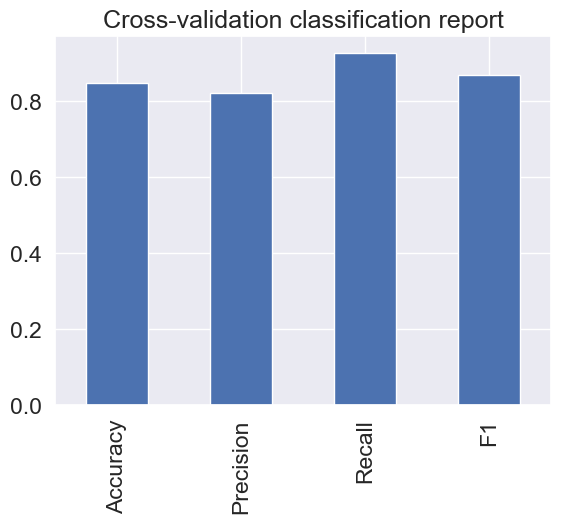

In [117]:
cross_val_report(rs_cat)
cv_metrics=pd.DataFrame(cv_metrics,
                       index=[0])
cv_metrics.T.plot.bar(title="Cross-validation classification report",
                      legend = False)

## Now We Will Use Voting classifier to get better perdiction

In [143]:
voting_clf = VotingClassifier(estimators=[('lr', gs_log_reg), ('rf', rs_rf), ('cat', rs_cat),('xg',gs_xg)], voting='soft', weights=[2, 1, 1, 1])
voting_clf.fit(x_train, y_train)

Fitting 5 folds for each of 20 candidates, totalling 100 fits
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Fitting 5 folds for each of 20 candidates, totalling 100 fits
0:	learn: 0.6600348	total: 36.5ms	remaining: 14.6s
1:	learn: 0.6332663	total: 38ms	remaining: 7.56s
2:	learn: 0.6096535	total: 39.3ms	remaining: 5.19s
3:	learn: 0.5851058	total: 40.5ms	remaining: 4.01s
4:	learn: 0.5689350	total: 41.7ms	remaining: 3.3s
5:	learn: 0.5507512	total: 43ms	remaining: 2.82s
6:	learn: 0.5323118	total: 44.2ms	remaining: 2.48s
7:	learn: 0.5176187	total: 45.4ms	remaining: 2.23s
8:	learn: 0.5048021	total: 46.6ms	remaining: 2.03s
9:	learn: 0.4926383	total: 47.8ms	remaining: 1.86s
10:	learn: 0.4818162	total: 49ms	remaining: 1.73s
11:	learn: 0.4721748	total: 50.2ms	remaining: 1.62s
12:	learn: 0.4627839	total: 51.4ms	remaining: 1.53s
13:	learn: 0.4550882	total: 52.6ms	remaining: 1.45s
14:	learn: 0.4478135	total: 53.8ms	remaining: 1.38s
15:	learn: 0.4404572	total: 55.1ms	remaining: 1.32s

289:	learn: 0.1399055	total: 408ms	remaining: 155ms
290:	learn: 0.1394456	total: 410ms	remaining: 153ms
291:	learn: 0.1391875	total: 411ms	remaining: 152ms
292:	learn: 0.1389369	total: 412ms	remaining: 150ms
293:	learn: 0.1385618	total: 413ms	remaining: 149ms
294:	learn: 0.1381023	total: 414ms	remaining: 148ms
295:	learn: 0.1379015	total: 416ms	remaining: 146ms
296:	learn: 0.1373697	total: 417ms	remaining: 145ms
297:	learn: 0.1370019	total: 418ms	remaining: 143ms
298:	learn: 0.1366229	total: 419ms	remaining: 142ms
299:	learn: 0.1362662	total: 421ms	remaining: 140ms
300:	learn: 0.1358730	total: 422ms	remaining: 139ms
301:	learn: 0.1353575	total: 423ms	remaining: 137ms
302:	learn: 0.1350744	total: 424ms	remaining: 136ms
303:	learn: 0.1348220	total: 425ms	remaining: 134ms
304:	learn: 0.1344724	total: 427ms	remaining: 133ms
305:	learn: 0.1337648	total: 428ms	remaining: 131ms
306:	learn: 0.1334082	total: 429ms	remaining: 130ms
307:	learn: 0.1332082	total: 430ms	remaining: 129ms
308:	learn: 

53:	learn: 0.3293909	total: 99.6ms	remaining: 638ms
54:	learn: 0.3271840	total: 101ms	remaining: 634ms
55:	learn: 0.3251206	total: 102ms	remaining: 628ms
56:	learn: 0.3233618	total: 103ms	remaining: 623ms
57:	learn: 0.3215971	total: 105ms	remaining: 617ms
58:	learn: 0.3196528	total: 106ms	remaining: 612ms
59:	learn: 0.3183015	total: 107ms	remaining: 607ms
60:	learn: 0.3165727	total: 108ms	remaining: 602ms
61:	learn: 0.3150313	total: 110ms	remaining: 597ms
62:	learn: 0.3133882	total: 111ms	remaining: 592ms
63:	learn: 0.3116281	total: 112ms	remaining: 588ms
64:	learn: 0.3095122	total: 113ms	remaining: 583ms
65:	learn: 0.3082694	total: 114ms	remaining: 579ms
66:	learn: 0.3070525	total: 116ms	remaining: 575ms
67:	learn: 0.3047754	total: 117ms	remaining: 571ms
68:	learn: 0.3028902	total: 118ms	remaining: 567ms
69:	learn: 0.3013531	total: 119ms	remaining: 562ms
70:	learn: 0.2997974	total: 121ms	remaining: 559ms
71:	learn: 0.2986375	total: 122ms	remaining: 555ms
72:	learn: 0.2972332	total: 12

359:	learn: 0.1330946	total: 474ms	remaining: 52.7ms
360:	learn: 0.1329150	total: 475ms	remaining: 51.3ms
361:	learn: 0.1326969	total: 477ms	remaining: 50ms
362:	learn: 0.1323639	total: 478ms	remaining: 48.7ms
363:	learn: 0.1320056	total: 479ms	remaining: 47.4ms
364:	learn: 0.1319004	total: 480ms	remaining: 46ms
365:	learn: 0.1316798	total: 481ms	remaining: 44.7ms
366:	learn: 0.1315535	total: 483ms	remaining: 43.4ms
367:	learn: 0.1312785	total: 484ms	remaining: 42.1ms
368:	learn: 0.1309928	total: 485ms	remaining: 40.8ms
369:	learn: 0.1308399	total: 486ms	remaining: 39.4ms
370:	learn: 0.1305077	total: 488ms	remaining: 38.1ms
371:	learn: 0.1299088	total: 489ms	remaining: 36.8ms
372:	learn: 0.1295738	total: 490ms	remaining: 35.5ms
373:	learn: 0.1292059	total: 491ms	remaining: 34.2ms
374:	learn: 0.1290681	total: 493ms	remaining: 32.8ms
375:	learn: 0.1287602	total: 494ms	remaining: 31.5ms
376:	learn: 0.1286546	total: 495ms	remaining: 30.2ms
377:	learn: 0.1285654	total: 497ms	remaining: 28.9

134:	learn: 0.2379139	total: 179ms	remaining: 352ms
135:	learn: 0.2374557	total: 181ms	remaining: 351ms
136:	learn: 0.2367385	total: 182ms	remaining: 349ms
137:	learn: 0.2361671	total: 183ms	remaining: 348ms
138:	learn: 0.2357118	total: 184ms	remaining: 346ms
139:	learn: 0.2350449	total: 186ms	remaining: 345ms
140:	learn: 0.2342460	total: 187ms	remaining: 343ms
141:	learn: 0.2338248	total: 188ms	remaining: 342ms
142:	learn: 0.2328939	total: 189ms	remaining: 340ms
143:	learn: 0.2319172	total: 190ms	remaining: 339ms
144:	learn: 0.2316302	total: 192ms	remaining: 337ms
145:	learn: 0.2307675	total: 193ms	remaining: 336ms
146:	learn: 0.2306587	total: 194ms	remaining: 334ms
147:	learn: 0.2302201	total: 195ms	remaining: 333ms
148:	learn: 0.2294056	total: 197ms	remaining: 331ms
149:	learn: 0.2283600	total: 198ms	remaining: 330ms
150:	learn: 0.2282454	total: 199ms	remaining: 328ms
151:	learn: 0.2277486	total: 200ms	remaining: 327ms
152:	learn: 0.2268134	total: 201ms	remaining: 325ms
153:	learn: 

[CV] END bagging_temperature=1.3, depth=2, l2_leaf_reg=4, learning_rate=0.05, n_estimators=400, random_strength=0.0; total time=   1.0s
0:	learn: 0.6723701	total: 1.32ms	remaining: 526ms
1:	learn: 0.6508811	total: 2.49ms	remaining: 496ms
2:	learn: 0.6322378	total: 3.74ms	remaining: 495ms
3:	learn: 0.6146280	total: 4.98ms	remaining: 493ms
4:	learn: 0.5980885	total: 6.21ms	remaining: 491ms
5:	learn: 0.5850991	total: 7.46ms	remaining: 490ms
6:	learn: 0.5718901	total: 8.66ms	remaining: 486ms
7:	learn: 0.5595461	total: 9.87ms	remaining: 483ms
8:	learn: 0.5476750	total: 11.1ms	remaining: 481ms
9:	learn: 0.5357936	total: 12.3ms	remaining: 482ms
10:	learn: 0.5266766	total: 13.7ms	remaining: 483ms
11:	learn: 0.5142529	total: 14.9ms	remaining: 483ms
12:	learn: 0.5055834	total: 16.3ms	remaining: 486ms
13:	learn: 0.4965615	total: 17.7ms	remaining: 487ms
14:	learn: 0.4885711	total: 19ms	remaining: 487ms
15:	learn: 0.4821785	total: 20.3ms	remaining: 488ms
16:	learn: 0.4735525	total: 21.6ms	remaining

234:	learn: 0.1911965	total: 292ms	remaining: 205ms
235:	learn: 0.1910099	total: 293ms	remaining: 204ms
236:	learn: 0.1909089	total: 294ms	remaining: 202ms
237:	learn: 0.1903459	total: 296ms	remaining: 201ms
238:	learn: 0.1895632	total: 297ms	remaining: 200ms
239:	learn: 0.1888877	total: 298ms	remaining: 199ms
240:	learn: 0.1882845	total: 299ms	remaining: 198ms
241:	learn: 0.1877286	total: 301ms	remaining: 196ms
242:	learn: 0.1876188	total: 302ms	remaining: 195ms
243:	learn: 0.1872039	total: 303ms	remaining: 194ms
244:	learn: 0.1865647	total: 305ms	remaining: 193ms
245:	learn: 0.1858908	total: 306ms	remaining: 191ms
246:	learn: 0.1855647	total: 307ms	remaining: 190ms
247:	learn: 0.1850694	total: 308ms	remaining: 189ms
248:	learn: 0.1849089	total: 310ms	remaining: 188ms
249:	learn: 0.1847566	total: 311ms	remaining: 187ms
250:	learn: 0.1842832	total: 312ms	remaining: 185ms
251:	learn: 0.1840887	total: 313ms	remaining: 184ms
252:	learn: 0.1836419	total: 315ms	remaining: 183ms
253:	learn: 

0:	learn: 0.6692912	total: 1.4ms	remaining: 558ms
1:	learn: 0.6466515	total: 2.89ms	remaining: 575ms
2:	learn: 0.6282678	total: 4.22ms	remaining: 559ms
3:	learn: 0.6096976	total: 5.52ms	remaining: 546ms
4:	learn: 0.5932527	total: 6.82ms	remaining: 539ms
5:	learn: 0.5777996	total: 8.1ms	remaining: 532ms
6:	learn: 0.5626662	total: 9.39ms	remaining: 527ms
7:	learn: 0.5493926	total: 10.7ms	remaining: 522ms
8:	learn: 0.5362071	total: 11.9ms	remaining: 517ms
9:	learn: 0.5247379	total: 13.2ms	remaining: 514ms
10:	learn: 0.5139628	total: 14.5ms	remaining: 511ms
11:	learn: 0.5035048	total: 15.8ms	remaining: 510ms
12:	learn: 0.4946888	total: 17.1ms	remaining: 509ms
13:	learn: 0.4865374	total: 18.4ms	remaining: 509ms
14:	learn: 0.4772084	total: 19.8ms	remaining: 508ms
15:	learn: 0.4688276	total: 21.1ms	remaining: 507ms
16:	learn: 0.4620993	total: 22.5ms	remaining: 506ms
17:	learn: 0.4542033	total: 23.8ms	remaining: 505ms
18:	learn: 0.4472970	total: 25.1ms	remaining: 503ms
19:	learn: 0.4414458	tot

308:	learn: 0.1726609	total: 378ms	remaining: 111ms
309:	learn: 0.1725976	total: 379ms	remaining: 110ms
310:	learn: 0.1720422	total: 380ms	remaining: 109ms
311:	learn: 0.1718993	total: 381ms	remaining: 108ms
312:	learn: 0.1717637	total: 383ms	remaining: 106ms
313:	learn: 0.1717002	total: 384ms	remaining: 105ms
314:	learn: 0.1711517	total: 385ms	remaining: 104ms
315:	learn: 0.1706250	total: 386ms	remaining: 103ms
316:	learn: 0.1698488	total: 387ms	remaining: 101ms
317:	learn: 0.1696430	total: 389ms	remaining: 100ms
318:	learn: 0.1693582	total: 390ms	remaining: 99ms
319:	learn: 0.1687184	total: 391ms	remaining: 97.8ms
320:	learn: 0.1686562	total: 392ms	remaining: 96.6ms
321:	learn: 0.1683739	total: 394ms	remaining: 95.3ms
322:	learn: 0.1680017	total: 395ms	remaining: 94.1ms
323:	learn: 0.1676403	total: 396ms	remaining: 92.9ms
324:	learn: 0.1675794	total: 397ms	remaining: 91.7ms
325:	learn: 0.1672232	total: 398ms	remaining: 90.4ms
326:	learn: 0.1671640	total: 400ms	remaining: 89.2ms
327:	

67:	learn: 0.0464484	total: 144ms	remaining: 597ms
68:	learn: 0.0457202	total: 146ms	remaining: 596ms
69:	learn: 0.0451208	total: 148ms	remaining: 593ms
70:	learn: 0.0442817	total: 150ms	remaining: 591ms
71:	learn: 0.0431766	total: 153ms	remaining: 589ms
72:	learn: 0.0424213	total: 155ms	remaining: 587ms
73:	learn: 0.0415932	total: 157ms	remaining: 585ms
74:	learn: 0.0405864	total: 159ms	remaining: 583ms
75:	learn: 0.0401760	total: 161ms	remaining: 581ms
76:	learn: 0.0395257	total: 163ms	remaining: 578ms
77:	learn: 0.0389339	total: 165ms	remaining: 576ms
78:	learn: 0.0382153	total: 167ms	remaining: 574ms
79:	learn: 0.0376506	total: 169ms	remaining: 572ms
80:	learn: 0.0369607	total: 172ms	remaining: 570ms
81:	learn: 0.0364118	total: 174ms	remaining: 568ms
82:	learn: 0.0356838	total: 176ms	remaining: 566ms
83:	learn: 0.0351141	total: 178ms	remaining: 563ms
84:	learn: 0.0343697	total: 180ms	remaining: 561ms
85:	learn: 0.0337883	total: 182ms	remaining: 559ms
86:	learn: 0.0333672	total: 184

246:	learn: 0.0088416	total: 528ms	remaining: 220ms
247:	learn: 0.0087987	total: 530ms	remaining: 218ms
248:	learn: 0.0087521	total: 532ms	remaining: 216ms
249:	learn: 0.0087046	total: 534ms	remaining: 214ms
250:	learn: 0.0086670	total: 536ms	remaining: 212ms
251:	learn: 0.0086210	total: 539ms	remaining: 209ms
252:	learn: 0.0085835	total: 541ms	remaining: 207ms
253:	learn: 0.0085422	total: 543ms	remaining: 205ms
254:	learn: 0.0085022	total: 545ms	remaining: 203ms
255:	learn: 0.0084616	total: 547ms	remaining: 201ms
256:	learn: 0.0084243	total: 549ms	remaining: 199ms
257:	learn: 0.0083849	total: 551ms	remaining: 197ms
258:	learn: 0.0083415	total: 554ms	remaining: 194ms
259:	learn: 0.0083064	total: 556ms	remaining: 192ms
260:	learn: 0.0082747	total: 558ms	remaining: 190ms
261:	learn: 0.0082336	total: 560ms	remaining: 188ms
262:	learn: 0.0082008	total: 562ms	remaining: 186ms
263:	learn: 0.0081531	total: 564ms	remaining: 184ms
264:	learn: 0.0081176	total: 566ms	remaining: 182ms
265:	learn: 

55:	learn: 0.0661516	total: 117ms	remaining: 616ms
56:	learn: 0.0643822	total: 120ms	remaining: 614ms
57:	learn: 0.0625606	total: 122ms	remaining: 612ms
58:	learn: 0.0607637	total: 124ms	remaining: 610ms
59:	learn: 0.0592875	total: 126ms	remaining: 608ms
60:	learn: 0.0576958	total: 128ms	remaining: 606ms
61:	learn: 0.0564305	total: 130ms	remaining: 604ms
62:	learn: 0.0555400	total: 132ms	remaining: 602ms
63:	learn: 0.0542511	total: 134ms	remaining: 600ms
64:	learn: 0.0530642	total: 136ms	remaining: 598ms
65:	learn: 0.0518116	total: 138ms	remaining: 596ms
66:	learn: 0.0501698	total: 141ms	remaining: 594ms
67:	learn: 0.0493187	total: 143ms	remaining: 592ms
68:	learn: 0.0482024	total: 145ms	remaining: 590ms
69:	learn: 0.0471804	total: 147ms	remaining: 588ms
70:	learn: 0.0460917	total: 149ms	remaining: 585ms
71:	learn: 0.0450837	total: 151ms	remaining: 583ms
72:	learn: 0.0443184	total: 153ms	remaining: 581ms
73:	learn: 0.0432633	total: 155ms	remaining: 579ms
74:	learn: 0.0424182	total: 157

232:	learn: 0.0093796	total: 501ms	remaining: 252ms
233:	learn: 0.0093311	total: 503ms	remaining: 250ms
234:	learn: 0.0092780	total: 506ms	remaining: 247ms
235:	learn: 0.0092236	total: 508ms	remaining: 245ms
236:	learn: 0.0091742	total: 510ms	remaining: 243ms
237:	learn: 0.0091350	total: 512ms	remaining: 241ms
238:	learn: 0.0090870	total: 514ms	remaining: 239ms
239:	learn: 0.0090421	total: 516ms	remaining: 236ms
240:	learn: 0.0090046	total: 518ms	remaining: 234ms
241:	learn: 0.0089582	total: 520ms	remaining: 232ms
242:	learn: 0.0089239	total: 522ms	remaining: 230ms
243:	learn: 0.0088786	total: 524ms	remaining: 228ms
244:	learn: 0.0088460	total: 526ms	remaining: 226ms
245:	learn: 0.0087881	total: 528ms	remaining: 223ms
246:	learn: 0.0087528	total: 530ms	remaining: 221ms
247:	learn: 0.0086987	total: 533ms	remaining: 219ms
248:	learn: 0.0086502	total: 535ms	remaining: 217ms
249:	learn: 0.0086118	total: 537ms	remaining: 215ms
250:	learn: 0.0085631	total: 539ms	remaining: 213ms
251:	learn: 

65:	learn: 0.0590814	total: 139ms	remaining: 600ms
66:	learn: 0.0577797	total: 142ms	remaining: 598ms
67:	learn: 0.0560717	total: 144ms	remaining: 596ms
68:	learn: 0.0551299	total: 146ms	remaining: 594ms
69:	learn: 0.0540213	total: 148ms	remaining: 592ms
70:	learn: 0.0527544	total: 150ms	remaining: 590ms
71:	learn: 0.0517327	total: 152ms	remaining: 588ms
72:	learn: 0.0505795	total: 154ms	remaining: 586ms
73:	learn: 0.0496184	total: 157ms	remaining: 584ms
74:	learn: 0.0487168	total: 159ms	remaining: 582ms
75:	learn: 0.0475887	total: 161ms	remaining: 580ms
76:	learn: 0.0465172	total: 163ms	remaining: 578ms
77:	learn: 0.0454473	total: 165ms	remaining: 576ms
78:	learn: 0.0446605	total: 167ms	remaining: 574ms
79:	learn: 0.0438198	total: 170ms	remaining: 572ms
80:	learn: 0.0430419	total: 172ms	remaining: 570ms
81:	learn: 0.0422972	total: 174ms	remaining: 568ms
82:	learn: 0.0413957	total: 176ms	remaining: 566ms
83:	learn: 0.0406824	total: 178ms	remaining: 564ms
84:	learn: 0.0399917	total: 180

245:	learn: 0.0102923	total: 522ms	remaining: 221ms
246:	learn: 0.0102333	total: 524ms	remaining: 219ms
247:	learn: 0.0101866	total: 526ms	remaining: 217ms
248:	learn: 0.0101611	total: 528ms	remaining: 214ms
249:	learn: 0.0100882	total: 531ms	remaining: 212ms
250:	learn: 0.0100217	total: 533ms	remaining: 210ms
251:	learn: 0.0099723	total: 535ms	remaining: 208ms
252:	learn: 0.0099374	total: 537ms	remaining: 206ms
253:	learn: 0.0098966	total: 539ms	remaining: 204ms
254:	learn: 0.0098567	total: 541ms	remaining: 202ms
255:	learn: 0.0098244	total: 543ms	remaining: 200ms
256:	learn: 0.0098022	total: 545ms	remaining: 197ms
257:	learn: 0.0097595	total: 548ms	remaining: 195ms
258:	learn: 0.0097188	total: 550ms	remaining: 193ms
259:	learn: 0.0096645	total: 552ms	remaining: 191ms
260:	learn: 0.0096174	total: 554ms	remaining: 189ms
261:	learn: 0.0095610	total: 556ms	remaining: 187ms
262:	learn: 0.0094920	total: 558ms	remaining: 185ms
263:	learn: 0.0094346	total: 560ms	remaining: 183ms
264:	learn: 

86:	learn: 0.0398846	total: 183ms	remaining: 552ms
87:	learn: 0.0391880	total: 185ms	remaining: 550ms
88:	learn: 0.0383010	total: 187ms	remaining: 548ms
89:	learn: 0.0375865	total: 189ms	remaining: 546ms
90:	learn: 0.0370042	total: 191ms	remaining: 544ms
91:	learn: 0.0364365	total: 193ms	remaining: 542ms
92:	learn: 0.0362417	total: 195ms	remaining: 540ms
93:	learn: 0.0354146	total: 197ms	remaining: 538ms
94:	learn: 0.0349162	total: 200ms	remaining: 536ms
95:	learn: 0.0344030	total: 202ms	remaining: 534ms
96:	learn: 0.0339451	total: 204ms	remaining: 531ms
97:	learn: 0.0334707	total: 206ms	remaining: 529ms
98:	learn: 0.0329842	total: 208ms	remaining: 527ms
99:	learn: 0.0325572	total: 210ms	remaining: 525ms
100:	learn: 0.0321978	total: 212ms	remaining: 523ms
101:	learn: 0.0316341	total: 214ms	remaining: 521ms
102:	learn: 0.0310842	total: 216ms	remaining: 519ms
103:	learn: 0.0306872	total: 218ms	remaining: 517ms
104:	learn: 0.0302505	total: 221ms	remaining: 515ms
105:	learn: 0.0298624	tota

266:	learn: 0.0092470	total: 564ms	remaining: 175ms
267:	learn: 0.0092064	total: 566ms	remaining: 173ms
268:	learn: 0.0091659	total: 568ms	remaining: 171ms
269:	learn: 0.0091343	total: 570ms	remaining: 169ms
270:	learn: 0.0090971	total: 572ms	remaining: 167ms
271:	learn: 0.0090574	total: 575ms	remaining: 165ms
272:	learn: 0.0089931	total: 577ms	remaining: 163ms
273:	learn: 0.0089556	total: 579ms	remaining: 161ms
274:	learn: 0.0089012	total: 581ms	remaining: 158ms
275:	learn: 0.0088542	total: 583ms	remaining: 156ms
276:	learn: 0.0087983	total: 585ms	remaining: 154ms
277:	learn: 0.0087620	total: 587ms	remaining: 152ms
278:	learn: 0.0087269	total: 589ms	remaining: 150ms
279:	learn: 0.0086863	total: 591ms	remaining: 148ms
280:	learn: 0.0086563	total: 593ms	remaining: 146ms
281:	learn: 0.0086205	total: 595ms	remaining: 144ms
282:	learn: 0.0085869	total: 597ms	remaining: 141ms
283:	learn: 0.0085579	total: 599ms	remaining: 139ms
284:	learn: 0.0085296	total: 602ms	remaining: 137ms
285:	learn: 

71:	learn: 0.0510628	total: 151ms	remaining: 584ms
72:	learn: 0.0500384	total: 153ms	remaining: 582ms
73:	learn: 0.0489738	total: 155ms	remaining: 580ms
74:	learn: 0.0478509	total: 157ms	remaining: 577ms
75:	learn: 0.0468218	total: 160ms	remaining: 575ms
76:	learn: 0.0458360	total: 162ms	remaining: 573ms
77:	learn: 0.0449703	total: 164ms	remaining: 571ms
78:	learn: 0.0442340	total: 166ms	remaining: 569ms
79:	learn: 0.0433463	total: 168ms	remaining: 567ms
80:	learn: 0.0424282	total: 170ms	remaining: 565ms
81:	learn: 0.0417570	total: 172ms	remaining: 563ms
82:	learn: 0.0410888	total: 174ms	remaining: 560ms
83:	learn: 0.0407302	total: 176ms	remaining: 558ms
84:	learn: 0.0402084	total: 178ms	remaining: 556ms
85:	learn: 0.0395289	total: 180ms	remaining: 554ms
86:	learn: 0.0389399	total: 183ms	remaining: 552ms
87:	learn: 0.0382401	total: 185ms	remaining: 551ms
88:	learn: 0.0375486	total: 187ms	remaining: 549ms
89:	learn: 0.0369943	total: 189ms	remaining: 546ms
90:	learn: 0.0363888	total: 191

251:	learn: 0.0092344	total: 533ms	remaining: 207ms
252:	learn: 0.0091799	total: 536ms	remaining: 205ms
253:	learn: 0.0091478	total: 538ms	remaining: 203ms
254:	learn: 0.0091070	total: 540ms	remaining: 201ms
255:	learn: 0.0090566	total: 542ms	remaining: 199ms
256:	learn: 0.0090247	total: 544ms	remaining: 197ms
257:	learn: 0.0089790	total: 546ms	remaining: 195ms
258:	learn: 0.0089518	total: 548ms	remaining: 193ms
259:	learn: 0.0089124	total: 550ms	remaining: 190ms
260:	learn: 0.0088738	total: 552ms	remaining: 188ms
261:	learn: 0.0088401	total: 554ms	remaining: 186ms
262:	learn: 0.0087999	total: 556ms	remaining: 184ms
263:	learn: 0.0087720	total: 559ms	remaining: 182ms
264:	learn: 0.0087264	total: 561ms	remaining: 180ms
265:	learn: 0.0086849	total: 563ms	remaining: 178ms
266:	learn: 0.0086227	total: 565ms	remaining: 176ms
267:	learn: 0.0085956	total: 567ms	remaining: 173ms
268:	learn: 0.0085584	total: 569ms	remaining: 171ms
269:	learn: 0.0085403	total: 571ms	remaining: 169ms
270:	learn: 

134:	learn: 0.0138301	total: 192ms	remaining: 378ms
135:	learn: 0.0135301	total: 194ms	remaining: 377ms
136:	learn: 0.0132118	total: 195ms	remaining: 375ms
137:	learn: 0.0129086	total: 197ms	remaining: 374ms
138:	learn: 0.0127254	total: 198ms	remaining: 372ms
139:	learn: 0.0125527	total: 200ms	remaining: 371ms
140:	learn: 0.0123945	total: 201ms	remaining: 369ms
141:	learn: 0.0121001	total: 203ms	remaining: 368ms
142:	learn: 0.0117994	total: 204ms	remaining: 366ms
143:	learn: 0.0117387	total: 205ms	remaining: 365ms
144:	learn: 0.0115972	total: 207ms	remaining: 364ms
145:	learn: 0.0114505	total: 208ms	remaining: 362ms
146:	learn: 0.0113133	total: 210ms	remaining: 361ms
147:	learn: 0.0111487	total: 211ms	remaining: 359ms
148:	learn: 0.0110309	total: 212ms	remaining: 358ms
149:	learn: 0.0109571	total: 214ms	remaining: 356ms
150:	learn: 0.0107713	total: 215ms	remaining: 355ms
151:	learn: 0.0107121	total: 217ms	remaining: 354ms
152:	learn: 0.0106554	total: 218ms	remaining: 352ms
153:	learn: 

[CV] END bagging_temperature=0.4, depth=4, l2_leaf_reg=3, learning_rate=0.2, n_estimators=400, random_strength=0.7000000000000001; total time=   0.7s
0:	learn: 0.5376537	total: 1.54ms	remaining: 614ms
1:	learn: 0.4862724	total: 2.96ms	remaining: 588ms
2:	learn: 0.4298890	total: 4.36ms	remaining: 577ms
3:	learn: 0.3889519	total: 5.77ms	remaining: 572ms
4:	learn: 0.3560697	total: 7.21ms	remaining: 570ms
5:	learn: 0.3356130	total: 8.62ms	remaining: 566ms
6:	learn: 0.3194787	total: 10ms	remaining: 563ms
7:	learn: 0.3028558	total: 11.4ms	remaining: 561ms
8:	learn: 0.2840447	total: 12.8ms	remaining: 558ms
9:	learn: 0.2758926	total: 14.2ms	remaining: 555ms
10:	learn: 0.2660055	total: 15.7ms	remaining: 554ms
11:	learn: 0.2565353	total: 17ms	remaining: 551ms
12:	learn: 0.2439813	total: 18.5ms	remaining: 550ms
13:	learn: 0.2340770	total: 19.9ms	remaining: 548ms
14:	learn: 0.2265247	total: 21.3ms	remaining: 546ms
15:	learn: 0.2136339	total: 22.7ms	remaining: 546ms
16:	learn: 0.2037290	total: 24.2

227:	learn: 0.0077932	total: 327ms	remaining: 247ms
228:	learn: 0.0077146	total: 329ms	remaining: 246ms
229:	learn: 0.0076524	total: 330ms	remaining: 244ms
230:	learn: 0.0075989	total: 332ms	remaining: 243ms
231:	learn: 0.0075227	total: 333ms	remaining: 241ms
232:	learn: 0.0074610	total: 335ms	remaining: 240ms
233:	learn: 0.0073986	total: 336ms	remaining: 238ms
234:	learn: 0.0073242	total: 338ms	remaining: 237ms
235:	learn: 0.0072833	total: 339ms	remaining: 236ms
236:	learn: 0.0072463	total: 340ms	remaining: 234ms
237:	learn: 0.0071555	total: 342ms	remaining: 233ms
238:	learn: 0.0071123	total: 343ms	remaining: 231ms
239:	learn: 0.0070407	total: 345ms	remaining: 230ms
240:	learn: 0.0069485	total: 346ms	remaining: 228ms
241:	learn: 0.0068585	total: 347ms	remaining: 227ms
242:	learn: 0.0068450	total: 349ms	remaining: 225ms
243:	learn: 0.0068104	total: 350ms	remaining: 224ms
244:	learn: 0.0067454	total: 352ms	remaining: 222ms
245:	learn: 0.0067144	total: 353ms	remaining: 221ms
246:	learn: 

0:	learn: 0.5774735	total: 1.75ms	remaining: 699ms
1:	learn: 0.5039392	total: 3.35ms	remaining: 668ms
2:	learn: 0.4499397	total: 4.87ms	remaining: 645ms
3:	learn: 0.4081091	total: 6.38ms	remaining: 632ms
4:	learn: 0.3827567	total: 7.87ms	remaining: 622ms
5:	learn: 0.3661324	total: 9.37ms	remaining: 615ms
6:	learn: 0.3375337	total: 10.8ms	remaining: 609ms
7:	learn: 0.3243673	total: 12.3ms	remaining: 602ms
8:	learn: 0.3042118	total: 13.8ms	remaining: 601ms
9:	learn: 0.2850687	total: 15.3ms	remaining: 599ms
10:	learn: 0.2724051	total: 16.8ms	remaining: 595ms
11:	learn: 0.2607712	total: 18.3ms	remaining: 592ms
12:	learn: 0.2535784	total: 19.8ms	remaining: 590ms
13:	learn: 0.2420713	total: 21.3ms	remaining: 586ms
14:	learn: 0.2377508	total: 22.7ms	remaining: 584ms
15:	learn: 0.2335689	total: 24.2ms	remaining: 582ms
16:	learn: 0.2235199	total: 25.7ms	remaining: 580ms
17:	learn: 0.2182858	total: 27.2ms	remaining: 578ms
18:	learn: 0.2045219	total: 28.7ms	remaining: 576ms
19:	learn: 0.1960056	t

265:	learn: 0.0075382	total: 377ms	remaining: 190ms
266:	learn: 0.0074762	total: 378ms	remaining: 188ms
267:	learn: 0.0073496	total: 380ms	remaining: 187ms
268:	learn: 0.0072688	total: 381ms	remaining: 186ms
269:	learn: 0.0072354	total: 383ms	remaining: 184ms
270:	learn: 0.0071798	total: 384ms	remaining: 183ms
271:	learn: 0.0070912	total: 385ms	remaining: 181ms
272:	learn: 0.0070848	total: 387ms	remaining: 180ms
273:	learn: 0.0070302	total: 388ms	remaining: 179ms
274:	learn: 0.0069587	total: 390ms	remaining: 177ms
275:	learn: 0.0069377	total: 391ms	remaining: 176ms
276:	learn: 0.0069267	total: 393ms	remaining: 174ms
277:	learn: 0.0069148	total: 394ms	remaining: 173ms
278:	learn: 0.0069126	total: 395ms	remaining: 171ms
279:	learn: 0.0069125	total: 396ms	remaining: 170ms
280:	learn: 0.0068919	total: 398ms	remaining: 168ms
281:	learn: 0.0068347	total: 407ms	remaining: 170ms
282:	learn: 0.0067918	total: 409ms	remaining: 169ms
283:	learn: 0.0067778	total: 410ms	remaining: 167ms
284:	learn: 

100:	learn: 0.0277775	total: 144ms	remaining: 426ms
101:	learn: 0.0273458	total: 146ms	remaining: 425ms
102:	learn: 0.0272958	total: 147ms	remaining: 424ms
103:	learn: 0.0267788	total: 149ms	remaining: 423ms
104:	learn: 0.0264185	total: 150ms	remaining: 421ms
105:	learn: 0.0256693	total: 151ms	remaining: 420ms
106:	learn: 0.0254909	total: 153ms	remaining: 419ms
107:	learn: 0.0249790	total: 154ms	remaining: 417ms
108:	learn: 0.0245467	total: 156ms	remaining: 416ms
109:	learn: 0.0245150	total: 157ms	remaining: 414ms
110:	learn: 0.0244427	total: 159ms	remaining: 413ms
111:	learn: 0.0243974	total: 160ms	remaining: 412ms
112:	learn: 0.0242441	total: 162ms	remaining: 410ms
113:	learn: 0.0242067	total: 163ms	remaining: 409ms
114:	learn: 0.0238285	total: 165ms	remaining: 408ms
115:	learn: 0.0235924	total: 166ms	remaining: 406ms
116:	learn: 0.0231766	total: 168ms	remaining: 405ms
117:	learn: 0.0226492	total: 169ms	remaining: 404ms
118:	learn: 0.0223861	total: 171ms	remaining: 403ms
119:	learn: 

361:	learn: 0.0052580	total: 519ms	remaining: 54.5ms
362:	learn: 0.0052545	total: 521ms	remaining: 53.1ms
363:	learn: 0.0052545	total: 522ms	remaining: 51.7ms
364:	learn: 0.0052544	total: 524ms	remaining: 50.2ms
365:	learn: 0.0052496	total: 525ms	remaining: 48.8ms
366:	learn: 0.0052496	total: 526ms	remaining: 47.3ms
367:	learn: 0.0052495	total: 527ms	remaining: 45.8ms
368:	learn: 0.0052295	total: 529ms	remaining: 44.4ms
369:	learn: 0.0051703	total: 530ms	remaining: 43ms
370:	learn: 0.0051442	total: 531ms	remaining: 41.5ms
371:	learn: 0.0051432	total: 533ms	remaining: 40.1ms
372:	learn: 0.0051433	total: 534ms	remaining: 38.6ms
373:	learn: 0.0051310	total: 535ms	remaining: 37.2ms
374:	learn: 0.0051306	total: 536ms	remaining: 35.8ms
375:	learn: 0.0051305	total: 538ms	remaining: 34.3ms
376:	learn: 0.0051304	total: 539ms	remaining: 32.9ms
377:	learn: 0.0051305	total: 540ms	remaining: 31.4ms
378:	learn: 0.0051303	total: 541ms	remaining: 30ms
379:	learn: 0.0051231	total: 542ms	remaining: 28.5

235:	learn: 0.0101719	total: 335ms	remaining: 233ms
236:	learn: 0.0101047	total: 337ms	remaining: 232ms
237:	learn: 0.0101046	total: 338ms	remaining: 230ms
238:	learn: 0.0100504	total: 340ms	remaining: 229ms
239:	learn: 0.0099825	total: 341ms	remaining: 227ms
240:	learn: 0.0099035	total: 342ms	remaining: 226ms
241:	learn: 0.0098351	total: 344ms	remaining: 224ms
242:	learn: 0.0097548	total: 345ms	remaining: 223ms
243:	learn: 0.0096328	total: 347ms	remaining: 222ms
244:	learn: 0.0095702	total: 348ms	remaining: 220ms
245:	learn: 0.0095018	total: 350ms	remaining: 219ms
246:	learn: 0.0093414	total: 351ms	remaining: 217ms
247:	learn: 0.0091719	total: 352ms	remaining: 216ms
248:	learn: 0.0090691	total: 354ms	remaining: 215ms
249:	learn: 0.0089212	total: 355ms	remaining: 213ms
250:	learn: 0.0088967	total: 357ms	remaining: 212ms
251:	learn: 0.0088789	total: 358ms	remaining: 210ms
252:	learn: 0.0088268	total: 359ms	remaining: 209ms
253:	learn: 0.0087987	total: 361ms	remaining: 207ms
254:	learn: 

0:	learn: 0.5291962	total: 1.7ms	remaining: 423ms
1:	learn: 0.4588575	total: 3.43ms	remaining: 426ms
2:	learn: 0.4114120	total: 4.98ms	remaining: 410ms
3:	learn: 0.3913591	total: 6.52ms	remaining: 401ms
4:	learn: 0.3569005	total: 8.06ms	remaining: 395ms
5:	learn: 0.3236380	total: 9.57ms	remaining: 389ms
6:	learn: 0.3067862	total: 11.1ms	remaining: 386ms
7:	learn: 0.2834755	total: 12.6ms	remaining: 382ms
8:	learn: 0.2622854	total: 14.2ms	remaining: 379ms
9:	learn: 0.2337706	total: 15.7ms	remaining: 376ms
10:	learn: 0.2206225	total: 17.2ms	remaining: 373ms
11:	learn: 0.2159469	total: 18.7ms	remaining: 371ms
12:	learn: 0.2034415	total: 20.2ms	remaining: 369ms
13:	learn: 0.1912539	total: 21.8ms	remaining: 367ms
14:	learn: 0.1788583	total: 23.3ms	remaining: 365ms
15:	learn: 0.1747119	total: 24.9ms	remaining: 363ms
16:	learn: 0.1713919	total: 26.4ms	remaining: 361ms
17:	learn: 0.1642107	total: 27.9ms	remaining: 360ms
18:	learn: 0.1535685	total: 29.4ms	remaining: 358ms
19:	learn: 0.1435861	to

242:	learn: 0.0055794	total: 377ms	remaining: 10.9ms
243:	learn: 0.0055504	total: 379ms	remaining: 9.32ms
244:	learn: 0.0055152	total: 381ms	remaining: 7.77ms
245:	learn: 0.0054836	total: 382ms	remaining: 6.21ms
246:	learn: 0.0054497	total: 384ms	remaining: 4.66ms
247:	learn: 0.0054253	total: 385ms	remaining: 3.11ms
248:	learn: 0.0053981	total: 387ms	remaining: 1.55ms
249:	learn: 0.0053751	total: 389ms	remaining: 0us
[CV] END bagging_temperature=0.5, depth=5, l2_leaf_reg=6, learning_rate=0.25, n_estimators=250, random_strength=1.1; total time=   0.5s
0:	learn: 0.5318967	total: 1.74ms	remaining: 433ms
1:	learn: 0.4640519	total: 3.26ms	remaining: 405ms
2:	learn: 0.4079408	total: 4.78ms	remaining: 394ms
3:	learn: 0.3593160	total: 6.3ms	remaining: 387ms
4:	learn: 0.3219869	total: 7.8ms	remaining: 382ms
5:	learn: 0.2958179	total: 9.3ms	remaining: 378ms
6:	learn: 0.2818957	total: 10.8ms	remaining: 375ms
7:	learn: 0.2635899	total: 12.3ms	remaining: 372ms
8:	learn: 0.2503414	total: 13.8ms	rema

[CV] END bagging_temperature=0.5, depth=5, l2_leaf_reg=6, learning_rate=0.25, n_estimators=250, random_strength=1.1; total time=   0.5s
0:	learn: 0.5362047	total: 1.65ms	remaining: 412ms
1:	learn: 0.4609271	total: 3.19ms	remaining: 395ms
2:	learn: 0.4109166	total: 4.72ms	remaining: 388ms
3:	learn: 0.3773765	total: 6.25ms	remaining: 385ms
4:	learn: 0.3416036	total: 7.78ms	remaining: 381ms
5:	learn: 0.3195190	total: 9.31ms	remaining: 379ms
6:	learn: 0.3054001	total: 10.9ms	remaining: 377ms
7:	learn: 0.2815954	total: 12.4ms	remaining: 375ms
8:	learn: 0.2655011	total: 13.9ms	remaining: 372ms
9:	learn: 0.2553142	total: 15.4ms	remaining: 369ms
10:	learn: 0.2380852	total: 16.9ms	remaining: 368ms
11:	learn: 0.2272924	total: 18.5ms	remaining: 366ms
12:	learn: 0.2219959	total: 20ms	remaining: 365ms
13:	learn: 0.2053529	total: 21.5ms	remaining: 363ms
14:	learn: 0.1961780	total: 23ms	remaining: 361ms
15:	learn: 0.1912500	total: 24.6ms	remaining: 360ms
16:	learn: 0.1870779	total: 26.2ms	remaining: 

214:	learn: 0.0086878	total: 331ms	remaining: 53.9ms
215:	learn: 0.0086724	total: 333ms	remaining: 52.4ms
216:	learn: 0.0086234	total: 335ms	remaining: 50.9ms
217:	learn: 0.0085725	total: 336ms	remaining: 49.3ms
218:	learn: 0.0085176	total: 338ms	remaining: 47.8ms
219:	learn: 0.0084196	total: 339ms	remaining: 46.3ms
220:	learn: 0.0083558	total: 341ms	remaining: 44.7ms
221:	learn: 0.0082842	total: 342ms	remaining: 43.2ms
222:	learn: 0.0082087	total: 344ms	remaining: 41.6ms
223:	learn: 0.0081556	total: 345ms	remaining: 40.1ms
224:	learn: 0.0081557	total: 347ms	remaining: 38.5ms
225:	learn: 0.0081105	total: 348ms	remaining: 37ms
226:	learn: 0.0080894	total: 350ms	remaining: 35.4ms
227:	learn: 0.0080352	total: 351ms	remaining: 33.9ms
228:	learn: 0.0079342	total: 353ms	remaining: 32.3ms
229:	learn: 0.0079137	total: 354ms	remaining: 30.8ms
230:	learn: 0.0078772	total: 356ms	remaining: 29.3ms
231:	learn: 0.0078328	total: 357ms	remaining: 27.7ms
232:	learn: 0.0077516	total: 359ms	remaining: 26

209:	learn: 0.0090780	total: 323ms	remaining: 61.5ms
210:	learn: 0.0089943	total: 325ms	remaining: 60ms
211:	learn: 0.0088995	total: 326ms	remaining: 58.5ms
212:	learn: 0.0088372	total: 328ms	remaining: 56.9ms
213:	learn: 0.0087942	total: 329ms	remaining: 55.4ms
214:	learn: 0.0087145	total: 331ms	remaining: 53.9ms
215:	learn: 0.0086851	total: 333ms	remaining: 52.3ms
216:	learn: 0.0086238	total: 334ms	remaining: 50.8ms
217:	learn: 0.0085978	total: 336ms	remaining: 49.3ms
218:	learn: 0.0085326	total: 337ms	remaining: 47.7ms
219:	learn: 0.0084769	total: 339ms	remaining: 46.2ms
220:	learn: 0.0084164	total: 340ms	remaining: 44.6ms
221:	learn: 0.0083960	total: 342ms	remaining: 43.1ms
222:	learn: 0.0083895	total: 343ms	remaining: 41.6ms
223:	learn: 0.0083191	total: 345ms	remaining: 40ms
224:	learn: 0.0082725	total: 346ms	remaining: 38.5ms
225:	learn: 0.0082532	total: 348ms	remaining: 36.9ms
226:	learn: 0.0081939	total: 349ms	remaining: 35.4ms
227:	learn: 0.0081620	total: 351ms	remaining: 33.8

116:	learn: 0.0196818	total: 180ms	remaining: 204ms
117:	learn: 0.0193268	total: 182ms	remaining: 203ms
118:	learn: 0.0190778	total: 183ms	remaining: 202ms
119:	learn: 0.0188305	total: 185ms	remaining: 200ms
120:	learn: 0.0187905	total: 186ms	remaining: 198ms
121:	learn: 0.0185023	total: 188ms	remaining: 197ms
122:	learn: 0.0182548	total: 189ms	remaining: 195ms
123:	learn: 0.0180364	total: 191ms	remaining: 194ms
124:	learn: 0.0177412	total: 192ms	remaining: 192ms
125:	learn: 0.0174656	total: 194ms	remaining: 191ms
126:	learn: 0.0171880	total: 195ms	remaining: 189ms
127:	learn: 0.0168828	total: 197ms	remaining: 188ms
128:	learn: 0.0166688	total: 198ms	remaining: 186ms
129:	learn: 0.0165609	total: 200ms	remaining: 185ms
130:	learn: 0.0163122	total: 202ms	remaining: 183ms
131:	learn: 0.0160937	total: 203ms	remaining: 182ms
132:	learn: 0.0160851	total: 204ms	remaining: 180ms
133:	learn: 0.0158606	total: 206ms	remaining: 178ms
134:	learn: 0.0156964	total: 207ms	remaining: 177ms
135:	learn: 

[CV] END bagging_temperature=1.2000000000000002, depth=7, l2_leaf_reg=5, learning_rate=0.15000000000000002, n_estimators=100, random_strength=0.2; total time=   0.3s
0:	learn: 0.6751457	total: 1.3ms	remaining: 129ms
1:	learn: 0.6570161	total: 2.5ms	remaining: 122ms
2:	learn: 0.6361833	total: 3.65ms	remaining: 118ms
3:	learn: 0.6208910	total: 4.88ms	remaining: 117ms
4:	learn: 0.6072768	total: 6.08ms	remaining: 115ms
5:	learn: 0.5933195	total: 7.3ms	remaining: 114ms
6:	learn: 0.5740527	total: 8.49ms	remaining: 113ms
7:	learn: 0.5607934	total: 9.64ms	remaining: 111ms
8:	learn: 0.5471876	total: 10.8ms	remaining: 109ms
9:	learn: 0.5284721	total: 11.9ms	remaining: 107ms
10:	learn: 0.5141889	total: 13ms	remaining: 105ms
11:	learn: 0.5034039	total: 14.2ms	remaining: 104ms
12:	learn: 0.4935886	total: 15.4ms	remaining: 103ms
13:	learn: 0.4831865	total: 16.6ms	remaining: 102ms
14:	learn: 0.4738652	total: 17.8ms	remaining: 101ms
15:	learn: 0.4661340	total: 19ms	remaining: 99.5ms
16:	learn: 0.45732

[CV] END bagging_temperature=1.2000000000000002, depth=7, l2_leaf_reg=5, learning_rate=0.15000000000000002, n_estimators=100, random_strength=0.2; total time=   0.2s
0:	learn: 0.6769156	total: 1.41ms	remaining: 139ms
1:	learn: 0.6593667	total: 2.6ms	remaining: 127ms
2:	learn: 0.6443491	total: 3.77ms	remaining: 122ms
3:	learn: 0.6296436	total: 4.88ms	remaining: 117ms
4:	learn: 0.6136348	total: 6.02ms	remaining: 114ms
5:	learn: 0.5967917	total: 7.13ms	remaining: 112ms
6:	learn: 0.5805217	total: 8.26ms	remaining: 110ms
7:	learn: 0.5663439	total: 9.44ms	remaining: 109ms
8:	learn: 0.5529404	total: 10.6ms	remaining: 107ms
9:	learn: 0.5402523	total: 11.8ms	remaining: 106ms
10:	learn: 0.5286942	total: 12.9ms	remaining: 105ms
11:	learn: 0.5176112	total: 14.1ms	remaining: 103ms
12:	learn: 0.5047562	total: 15.3ms	remaining: 103ms
13:	learn: 0.4956265	total: 16.6ms	remaining: 102ms
14:	learn: 0.4842581	total: 17.7ms	remaining: 100ms
15:	learn: 0.4747634	total: 18.9ms	remaining: 99.3ms
16:	learn: 0

[CV] END bagging_temperature=1.2000000000000002, depth=7, l2_leaf_reg=5, learning_rate=0.15000000000000002, n_estimators=100, random_strength=0.2; total time=   0.2s
0:	learn: 0.5579004	total: 2.34ms	remaining: 465ms
1:	learn: 0.4860532	total: 4.53ms	remaining: 449ms
2:	learn: 0.4313170	total: 6.67ms	remaining: 438ms
3:	learn: 0.3859712	total: 8.87ms	remaining: 435ms
4:	learn: 0.3473558	total: 11ms	remaining: 430ms
5:	learn: 0.3131281	total: 13.2ms	remaining: 426ms
6:	learn: 0.2810431	total: 15.3ms	remaining: 422ms
7:	learn: 0.2602171	total: 17.4ms	remaining: 418ms
8:	learn: 0.2460577	total: 19.5ms	remaining: 413ms
9:	learn: 0.2346955	total: 21.6ms	remaining: 411ms
10:	learn: 0.2242284	total: 23.7ms	remaining: 408ms
11:	learn: 0.2130207	total: 25.9ms	remaining: 406ms
12:	learn: 0.2011137	total: 28ms	remaining: 403ms
13:	learn: 0.1915117	total: 30.2ms	remaining: 401ms
14:	learn: 0.1825504	total: 32.3ms	remaining: 398ms
15:	learn: 0.1740258	total: 34.4ms	remaining: 396ms
16:	learn: 0.164

163:	learn: 0.0095717	total: 350ms	remaining: 76.8ms
164:	learn: 0.0095100	total: 352ms	remaining: 74.7ms
165:	learn: 0.0094587	total: 354ms	remaining: 72.5ms
166:	learn: 0.0093873	total: 356ms	remaining: 70.4ms
167:	learn: 0.0093334	total: 358ms	remaining: 68.3ms
168:	learn: 0.0092562	total: 361ms	remaining: 66.1ms
169:	learn: 0.0091955	total: 363ms	remaining: 64ms
170:	learn: 0.0090884	total: 365ms	remaining: 61.9ms
171:	learn: 0.0090383	total: 367ms	remaining: 59.7ms
172:	learn: 0.0089762	total: 369ms	remaining: 57.6ms
173:	learn: 0.0089235	total: 371ms	remaining: 55.5ms
174:	learn: 0.0088614	total: 373ms	remaining: 53.3ms
175:	learn: 0.0087944	total: 375ms	remaining: 51.2ms
176:	learn: 0.0087307	total: 378ms	remaining: 49.1ms
177:	learn: 0.0086696	total: 380ms	remaining: 47ms
178:	learn: 0.0086076	total: 382ms	remaining: 44.8ms
179:	learn: 0.0085549	total: 384ms	remaining: 42.7ms
180:	learn: 0.0085020	total: 386ms	remaining: 40.6ms
181:	learn: 0.0084445	total: 388ms	remaining: 38.4

159:	learn: 0.0107896	total: 333ms	remaining: 83.3ms
160:	learn: 0.0107101	total: 336ms	remaining: 81.3ms
161:	learn: 0.0106403	total: 338ms	remaining: 79.2ms
162:	learn: 0.0105413	total: 340ms	remaining: 77.1ms
163:	learn: 0.0104737	total: 342ms	remaining: 75ms
164:	learn: 0.0103850	total: 344ms	remaining: 73ms
165:	learn: 0.0103040	total: 346ms	remaining: 70.9ms
166:	learn: 0.0102236	total: 348ms	remaining: 68.8ms
167:	learn: 0.0101494	total: 350ms	remaining: 66.7ms
168:	learn: 0.0101052	total: 352ms	remaining: 64.6ms
169:	learn: 0.0100347	total: 354ms	remaining: 62.5ms
170:	learn: 0.0099633	total: 356ms	remaining: 60.4ms
171:	learn: 0.0099113	total: 358ms	remaining: 58.4ms
172:	learn: 0.0098415	total: 361ms	remaining: 56.3ms
173:	learn: 0.0097620	total: 363ms	remaining: 54.2ms
174:	learn: 0.0096913	total: 365ms	remaining: 52.1ms
175:	learn: 0.0096180	total: 367ms	remaining: 50ms
176:	learn: 0.0095559	total: 369ms	remaining: 47.9ms
177:	learn: 0.0094946	total: 371ms	remaining: 45.9ms

158:	learn: 0.0116293	total: 343ms	remaining: 88.3ms
159:	learn: 0.0115122	total: 345ms	remaining: 86.2ms
160:	learn: 0.0114431	total: 347ms	remaining: 84.1ms
161:	learn: 0.0113566	total: 349ms	remaining: 81.9ms
162:	learn: 0.0112523	total: 351ms	remaining: 79.7ms
163:	learn: 0.0111579	total: 353ms	remaining: 77.6ms
164:	learn: 0.0110706	total: 356ms	remaining: 75.4ms
165:	learn: 0.0109830	total: 358ms	remaining: 73.3ms
166:	learn: 0.0109110	total: 360ms	remaining: 71.1ms
167:	learn: 0.0108614	total: 362ms	remaining: 68.9ms
168:	learn: 0.0107764	total: 364ms	remaining: 66.8ms
169:	learn: 0.0107065	total: 366ms	remaining: 64.6ms
170:	learn: 0.0106304	total: 368ms	remaining: 62.4ms
171:	learn: 0.0105190	total: 370ms	remaining: 60.3ms
172:	learn: 0.0104851	total: 372ms	remaining: 58.1ms
173:	learn: 0.0104021	total: 374ms	remaining: 56ms
174:	learn: 0.0103321	total: 377ms	remaining: 53.8ms
175:	learn: 0.0102529	total: 379ms	remaining: 51.6ms
176:	learn: 0.0101993	total: 381ms	remaining: 49

151:	learn: 0.0117838	total: 326ms	remaining: 103ms
152:	learn: 0.0116824	total: 328ms	remaining: 101ms
153:	learn: 0.0116174	total: 330ms	remaining: 98.5ms
154:	learn: 0.0115445	total: 332ms	remaining: 96.4ms
155:	learn: 0.0114818	total: 334ms	remaining: 94.2ms
156:	learn: 0.0113939	total: 336ms	remaining: 92.1ms
157:	learn: 0.0113257	total: 338ms	remaining: 89.9ms
158:	learn: 0.0112508	total: 340ms	remaining: 87.8ms
159:	learn: 0.0111673	total: 343ms	remaining: 85.6ms
160:	learn: 0.0110820	total: 345ms	remaining: 83.5ms
161:	learn: 0.0109977	total: 347ms	remaining: 81.3ms
162:	learn: 0.0109346	total: 349ms	remaining: 79.2ms
163:	learn: 0.0108833	total: 351ms	remaining: 77ms
164:	learn: 0.0108225	total: 353ms	remaining: 74.9ms
165:	learn: 0.0107288	total: 355ms	remaining: 72.8ms
166:	learn: 0.0106663	total: 357ms	remaining: 70.6ms
167:	learn: 0.0106009	total: 359ms	remaining: 68.4ms
168:	learn: 0.0105302	total: 361ms	remaining: 66.3ms
169:	learn: 0.0104590	total: 364ms	remaining: 64.2

160:	learn: 0.0108517	total: 341ms	remaining: 82.7ms
161:	learn: 0.0107421	total: 344ms	remaining: 80.6ms
162:	learn: 0.0106330	total: 346ms	remaining: 78.5ms
163:	learn: 0.0105649	total: 348ms	remaining: 76.4ms
164:	learn: 0.0104794	total: 350ms	remaining: 74.3ms
165:	learn: 0.0103975	total: 352ms	remaining: 72.1ms
166:	learn: 0.0103266	total: 354ms	remaining: 70ms
167:	learn: 0.0102398	total: 357ms	remaining: 67.9ms
168:	learn: 0.0101873	total: 359ms	remaining: 65.8ms
169:	learn: 0.0101003	total: 361ms	remaining: 63.7ms
170:	learn: 0.0100214	total: 363ms	remaining: 61.6ms
171:	learn: 0.0099507	total: 365ms	remaining: 59.5ms
172:	learn: 0.0098728	total: 368ms	remaining: 57.4ms
173:	learn: 0.0097881	total: 370ms	remaining: 55.3ms
174:	learn: 0.0097246	total: 372ms	remaining: 53.2ms
175:	learn: 0.0096679	total: 375ms	remaining: 51.1ms
176:	learn: 0.0095894	total: 377ms	remaining: 49ms
177:	learn: 0.0095292	total: 379ms	remaining: 46.8ms
178:	learn: 0.0094813	total: 381ms	remaining: 44.7

144:	learn: 0.0288319	total: 524ms	remaining: 199ms
145:	learn: 0.0286341	total: 528ms	remaining: 195ms
146:	learn: 0.0284316	total: 532ms	remaining: 192ms
147:	learn: 0.0282487	total: 535ms	remaining: 188ms
148:	learn: 0.0280200	total: 539ms	remaining: 184ms
149:	learn: 0.0278176	total: 543ms	remaining: 181ms
150:	learn: 0.0276100	total: 546ms	remaining: 177ms
151:	learn: 0.0274086	total: 550ms	remaining: 174ms
152:	learn: 0.0272197	total: 554ms	remaining: 170ms
153:	learn: 0.0270411	total: 557ms	remaining: 167ms
154:	learn: 0.0268522	total: 561ms	remaining: 163ms
155:	learn: 0.0266129	total: 565ms	remaining: 159ms
156:	learn: 0.0264171	total: 569ms	remaining: 156ms
157:	learn: 0.0262384	total: 572ms	remaining: 152ms
158:	learn: 0.0260630	total: 576ms	remaining: 148ms
159:	learn: 0.0258489	total: 579ms	remaining: 145ms
160:	learn: 0.0256493	total: 583ms	remaining: 141ms
161:	learn: 0.0254857	total: 587ms	remaining: 138ms
162:	learn: 0.0253296	total: 590ms	remaining: 134ms
163:	learn: 

136:	learn: 0.0323536	total: 489ms	remaining: 225ms
137:	learn: 0.0320893	total: 493ms	remaining: 221ms
138:	learn: 0.0318595	total: 497ms	remaining: 218ms
139:	learn: 0.0315980	total: 500ms	remaining: 214ms
140:	learn: 0.0313741	total: 504ms	remaining: 211ms
141:	learn: 0.0311600	total: 507ms	remaining: 207ms
142:	learn: 0.0309439	total: 511ms	remaining: 204ms
143:	learn: 0.0306873	total: 515ms	remaining: 200ms
144:	learn: 0.0304225	total: 518ms	remaining: 197ms
145:	learn: 0.0301873	total: 522ms	remaining: 193ms
146:	learn: 0.0299612	total: 525ms	remaining: 189ms
147:	learn: 0.0297383	total: 529ms	remaining: 186ms
148:	learn: 0.0295072	total: 532ms	remaining: 182ms
149:	learn: 0.0293260	total: 536ms	remaining: 179ms
150:	learn: 0.0291617	total: 539ms	remaining: 175ms
151:	learn: 0.0289494	total: 543ms	remaining: 171ms
152:	learn: 0.0287265	total: 546ms	remaining: 168ms
153:	learn: 0.0285077	total: 550ms	remaining: 164ms
154:	learn: 0.0282875	total: 553ms	remaining: 161ms
155:	learn: 

119:	learn: 0.0362358	total: 497ms	remaining: 331ms
120:	learn: 0.0358966	total: 501ms	remaining: 327ms
121:	learn: 0.0355949	total: 505ms	remaining: 323ms
122:	learn: 0.0352022	total: 509ms	remaining: 319ms
123:	learn: 0.0348796	total: 513ms	remaining: 315ms
124:	learn: 0.0345633	total: 518ms	remaining: 311ms
125:	learn: 0.0341542	total: 522ms	remaining: 306ms
126:	learn: 0.0336908	total: 526ms	remaining: 302ms
127:	learn: 0.0333920	total: 530ms	remaining: 298ms
128:	learn: 0.0331353	total: 534ms	remaining: 294ms
129:	learn: 0.0328723	total: 538ms	remaining: 290ms
130:	learn: 0.0324971	total: 542ms	remaining: 285ms
131:	learn: 0.0322465	total: 546ms	remaining: 281ms
132:	learn: 0.0319942	total: 550ms	remaining: 277ms
133:	learn: 0.0316957	total: 554ms	remaining: 273ms
134:	learn: 0.0313430	total: 557ms	remaining: 268ms
135:	learn: 0.0310620	total: 561ms	remaining: 264ms
136:	learn: 0.0308158	total: 565ms	remaining: 260ms
137:	learn: 0.0305873	total: 569ms	remaining: 256ms
138:	learn: 

87:	learn: 0.0552399	total: 331ms	remaining: 422ms
88:	learn: 0.0546160	total: 336ms	remaining: 418ms
89:	learn: 0.0538697	total: 340ms	remaining: 415ms
90:	learn: 0.0531634	total: 344ms	remaining: 412ms
91:	learn: 0.0525614	total: 348ms	remaining: 408ms
92:	learn: 0.0519880	total: 352ms	remaining: 405ms
93:	learn: 0.0512358	total: 356ms	remaining: 401ms
94:	learn: 0.0506373	total: 360ms	remaining: 398ms
95:	learn: 0.0498199	total: 363ms	remaining: 394ms
96:	learn: 0.0492723	total: 367ms	remaining: 390ms
97:	learn: 0.0487370	total: 371ms	remaining: 386ms
98:	learn: 0.0481193	total: 375ms	remaining: 383ms
99:	learn: 0.0473808	total: 379ms	remaining: 379ms
100:	learn: 0.0467463	total: 382ms	remaining: 375ms
101:	learn: 0.0462107	total: 386ms	remaining: 371ms
102:	learn: 0.0456855	total: 390ms	remaining: 367ms
103:	learn: 0.0452011	total: 394ms	remaining: 363ms
104:	learn: 0.0445575	total: 397ms	remaining: 359ms
105:	learn: 0.0440945	total: 401ms	remaining: 356ms
106:	learn: 0.0435752	tot

92:	learn: 0.0525557	total: 331ms	remaining: 381ms
93:	learn: 0.0517424	total: 335ms	remaining: 378ms
94:	learn: 0.0511573	total: 339ms	remaining: 375ms
95:	learn: 0.0504685	total: 343ms	remaining: 371ms
96:	learn: 0.0498697	total: 346ms	remaining: 367ms
97:	learn: 0.0493487	total: 350ms	remaining: 364ms
98:	learn: 0.0486039	total: 353ms	remaining: 360ms
99:	learn: 0.0480482	total: 357ms	remaining: 357ms
100:	learn: 0.0474788	total: 360ms	remaining: 353ms
101:	learn: 0.0468532	total: 364ms	remaining: 350ms
102:	learn: 0.0462786	total: 367ms	remaining: 346ms
103:	learn: 0.0456861	total: 371ms	remaining: 342ms
104:	learn: 0.0451693	total: 374ms	remaining: 339ms
105:	learn: 0.0446745	total: 378ms	remaining: 335ms
106:	learn: 0.0441635	total: 382ms	remaining: 332ms
107:	learn: 0.0435702	total: 385ms	remaining: 328ms
108:	learn: 0.0430849	total: 389ms	remaining: 324ms
109:	learn: 0.0426476	total: 392ms	remaining: 321ms
110:	learn: 0.0422245	total: 396ms	remaining: 318ms
111:	learn: 0.041817

56:	learn: 0.0793366	total: 197ms	remaining: 666ms
57:	learn: 0.0776325	total: 201ms	remaining: 666ms
58:	learn: 0.0760465	total: 205ms	remaining: 664ms
59:	learn: 0.0747536	total: 209ms	remaining: 662ms
60:	learn: 0.0731716	total: 213ms	remaining: 659ms
61:	learn: 0.0714100	total: 217ms	remaining: 657ms
62:	learn: 0.0697168	total: 221ms	remaining: 655ms
63:	learn: 0.0683010	total: 225ms	remaining: 653ms
64:	learn: 0.0671950	total: 229ms	remaining: 650ms
65:	learn: 0.0659280	total: 232ms	remaining: 647ms
66:	learn: 0.0647295	total: 236ms	remaining: 644ms
67:	learn: 0.0635745	total: 240ms	remaining: 642ms
68:	learn: 0.0624926	total: 244ms	remaining: 639ms
69:	learn: 0.0612322	total: 247ms	remaining: 636ms
70:	learn: 0.0602165	total: 251ms	remaining: 633ms
71:	learn: 0.0592226	total: 255ms	remaining: 630ms
72:	learn: 0.0581057	total: 259ms	remaining: 627ms
73:	learn: 0.0570499	total: 262ms	remaining: 624ms
74:	learn: 0.0559986	total: 266ms	remaining: 621ms
75:	learn: 0.0550326	total: 270

[CV] END bagging_temperature=1.3, depth=9, l2_leaf_reg=5, learning_rate=0.1, n_estimators=250, random_strength=1.1; total time=   1.2s
0:	learn: 0.6282766	total: 4.18ms	remaining: 1.04s
1:	learn: 0.5853503	total: 7.89ms	remaining: 978ms
2:	learn: 0.5412848	total: 11.6ms	remaining: 955ms
3:	learn: 0.5113786	total: 15.1ms	remaining: 931ms
4:	learn: 0.4821440	total: 17.3ms	remaining: 847ms
5:	learn: 0.4473852	total: 21.1ms	remaining: 859ms
6:	learn: 0.4181464	total: 24.6ms	remaining: 854ms
7:	learn: 0.3927001	total: 28.2ms	remaining: 854ms
8:	learn: 0.3702287	total: 32ms	remaining: 856ms
9:	learn: 0.3481436	total: 35.5ms	remaining: 853ms
10:	learn: 0.3294523	total: 39.1ms	remaining: 849ms
11:	learn: 0.3149545	total: 42.6ms	remaining: 846ms
12:	learn: 0.2967112	total: 46.4ms	remaining: 847ms
13:	learn: 0.2815741	total: 49.8ms	remaining: 840ms
14:	learn: 0.2706280	total: 53.4ms	remaining: 836ms
15:	learn: 0.2579946	total: 57ms	remaining: 834ms
16:	learn: 0.2464041	total: 60.7ms	remaining: 8

187:	learn: 0.0190925	total: 686ms	remaining: 226ms
188:	learn: 0.0189898	total: 689ms	remaining: 222ms
189:	learn: 0.0188740	total: 693ms	remaining: 219ms
190:	learn: 0.0187647	total: 697ms	remaining: 215ms
191:	learn: 0.0186580	total: 700ms	remaining: 211ms
192:	learn: 0.0185564	total: 704ms	remaining: 208ms
193:	learn: 0.0184676	total: 707ms	remaining: 204ms
194:	learn: 0.0183663	total: 711ms	remaining: 201ms
195:	learn: 0.0182672	total: 715ms	remaining: 197ms
196:	learn: 0.0181580	total: 718ms	remaining: 193ms
197:	learn: 0.0180680	total: 722ms	remaining: 190ms
198:	learn: 0.0179667	total: 725ms	remaining: 186ms
199:	learn: 0.0178538	total: 729ms	remaining: 182ms
200:	learn: 0.0177434	total: 732ms	remaining: 179ms
201:	learn: 0.0176119	total: 736ms	remaining: 175ms
202:	learn: 0.0175180	total: 740ms	remaining: 171ms
203:	learn: 0.0173986	total: 743ms	remaining: 168ms
204:	learn: 0.0173046	total: 747ms	remaining: 164ms
205:	learn: 0.0172093	total: 751ms	remaining: 160ms
206:	learn: 

146:	learn: 0.0237120	total: 531ms	remaining: 372ms
147:	learn: 0.0235368	total: 535ms	remaining: 369ms
148:	learn: 0.0233140	total: 539ms	remaining: 365ms
149:	learn: 0.0230972	total: 542ms	remaining: 361ms
150:	learn: 0.0229391	total: 546ms	remaining: 358ms
151:	learn: 0.0227937	total: 550ms	remaining: 355ms
152:	learn: 0.0226137	total: 554ms	remaining: 351ms
153:	learn: 0.0224230	total: 557ms	remaining: 347ms
154:	learn: 0.0222856	total: 561ms	remaining: 344ms
155:	learn: 0.0221037	total: 564ms	remaining: 340ms
156:	learn: 0.0219442	total: 568ms	remaining: 337ms
157:	learn: 0.0217973	total: 572ms	remaining: 333ms
158:	learn: 0.0216218	total: 576ms	remaining: 330ms
159:	learn: 0.0214860	total: 580ms	remaining: 326ms
160:	learn: 0.0213316	total: 584ms	remaining: 323ms
161:	learn: 0.0211808	total: 588ms	remaining: 319ms
162:	learn: 0.0210212	total: 591ms	remaining: 316ms
163:	learn: 0.0209015	total: 595ms	remaining: 312ms
164:	learn: 0.0207466	total: 599ms	remaining: 309ms
165:	learn: 

97:	learn: 0.0431542	total: 348ms	remaining: 540ms
98:	learn: 0.0426092	total: 352ms	remaining: 537ms
99:	learn: 0.0420113	total: 355ms	remaining: 533ms
100:	learn: 0.0412807	total: 359ms	remaining: 530ms
101:	learn: 0.0405839	total: 363ms	remaining: 526ms
102:	learn: 0.0400948	total: 366ms	remaining: 523ms
103:	learn: 0.0396023	total: 370ms	remaining: 520ms
104:	learn: 0.0390146	total: 374ms	remaining: 517ms
105:	learn: 0.0384403	total: 378ms	remaining: 513ms
106:	learn: 0.0379531	total: 382ms	remaining: 510ms
107:	learn: 0.0375775	total: 386ms	remaining: 507ms
108:	learn: 0.0371214	total: 389ms	remaining: 503ms
109:	learn: 0.0367196	total: 393ms	remaining: 500ms
110:	learn: 0.0363843	total: 396ms	remaining: 496ms
111:	learn: 0.0358483	total: 400ms	remaining: 493ms
112:	learn: 0.0354424	total: 403ms	remaining: 489ms
113:	learn: 0.0350276	total: 407ms	remaining: 485ms
114:	learn: 0.0346406	total: 411ms	remaining: 482ms
115:	learn: 0.0341870	total: 415ms	remaining: 479ms
116:	learn: 0.0

39:	learn: 0.1260721	total: 139ms	remaining: 732ms
40:	learn: 0.1220022	total: 143ms	remaining: 729ms
41:	learn: 0.1196631	total: 146ms	remaining: 725ms
42:	learn: 0.1170291	total: 150ms	remaining: 722ms
43:	learn: 0.1150069	total: 154ms	remaining: 719ms
44:	learn: 0.1120242	total: 157ms	remaining: 716ms
45:	learn: 0.1091448	total: 161ms	remaining: 712ms
46:	learn: 0.1069712	total: 164ms	remaining: 709ms
47:	learn: 0.1047476	total: 168ms	remaining: 705ms
48:	learn: 0.1019410	total: 171ms	remaining: 702ms
49:	learn: 0.0999537	total: 175ms	remaining: 698ms
50:	learn: 0.0977562	total: 178ms	remaining: 695ms
51:	learn: 0.0954208	total: 182ms	remaining: 692ms
52:	learn: 0.0933535	total: 186ms	remaining: 690ms
53:	learn: 0.0912185	total: 189ms	remaining: 687ms
54:	learn: 0.0891971	total: 193ms	remaining: 685ms
55:	learn: 0.0867407	total: 197ms	remaining: 682ms
56:	learn: 0.0845931	total: 201ms	remaining: 679ms
57:	learn: 0.0830611	total: 204ms	remaining: 676ms
58:	learn: 0.0811191	total: 208

204:	learn: 0.0169828	total: 727ms	remaining: 160ms
205:	learn: 0.0168883	total: 731ms	remaining: 156ms
206:	learn: 0.0167882	total: 735ms	remaining: 153ms
207:	learn: 0.0166880	total: 738ms	remaining: 149ms
208:	learn: 0.0165830	total: 741ms	remaining: 145ms
209:	learn: 0.0164783	total: 745ms	remaining: 142ms
210:	learn: 0.0163879	total: 748ms	remaining: 138ms
211:	learn: 0.0163040	total: 752ms	remaining: 135ms
212:	learn: 0.0162256	total: 756ms	remaining: 131ms
213:	learn: 0.0161327	total: 759ms	remaining: 128ms
214:	learn: 0.0160505	total: 763ms	remaining: 124ms
215:	learn: 0.0159854	total: 766ms	remaining: 121ms
216:	learn: 0.0159061	total: 770ms	remaining: 117ms
217:	learn: 0.0158283	total: 773ms	remaining: 114ms
218:	learn: 0.0157593	total: 777ms	remaining: 110ms
219:	learn: 0.0156890	total: 780ms	remaining: 106ms
220:	learn: 0.0156180	total: 784ms	remaining: 103ms
221:	learn: 0.0155466	total: 787ms	remaining: 99.3ms
222:	learn: 0.0154708	total: 791ms	remaining: 95.8ms
223:	learn

150:	learn: 0.0097980	total: 532ms	remaining: 1.05s
151:	learn: 0.0097071	total: 536ms	remaining: 1.05s
152:	learn: 0.0096204	total: 540ms	remaining: 1.05s
153:	learn: 0.0095451	total: 543ms	remaining: 1.04s
154:	learn: 0.0094720	total: 547ms	remaining: 1.04s
155:	learn: 0.0093988	total: 550ms	remaining: 1.04s
156:	learn: 0.0093234	total: 554ms	remaining: 1.03s
157:	learn: 0.0092512	total: 558ms	remaining: 1.03s
158:	learn: 0.0091813	total: 562ms	remaining: 1.03s
159:	learn: 0.0091016	total: 565ms	remaining: 1.02s
160:	learn: 0.0090288	total: 569ms	remaining: 1.02s
161:	learn: 0.0089611	total: 573ms	remaining: 1.02s
162:	learn: 0.0088886	total: 576ms	remaining: 1.01s
163:	learn: 0.0088147	total: 579ms	remaining: 1.01s
164:	learn: 0.0087415	total: 583ms	remaining: 1.01s
165:	learn: 0.0086790	total: 587ms	remaining: 1s
166:	learn: 0.0086186	total: 590ms	remaining: 1s
167:	learn: 0.0085586	total: 594ms	remaining: 997ms
168:	learn: 0.0084985	total: 597ms	remaining: 993ms
169:	learn: 0.0084

315:	learn: 0.0039182	total: 1.12s	remaining: 474ms
316:	learn: 0.0039040	total: 1.12s	remaining: 470ms
317:	learn: 0.0038886	total: 1.12s	remaining: 467ms
318:	learn: 0.0038763	total: 1.13s	remaining: 463ms
319:	learn: 0.0038622	total: 1.13s	remaining: 460ms
320:	learn: 0.0038481	total: 1.14s	remaining: 456ms
321:	learn: 0.0038334	total: 1.14s	remaining: 453ms
322:	learn: 0.0038216	total: 1.14s	remaining: 449ms
323:	learn: 0.0038073	total: 1.15s	remaining: 446ms
324:	learn: 0.0037938	total: 1.15s	remaining: 442ms
325:	learn: 0.0037793	total: 1.15s	remaining: 439ms
326:	learn: 0.0037650	total: 1.16s	remaining: 435ms
327:	learn: 0.0037518	total: 1.16s	remaining: 432ms
328:	learn: 0.0037383	total: 1.16s	remaining: 428ms
329:	learn: 0.0037241	total: 1.17s	remaining: 424ms
330:	learn: 0.0037125	total: 1.17s	remaining: 421ms
331:	learn: 0.0036999	total: 1.17s	remaining: 417ms
332:	learn: 0.0036873	total: 1.18s	remaining: 414ms
333:	learn: 0.0036734	total: 1.18s	remaining: 410ms
334:	learn: 

47:	learn: 0.0504430	total: 153ms	remaining: 1.28s
48:	learn: 0.0490378	total: 157ms	remaining: 1.28s
49:	learn: 0.0474775	total: 160ms	remaining: 1.28s
50:	learn: 0.0462041	total: 163ms	remaining: 1.28s
51:	learn: 0.0449750	total: 167ms	remaining: 1.27s
52:	learn: 0.0436867	total: 170ms	remaining: 1.27s
53:	learn: 0.0426114	total: 173ms	remaining: 1.27s
54:	learn: 0.0414947	total: 177ms	remaining: 1.27s
55:	learn: 0.0405532	total: 180ms	remaining: 1.26s
56:	learn: 0.0395091	total: 183ms	remaining: 1.26s
57:	learn: 0.0384341	total: 186ms	remaining: 1.26s
58:	learn: 0.0375165	total: 190ms	remaining: 1.26s
59:	learn: 0.0366667	total: 193ms	remaining: 1.26s
60:	learn: 0.0356552	total: 197ms	remaining: 1.25s
61:	learn: 0.0349035	total: 200ms	remaining: 1.25s
62:	learn: 0.0339793	total: 203ms	remaining: 1.25s
63:	learn: 0.0331709	total: 206ms	remaining: 1.25s
64:	learn: 0.0324002	total: 210ms	remaining: 1.24s
65:	learn: 0.0315639	total: 213ms	remaining: 1.24s
66:	learn: 0.0308719	total: 217

224:	learn: 0.0061397	total: 740ms	remaining: 740ms
225:	learn: 0.0061094	total: 743ms	remaining: 737ms
226:	learn: 0.0060795	total: 747ms	remaining: 734ms
227:	learn: 0.0060478	total: 750ms	remaining: 731ms
228:	learn: 0.0060184	total: 754ms	remaining: 728ms
229:	learn: 0.0059806	total: 758ms	remaining: 725ms
230:	learn: 0.0059493	total: 761ms	remaining: 722ms
231:	learn: 0.0059237	total: 765ms	remaining: 719ms
232:	learn: 0.0058954	total: 769ms	remaining: 716ms
233:	learn: 0.0058671	total: 773ms	remaining: 713ms
234:	learn: 0.0058411	total: 776ms	remaining: 710ms
235:	learn: 0.0058140	total: 780ms	remaining: 707ms
236:	learn: 0.0057850	total: 783ms	remaining: 704ms
237:	learn: 0.0057550	total: 786ms	remaining: 700ms
238:	learn: 0.0057269	total: 790ms	remaining: 697ms
239:	learn: 0.0056983	total: 793ms	remaining: 694ms
240:	learn: 0.0056703	total: 796ms	remaining: 691ms
241:	learn: 0.0056432	total: 800ms	remaining: 687ms
242:	learn: 0.0056195	total: 803ms	remaining: 684ms
243:	learn: 

400:	learn: 0.0031731	total: 1.32s	remaining: 162ms
401:	learn: 0.0031638	total: 1.33s	remaining: 159ms
402:	learn: 0.0031541	total: 1.33s	remaining: 155ms
403:	learn: 0.0031455	total: 1.33s	remaining: 152ms
404:	learn: 0.0031370	total: 1.34s	remaining: 149ms
405:	learn: 0.0031256	total: 1.34s	remaining: 145ms
406:	learn: 0.0031171	total: 1.34s	remaining: 142ms
407:	learn: 0.0031082	total: 1.35s	remaining: 139ms
408:	learn: 0.0031005	total: 1.35s	remaining: 135ms
409:	learn: 0.0030883	total: 1.35s	remaining: 132ms
410:	learn: 0.0030792	total: 1.36s	remaining: 129ms
411:	learn: 0.0030655	total: 1.36s	remaining: 125ms
412:	learn: 0.0030559	total: 1.36s	remaining: 122ms
413:	learn: 0.0030478	total: 1.37s	remaining: 119ms
414:	learn: 0.0030403	total: 1.37s	remaining: 116ms
415:	learn: 0.0030326	total: 1.37s	remaining: 112ms
416:	learn: 0.0030239	total: 1.38s	remaining: 109ms
417:	learn: 0.0030157	total: 1.38s	remaining: 106ms
418:	learn: 0.0030078	total: 1.38s	remaining: 102ms
419:	learn: 

156:	learn: 0.0092753	total: 519ms	remaining: 969ms
157:	learn: 0.0091855	total: 523ms	remaining: 967ms
158:	learn: 0.0091223	total: 527ms	remaining: 964ms
159:	learn: 0.0090470	total: 530ms	remaining: 961ms
160:	learn: 0.0089568	total: 534ms	remaining: 958ms
161:	learn: 0.0088872	total: 537ms	remaining: 955ms
162:	learn: 0.0088221	total: 541ms	remaining: 952ms
163:	learn: 0.0087509	total: 544ms	remaining: 949ms
164:	learn: 0.0086812	total: 548ms	remaining: 946ms
165:	learn: 0.0086141	total: 551ms	remaining: 943ms
166:	learn: 0.0085440	total: 555ms	remaining: 940ms
167:	learn: 0.0084832	total: 558ms	remaining: 937ms
168:	learn: 0.0083972	total: 562ms	remaining: 934ms
169:	learn: 0.0083153	total: 565ms	remaining: 931ms
170:	learn: 0.0082565	total: 569ms	remaining: 928ms
171:	learn: 0.0081970	total: 572ms	remaining: 925ms
172:	learn: 0.0081390	total: 576ms	remaining: 922ms
173:	learn: 0.0080744	total: 579ms	remaining: 918ms
174:	learn: 0.0080167	total: 582ms	remaining: 915ms
175:	learn: 

329:	learn: 0.0035663	total: 1.1s	remaining: 402ms
330:	learn: 0.0035551	total: 1.11s	remaining: 399ms
331:	learn: 0.0035424	total: 1.11s	remaining: 395ms
332:	learn: 0.0035308	total: 1.11s	remaining: 392ms
333:	learn: 0.0035146	total: 1.12s	remaining: 389ms
334:	learn: 0.0034984	total: 1.12s	remaining: 385ms
335:	learn: 0.0034865	total: 1.13s	remaining: 382ms
336:	learn: 0.0034738	total: 1.13s	remaining: 379ms
337:	learn: 0.0034620	total: 1.13s	remaining: 375ms
338:	learn: 0.0034516	total: 1.14s	remaining: 372ms
339:	learn: 0.0034404	total: 1.14s	remaining: 369ms
340:	learn: 0.0034264	total: 1.14s	remaining: 365ms
341:	learn: 0.0034125	total: 1.15s	remaining: 362ms
342:	learn: 0.0034010	total: 1.15s	remaining: 359ms
343:	learn: 0.0033898	total: 1.15s	remaining: 355ms
344:	learn: 0.0033790	total: 1.16s	remaining: 352ms
345:	learn: 0.0033656	total: 1.16s	remaining: 348ms
346:	learn: 0.0033564	total: 1.16s	remaining: 345ms
347:	learn: 0.0033455	total: 1.17s	remaining: 342ms
348:	learn: 0

64:	learn: 0.0367656	total: 205ms	remaining: 1.22s
65:	learn: 0.0359467	total: 209ms	remaining: 1.21s
66:	learn: 0.0349571	total: 212ms	remaining: 1.21s
67:	learn: 0.0343030	total: 215ms	remaining: 1.21s
68:	learn: 0.0335400	total: 219ms	remaining: 1.21s
69:	learn: 0.0327900	total: 222ms	remaining: 1.21s
70:	learn: 0.0321814	total: 225ms	remaining: 1.2s
71:	learn: 0.0315042	total: 229ms	remaining: 1.2s
72:	learn: 0.0307594	total: 232ms	remaining: 1.2s
73:	learn: 0.0298996	total: 235ms	remaining: 1.19s
74:	learn: 0.0293249	total: 238ms	remaining: 1.19s
75:	learn: 0.0287140	total: 242ms	remaining: 1.19s
76:	learn: 0.0281706	total: 245ms	remaining: 1.19s
77:	learn: 0.0275353	total: 248ms	remaining: 1.18s
78:	learn: 0.0269053	total: 251ms	remaining: 1.18s
79:	learn: 0.0263990	total: 255ms	remaining: 1.18s
80:	learn: 0.0259218	total: 258ms	remaining: 1.18s
81:	learn: 0.0253794	total: 261ms	remaining: 1.17s
82:	learn: 0.0249543	total: 265ms	remaining: 1.17s
83:	learn: 0.0244856	total: 268ms	

243:	learn: 0.0052930	total: 790ms	remaining: 667ms
244:	learn: 0.0052666	total: 794ms	remaining: 665ms
245:	learn: 0.0052373	total: 798ms	remaining: 661ms
246:	learn: 0.0051839	total: 801ms	remaining: 658ms
247:	learn: 0.0051582	total: 805ms	remaining: 655ms
248:	learn: 0.0051258	total: 808ms	remaining: 652ms
249:	learn: 0.0050859	total: 811ms	remaining: 649ms
250:	learn: 0.0050524	total: 815ms	remaining: 646ms
251:	learn: 0.0050200	total: 818ms	remaining: 643ms
252:	learn: 0.0049948	total: 822ms	remaining: 640ms
253:	learn: 0.0049723	total: 825ms	remaining: 637ms
254:	learn: 0.0049494	total: 828ms	remaining: 634ms
255:	learn: 0.0049255	total: 832ms	remaining: 630ms
256:	learn: 0.0048940	total: 835ms	remaining: 627ms
257:	learn: 0.0048686	total: 839ms	remaining: 624ms
258:	learn: 0.0048457	total: 842ms	remaining: 621ms
259:	learn: 0.0048260	total: 845ms	remaining: 618ms
260:	learn: 0.0048002	total: 849ms	remaining: 614ms
261:	learn: 0.0047773	total: 852ms	remaining: 611ms
262:	learn: 

421:	learn: 0.0027089	total: 1.37s	remaining: 91.1ms
422:	learn: 0.0027047	total: 1.38s	remaining: 87.8ms
423:	learn: 0.0026980	total: 1.38s	remaining: 84.6ms
424:	learn: 0.0026905	total: 1.38s	remaining: 81.3ms
425:	learn: 0.0026838	total: 1.39s	remaining: 78.1ms
426:	learn: 0.0026763	total: 1.39s	remaining: 74.8ms
427:	learn: 0.0026667	total: 1.39s	remaining: 71.6ms
428:	learn: 0.0026607	total: 1.4s	remaining: 68.3ms
429:	learn: 0.0026543	total: 1.4s	remaining: 65.1ms
430:	learn: 0.0026481	total: 1.4s	remaining: 61.8ms
431:	learn: 0.0026404	total: 1.41s	remaining: 58.6ms
432:	learn: 0.0026342	total: 1.41s	remaining: 55.3ms
433:	learn: 0.0026267	total: 1.41s	remaining: 52ms
434:	learn: 0.0026200	total: 1.42s	remaining: 48.8ms
435:	learn: 0.0026134	total: 1.42s	remaining: 45.5ms
436:	learn: 0.0026070	total: 1.42s	remaining: 42.3ms
437:	learn: 0.0026010	total: 1.42s	remaining: 39ms
438:	learn: 0.0025951	total: 1.43s	remaining: 35.8ms
439:	learn: 0.0025886	total: 1.43s	remaining: 32.5ms


157:	learn: 0.0093053	total: 545ms	remaining: 1.01s
158:	learn: 0.0092358	total: 548ms	remaining: 1s
159:	learn: 0.0091703	total: 552ms	remaining: 1s
160:	learn: 0.0090989	total: 555ms	remaining: 997ms
161:	learn: 0.0090398	total: 559ms	remaining: 994ms
162:	learn: 0.0089699	total: 562ms	remaining: 990ms
163:	learn: 0.0089112	total: 566ms	remaining: 987ms
164:	learn: 0.0088383	total: 569ms	remaining: 983ms
165:	learn: 0.0087819	total: 573ms	remaining: 980ms
166:	learn: 0.0087114	total: 576ms	remaining: 977ms
167:	learn: 0.0086331	total: 580ms	remaining: 973ms
168:	learn: 0.0085748	total: 583ms	remaining: 970ms
169:	learn: 0.0085108	total: 587ms	remaining: 966ms
170:	learn: 0.0084388	total: 591ms	remaining: 963ms
171:	learn: 0.0083729	total: 594ms	remaining: 961ms
172:	learn: 0.0083096	total: 598ms	remaining: 957ms
173:	learn: 0.0082394	total: 602ms	remaining: 954ms
174:	learn: 0.0081877	total: 605ms	remaining: 951ms
175:	learn: 0.0081304	total: 609ms	remaining: 948ms
176:	learn: 0.0080

324:	learn: 0.0040037	total: 1.13s	remaining: 435ms
325:	learn: 0.0039903	total: 1.13s	remaining: 431ms
326:	learn: 0.0039748	total: 1.14s	remaining: 428ms
327:	learn: 0.0039625	total: 1.14s	remaining: 424ms
328:	learn: 0.0039496	total: 1.14s	remaining: 421ms
329:	learn: 0.0039381	total: 1.15s	remaining: 418ms
330:	learn: 0.0039271	total: 1.15s	remaining: 414ms
331:	learn: 0.0039119	total: 1.15s	remaining: 411ms
332:	learn: 0.0039009	total: 1.16s	remaining: 407ms
333:	learn: 0.0038899	total: 1.16s	remaining: 403ms
334:	learn: 0.0038774	total: 1.17s	remaining: 400ms
335:	learn: 0.0038665	total: 1.17s	remaining: 396ms
336:	learn: 0.0038540	total: 1.17s	remaining: 393ms
337:	learn: 0.0038384	total: 1.18s	remaining: 389ms
338:	learn: 0.0038267	total: 1.18s	remaining: 386ms
339:	learn: 0.0038155	total: 1.18s	remaining: 382ms
340:	learn: 0.0038047	total: 1.19s	remaining: 379ms
341:	learn: 0.0037928	total: 1.19s	remaining: 375ms
342:	learn: 0.0037789	total: 1.19s	remaining: 372ms
343:	learn: 

0:	learn: 0.6115194	total: 1.13ms	remaining: 55.6ms
1:	learn: 0.5474096	total: 2.24ms	remaining: 53.8ms
2:	learn: 0.4956141	total: 3.02ms	remaining: 47.2ms
3:	learn: 0.4572071	total: 3.79ms	remaining: 43.5ms
4:	learn: 0.4203055	total: 4.61ms	remaining: 41.5ms
5:	learn: 0.3917874	total: 5.41ms	remaining: 39.7ms
6:	learn: 0.3654011	total: 6.19ms	remaining: 38ms
7:	learn: 0.3424339	total: 6.97ms	remaining: 36.6ms
8:	learn: 0.3211463	total: 7.78ms	remaining: 35.5ms
9:	learn: 0.3015584	total: 8.62ms	remaining: 34.5ms
10:	learn: 0.2838837	total: 9.39ms	remaining: 33.3ms
11:	learn: 0.2678880	total: 10.2ms	remaining: 32.2ms
12:	learn: 0.2553351	total: 11ms	remaining: 31.2ms
13:	learn: 0.2416987	total: 11.7ms	remaining: 30.2ms
14:	learn: 0.2302170	total: 12.5ms	remaining: 29.2ms
15:	learn: 0.2215476	total: 13.5ms	remaining: 28.6ms
16:	learn: 0.2111643	total: 14.3ms	remaining: 27.7ms
17:	learn: 0.2016096	total: 15ms	remaining: 26.6ms
18:	learn: 0.1938325	total: 15.7ms	remaining: 25.7ms
19:	learn

27:	learn: 0.1511585	total: 23.2ms	remaining: 18.2ms
28:	learn: 0.1462664	total: 24.2ms	remaining: 17.5ms
29:	learn: 0.1419640	total: 25ms	remaining: 16.7ms
30:	learn: 0.1380575	total: 25.9ms	remaining: 15.9ms
31:	learn: 0.1351715	total: 26.7ms	remaining: 15ms
32:	learn: 0.1308665	total: 27.5ms	remaining: 14.2ms
33:	learn: 0.1274454	total: 28.3ms	remaining: 13.3ms
34:	learn: 0.1236955	total: 29.1ms	remaining: 12.5ms
35:	learn: 0.1200540	total: 29.9ms	remaining: 11.6ms
36:	learn: 0.1166877	total: 30.8ms	remaining: 10.8ms
37:	learn: 0.1139407	total: 31.6ms	remaining: 9.97ms
38:	learn: 0.1109209	total: 32.4ms	remaining: 9.13ms
39:	learn: 0.1083317	total: 33.2ms	remaining: 8.29ms
40:	learn: 0.1059134	total: 34ms	remaining: 7.46ms
41:	learn: 0.1021365	total: 34.8ms	remaining: 6.63ms
42:	learn: 0.0989788	total: 35.7ms	remaining: 5.8ms
43:	learn: 0.0966538	total: 36.5ms	remaining: 4.97ms
44:	learn: 0.0949753	total: 37.3ms	remaining: 4.14ms
45:	learn: 0.0929006	total: 38ms	remaining: 3.31ms
46

151:	learn: 0.0472691	total: 244ms	remaining: 318ms
152:	learn: 0.0470796	total: 246ms	remaining: 316ms
153:	learn: 0.0465969	total: 247ms	remaining: 314ms
154:	learn: 0.0454814	total: 248ms	remaining: 313ms
155:	learn: 0.0447846	total: 250ms	remaining: 311ms
156:	learn: 0.0447630	total: 251ms	remaining: 309ms
157:	learn: 0.0441347	total: 252ms	remaining: 307ms
158:	learn: 0.0437078	total: 254ms	remaining: 305ms
159:	learn: 0.0430614	total: 255ms	remaining: 303ms
160:	learn: 0.0425910	total: 256ms	remaining: 301ms
161:	learn: 0.0420831	total: 258ms	remaining: 299ms
162:	learn: 0.0419824	total: 259ms	remaining: 297ms
163:	learn: 0.0417711	total: 260ms	remaining: 295ms
164:	learn: 0.0416612	total: 262ms	remaining: 293ms
165:	learn: 0.0415540	total: 263ms	remaining: 292ms
166:	learn: 0.0410440	total: 264ms	remaining: 290ms
167:	learn: 0.0409740	total: 266ms	remaining: 288ms
168:	learn: 0.0409281	total: 267ms	remaining: 286ms
169:	learn: 0.0407348	total: 268ms	remaining: 284ms
170:	learn: 

0:	learn: 0.6013787	total: 1.45ms	remaining: 506ms
1:	learn: 0.5505160	total: 2.94ms	remaining: 511ms
2:	learn: 0.4966819	total: 4.26ms	remaining: 493ms
3:	learn: 0.4625526	total: 5.56ms	remaining: 481ms
4:	learn: 0.4300479	total: 6.89ms	remaining: 475ms
5:	learn: 0.4054734	total: 8.23ms	remaining: 472ms
6:	learn: 0.3901322	total: 9.53ms	remaining: 467ms
7:	learn: 0.3695780	total: 10.8ms	remaining: 463ms
8:	learn: 0.3568302	total: 12.1ms	remaining: 460ms
9:	learn: 0.3468932	total: 13.4ms	remaining: 457ms
10:	learn: 0.3356346	total: 14.8ms	remaining: 455ms
11:	learn: 0.3226925	total: 16.1ms	remaining: 452ms
12:	learn: 0.3121759	total: 17.4ms	remaining: 451ms
13:	learn: 0.3093084	total: 18.7ms	remaining: 449ms
14:	learn: 0.3034358	total: 20ms	remaining: 446ms
15:	learn: 0.2947687	total: 21.3ms	remaining: 445ms
16:	learn: 0.2882537	total: 22.6ms	remaining: 443ms
17:	learn: 0.2833431	total: 24ms	remaining: 442ms
18:	learn: 0.2816620	total: 25.2ms	remaining: 440ms
19:	learn: 0.2776413	total

276:	learn: 0.0252189	total: 369ms	remaining: 97.3ms
277:	learn: 0.0251488	total: 371ms	remaining: 96ms
278:	learn: 0.0248384	total: 372ms	remaining: 94.6ms
279:	learn: 0.0245550	total: 373ms	remaining: 93.3ms
280:	learn: 0.0244372	total: 375ms	remaining: 92ms
281:	learn: 0.0243957	total: 376ms	remaining: 90.6ms
282:	learn: 0.0243303	total: 377ms	remaining: 89.3ms
283:	learn: 0.0242914	total: 379ms	remaining: 88ms
284:	learn: 0.0241889	total: 380ms	remaining: 86.6ms
285:	learn: 0.0241500	total: 381ms	remaining: 85.3ms
286:	learn: 0.0239905	total: 383ms	remaining: 84ms
287:	learn: 0.0238072	total: 384ms	remaining: 82.7ms
288:	learn: 0.0237541	total: 385ms	remaining: 81.3ms
289:	learn: 0.0236485	total: 387ms	remaining: 80ms
290:	learn: 0.0234985	total: 388ms	remaining: 78.6ms
291:	learn: 0.0233969	total: 389ms	remaining: 77.3ms
292:	learn: 0.0233662	total: 391ms	remaining: 76ms
293:	learn: 0.0233314	total: 392ms	remaining: 74.6ms
294:	learn: 0.0233146	total: 393ms	remaining: 73.3ms
295:	

140:	learn: 0.0673436	total: 187ms	remaining: 278ms
141:	learn: 0.0672827	total: 189ms	remaining: 277ms
142:	learn: 0.0670849	total: 190ms	remaining: 275ms
143:	learn: 0.0666867	total: 192ms	remaining: 274ms
144:	learn: 0.0666204	total: 193ms	remaining: 273ms
145:	learn: 0.0653651	total: 194ms	remaining: 271ms
146:	learn: 0.0644020	total: 196ms	remaining: 270ms
147:	learn: 0.0640653	total: 197ms	remaining: 269ms
148:	learn: 0.0631964	total: 198ms	remaining: 267ms
149:	learn: 0.0625662	total: 199ms	remaining: 266ms
150:	learn: 0.0617379	total: 201ms	remaining: 265ms
151:	learn: 0.0613981	total: 202ms	remaining: 263ms
152:	learn: 0.0613200	total: 204ms	remaining: 262ms
153:	learn: 0.0612406	total: 205ms	remaining: 261ms
154:	learn: 0.0605355	total: 206ms	remaining: 260ms
155:	learn: 0.0599546	total: 208ms	remaining: 258ms
156:	learn: 0.0595229	total: 209ms	remaining: 257ms
157:	learn: 0.0583247	total: 211ms	remaining: 256ms
158:	learn: 0.0578829	total: 212ms	remaining: 255ms
159:	learn: 

[CV] END bagging_temperature=0.5, depth=3, l2_leaf_reg=5, learning_rate=0.15000000000000002, n_estimators=350, random_strength=0.5; total time=   0.7s
0:	learn: 0.6195320	total: 1.45ms	remaining: 508ms
1:	learn: 0.5502227	total: 2.79ms	remaining: 486ms
2:	learn: 0.5153751	total: 4.11ms	remaining: 476ms
3:	learn: 0.4724803	total: 5.43ms	remaining: 470ms
4:	learn: 0.4461912	total: 6.75ms	remaining: 465ms
5:	learn: 0.4223485	total: 8.05ms	remaining: 461ms
6:	learn: 0.3998558	total: 9.36ms	remaining: 458ms
7:	learn: 0.3845838	total: 10.7ms	remaining: 456ms
8:	learn: 0.3699699	total: 12ms	remaining: 455ms
9:	learn: 0.3566957	total: 13.3ms	remaining: 454ms
10:	learn: 0.3446467	total: 14.7ms	remaining: 452ms
11:	learn: 0.3354864	total: 16ms	remaining: 450ms
12:	learn: 0.3281453	total: 17.3ms	remaining: 448ms
13:	learn: 0.3185770	total: 18.6ms	remaining: 446ms
14:	learn: 0.3142416	total: 19.9ms	remaining: 444ms
15:	learn: 0.3055377	total: 21.2ms	remaining: 443ms
16:	learn: 0.2988607	total: 22.

240:	learn: 0.0329552	total: 331ms	remaining: 150ms
241:	learn: 0.0326053	total: 332ms	remaining: 148ms
242:	learn: 0.0325721	total: 334ms	remaining: 147ms
243:	learn: 0.0323072	total: 335ms	remaining: 146ms
244:	learn: 0.0320976	total: 336ms	remaining: 144ms
245:	learn: 0.0320448	total: 338ms	remaining: 143ms
246:	learn: 0.0318424	total: 339ms	remaining: 141ms
247:	learn: 0.0317865	total: 340ms	remaining: 140ms
248:	learn: 0.0314719	total: 342ms	remaining: 139ms
249:	learn: 0.0312648	total: 343ms	remaining: 137ms
250:	learn: 0.0309544	total: 344ms	remaining: 136ms
251:	learn: 0.0306964	total: 346ms	remaining: 134ms
252:	learn: 0.0305114	total: 347ms	remaining: 133ms
253:	learn: 0.0303391	total: 348ms	remaining: 132ms
254:	learn: 0.0300376	total: 349ms	remaining: 130ms
255:	learn: 0.0299447	total: 351ms	remaining: 129ms
256:	learn: 0.0299224	total: 352ms	remaining: 127ms
257:	learn: 0.0296631	total: 353ms	remaining: 126ms
258:	learn: 0.0296433	total: 355ms	remaining: 125ms
259:	learn: 

99:	learn: 0.1023488	total: 135ms	remaining: 338ms
100:	learn: 0.1022337	total: 137ms	remaining: 337ms
101:	learn: 0.1007170	total: 138ms	remaining: 337ms
102:	learn: 0.0988540	total: 140ms	remaining: 336ms
103:	learn: 0.0975230	total: 142ms	remaining: 335ms
104:	learn: 0.0962305	total: 143ms	remaining: 334ms
105:	learn: 0.0953479	total: 145ms	remaining: 333ms
106:	learn: 0.0931582	total: 146ms	remaining: 332ms
107:	learn: 0.0919079	total: 148ms	remaining: 331ms
108:	learn: 0.0917915	total: 149ms	remaining: 330ms
109:	learn: 0.0911794	total: 151ms	remaining: 329ms
110:	learn: 0.0910733	total: 152ms	remaining: 328ms
111:	learn: 0.0903912	total: 154ms	remaining: 327ms
112:	learn: 0.0892557	total: 155ms	remaining: 326ms
113:	learn: 0.0886352	total: 157ms	remaining: 325ms
114:	learn: 0.0870015	total: 158ms	remaining: 324ms
115:	learn: 0.0860257	total: 160ms	remaining: 322ms
116:	learn: 0.0846236	total: 161ms	remaining: 321ms
117:	learn: 0.0845441	total: 163ms	remaining: 320ms
118:	learn: 0

[CV] END bagging_temperature=0.5, depth=3, l2_leaf_reg=5, learning_rate=0.15000000000000002, n_estimators=350, random_strength=0.5; total time=   0.7s
0:	learn: 0.5647665	total: 1.71ms	remaining: 512ms
1:	learn: 0.4581171	total: 3.6ms	remaining: 537ms
2:	learn: 0.3854302	total: 5.43ms	remaining: 538ms
3:	learn: 0.3501827	total: 7.32ms	remaining: 541ms
4:	learn: 0.2983155	total: 9.22ms	remaining: 544ms
5:	learn: 0.2702807	total: 11.1ms	remaining: 544ms
6:	learn: 0.2415897	total: 12.9ms	remaining: 542ms
7:	learn: 0.2208463	total: 14.7ms	remaining: 536ms
8:	learn: 0.2079264	total: 16.5ms	remaining: 534ms
9:	learn: 0.1919204	total: 18.4ms	remaining: 534ms
10:	learn: 0.1767062	total: 20.3ms	remaining: 533ms
11:	learn: 0.1629519	total: 22.1ms	remaining: 532ms
12:	learn: 0.1560895	total: 23.9ms	remaining: 529ms
13:	learn: 0.1427890	total: 25.8ms	remaining: 526ms
14:	learn: 0.1287492	total: 27.6ms	remaining: 524ms
15:	learn: 0.1205698	total: 29.4ms	remaining: 521ms
16:	learn: 0.1122874	total: 

173:	learn: 0.0028232	total: 315ms	remaining: 228ms
174:	learn: 0.0028231	total: 316ms	remaining: 226ms
175:	learn: 0.0028231	total: 318ms	remaining: 224ms
176:	learn: 0.0028231	total: 320ms	remaining: 222ms
177:	learn: 0.0028079	total: 321ms	remaining: 220ms
178:	learn: 0.0028079	total: 323ms	remaining: 218ms
179:	learn: 0.0027926	total: 325ms	remaining: 216ms
180:	learn: 0.0027765	total: 327ms	remaining: 215ms
181:	learn: 0.0027580	total: 328ms	remaining: 213ms
182:	learn: 0.0027310	total: 330ms	remaining: 211ms
183:	learn: 0.0027081	total: 332ms	remaining: 209ms
184:	learn: 0.0027080	total: 334ms	remaining: 207ms
185:	learn: 0.0026970	total: 335ms	remaining: 206ms
186:	learn: 0.0026700	total: 337ms	remaining: 204ms
187:	learn: 0.0026485	total: 339ms	remaining: 202ms
188:	learn: 0.0026339	total: 341ms	remaining: 200ms
189:	learn: 0.0026338	total: 342ms	remaining: 198ms
190:	learn: 0.0026335	total: 344ms	remaining: 196ms
191:	learn: 0.0026334	total: 345ms	remaining: 194ms
192:	learn: 

132:	learn: 0.0040345	total: 239ms	remaining: 300ms
133:	learn: 0.0039923	total: 241ms	remaining: 299ms
134:	learn: 0.0039489	total: 243ms	remaining: 297ms
135:	learn: 0.0039097	total: 245ms	remaining: 295ms
136:	learn: 0.0038711	total: 246ms	remaining: 293ms
137:	learn: 0.0038352	total: 248ms	remaining: 291ms
138:	learn: 0.0038010	total: 250ms	remaining: 290ms
139:	learn: 0.0037785	total: 252ms	remaining: 288ms
140:	learn: 0.0037491	total: 254ms	remaining: 286ms
141:	learn: 0.0036860	total: 255ms	remaining: 284ms
142:	learn: 0.0036598	total: 257ms	remaining: 282ms
143:	learn: 0.0036282	total: 259ms	remaining: 281ms
144:	learn: 0.0035950	total: 261ms	remaining: 279ms
145:	learn: 0.0035492	total: 262ms	remaining: 277ms
146:	learn: 0.0035056	total: 264ms	remaining: 275ms
147:	learn: 0.0034758	total: 266ms	remaining: 273ms
148:	learn: 0.0034159	total: 268ms	remaining: 271ms
149:	learn: 0.0033883	total: 270ms	remaining: 270ms
150:	learn: 0.0033554	total: 271ms	remaining: 268ms
151:	learn: 

0:	learn: 0.5508973	total: 2.14ms	remaining: 641ms
1:	learn: 0.4822447	total: 4.22ms	remaining: 629ms
2:	learn: 0.4132590	total: 6.14ms	remaining: 608ms
3:	learn: 0.3400718	total: 8.07ms	remaining: 598ms
4:	learn: 0.3066525	total: 9.95ms	remaining: 587ms
5:	learn: 0.2690780	total: 11.8ms	remaining: 580ms
6:	learn: 0.2516689	total: 13.8ms	remaining: 576ms
7:	learn: 0.2265778	total: 15.7ms	remaining: 571ms
8:	learn: 0.2042866	total: 17.5ms	remaining: 567ms
9:	learn: 0.1957966	total: 19.4ms	remaining: 563ms
10:	learn: 0.1782843	total: 21.3ms	remaining: 560ms
11:	learn: 0.1659634	total: 23.2ms	remaining: 557ms
12:	learn: 0.1598069	total: 25ms	remaining: 553ms
13:	learn: 0.1527509	total: 26.8ms	remaining: 547ms
14:	learn: 0.1446903	total: 28.5ms	remaining: 542ms
15:	learn: 0.1340874	total: 30.4ms	remaining: 539ms
16:	learn: 0.1254015	total: 32.2ms	remaining: 537ms
17:	learn: 0.1216937	total: 34ms	remaining: 533ms
18:	learn: 0.1151862	total: 35.8ms	remaining: 529ms
19:	learn: 0.1074630	total

208:	learn: 0.0025744	total: 373ms	remaining: 163ms
209:	learn: 0.0025743	total: 375ms	remaining: 161ms
210:	learn: 0.0025742	total: 377ms	remaining: 159ms
211:	learn: 0.0025742	total: 378ms	remaining: 157ms
212:	learn: 0.0025742	total: 380ms	remaining: 155ms
213:	learn: 0.0025741	total: 381ms	remaining: 153ms
214:	learn: 0.0025740	total: 383ms	remaining: 151ms
215:	learn: 0.0025597	total: 384ms	remaining: 149ms
216:	learn: 0.0025395	total: 386ms	remaining: 148ms
217:	learn: 0.0025394	total: 387ms	remaining: 146ms
218:	learn: 0.0025394	total: 389ms	remaining: 144ms
219:	learn: 0.0025211	total: 391ms	remaining: 142ms
220:	learn: 0.0025040	total: 392ms	remaining: 140ms
221:	learn: 0.0024789	total: 394ms	remaining: 138ms
222:	learn: 0.0024605	total: 396ms	remaining: 137ms
223:	learn: 0.0024604	total: 397ms	remaining: 135ms
224:	learn: 0.0024603	total: 399ms	remaining: 133ms
225:	learn: 0.0024602	total: 400ms	remaining: 131ms
226:	learn: 0.0024405	total: 402ms	remaining: 129ms
227:	learn: 

79:	learn: 0.0117301	total: 142ms	remaining: 390ms
80:	learn: 0.0114190	total: 144ms	remaining: 389ms
81:	learn: 0.0111089	total: 146ms	remaining: 387ms
82:	learn: 0.0108053	total: 147ms	remaining: 386ms
83:	learn: 0.0105976	total: 149ms	remaining: 384ms
84:	learn: 0.0102945	total: 151ms	remaining: 382ms
85:	learn: 0.0101013	total: 153ms	remaining: 380ms
86:	learn: 0.0098616	total: 155ms	remaining: 378ms
87:	learn: 0.0096603	total: 156ms	remaining: 377ms
88:	learn: 0.0094975	total: 158ms	remaining: 375ms
89:	learn: 0.0092743	total: 160ms	remaining: 373ms
90:	learn: 0.0091422	total: 162ms	remaining: 371ms
91:	learn: 0.0089869	total: 163ms	remaining: 369ms
92:	learn: 0.0088047	total: 165ms	remaining: 368ms
93:	learn: 0.0086279	total: 167ms	remaining: 366ms
94:	learn: 0.0085021	total: 169ms	remaining: 364ms
95:	learn: 0.0083479	total: 171ms	remaining: 362ms
96:	learn: 0.0081587	total: 172ms	remaining: 361ms
97:	learn: 0.0080245	total: 174ms	remaining: 359ms
98:	learn: 0.0079228	total: 176

[CV] END bagging_temperature=0.4, depth=6, l2_leaf_reg=1, learning_rate=0.15000000000000002, n_estimators=300, random_strength=0.7000000000000001; total time=   0.7s
0:	learn: 0.5588043	total: 1.96ms	remaining: 585ms
1:	learn: 0.4702558	total: 3.79ms	remaining: 565ms
2:	learn: 0.4195101	total: 5.56ms	remaining: 550ms
3:	learn: 0.3643292	total: 7.32ms	remaining: 542ms
4:	learn: 0.3327338	total: 9.1ms	remaining: 537ms
5:	learn: 0.2937209	total: 10.9ms	remaining: 534ms
6:	learn: 0.2733742	total: 12.7ms	remaining: 531ms
7:	learn: 0.2512861	total: 14.4ms	remaining: 526ms
8:	learn: 0.2327694	total: 16.2ms	remaining: 523ms
9:	learn: 0.2115835	total: 17.9ms	remaining: 520ms
10:	learn: 0.1986324	total: 19.7ms	remaining: 517ms
11:	learn: 0.1896012	total: 21.4ms	remaining: 514ms
12:	learn: 0.1791646	total: 23.1ms	remaining: 511ms
13:	learn: 0.1714238	total: 24.8ms	remaining: 508ms
14:	learn: 0.1640988	total: 26.6ms	remaining: 505ms
15:	learn: 0.1544363	total: 28.3ms	remaining: 502ms
16:	learn: 0.

174:	learn: 0.0030773	total: 310ms	remaining: 221ms
175:	learn: 0.0030480	total: 311ms	remaining: 219ms
176:	learn: 0.0030223	total: 313ms	remaining: 218ms
177:	learn: 0.0029882	total: 315ms	remaining: 216ms
178:	learn: 0.0029881	total: 316ms	remaining: 214ms
179:	learn: 0.0029880	total: 318ms	remaining: 212ms
180:	learn: 0.0029880	total: 319ms	remaining: 210ms
181:	learn: 0.0029878	total: 321ms	remaining: 208ms
182:	learn: 0.0029878	total: 322ms	remaining: 206ms
183:	learn: 0.0029875	total: 324ms	remaining: 204ms
184:	learn: 0.0029875	total: 325ms	remaining: 202ms
185:	learn: 0.0029446	total: 327ms	remaining: 200ms
186:	learn: 0.0029173	total: 328ms	remaining: 198ms
187:	learn: 0.0029008	total: 330ms	remaining: 197ms
188:	learn: 0.0028639	total: 332ms	remaining: 195ms
189:	learn: 0.0028639	total: 333ms	remaining: 193ms
190:	learn: 0.0028380	total: 335ms	remaining: 191ms
191:	learn: 0.0028196	total: 337ms	remaining: 190ms
192:	learn: 0.0027849	total: 339ms	remaining: 188ms
193:	learn: 

0:	learn: 0.6441656	total: 1.47ms	remaining: 72ms
1:	learn: 0.6124434	total: 2.85ms	remaining: 68.3ms
2:	learn: 0.5841033	total: 3.98ms	remaining: 62.4ms
3:	learn: 0.5622541	total: 5.09ms	remaining: 58.5ms
4:	learn: 0.5389324	total: 6.23ms	remaining: 56ms
5:	learn: 0.5154362	total: 7.4ms	remaining: 54.3ms
6:	learn: 0.4925664	total: 8.6ms	remaining: 52.8ms
7:	learn: 0.4697523	total: 9.42ms	remaining: 49.5ms
8:	learn: 0.4502469	total: 10.6ms	remaining: 48.4ms
9:	learn: 0.4332327	total: 11.8ms	remaining: 47.2ms
10:	learn: 0.4143833	total: 12.9ms	remaining: 45.8ms
11:	learn: 0.4005588	total: 14.1ms	remaining: 44.7ms
12:	learn: 0.3871103	total: 15.3ms	remaining: 43.5ms
13:	learn: 0.3759137	total: 16.5ms	remaining: 42.4ms
14:	learn: 0.3640294	total: 17.6ms	remaining: 41ms
15:	learn: 0.3502081	total: 18.7ms	remaining: 39.6ms
16:	learn: 0.3398300	total: 19.8ms	remaining: 38.4ms
17:	learn: 0.3317320	total: 20.9ms	remaining: 37.1ms
18:	learn: 0.3227734	total: 22ms	remaining: 35.9ms
19:	learn: 0.

0:	learn: 0.6451639	total: 1.4ms	remaining: 68.5ms
1:	learn: 0.6156252	total: 2.77ms	remaining: 66.4ms
2:	learn: 0.5846376	total: 4ms	remaining: 62.7ms
3:	learn: 0.5579247	total: 5.1ms	remaining: 58.7ms
4:	learn: 0.5326901	total: 6.24ms	remaining: 56.2ms
5:	learn: 0.5105560	total: 7.35ms	remaining: 53.9ms
6:	learn: 0.4892566	total: 8.51ms	remaining: 52.3ms
7:	learn: 0.4689759	total: 9.66ms	remaining: 50.7ms
8:	learn: 0.4511899	total: 10.9ms	remaining: 49.4ms
9:	learn: 0.4352337	total: 11.9ms	remaining: 47.6ms
10:	learn: 0.4176726	total: 13ms	remaining: 46.1ms
11:	learn: 0.4037298	total: 14.2ms	remaining: 44.9ms
12:	learn: 0.3899071	total: 15.3ms	remaining: 43.7ms
13:	learn: 0.3783401	total: 16.6ms	remaining: 42.6ms
14:	learn: 0.3667921	total: 17.7ms	remaining: 41.3ms
15:	learn: 0.3566210	total: 18.8ms	remaining: 40ms
16:	learn: 0.3467677	total: 19.6ms	remaining: 38.1ms
17:	learn: 0.3373562	total: 20.7ms	remaining: 36.8ms
18:	learn: 0.3291855	total: 21.8ms	remaining: 35.6ms
19:	learn: 0

134:	learn: 0.0906999	total: 179ms	remaining: 218ms
135:	learn: 0.0899479	total: 180ms	remaining: 217ms
136:	learn: 0.0889050	total: 181ms	remaining: 216ms
137:	learn: 0.0874471	total: 183ms	remaining: 215ms
138:	learn: 0.0870194	total: 184ms	remaining: 213ms
139:	learn: 0.0862599	total: 185ms	remaining: 212ms
140:	learn: 0.0859346	total: 187ms	remaining: 211ms
141:	learn: 0.0852244	total: 188ms	remaining: 209ms
142:	learn: 0.0842341	total: 189ms	remaining: 208ms
143:	learn: 0.0829095	total: 191ms	remaining: 207ms
144:	learn: 0.0818505	total: 192ms	remaining: 205ms
145:	learn: 0.0811390	total: 193ms	remaining: 204ms
146:	learn: 0.0807844	total: 195ms	remaining: 203ms
147:	learn: 0.0804796	total: 196ms	remaining: 201ms
148:	learn: 0.0800651	total: 197ms	remaining: 200ms
149:	learn: 0.0798602	total: 199ms	remaining: 199ms
150:	learn: 0.0790606	total: 200ms	remaining: 197ms
151:	learn: 0.0789453	total: 201ms	remaining: 196ms
152:	learn: 0.0781457	total: 203ms	remaining: 195ms
153:	learn: 

0:	learn: 0.6310045	total: 1.47ms	remaining: 439ms
1:	learn: 0.5758078	total: 2.96ms	remaining: 442ms
2:	learn: 0.5332918	total: 4.31ms	remaining: 426ms
3:	learn: 0.5048271	total: 5.66ms	remaining: 419ms
4:	learn: 0.4794138	total: 6.98ms	remaining: 412ms
5:	learn: 0.4578089	total: 8.29ms	remaining: 406ms
6:	learn: 0.4409675	total: 9.59ms	remaining: 401ms
7:	learn: 0.4216417	total: 10.9ms	remaining: 397ms
8:	learn: 0.4083825	total: 12.2ms	remaining: 394ms
9:	learn: 0.3941586	total: 13.5ms	remaining: 392ms
10:	learn: 0.3826813	total: 14.8ms	remaining: 389ms
11:	learn: 0.3729125	total: 16.1ms	remaining: 387ms
12:	learn: 0.3622812	total: 17.4ms	remaining: 385ms
13:	learn: 0.3515798	total: 18.8ms	remaining: 383ms
14:	learn: 0.3439077	total: 20.1ms	remaining: 382ms
15:	learn: 0.3370403	total: 21.4ms	remaining: 380ms
16:	learn: 0.3300445	total: 22.8ms	remaining: 379ms
17:	learn: 0.3225102	total: 24.1ms	remaining: 377ms
18:	learn: 0.3175043	total: 25.4ms	remaining: 375ms
19:	learn: 0.3112262	t

276:	learn: 0.0459645	total: 366ms	remaining: 30.4ms
277:	learn: 0.0459283	total: 368ms	remaining: 29.1ms
278:	learn: 0.0457373	total: 369ms	remaining: 27.8ms
279:	learn: 0.0455788	total: 370ms	remaining: 26.5ms
280:	learn: 0.0454542	total: 372ms	remaining: 25.1ms
281:	learn: 0.0454034	total: 373ms	remaining: 23.8ms
282:	learn: 0.0453500	total: 374ms	remaining: 22.5ms
283:	learn: 0.0452953	total: 376ms	remaining: 21.2ms
284:	learn: 0.0449858	total: 377ms	remaining: 19.9ms
285:	learn: 0.0449344	total: 379ms	remaining: 18.5ms
286:	learn: 0.0448168	total: 380ms	remaining: 17.2ms
287:	learn: 0.0447680	total: 381ms	remaining: 15.9ms
288:	learn: 0.0446865	total: 383ms	remaining: 14.6ms
289:	learn: 0.0444523	total: 384ms	remaining: 13.2ms
290:	learn: 0.0444315	total: 385ms	remaining: 11.9ms
291:	learn: 0.0441581	total: 387ms	remaining: 10.6ms
292:	learn: 0.0438671	total: 388ms	remaining: 9.27ms
293:	learn: 0.0437043	total: 389ms	remaining: 7.94ms
294:	learn: 0.0436823	total: 390ms	remaining: 

139:	learn: 0.1077999	total: 186ms	remaining: 213ms
140:	learn: 0.1074524	total: 188ms	remaining: 212ms
141:	learn: 0.1071325	total: 189ms	remaining: 211ms
142:	learn: 0.1062924	total: 191ms	remaining: 209ms
143:	learn: 0.1056110	total: 192ms	remaining: 208ms
144:	learn: 0.1044796	total: 193ms	remaining: 207ms
145:	learn: 0.1028933	total: 195ms	remaining: 205ms
146:	learn: 0.1022752	total: 196ms	remaining: 204ms
147:	learn: 0.1019012	total: 197ms	remaining: 203ms
148:	learn: 0.1016296	total: 199ms	remaining: 201ms
149:	learn: 0.1010154	total: 200ms	remaining: 200ms
150:	learn: 0.1002459	total: 201ms	remaining: 199ms
151:	learn: 0.0995933	total: 203ms	remaining: 197ms
152:	learn: 0.0994994	total: 204ms	remaining: 196ms
153:	learn: 0.0988521	total: 205ms	remaining: 195ms
154:	learn: 0.0980088	total: 207ms	remaining: 193ms
155:	learn: 0.0972995	total: 208ms	remaining: 192ms
156:	learn: 0.0970552	total: 209ms	remaining: 191ms
157:	learn: 0.0957581	total: 211ms	remaining: 189ms
158:	learn: 

0:	learn: 0.6361901	total: 1.48ms	remaining: 443ms
1:	learn: 0.5896479	total: 2.98ms	remaining: 445ms
2:	learn: 0.5646787	total: 4.32ms	remaining: 428ms
3:	learn: 0.5259817	total: 5.64ms	remaining: 417ms
4:	learn: 0.5030499	total: 6.95ms	remaining: 410ms
5:	learn: 0.4755818	total: 8.27ms	remaining: 405ms
6:	learn: 0.4560554	total: 9.58ms	remaining: 401ms
7:	learn: 0.4398403	total: 10.9ms	remaining: 397ms
8:	learn: 0.4254850	total: 12.2ms	remaining: 395ms
9:	learn: 0.4091294	total: 13.5ms	remaining: 392ms
10:	learn: 0.3971136	total: 14.8ms	remaining: 390ms
11:	learn: 0.3873314	total: 16.1ms	remaining: 387ms
12:	learn: 0.3768873	total: 17.4ms	remaining: 385ms
13:	learn: 0.3671399	total: 18.8ms	remaining: 383ms
14:	learn: 0.3537213	total: 20.1ms	remaining: 382ms
15:	learn: 0.3457066	total: 21.4ms	remaining: 380ms
16:	learn: 0.3380835	total: 22.7ms	remaining: 378ms
17:	learn: 0.3303266	total: 24ms	remaining: 377ms
18:	learn: 0.3233848	total: 25.4ms	remaining: 375ms
19:	learn: 0.3156883	tot

276:	learn: 0.0548993	total: 385ms	remaining: 31.9ms
277:	learn: 0.0546817	total: 386ms	remaining: 30.6ms
278:	learn: 0.0543046	total: 388ms	remaining: 29.2ms
279:	learn: 0.0541942	total: 389ms	remaining: 27.8ms
280:	learn: 0.0540888	total: 391ms	remaining: 26.4ms
281:	learn: 0.0537428	total: 392ms	remaining: 25ms
282:	learn: 0.0537285	total: 394ms	remaining: 23.7ms
283:	learn: 0.0535794	total: 395ms	remaining: 22.3ms
284:	learn: 0.0534827	total: 397ms	remaining: 20.9ms
285:	learn: 0.0530895	total: 398ms	remaining: 19.5ms
286:	learn: 0.0529071	total: 399ms	remaining: 18.1ms
287:	learn: 0.0525750	total: 401ms	remaining: 16.7ms
288:	learn: 0.0523197	total: 402ms	remaining: 15.3ms
289:	learn: 0.0522126	total: 404ms	remaining: 13.9ms
290:	learn: 0.0517596	total: 405ms	remaining: 12.5ms
291:	learn: 0.0517309	total: 407ms	remaining: 11.1ms
292:	learn: 0.0514390	total: 408ms	remaining: 9.75ms
293:	learn: 0.0513053	total: 409ms	remaining: 8.36ms
294:	learn: 0.0510307	total: 411ms	remaining: 6.

151:	learn: 0.1071319	total: 202ms	remaining: 196ms
152:	learn: 0.1070678	total: 203ms	remaining: 195ms
153:	learn: 0.1069944	total: 205ms	remaining: 194ms
154:	learn: 0.1062639	total: 206ms	remaining: 193ms
155:	learn: 0.1057822	total: 207ms	remaining: 191ms
156:	learn: 0.1052948	total: 208ms	remaining: 190ms
157:	learn: 0.1048382	total: 210ms	remaining: 189ms
158:	learn: 0.1045343	total: 211ms	remaining: 187ms
159:	learn: 0.1037595	total: 212ms	remaining: 186ms
160:	learn: 0.1036897	total: 214ms	remaining: 185ms
161:	learn: 0.1036044	total: 215ms	remaining: 183ms
162:	learn: 0.1025570	total: 216ms	remaining: 182ms
163:	learn: 0.1019762	total: 218ms	remaining: 181ms
164:	learn: 0.1008805	total: 219ms	remaining: 179ms
165:	learn: 0.1006459	total: 221ms	remaining: 178ms
166:	learn: 0.1005946	total: 222ms	remaining: 177ms
167:	learn: 0.1000015	total: 223ms	remaining: 175ms
168:	learn: 0.0999434	total: 225ms	remaining: 174ms
169:	learn: 0.0984906	total: 226ms	remaining: 173ms
170:	learn: 

28:	learn: 0.1962968	total: 38.7ms	remaining: 295ms
29:	learn: 0.1925651	total: 40.2ms	remaining: 295ms
30:	learn: 0.1894349	total: 41.6ms	remaining: 294ms
31:	learn: 0.1849250	total: 42.9ms	remaining: 292ms
32:	learn: 0.1799985	total: 44.2ms	remaining: 291ms
33:	learn: 0.1732025	total: 45.5ms	remaining: 289ms
34:	learn: 0.1704692	total: 46.8ms	remaining: 287ms
35:	learn: 0.1676611	total: 48.1ms	remaining: 286ms
36:	learn: 0.1645304	total: 49.5ms	remaining: 285ms
37:	learn: 0.1596933	total: 50.8ms	remaining: 283ms
38:	learn: 0.1580579	total: 52.2ms	remaining: 282ms
39:	learn: 0.1554607	total: 53.5ms	remaining: 281ms
40:	learn: 0.1544311	total: 54.8ms	remaining: 280ms
41:	learn: 0.1491130	total: 56.1ms	remaining: 278ms
42:	learn: 0.1475771	total: 57.5ms	remaining: 277ms
43:	learn: 0.1459713	total: 58.8ms	remaining: 275ms
44:	learn: 0.1426382	total: 60.1ms	remaining: 274ms
45:	learn: 0.1392636	total: 61.4ms	remaining: 272ms
46:	learn: 0.1376313	total: 62.7ms	remaining: 271ms
47:	learn: 0

[CV] END bagging_temperature=0.1, depth=3, l2_leaf_reg=1, learning_rate=0.15000000000000002, n_estimators=250, random_strength=0.7000000000000001; total time=   0.4s
0:	learn: 0.5994811	total: 1.45ms	remaining: 361ms
1:	learn: 0.5451174	total: 2.77ms	remaining: 344ms
2:	learn: 0.4853188	total: 4.1ms	remaining: 338ms
3:	learn: 0.4531208	total: 5.41ms	remaining: 333ms
4:	learn: 0.4259269	total: 6.77ms	remaining: 332ms
5:	learn: 0.4075736	total: 8.08ms	remaining: 329ms
6:	learn: 0.3846950	total: 9.38ms	remaining: 326ms
7:	learn: 0.3617395	total: 10.7ms	remaining: 323ms
8:	learn: 0.3423874	total: 12ms	remaining: 322ms
9:	learn: 0.3258638	total: 13.3ms	remaining: 319ms
10:	learn: 0.3159377	total: 14.6ms	remaining: 317ms
11:	learn: 0.3067478	total: 15.9ms	remaining: 315ms
12:	learn: 0.3042379	total: 17.2ms	remaining: 314ms
13:	learn: 0.3009578	total: 18.5ms	remaining: 312ms
14:	learn: 0.2952256	total: 19.8ms	remaining: 311ms
15:	learn: 0.2898179	total: 21.2ms	remaining: 311ms
16:	learn: 0.28

230:	learn: 0.0110676	total: 309ms	remaining: 25.5ms
231:	learn: 0.0108557	total: 311ms	remaining: 24.1ms
232:	learn: 0.0107754	total: 312ms	remaining: 22.8ms
233:	learn: 0.0107150	total: 314ms	remaining: 21.4ms
234:	learn: 0.0106488	total: 315ms	remaining: 20.1ms
235:	learn: 0.0105146	total: 316ms	remaining: 18.8ms
236:	learn: 0.0104090	total: 318ms	remaining: 17.4ms
237:	learn: 0.0102950	total: 319ms	remaining: 16.1ms
238:	learn: 0.0102504	total: 320ms	remaining: 14.7ms
239:	learn: 0.0102204	total: 322ms	remaining: 13.4ms
240:	learn: 0.0101121	total: 323ms	remaining: 12.1ms
241:	learn: 0.0099451	total: 324ms	remaining: 10.7ms
242:	learn: 0.0099114	total: 326ms	remaining: 9.38ms
243:	learn: 0.0098795	total: 327ms	remaining: 8.04ms
244:	learn: 0.0098290	total: 328ms	remaining: 6.7ms
245:	learn: 0.0096977	total: 330ms	remaining: 5.36ms
246:	learn: 0.0096710	total: 331ms	remaining: 4.02ms
247:	learn: 0.0096143	total: 332ms	remaining: 2.68ms
248:	learn: 0.0095633	total: 334ms	remaining: 1

142:	learn: 0.0356445	total: 193ms	remaining: 144ms
143:	learn: 0.0352161	total: 194ms	remaining: 143ms
144:	learn: 0.0348316	total: 196ms	remaining: 142ms
145:	learn: 0.0345081	total: 197ms	remaining: 141ms
146:	learn: 0.0342474	total: 199ms	remaining: 139ms
147:	learn: 0.0335815	total: 200ms	remaining: 138ms
148:	learn: 0.0330753	total: 202ms	remaining: 137ms
149:	learn: 0.0325746	total: 203ms	remaining: 135ms
150:	learn: 0.0316680	total: 204ms	remaining: 134ms
151:	learn: 0.0309905	total: 206ms	remaining: 133ms
152:	learn: 0.0305557	total: 207ms	remaining: 131ms
153:	learn: 0.0302816	total: 209ms	remaining: 130ms
154:	learn: 0.0301362	total: 210ms	remaining: 129ms
155:	learn: 0.0297935	total: 212ms	remaining: 128ms
156:	learn: 0.0295478	total: 213ms	remaining: 126ms
157:	learn: 0.0293733	total: 215ms	remaining: 125ms
158:	learn: 0.0290613	total: 216ms	remaining: 124ms
159:	learn: 0.0287577	total: 217ms	remaining: 122ms
160:	learn: 0.0284916	total: 219ms	remaining: 121ms
161:	learn: 

100:	learn: 0.0601735	total: 134ms	remaining: 198ms
101:	learn: 0.0593751	total: 136ms	remaining: 197ms
102:	learn: 0.0589133	total: 137ms	remaining: 196ms
103:	learn: 0.0579874	total: 139ms	remaining: 195ms
104:	learn: 0.0565858	total: 140ms	remaining: 193ms
105:	learn: 0.0554141	total: 141ms	remaining: 192ms
106:	learn: 0.0550554	total: 143ms	remaining: 191ms
107:	learn: 0.0546392	total: 144ms	remaining: 189ms
108:	learn: 0.0544097	total: 145ms	remaining: 188ms
109:	learn: 0.0534757	total: 147ms	remaining: 187ms
110:	learn: 0.0527967	total: 148ms	remaining: 185ms
111:	learn: 0.0524721	total: 149ms	remaining: 184ms
112:	learn: 0.0518130	total: 151ms	remaining: 183ms
113:	learn: 0.0509744	total: 152ms	remaining: 181ms
114:	learn: 0.0504039	total: 153ms	remaining: 180ms
115:	learn: 0.0497416	total: 155ms	remaining: 179ms
116:	learn: 0.0487525	total: 156ms	remaining: 177ms
117:	learn: 0.0482063	total: 157ms	remaining: 176ms
118:	learn: 0.0474920	total: 159ms	remaining: 175ms
119:	learn: 

35:	learn: 0.1947941	total: 47.6ms	remaining: 283ms
36:	learn: 0.1892495	total: 49.2ms	remaining: 283ms
37:	learn: 0.1877616	total: 50.5ms	remaining: 282ms
38:	learn: 0.1817850	total: 51.9ms	remaining: 281ms
39:	learn: 0.1765761	total: 53.2ms	remaining: 279ms
40:	learn: 0.1722400	total: 54.5ms	remaining: 278ms
41:	learn: 0.1647933	total: 55.8ms	remaining: 276ms
42:	learn: 0.1607398	total: 57.1ms	remaining: 275ms
43:	learn: 0.1594017	total: 58.4ms	remaining: 273ms
44:	learn: 0.1564123	total: 59.7ms	remaining: 272ms
45:	learn: 0.1538183	total: 61ms	remaining: 271ms
46:	learn: 0.1518051	total: 62.4ms	remaining: 269ms
47:	learn: 0.1476992	total: 63.7ms	remaining: 268ms
48:	learn: 0.1427992	total: 65ms	remaining: 267ms
49:	learn: 0.1408953	total: 66.3ms	remaining: 265ms
50:	learn: 0.1388468	total: 67.7ms	remaining: 264ms
51:	learn: 0.1355368	total: 69ms	remaining: 263ms
52:	learn: 0.1336260	total: 70.3ms	remaining: 261ms
53:	learn: 0.1319993	total: 71.6ms	remaining: 260ms
54:	learn: 0.12967

[CV] END bagging_temperature=0.1, depth=3, l2_leaf_reg=1, learning_rate=0.15000000000000002, n_estimators=250, random_strength=0.7000000000000001; total time=   0.4s
0:	learn: 0.6381626	total: 748us	remaining: 112ms
1:	learn: 0.5903320	total: 1.35ms	remaining: 99.6ms
2:	learn: 0.5576921	total: 1.93ms	remaining: 94.5ms
3:	learn: 0.5319174	total: 2.38ms	remaining: 87ms
4:	learn: 0.5049611	total: 2.98ms	remaining: 86.5ms
5:	learn: 0.4894124	total: 3.57ms	remaining: 85.6ms
6:	learn: 0.4702275	total: 4.14ms	remaining: 84.6ms
7:	learn: 0.4538646	total: 4.72ms	remaining: 83.8ms
8:	learn: 0.4341587	total: 5.3ms	remaining: 83.1ms
9:	learn: 0.4208861	total: 5.9ms	remaining: 82.6ms
10:	learn: 0.4046734	total: 6.48ms	remaining: 81.9ms
11:	learn: 0.3946486	total: 7.07ms	remaining: 81.3ms
12:	learn: 0.3799212	total: 7.65ms	remaining: 80.6ms
13:	learn: 0.3667321	total: 8.22ms	remaining: 79.9ms
14:	learn: 0.3576212	total: 8.81ms	remaining: 79.3ms
15:	learn: 0.3511578	total: 9.39ms	remaining: 78.6ms
16

[CV] END bagging_temperature=1.2000000000000002, depth=5, l2_leaf_reg=6, learning_rate=0.25, n_estimators=150, random_strength=1.0; total time=   0.2s
0:	learn: 0.6431742	total: 696us	remaining: 104ms
1:	learn: 0.6007183	total: 1.27ms	remaining: 94.3ms
2:	learn: 0.5748172	total: 1.88ms	remaining: 91.9ms
3:	learn: 0.5400603	total: 2.48ms	remaining: 90.6ms
4:	learn: 0.5174840	total: 3.06ms	remaining: 88.6ms
5:	learn: 0.4953485	total: 3.66ms	remaining: 87.9ms
6:	learn: 0.4787456	total: 4.26ms	remaining: 87ms
7:	learn: 0.4658066	total: 4.93ms	remaining: 87.5ms
8:	learn: 0.4501259	total: 5.54ms	remaining: 86.8ms
9:	learn: 0.4378516	total: 6.14ms	remaining: 85.9ms
10:	learn: 0.4254011	total: 6.77ms	remaining: 85.5ms
11:	learn: 0.4128106	total: 7.34ms	remaining: 84.4ms
12:	learn: 0.4025693	total: 7.91ms	remaining: 83.4ms
13:	learn: 0.3912222	total: 8.48ms	remaining: 82.4ms
14:	learn: 0.3828016	total: 9.08ms	remaining: 81.7ms
15:	learn: 0.3721376	total: 9.65ms	remaining: 80.8ms
16:	learn: 0.36

[CV] END bagging_temperature=1.2000000000000002, depth=5, l2_leaf_reg=6, learning_rate=0.25, n_estimators=150, random_strength=1.0; total time=   0.2s
0:	learn: 0.6442676	total: 716us	remaining: 107ms
1:	learn: 0.6031480	total: 1.3ms	remaining: 96.6ms
2:	learn: 0.5773078	total: 1.88ms	remaining: 92.2ms
3:	learn: 0.5447909	total: 2.34ms	remaining: 85.5ms
4:	learn: 0.5198807	total: 2.94ms	remaining: 85.2ms
5:	learn: 0.5016738	total: 3.54ms	remaining: 85ms
6:	learn: 0.4867515	total: 4.12ms	remaining: 84.3ms
7:	learn: 0.4636316	total: 4.71ms	remaining: 83.5ms
8:	learn: 0.4504284	total: 5.29ms	remaining: 82.9ms
9:	learn: 0.4375352	total: 5.86ms	remaining: 82.1ms
10:	learn: 0.4243510	total: 6.47ms	remaining: 81.8ms
11:	learn: 0.4093164	total: 6.93ms	remaining: 79.7ms
12:	learn: 0.3987691	total: 7.51ms	remaining: 79.2ms
13:	learn: 0.3892348	total: 8.09ms	remaining: 78.6ms
14:	learn: 0.3807842	total: 8.66ms	remaining: 78ms
15:	learn: 0.3736211	total: 9.29ms	remaining: 77.8ms
16:	learn: 0.36550

55:	learn: 0.0303582	total: 121ms	remaining: 421ms
56:	learn: 0.0296495	total: 124ms	remaining: 419ms
57:	learn: 0.0290510	total: 126ms	remaining: 417ms
58:	learn: 0.0284440	total: 128ms	remaining: 414ms
59:	learn: 0.0279426	total: 130ms	remaining: 412ms
60:	learn: 0.0271915	total: 132ms	remaining: 410ms
61:	learn: 0.0265495	total: 134ms	remaining: 408ms
62:	learn: 0.0261035	total: 137ms	remaining: 405ms
63:	learn: 0.0254336	total: 139ms	remaining: 403ms
64:	learn: 0.0249870	total: 141ms	remaining: 401ms
65:	learn: 0.0243670	total: 143ms	remaining: 399ms
66:	learn: 0.0239019	total: 145ms	remaining: 396ms
67:	learn: 0.0232677	total: 147ms	remaining: 394ms
68:	learn: 0.0228076	total: 149ms	remaining: 392ms
69:	learn: 0.0224189	total: 152ms	remaining: 390ms
70:	learn: 0.0220232	total: 154ms	remaining: 387ms
71:	learn: 0.0216600	total: 156ms	remaining: 385ms
72:	learn: 0.0212844	total: 158ms	remaining: 383ms
73:	learn: 0.0208943	total: 160ms	remaining: 381ms
74:	learn: 0.0206131	total: 162

234:	learn: 0.0051747	total: 504ms	remaining: 32.2ms
235:	learn: 0.0051518	total: 507ms	remaining: 30.1ms
236:	learn: 0.0051313	total: 509ms	remaining: 27.9ms
237:	learn: 0.0051111	total: 511ms	remaining: 25.8ms
238:	learn: 0.0050867	total: 513ms	remaining: 23.6ms
239:	learn: 0.0050646	total: 515ms	remaining: 21.5ms
240:	learn: 0.0050415	total: 517ms	remaining: 19.3ms
241:	learn: 0.0050152	total: 520ms	remaining: 17.2ms
242:	learn: 0.0050009	total: 522ms	remaining: 15ms
243:	learn: 0.0049786	total: 524ms	remaining: 12.9ms
244:	learn: 0.0049496	total: 526ms	remaining: 10.7ms
245:	learn: 0.0049264	total: 528ms	remaining: 8.59ms
246:	learn: 0.0049059	total: 530ms	remaining: 6.44ms
247:	learn: 0.0048867	total: 533ms	remaining: 4.3ms
248:	learn: 0.0048669	total: 535ms	remaining: 2.15ms
249:	learn: 0.0048486	total: 537ms	remaining: 0us
[CV] END bagging_temperature=0.9, depth=7, l2_leaf_reg=6, learning_rate=0.25, n_estimators=250, random_strength=1.3; total time=   0.7s
0:	learn: 0.5419952	to

179:	learn: 0.0067972	total: 383ms	remaining: 149ms
180:	learn: 0.0067447	total: 385ms	remaining: 147ms
181:	learn: 0.0067063	total: 388ms	remaining: 145ms
182:	learn: 0.0066664	total: 390ms	remaining: 143ms
183:	learn: 0.0066373	total: 392ms	remaining: 141ms
184:	learn: 0.0066137	total: 394ms	remaining: 138ms
185:	learn: 0.0065770	total: 396ms	remaining: 136ms
186:	learn: 0.0065369	total: 398ms	remaining: 134ms
187:	learn: 0.0064998	total: 400ms	remaining: 132ms
188:	learn: 0.0064628	total: 402ms	remaining: 130ms
189:	learn: 0.0064276	total: 405ms	remaining: 128ms
190:	learn: 0.0063894	total: 407ms	remaining: 126ms
191:	learn: 0.0063503	total: 409ms	remaining: 124ms
192:	learn: 0.0063103	total: 411ms	remaining: 121ms
193:	learn: 0.0062679	total: 413ms	remaining: 119ms
194:	learn: 0.0062227	total: 415ms	remaining: 117ms
195:	learn: 0.0061895	total: 417ms	remaining: 115ms
196:	learn: 0.0061363	total: 420ms	remaining: 113ms
197:	learn: 0.0061049	total: 422ms	remaining: 111ms
198:	learn: 

152:	learn: 0.0093810	total: 335ms	remaining: 213ms
153:	learn: 0.0092787	total: 338ms	remaining: 211ms
154:	learn: 0.0092089	total: 340ms	remaining: 209ms
155:	learn: 0.0091352	total: 343ms	remaining: 207ms
156:	learn: 0.0090538	total: 345ms	remaining: 204ms
157:	learn: 0.0089737	total: 347ms	remaining: 202ms
158:	learn: 0.0089085	total: 350ms	remaining: 200ms
159:	learn: 0.0088180	total: 352ms	remaining: 198ms
160:	learn: 0.0087472	total: 355ms	remaining: 196ms
161:	learn: 0.0086392	total: 357ms	remaining: 194ms
162:	learn: 0.0085905	total: 360ms	remaining: 192ms
163:	learn: 0.0085605	total: 362ms	remaining: 190ms
164:	learn: 0.0085037	total: 364ms	remaining: 188ms
165:	learn: 0.0084411	total: 366ms	remaining: 185ms
166:	learn: 0.0083803	total: 369ms	remaining: 183ms
167:	learn: 0.0083086	total: 371ms	remaining: 181ms
168:	learn: 0.0082328	total: 373ms	remaining: 179ms
169:	learn: 0.0081650	total: 376ms	remaining: 177ms
170:	learn: 0.0081299	total: 378ms	remaining: 175ms
171:	learn: 

92:	learn: 0.0183870	total: 204ms	remaining: 344ms
93:	learn: 0.0181254	total: 206ms	remaining: 341ms
94:	learn: 0.0178780	total: 208ms	remaining: 339ms
95:	learn: 0.0176139	total: 210ms	remaining: 337ms
96:	learn: 0.0173349	total: 212ms	remaining: 334ms
97:	learn: 0.0170871	total: 214ms	remaining: 332ms
98:	learn: 0.0168759	total: 216ms	remaining: 330ms
99:	learn: 0.0166466	total: 218ms	remaining: 327ms
100:	learn: 0.0164697	total: 220ms	remaining: 325ms
101:	learn: 0.0162612	total: 222ms	remaining: 323ms
102:	learn: 0.0160029	total: 225ms	remaining: 320ms
103:	learn: 0.0157675	total: 227ms	remaining: 318ms
104:	learn: 0.0155742	total: 229ms	remaining: 316ms
105:	learn: 0.0153532	total: 231ms	remaining: 313ms
106:	learn: 0.0151719	total: 233ms	remaining: 311ms
107:	learn: 0.0150229	total: 235ms	remaining: 309ms
108:	learn: 0.0148278	total: 237ms	remaining: 306ms
109:	learn: 0.0145541	total: 239ms	remaining: 304ms
110:	learn: 0.0143968	total: 241ms	remaining: 302ms
111:	learn: 0.014232

[CV] END bagging_temperature=0.9, depth=7, l2_leaf_reg=6, learning_rate=0.25, n_estimators=250, random_strength=1.3; total time=   0.7s
0:	learn: 0.5516779	total: 2.38ms	remaining: 593ms
1:	learn: 0.4777748	total: 4.5ms	remaining: 558ms
2:	learn: 0.4146938	total: 6.67ms	remaining: 549ms
3:	learn: 0.3733552	total: 8.81ms	remaining: 542ms
4:	learn: 0.3343429	total: 11ms	remaining: 539ms
5:	learn: 0.3019507	total: 13.1ms	remaining: 533ms
6:	learn: 0.2801500	total: 15.3ms	remaining: 531ms
7:	learn: 0.2541943	total: 17.5ms	remaining: 528ms
8:	learn: 0.2364723	total: 19.6ms	remaining: 525ms
9:	learn: 0.2198755	total: 21.7ms	remaining: 521ms
10:	learn: 0.2086749	total: 23.8ms	remaining: 517ms
11:	learn: 0.1924213	total: 25.9ms	remaining: 513ms
12:	learn: 0.1832908	total: 28ms	remaining: 511ms
13:	learn: 0.1743145	total: 29.8ms	remaining: 503ms
14:	learn: 0.1702878	total: 31.2ms	remaining: 488ms
15:	learn: 0.1565578	total: 33.3ms	remaining: 486ms
16:	learn: 0.1461204	total: 35.4ms	remaining: 4

159:	learn: 0.0082050	total: 339ms	remaining: 191ms
160:	learn: 0.0081323	total: 342ms	remaining: 189ms
161:	learn: 0.0080724	total: 344ms	remaining: 187ms
162:	learn: 0.0079977	total: 346ms	remaining: 185ms
163:	learn: 0.0079454	total: 348ms	remaining: 183ms
164:	learn: 0.0078821	total: 350ms	remaining: 180ms
165:	learn: 0.0078403	total: 352ms	remaining: 178ms
166:	learn: 0.0077881	total: 355ms	remaining: 176ms
167:	learn: 0.0077375	total: 357ms	remaining: 174ms
168:	learn: 0.0076958	total: 359ms	remaining: 172ms
169:	learn: 0.0076398	total: 361ms	remaining: 170ms
170:	learn: 0.0075947	total: 363ms	remaining: 168ms
171:	learn: 0.0075530	total: 365ms	remaining: 166ms
172:	learn: 0.0075016	total: 367ms	remaining: 164ms
173:	learn: 0.0074473	total: 370ms	remaining: 161ms
174:	learn: 0.0074023	total: 372ms	remaining: 159ms
175:	learn: 0.0073525	total: 374ms	remaining: 157ms
176:	learn: 0.0073082	total: 376ms	remaining: 155ms
177:	learn: 0.0072604	total: 378ms	remaining: 153ms
178:	learn: 

93:	learn: 0.0139506	total: 214ms	remaining: 355ms
94:	learn: 0.0136896	total: 217ms	remaining: 353ms
95:	learn: 0.0134938	total: 219ms	remaining: 351ms
96:	learn: 0.0132996	total: 221ms	remaining: 349ms
97:	learn: 0.0130940	total: 224ms	remaining: 347ms
98:	learn: 0.0129402	total: 226ms	remaining: 345ms
99:	learn: 0.0127570	total: 228ms	remaining: 343ms
100:	learn: 0.0126064	total: 231ms	remaining: 340ms
101:	learn: 0.0124777	total: 233ms	remaining: 338ms
102:	learn: 0.0123195	total: 235ms	remaining: 336ms
103:	learn: 0.0121809	total: 238ms	remaining: 334ms
104:	learn: 0.0120269	total: 240ms	remaining: 331ms
105:	learn: 0.0118596	total: 242ms	remaining: 329ms
106:	learn: 0.0117175	total: 245ms	remaining: 327ms
107:	learn: 0.0115794	total: 247ms	remaining: 324ms
108:	learn: 0.0114016	total: 249ms	remaining: 322ms
109:	learn: 0.0112951	total: 251ms	remaining: 320ms
110:	learn: 0.0111748	total: 254ms	remaining: 318ms
111:	learn: 0.0111019	total: 256ms	remaining: 315ms
112:	learn: 0.01092

44:	learn: 0.0388057	total: 94.6ms	remaining: 431ms
45:	learn: 0.0378590	total: 97.1ms	remaining: 431ms
46:	learn: 0.0366015	total: 99.2ms	remaining: 429ms
47:	learn: 0.0352153	total: 101ms	remaining: 426ms
48:	learn: 0.0342966	total: 103ms	remaining: 424ms
49:	learn: 0.0331293	total: 106ms	remaining: 422ms
50:	learn: 0.0321648	total: 108ms	remaining: 420ms
51:	learn: 0.0313180	total: 110ms	remaining: 418ms
52:	learn: 0.0305042	total: 112ms	remaining: 416ms
53:	learn: 0.0295728	total: 114ms	remaining: 414ms
54:	learn: 0.0288497	total: 116ms	remaining: 412ms
55:	learn: 0.0281143	total: 118ms	remaining: 410ms
56:	learn: 0.0272301	total: 120ms	remaining: 408ms
57:	learn: 0.0262997	total: 122ms	remaining: 405ms
58:	learn: 0.0255889	total: 125ms	remaining: 403ms
59:	learn: 0.0249667	total: 127ms	remaining: 401ms
60:	learn: 0.0243870	total: 129ms	remaining: 399ms
61:	learn: 0.0238096	total: 131ms	remaining: 397ms
62:	learn: 0.0232777	total: 133ms	remaining: 395ms
63:	learn: 0.0227922	total: 

226:	learn: 0.0045884	total: 478ms	remaining: 48.4ms
227:	learn: 0.0045646	total: 481ms	remaining: 46.4ms
228:	learn: 0.0045421	total: 483ms	remaining: 44.3ms
229:	learn: 0.0045197	total: 485ms	remaining: 42.1ms
230:	learn: 0.0044972	total: 487ms	remaining: 40ms
231:	learn: 0.0044786	total: 489ms	remaining: 37.9ms
232:	learn: 0.0044585	total: 491ms	remaining: 35.8ms
233:	learn: 0.0044261	total: 493ms	remaining: 33.7ms
234:	learn: 0.0044078	total: 495ms	remaining: 31.6ms
235:	learn: 0.0043836	total: 497ms	remaining: 29.5ms
236:	learn: 0.0043462	total: 499ms	remaining: 27.4ms
237:	learn: 0.0043261	total: 502ms	remaining: 25.3ms
238:	learn: 0.0043030	total: 504ms	remaining: 23.2ms
239:	learn: 0.0042802	total: 506ms	remaining: 21.1ms
240:	learn: 0.0042652	total: 508ms	remaining: 19ms
241:	learn: 0.0042473	total: 510ms	remaining: 16.9ms
242:	learn: 0.0042231	total: 512ms	remaining: 14.7ms
243:	learn: 0.0041985	total: 514ms	remaining: 12.6ms
244:	learn: 0.0041854	total: 516ms	remaining: 10.5

177:	learn: 0.0063809	total: 378ms	remaining: 153ms
178:	learn: 0.0063358	total: 381ms	remaining: 151ms
179:	learn: 0.0062883	total: 383ms	remaining: 149ms
180:	learn: 0.0062330	total: 385ms	remaining: 147ms
181:	learn: 0.0061923	total: 387ms	remaining: 145ms
182:	learn: 0.0061628	total: 389ms	remaining: 142ms
183:	learn: 0.0061302	total: 391ms	remaining: 140ms
184:	learn: 0.0060947	total: 393ms	remaining: 138ms
185:	learn: 0.0060486	total: 395ms	remaining: 136ms
186:	learn: 0.0060138	total: 398ms	remaining: 134ms
187:	learn: 0.0059845	total: 400ms	remaining: 132ms
188:	learn: 0.0059518	total: 402ms	remaining: 130ms
189:	learn: 0.0059149	total: 404ms	remaining: 128ms
190:	learn: 0.0058789	total: 406ms	remaining: 125ms
191:	learn: 0.0058391	total: 408ms	remaining: 123ms
192:	learn: 0.0058181	total: 410ms	remaining: 121ms
193:	learn: 0.0057728	total: 413ms	remaining: 119ms
194:	learn: 0.0057430	total: 415ms	remaining: 117ms
195:	learn: 0.0057112	total: 417ms	remaining: 115ms
196:	learn: 

116:	learn: 0.0115354	total: 246ms	remaining: 280ms
117:	learn: 0.0114083	total: 248ms	remaining: 278ms
118:	learn: 0.0112959	total: 250ms	remaining: 276ms
119:	learn: 0.0111862	total: 252ms	remaining: 273ms
120:	learn: 0.0110564	total: 254ms	remaining: 271ms
121:	learn: 0.0109821	total: 256ms	remaining: 269ms
122:	learn: 0.0108763	total: 259ms	remaining: 267ms
123:	learn: 0.0107616	total: 261ms	remaining: 265ms
124:	learn: 0.0106691	total: 263ms	remaining: 263ms
125:	learn: 0.0105717	total: 265ms	remaining: 260ms
126:	learn: 0.0105136	total: 267ms	remaining: 258ms
127:	learn: 0.0103618	total: 269ms	remaining: 256ms
128:	learn: 0.0102687	total: 271ms	remaining: 254ms
129:	learn: 0.0101658	total: 273ms	remaining: 252ms
130:	learn: 0.0100635	total: 275ms	remaining: 250ms
131:	learn: 0.0099578	total: 277ms	remaining: 248ms
132:	learn: 0.0098666	total: 279ms	remaining: 245ms
133:	learn: 0.0097642	total: 281ms	remaining: 243ms
134:	learn: 0.0096763	total: 283ms	remaining: 241ms
135:	learn: 

87:	learn: 0.0154263	total: 192ms	remaining: 353ms
88:	learn: 0.0152505	total: 194ms	remaining: 351ms
89:	learn: 0.0149966	total: 196ms	remaining: 349ms
90:	learn: 0.0148022	total: 198ms	remaining: 347ms
91:	learn: 0.0146049	total: 200ms	remaining: 344ms
92:	learn: 0.0144003	total: 203ms	remaining: 342ms
93:	learn: 0.0141727	total: 205ms	remaining: 340ms
94:	learn: 0.0139883	total: 207ms	remaining: 337ms
95:	learn: 0.0137890	total: 209ms	remaining: 335ms
96:	learn: 0.0135634	total: 211ms	remaining: 333ms
97:	learn: 0.0133994	total: 213ms	remaining: 330ms
98:	learn: 0.0132476	total: 215ms	remaining: 328ms
99:	learn: 0.0130803	total: 217ms	remaining: 326ms
100:	learn: 0.0129265	total: 219ms	remaining: 323ms
101:	learn: 0.0127842	total: 221ms	remaining: 321ms
102:	learn: 0.0126324	total: 223ms	remaining: 319ms
103:	learn: 0.0124583	total: 226ms	remaining: 317ms
104:	learn: 0.0122486	total: 228ms	remaining: 314ms
105:	learn: 0.0120936	total: 230ms	remaining: 312ms
106:	learn: 0.0119559	tot

[CV] END bagging_temperature=0.30000000000000004, depth=7, l2_leaf_reg=4, learning_rate=0.2, n_estimators=250, random_strength=0.9; total time=   0.6s
0:	learn: 0.6525324	total: 1.77ms	remaining: 708ms
1:	learn: 0.6205271	total: 3.34ms	remaining: 665ms
2:	learn: 0.5846818	total: 4.9ms	remaining: 649ms
3:	learn: 0.5569260	total: 6.46ms	remaining: 639ms
4:	learn: 0.5282258	total: 8ms	remaining: 632ms
5:	learn: 0.5057261	total: 9.6ms	remaining: 630ms
6:	learn: 0.4833349	total: 11.1ms	remaining: 625ms
7:	learn: 0.4671082	total: 12.7ms	remaining: 620ms
8:	learn: 0.4485269	total: 14.2ms	remaining: 615ms
9:	learn: 0.4311930	total: 15.7ms	remaining: 612ms
10:	learn: 0.4153891	total: 17.2ms	remaining: 608ms
11:	learn: 0.4020378	total: 18.7ms	remaining: 606ms
12:	learn: 0.3935285	total: 20.2ms	remaining: 603ms
13:	learn: 0.3824124	total: 21.8ms	remaining: 601ms
14:	learn: 0.3736049	total: 23.4ms	remaining: 602ms
15:	learn: 0.3620631	total: 25ms	remaining: 599ms
16:	learn: 0.3551774	total: 26.5ms

210:	learn: 0.0455307	total: 330ms	remaining: 296ms
211:	learn: 0.0452712	total: 332ms	remaining: 295ms
212:	learn: 0.0450921	total: 334ms	remaining: 293ms
213:	learn: 0.0449291	total: 335ms	remaining: 291ms
214:	learn: 0.0445780	total: 337ms	remaining: 290ms
215:	learn: 0.0442169	total: 338ms	remaining: 288ms
216:	learn: 0.0438716	total: 340ms	remaining: 287ms
217:	learn: 0.0436745	total: 341ms	remaining: 285ms
218:	learn: 0.0433514	total: 343ms	remaining: 283ms
219:	learn: 0.0430692	total: 345ms	remaining: 282ms
220:	learn: 0.0427957	total: 346ms	remaining: 280ms
221:	learn: 0.0424738	total: 348ms	remaining: 279ms
222:	learn: 0.0422201	total: 349ms	remaining: 277ms
223:	learn: 0.0420132	total: 351ms	remaining: 276ms
224:	learn: 0.0417715	total: 352ms	remaining: 274ms
225:	learn: 0.0414791	total: 354ms	remaining: 272ms
226:	learn: 0.0411854	total: 355ms	remaining: 271ms
227:	learn: 0.0409082	total: 357ms	remaining: 269ms
228:	learn: 0.0407149	total: 359ms	remaining: 268ms
229:	learn: 

[CV] END bagging_temperature=0.4, depth=5, l2_leaf_reg=4, learning_rate=0.05, n_estimators=400, random_strength=0.7000000000000001; total time=   0.7s
0:	learn: 0.6507572	total: 1.72ms	remaining: 686ms
1:	learn: 0.6234874	total: 3.31ms	remaining: 658ms
2:	learn: 0.5986317	total: 4.93ms	remaining: 653ms
3:	learn: 0.5730742	total: 6.47ms	remaining: 641ms
4:	learn: 0.5469457	total: 8ms	remaining: 632ms
5:	learn: 0.5281007	total: 9.55ms	remaining: 627ms
6:	learn: 0.5077066	total: 11.1ms	remaining: 622ms
7:	learn: 0.4911664	total: 12.6ms	remaining: 619ms
8:	learn: 0.4739934	total: 14.2ms	remaining: 616ms
9:	learn: 0.4567192	total: 15.7ms	remaining: 613ms
10:	learn: 0.4418353	total: 17.2ms	remaining: 610ms
11:	learn: 0.4289919	total: 18.8ms	remaining: 607ms
12:	learn: 0.4195051	total: 20.3ms	remaining: 605ms
13:	learn: 0.4052752	total: 21.9ms	remaining: 604ms
14:	learn: 0.3913556	total: 23.5ms	remaining: 602ms
15:	learn: 0.3788184	total: 25ms	remaining: 600ms
16:	learn: 0.3721788	total: 26.5

208:	learn: 0.0490596	total: 324ms	remaining: 296ms
209:	learn: 0.0487551	total: 326ms	remaining: 295ms
210:	learn: 0.0484268	total: 327ms	remaining: 293ms
211:	learn: 0.0479972	total: 329ms	remaining: 292ms
212:	learn: 0.0475771	total: 330ms	remaining: 290ms
213:	learn: 0.0473349	total: 332ms	remaining: 289ms
214:	learn: 0.0470886	total: 334ms	remaining: 287ms
215:	learn: 0.0466324	total: 335ms	remaining: 285ms
216:	learn: 0.0462339	total: 337ms	remaining: 284ms
217:	learn: 0.0458378	total: 338ms	remaining: 282ms
218:	learn: 0.0455000	total: 340ms	remaining: 281ms
219:	learn: 0.0452118	total: 341ms	remaining: 279ms
220:	learn: 0.0447649	total: 343ms	remaining: 278ms
221:	learn: 0.0444100	total: 344ms	remaining: 276ms
222:	learn: 0.0441898	total: 346ms	remaining: 275ms
223:	learn: 0.0439067	total: 347ms	remaining: 273ms
224:	learn: 0.0437052	total: 349ms	remaining: 271ms
225:	learn: 0.0433981	total: 350ms	remaining: 270ms
226:	learn: 0.0430475	total: 352ms	remaining: 268ms
227:	learn: 

[CV] END bagging_temperature=0.4, depth=5, l2_leaf_reg=4, learning_rate=0.05, n_estimators=400, random_strength=0.7000000000000001; total time=   0.7s
0:	learn: 0.6557253	total: 1.78ms	remaining: 709ms
1:	learn: 0.6202709	total: 3.4ms	remaining: 677ms
2:	learn: 0.5947578	total: 4.94ms	remaining: 654ms
3:	learn: 0.5684062	total: 6.56ms	remaining: 649ms
4:	learn: 0.5428142	total: 8.18ms	remaining: 646ms
5:	learn: 0.5236890	total: 9.74ms	remaining: 640ms
6:	learn: 0.5114032	total: 11.3ms	remaining: 633ms
7:	learn: 0.4969986	total: 12.8ms	remaining: 628ms
8:	learn: 0.4786212	total: 14.3ms	remaining: 623ms
9:	learn: 0.4671606	total: 15.9ms	remaining: 619ms
10:	learn: 0.4479627	total: 17.4ms	remaining: 615ms
11:	learn: 0.4366770	total: 18.9ms	remaining: 612ms
12:	learn: 0.4269494	total: 20.5ms	remaining: 611ms
13:	learn: 0.4147885	total: 22.1ms	remaining: 609ms
14:	learn: 0.4007283	total: 23.6ms	remaining: 606ms
15:	learn: 0.3901197	total: 25.1ms	remaining: 603ms
16:	learn: 0.3813283	total: 

207:	learn: 0.0583663	total: 327ms	remaining: 302ms
208:	learn: 0.0579654	total: 329ms	remaining: 300ms
209:	learn: 0.0575727	total: 330ms	remaining: 299ms
210:	learn: 0.0573306	total: 332ms	remaining: 297ms
211:	learn: 0.0570967	total: 333ms	remaining: 296ms
212:	learn: 0.0568074	total: 335ms	remaining: 294ms
213:	learn: 0.0563066	total: 336ms	remaining: 292ms
214:	learn: 0.0560897	total: 338ms	remaining: 291ms
215:	learn: 0.0553666	total: 339ms	remaining: 289ms
216:	learn: 0.0552350	total: 341ms	remaining: 288ms
217:	learn: 0.0547866	total: 343ms	remaining: 286ms
218:	learn: 0.0543173	total: 344ms	remaining: 284ms
219:	learn: 0.0540789	total: 346ms	remaining: 283ms
220:	learn: 0.0537683	total: 347ms	remaining: 281ms
221:	learn: 0.0534888	total: 349ms	remaining: 280ms
222:	learn: 0.0529084	total: 350ms	remaining: 278ms
223:	learn: 0.0524852	total: 352ms	remaining: 276ms
224:	learn: 0.0522006	total: 353ms	remaining: 275ms
225:	learn: 0.0520029	total: 355ms	remaining: 273ms
226:	learn: 

[CV] END bagging_temperature=0.4, depth=5, l2_leaf_reg=4, learning_rate=0.05, n_estimators=400, random_strength=0.7000000000000001; total time=   0.9s
0:	learn: 0.6553829	total: 1.73ms	remaining: 690ms
1:	learn: 0.6177286	total: 3.28ms	remaining: 653ms
2:	learn: 0.5916150	total: 4.82ms	remaining: 638ms
3:	learn: 0.5678987	total: 6.37ms	remaining: 630ms
4:	learn: 0.5404740	total: 7.9ms	remaining: 624ms
5:	learn: 0.5215115	total: 9.47ms	remaining: 622ms
6:	learn: 0.5082146	total: 11ms	remaining: 619ms
7:	learn: 0.4904092	total: 12.6ms	remaining: 615ms
8:	learn: 0.4718930	total: 14.1ms	remaining: 612ms
9:	learn: 0.4596743	total: 15.6ms	remaining: 608ms
10:	learn: 0.4446174	total: 17.1ms	remaining: 606ms
11:	learn: 0.4335083	total: 18.7ms	remaining: 603ms
12:	learn: 0.4193580	total: 20.2ms	remaining: 602ms
13:	learn: 0.4054859	total: 21.7ms	remaining: 600ms
14:	learn: 0.3922166	total: 23.3ms	remaining: 597ms
15:	learn: 0.3823533	total: 24.8ms	remaining: 596ms
16:	learn: 0.3745174	total: 26

212:	learn: 0.0582037	total: 331ms	remaining: 291ms
213:	learn: 0.0578442	total: 333ms	remaining: 289ms
214:	learn: 0.0574647	total: 334ms	remaining: 288ms
215:	learn: 0.0570652	total: 336ms	remaining: 286ms
216:	learn: 0.0570372	total: 337ms	remaining: 285ms
217:	learn: 0.0568591	total: 339ms	remaining: 283ms
218:	learn: 0.0568199	total: 341ms	remaining: 282ms
219:	learn: 0.0562459	total: 342ms	remaining: 280ms
220:	learn: 0.0556825	total: 344ms	remaining: 278ms
221:	learn: 0.0554831	total: 346ms	remaining: 277ms
222:	learn: 0.0552415	total: 347ms	remaining: 276ms
223:	learn: 0.0548108	total: 349ms	remaining: 274ms
224:	learn: 0.0544321	total: 350ms	remaining: 273ms
225:	learn: 0.0541812	total: 352ms	remaining: 271ms
226:	learn: 0.0538128	total: 354ms	remaining: 269ms
227:	learn: 0.0534069	total: 355ms	remaining: 268ms
228:	learn: 0.0530801	total: 357ms	remaining: 266ms
229:	learn: 0.0526170	total: 358ms	remaining: 265ms
230:	learn: 0.0524332	total: 360ms	remaining: 263ms
231:	learn: 

[CV] END bagging_temperature=0.4, depth=5, l2_leaf_reg=4, learning_rate=0.05, n_estimators=400, random_strength=0.7000000000000001; total time=   0.7s
0:	learn: 0.6534306	total: 1.78ms	remaining: 712ms
1:	learn: 0.6303198	total: 3.41ms	remaining: 679ms
2:	learn: 0.5984596	total: 5.09ms	remaining: 673ms
3:	learn: 0.5731895	total: 6.74ms	remaining: 667ms
4:	learn: 0.5519085	total: 8.48ms	remaining: 670ms
5:	learn: 0.5343340	total: 10.2ms	remaining: 671ms
6:	learn: 0.5213616	total: 12ms	remaining: 672ms
7:	learn: 0.5021324	total: 13.6ms	remaining: 668ms
8:	learn: 0.4858041	total: 15.4ms	remaining: 667ms
9:	learn: 0.4667007	total: 17ms	remaining: 664ms
10:	learn: 0.4505861	total: 18.7ms	remaining: 661ms
11:	learn: 0.4410321	total: 20.5ms	remaining: 662ms
12:	learn: 0.4319508	total: 22.1ms	remaining: 657ms
13:	learn: 0.4186982	total: 23.8ms	remaining: 655ms
14:	learn: 0.4075687	total: 25.4ms	remaining: 652ms
15:	learn: 0.3954002	total: 27.1ms	remaining: 650ms
16:	learn: 0.3873570	total: 29m

202:	learn: 0.0595871	total: 332ms	remaining: 322ms
203:	learn: 0.0592017	total: 334ms	remaining: 321ms
204:	learn: 0.0585895	total: 335ms	remaining: 319ms
205:	learn: 0.0581524	total: 337ms	remaining: 317ms
206:	learn: 0.0577200	total: 338ms	remaining: 315ms
207:	learn: 0.0571264	total: 340ms	remaining: 314ms
208:	learn: 0.0567090	total: 341ms	remaining: 312ms
209:	learn: 0.0563511	total: 343ms	remaining: 310ms
210:	learn: 0.0559565	total: 344ms	remaining: 308ms
211:	learn: 0.0554487	total: 346ms	remaining: 307ms
212:	learn: 0.0550285	total: 348ms	remaining: 305ms
213:	learn: 0.0549146	total: 349ms	remaining: 303ms
214:	learn: 0.0545271	total: 351ms	remaining: 302ms
215:	learn: 0.0543121	total: 352ms	remaining: 300ms
216:	learn: 0.0542782	total: 354ms	remaining: 298ms
217:	learn: 0.0537776	total: 355ms	remaining: 297ms
218:	learn: 0.0537433	total: 357ms	remaining: 295ms
219:	learn: 0.0532502	total: 358ms	remaining: 293ms
220:	learn: 0.0527741	total: 360ms	remaining: 291ms
221:	learn: 

[CV] END bagging_temperature=0.4, depth=5, l2_leaf_reg=4, learning_rate=0.05, n_estimators=400, random_strength=0.7000000000000001; total time=   0.8s
0:	learn: 0.5775757	total: 1.99ms	remaining: 795ms
1:	learn: 0.5079481	total: 3.83ms	remaining: 762ms
2:	learn: 0.4416971	total: 5.63ms	remaining: 745ms
3:	learn: 0.3950104	total: 7.42ms	remaining: 734ms
4:	learn: 0.3709196	total: 9.23ms	remaining: 729ms
5:	learn: 0.3479082	total: 11ms	remaining: 721ms
6:	learn: 0.3351807	total: 12.6ms	remaining: 705ms
7:	learn: 0.3123952	total: 14.5ms	remaining: 709ms
8:	learn: 0.2940028	total: 16.3ms	remaining: 707ms
9:	learn: 0.2820699	total: 18.1ms	remaining: 706ms
10:	learn: 0.2687588	total: 19.9ms	remaining: 705ms
11:	learn: 0.2544081	total: 21.8ms	remaining: 705ms
12:	learn: 0.2445639	total: 23.7ms	remaining: 705ms
13:	learn: 0.2313357	total: 25.6ms	remaining: 706ms
14:	learn: 0.2211384	total: 27.5ms	remaining: 705ms
15:	learn: 0.2087945	total: 29.2ms	remaining: 702ms
16:	learn: 0.1954283	total: 3

186:	learn: 0.0085094	total: 335ms	remaining: 381ms
187:	learn: 0.0084517	total: 337ms	remaining: 380ms
188:	learn: 0.0083965	total: 339ms	remaining: 378ms
189:	learn: 0.0083206	total: 340ms	remaining: 376ms
190:	learn: 0.0083031	total: 342ms	remaining: 374ms
191:	learn: 0.0082521	total: 344ms	remaining: 373ms
192:	learn: 0.0081668	total: 346ms	remaining: 371ms
193:	learn: 0.0080894	total: 348ms	remaining: 369ms
194:	learn: 0.0080349	total: 349ms	remaining: 367ms
195:	learn: 0.0079884	total: 351ms	remaining: 366ms
196:	learn: 0.0079493	total: 353ms	remaining: 364ms
197:	learn: 0.0078975	total: 355ms	remaining: 362ms
198:	learn: 0.0078436	total: 356ms	remaining: 360ms
199:	learn: 0.0077790	total: 358ms	remaining: 358ms
200:	learn: 0.0077210	total: 360ms	remaining: 356ms
201:	learn: 0.0076805	total: 362ms	remaining: 355ms
202:	learn: 0.0076337	total: 364ms	remaining: 353ms
203:	learn: 0.0075887	total: 365ms	remaining: 351ms
204:	learn: 0.0075432	total: 367ms	remaining: 349ms
205:	learn: 

393:	learn: 0.0036477	total: 716ms	remaining: 10.9ms
394:	learn: 0.0036344	total: 718ms	remaining: 9.09ms
395:	learn: 0.0036205	total: 720ms	remaining: 7.27ms
396:	learn: 0.0036089	total: 722ms	remaining: 5.45ms
397:	learn: 0.0035974	total: 723ms	remaining: 3.63ms
398:	learn: 0.0035919	total: 725ms	remaining: 1.82ms
399:	learn: 0.0035781	total: 727ms	remaining: 0us
[CV] END bagging_temperature=0.8, depth=6, l2_leaf_reg=4, learning_rate=0.15000000000000002, n_estimators=400, random_strength=1.0; total time=   0.9s
0:	learn: 0.5782743	total: 2.08ms	remaining: 829ms
1:	learn: 0.5116574	total: 4.05ms	remaining: 806ms
2:	learn: 0.4668640	total: 5.83ms	remaining: 771ms
3:	learn: 0.4189311	total: 7.67ms	remaining: 759ms
4:	learn: 0.3833866	total: 9.49ms	remaining: 750ms
5:	learn: 0.3524174	total: 11.3ms	remaining: 741ms
6:	learn: 0.3418385	total: 12.8ms	remaining: 720ms
7:	learn: 0.3210286	total: 14.6ms	remaining: 714ms
8:	learn: 0.2983623	total: 16.4ms	remaining: 711ms
9:	learn: 0.2803239	to

210:	learn: 0.0079197	total: 376ms	remaining: 337ms
211:	learn: 0.0078536	total: 378ms	remaining: 335ms
212:	learn: 0.0077927	total: 380ms	remaining: 334ms
213:	learn: 0.0077501	total: 382ms	remaining: 332ms
214:	learn: 0.0077085	total: 384ms	remaining: 330ms
215:	learn: 0.0076627	total: 385ms	remaining: 328ms
216:	learn: 0.0075992	total: 387ms	remaining: 326ms
217:	learn: 0.0075520	total: 389ms	remaining: 325ms
218:	learn: 0.0075072	total: 391ms	remaining: 323ms
219:	learn: 0.0074541	total: 392ms	remaining: 321ms
220:	learn: 0.0074006	total: 394ms	remaining: 319ms
221:	learn: 0.0073404	total: 396ms	remaining: 318ms
222:	learn: 0.0072914	total: 398ms	remaining: 316ms
223:	learn: 0.0072400	total: 400ms	remaining: 314ms
224:	learn: 0.0072012	total: 401ms	remaining: 312ms
225:	learn: 0.0071561	total: 403ms	remaining: 310ms
226:	learn: 0.0071190	total: 405ms	remaining: 309ms
227:	learn: 0.0070752	total: 407ms	remaining: 307ms
228:	learn: 0.0070366	total: 409ms	remaining: 305ms
229:	learn: 

[CV] END bagging_temperature=0.8, depth=6, l2_leaf_reg=4, learning_rate=0.15000000000000002, n_estimators=400, random_strength=1.0; total time=   0.9s
0:	learn: 0.5815748	total: 2.14ms	remaining: 853ms
1:	learn: 0.5278308	total: 4.02ms	remaining: 799ms
2:	learn: 0.4844700	total: 5.78ms	remaining: 765ms
3:	learn: 0.4449050	total: 7.61ms	remaining: 753ms
4:	learn: 0.4050010	total: 9.36ms	remaining: 739ms
5:	learn: 0.3704043	total: 11.1ms	remaining: 731ms
6:	learn: 0.3487086	total: 12.9ms	remaining: 725ms
7:	learn: 0.3107201	total: 14.7ms	remaining: 720ms
8:	learn: 0.2969271	total: 16.5ms	remaining: 715ms
9:	learn: 0.2848594	total: 18.2ms	remaining: 711ms
10:	learn: 0.2709946	total: 20ms	remaining: 707ms
11:	learn: 0.2604345	total: 21.8ms	remaining: 705ms
12:	learn: 0.2539215	total: 23.6ms	remaining: 702ms
13:	learn: 0.2417708	total: 25.3ms	remaining: 699ms
14:	learn: 0.2291750	total: 27.1ms	remaining: 696ms
15:	learn: 0.2201978	total: 28.9ms	remaining: 694ms
16:	learn: 0.2130561	total: 3

181:	learn: 0.0114349	total: 338ms	remaining: 405ms
182:	learn: 0.0113676	total: 340ms	remaining: 403ms
183:	learn: 0.0113048	total: 342ms	remaining: 401ms
184:	learn: 0.0112512	total: 343ms	remaining: 399ms
185:	learn: 0.0111405	total: 345ms	remaining: 397ms
186:	learn: 0.0110713	total: 347ms	remaining: 396ms
187:	learn: 0.0110325	total: 349ms	remaining: 394ms
188:	learn: 0.0110060	total: 351ms	remaining: 392ms
189:	learn: 0.0109668	total: 353ms	remaining: 390ms
190:	learn: 0.0108325	total: 355ms	remaining: 388ms
191:	learn: 0.0107467	total: 356ms	remaining: 386ms
192:	learn: 0.0106709	total: 358ms	remaining: 384ms
193:	learn: 0.0105877	total: 360ms	remaining: 382ms
194:	learn: 0.0105129	total: 362ms	remaining: 380ms
195:	learn: 0.0104418	total: 364ms	remaining: 378ms
196:	learn: 0.0103566	total: 365ms	remaining: 377ms
197:	learn: 0.0102739	total: 367ms	remaining: 375ms
198:	learn: 0.0101798	total: 369ms	remaining: 373ms
199:	learn: 0.0100869	total: 371ms	remaining: 371ms
200:	learn: 

394:	learn: 0.0043520	total: 718ms	remaining: 9.08ms
395:	learn: 0.0043429	total: 720ms	remaining: 7.27ms
396:	learn: 0.0043329	total: 721ms	remaining: 5.45ms
397:	learn: 0.0043142	total: 723ms	remaining: 3.63ms
398:	learn: 0.0043037	total: 725ms	remaining: 1.82ms
399:	learn: 0.0042826	total: 727ms	remaining: 0us
[CV] END bagging_temperature=0.8, depth=6, l2_leaf_reg=4, learning_rate=0.15000000000000002, n_estimators=400, random_strength=1.0; total time=   0.9s
0:	learn: 0.5946017	total: 1.96ms	remaining: 783ms
1:	learn: 0.5355636	total: 3.85ms	remaining: 765ms
2:	learn: 0.4966941	total: 5.66ms	remaining: 750ms
3:	learn: 0.4451086	total: 7.5ms	remaining: 742ms
4:	learn: 0.4111205	total: 9.28ms	remaining: 733ms
5:	learn: 0.3774010	total: 11.1ms	remaining: 729ms
6:	learn: 0.3504261	total: 12.8ms	remaining: 721ms
7:	learn: 0.3190160	total: 14.6ms	remaining: 715ms
8:	learn: 0.2995474	total: 16.3ms	remaining: 710ms
9:	learn: 0.2866034	total: 18.1ms	remaining: 706ms
10:	learn: 0.2745571	tota

191:	learn: 0.0111809	total: 342ms	remaining: 371ms
192:	learn: 0.0111503	total: 344ms	remaining: 369ms
193:	learn: 0.0110839	total: 346ms	remaining: 368ms
194:	learn: 0.0109875	total: 348ms	remaining: 366ms
195:	learn: 0.0108778	total: 350ms	remaining: 364ms
196:	learn: 0.0107869	total: 351ms	remaining: 362ms
197:	learn: 0.0106968	total: 353ms	remaining: 360ms
198:	learn: 0.0106184	total: 355ms	remaining: 359ms
199:	learn: 0.0105369	total: 357ms	remaining: 357ms
200:	learn: 0.0104687	total: 359ms	remaining: 355ms
201:	learn: 0.0103958	total: 360ms	remaining: 353ms
202:	learn: 0.0103749	total: 362ms	remaining: 351ms
203:	learn: 0.0102859	total: 364ms	remaining: 350ms
204:	learn: 0.0102273	total: 366ms	remaining: 348ms
205:	learn: 0.0101535	total: 368ms	remaining: 346ms
206:	learn: 0.0100812	total: 369ms	remaining: 344ms
207:	learn: 0.0100251	total: 371ms	remaining: 342ms
208:	learn: 0.0099665	total: 373ms	remaining: 341ms
209:	learn: 0.0099194	total: 375ms	remaining: 339ms
210:	learn: 

[CV] END bagging_temperature=0.8, depth=6, l2_leaf_reg=4, learning_rate=0.15000000000000002, n_estimators=400, random_strength=1.0; total time=   1.4s
0:	learn: 0.5848937	total: 2.08ms	remaining: 830ms
1:	learn: 0.5339847	total: 3.95ms	remaining: 787ms
2:	learn: 0.4684006	total: 5.77ms	remaining: 763ms
3:	learn: 0.4217323	total: 7.54ms	remaining: 747ms
4:	learn: 0.3918868	total: 9.08ms	remaining: 717ms
5:	learn: 0.3630855	total: 10.8ms	remaining: 712ms
6:	learn: 0.3435900	total: 12.6ms	remaining: 707ms
7:	learn: 0.3254545	total: 14.4ms	remaining: 703ms
8:	learn: 0.3078202	total: 16.1ms	remaining: 701ms
9:	learn: 0.2934899	total: 17.8ms	remaining: 696ms
10:	learn: 0.2801244	total: 19.6ms	remaining: 695ms
11:	learn: 0.2689886	total: 21.4ms	remaining: 691ms
12:	learn: 0.2488721	total: 23.2ms	remaining: 689ms
13:	learn: 0.2325097	total: 24.9ms	remaining: 687ms
14:	learn: 0.2202683	total: 26.7ms	remaining: 684ms
15:	learn: 0.2126402	total: 28.4ms	remaining: 682ms
16:	learn: 0.2040105	total:

231:	learn: 0.0082174	total: 412ms	remaining: 298ms
232:	learn: 0.0081748	total: 414ms	remaining: 296ms
233:	learn: 0.0080798	total: 415ms	remaining: 295ms
234:	learn: 0.0080797	total: 417ms	remaining: 293ms
235:	learn: 0.0080765	total: 419ms	remaining: 291ms
236:	learn: 0.0080727	total: 420ms	remaining: 289ms
237:	learn: 0.0080695	total: 422ms	remaining: 287ms
238:	learn: 0.0080339	total: 424ms	remaining: 286ms
239:	learn: 0.0080338	total: 425ms	remaining: 284ms
240:	learn: 0.0079723	total: 427ms	remaining: 282ms
241:	learn: 0.0079178	total: 429ms	remaining: 280ms
242:	learn: 0.0078687	total: 431ms	remaining: 278ms
243:	learn: 0.0078164	total: 432ms	remaining: 276ms
244:	learn: 0.0077621	total: 434ms	remaining: 275ms
245:	learn: 0.0077090	total: 436ms	remaining: 273ms
246:	learn: 0.0076654	total: 438ms	remaining: 271ms
247:	learn: 0.0076283	total: 439ms	remaining: 269ms
248:	learn: 0.0075988	total: 441ms	remaining: 268ms
249:	learn: 0.0075561	total: 443ms	remaining: 266ms
250:	learn: 

0:	learn: 0.6544283	total: 1.83ms	remaining: 731ms
1:	learn: 0.6178278	total: 3.63ms	remaining: 723ms
2:	learn: 0.5863125	total: 5.23ms	remaining: 692ms
3:	learn: 0.5622421	total: 6.81ms	remaining: 674ms
4:	learn: 0.5345393	total: 8.46ms	remaining: 669ms
5:	learn: 0.5153380	total: 10.1ms	remaining: 665ms
6:	learn: 0.4987343	total: 11.7ms	remaining: 657ms
7:	learn: 0.4830074	total: 13.3ms	remaining: 650ms
8:	learn: 0.4674858	total: 14.9ms	remaining: 645ms
9:	learn: 0.4525895	total: 16.4ms	remaining: 641ms
10:	learn: 0.4418832	total: 18ms	remaining: 636ms
11:	learn: 0.4317453	total: 19.6ms	remaining: 634ms
12:	learn: 0.4223988	total: 21.2ms	remaining: 630ms
13:	learn: 0.4087422	total: 22.8ms	remaining: 628ms
14:	learn: 0.3985587	total: 24.3ms	remaining: 624ms
15:	learn: 0.3890785	total: 25.9ms	remaining: 621ms
16:	learn: 0.3811433	total: 27.4ms	remaining: 618ms
17:	learn: 0.3721658	total: 29ms	remaining: 616ms
18:	learn: 0.3617526	total: 30.6ms	remaining: 614ms
19:	learn: 0.3552123	total

233:	learn: 0.0582799	total: 398ms	remaining: 282ms
234:	learn: 0.0581773	total: 400ms	remaining: 281ms
235:	learn: 0.0579553	total: 401ms	remaining: 279ms
236:	learn: 0.0574586	total: 403ms	remaining: 277ms
237:	learn: 0.0571787	total: 404ms	remaining: 275ms
238:	learn: 0.0567238	total: 406ms	remaining: 273ms
239:	learn: 0.0566137	total: 407ms	remaining: 272ms
240:	learn: 0.0562958	total: 409ms	remaining: 270ms
241:	learn: 0.0559706	total: 411ms	remaining: 268ms
242:	learn: 0.0556089	total: 412ms	remaining: 266ms
243:	learn: 0.0551395	total: 414ms	remaining: 265ms
244:	learn: 0.0549132	total: 415ms	remaining: 263ms
245:	learn: 0.0545009	total: 417ms	remaining: 261ms
246:	learn: 0.0543683	total: 419ms	remaining: 259ms
247:	learn: 0.0540399	total: 420ms	remaining: 258ms
248:	learn: 0.0533857	total: 422ms	remaining: 256ms
249:	learn: 0.0530160	total: 423ms	remaining: 254ms
250:	learn: 0.0527224	total: 425ms	remaining: 252ms
251:	learn: 0.0524187	total: 427ms	remaining: 251ms
252:	learn: 

Fitting 5 folds for each of 8100 candidates, totalling 40500 fits


VotingClassifier(estimators=[('lr',
                              GridSearchCV(cv=5, estimator=LogisticRegression(),
                                           param_grid={'C': array([1.00000000e-04, 2.63665090e-04, 6.95192796e-04, 1.83298071e-03,
       4.83293024e-03, 1.27427499e-02, 3.35981829e-02, 8.85866790e-02,
       2.33572147e-01, 6.15848211e-01, 1.62377674e+00, 4.28133240e+00,
       1.12883789e+01, 2.97635144e+01, 7.84759970e+01, 2.06913808e+02,
       5.4...
       2.47707636e-01, 2.71858824e-01, 2.98364724e-01, 3.27454916e-01,
       3.59381366e-01, 3.94420606e-01, 4.32876128e-01, 4.75081016e-01,
       5.21400829e-01, 5.72236766e-01, 6.28029144e-01, 6.89261210e-01,
       7.56463328e-01, 8.30217568e-01, 9.11162756e-01, 1.00000000e+00]),
                                                       'max_depth': array([1, 2, 3, 4, 5, 6, 7, 8, 9]),
                                                       'n_estimators': array([ 50, 100, 150, 200, 250, 300, 350, 400, 450])},
                                           verbose=True))],
                 voting='soft', weights=[2, 1, 1, 1])

In [146]:
voting_clf.score(x_test,y_test)

0.8852459016393442

## Now we will bring our models to life

In [130]:
pickle.dump(voting_clf,open("Final_Model_classifier.pkl","wb"))